<a href="https://colab.research.google.com/github/abdelhadi-12/analyse-du-r-seau-YouTube/blob/main/Analyse_du_reseau_youtube.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analyse Complémentaire du Réseau **YouTube**
✅1) La source de données en ligne :
Description : Graphe de l’abonnement des utilisateurs sur YouTube.

Taille : 1 134 890 nœuds, 2 987 624 arêtes.

Particularité : Les utilisateurs sont liés s’ils sont amis ou s’ils interagissent.

📎 Lien : https://snap.stanford.edu/data/com-Youtube.html
📁 Fichier recommandé : com-youtube.ungraph.txt.gz




# 2. Les entités (nœuds) et les relations (liens)
Dans le réseau YouTube, on distingue deux ensembles d’éléments fondamentaux : les nœuds et les liens.

Nœuds – les entités individuelles.
Chaque nœud représente une chaîne ou un compte YouTube. Il peut être enrichi d’attributs descriptifs : identifiant unique, nombre d’abonnés, catégorie de contenu (musique, gaming, éducation, etc.), date de création, fréquence de mise‑en‑ligne, ou encore localisation du créateur. Ces attributs servent à qualifier les nœuds et à filtrer des sous‑populations lors des analyses (par exemple, isoler les chaînes « Tech » de plus de 100 000 abonnés).

Liens – les relations qui connectent les nœuds.
Un lien encode une interaction entre deux utilisateurs. La nature du lien dépend de la couche d’observation :

1-Lien d’abonnement (directed).
Si la chaîne X s’abonne à la chaîne Y, on crée une arête orientée X → Y. Ce type de relation mesure la popularité directe et construit un graphe dirigé.

2-Lien de commentaire / mention (directed, pondéré).
Lorsqu’un utilisateur commente ou mentionne les vidéos d’un autre, on ajoute une arête orientée ; le poids correspond au nombre de commentaires ou de mentions, reflétant l’intensité de l’interaction.

3-Lien de co‑apparition (undirected, pondéré).
Deux créateurs apparaissant ensemble dans une même vidéo, un live ou un podcast sont reliés par une arête non orientée. Le poids indique le nombre de collaborations, ce qui permet d’étudier les partenariats et la coproduction de contenu.

4-Lien de co‑audience (undirected, pondéré).
Si deux chaînes partagent une part significative de spectateurs, on modélise ce chevauchement par une arête non orientée dont le poids est la taille de l’audience commune. Ce lien révèle les proximités d’audience et l’agrégation des intérêts.

# Installe les bibliothèques

In [ ]:
!pip install networkx matplotlib


# La commande ci‑dessous télécharge et décompresse le jeu de données du réseau YouTube

In [ ]:
!wget https://snap.stanford.edu/data/big/com-youtube.ungraph.txt.gz
!gunzip com-youtube.ungraph.txt.gz

--2025-04-22 21:55:26--  https://snap.stanford.edu/data/big/com-youtube.ungraph.txt.gz
Resolving snap.stanford.edu (snap.stanford.edu)... 171.64.75.80
Connecting to snap.stanford.edu (snap.stanford.edu)|171.64.75.80|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2025-04-22 21:55:26 ERROR 404: Not Found.

gzip: com-youtube.ungraph.txt.gz: No such file or directory


In [ ]:
from google.colab import files
uploaded= files.upload()

Saving com-youtube.ungraph.txt to com-youtube.ungraph.txt


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# affiche la liste de tous les fichiers présents dans ton répertoire de travail actuel

In [ ]:
import os

# Affiche tous les fichiers dans le répertoire courant
print(os.listdir())

['.config', 'com-youtube.ungraph.txt', 'sample_data']


# Installe la bibliothèque NetworkX

In [ ]:
!pip install networkx
import networkx as nx


# construire un graphe non orienté avec des identifiants entiers
# affiche le nombre total de nœuds et d’arêtes chargés.

In [ ]:
G = nx.read_edgelist("com-youtube.ungraph.txt", nodetype=int, create_using=nx.Graph())
print(f"✅ Graphe chargé avec {G.number_of_nodes()} nœuds et {G.number_of_edges()} arêtes.")


✅ Graphe chargé avec 1134890 nœuds et 2987624 arêtes.


crée un sous-graphe induit par ces nœuds. Il effectue ensuite une copie du sous-graphe pour permettre l'analyse sans affecter le graphe original.

In [ ]:
import random
nodes_sample = random.sample(list(G.nodes()), 10000)
G = G.subgraph(nodes_sample).copy()


analyser la structure du graphe en extrayant le plus grand composant connecté et en affichant ses caractéristiques.

In [ ]:
components = list(nx.connected_components(G))
print(f"🔹 Nombre total de composants connectés : {len(components)}")

largest_component = max(components, key=len)
G_largest = G.subgraph(largest_component).copy()
print(f"🔹 Taille du plus grand composant : {len(G_largest)} nœuds")
print(f"🔹 Nombre d’arêtes dans ce composant : {G_largest.number_of_edges()}")


🔹 Nombre total de composants connectés : 9746
🔹 Taille du plus grand composant : 32 nœuds
🔹 Nombre d’arêtes dans ce composant : 31


 1. Visualiser un petit sous-graphe

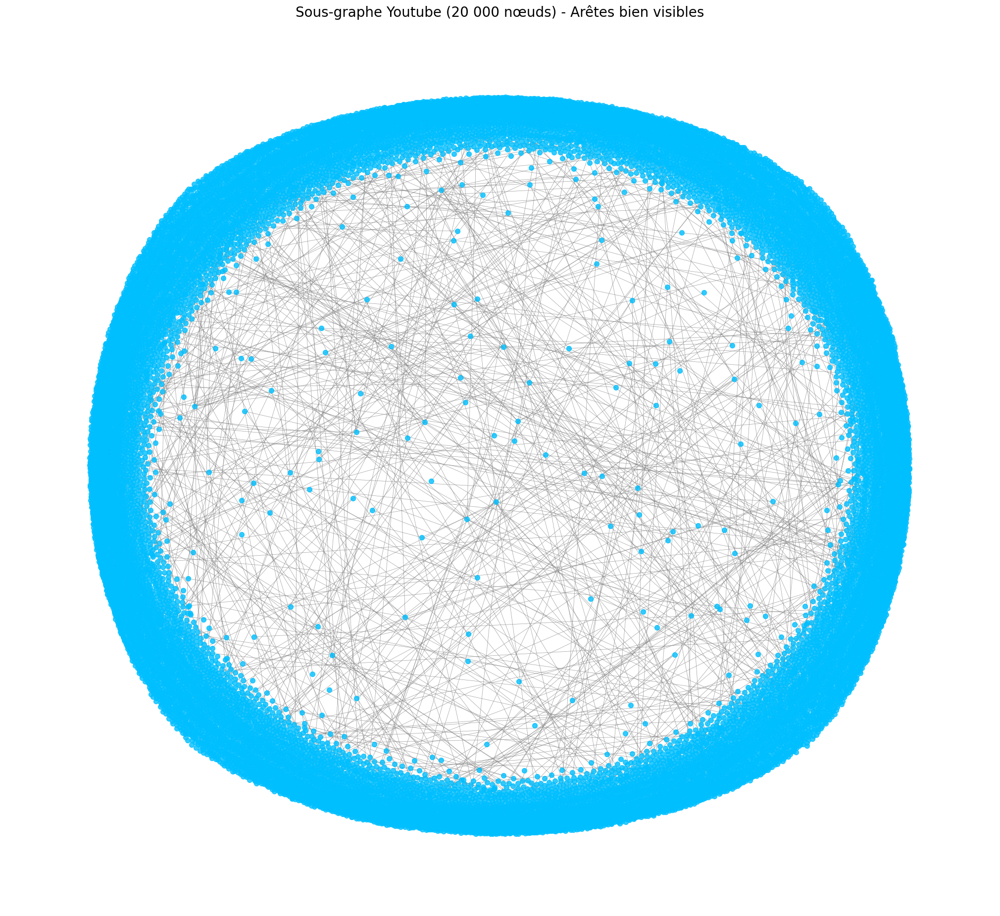

In [ ]:
import random
node_list = list(G.nodes())
sub_nodes = random.sample(node_list, 20000)
subgraph = G.subgraph(sub_nodes)

# Layout avec dispersion personnalisée
pos = nx.spring_layout(subgraph, seed=42, k=0.3)  # ➕ plus dispersé

# Affichage
plt.figure(figsize=(20, 18))  # Grande taille de figure
nx.draw(
    subgraph,
    pos,
    with_labels=False,
    node_size=50,
    edge_color='gray',
    node_color='deepskyblue',
    alpha=0.8,
    width=0.5
)

plt.title("Sous-graphe Youtube (20 000 nœuds) - Arêtes bien visibles", fontsize=20)
plt.axis('off')
plt.show()

🧩 🌐 2. Visualiser les composants connectés (10 plus grands)
python
Copier
Modifier


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


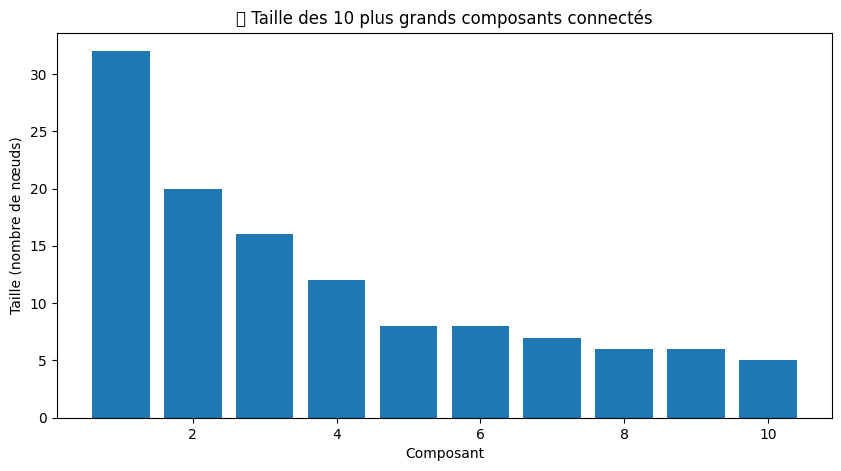

In [ ]:
components = sorted(nx.connected_components(G), key=len, reverse=True)
component_sizes = [len(c) for c in components[:10]]

plt.figure(figsize=(10, 5))
plt.bar(range(1, 11), component_sizes)
plt.xlabel("Composant")
plt.ylabel("Taille (nombre de nœuds)")
plt.title("📊 Taille des 10 plus grands composants connectés")
plt.show()

3. Visualiser les nœuds les plus centraux (centralité en degré)

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 11088 (\N{WHITE MEDIUM STAR}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


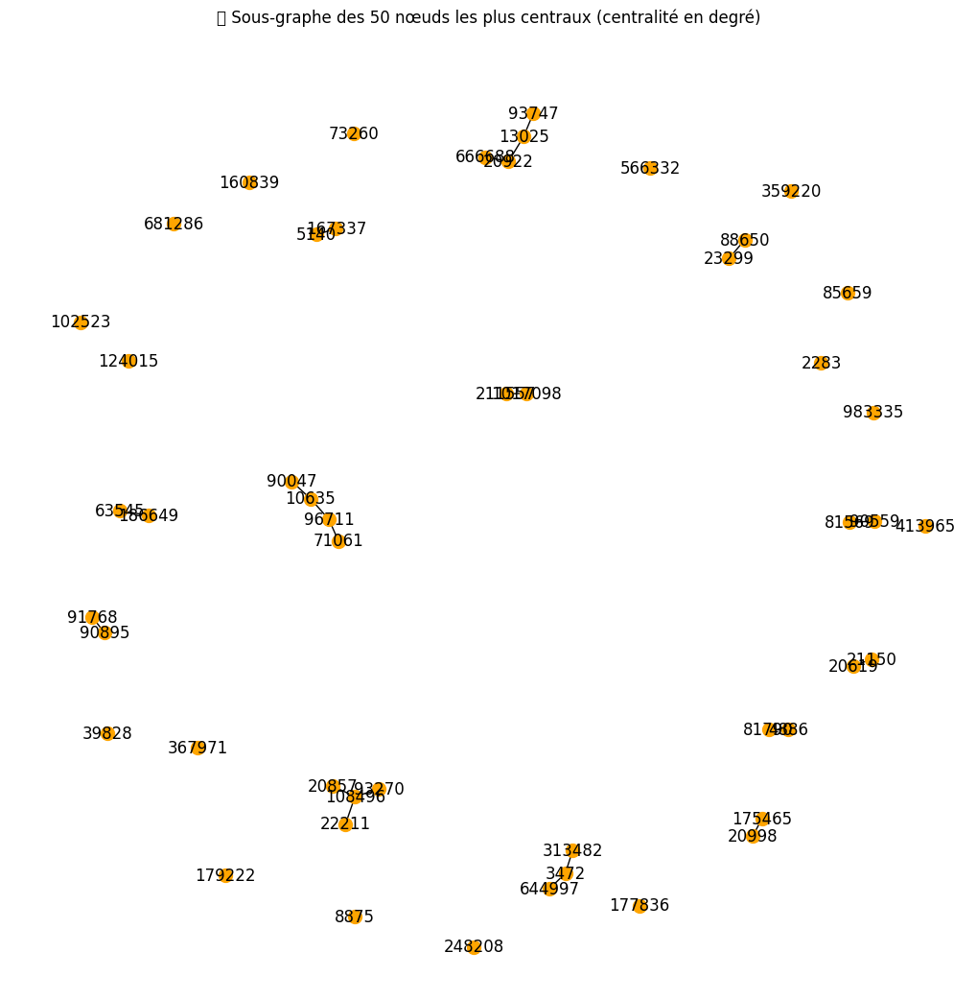

In [ ]:
# Calcul de la centralité
centrality = nx.degree_centrality(G)

# Top 50 nœuds les plus centraux
top_nodes = sorted(centrality.items(), key=lambda x: x[1], reverse=True)[:50]
top_node_ids = [node for node, _ in top_nodes]

# Créer un sous-graphe
central_subgraph = G.subgraph(top_node_ids)

plt.figure(figsize=(10, 10))
nx.draw(central_subgraph, with_labels=True, node_color='orange', node_size=100)
plt.title("⭐ Sous-graphe des 50 nœuds les plus centraux (centralité en degré)")
plt.show()


🎯 ℹ️ 4. Visualiser le plus grand composant connecté



In [ ]:
import random

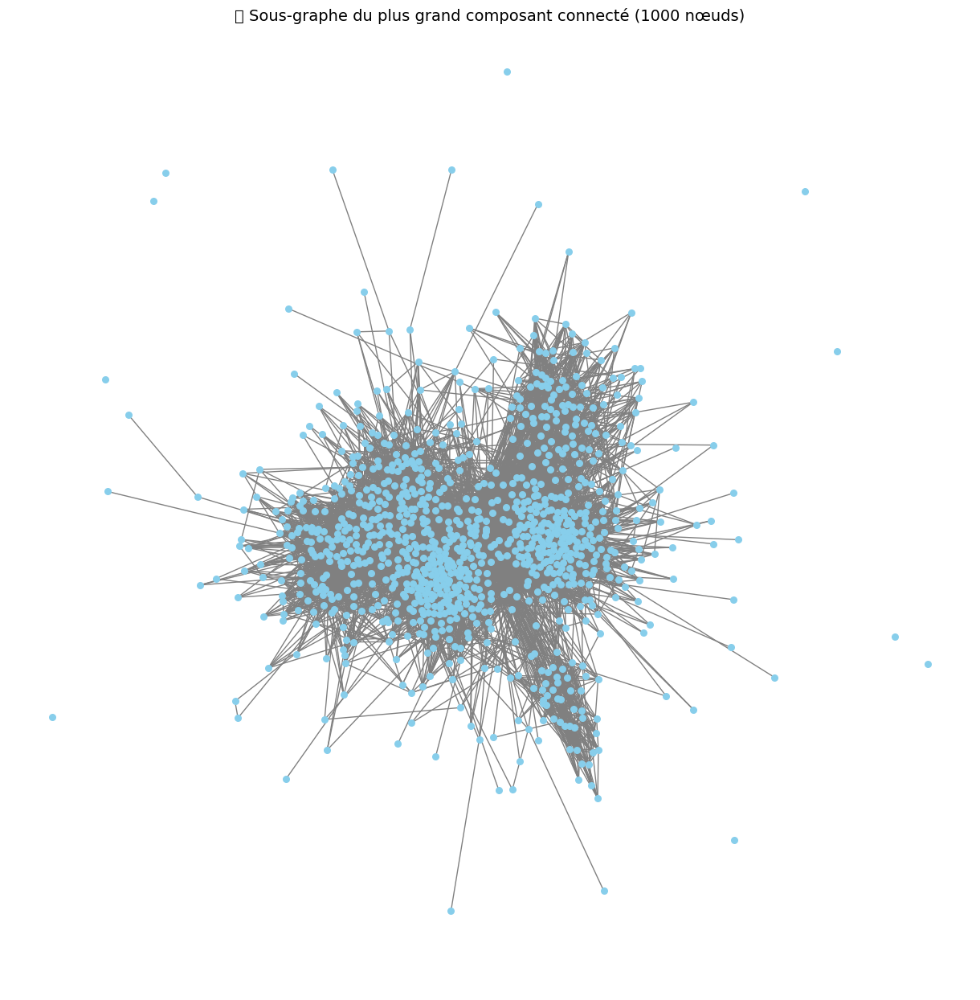

In [ ]:

# Vérifier la taille du plus grand composant
num_nodes_in_largest = len(G_largest.nodes())

# Si le nombre de nœuds est supérieur à 1000, échantillonner 1000 nœuds, sinon prendre tous les nœuds
sample_size = min(1000, num_nodes_in_largest)

# Échantillonner les nœuds
sample_nodes = random.sample(list(G_largest.nodes()), sample_size)

# Créer un sous-graphe avec ces nœuds
sub_largest = G_largest.subgraph(sample_nodes)

# Calculer un layout pour une meilleure dispersion des nœuds
pos = nx.spring_layout(sub_largest, seed=42, k=0.15, iterations=50)

# Dessiner le sous-graphe
plt.figure(figsize=(12, 12))
nx.draw(sub_largest, pos, node_color='skyblue', node_size=30, edge_color='gray', with_labels=False)
plt.title(f"🌐 Sous-graphe du plus grand composant connecté ({sample_size} nœuds)", fontsize=14)
plt.axis('off')
plt.show()

# Le code choisit deux nœuds au hasard dans le graphe et calcule le plus court chemin entre eux, gérant les cas où aucun chemin n'existe.

In [ ]:
# Choisir deux nœuds au hasard
node1, node2 = random.sample(list(G.nodes()), 2)

# Essayer de calculer le plus court chemin entre node1 et node2
try:
    shortest_path = nx.shortest_path(G, source=node1, target=node2)
    print(f"Le plus court chemin entre {node1} et {node2} est : {shortest_path}")
except nx.NetworkXNoPath:
    print(f"Aucun chemin entre les nœuds {node1} et {node2}.")


Aucun chemin entre les nœuds 1097082 et 838760.


# vérifie si le graphe est connecté et calcule la distance moyenne entre les nœuds. Si le graphe est déconnecté, il divise le graphe en composants connectés et calcule la distance moyenne pour chaque composant.

In [ ]:
## Vérifier si le graphe est connecté
if nx.is_connected(G):
    # Calcul de la distance moyenne si le graphe est connecté
    average_distance = nx.average_shortest_path_length(G)
    print(f"Distance moyenne entre tous les nœuds : {average_distance:.2f}")
else:
    # Calculer la distance moyenne pour chaque composant connecté
    components = list(nx.connected_components(G))
    for i, component in enumerate(components):
        subgraph = G.subgraph(component)
        avg_dist = nx.average_shortest_path_length(subgraph)
        print(f"Distance moyenne pour le composant {i+1} : {avg_dist:.2f}")


Distance moyenne pour le composant 1 : 0.00
Distance moyenne pour le composant 2 : 0.00
Distance moyenne pour le composant 3 : 0.00
Distance moyenne pour le composant 4 : 0.00
Distance moyenne pour le composant 5 : 0.00
Distance moyenne pour le composant 6 : 0.00
Distance moyenne pour le composant 7 : 0.00
Distance moyenne pour le composant 8 : 0.00
Distance moyenne pour le composant 9 : 0.00
Distance moyenne pour le composant 10 : 0.00
Distance moyenne pour le composant 11 : 0.00
Distance moyenne pour le composant 12 : 0.00
Distance moyenne pour le composant 13 : 0.00
Distance moyenne pour le composant 14 : 0.00
Distance moyenne pour le composant 15 : 0.00
Distance moyenne pour le composant 16 : 0.00
Distance moyenne pour le composant 17 : 0.00
Distance moyenne pour le composant 18 : 0.00
Distance moyenne pour le composant 19 : 0.00
Distance moyenne pour le composant 20 : 0.00
Distance moyenne pour le composant 21 : 0.00
Distance moyenne pour le composant 22 : 0.00
Distance moyenne po

 analyse un graphe en vérifiant s'il est connecté. Si le graphe est connecté, il calcule la distance moyenne entre tous les nœuds. S'il est déconnecté, il calcule la distance moyenne pour chaque composant. Pour les composants avec une distance moyenne de zéro, il mesure la densité, le degré moyen et le coefficient de clustering, et affiche une visualisation du composant.

Distance moyenne pour le composant 1 : 0.00
Le composant 1 est un graphe complet ou très densément connecté.
Densité du composant 1 : 0.00
Degré moyen du composant 1 : 0.00
Coefficient de clustering moyen du composant 1 : 0.00


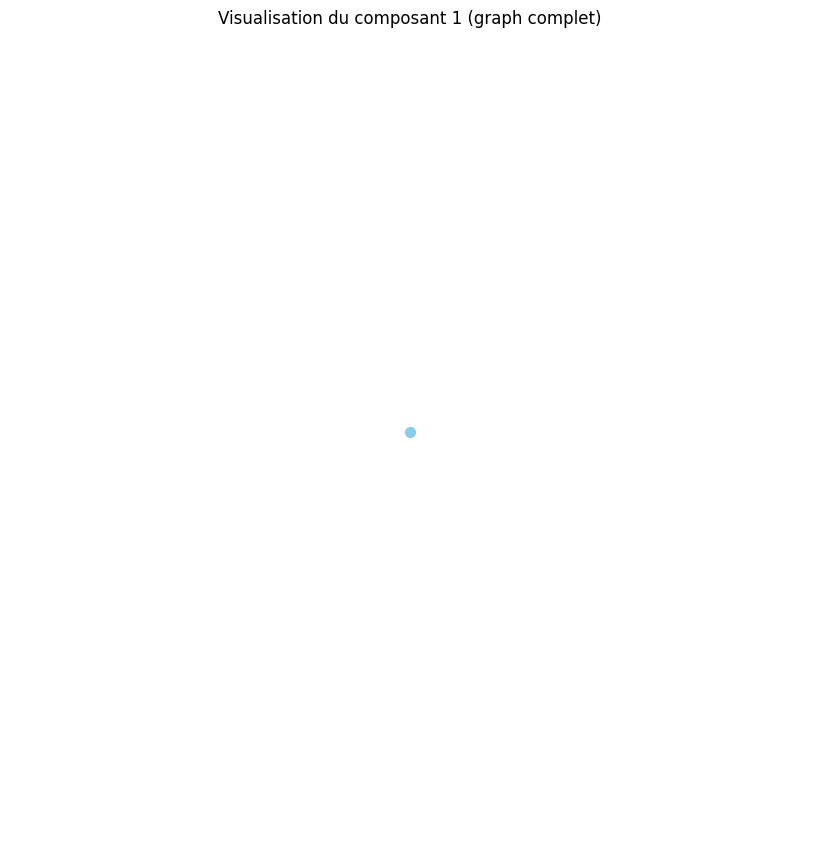

Distance moyenne pour le composant 2 : 0.00
Le composant 2 est un graphe complet ou très densément connecté.
Densité du composant 2 : 0.00
Degré moyen du composant 2 : 0.00
Coefficient de clustering moyen du composant 2 : 0.00


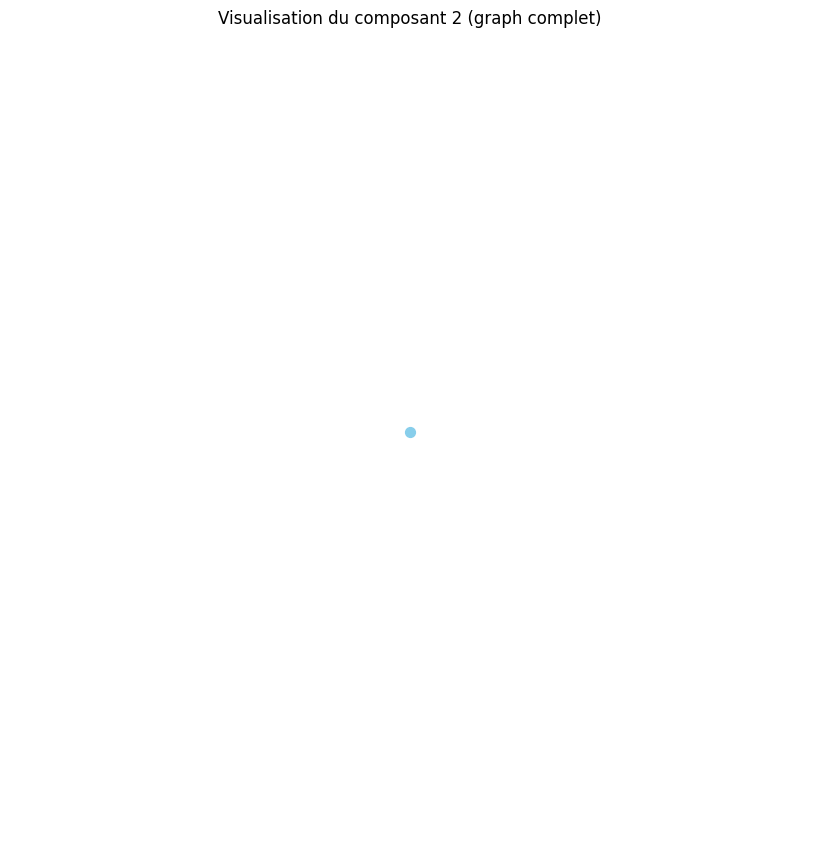

Distance moyenne pour le composant 3 : 0.00
Le composant 3 est un graphe complet ou très densément connecté.
Densité du composant 3 : 0.00
Degré moyen du composant 3 : 0.00
Coefficient de clustering moyen du composant 3 : 0.00


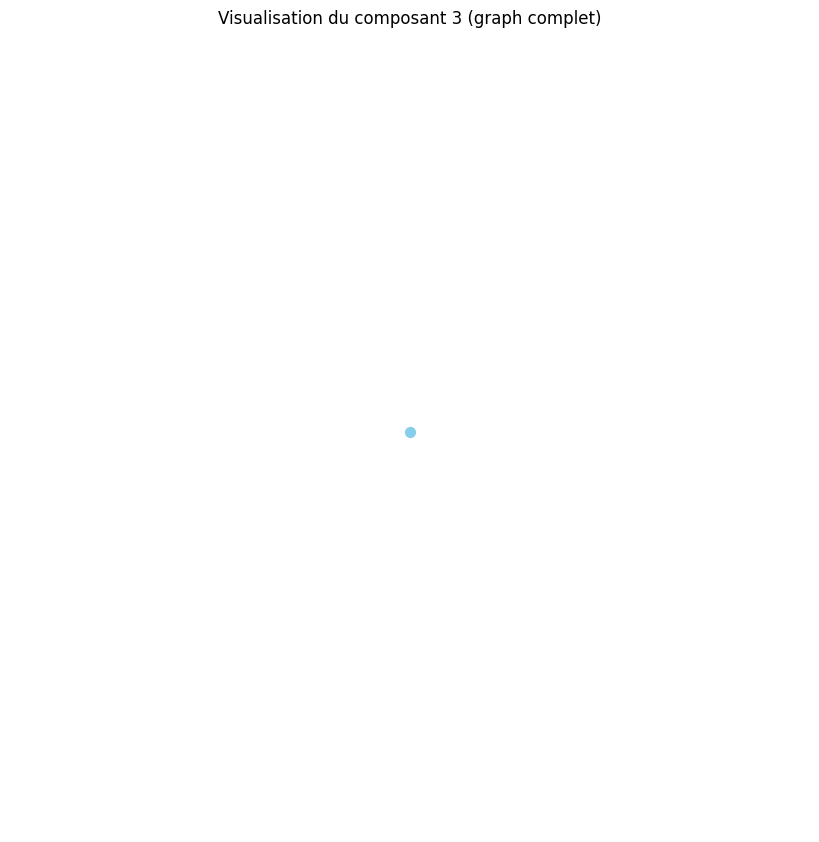

Distance moyenne pour le composant 4 : 0.00
Le composant 4 est un graphe complet ou très densément connecté.
Densité du composant 4 : 0.00
Degré moyen du composant 4 : 0.00
Coefficient de clustering moyen du composant 4 : 0.00


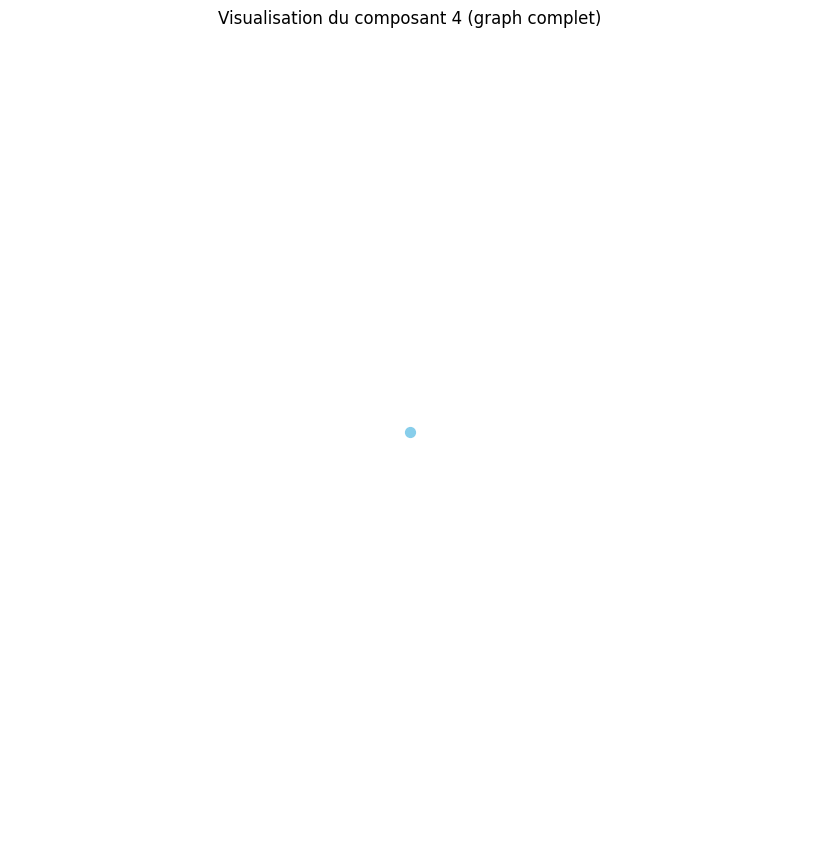

Distance moyenne pour le composant 5 : 0.00
Le composant 5 est un graphe complet ou très densément connecté.
Densité du composant 5 : 0.00
Degré moyen du composant 5 : 0.00
Coefficient de clustering moyen du composant 5 : 0.00


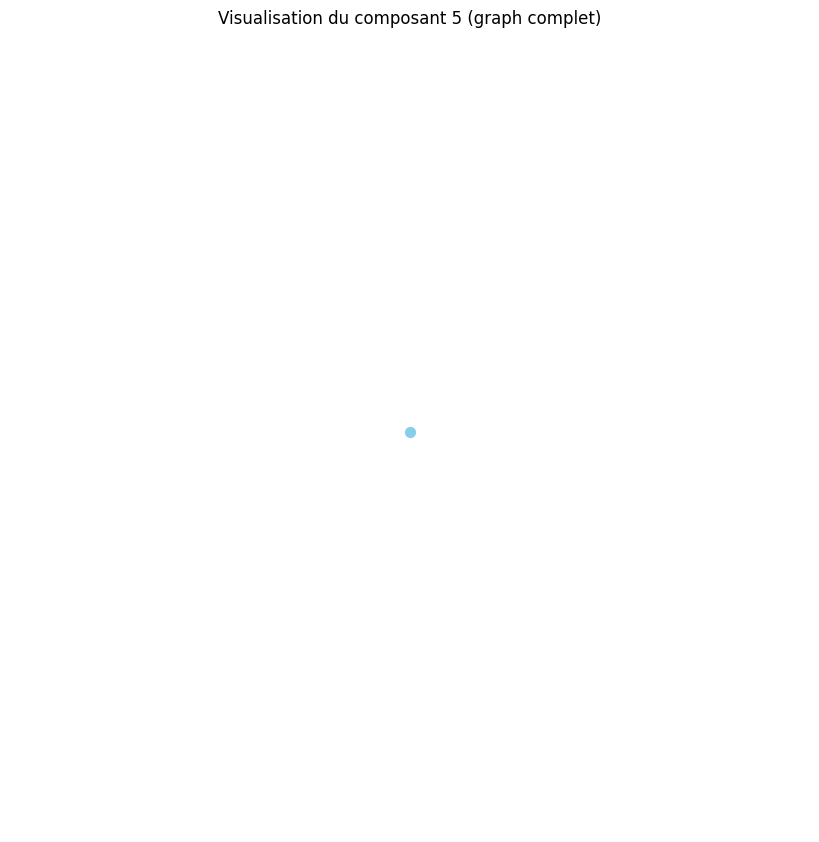

Distance moyenne pour le composant 6 : 0.00
Le composant 6 est un graphe complet ou très densément connecté.
Densité du composant 6 : 0.00
Degré moyen du composant 6 : 0.00
Coefficient de clustering moyen du composant 6 : 0.00


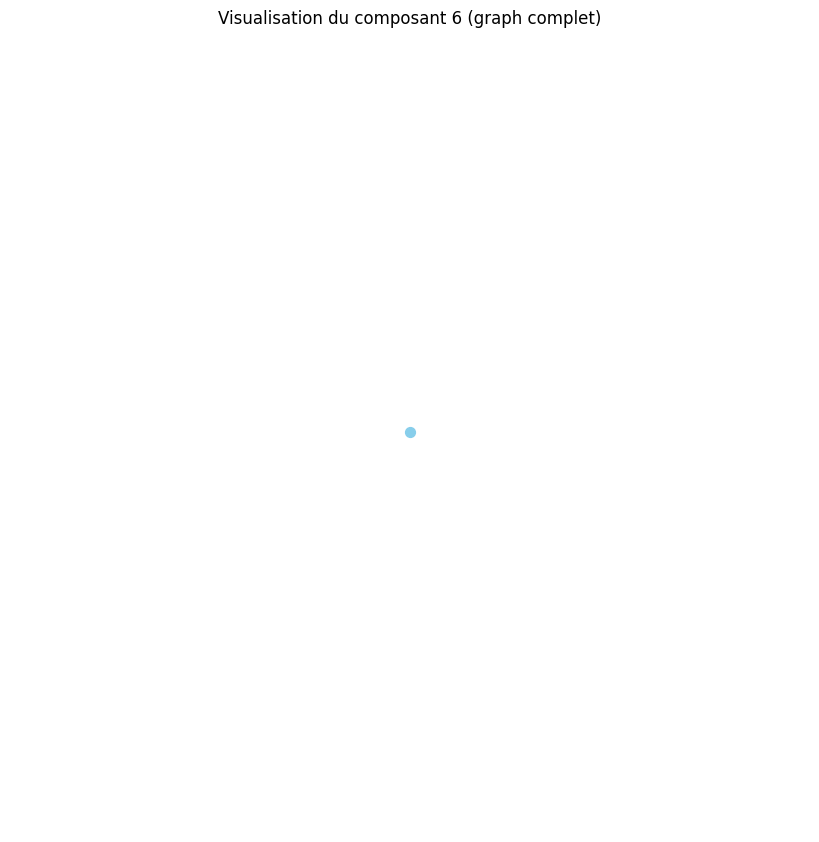

Distance moyenne pour le composant 7 : 0.00
Le composant 7 est un graphe complet ou très densément connecté.
Densité du composant 7 : 0.00
Degré moyen du composant 7 : 0.00
Coefficient de clustering moyen du composant 7 : 0.00


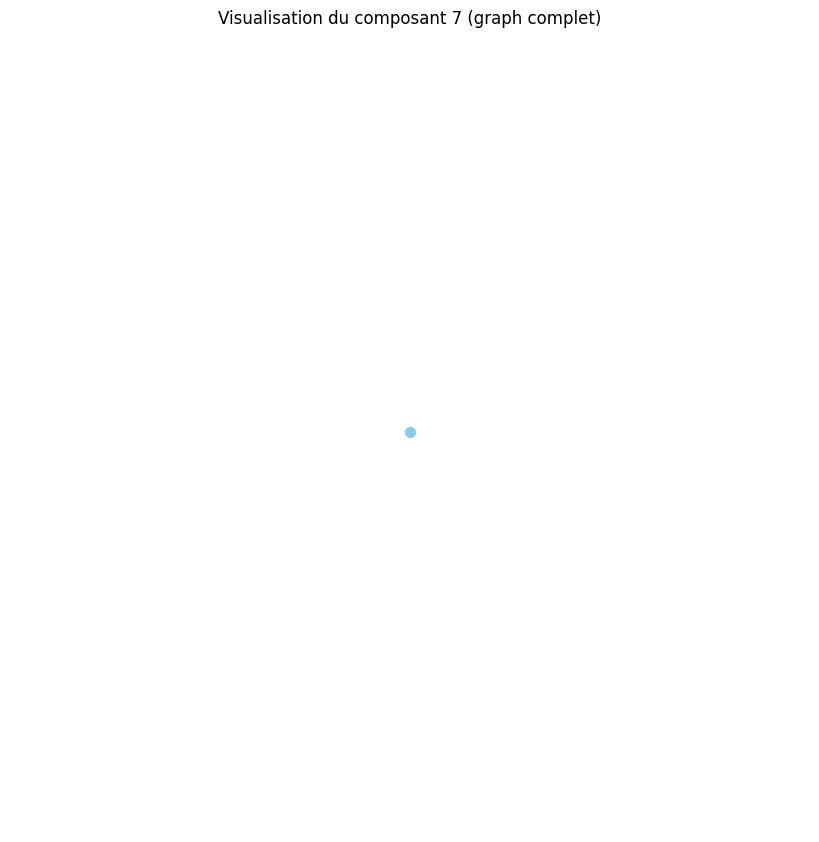

Distance moyenne pour le composant 8 : 0.00
Le composant 8 est un graphe complet ou très densément connecté.
Densité du composant 8 : 0.00
Degré moyen du composant 8 : 0.00
Coefficient de clustering moyen du composant 8 : 0.00


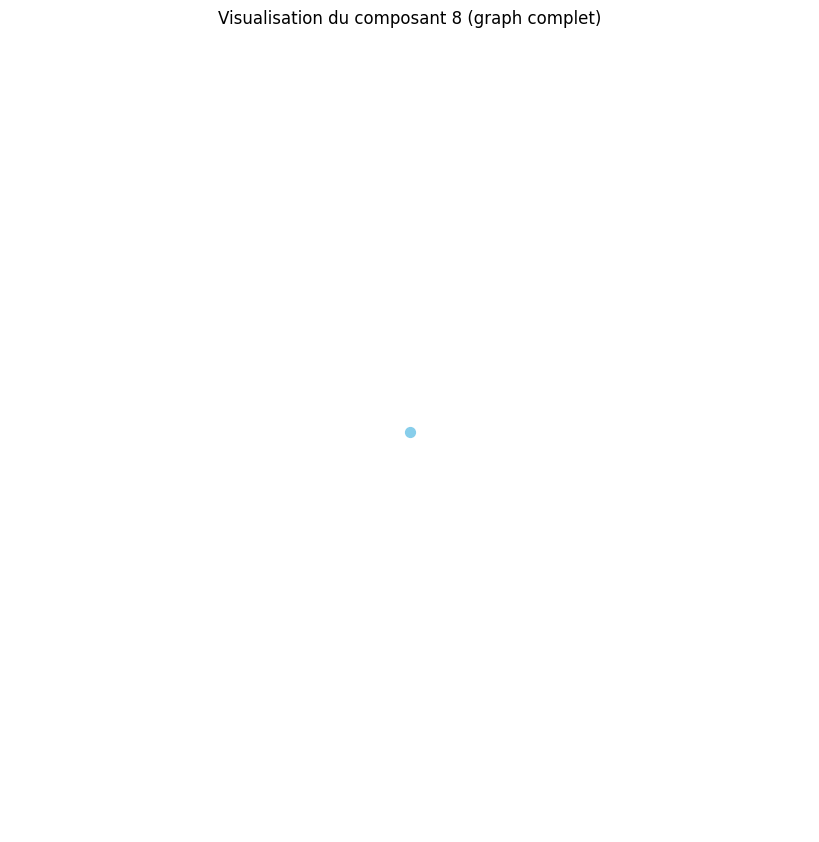

Distance moyenne pour le composant 9 : 0.00
Le composant 9 est un graphe complet ou très densément connecté.
Densité du composant 9 : 0.00
Degré moyen du composant 9 : 0.00
Coefficient de clustering moyen du composant 9 : 0.00


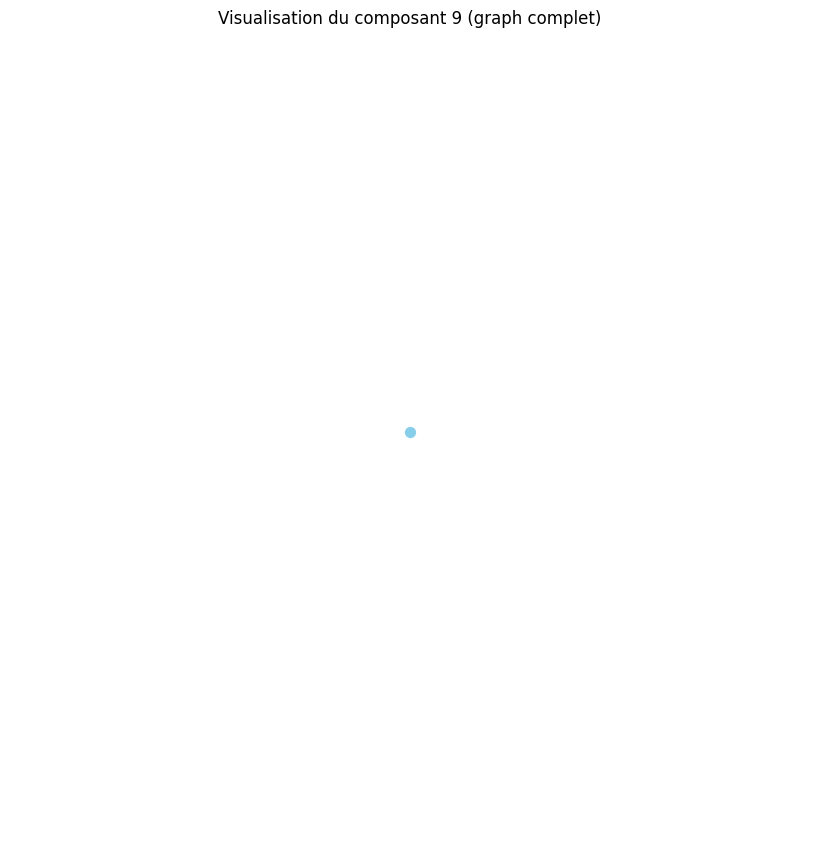

Distance moyenne pour le composant 10 : 0.00
Le composant 10 est un graphe complet ou très densément connecté.
Densité du composant 10 : 0.00
Degré moyen du composant 10 : 0.00
Coefficient de clustering moyen du composant 10 : 0.00


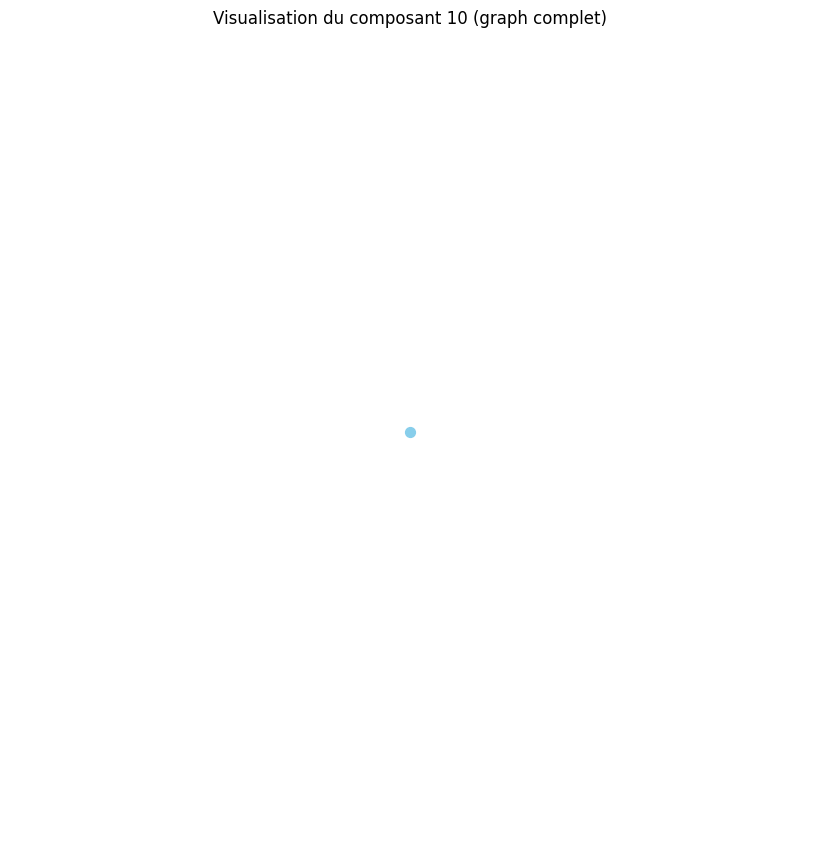

Distance moyenne pour le composant 11 : 0.00
Le composant 11 est un graphe complet ou très densément connecté.
Densité du composant 11 : 0.00
Degré moyen du composant 11 : 0.00
Coefficient de clustering moyen du composant 11 : 0.00


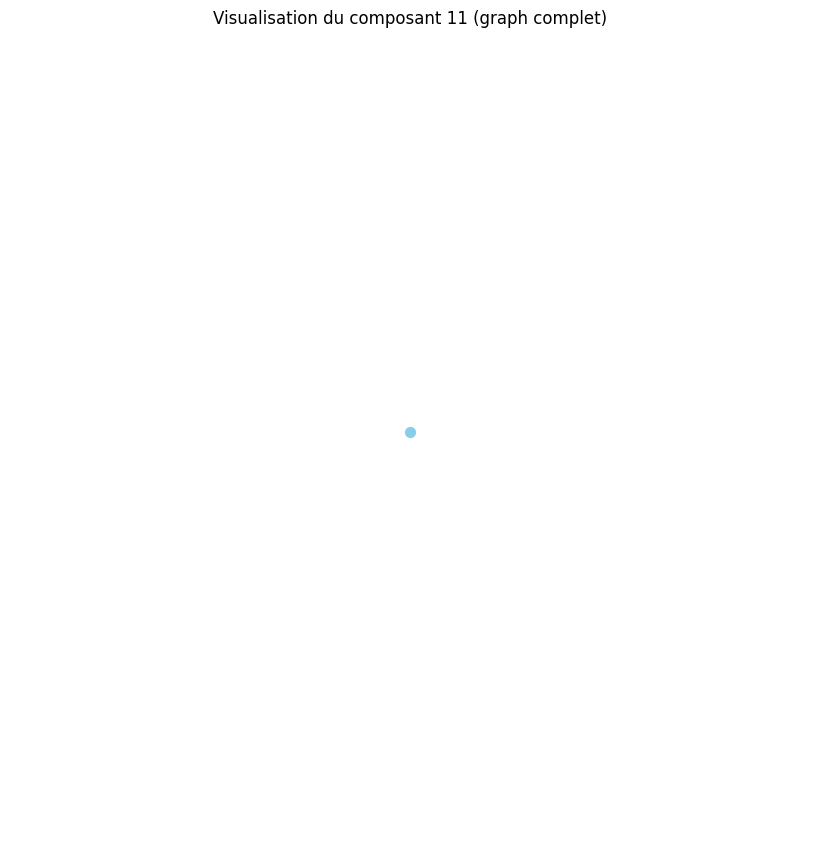

Distance moyenne pour le composant 12 : 0.00
Le composant 12 est un graphe complet ou très densément connecté.
Densité du composant 12 : 0.00
Degré moyen du composant 12 : 0.00
Coefficient de clustering moyen du composant 12 : 0.00


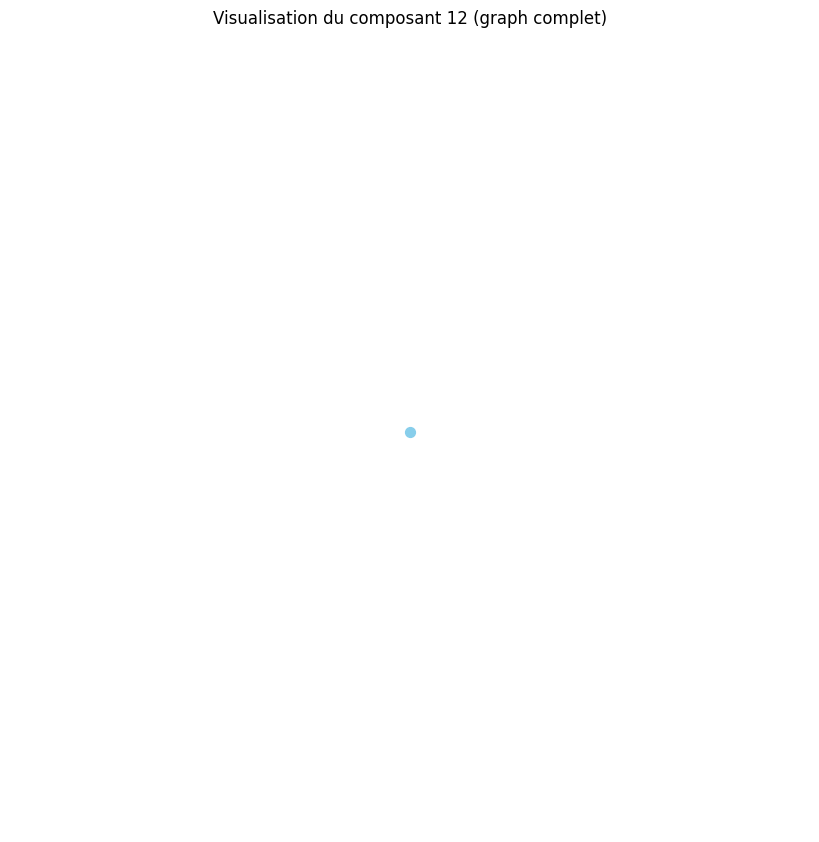

Distance moyenne pour le composant 13 : 0.00
Le composant 13 est un graphe complet ou très densément connecté.
Densité du composant 13 : 0.00
Degré moyen du composant 13 : 0.00
Coefficient de clustering moyen du composant 13 : 0.00


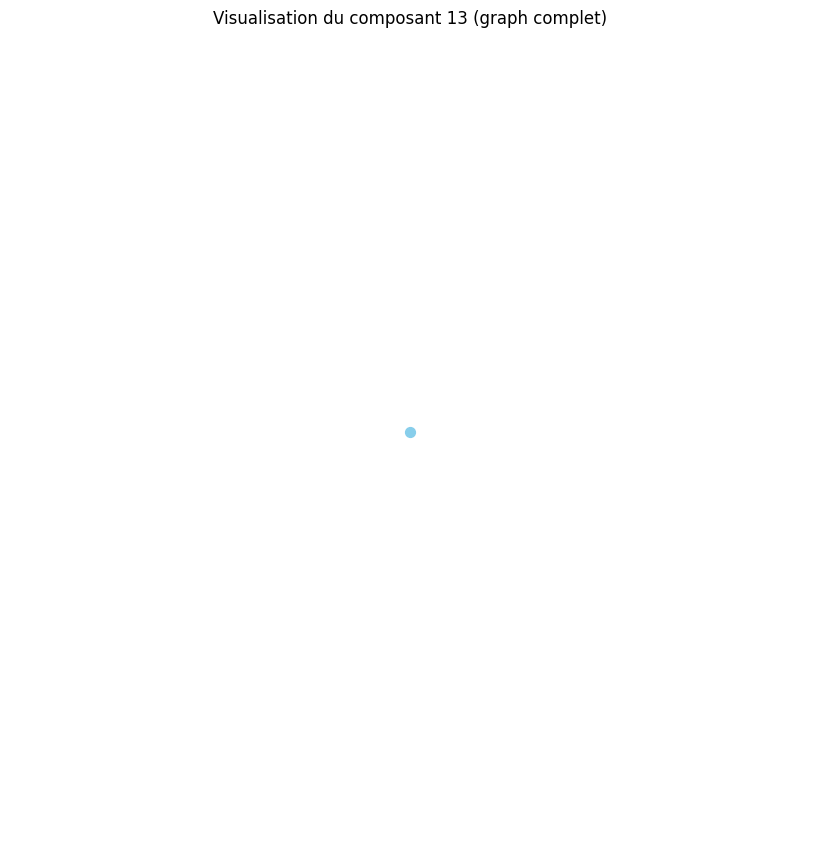

Distance moyenne pour le composant 14 : 0.00
Le composant 14 est un graphe complet ou très densément connecté.
Densité du composant 14 : 0.00
Degré moyen du composant 14 : 0.00
Coefficient de clustering moyen du composant 14 : 0.00


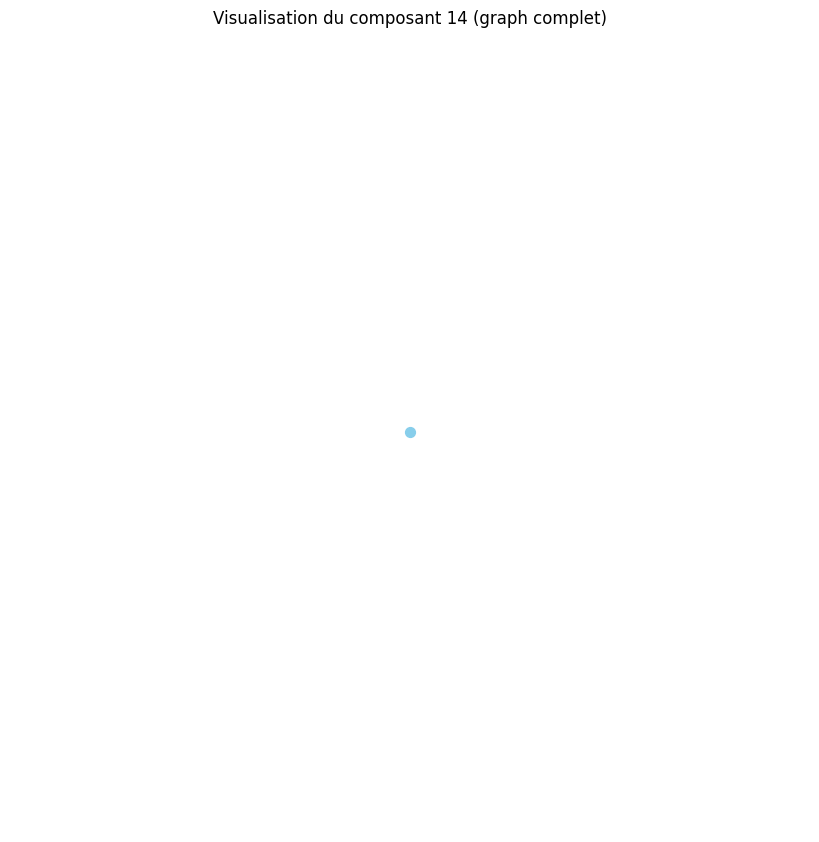

Distance moyenne pour le composant 15 : 0.00
Le composant 15 est un graphe complet ou très densément connecté.
Densité du composant 15 : 0.00
Degré moyen du composant 15 : 0.00
Coefficient de clustering moyen du composant 15 : 0.00


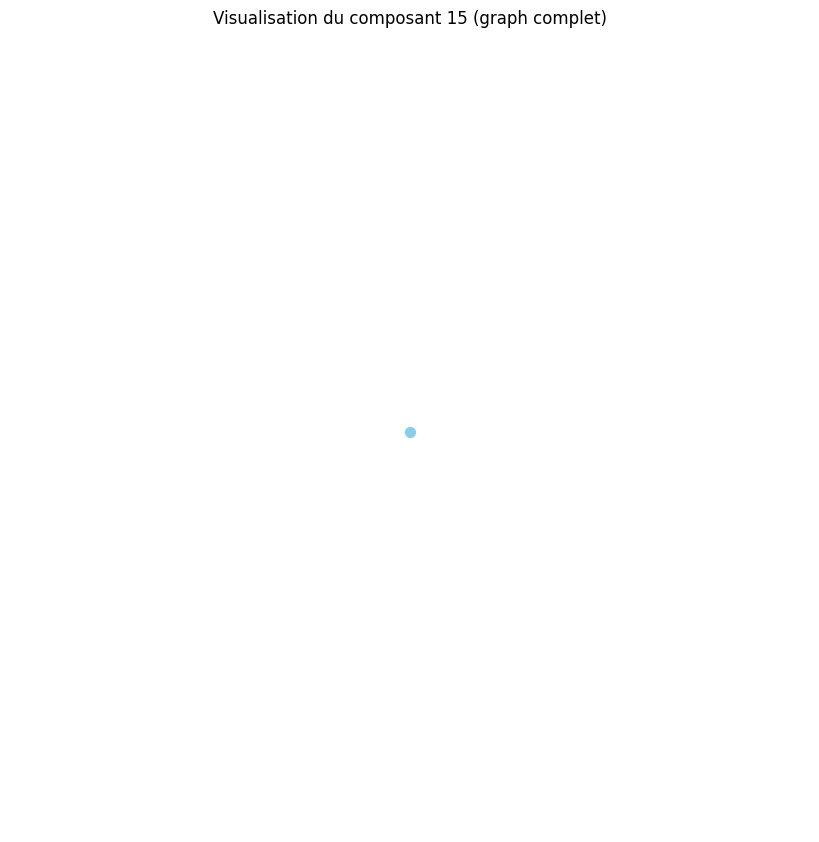

Distance moyenne pour le composant 16 : 0.00
Le composant 16 est un graphe complet ou très densément connecté.
Densité du composant 16 : 0.00
Degré moyen du composant 16 : 0.00
Coefficient de clustering moyen du composant 16 : 0.00


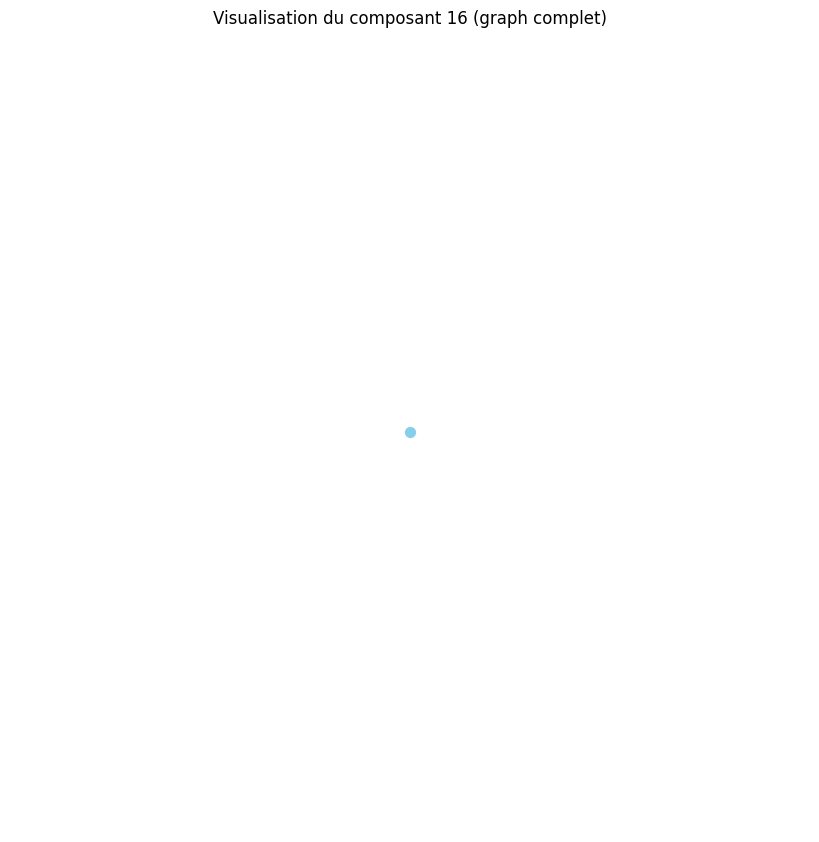

Distance moyenne pour le composant 17 : 0.00
Le composant 17 est un graphe complet ou très densément connecté.
Densité du composant 17 : 0.00
Degré moyen du composant 17 : 0.00
Coefficient de clustering moyen du composant 17 : 0.00


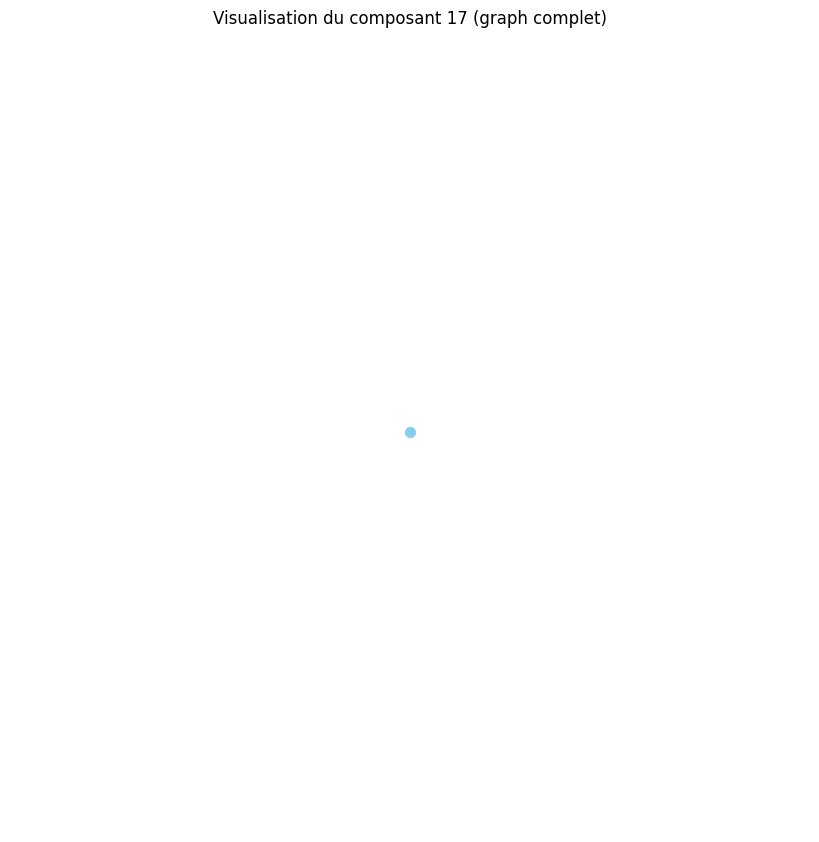

Distance moyenne pour le composant 18 : 0.00
Le composant 18 est un graphe complet ou très densément connecté.
Densité du composant 18 : 0.00
Degré moyen du composant 18 : 0.00
Coefficient de clustering moyen du composant 18 : 0.00


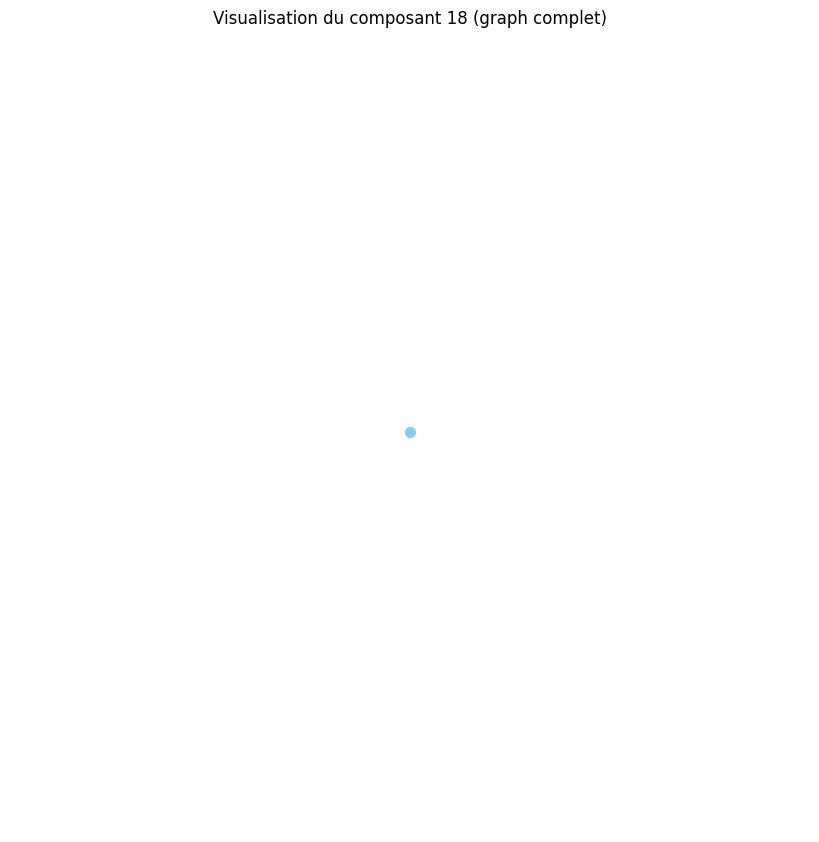

Distance moyenne pour le composant 19 : 0.00
Le composant 19 est un graphe complet ou très densément connecté.
Densité du composant 19 : 0.00
Degré moyen du composant 19 : 0.00
Coefficient de clustering moyen du composant 19 : 0.00


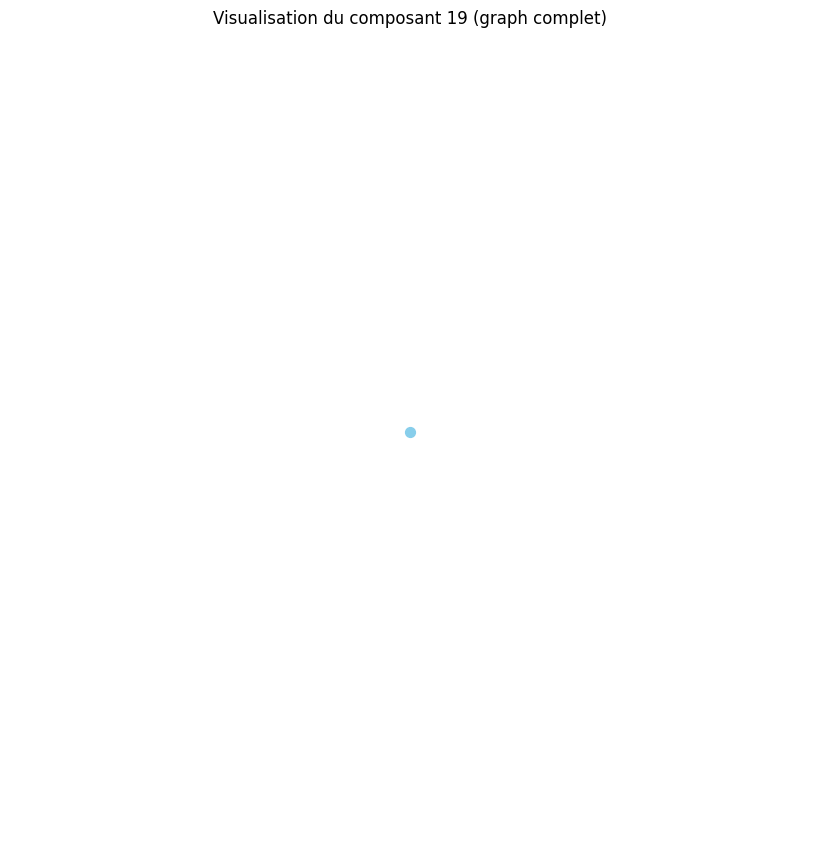

Distance moyenne pour le composant 20 : 0.00
Le composant 20 est un graphe complet ou très densément connecté.
Densité du composant 20 : 0.00
Degré moyen du composant 20 : 0.00
Coefficient de clustering moyen du composant 20 : 0.00


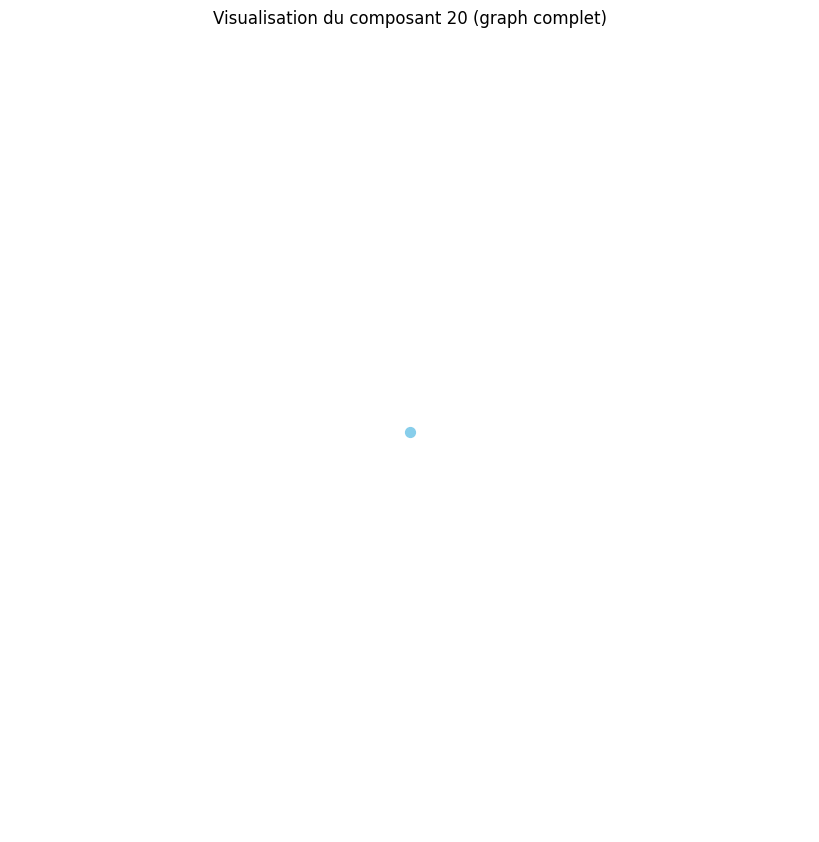

Distance moyenne pour le composant 21 : 0.00
Le composant 21 est un graphe complet ou très densément connecté.
Densité du composant 21 : 0.00
Degré moyen du composant 21 : 0.00
Coefficient de clustering moyen du composant 21 : 0.00


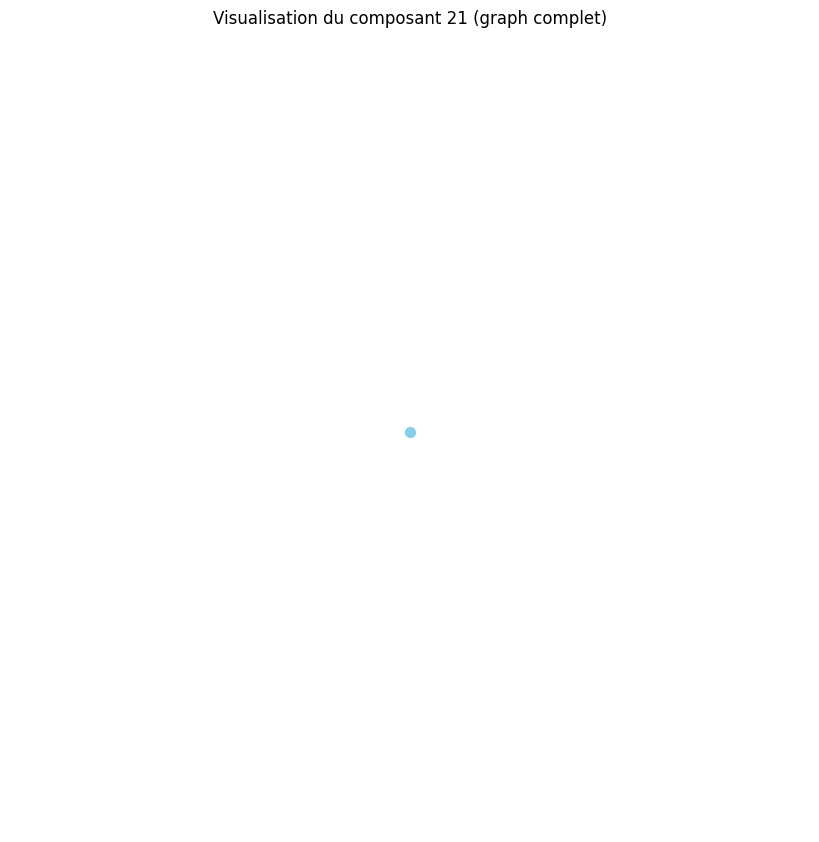

Distance moyenne pour le composant 22 : 0.00
Le composant 22 est un graphe complet ou très densément connecté.
Densité du composant 22 : 0.00
Degré moyen du composant 22 : 0.00
Coefficient de clustering moyen du composant 22 : 0.00


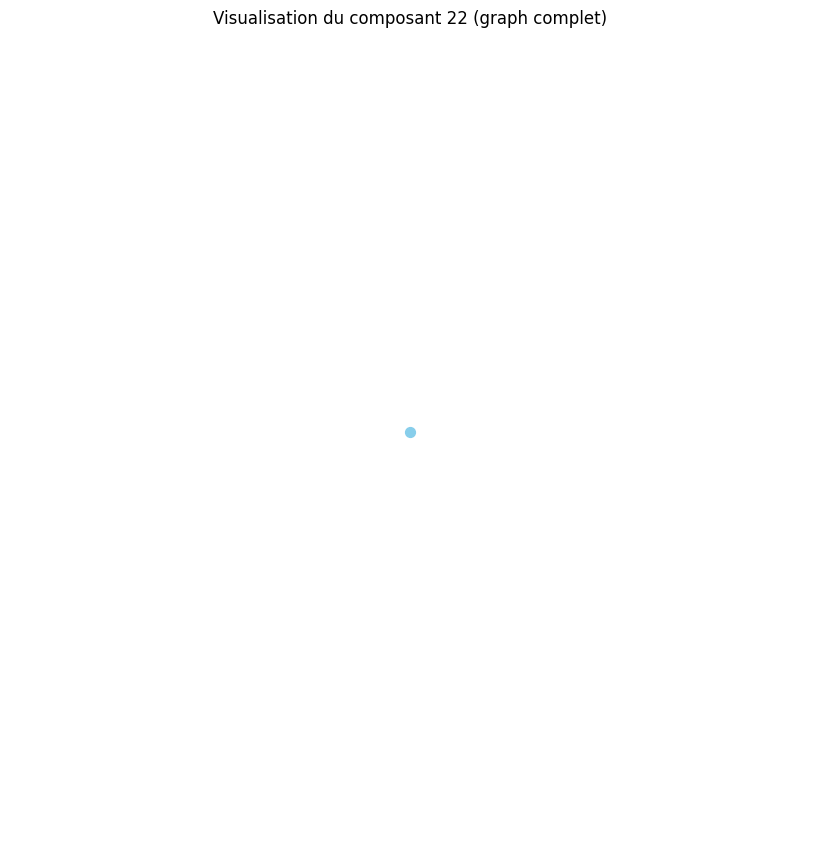

Distance moyenne pour le composant 23 : 0.00
Le composant 23 est un graphe complet ou très densément connecté.
Densité du composant 23 : 0.00
Degré moyen du composant 23 : 0.00
Coefficient de clustering moyen du composant 23 : 0.00


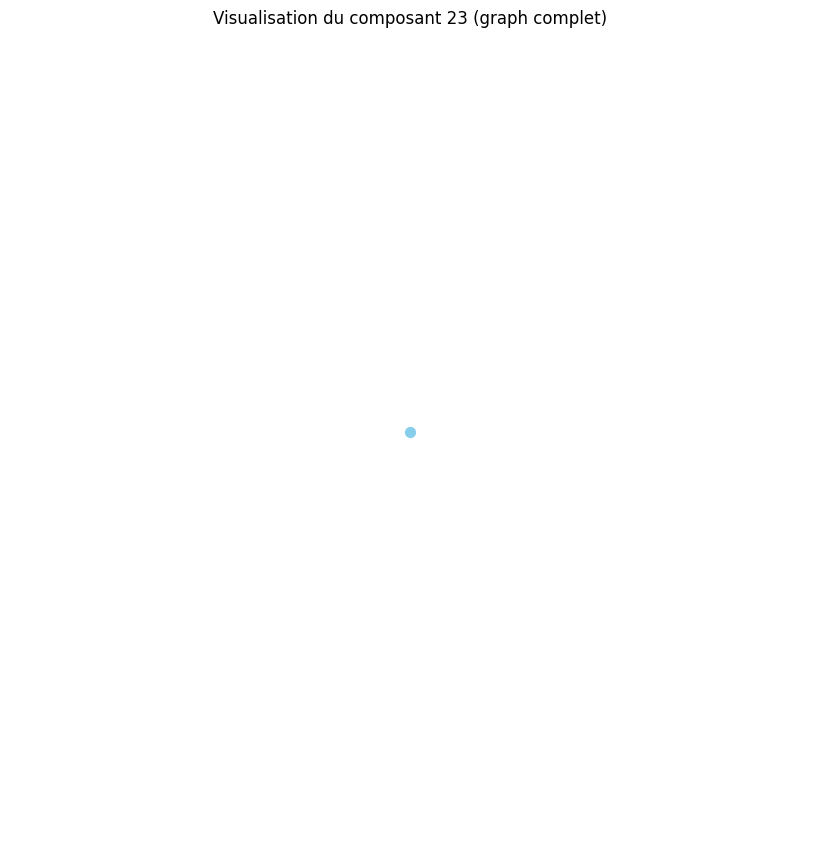

Distance moyenne pour le composant 24 : 0.00
Le composant 24 est un graphe complet ou très densément connecté.
Densité du composant 24 : 0.00
Degré moyen du composant 24 : 0.00
Coefficient de clustering moyen du composant 24 : 0.00


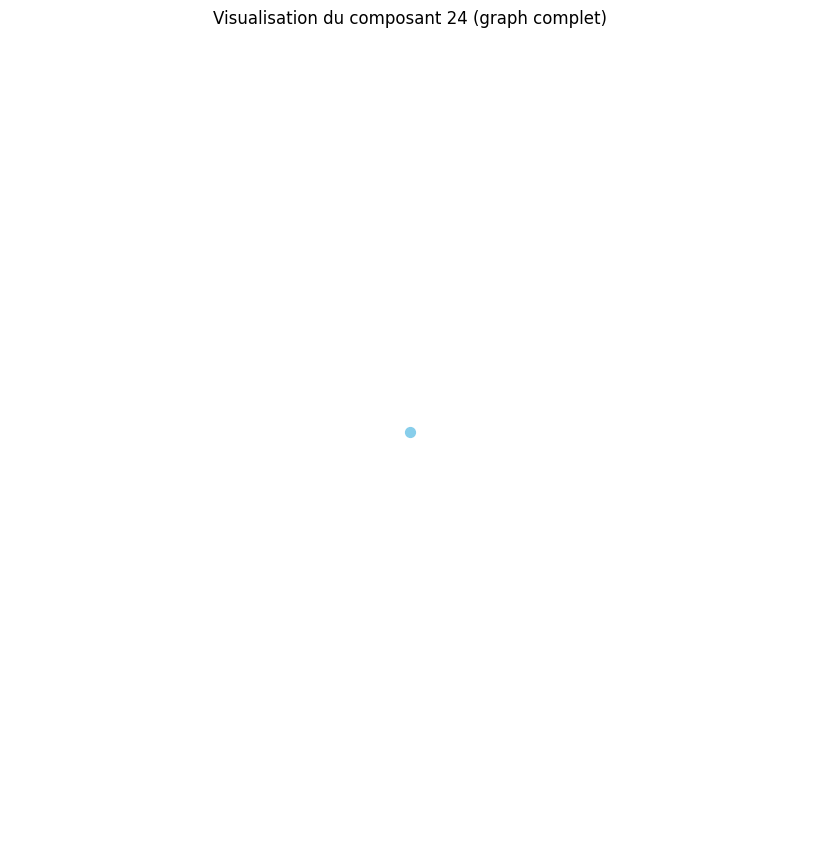

Distance moyenne pour le composant 25 : 0.00
Le composant 25 est un graphe complet ou très densément connecté.
Densité du composant 25 : 0.00
Degré moyen du composant 25 : 0.00
Coefficient de clustering moyen du composant 25 : 0.00


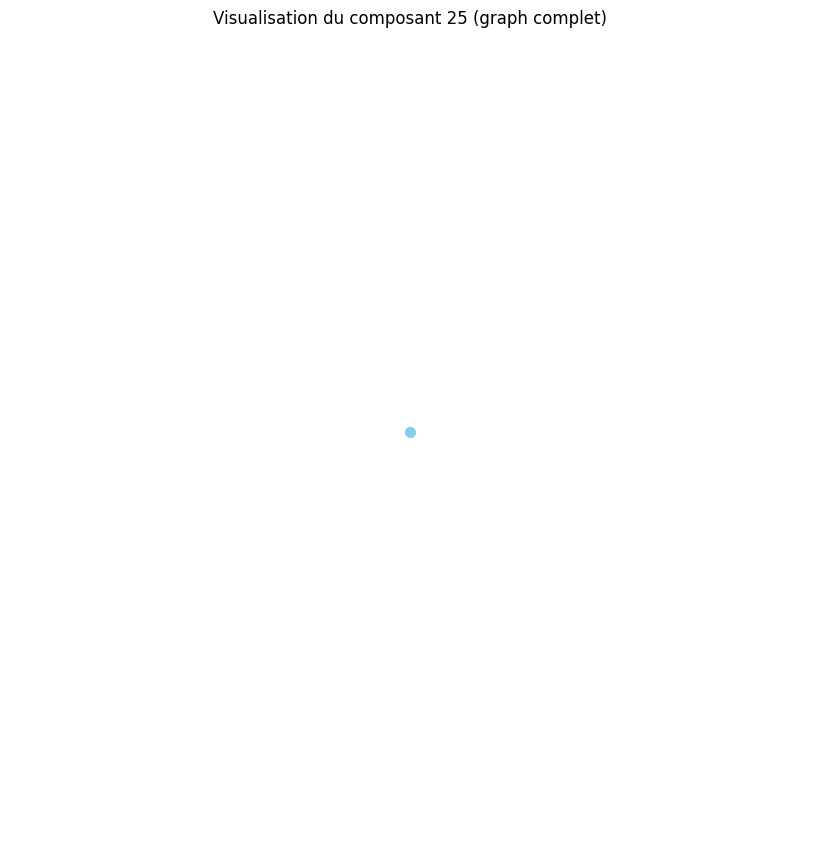

Distance moyenne pour le composant 26 : 0.00
Le composant 26 est un graphe complet ou très densément connecté.
Densité du composant 26 : 0.00
Degré moyen du composant 26 : 0.00
Coefficient de clustering moyen du composant 26 : 0.00


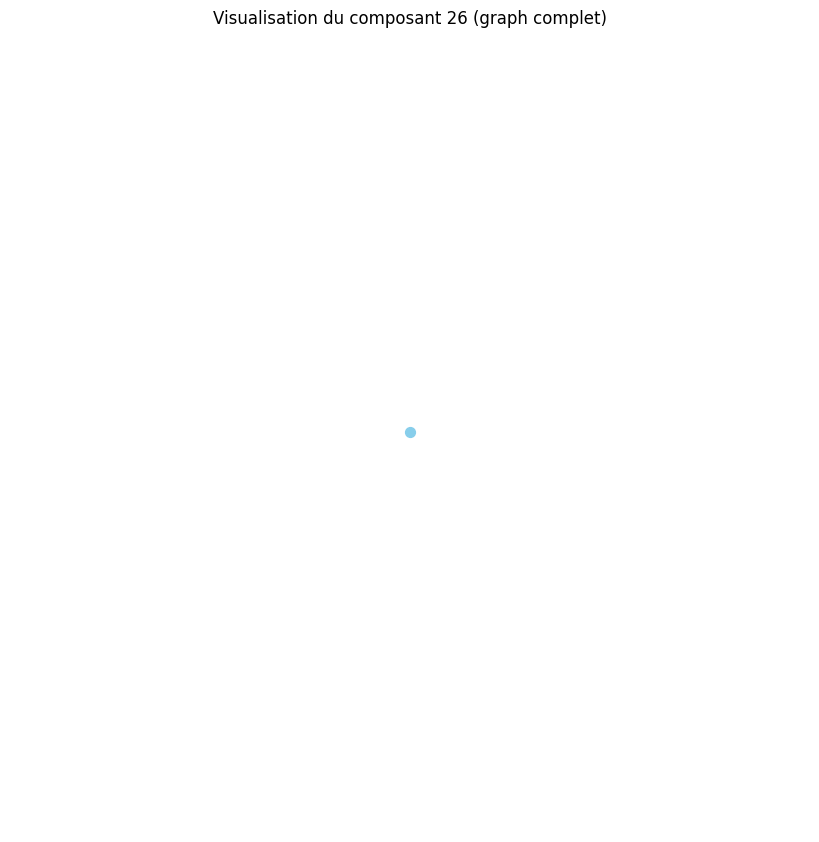

Distance moyenne pour le composant 27 : 0.00
Le composant 27 est un graphe complet ou très densément connecté.
Densité du composant 27 : 0.00
Degré moyen du composant 27 : 0.00
Coefficient de clustering moyen du composant 27 : 0.00


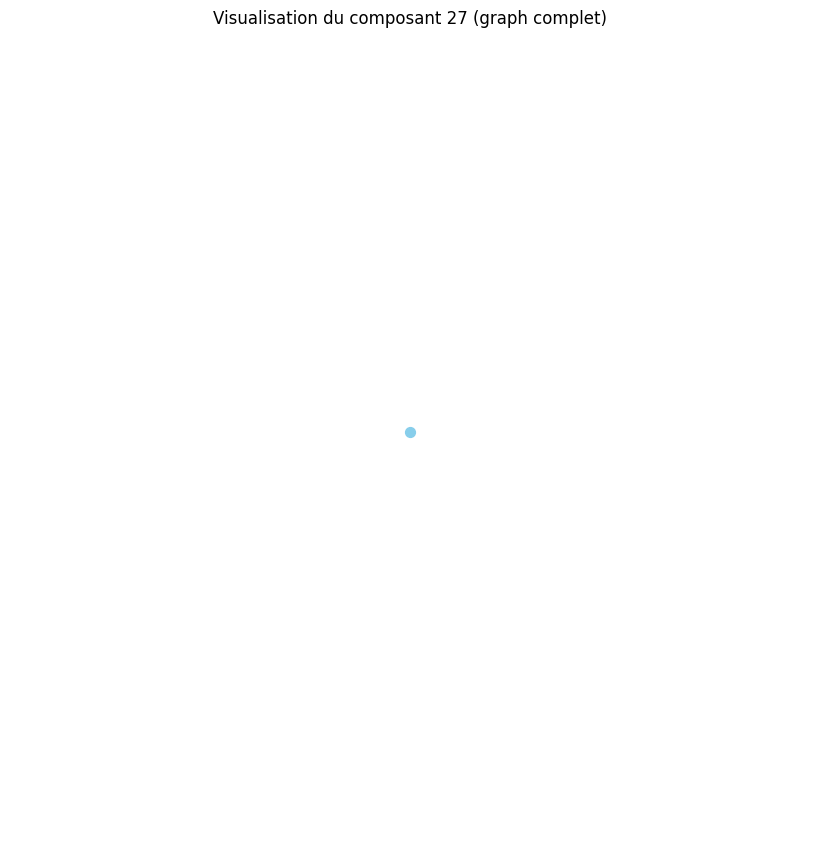

Distance moyenne pour le composant 28 : 0.00
Le composant 28 est un graphe complet ou très densément connecté.
Densité du composant 28 : 0.00
Degré moyen du composant 28 : 0.00
Coefficient de clustering moyen du composant 28 : 0.00


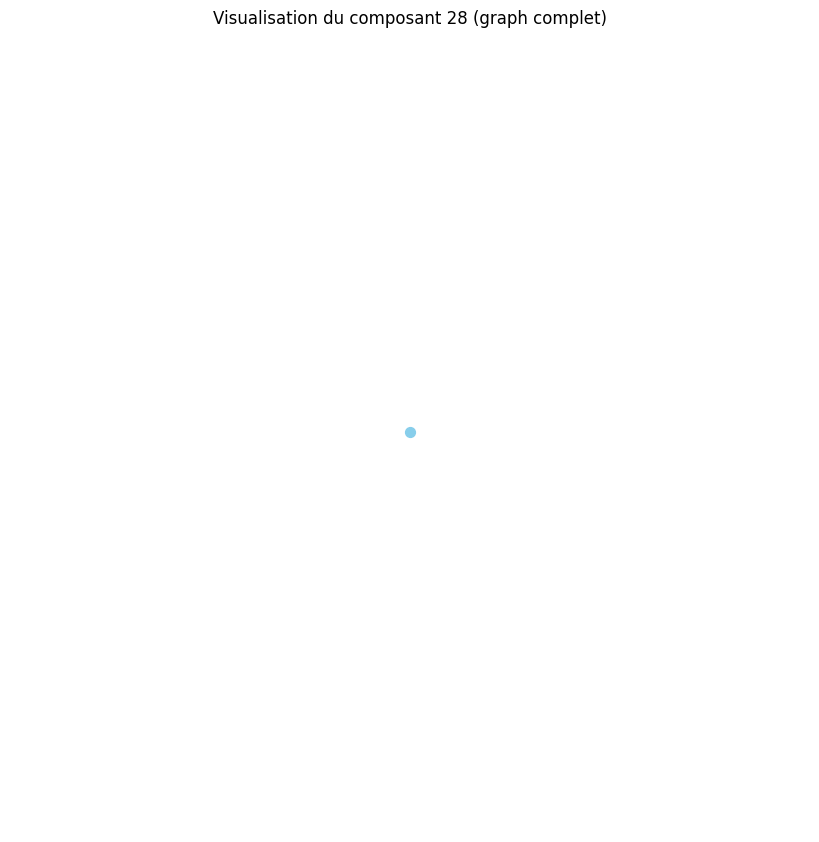

Distance moyenne pour le composant 29 : 0.00
Le composant 29 est un graphe complet ou très densément connecté.
Densité du composant 29 : 0.00
Degré moyen du composant 29 : 0.00
Coefficient de clustering moyen du composant 29 : 0.00


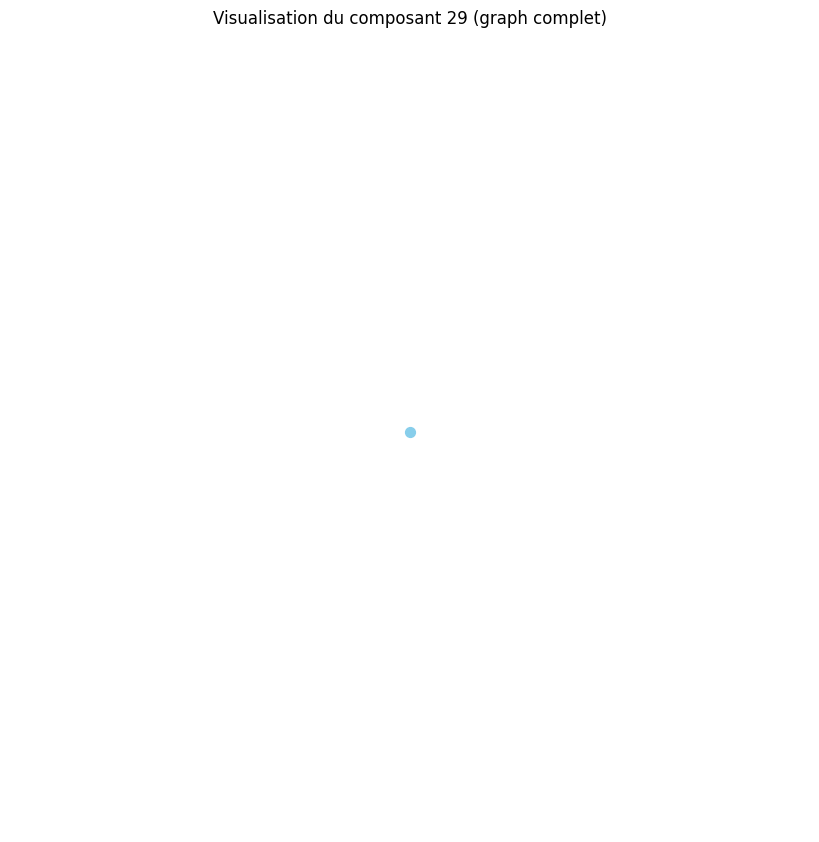

Distance moyenne pour le composant 30 : 0.00
Le composant 30 est un graphe complet ou très densément connecté.
Densité du composant 30 : 0.00
Degré moyen du composant 30 : 0.00
Coefficient de clustering moyen du composant 30 : 0.00


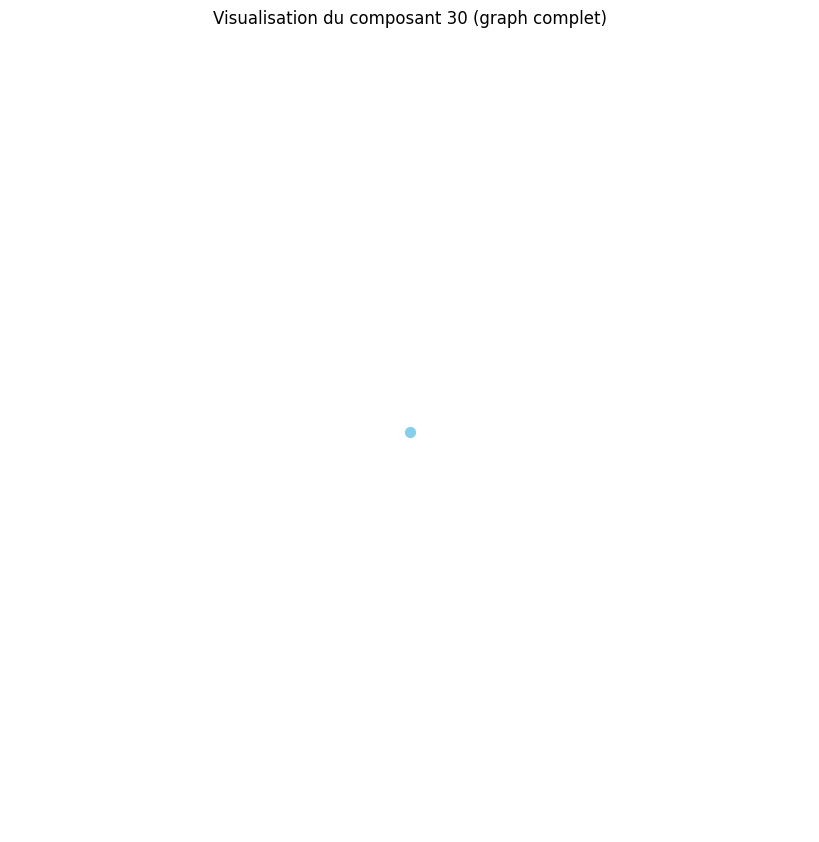

Distance moyenne pour le composant 31 : 0.00
Le composant 31 est un graphe complet ou très densément connecté.
Densité du composant 31 : 0.00
Degré moyen du composant 31 : 0.00
Coefficient de clustering moyen du composant 31 : 0.00


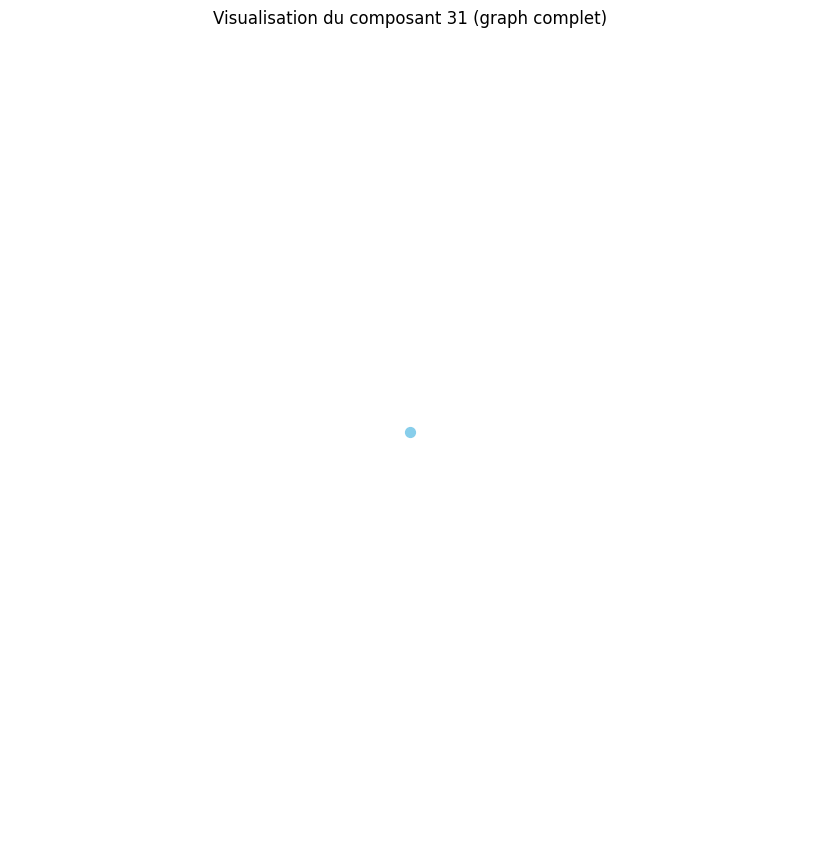

Distance moyenne pour le composant 32 : 0.00
Le composant 32 est un graphe complet ou très densément connecté.
Densité du composant 32 : 0.00
Degré moyen du composant 32 : 0.00
Coefficient de clustering moyen du composant 32 : 0.00


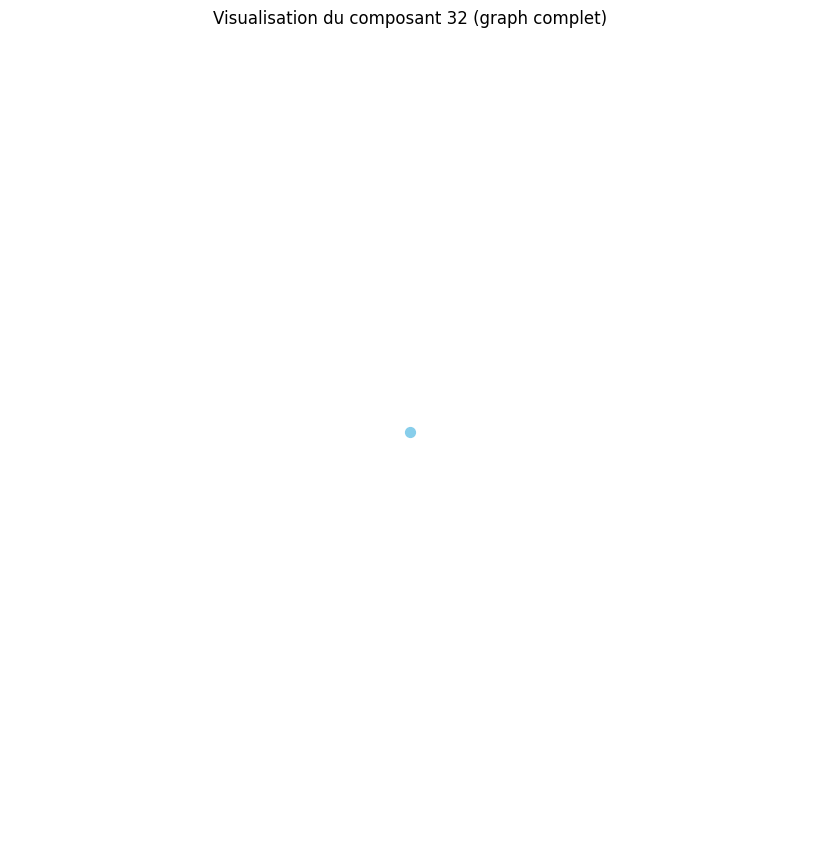

Distance moyenne pour le composant 33 : 0.00
Le composant 33 est un graphe complet ou très densément connecté.
Densité du composant 33 : 0.00
Degré moyen du composant 33 : 0.00
Coefficient de clustering moyen du composant 33 : 0.00


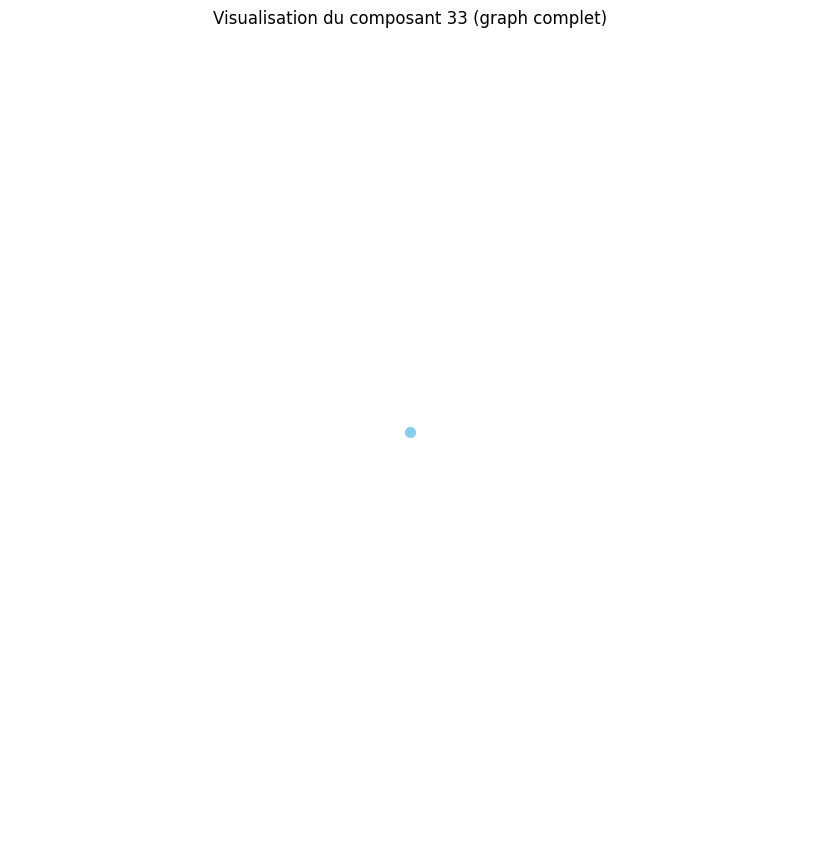

Distance moyenne pour le composant 34 : 0.00
Le composant 34 est un graphe complet ou très densément connecté.
Densité du composant 34 : 0.00
Degré moyen du composant 34 : 0.00
Coefficient de clustering moyen du composant 34 : 0.00


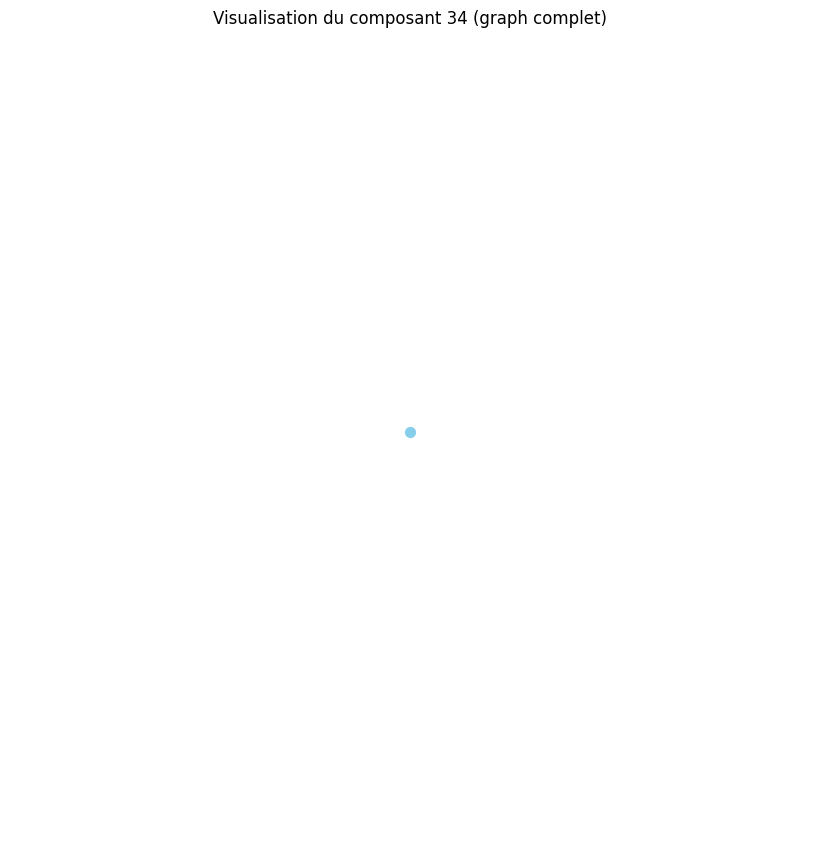

Distance moyenne pour le composant 35 : 0.00
Le composant 35 est un graphe complet ou très densément connecté.
Densité du composant 35 : 0.00
Degré moyen du composant 35 : 0.00
Coefficient de clustering moyen du composant 35 : 0.00


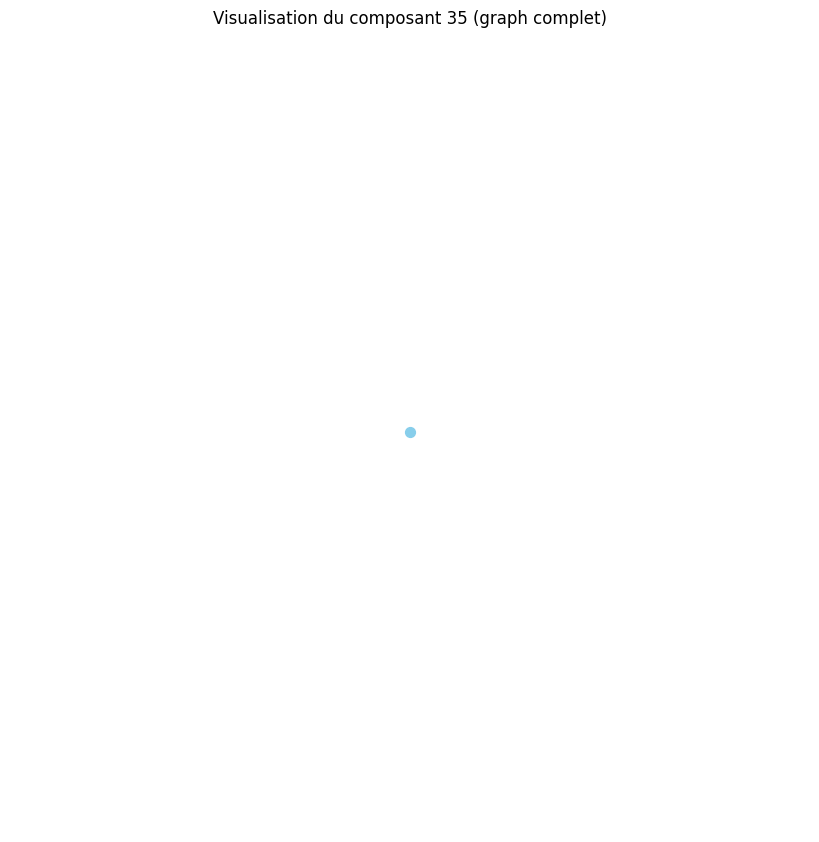

Distance moyenne pour le composant 36 : 0.00
Le composant 36 est un graphe complet ou très densément connecté.
Densité du composant 36 : 0.00
Degré moyen du composant 36 : 0.00
Coefficient de clustering moyen du composant 36 : 0.00


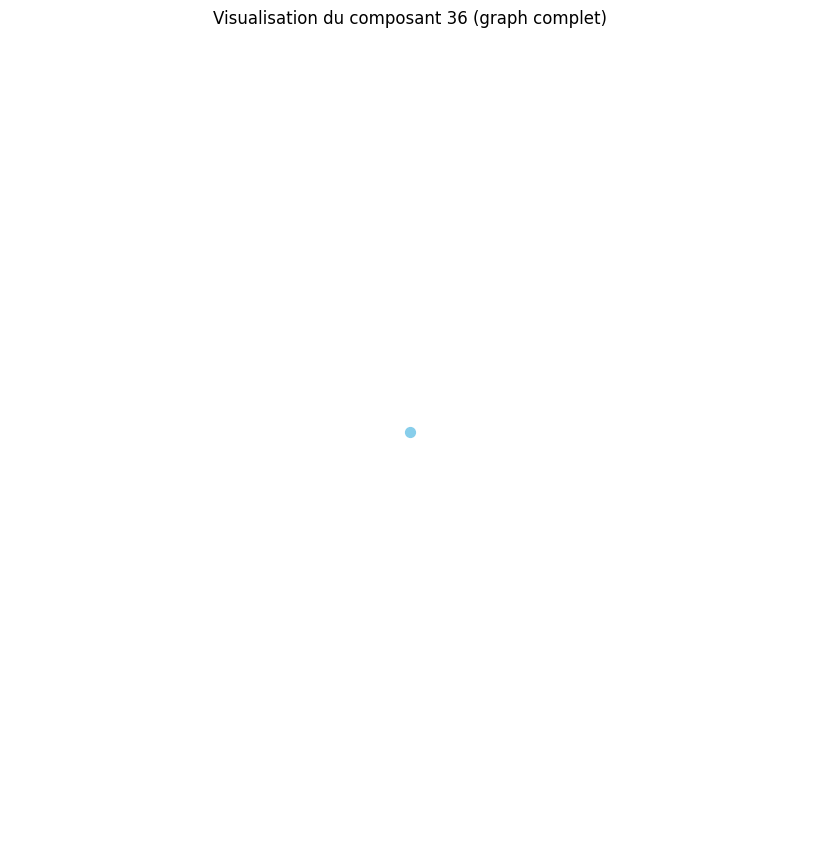

Distance moyenne pour le composant 37 : 0.00
Le composant 37 est un graphe complet ou très densément connecté.
Densité du composant 37 : 0.00
Degré moyen du composant 37 : 0.00
Coefficient de clustering moyen du composant 37 : 0.00


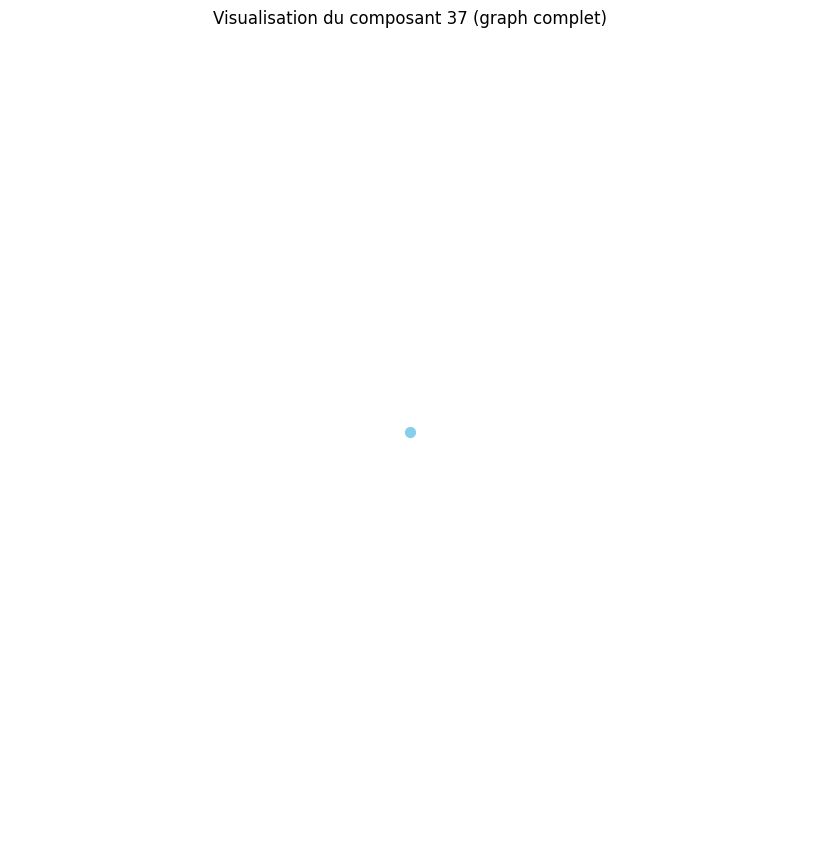

Distance moyenne pour le composant 38 : 0.00
Le composant 38 est un graphe complet ou très densément connecté.
Densité du composant 38 : 0.00
Degré moyen du composant 38 : 0.00
Coefficient de clustering moyen du composant 38 : 0.00


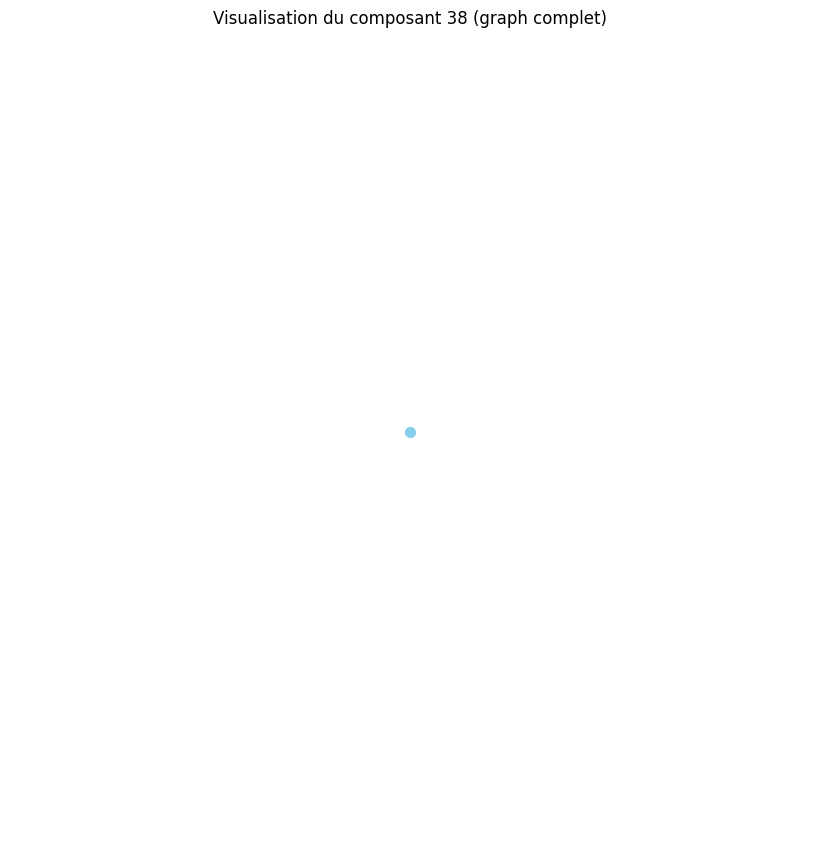

Distance moyenne pour le composant 39 : 0.00
Le composant 39 est un graphe complet ou très densément connecté.
Densité du composant 39 : 0.00
Degré moyen du composant 39 : 0.00
Coefficient de clustering moyen du composant 39 : 0.00


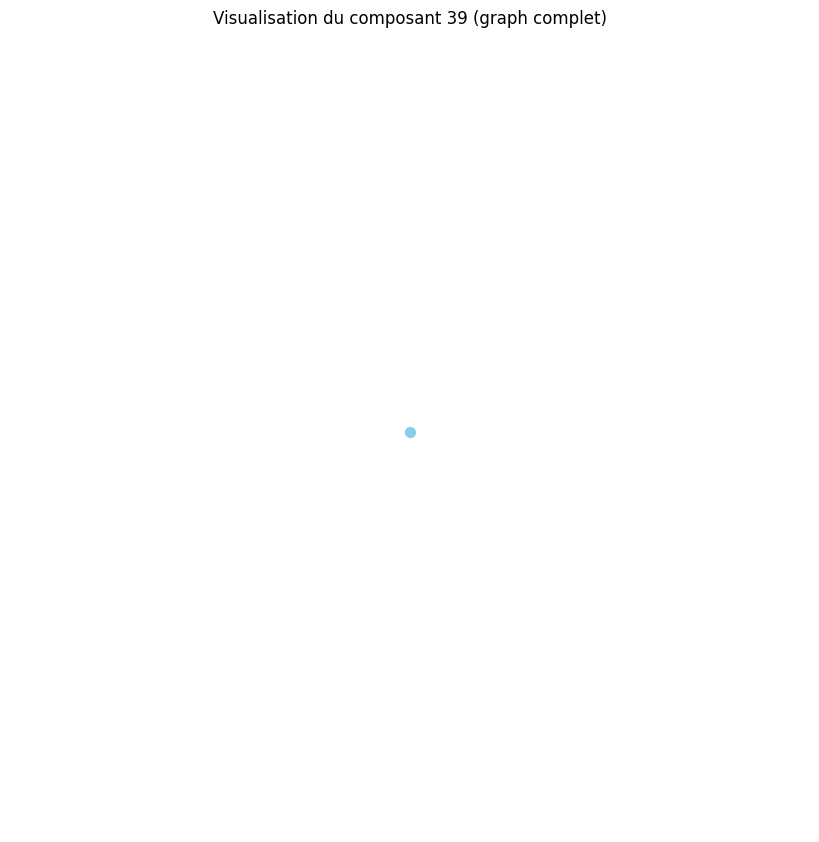

Distance moyenne pour le composant 40 : 0.00
Le composant 40 est un graphe complet ou très densément connecté.
Densité du composant 40 : 0.00
Degré moyen du composant 40 : 0.00
Coefficient de clustering moyen du composant 40 : 0.00


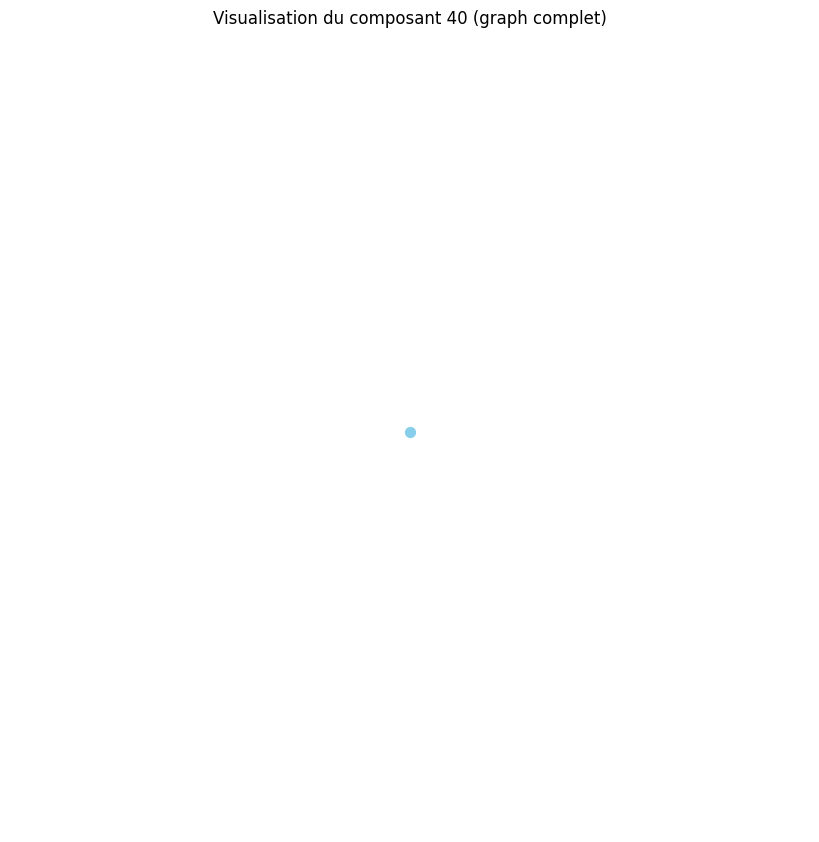

Distance moyenne pour le composant 41 : 0.00
Le composant 41 est un graphe complet ou très densément connecté.
Densité du composant 41 : 0.00
Degré moyen du composant 41 : 0.00
Coefficient de clustering moyen du composant 41 : 0.00


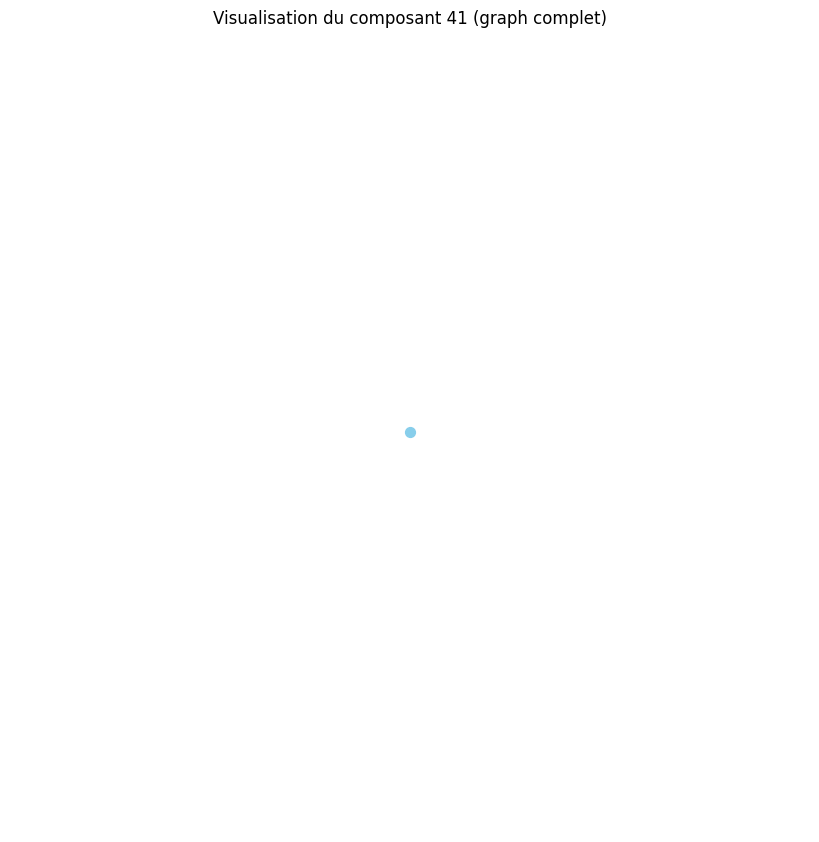

Distance moyenne pour le composant 42 : 0.00
Le composant 42 est un graphe complet ou très densément connecté.
Densité du composant 42 : 0.00
Degré moyen du composant 42 : 0.00
Coefficient de clustering moyen du composant 42 : 0.00


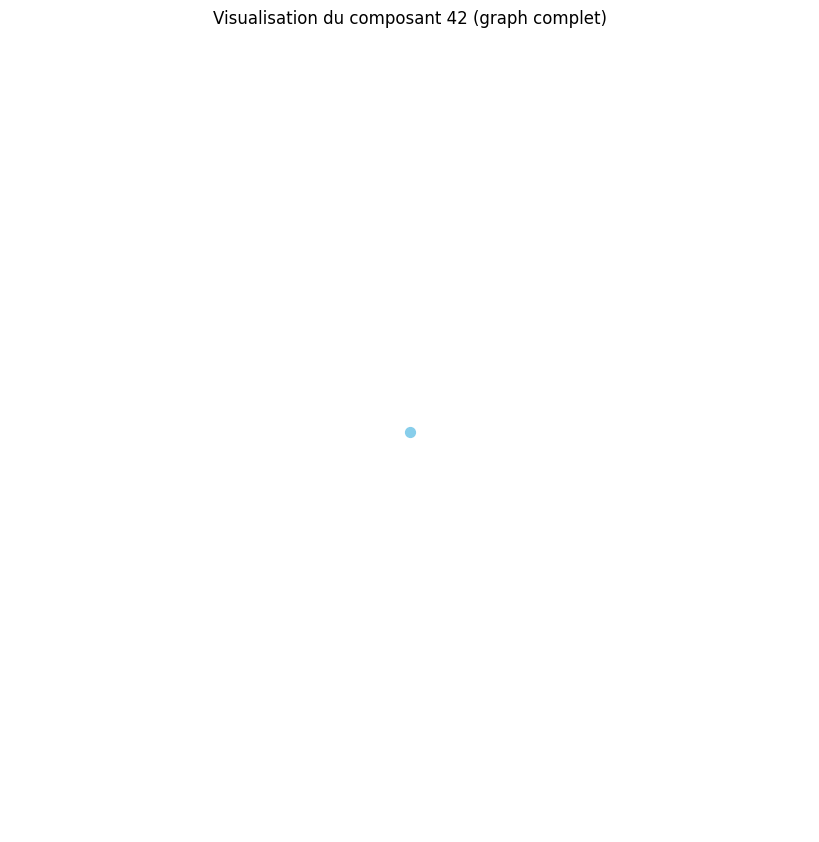

Distance moyenne pour le composant 43 : 0.00
Le composant 43 est un graphe complet ou très densément connecté.
Densité du composant 43 : 0.00
Degré moyen du composant 43 : 0.00
Coefficient de clustering moyen du composant 43 : 0.00


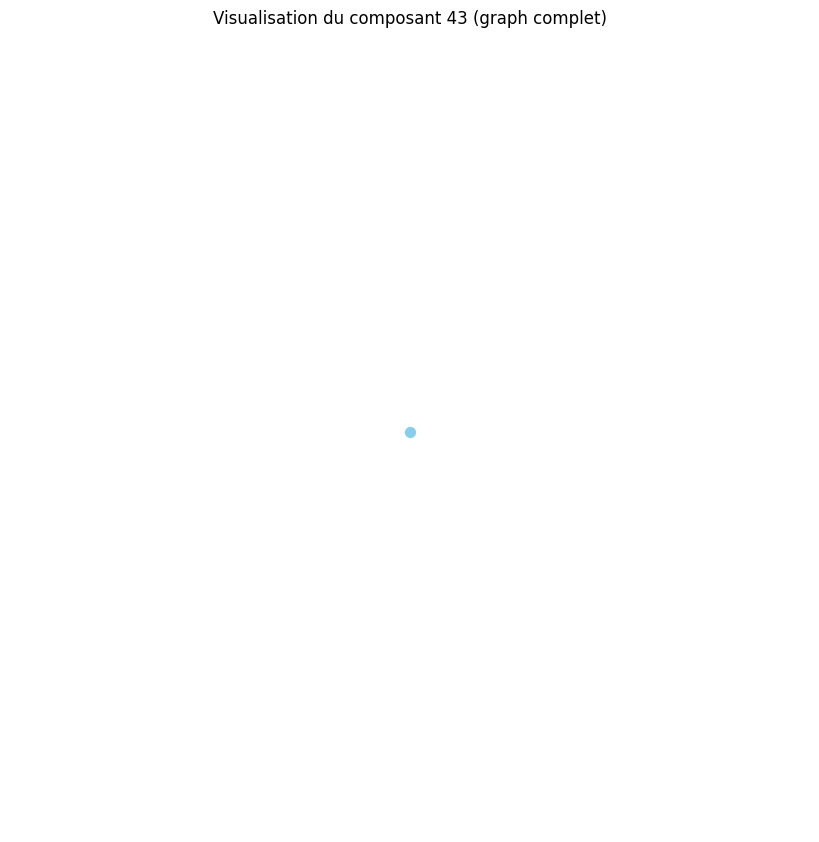

Distance moyenne pour le composant 44 : 0.00
Le composant 44 est un graphe complet ou très densément connecté.
Densité du composant 44 : 0.00
Degré moyen du composant 44 : 0.00
Coefficient de clustering moyen du composant 44 : 0.00


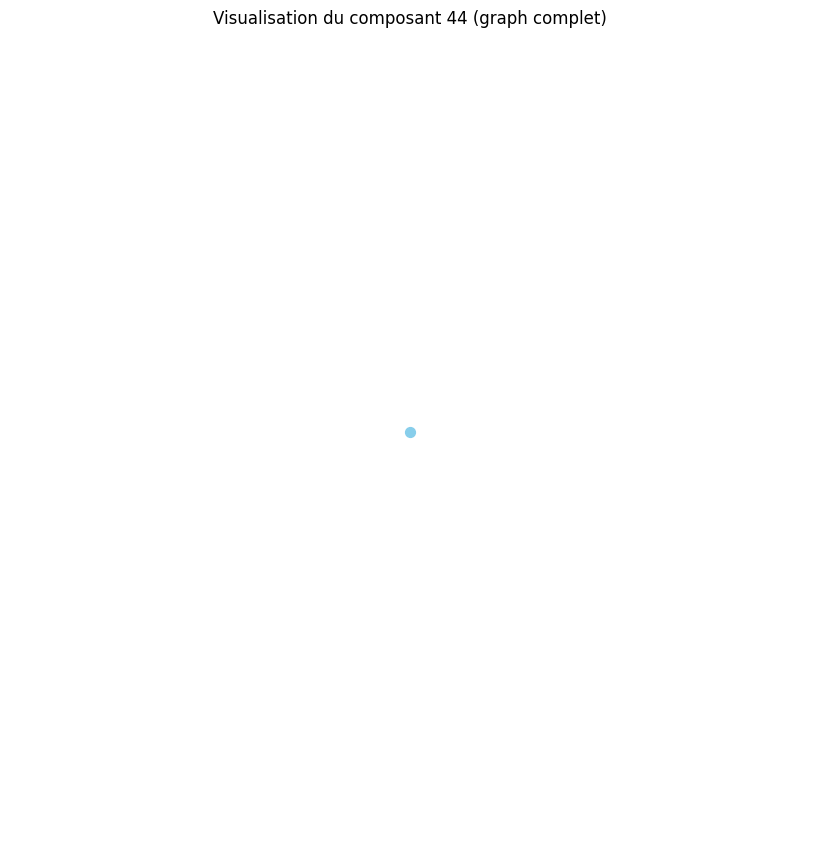

Distance moyenne pour le composant 45 : 0.00
Le composant 45 est un graphe complet ou très densément connecté.
Densité du composant 45 : 0.00
Degré moyen du composant 45 : 0.00
Coefficient de clustering moyen du composant 45 : 0.00


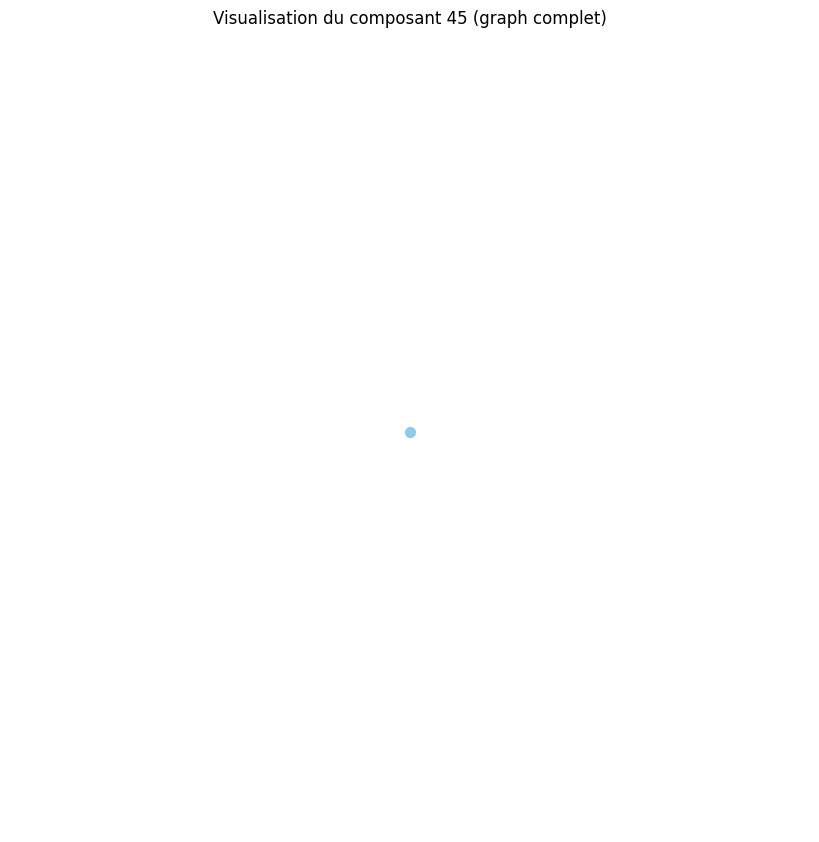

Distance moyenne pour le composant 46 : 0.00
Le composant 46 est un graphe complet ou très densément connecté.
Densité du composant 46 : 0.00
Degré moyen du composant 46 : 0.00
Coefficient de clustering moyen du composant 46 : 0.00


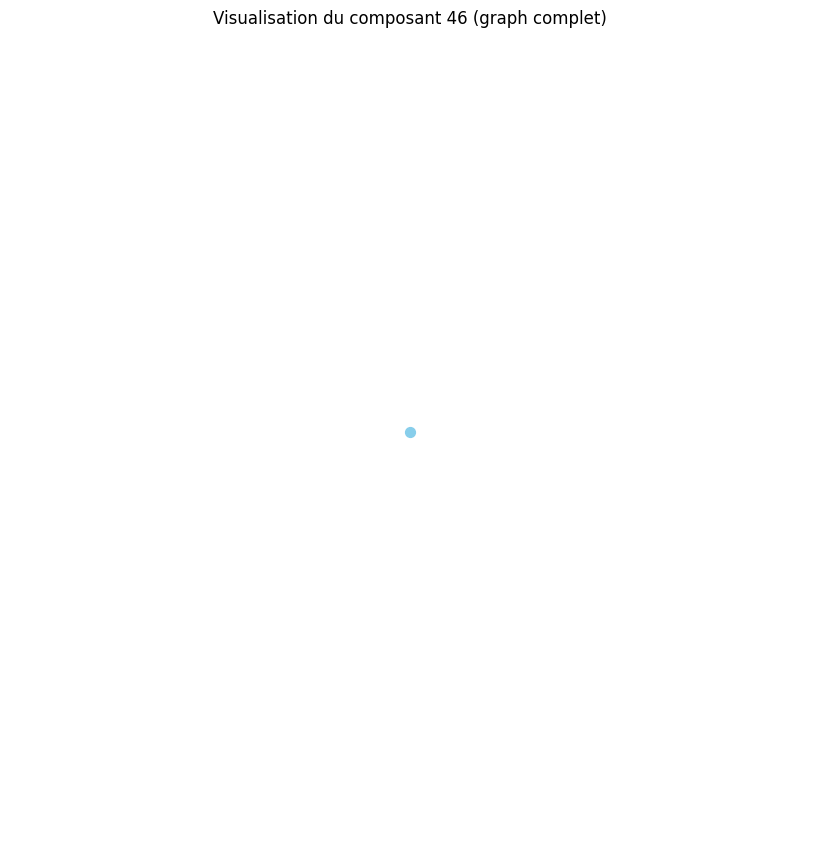

Distance moyenne pour le composant 47 : 0.00
Le composant 47 est un graphe complet ou très densément connecté.
Densité du composant 47 : 0.00
Degré moyen du composant 47 : 0.00
Coefficient de clustering moyen du composant 47 : 0.00


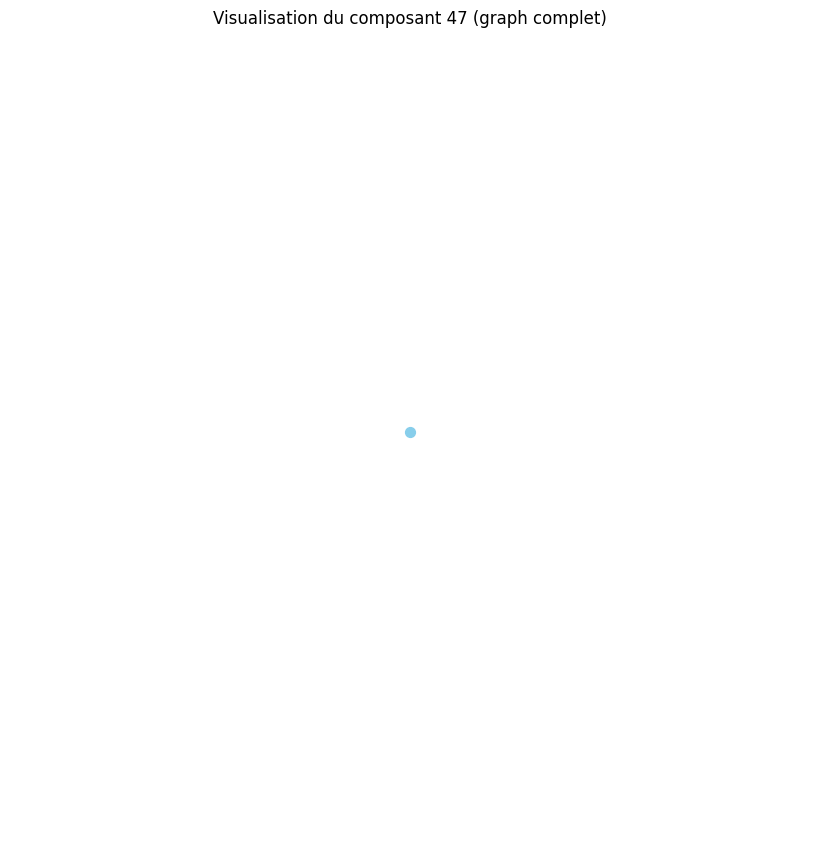

Distance moyenne pour le composant 48 : 0.00
Le composant 48 est un graphe complet ou très densément connecté.
Densité du composant 48 : 0.00
Degré moyen du composant 48 : 0.00
Coefficient de clustering moyen du composant 48 : 0.00


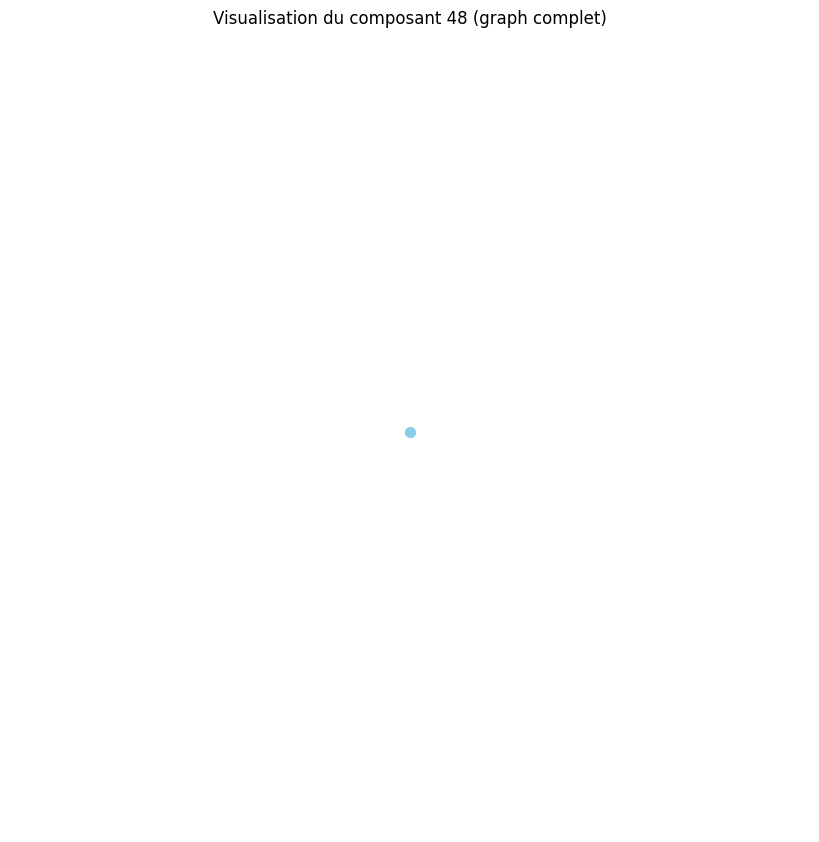

Distance moyenne pour le composant 49 : 0.00
Le composant 49 est un graphe complet ou très densément connecté.
Densité du composant 49 : 0.00
Degré moyen du composant 49 : 0.00
Coefficient de clustering moyen du composant 49 : 0.00


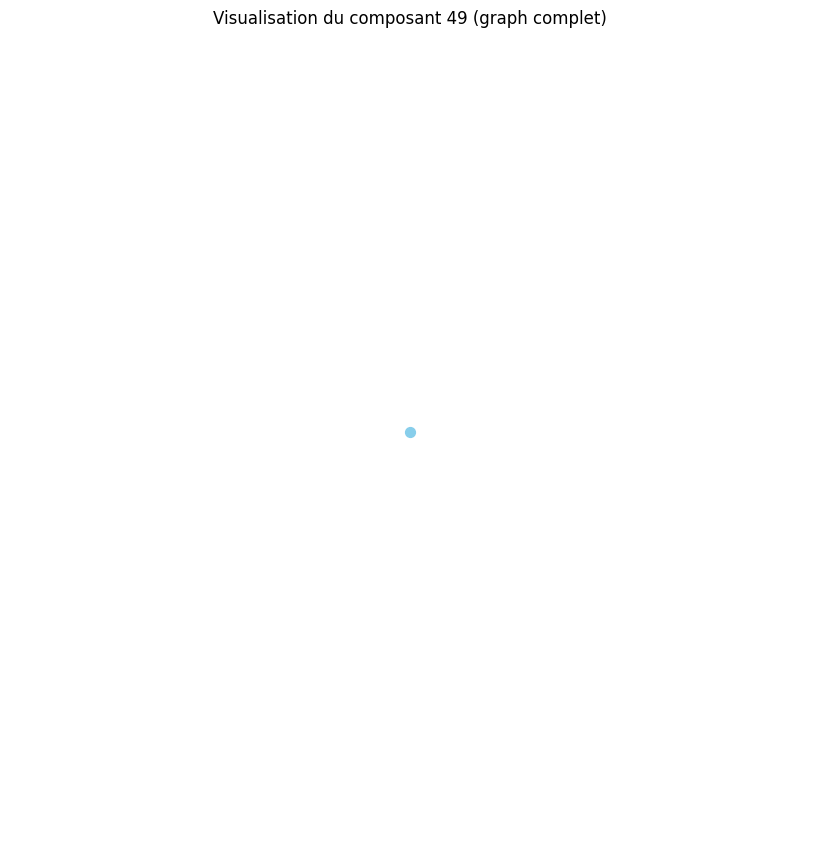

Distance moyenne pour le composant 50 : 0.00
Le composant 50 est un graphe complet ou très densément connecté.
Densité du composant 50 : 0.00
Degré moyen du composant 50 : 0.00
Coefficient de clustering moyen du composant 50 : 0.00


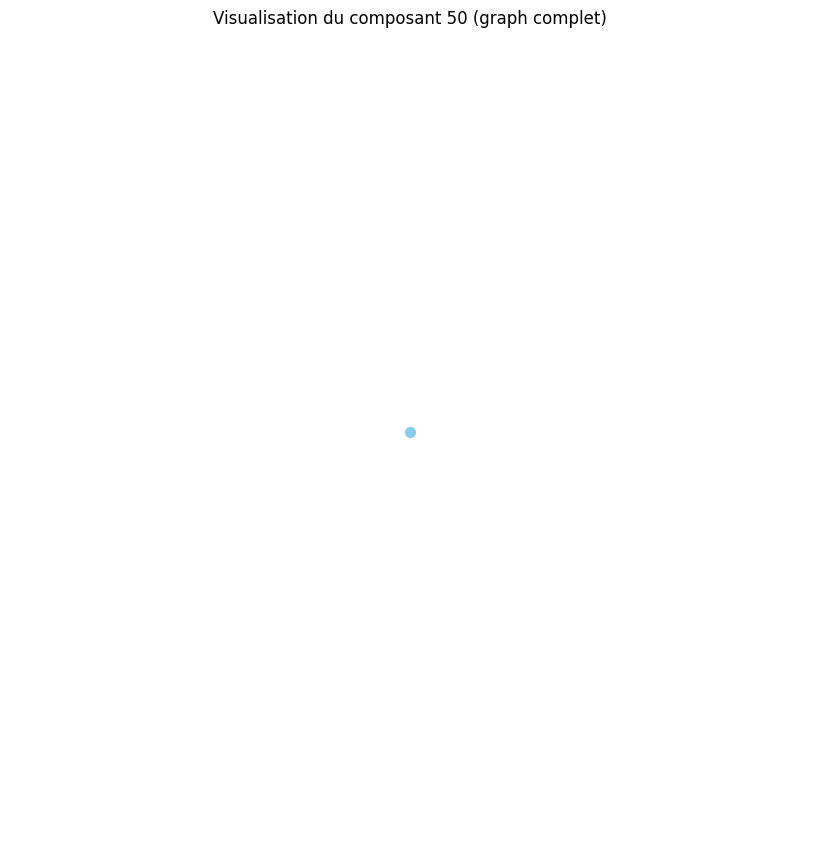

Distance moyenne pour le composant 51 : 0.00
Le composant 51 est un graphe complet ou très densément connecté.
Densité du composant 51 : 0.00
Degré moyen du composant 51 : 0.00
Coefficient de clustering moyen du composant 51 : 0.00


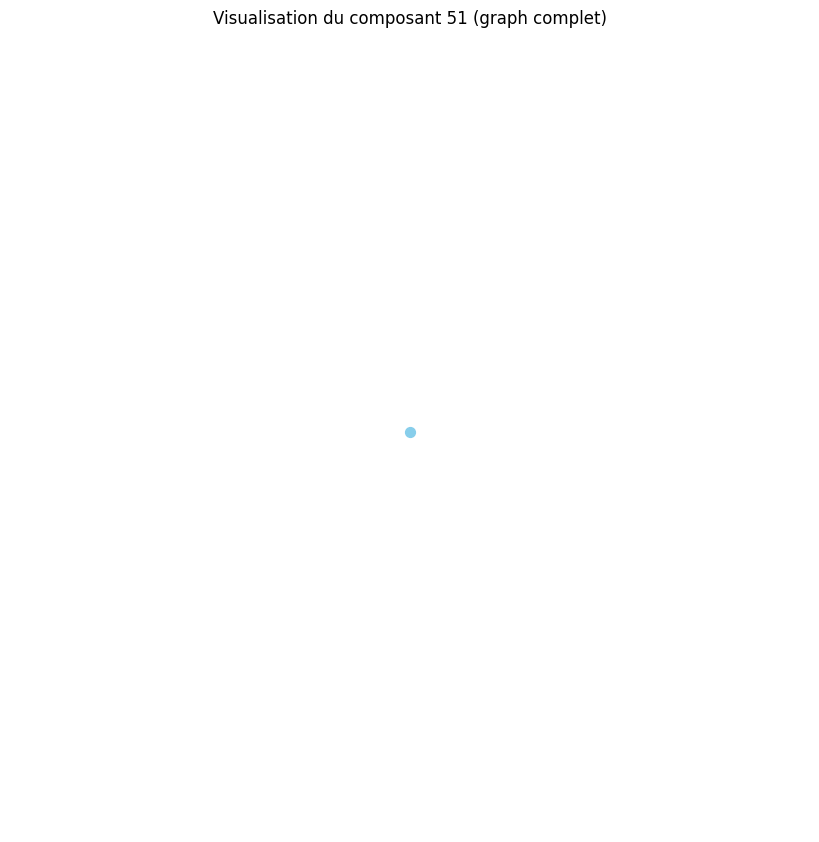

Distance moyenne pour le composant 52 : 0.00
Le composant 52 est un graphe complet ou très densément connecté.
Densité du composant 52 : 0.00
Degré moyen du composant 52 : 0.00
Coefficient de clustering moyen du composant 52 : 0.00


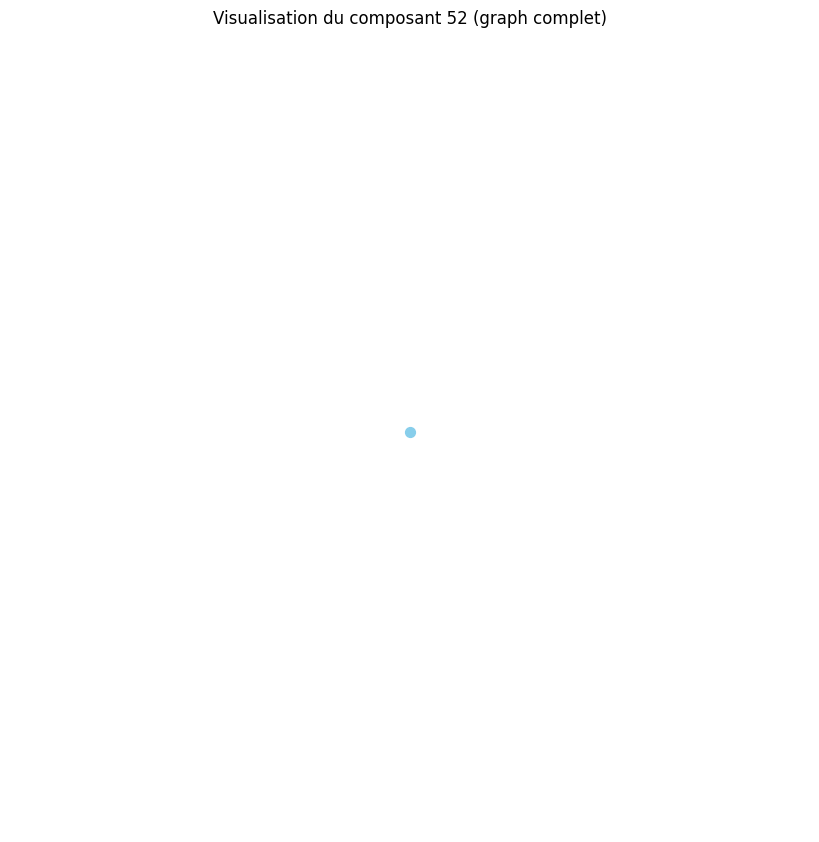

Distance moyenne pour le composant 53 : 0.00
Le composant 53 est un graphe complet ou très densément connecté.
Densité du composant 53 : 0.00
Degré moyen du composant 53 : 0.00
Coefficient de clustering moyen du composant 53 : 0.00


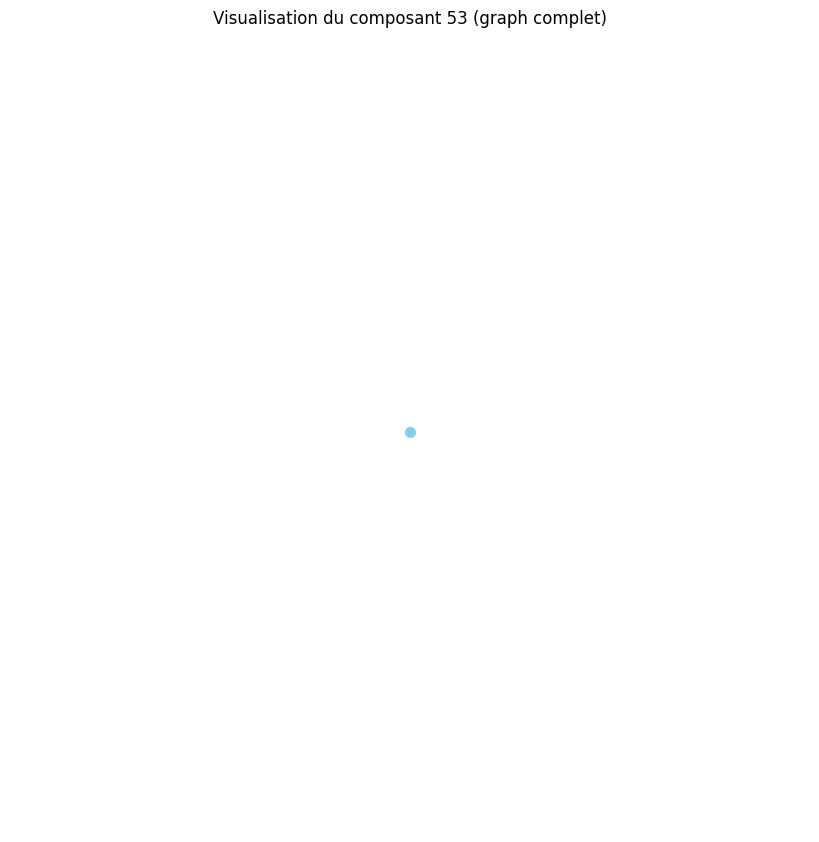

Distance moyenne pour le composant 54 : 0.00
Le composant 54 est un graphe complet ou très densément connecté.
Densité du composant 54 : 0.00
Degré moyen du composant 54 : 0.00
Coefficient de clustering moyen du composant 54 : 0.00


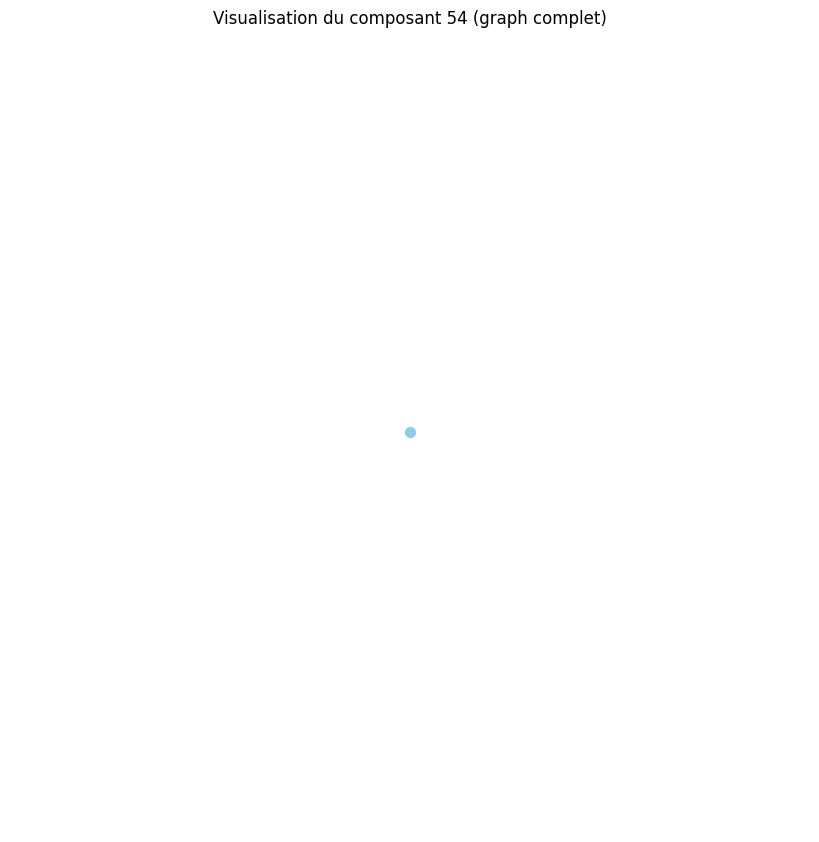

Distance moyenne pour le composant 55 : 0.00
Le composant 55 est un graphe complet ou très densément connecté.
Densité du composant 55 : 0.00
Degré moyen du composant 55 : 0.00
Coefficient de clustering moyen du composant 55 : 0.00


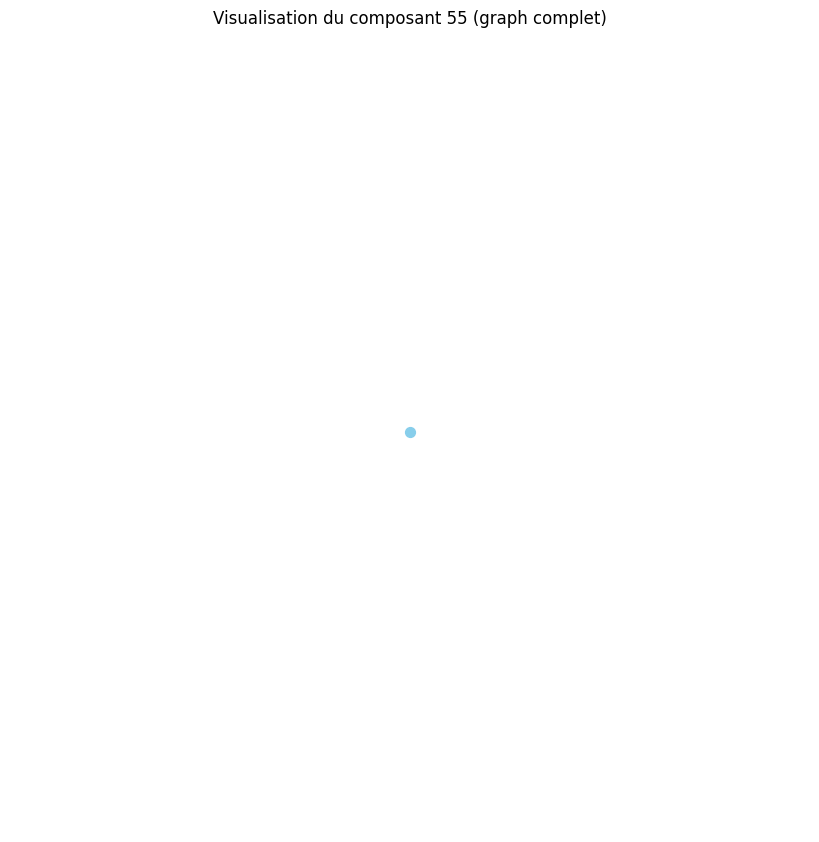

Distance moyenne pour le composant 56 : 0.00
Le composant 56 est un graphe complet ou très densément connecté.
Densité du composant 56 : 0.00
Degré moyen du composant 56 : 0.00
Coefficient de clustering moyen du composant 56 : 0.00


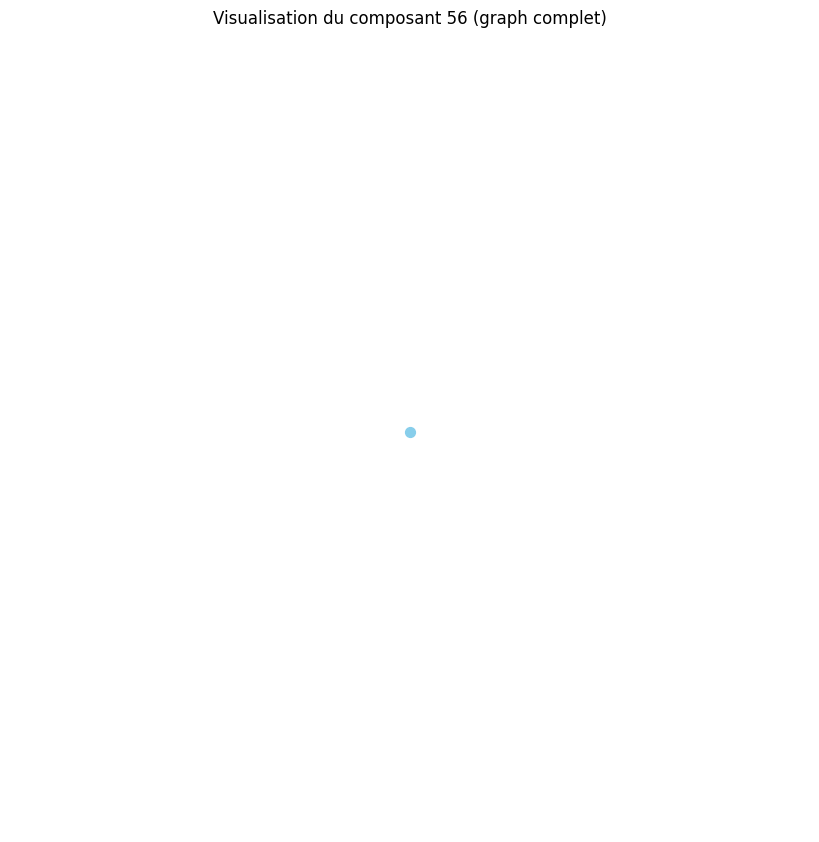

Distance moyenne pour le composant 57 : 0.00
Le composant 57 est un graphe complet ou très densément connecté.
Densité du composant 57 : 0.00
Degré moyen du composant 57 : 0.00
Coefficient de clustering moyen du composant 57 : 0.00


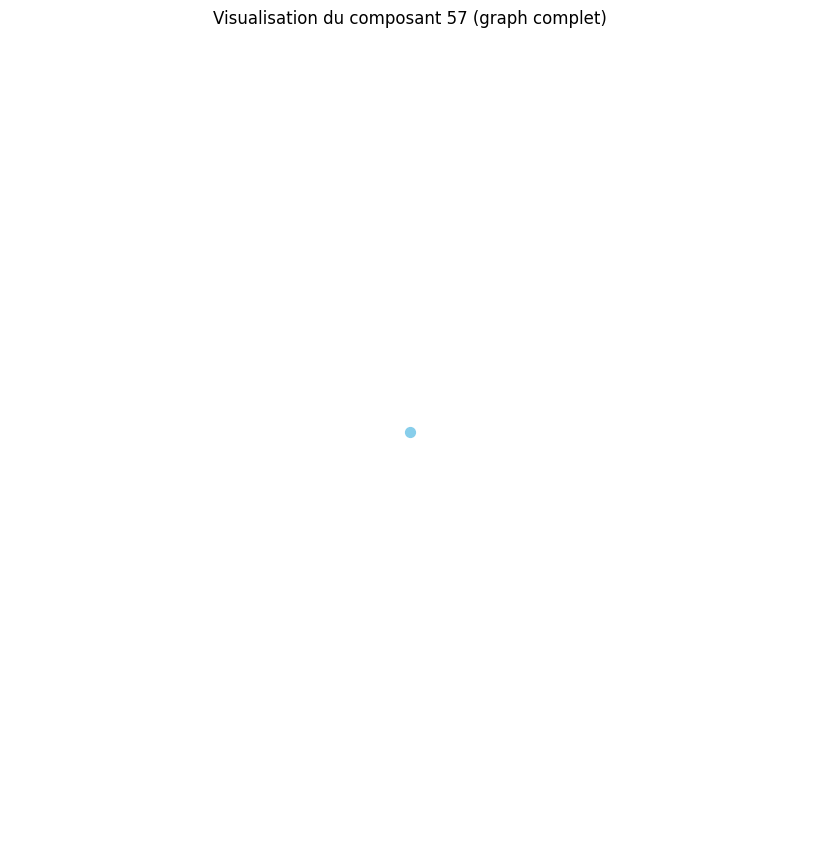

Distance moyenne pour le composant 58 : 0.00
Le composant 58 est un graphe complet ou très densément connecté.
Densité du composant 58 : 0.00
Degré moyen du composant 58 : 0.00
Coefficient de clustering moyen du composant 58 : 0.00


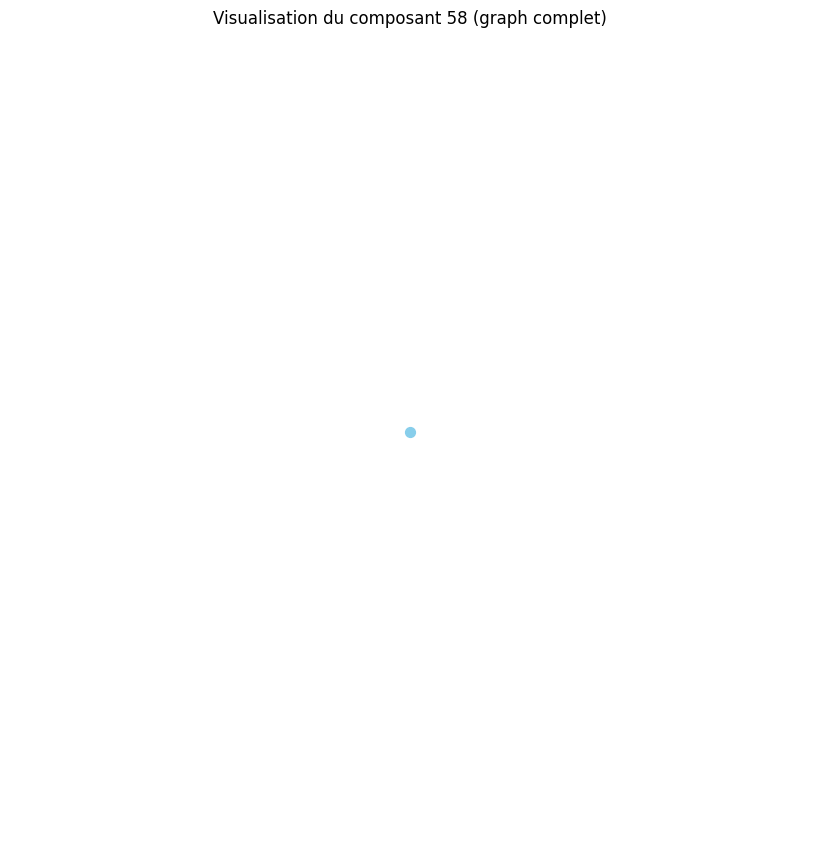

Distance moyenne pour le composant 59 : 0.00
Le composant 59 est un graphe complet ou très densément connecté.
Densité du composant 59 : 0.00
Degré moyen du composant 59 : 0.00
Coefficient de clustering moyen du composant 59 : 0.00


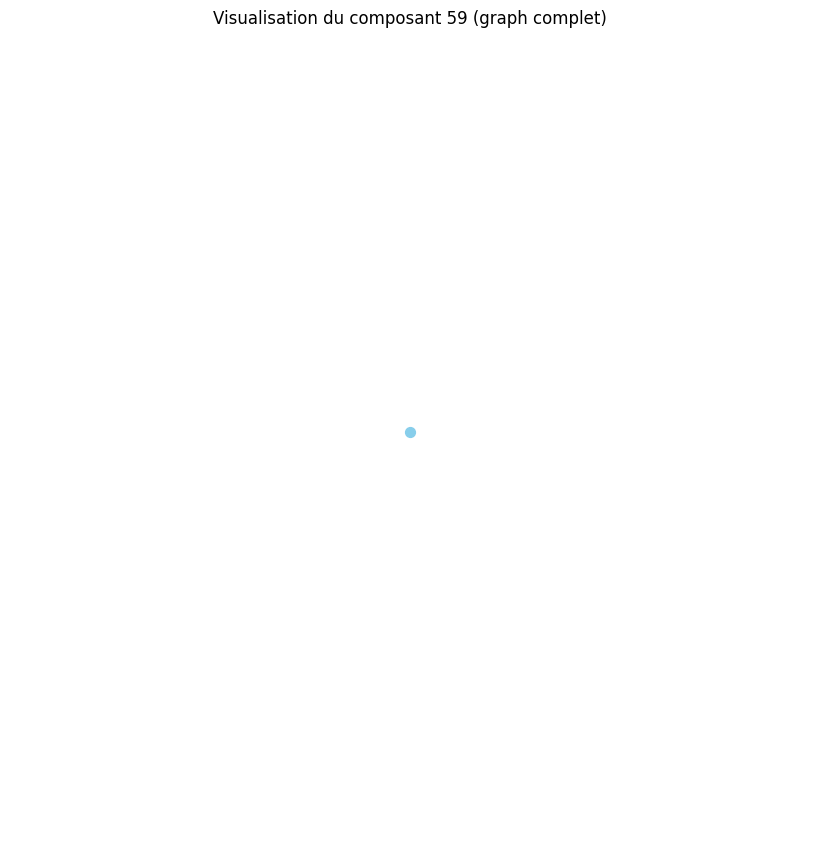

Distance moyenne pour le composant 60 : 0.00
Le composant 60 est un graphe complet ou très densément connecté.
Densité du composant 60 : 0.00
Degré moyen du composant 60 : 0.00
Coefficient de clustering moyen du composant 60 : 0.00


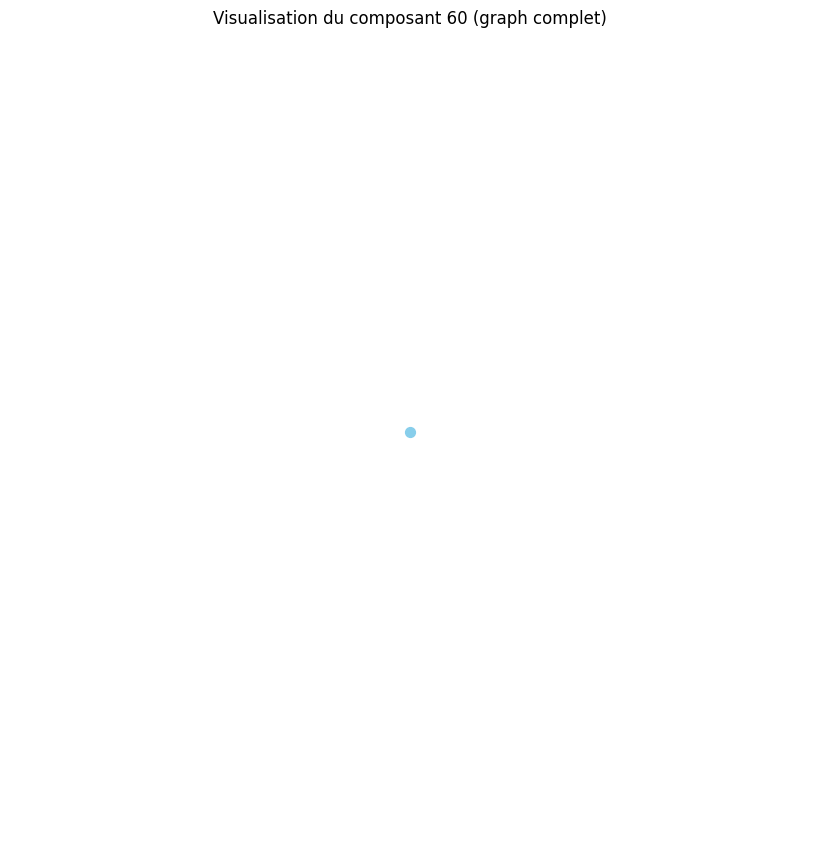

Distance moyenne pour le composant 61 : 0.00
Le composant 61 est un graphe complet ou très densément connecté.
Densité du composant 61 : 0.00
Degré moyen du composant 61 : 0.00
Coefficient de clustering moyen du composant 61 : 0.00


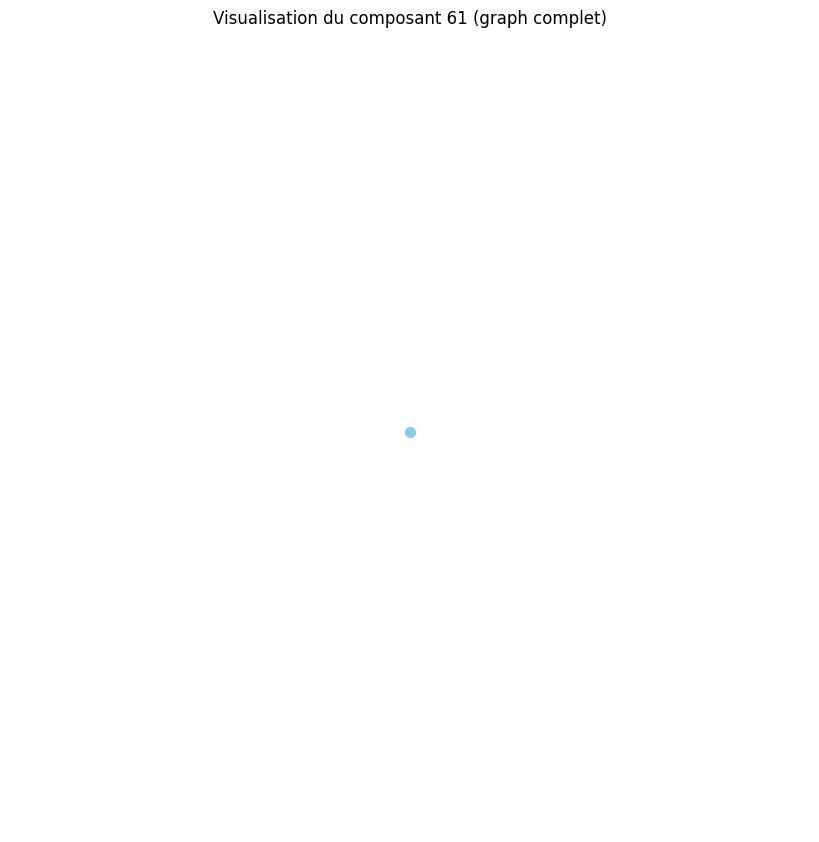

Distance moyenne pour le composant 62 : 0.00
Le composant 62 est un graphe complet ou très densément connecté.
Densité du composant 62 : 0.00
Degré moyen du composant 62 : 0.00
Coefficient de clustering moyen du composant 62 : 0.00


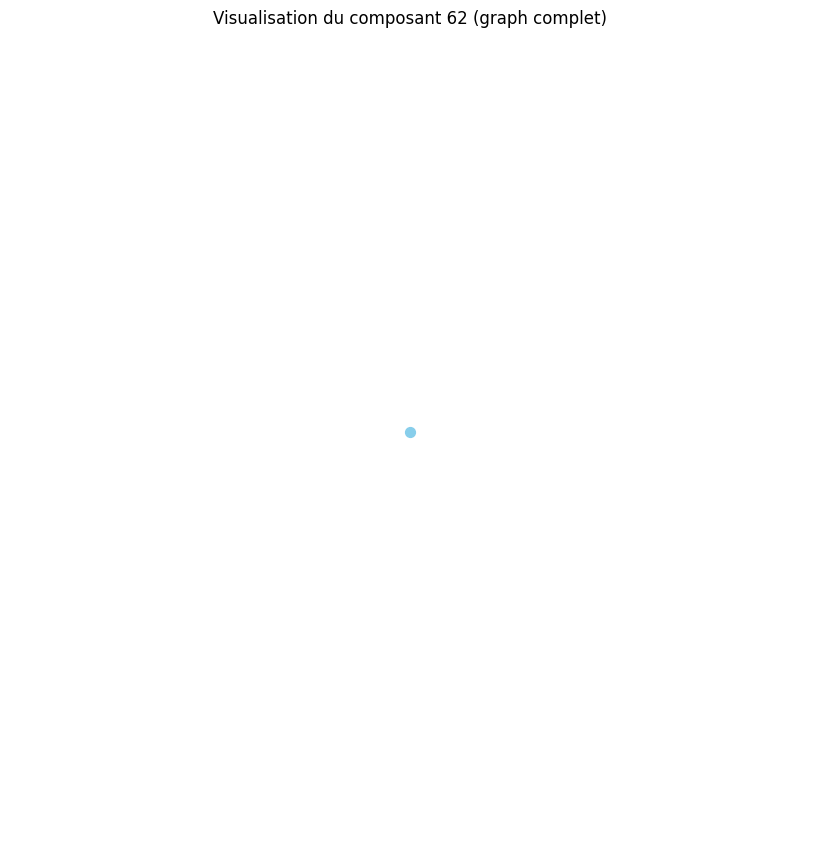

Distance moyenne pour le composant 63 : 0.00
Le composant 63 est un graphe complet ou très densément connecté.
Densité du composant 63 : 0.00
Degré moyen du composant 63 : 0.00
Coefficient de clustering moyen du composant 63 : 0.00


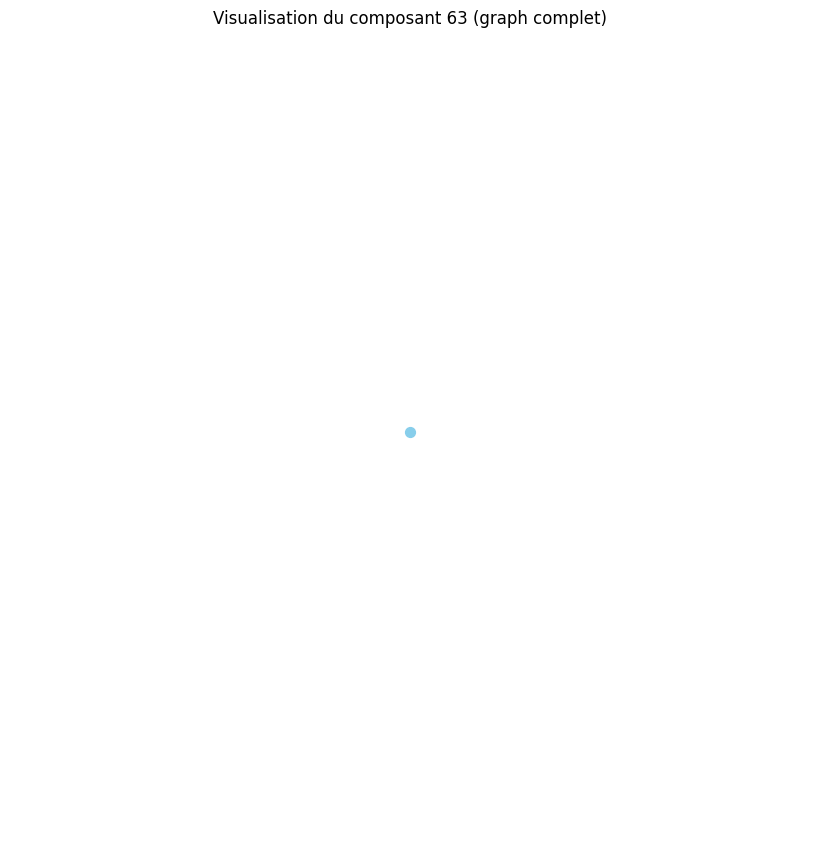

Distance moyenne pour le composant 64 : 0.00
Le composant 64 est un graphe complet ou très densément connecté.
Densité du composant 64 : 0.00
Degré moyen du composant 64 : 0.00
Coefficient de clustering moyen du composant 64 : 0.00


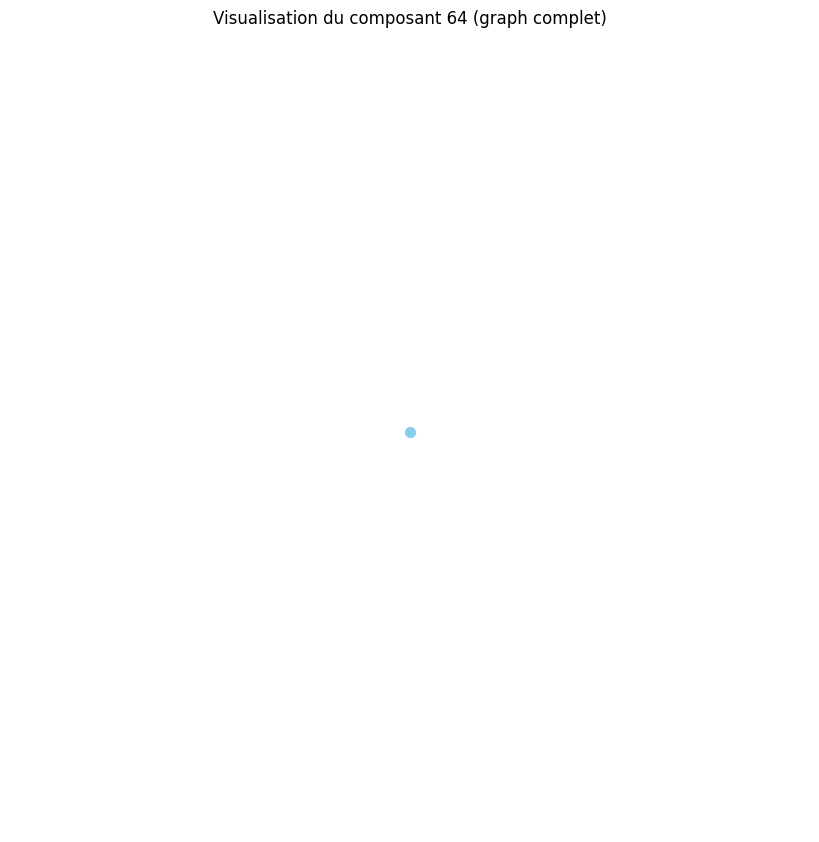

Distance moyenne pour le composant 65 : 0.00
Le composant 65 est un graphe complet ou très densément connecté.
Densité du composant 65 : 0.00
Degré moyen du composant 65 : 0.00
Coefficient de clustering moyen du composant 65 : 0.00


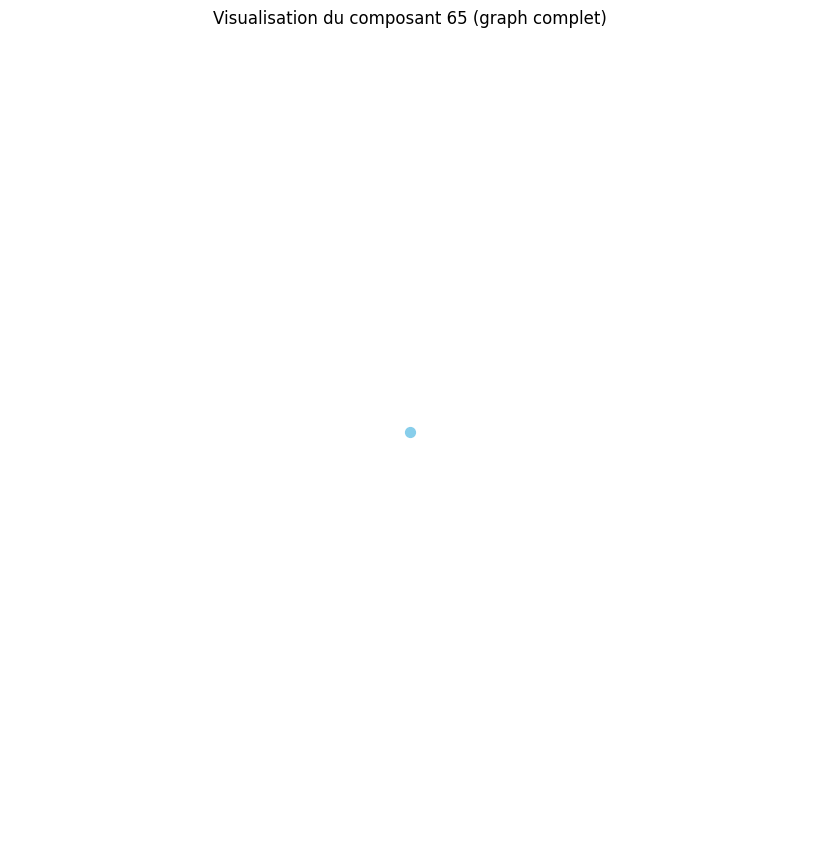

Distance moyenne pour le composant 66 : 0.00
Le composant 66 est un graphe complet ou très densément connecté.
Densité du composant 66 : 0.00
Degré moyen du composant 66 : 0.00
Coefficient de clustering moyen du composant 66 : 0.00


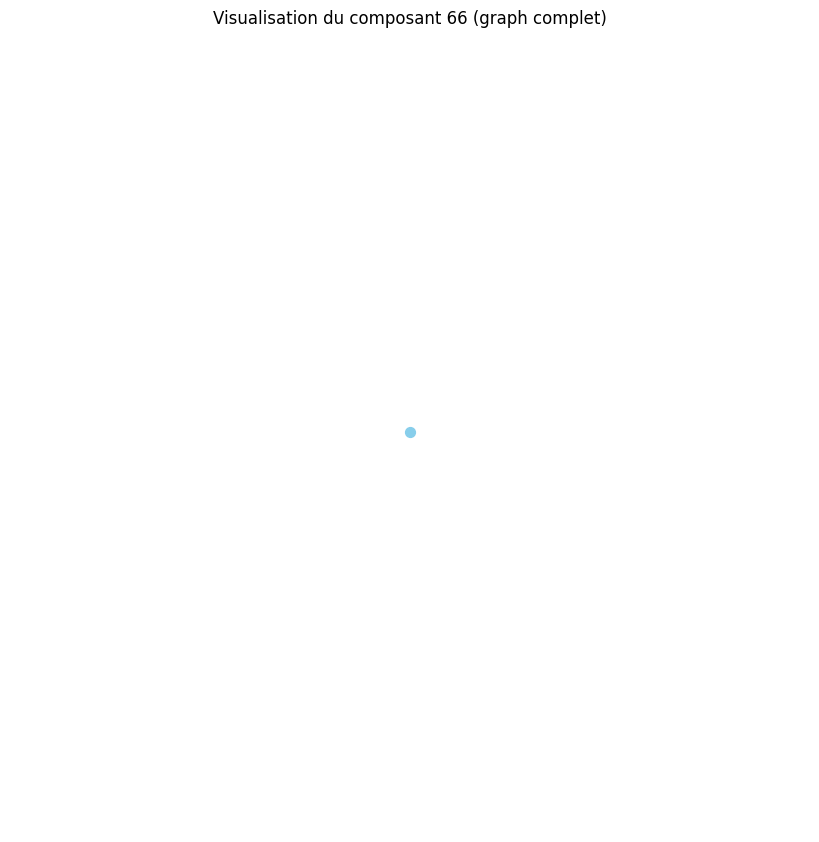

Distance moyenne pour le composant 67 : 0.00
Le composant 67 est un graphe complet ou très densément connecté.
Densité du composant 67 : 0.00
Degré moyen du composant 67 : 0.00
Coefficient de clustering moyen du composant 67 : 0.00


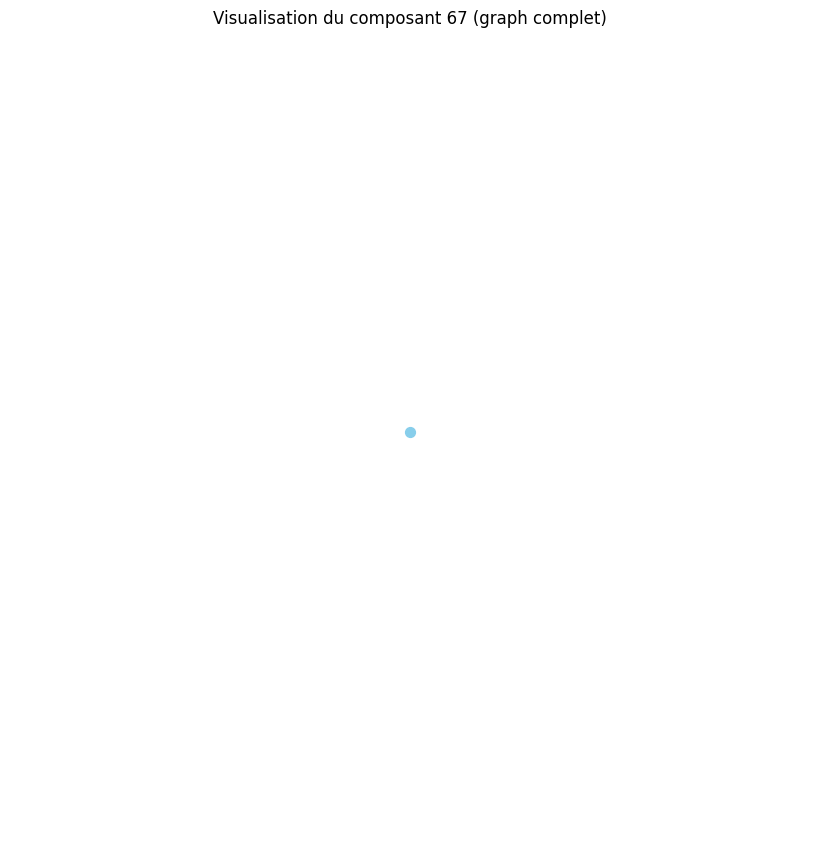

Distance moyenne pour le composant 68 : 0.00
Le composant 68 est un graphe complet ou très densément connecté.
Densité du composant 68 : 0.00
Degré moyen du composant 68 : 0.00
Coefficient de clustering moyen du composant 68 : 0.00


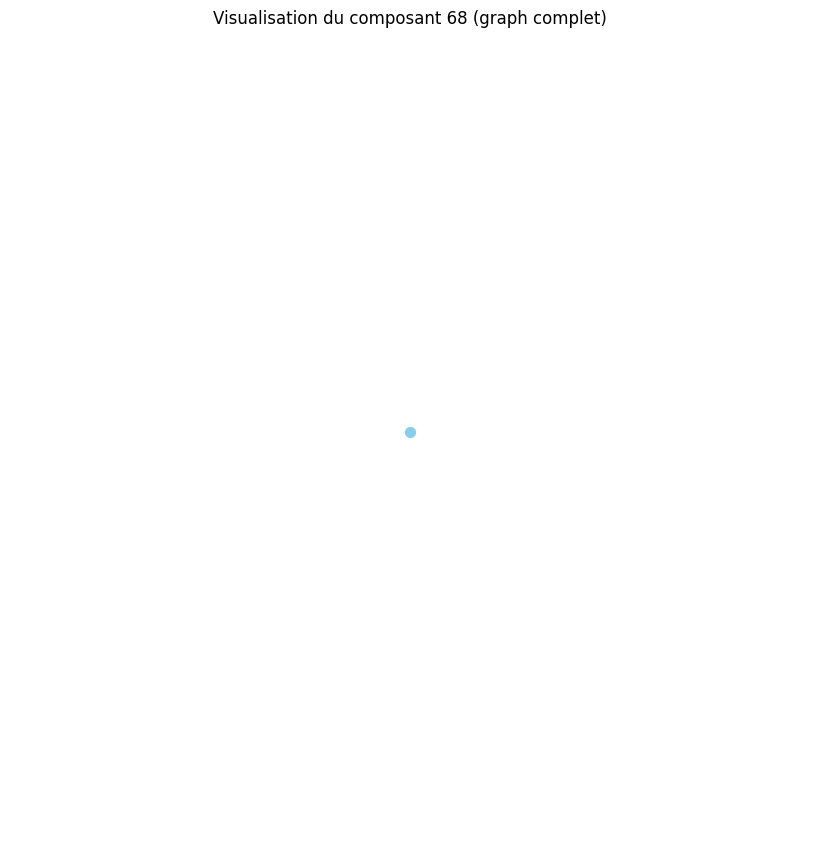

Distance moyenne pour le composant 69 : 0.00
Le composant 69 est un graphe complet ou très densément connecté.
Densité du composant 69 : 0.00
Degré moyen du composant 69 : 0.00
Coefficient de clustering moyen du composant 69 : 0.00


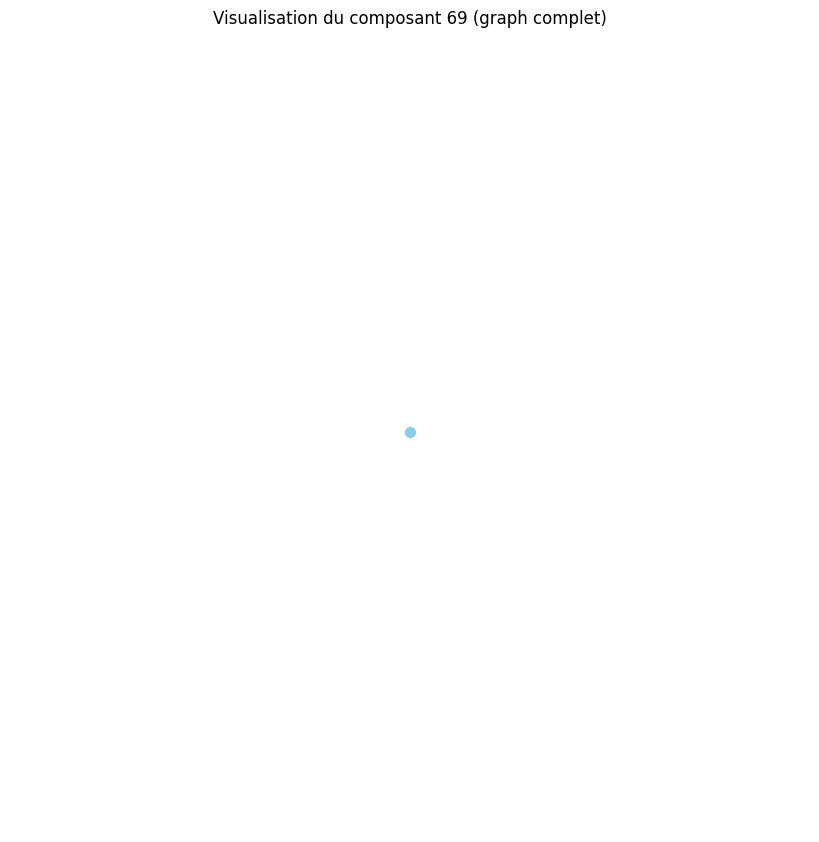

Distance moyenne pour le composant 70 : 0.00
Le composant 70 est un graphe complet ou très densément connecté.
Densité du composant 70 : 0.00
Degré moyen du composant 70 : 0.00
Coefficient de clustering moyen du composant 70 : 0.00


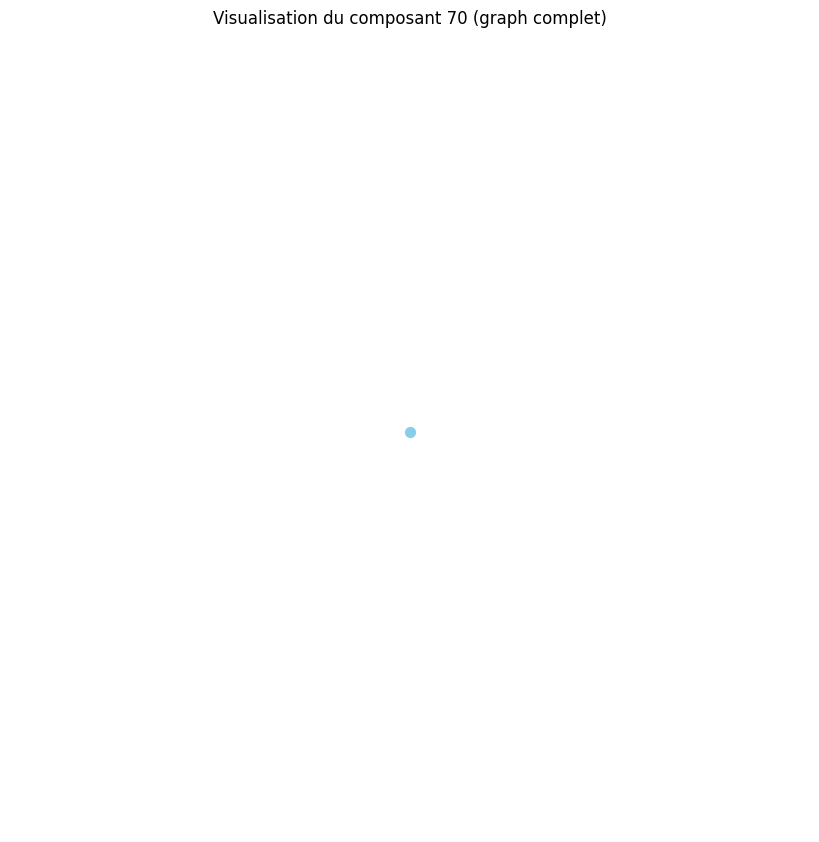

Distance moyenne pour le composant 71 : 0.00
Le composant 71 est un graphe complet ou très densément connecté.
Densité du composant 71 : 0.00
Degré moyen du composant 71 : 0.00
Coefficient de clustering moyen du composant 71 : 0.00


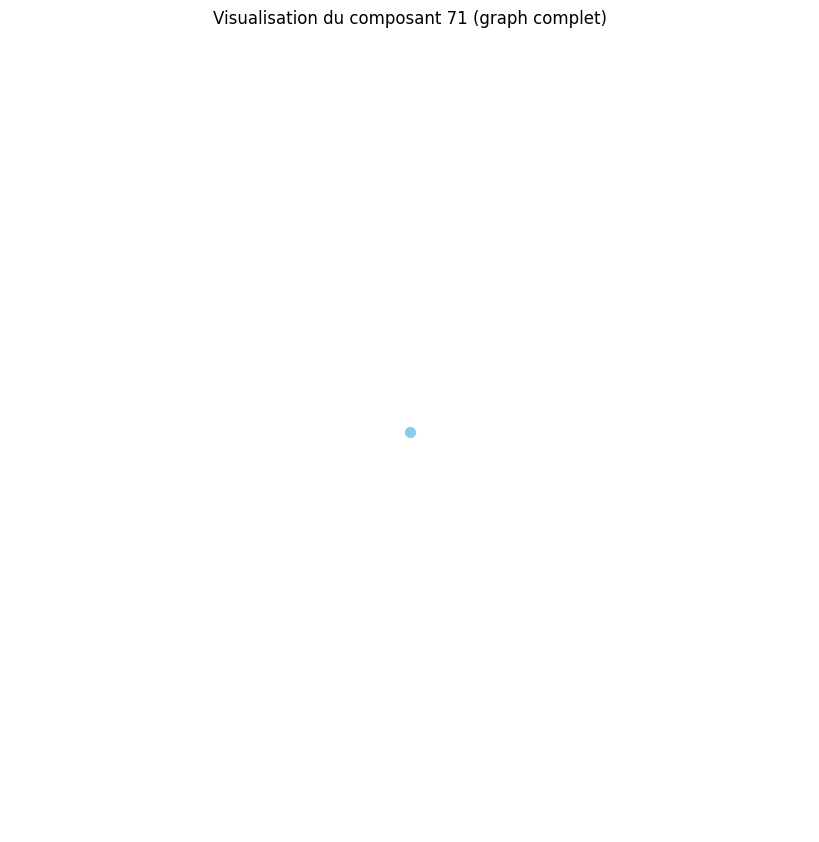

Distance moyenne pour le composant 72 : 0.00
Le composant 72 est un graphe complet ou très densément connecté.
Densité du composant 72 : 0.00
Degré moyen du composant 72 : 0.00
Coefficient de clustering moyen du composant 72 : 0.00


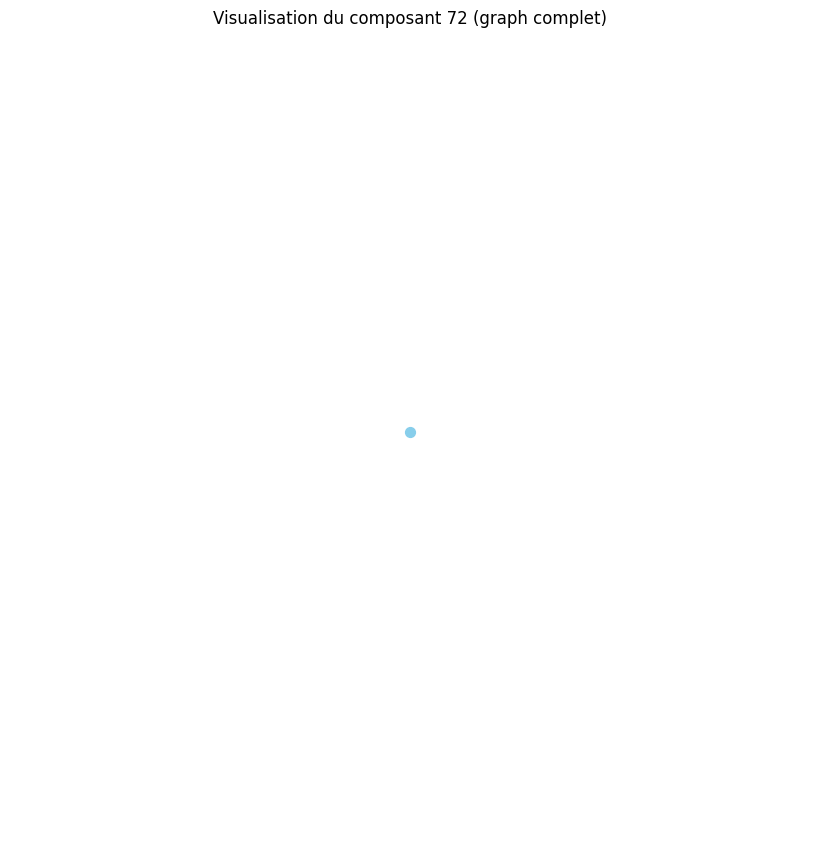

Distance moyenne pour le composant 73 : 0.00
Le composant 73 est un graphe complet ou très densément connecté.
Densité du composant 73 : 0.00
Degré moyen du composant 73 : 0.00
Coefficient de clustering moyen du composant 73 : 0.00


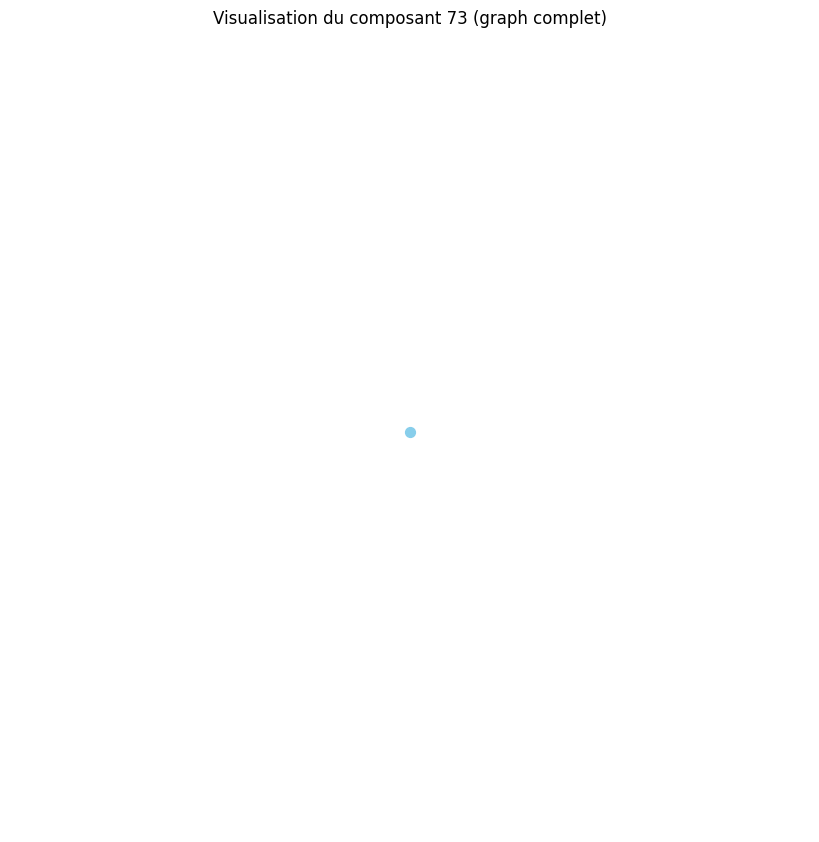

Distance moyenne pour le composant 74 : 0.00
Le composant 74 est un graphe complet ou très densément connecté.
Densité du composant 74 : 0.00
Degré moyen du composant 74 : 0.00
Coefficient de clustering moyen du composant 74 : 0.00


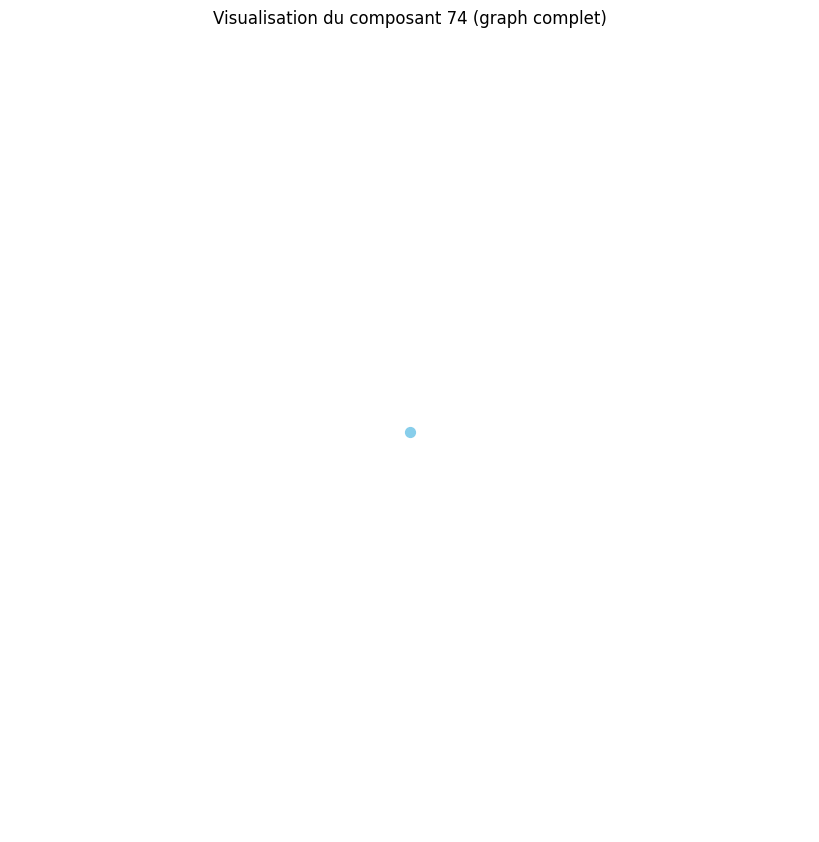

Distance moyenne pour le composant 75 : 0.00
Le composant 75 est un graphe complet ou très densément connecté.
Densité du composant 75 : 0.00
Degré moyen du composant 75 : 0.00
Coefficient de clustering moyen du composant 75 : 0.00


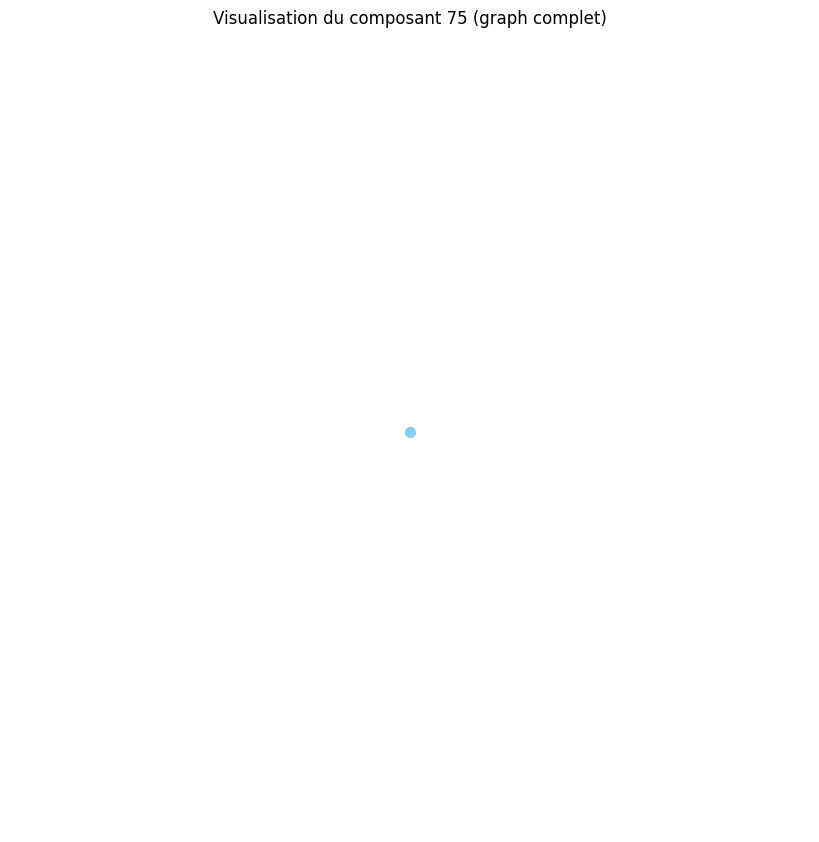

Distance moyenne pour le composant 76 : 0.00
Le composant 76 est un graphe complet ou très densément connecté.
Densité du composant 76 : 0.00
Degré moyen du composant 76 : 0.00
Coefficient de clustering moyen du composant 76 : 0.00


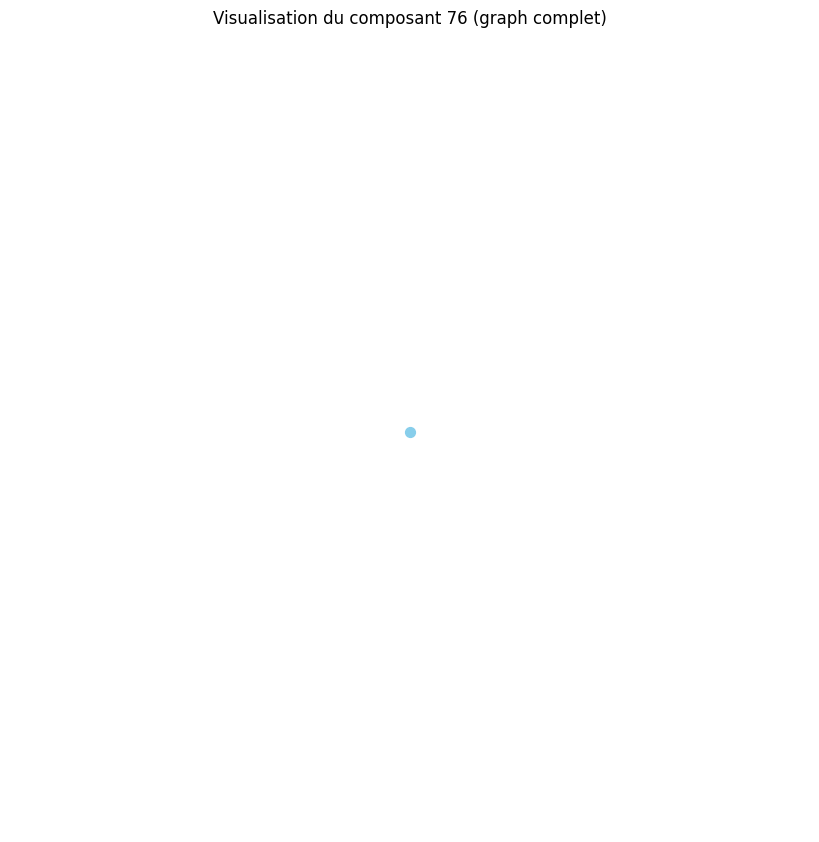

Distance moyenne pour le composant 77 : 0.00
Le composant 77 est un graphe complet ou très densément connecté.
Densité du composant 77 : 0.00
Degré moyen du composant 77 : 0.00
Coefficient de clustering moyen du composant 77 : 0.00


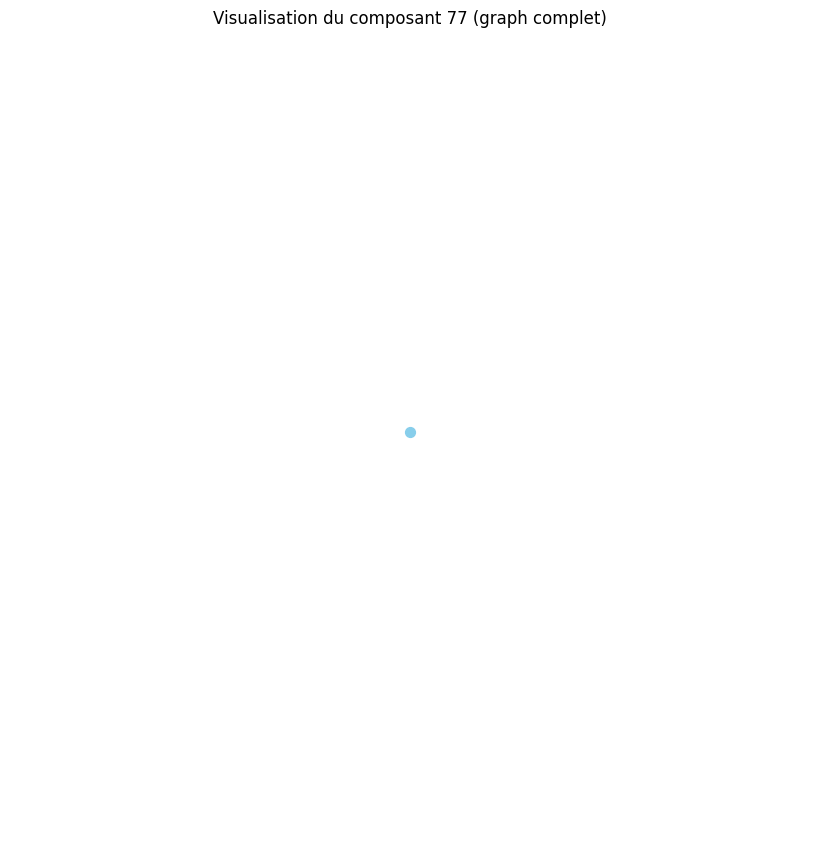

Distance moyenne pour le composant 78 : 0.00
Le composant 78 est un graphe complet ou très densément connecté.
Densité du composant 78 : 0.00
Degré moyen du composant 78 : 0.00
Coefficient de clustering moyen du composant 78 : 0.00


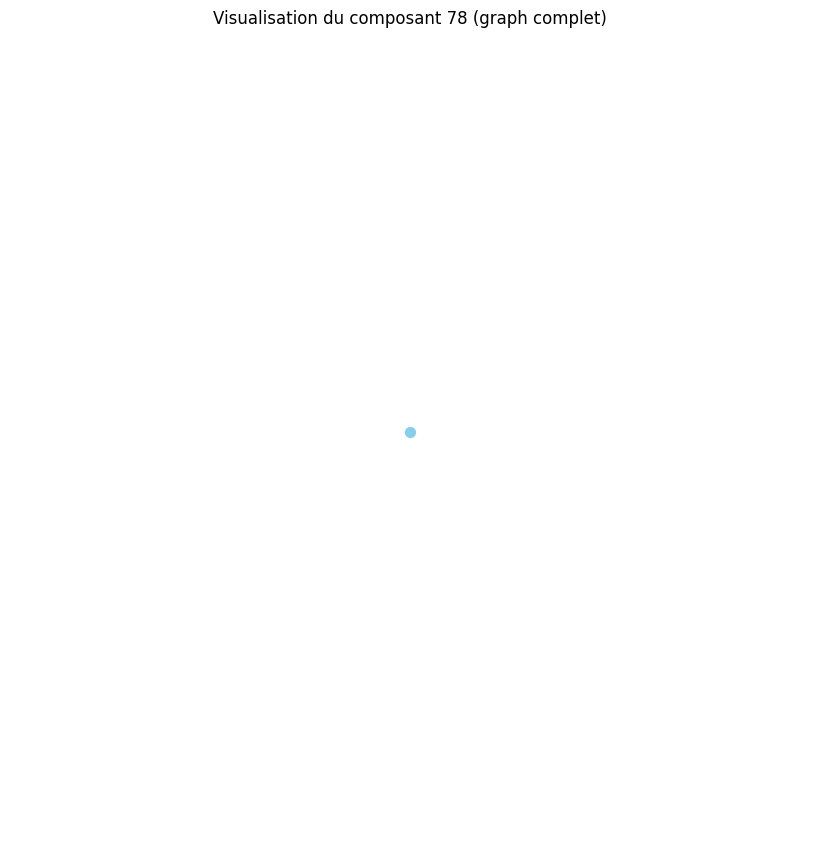

Distance moyenne pour le composant 79 : 0.00
Le composant 79 est un graphe complet ou très densément connecté.
Densité du composant 79 : 0.00
Degré moyen du composant 79 : 0.00
Coefficient de clustering moyen du composant 79 : 0.00


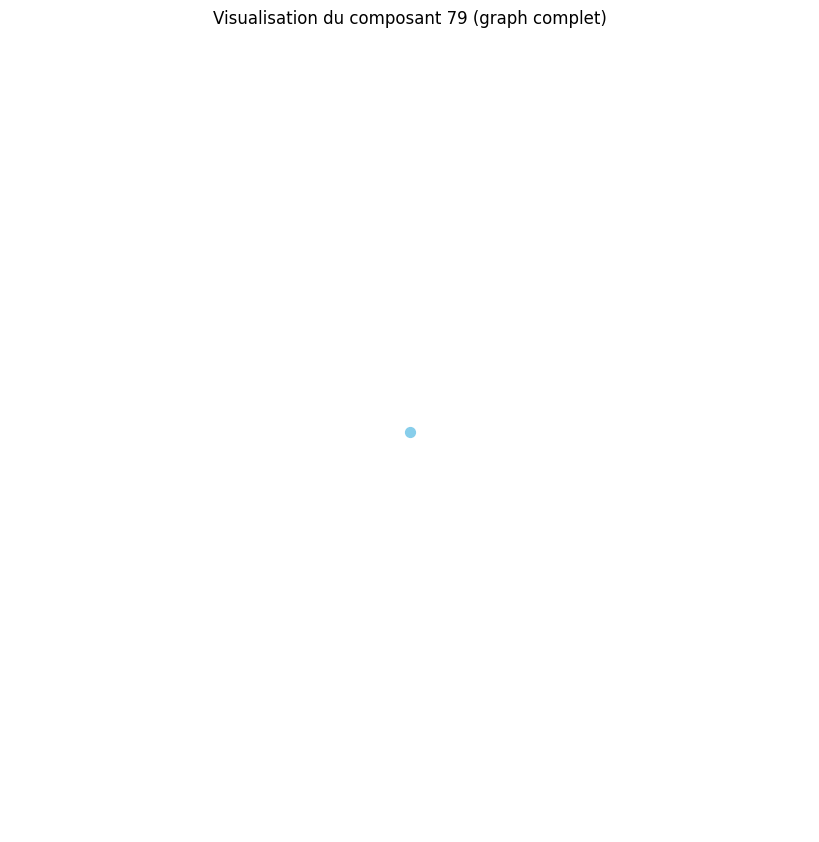

Distance moyenne pour le composant 80 : 0.00
Le composant 80 est un graphe complet ou très densément connecté.
Densité du composant 80 : 0.00
Degré moyen du composant 80 : 0.00
Coefficient de clustering moyen du composant 80 : 0.00


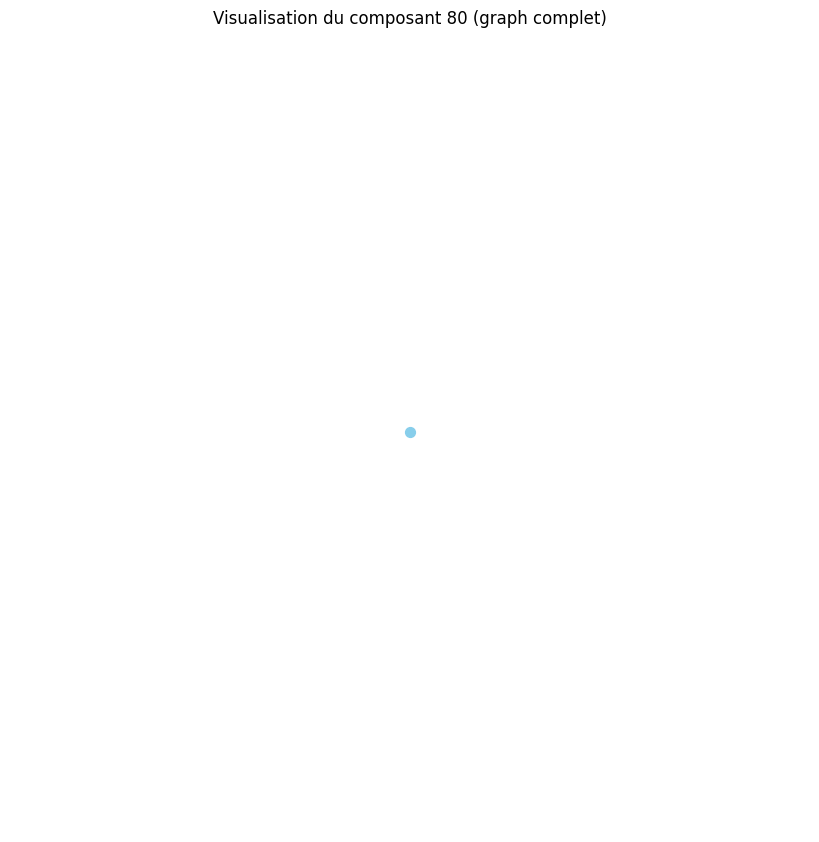

Distance moyenne pour le composant 81 : 0.00
Le composant 81 est un graphe complet ou très densément connecté.
Densité du composant 81 : 0.00
Degré moyen du composant 81 : 0.00
Coefficient de clustering moyen du composant 81 : 0.00


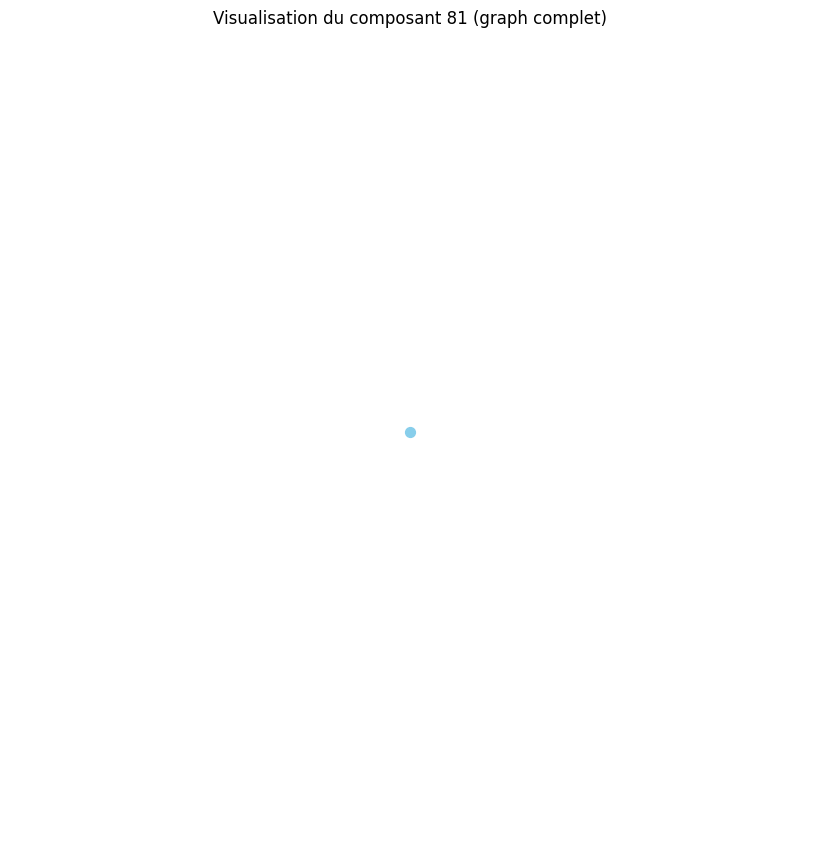

Distance moyenne pour le composant 82 : 0.00
Le composant 82 est un graphe complet ou très densément connecté.
Densité du composant 82 : 0.00
Degré moyen du composant 82 : 0.00
Coefficient de clustering moyen du composant 82 : 0.00


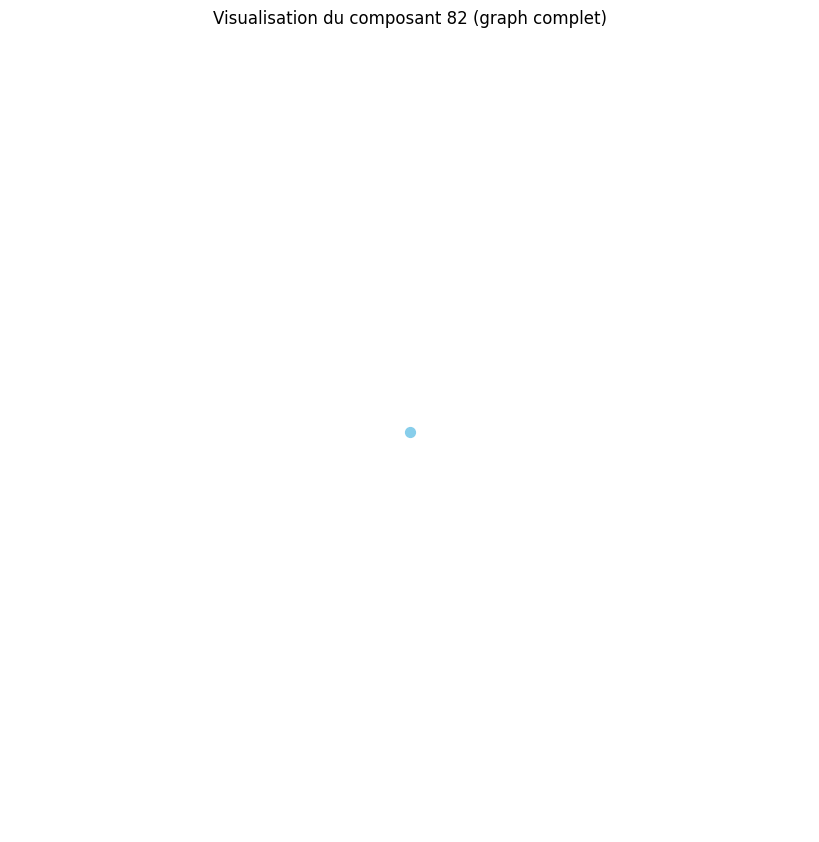

Distance moyenne pour le composant 83 : 0.00
Le composant 83 est un graphe complet ou très densément connecté.
Densité du composant 83 : 0.00
Degré moyen du composant 83 : 0.00
Coefficient de clustering moyen du composant 83 : 0.00


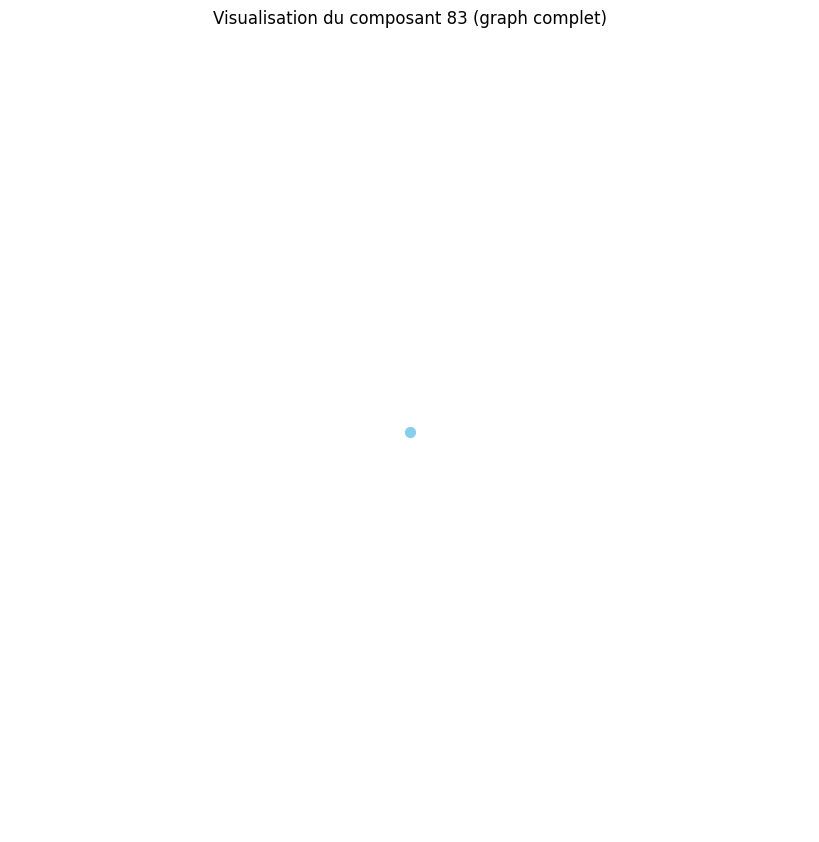

Distance moyenne pour le composant 84 : 1.00
Distance moyenne pour le composant 85 : 0.00
Le composant 85 est un graphe complet ou très densément connecté.
Densité du composant 85 : 0.00
Degré moyen du composant 85 : 0.00
Coefficient de clustering moyen du composant 85 : 0.00


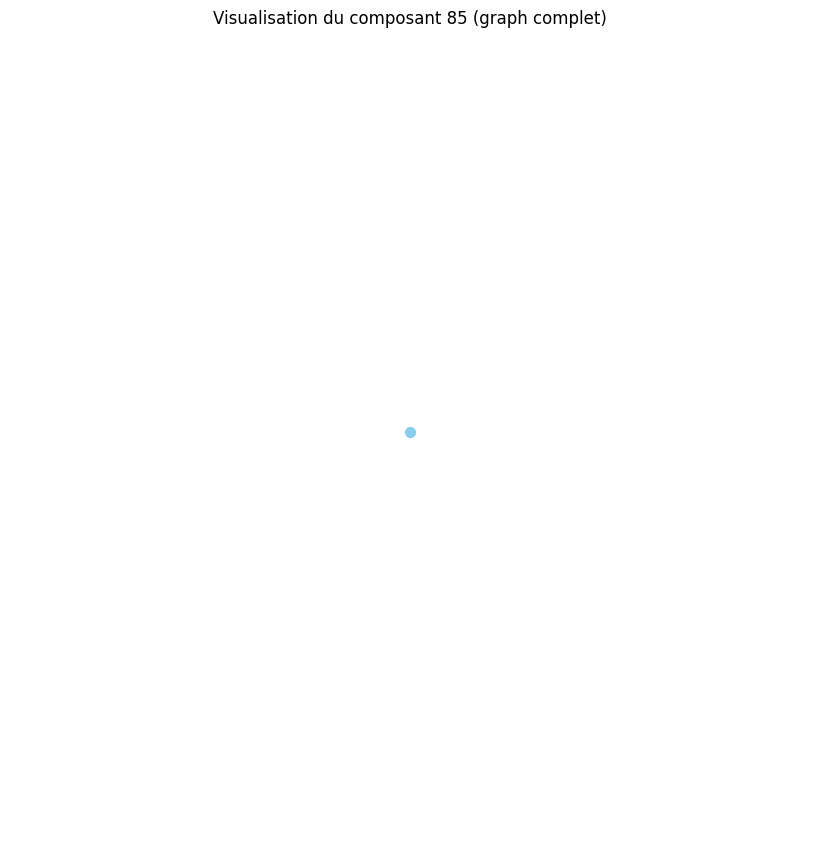

Distance moyenne pour le composant 86 : 0.00
Le composant 86 est un graphe complet ou très densément connecté.
Densité du composant 86 : 0.00
Degré moyen du composant 86 : 0.00
Coefficient de clustering moyen du composant 86 : 0.00


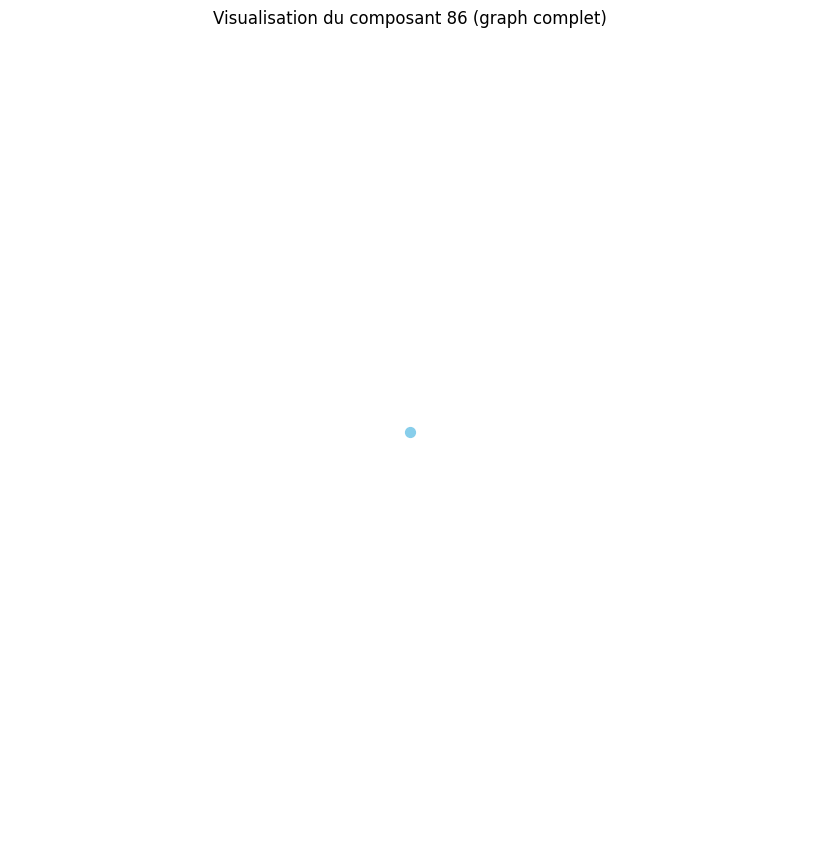

Distance moyenne pour le composant 87 : 0.00
Le composant 87 est un graphe complet ou très densément connecté.
Densité du composant 87 : 0.00
Degré moyen du composant 87 : 0.00
Coefficient de clustering moyen du composant 87 : 0.00


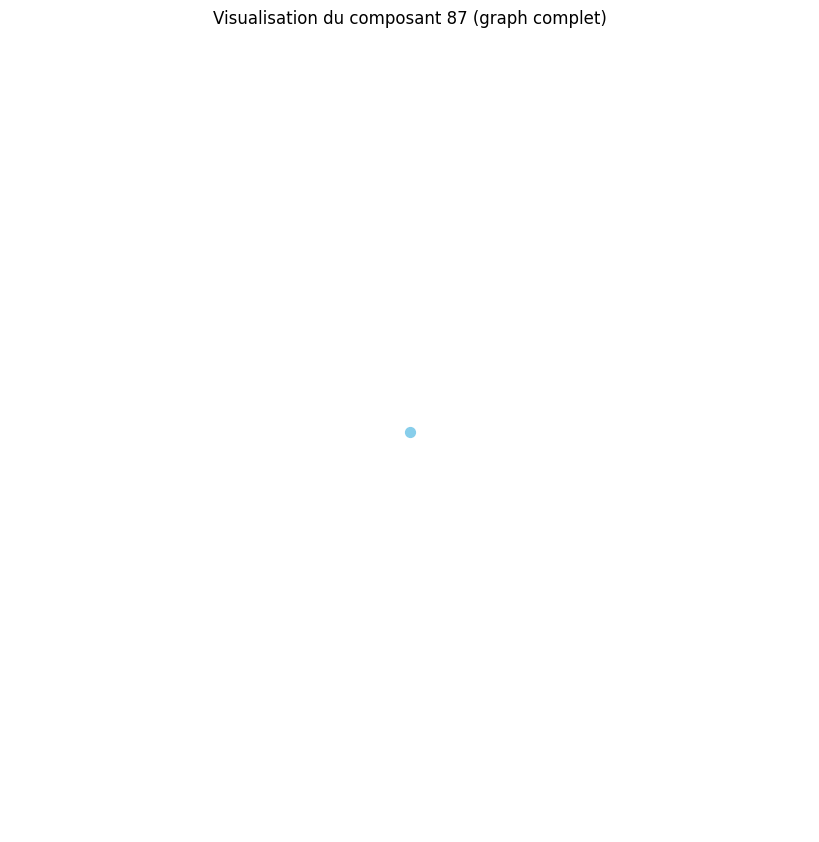

Distance moyenne pour le composant 88 : 0.00
Le composant 88 est un graphe complet ou très densément connecté.
Densité du composant 88 : 0.00
Degré moyen du composant 88 : 0.00
Coefficient de clustering moyen du composant 88 : 0.00


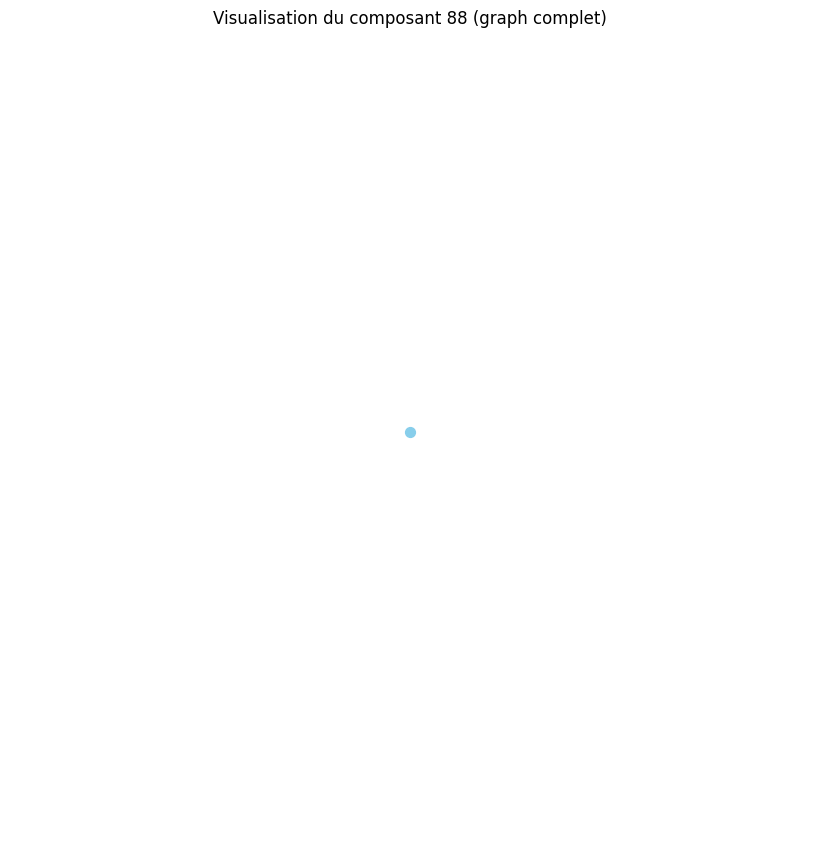

Distance moyenne pour le composant 89 : 0.00
Le composant 89 est un graphe complet ou très densément connecté.
Densité du composant 89 : 0.00
Degré moyen du composant 89 : 0.00
Coefficient de clustering moyen du composant 89 : 0.00


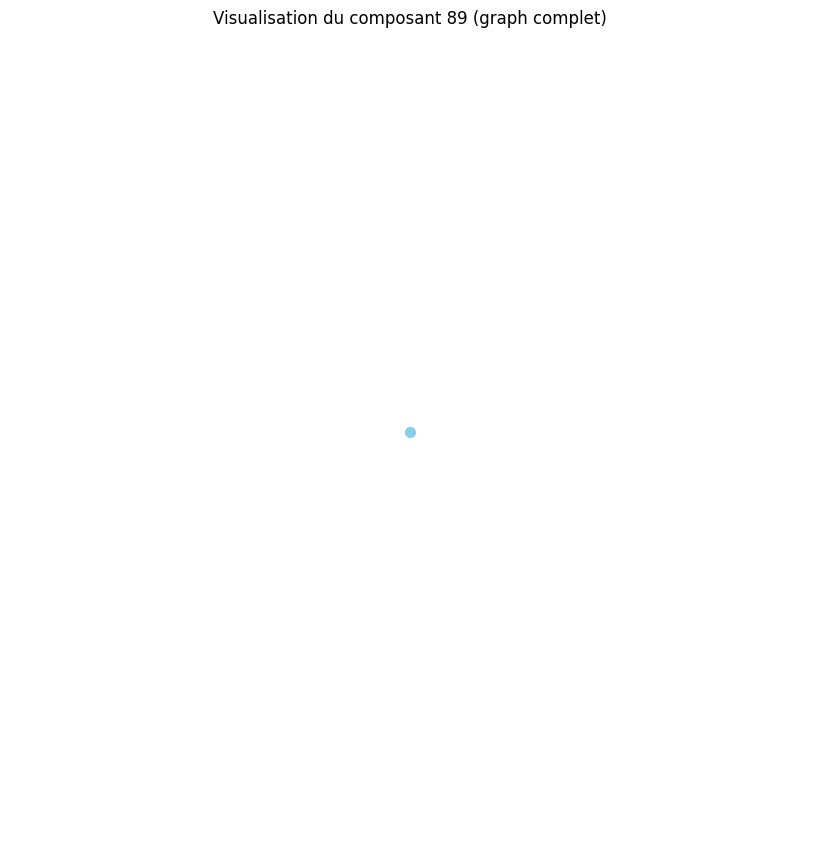

Distance moyenne pour le composant 90 : 0.00
Le composant 90 est un graphe complet ou très densément connecté.
Densité du composant 90 : 0.00
Degré moyen du composant 90 : 0.00
Coefficient de clustering moyen du composant 90 : 0.00


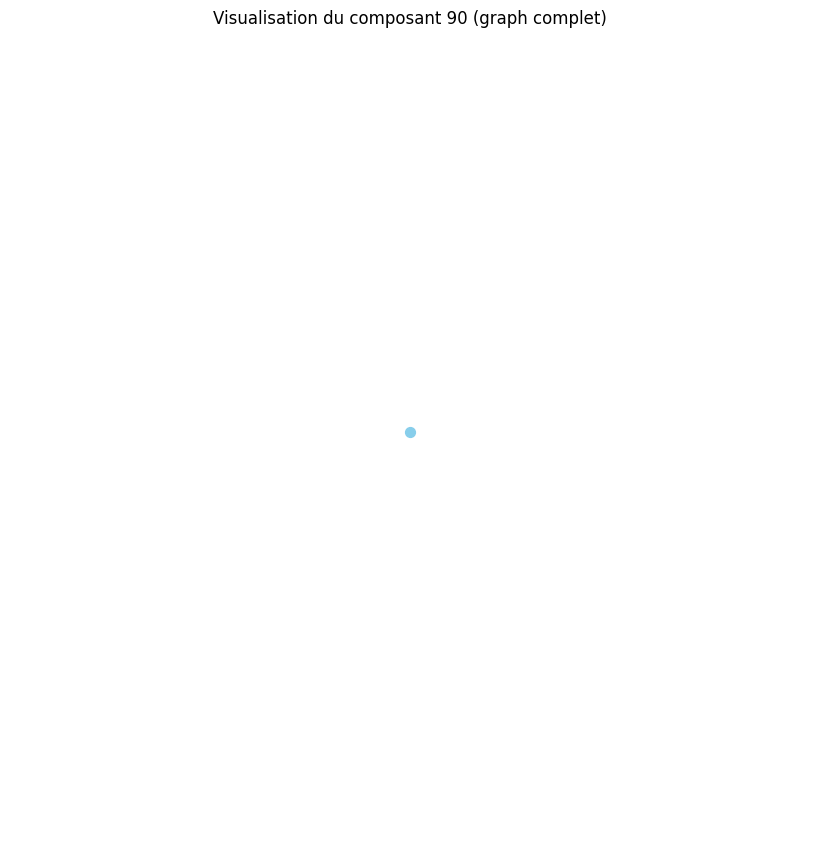

Distance moyenne pour le composant 91 : 0.00
Le composant 91 est un graphe complet ou très densément connecté.
Densité du composant 91 : 0.00
Degré moyen du composant 91 : 0.00
Coefficient de clustering moyen du composant 91 : 0.00


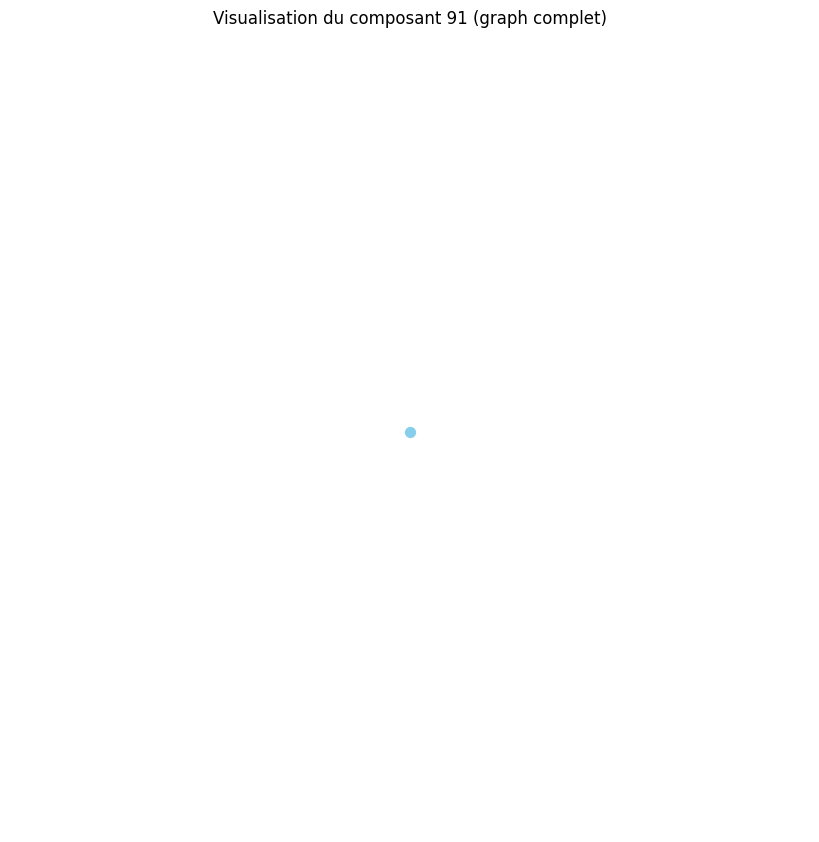

Distance moyenne pour le composant 92 : 0.00
Le composant 92 est un graphe complet ou très densément connecté.
Densité du composant 92 : 0.00
Degré moyen du composant 92 : 0.00
Coefficient de clustering moyen du composant 92 : 0.00


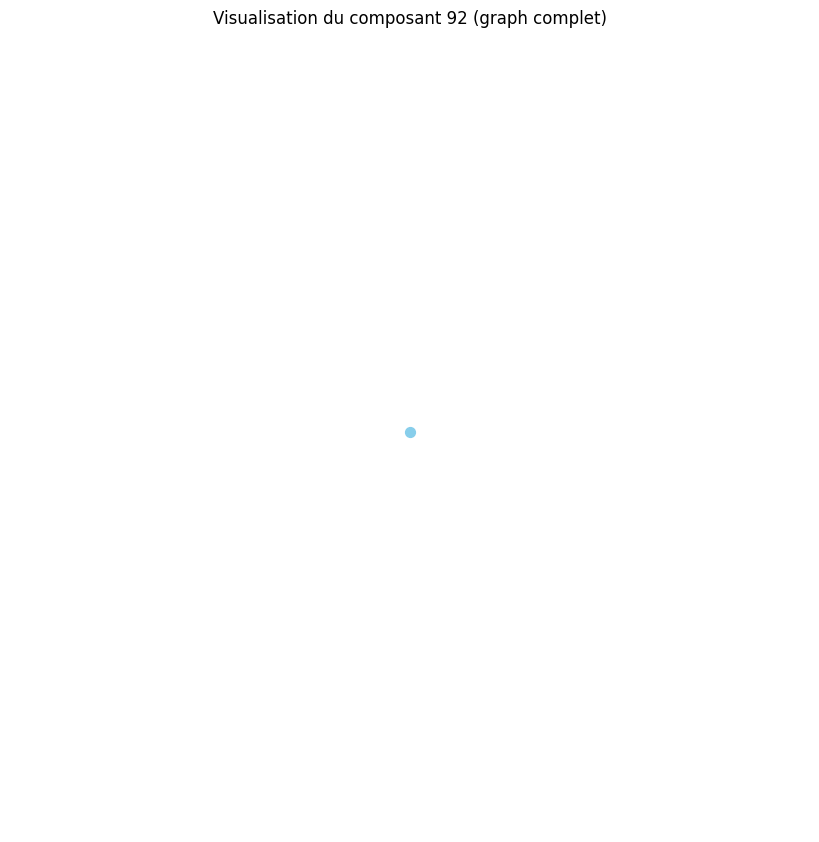

Distance moyenne pour le composant 93 : 0.00
Le composant 93 est un graphe complet ou très densément connecté.
Densité du composant 93 : 0.00
Degré moyen du composant 93 : 0.00
Coefficient de clustering moyen du composant 93 : 0.00


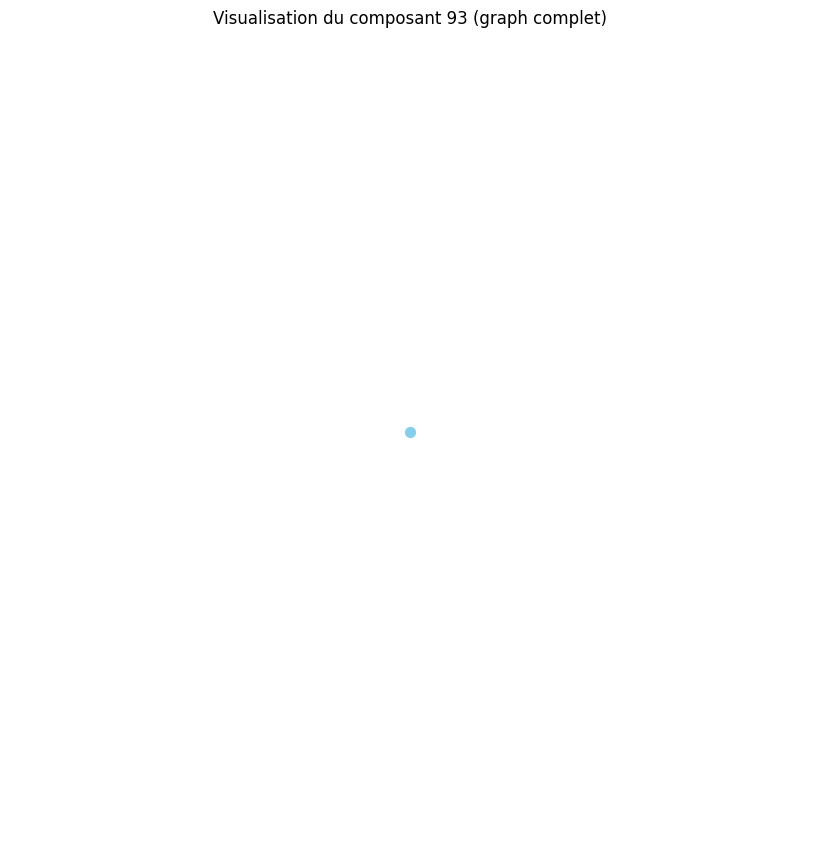

Distance moyenne pour le composant 94 : 0.00
Le composant 94 est un graphe complet ou très densément connecté.
Densité du composant 94 : 0.00
Degré moyen du composant 94 : 0.00
Coefficient de clustering moyen du composant 94 : 0.00


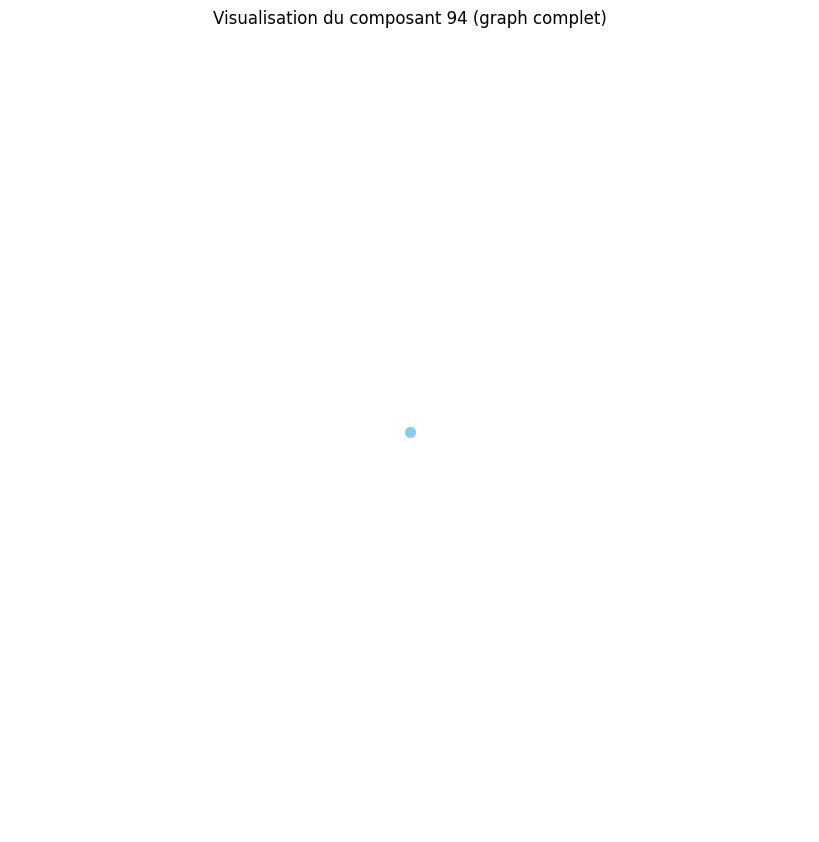

Distance moyenne pour le composant 95 : 0.00
Le composant 95 est un graphe complet ou très densément connecté.
Densité du composant 95 : 0.00
Degré moyen du composant 95 : 0.00
Coefficient de clustering moyen du composant 95 : 0.00


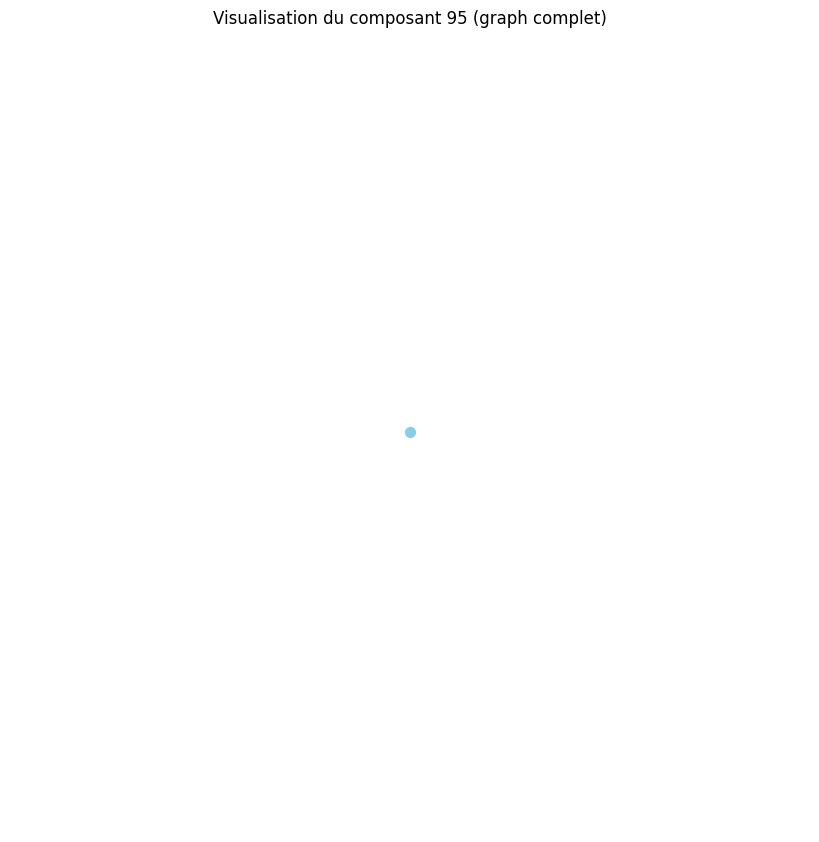

Distance moyenne pour le composant 96 : 0.00
Le composant 96 est un graphe complet ou très densément connecté.
Densité du composant 96 : 0.00
Degré moyen du composant 96 : 0.00
Coefficient de clustering moyen du composant 96 : 0.00


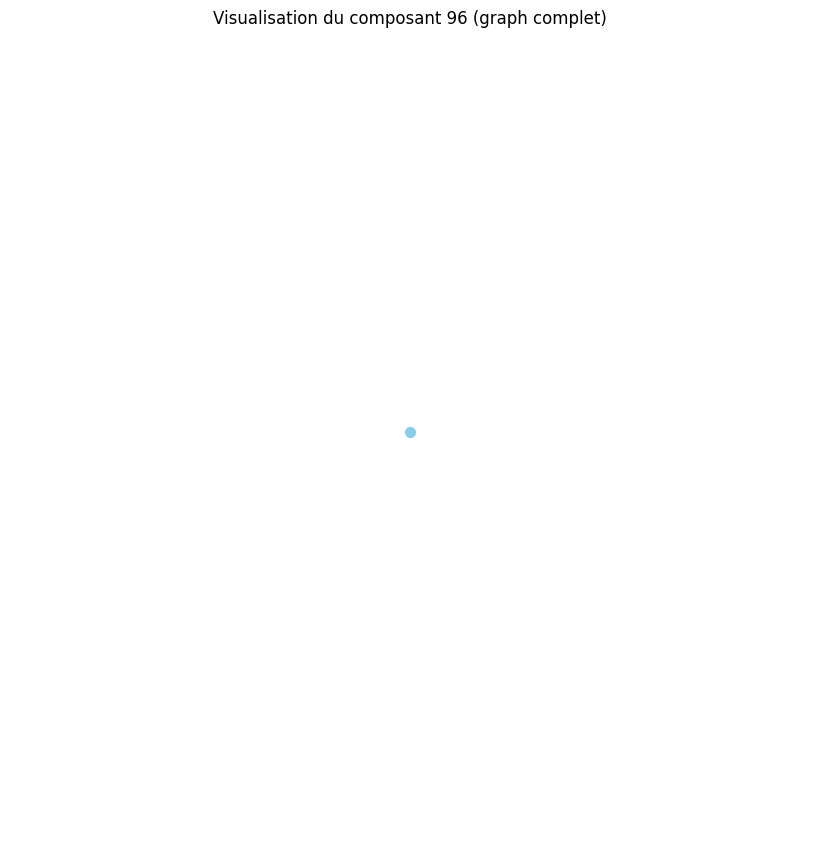

Distance moyenne pour le composant 97 : 0.00
Le composant 97 est un graphe complet ou très densément connecté.
Densité du composant 97 : 0.00
Degré moyen du composant 97 : 0.00
Coefficient de clustering moyen du composant 97 : 0.00


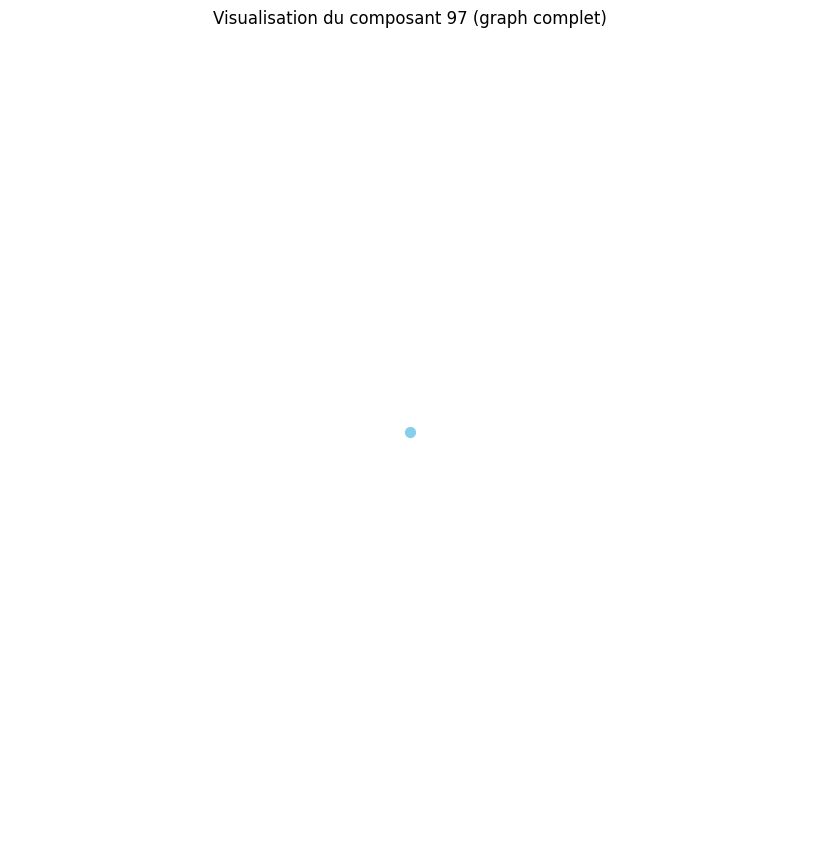

Distance moyenne pour le composant 98 : 0.00
Le composant 98 est un graphe complet ou très densément connecté.
Densité du composant 98 : 0.00
Degré moyen du composant 98 : 0.00
Coefficient de clustering moyen du composant 98 : 0.00


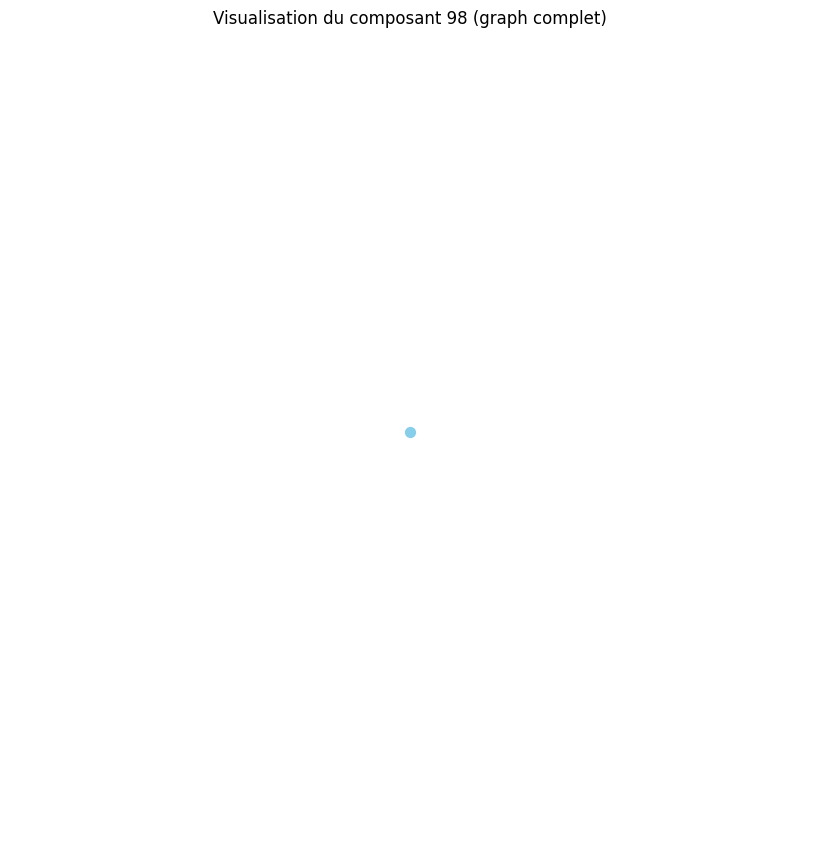

Distance moyenne pour le composant 99 : 0.00
Le composant 99 est un graphe complet ou très densément connecté.
Densité du composant 99 : 0.00
Degré moyen du composant 99 : 0.00
Coefficient de clustering moyen du composant 99 : 0.00


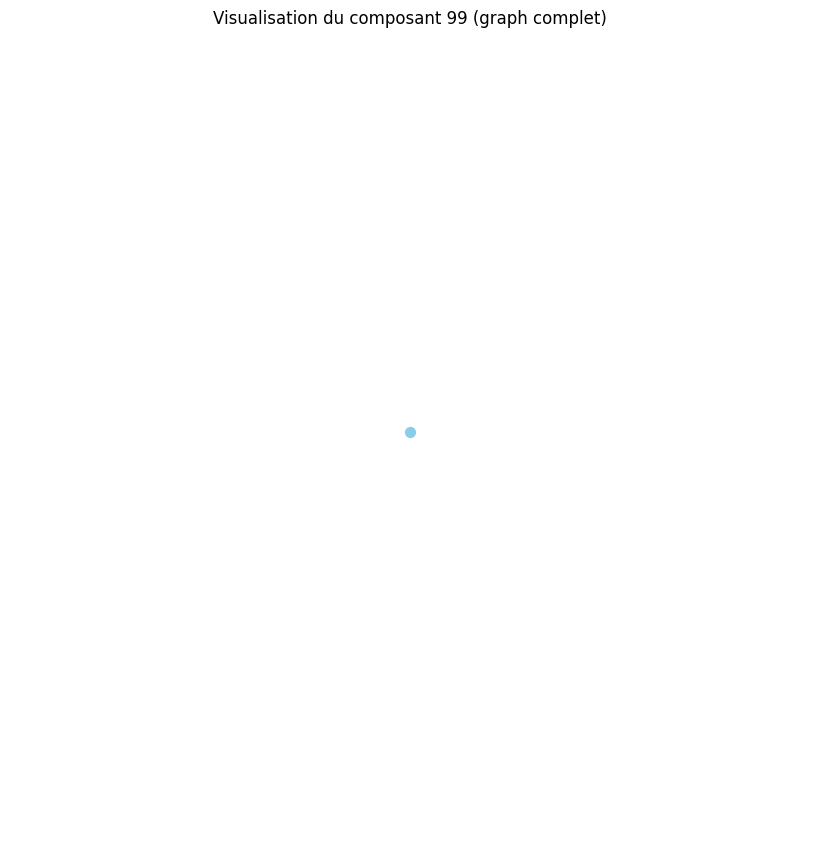

Distance moyenne pour le composant 100 : 0.00
Le composant 100 est un graphe complet ou très densément connecté.
Densité du composant 100 : 0.00
Degré moyen du composant 100 : 0.00
Coefficient de clustering moyen du composant 100 : 0.00


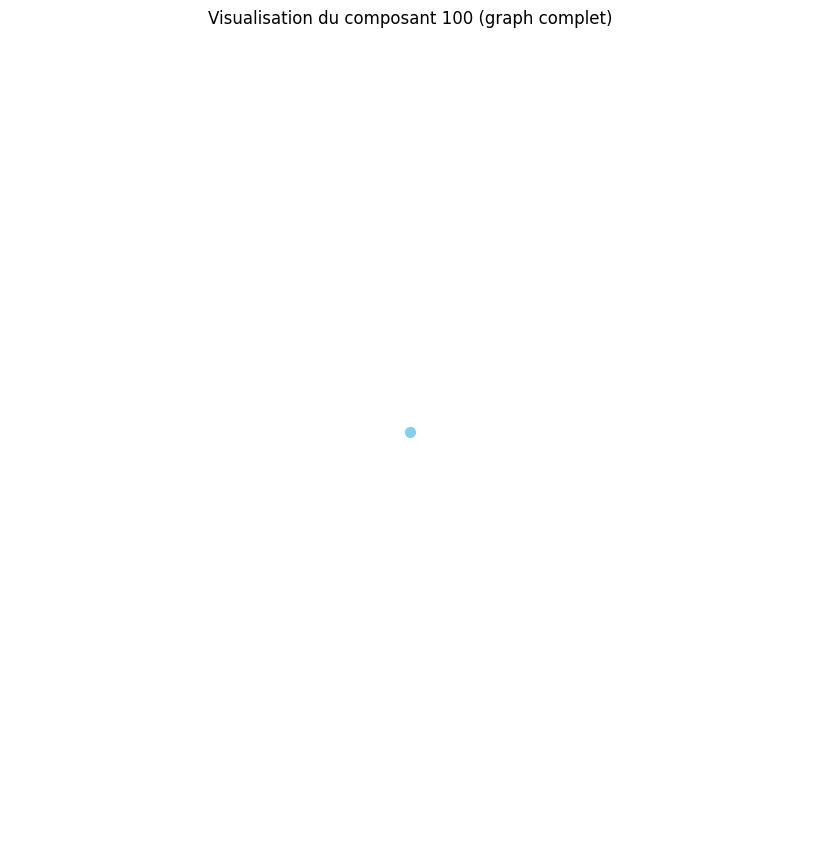

Distance moyenne pour le composant 101 : 0.00
Le composant 101 est un graphe complet ou très densément connecté.
Densité du composant 101 : 0.00
Degré moyen du composant 101 : 0.00
Coefficient de clustering moyen du composant 101 : 0.00


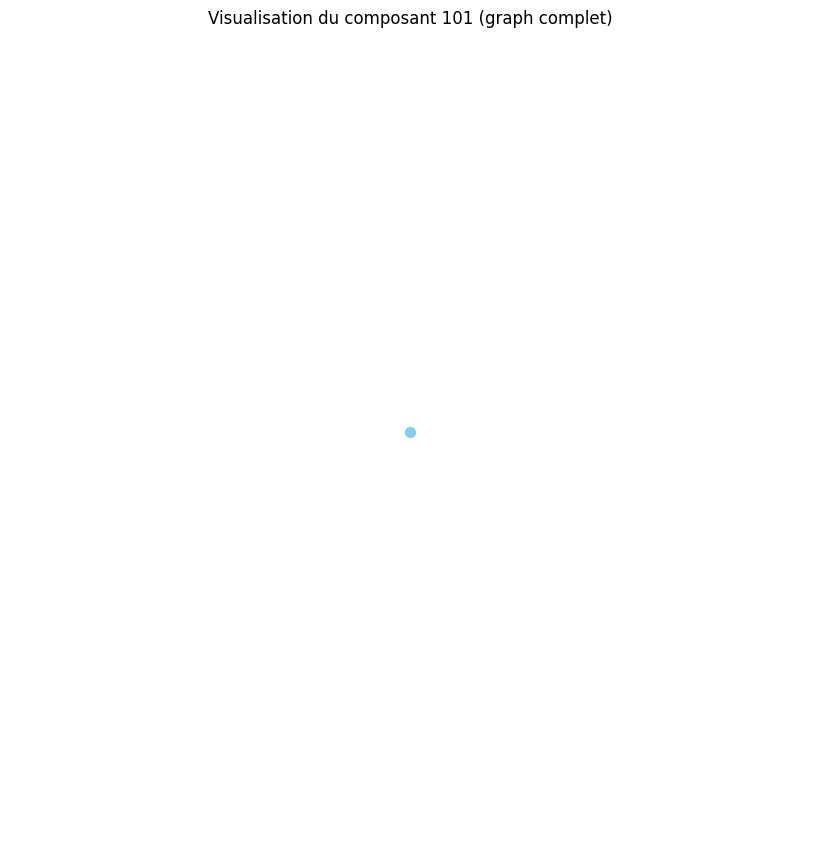

Distance moyenne pour le composant 102 : 0.00
Le composant 102 est un graphe complet ou très densément connecté.
Densité du composant 102 : 0.00
Degré moyen du composant 102 : 0.00
Coefficient de clustering moyen du composant 102 : 0.00


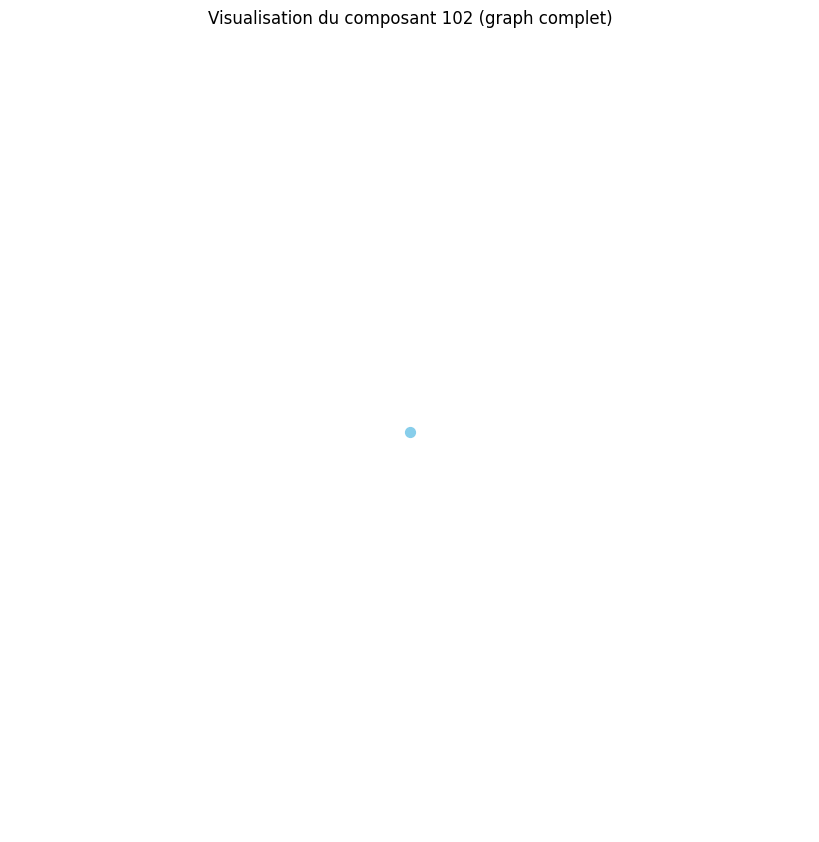

Distance moyenne pour le composant 103 : 0.00
Le composant 103 est un graphe complet ou très densément connecté.
Densité du composant 103 : 0.00
Degré moyen du composant 103 : 0.00
Coefficient de clustering moyen du composant 103 : 0.00


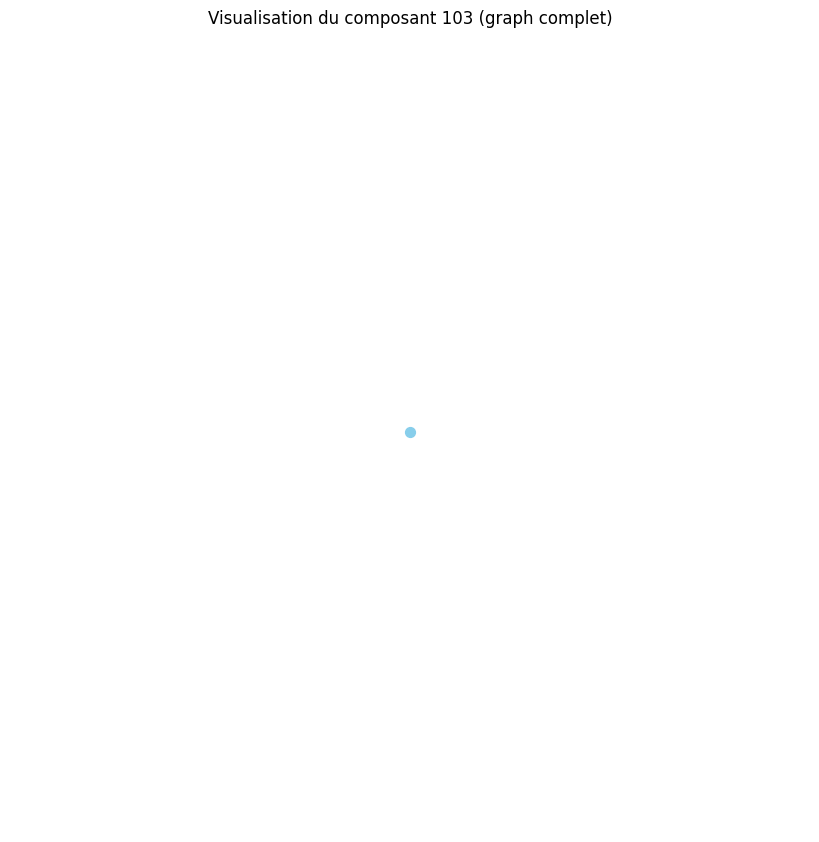

Distance moyenne pour le composant 104 : 0.00
Le composant 104 est un graphe complet ou très densément connecté.
Densité du composant 104 : 0.00
Degré moyen du composant 104 : 0.00
Coefficient de clustering moyen du composant 104 : 0.00


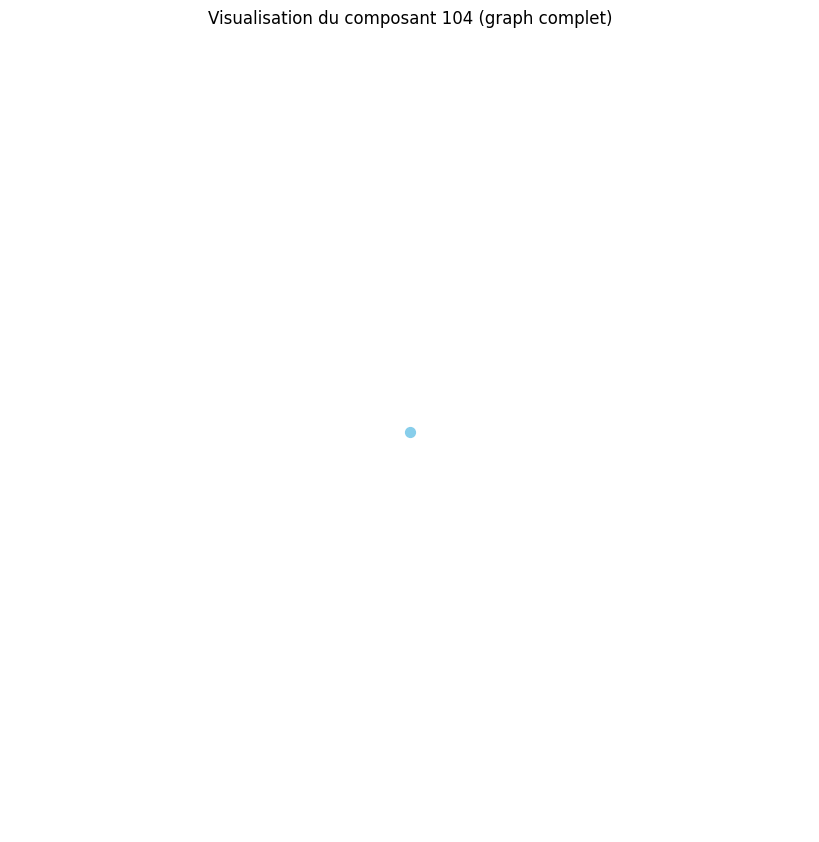

Distance moyenne pour le composant 105 : 0.00
Le composant 105 est un graphe complet ou très densément connecté.
Densité du composant 105 : 0.00
Degré moyen du composant 105 : 0.00
Coefficient de clustering moyen du composant 105 : 0.00


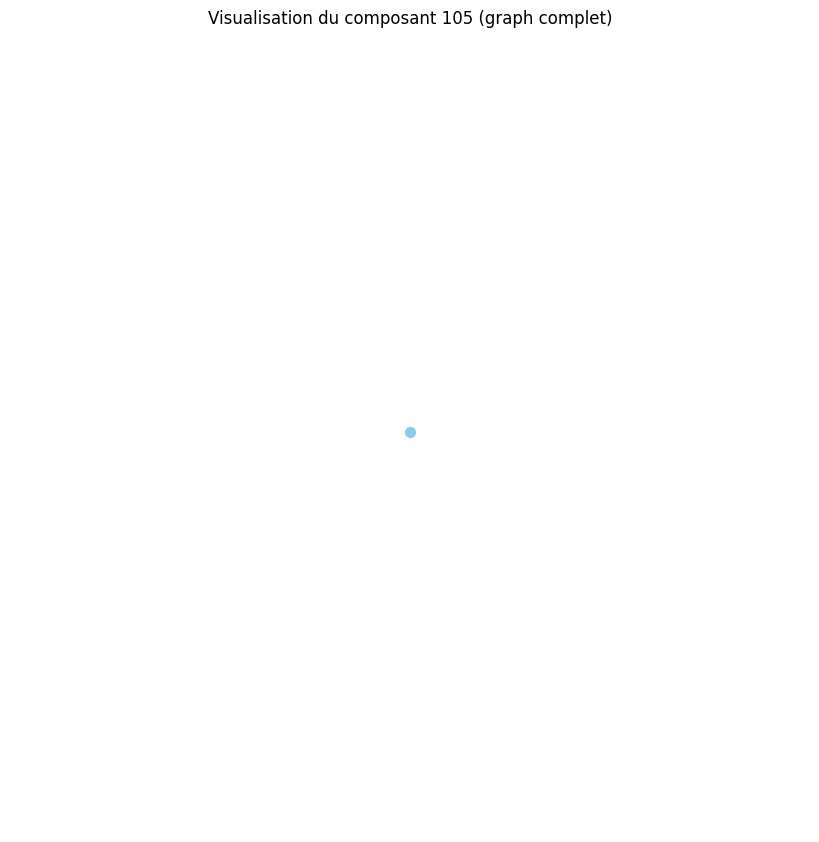

Distance moyenne pour le composant 106 : 0.00
Le composant 106 est un graphe complet ou très densément connecté.
Densité du composant 106 : 0.00
Degré moyen du composant 106 : 0.00
Coefficient de clustering moyen du composant 106 : 0.00


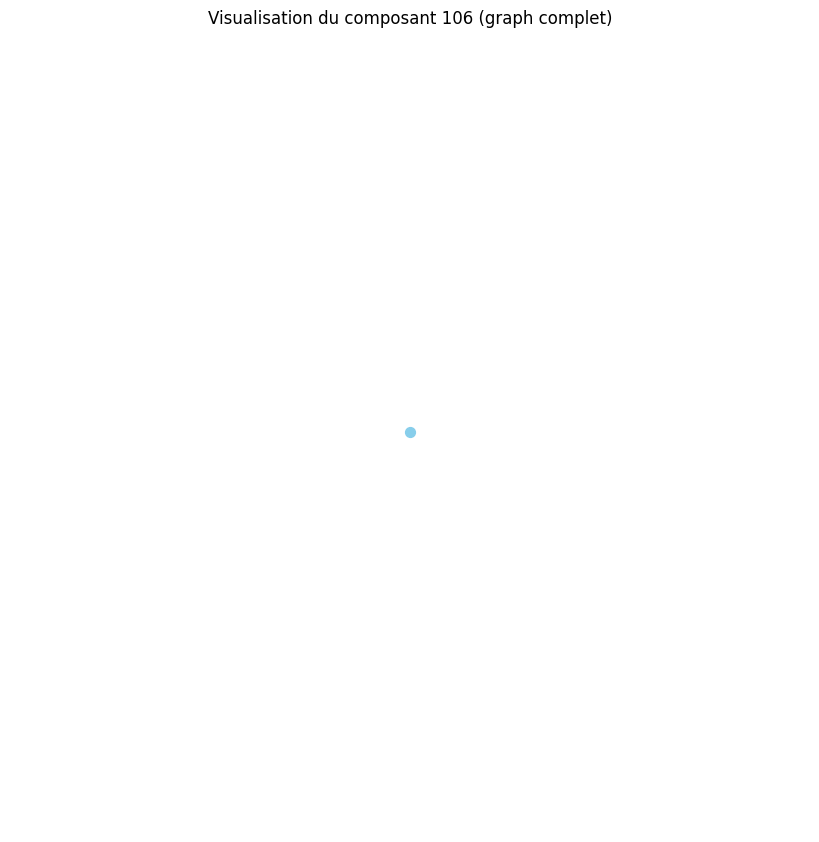

Distance moyenne pour le composant 107 : 0.00
Le composant 107 est un graphe complet ou très densément connecté.
Densité du composant 107 : 0.00
Degré moyen du composant 107 : 0.00
Coefficient de clustering moyen du composant 107 : 0.00


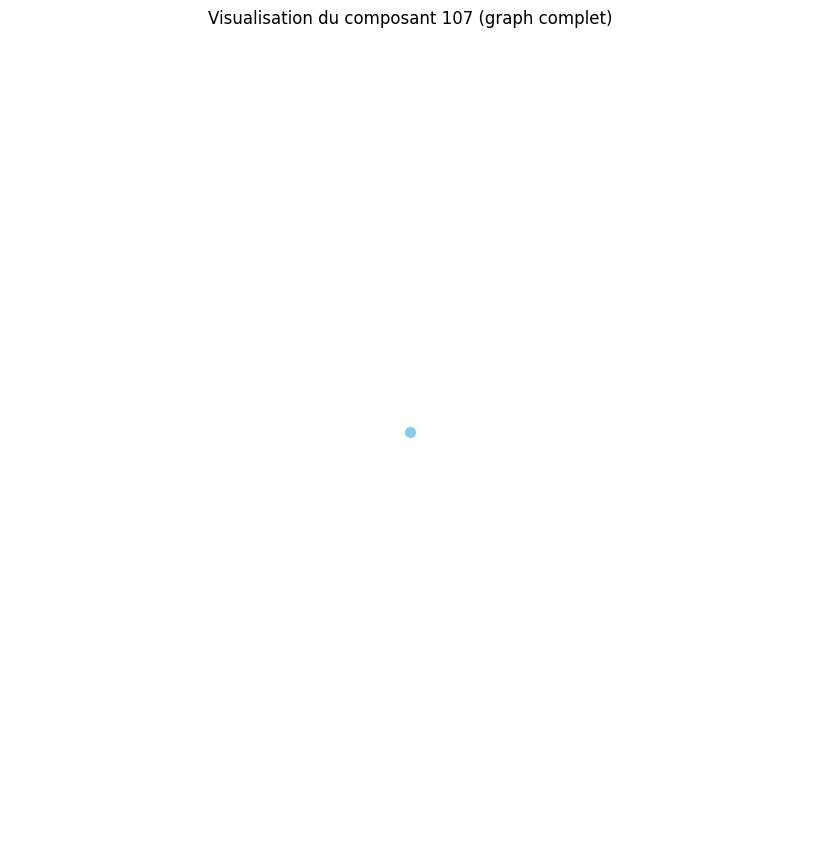

Distance moyenne pour le composant 108 : 0.00
Le composant 108 est un graphe complet ou très densément connecté.
Densité du composant 108 : 0.00
Degré moyen du composant 108 : 0.00
Coefficient de clustering moyen du composant 108 : 0.00


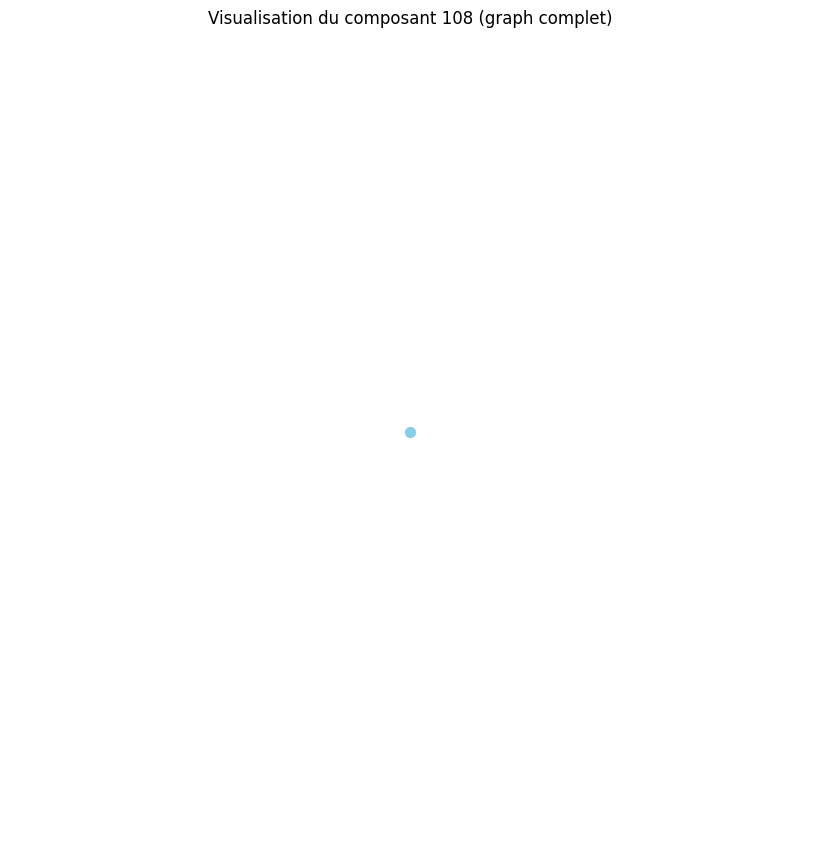

Distance moyenne pour le composant 109 : 0.00
Le composant 109 est un graphe complet ou très densément connecté.
Densité du composant 109 : 0.00
Degré moyen du composant 109 : 0.00
Coefficient de clustering moyen du composant 109 : 0.00


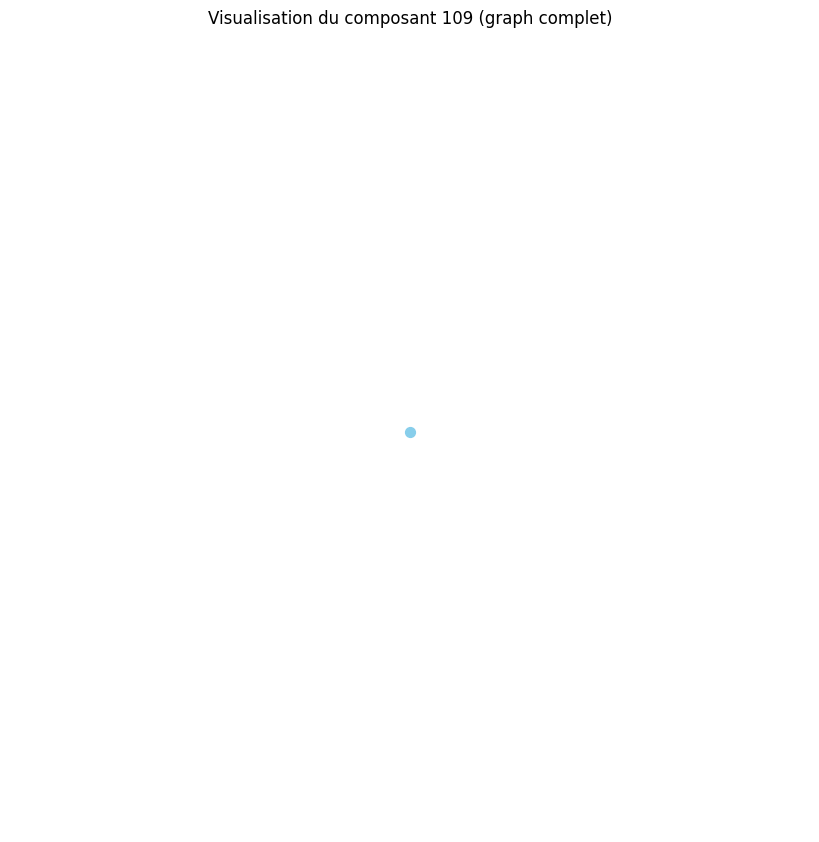

Distance moyenne pour le composant 110 : 0.00
Le composant 110 est un graphe complet ou très densément connecté.
Densité du composant 110 : 0.00
Degré moyen du composant 110 : 0.00
Coefficient de clustering moyen du composant 110 : 0.00


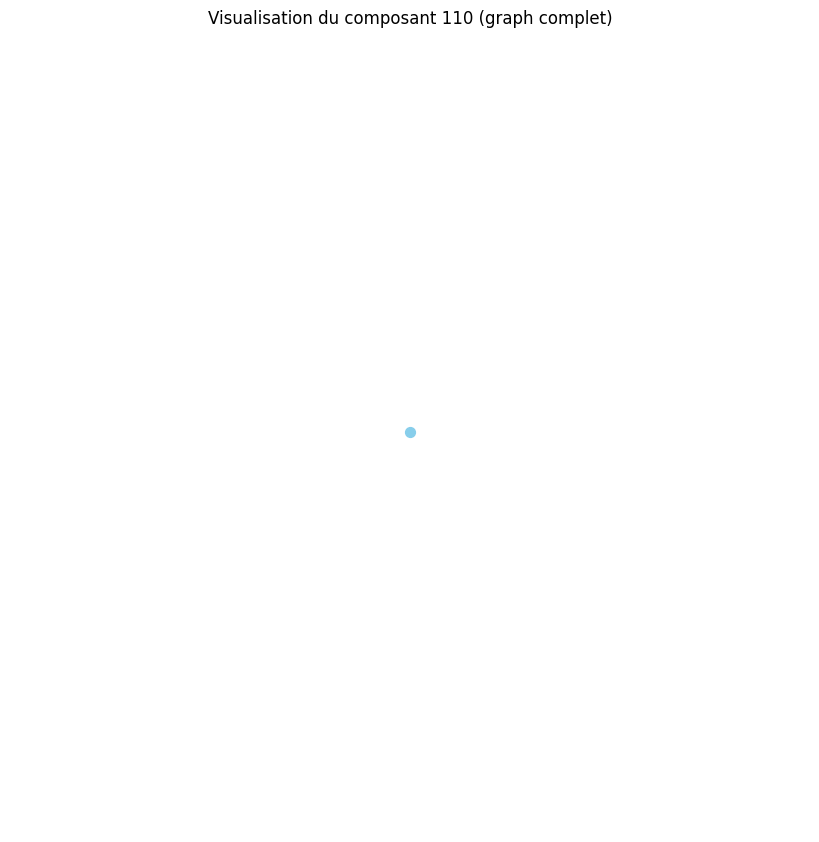

Distance moyenne pour le composant 111 : 0.00
Le composant 111 est un graphe complet ou très densément connecté.
Densité du composant 111 : 0.00
Degré moyen du composant 111 : 0.00
Coefficient de clustering moyen du composant 111 : 0.00


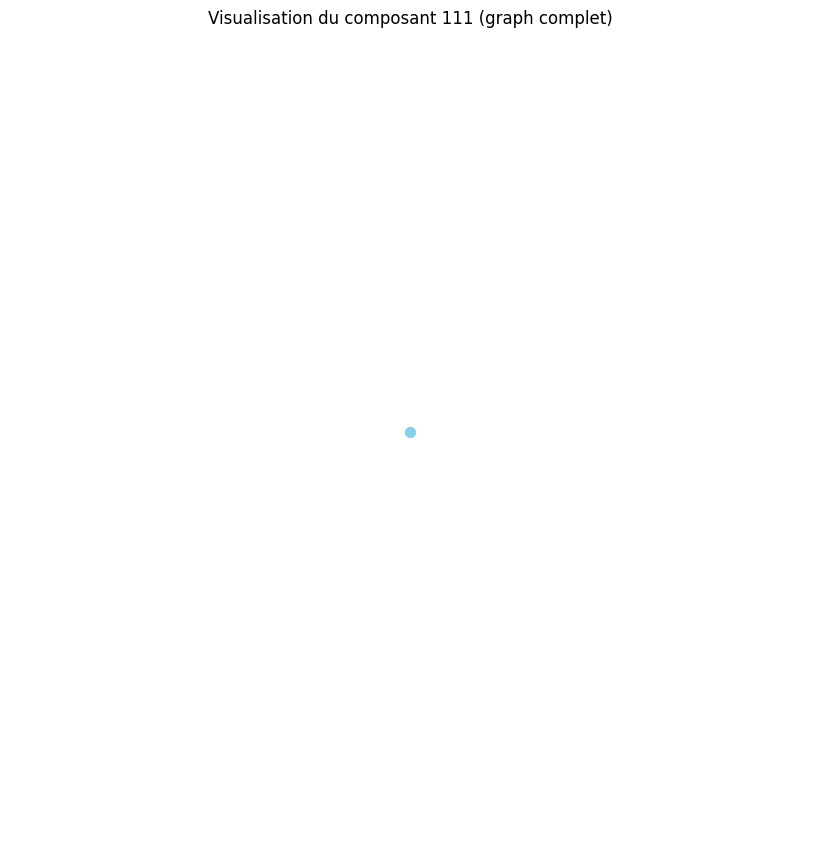

Distance moyenne pour le composant 112 : 0.00
Le composant 112 est un graphe complet ou très densément connecté.
Densité du composant 112 : 0.00
Degré moyen du composant 112 : 0.00
Coefficient de clustering moyen du composant 112 : 0.00


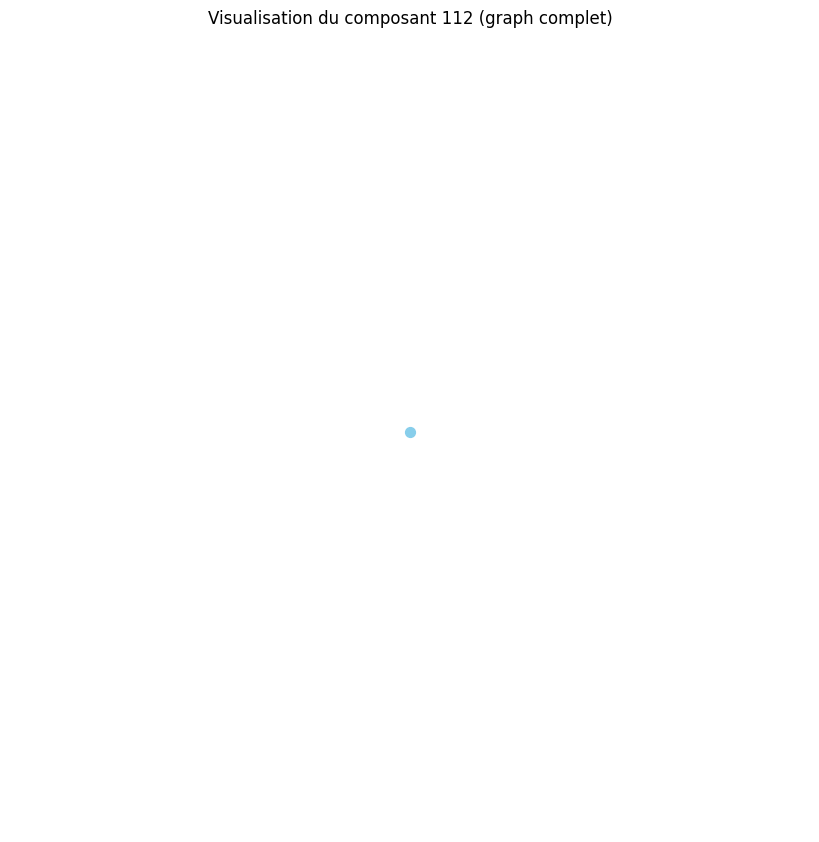

Distance moyenne pour le composant 113 : 0.00
Le composant 113 est un graphe complet ou très densément connecté.
Densité du composant 113 : 0.00
Degré moyen du composant 113 : 0.00
Coefficient de clustering moyen du composant 113 : 0.00


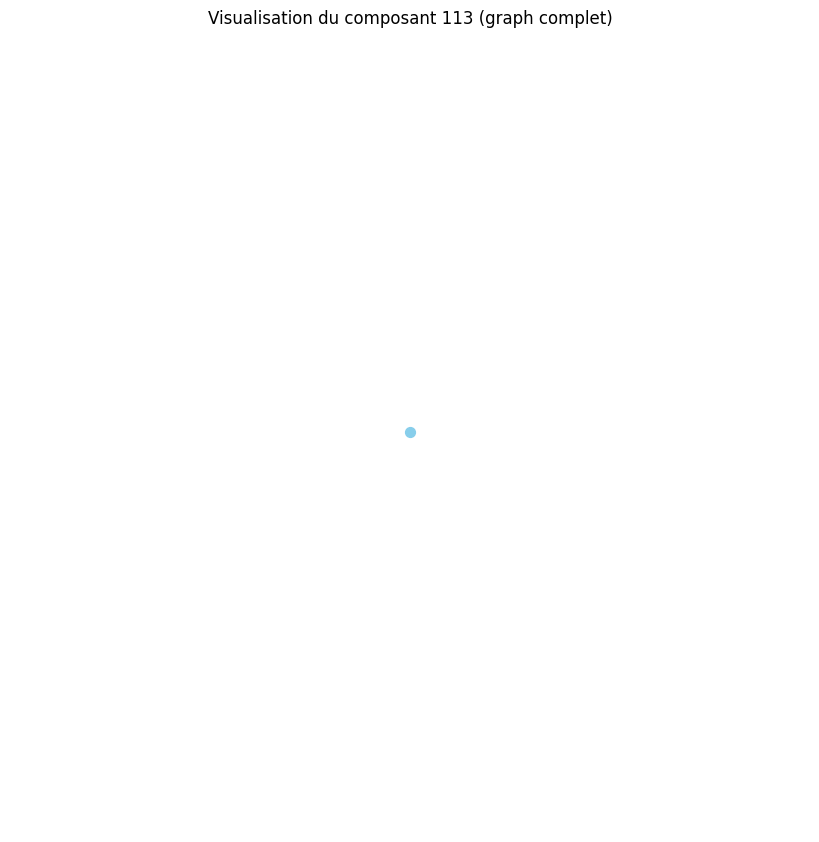

Distance moyenne pour le composant 114 : 0.00
Le composant 114 est un graphe complet ou très densément connecté.
Densité du composant 114 : 0.00
Degré moyen du composant 114 : 0.00
Coefficient de clustering moyen du composant 114 : 0.00


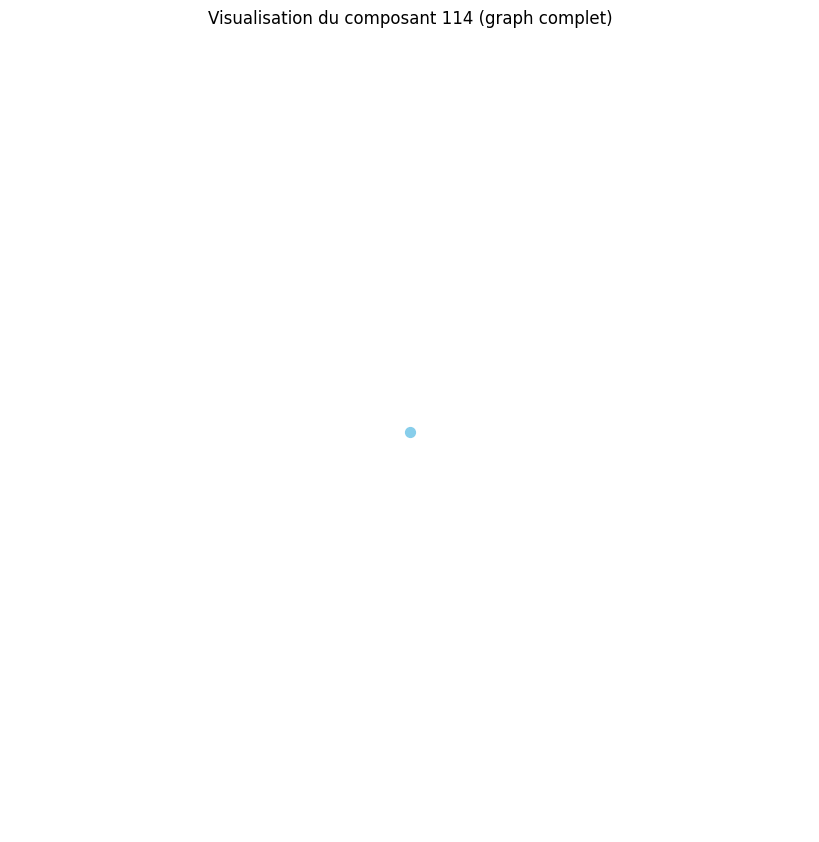

Distance moyenne pour le composant 115 : 0.00
Le composant 115 est un graphe complet ou très densément connecté.
Densité du composant 115 : 0.00
Degré moyen du composant 115 : 0.00
Coefficient de clustering moyen du composant 115 : 0.00


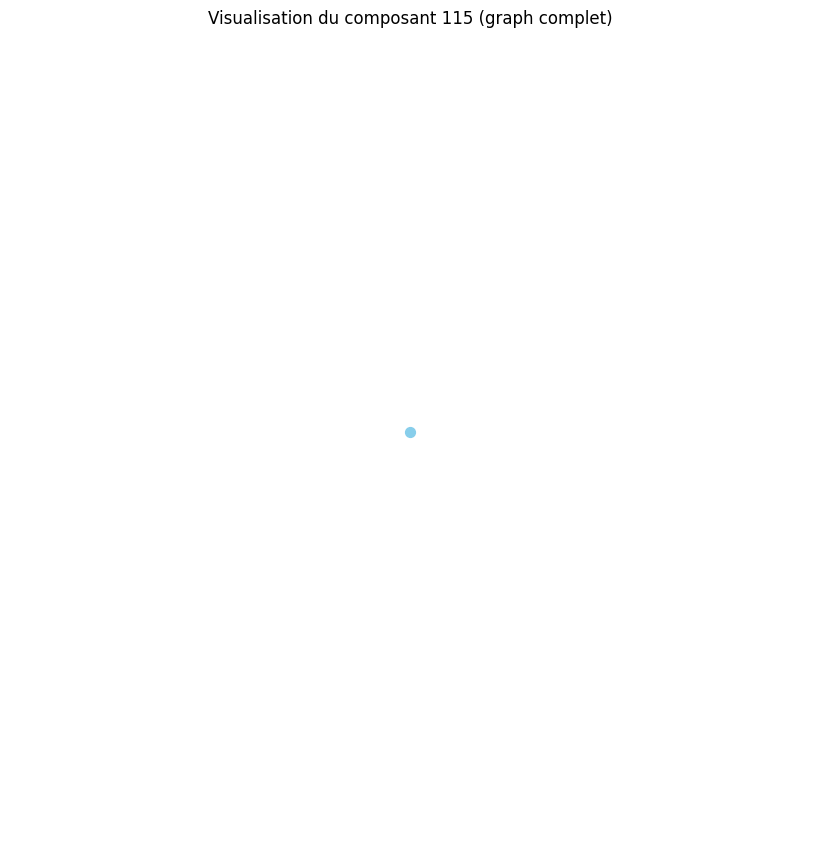

Distance moyenne pour le composant 116 : 0.00
Le composant 116 est un graphe complet ou très densément connecté.
Densité du composant 116 : 0.00
Degré moyen du composant 116 : 0.00
Coefficient de clustering moyen du composant 116 : 0.00


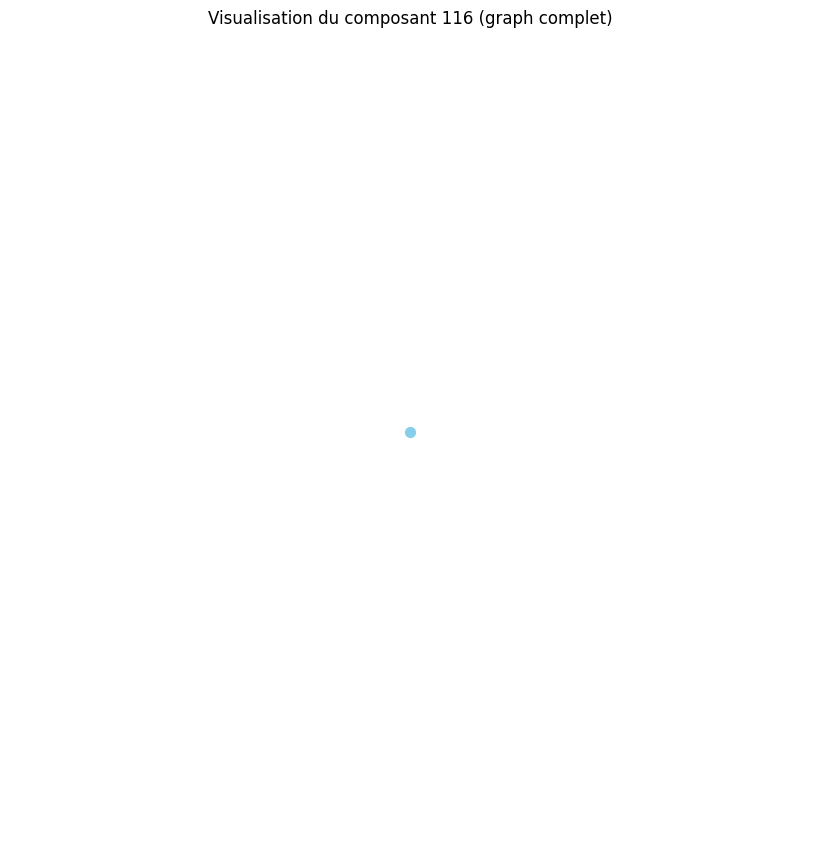

Distance moyenne pour le composant 117 : 0.00
Le composant 117 est un graphe complet ou très densément connecté.
Densité du composant 117 : 0.00
Degré moyen du composant 117 : 0.00
Coefficient de clustering moyen du composant 117 : 0.00


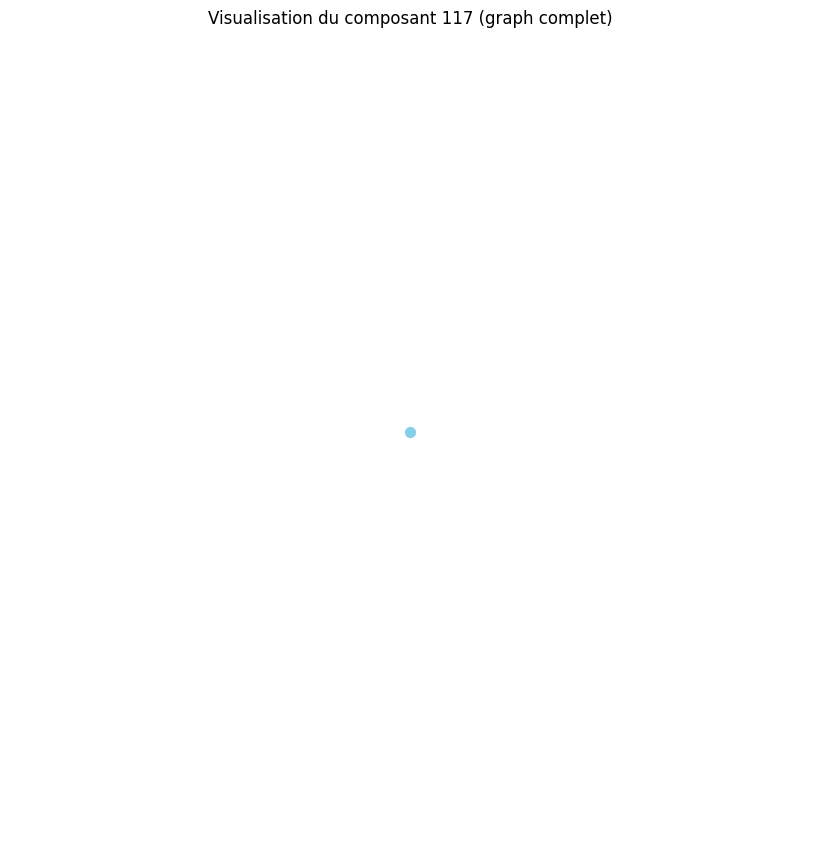

Distance moyenne pour le composant 118 : 0.00
Le composant 118 est un graphe complet ou très densément connecté.
Densité du composant 118 : 0.00
Degré moyen du composant 118 : 0.00
Coefficient de clustering moyen du composant 118 : 0.00


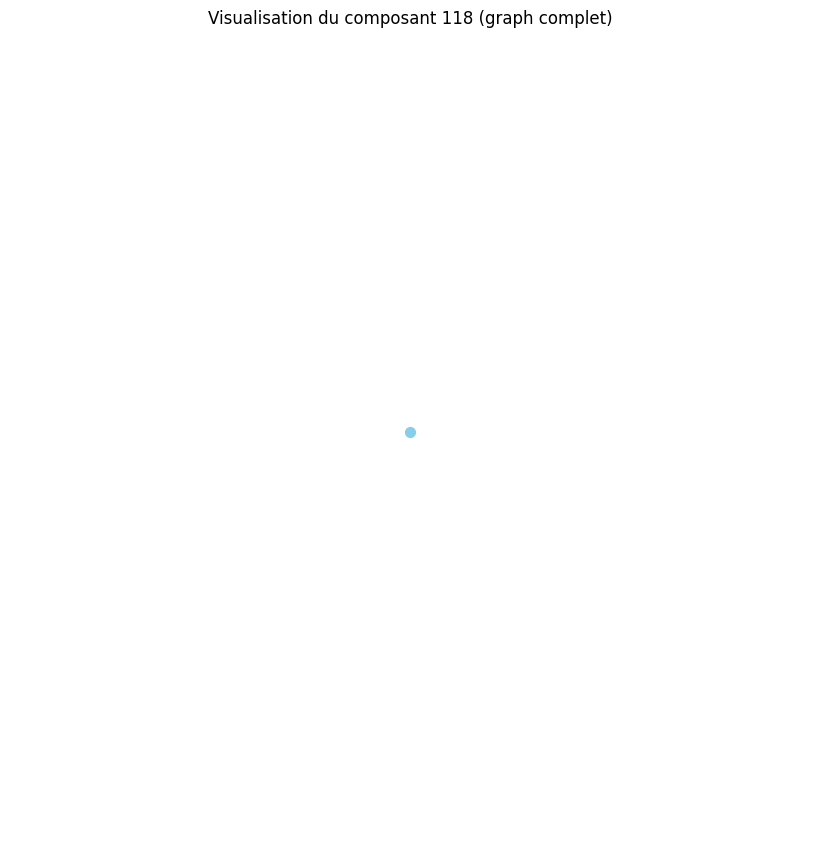

Distance moyenne pour le composant 119 : 0.00
Le composant 119 est un graphe complet ou très densément connecté.
Densité du composant 119 : 0.00
Degré moyen du composant 119 : 0.00
Coefficient de clustering moyen du composant 119 : 0.00


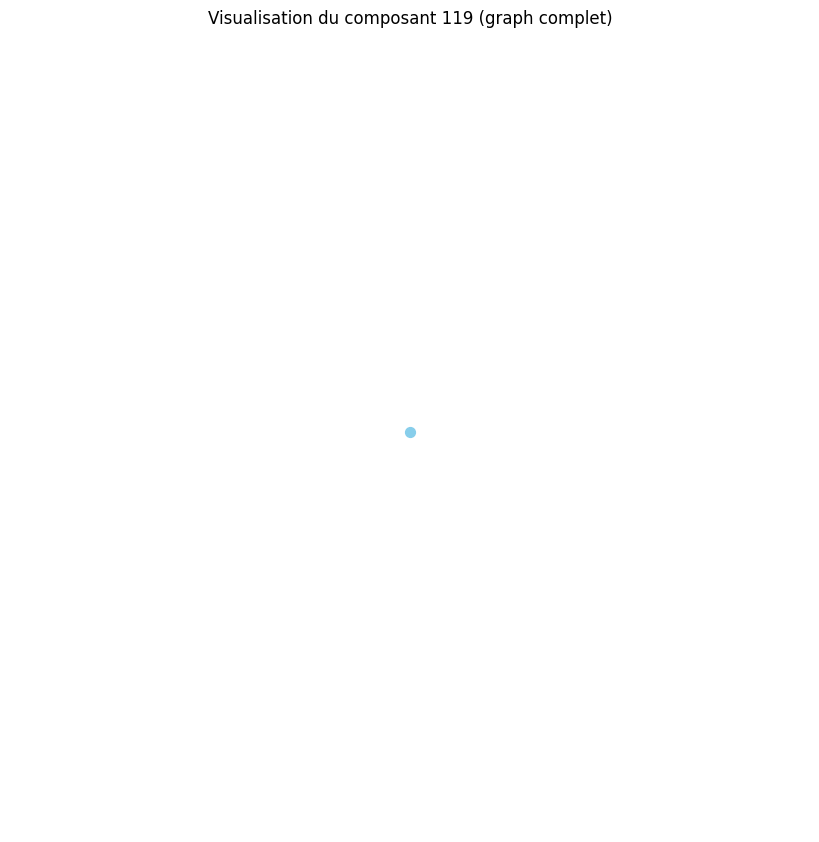

Distance moyenne pour le composant 120 : 0.00
Le composant 120 est un graphe complet ou très densément connecté.
Densité du composant 120 : 0.00
Degré moyen du composant 120 : 0.00
Coefficient de clustering moyen du composant 120 : 0.00


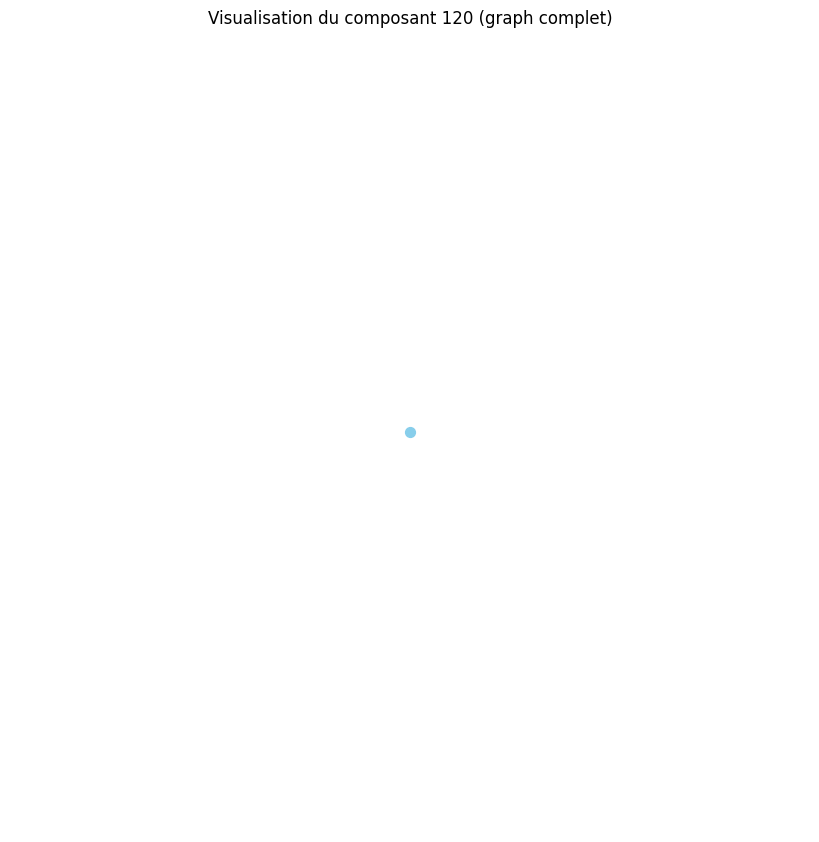

Distance moyenne pour le composant 121 : 0.00
Le composant 121 est un graphe complet ou très densément connecté.
Densité du composant 121 : 0.00
Degré moyen du composant 121 : 0.00
Coefficient de clustering moyen du composant 121 : 0.00


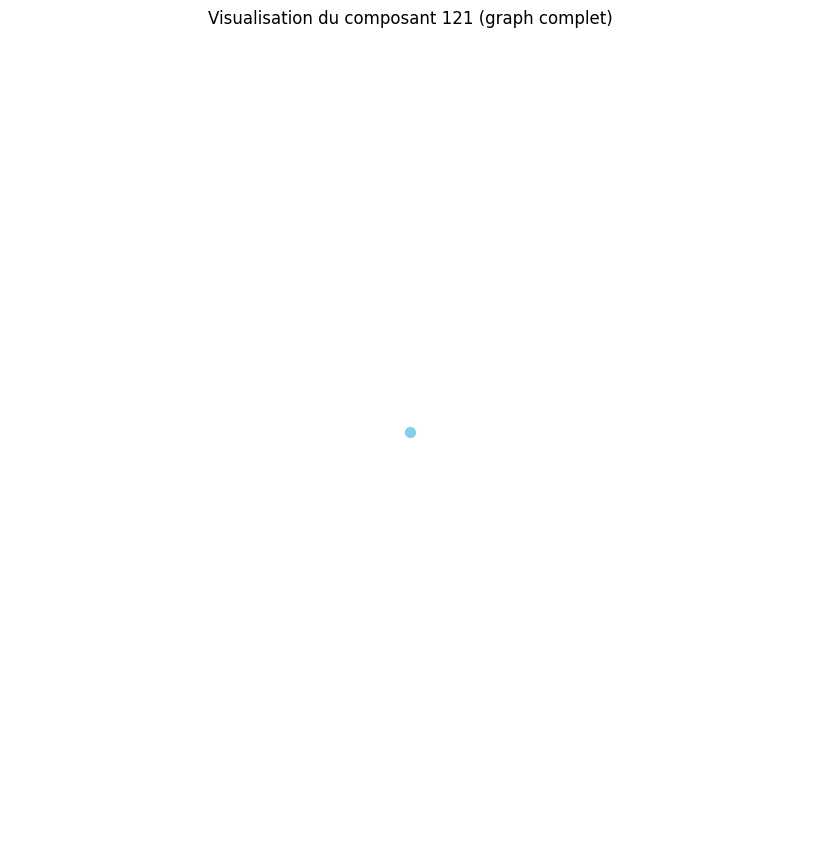

Distance moyenne pour le composant 122 : 0.00
Le composant 122 est un graphe complet ou très densément connecté.
Densité du composant 122 : 0.00
Degré moyen du composant 122 : 0.00
Coefficient de clustering moyen du composant 122 : 0.00


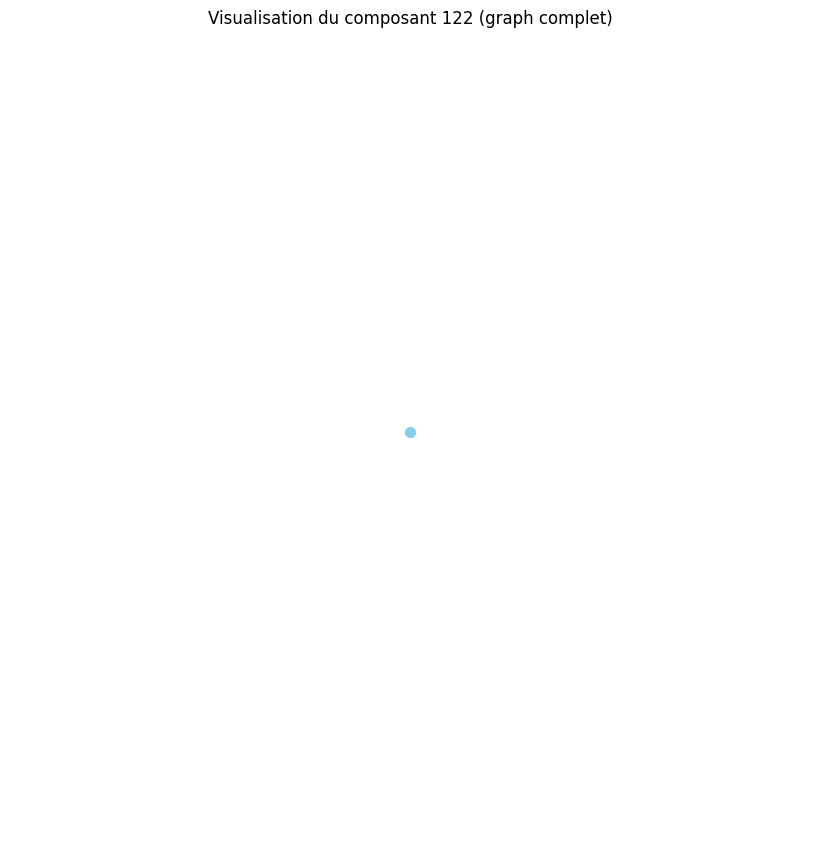

Distance moyenne pour le composant 123 : 0.00
Le composant 123 est un graphe complet ou très densément connecté.
Densité du composant 123 : 0.00
Degré moyen du composant 123 : 0.00
Coefficient de clustering moyen du composant 123 : 0.00


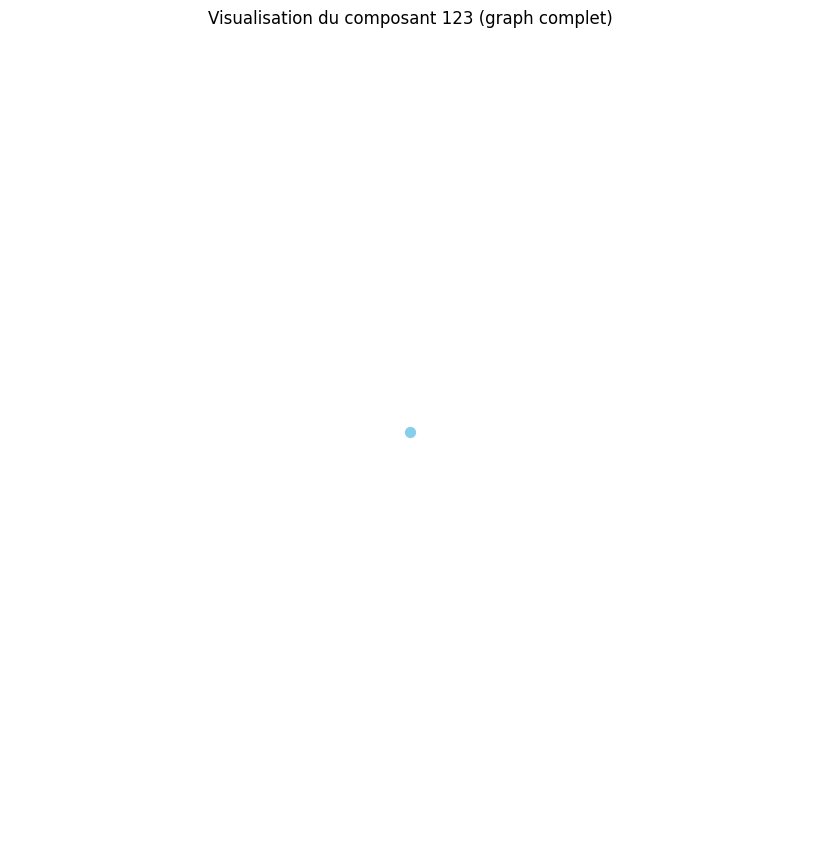

Distance moyenne pour le composant 124 : 0.00
Le composant 124 est un graphe complet ou très densément connecté.
Densité du composant 124 : 0.00
Degré moyen du composant 124 : 0.00
Coefficient de clustering moyen du composant 124 : 0.00


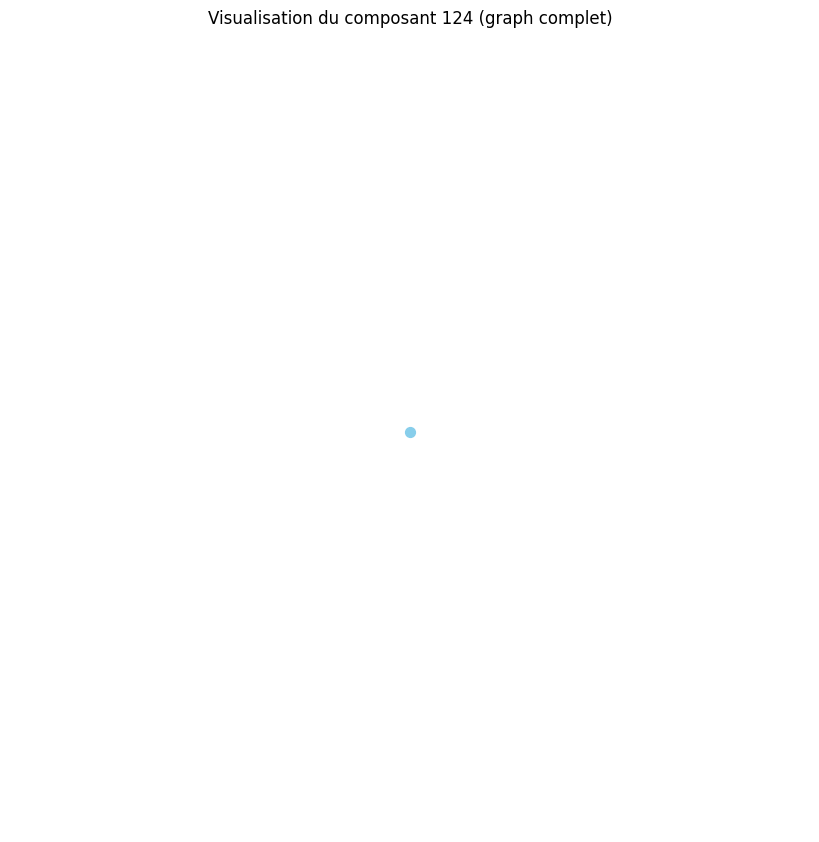

Distance moyenne pour le composant 125 : 1.00
Distance moyenne pour le composant 126 : 0.00
Le composant 126 est un graphe complet ou très densément connecté.
Densité du composant 126 : 0.00
Degré moyen du composant 126 : 0.00
Coefficient de clustering moyen du composant 126 : 0.00


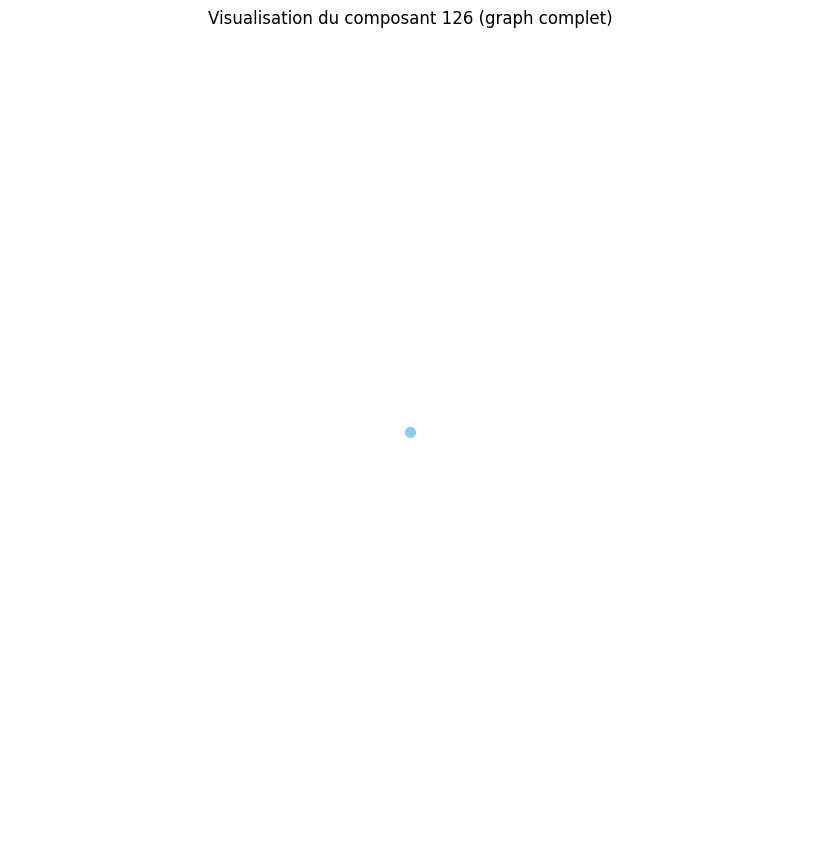

Distance moyenne pour le composant 127 : 0.00
Le composant 127 est un graphe complet ou très densément connecté.
Densité du composant 127 : 0.00
Degré moyen du composant 127 : 0.00
Coefficient de clustering moyen du composant 127 : 0.00


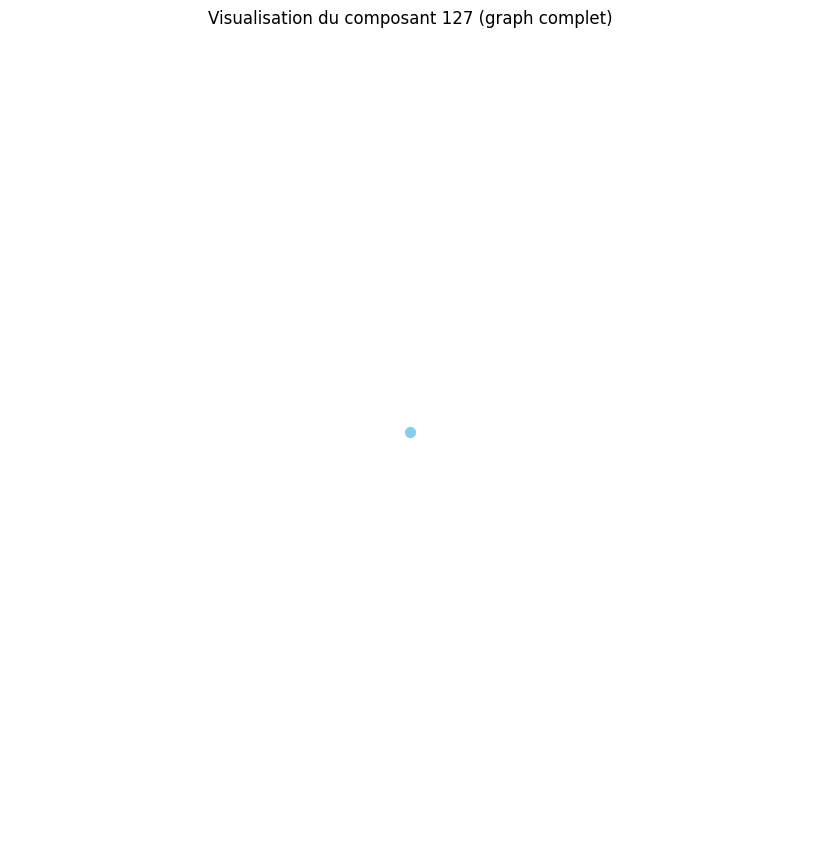

Distance moyenne pour le composant 128 : 0.00
Le composant 128 est un graphe complet ou très densément connecté.
Densité du composant 128 : 0.00
Degré moyen du composant 128 : 0.00
Coefficient de clustering moyen du composant 128 : 0.00


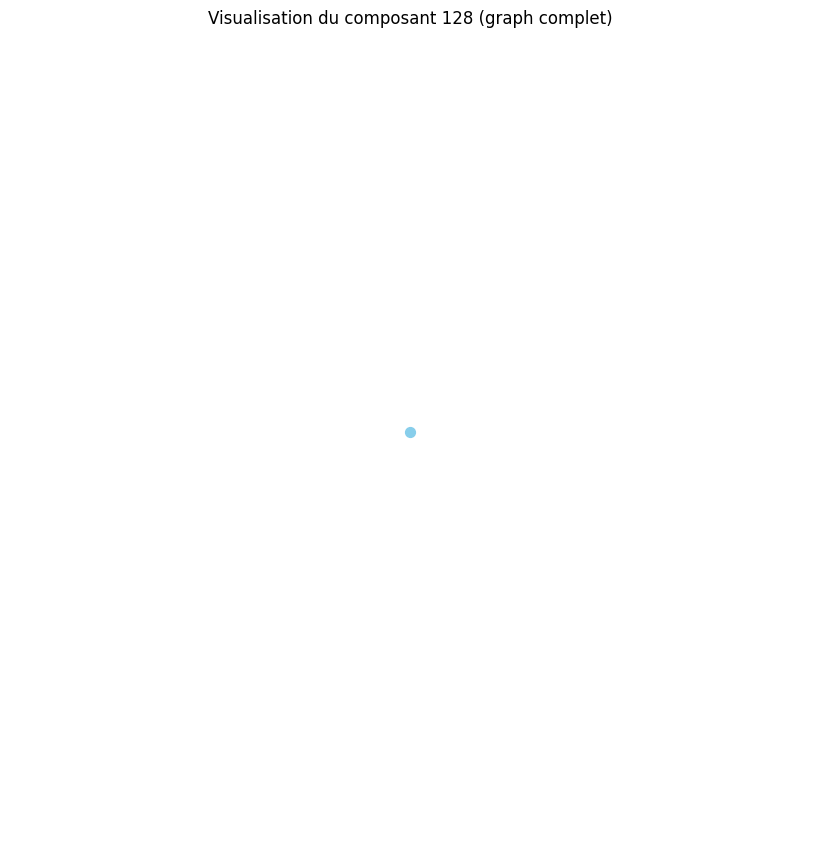

Distance moyenne pour le composant 129 : 0.00
Le composant 129 est un graphe complet ou très densément connecté.
Densité du composant 129 : 0.00
Degré moyen du composant 129 : 0.00
Coefficient de clustering moyen du composant 129 : 0.00


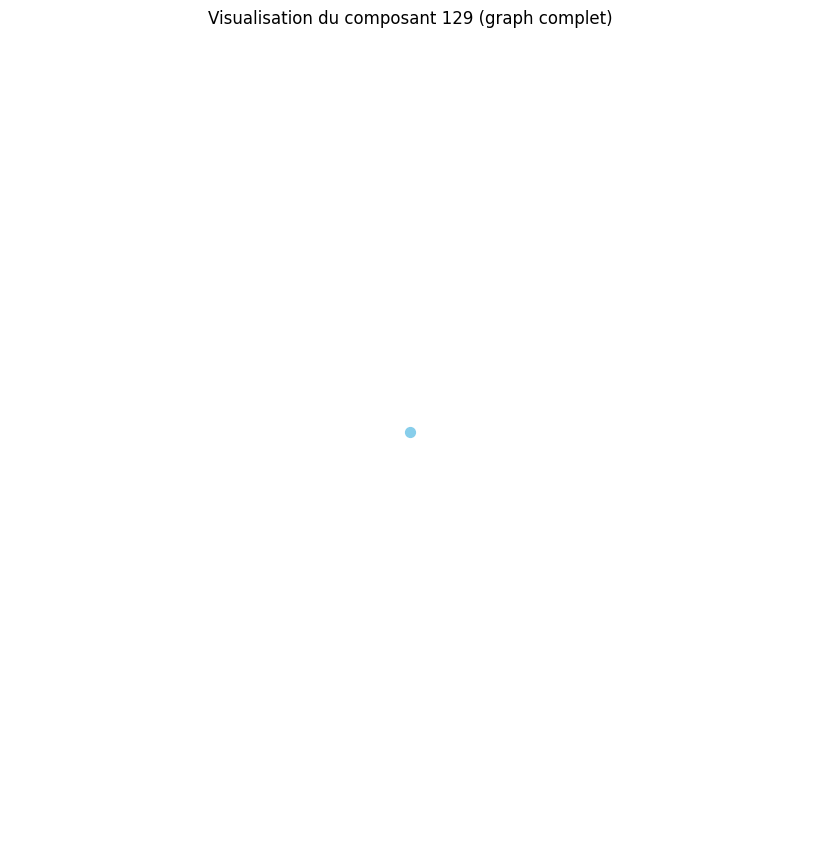

Distance moyenne pour le composant 130 : 0.00
Le composant 130 est un graphe complet ou très densément connecté.
Densité du composant 130 : 0.00
Degré moyen du composant 130 : 0.00
Coefficient de clustering moyen du composant 130 : 0.00


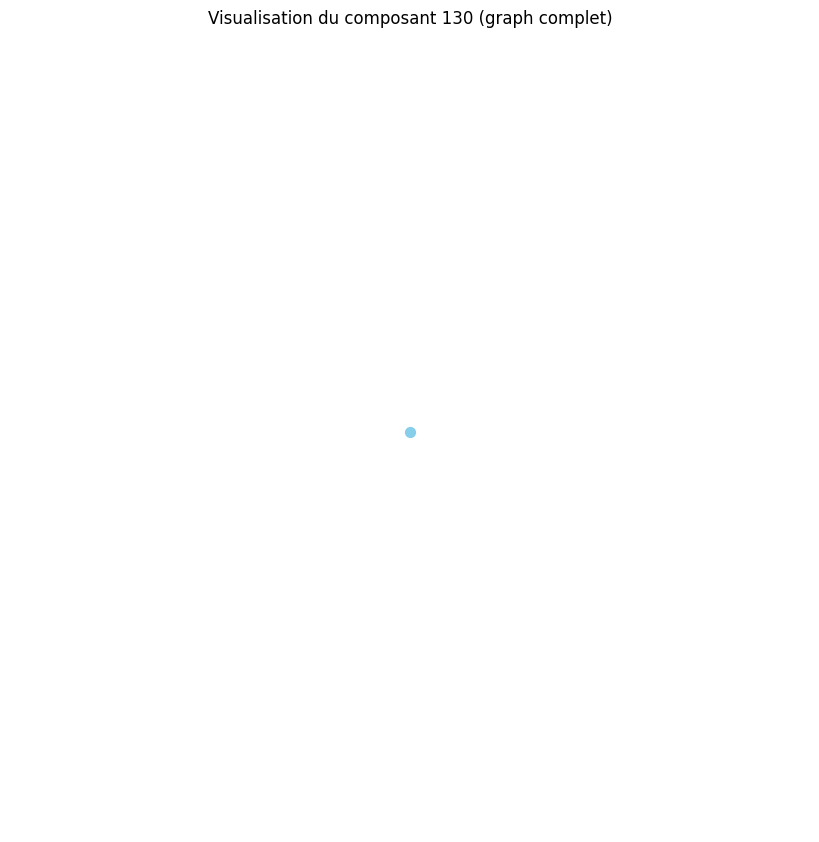

Distance moyenne pour le composant 131 : 0.00
Le composant 131 est un graphe complet ou très densément connecté.
Densité du composant 131 : 0.00
Degré moyen du composant 131 : 0.00
Coefficient de clustering moyen du composant 131 : 0.00


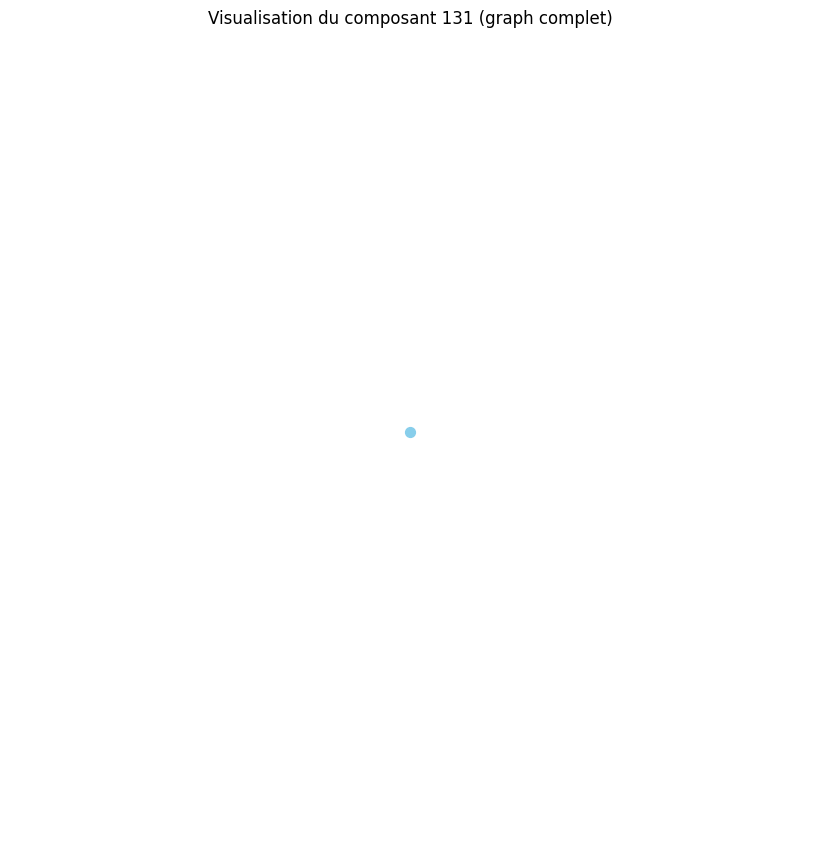

Distance moyenne pour le composant 132 : 0.00
Le composant 132 est un graphe complet ou très densément connecté.
Densité du composant 132 : 0.00
Degré moyen du composant 132 : 0.00
Coefficient de clustering moyen du composant 132 : 0.00


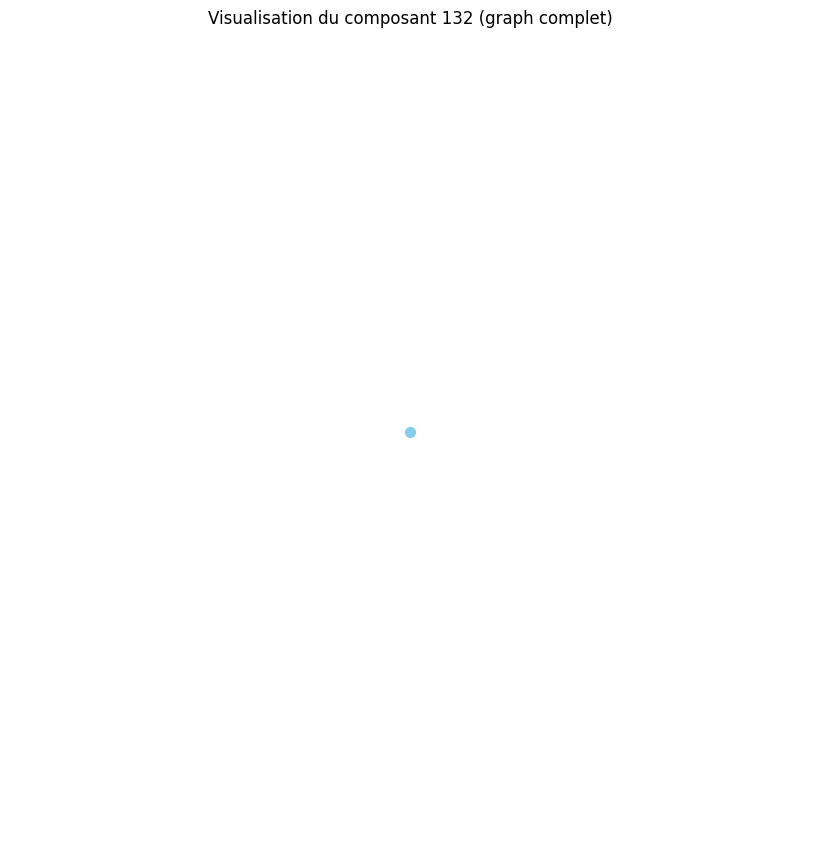

Distance moyenne pour le composant 133 : 0.00
Le composant 133 est un graphe complet ou très densément connecté.
Densité du composant 133 : 0.00
Degré moyen du composant 133 : 0.00
Coefficient de clustering moyen du composant 133 : 0.00


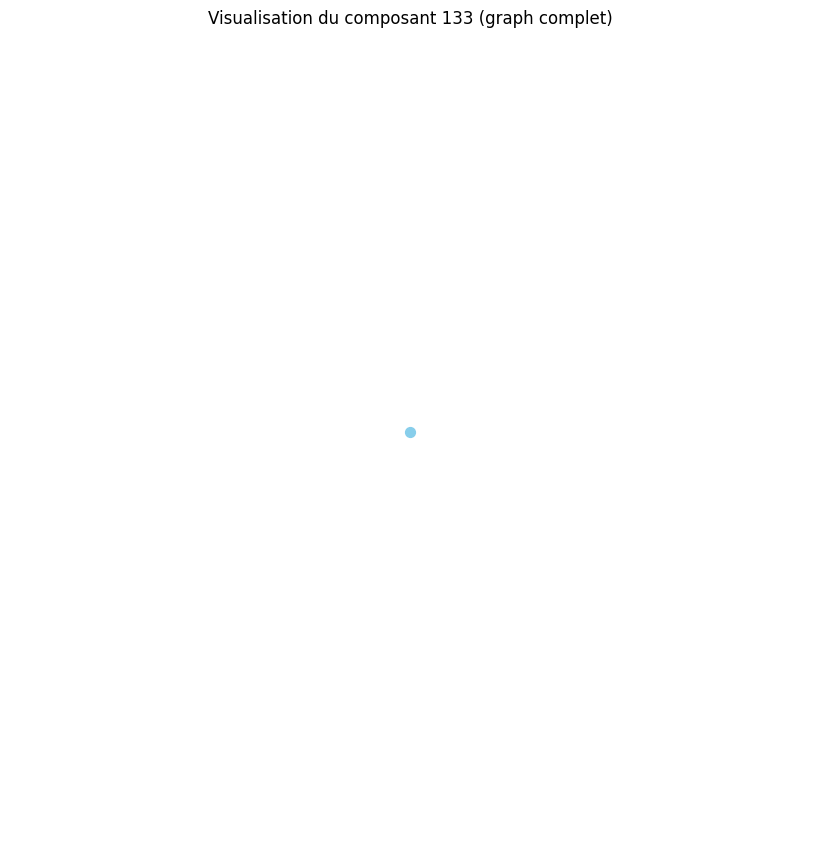

Distance moyenne pour le composant 134 : 0.00
Le composant 134 est un graphe complet ou très densément connecté.
Densité du composant 134 : 0.00
Degré moyen du composant 134 : 0.00
Coefficient de clustering moyen du composant 134 : 0.00


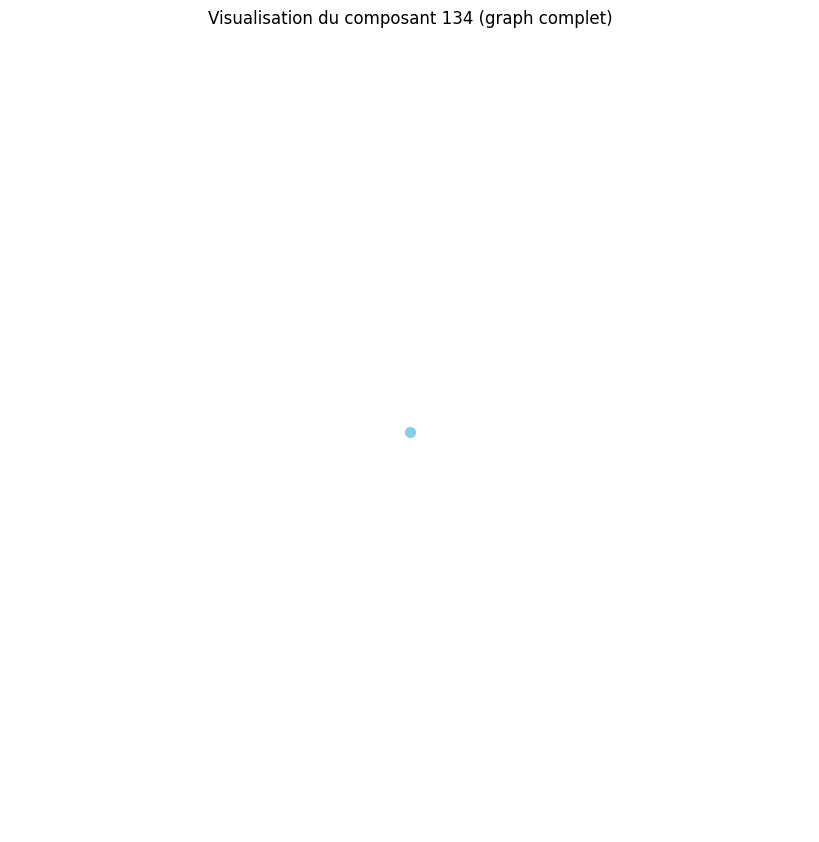

Distance moyenne pour le composant 135 : 0.00
Le composant 135 est un graphe complet ou très densément connecté.
Densité du composant 135 : 0.00
Degré moyen du composant 135 : 0.00
Coefficient de clustering moyen du composant 135 : 0.00


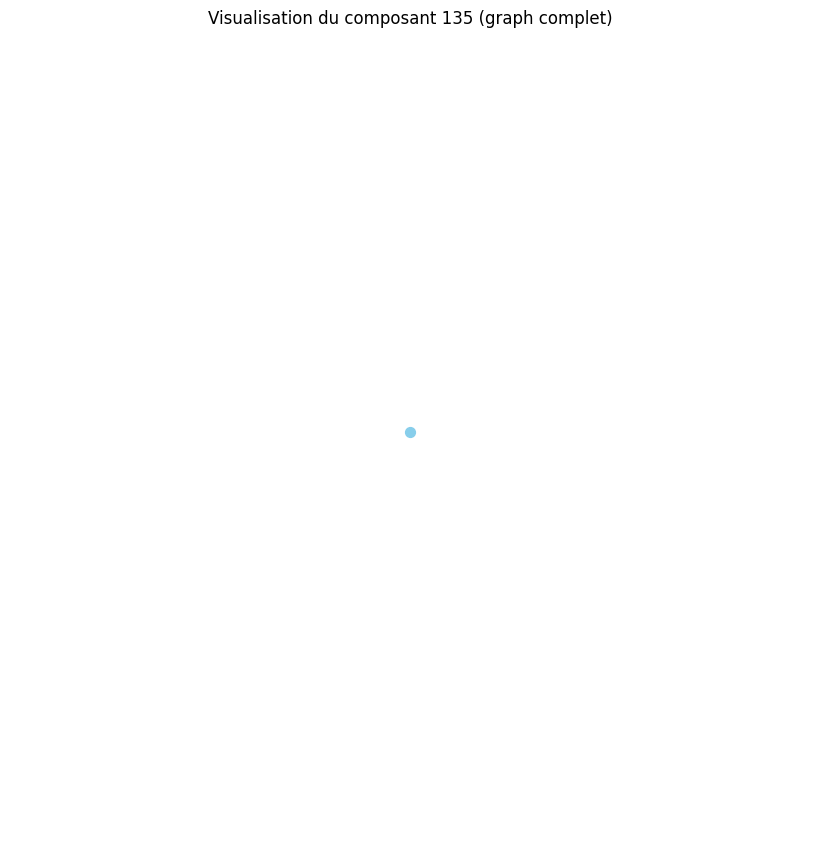

Distance moyenne pour le composant 136 : 0.00
Le composant 136 est un graphe complet ou très densément connecté.
Densité du composant 136 : 0.00
Degré moyen du composant 136 : 0.00
Coefficient de clustering moyen du composant 136 : 0.00


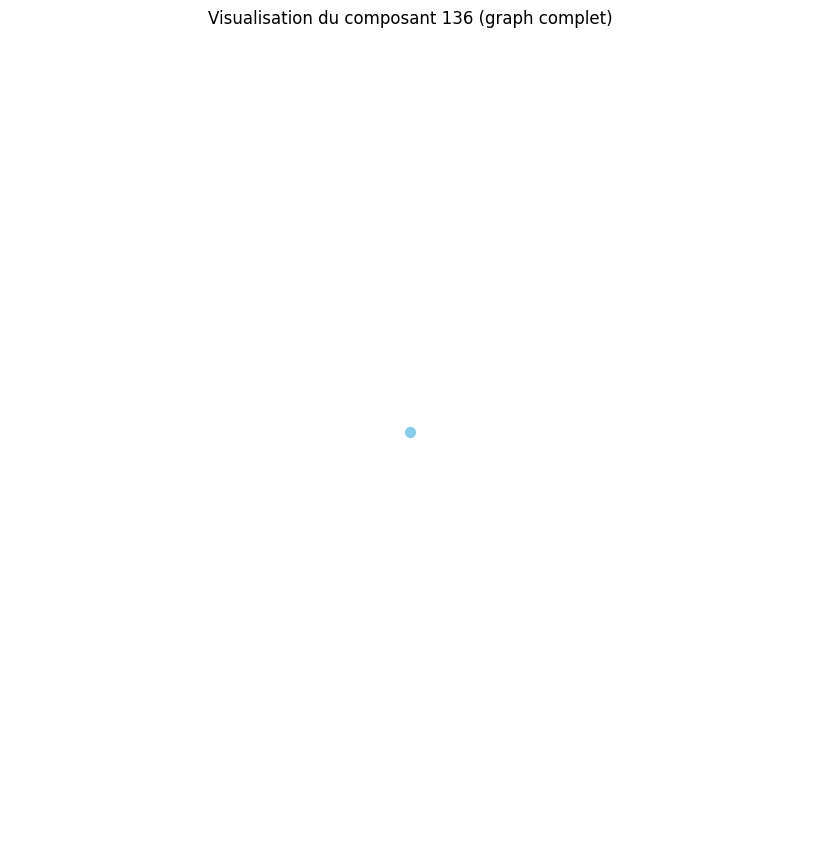

Distance moyenne pour le composant 137 : 0.00
Le composant 137 est un graphe complet ou très densément connecté.
Densité du composant 137 : 0.00
Degré moyen du composant 137 : 0.00
Coefficient de clustering moyen du composant 137 : 0.00


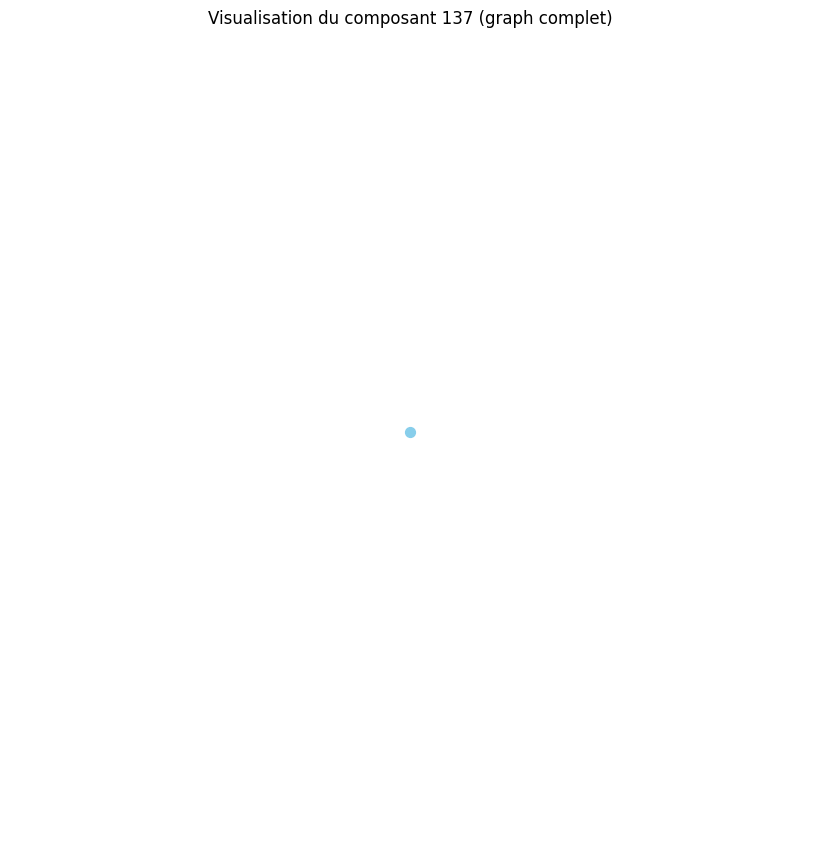

Distance moyenne pour le composant 138 : 0.00
Le composant 138 est un graphe complet ou très densément connecté.
Densité du composant 138 : 0.00
Degré moyen du composant 138 : 0.00
Coefficient de clustering moyen du composant 138 : 0.00


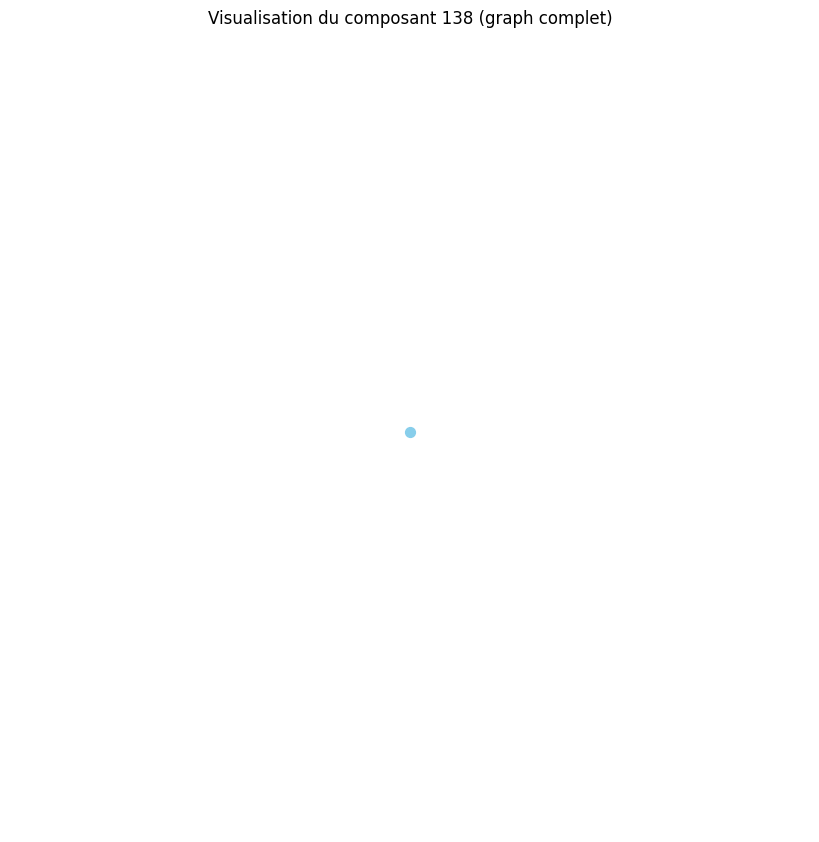

Distance moyenne pour le composant 139 : 0.00
Le composant 139 est un graphe complet ou très densément connecté.
Densité du composant 139 : 0.00
Degré moyen du composant 139 : 0.00
Coefficient de clustering moyen du composant 139 : 0.00


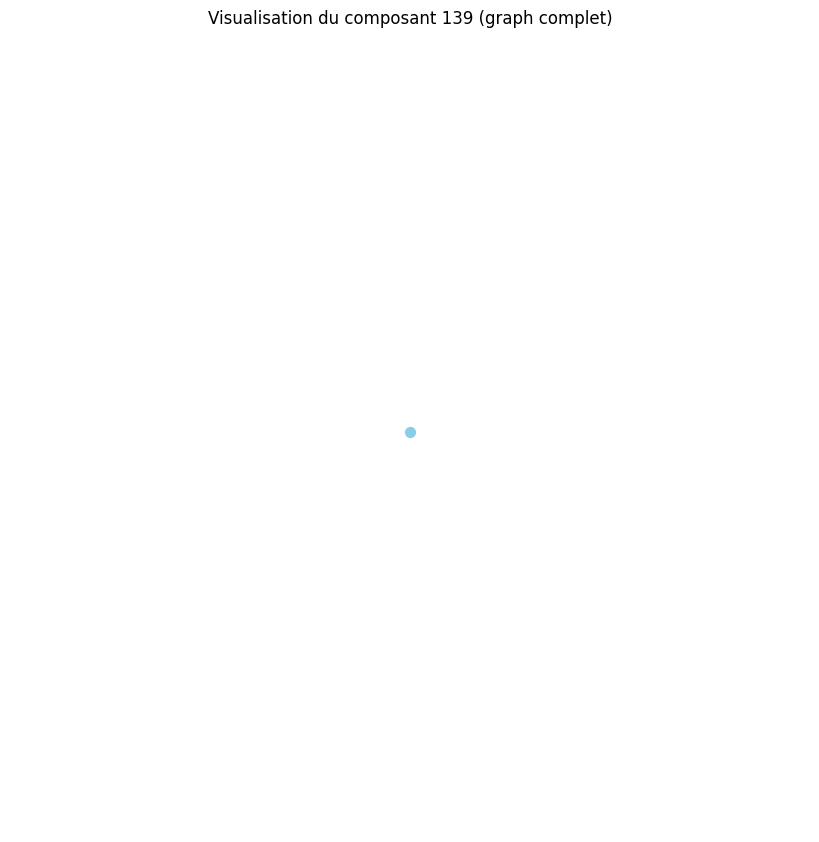

Distance moyenne pour le composant 140 : 0.00
Le composant 140 est un graphe complet ou très densément connecté.
Densité du composant 140 : 0.00
Degré moyen du composant 140 : 0.00
Coefficient de clustering moyen du composant 140 : 0.00


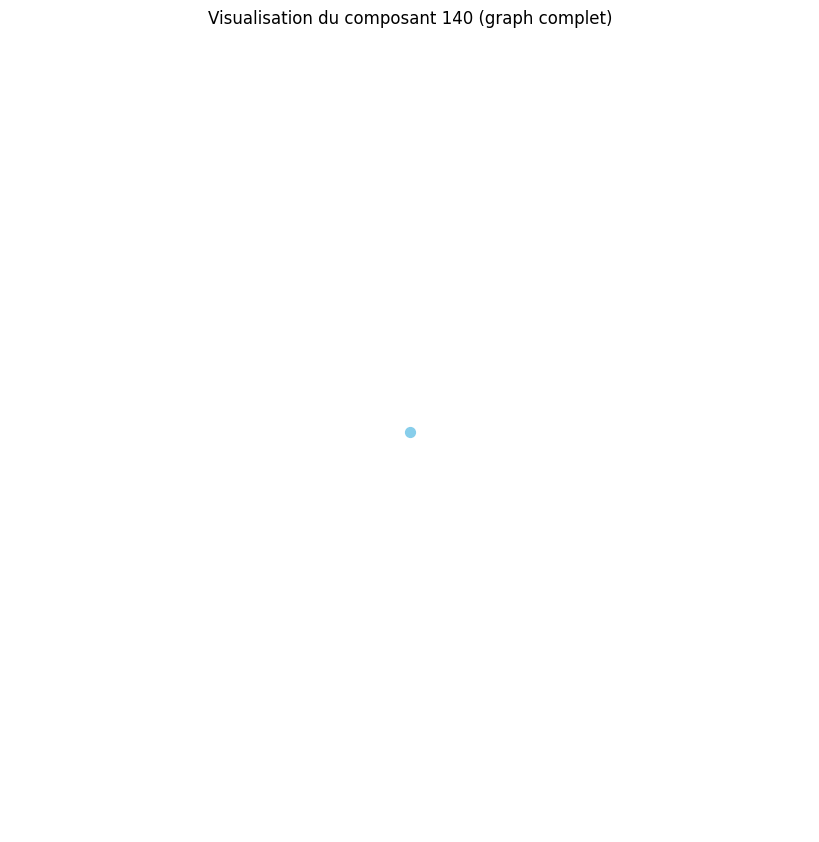

Distance moyenne pour le composant 141 : 0.00
Le composant 141 est un graphe complet ou très densément connecté.
Densité du composant 141 : 0.00
Degré moyen du composant 141 : 0.00
Coefficient de clustering moyen du composant 141 : 0.00


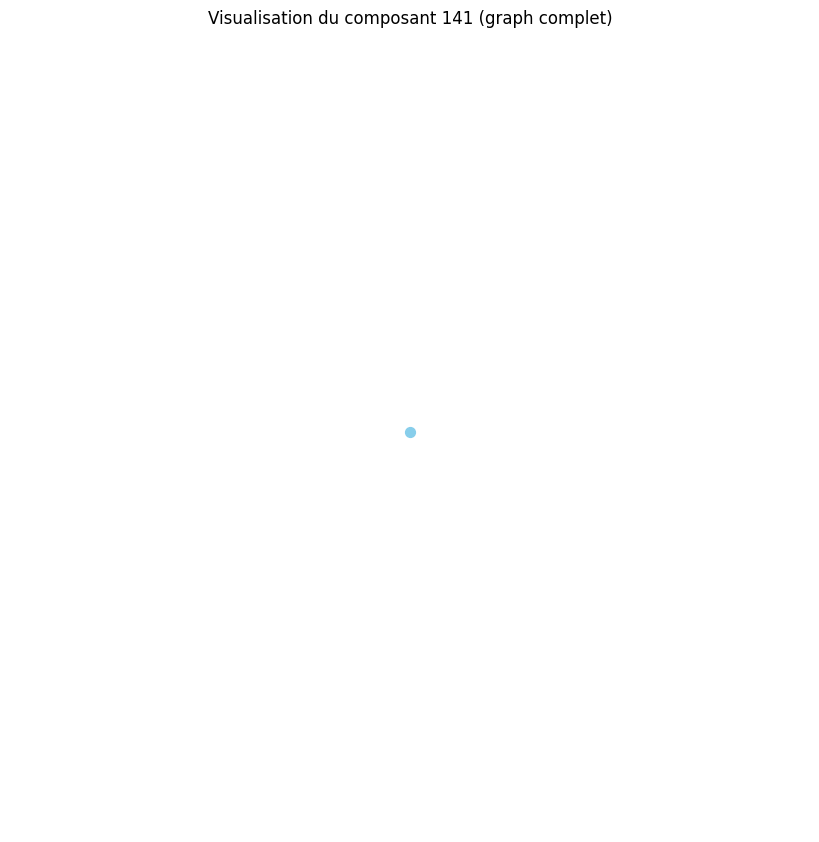

Distance moyenne pour le composant 142 : 0.00
Le composant 142 est un graphe complet ou très densément connecté.
Densité du composant 142 : 0.00
Degré moyen du composant 142 : 0.00
Coefficient de clustering moyen du composant 142 : 0.00


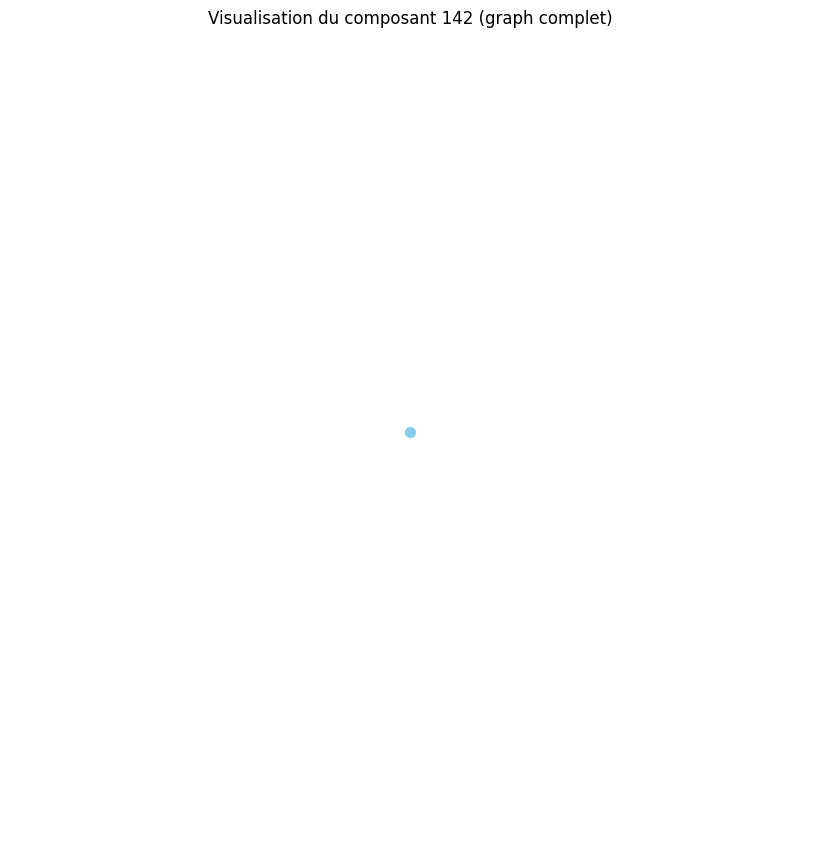

Distance moyenne pour le composant 143 : 0.00
Le composant 143 est un graphe complet ou très densément connecté.
Densité du composant 143 : 0.00
Degré moyen du composant 143 : 0.00
Coefficient de clustering moyen du composant 143 : 0.00


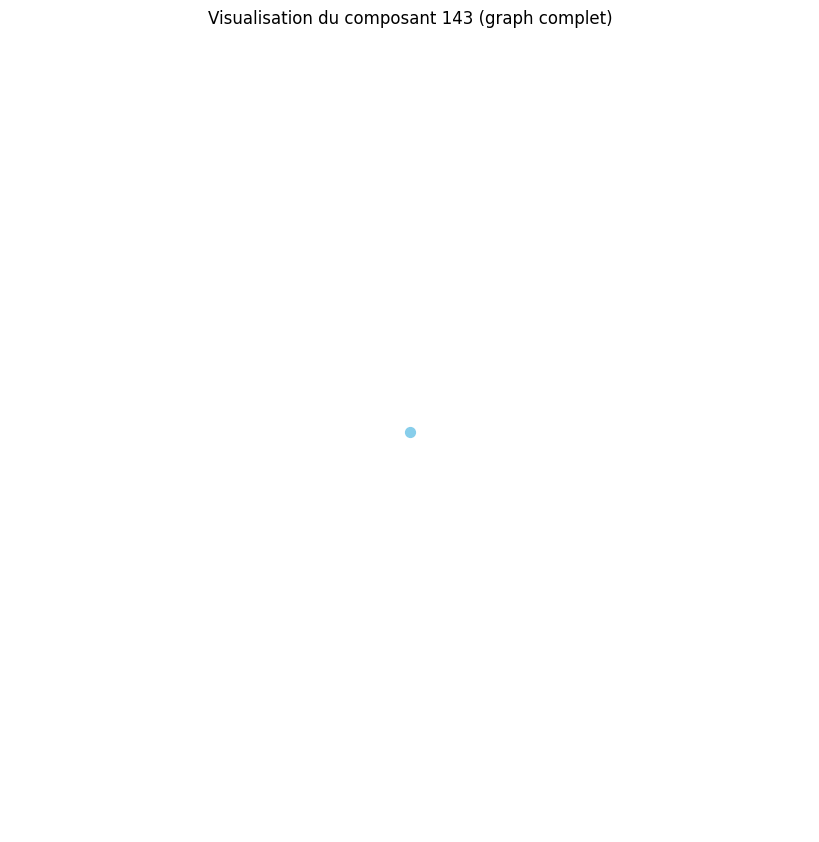

Distance moyenne pour le composant 144 : 0.00
Le composant 144 est un graphe complet ou très densément connecté.
Densité du composant 144 : 0.00
Degré moyen du composant 144 : 0.00
Coefficient de clustering moyen du composant 144 : 0.00


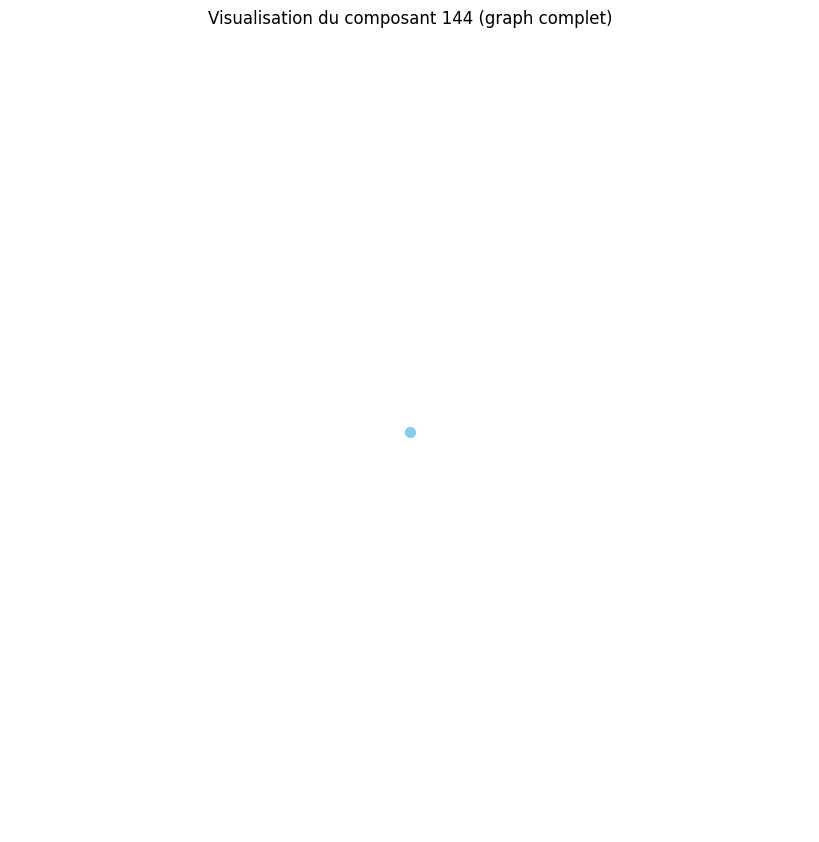

Distance moyenne pour le composant 145 : 0.00
Le composant 145 est un graphe complet ou très densément connecté.
Densité du composant 145 : 0.00
Degré moyen du composant 145 : 0.00
Coefficient de clustering moyen du composant 145 : 0.00


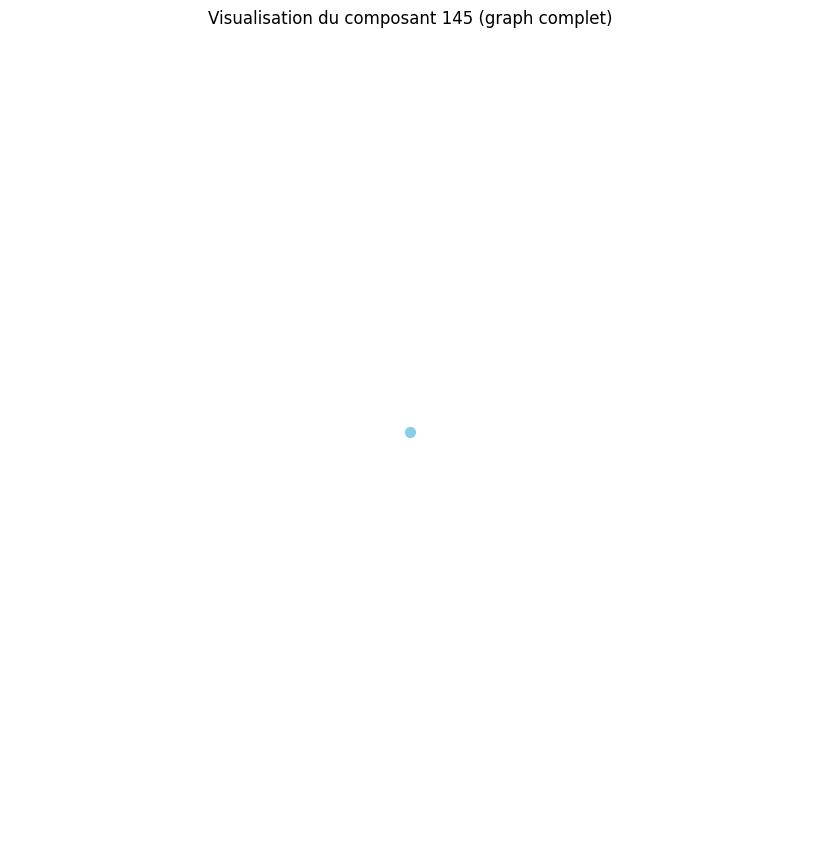

Distance moyenne pour le composant 146 : 0.00
Le composant 146 est un graphe complet ou très densément connecté.
Densité du composant 146 : 0.00
Degré moyen du composant 146 : 0.00
Coefficient de clustering moyen du composant 146 : 0.00


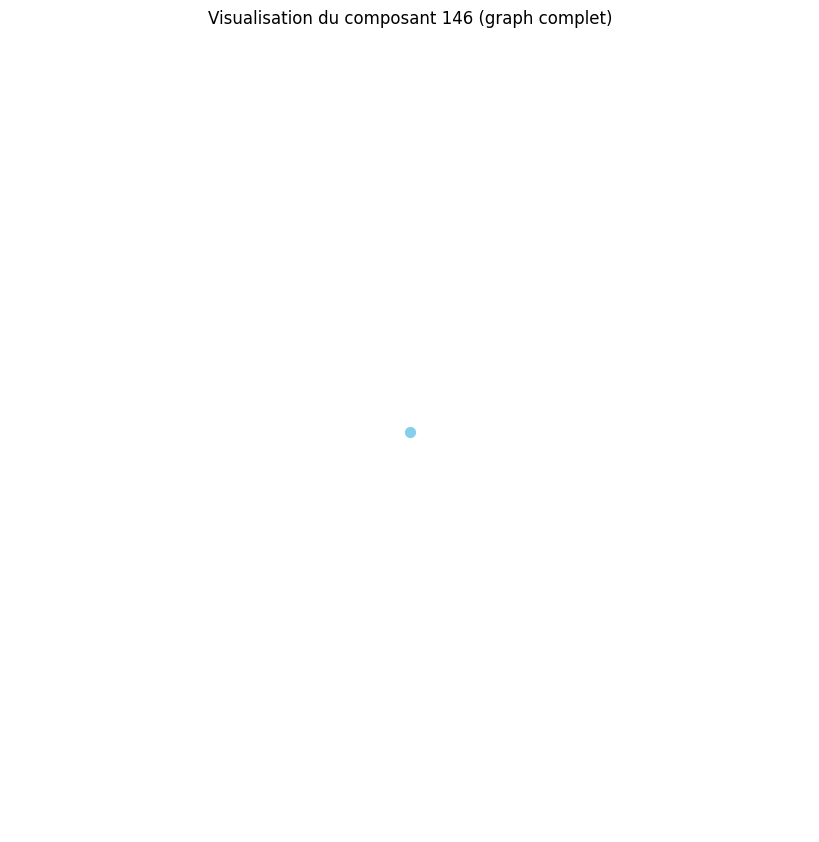

Distance moyenne pour le composant 147 : 0.00
Le composant 147 est un graphe complet ou très densément connecté.
Densité du composant 147 : 0.00
Degré moyen du composant 147 : 0.00
Coefficient de clustering moyen du composant 147 : 0.00


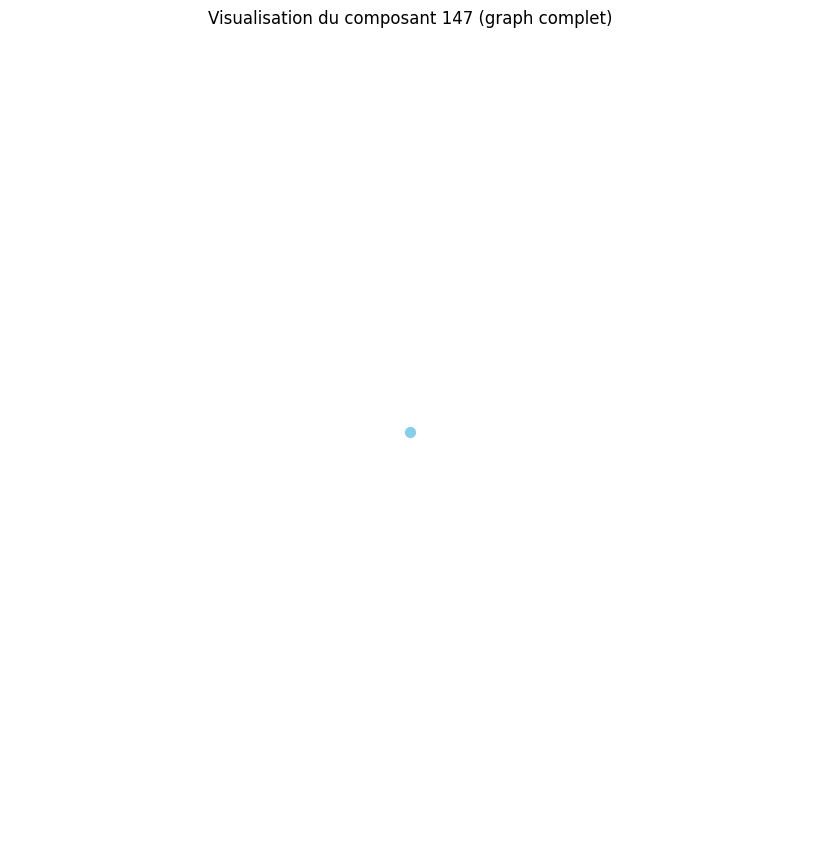

Distance moyenne pour le composant 148 : 0.00
Le composant 148 est un graphe complet ou très densément connecté.
Densité du composant 148 : 0.00
Degré moyen du composant 148 : 0.00
Coefficient de clustering moyen du composant 148 : 0.00


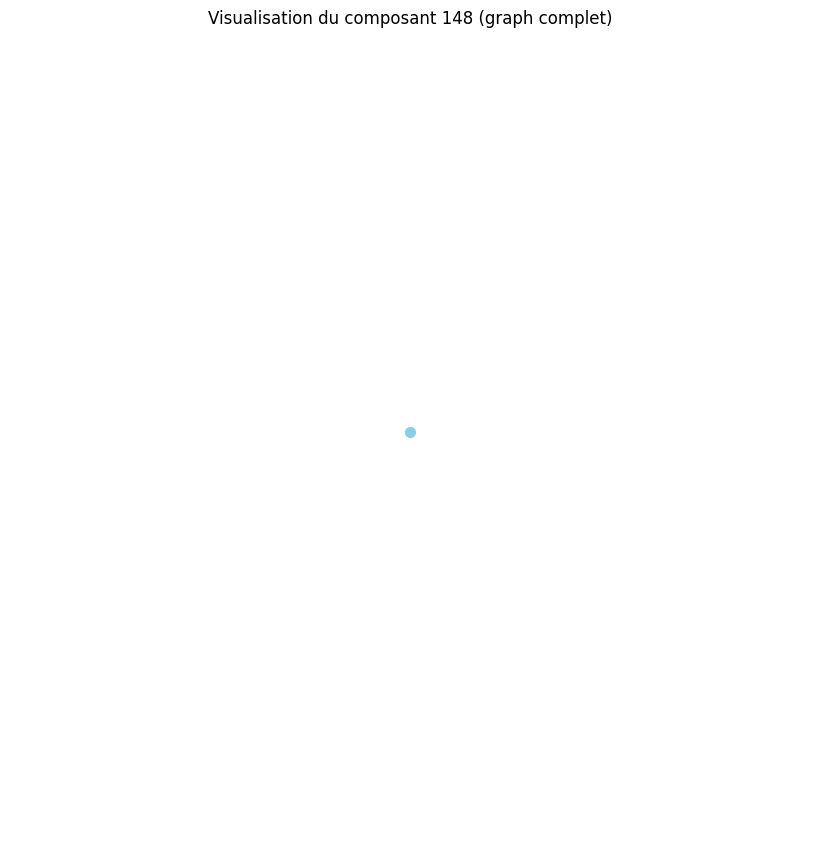

Distance moyenne pour le composant 149 : 0.00
Le composant 149 est un graphe complet ou très densément connecté.
Densité du composant 149 : 0.00
Degré moyen du composant 149 : 0.00
Coefficient de clustering moyen du composant 149 : 0.00


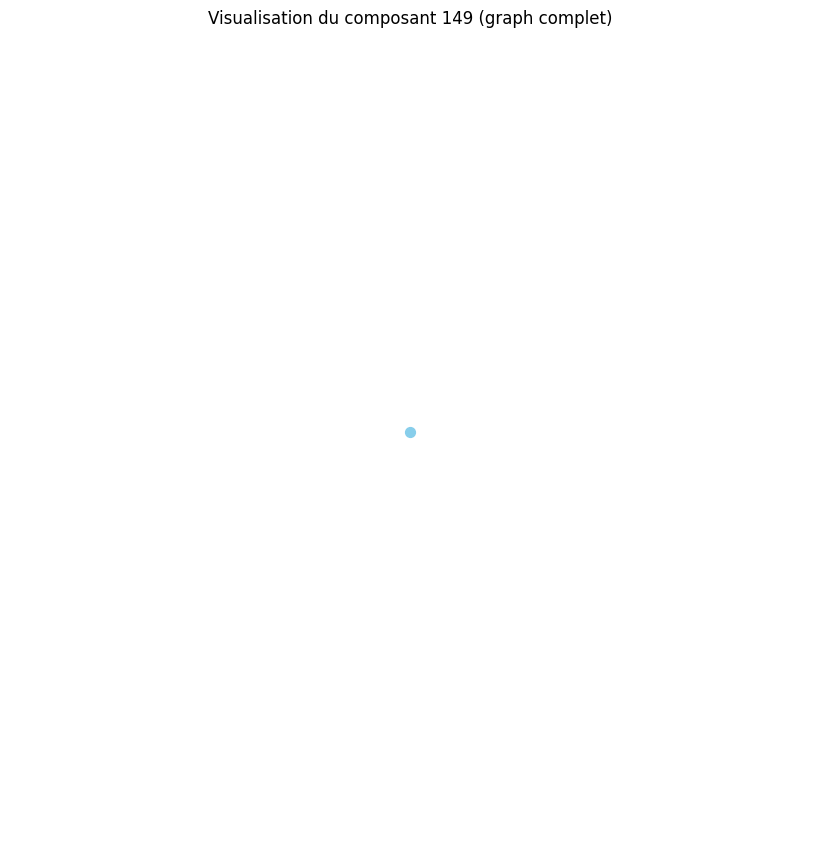

Distance moyenne pour le composant 150 : 0.00
Le composant 150 est un graphe complet ou très densément connecté.
Densité du composant 150 : 0.00
Degré moyen du composant 150 : 0.00
Coefficient de clustering moyen du composant 150 : 0.00


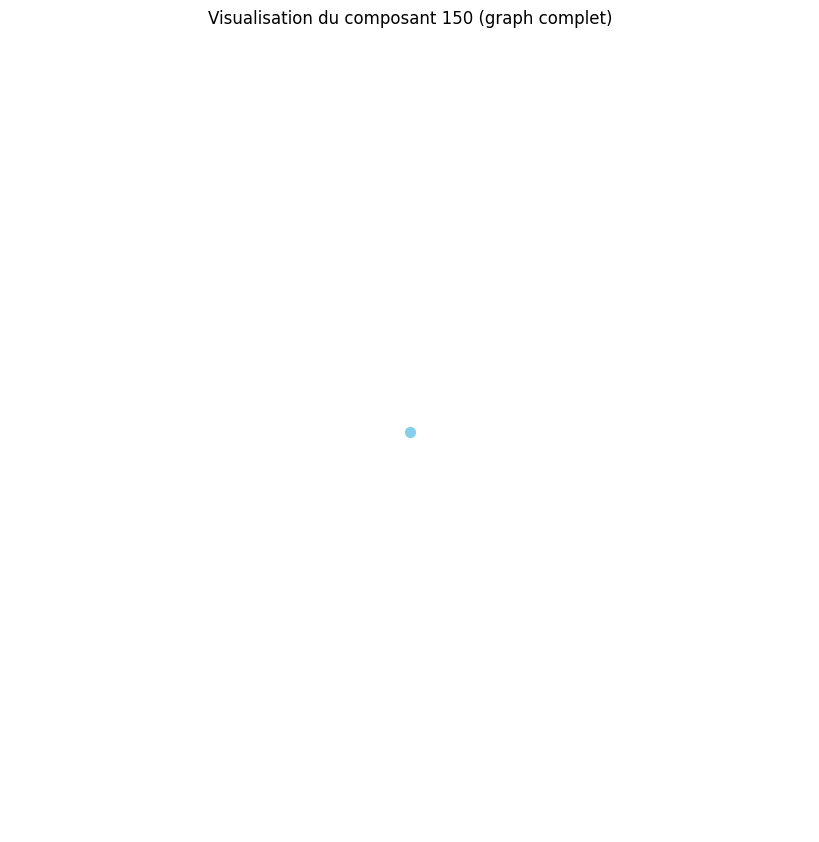

Distance moyenne pour le composant 151 : 0.00
Le composant 151 est un graphe complet ou très densément connecté.
Densité du composant 151 : 0.00
Degré moyen du composant 151 : 0.00
Coefficient de clustering moyen du composant 151 : 0.00


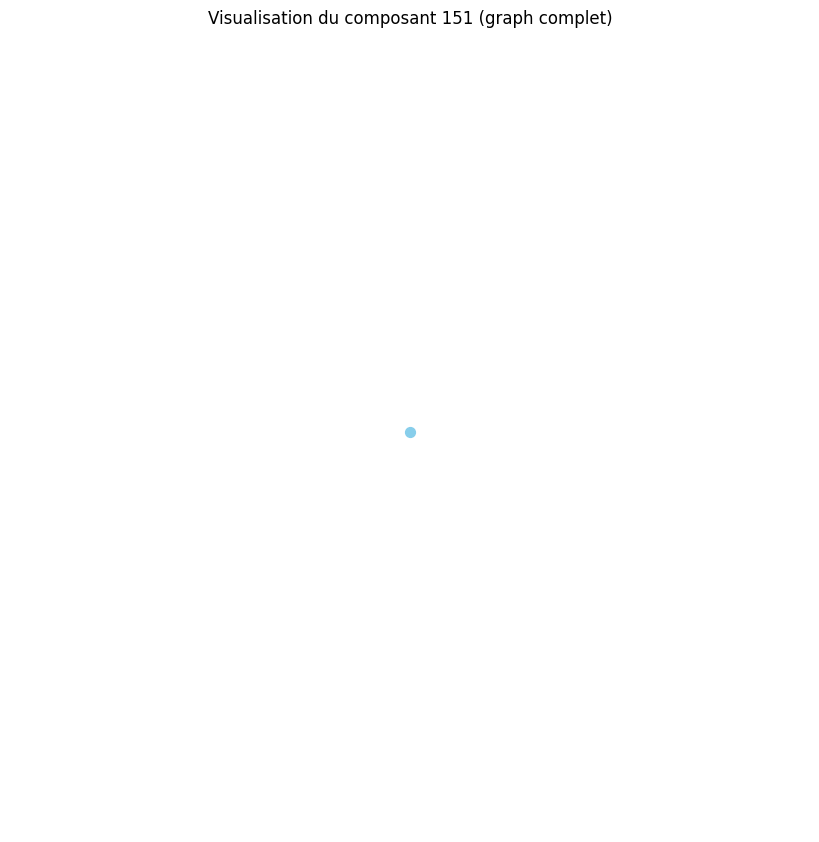

Distance moyenne pour le composant 152 : 0.00
Le composant 152 est un graphe complet ou très densément connecté.
Densité du composant 152 : 0.00
Degré moyen du composant 152 : 0.00
Coefficient de clustering moyen du composant 152 : 0.00


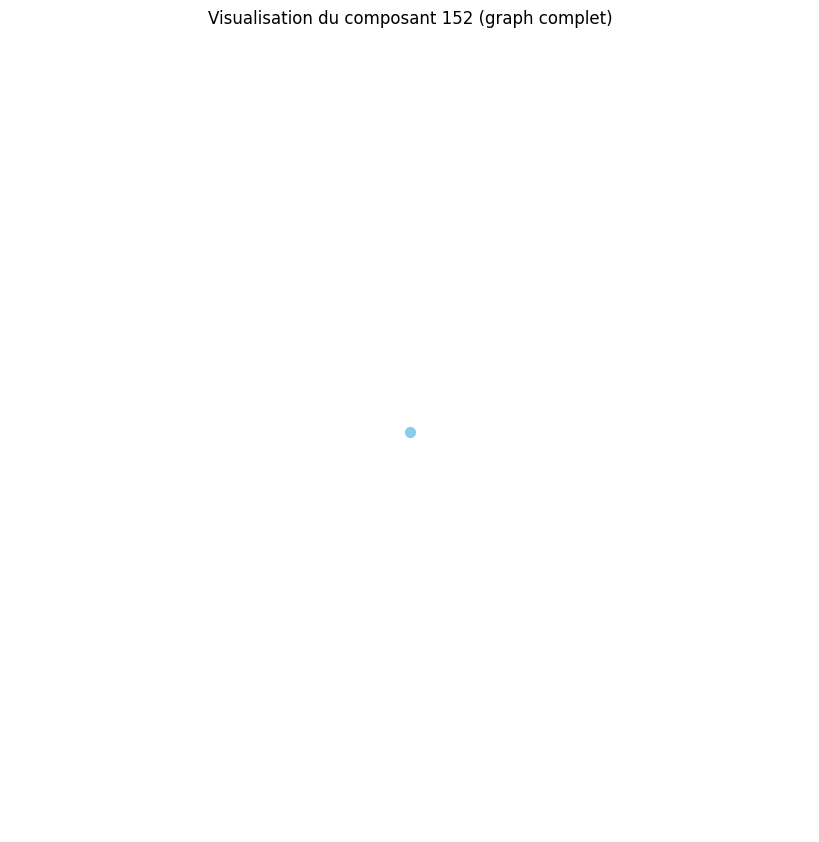

Distance moyenne pour le composant 153 : 0.00
Le composant 153 est un graphe complet ou très densément connecté.
Densité du composant 153 : 0.00
Degré moyen du composant 153 : 0.00
Coefficient de clustering moyen du composant 153 : 0.00


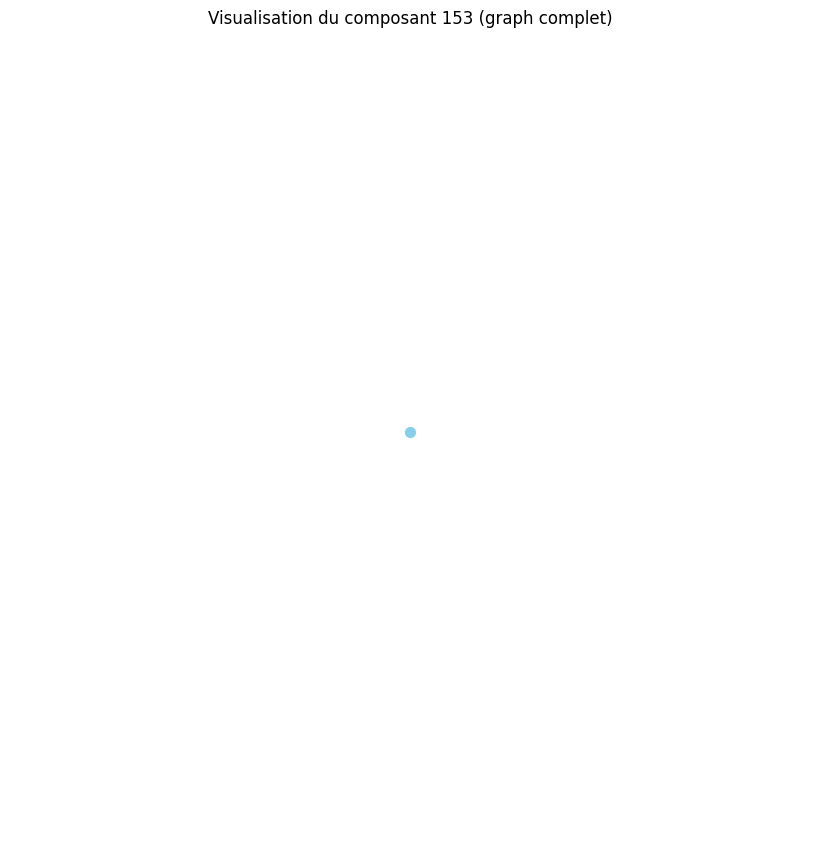

Distance moyenne pour le composant 154 : 0.00
Le composant 154 est un graphe complet ou très densément connecté.
Densité du composant 154 : 0.00
Degré moyen du composant 154 : 0.00
Coefficient de clustering moyen du composant 154 : 0.00


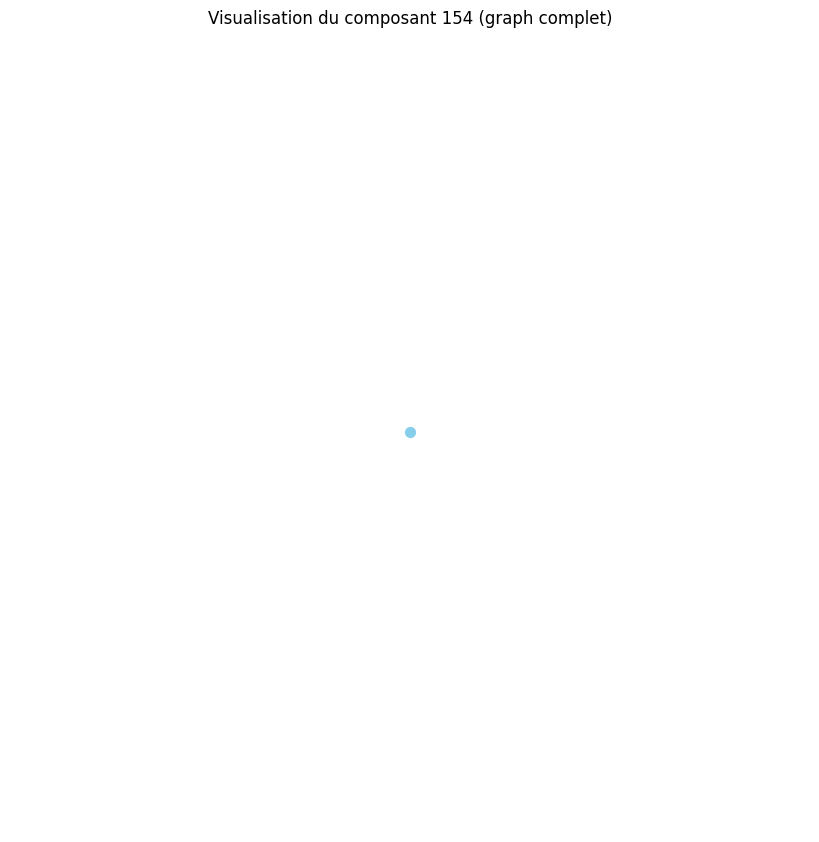

Distance moyenne pour le composant 155 : 0.00
Le composant 155 est un graphe complet ou très densément connecté.
Densité du composant 155 : 0.00
Degré moyen du composant 155 : 0.00
Coefficient de clustering moyen du composant 155 : 0.00


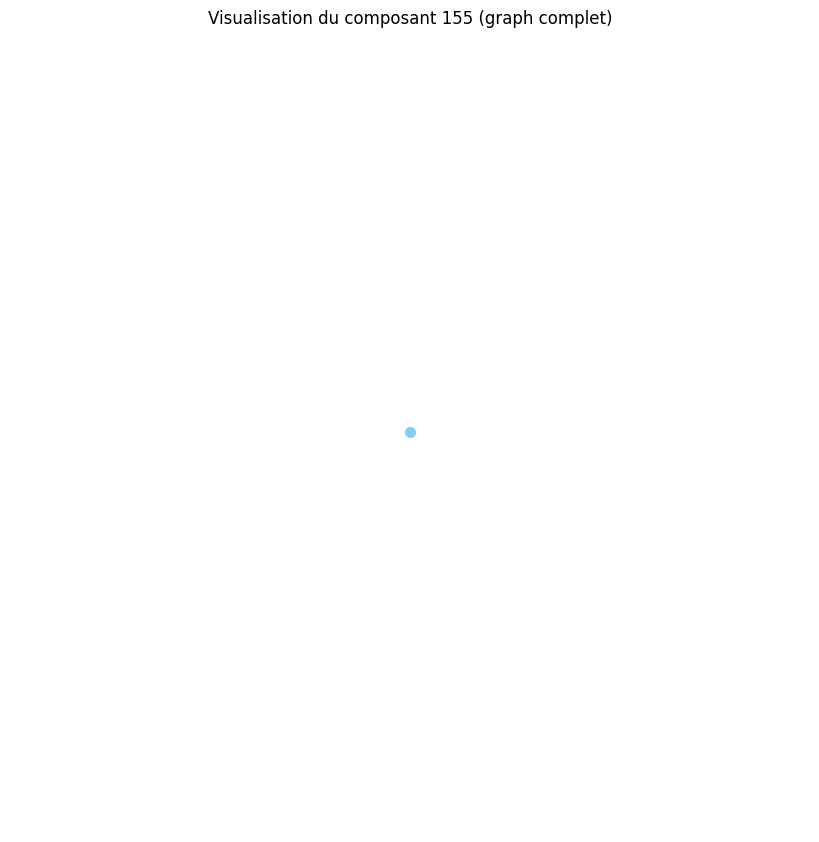

Distance moyenne pour le composant 156 : 0.00
Le composant 156 est un graphe complet ou très densément connecté.
Densité du composant 156 : 0.00
Degré moyen du composant 156 : 0.00
Coefficient de clustering moyen du composant 156 : 0.00


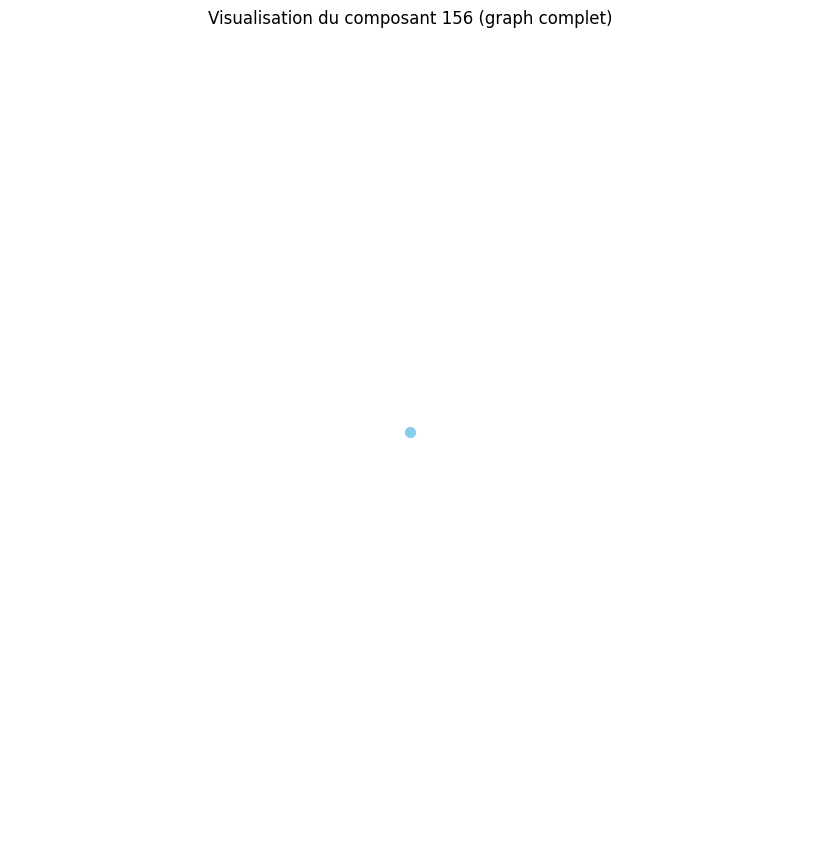

Distance moyenne pour le composant 157 : 0.00
Le composant 157 est un graphe complet ou très densément connecté.
Densité du composant 157 : 0.00
Degré moyen du composant 157 : 0.00
Coefficient de clustering moyen du composant 157 : 0.00


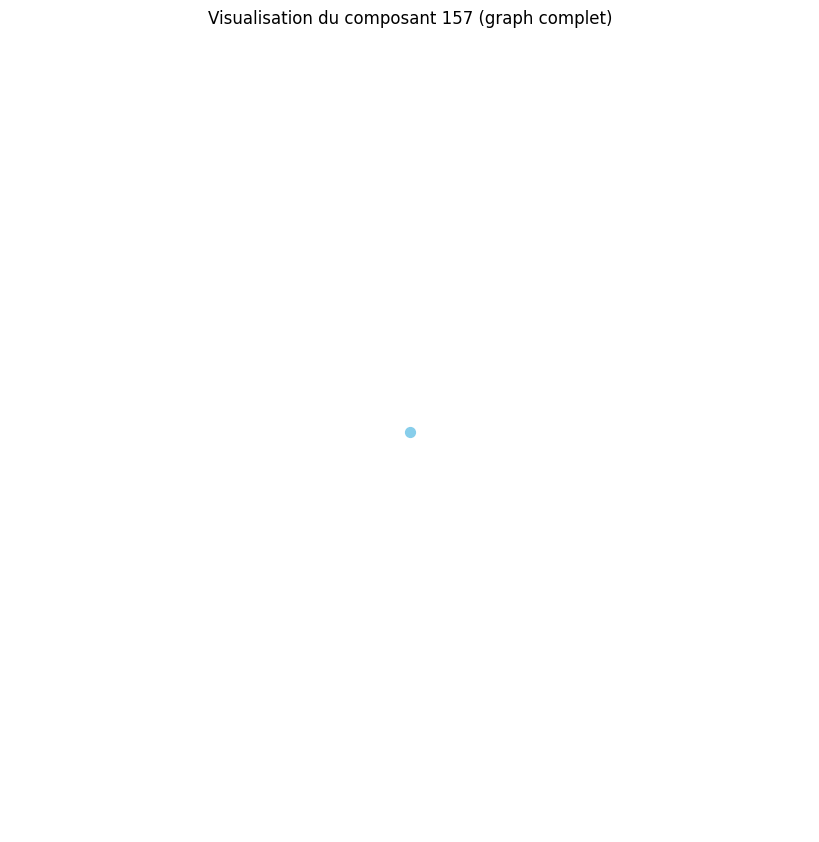

Distance moyenne pour le composant 158 : 0.00
Le composant 158 est un graphe complet ou très densément connecté.
Densité du composant 158 : 0.00
Degré moyen du composant 158 : 0.00
Coefficient de clustering moyen du composant 158 : 0.00


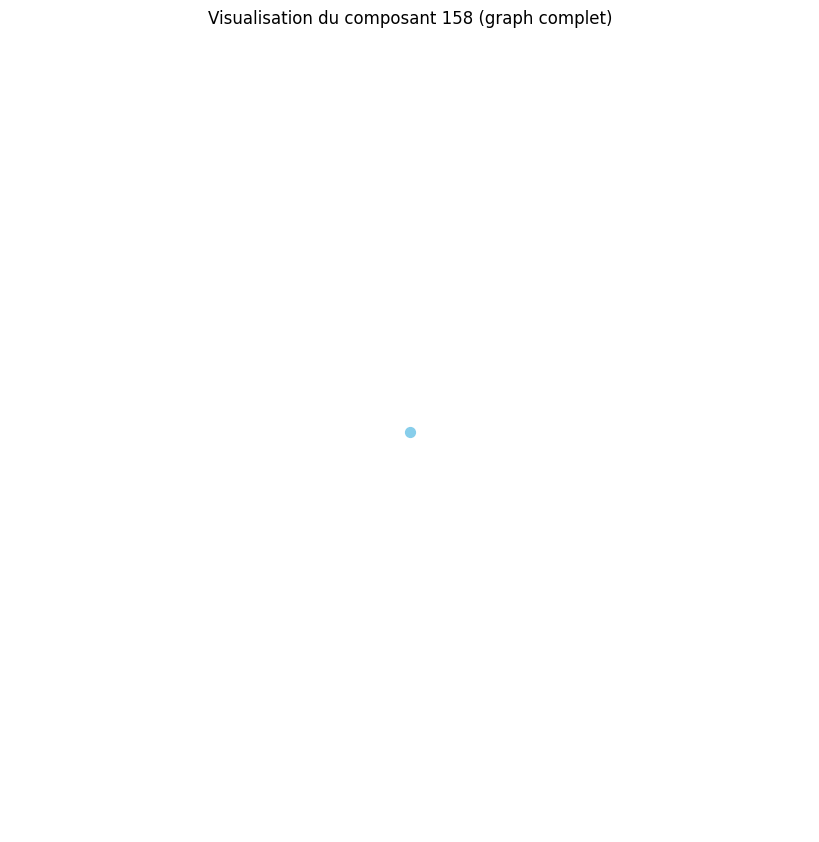

Distance moyenne pour le composant 159 : 0.00
Le composant 159 est un graphe complet ou très densément connecté.
Densité du composant 159 : 0.00
Degré moyen du composant 159 : 0.00
Coefficient de clustering moyen du composant 159 : 0.00


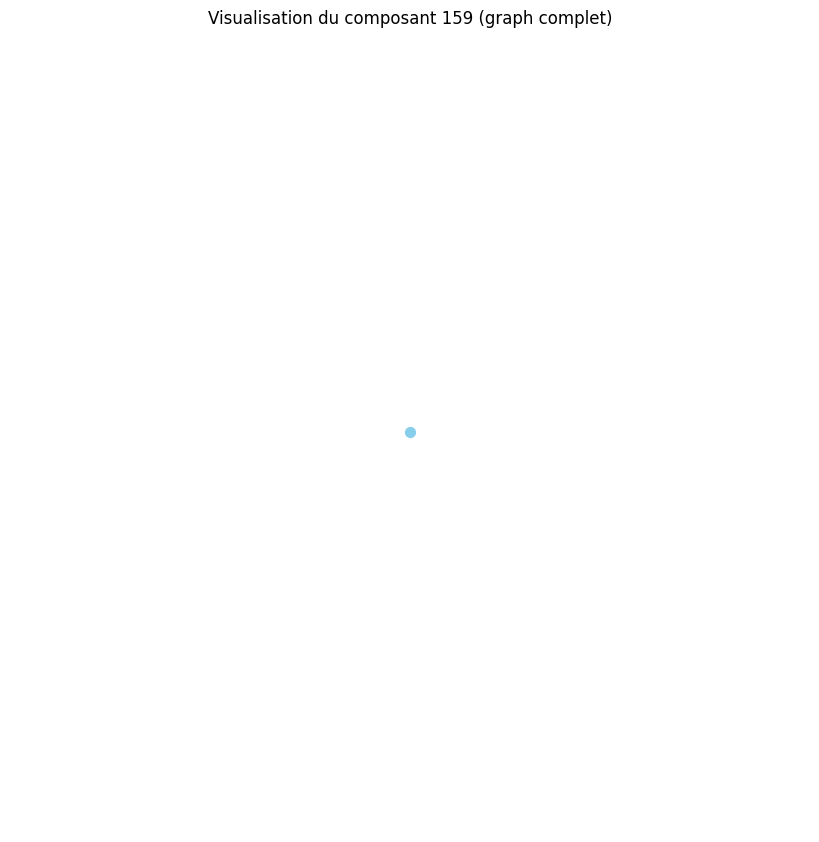

Distance moyenne pour le composant 160 : 0.00
Le composant 160 est un graphe complet ou très densément connecté.
Densité du composant 160 : 0.00
Degré moyen du composant 160 : 0.00
Coefficient de clustering moyen du composant 160 : 0.00


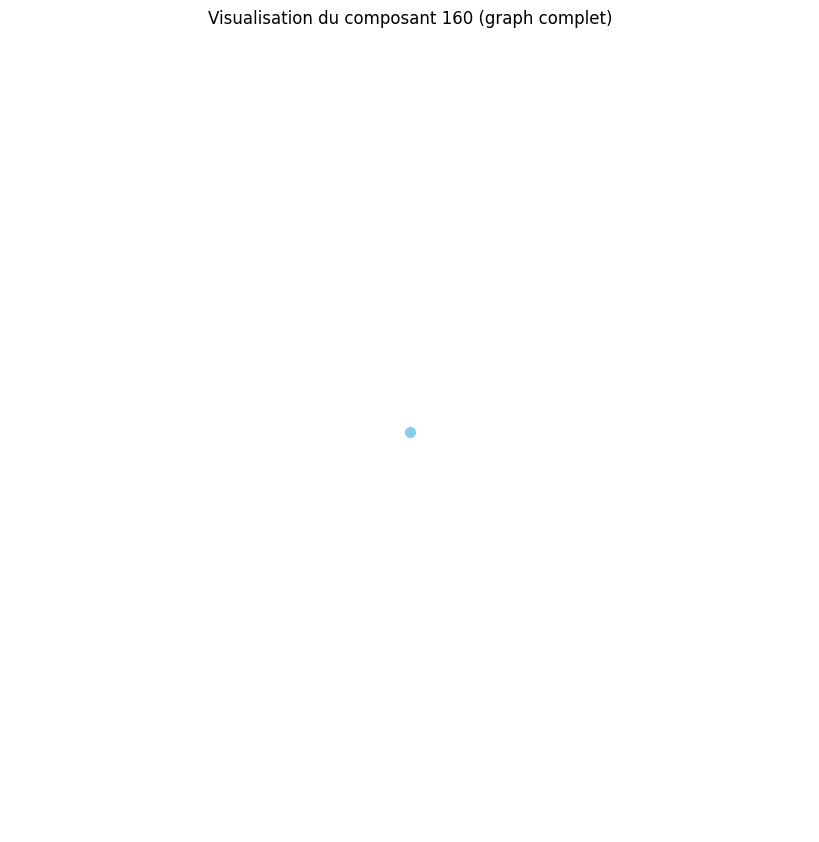

Distance moyenne pour le composant 161 : 0.00
Le composant 161 est un graphe complet ou très densément connecté.
Densité du composant 161 : 0.00
Degré moyen du composant 161 : 0.00
Coefficient de clustering moyen du composant 161 : 0.00


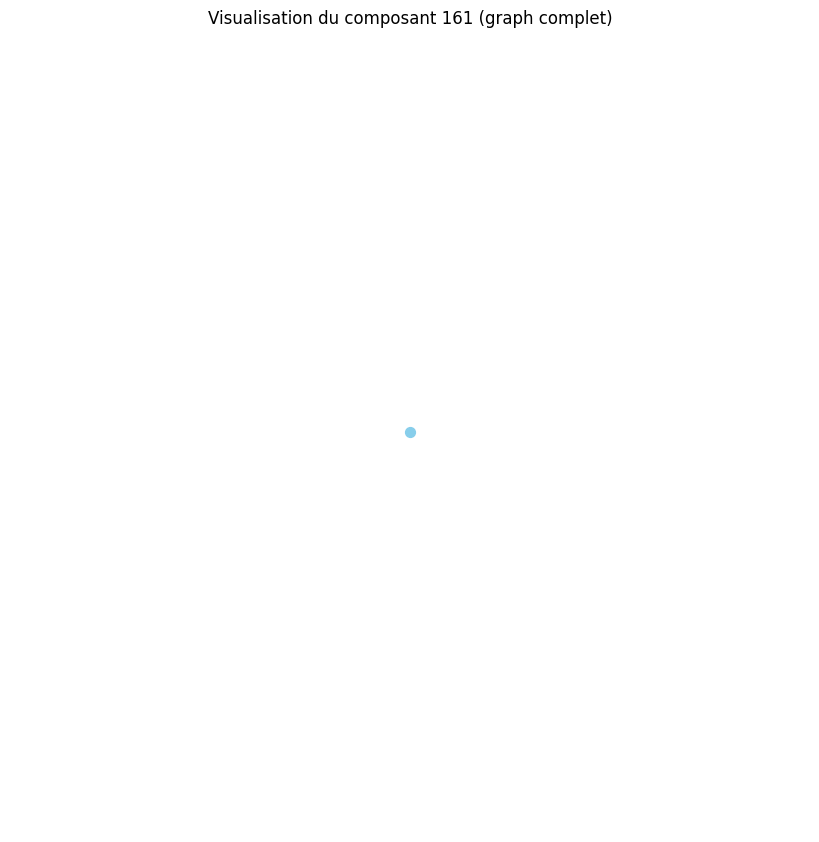

Distance moyenne pour le composant 162 : 0.00
Le composant 162 est un graphe complet ou très densément connecté.
Densité du composant 162 : 0.00
Degré moyen du composant 162 : 0.00
Coefficient de clustering moyen du composant 162 : 0.00


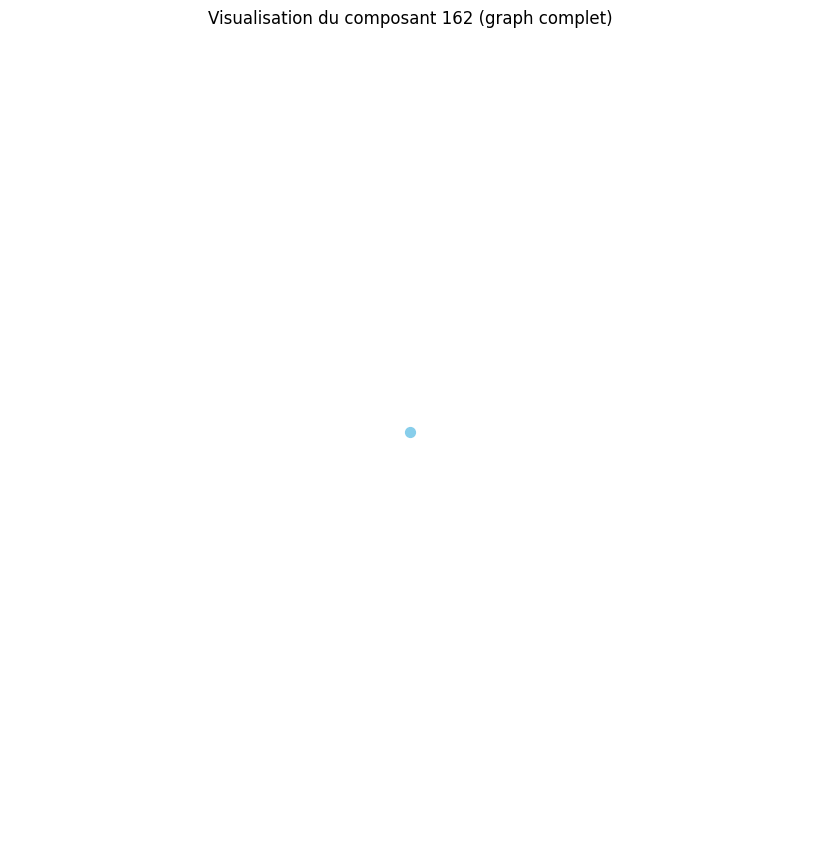

Distance moyenne pour le composant 163 : 0.00
Le composant 163 est un graphe complet ou très densément connecté.
Densité du composant 163 : 0.00
Degré moyen du composant 163 : 0.00
Coefficient de clustering moyen du composant 163 : 0.00


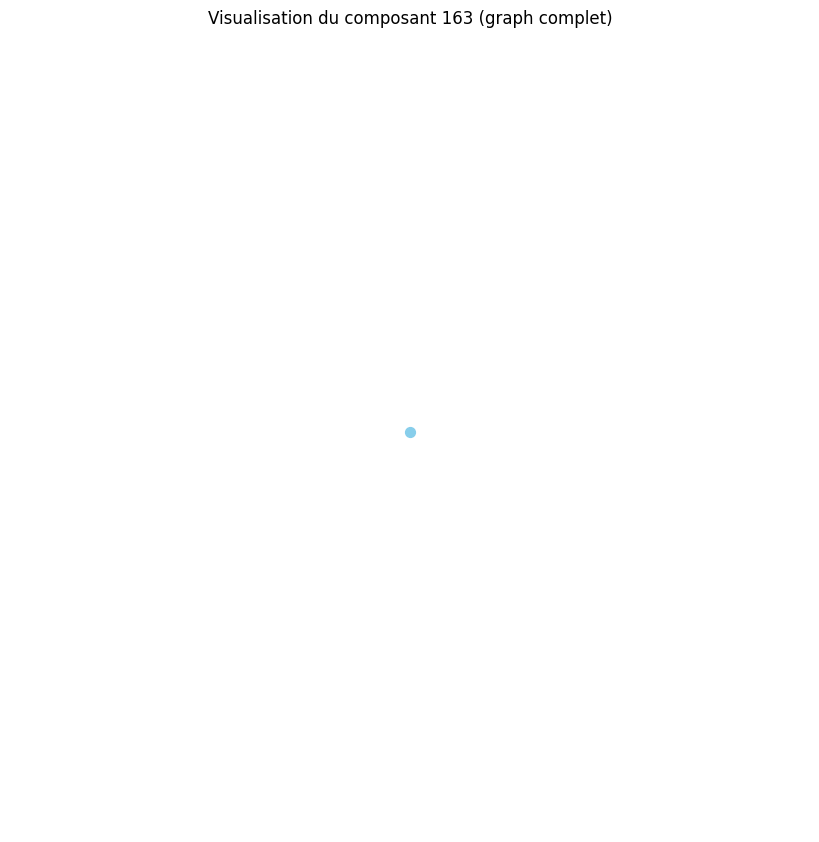

Distance moyenne pour le composant 164 : 0.00
Le composant 164 est un graphe complet ou très densément connecté.
Densité du composant 164 : 0.00
Degré moyen du composant 164 : 0.00
Coefficient de clustering moyen du composant 164 : 0.00


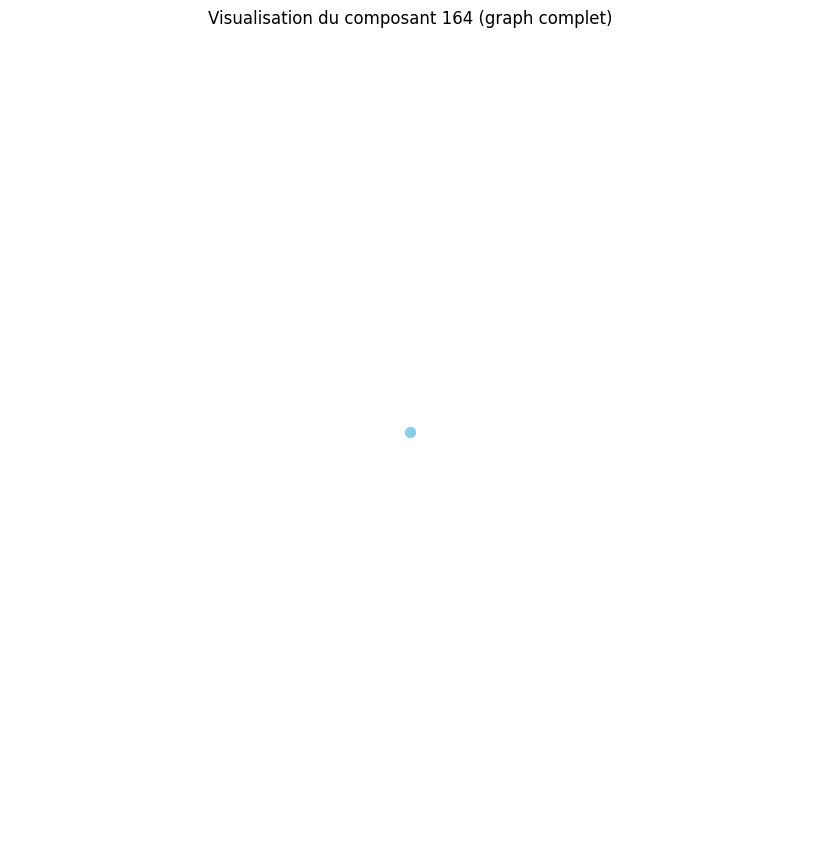

Distance moyenne pour le composant 165 : 0.00
Le composant 165 est un graphe complet ou très densément connecté.
Densité du composant 165 : 0.00
Degré moyen du composant 165 : 0.00
Coefficient de clustering moyen du composant 165 : 0.00


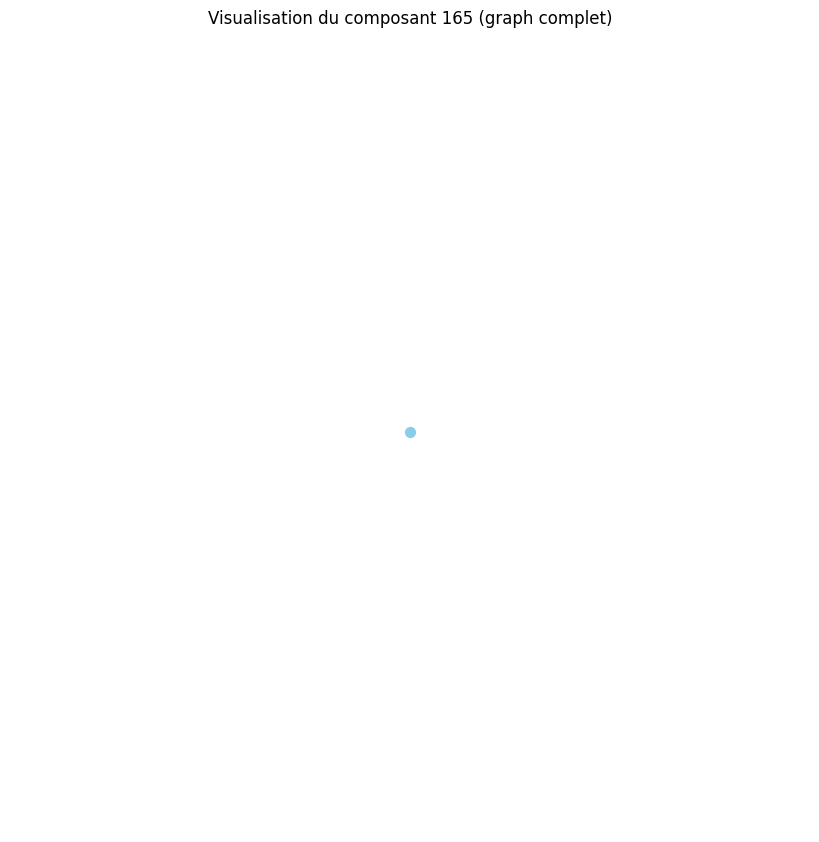

Distance moyenne pour le composant 166 : 0.00
Le composant 166 est un graphe complet ou très densément connecté.
Densité du composant 166 : 0.00
Degré moyen du composant 166 : 0.00
Coefficient de clustering moyen du composant 166 : 0.00


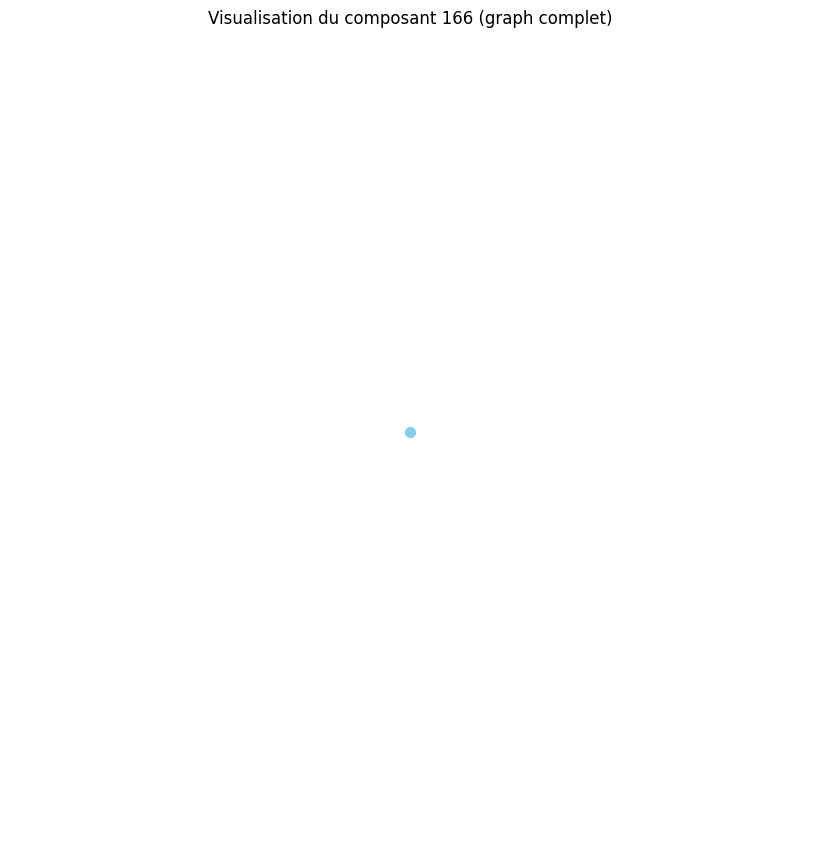

Distance moyenne pour le composant 167 : 2.63
Distance moyenne pour le composant 168 : 0.00
Le composant 168 est un graphe complet ou très densément connecté.
Densité du composant 168 : 0.00
Degré moyen du composant 168 : 0.00
Coefficient de clustering moyen du composant 168 : 0.00


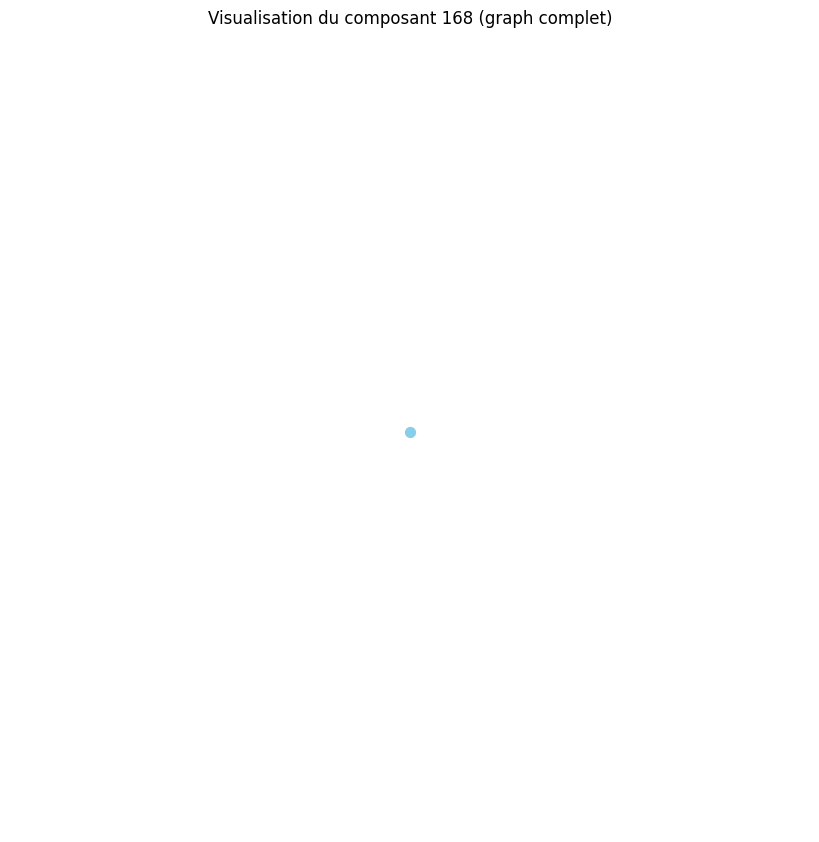

Distance moyenne pour le composant 169 : 0.00
Le composant 169 est un graphe complet ou très densément connecté.
Densité du composant 169 : 0.00
Degré moyen du composant 169 : 0.00
Coefficient de clustering moyen du composant 169 : 0.00


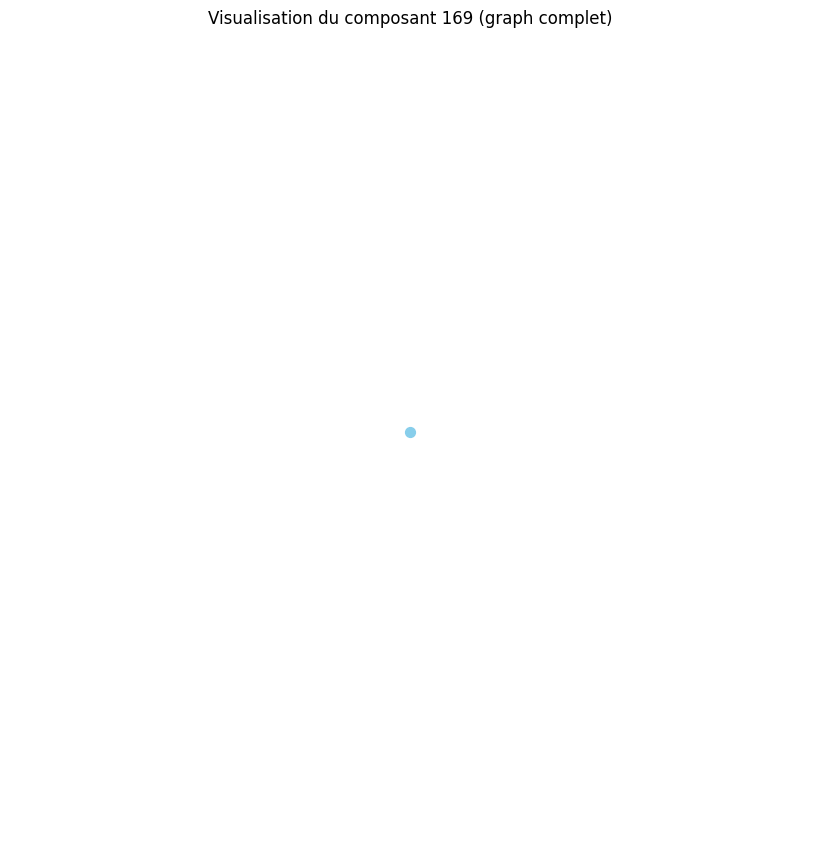

Distance moyenne pour le composant 170 : 0.00
Le composant 170 est un graphe complet ou très densément connecté.
Densité du composant 170 : 0.00
Degré moyen du composant 170 : 0.00
Coefficient de clustering moyen du composant 170 : 0.00


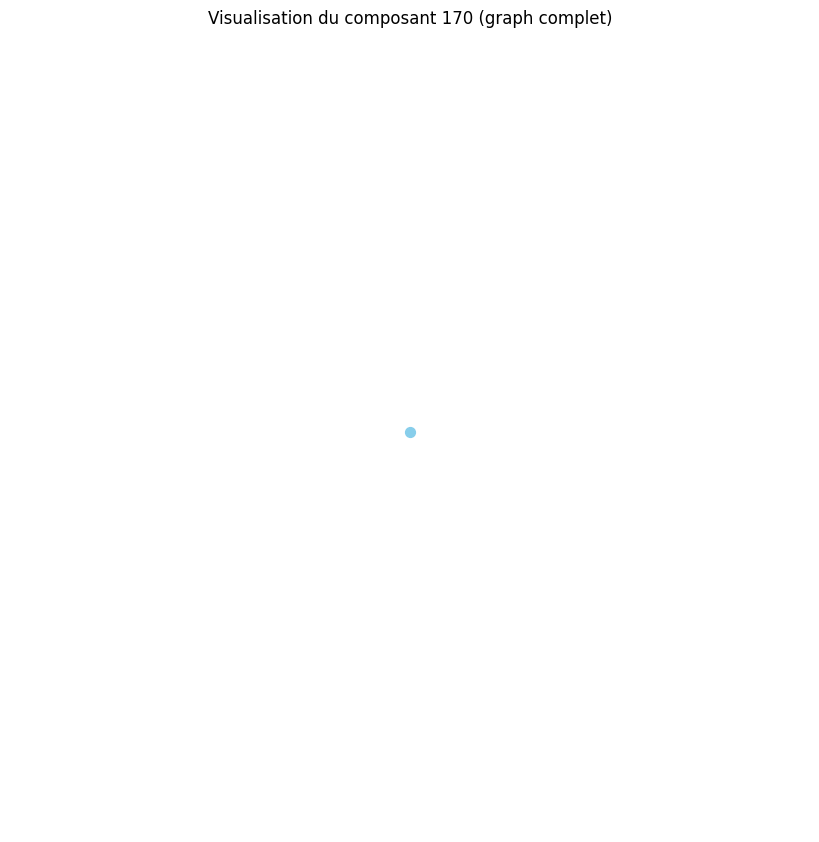

Distance moyenne pour le composant 171 : 0.00
Le composant 171 est un graphe complet ou très densément connecté.
Densité du composant 171 : 0.00
Degré moyen du composant 171 : 0.00
Coefficient de clustering moyen du composant 171 : 0.00


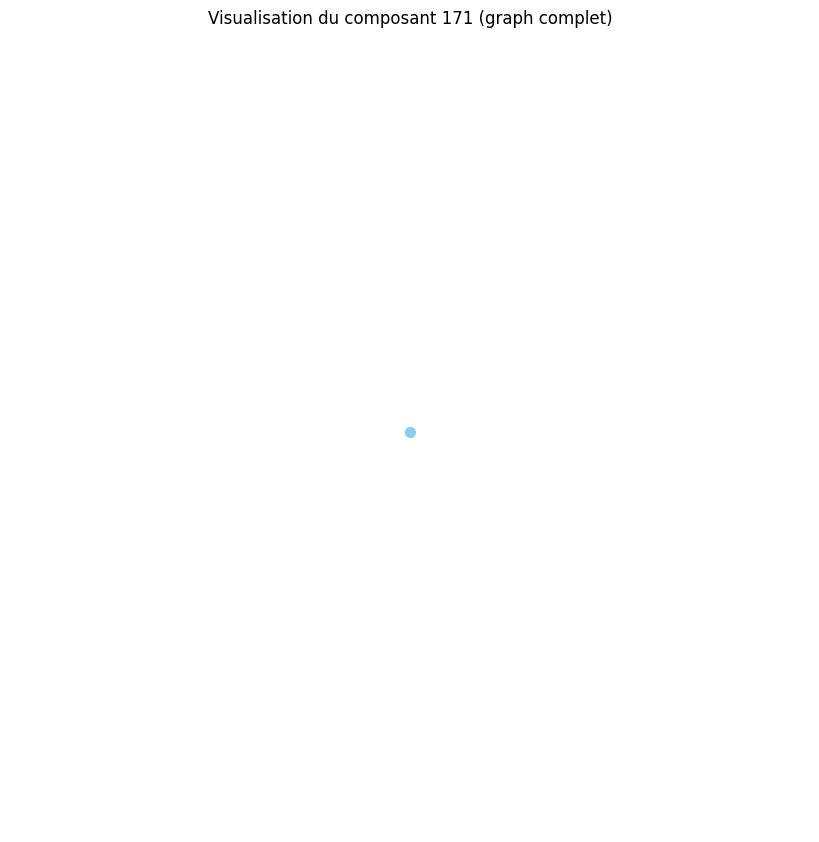

Distance moyenne pour le composant 172 : 0.00
Le composant 172 est un graphe complet ou très densément connecté.
Densité du composant 172 : 0.00
Degré moyen du composant 172 : 0.00
Coefficient de clustering moyen du composant 172 : 0.00


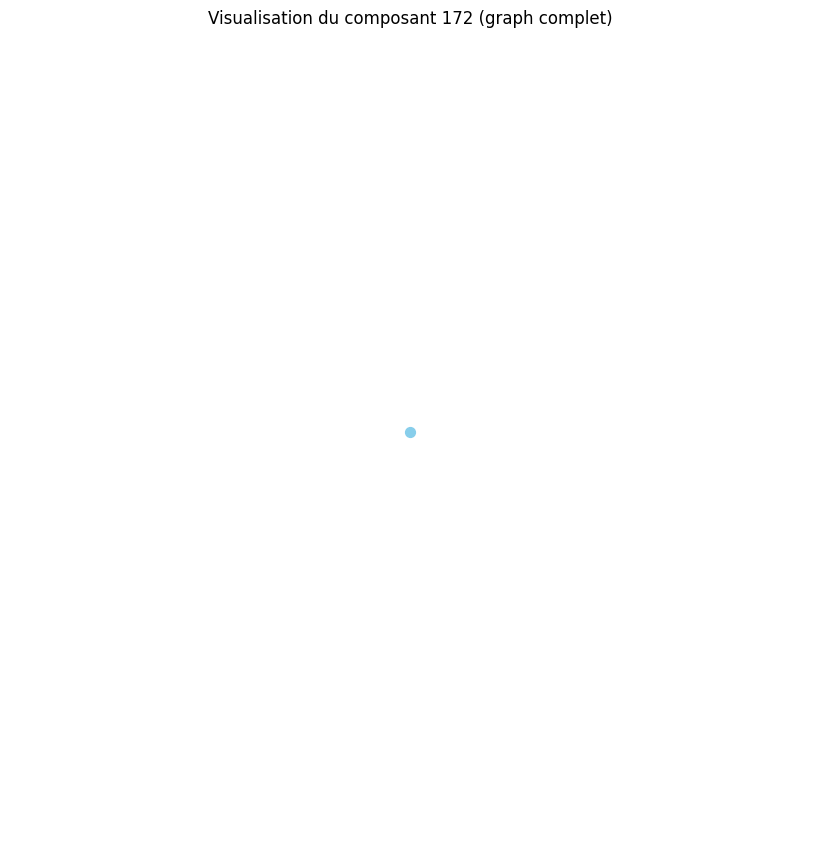

Distance moyenne pour le composant 173 : 0.00
Le composant 173 est un graphe complet ou très densément connecté.
Densité du composant 173 : 0.00
Degré moyen du composant 173 : 0.00
Coefficient de clustering moyen du composant 173 : 0.00


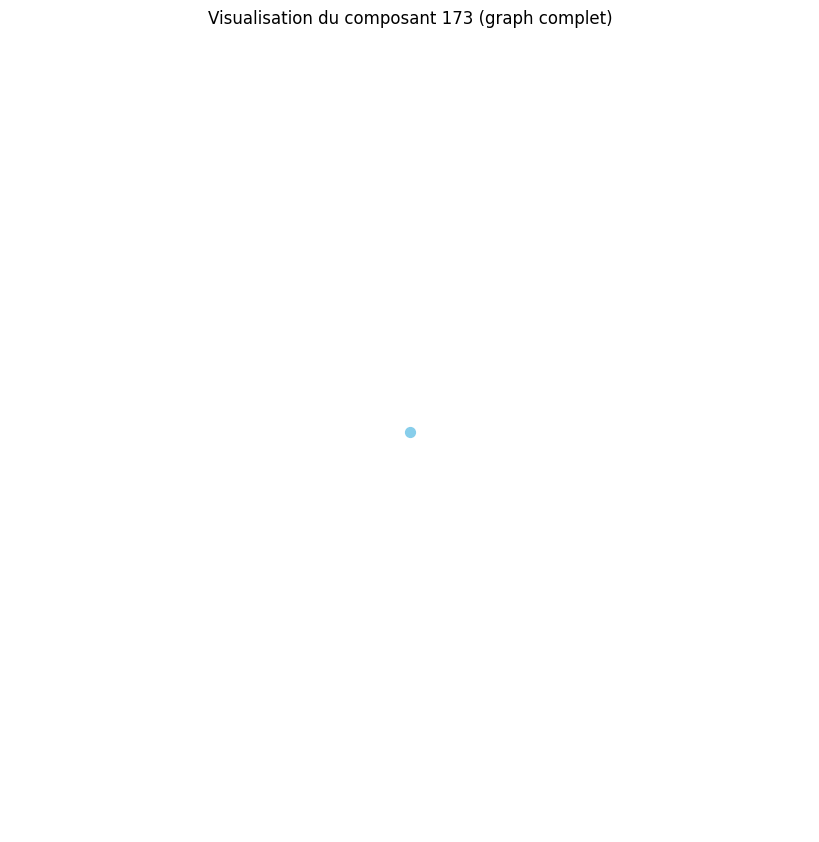

Distance moyenne pour le composant 174 : 0.00
Le composant 174 est un graphe complet ou très densément connecté.
Densité du composant 174 : 0.00
Degré moyen du composant 174 : 0.00
Coefficient de clustering moyen du composant 174 : 0.00


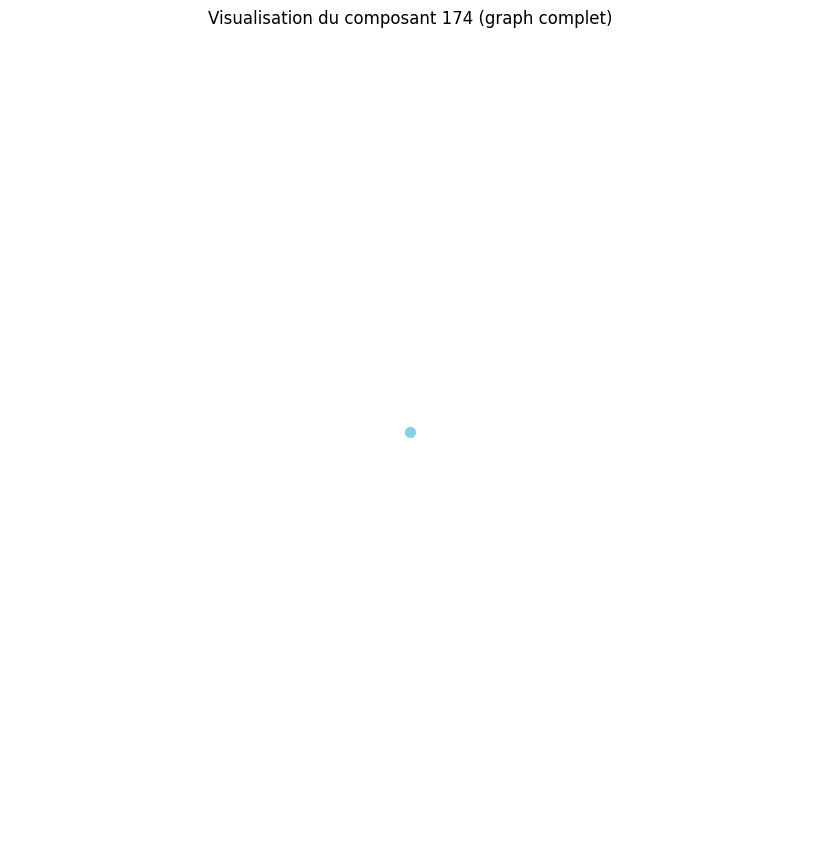

Distance moyenne pour le composant 175 : 0.00
Le composant 175 est un graphe complet ou très densément connecté.
Densité du composant 175 : 0.00
Degré moyen du composant 175 : 0.00
Coefficient de clustering moyen du composant 175 : 0.00


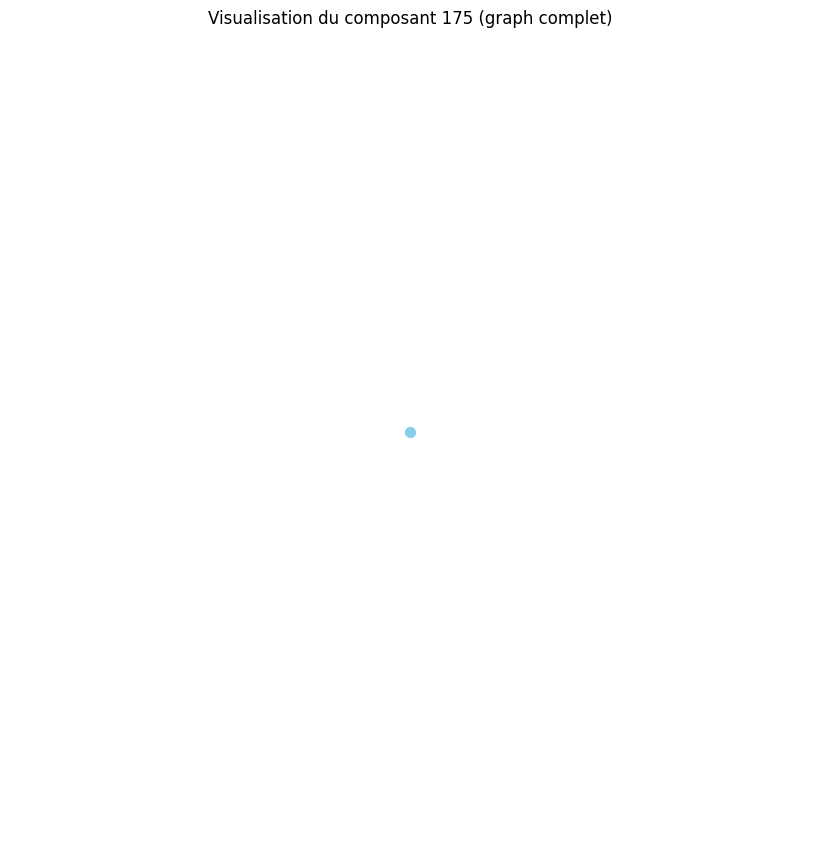

Distance moyenne pour le composant 176 : 0.00
Le composant 176 est un graphe complet ou très densément connecté.
Densité du composant 176 : 0.00
Degré moyen du composant 176 : 0.00
Coefficient de clustering moyen du composant 176 : 0.00


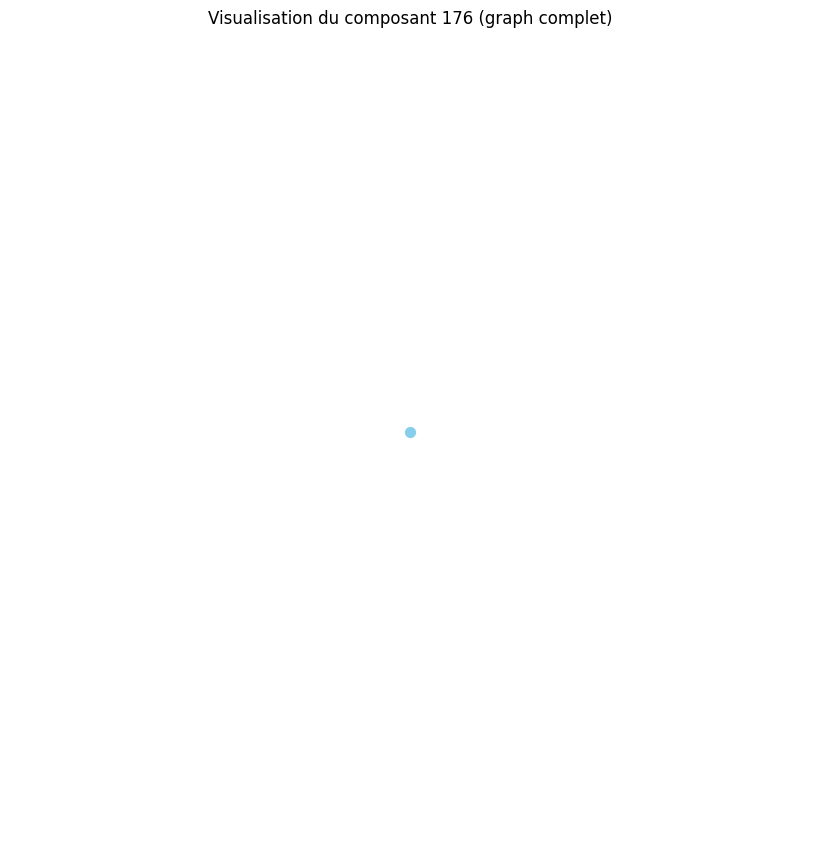

Distance moyenne pour le composant 177 : 0.00
Le composant 177 est un graphe complet ou très densément connecté.
Densité du composant 177 : 0.00
Degré moyen du composant 177 : 0.00
Coefficient de clustering moyen du composant 177 : 0.00


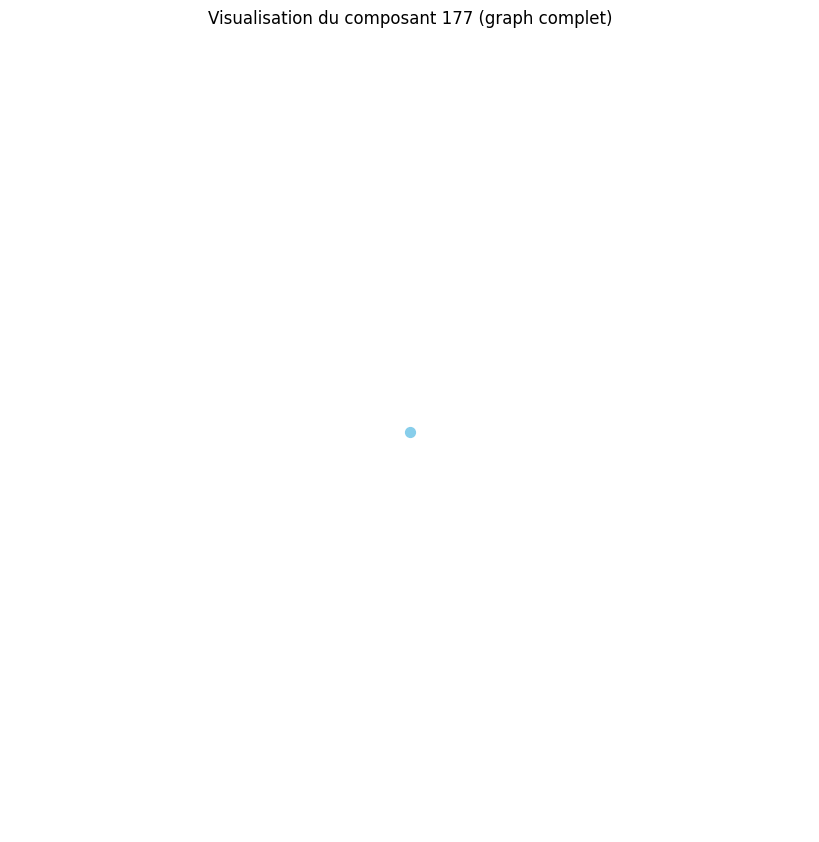

Distance moyenne pour le composant 178 : 0.00
Le composant 178 est un graphe complet ou très densément connecté.
Densité du composant 178 : 0.00
Degré moyen du composant 178 : 0.00
Coefficient de clustering moyen du composant 178 : 0.00


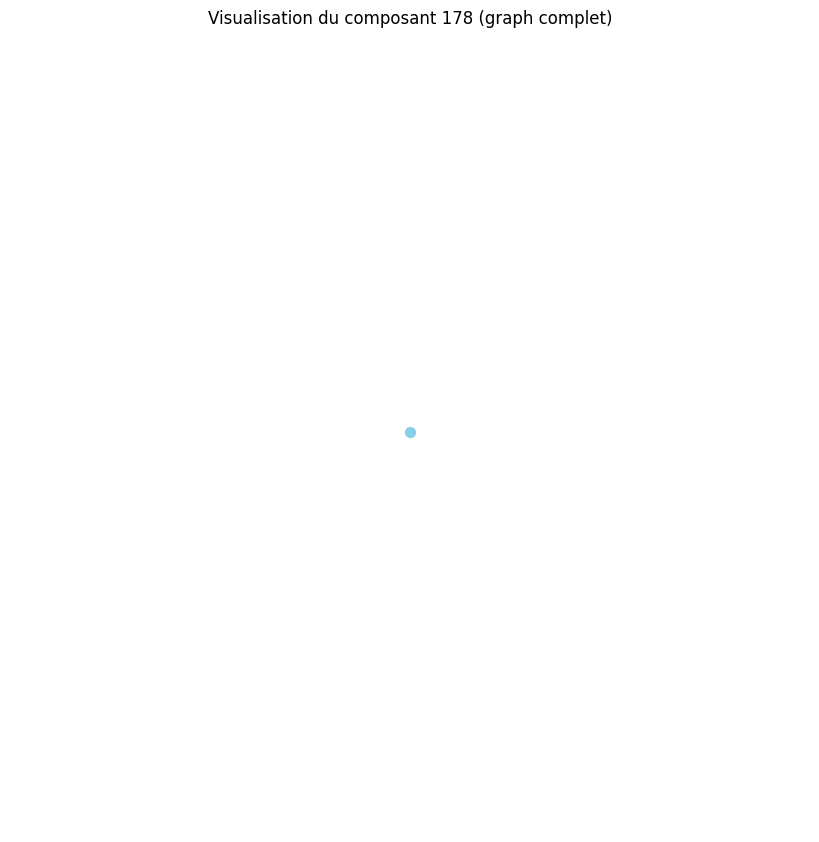

Distance moyenne pour le composant 179 : 0.00
Le composant 179 est un graphe complet ou très densément connecté.
Densité du composant 179 : 0.00
Degré moyen du composant 179 : 0.00
Coefficient de clustering moyen du composant 179 : 0.00


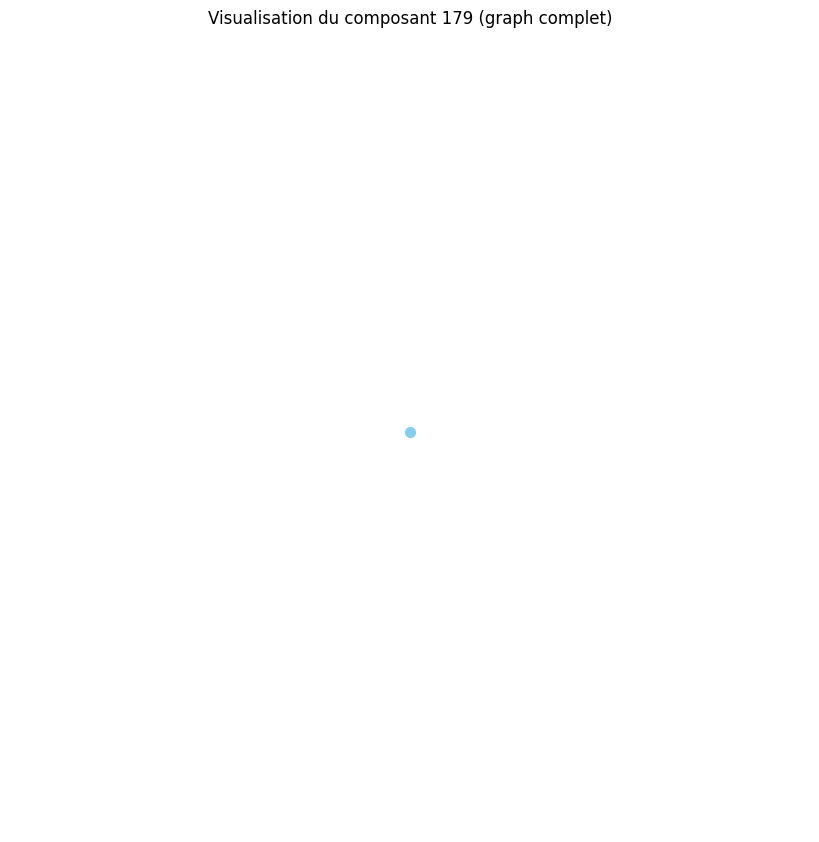

Distance moyenne pour le composant 180 : 0.00
Le composant 180 est un graphe complet ou très densément connecté.
Densité du composant 180 : 0.00
Degré moyen du composant 180 : 0.00
Coefficient de clustering moyen du composant 180 : 0.00


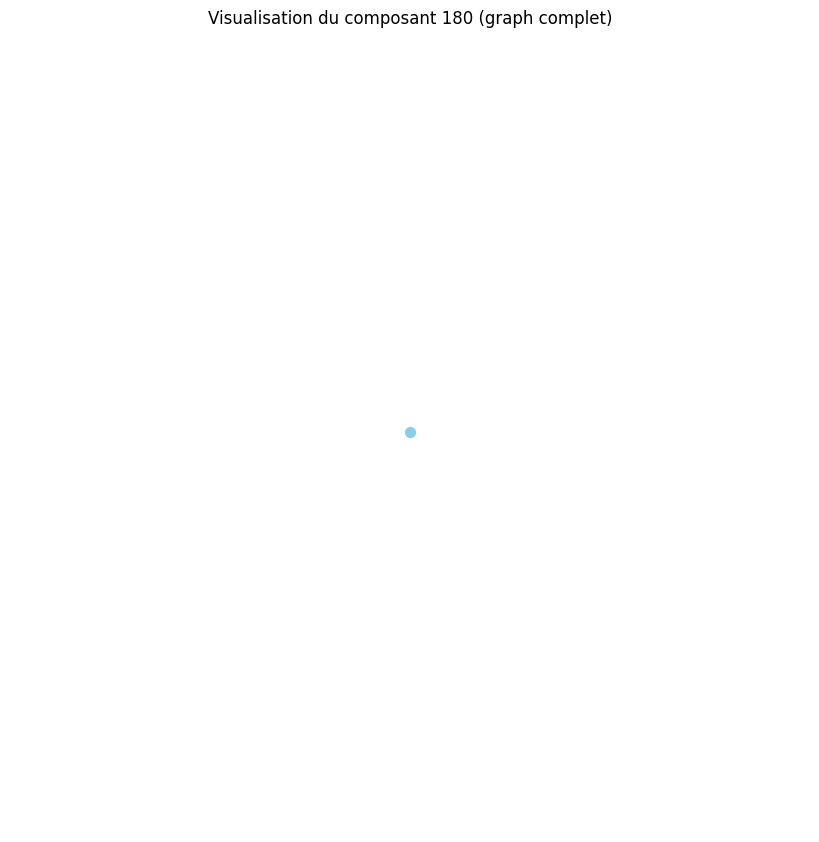

Distance moyenne pour le composant 181 : 0.00
Le composant 181 est un graphe complet ou très densément connecté.
Densité du composant 181 : 0.00
Degré moyen du composant 181 : 0.00
Coefficient de clustering moyen du composant 181 : 0.00


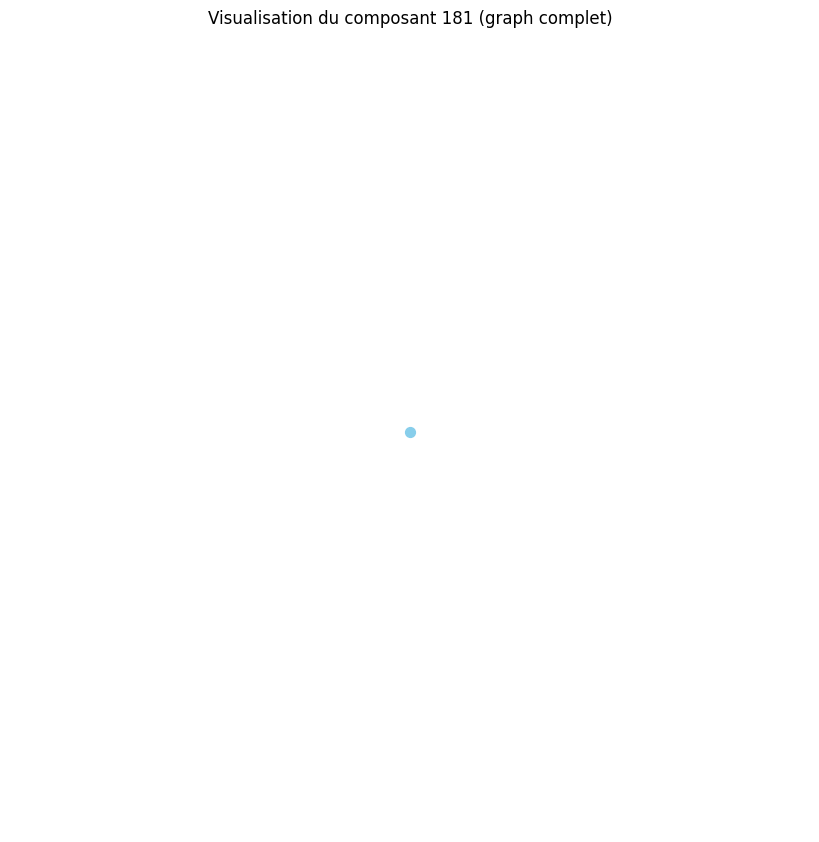

Distance moyenne pour le composant 182 : 1.00
Distance moyenne pour le composant 183 : 0.00
Le composant 183 est un graphe complet ou très densément connecté.
Densité du composant 183 : 0.00
Degré moyen du composant 183 : 0.00
Coefficient de clustering moyen du composant 183 : 0.00


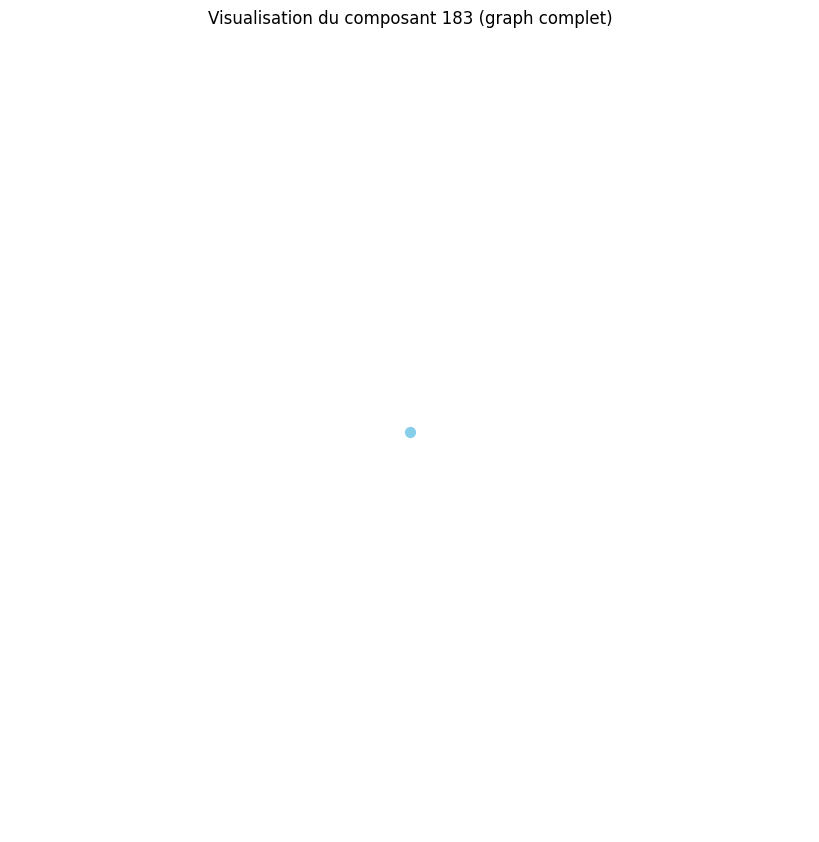

Distance moyenne pour le composant 184 : 0.00
Le composant 184 est un graphe complet ou très densément connecté.
Densité du composant 184 : 0.00
Degré moyen du composant 184 : 0.00
Coefficient de clustering moyen du composant 184 : 0.00


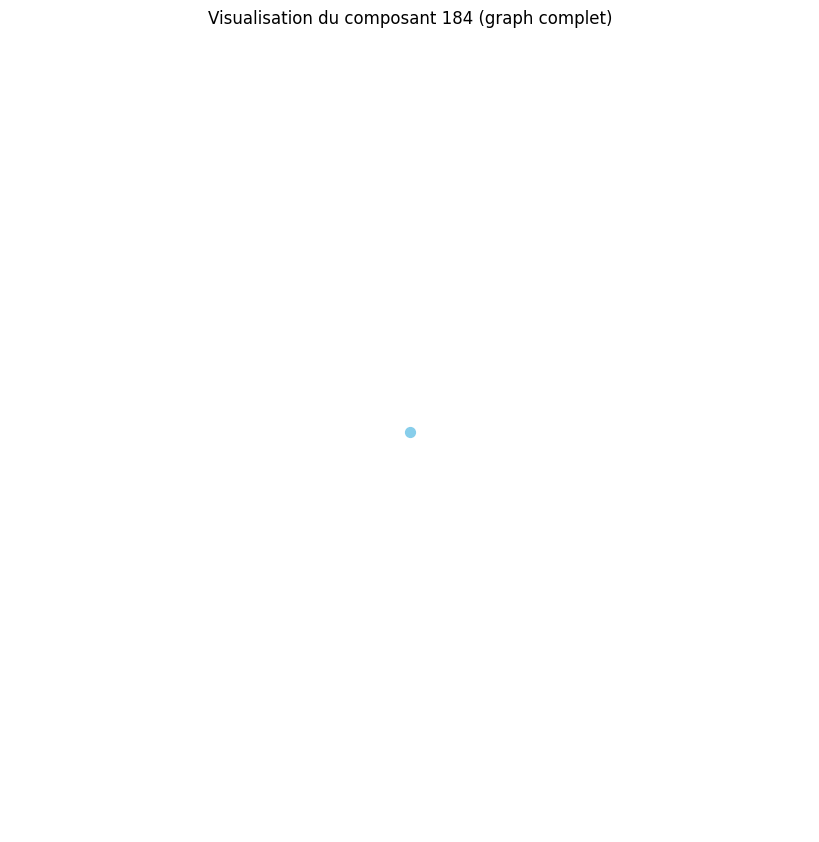

Distance moyenne pour le composant 185 : 0.00
Le composant 185 est un graphe complet ou très densément connecté.
Densité du composant 185 : 0.00
Degré moyen du composant 185 : 0.00
Coefficient de clustering moyen du composant 185 : 0.00


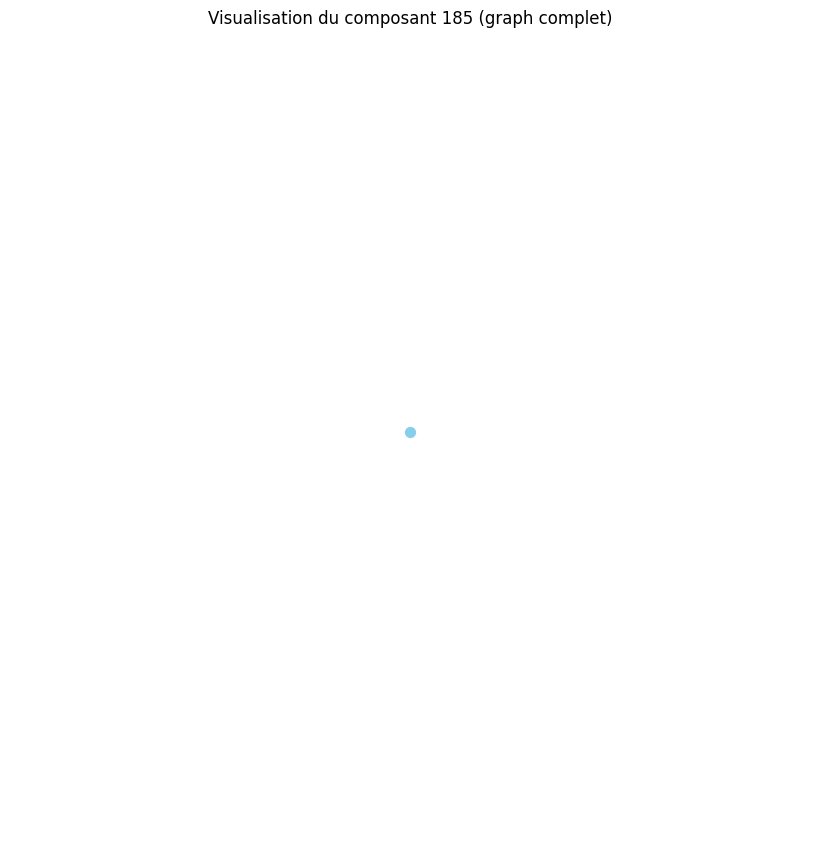

Distance moyenne pour le composant 186 : 0.00
Le composant 186 est un graphe complet ou très densément connecté.
Densité du composant 186 : 0.00
Degré moyen du composant 186 : 0.00
Coefficient de clustering moyen du composant 186 : 0.00


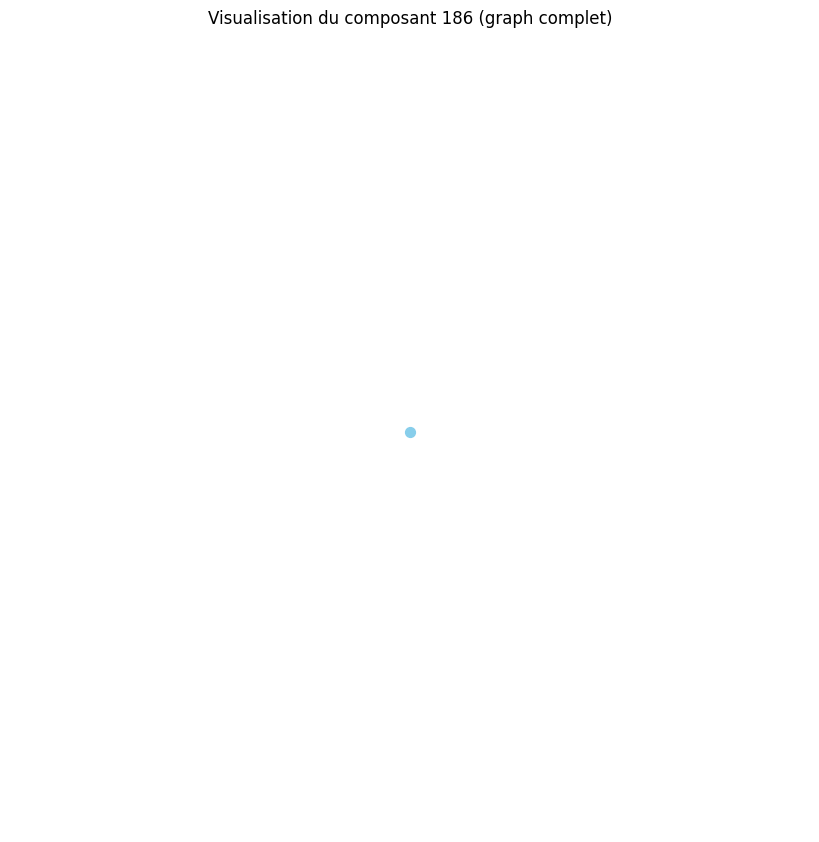

Distance moyenne pour le composant 187 : 0.00
Le composant 187 est un graphe complet ou très densément connecté.
Densité du composant 187 : 0.00
Degré moyen du composant 187 : 0.00
Coefficient de clustering moyen du composant 187 : 0.00


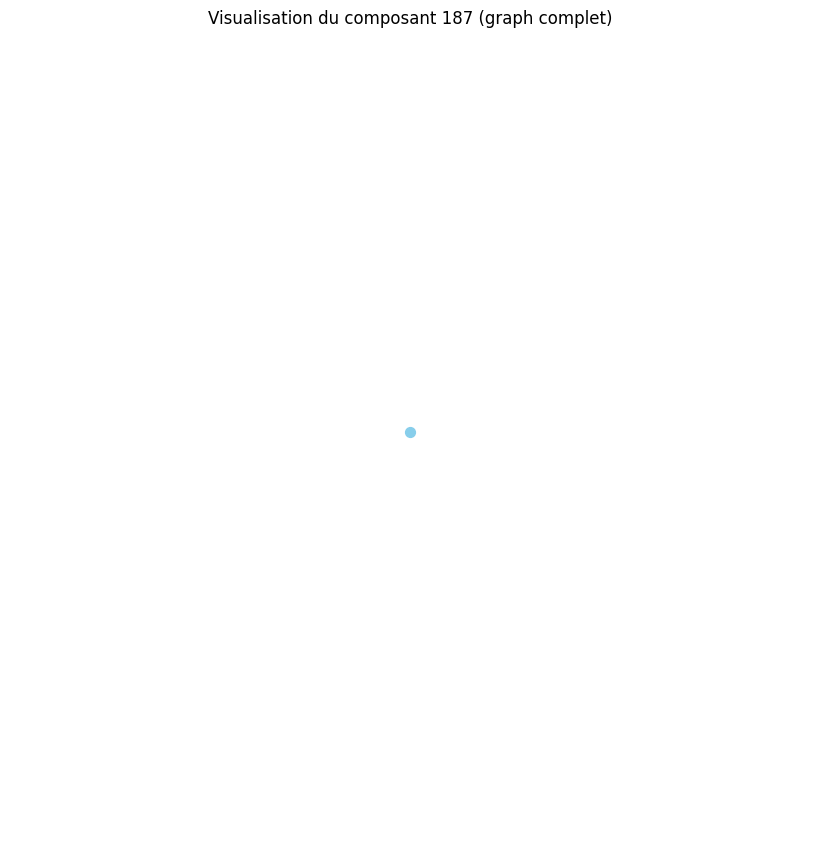

Distance moyenne pour le composant 188 : 0.00
Le composant 188 est un graphe complet ou très densément connecté.
Densité du composant 188 : 0.00
Degré moyen du composant 188 : 0.00
Coefficient de clustering moyen du composant 188 : 0.00


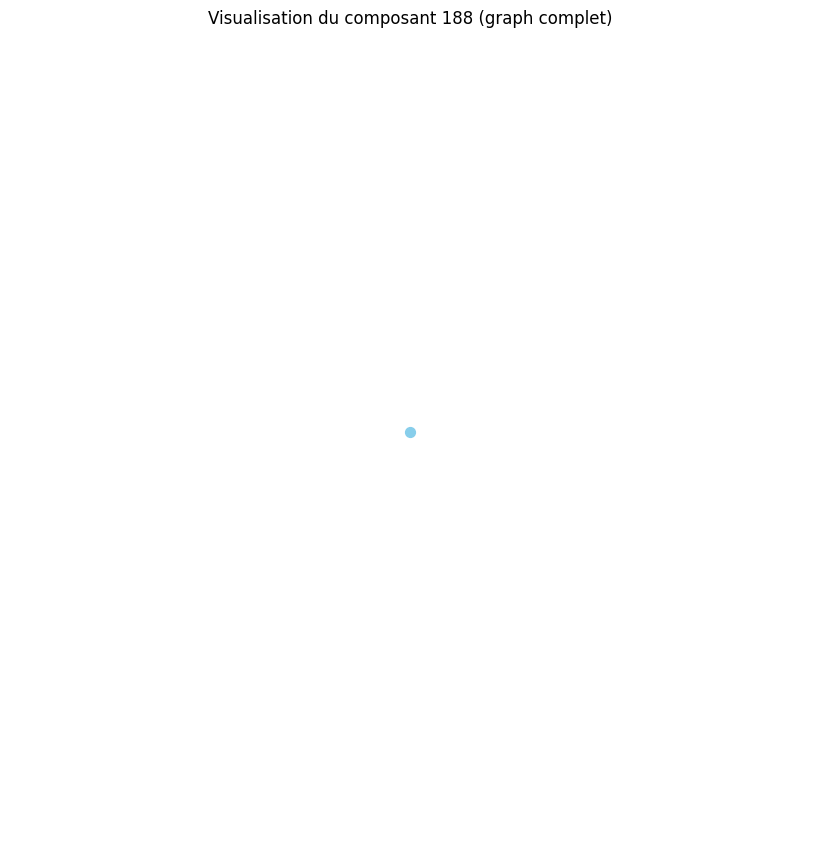

Distance moyenne pour le composant 189 : 0.00
Le composant 189 est un graphe complet ou très densément connecté.
Densité du composant 189 : 0.00
Degré moyen du composant 189 : 0.00
Coefficient de clustering moyen du composant 189 : 0.00


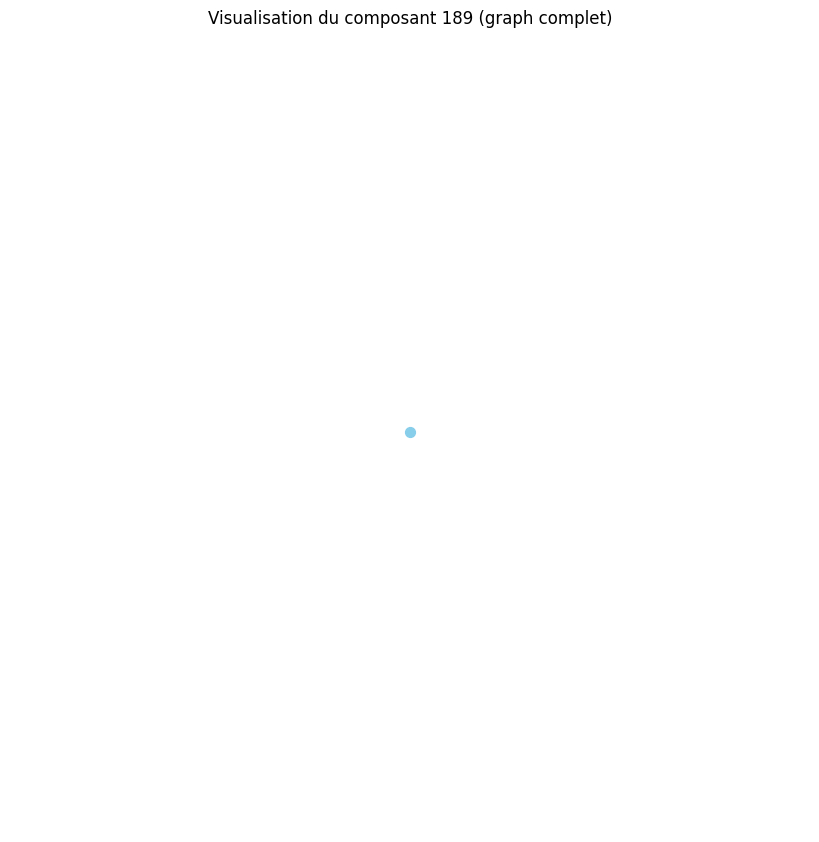

Distance moyenne pour le composant 190 : 0.00
Le composant 190 est un graphe complet ou très densément connecté.
Densité du composant 190 : 0.00
Degré moyen du composant 190 : 0.00
Coefficient de clustering moyen du composant 190 : 0.00


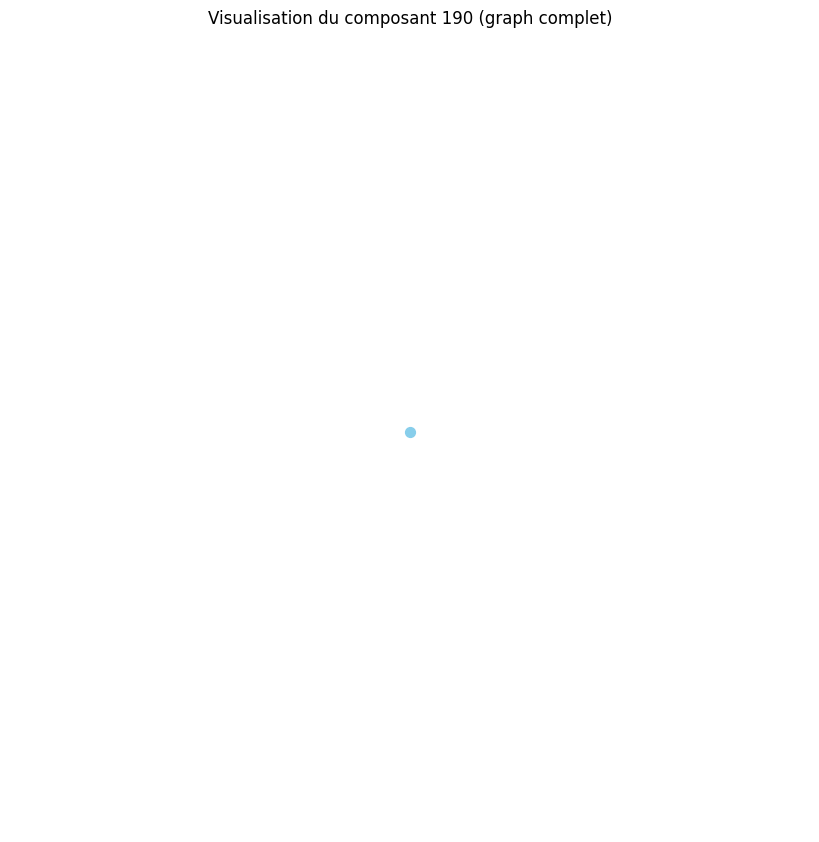

Distance moyenne pour le composant 191 : 0.00
Le composant 191 est un graphe complet ou très densément connecté.
Densité du composant 191 : 0.00
Degré moyen du composant 191 : 0.00
Coefficient de clustering moyen du composant 191 : 0.00


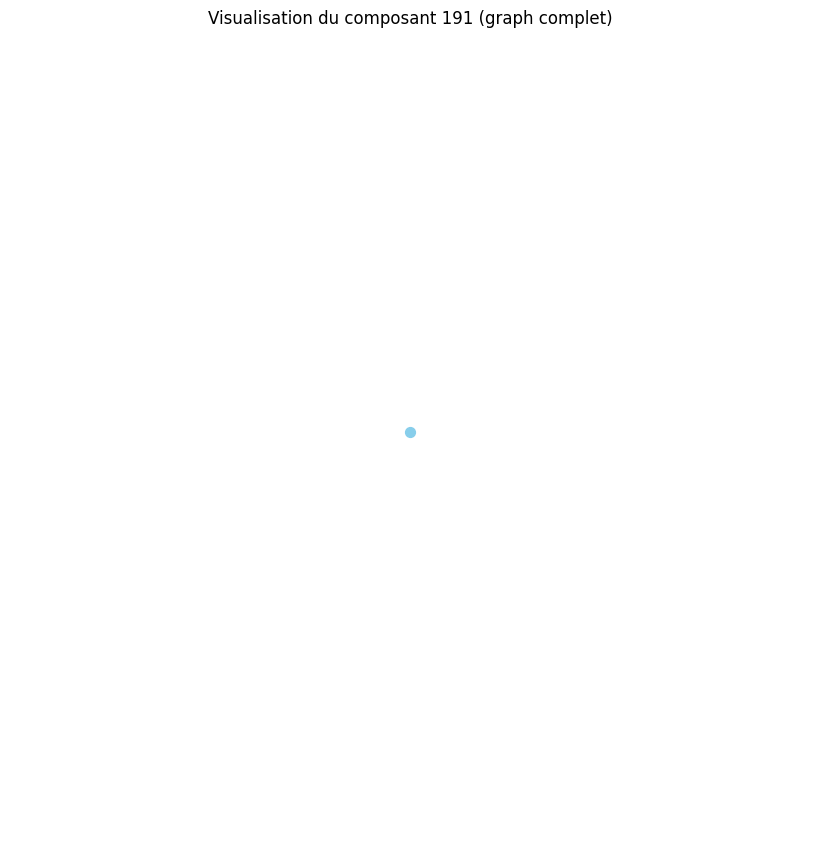

Distance moyenne pour le composant 192 : 0.00
Le composant 192 est un graphe complet ou très densément connecté.
Densité du composant 192 : 0.00
Degré moyen du composant 192 : 0.00
Coefficient de clustering moyen du composant 192 : 0.00


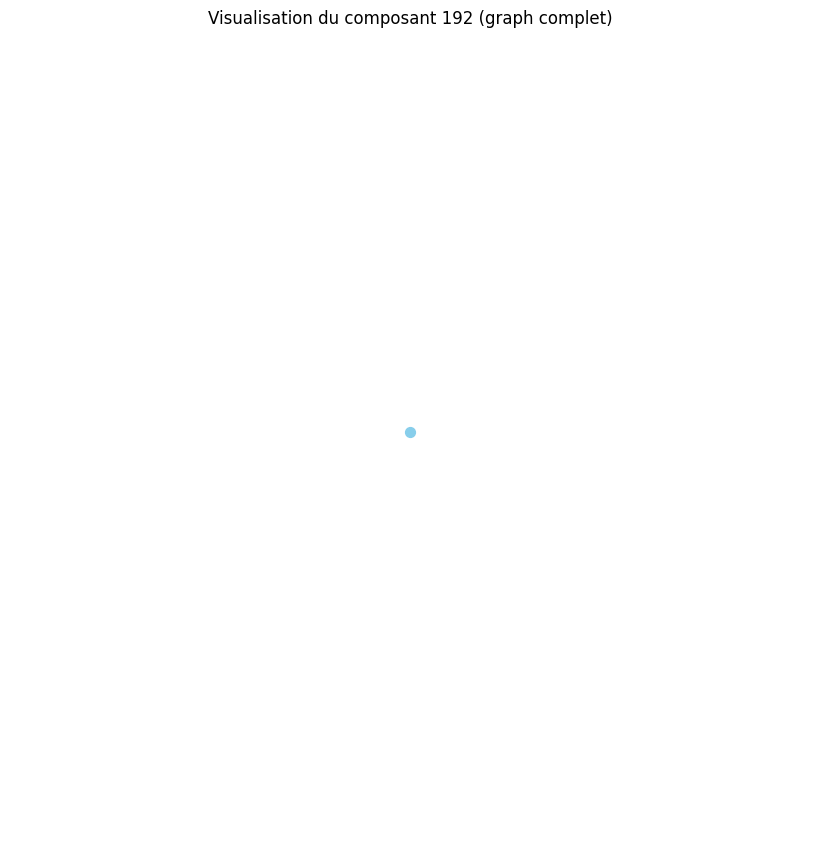

Distance moyenne pour le composant 193 : 0.00
Le composant 193 est un graphe complet ou très densément connecté.
Densité du composant 193 : 0.00
Degré moyen du composant 193 : 0.00
Coefficient de clustering moyen du composant 193 : 0.00


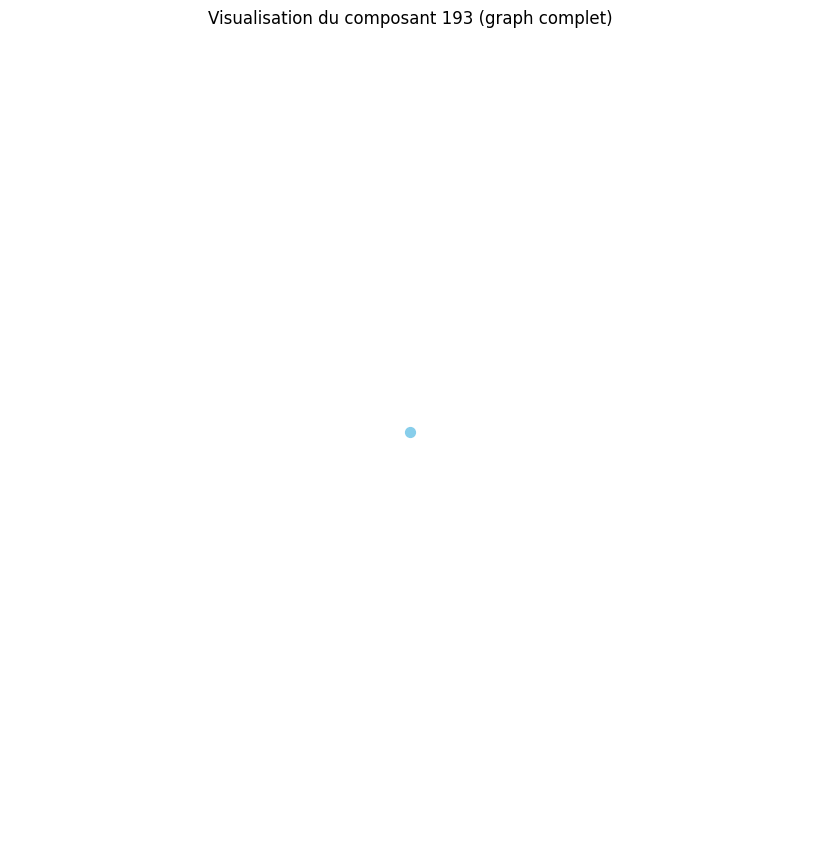

Distance moyenne pour le composant 194 : 0.00
Le composant 194 est un graphe complet ou très densément connecté.
Densité du composant 194 : 0.00
Degré moyen du composant 194 : 0.00
Coefficient de clustering moyen du composant 194 : 0.00


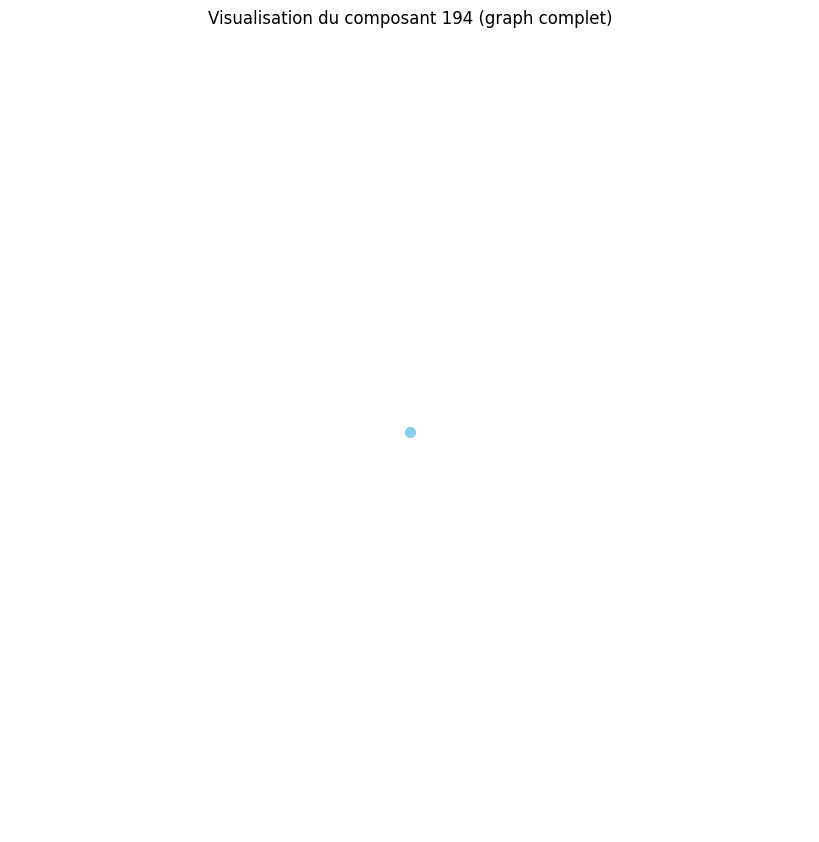

Distance moyenne pour le composant 195 : 0.00
Le composant 195 est un graphe complet ou très densément connecté.
Densité du composant 195 : 0.00
Degré moyen du composant 195 : 0.00
Coefficient de clustering moyen du composant 195 : 0.00


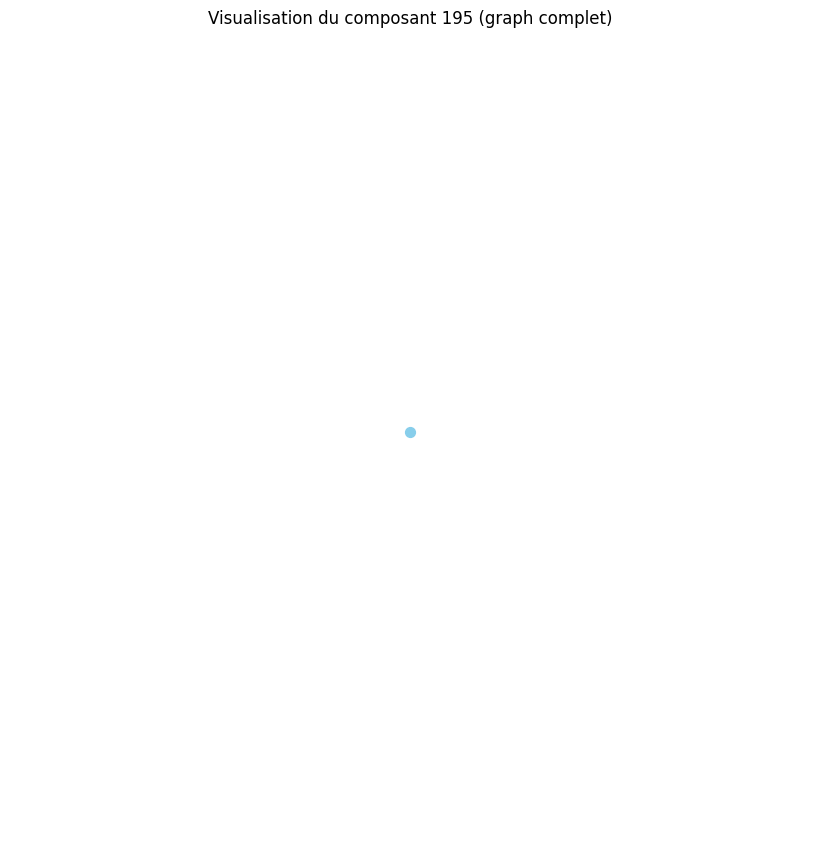

Distance moyenne pour le composant 196 : 0.00
Le composant 196 est un graphe complet ou très densément connecté.
Densité du composant 196 : 0.00
Degré moyen du composant 196 : 0.00
Coefficient de clustering moyen du composant 196 : 0.00


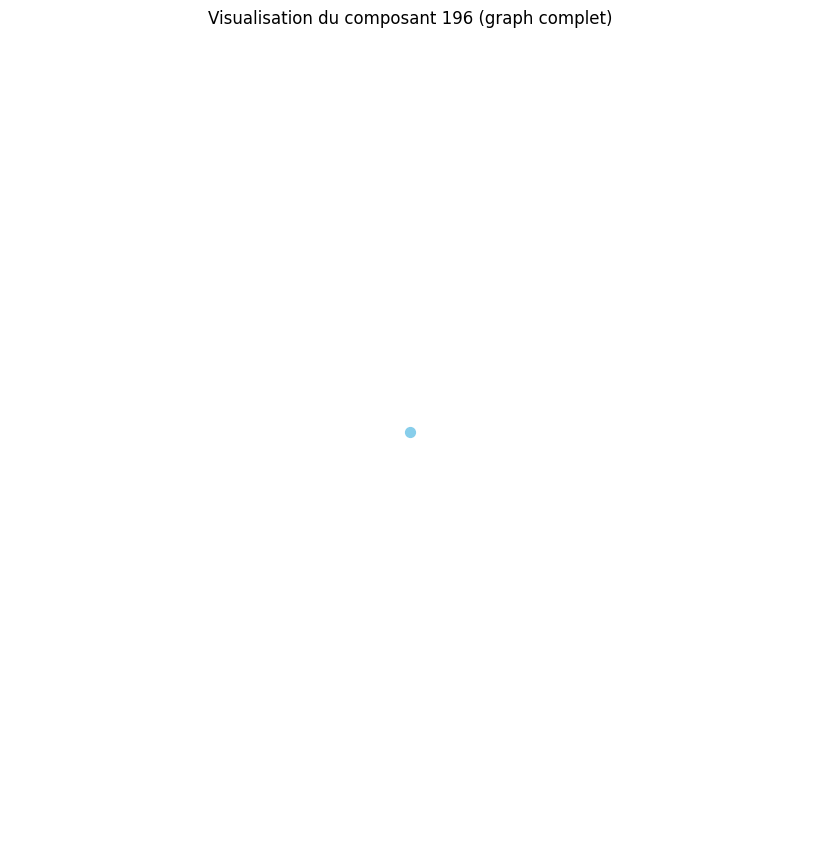

Distance moyenne pour le composant 197 : 0.00
Le composant 197 est un graphe complet ou très densément connecté.
Densité du composant 197 : 0.00
Degré moyen du composant 197 : 0.00
Coefficient de clustering moyen du composant 197 : 0.00


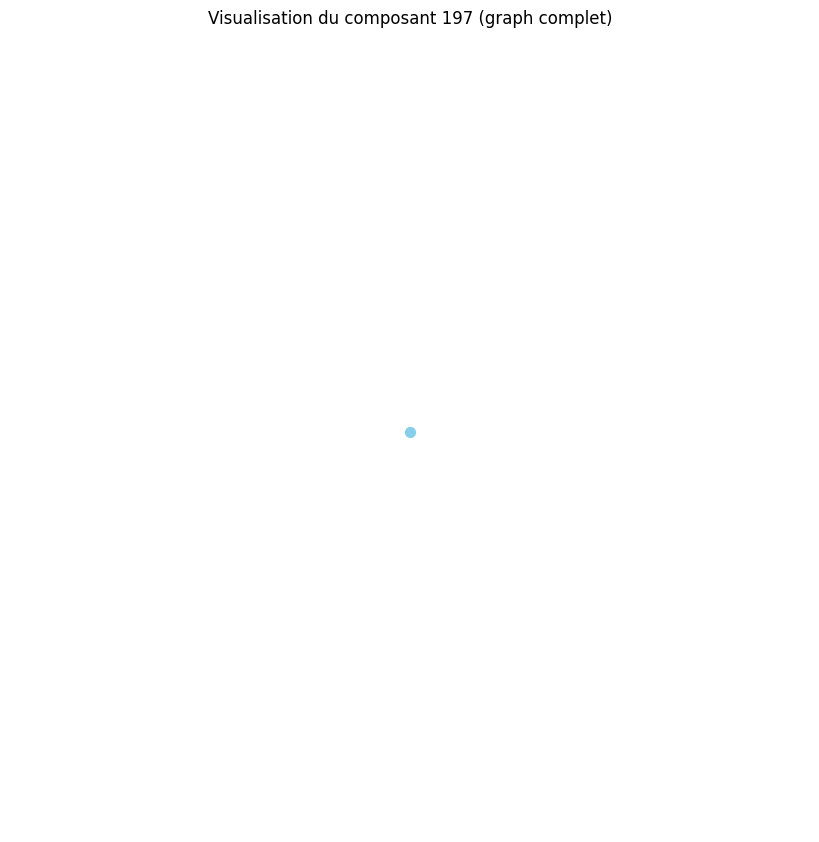

Distance moyenne pour le composant 198 : 0.00
Le composant 198 est un graphe complet ou très densément connecté.
Densité du composant 198 : 0.00
Degré moyen du composant 198 : 0.00
Coefficient de clustering moyen du composant 198 : 0.00


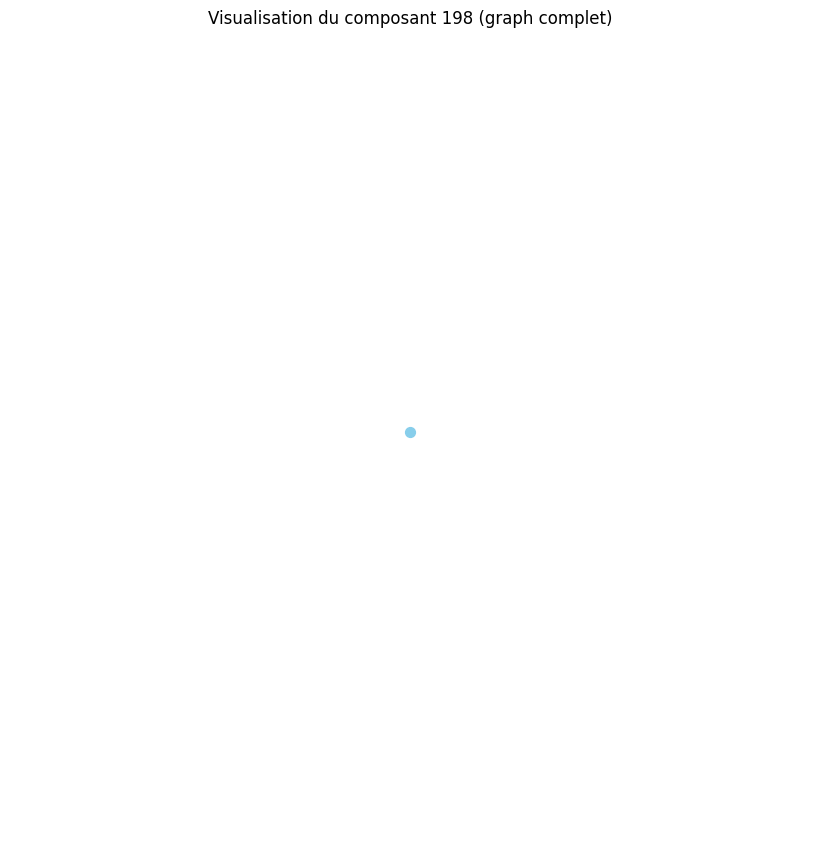

Distance moyenne pour le composant 199 : 0.00
Le composant 199 est un graphe complet ou très densément connecté.
Densité du composant 199 : 0.00
Degré moyen du composant 199 : 0.00
Coefficient de clustering moyen du composant 199 : 0.00


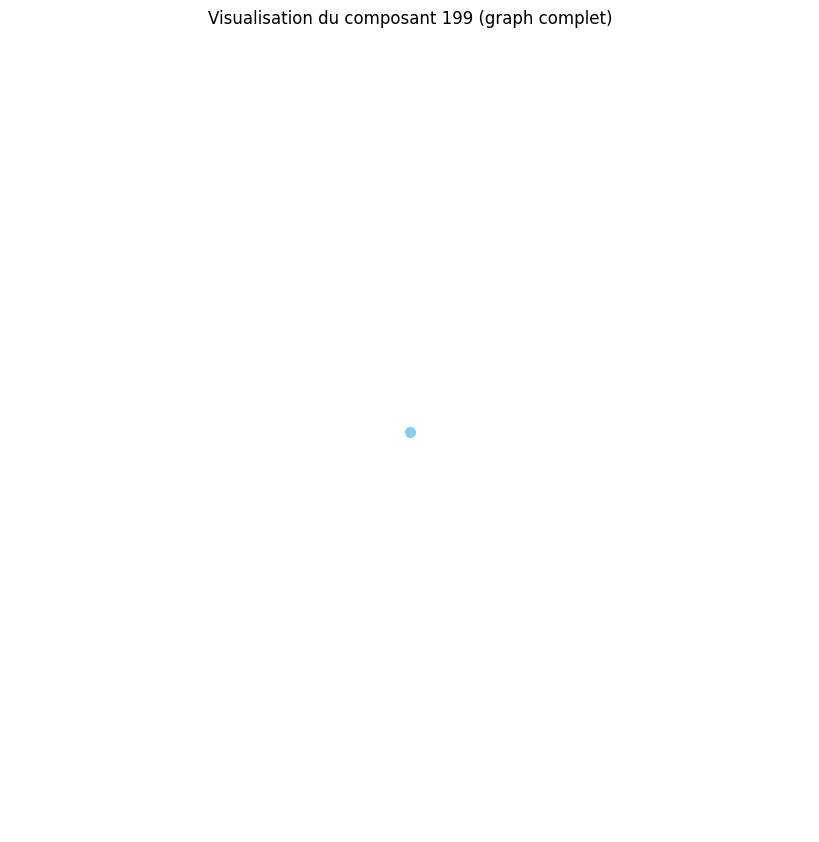

Distance moyenne pour le composant 200 : 0.00
Le composant 200 est un graphe complet ou très densément connecté.
Densité du composant 200 : 0.00
Degré moyen du composant 200 : 0.00
Coefficient de clustering moyen du composant 200 : 0.00


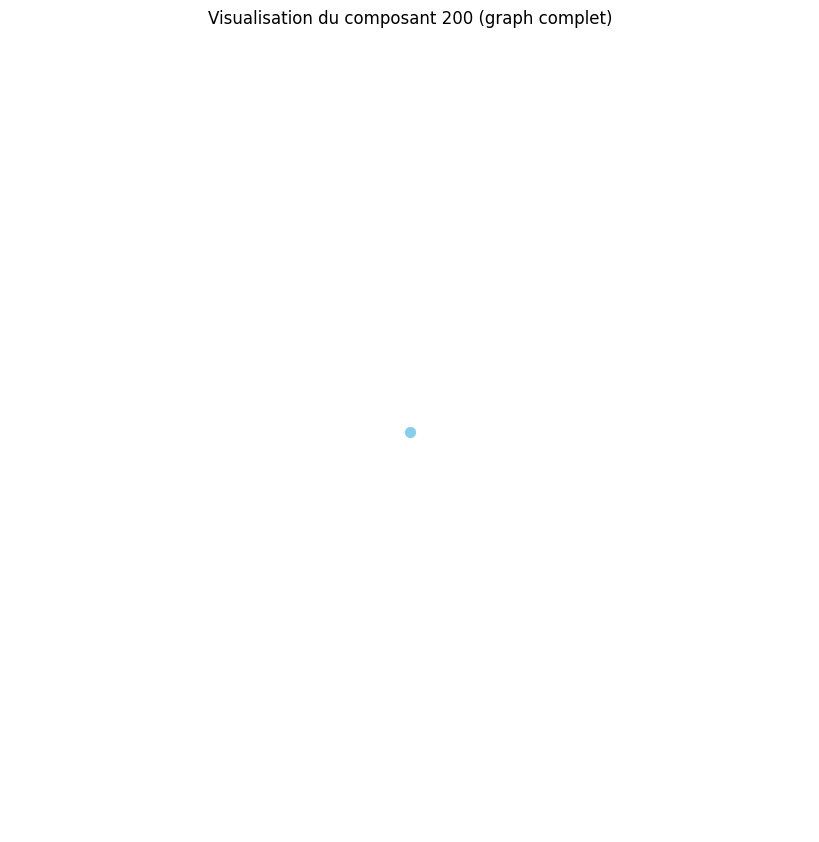

Distance moyenne pour le composant 201 : 0.00
Le composant 201 est un graphe complet ou très densément connecté.
Densité du composant 201 : 0.00
Degré moyen du composant 201 : 0.00
Coefficient de clustering moyen du composant 201 : 0.00


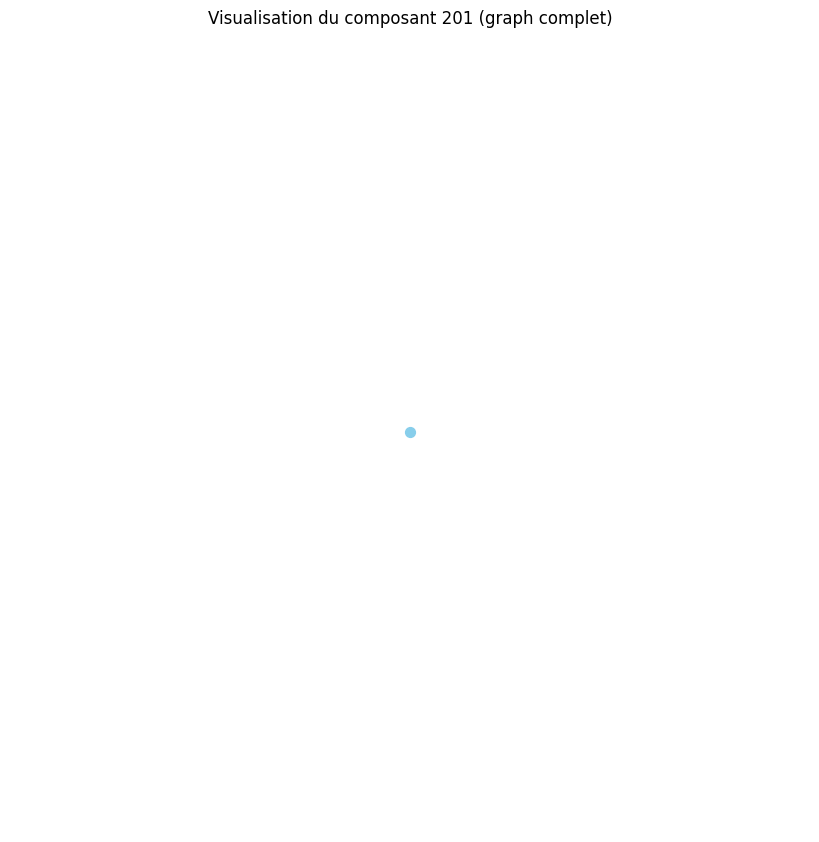

Distance moyenne pour le composant 202 : 0.00
Le composant 202 est un graphe complet ou très densément connecté.
Densité du composant 202 : 0.00
Degré moyen du composant 202 : 0.00
Coefficient de clustering moyen du composant 202 : 0.00


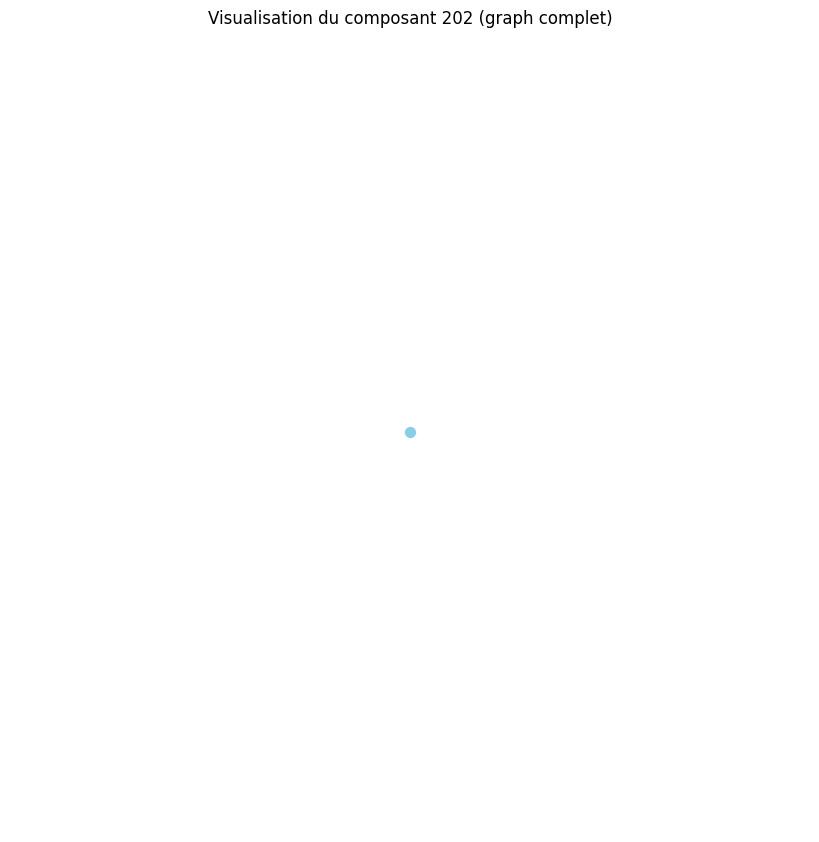

Distance moyenne pour le composant 203 : 0.00
Le composant 203 est un graphe complet ou très densément connecté.
Densité du composant 203 : 0.00
Degré moyen du composant 203 : 0.00
Coefficient de clustering moyen du composant 203 : 0.00


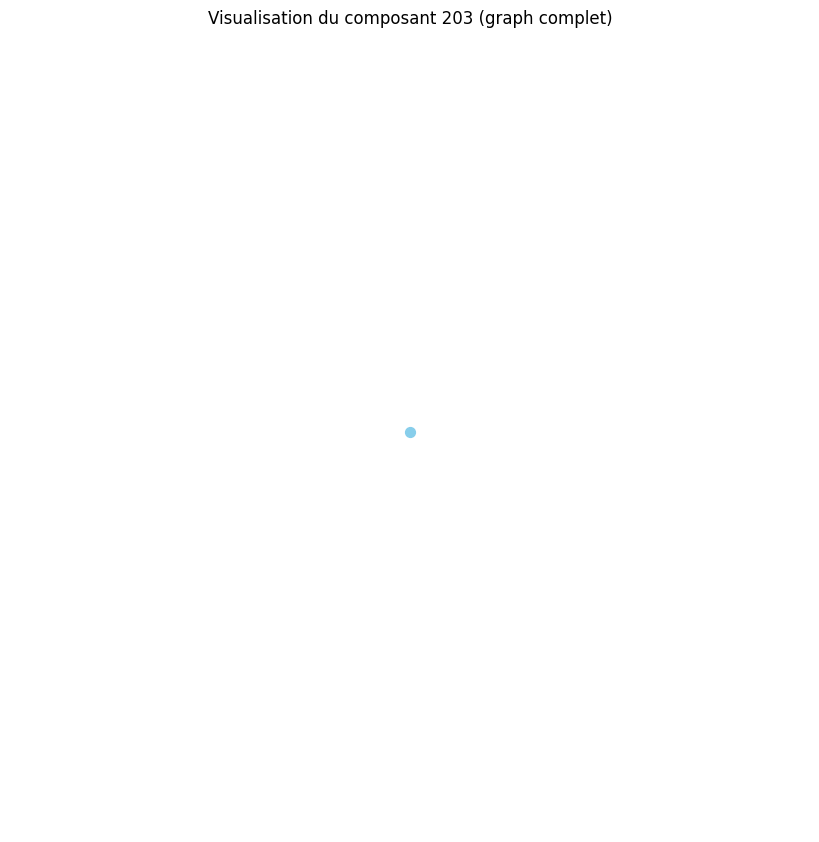

Distance moyenne pour le composant 204 : 0.00
Le composant 204 est un graphe complet ou très densément connecté.
Densité du composant 204 : 0.00
Degré moyen du composant 204 : 0.00
Coefficient de clustering moyen du composant 204 : 0.00


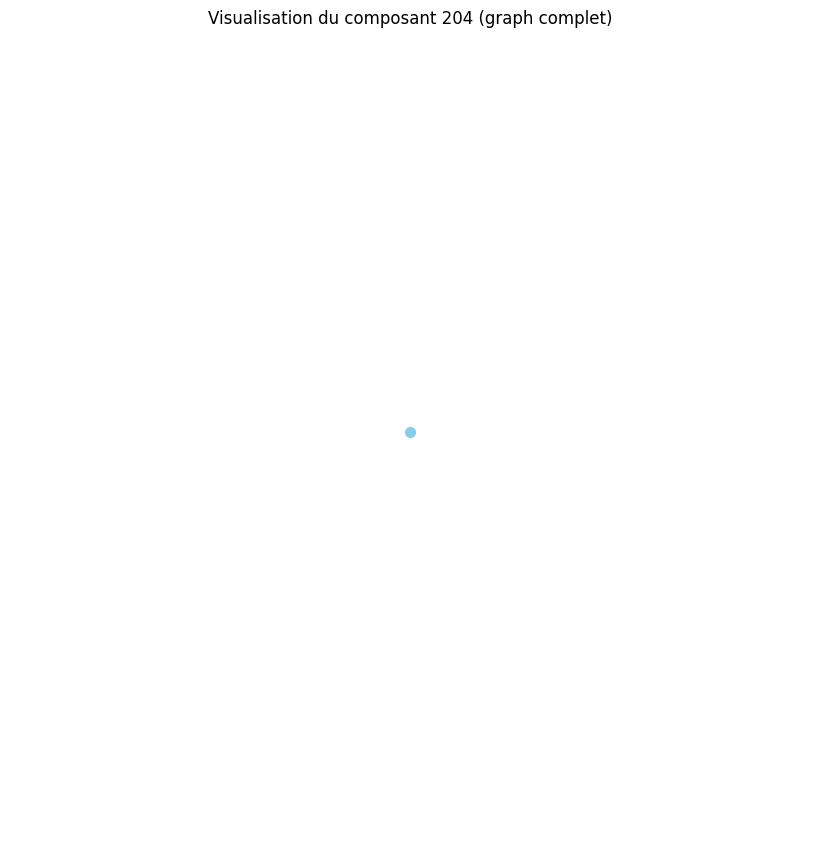

Distance moyenne pour le composant 205 : 0.00
Le composant 205 est un graphe complet ou très densément connecté.
Densité du composant 205 : 0.00
Degré moyen du composant 205 : 0.00
Coefficient de clustering moyen du composant 205 : 0.00


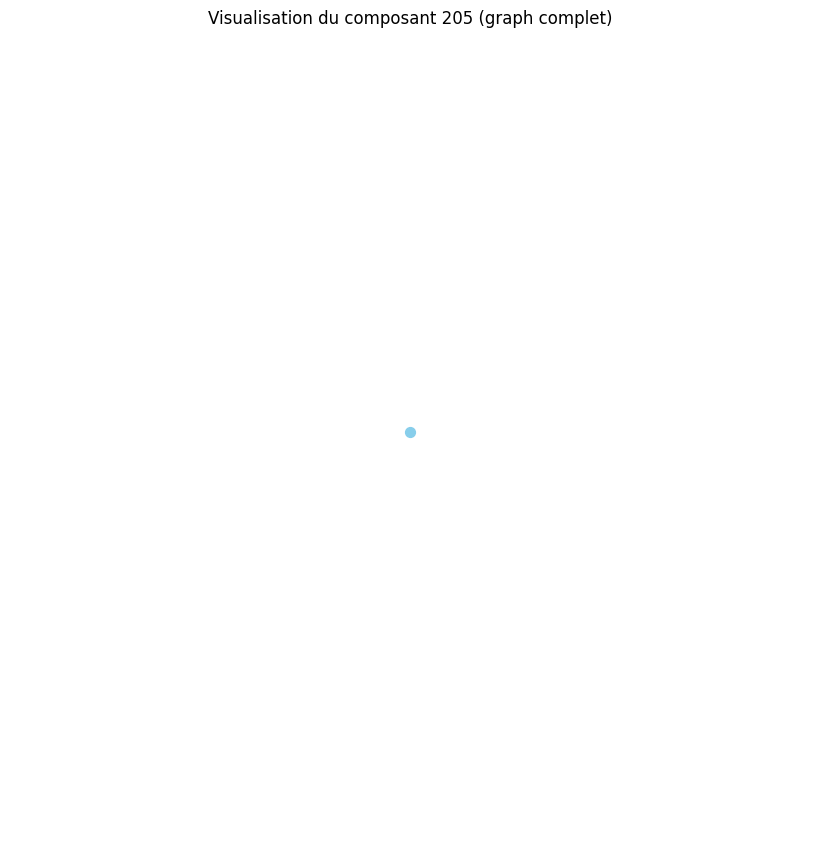

Distance moyenne pour le composant 206 : 0.00
Le composant 206 est un graphe complet ou très densément connecté.
Densité du composant 206 : 0.00
Degré moyen du composant 206 : 0.00
Coefficient de clustering moyen du composant 206 : 0.00


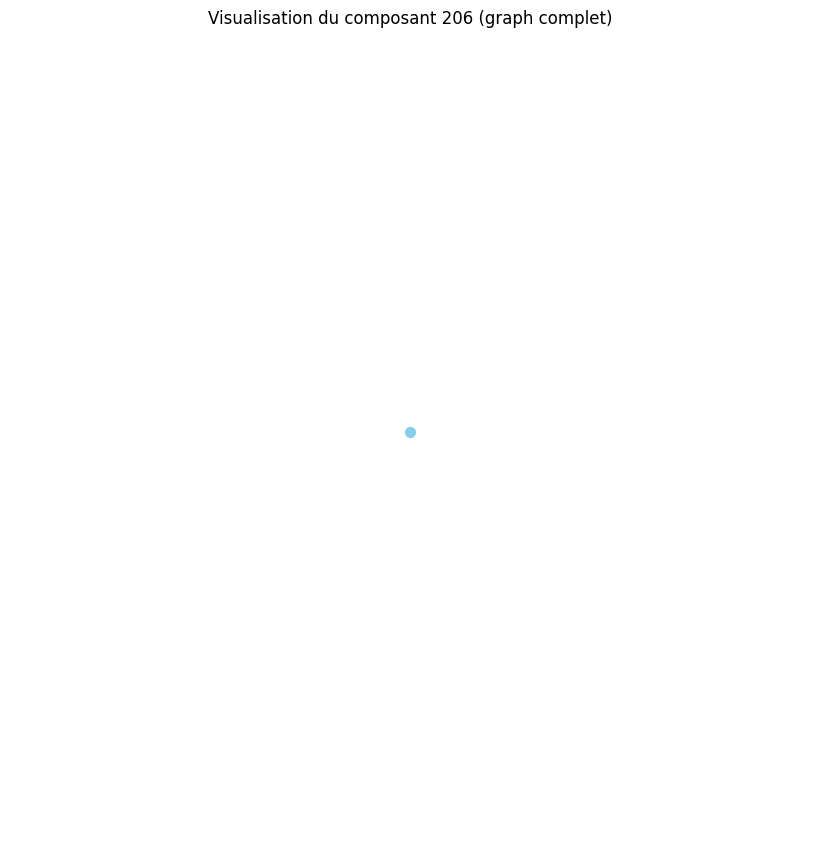

Distance moyenne pour le composant 207 : 0.00
Le composant 207 est un graphe complet ou très densément connecté.
Densité du composant 207 : 0.00
Degré moyen du composant 207 : 0.00
Coefficient de clustering moyen du composant 207 : 0.00


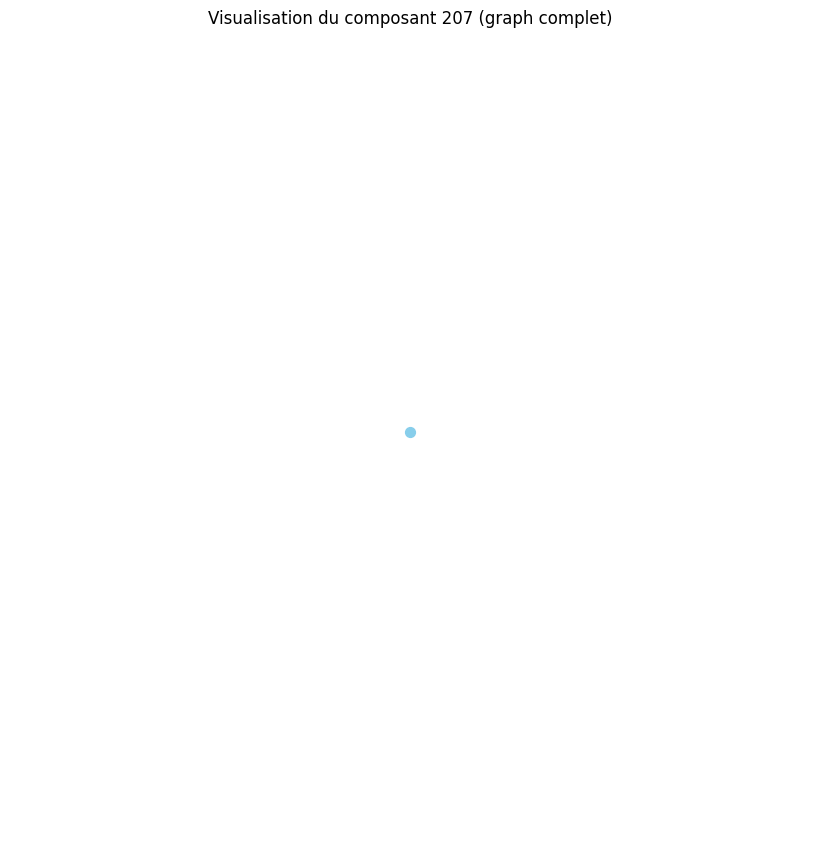

Distance moyenne pour le composant 208 : 0.00
Le composant 208 est un graphe complet ou très densément connecté.
Densité du composant 208 : 0.00
Degré moyen du composant 208 : 0.00
Coefficient de clustering moyen du composant 208 : 0.00


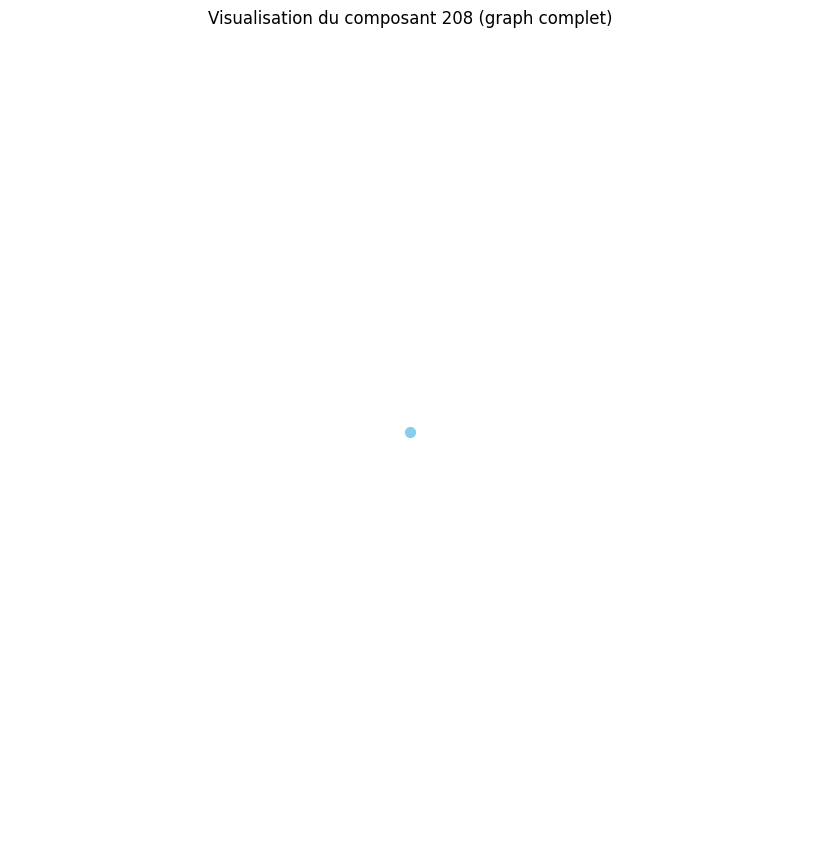

Distance moyenne pour le composant 209 : 1.00
Distance moyenne pour le composant 210 : 0.00
Le composant 210 est un graphe complet ou très densément connecté.
Densité du composant 210 : 0.00
Degré moyen du composant 210 : 0.00
Coefficient de clustering moyen du composant 210 : 0.00


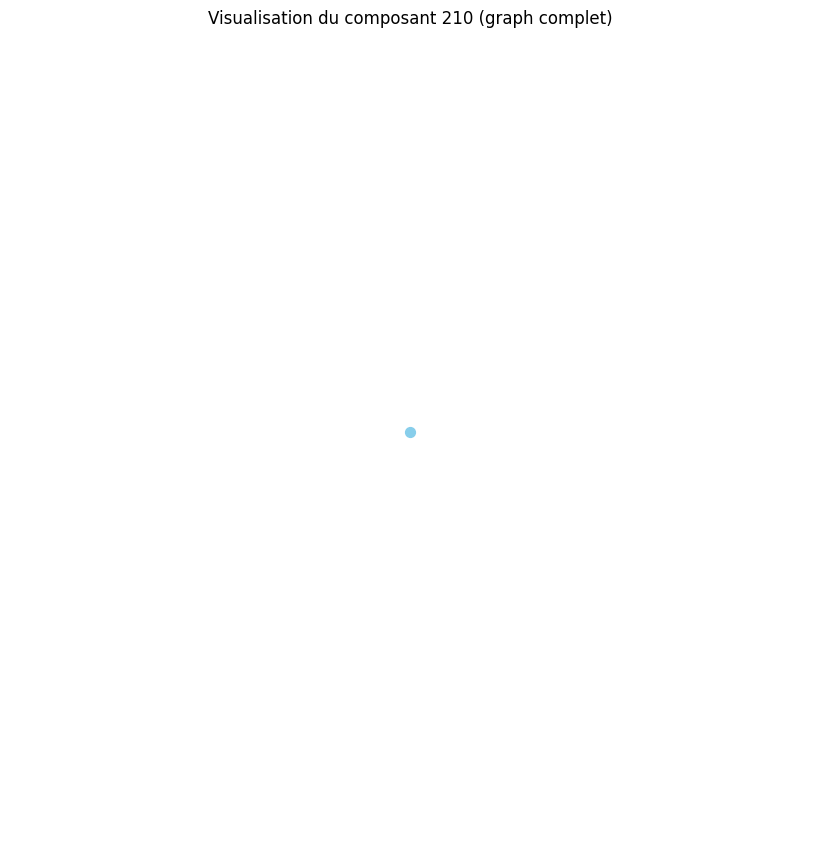

Distance moyenne pour le composant 211 : 0.00
Le composant 211 est un graphe complet ou très densément connecté.
Densité du composant 211 : 0.00
Degré moyen du composant 211 : 0.00
Coefficient de clustering moyen du composant 211 : 0.00


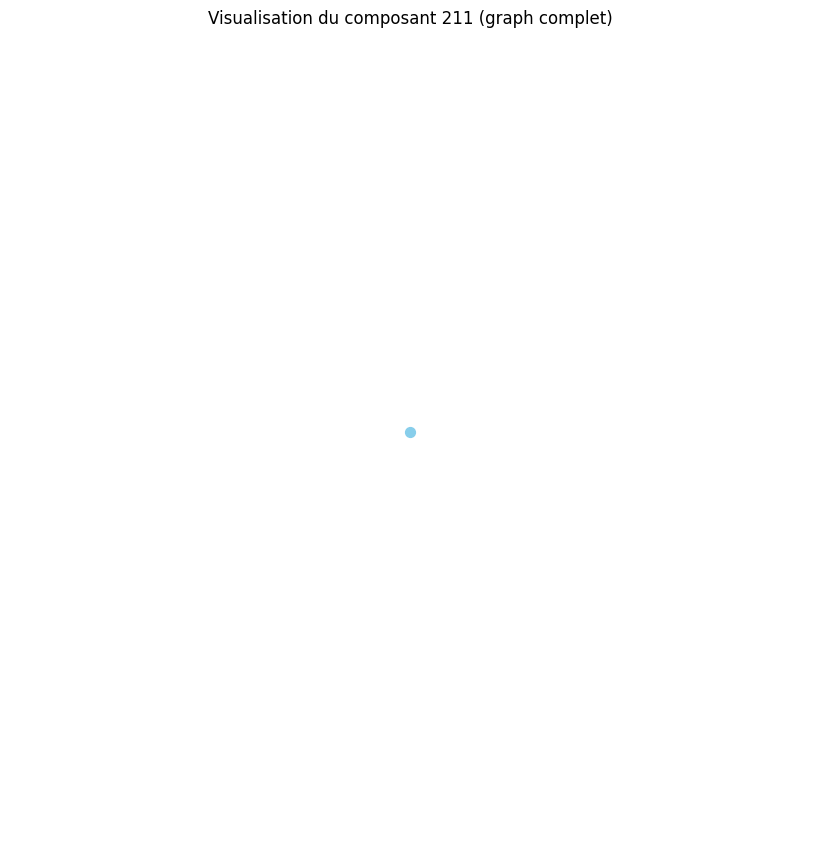

Distance moyenne pour le composant 212 : 0.00
Le composant 212 est un graphe complet ou très densément connecté.
Densité du composant 212 : 0.00
Degré moyen du composant 212 : 0.00
Coefficient de clustering moyen du composant 212 : 0.00


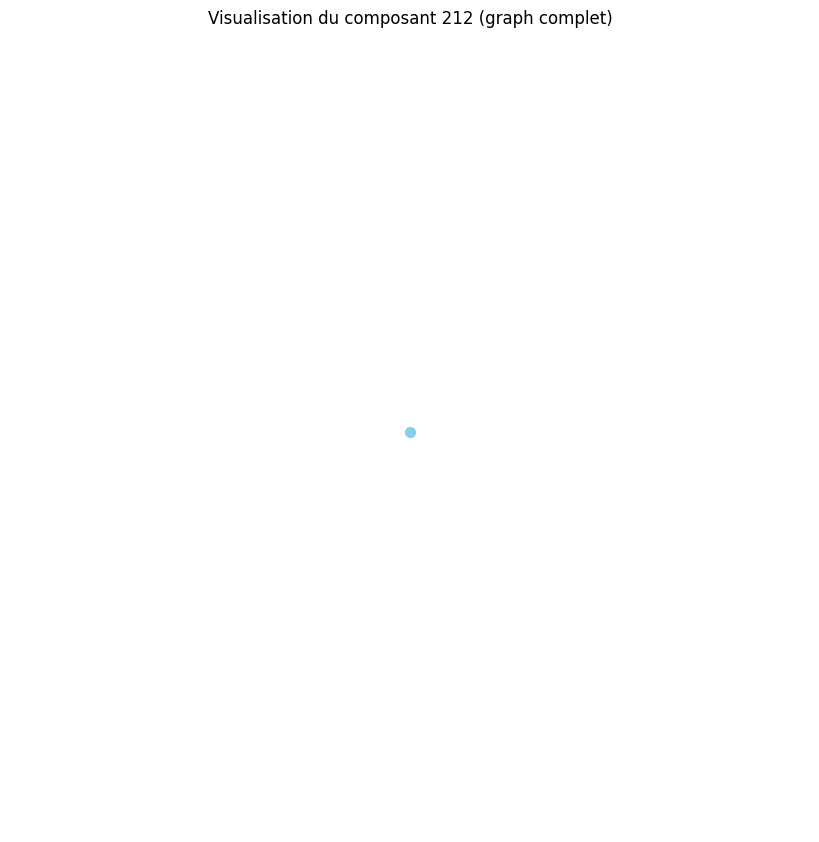

Distance moyenne pour le composant 213 : 0.00
Le composant 213 est un graphe complet ou très densément connecté.
Densité du composant 213 : 0.00
Degré moyen du composant 213 : 0.00
Coefficient de clustering moyen du composant 213 : 0.00


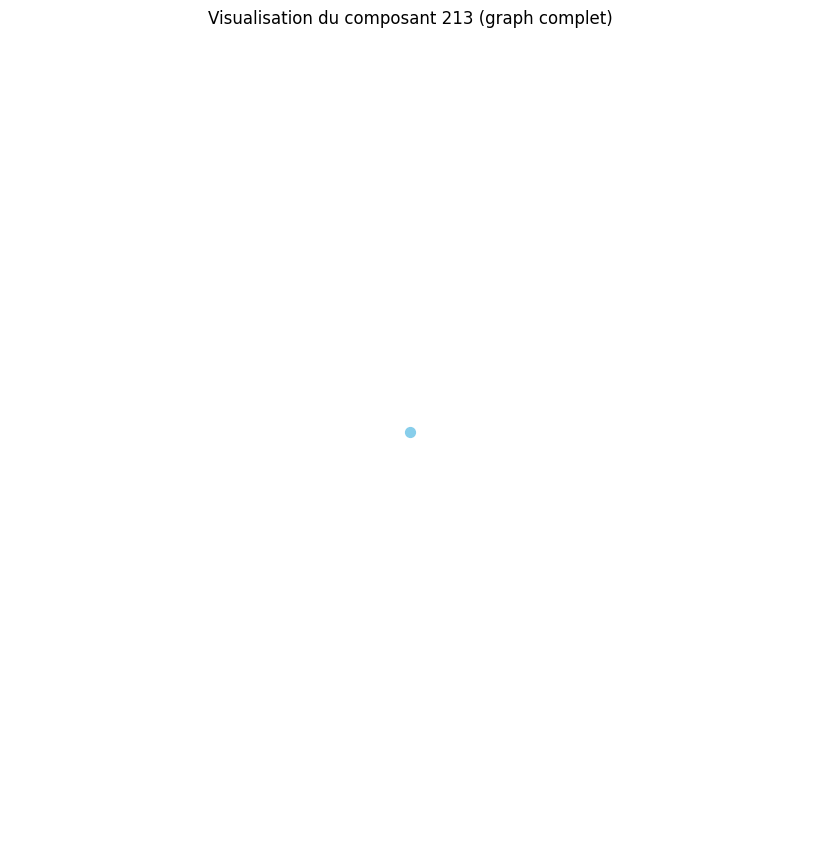

Distance moyenne pour le composant 214 : 0.00
Le composant 214 est un graphe complet ou très densément connecté.
Densité du composant 214 : 0.00
Degré moyen du composant 214 : 0.00
Coefficient de clustering moyen du composant 214 : 0.00


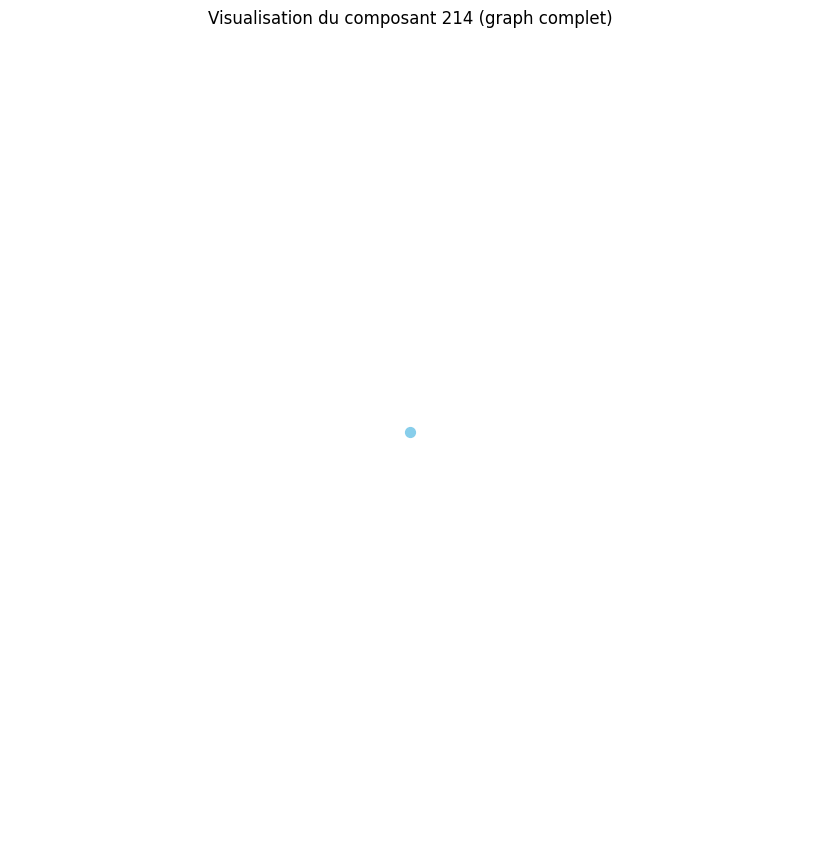

Distance moyenne pour le composant 215 : 0.00
Le composant 215 est un graphe complet ou très densément connecté.
Densité du composant 215 : 0.00
Degré moyen du composant 215 : 0.00
Coefficient de clustering moyen du composant 215 : 0.00


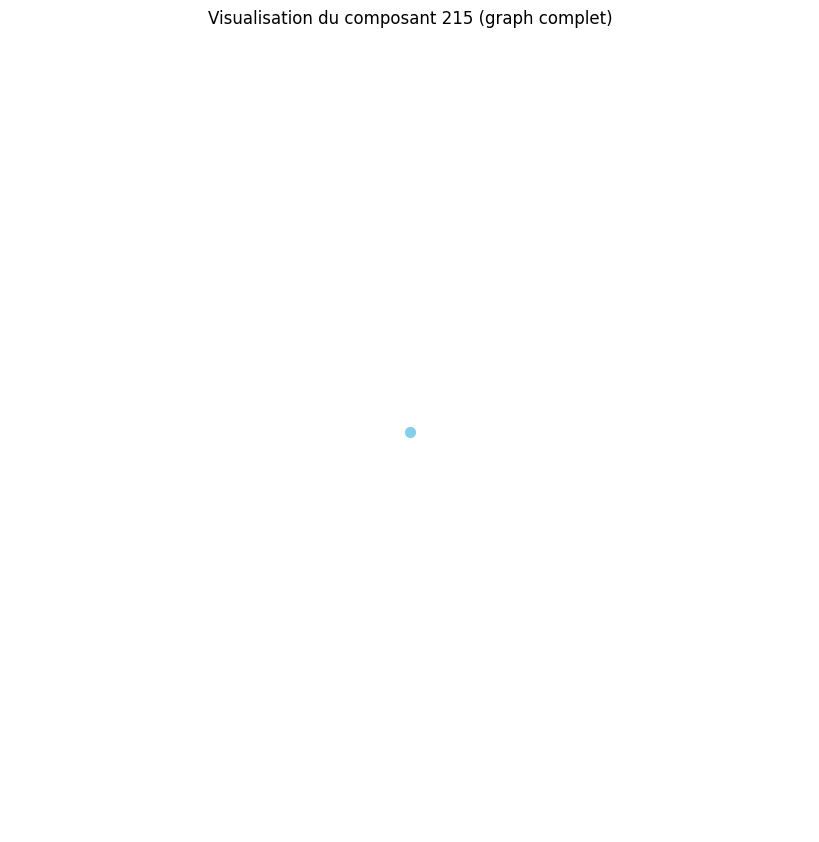

Distance moyenne pour le composant 216 : 0.00
Le composant 216 est un graphe complet ou très densément connecté.
Densité du composant 216 : 0.00
Degré moyen du composant 216 : 0.00
Coefficient de clustering moyen du composant 216 : 0.00


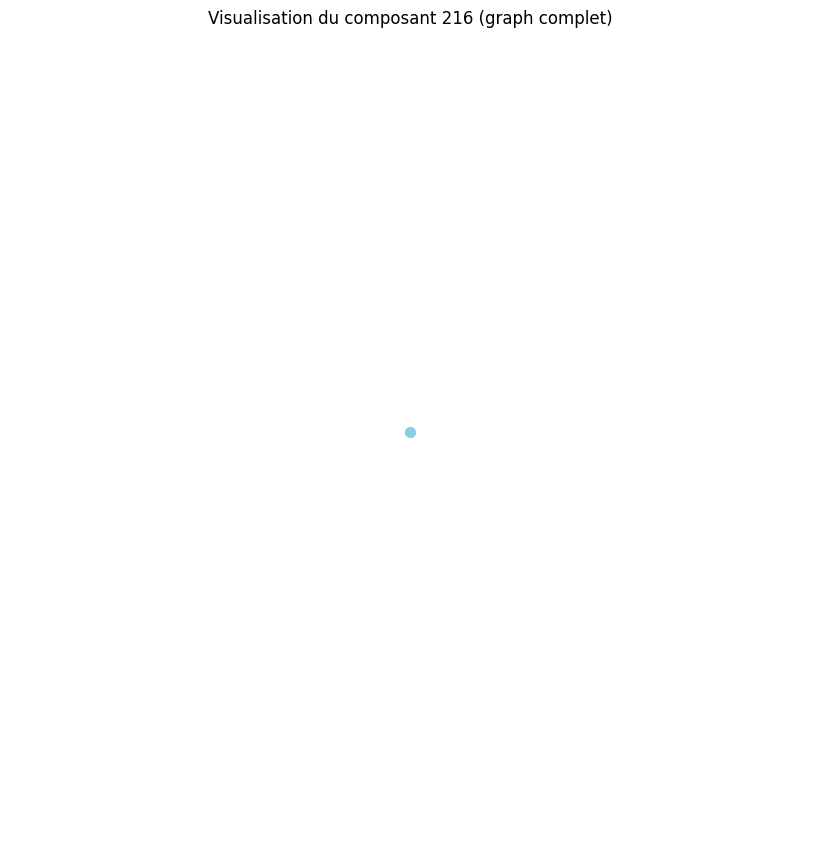

Distance moyenne pour le composant 217 : 0.00
Le composant 217 est un graphe complet ou très densément connecté.
Densité du composant 217 : 0.00
Degré moyen du composant 217 : 0.00
Coefficient de clustering moyen du composant 217 : 0.00


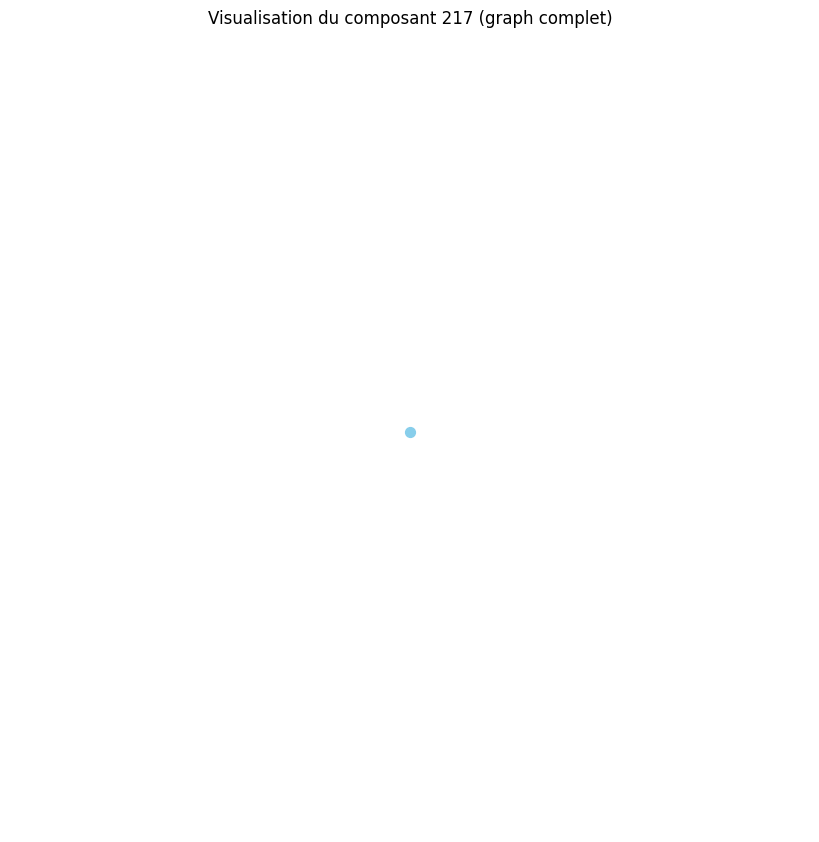

Distance moyenne pour le composant 218 : 0.00
Le composant 218 est un graphe complet ou très densément connecté.
Densité du composant 218 : 0.00
Degré moyen du composant 218 : 0.00
Coefficient de clustering moyen du composant 218 : 0.00


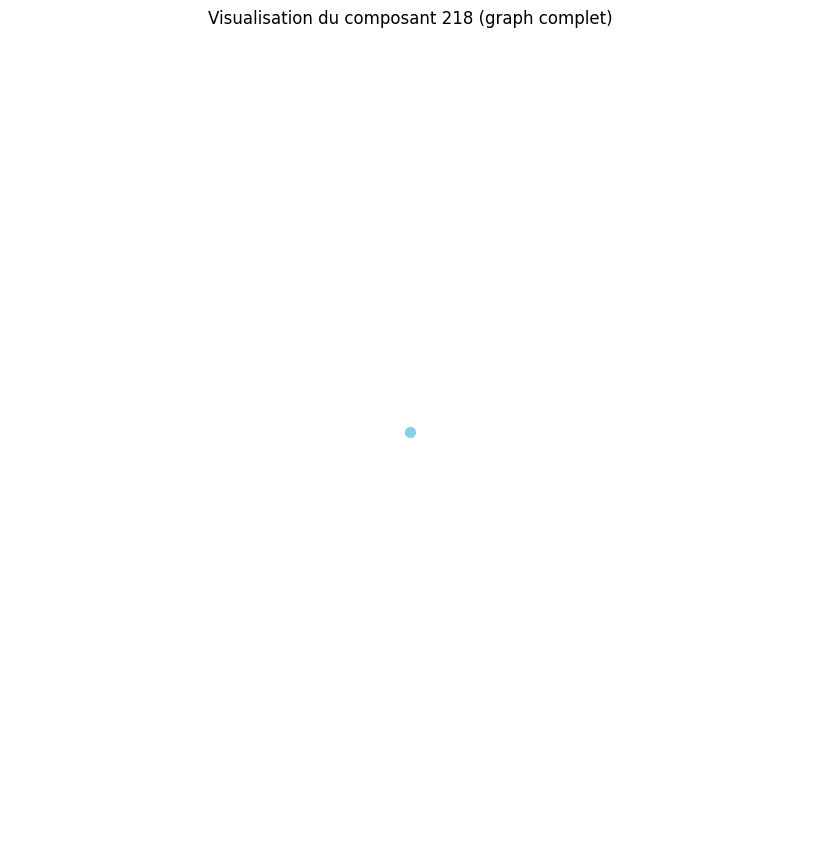

Distance moyenne pour le composant 219 : 1.00
Distance moyenne pour le composant 220 : 0.00
Le composant 220 est un graphe complet ou très densément connecté.
Densité du composant 220 : 0.00
Degré moyen du composant 220 : 0.00
Coefficient de clustering moyen du composant 220 : 0.00


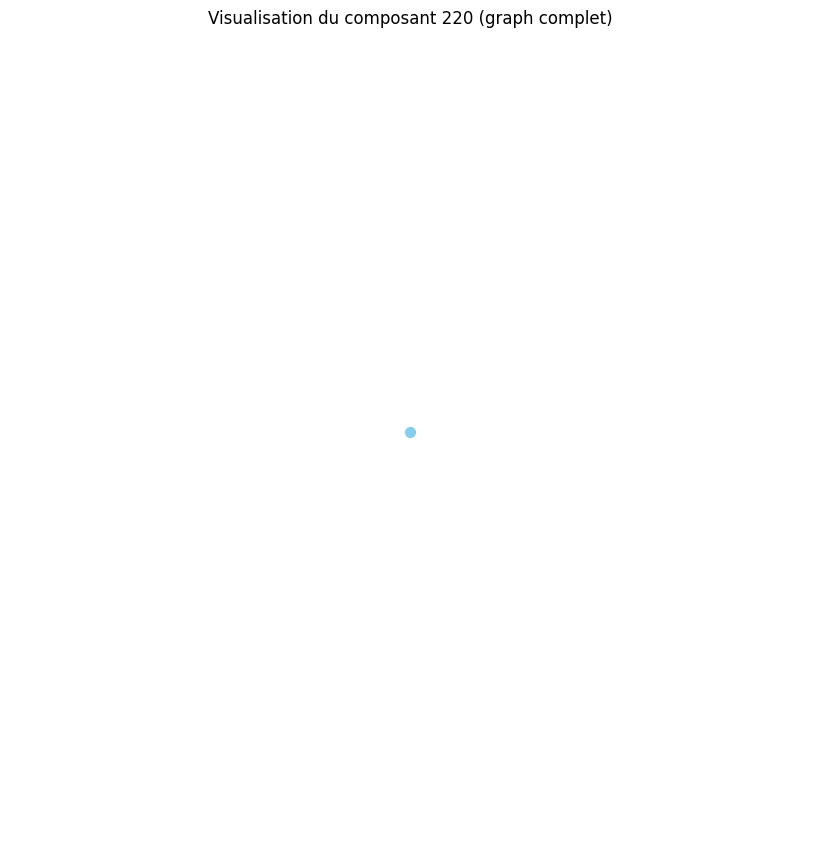

Distance moyenne pour le composant 221 : 0.00
Le composant 221 est un graphe complet ou très densément connecté.
Densité du composant 221 : 0.00
Degré moyen du composant 221 : 0.00
Coefficient de clustering moyen du composant 221 : 0.00


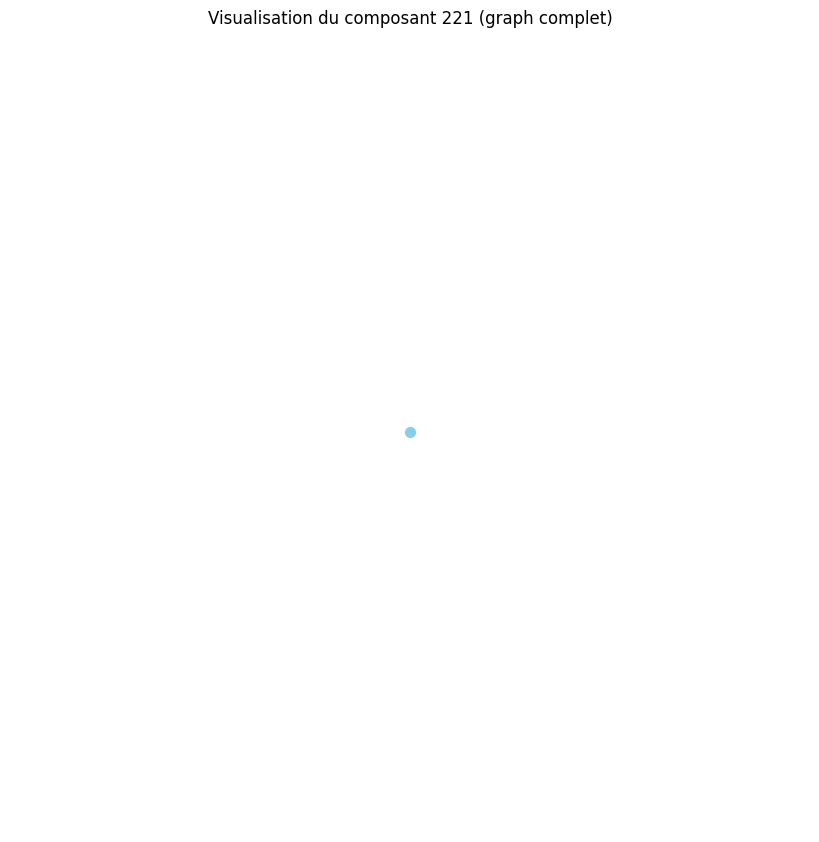

Distance moyenne pour le composant 222 : 0.00
Le composant 222 est un graphe complet ou très densément connecté.
Densité du composant 222 : 0.00
Degré moyen du composant 222 : 0.00
Coefficient de clustering moyen du composant 222 : 0.00


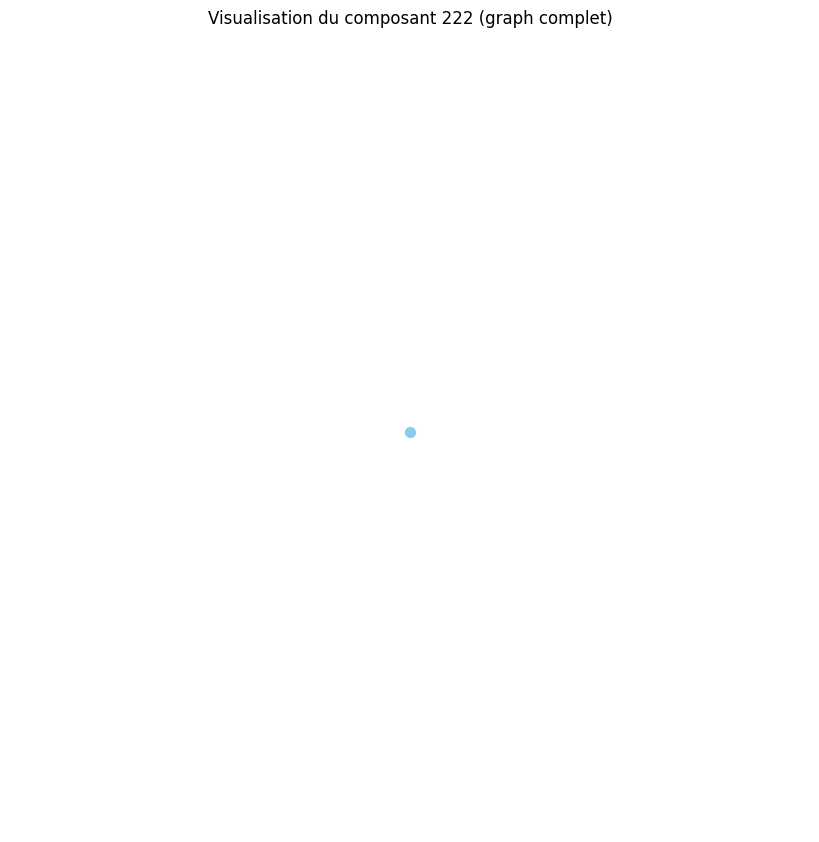

Distance moyenne pour le composant 223 : 0.00
Le composant 223 est un graphe complet ou très densément connecté.
Densité du composant 223 : 0.00
Degré moyen du composant 223 : 0.00
Coefficient de clustering moyen du composant 223 : 0.00


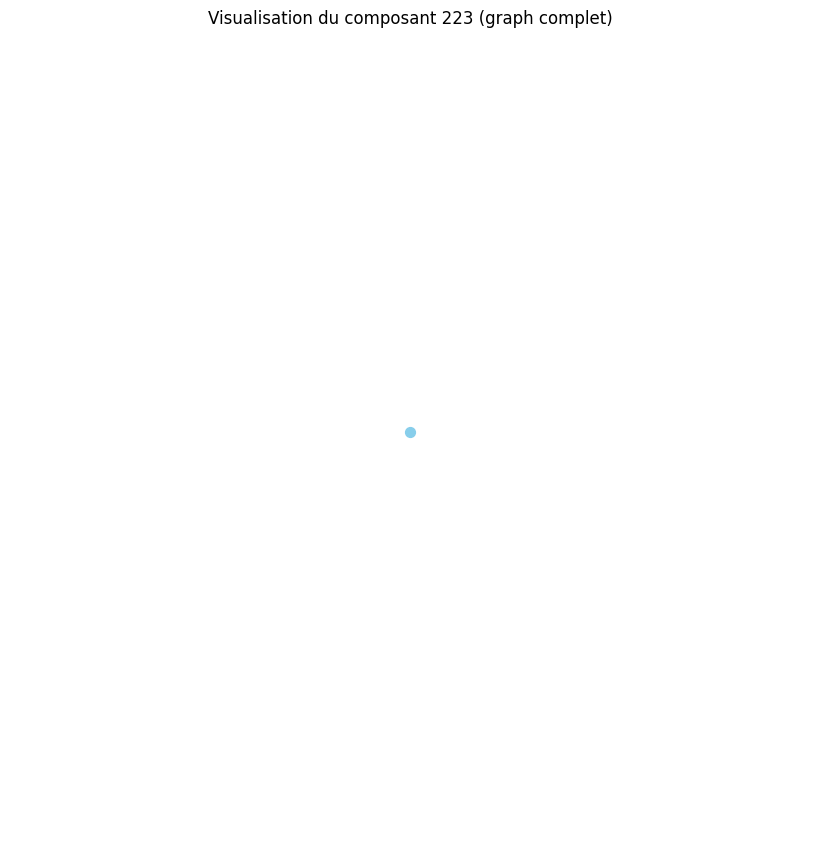

Distance moyenne pour le composant 224 : 0.00
Le composant 224 est un graphe complet ou très densément connecté.
Densité du composant 224 : 0.00
Degré moyen du composant 224 : 0.00
Coefficient de clustering moyen du composant 224 : 0.00


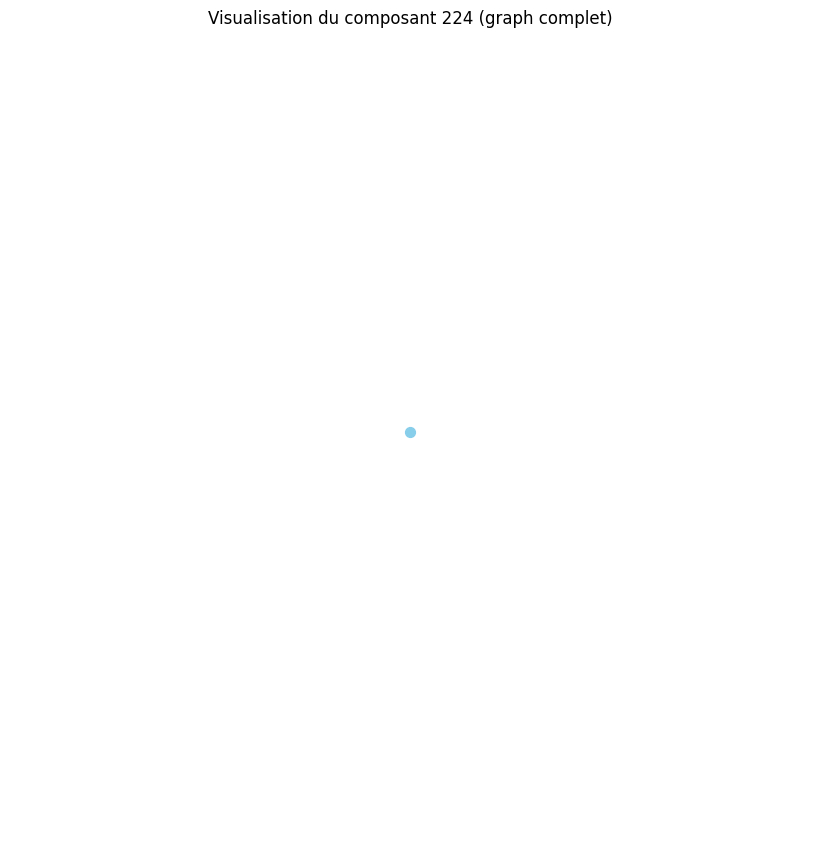

Distance moyenne pour le composant 225 : 0.00
Le composant 225 est un graphe complet ou très densément connecté.
Densité du composant 225 : 0.00
Degré moyen du composant 225 : 0.00
Coefficient de clustering moyen du composant 225 : 0.00


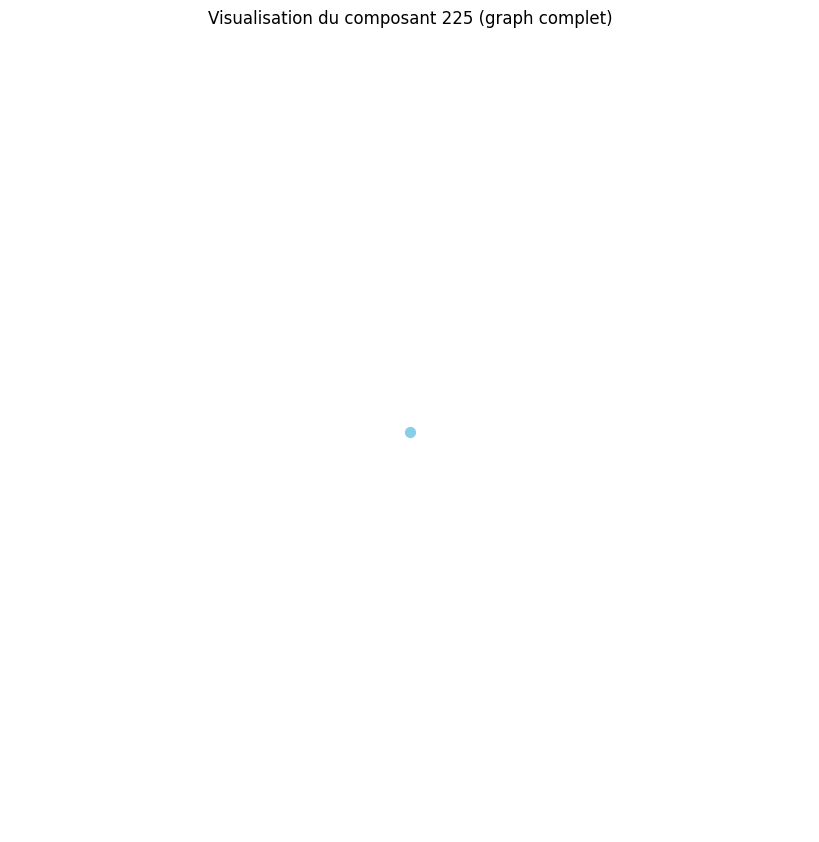

Distance moyenne pour le composant 226 : 0.00
Le composant 226 est un graphe complet ou très densément connecté.
Densité du composant 226 : 0.00
Degré moyen du composant 226 : 0.00
Coefficient de clustering moyen du composant 226 : 0.00


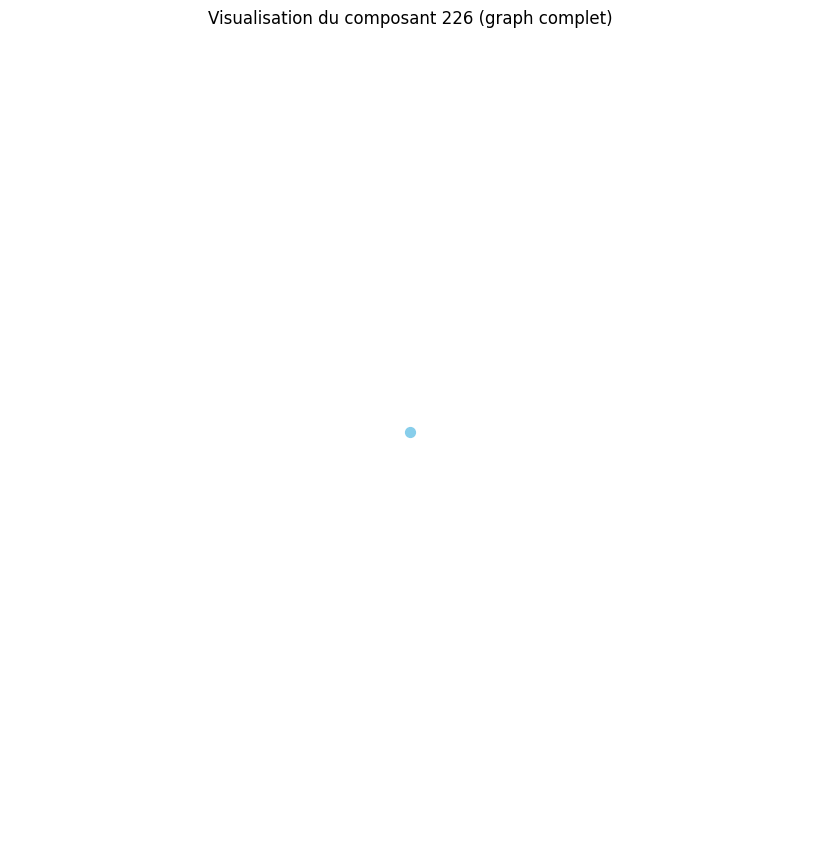

Distance moyenne pour le composant 227 : 0.00
Le composant 227 est un graphe complet ou très densément connecté.
Densité du composant 227 : 0.00
Degré moyen du composant 227 : 0.00
Coefficient de clustering moyen du composant 227 : 0.00


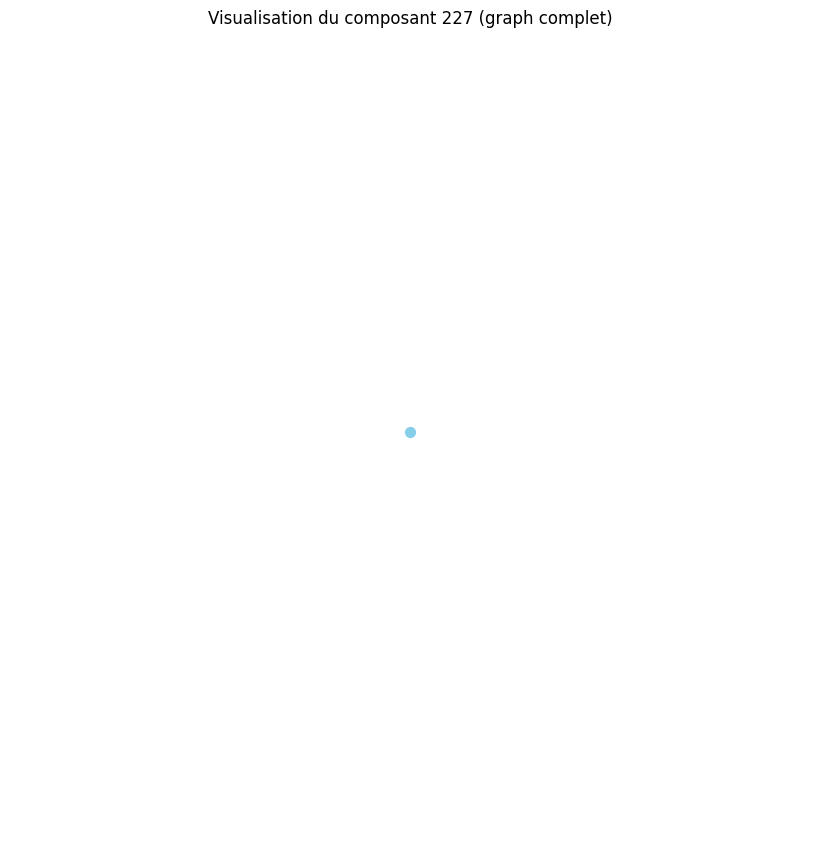

Distance moyenne pour le composant 228 : 0.00
Le composant 228 est un graphe complet ou très densément connecté.
Densité du composant 228 : 0.00
Degré moyen du composant 228 : 0.00
Coefficient de clustering moyen du composant 228 : 0.00


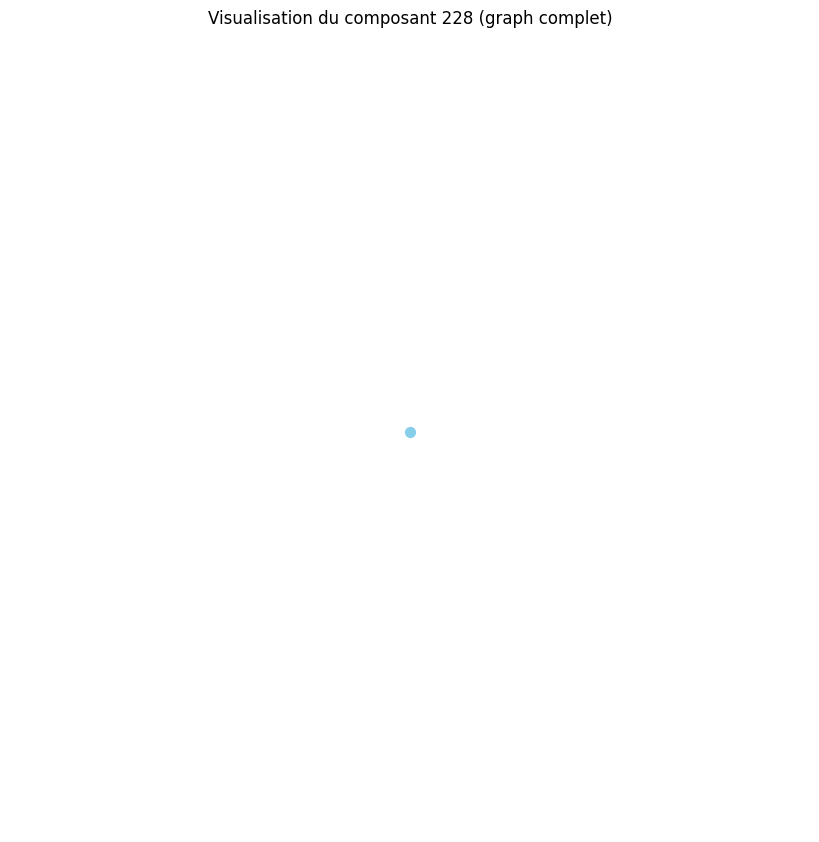

Distance moyenne pour le composant 229 : 0.00
Le composant 229 est un graphe complet ou très densément connecté.
Densité du composant 229 : 0.00
Degré moyen du composant 229 : 0.00
Coefficient de clustering moyen du composant 229 : 0.00


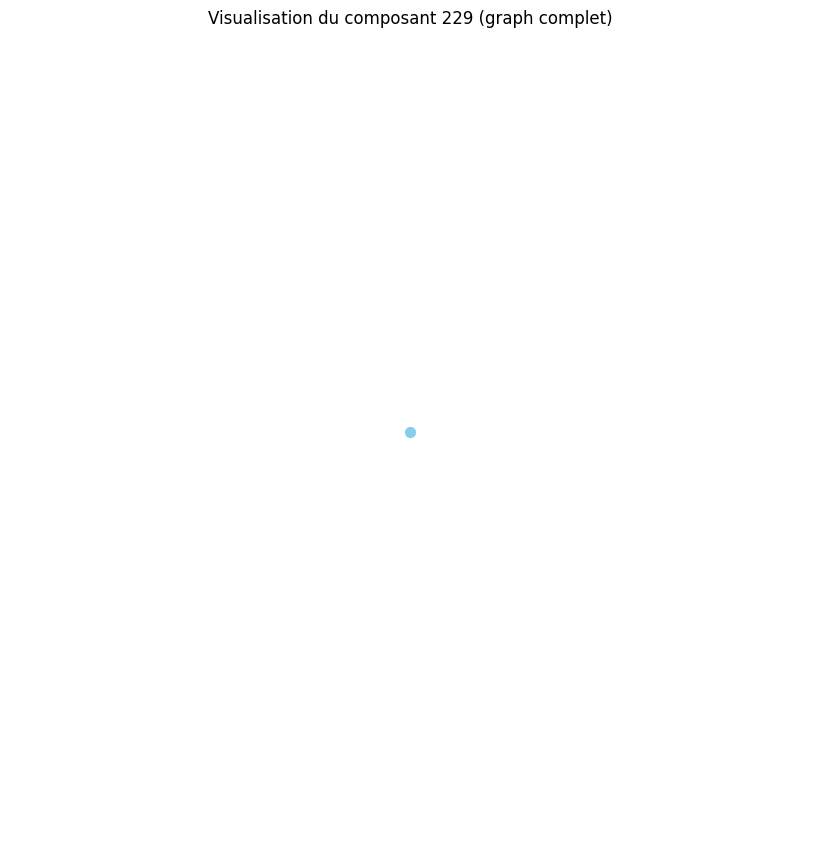

Distance moyenne pour le composant 230 : 0.00
Le composant 230 est un graphe complet ou très densément connecté.
Densité du composant 230 : 0.00
Degré moyen du composant 230 : 0.00
Coefficient de clustering moyen du composant 230 : 0.00


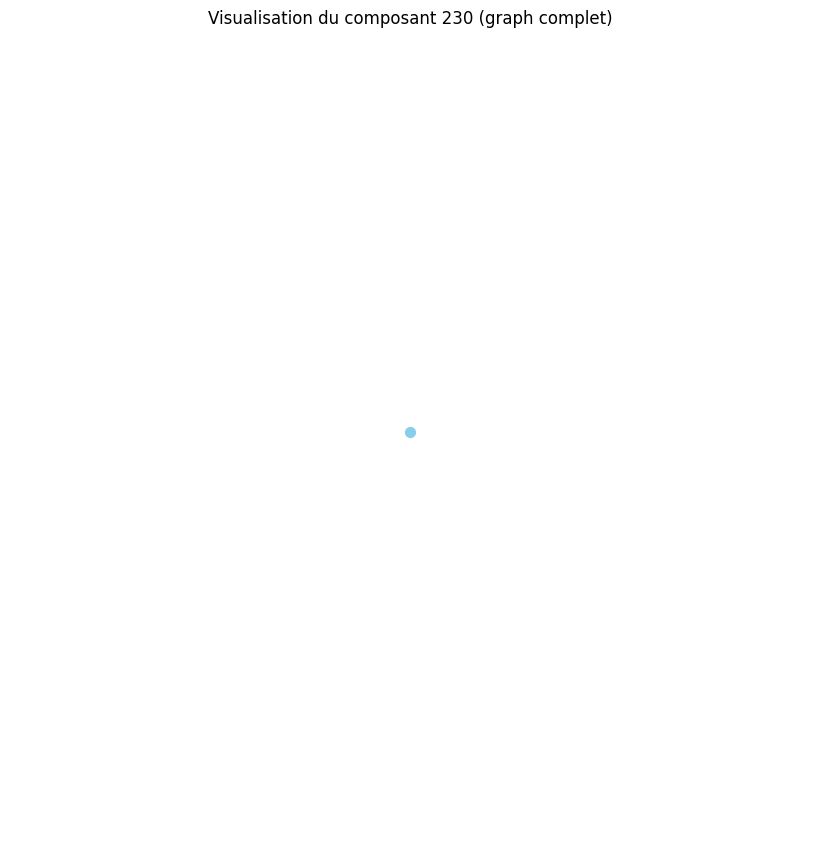

Distance moyenne pour le composant 231 : 0.00
Le composant 231 est un graphe complet ou très densément connecté.
Densité du composant 231 : 0.00
Degré moyen du composant 231 : 0.00
Coefficient de clustering moyen du composant 231 : 0.00


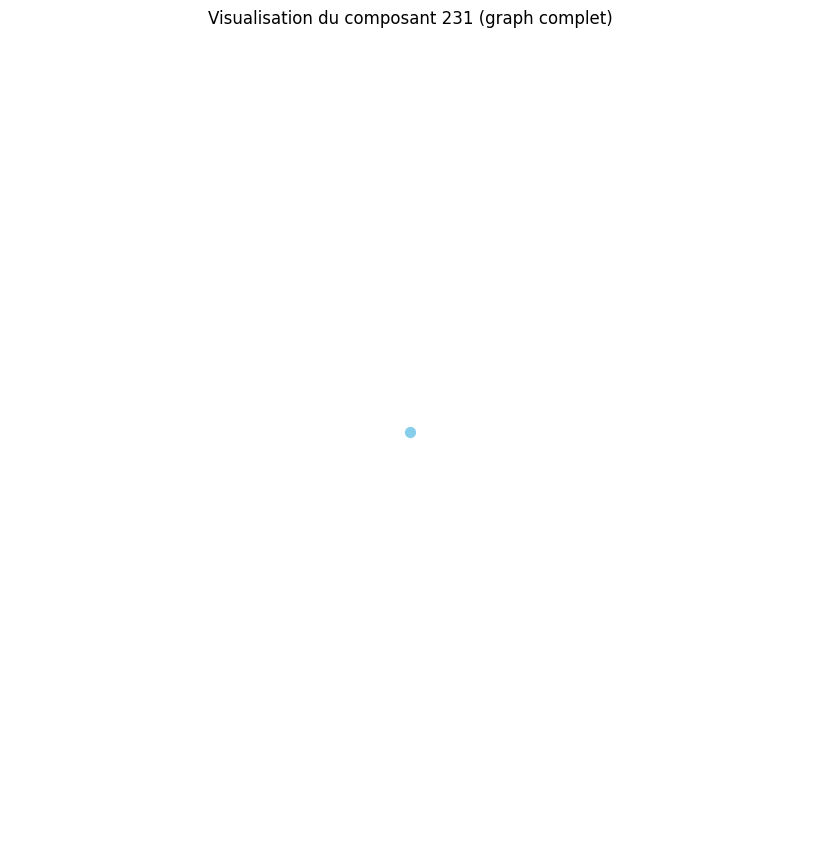

Distance moyenne pour le composant 232 : 0.00
Le composant 232 est un graphe complet ou très densément connecté.
Densité du composant 232 : 0.00
Degré moyen du composant 232 : 0.00
Coefficient de clustering moyen du composant 232 : 0.00


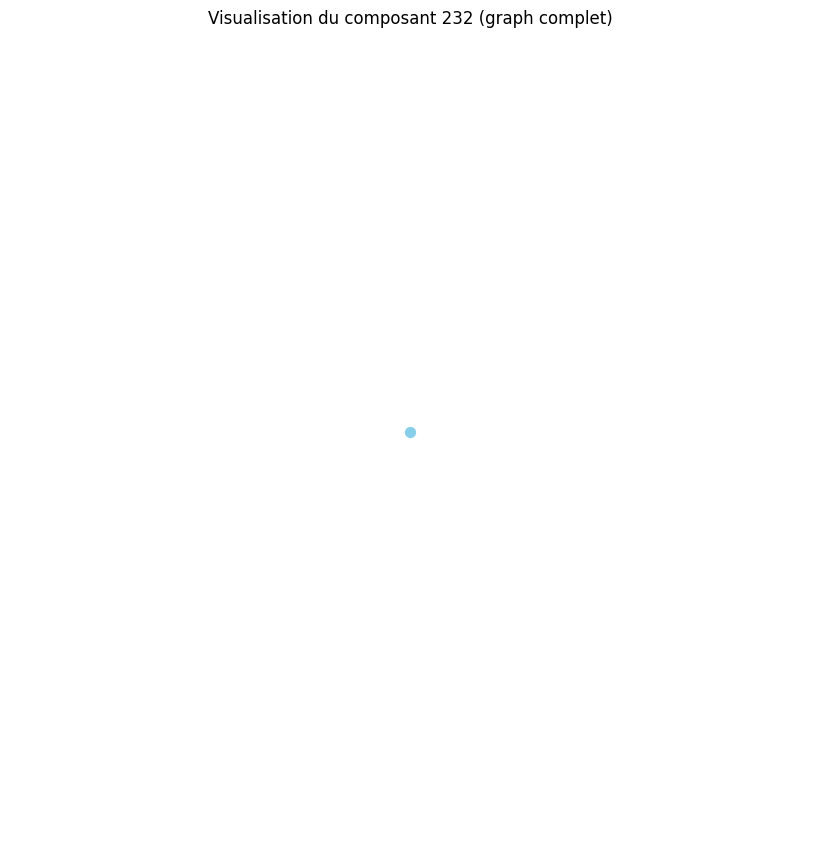

Distance moyenne pour le composant 233 : 0.00
Le composant 233 est un graphe complet ou très densément connecté.
Densité du composant 233 : 0.00
Degré moyen du composant 233 : 0.00
Coefficient de clustering moyen du composant 233 : 0.00


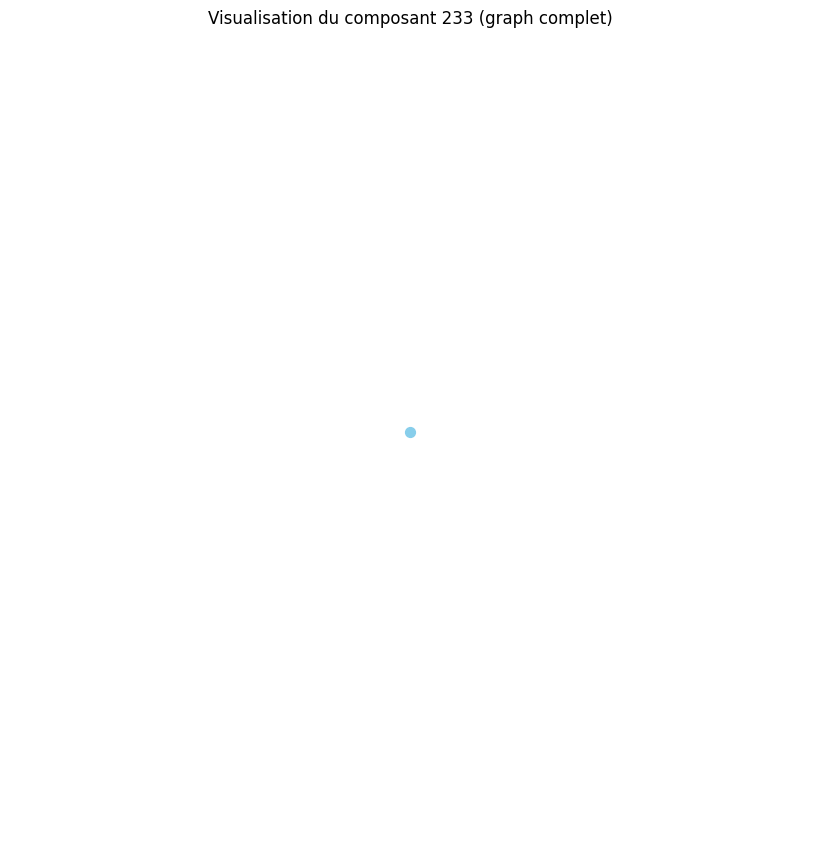

Distance moyenne pour le composant 234 : 0.00
Le composant 234 est un graphe complet ou très densément connecté.
Densité du composant 234 : 0.00
Degré moyen du composant 234 : 0.00
Coefficient de clustering moyen du composant 234 : 0.00


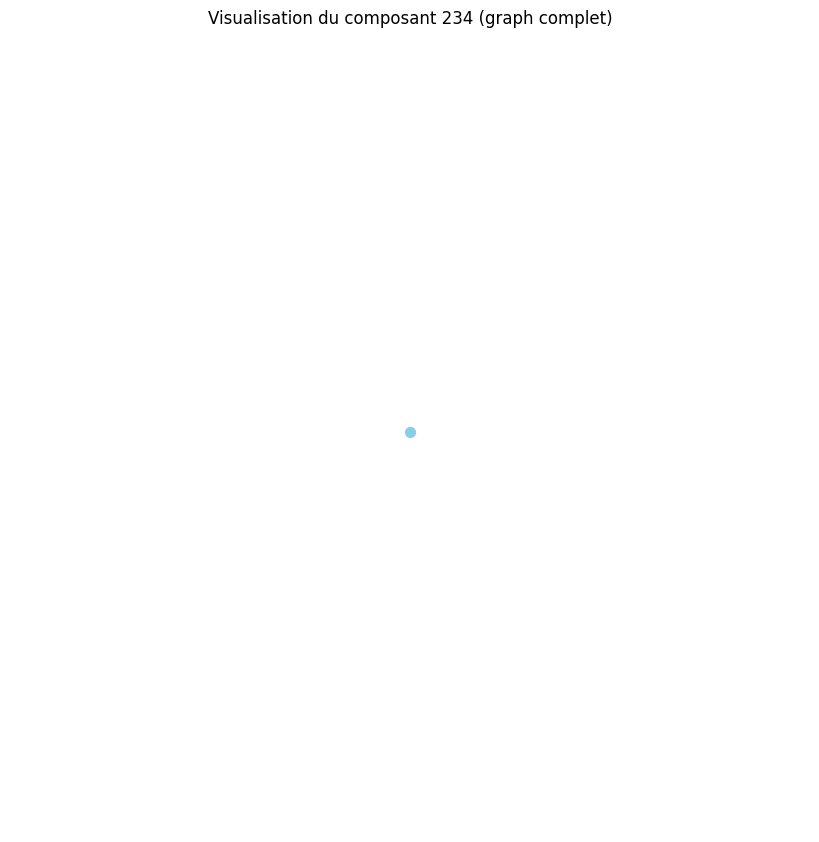

Distance moyenne pour le composant 235 : 0.00
Le composant 235 est un graphe complet ou très densément connecté.
Densité du composant 235 : 0.00
Degré moyen du composant 235 : 0.00
Coefficient de clustering moyen du composant 235 : 0.00


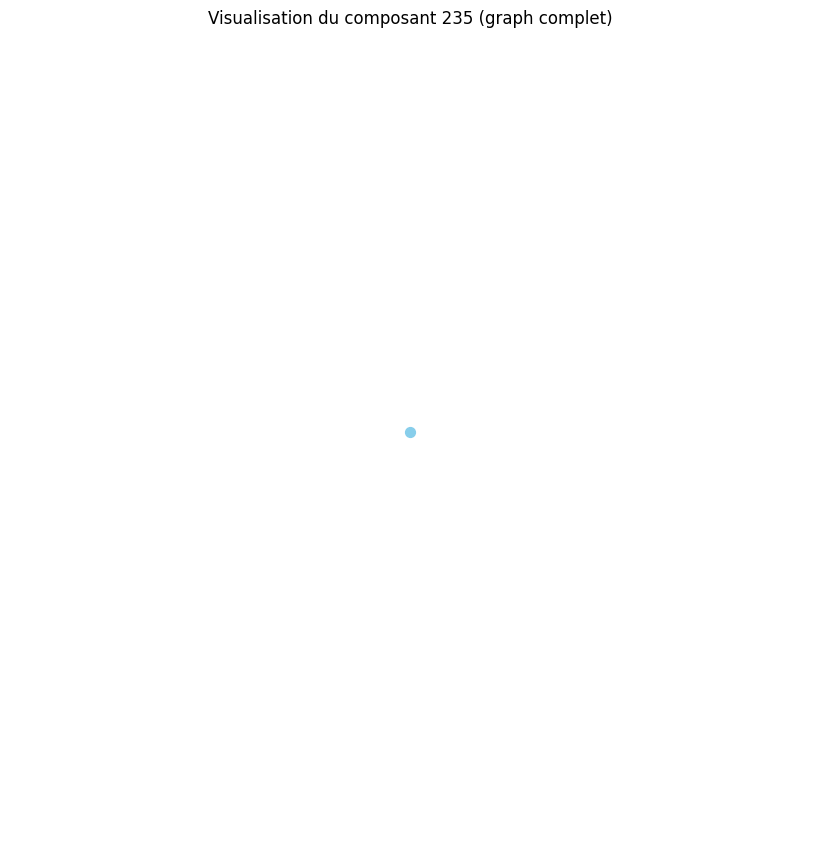

Distance moyenne pour le composant 236 : 0.00
Le composant 236 est un graphe complet ou très densément connecté.
Densité du composant 236 : 0.00
Degré moyen du composant 236 : 0.00
Coefficient de clustering moyen du composant 236 : 0.00


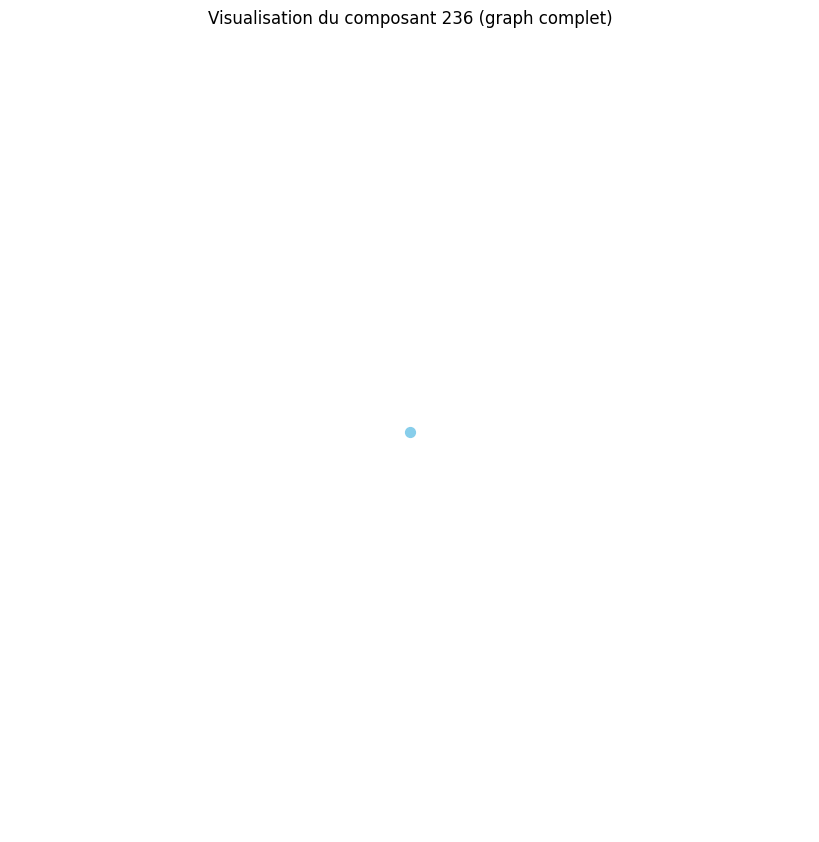

Distance moyenne pour le composant 237 : 0.00
Le composant 237 est un graphe complet ou très densément connecté.
Densité du composant 237 : 0.00
Degré moyen du composant 237 : 0.00
Coefficient de clustering moyen du composant 237 : 0.00


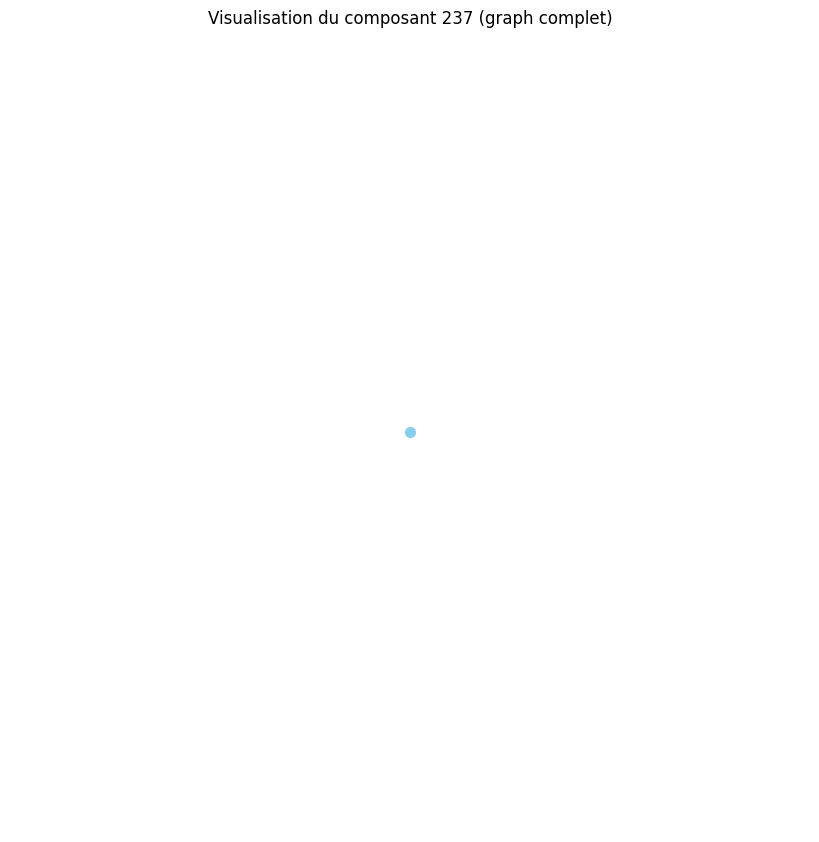

Distance moyenne pour le composant 238 : 0.00
Le composant 238 est un graphe complet ou très densément connecté.
Densité du composant 238 : 0.00
Degré moyen du composant 238 : 0.00
Coefficient de clustering moyen du composant 238 : 0.00


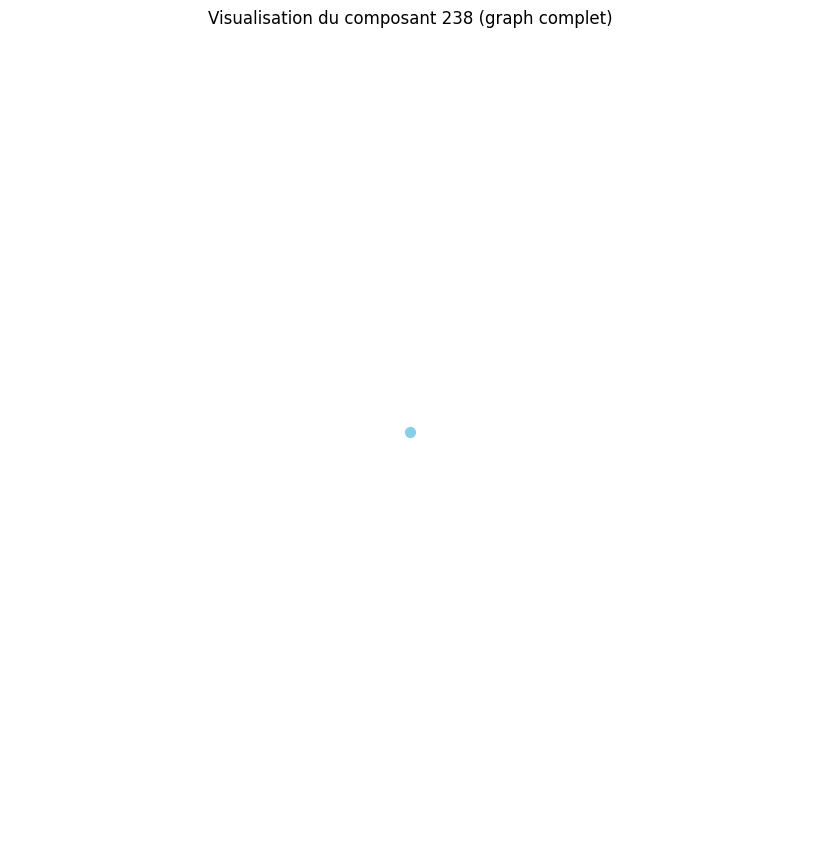

Distance moyenne pour le composant 239 : 1.87
Distance moyenne pour le composant 240 : 0.00
Le composant 240 est un graphe complet ou très densément connecté.
Densité du composant 240 : 0.00
Degré moyen du composant 240 : 0.00
Coefficient de clustering moyen du composant 240 : 0.00


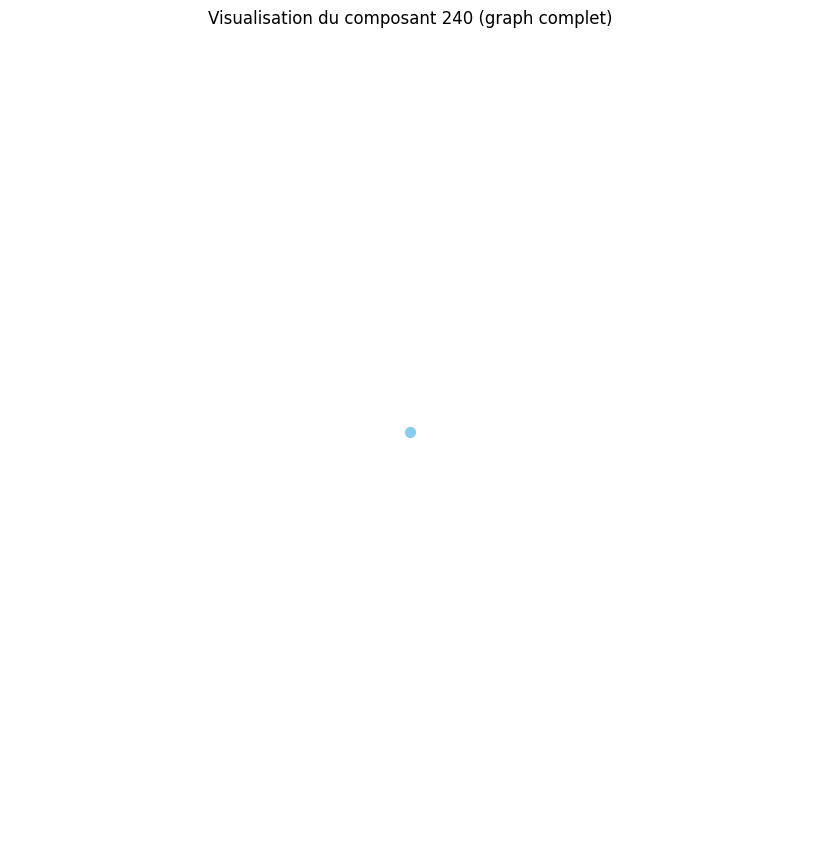

Distance moyenne pour le composant 241 : 0.00
Le composant 241 est un graphe complet ou très densément connecté.
Densité du composant 241 : 0.00
Degré moyen du composant 241 : 0.00
Coefficient de clustering moyen du composant 241 : 0.00


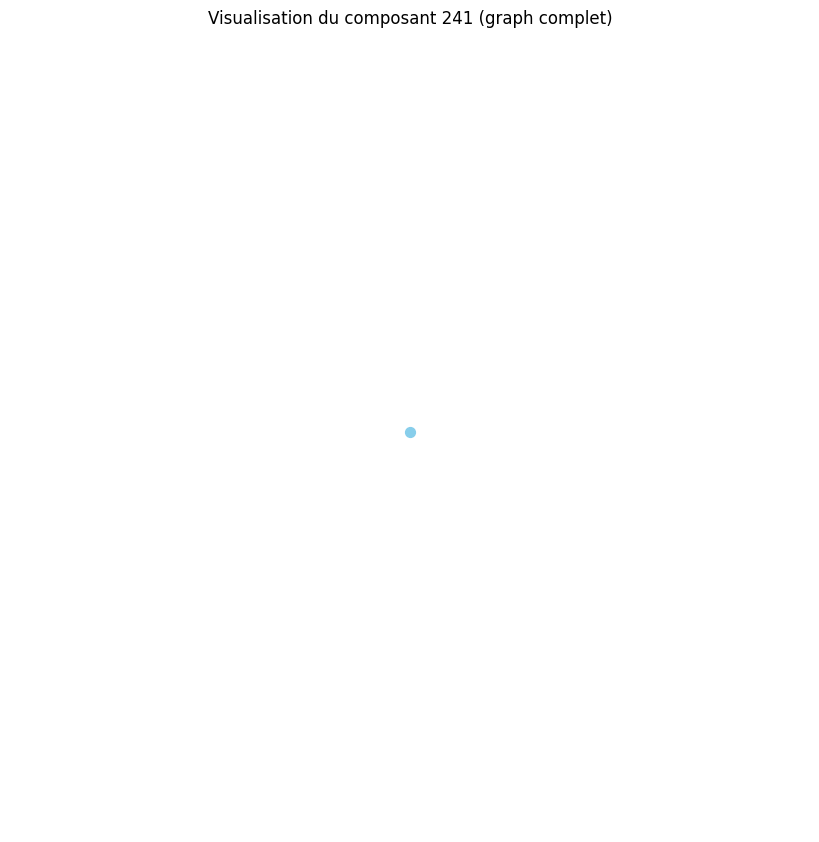

Distance moyenne pour le composant 242 : 0.00
Le composant 242 est un graphe complet ou très densément connecté.
Densité du composant 242 : 0.00
Degré moyen du composant 242 : 0.00
Coefficient de clustering moyen du composant 242 : 0.00


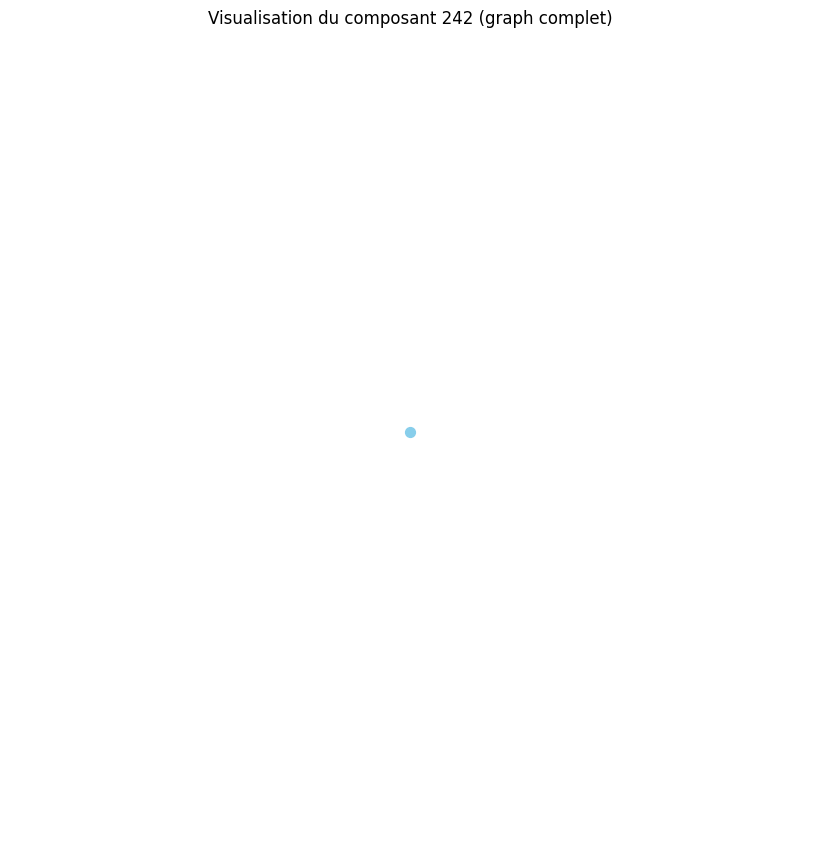

Distance moyenne pour le composant 243 : 0.00
Le composant 243 est un graphe complet ou très densément connecté.
Densité du composant 243 : 0.00
Degré moyen du composant 243 : 0.00
Coefficient de clustering moyen du composant 243 : 0.00


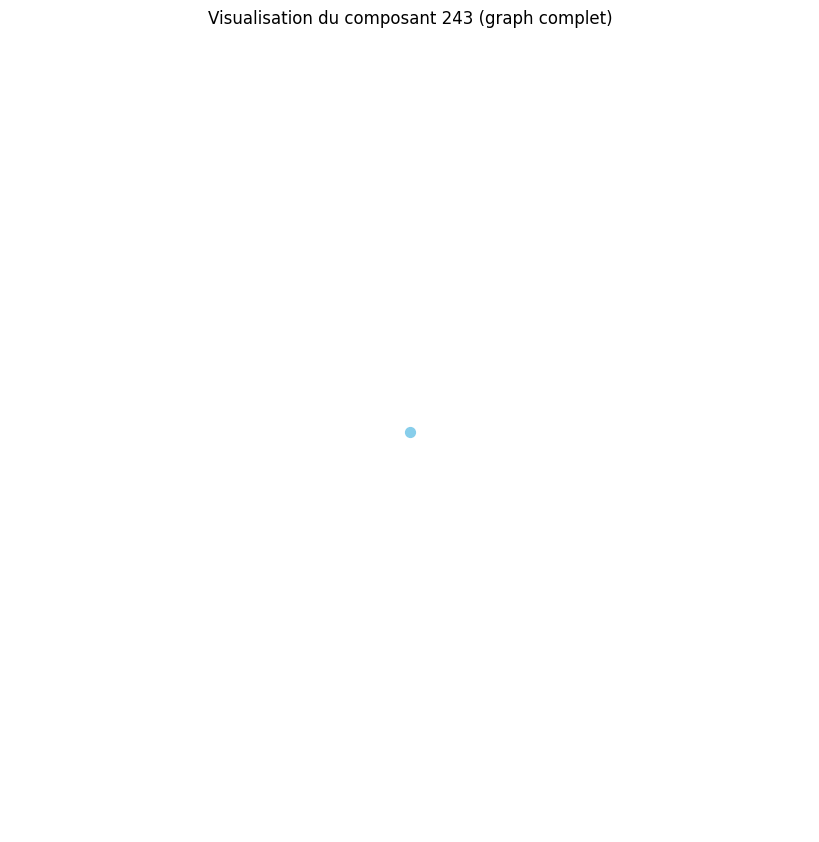

Distance moyenne pour le composant 244 : 0.00
Le composant 244 est un graphe complet ou très densément connecté.
Densité du composant 244 : 0.00
Degré moyen du composant 244 : 0.00
Coefficient de clustering moyen du composant 244 : 0.00


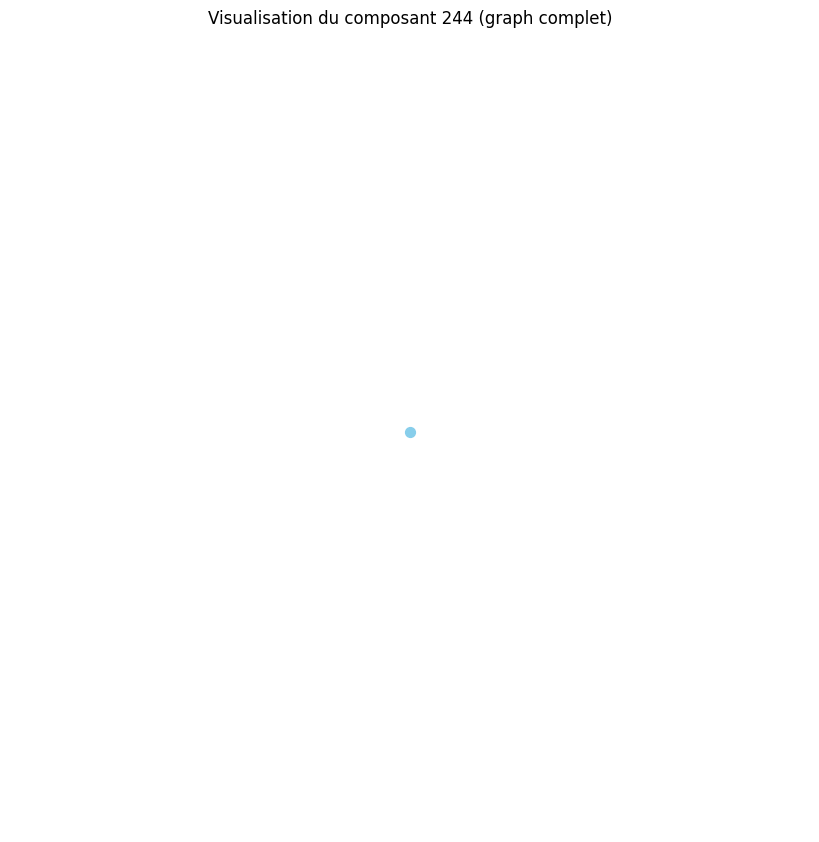

Distance moyenne pour le composant 245 : 0.00
Le composant 245 est un graphe complet ou très densément connecté.
Densité du composant 245 : 0.00
Degré moyen du composant 245 : 0.00
Coefficient de clustering moyen du composant 245 : 0.00


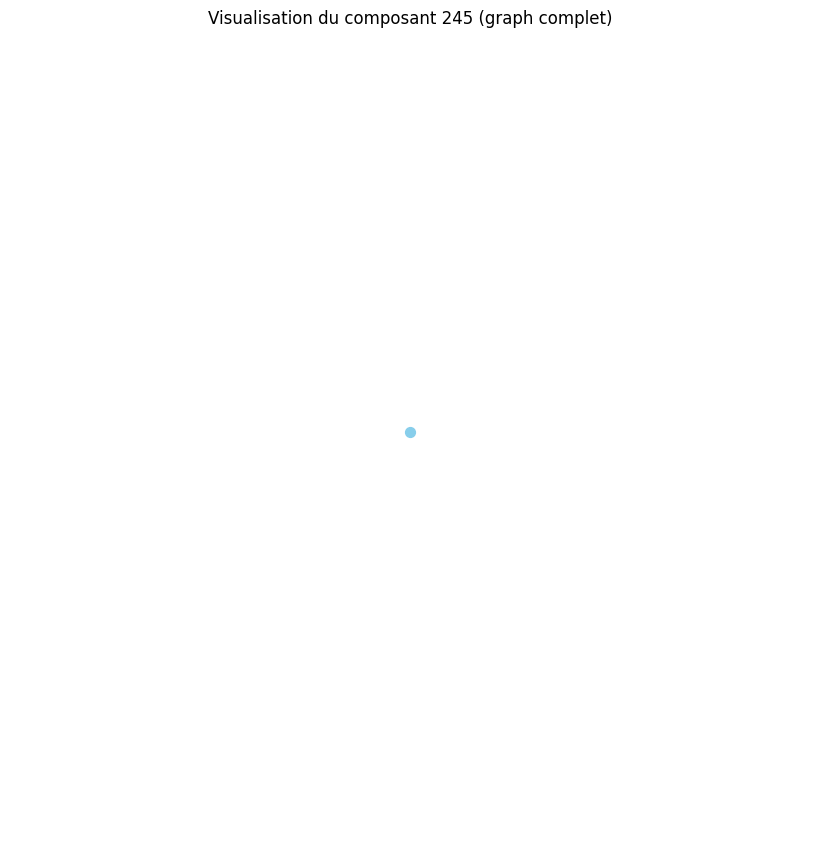

Distance moyenne pour le composant 246 : 0.00
Le composant 246 est un graphe complet ou très densément connecté.
Densité du composant 246 : 0.00
Degré moyen du composant 246 : 0.00
Coefficient de clustering moyen du composant 246 : 0.00


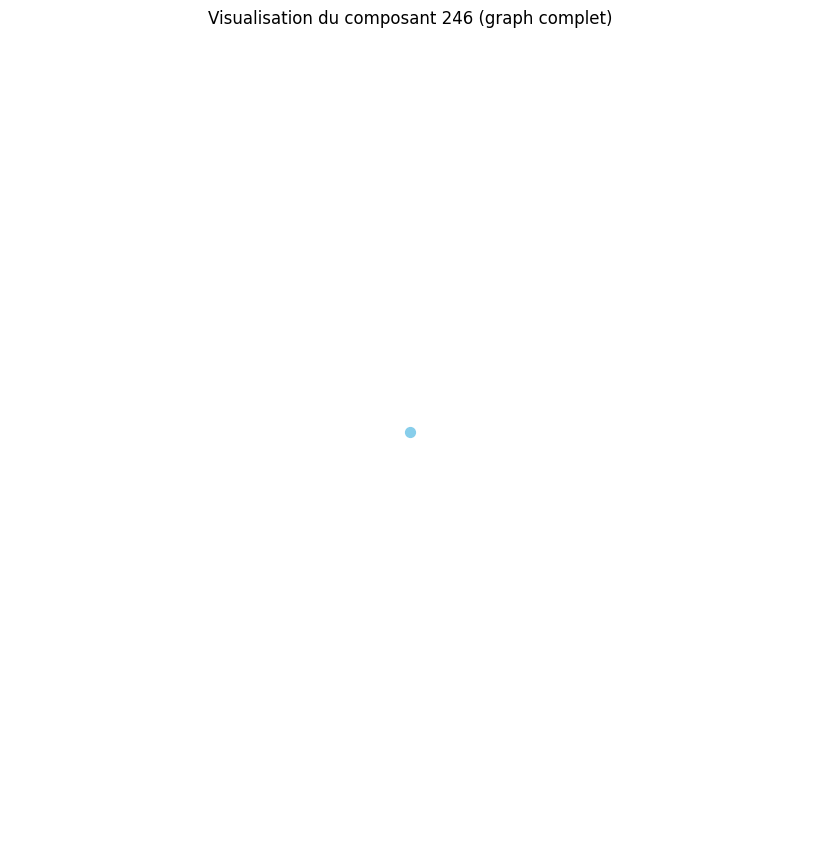

Distance moyenne pour le composant 247 : 0.00
Le composant 247 est un graphe complet ou très densément connecté.
Densité du composant 247 : 0.00
Degré moyen du composant 247 : 0.00
Coefficient de clustering moyen du composant 247 : 0.00


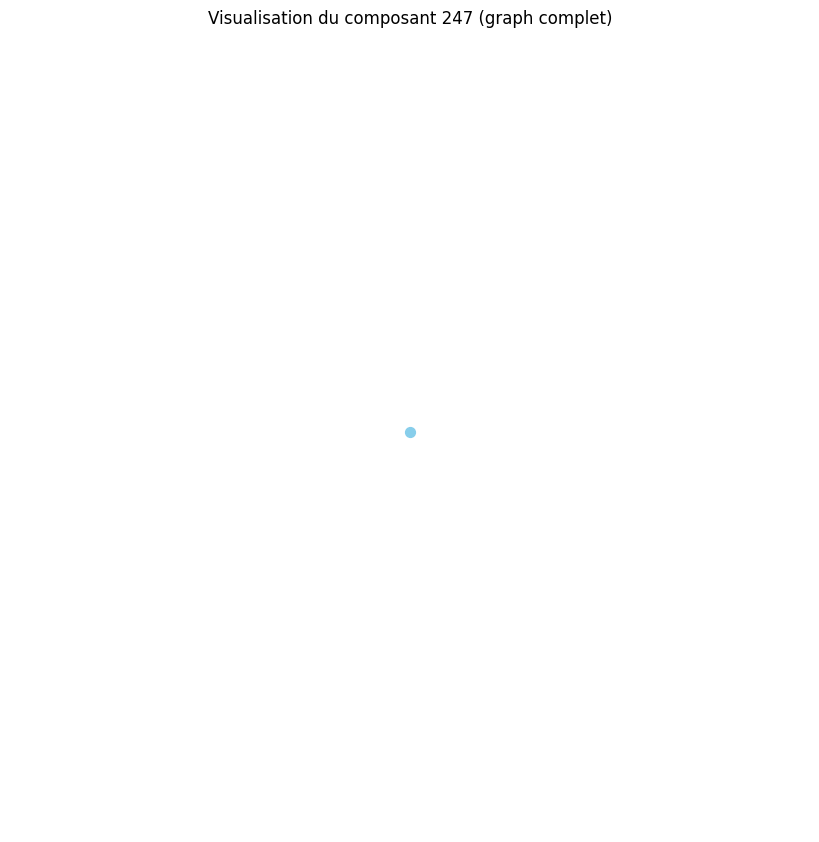

Distance moyenne pour le composant 248 : 0.00
Le composant 248 est un graphe complet ou très densément connecté.
Densité du composant 248 : 0.00
Degré moyen du composant 248 : 0.00
Coefficient de clustering moyen du composant 248 : 0.00


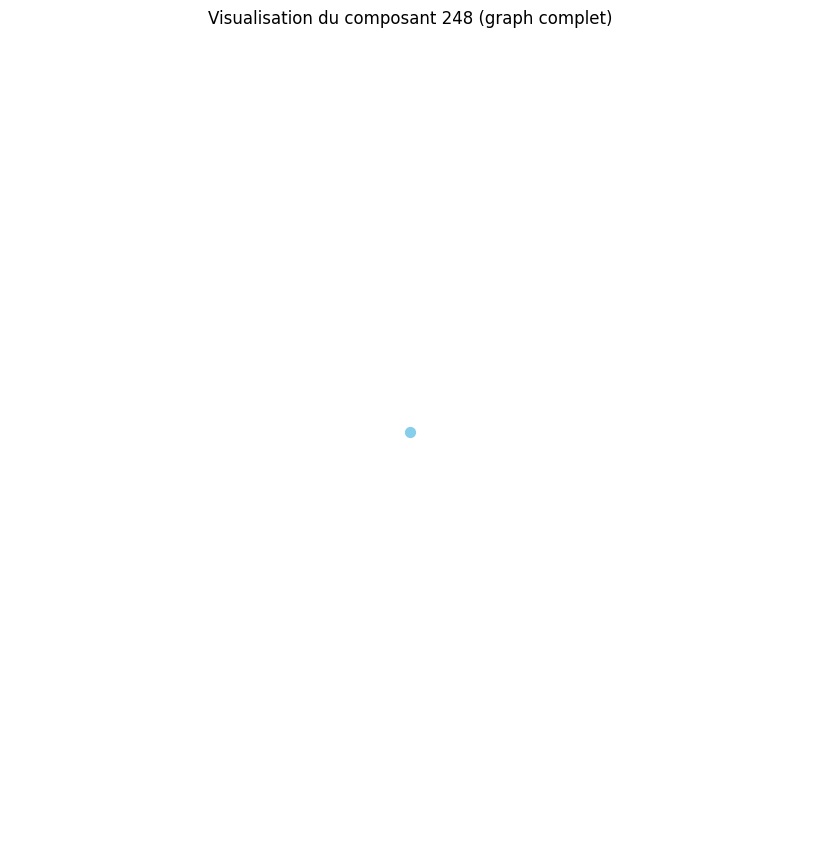

Distance moyenne pour le composant 249 : 0.00
Le composant 249 est un graphe complet ou très densément connecté.
Densité du composant 249 : 0.00
Degré moyen du composant 249 : 0.00
Coefficient de clustering moyen du composant 249 : 0.00


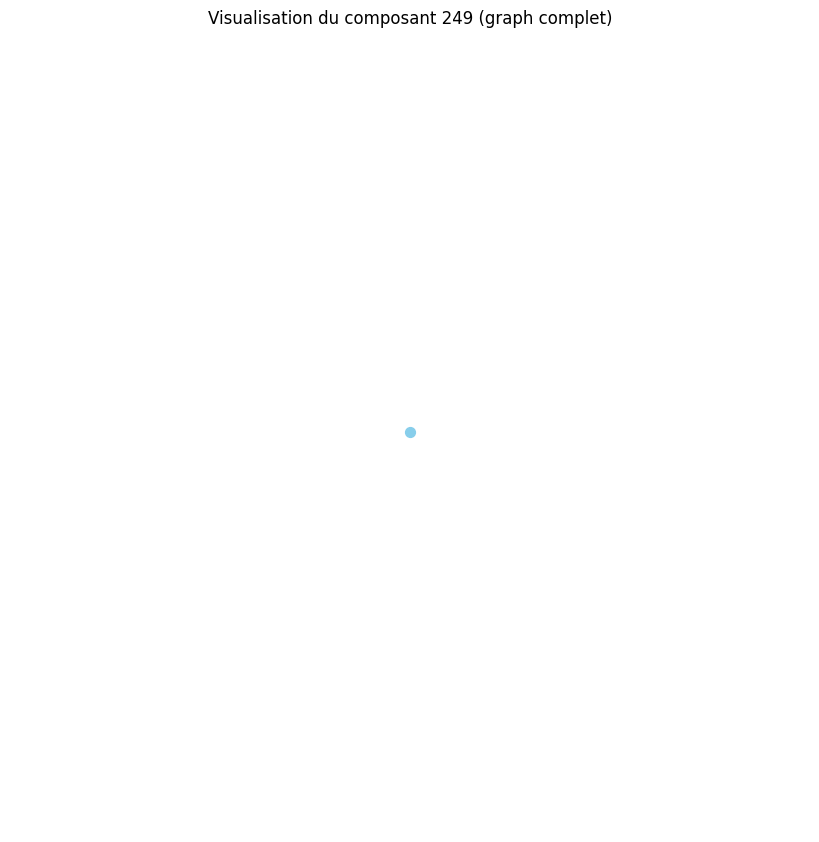

Distance moyenne pour le composant 250 : 0.00
Le composant 250 est un graphe complet ou très densément connecté.
Densité du composant 250 : 0.00
Degré moyen du composant 250 : 0.00
Coefficient de clustering moyen du composant 250 : 0.00


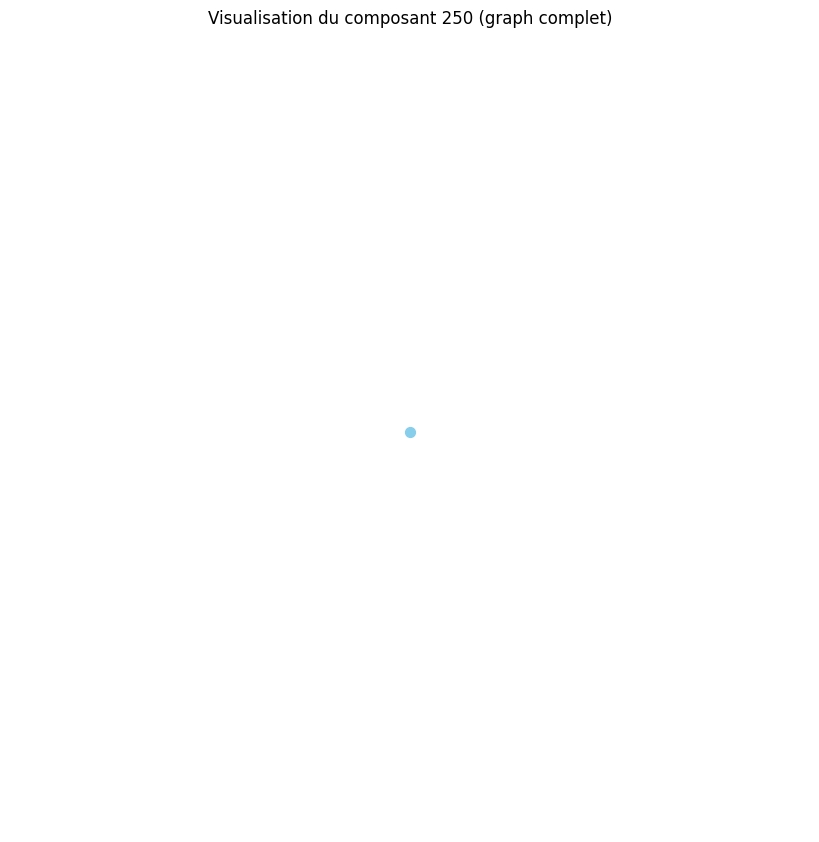

Distance moyenne pour le composant 251 : 0.00
Le composant 251 est un graphe complet ou très densément connecté.
Densité du composant 251 : 0.00
Degré moyen du composant 251 : 0.00
Coefficient de clustering moyen du composant 251 : 0.00


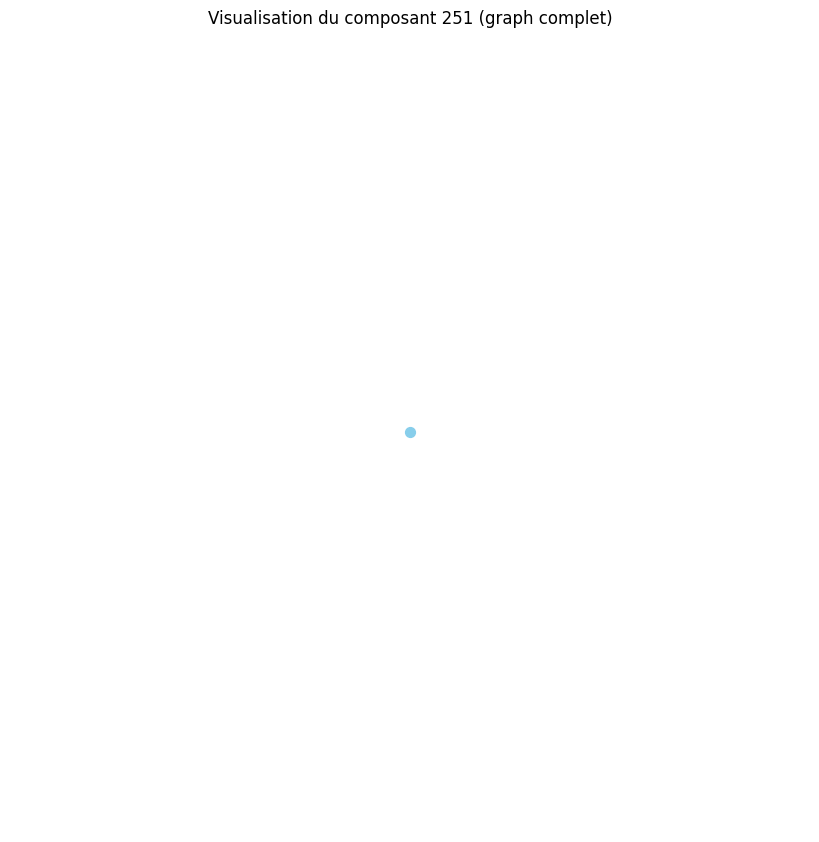

Distance moyenne pour le composant 252 : 0.00
Le composant 252 est un graphe complet ou très densément connecté.
Densité du composant 252 : 0.00
Degré moyen du composant 252 : 0.00
Coefficient de clustering moyen du composant 252 : 0.00


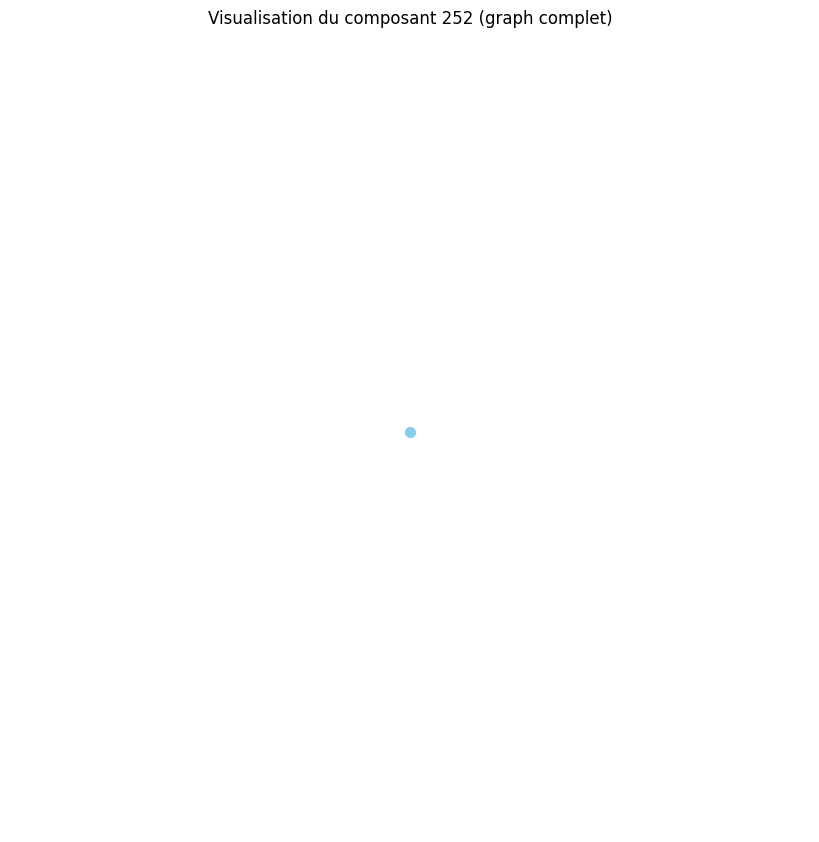

Distance moyenne pour le composant 253 : 0.00
Le composant 253 est un graphe complet ou très densément connecté.
Densité du composant 253 : 0.00
Degré moyen du composant 253 : 0.00
Coefficient de clustering moyen du composant 253 : 0.00


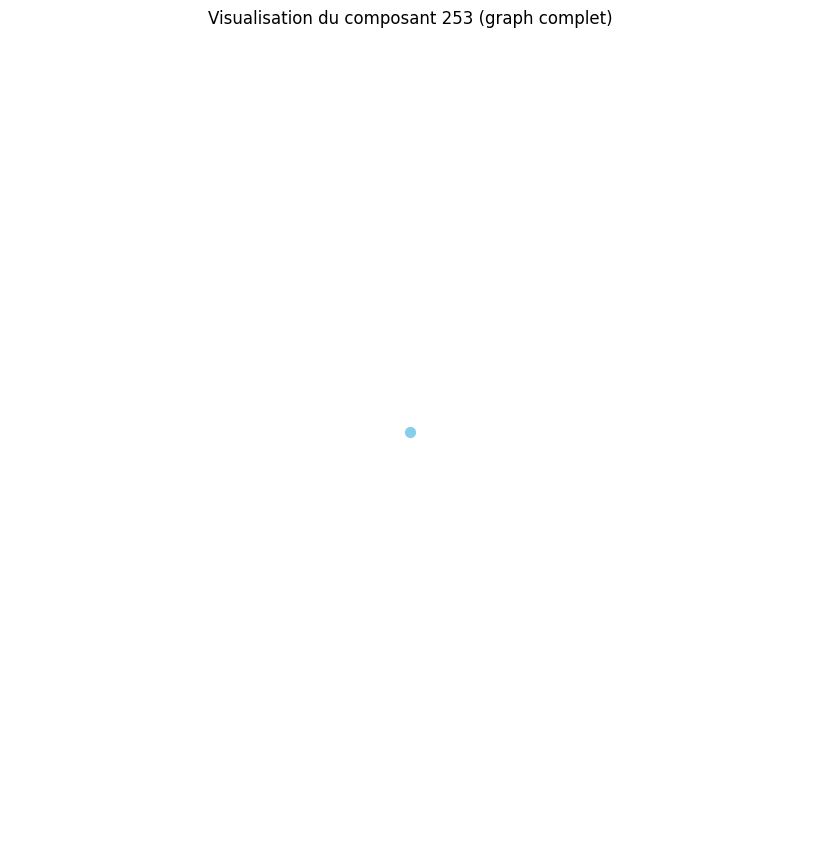

Distance moyenne pour le composant 254 : 0.00
Le composant 254 est un graphe complet ou très densément connecté.
Densité du composant 254 : 0.00
Degré moyen du composant 254 : 0.00
Coefficient de clustering moyen du composant 254 : 0.00


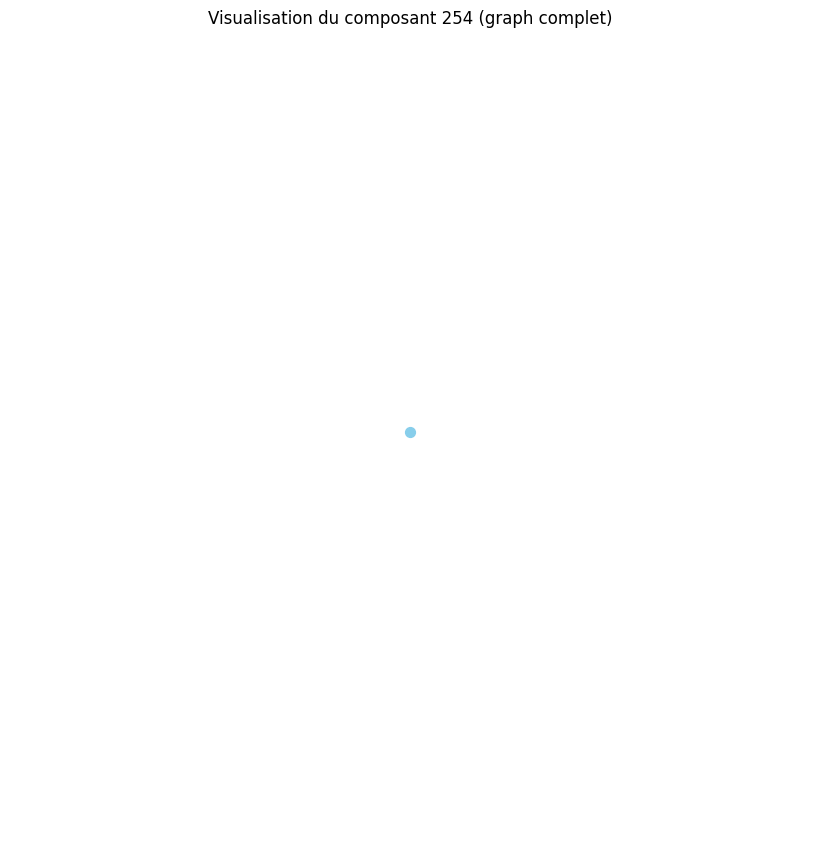

Distance moyenne pour le composant 255 : 0.00
Le composant 255 est un graphe complet ou très densément connecté.
Densité du composant 255 : 0.00
Degré moyen du composant 255 : 0.00
Coefficient de clustering moyen du composant 255 : 0.00


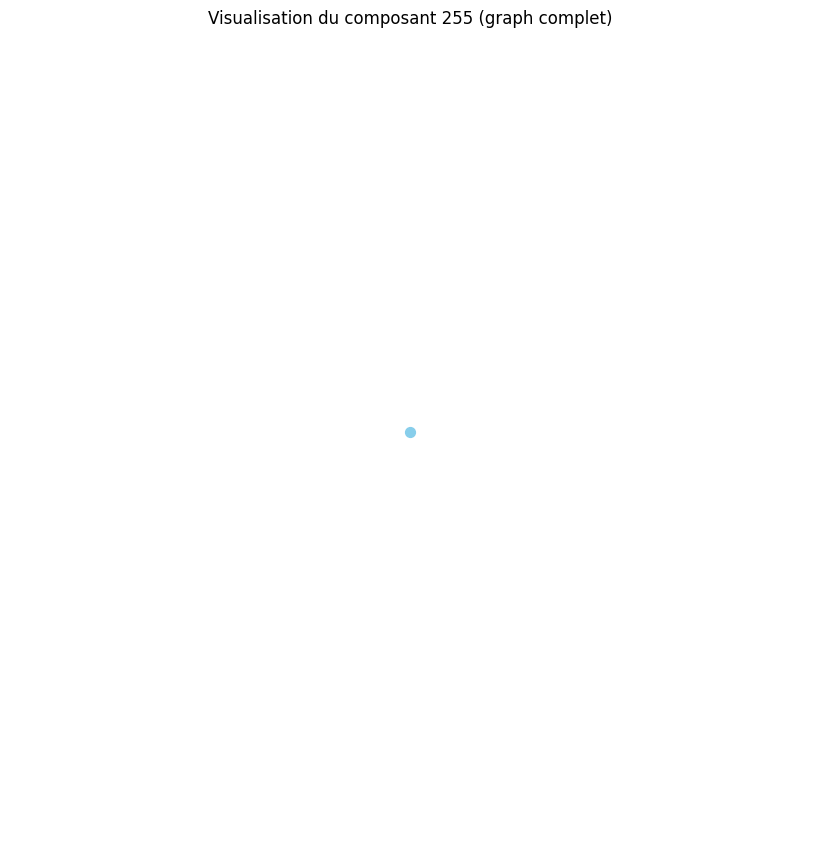

Distance moyenne pour le composant 256 : 0.00
Le composant 256 est un graphe complet ou très densément connecté.
Densité du composant 256 : 0.00
Degré moyen du composant 256 : 0.00
Coefficient de clustering moyen du composant 256 : 0.00


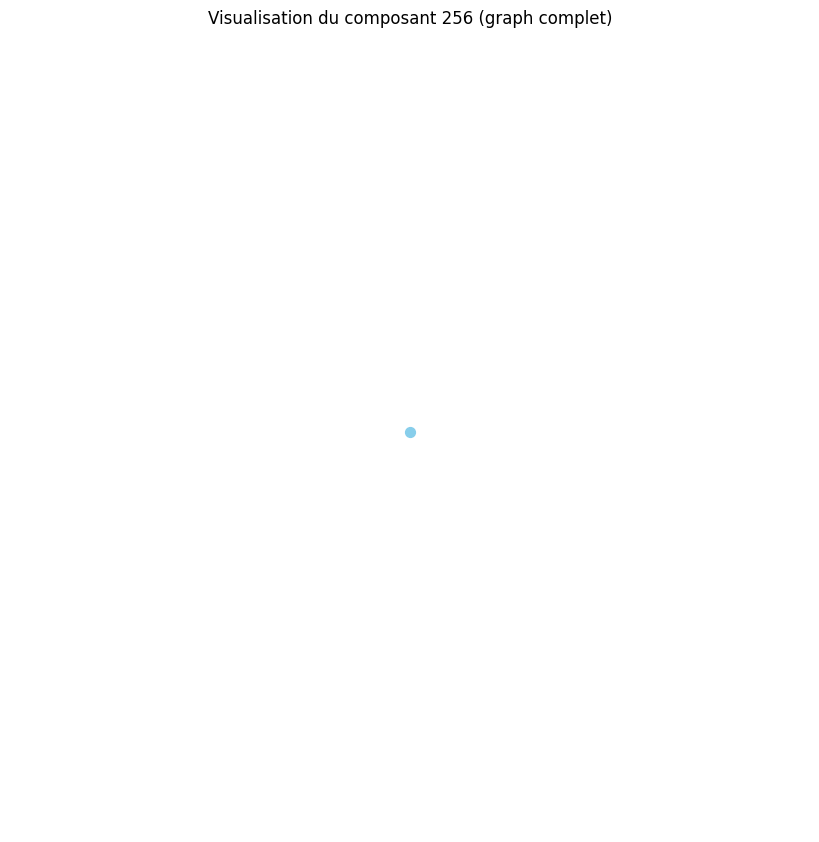

Distance moyenne pour le composant 257 : 0.00
Le composant 257 est un graphe complet ou très densément connecté.
Densité du composant 257 : 0.00
Degré moyen du composant 257 : 0.00
Coefficient de clustering moyen du composant 257 : 0.00


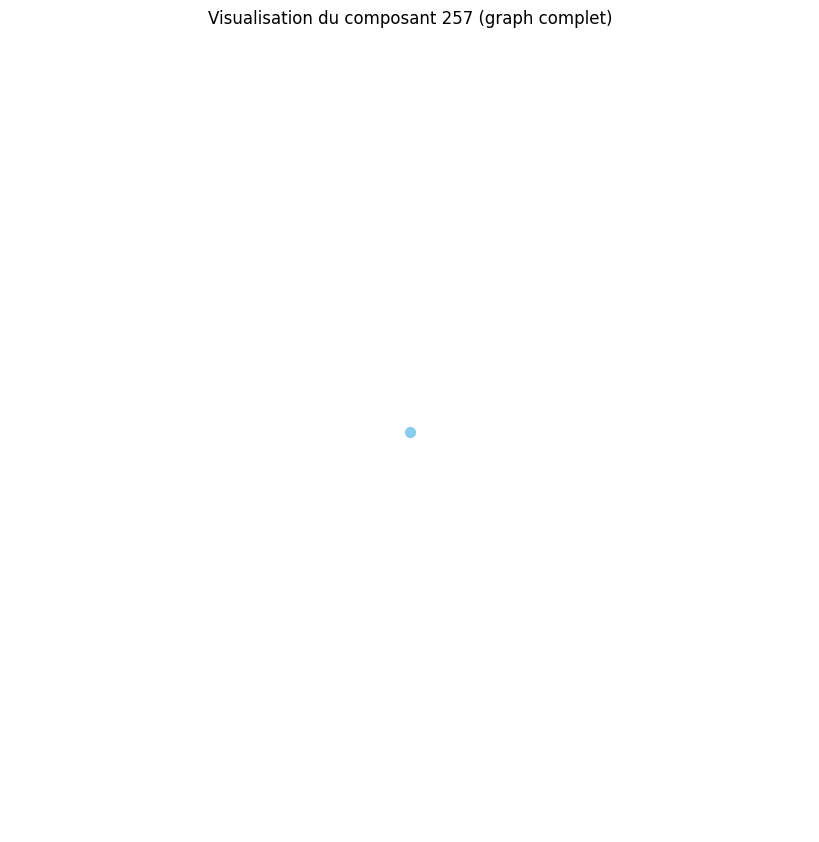

Distance moyenne pour le composant 258 : 0.00
Le composant 258 est un graphe complet ou très densément connecté.
Densité du composant 258 : 0.00
Degré moyen du composant 258 : 0.00
Coefficient de clustering moyen du composant 258 : 0.00


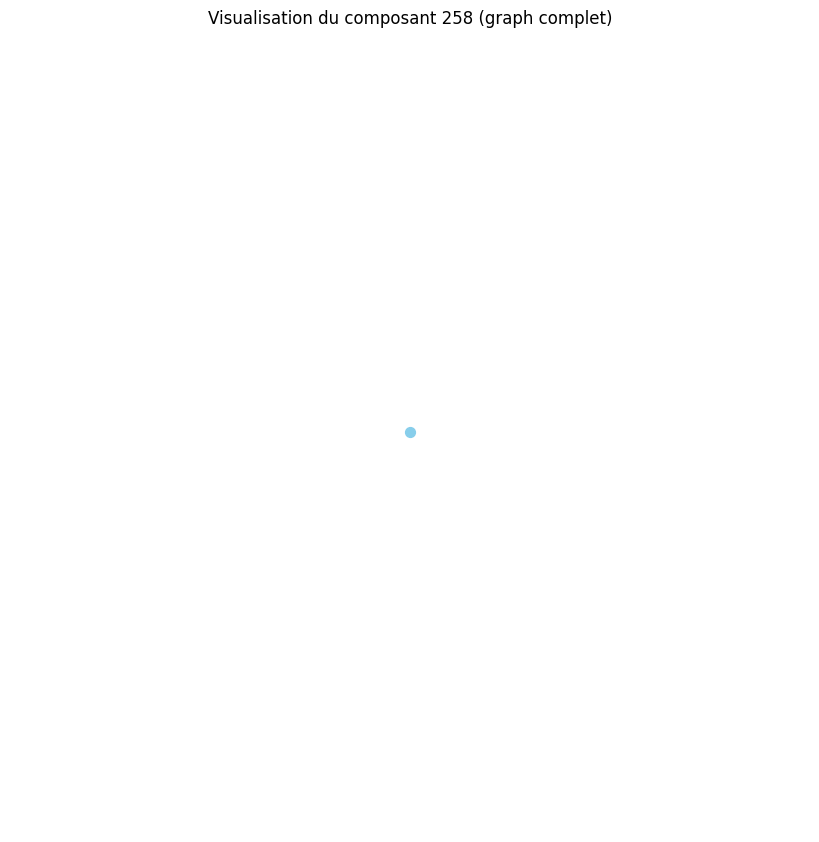

Distance moyenne pour le composant 259 : 0.00
Le composant 259 est un graphe complet ou très densément connecté.
Densité du composant 259 : 0.00
Degré moyen du composant 259 : 0.00
Coefficient de clustering moyen du composant 259 : 0.00


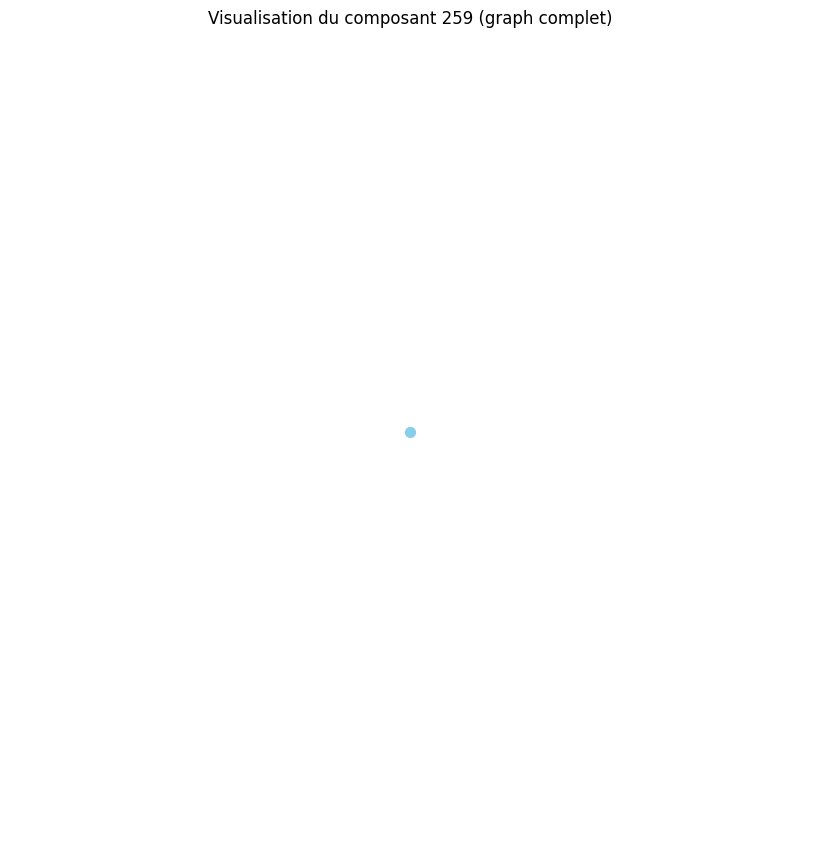

Distance moyenne pour le composant 260 : 0.00
Le composant 260 est un graphe complet ou très densément connecté.
Densité du composant 260 : 0.00
Degré moyen du composant 260 : 0.00
Coefficient de clustering moyen du composant 260 : 0.00


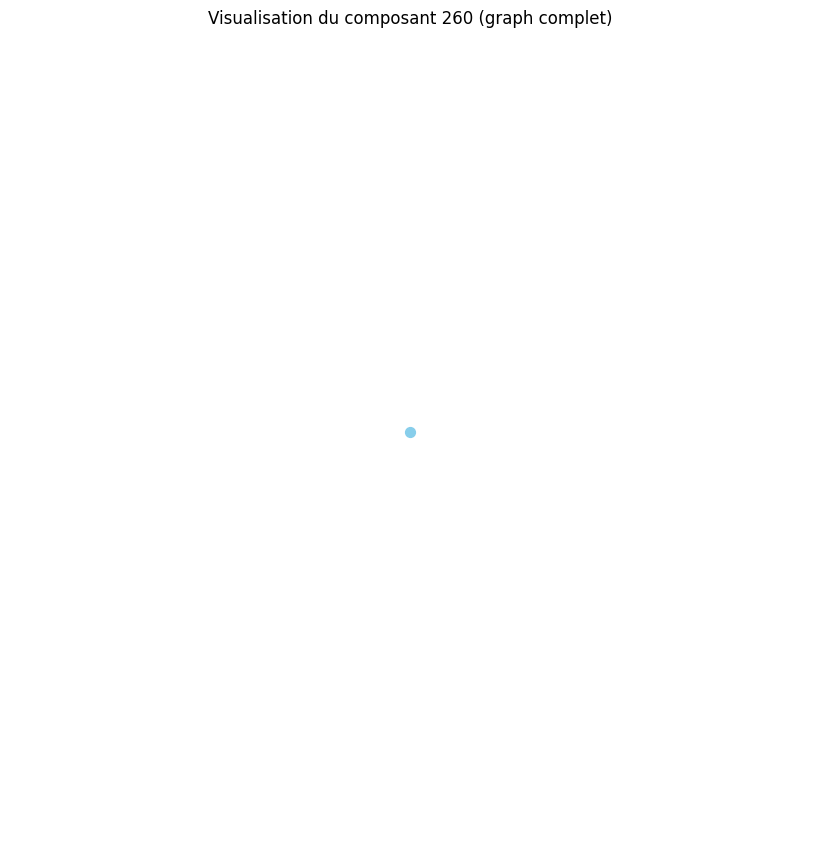

Distance moyenne pour le composant 261 : 0.00
Le composant 261 est un graphe complet ou très densément connecté.
Densité du composant 261 : 0.00
Degré moyen du composant 261 : 0.00
Coefficient de clustering moyen du composant 261 : 0.00


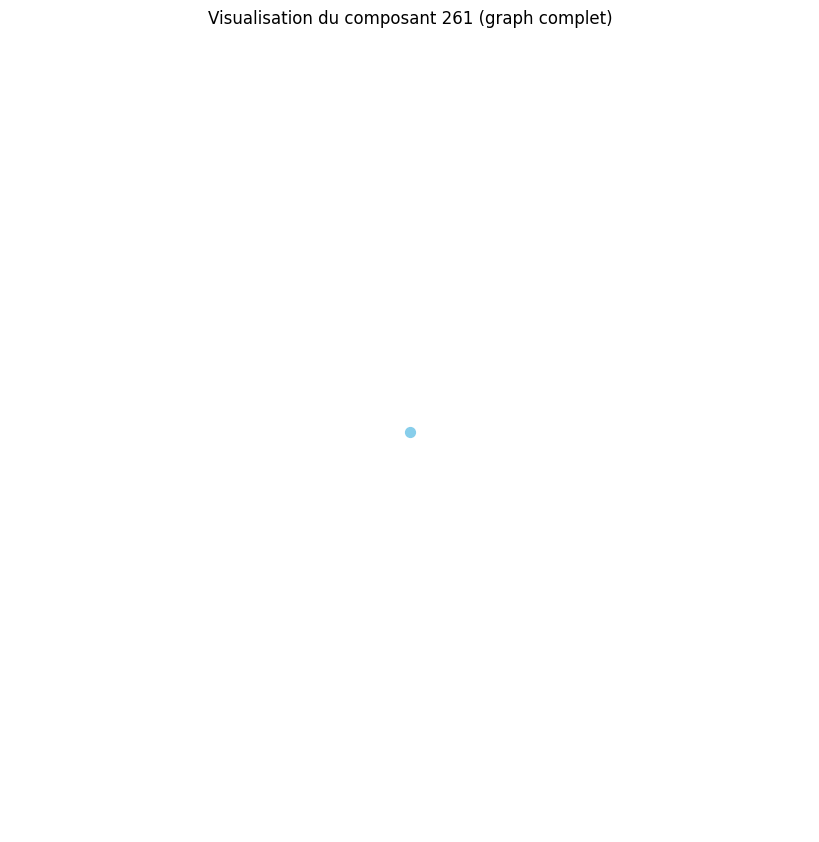

Distance moyenne pour le composant 262 : 0.00
Le composant 262 est un graphe complet ou très densément connecté.
Densité du composant 262 : 0.00
Degré moyen du composant 262 : 0.00
Coefficient de clustering moyen du composant 262 : 0.00


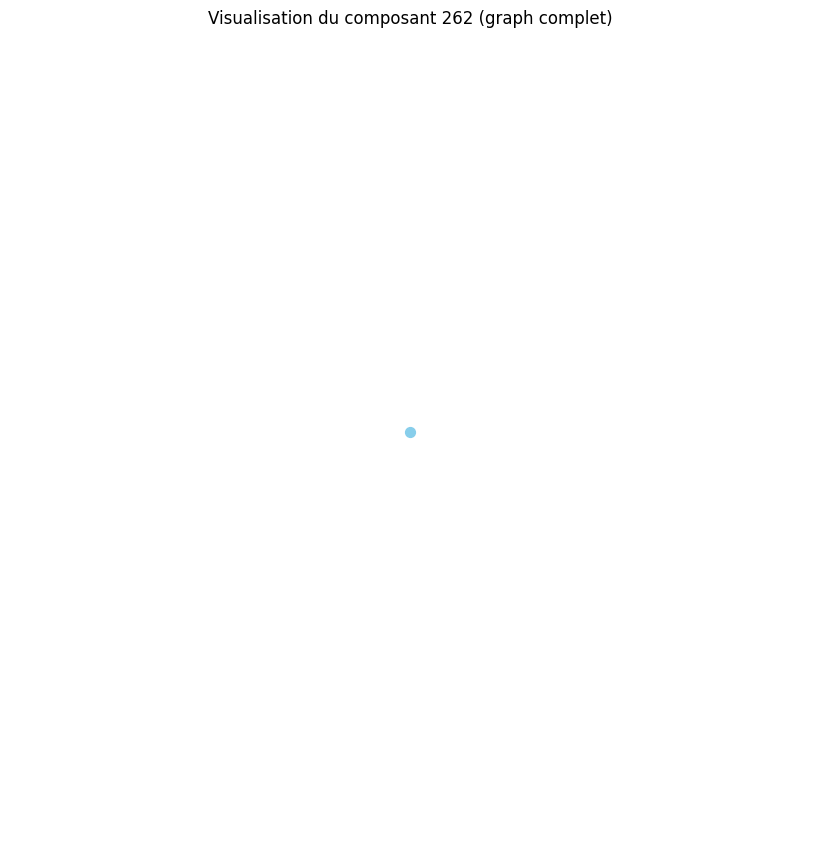

Distance moyenne pour le composant 263 : 0.00
Le composant 263 est un graphe complet ou très densément connecté.
Densité du composant 263 : 0.00
Degré moyen du composant 263 : 0.00
Coefficient de clustering moyen du composant 263 : 0.00


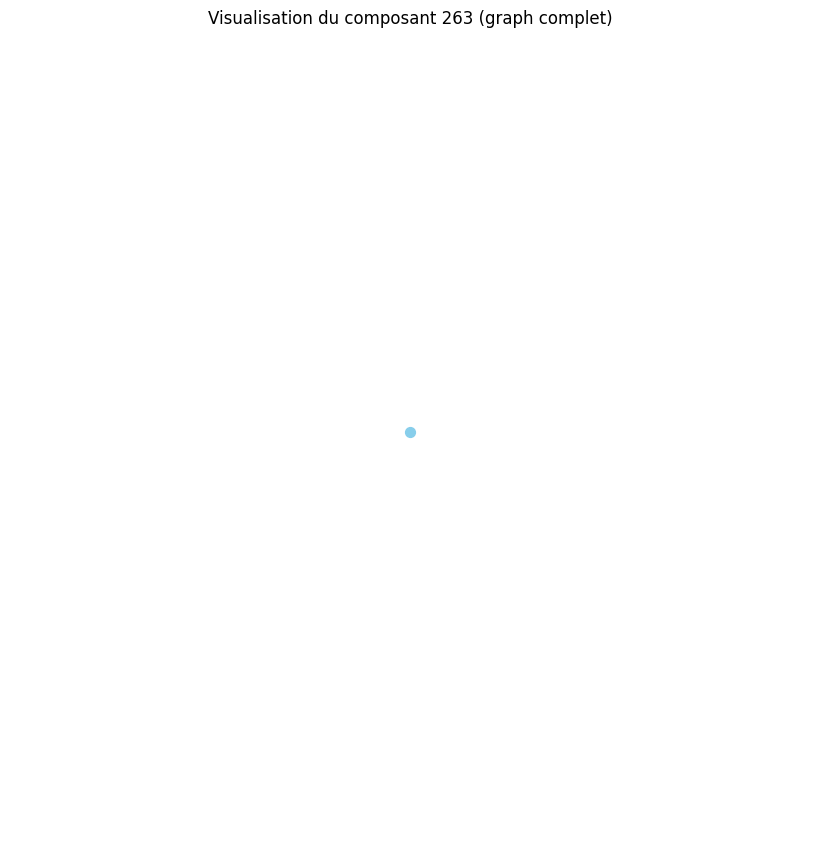

Distance moyenne pour le composant 264 : 0.00
Le composant 264 est un graphe complet ou très densément connecté.
Densité du composant 264 : 0.00
Degré moyen du composant 264 : 0.00
Coefficient de clustering moyen du composant 264 : 0.00


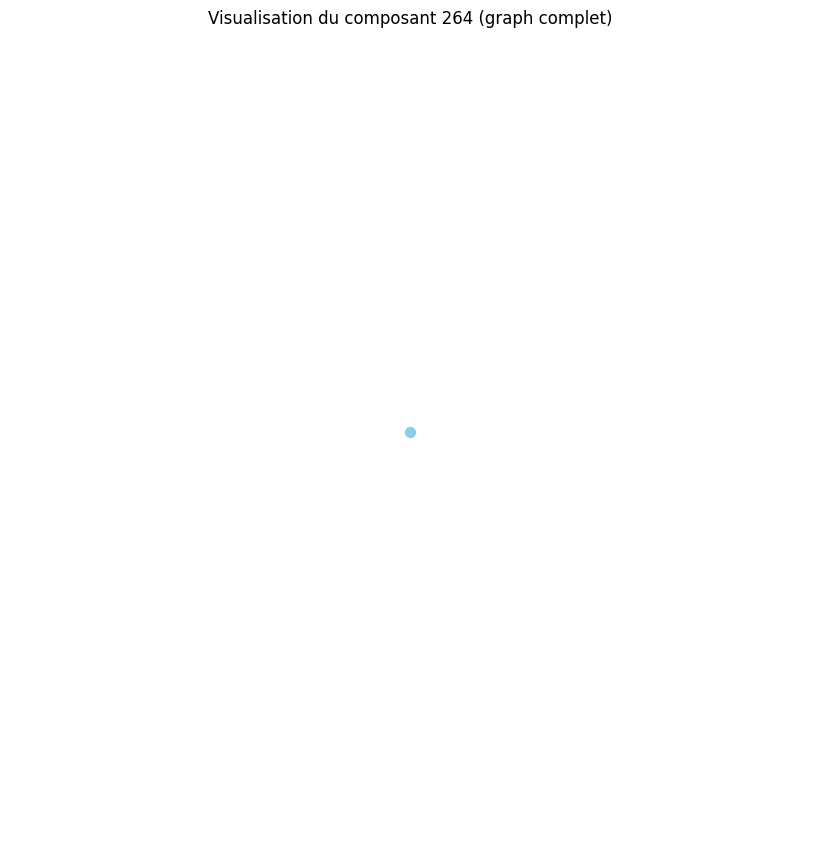

Distance moyenne pour le composant 265 : 0.00
Le composant 265 est un graphe complet ou très densément connecté.
Densité du composant 265 : 0.00
Degré moyen du composant 265 : 0.00
Coefficient de clustering moyen du composant 265 : 0.00


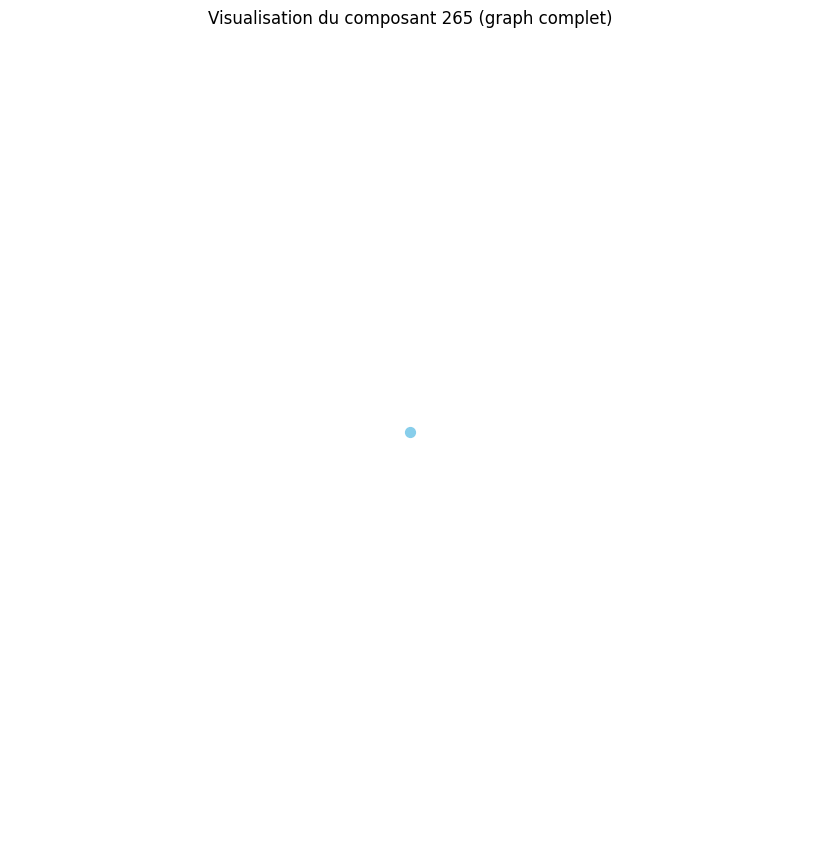

Distance moyenne pour le composant 266 : 0.00
Le composant 266 est un graphe complet ou très densément connecté.
Densité du composant 266 : 0.00
Degré moyen du composant 266 : 0.00
Coefficient de clustering moyen du composant 266 : 0.00


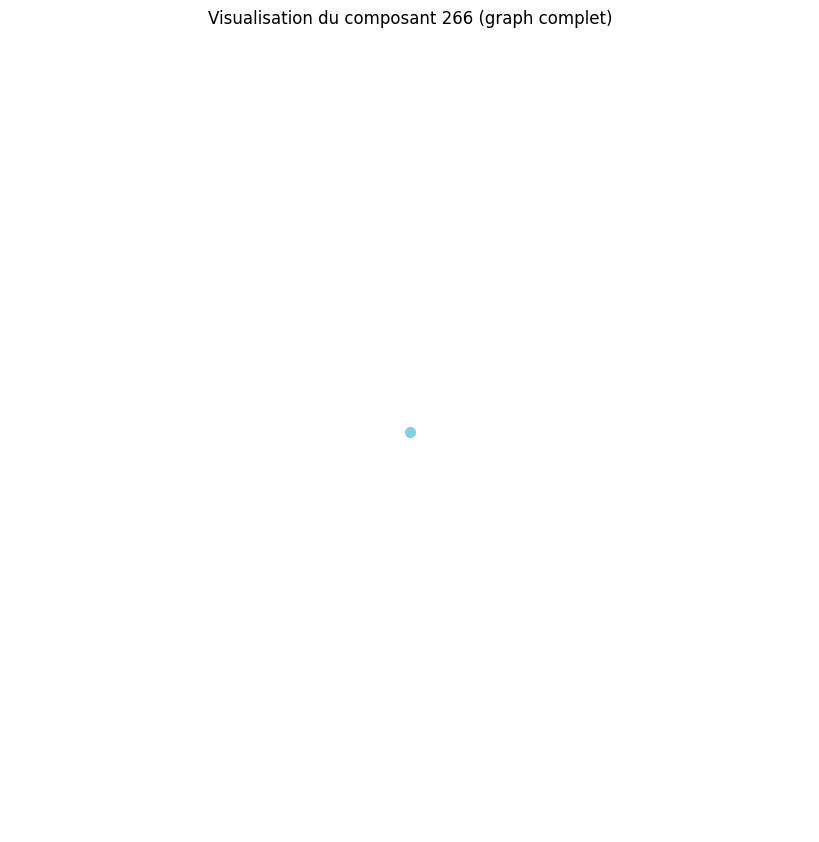

Distance moyenne pour le composant 267 : 0.00
Le composant 267 est un graphe complet ou très densément connecté.
Densité du composant 267 : 0.00
Degré moyen du composant 267 : 0.00
Coefficient de clustering moyen du composant 267 : 0.00


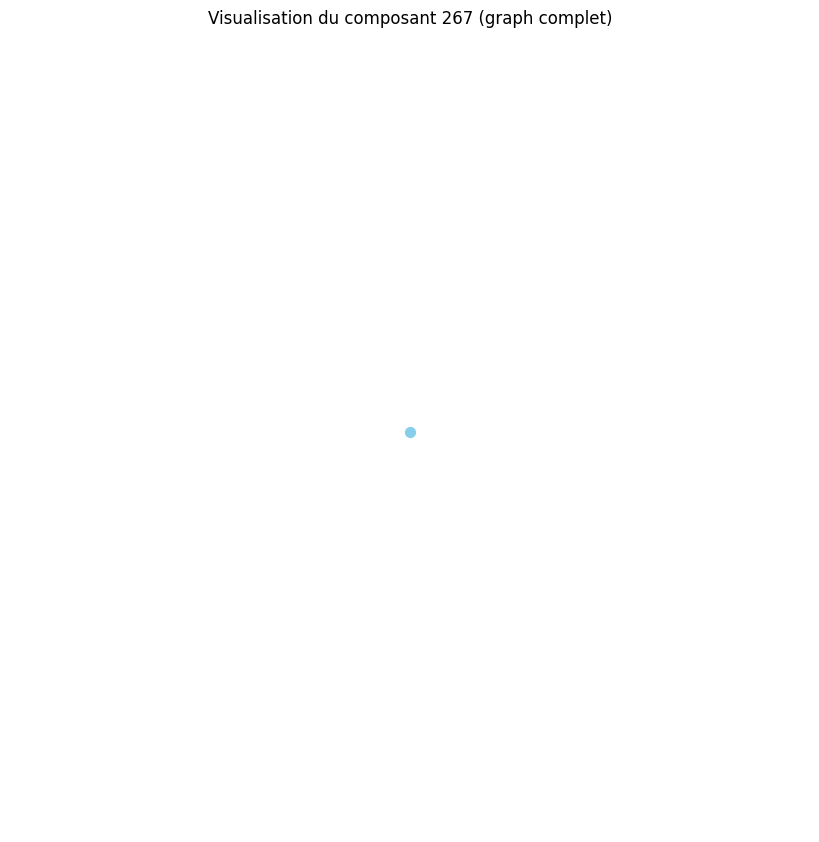

Distance moyenne pour le composant 268 : 0.00
Le composant 268 est un graphe complet ou très densément connecté.
Densité du composant 268 : 0.00
Degré moyen du composant 268 : 0.00
Coefficient de clustering moyen du composant 268 : 0.00


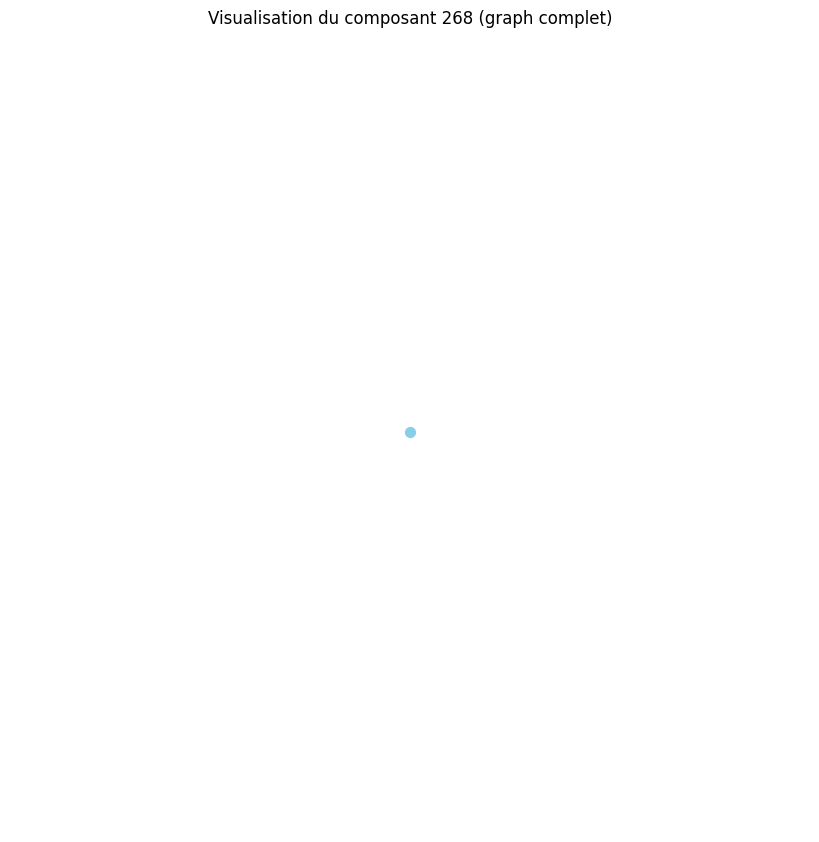

Distance moyenne pour le composant 269 : 0.00
Le composant 269 est un graphe complet ou très densément connecté.
Densité du composant 269 : 0.00
Degré moyen du composant 269 : 0.00
Coefficient de clustering moyen du composant 269 : 0.00


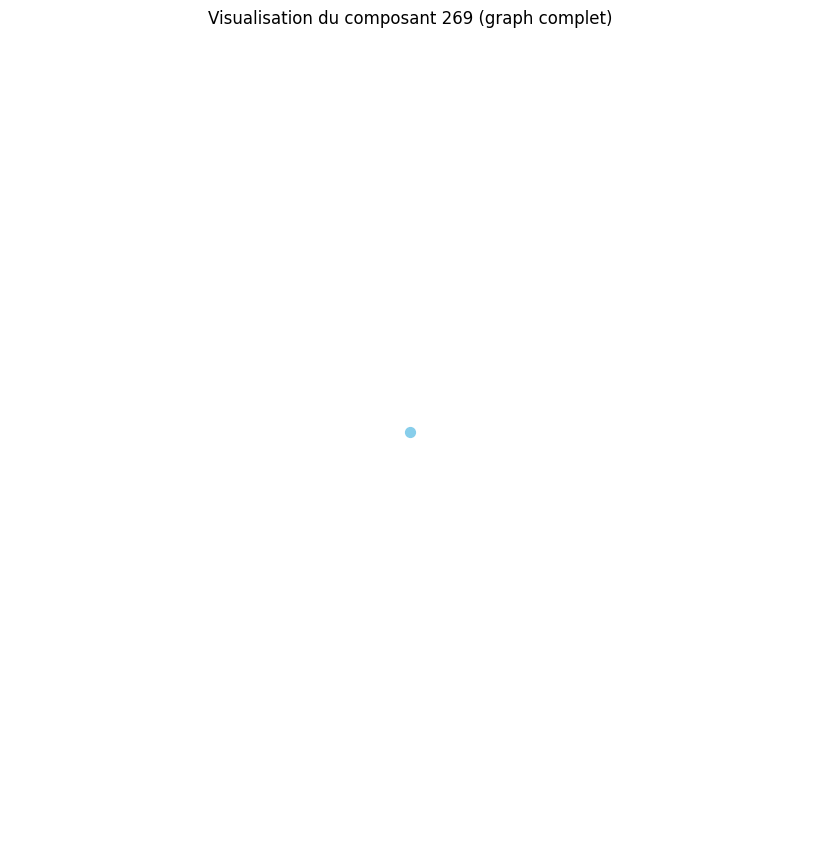

Distance moyenne pour le composant 270 : 0.00
Le composant 270 est un graphe complet ou très densément connecté.
Densité du composant 270 : 0.00
Degré moyen du composant 270 : 0.00
Coefficient de clustering moyen du composant 270 : 0.00


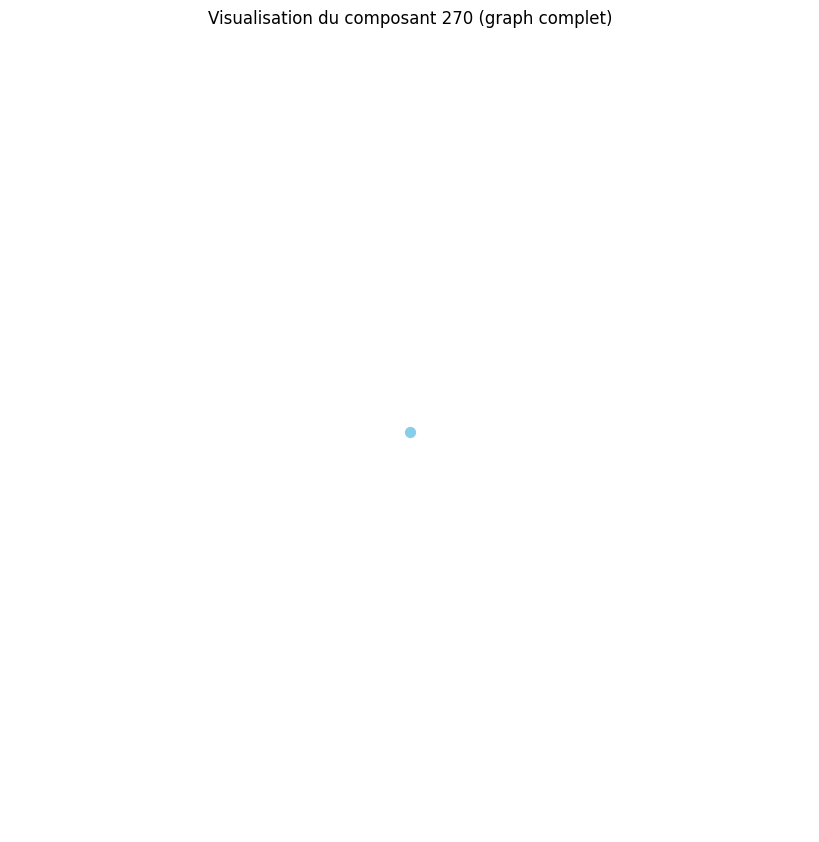

Distance moyenne pour le composant 271 : 0.00
Le composant 271 est un graphe complet ou très densément connecté.
Densité du composant 271 : 0.00
Degré moyen du composant 271 : 0.00
Coefficient de clustering moyen du composant 271 : 0.00


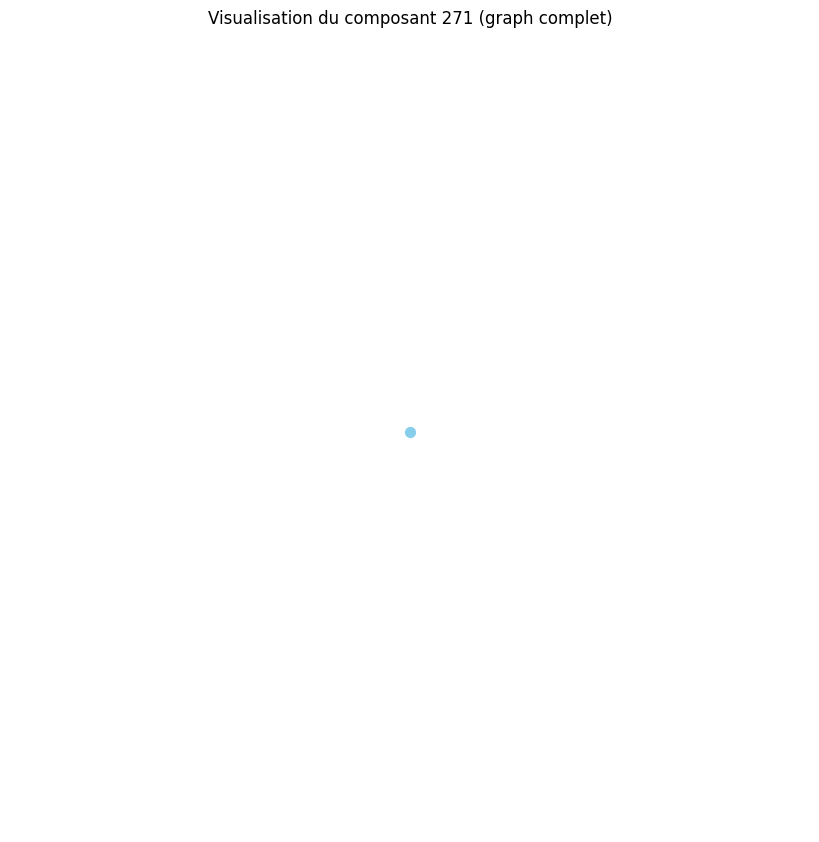

Distance moyenne pour le composant 272 : 0.00
Le composant 272 est un graphe complet ou très densément connecté.
Densité du composant 272 : 0.00
Degré moyen du composant 272 : 0.00
Coefficient de clustering moyen du composant 272 : 0.00


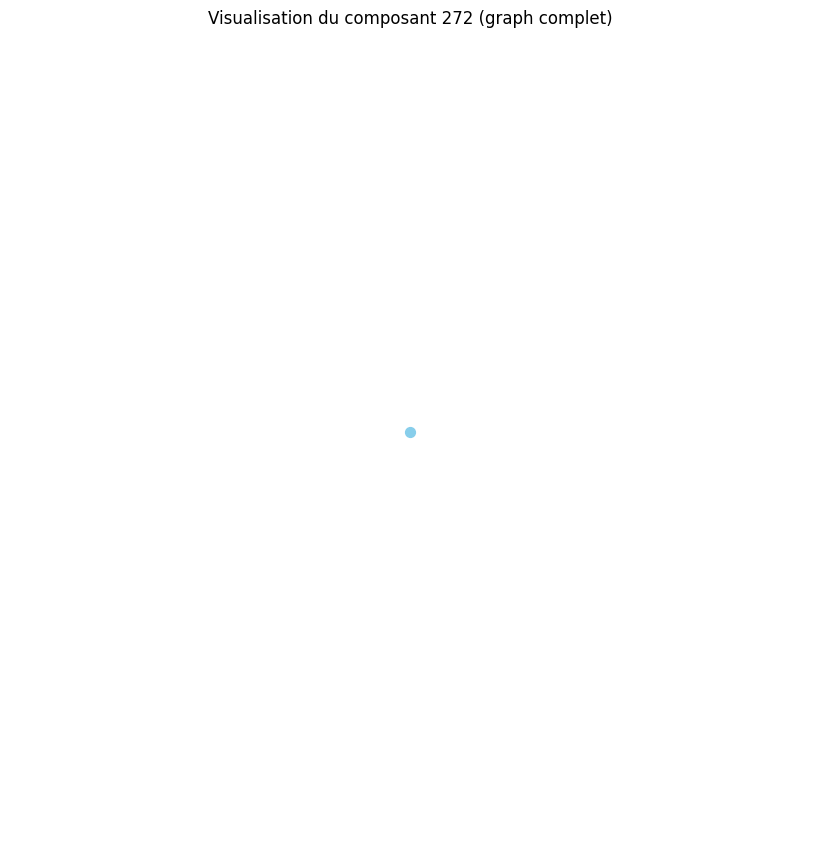

Distance moyenne pour le composant 273 : 0.00
Le composant 273 est un graphe complet ou très densément connecté.
Densité du composant 273 : 0.00
Degré moyen du composant 273 : 0.00
Coefficient de clustering moyen du composant 273 : 0.00


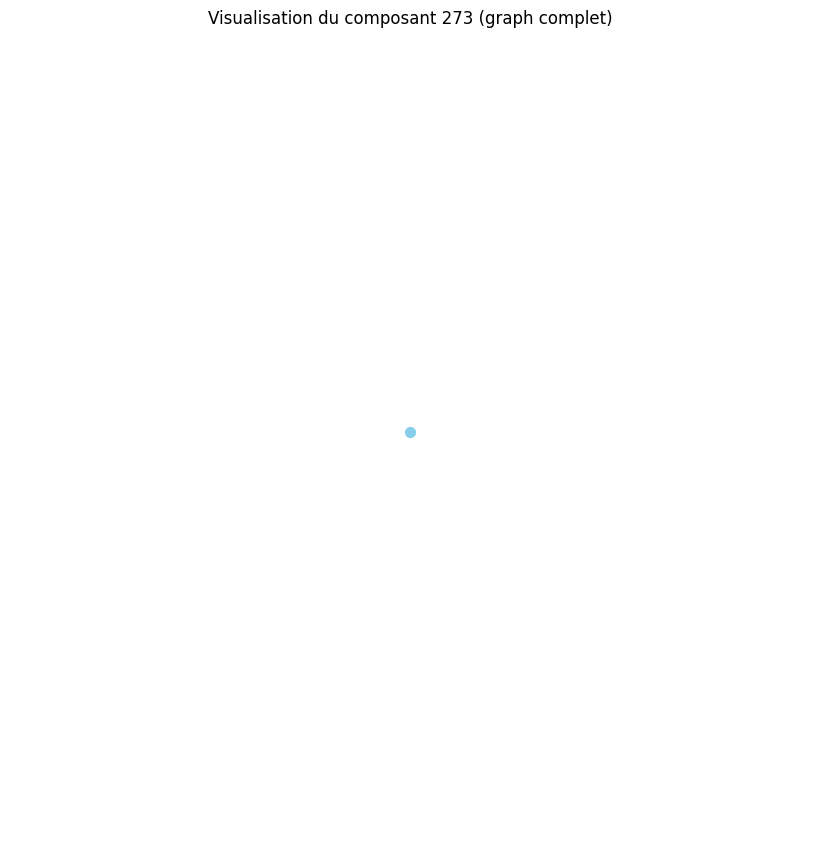

Distance moyenne pour le composant 274 : 0.00
Le composant 274 est un graphe complet ou très densément connecté.
Densité du composant 274 : 0.00
Degré moyen du composant 274 : 0.00
Coefficient de clustering moyen du composant 274 : 0.00


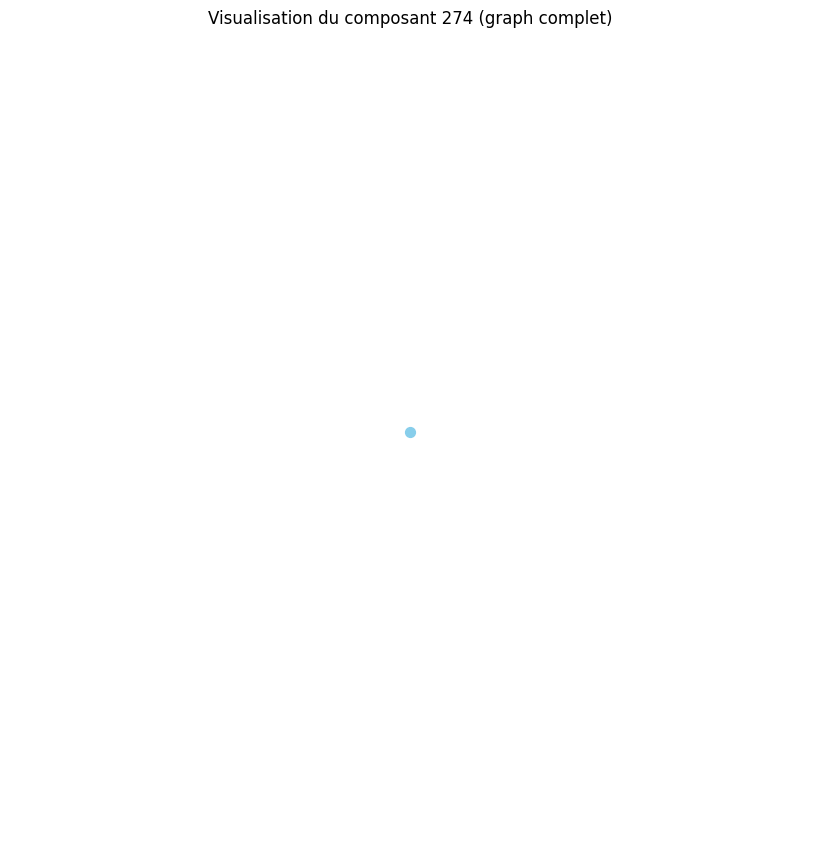

Distance moyenne pour le composant 275 : 0.00
Le composant 275 est un graphe complet ou très densément connecté.
Densité du composant 275 : 0.00
Degré moyen du composant 275 : 0.00
Coefficient de clustering moyen du composant 275 : 0.00


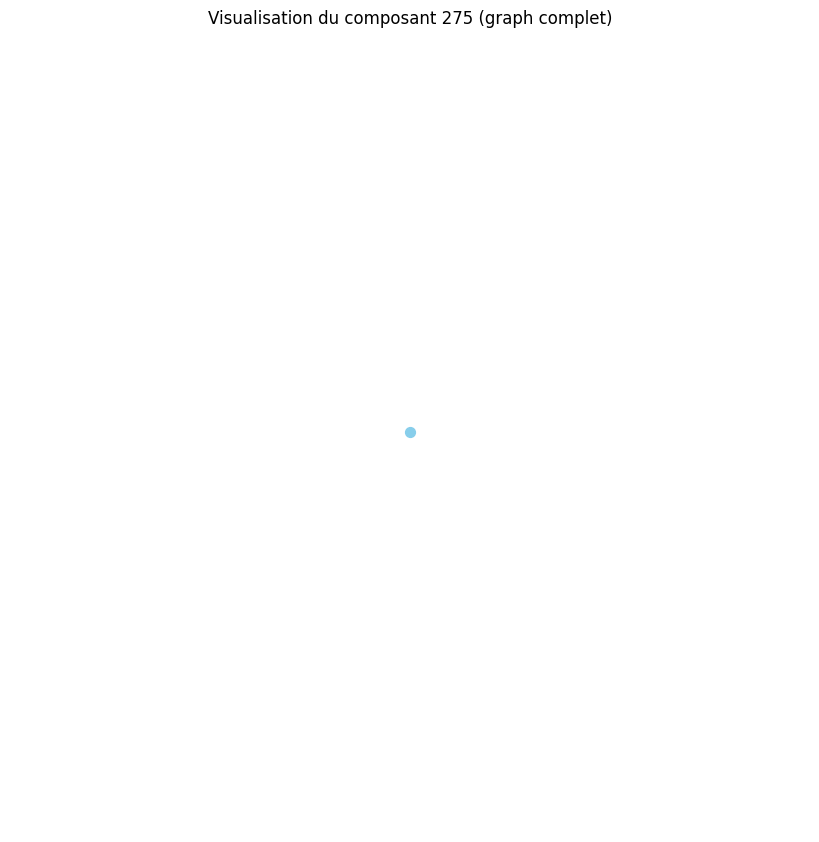

Distance moyenne pour le composant 276 : 0.00
Le composant 276 est un graphe complet ou très densément connecté.
Densité du composant 276 : 0.00
Degré moyen du composant 276 : 0.00
Coefficient de clustering moyen du composant 276 : 0.00


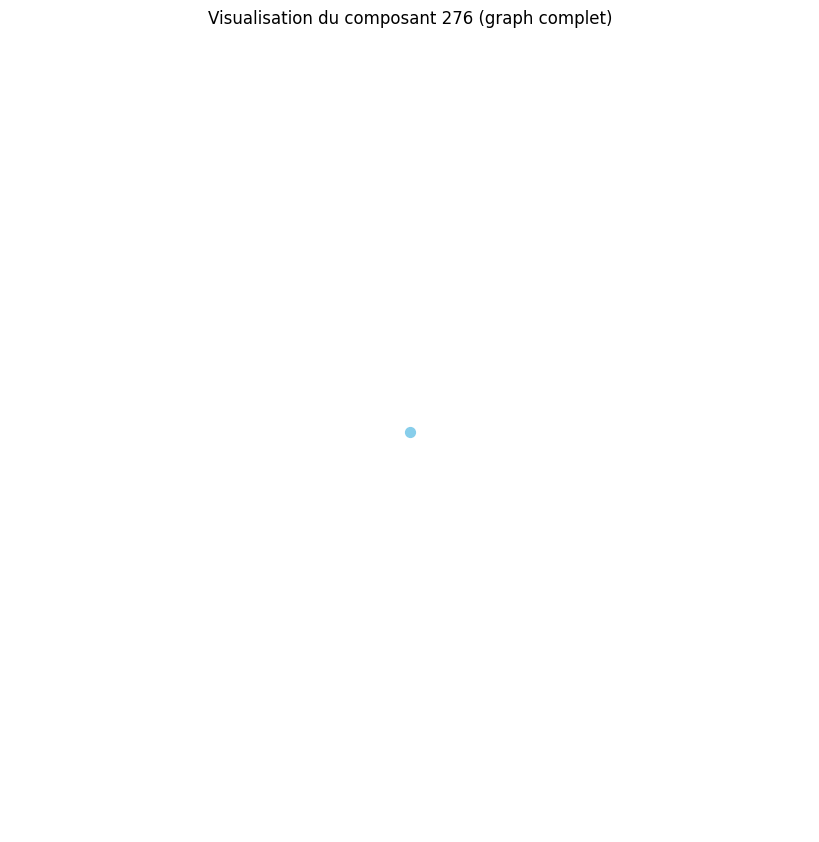

Distance moyenne pour le composant 277 : 0.00
Le composant 277 est un graphe complet ou très densément connecté.
Densité du composant 277 : 0.00
Degré moyen du composant 277 : 0.00
Coefficient de clustering moyen du composant 277 : 0.00


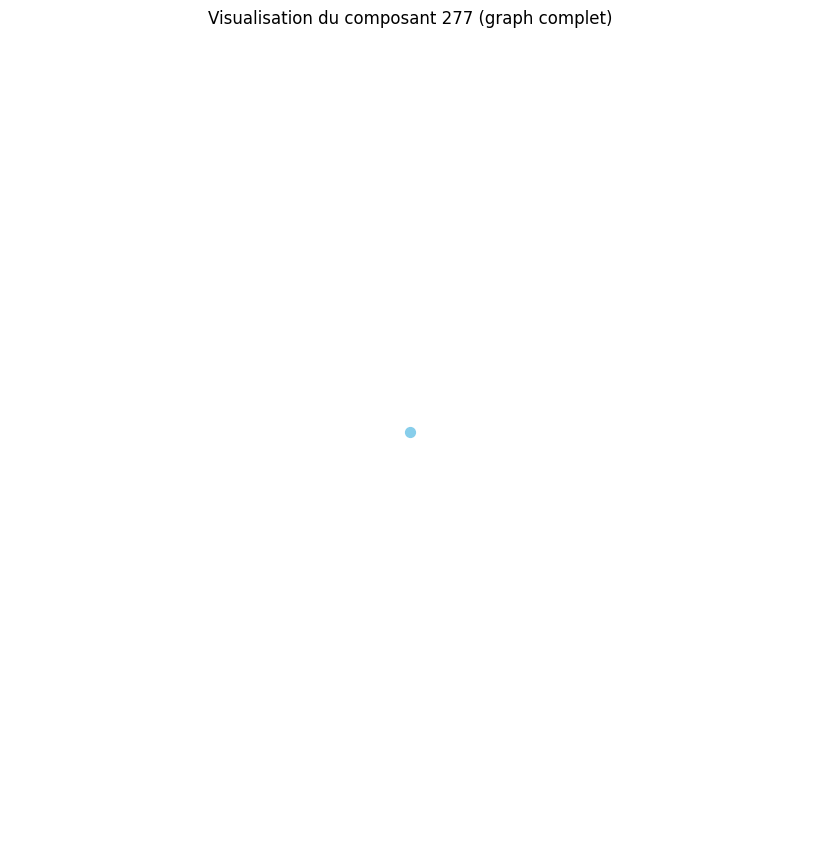

Distance moyenne pour le composant 278 : 0.00
Le composant 278 est un graphe complet ou très densément connecté.
Densité du composant 278 : 0.00
Degré moyen du composant 278 : 0.00
Coefficient de clustering moyen du composant 278 : 0.00


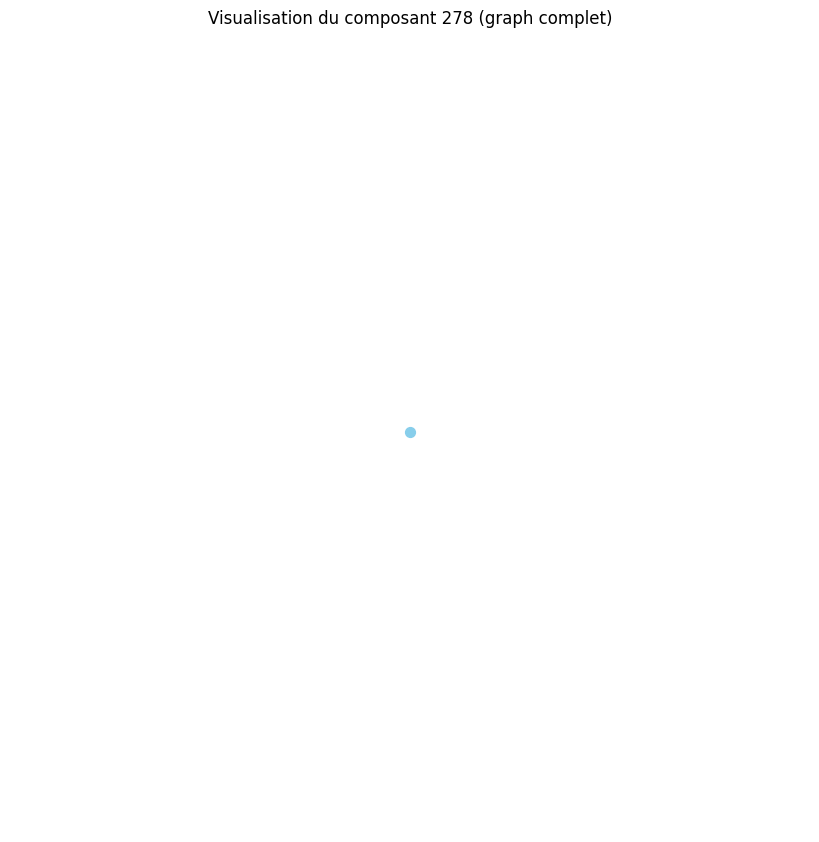

Distance moyenne pour le composant 279 : 0.00
Le composant 279 est un graphe complet ou très densément connecté.
Densité du composant 279 : 0.00
Degré moyen du composant 279 : 0.00
Coefficient de clustering moyen du composant 279 : 0.00


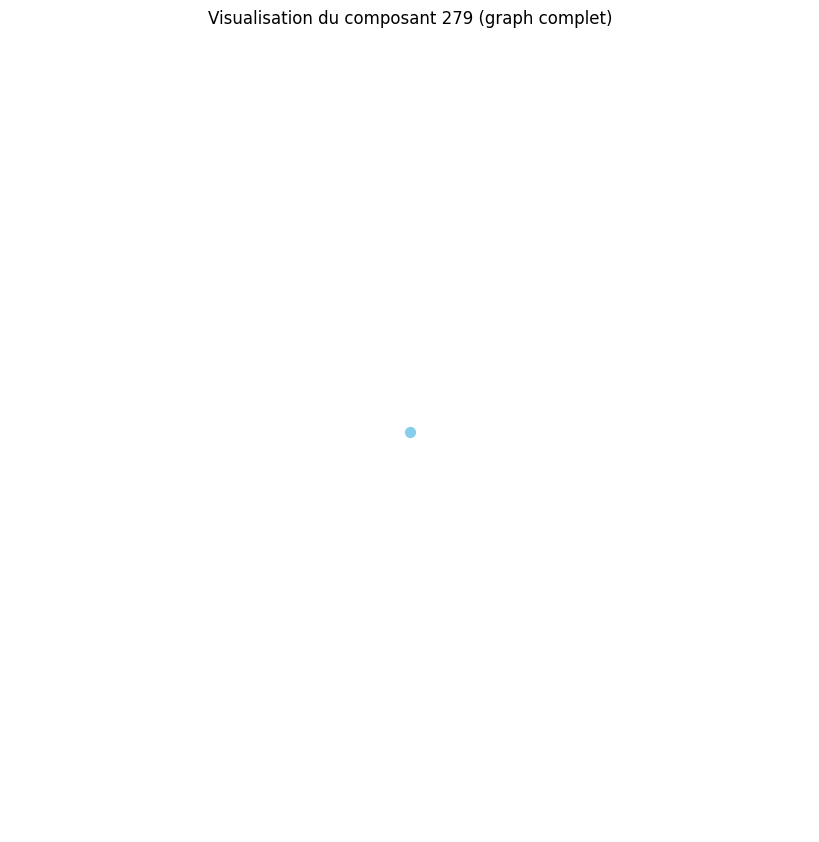

Distance moyenne pour le composant 280 : 0.00
Le composant 280 est un graphe complet ou très densément connecté.
Densité du composant 280 : 0.00
Degré moyen du composant 280 : 0.00
Coefficient de clustering moyen du composant 280 : 0.00


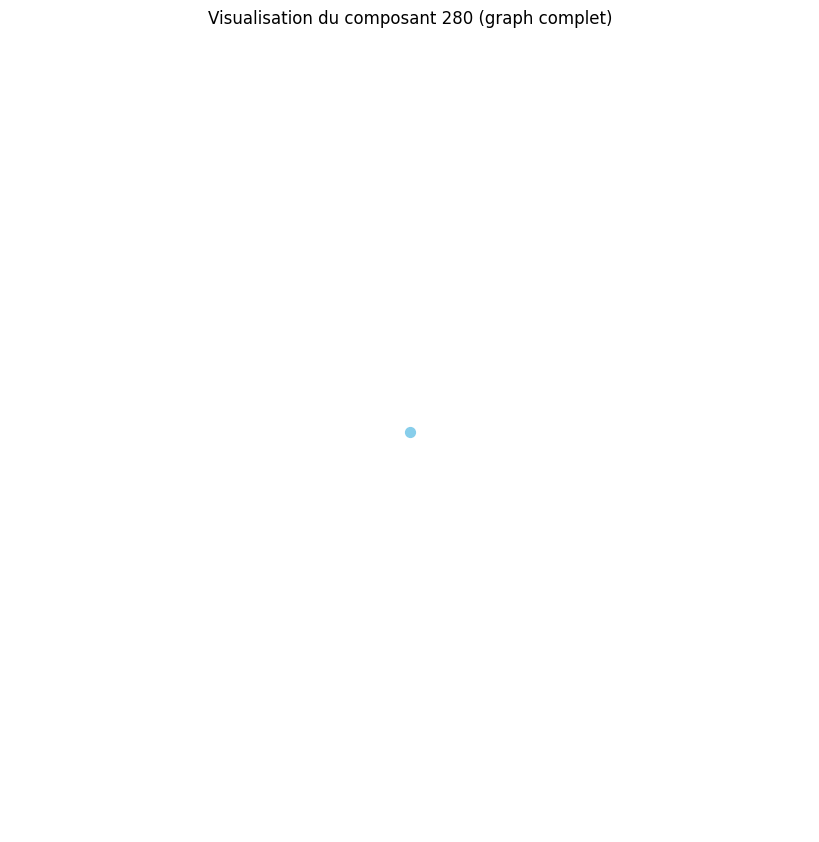

Distance moyenne pour le composant 281 : 0.00
Le composant 281 est un graphe complet ou très densément connecté.
Densité du composant 281 : 0.00
Degré moyen du composant 281 : 0.00
Coefficient de clustering moyen du composant 281 : 0.00


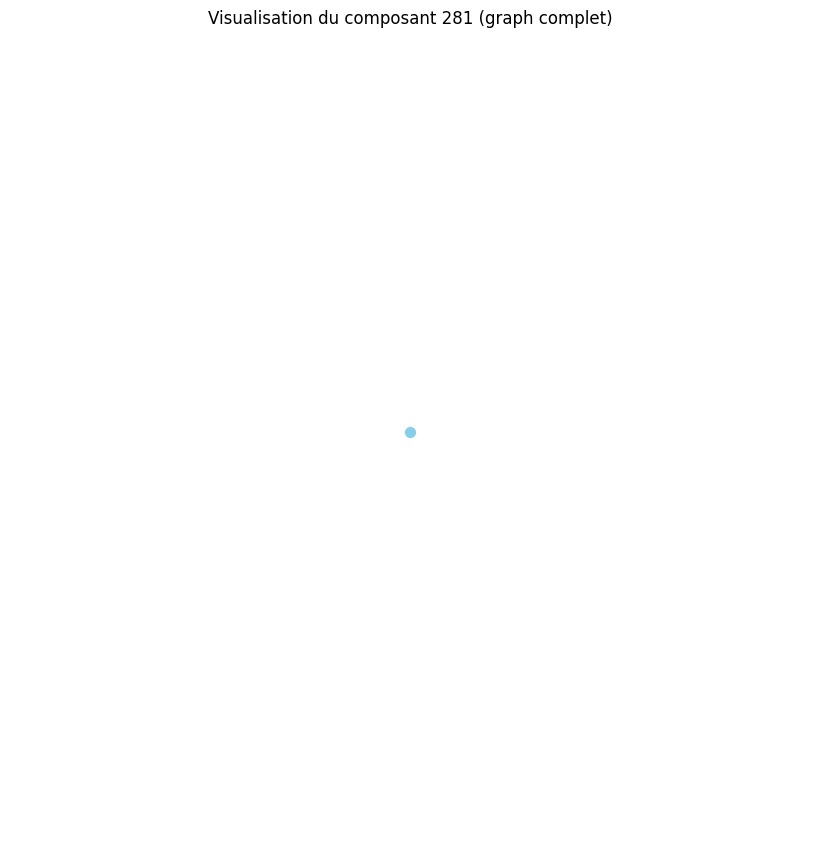

Distance moyenne pour le composant 282 : 0.00
Le composant 282 est un graphe complet ou très densément connecté.
Densité du composant 282 : 0.00
Degré moyen du composant 282 : 0.00
Coefficient de clustering moyen du composant 282 : 0.00


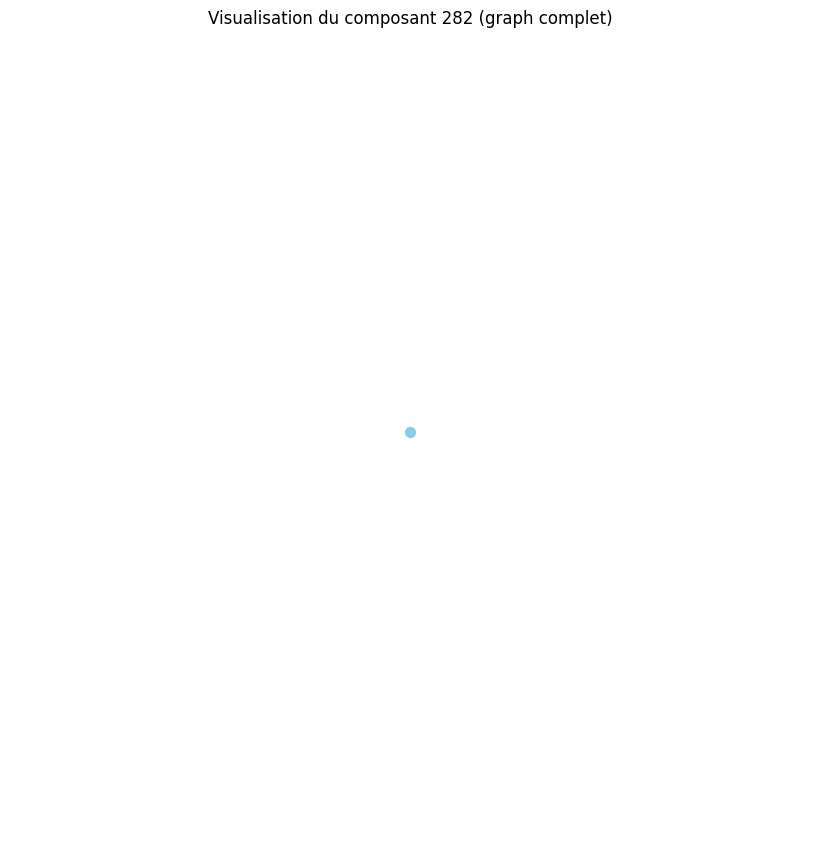

Distance moyenne pour le composant 283 : 0.00
Le composant 283 est un graphe complet ou très densément connecté.
Densité du composant 283 : 0.00
Degré moyen du composant 283 : 0.00
Coefficient de clustering moyen du composant 283 : 0.00


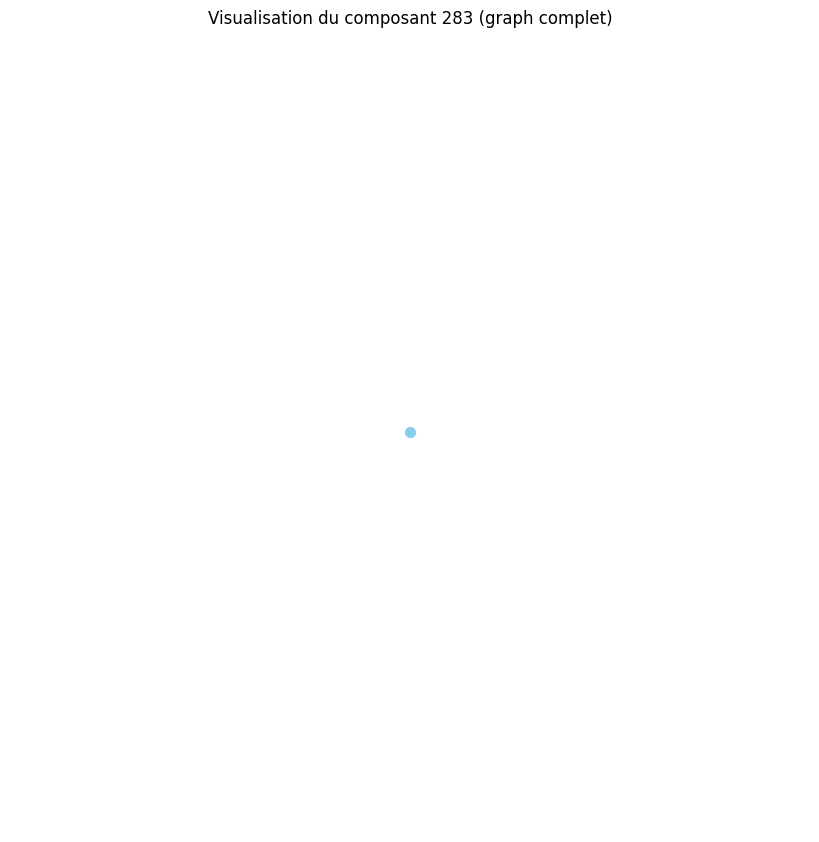

Distance moyenne pour le composant 284 : 0.00
Le composant 284 est un graphe complet ou très densément connecté.
Densité du composant 284 : 0.00
Degré moyen du composant 284 : 0.00
Coefficient de clustering moyen du composant 284 : 0.00


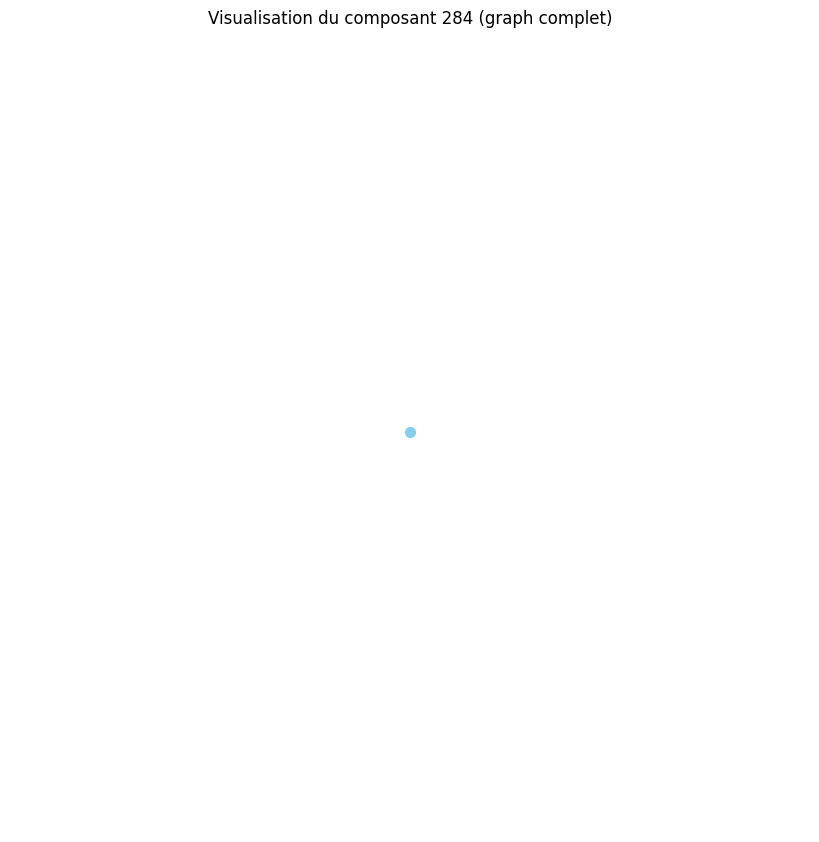

Distance moyenne pour le composant 285 : 0.00
Le composant 285 est un graphe complet ou très densément connecté.
Densité du composant 285 : 0.00
Degré moyen du composant 285 : 0.00
Coefficient de clustering moyen du composant 285 : 0.00


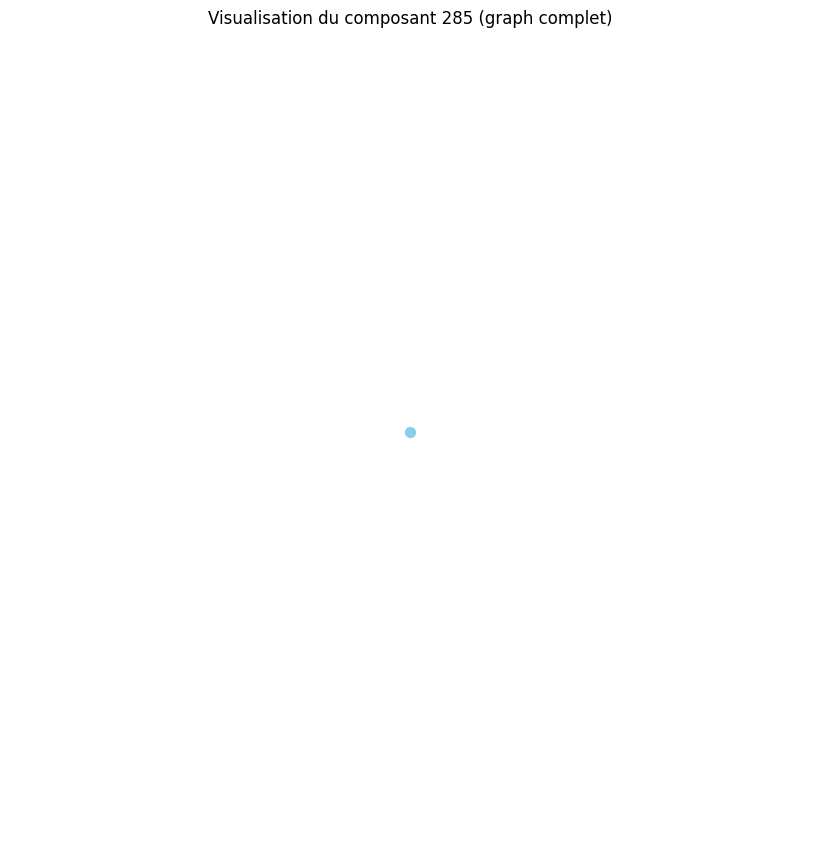

Distance moyenne pour le composant 286 : 0.00
Le composant 286 est un graphe complet ou très densément connecté.
Densité du composant 286 : 0.00
Degré moyen du composant 286 : 0.00
Coefficient de clustering moyen du composant 286 : 0.00


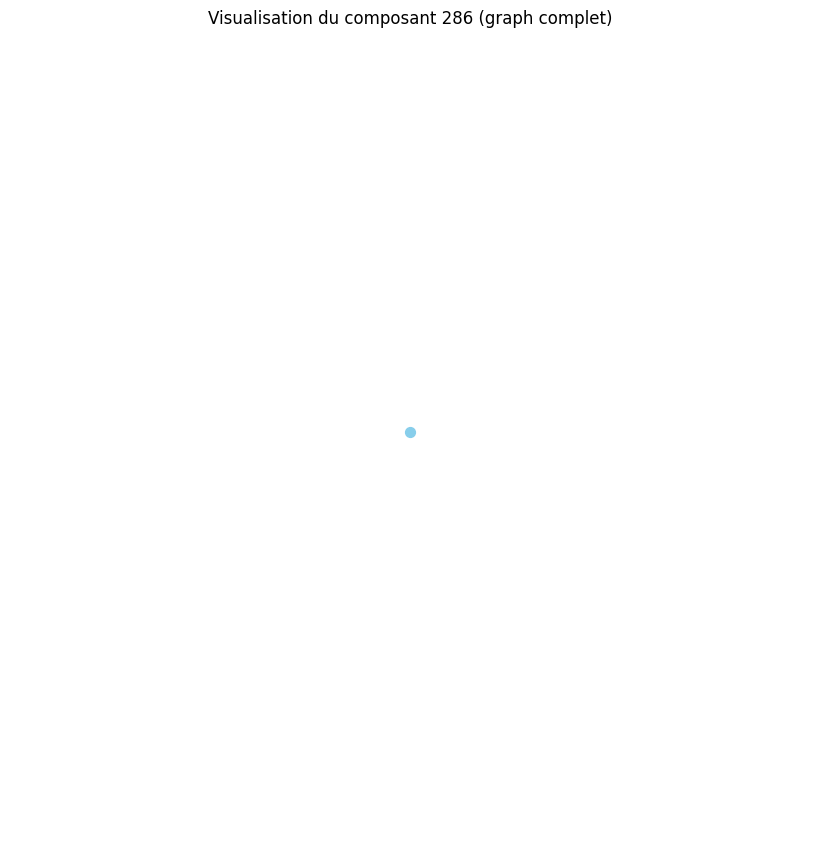

Distance moyenne pour le composant 287 : 0.00
Le composant 287 est un graphe complet ou très densément connecté.
Densité du composant 287 : 0.00
Degré moyen du composant 287 : 0.00
Coefficient de clustering moyen du composant 287 : 0.00


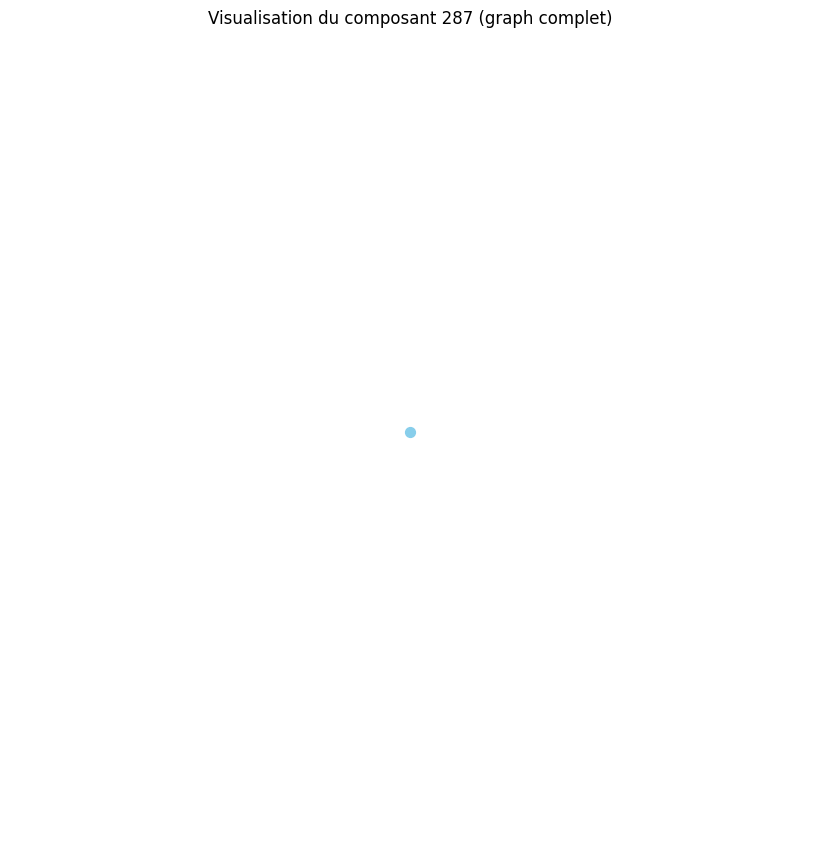

Distance moyenne pour le composant 288 : 0.00
Le composant 288 est un graphe complet ou très densément connecté.
Densité du composant 288 : 0.00
Degré moyen du composant 288 : 0.00
Coefficient de clustering moyen du composant 288 : 0.00


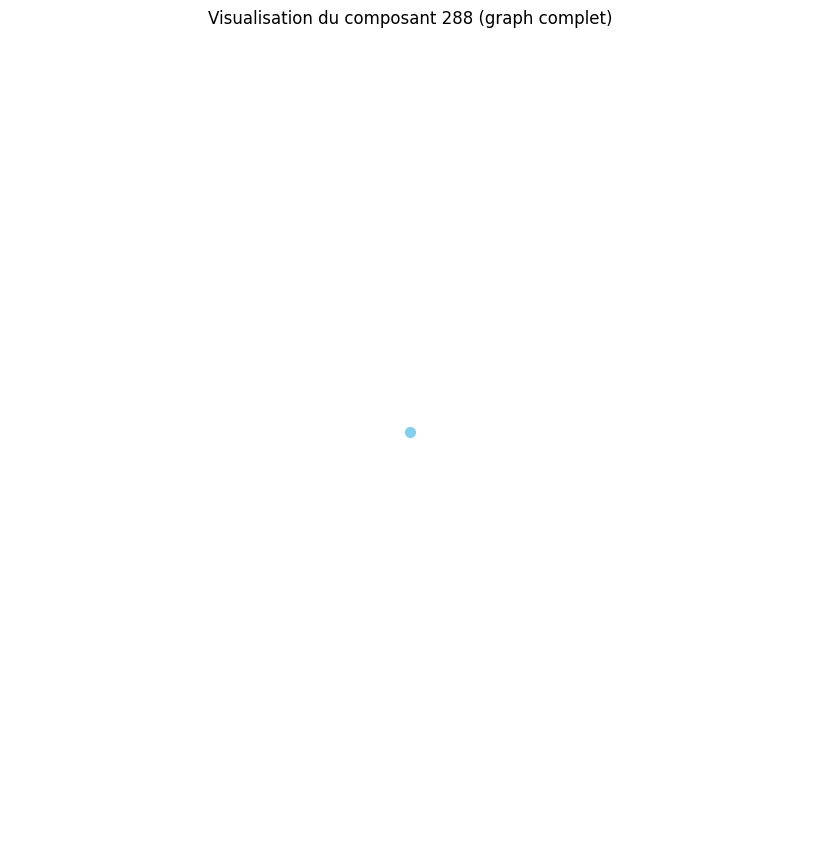

Distance moyenne pour le composant 289 : 0.00
Le composant 289 est un graphe complet ou très densément connecté.
Densité du composant 289 : 0.00
Degré moyen du composant 289 : 0.00
Coefficient de clustering moyen du composant 289 : 0.00


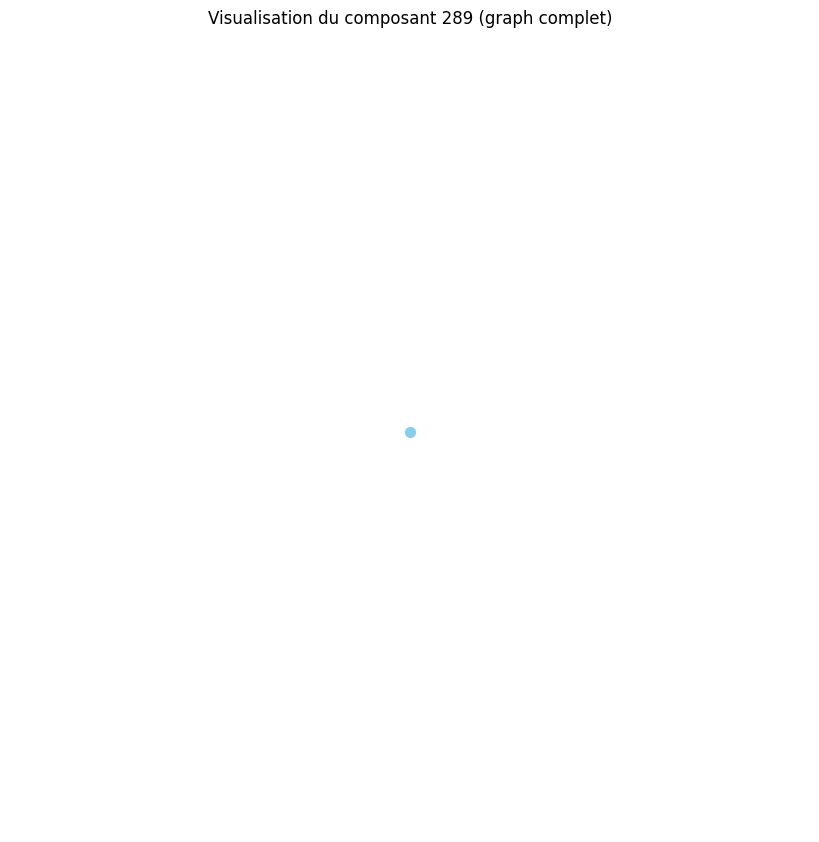

Distance moyenne pour le composant 290 : 0.00
Le composant 290 est un graphe complet ou très densément connecté.
Densité du composant 290 : 0.00
Degré moyen du composant 290 : 0.00
Coefficient de clustering moyen du composant 290 : 0.00


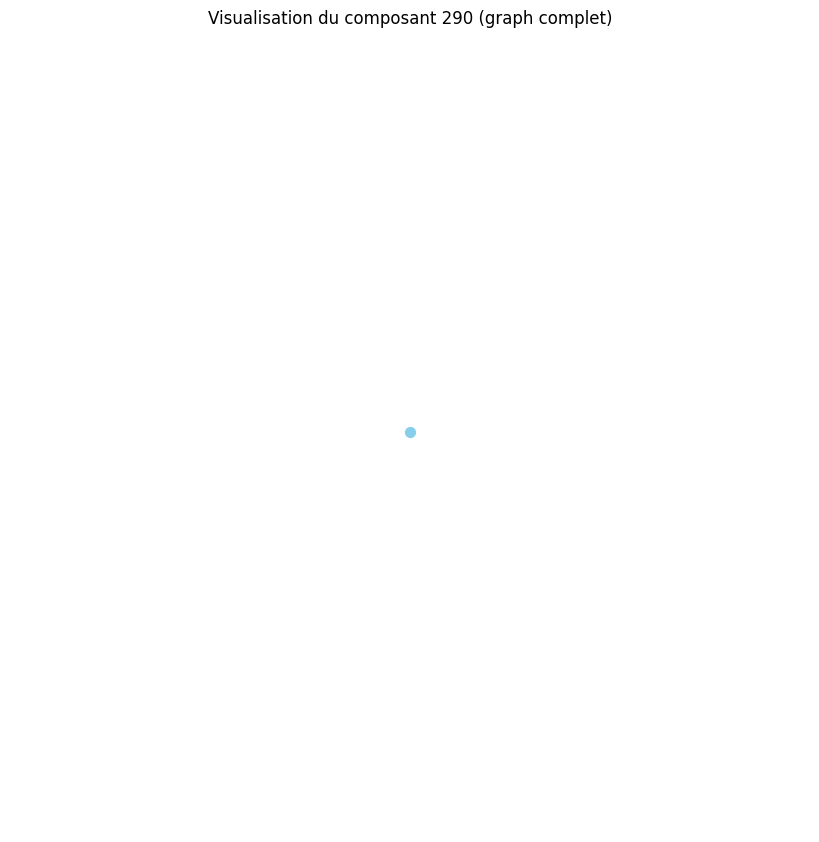

Distance moyenne pour le composant 291 : 0.00
Le composant 291 est un graphe complet ou très densément connecté.
Densité du composant 291 : 0.00
Degré moyen du composant 291 : 0.00
Coefficient de clustering moyen du composant 291 : 0.00


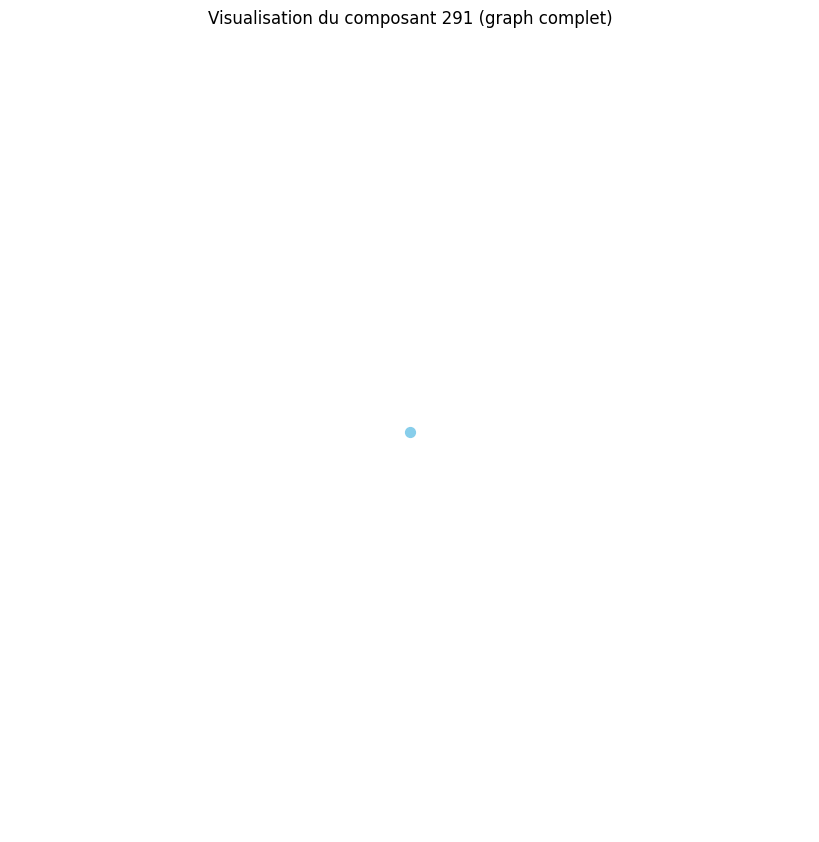

Distance moyenne pour le composant 292 : 0.00
Le composant 292 est un graphe complet ou très densément connecté.
Densité du composant 292 : 0.00
Degré moyen du composant 292 : 0.00
Coefficient de clustering moyen du composant 292 : 0.00


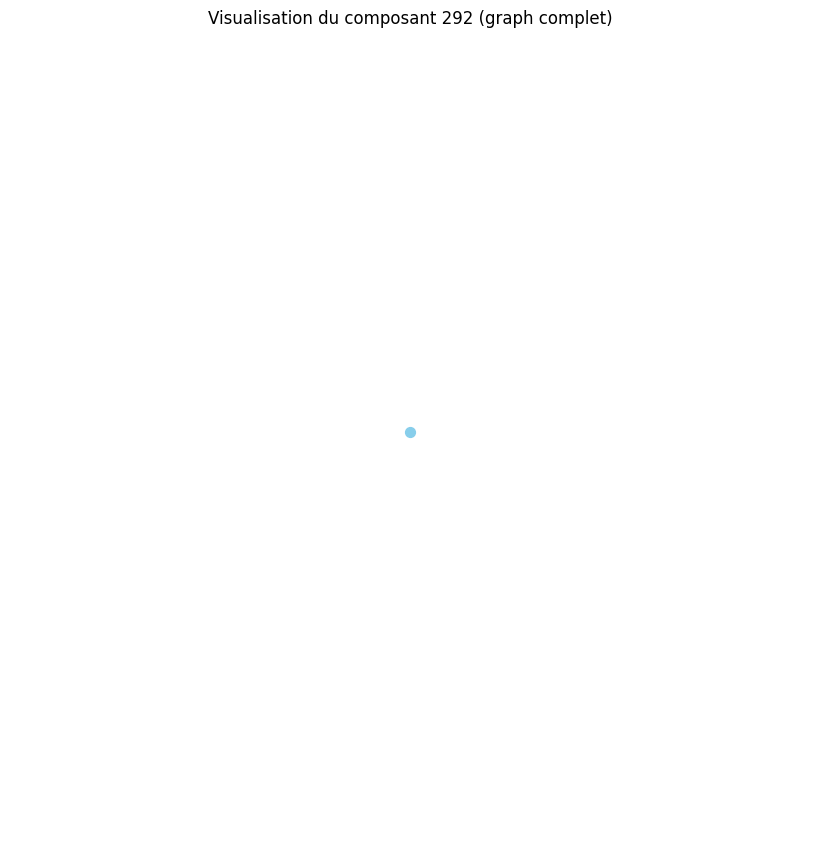

Distance moyenne pour le composant 293 : 0.00
Le composant 293 est un graphe complet ou très densément connecté.
Densité du composant 293 : 0.00
Degré moyen du composant 293 : 0.00
Coefficient de clustering moyen du composant 293 : 0.00


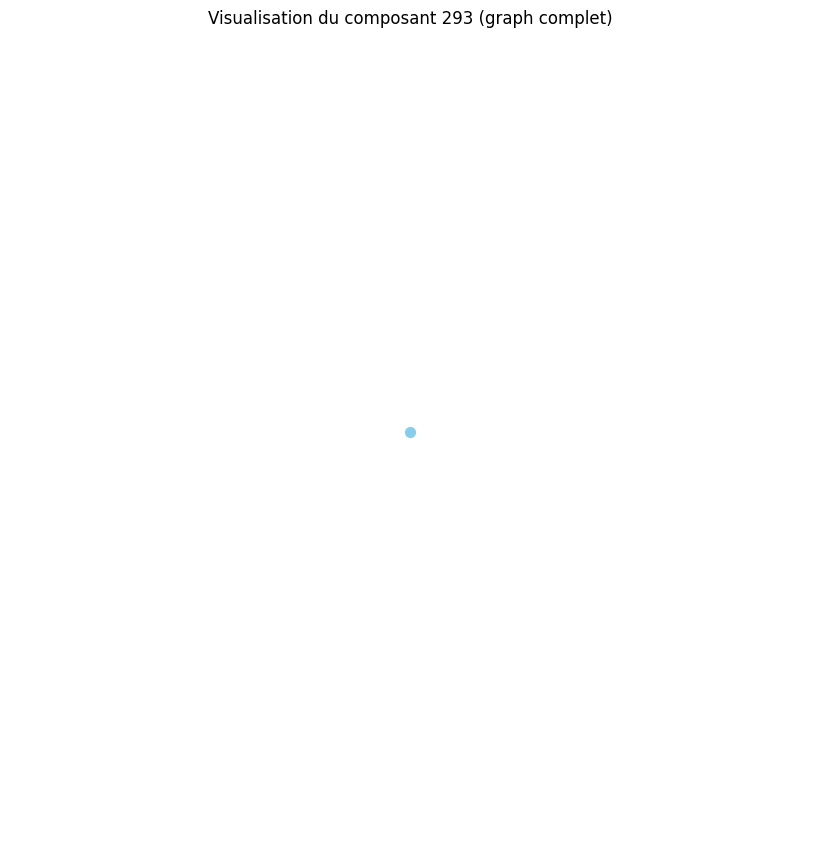

Distance moyenne pour le composant 294 : 1.87
Distance moyenne pour le composant 295 : 0.00
Le composant 295 est un graphe complet ou très densément connecté.
Densité du composant 295 : 0.00
Degré moyen du composant 295 : 0.00
Coefficient de clustering moyen du composant 295 : 0.00


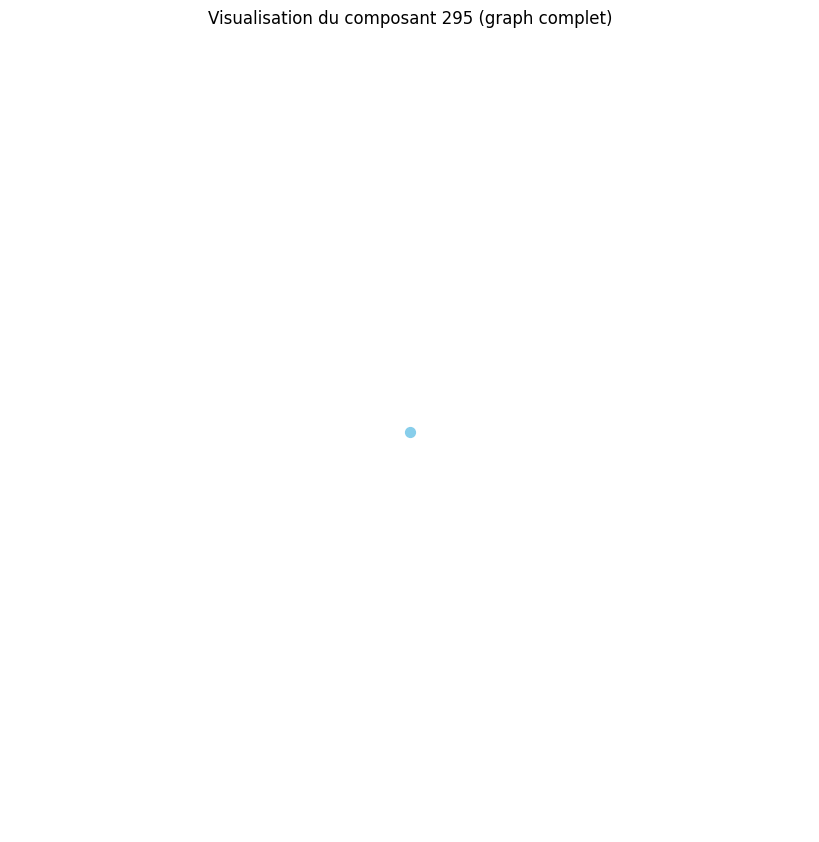

Distance moyenne pour le composant 296 : 0.00
Le composant 296 est un graphe complet ou très densément connecté.
Densité du composant 296 : 0.00
Degré moyen du composant 296 : 0.00
Coefficient de clustering moyen du composant 296 : 0.00


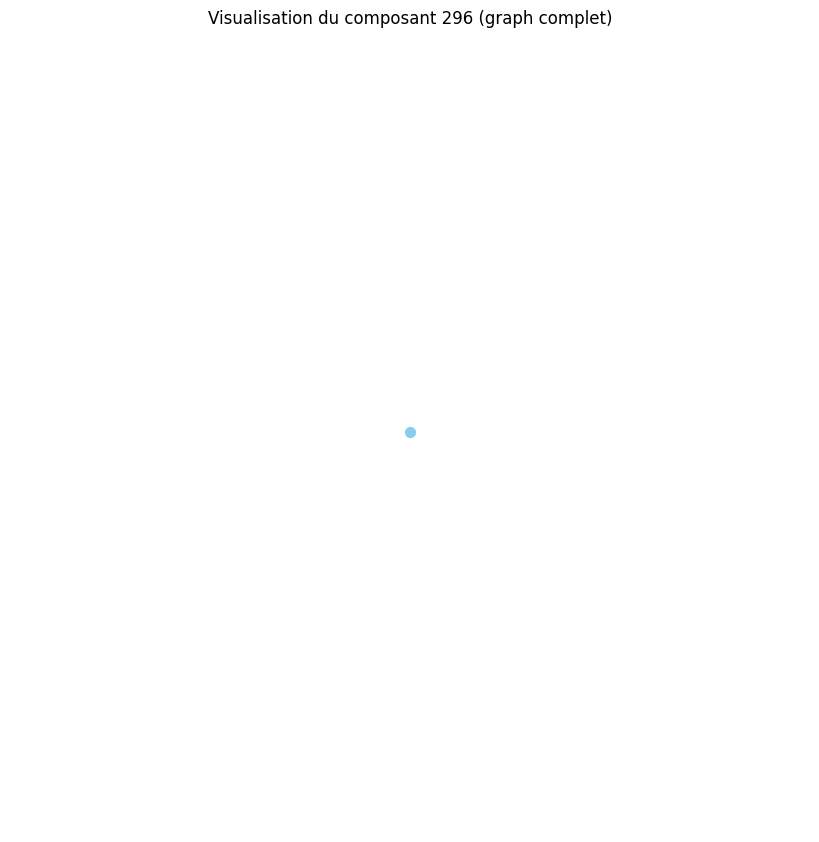

Distance moyenne pour le composant 297 : 0.00
Le composant 297 est un graphe complet ou très densément connecté.
Densité du composant 297 : 0.00
Degré moyen du composant 297 : 0.00
Coefficient de clustering moyen du composant 297 : 0.00


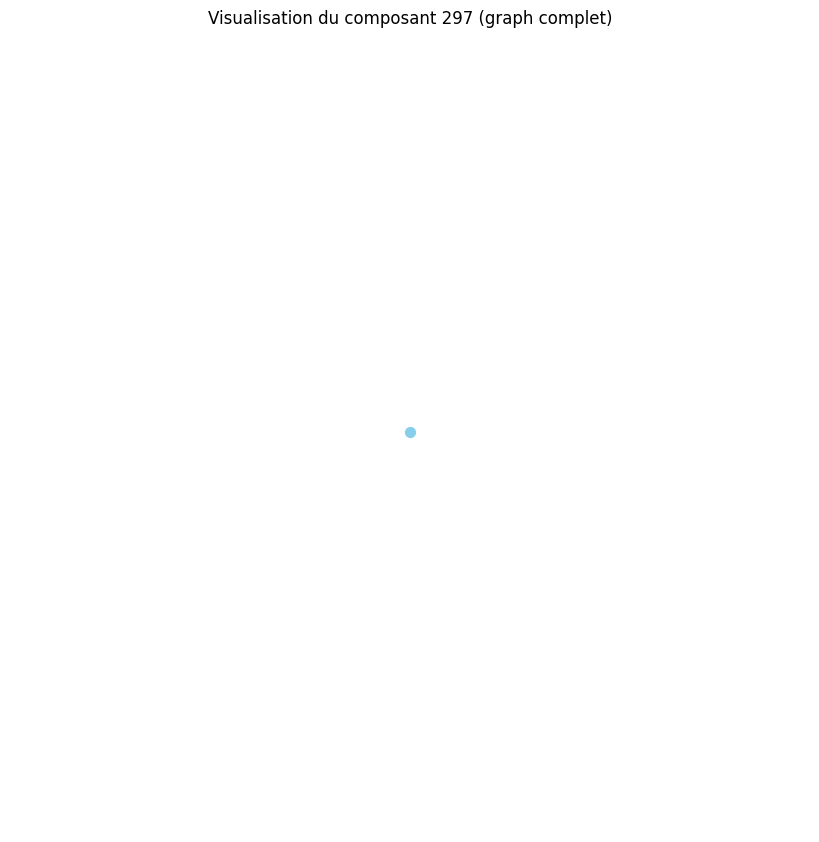

Distance moyenne pour le composant 298 : 0.00
Le composant 298 est un graphe complet ou très densément connecté.
Densité du composant 298 : 0.00
Degré moyen du composant 298 : 0.00
Coefficient de clustering moyen du composant 298 : 0.00


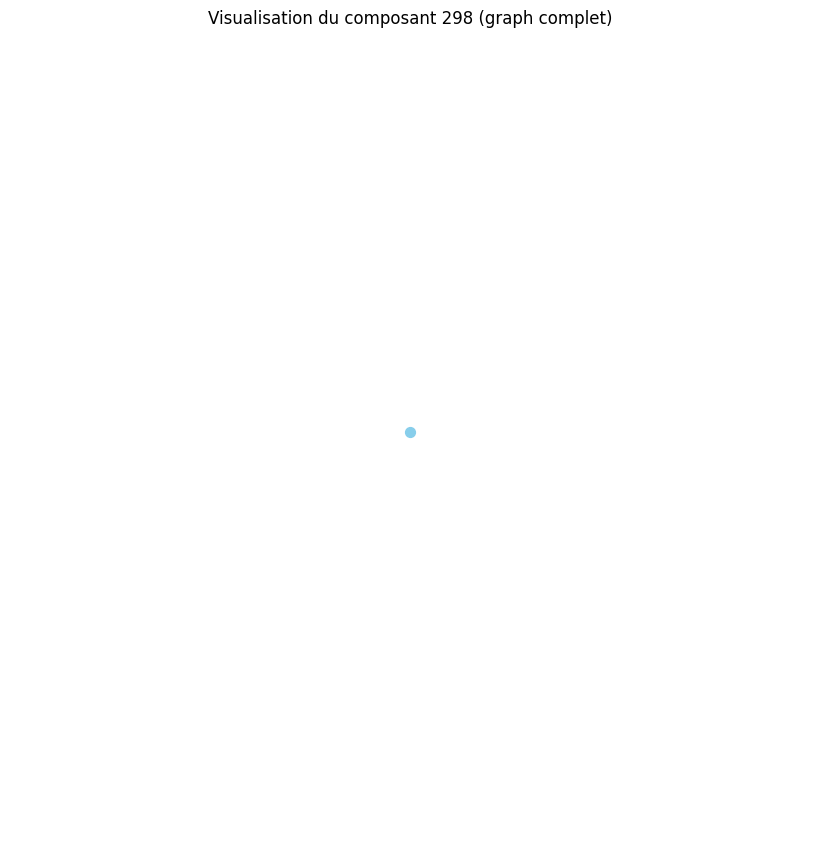

Distance moyenne pour le composant 299 : 0.00
Le composant 299 est un graphe complet ou très densément connecté.
Densité du composant 299 : 0.00
Degré moyen du composant 299 : 0.00
Coefficient de clustering moyen du composant 299 : 0.00


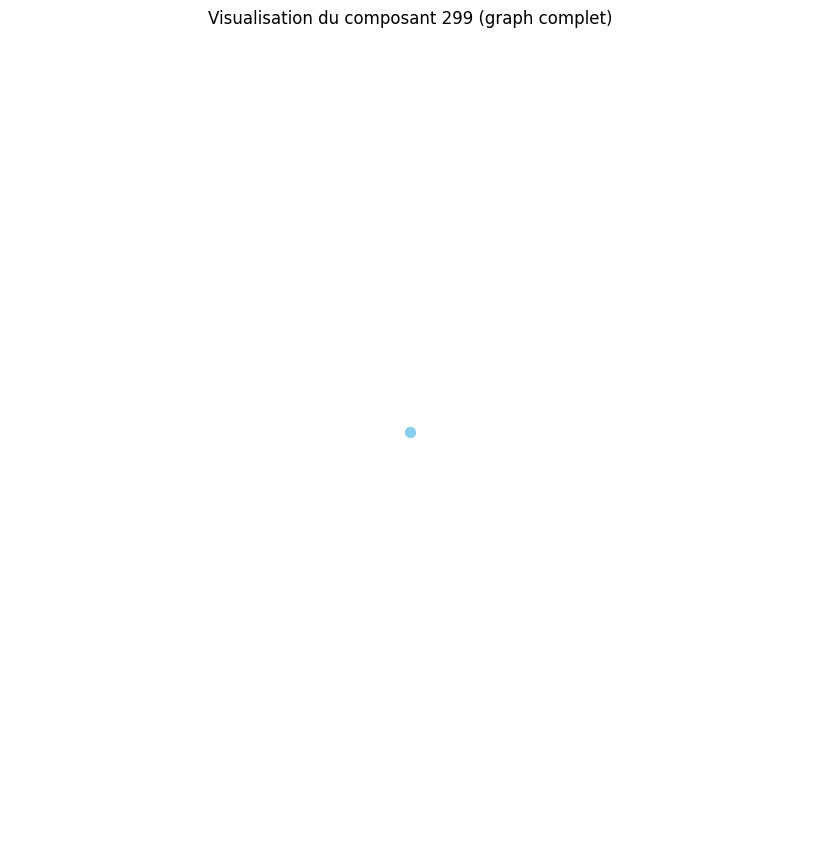

Distance moyenne pour le composant 300 : 0.00
Le composant 300 est un graphe complet ou très densément connecté.
Densité du composant 300 : 0.00
Degré moyen du composant 300 : 0.00
Coefficient de clustering moyen du composant 300 : 0.00


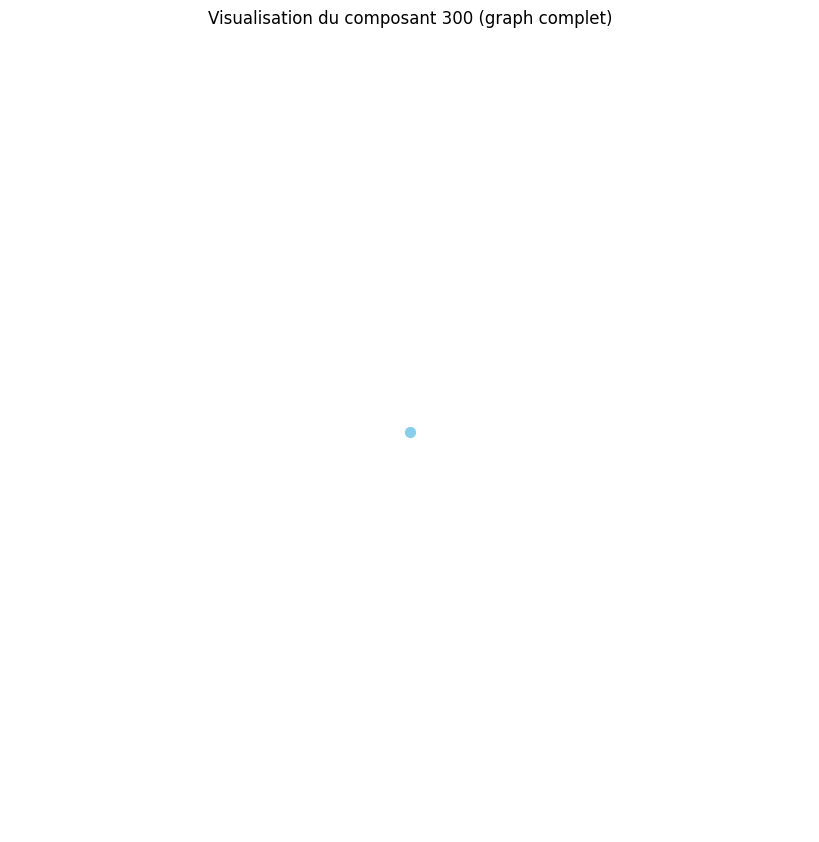

Distance moyenne pour le composant 301 : 0.00
Le composant 301 est un graphe complet ou très densément connecté.
Densité du composant 301 : 0.00
Degré moyen du composant 301 : 0.00
Coefficient de clustering moyen du composant 301 : 0.00


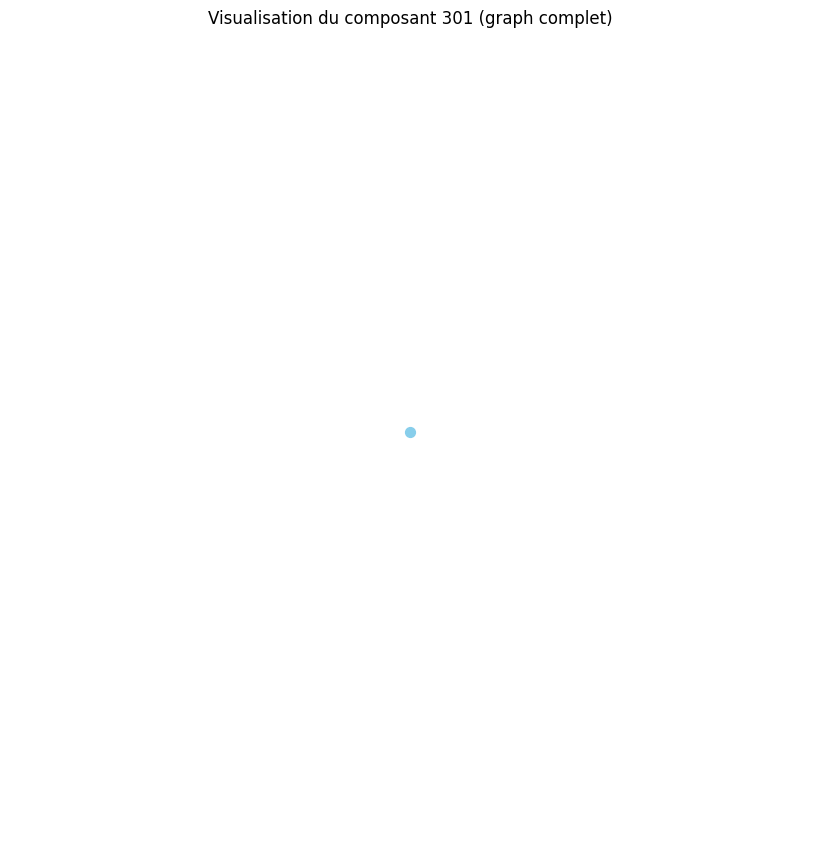

Distance moyenne pour le composant 302 : 0.00
Le composant 302 est un graphe complet ou très densément connecté.
Densité du composant 302 : 0.00
Degré moyen du composant 302 : 0.00
Coefficient de clustering moyen du composant 302 : 0.00


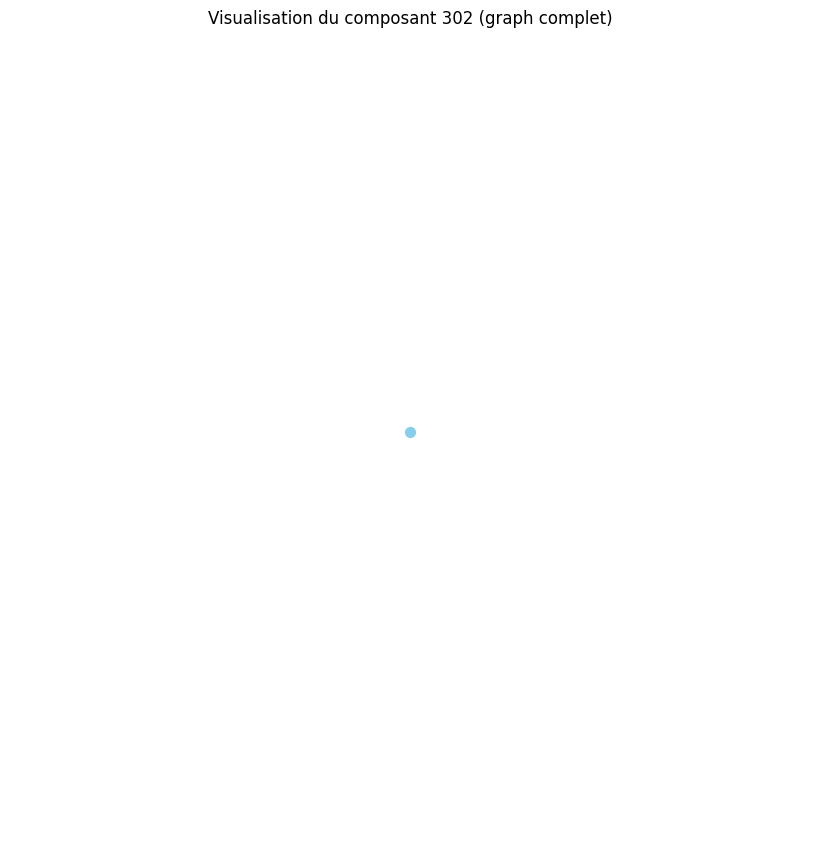

Distance moyenne pour le composant 303 : 1.00
Distance moyenne pour le composant 304 : 0.00
Le composant 304 est un graphe complet ou très densément connecté.
Densité du composant 304 : 0.00
Degré moyen du composant 304 : 0.00
Coefficient de clustering moyen du composant 304 : 0.00


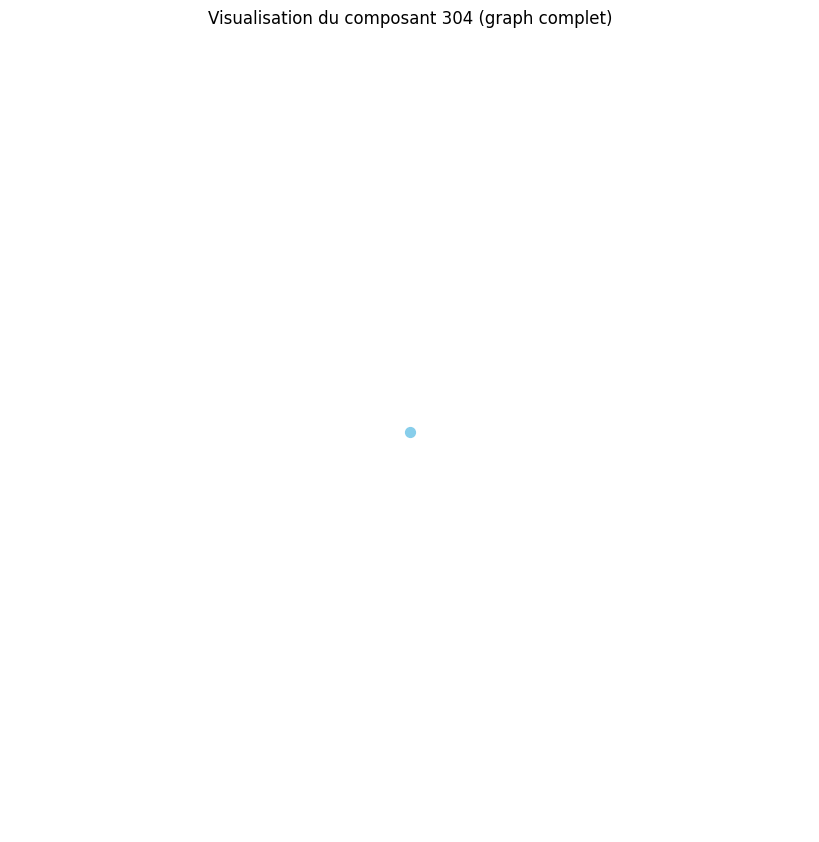

Distance moyenne pour le composant 305 : 0.00
Le composant 305 est un graphe complet ou très densément connecté.
Densité du composant 305 : 0.00
Degré moyen du composant 305 : 0.00
Coefficient de clustering moyen du composant 305 : 0.00


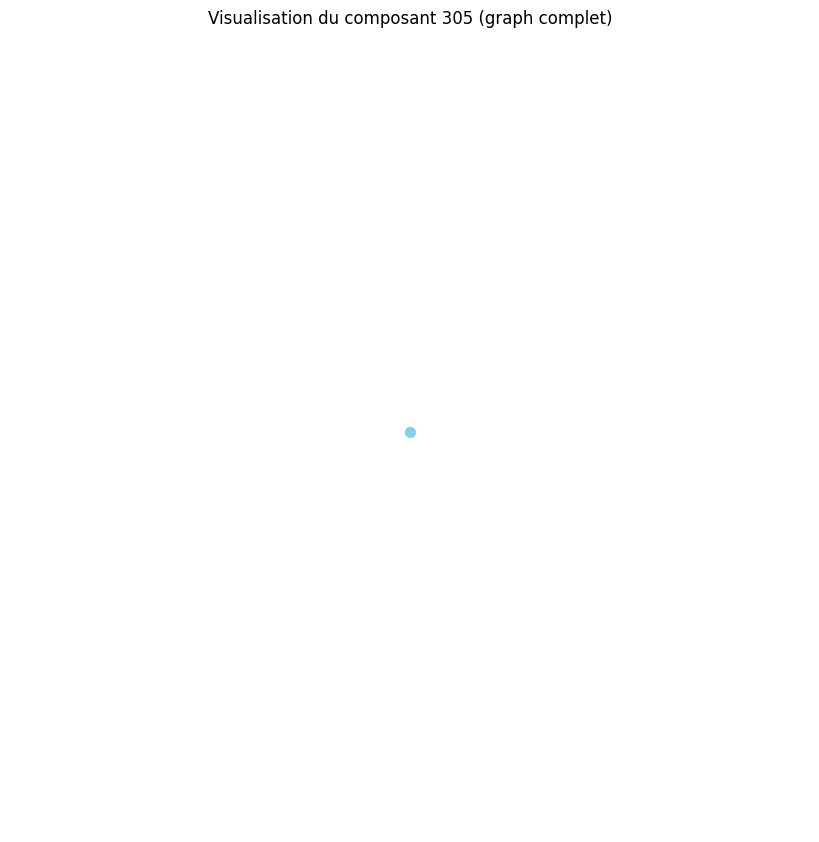

Distance moyenne pour le composant 306 : 0.00
Le composant 306 est un graphe complet ou très densément connecté.
Densité du composant 306 : 0.00
Degré moyen du composant 306 : 0.00
Coefficient de clustering moyen du composant 306 : 0.00


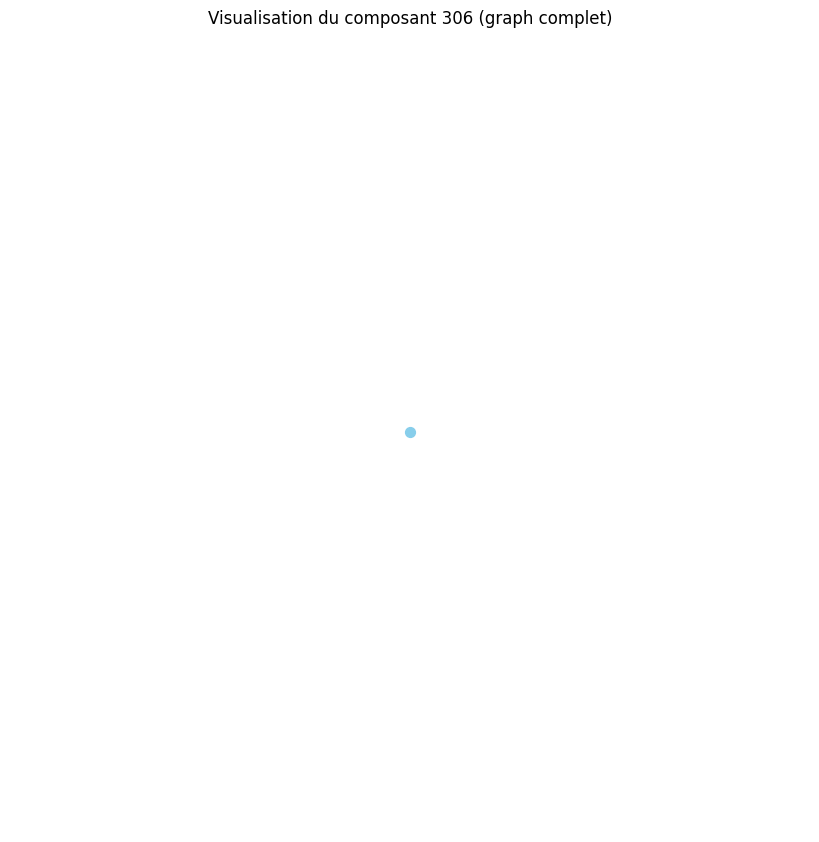

Distance moyenne pour le composant 307 : 0.00
Le composant 307 est un graphe complet ou très densément connecté.
Densité du composant 307 : 0.00
Degré moyen du composant 307 : 0.00
Coefficient de clustering moyen du composant 307 : 0.00


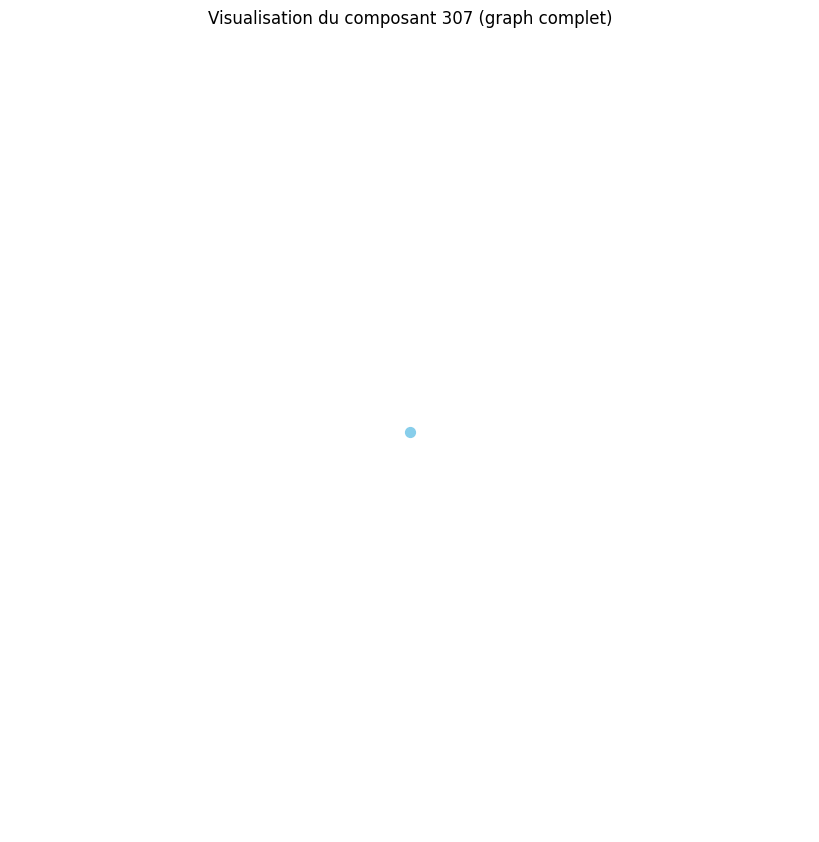

Distance moyenne pour le composant 308 : 0.00
Le composant 308 est un graphe complet ou très densément connecté.
Densité du composant 308 : 0.00
Degré moyen du composant 308 : 0.00
Coefficient de clustering moyen du composant 308 : 0.00


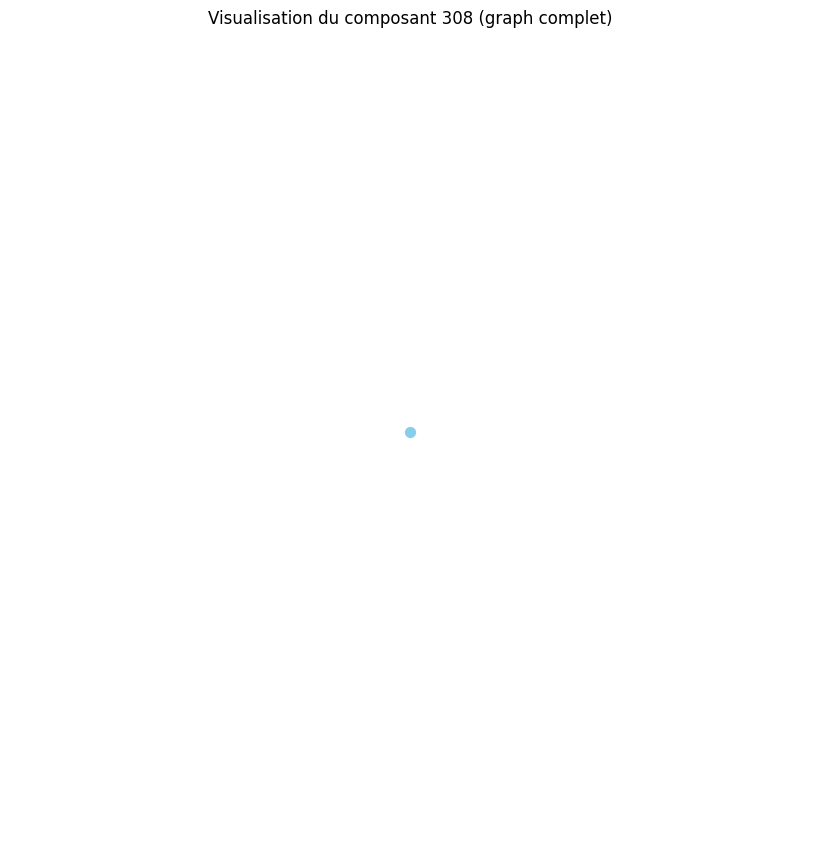

Distance moyenne pour le composant 309 : 0.00
Le composant 309 est un graphe complet ou très densément connecté.
Densité du composant 309 : 0.00
Degré moyen du composant 309 : 0.00
Coefficient de clustering moyen du composant 309 : 0.00


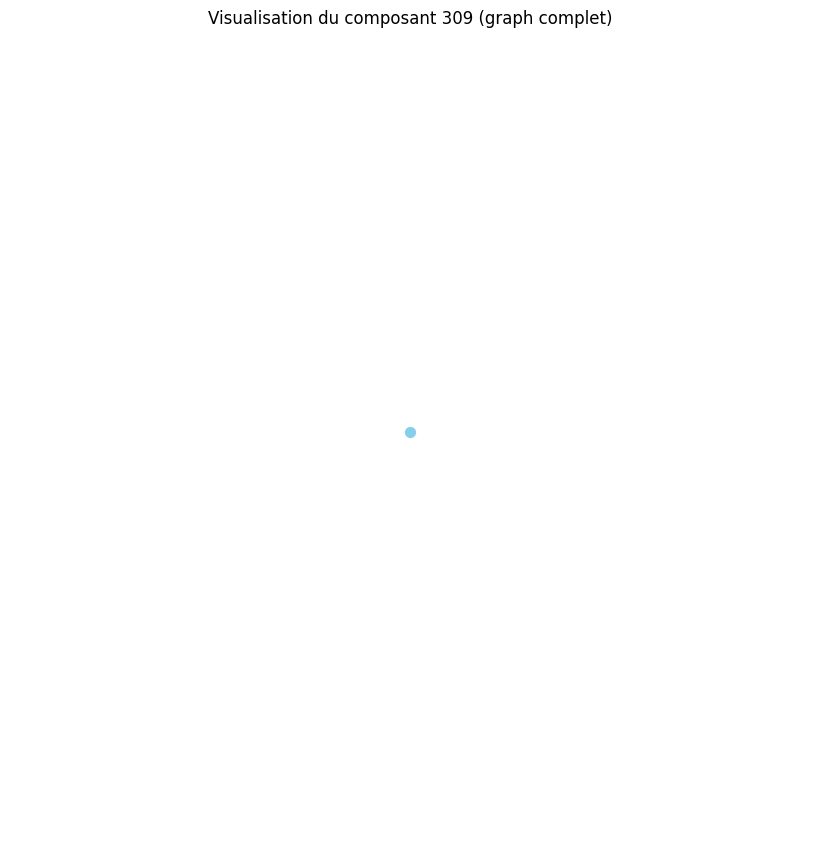

Distance moyenne pour le composant 310 : 0.00
Le composant 310 est un graphe complet ou très densément connecté.
Densité du composant 310 : 0.00
Degré moyen du composant 310 : 0.00
Coefficient de clustering moyen du composant 310 : 0.00


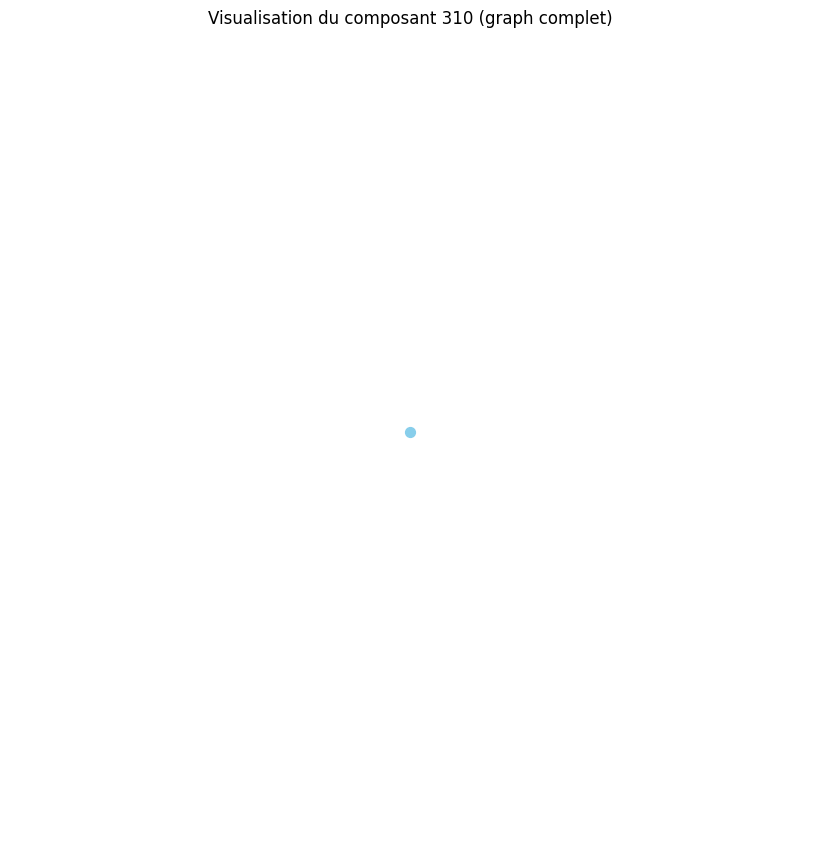

Distance moyenne pour le composant 311 : 0.00
Le composant 311 est un graphe complet ou très densément connecté.
Densité du composant 311 : 0.00
Degré moyen du composant 311 : 0.00
Coefficient de clustering moyen du composant 311 : 0.00


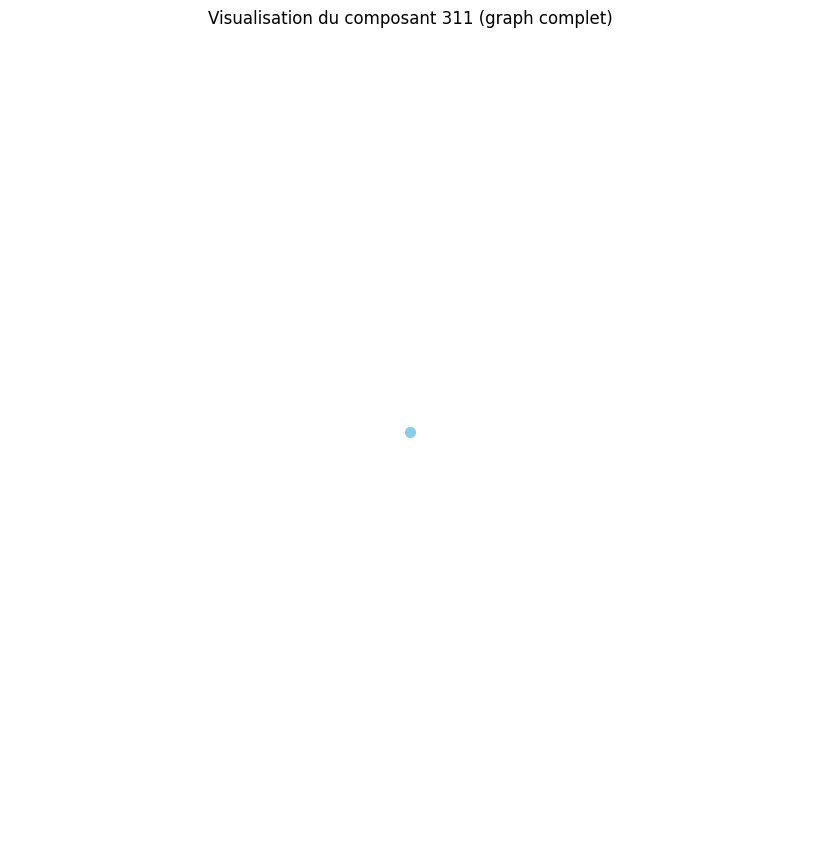

Distance moyenne pour le composant 312 : 0.00
Le composant 312 est un graphe complet ou très densément connecté.
Densité du composant 312 : 0.00
Degré moyen du composant 312 : 0.00
Coefficient de clustering moyen du composant 312 : 0.00


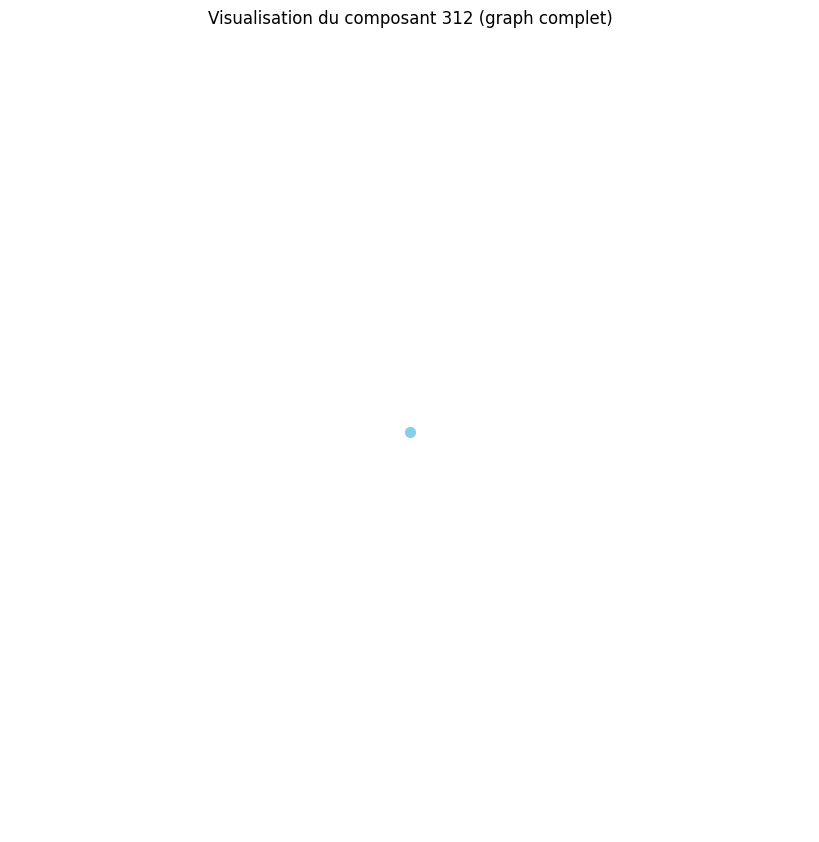

Distance moyenne pour le composant 313 : 0.00
Le composant 313 est un graphe complet ou très densément connecté.
Densité du composant 313 : 0.00
Degré moyen du composant 313 : 0.00
Coefficient de clustering moyen du composant 313 : 0.00


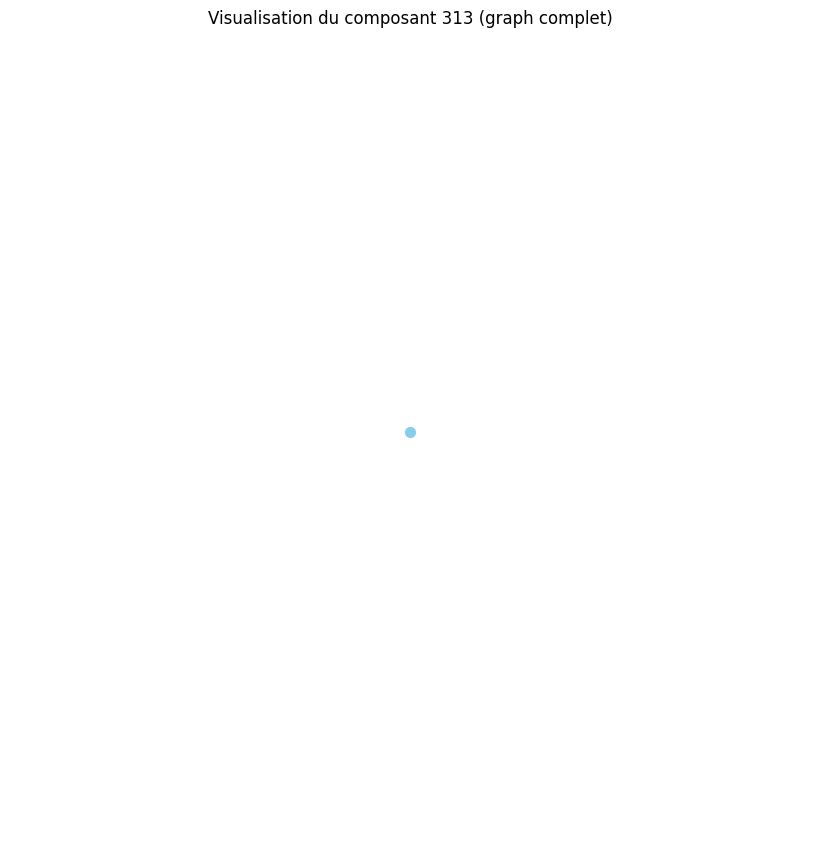

Distance moyenne pour le composant 314 : 0.00
Le composant 314 est un graphe complet ou très densément connecté.
Densité du composant 314 : 0.00
Degré moyen du composant 314 : 0.00
Coefficient de clustering moyen du composant 314 : 0.00


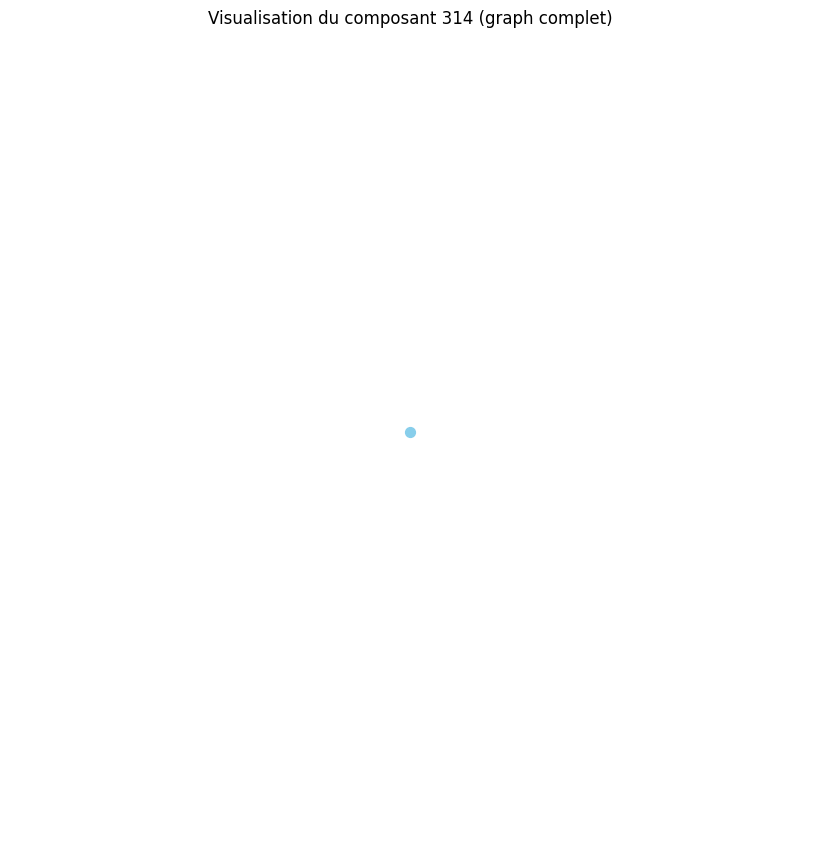

Distance moyenne pour le composant 315 : 1.00
Distance moyenne pour le composant 316 : 0.00
Le composant 316 est un graphe complet ou très densément connecté.
Densité du composant 316 : 0.00
Degré moyen du composant 316 : 0.00
Coefficient de clustering moyen du composant 316 : 0.00


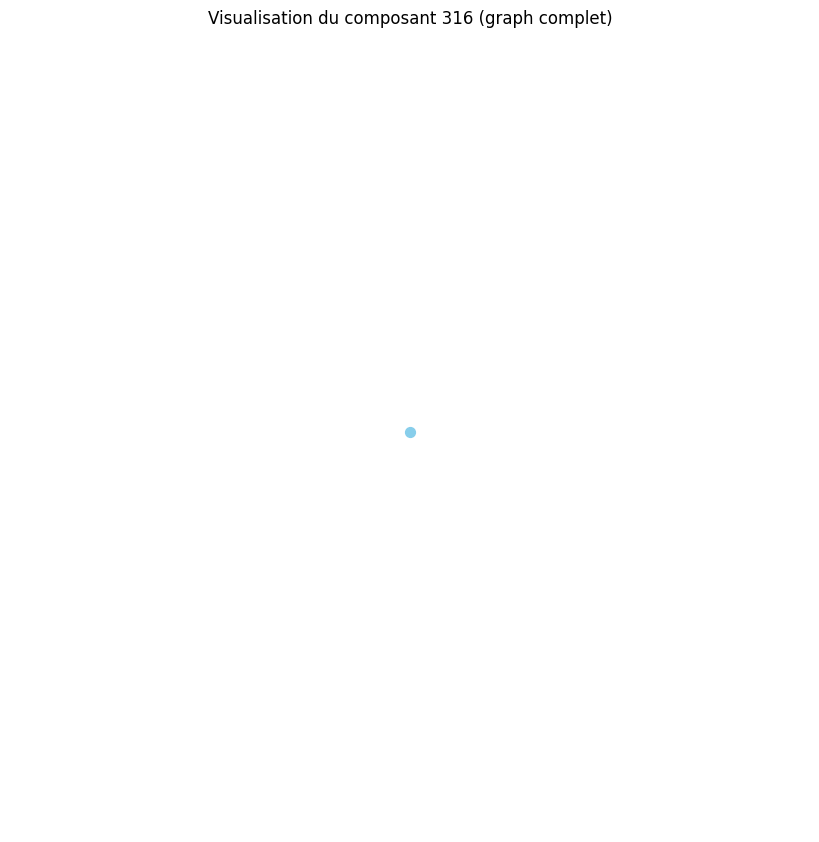

Distance moyenne pour le composant 317 : 0.00
Le composant 317 est un graphe complet ou très densément connecté.
Densité du composant 317 : 0.00
Degré moyen du composant 317 : 0.00
Coefficient de clustering moyen du composant 317 : 0.00


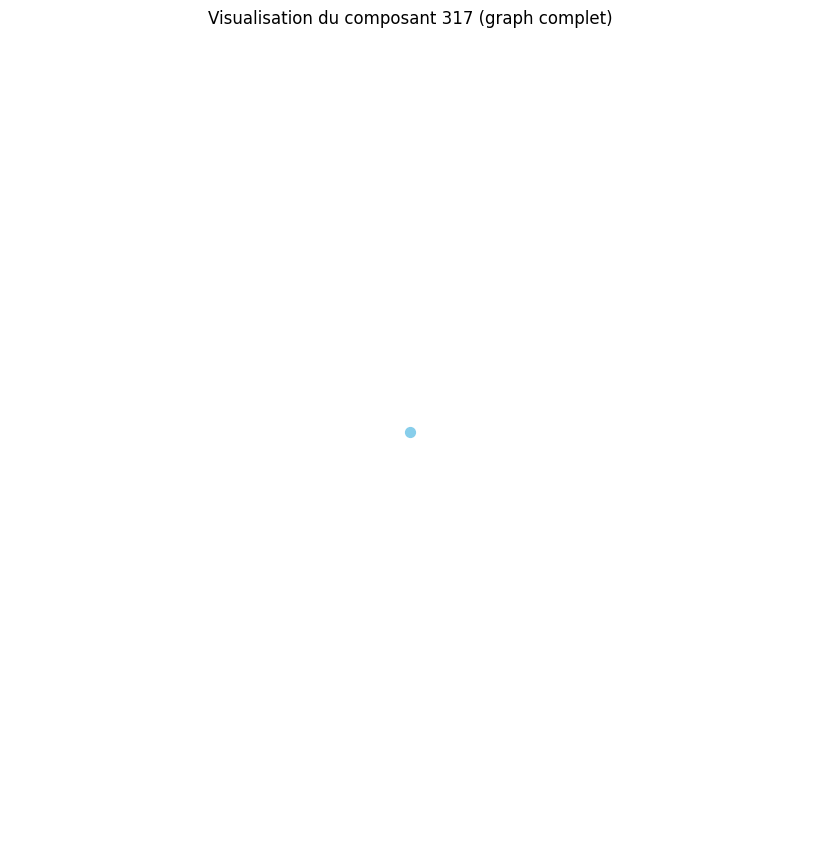

Distance moyenne pour le composant 318 : 0.00
Le composant 318 est un graphe complet ou très densément connecté.
Densité du composant 318 : 0.00
Degré moyen du composant 318 : 0.00
Coefficient de clustering moyen du composant 318 : 0.00


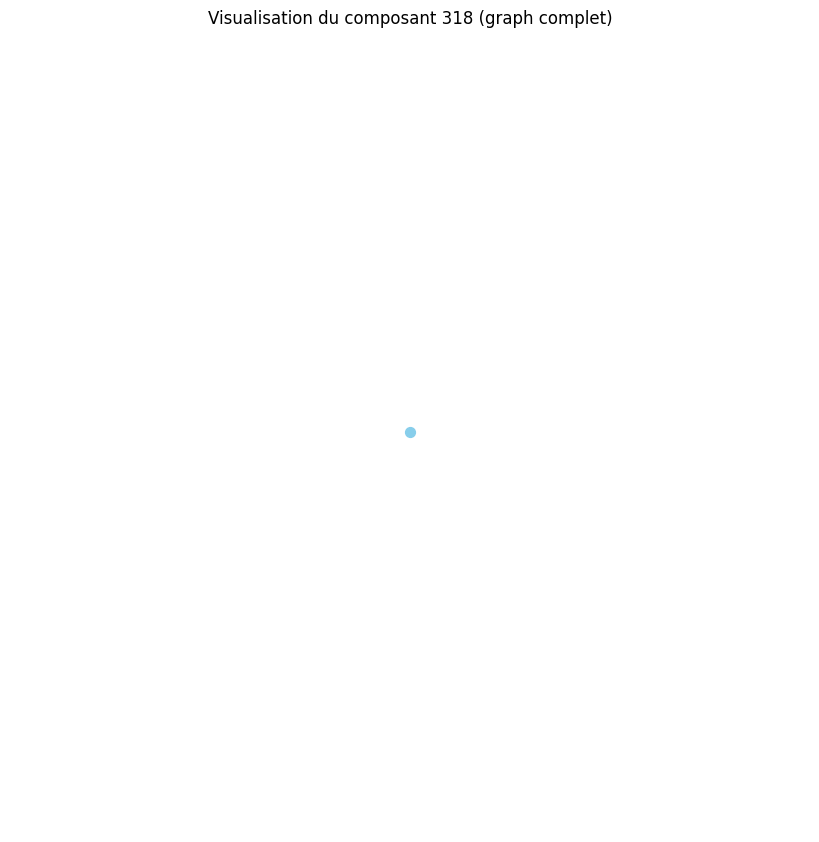

Distance moyenne pour le composant 319 : 0.00
Le composant 319 est un graphe complet ou très densément connecté.
Densité du composant 319 : 0.00
Degré moyen du composant 319 : 0.00
Coefficient de clustering moyen du composant 319 : 0.00


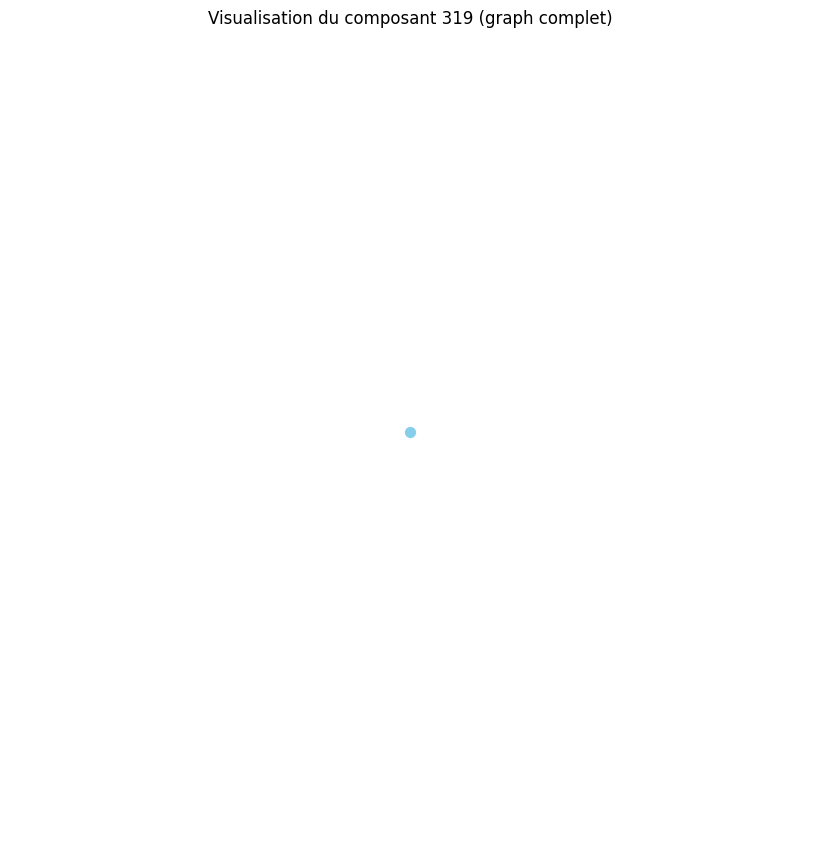

Distance moyenne pour le composant 320 : 0.00
Le composant 320 est un graphe complet ou très densément connecté.
Densité du composant 320 : 0.00
Degré moyen du composant 320 : 0.00
Coefficient de clustering moyen du composant 320 : 0.00


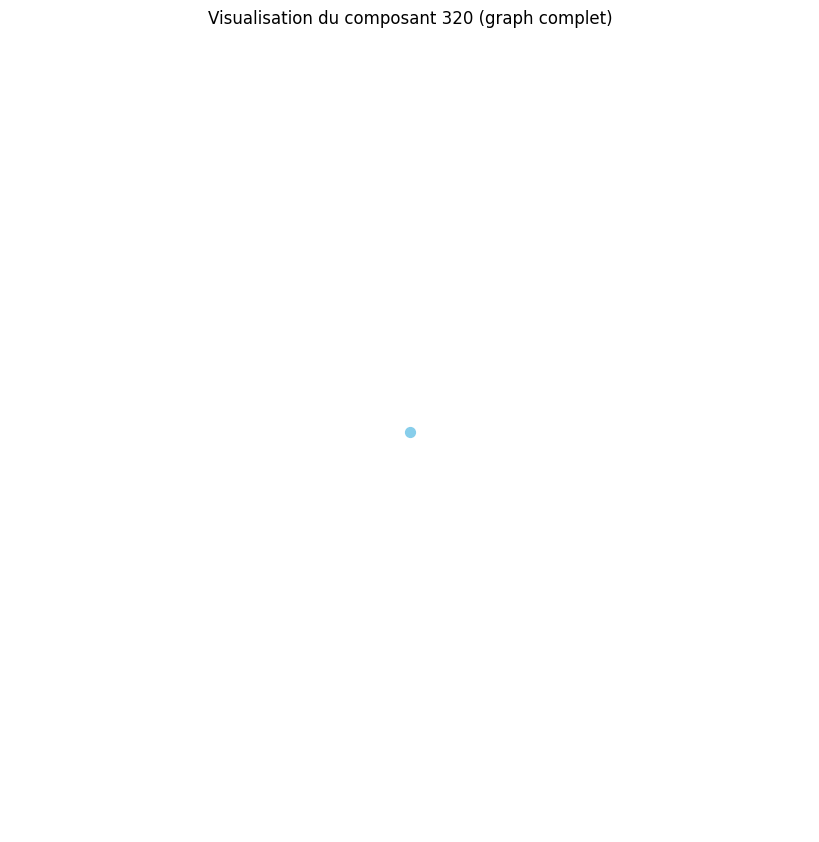

Distance moyenne pour le composant 321 : 0.00
Le composant 321 est un graphe complet ou très densément connecté.
Densité du composant 321 : 0.00
Degré moyen du composant 321 : 0.00
Coefficient de clustering moyen du composant 321 : 0.00


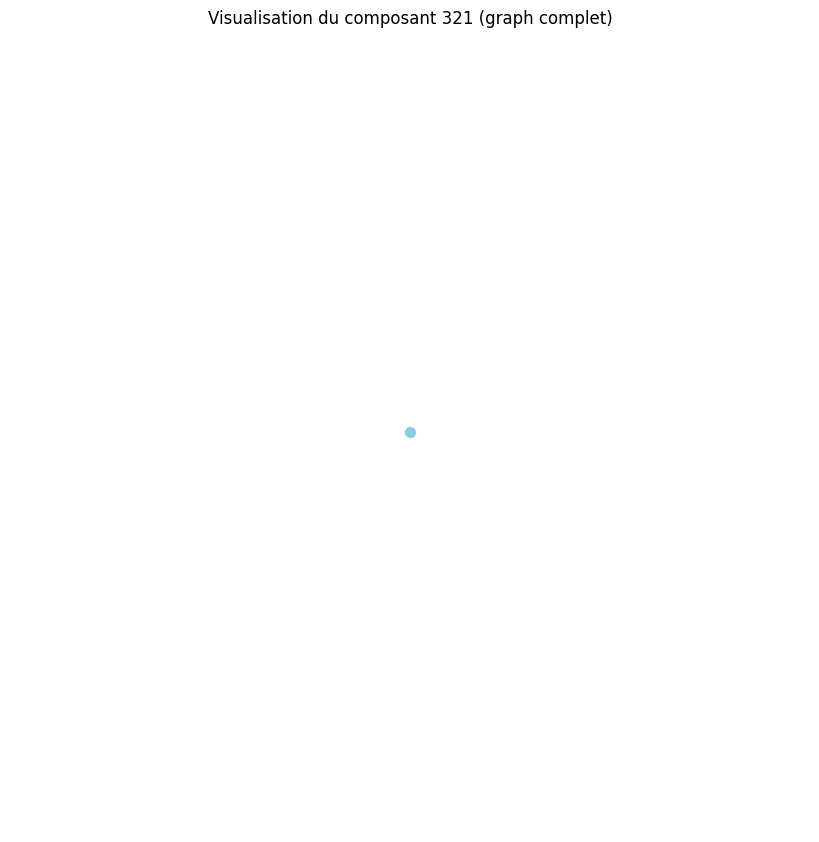

Distance moyenne pour le composant 322 : 0.00
Le composant 322 est un graphe complet ou très densément connecté.
Densité du composant 322 : 0.00
Degré moyen du composant 322 : 0.00
Coefficient de clustering moyen du composant 322 : 0.00


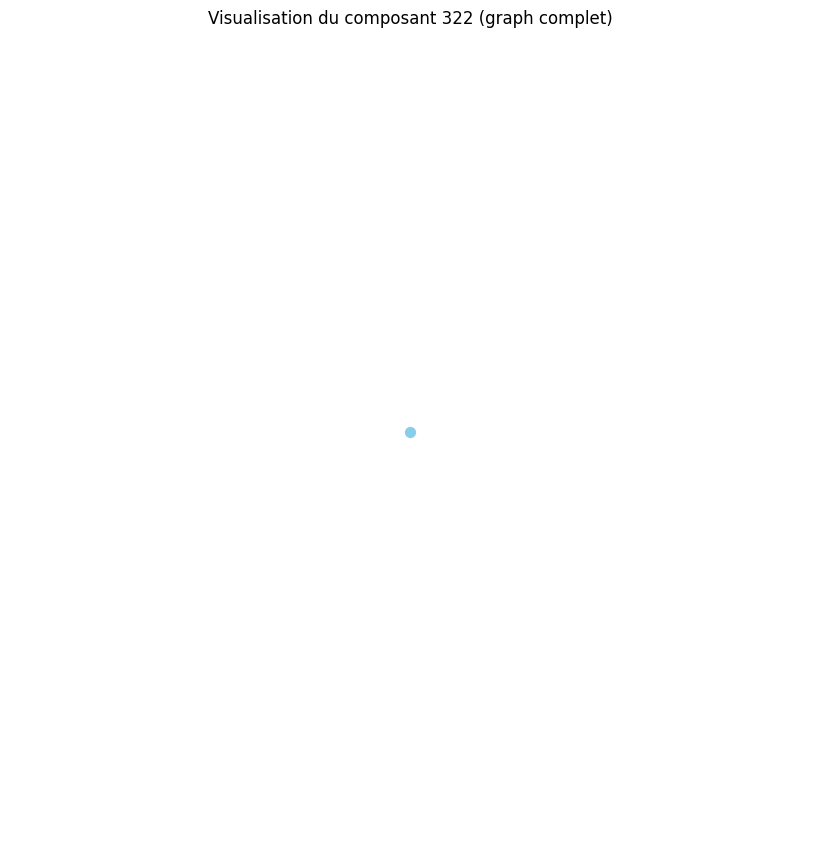

Distance moyenne pour le composant 323 : 0.00
Le composant 323 est un graphe complet ou très densément connecté.
Densité du composant 323 : 0.00
Degré moyen du composant 323 : 0.00
Coefficient de clustering moyen du composant 323 : 0.00


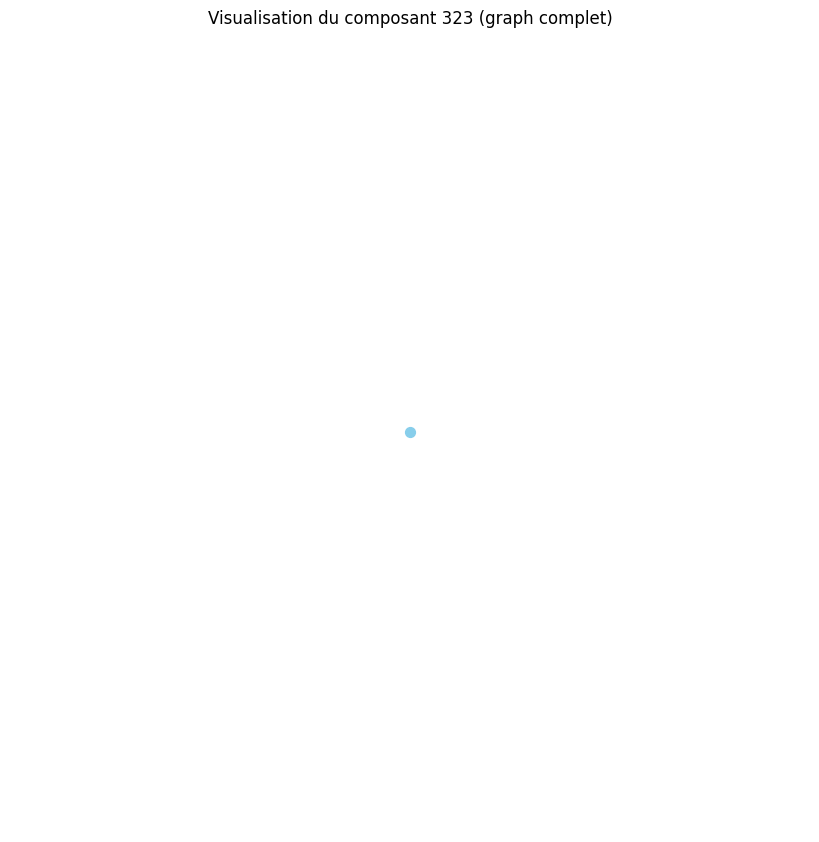

Distance moyenne pour le composant 324 : 0.00
Le composant 324 est un graphe complet ou très densément connecté.
Densité du composant 324 : 0.00
Degré moyen du composant 324 : 0.00
Coefficient de clustering moyen du composant 324 : 0.00


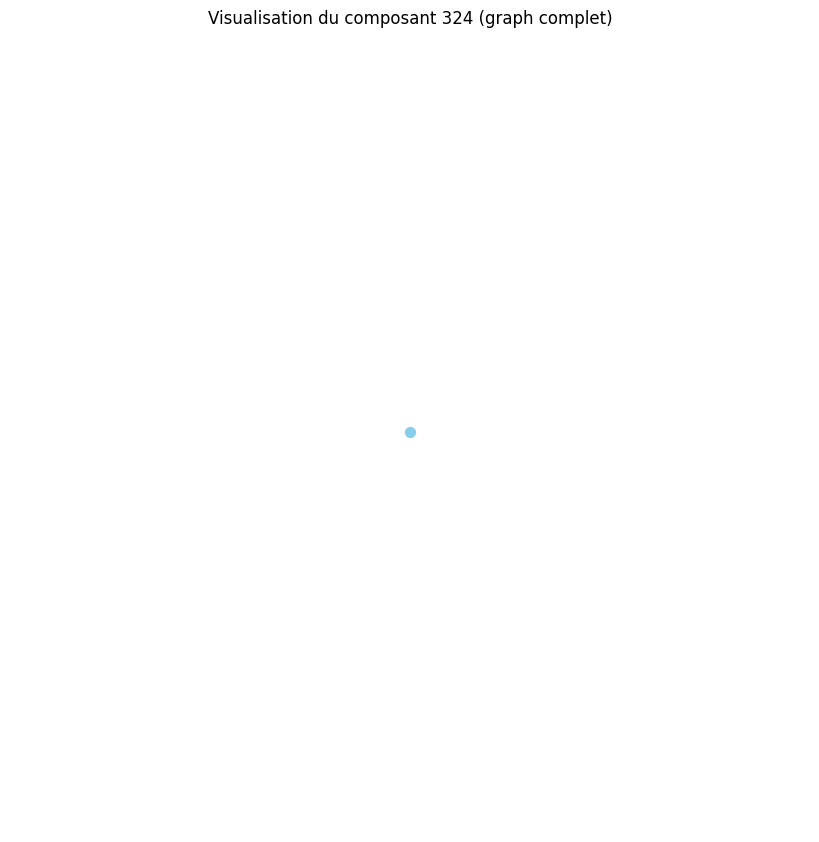

Distance moyenne pour le composant 325 : 0.00
Le composant 325 est un graphe complet ou très densément connecté.
Densité du composant 325 : 0.00
Degré moyen du composant 325 : 0.00
Coefficient de clustering moyen du composant 325 : 0.00


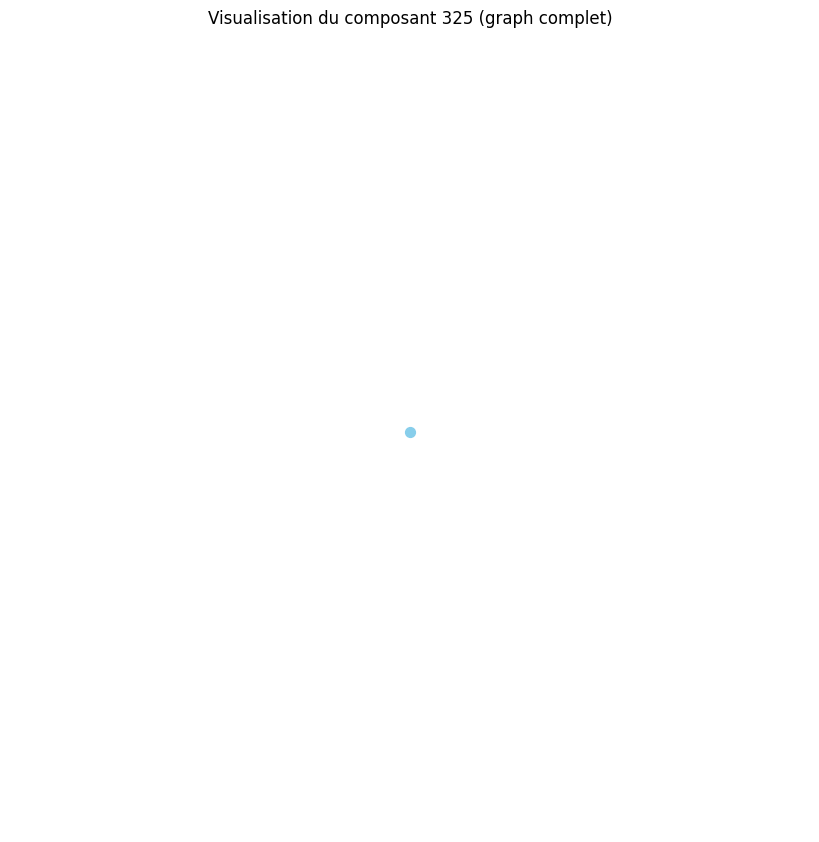

Distance moyenne pour le composant 326 : 0.00
Le composant 326 est un graphe complet ou très densément connecté.
Densité du composant 326 : 0.00
Degré moyen du composant 326 : 0.00
Coefficient de clustering moyen du composant 326 : 0.00


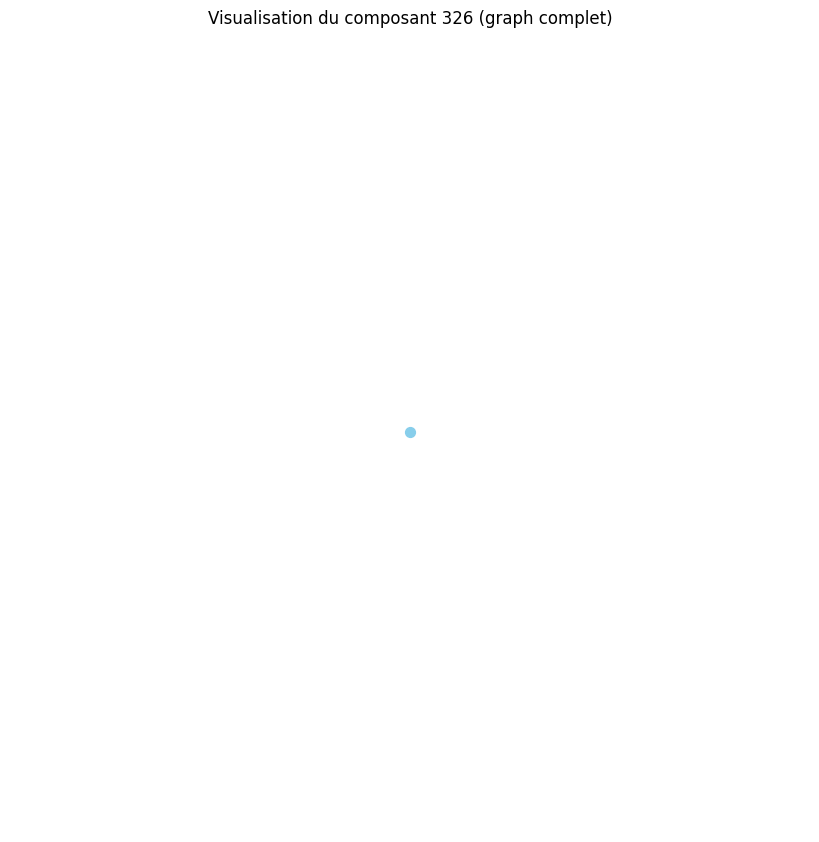

Distance moyenne pour le composant 327 : 0.00
Le composant 327 est un graphe complet ou très densément connecté.
Densité du composant 327 : 0.00
Degré moyen du composant 327 : 0.00
Coefficient de clustering moyen du composant 327 : 0.00


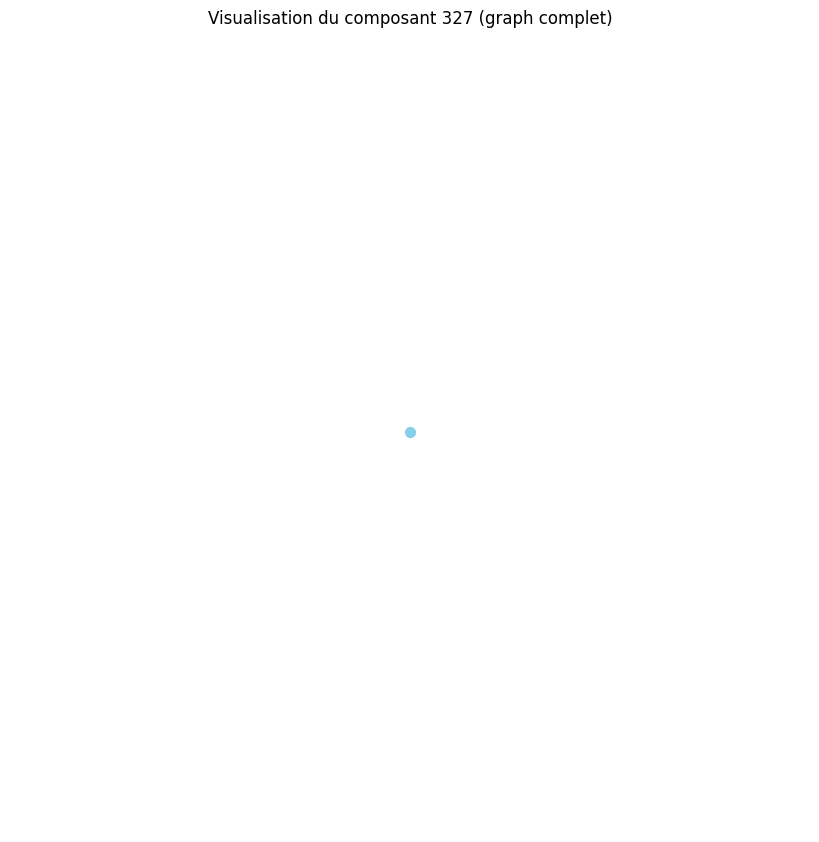

Distance moyenne pour le composant 328 : 0.00
Le composant 328 est un graphe complet ou très densément connecté.
Densité du composant 328 : 0.00
Degré moyen du composant 328 : 0.00
Coefficient de clustering moyen du composant 328 : 0.00


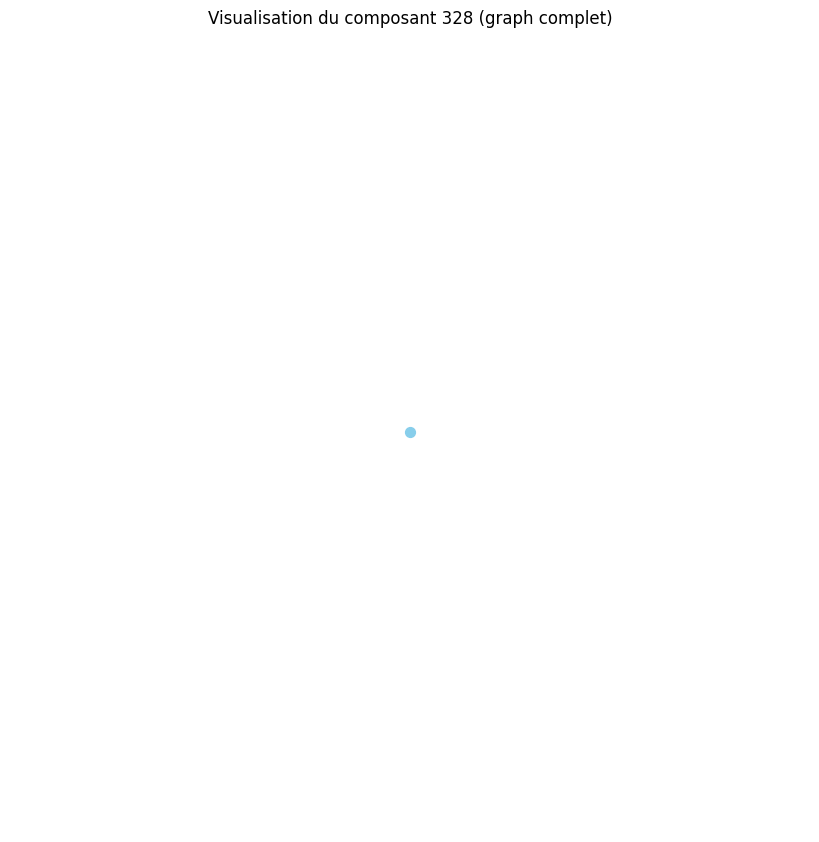

Distance moyenne pour le composant 329 : 0.00
Le composant 329 est un graphe complet ou très densément connecté.
Densité du composant 329 : 0.00
Degré moyen du composant 329 : 0.00
Coefficient de clustering moyen du composant 329 : 0.00


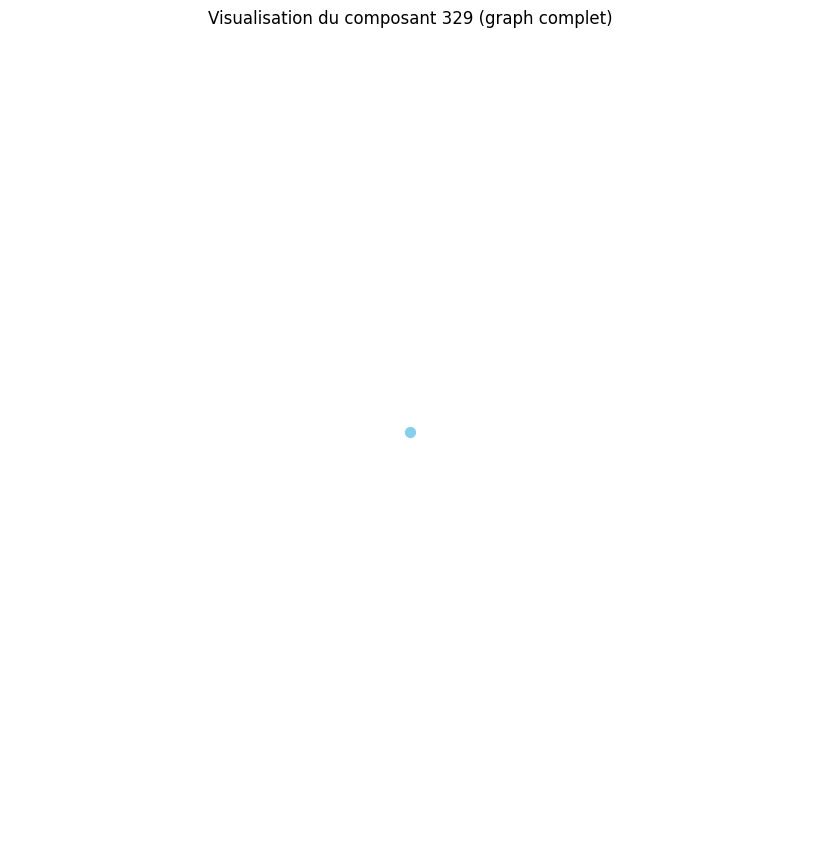

Distance moyenne pour le composant 330 : 0.00
Le composant 330 est un graphe complet ou très densément connecté.
Densité du composant 330 : 0.00
Degré moyen du composant 330 : 0.00
Coefficient de clustering moyen du composant 330 : 0.00


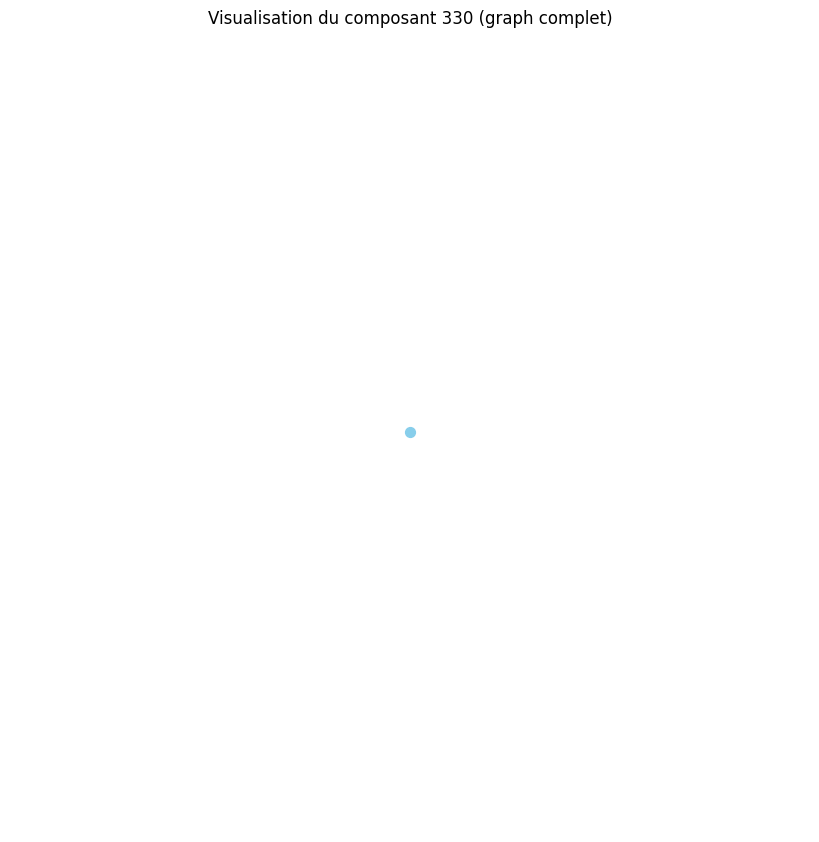

Distance moyenne pour le composant 331 : 0.00
Le composant 331 est un graphe complet ou très densément connecté.
Densité du composant 331 : 0.00
Degré moyen du composant 331 : 0.00
Coefficient de clustering moyen du composant 331 : 0.00


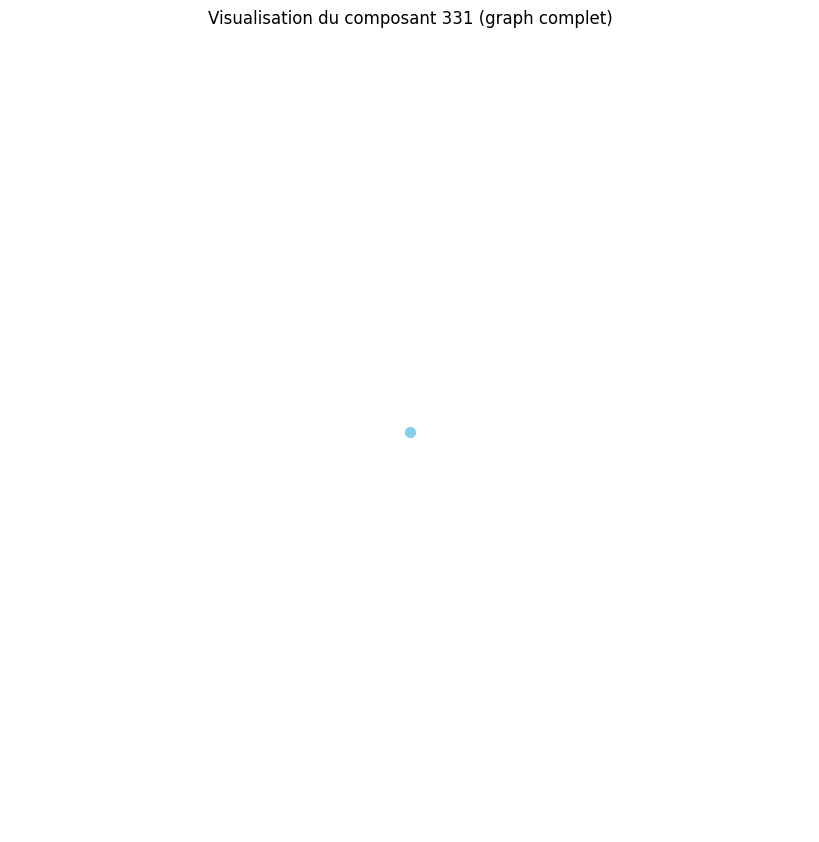

Distance moyenne pour le composant 332 : 0.00
Le composant 332 est un graphe complet ou très densément connecté.
Densité du composant 332 : 0.00
Degré moyen du composant 332 : 0.00
Coefficient de clustering moyen du composant 332 : 0.00


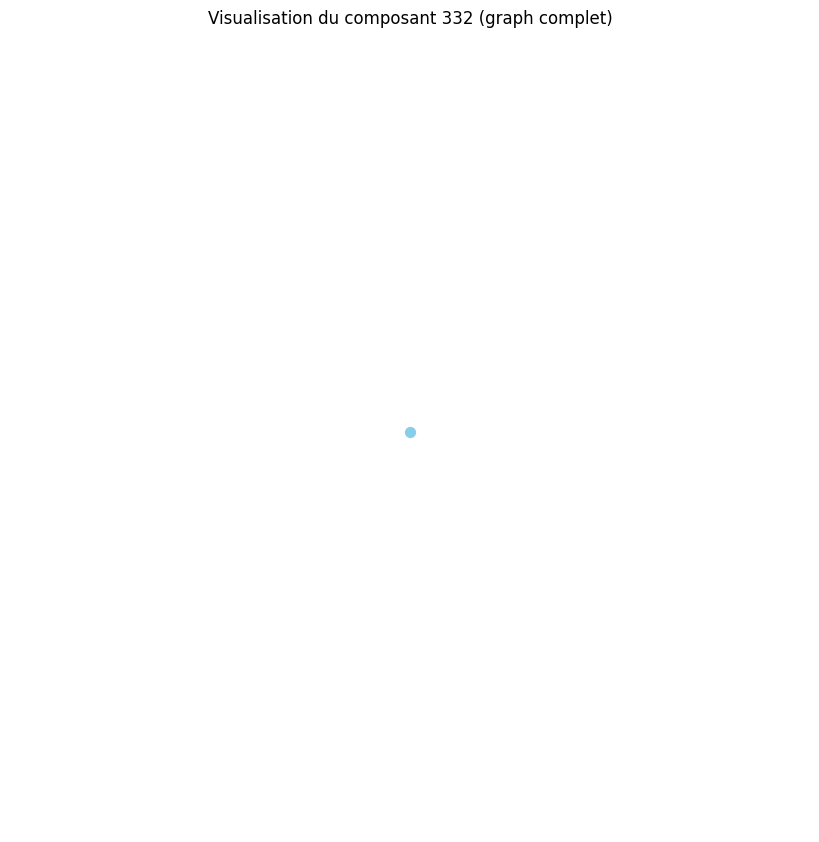

Distance moyenne pour le composant 333 : 0.00
Le composant 333 est un graphe complet ou très densément connecté.
Densité du composant 333 : 0.00
Degré moyen du composant 333 : 0.00
Coefficient de clustering moyen du composant 333 : 0.00


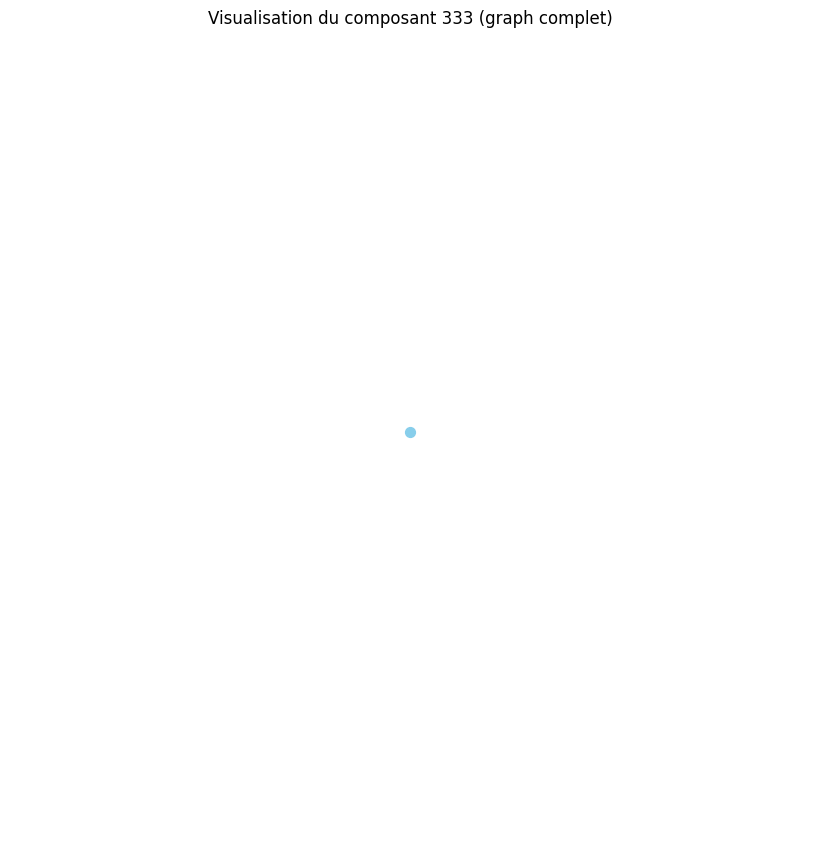

Distance moyenne pour le composant 334 : 0.00
Le composant 334 est un graphe complet ou très densément connecté.
Densité du composant 334 : 0.00
Degré moyen du composant 334 : 0.00
Coefficient de clustering moyen du composant 334 : 0.00


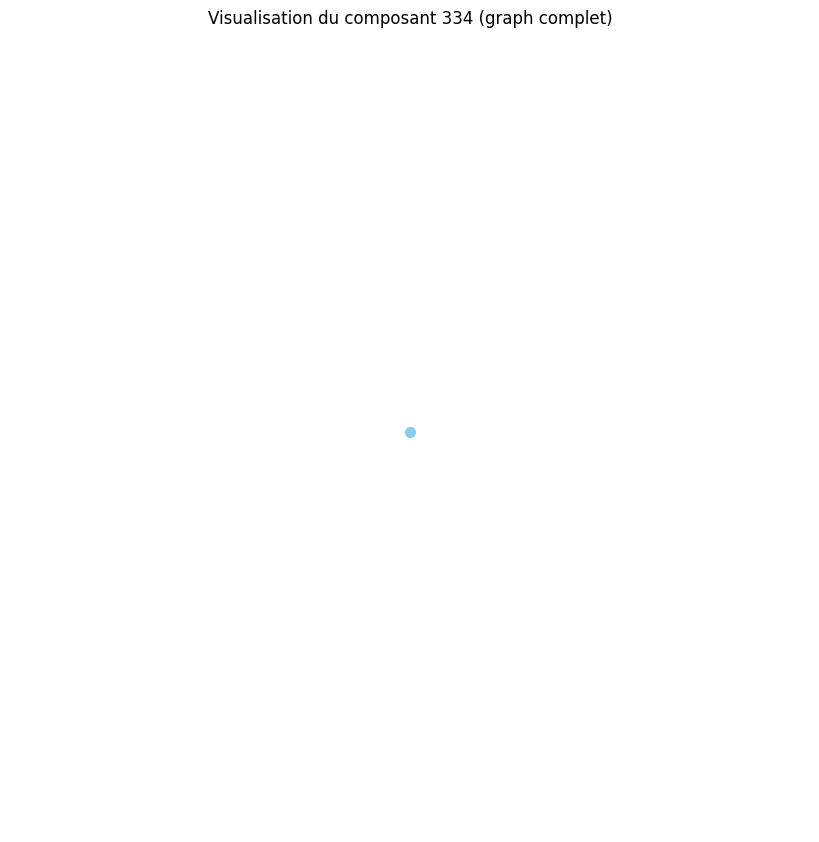

Distance moyenne pour le composant 335 : 0.00
Le composant 335 est un graphe complet ou très densément connecté.
Densité du composant 335 : 0.00
Degré moyen du composant 335 : 0.00
Coefficient de clustering moyen du composant 335 : 0.00


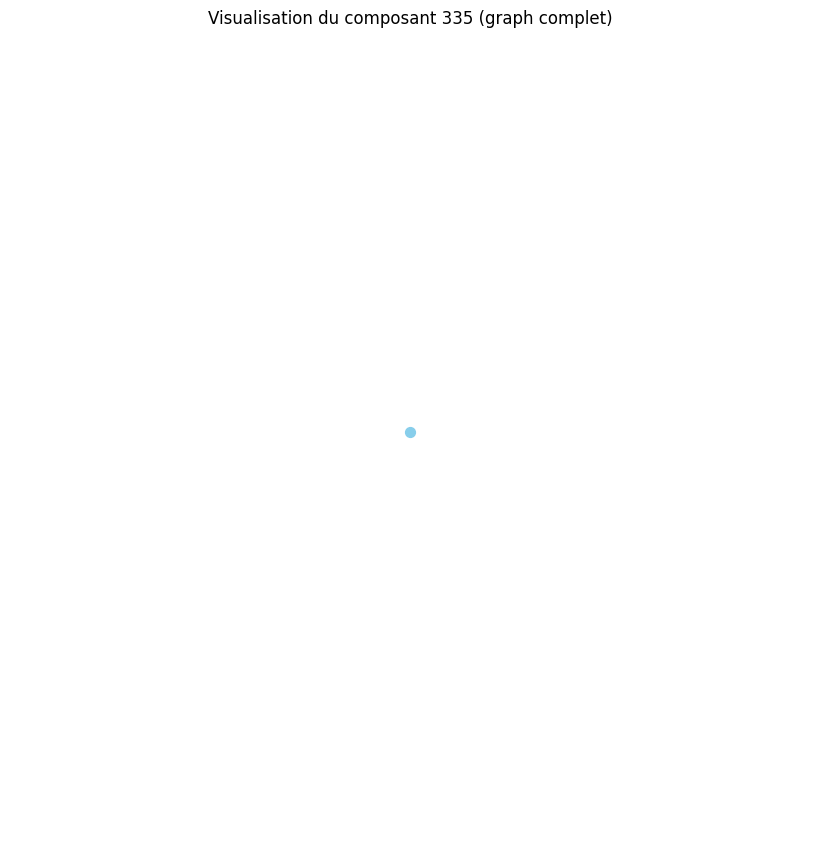

Distance moyenne pour le composant 336 : 0.00
Le composant 336 est un graphe complet ou très densément connecté.
Densité du composant 336 : 0.00
Degré moyen du composant 336 : 0.00
Coefficient de clustering moyen du composant 336 : 0.00


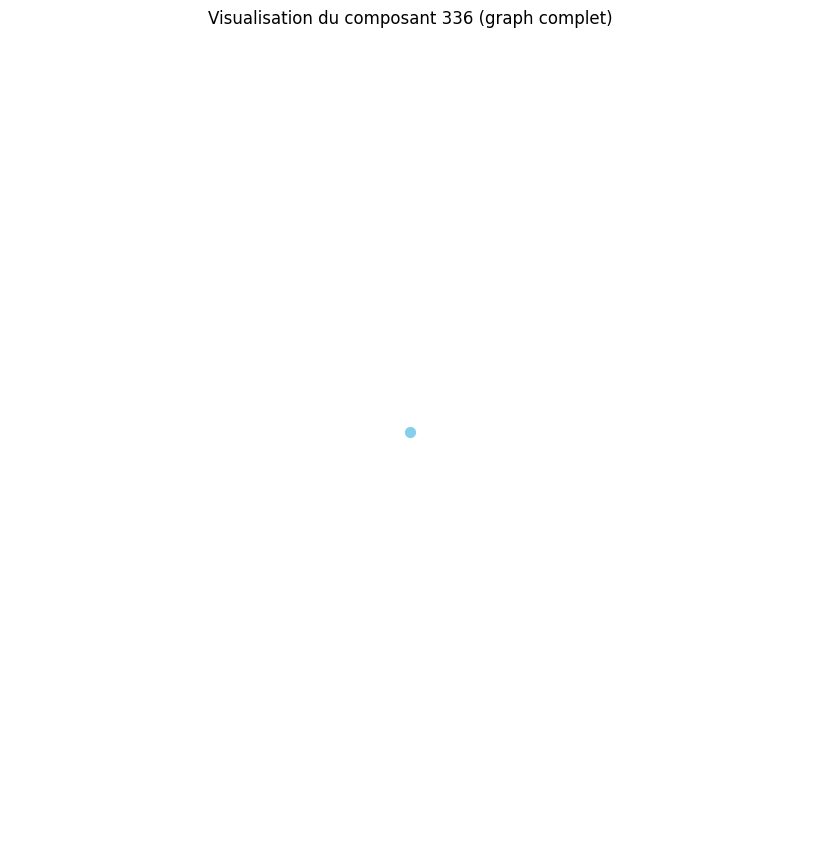

Distance moyenne pour le composant 337 : 0.00
Le composant 337 est un graphe complet ou très densément connecté.
Densité du composant 337 : 0.00
Degré moyen du composant 337 : 0.00
Coefficient de clustering moyen du composant 337 : 0.00


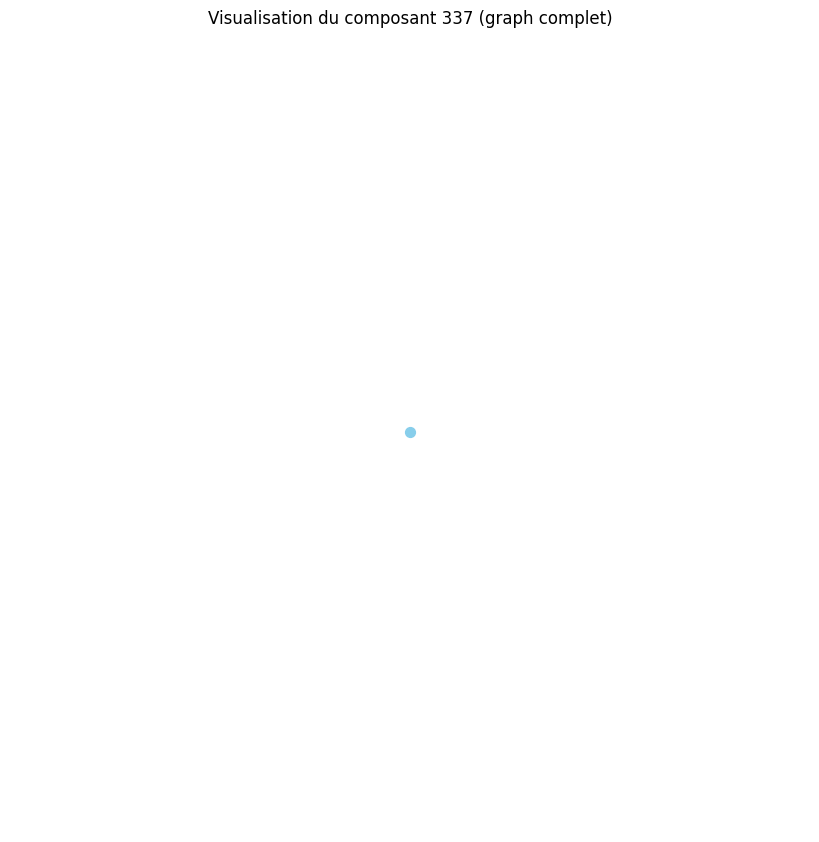

Distance moyenne pour le composant 338 : 0.00
Le composant 338 est un graphe complet ou très densément connecté.
Densité du composant 338 : 0.00
Degré moyen du composant 338 : 0.00
Coefficient de clustering moyen du composant 338 : 0.00


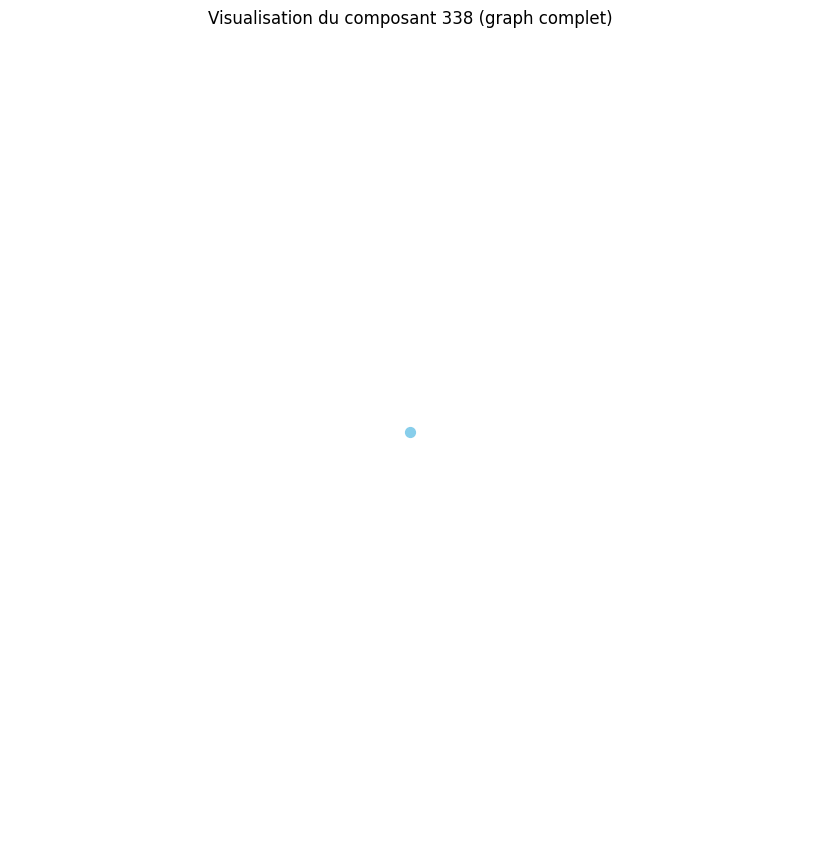

Distance moyenne pour le composant 339 : 0.00
Le composant 339 est un graphe complet ou très densément connecté.
Densité du composant 339 : 0.00
Degré moyen du composant 339 : 0.00
Coefficient de clustering moyen du composant 339 : 0.00


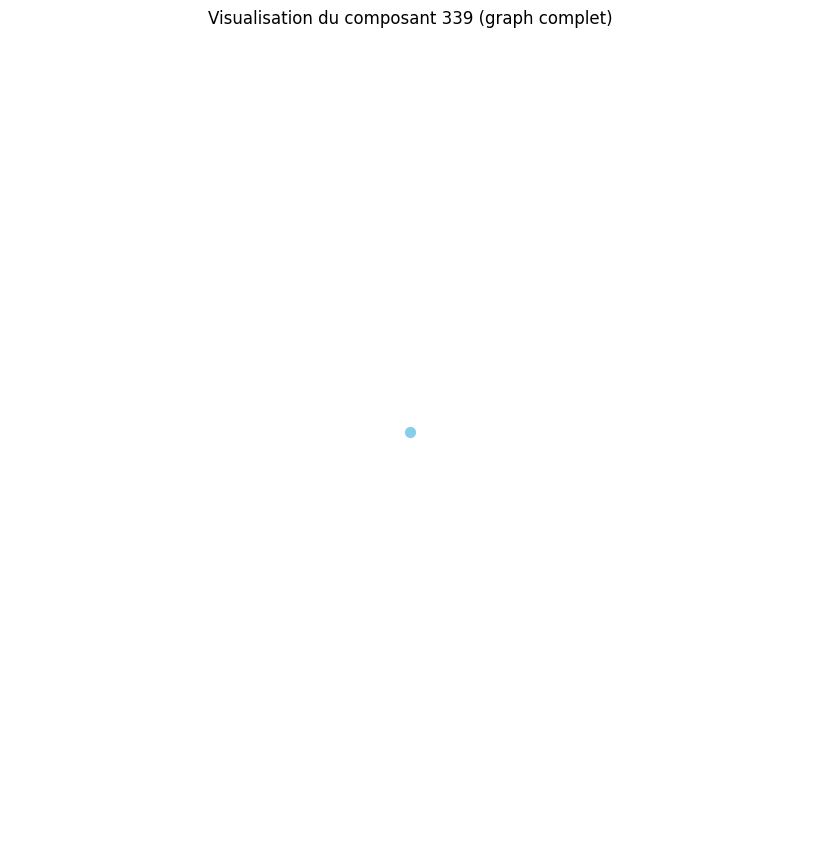

Distance moyenne pour le composant 340 : 0.00
Le composant 340 est un graphe complet ou très densément connecté.
Densité du composant 340 : 0.00
Degré moyen du composant 340 : 0.00
Coefficient de clustering moyen du composant 340 : 0.00


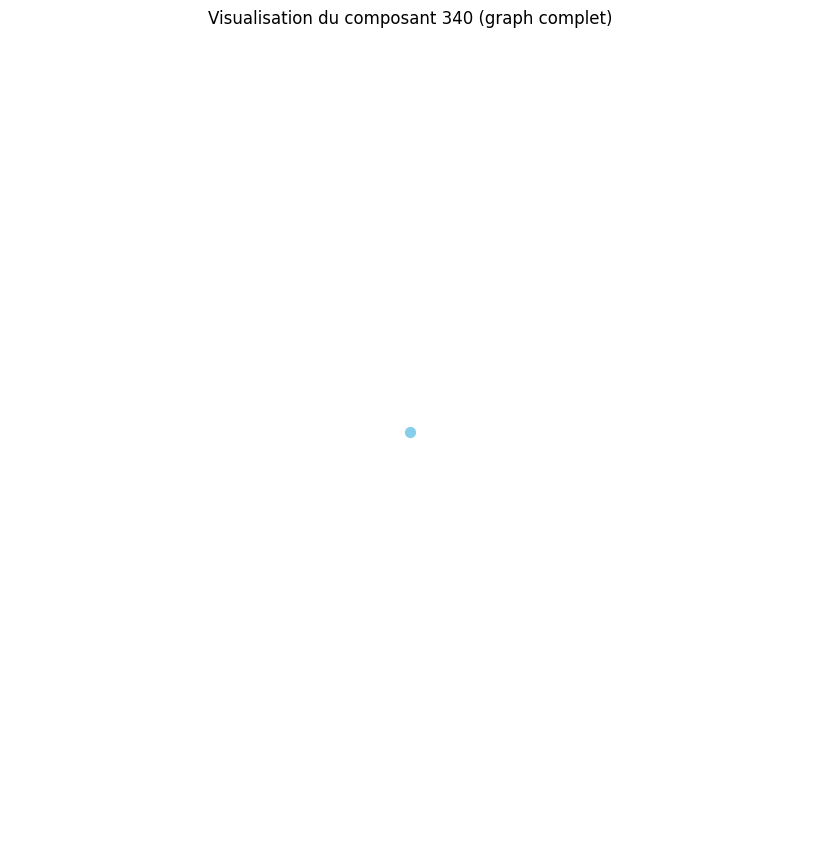

Distance moyenne pour le composant 341 : 0.00
Le composant 341 est un graphe complet ou très densément connecté.
Densité du composant 341 : 0.00
Degré moyen du composant 341 : 0.00
Coefficient de clustering moyen du composant 341 : 0.00


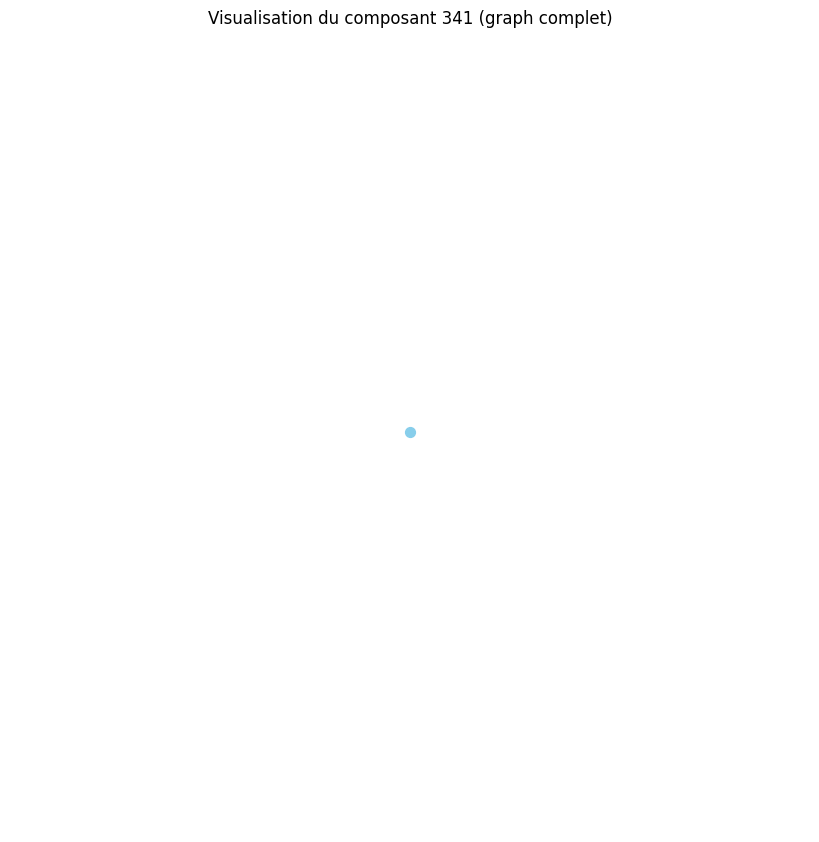

Distance moyenne pour le composant 342 : 0.00
Le composant 342 est un graphe complet ou très densément connecté.
Densité du composant 342 : 0.00
Degré moyen du composant 342 : 0.00
Coefficient de clustering moyen du composant 342 : 0.00


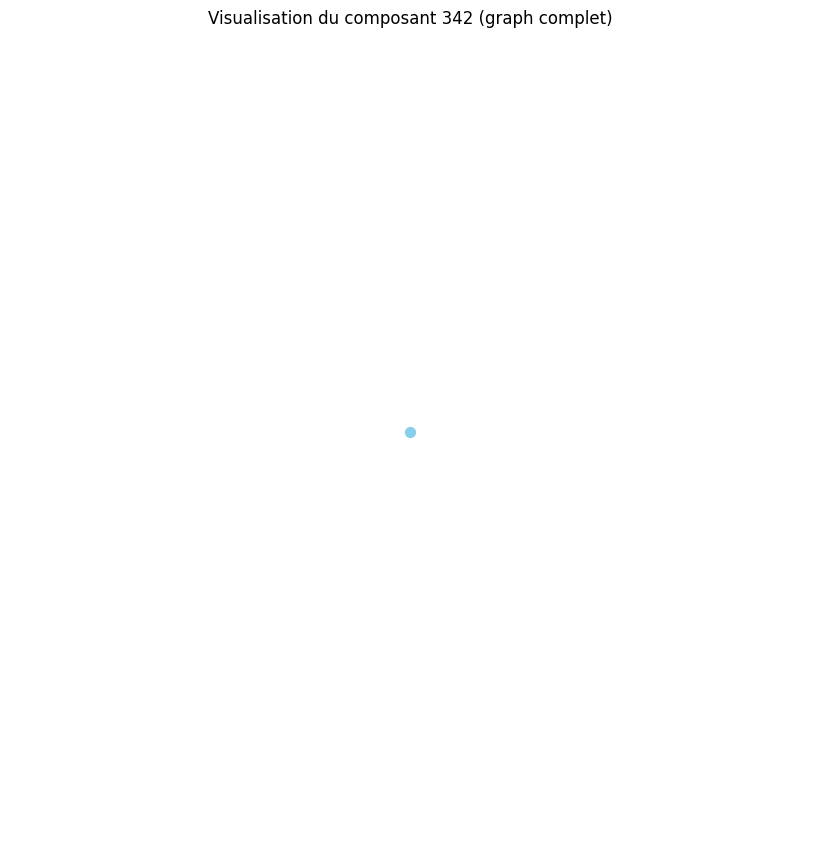

Distance moyenne pour le composant 343 : 0.00
Le composant 343 est un graphe complet ou très densément connecté.
Densité du composant 343 : 0.00
Degré moyen du composant 343 : 0.00
Coefficient de clustering moyen du composant 343 : 0.00


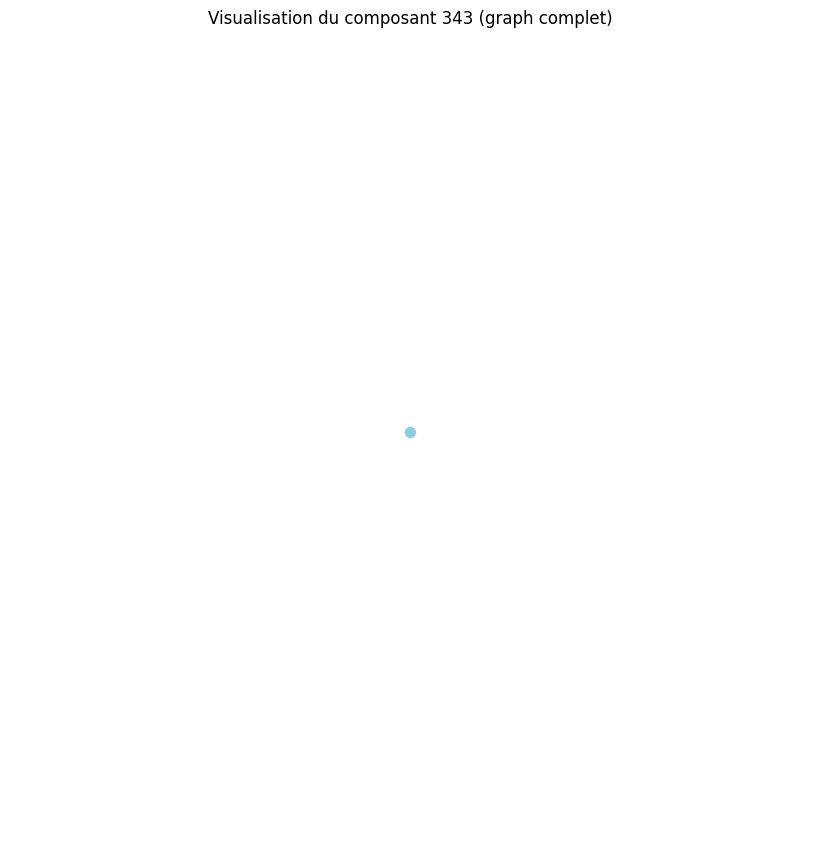

Distance moyenne pour le composant 344 : 0.00
Le composant 344 est un graphe complet ou très densément connecté.
Densité du composant 344 : 0.00
Degré moyen du composant 344 : 0.00
Coefficient de clustering moyen du composant 344 : 0.00


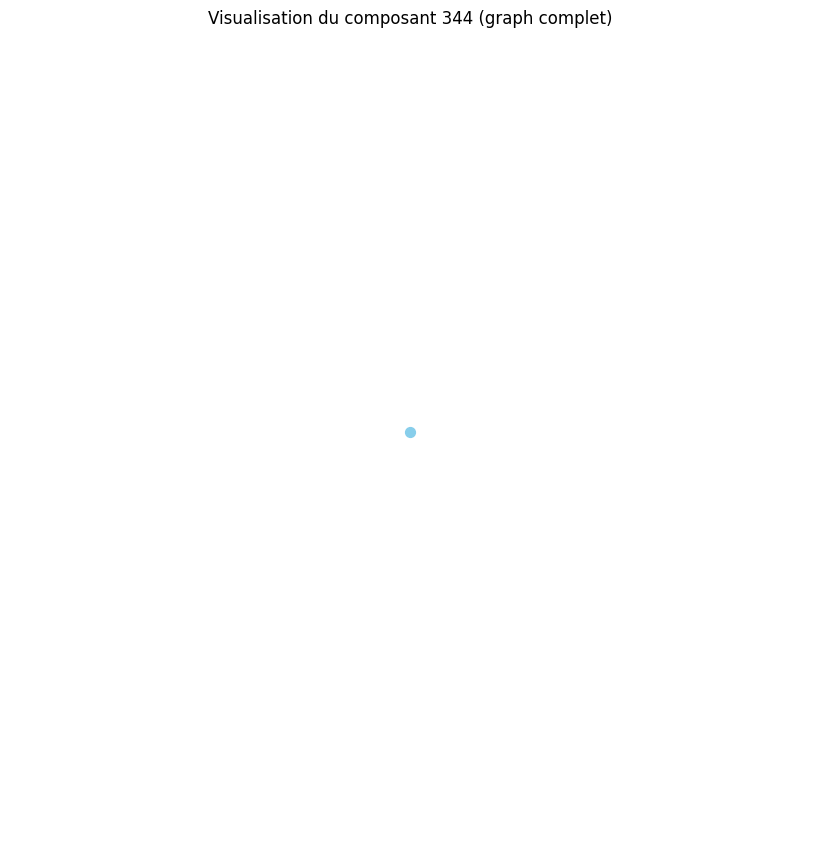

Distance moyenne pour le composant 345 : 0.00
Le composant 345 est un graphe complet ou très densément connecté.
Densité du composant 345 : 0.00
Degré moyen du composant 345 : 0.00
Coefficient de clustering moyen du composant 345 : 0.00


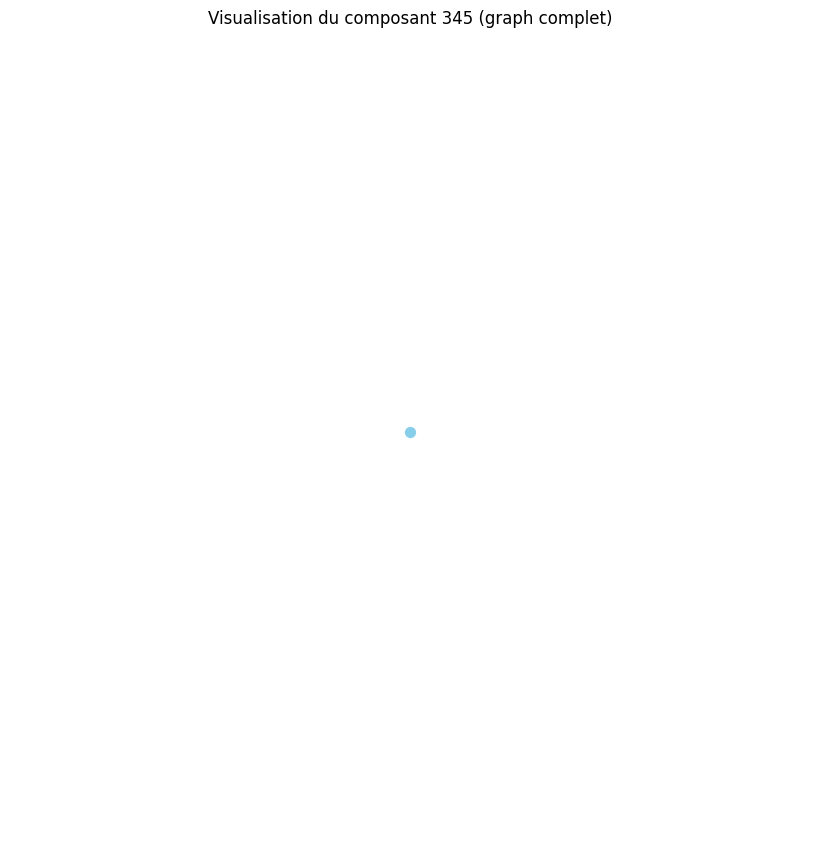

Distance moyenne pour le composant 346 : 0.00
Le composant 346 est un graphe complet ou très densément connecté.
Densité du composant 346 : 0.00
Degré moyen du composant 346 : 0.00
Coefficient de clustering moyen du composant 346 : 0.00


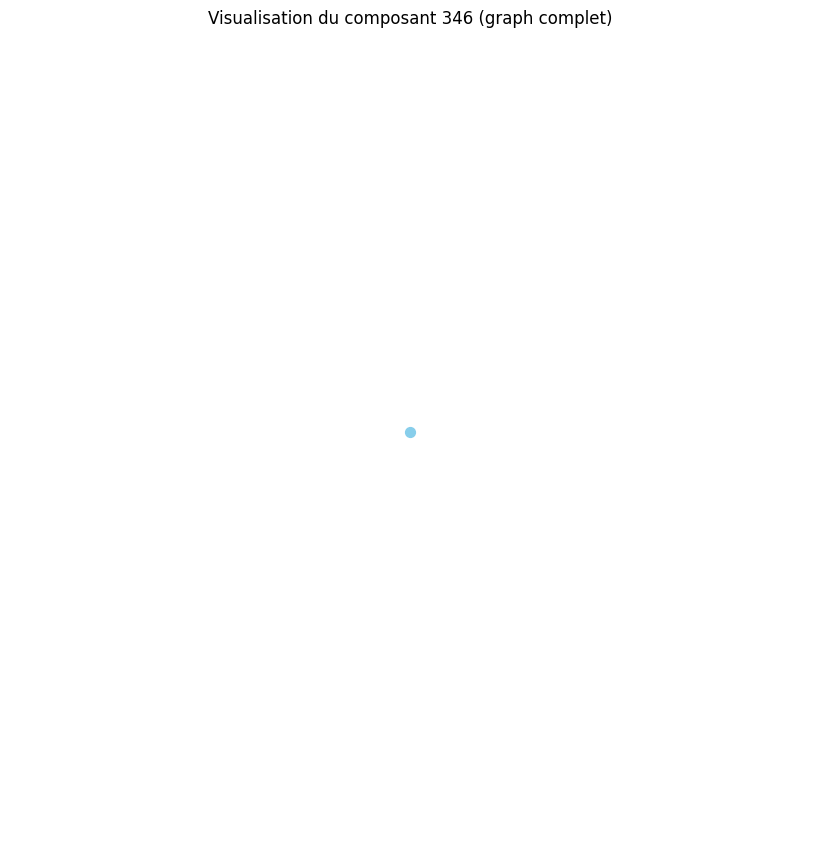

Distance moyenne pour le composant 347 : 0.00
Le composant 347 est un graphe complet ou très densément connecté.
Densité du composant 347 : 0.00
Degré moyen du composant 347 : 0.00
Coefficient de clustering moyen du composant 347 : 0.00


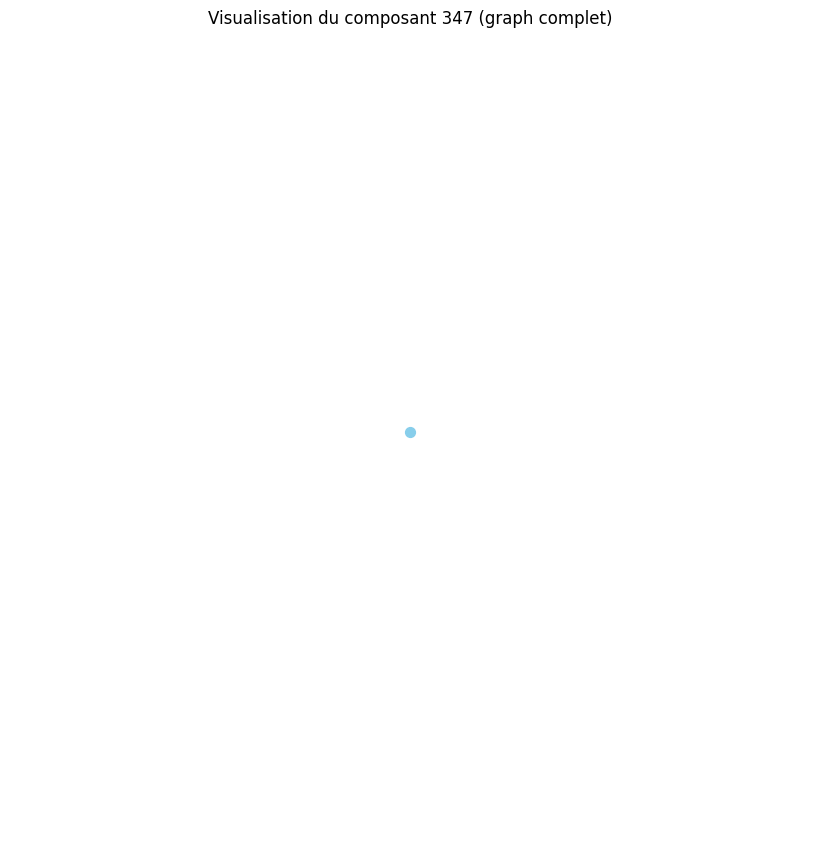

Distance moyenne pour le composant 348 : 0.00
Le composant 348 est un graphe complet ou très densément connecté.
Densité du composant 348 : 0.00
Degré moyen du composant 348 : 0.00
Coefficient de clustering moyen du composant 348 : 0.00


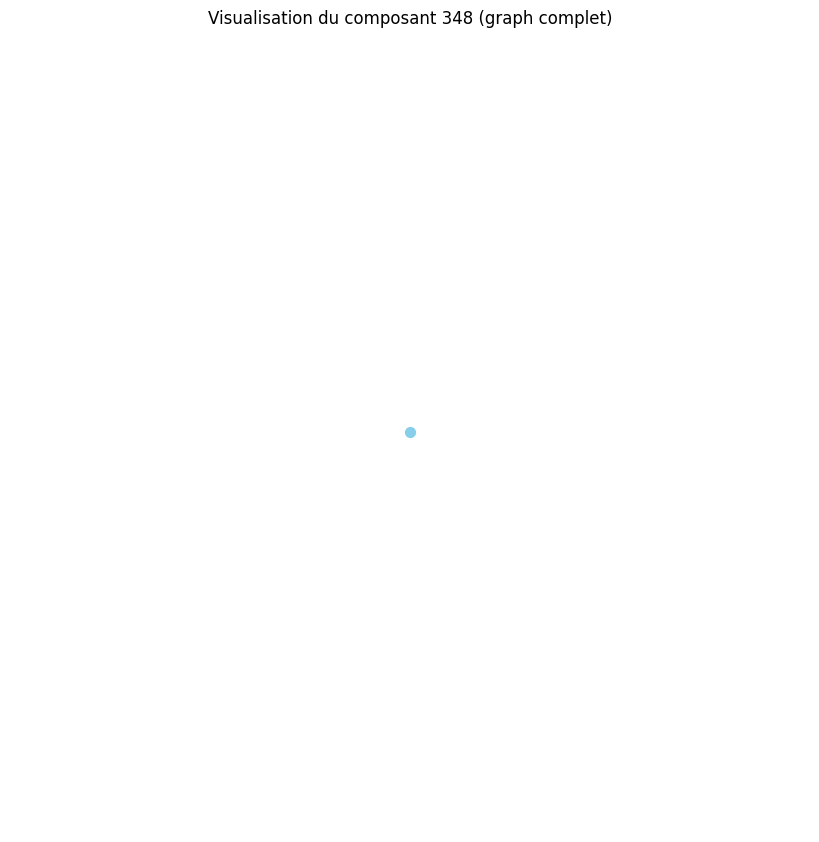

Distance moyenne pour le composant 349 : 0.00
Le composant 349 est un graphe complet ou très densément connecté.
Densité du composant 349 : 0.00
Degré moyen du composant 349 : 0.00
Coefficient de clustering moyen du composant 349 : 0.00


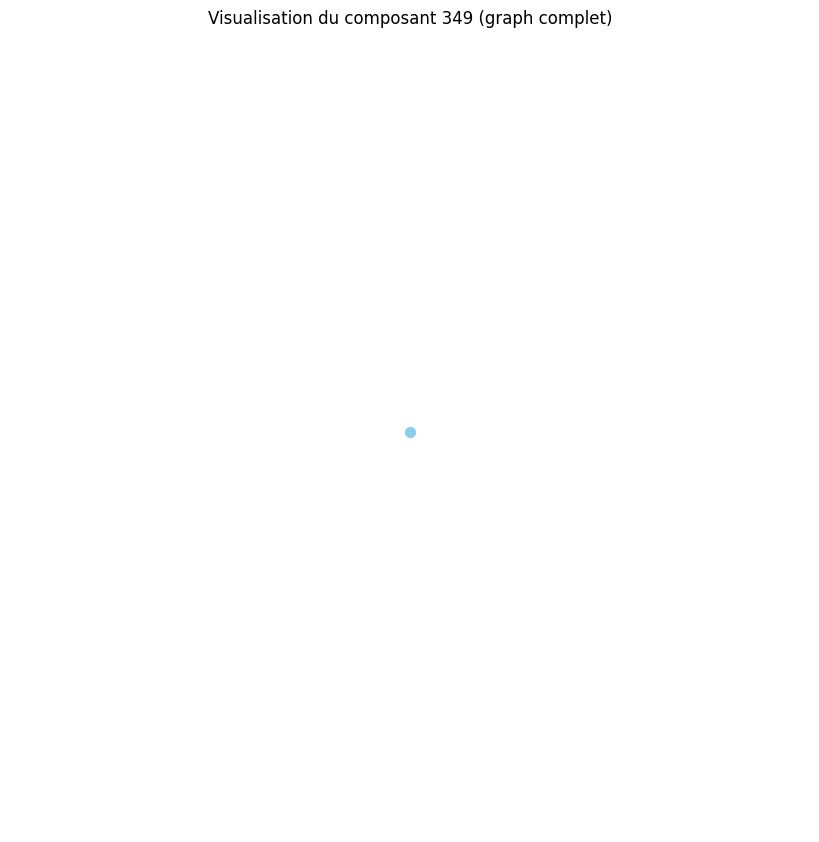

Distance moyenne pour le composant 350 : 0.00
Le composant 350 est un graphe complet ou très densément connecté.
Densité du composant 350 : 0.00
Degré moyen du composant 350 : 0.00
Coefficient de clustering moyen du composant 350 : 0.00


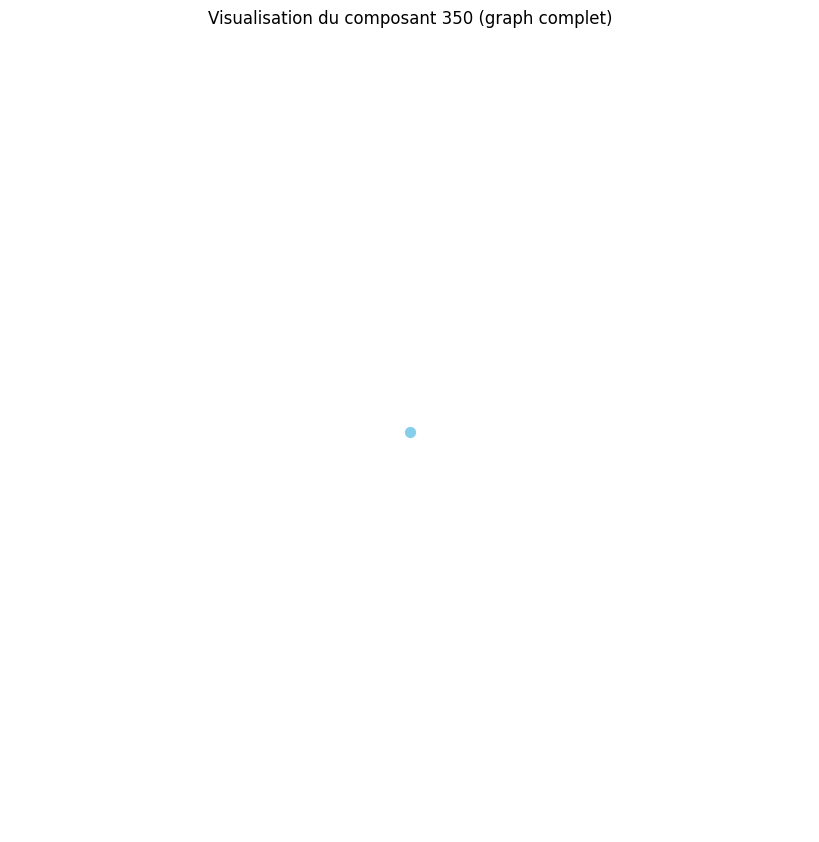

Distance moyenne pour le composant 351 : 0.00
Le composant 351 est un graphe complet ou très densément connecté.
Densité du composant 351 : 0.00
Degré moyen du composant 351 : 0.00
Coefficient de clustering moyen du composant 351 : 0.00


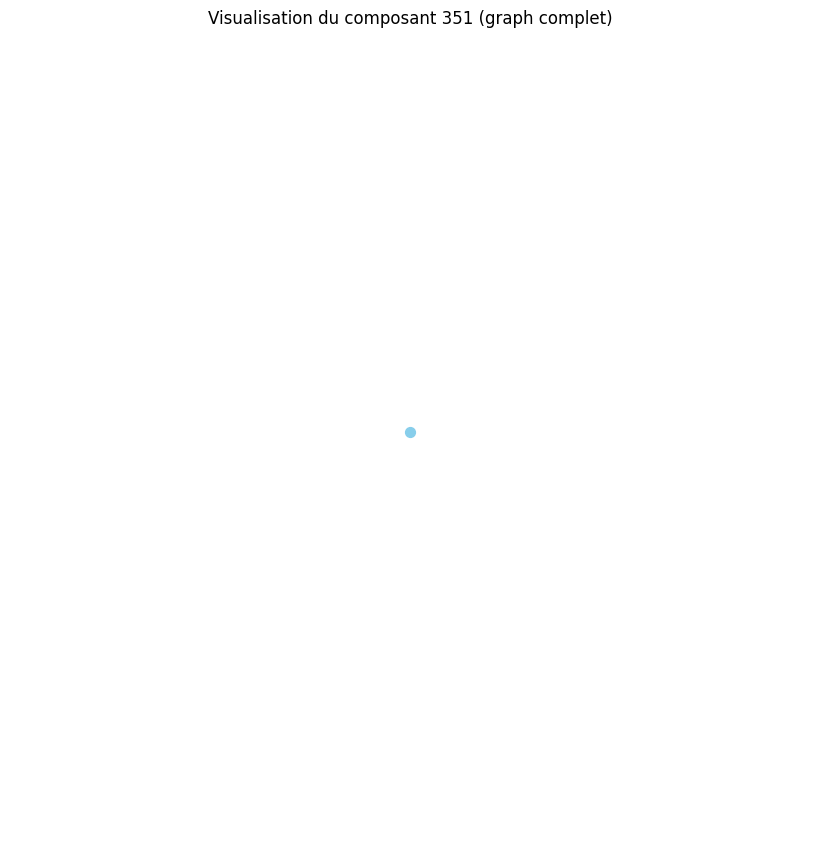

Distance moyenne pour le composant 352 : 0.00
Le composant 352 est un graphe complet ou très densément connecté.
Densité du composant 352 : 0.00
Degré moyen du composant 352 : 0.00
Coefficient de clustering moyen du composant 352 : 0.00


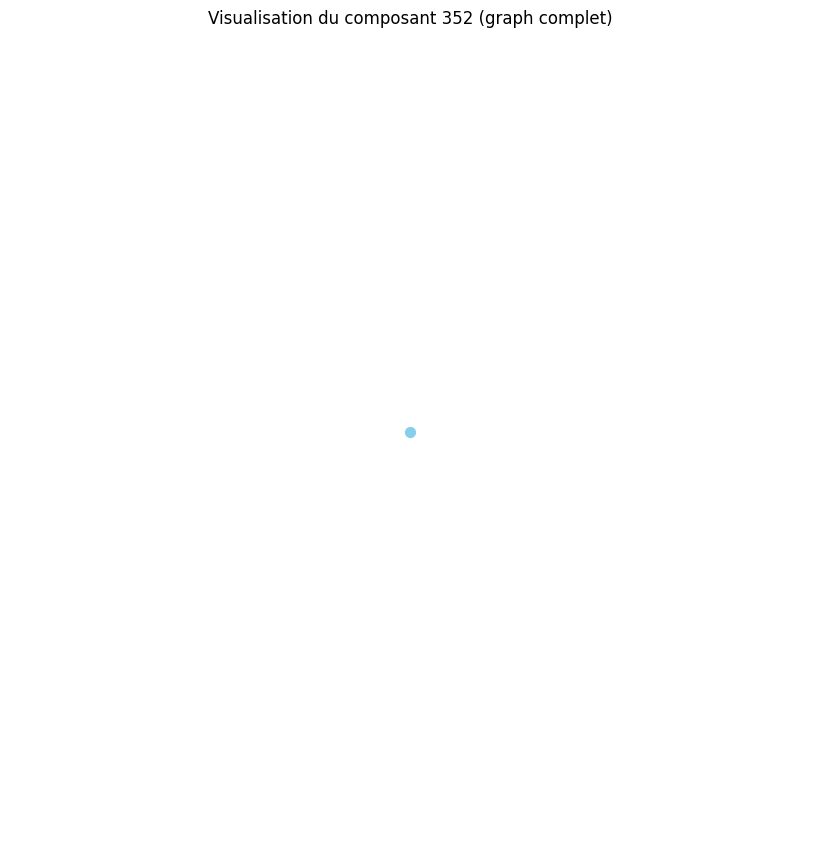

Distance moyenne pour le composant 353 : 0.00
Le composant 353 est un graphe complet ou très densément connecté.
Densité du composant 353 : 0.00
Degré moyen du composant 353 : 0.00
Coefficient de clustering moyen du composant 353 : 0.00


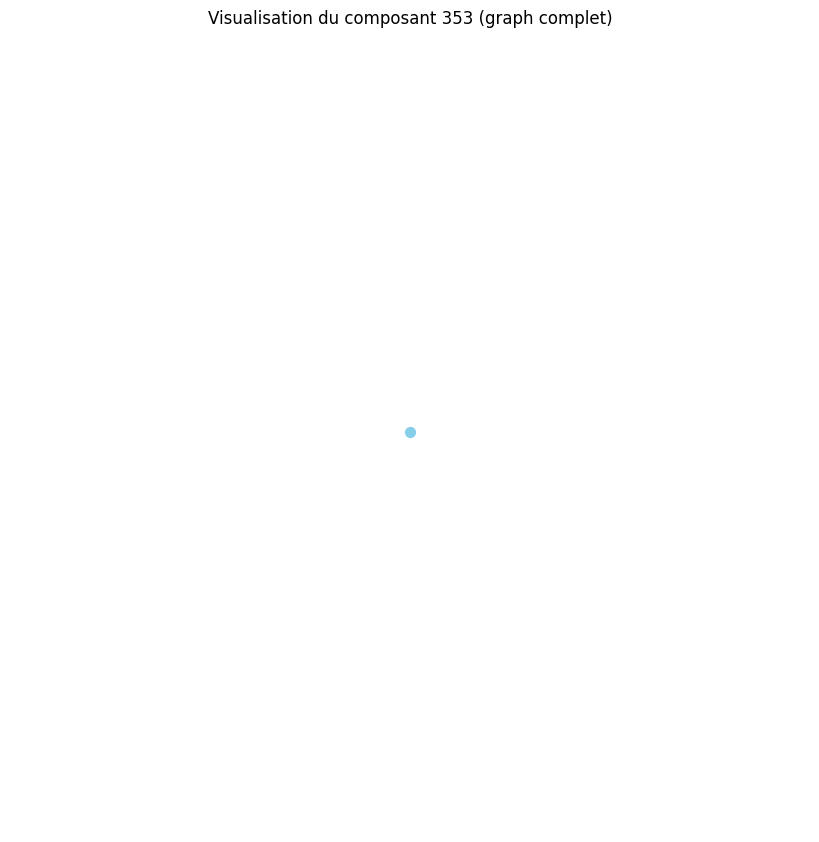

Distance moyenne pour le composant 354 : 0.00
Le composant 354 est un graphe complet ou très densément connecté.
Densité du composant 354 : 0.00
Degré moyen du composant 354 : 0.00
Coefficient de clustering moyen du composant 354 : 0.00


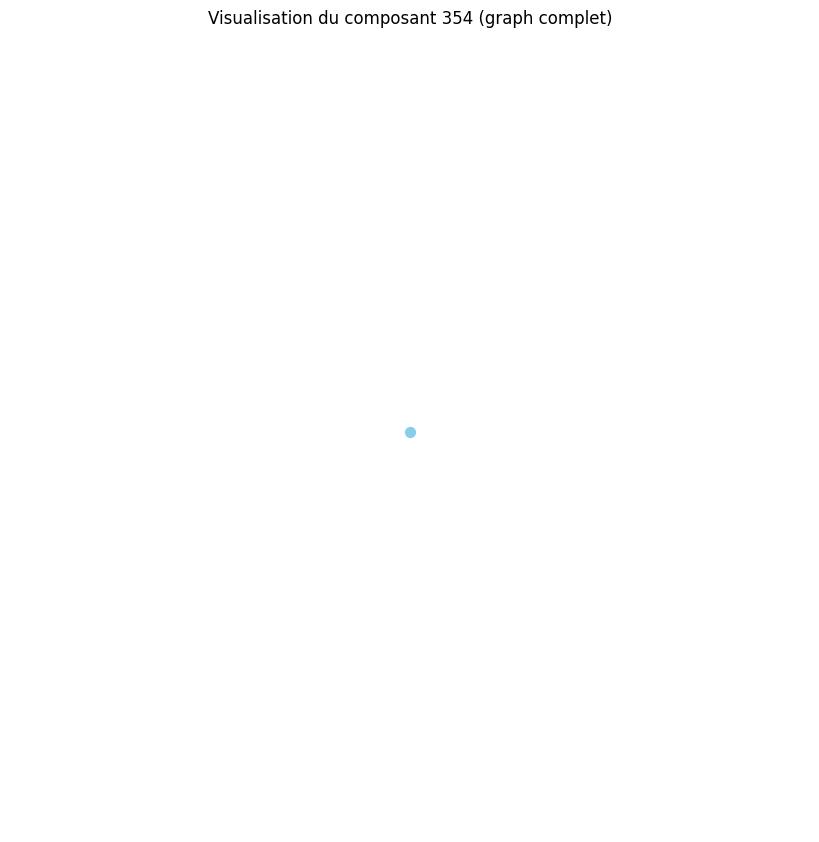

Distance moyenne pour le composant 355 : 0.00
Le composant 355 est un graphe complet ou très densément connecté.
Densité du composant 355 : 0.00
Degré moyen du composant 355 : 0.00
Coefficient de clustering moyen du composant 355 : 0.00


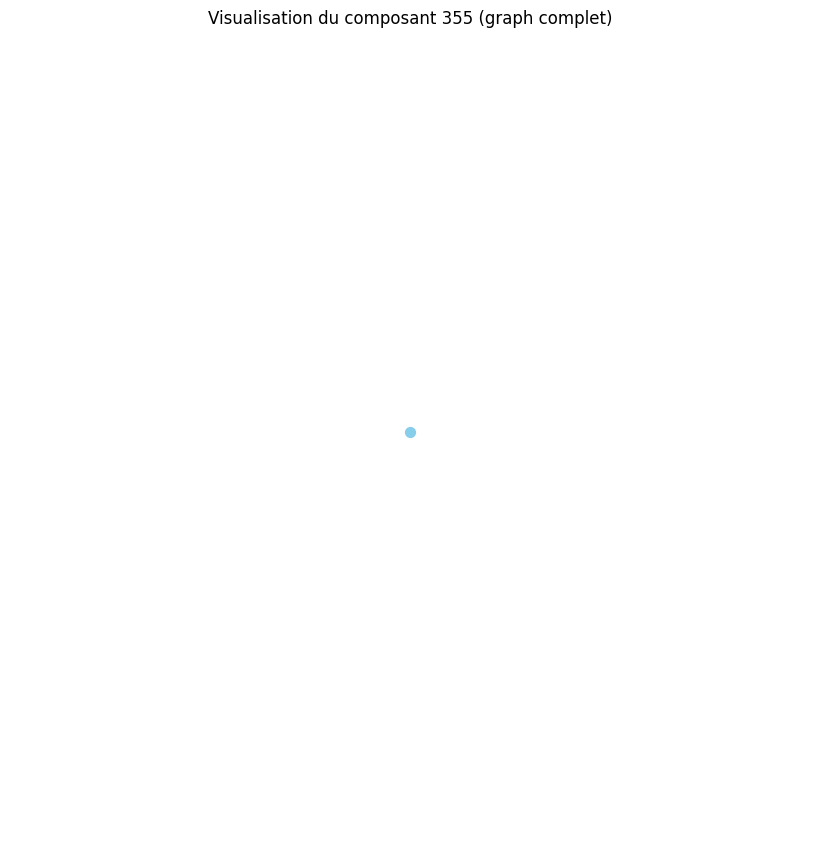

Distance moyenne pour le composant 356 : 0.00
Le composant 356 est un graphe complet ou très densément connecté.
Densité du composant 356 : 0.00
Degré moyen du composant 356 : 0.00
Coefficient de clustering moyen du composant 356 : 0.00


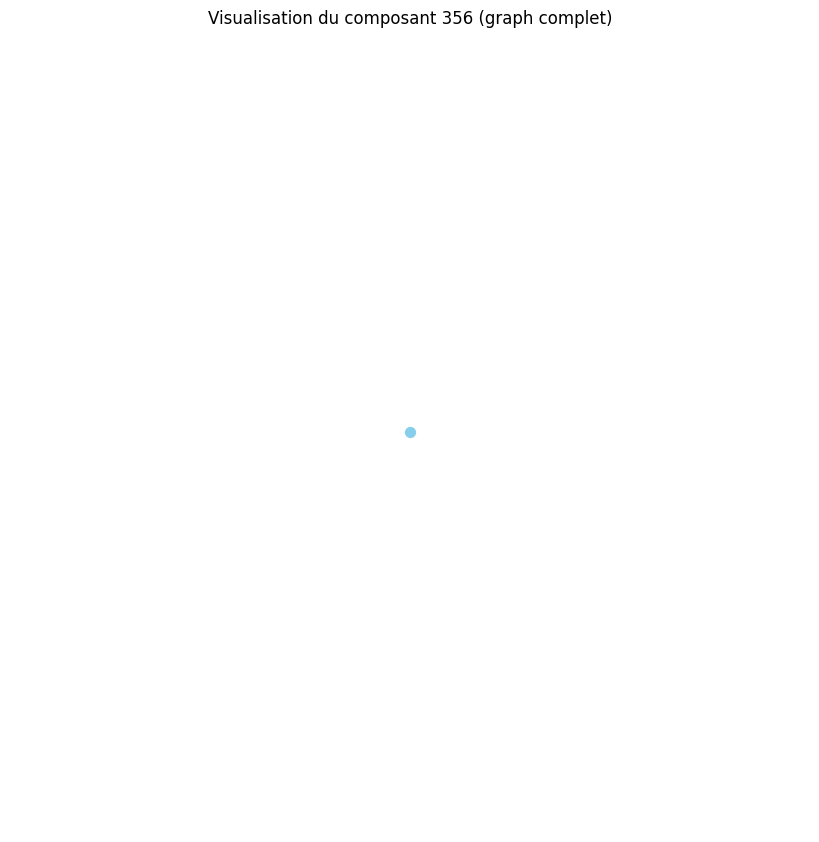

Distance moyenne pour le composant 357 : 0.00
Le composant 357 est un graphe complet ou très densément connecté.
Densité du composant 357 : 0.00
Degré moyen du composant 357 : 0.00
Coefficient de clustering moyen du composant 357 : 0.00


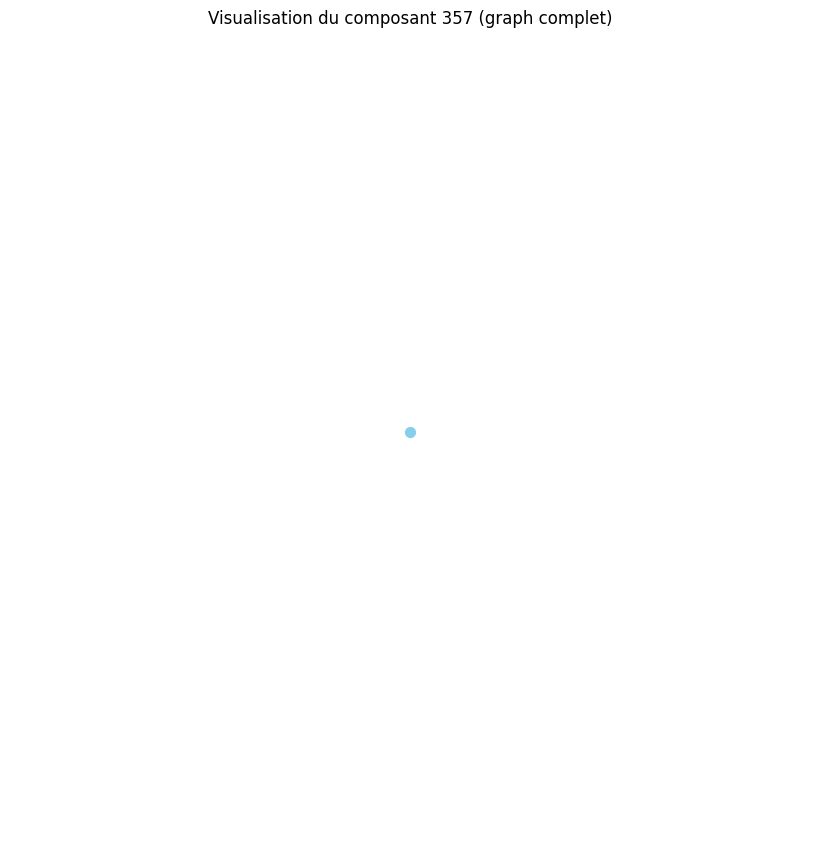

Distance moyenne pour le composant 358 : 0.00
Le composant 358 est un graphe complet ou très densément connecté.
Densité du composant 358 : 0.00
Degré moyen du composant 358 : 0.00
Coefficient de clustering moyen du composant 358 : 0.00


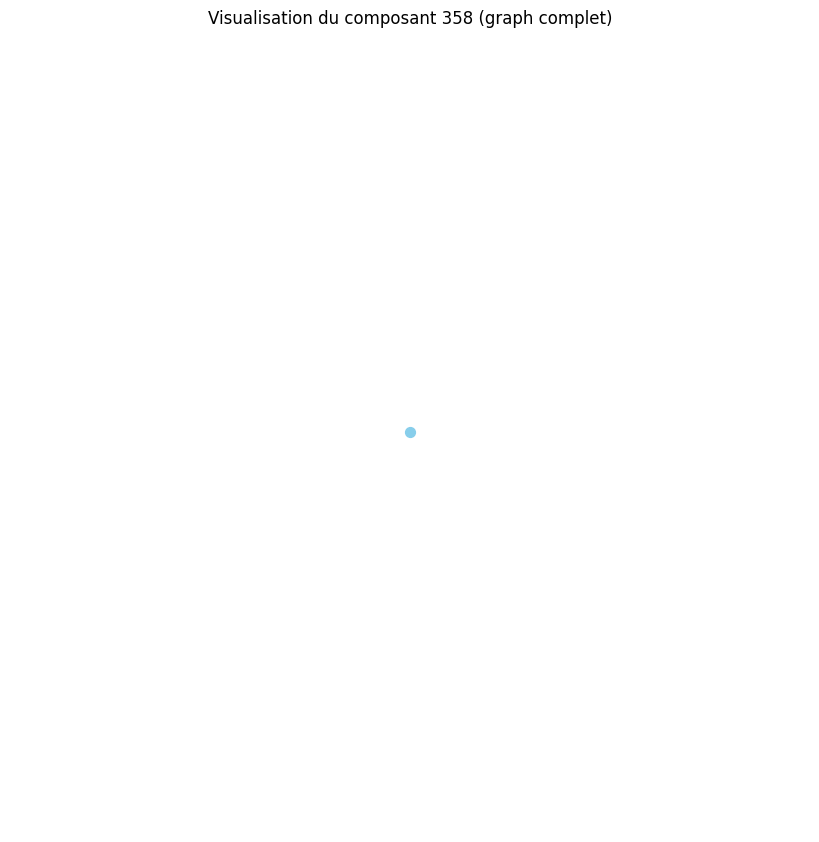

Distance moyenne pour le composant 359 : 0.00
Le composant 359 est un graphe complet ou très densément connecté.
Densité du composant 359 : 0.00
Degré moyen du composant 359 : 0.00
Coefficient de clustering moyen du composant 359 : 0.00


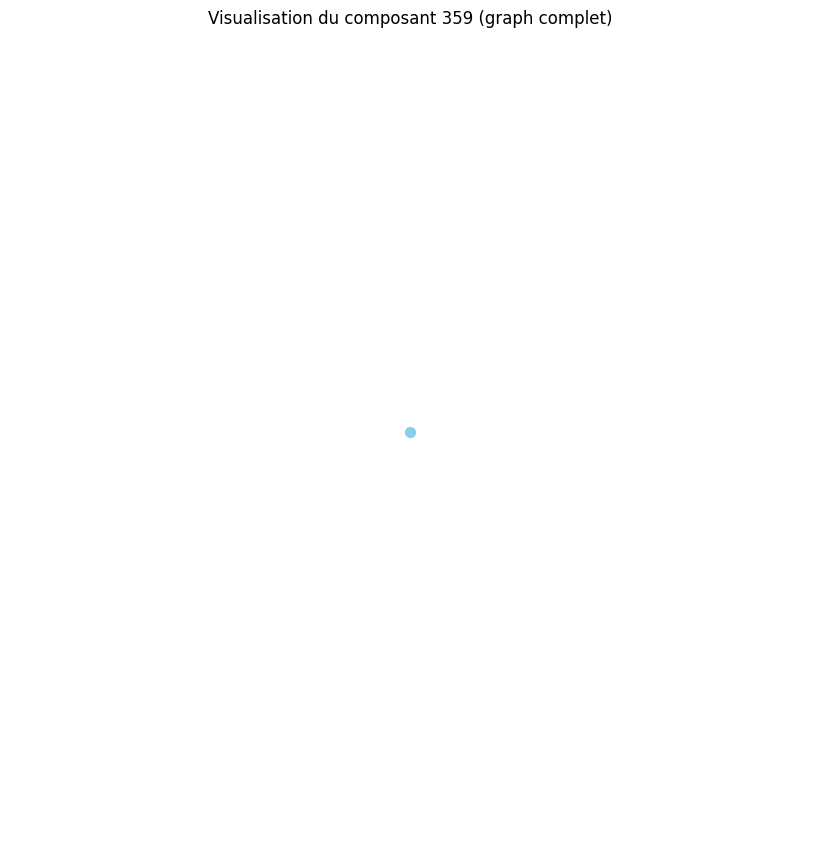

Distance moyenne pour le composant 360 : 0.00
Le composant 360 est un graphe complet ou très densément connecté.
Densité du composant 360 : 0.00
Degré moyen du composant 360 : 0.00
Coefficient de clustering moyen du composant 360 : 0.00


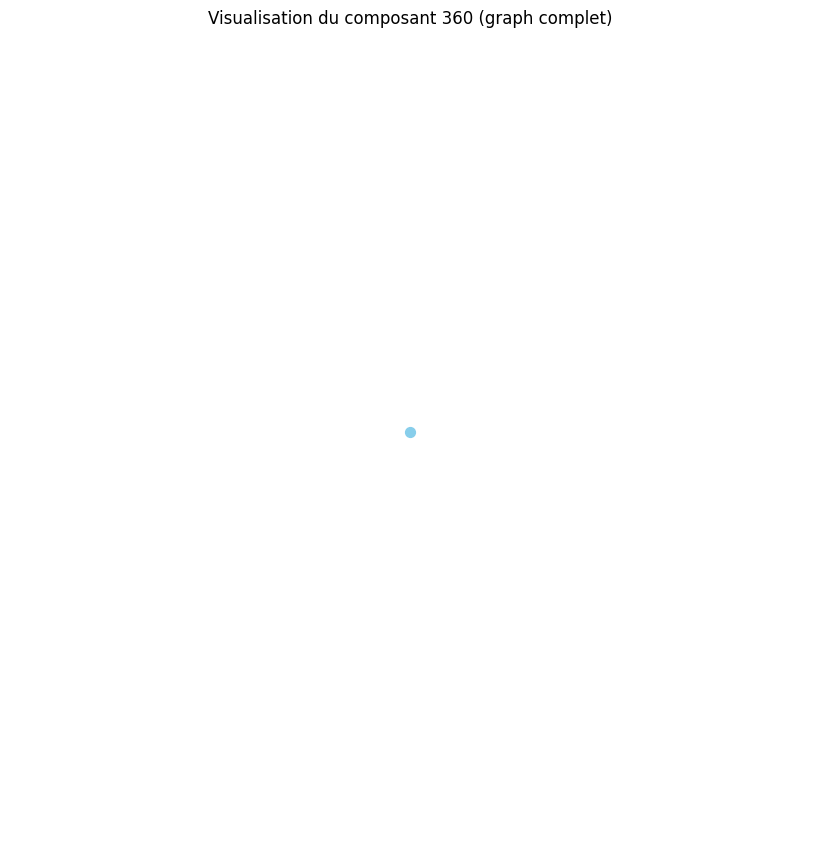

Distance moyenne pour le composant 361 : 0.00
Le composant 361 est un graphe complet ou très densément connecté.
Densité du composant 361 : 0.00
Degré moyen du composant 361 : 0.00
Coefficient de clustering moyen du composant 361 : 0.00


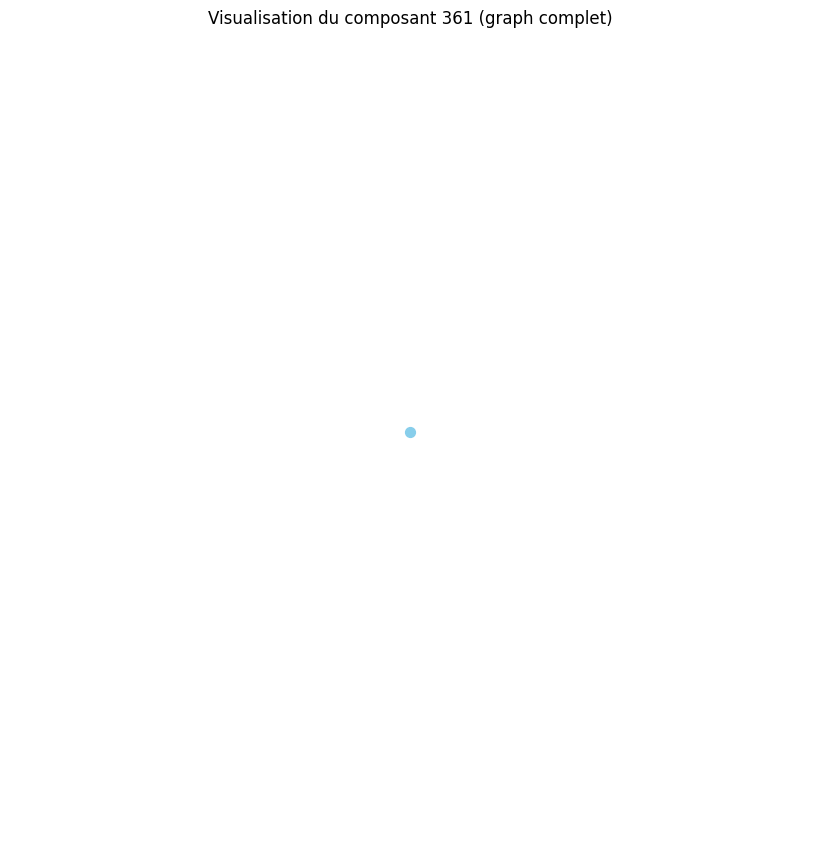

Distance moyenne pour le composant 362 : 0.00
Le composant 362 est un graphe complet ou très densément connecté.
Densité du composant 362 : 0.00
Degré moyen du composant 362 : 0.00
Coefficient de clustering moyen du composant 362 : 0.00


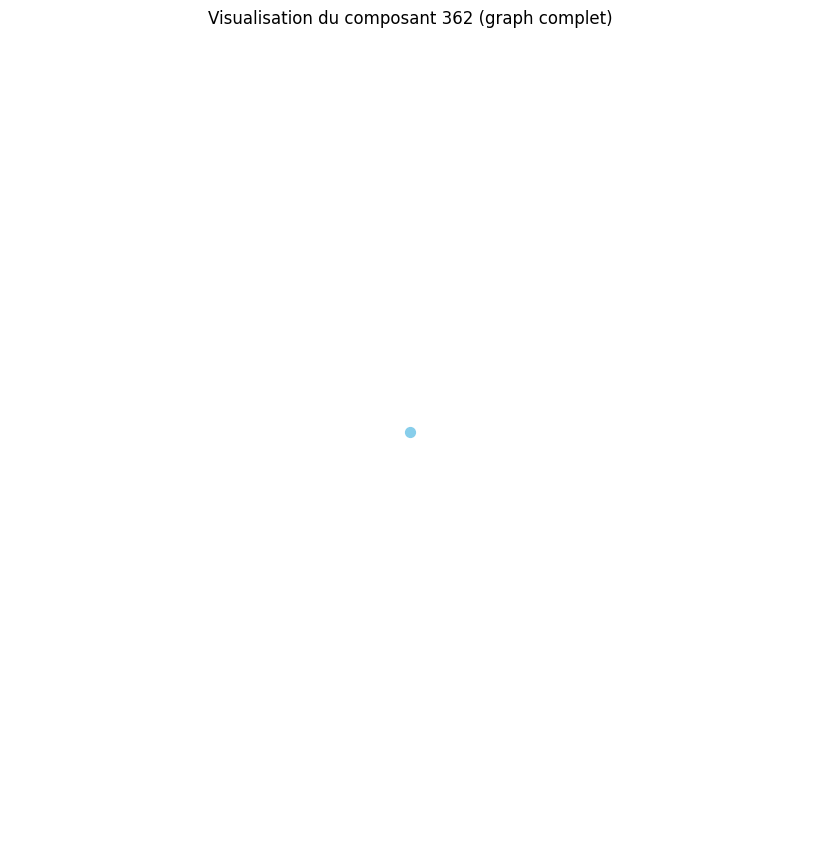

Distance moyenne pour le composant 363 : 0.00
Le composant 363 est un graphe complet ou très densément connecté.
Densité du composant 363 : 0.00
Degré moyen du composant 363 : 0.00
Coefficient de clustering moyen du composant 363 : 0.00


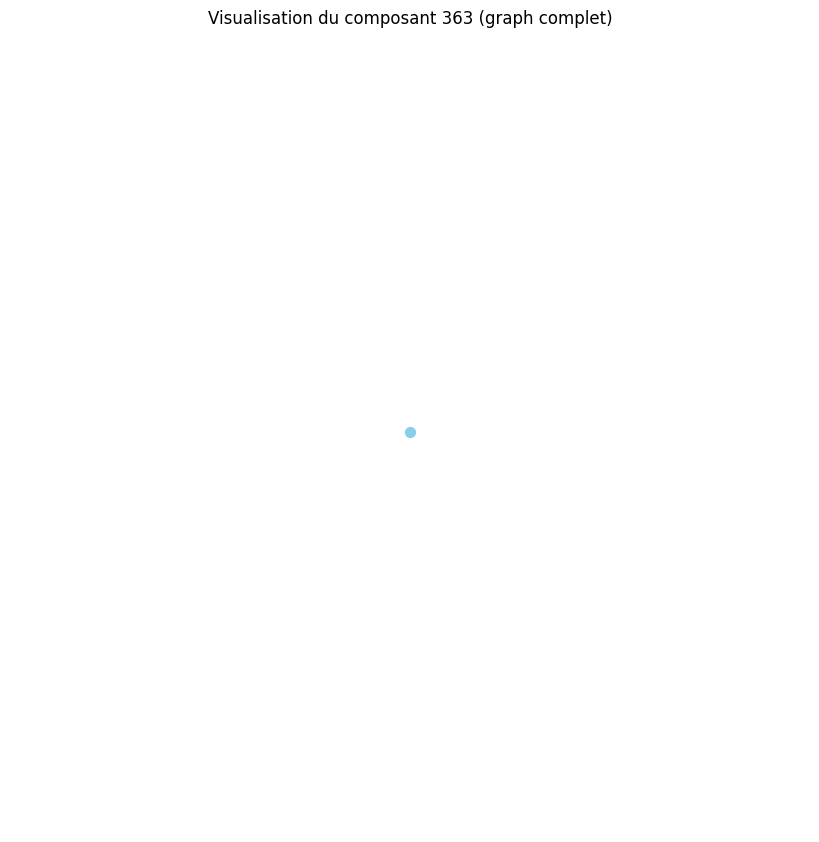

Distance moyenne pour le composant 364 : 0.00
Le composant 364 est un graphe complet ou très densément connecté.
Densité du composant 364 : 0.00
Degré moyen du composant 364 : 0.00
Coefficient de clustering moyen du composant 364 : 0.00


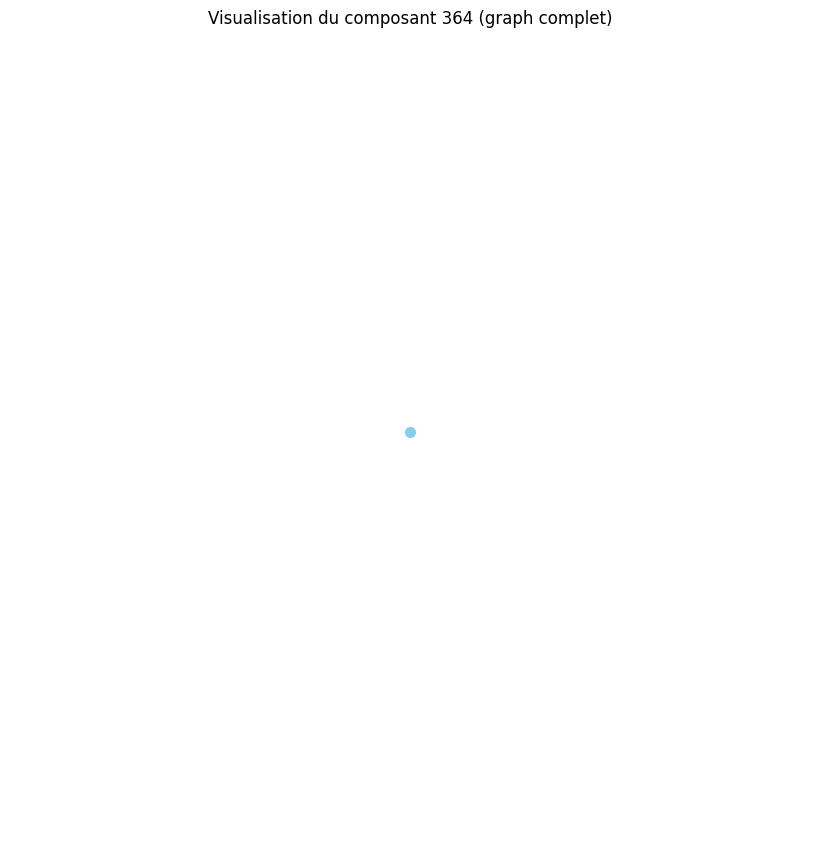

Distance moyenne pour le composant 365 : 1.00
Distance moyenne pour le composant 366 : 0.00
Le composant 366 est un graphe complet ou très densément connecté.
Densité du composant 366 : 0.00
Degré moyen du composant 366 : 0.00
Coefficient de clustering moyen du composant 366 : 0.00


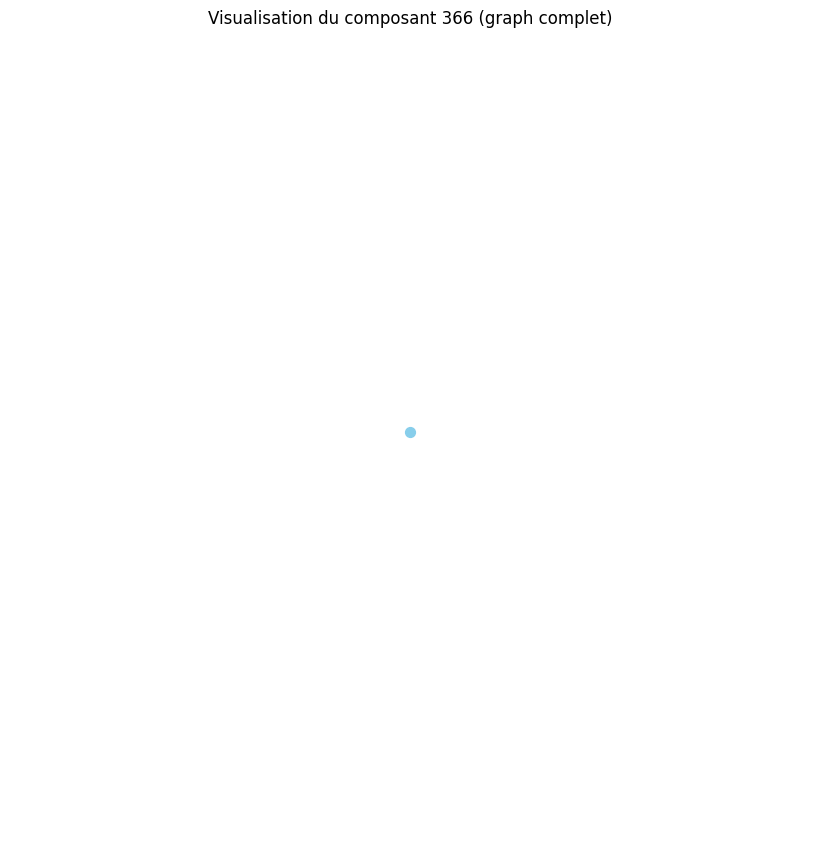

Distance moyenne pour le composant 367 : 0.00
Le composant 367 est un graphe complet ou très densément connecté.
Densité du composant 367 : 0.00
Degré moyen du composant 367 : 0.00
Coefficient de clustering moyen du composant 367 : 0.00


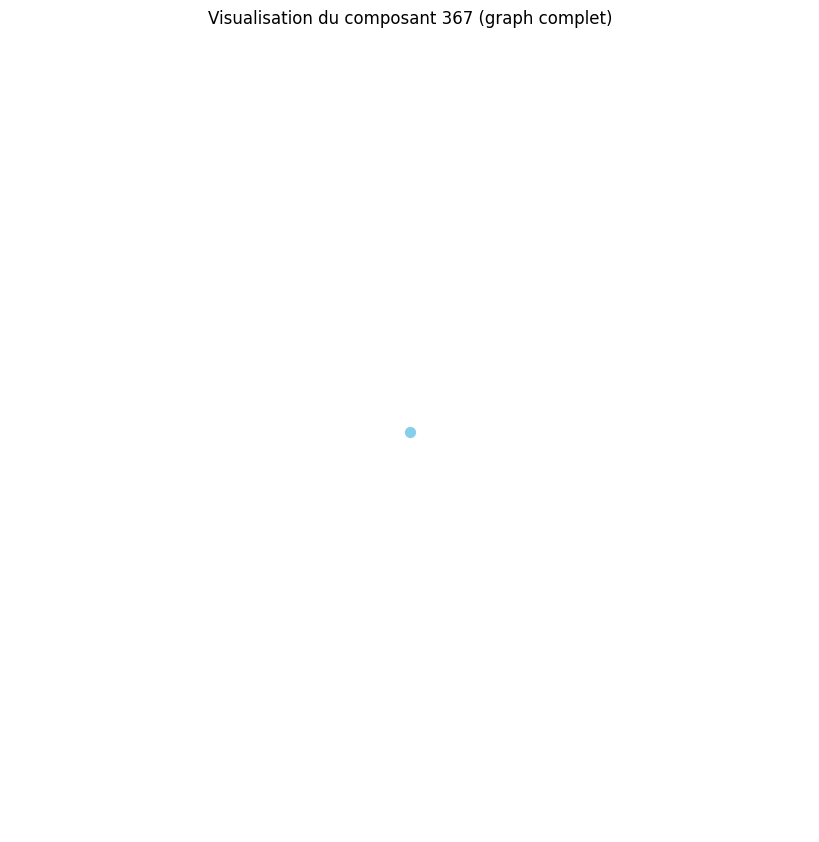

Distance moyenne pour le composant 368 : 0.00
Le composant 368 est un graphe complet ou très densément connecté.
Densité du composant 368 : 0.00
Degré moyen du composant 368 : 0.00
Coefficient de clustering moyen du composant 368 : 0.00


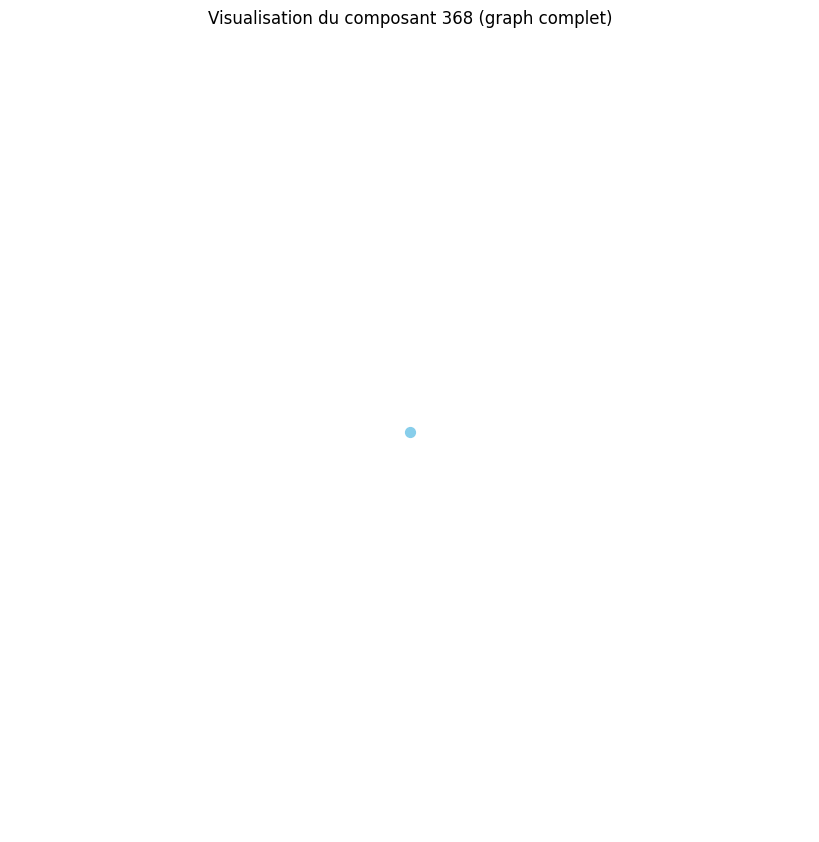

Distance moyenne pour le composant 369 : 0.00
Le composant 369 est un graphe complet ou très densément connecté.
Densité du composant 369 : 0.00
Degré moyen du composant 369 : 0.00
Coefficient de clustering moyen du composant 369 : 0.00


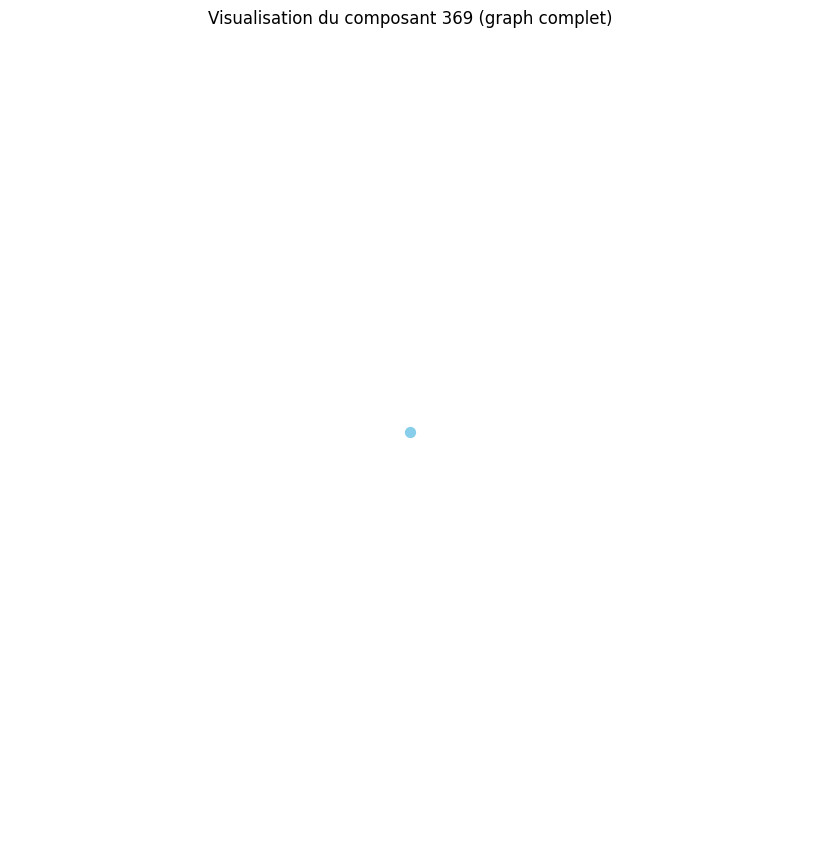

Distance moyenne pour le composant 370 : 0.00
Le composant 370 est un graphe complet ou très densément connecté.
Densité du composant 370 : 0.00
Degré moyen du composant 370 : 0.00
Coefficient de clustering moyen du composant 370 : 0.00


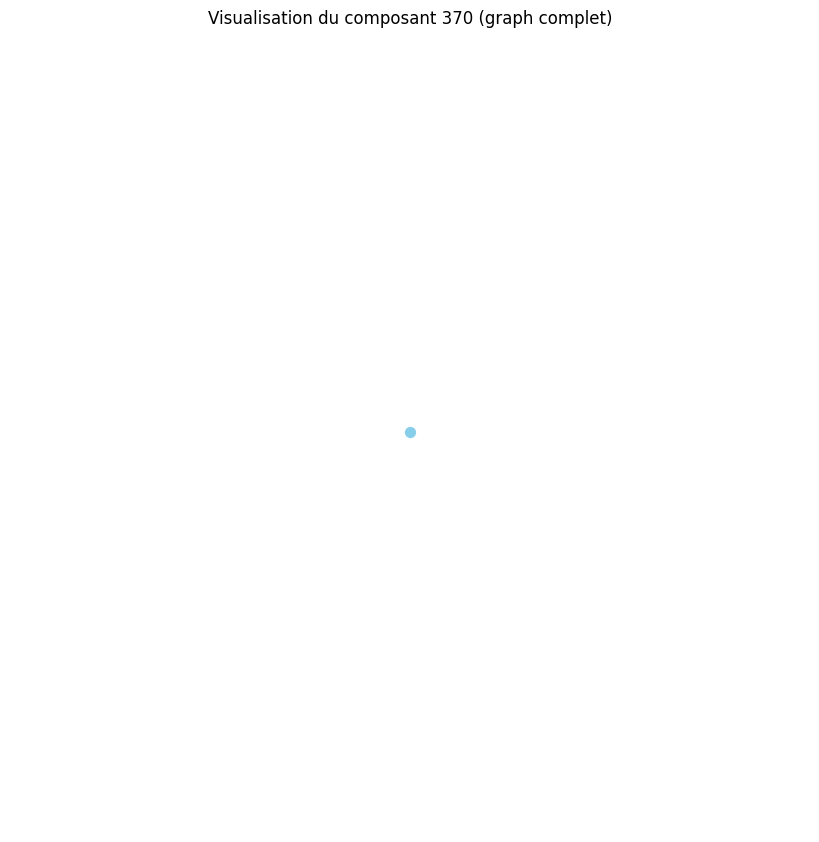

Distance moyenne pour le composant 371 : 0.00
Le composant 371 est un graphe complet ou très densément connecté.
Densité du composant 371 : 0.00
Degré moyen du composant 371 : 0.00
Coefficient de clustering moyen du composant 371 : 0.00


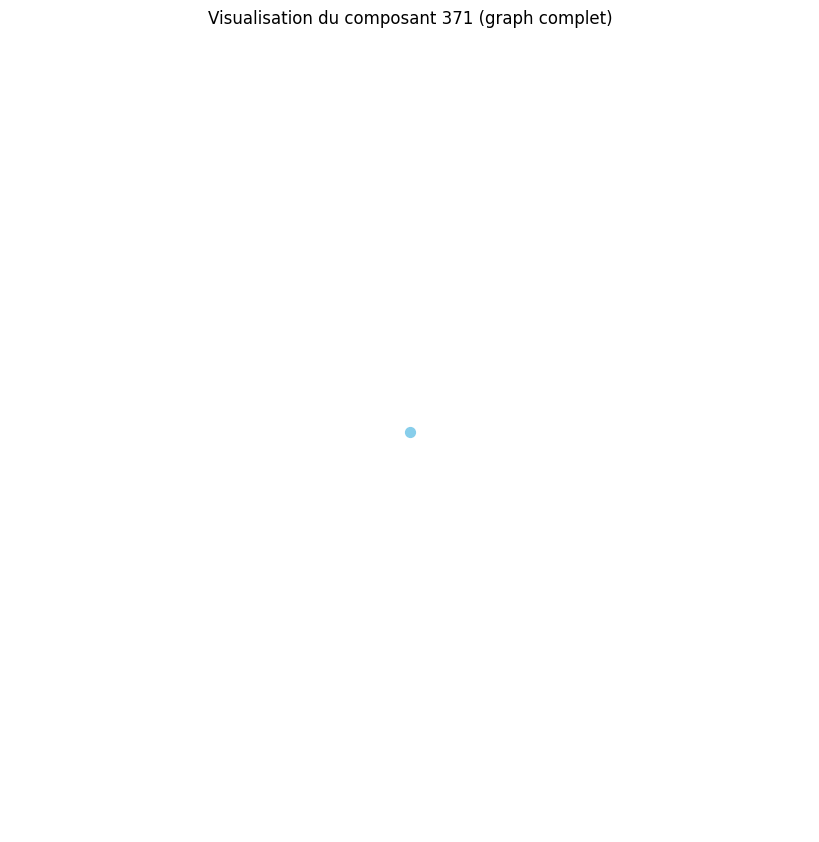

Distance moyenne pour le composant 372 : 0.00
Le composant 372 est un graphe complet ou très densément connecté.
Densité du composant 372 : 0.00
Degré moyen du composant 372 : 0.00
Coefficient de clustering moyen du composant 372 : 0.00


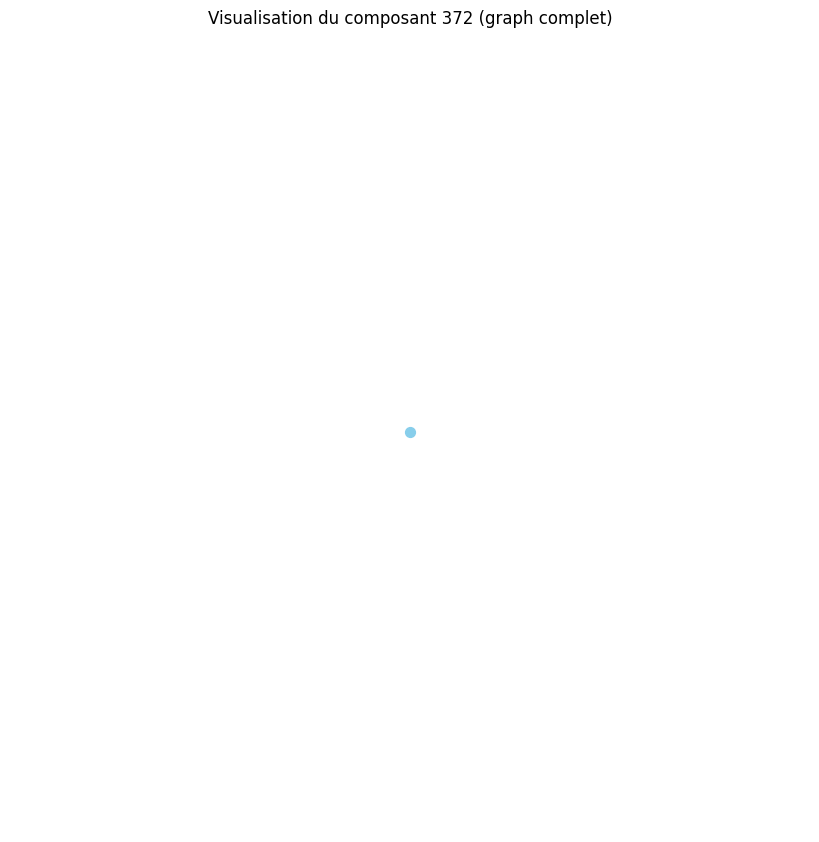

Distance moyenne pour le composant 373 : 0.00
Le composant 373 est un graphe complet ou très densément connecté.
Densité du composant 373 : 0.00
Degré moyen du composant 373 : 0.00
Coefficient de clustering moyen du composant 373 : 0.00


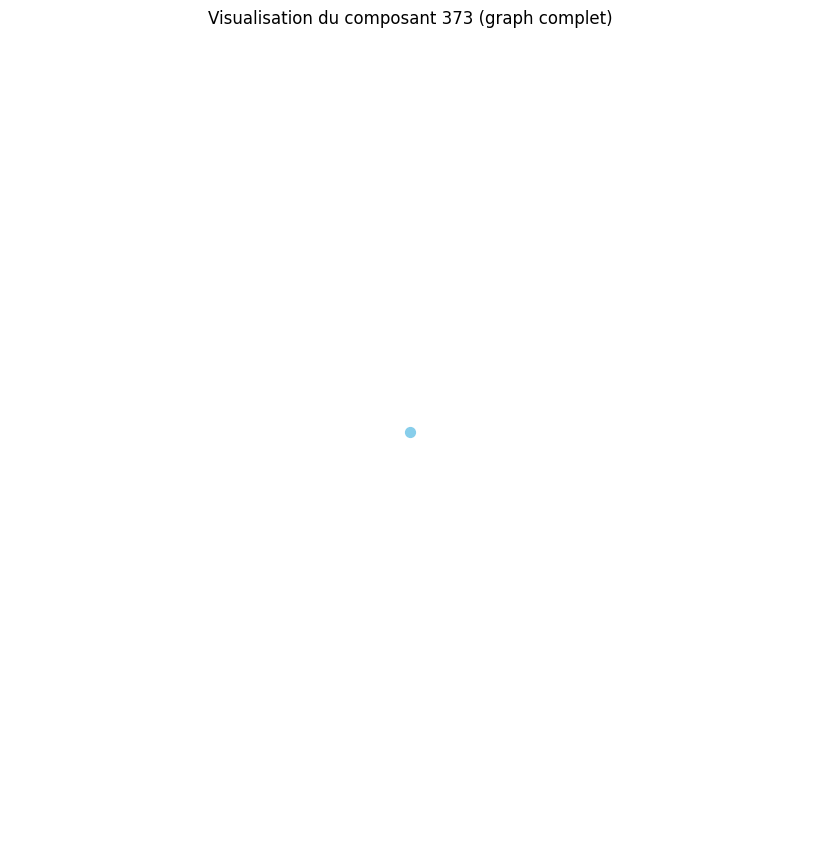

Distance moyenne pour le composant 374 : 0.00
Le composant 374 est un graphe complet ou très densément connecté.
Densité du composant 374 : 0.00
Degré moyen du composant 374 : 0.00
Coefficient de clustering moyen du composant 374 : 0.00


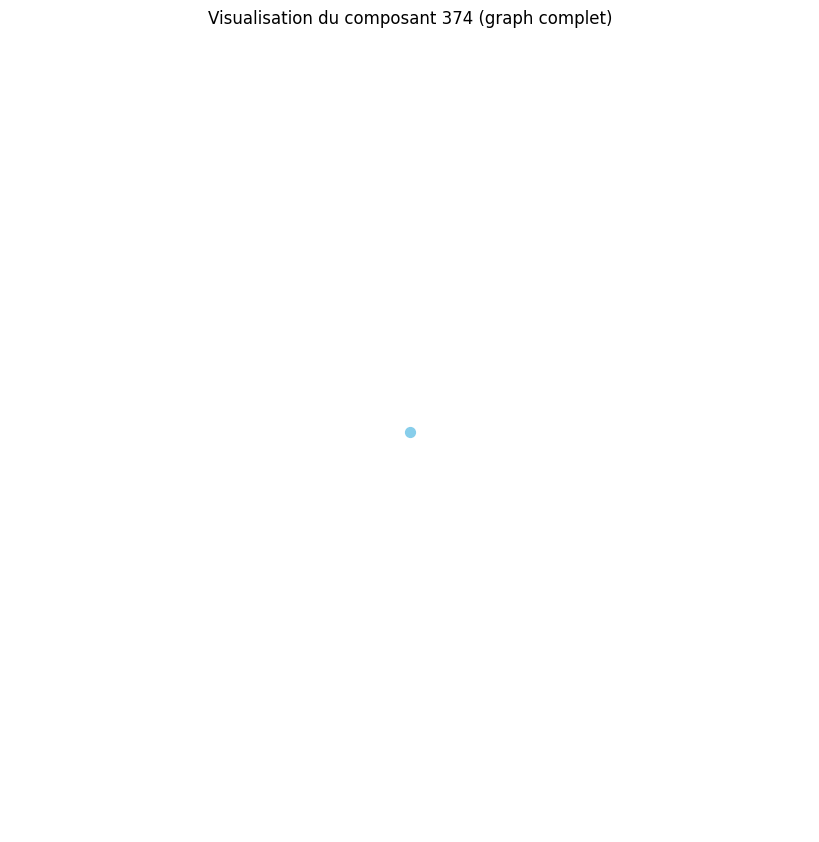

Distance moyenne pour le composant 375 : 0.00
Le composant 375 est un graphe complet ou très densément connecté.
Densité du composant 375 : 0.00
Degré moyen du composant 375 : 0.00
Coefficient de clustering moyen du composant 375 : 0.00


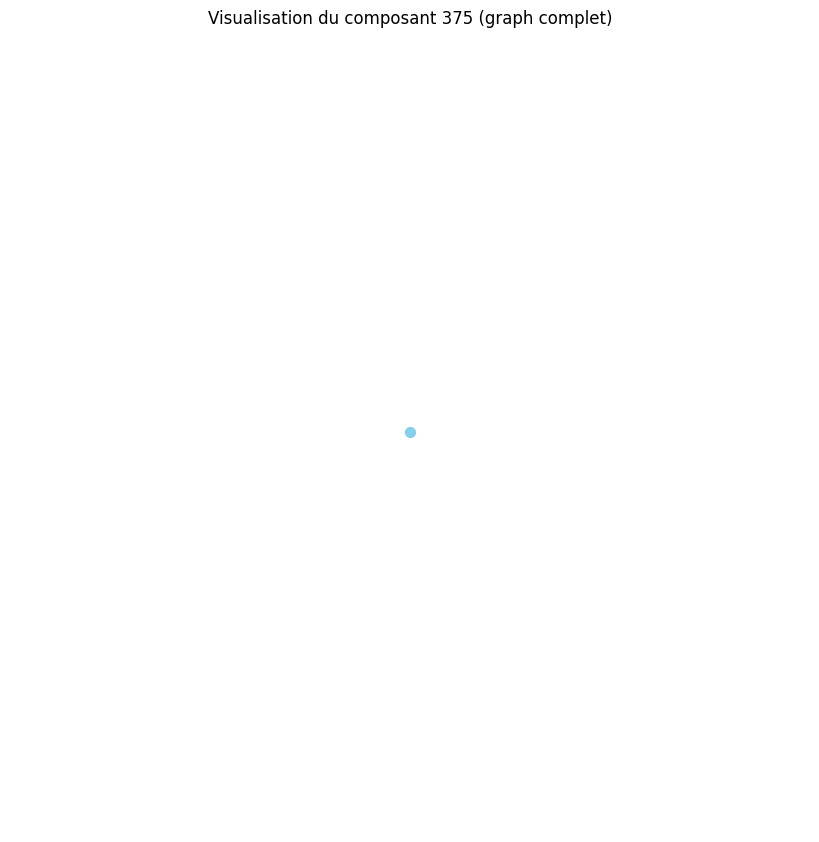

Distance moyenne pour le composant 376 : 0.00
Le composant 376 est un graphe complet ou très densément connecté.
Densité du composant 376 : 0.00
Degré moyen du composant 376 : 0.00
Coefficient de clustering moyen du composant 376 : 0.00


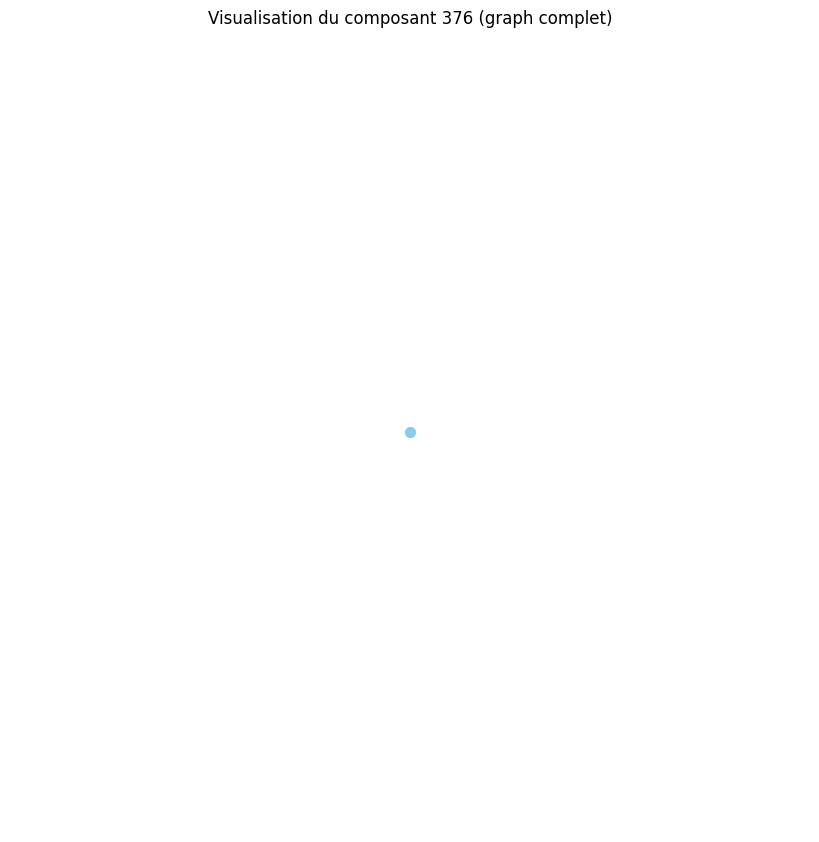

Distance moyenne pour le composant 377 : 0.00
Le composant 377 est un graphe complet ou très densément connecté.
Densité du composant 377 : 0.00
Degré moyen du composant 377 : 0.00
Coefficient de clustering moyen du composant 377 : 0.00


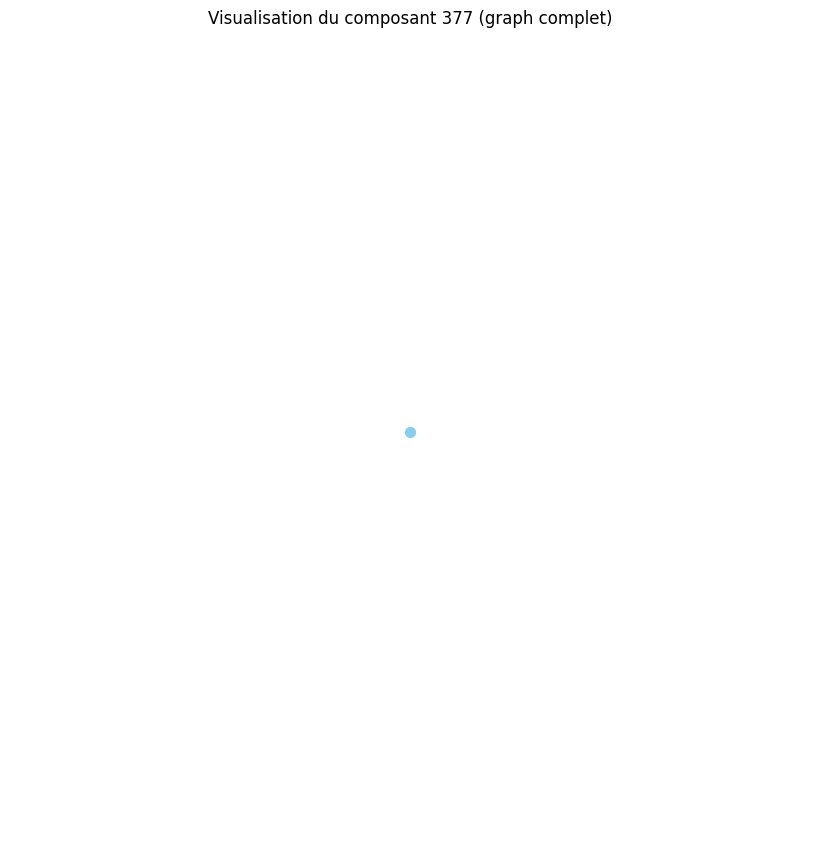

Distance moyenne pour le composant 378 : 0.00
Le composant 378 est un graphe complet ou très densément connecté.
Densité du composant 378 : 0.00
Degré moyen du composant 378 : 0.00
Coefficient de clustering moyen du composant 378 : 0.00


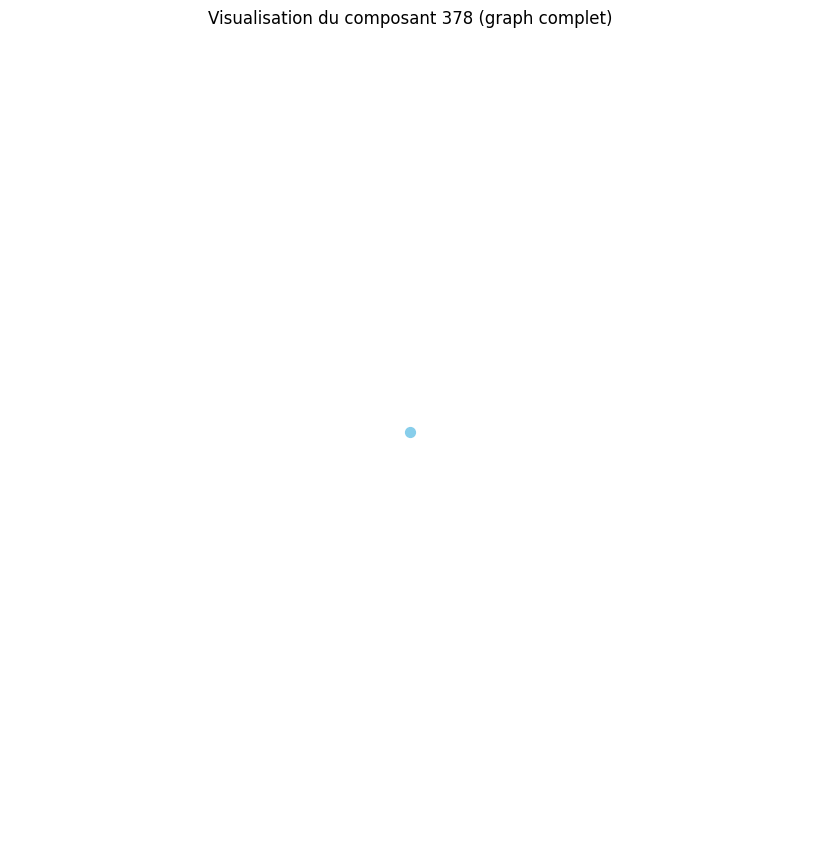

Distance moyenne pour le composant 379 : 0.00
Le composant 379 est un graphe complet ou très densément connecté.
Densité du composant 379 : 0.00
Degré moyen du composant 379 : 0.00
Coefficient de clustering moyen du composant 379 : 0.00


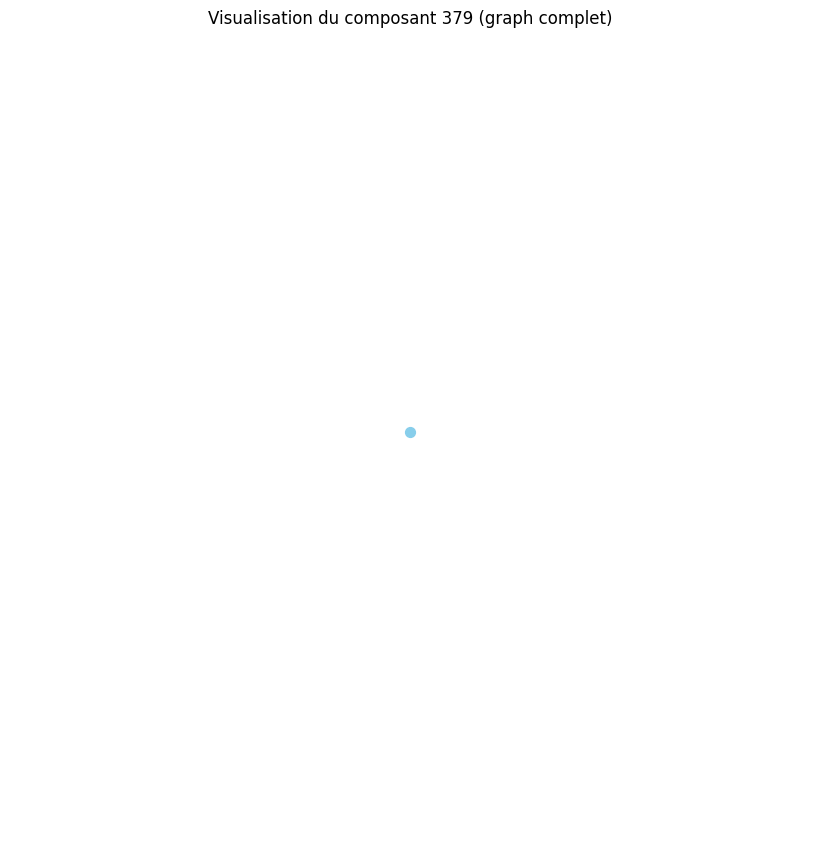

Distance moyenne pour le composant 380 : 0.00
Le composant 380 est un graphe complet ou très densément connecté.
Densité du composant 380 : 0.00
Degré moyen du composant 380 : 0.00
Coefficient de clustering moyen du composant 380 : 0.00


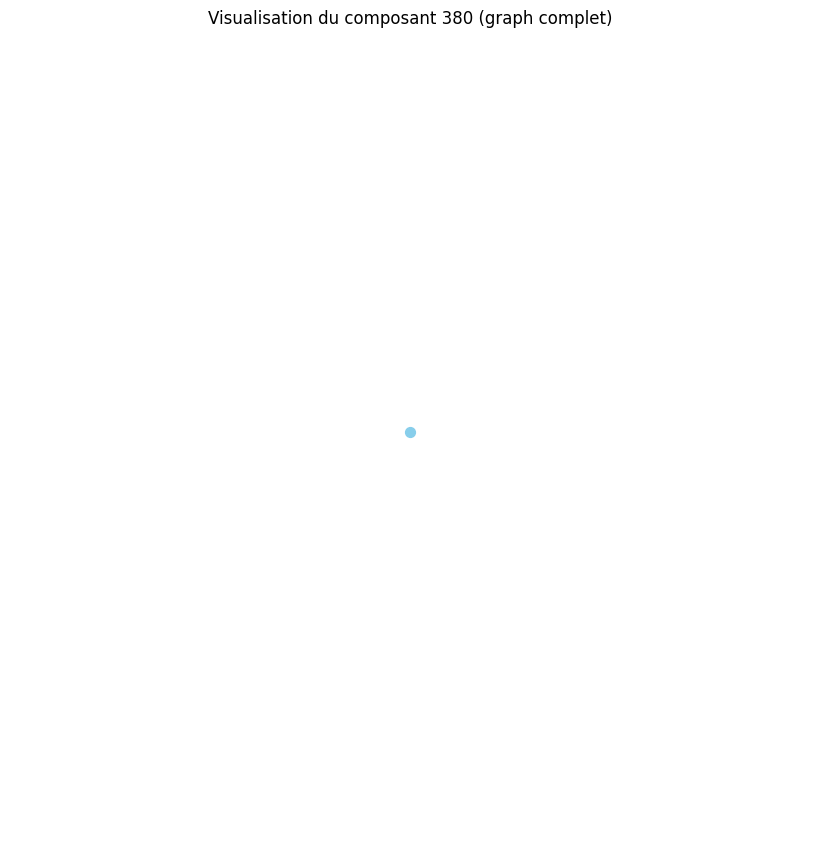

Distance moyenne pour le composant 381 : 0.00
Le composant 381 est un graphe complet ou très densément connecté.
Densité du composant 381 : 0.00
Degré moyen du composant 381 : 0.00
Coefficient de clustering moyen du composant 381 : 0.00


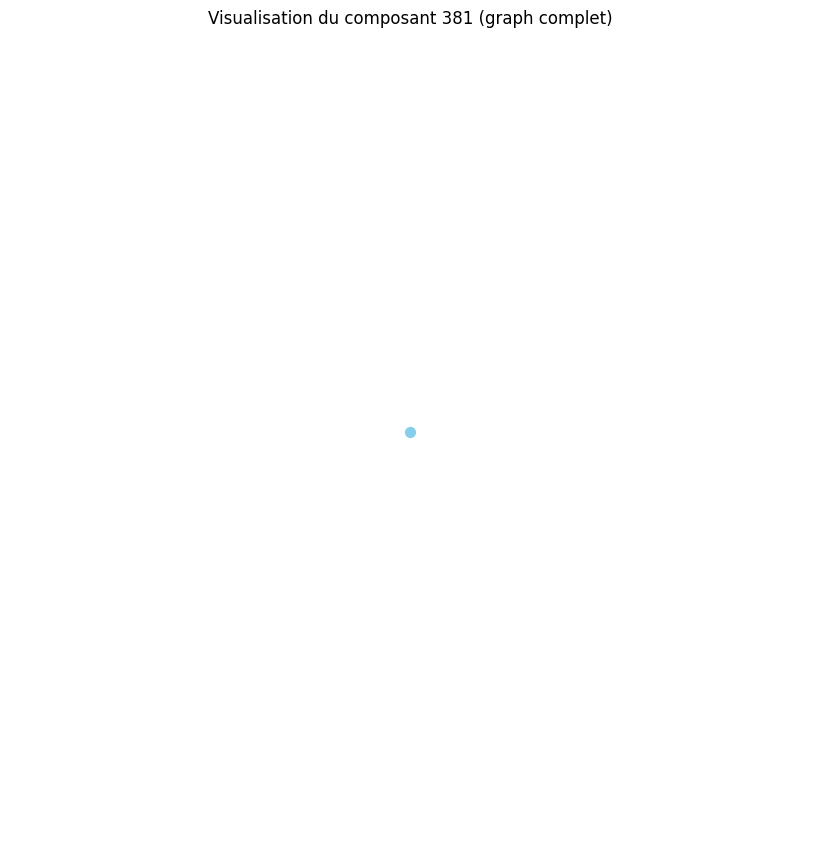

Distance moyenne pour le composant 382 : 0.00
Le composant 382 est un graphe complet ou très densément connecté.
Densité du composant 382 : 0.00
Degré moyen du composant 382 : 0.00
Coefficient de clustering moyen du composant 382 : 0.00


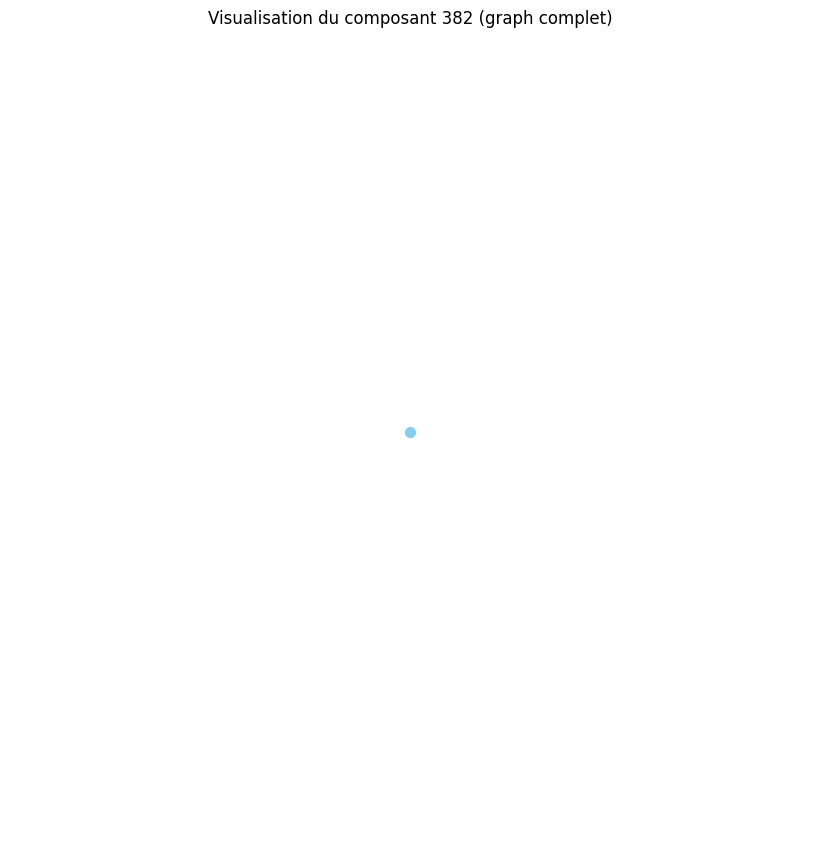

Distance moyenne pour le composant 383 : 0.00
Le composant 383 est un graphe complet ou très densément connecté.
Densité du composant 383 : 0.00
Degré moyen du composant 383 : 0.00
Coefficient de clustering moyen du composant 383 : 0.00


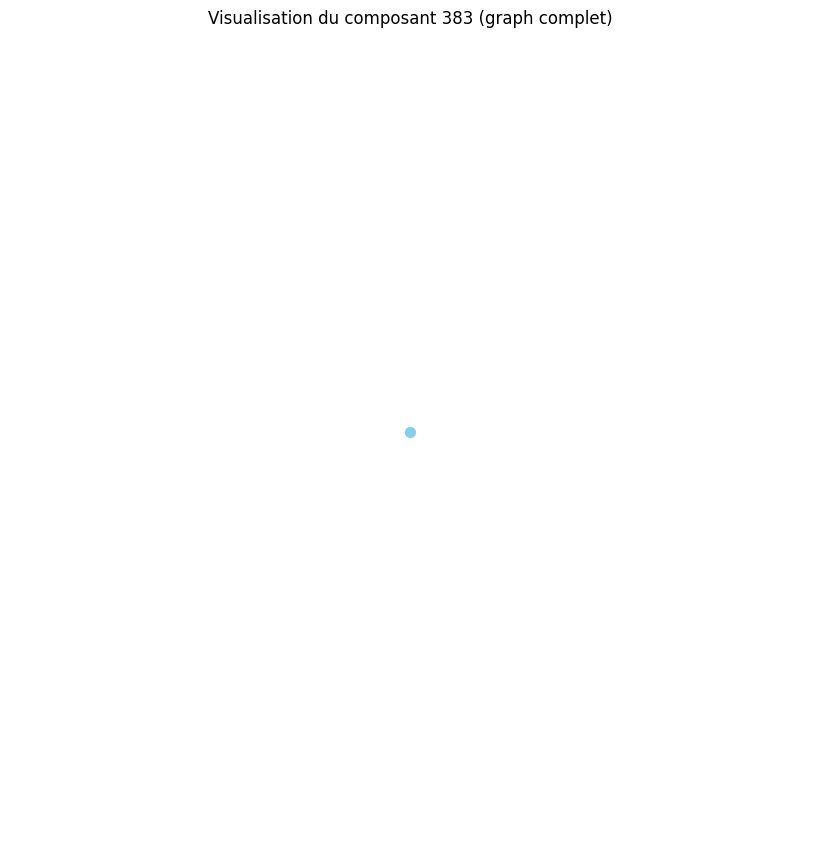

Distance moyenne pour le composant 384 : 0.00
Le composant 384 est un graphe complet ou très densément connecté.
Densité du composant 384 : 0.00
Degré moyen du composant 384 : 0.00
Coefficient de clustering moyen du composant 384 : 0.00


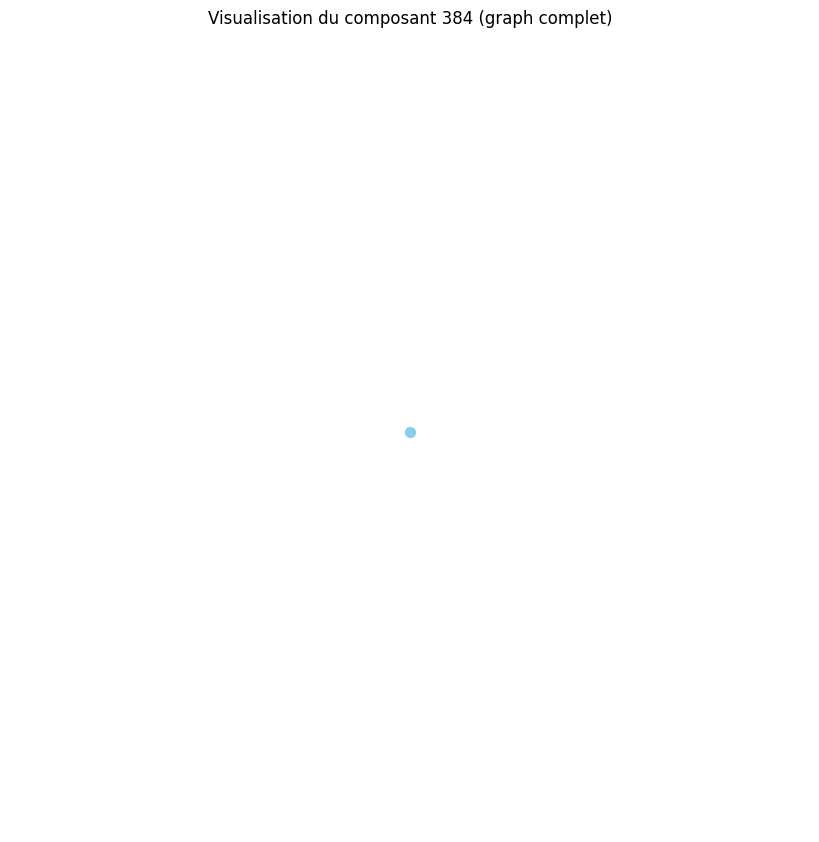

Distance moyenne pour le composant 385 : 1.00
Distance moyenne pour le composant 386 : 0.00
Le composant 386 est un graphe complet ou très densément connecté.
Densité du composant 386 : 0.00
Degré moyen du composant 386 : 0.00
Coefficient de clustering moyen du composant 386 : 0.00


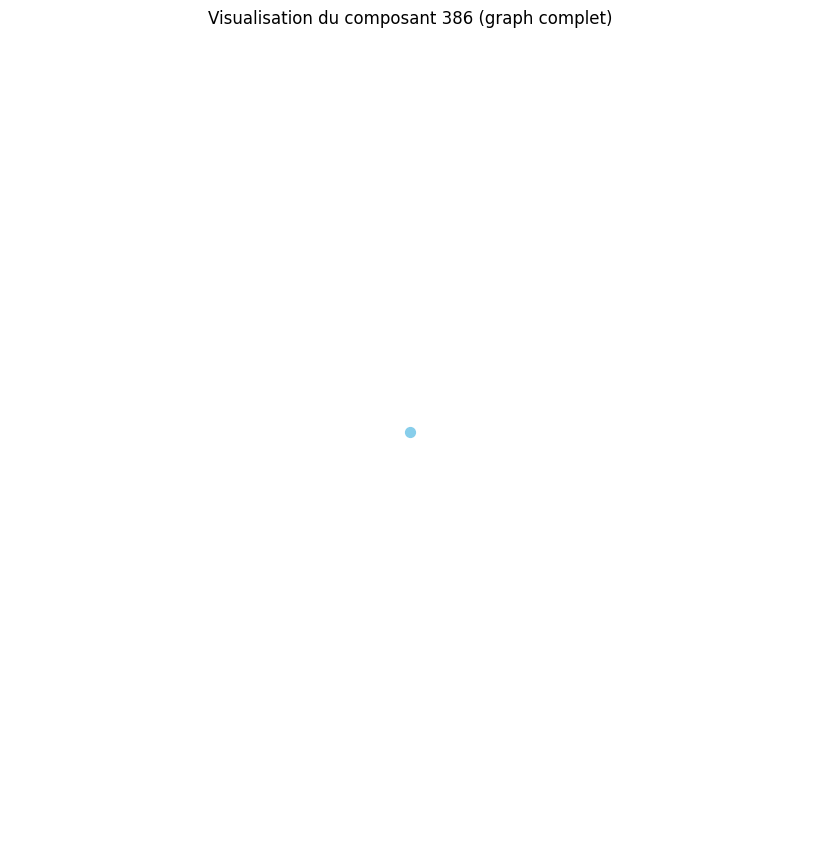

Distance moyenne pour le composant 387 : 0.00
Le composant 387 est un graphe complet ou très densément connecté.
Densité du composant 387 : 0.00
Degré moyen du composant 387 : 0.00
Coefficient de clustering moyen du composant 387 : 0.00


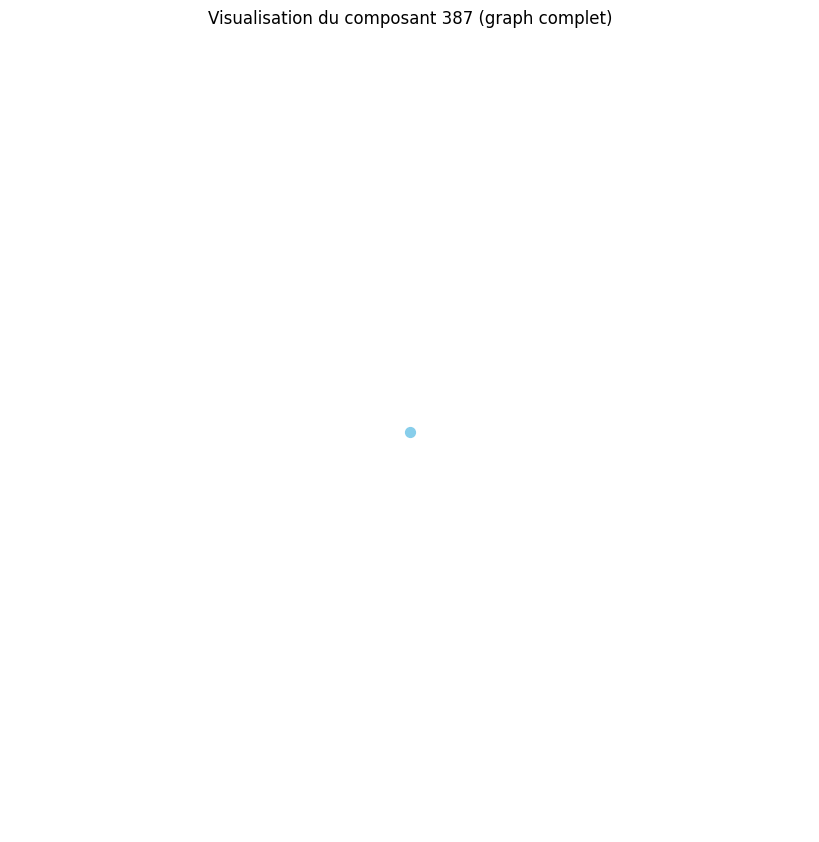

Distance moyenne pour le composant 388 : 0.00
Le composant 388 est un graphe complet ou très densément connecté.
Densité du composant 388 : 0.00
Degré moyen du composant 388 : 0.00
Coefficient de clustering moyen du composant 388 : 0.00


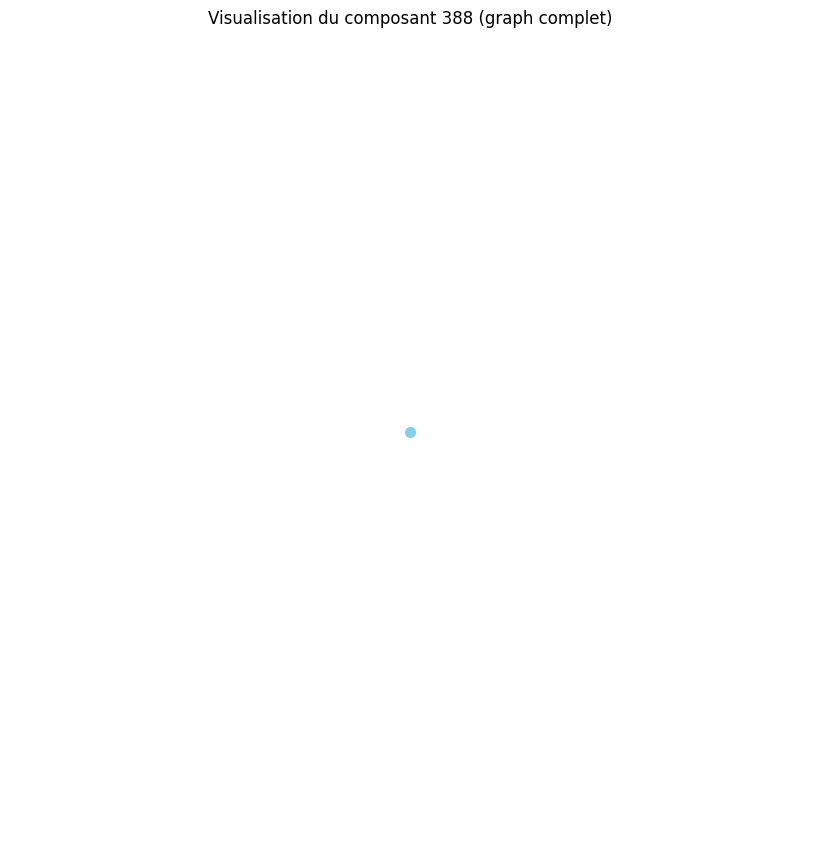

Distance moyenne pour le composant 389 : 0.00
Le composant 389 est un graphe complet ou très densément connecté.
Densité du composant 389 : 0.00
Degré moyen du composant 389 : 0.00
Coefficient de clustering moyen du composant 389 : 0.00


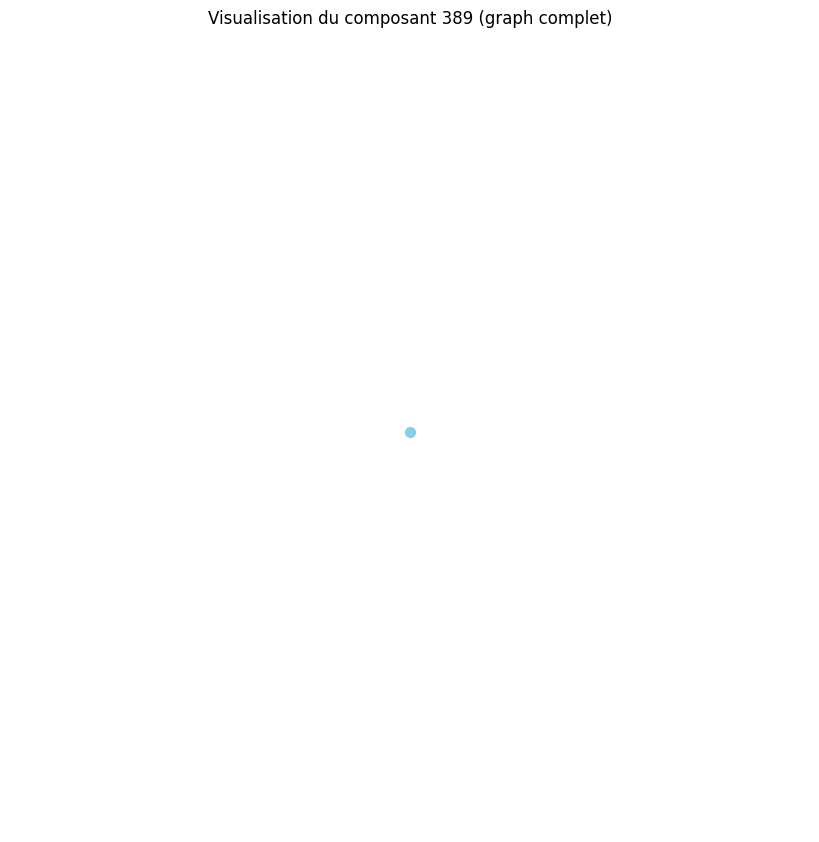

Distance moyenne pour le composant 390 : 0.00
Le composant 390 est un graphe complet ou très densément connecté.
Densité du composant 390 : 0.00
Degré moyen du composant 390 : 0.00
Coefficient de clustering moyen du composant 390 : 0.00


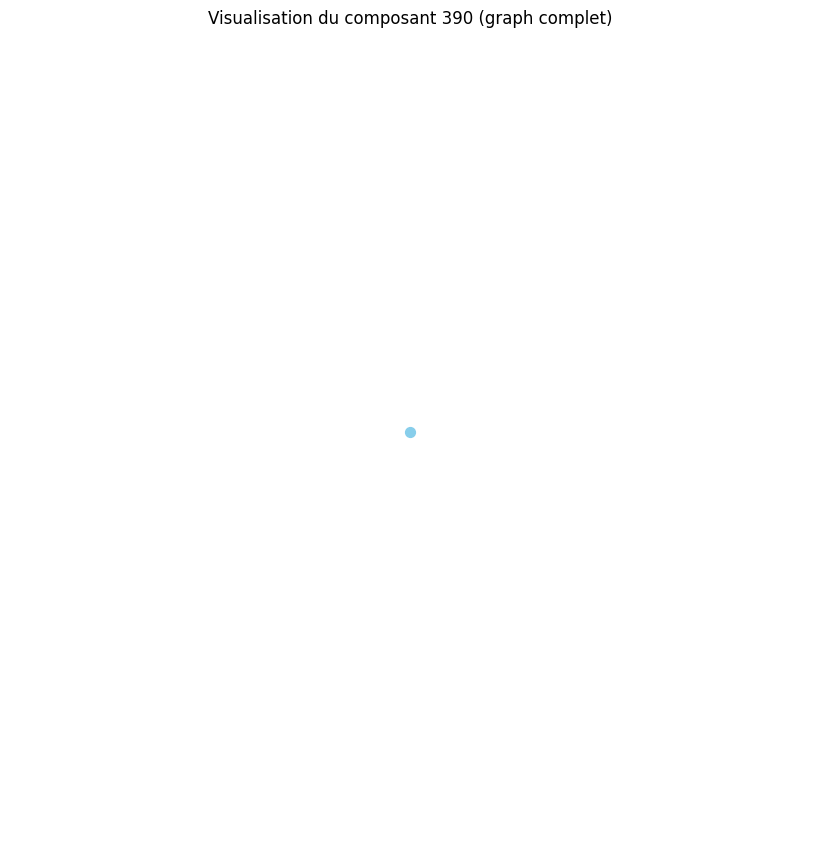

Distance moyenne pour le composant 391 : 0.00
Le composant 391 est un graphe complet ou très densément connecté.
Densité du composant 391 : 0.00
Degré moyen du composant 391 : 0.00
Coefficient de clustering moyen du composant 391 : 0.00


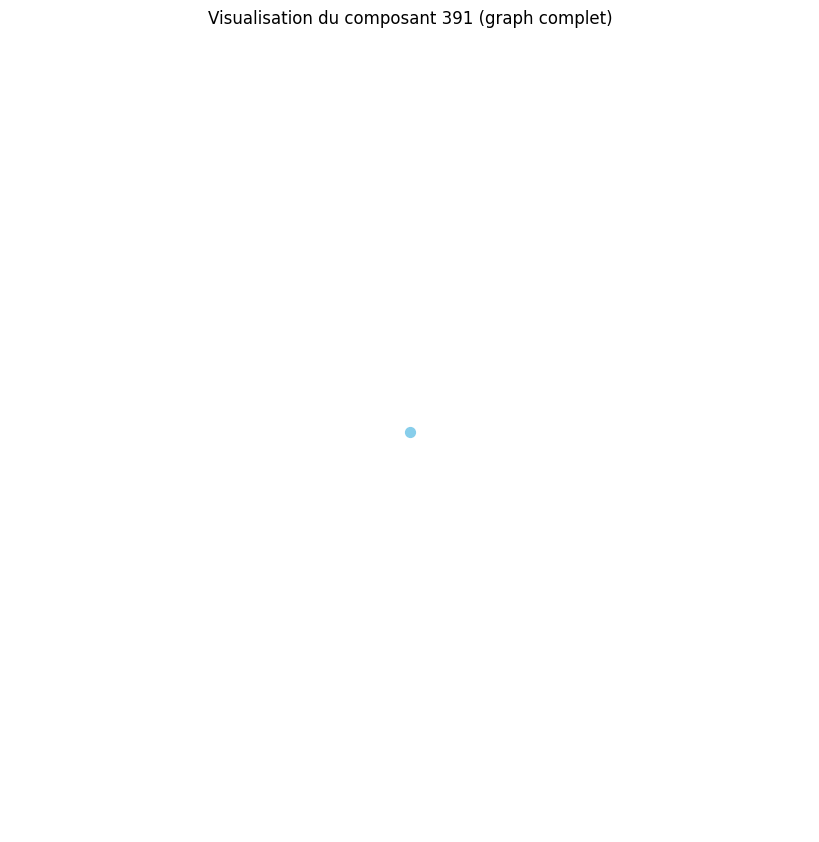

Distance moyenne pour le composant 392 : 0.00
Le composant 392 est un graphe complet ou très densément connecté.
Densité du composant 392 : 0.00
Degré moyen du composant 392 : 0.00
Coefficient de clustering moyen du composant 392 : 0.00


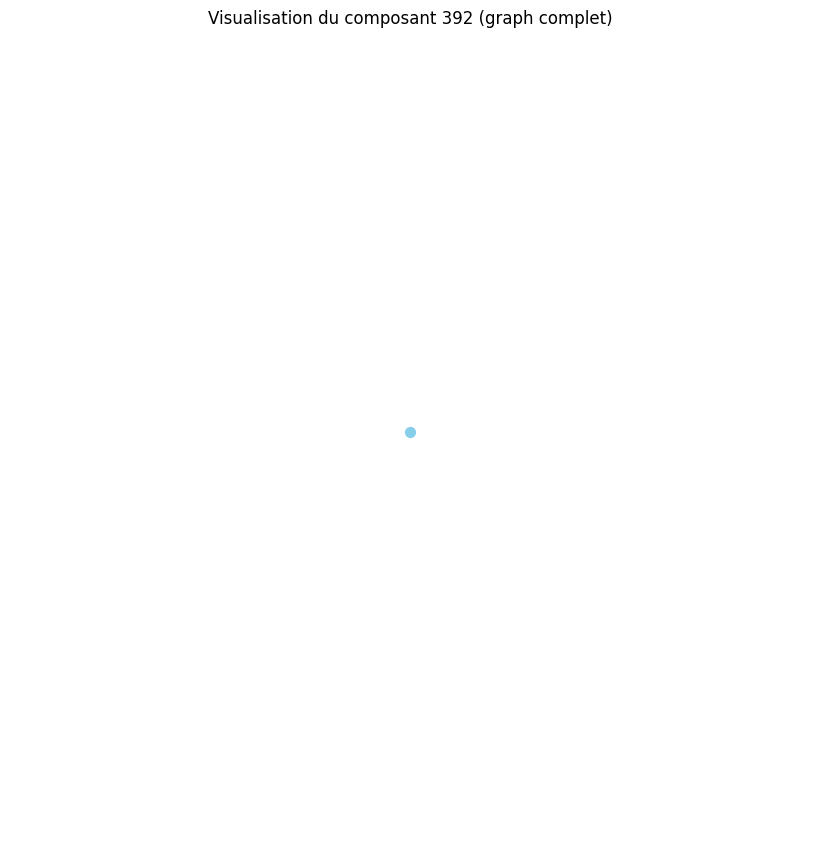

Distance moyenne pour le composant 393 : 0.00
Le composant 393 est un graphe complet ou très densément connecté.
Densité du composant 393 : 0.00
Degré moyen du composant 393 : 0.00
Coefficient de clustering moyen du composant 393 : 0.00


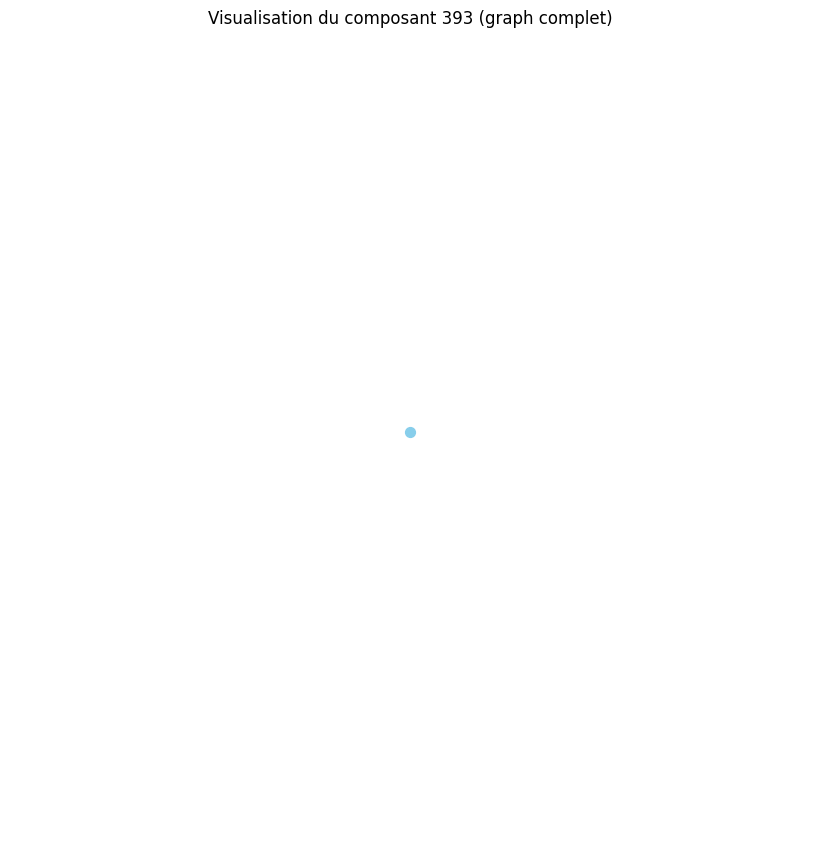

Distance moyenne pour le composant 394 : 0.00
Le composant 394 est un graphe complet ou très densément connecté.
Densité du composant 394 : 0.00
Degré moyen du composant 394 : 0.00
Coefficient de clustering moyen du composant 394 : 0.00


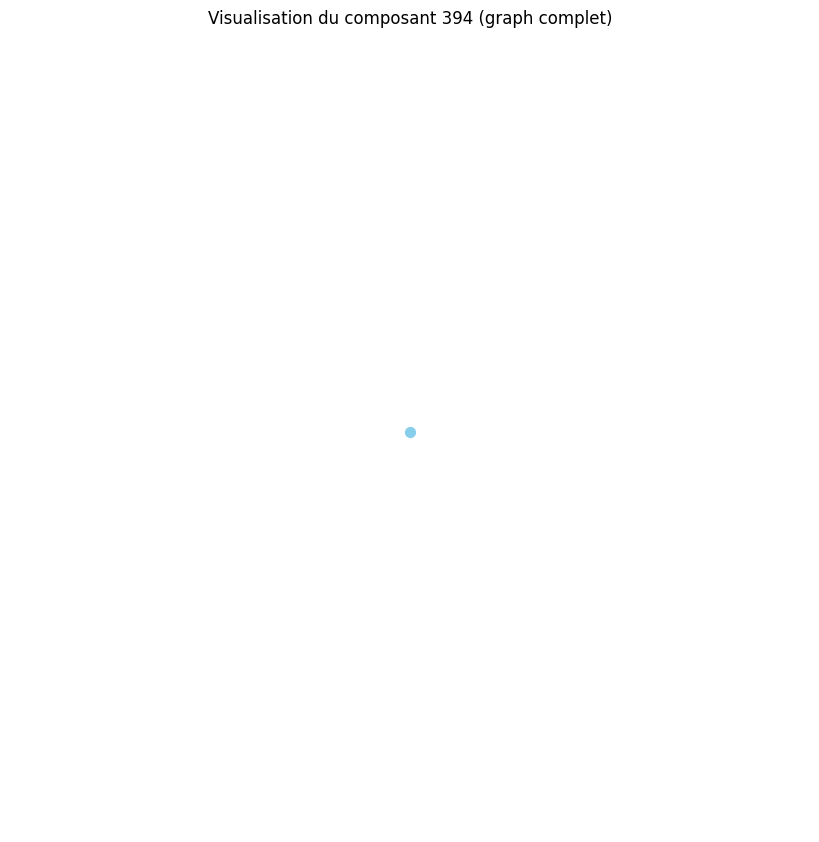

Distance moyenne pour le composant 395 : 0.00
Le composant 395 est un graphe complet ou très densément connecté.
Densité du composant 395 : 0.00
Degré moyen du composant 395 : 0.00
Coefficient de clustering moyen du composant 395 : 0.00


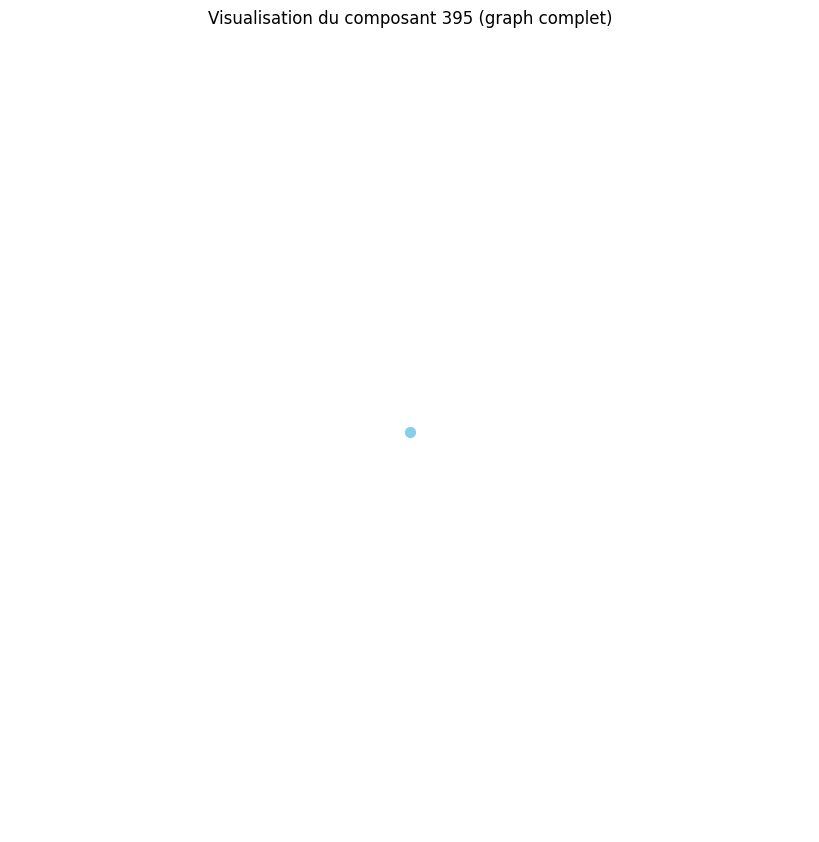

Distance moyenne pour le composant 396 : 0.00
Le composant 396 est un graphe complet ou très densément connecté.
Densité du composant 396 : 0.00
Degré moyen du composant 396 : 0.00
Coefficient de clustering moyen du composant 396 : 0.00


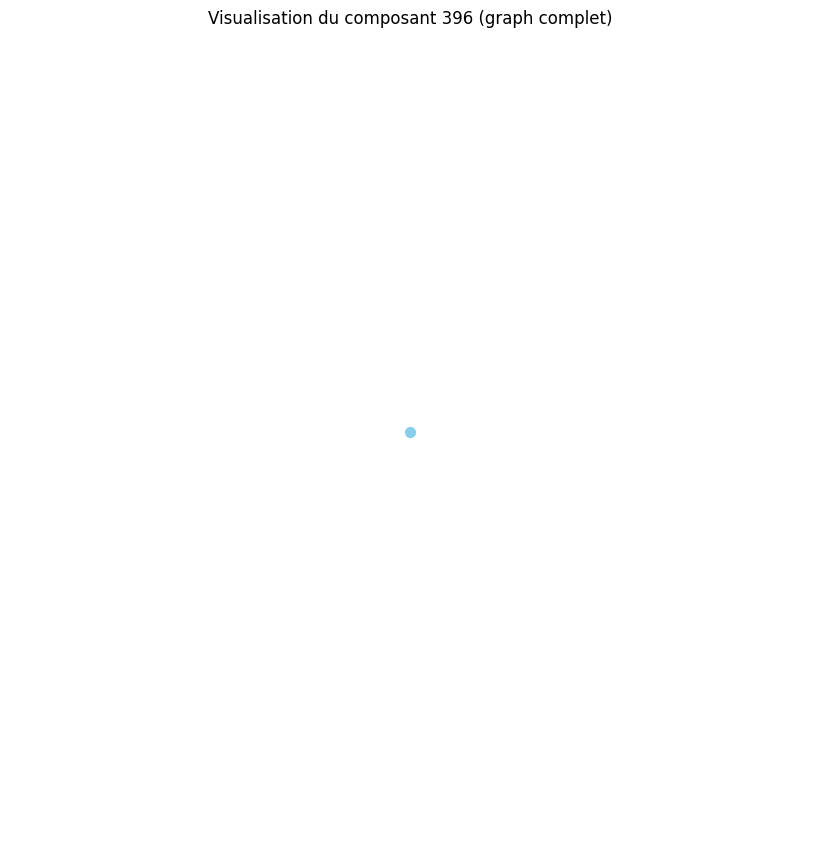

Distance moyenne pour le composant 397 : 0.00
Le composant 397 est un graphe complet ou très densément connecté.
Densité du composant 397 : 0.00
Degré moyen du composant 397 : 0.00
Coefficient de clustering moyen du composant 397 : 0.00


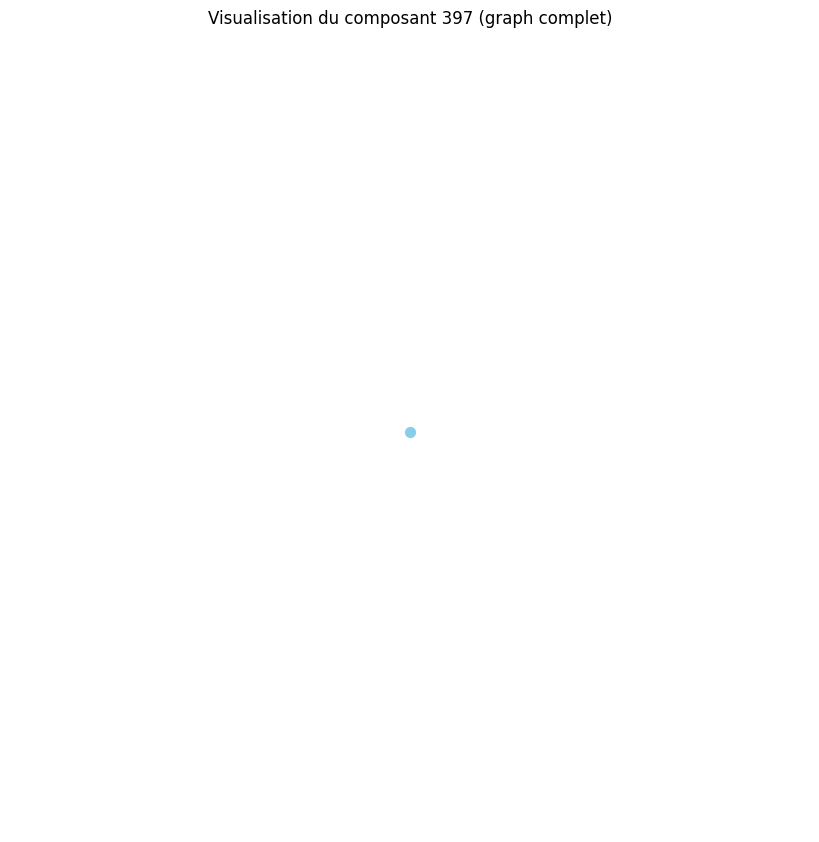

Distance moyenne pour le composant 398 : 0.00
Le composant 398 est un graphe complet ou très densément connecté.
Densité du composant 398 : 0.00
Degré moyen du composant 398 : 0.00
Coefficient de clustering moyen du composant 398 : 0.00


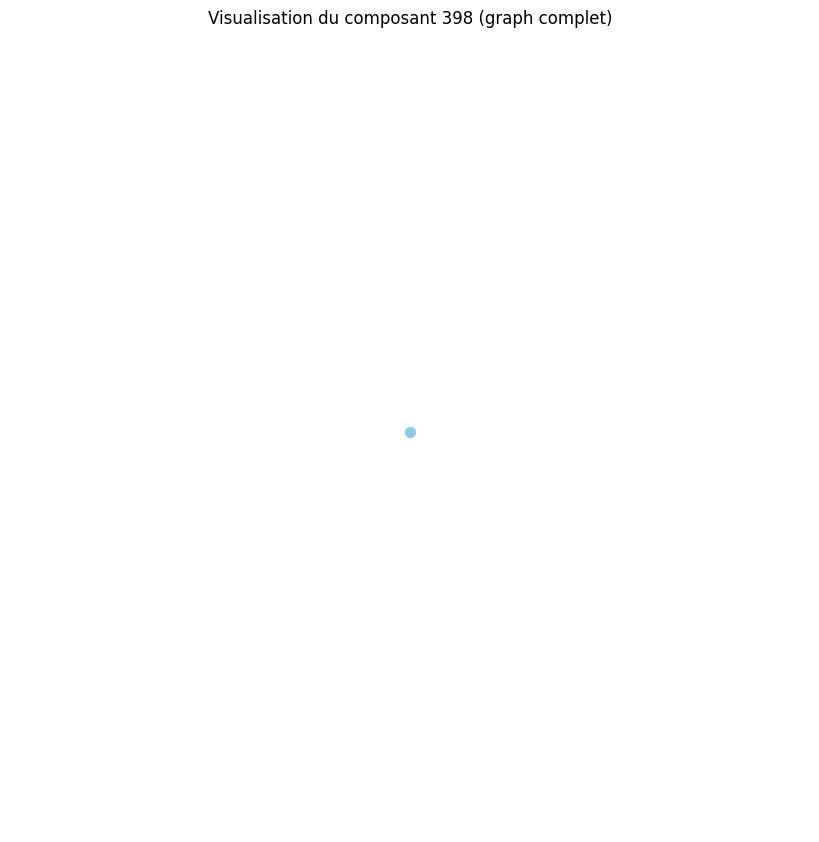

Distance moyenne pour le composant 399 : 0.00
Le composant 399 est un graphe complet ou très densément connecté.
Densité du composant 399 : 0.00
Degré moyen du composant 399 : 0.00
Coefficient de clustering moyen du composant 399 : 0.00


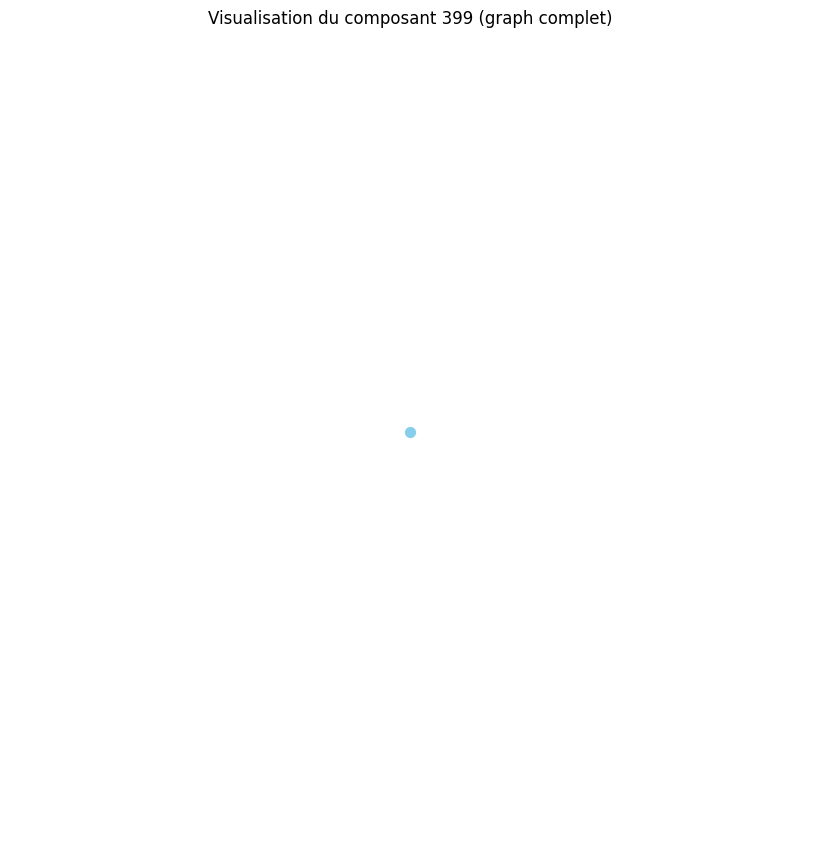

Distance moyenne pour le composant 400 : 0.00
Le composant 400 est un graphe complet ou très densément connecté.
Densité du composant 400 : 0.00
Degré moyen du composant 400 : 0.00
Coefficient de clustering moyen du composant 400 : 0.00


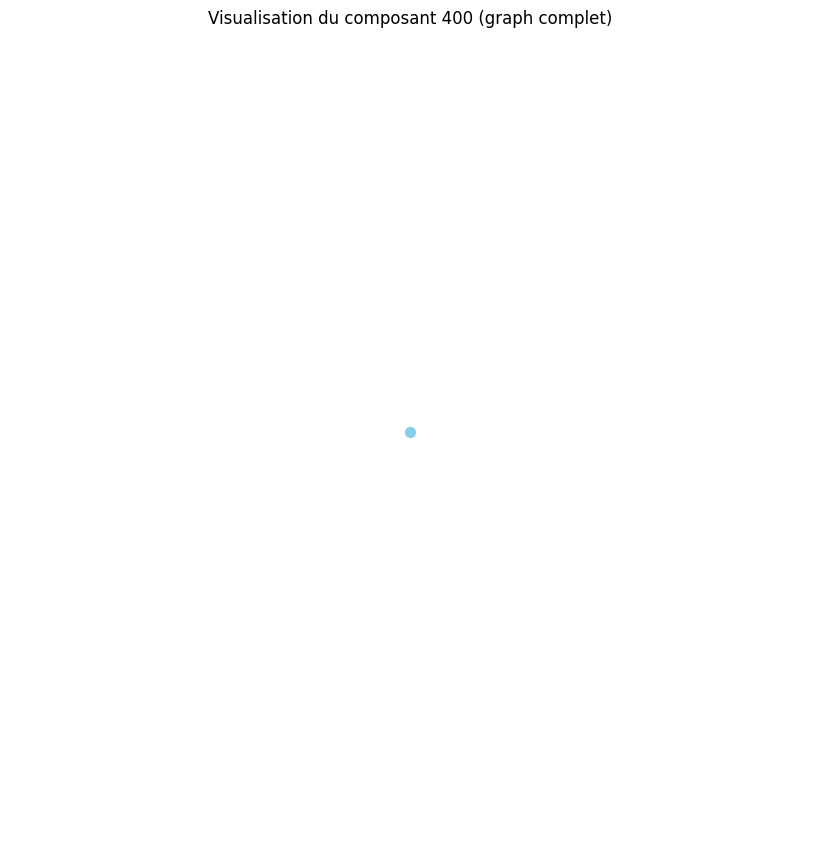

Distance moyenne pour le composant 401 : 0.00
Le composant 401 est un graphe complet ou très densément connecté.
Densité du composant 401 : 0.00
Degré moyen du composant 401 : 0.00
Coefficient de clustering moyen du composant 401 : 0.00


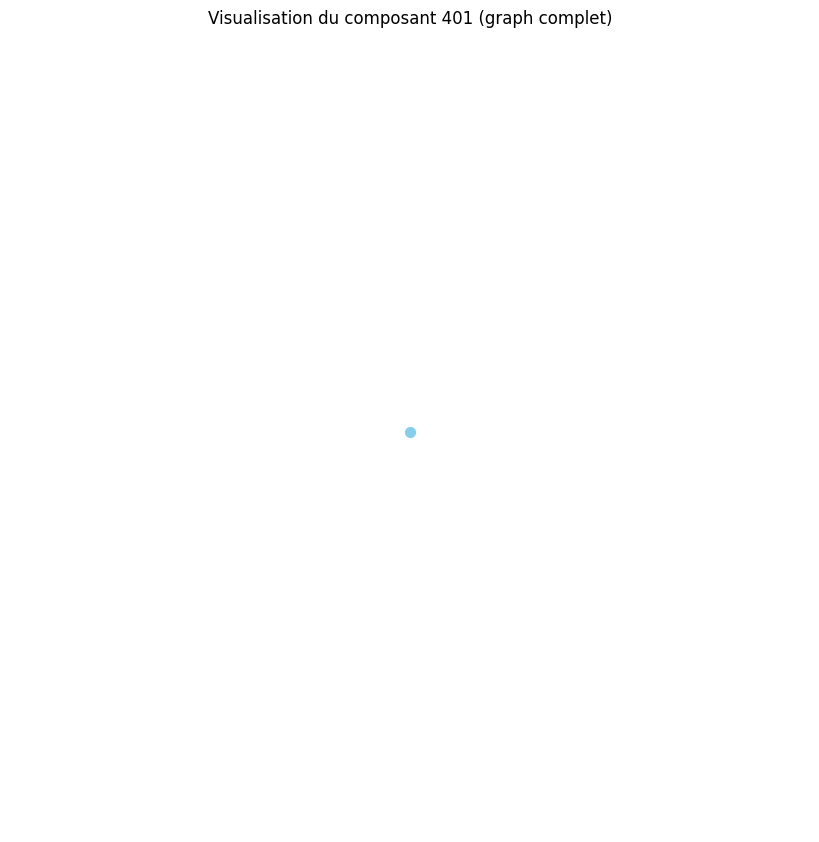

Distance moyenne pour le composant 402 : 0.00
Le composant 402 est un graphe complet ou très densément connecté.
Densité du composant 402 : 0.00
Degré moyen du composant 402 : 0.00
Coefficient de clustering moyen du composant 402 : 0.00


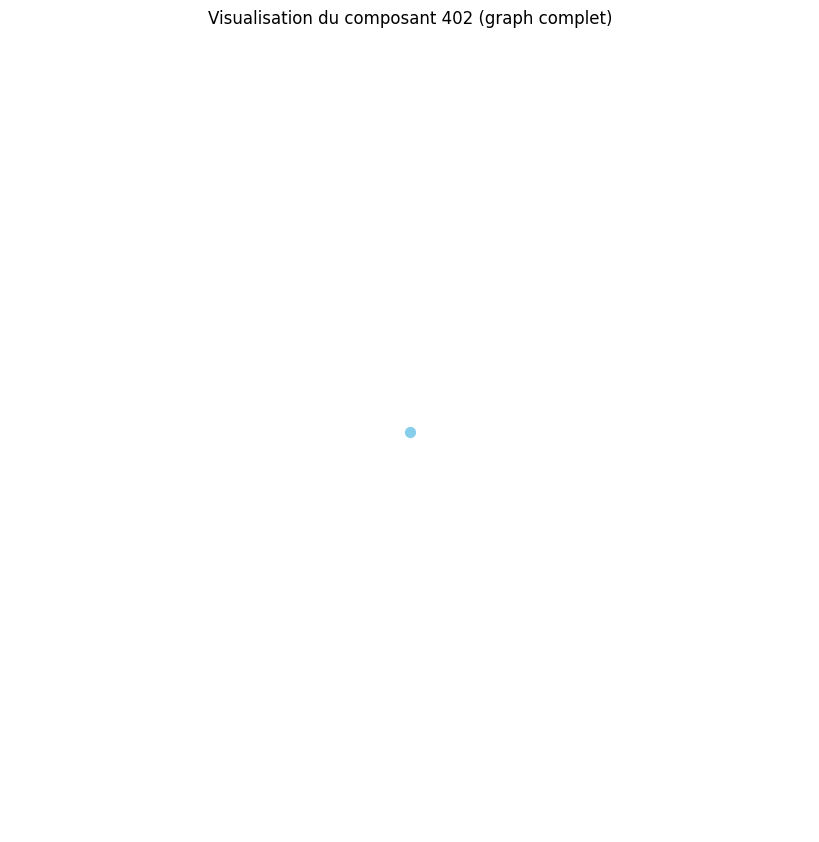

Distance moyenne pour le composant 403 : 0.00
Le composant 403 est un graphe complet ou très densément connecté.
Densité du composant 403 : 0.00
Degré moyen du composant 403 : 0.00
Coefficient de clustering moyen du composant 403 : 0.00


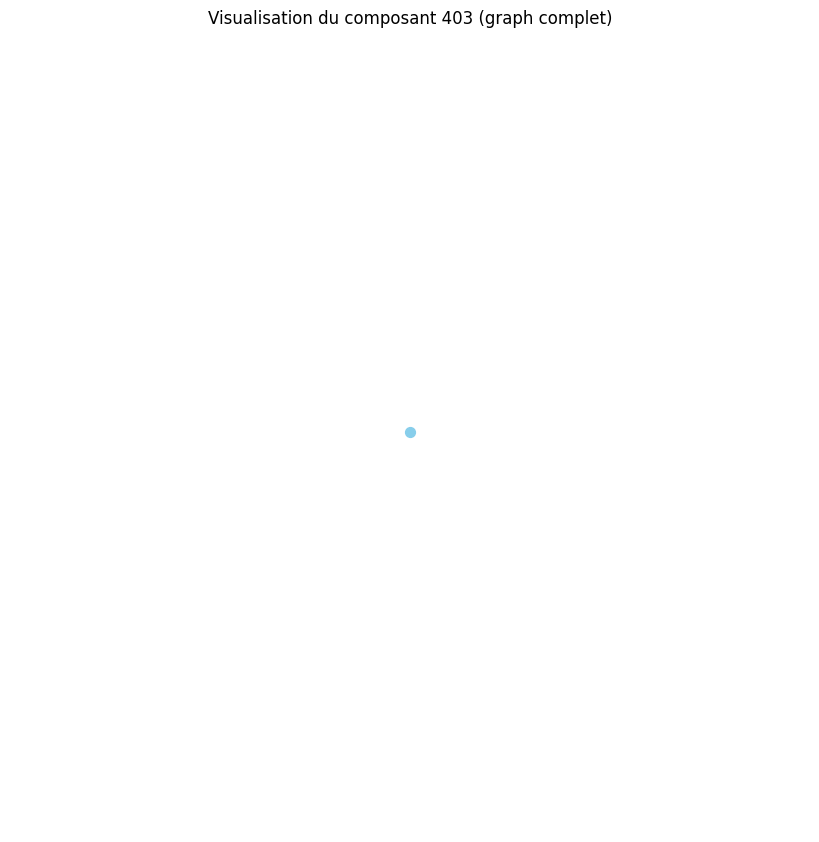

Distance moyenne pour le composant 404 : 0.00
Le composant 404 est un graphe complet ou très densément connecté.
Densité du composant 404 : 0.00
Degré moyen du composant 404 : 0.00
Coefficient de clustering moyen du composant 404 : 0.00


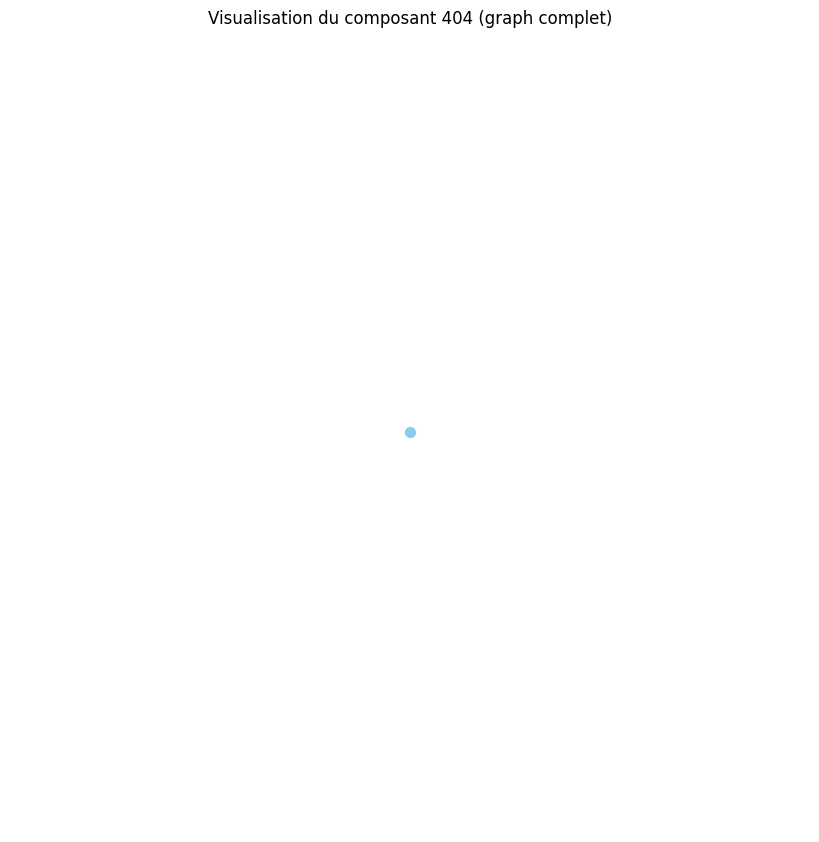

Distance moyenne pour le composant 405 : 0.00
Le composant 405 est un graphe complet ou très densément connecté.
Densité du composant 405 : 0.00
Degré moyen du composant 405 : 0.00
Coefficient de clustering moyen du composant 405 : 0.00


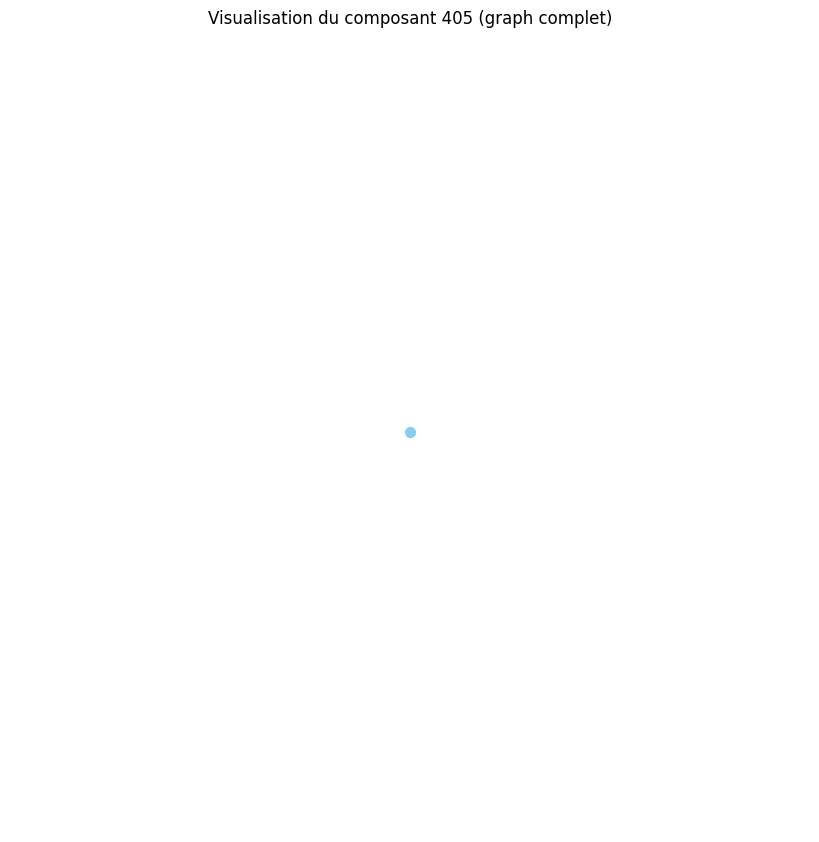

Distance moyenne pour le composant 406 : 0.00
Le composant 406 est un graphe complet ou très densément connecté.
Densité du composant 406 : 0.00
Degré moyen du composant 406 : 0.00
Coefficient de clustering moyen du composant 406 : 0.00


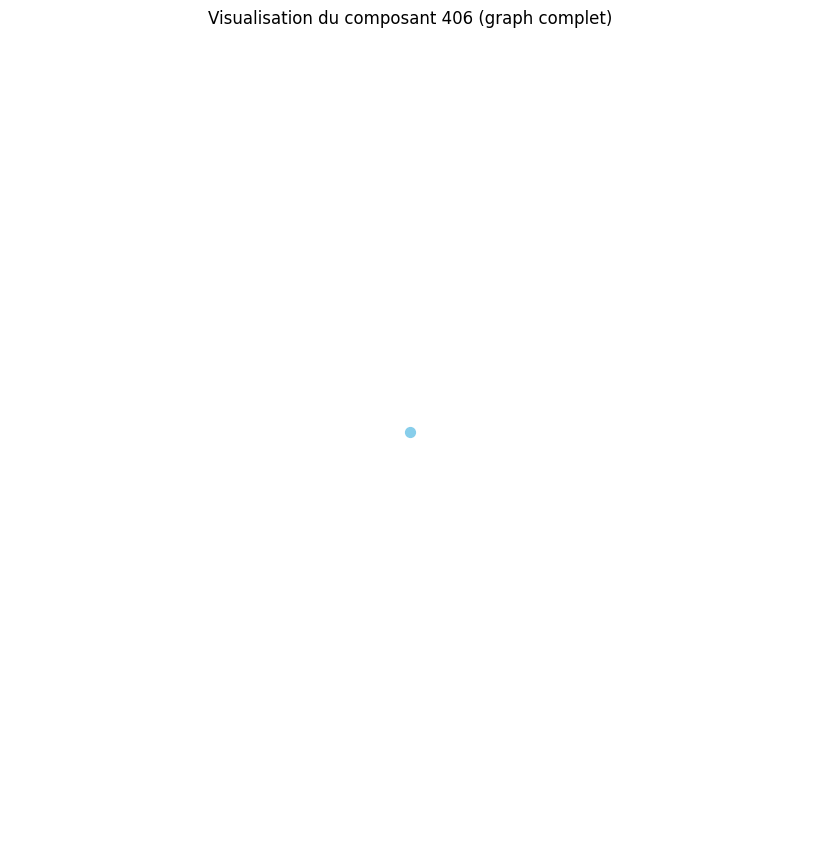

Distance moyenne pour le composant 407 : 0.00
Le composant 407 est un graphe complet ou très densément connecté.
Densité du composant 407 : 0.00
Degré moyen du composant 407 : 0.00
Coefficient de clustering moyen du composant 407 : 0.00


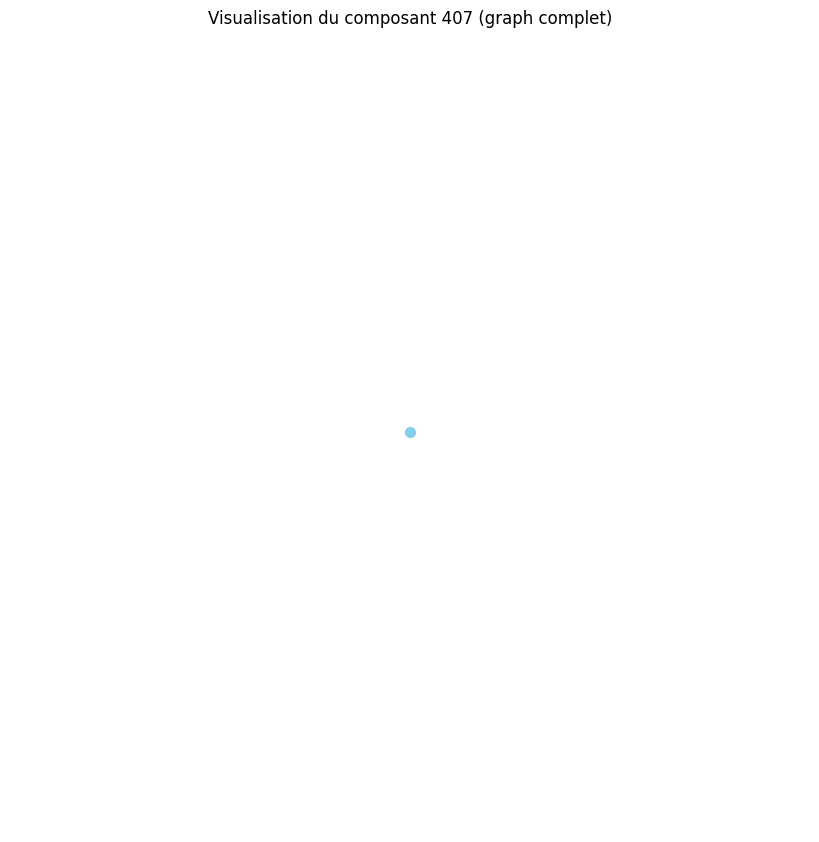

Distance moyenne pour le composant 408 : 0.00
Le composant 408 est un graphe complet ou très densément connecté.
Densité du composant 408 : 0.00
Degré moyen du composant 408 : 0.00
Coefficient de clustering moyen du composant 408 : 0.00


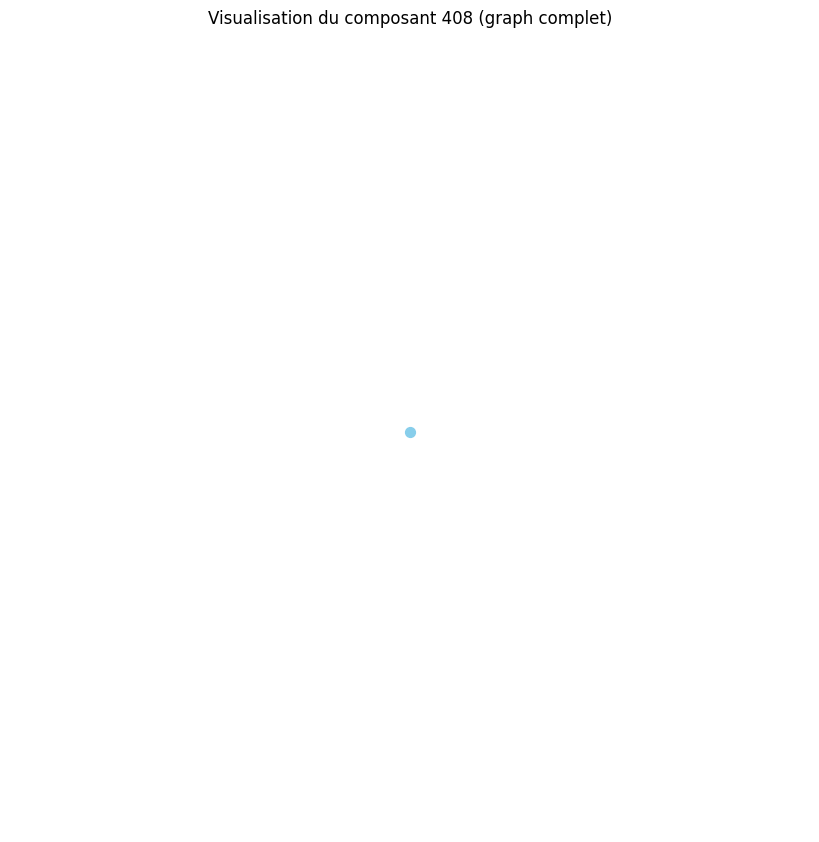

Distance moyenne pour le composant 409 : 0.00
Le composant 409 est un graphe complet ou très densément connecté.
Densité du composant 409 : 0.00
Degré moyen du composant 409 : 0.00
Coefficient de clustering moyen du composant 409 : 0.00


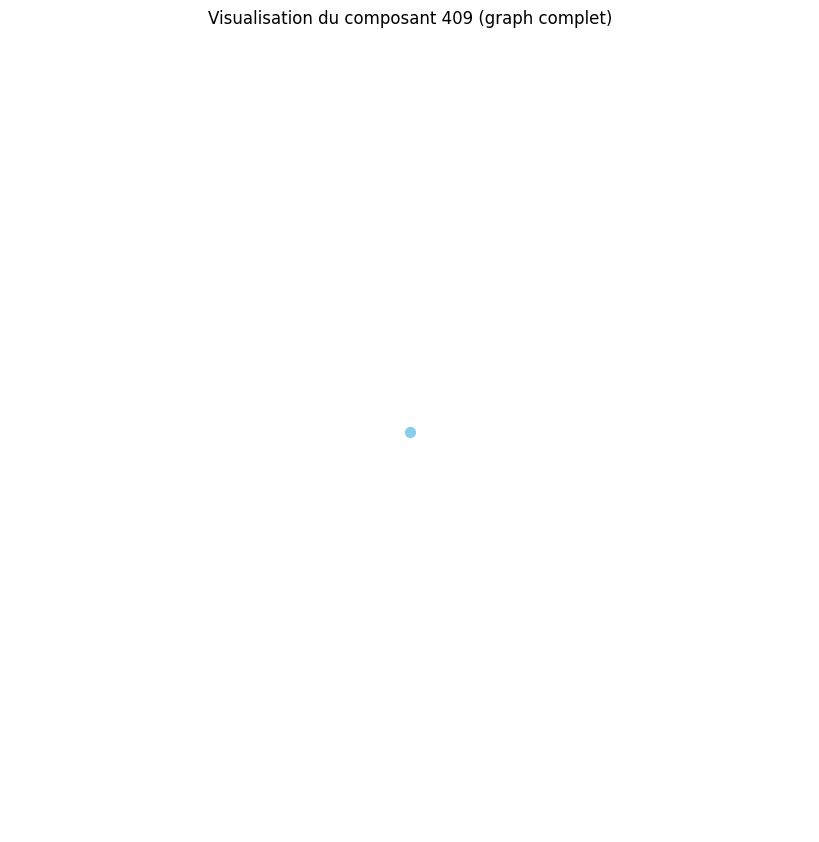

Distance moyenne pour le composant 410 : 1.67
Distance moyenne pour le composant 411 : 0.00
Le composant 411 est un graphe complet ou très densément connecté.
Densité du composant 411 : 0.00
Degré moyen du composant 411 : 0.00
Coefficient de clustering moyen du composant 411 : 0.00


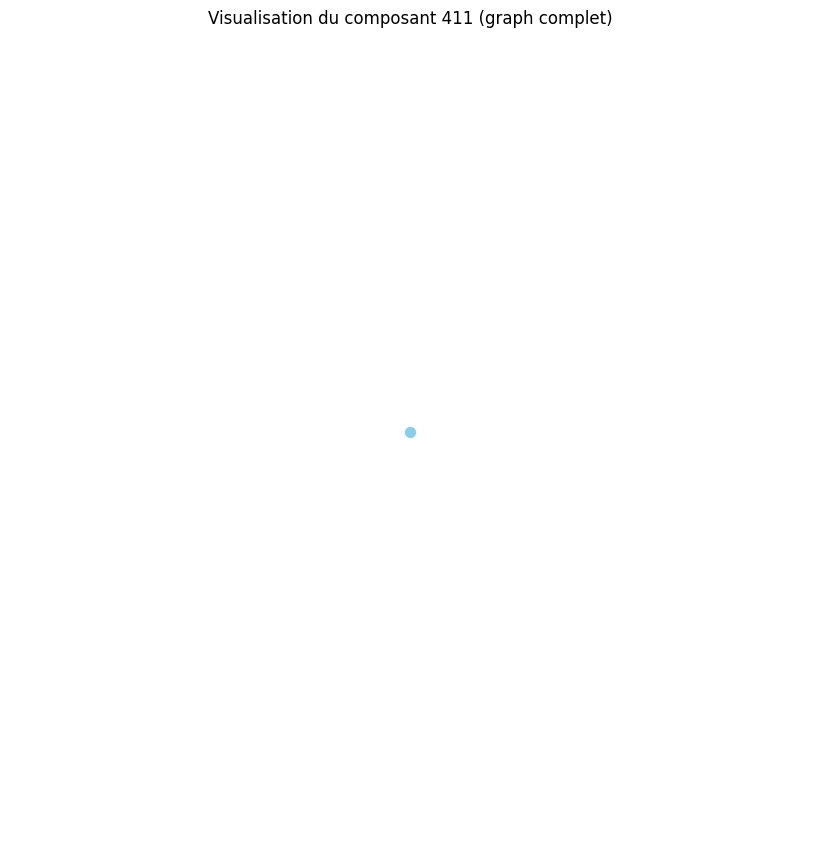

Distance moyenne pour le composant 412 : 0.00
Le composant 412 est un graphe complet ou très densément connecté.
Densité du composant 412 : 0.00
Degré moyen du composant 412 : 0.00
Coefficient de clustering moyen du composant 412 : 0.00


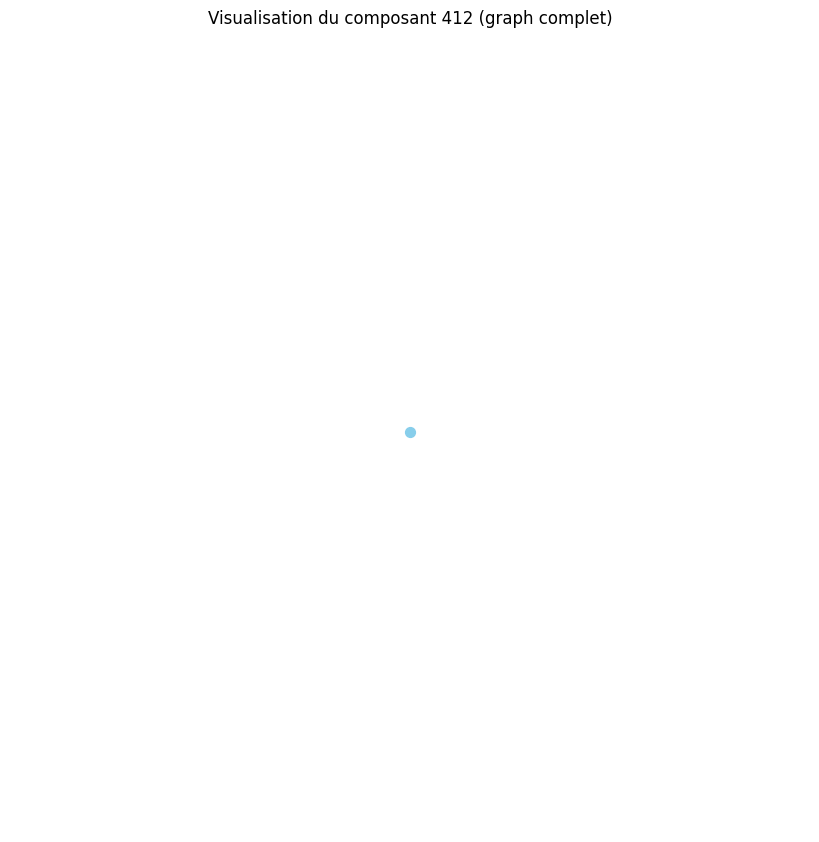

Distance moyenne pour le composant 413 : 0.00
Le composant 413 est un graphe complet ou très densément connecté.
Densité du composant 413 : 0.00
Degré moyen du composant 413 : 0.00
Coefficient de clustering moyen du composant 413 : 0.00


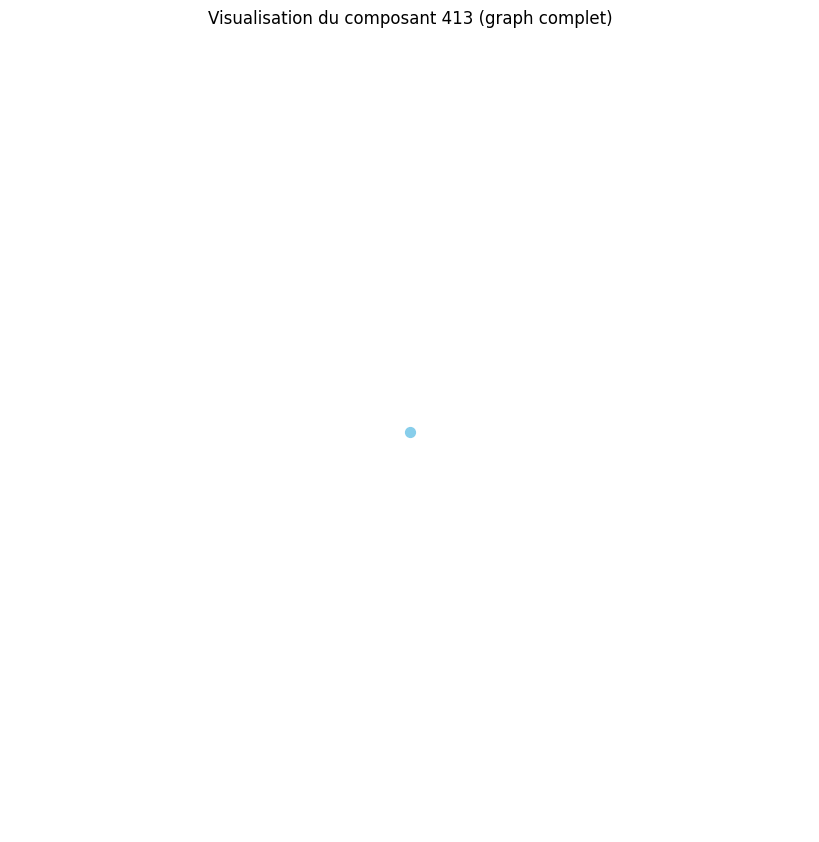

Distance moyenne pour le composant 414 : 0.00
Le composant 414 est un graphe complet ou très densément connecté.
Densité du composant 414 : 0.00
Degré moyen du composant 414 : 0.00
Coefficient de clustering moyen du composant 414 : 0.00


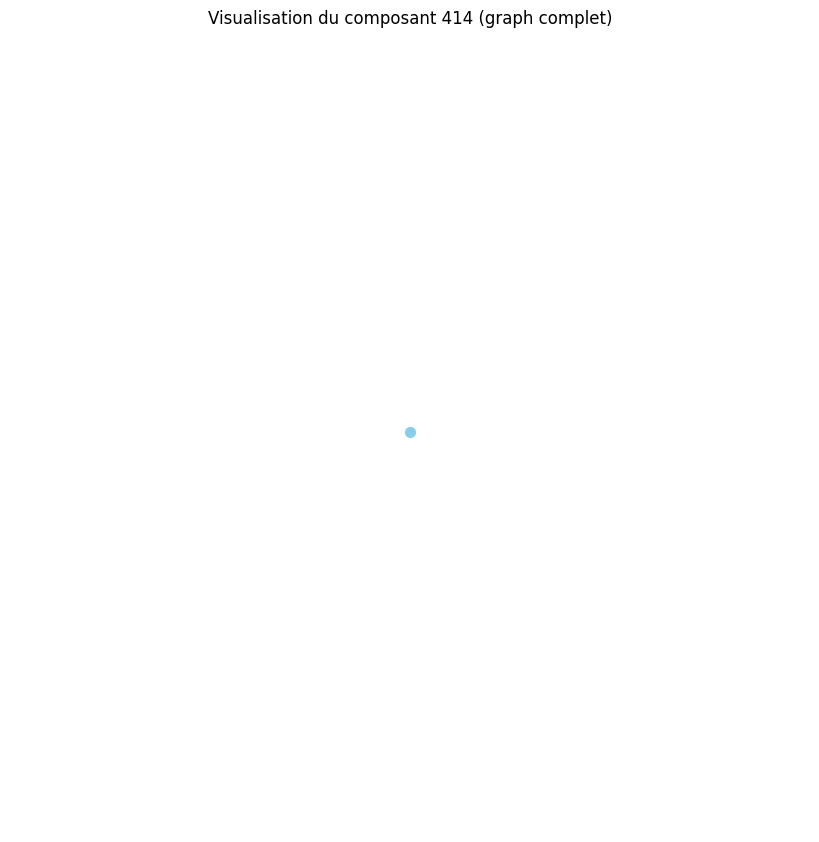

Distance moyenne pour le composant 415 : 0.00
Le composant 415 est un graphe complet ou très densément connecté.
Densité du composant 415 : 0.00
Degré moyen du composant 415 : 0.00
Coefficient de clustering moyen du composant 415 : 0.00


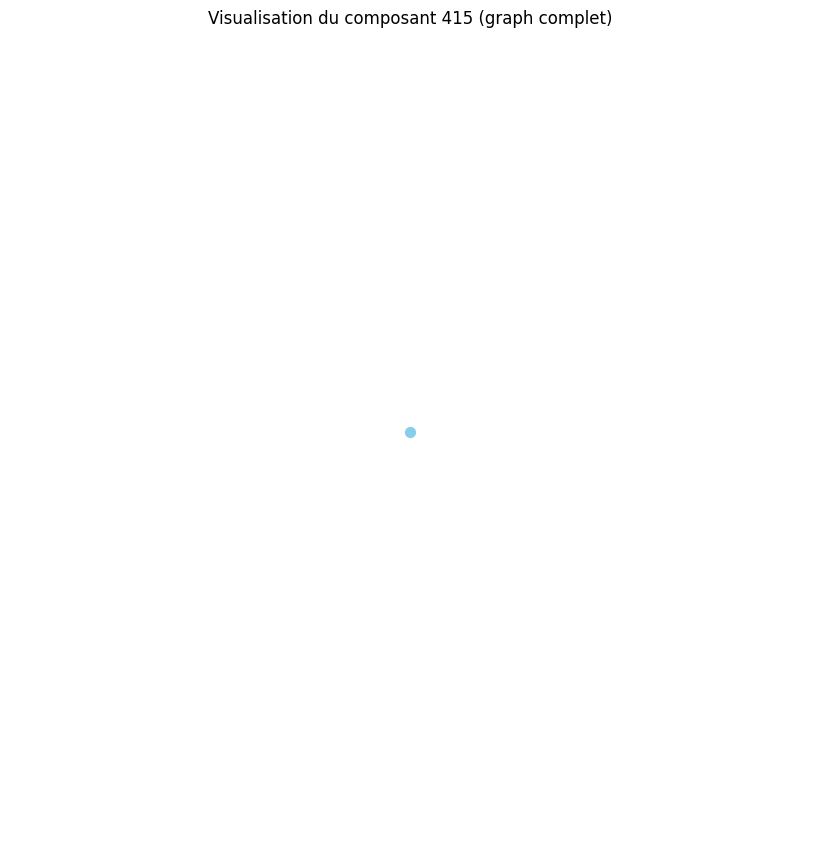

Distance moyenne pour le composant 416 : 0.00
Le composant 416 est un graphe complet ou très densément connecté.
Densité du composant 416 : 0.00
Degré moyen du composant 416 : 0.00
Coefficient de clustering moyen du composant 416 : 0.00


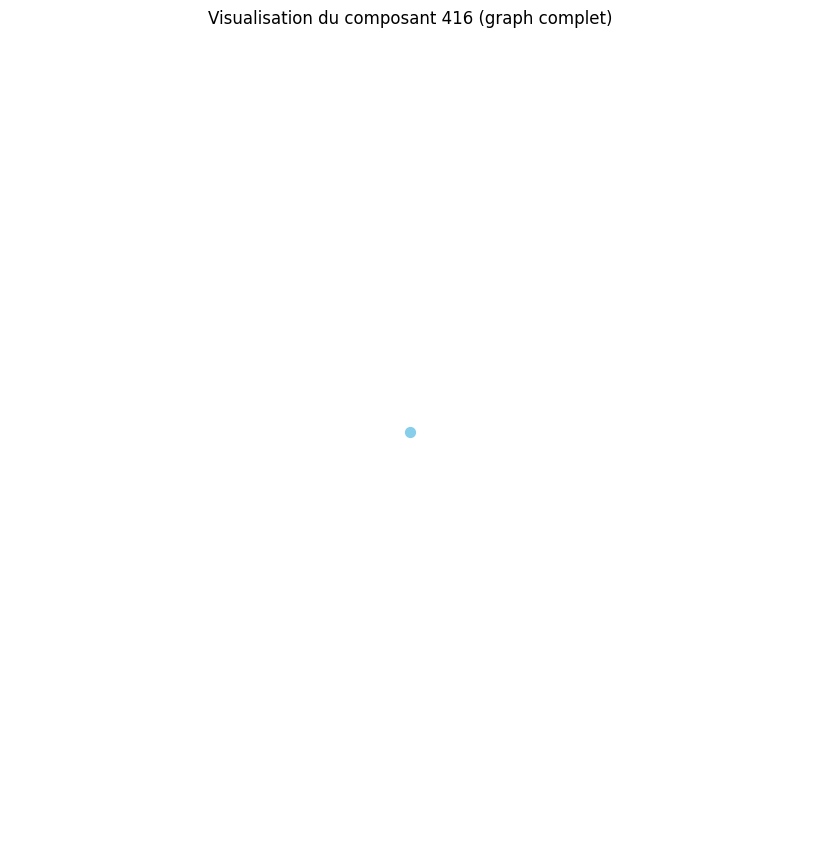

Distance moyenne pour le composant 417 : 0.00
Le composant 417 est un graphe complet ou très densément connecté.
Densité du composant 417 : 0.00
Degré moyen du composant 417 : 0.00
Coefficient de clustering moyen du composant 417 : 0.00


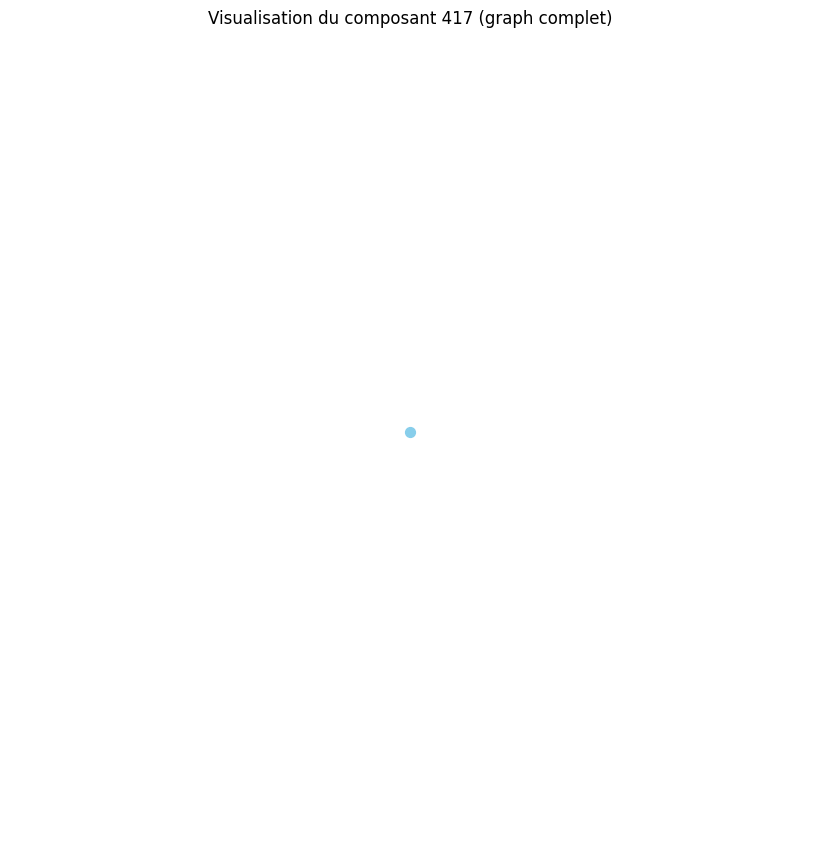

Distance moyenne pour le composant 418 : 0.00
Le composant 418 est un graphe complet ou très densément connecté.
Densité du composant 418 : 0.00
Degré moyen du composant 418 : 0.00
Coefficient de clustering moyen du composant 418 : 0.00


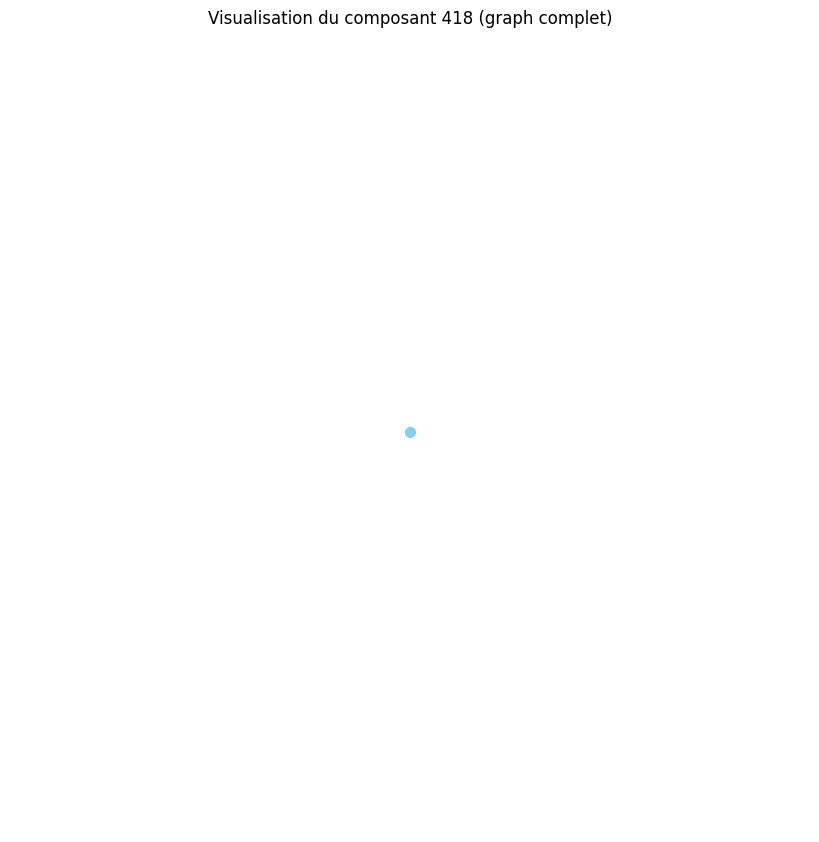

Distance moyenne pour le composant 419 : 0.00
Le composant 419 est un graphe complet ou très densément connecté.
Densité du composant 419 : 0.00
Degré moyen du composant 419 : 0.00
Coefficient de clustering moyen du composant 419 : 0.00


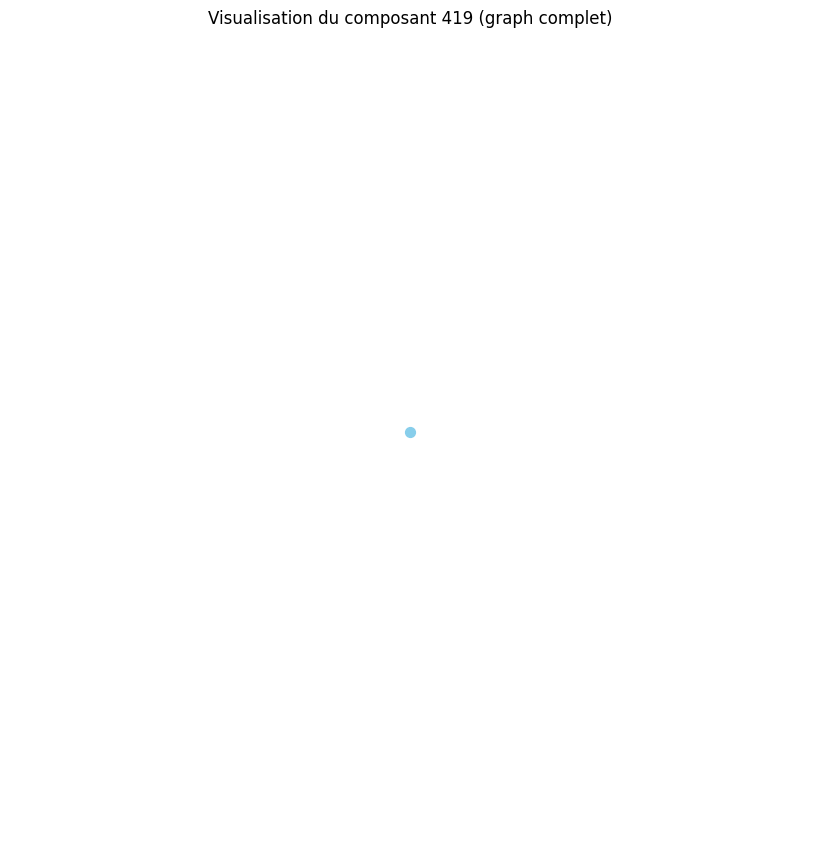

Distance moyenne pour le composant 420 : 0.00
Le composant 420 est un graphe complet ou très densément connecté.
Densité du composant 420 : 0.00
Degré moyen du composant 420 : 0.00
Coefficient de clustering moyen du composant 420 : 0.00


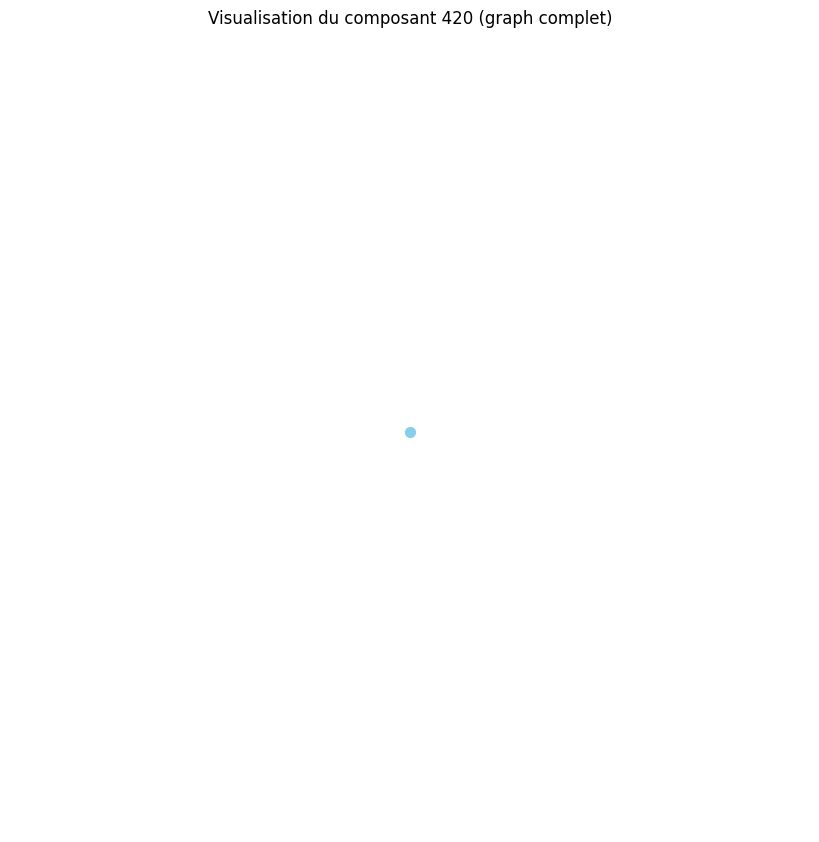

Distance moyenne pour le composant 421 : 0.00
Le composant 421 est un graphe complet ou très densément connecté.
Densité du composant 421 : 0.00
Degré moyen du composant 421 : 0.00
Coefficient de clustering moyen du composant 421 : 0.00


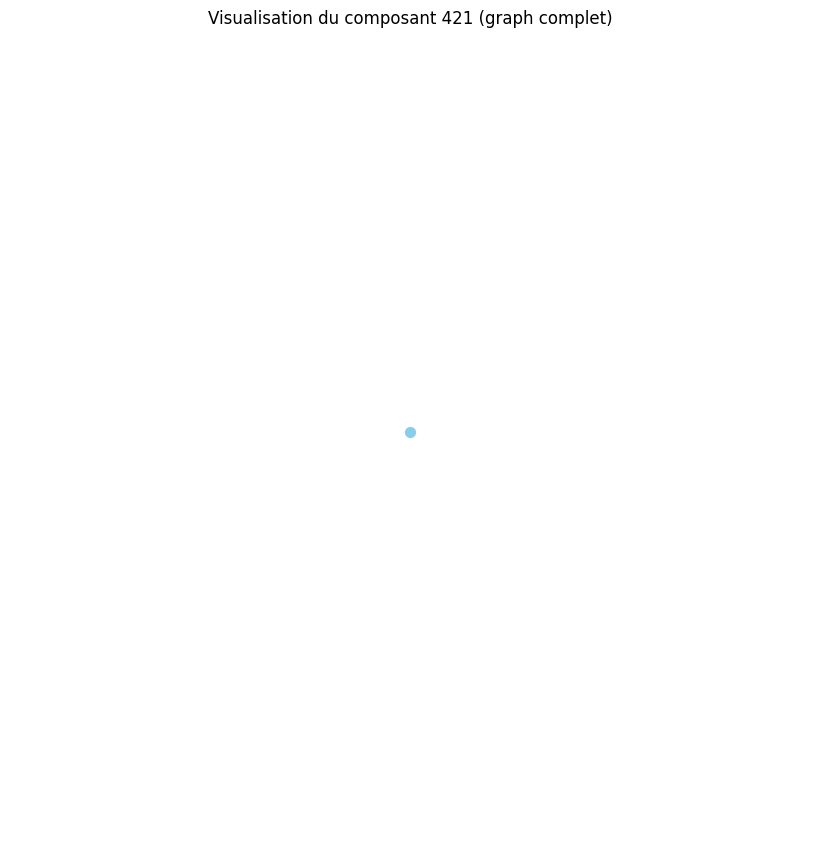

Distance moyenne pour le composant 422 : 0.00
Le composant 422 est un graphe complet ou très densément connecté.
Densité du composant 422 : 0.00
Degré moyen du composant 422 : 0.00
Coefficient de clustering moyen du composant 422 : 0.00


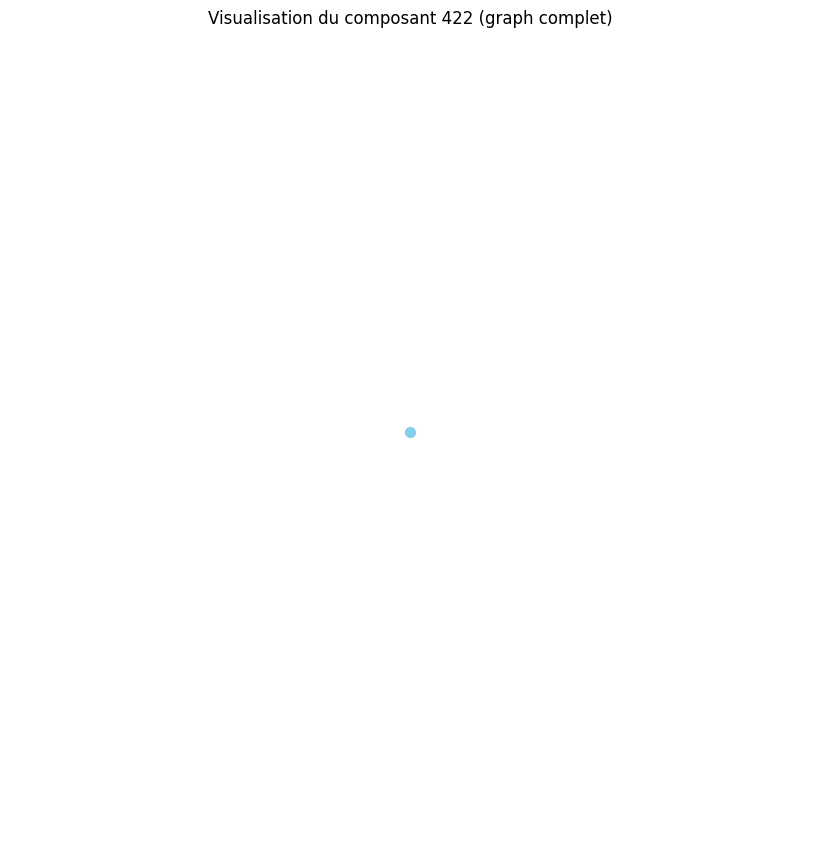

Distance moyenne pour le composant 423 : 0.00
Le composant 423 est un graphe complet ou très densément connecté.
Densité du composant 423 : 0.00
Degré moyen du composant 423 : 0.00
Coefficient de clustering moyen du composant 423 : 0.00


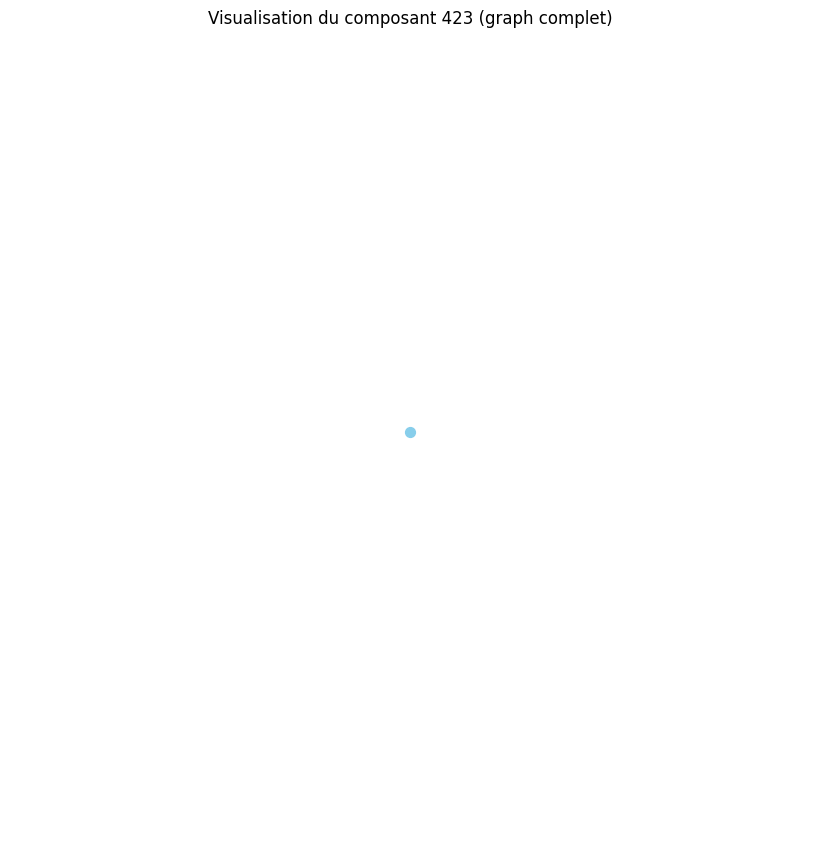

Distance moyenne pour le composant 424 : 0.00
Le composant 424 est un graphe complet ou très densément connecté.
Densité du composant 424 : 0.00
Degré moyen du composant 424 : 0.00
Coefficient de clustering moyen du composant 424 : 0.00


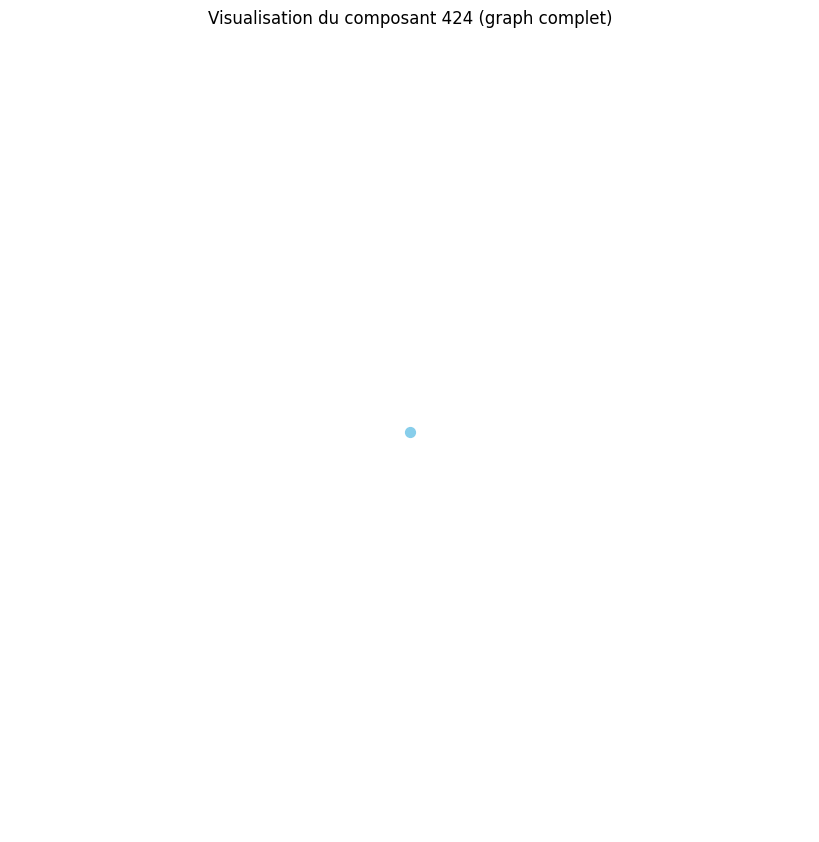

Distance moyenne pour le composant 425 : 0.00
Le composant 425 est un graphe complet ou très densément connecté.
Densité du composant 425 : 0.00
Degré moyen du composant 425 : 0.00
Coefficient de clustering moyen du composant 425 : 0.00


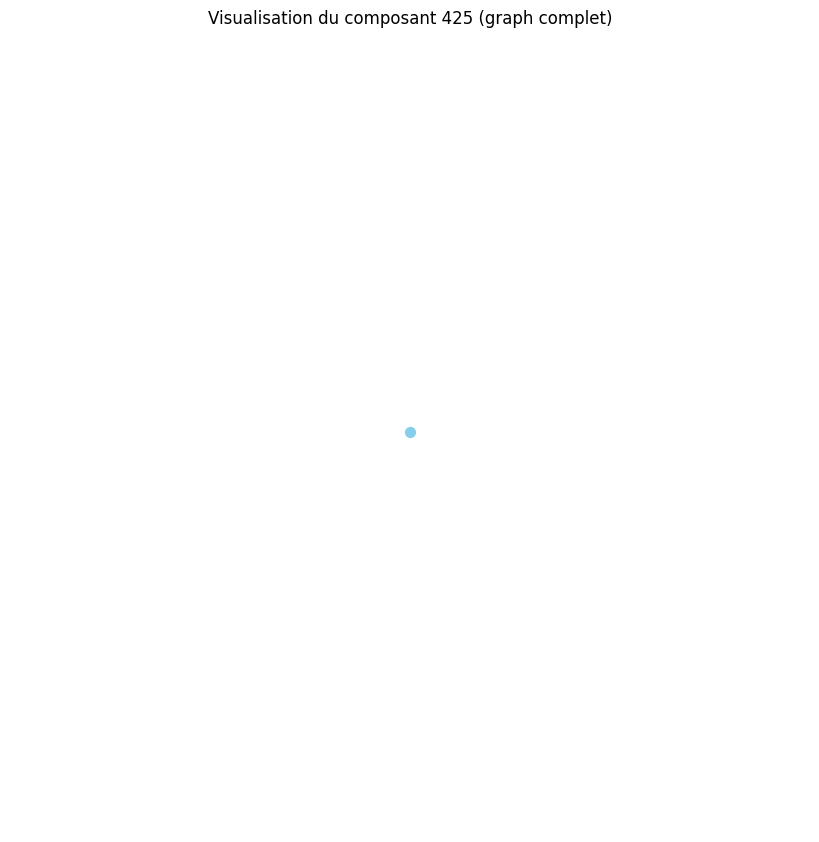

Distance moyenne pour le composant 426 : 0.00
Le composant 426 est un graphe complet ou très densément connecté.
Densité du composant 426 : 0.00
Degré moyen du composant 426 : 0.00
Coefficient de clustering moyen du composant 426 : 0.00


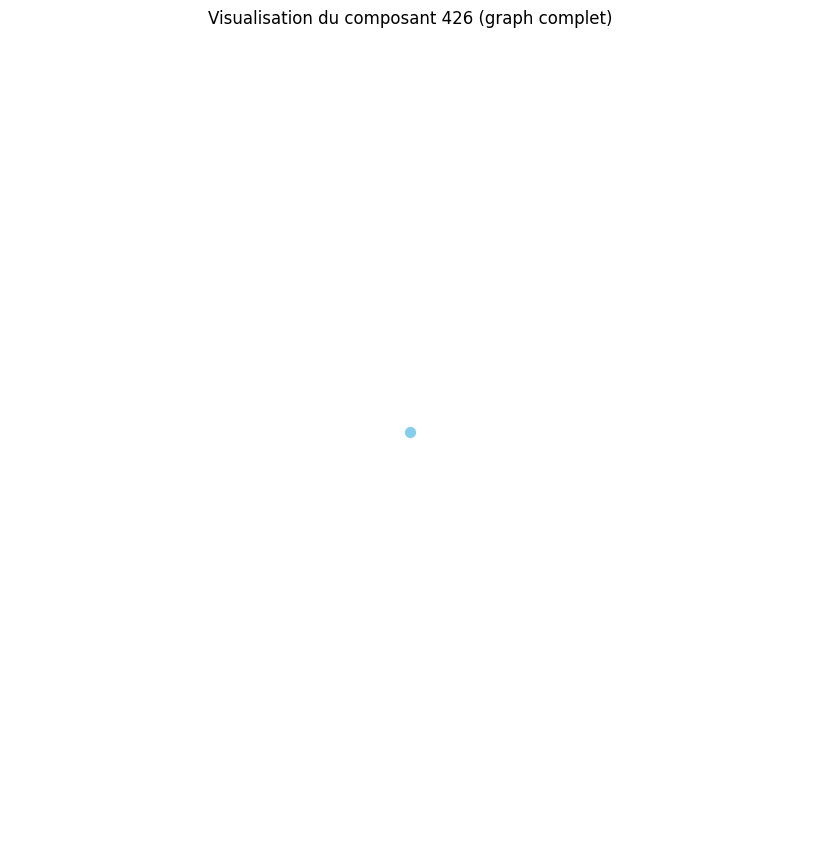

Distance moyenne pour le composant 427 : 0.00
Le composant 427 est un graphe complet ou très densément connecté.
Densité du composant 427 : 0.00
Degré moyen du composant 427 : 0.00
Coefficient de clustering moyen du composant 427 : 0.00


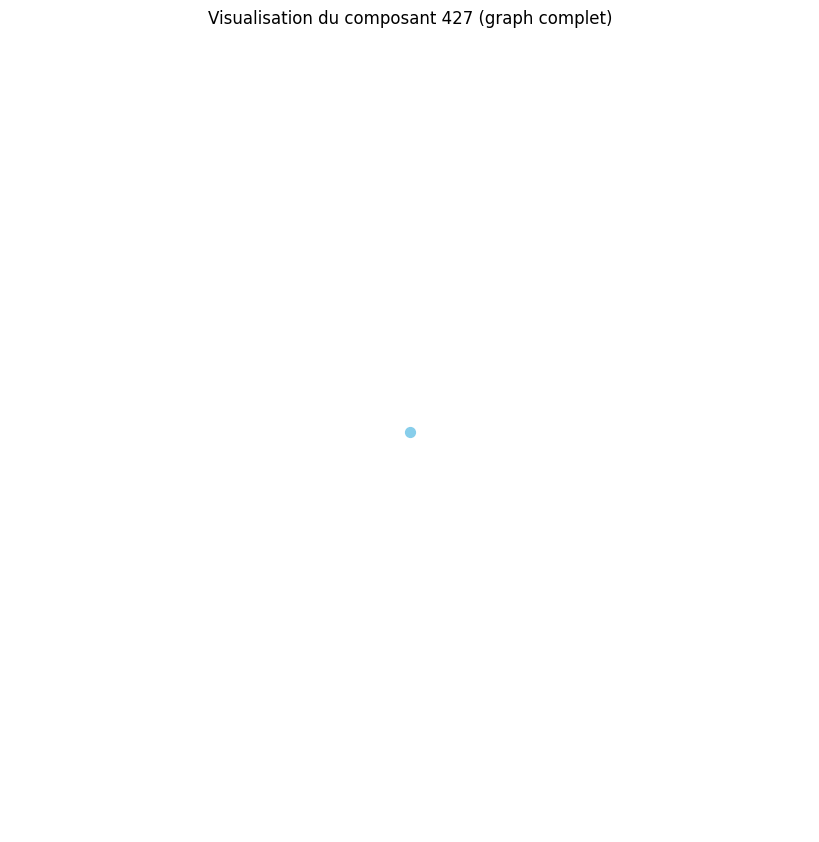

Distance moyenne pour le composant 428 : 0.00
Le composant 428 est un graphe complet ou très densément connecté.
Densité du composant 428 : 0.00
Degré moyen du composant 428 : 0.00
Coefficient de clustering moyen du composant 428 : 0.00


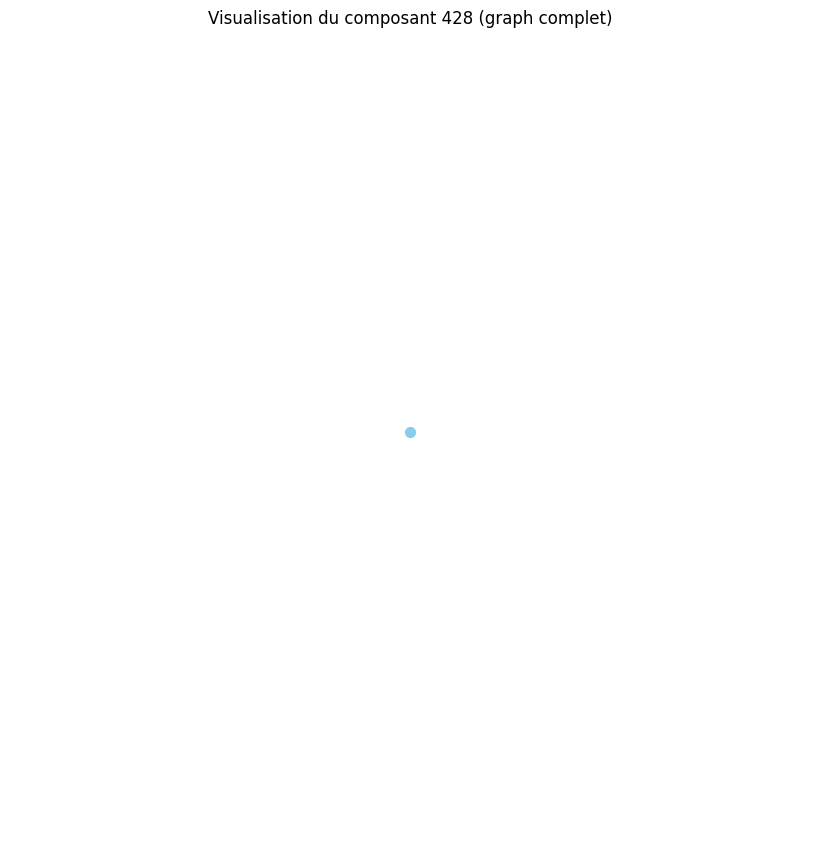

Distance moyenne pour le composant 429 : 0.00
Le composant 429 est un graphe complet ou très densément connecté.
Densité du composant 429 : 0.00
Degré moyen du composant 429 : 0.00
Coefficient de clustering moyen du composant 429 : 0.00


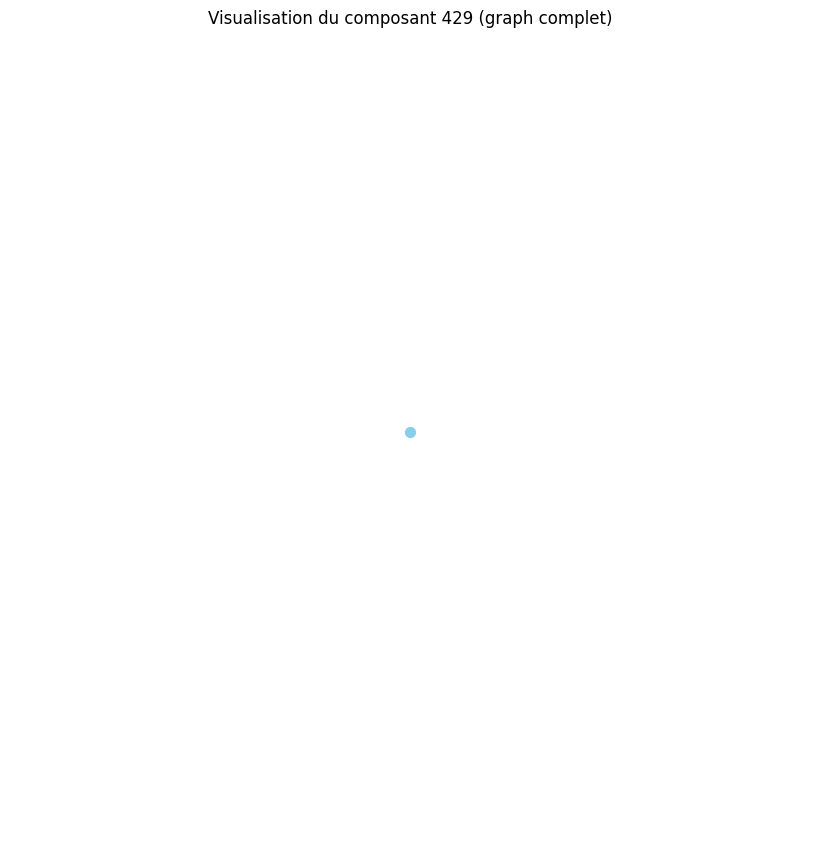

Distance moyenne pour le composant 430 : 0.00
Le composant 430 est un graphe complet ou très densément connecté.
Densité du composant 430 : 0.00
Degré moyen du composant 430 : 0.00
Coefficient de clustering moyen du composant 430 : 0.00


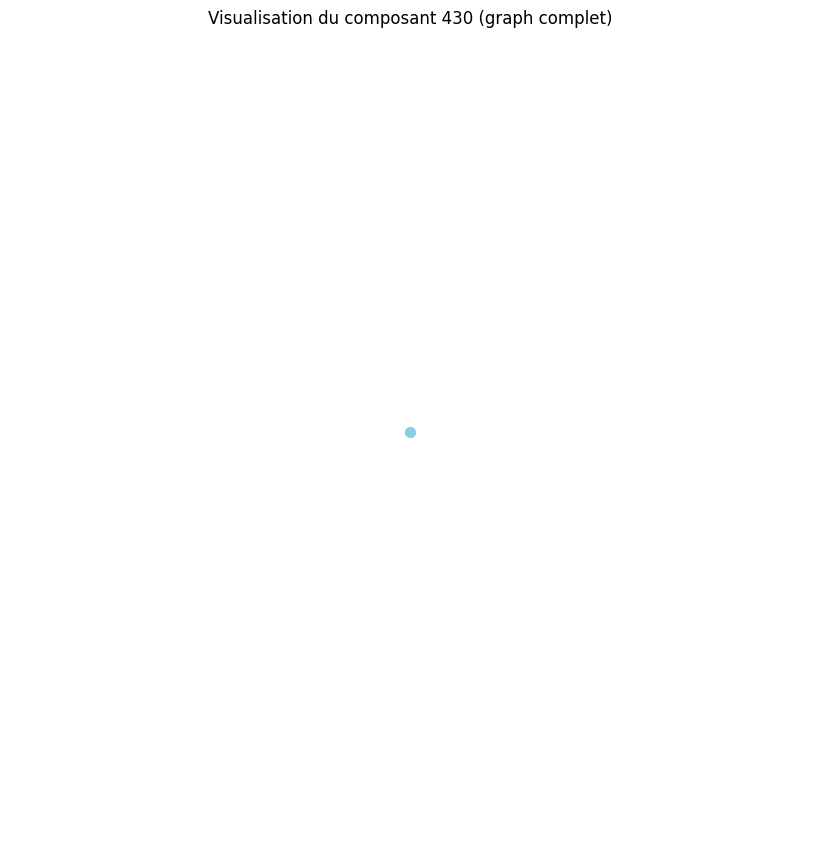

Distance moyenne pour le composant 431 : 0.00
Le composant 431 est un graphe complet ou très densément connecté.
Densité du composant 431 : 0.00
Degré moyen du composant 431 : 0.00
Coefficient de clustering moyen du composant 431 : 0.00


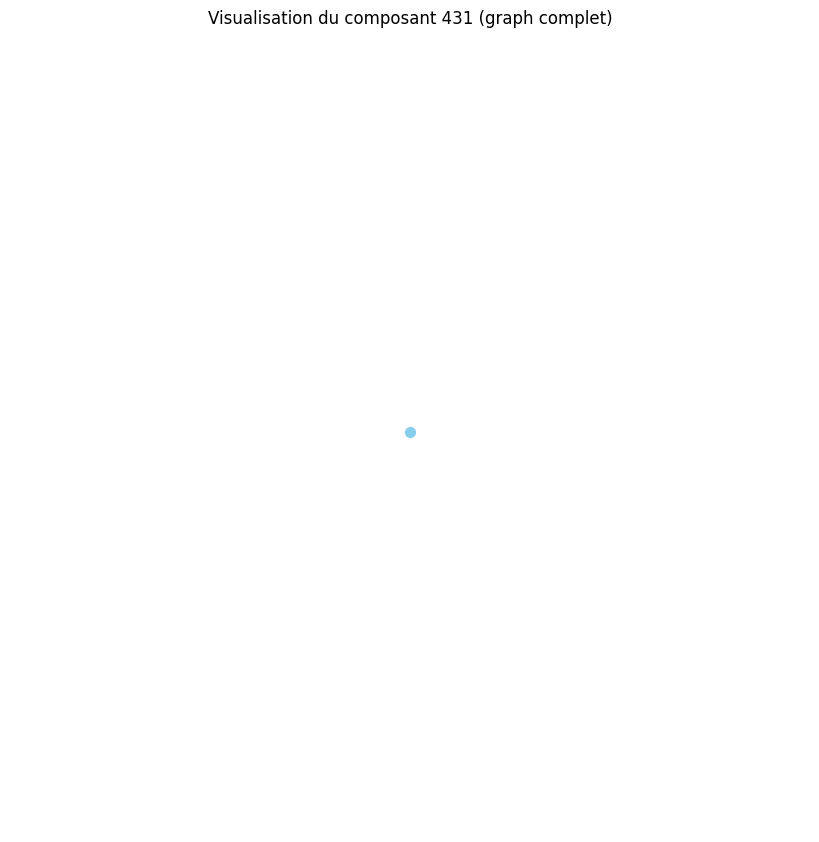

Distance moyenne pour le composant 432 : 0.00
Le composant 432 est un graphe complet ou très densément connecté.
Densité du composant 432 : 0.00
Degré moyen du composant 432 : 0.00
Coefficient de clustering moyen du composant 432 : 0.00


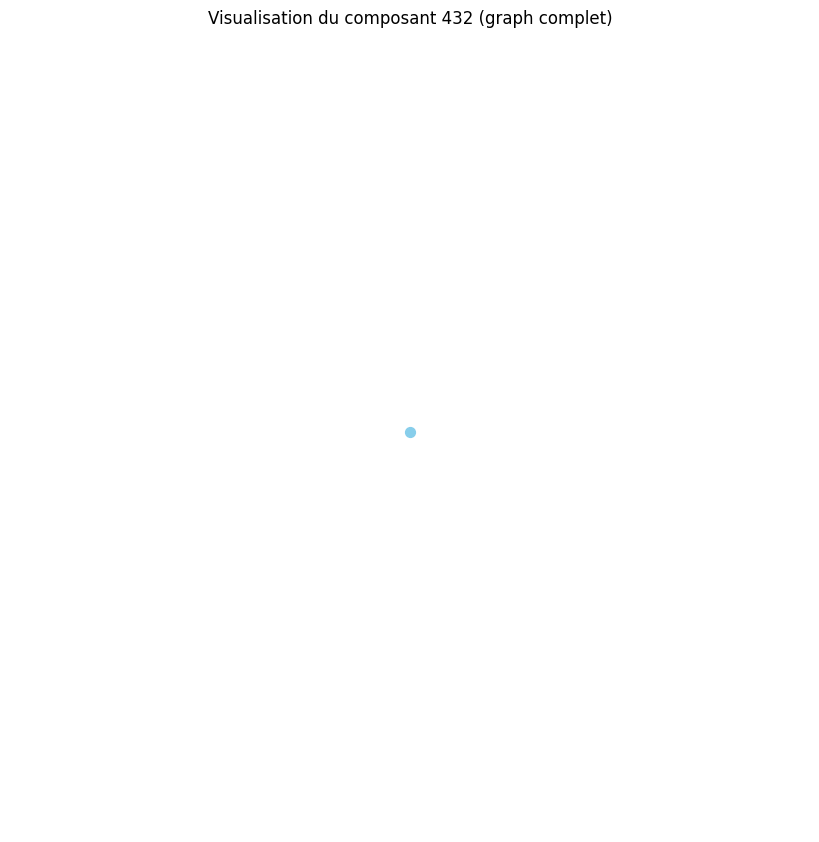

Distance moyenne pour le composant 433 : 0.00
Le composant 433 est un graphe complet ou très densément connecté.
Densité du composant 433 : 0.00
Degré moyen du composant 433 : 0.00
Coefficient de clustering moyen du composant 433 : 0.00


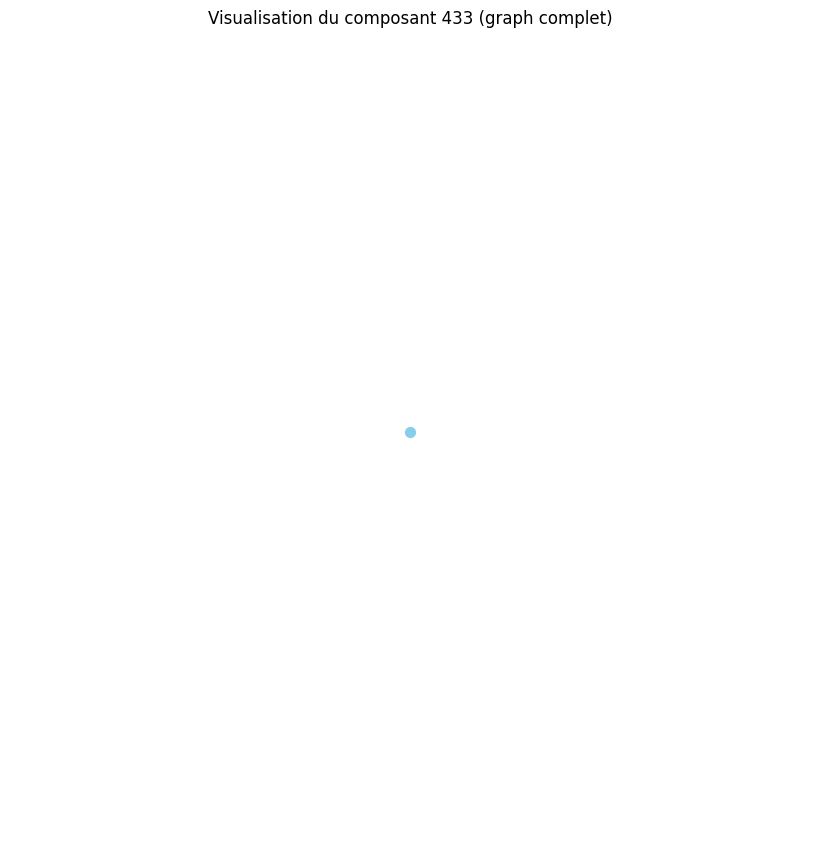

Distance moyenne pour le composant 434 : 0.00
Le composant 434 est un graphe complet ou très densément connecté.
Densité du composant 434 : 0.00
Degré moyen du composant 434 : 0.00
Coefficient de clustering moyen du composant 434 : 0.00


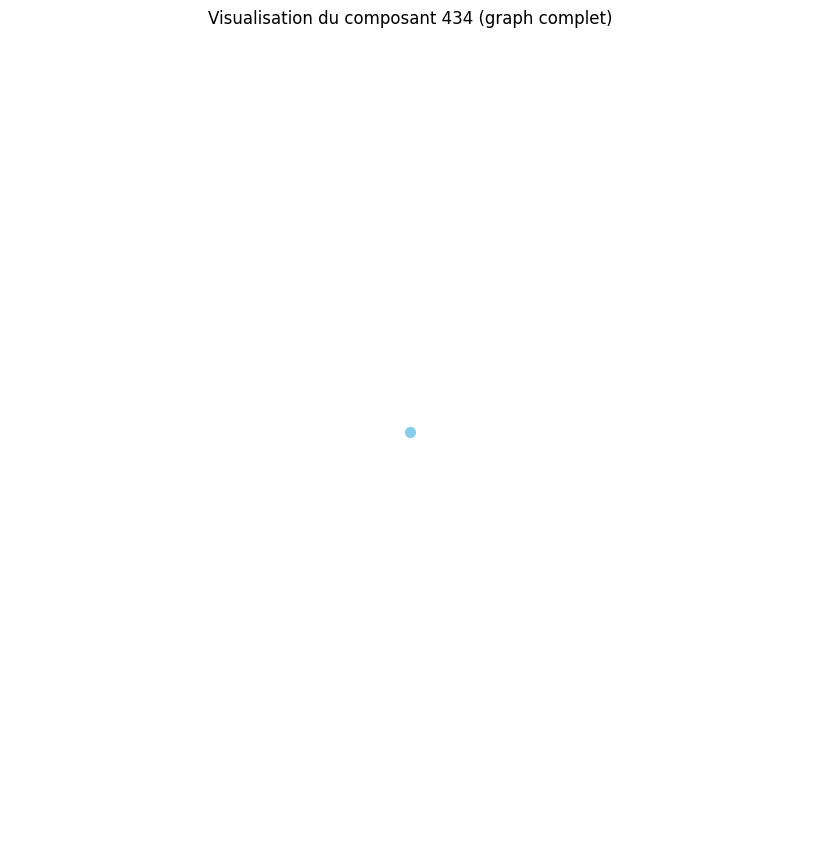

Distance moyenne pour le composant 435 : 0.00
Le composant 435 est un graphe complet ou très densément connecté.
Densité du composant 435 : 0.00
Degré moyen du composant 435 : 0.00
Coefficient de clustering moyen du composant 435 : 0.00


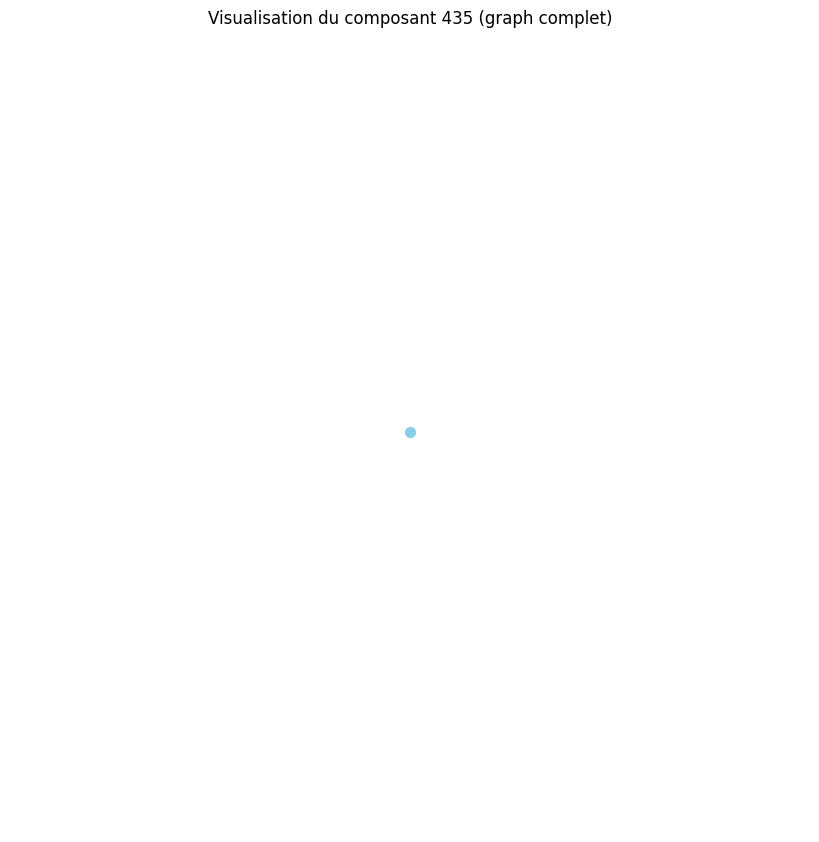

Distance moyenne pour le composant 436 : 0.00
Le composant 436 est un graphe complet ou très densément connecté.
Densité du composant 436 : 0.00
Degré moyen du composant 436 : 0.00
Coefficient de clustering moyen du composant 436 : 0.00


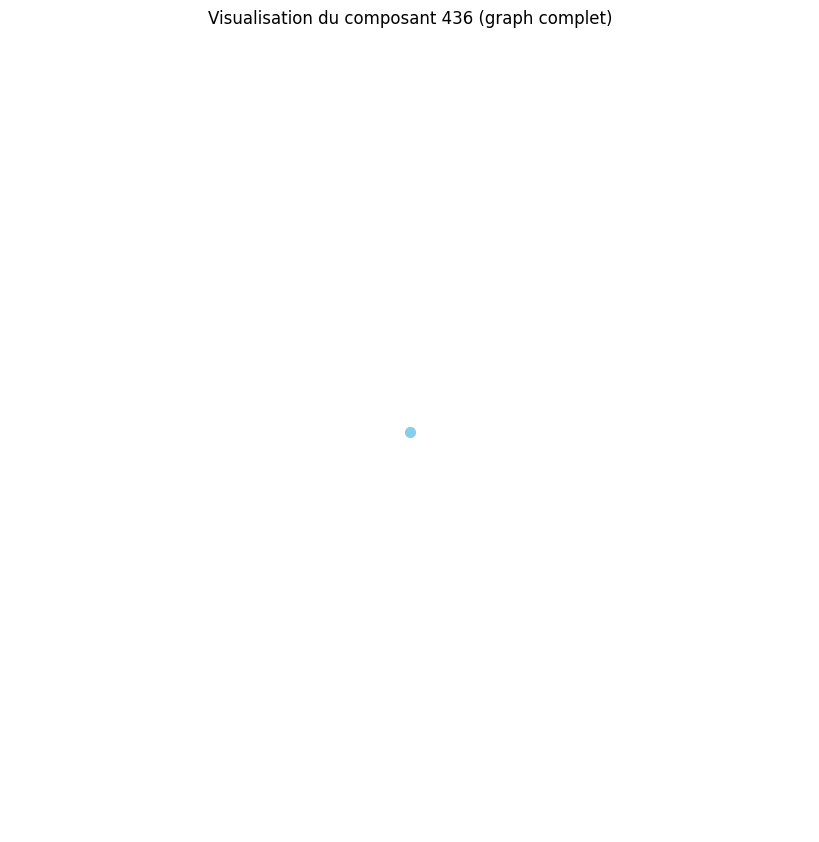

Distance moyenne pour le composant 437 : 0.00
Le composant 437 est un graphe complet ou très densément connecté.
Densité du composant 437 : 0.00
Degré moyen du composant 437 : 0.00
Coefficient de clustering moyen du composant 437 : 0.00


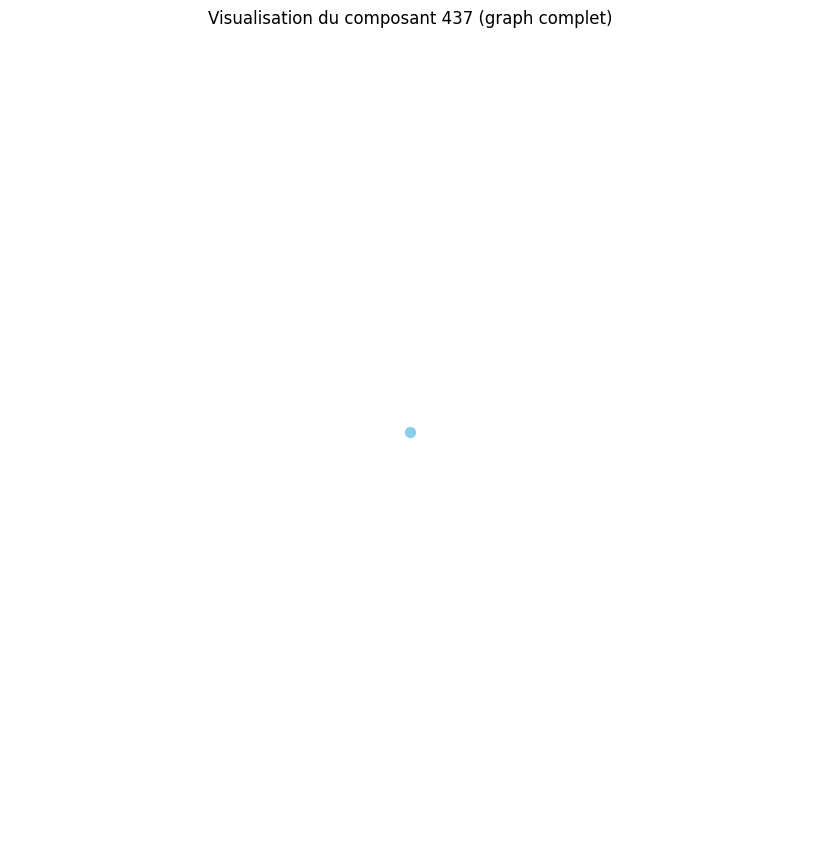

Distance moyenne pour le composant 438 : 0.00
Le composant 438 est un graphe complet ou très densément connecté.
Densité du composant 438 : 0.00
Degré moyen du composant 438 : 0.00
Coefficient de clustering moyen du composant 438 : 0.00


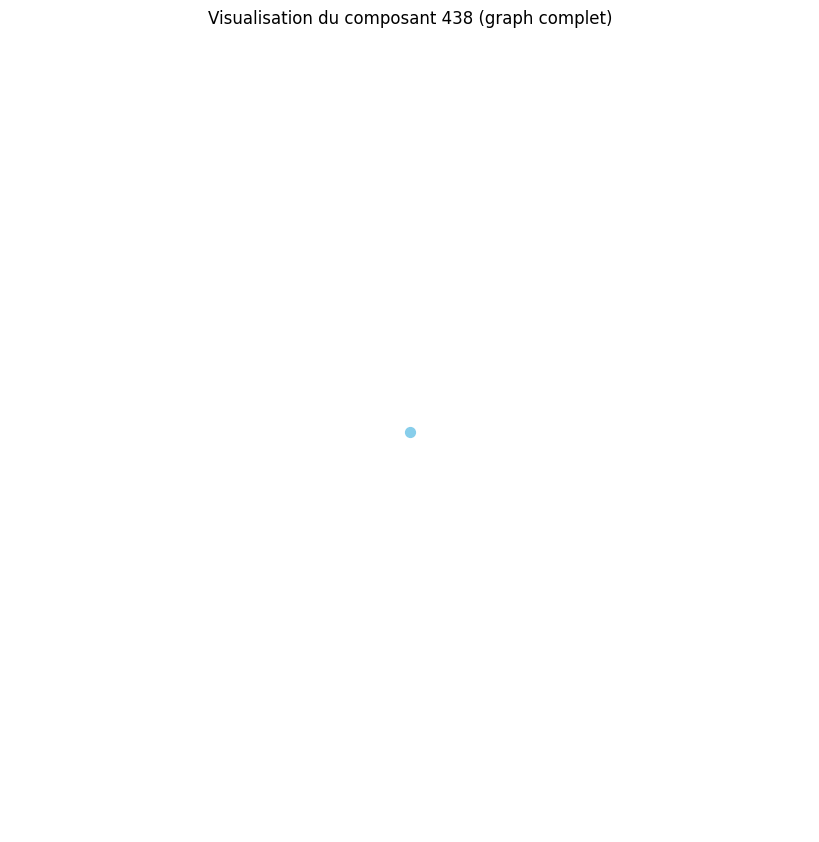

Distance moyenne pour le composant 439 : 0.00
Le composant 439 est un graphe complet ou très densément connecté.
Densité du composant 439 : 0.00
Degré moyen du composant 439 : 0.00
Coefficient de clustering moyen du composant 439 : 0.00


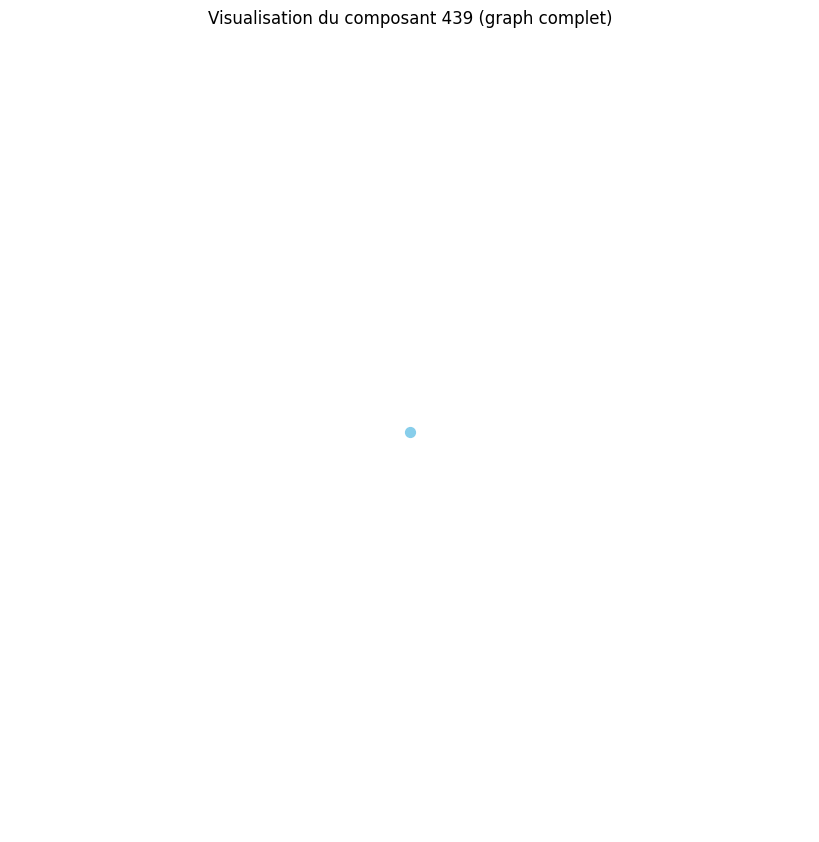

Distance moyenne pour le composant 440 : 0.00
Le composant 440 est un graphe complet ou très densément connecté.
Densité du composant 440 : 0.00
Degré moyen du composant 440 : 0.00
Coefficient de clustering moyen du composant 440 : 0.00


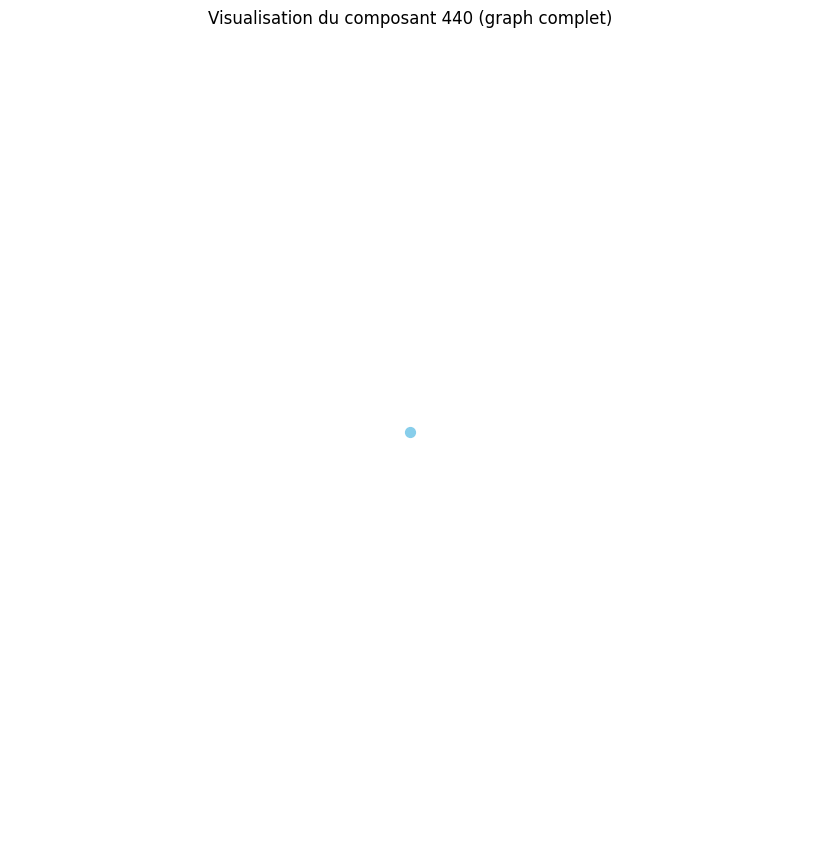

Distance moyenne pour le composant 441 : 0.00
Le composant 441 est un graphe complet ou très densément connecté.
Densité du composant 441 : 0.00
Degré moyen du composant 441 : 0.00
Coefficient de clustering moyen du composant 441 : 0.00


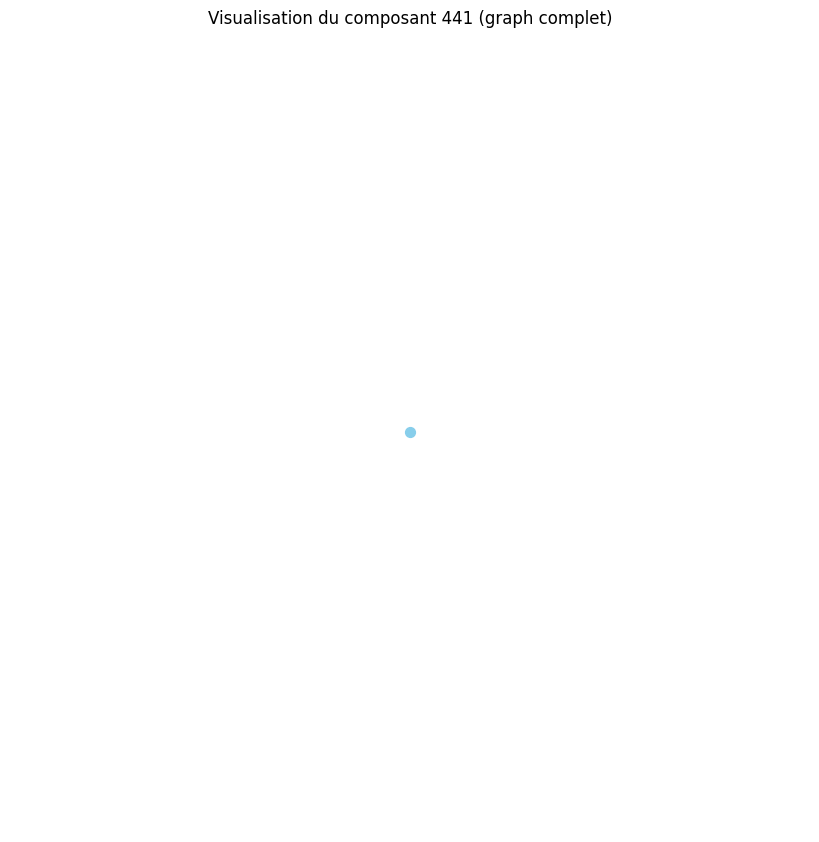

Distance moyenne pour le composant 442 : 0.00
Le composant 442 est un graphe complet ou très densément connecté.
Densité du composant 442 : 0.00
Degré moyen du composant 442 : 0.00
Coefficient de clustering moyen du composant 442 : 0.00


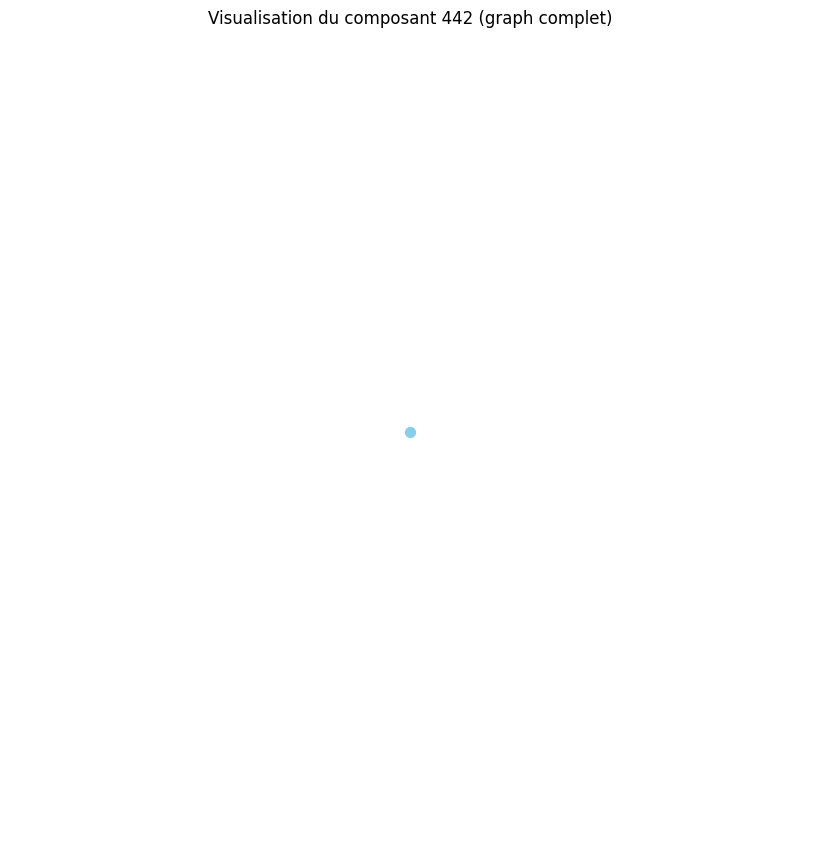

Distance moyenne pour le composant 443 : 0.00
Le composant 443 est un graphe complet ou très densément connecté.
Densité du composant 443 : 0.00
Degré moyen du composant 443 : 0.00
Coefficient de clustering moyen du composant 443 : 0.00


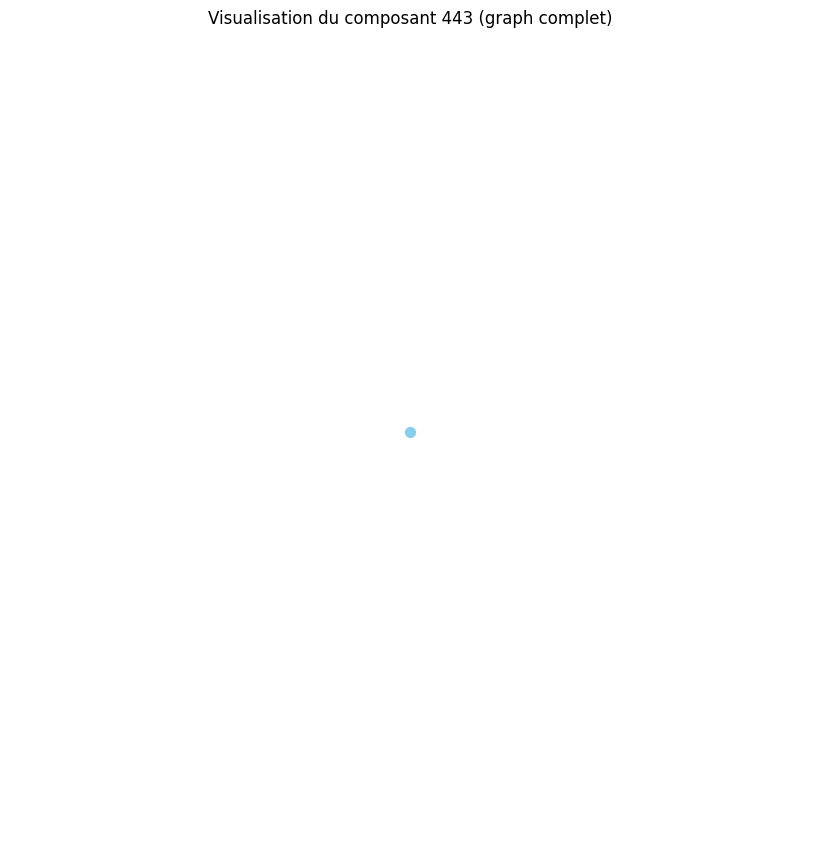

Distance moyenne pour le composant 444 : 0.00
Le composant 444 est un graphe complet ou très densément connecté.
Densité du composant 444 : 0.00
Degré moyen du composant 444 : 0.00
Coefficient de clustering moyen du composant 444 : 0.00


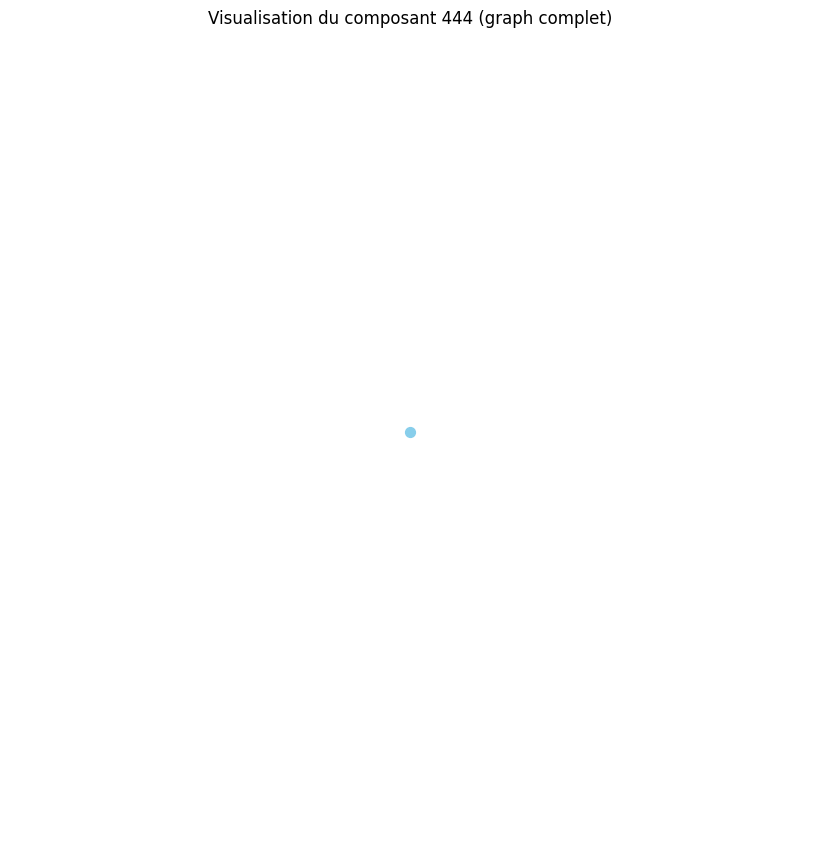

Distance moyenne pour le composant 445 : 0.00
Le composant 445 est un graphe complet ou très densément connecté.
Densité du composant 445 : 0.00
Degré moyen du composant 445 : 0.00
Coefficient de clustering moyen du composant 445 : 0.00


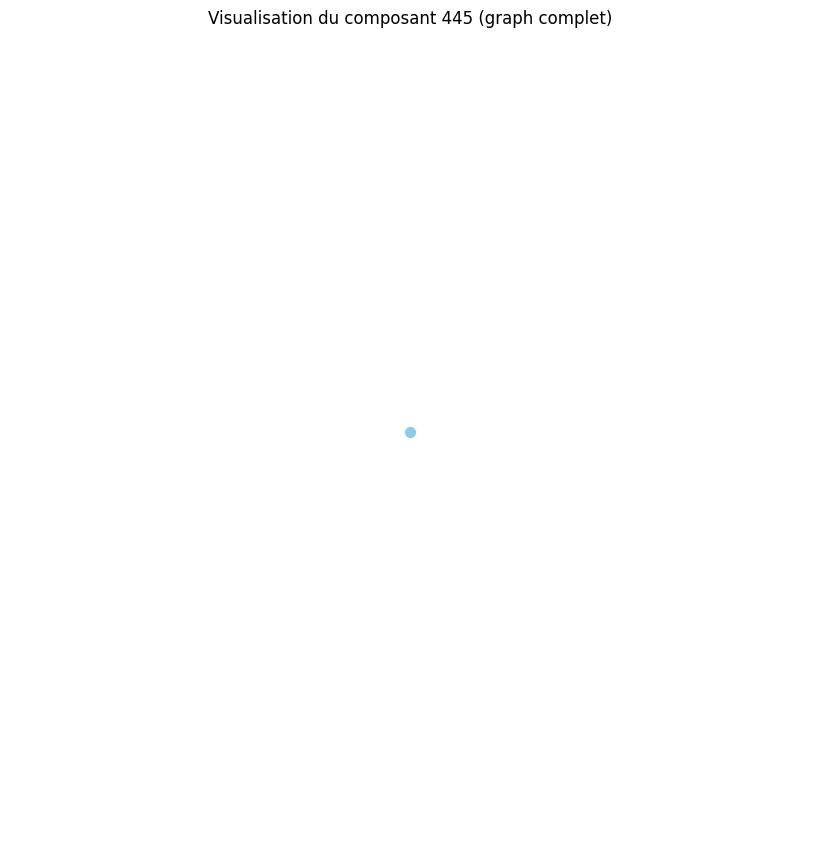

Distance moyenne pour le composant 446 : 0.00
Le composant 446 est un graphe complet ou très densément connecté.
Densité du composant 446 : 0.00
Degré moyen du composant 446 : 0.00
Coefficient de clustering moyen du composant 446 : 0.00


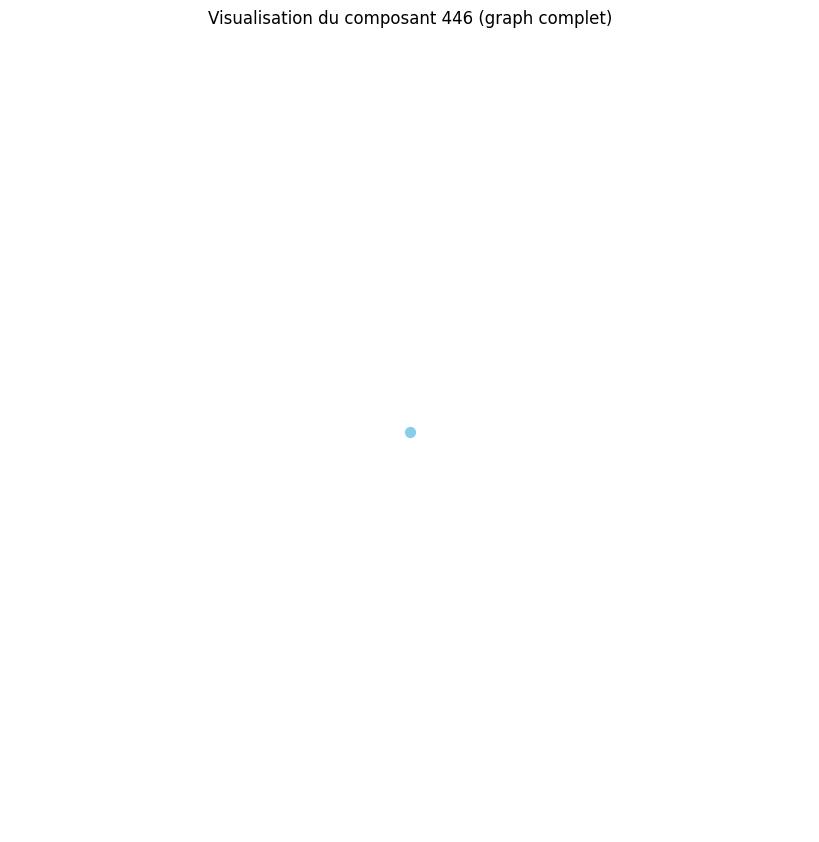

Distance moyenne pour le composant 447 : 0.00
Le composant 447 est un graphe complet ou très densément connecté.
Densité du composant 447 : 0.00
Degré moyen du composant 447 : 0.00
Coefficient de clustering moyen du composant 447 : 0.00


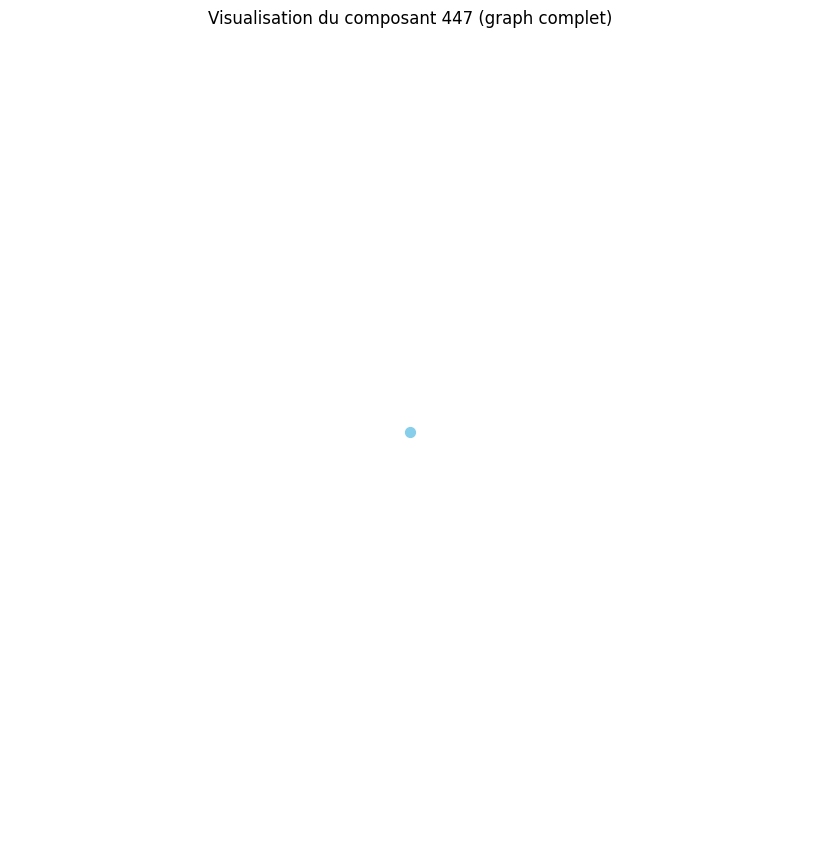

Distance moyenne pour le composant 448 : 0.00
Le composant 448 est un graphe complet ou très densément connecté.
Densité du composant 448 : 0.00
Degré moyen du composant 448 : 0.00
Coefficient de clustering moyen du composant 448 : 0.00


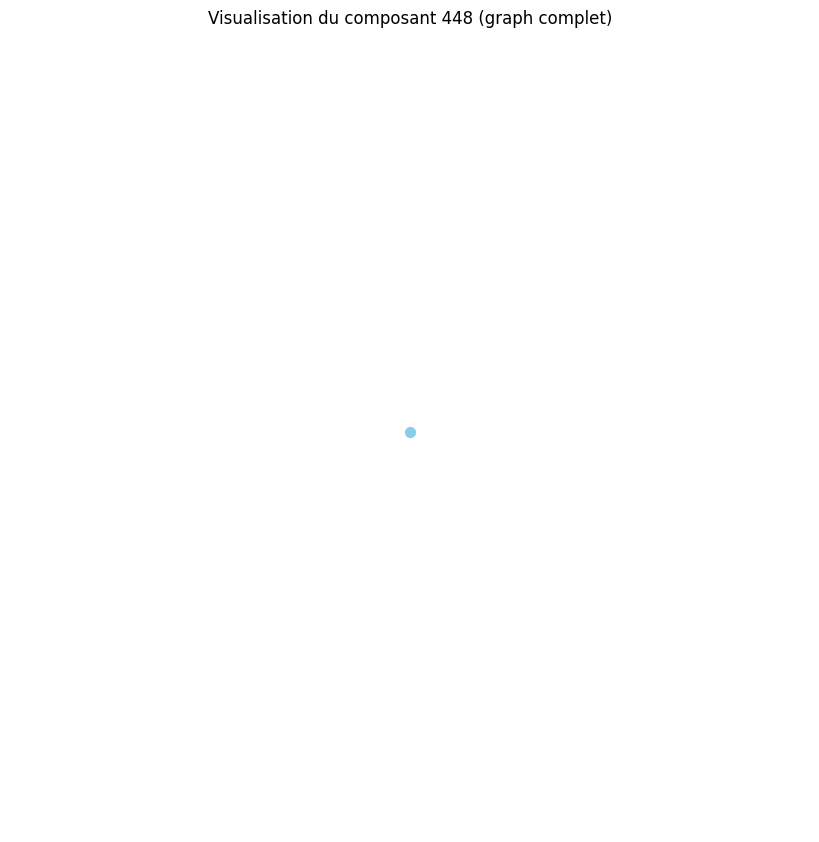

Distance moyenne pour le composant 449 : 0.00
Le composant 449 est un graphe complet ou très densément connecté.
Densité du composant 449 : 0.00
Degré moyen du composant 449 : 0.00
Coefficient de clustering moyen du composant 449 : 0.00


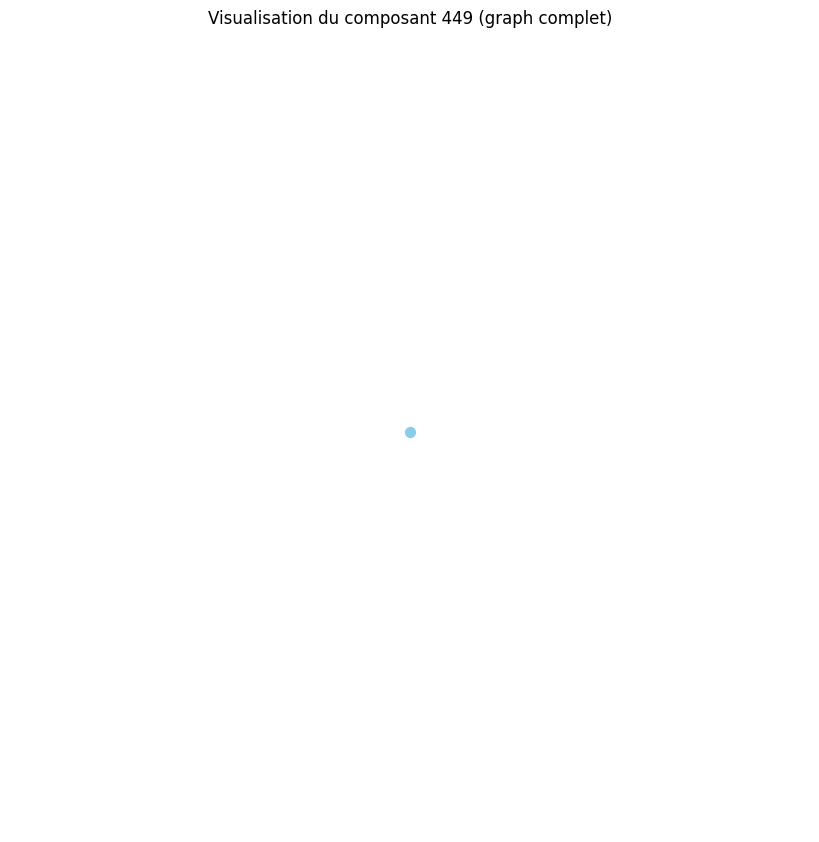

Distance moyenne pour le composant 450 : 0.00
Le composant 450 est un graphe complet ou très densément connecté.
Densité du composant 450 : 0.00
Degré moyen du composant 450 : 0.00
Coefficient de clustering moyen du composant 450 : 0.00


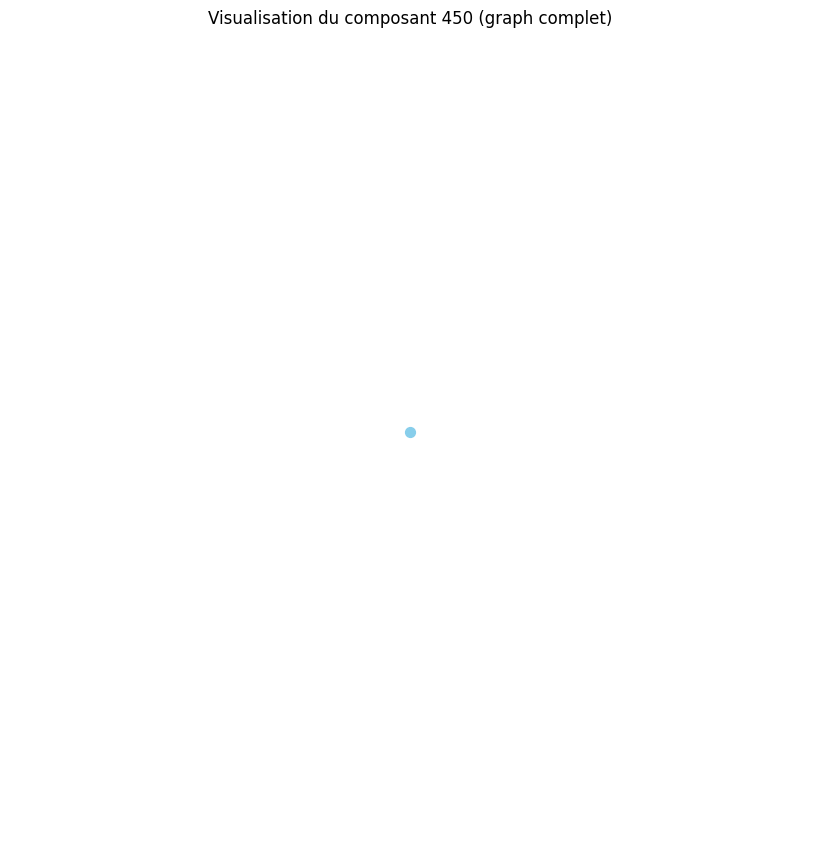

Distance moyenne pour le composant 451 : 0.00
Le composant 451 est un graphe complet ou très densément connecté.
Densité du composant 451 : 0.00
Degré moyen du composant 451 : 0.00
Coefficient de clustering moyen du composant 451 : 0.00


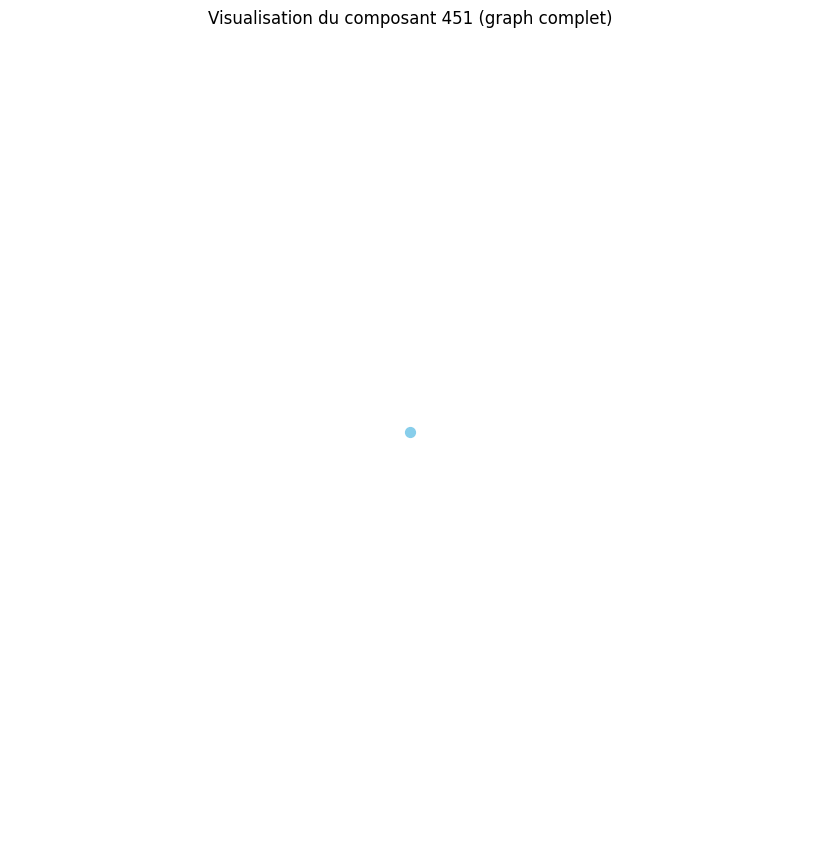

Distance moyenne pour le composant 452 : 0.00
Le composant 452 est un graphe complet ou très densément connecté.
Densité du composant 452 : 0.00
Degré moyen du composant 452 : 0.00
Coefficient de clustering moyen du composant 452 : 0.00


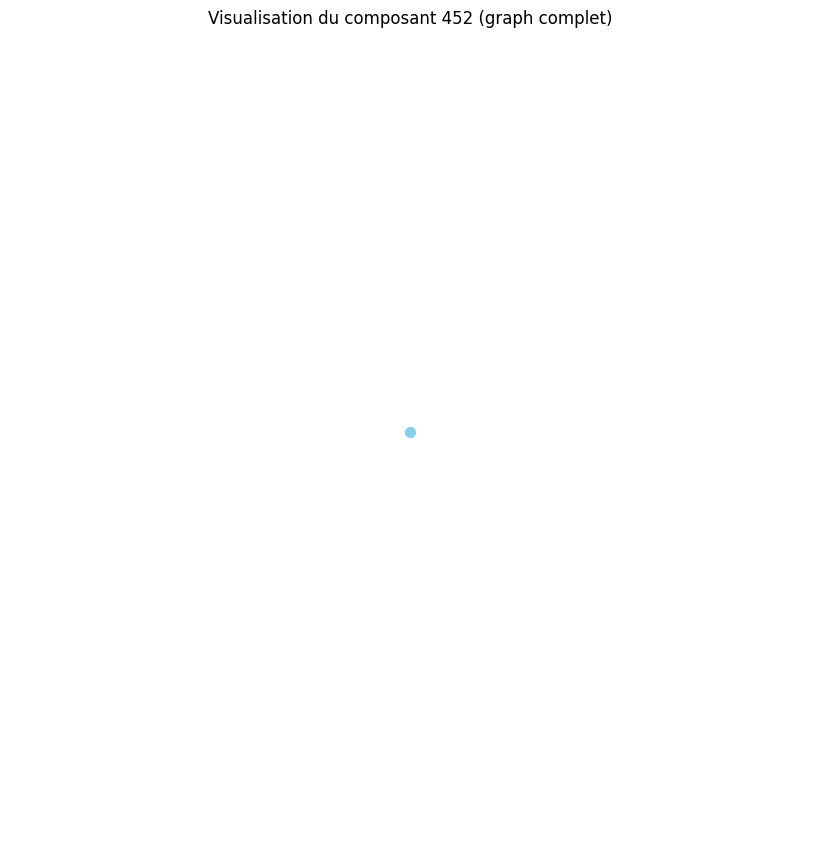

Distance moyenne pour le composant 453 : 0.00
Le composant 453 est un graphe complet ou très densément connecté.
Densité du composant 453 : 0.00
Degré moyen du composant 453 : 0.00
Coefficient de clustering moyen du composant 453 : 0.00


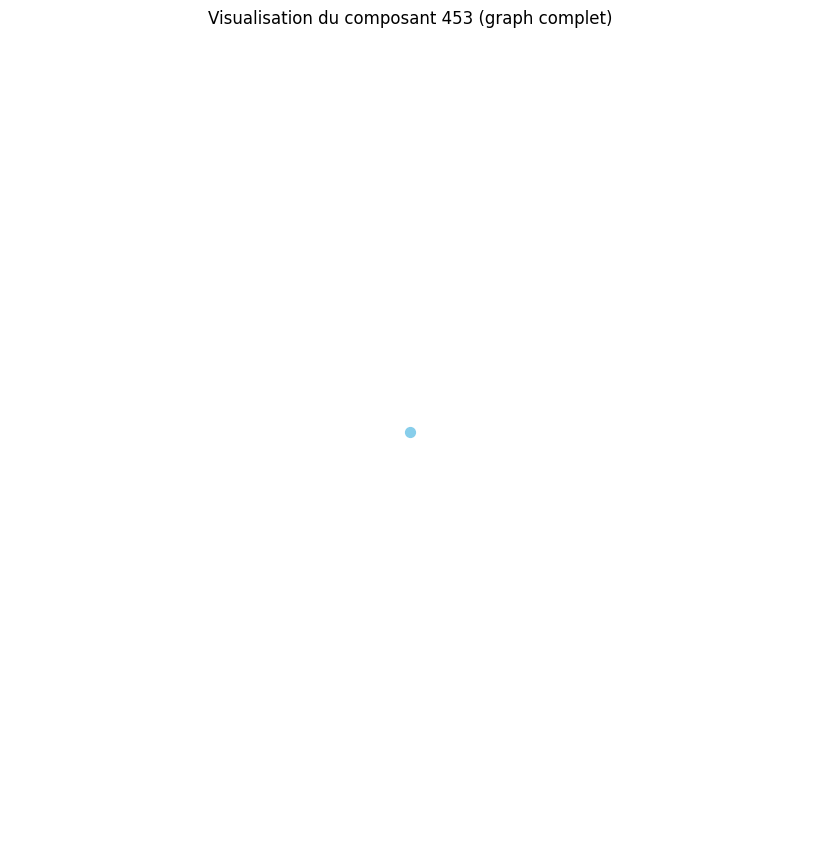

Distance moyenne pour le composant 454 : 0.00
Le composant 454 est un graphe complet ou très densément connecté.
Densité du composant 454 : 0.00
Degré moyen du composant 454 : 0.00
Coefficient de clustering moyen du composant 454 : 0.00


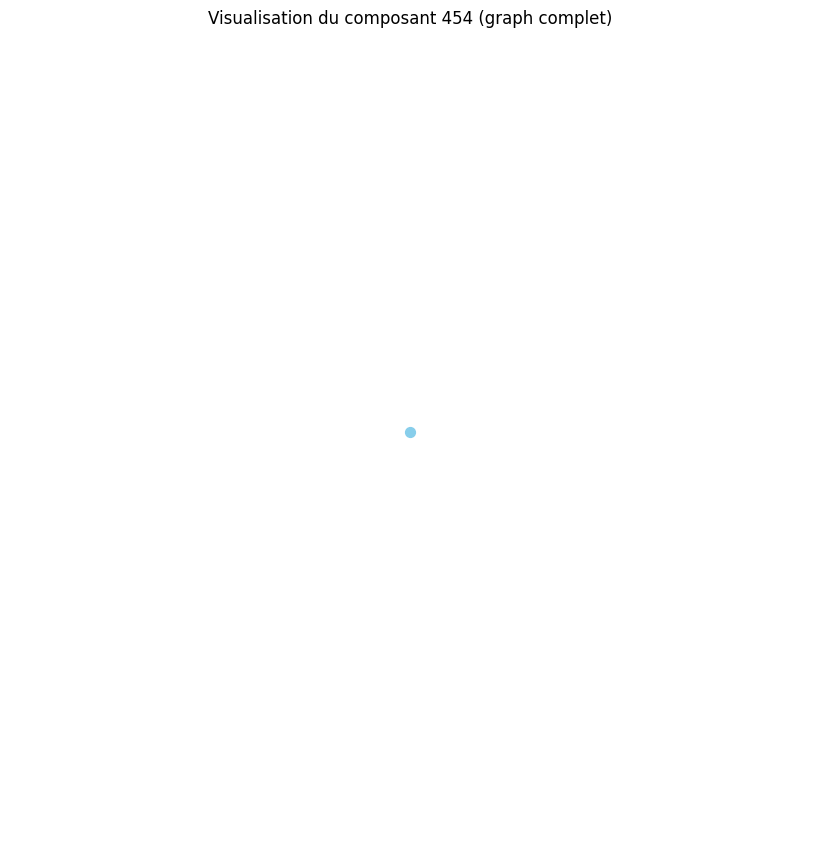

Distance moyenne pour le composant 455 : 0.00
Le composant 455 est un graphe complet ou très densément connecté.
Densité du composant 455 : 0.00
Degré moyen du composant 455 : 0.00
Coefficient de clustering moyen du composant 455 : 0.00


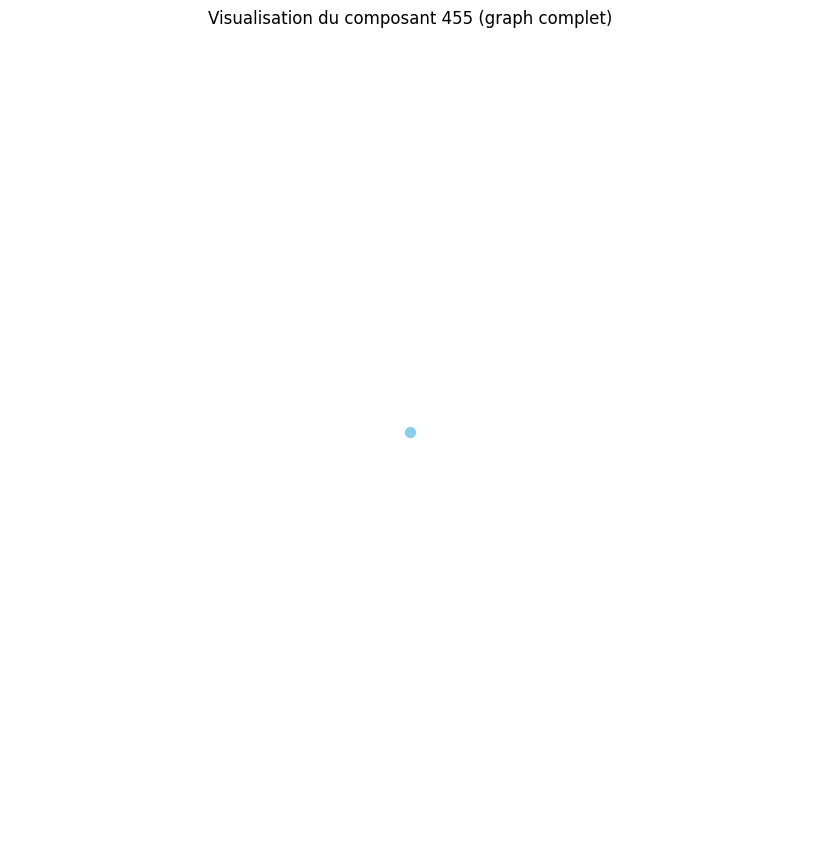

Distance moyenne pour le composant 456 : 0.00
Le composant 456 est un graphe complet ou très densément connecté.
Densité du composant 456 : 0.00
Degré moyen du composant 456 : 0.00
Coefficient de clustering moyen du composant 456 : 0.00


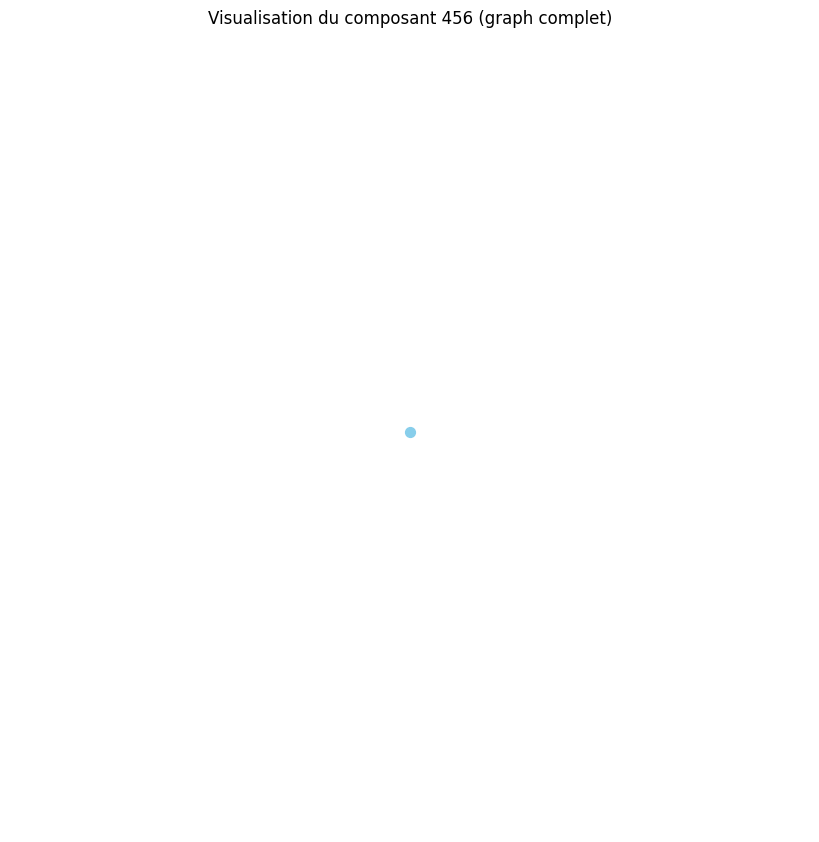

Distance moyenne pour le composant 457 : 0.00
Le composant 457 est un graphe complet ou très densément connecté.
Densité du composant 457 : 0.00
Degré moyen du composant 457 : 0.00
Coefficient de clustering moyen du composant 457 : 0.00


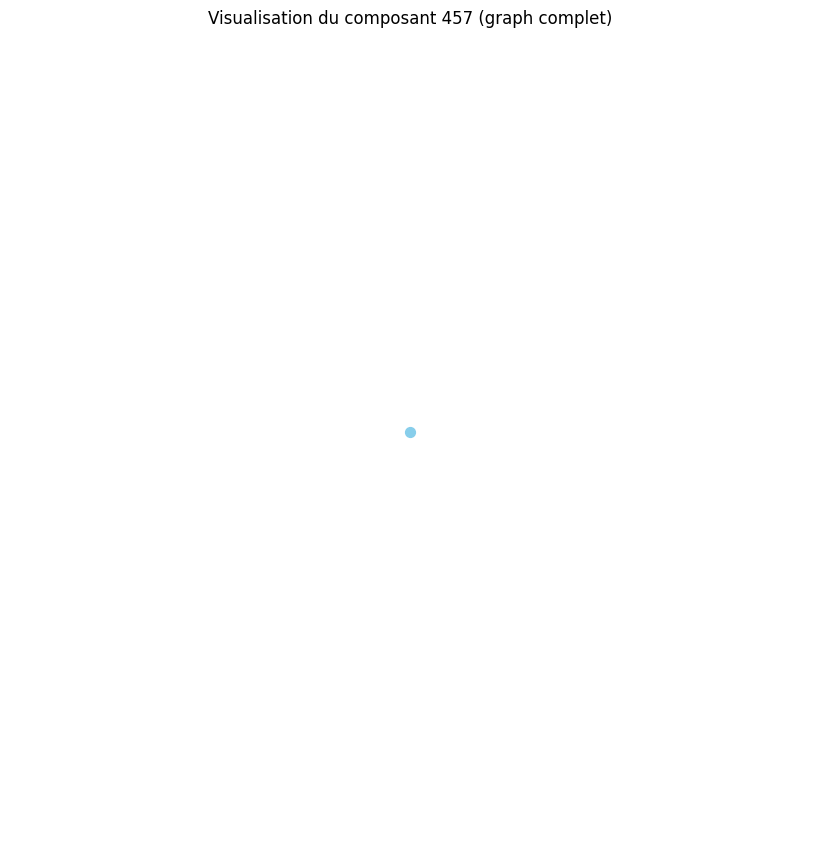

Distance moyenne pour le composant 458 : 0.00
Le composant 458 est un graphe complet ou très densément connecté.
Densité du composant 458 : 0.00
Degré moyen du composant 458 : 0.00
Coefficient de clustering moyen du composant 458 : 0.00


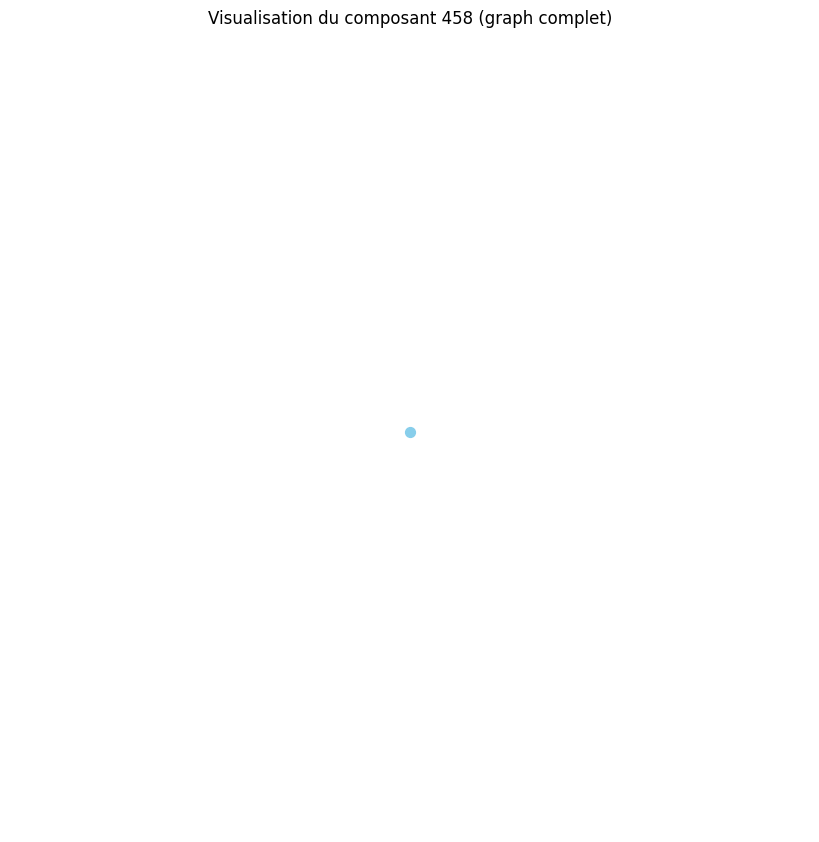

Distance moyenne pour le composant 459 : 0.00
Le composant 459 est un graphe complet ou très densément connecté.
Densité du composant 459 : 0.00
Degré moyen du composant 459 : 0.00
Coefficient de clustering moyen du composant 459 : 0.00


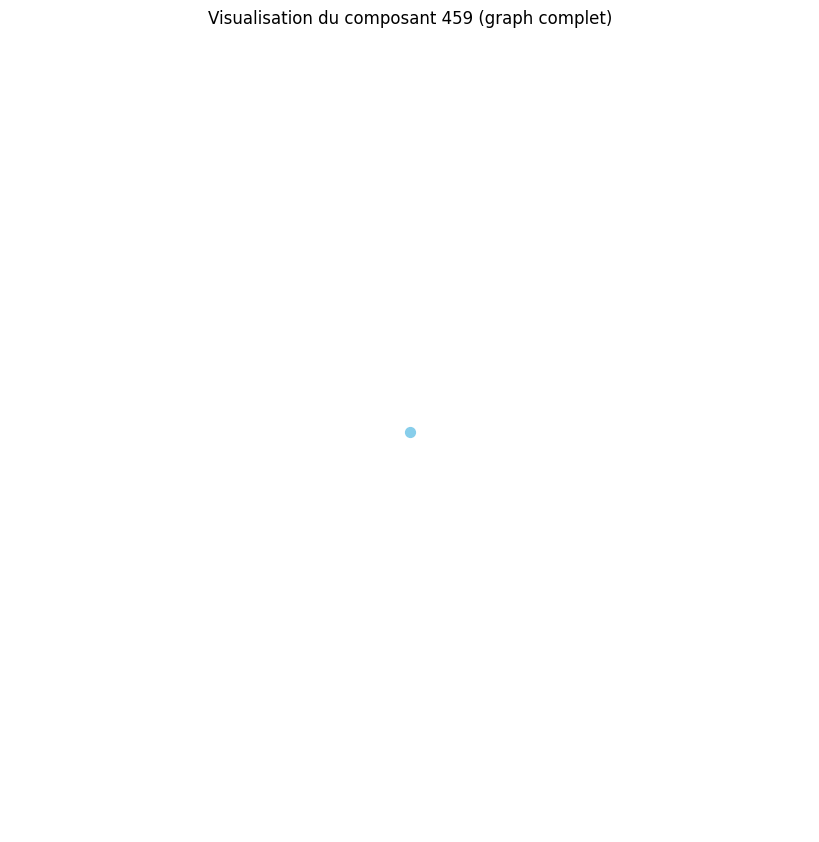

Distance moyenne pour le composant 460 : 0.00
Le composant 460 est un graphe complet ou très densément connecté.
Densité du composant 460 : 0.00
Degré moyen du composant 460 : 0.00
Coefficient de clustering moyen du composant 460 : 0.00


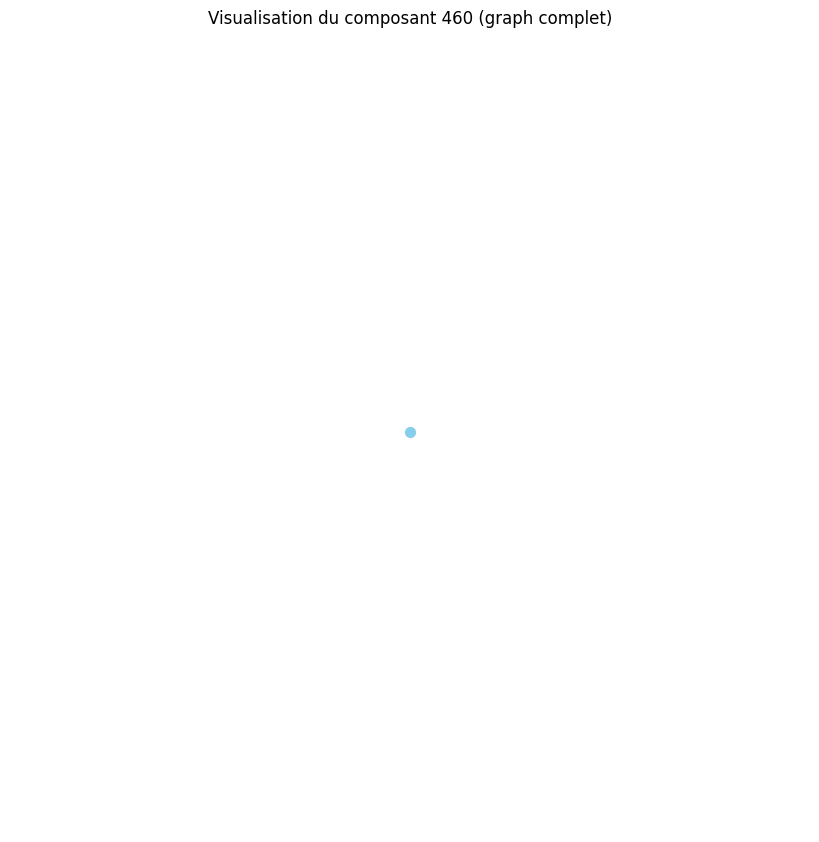

Distance moyenne pour le composant 461 : 2.11
Distance moyenne pour le composant 462 : 0.00
Le composant 462 est un graphe complet ou très densément connecté.
Densité du composant 462 : 0.00
Degré moyen du composant 462 : 0.00
Coefficient de clustering moyen du composant 462 : 0.00


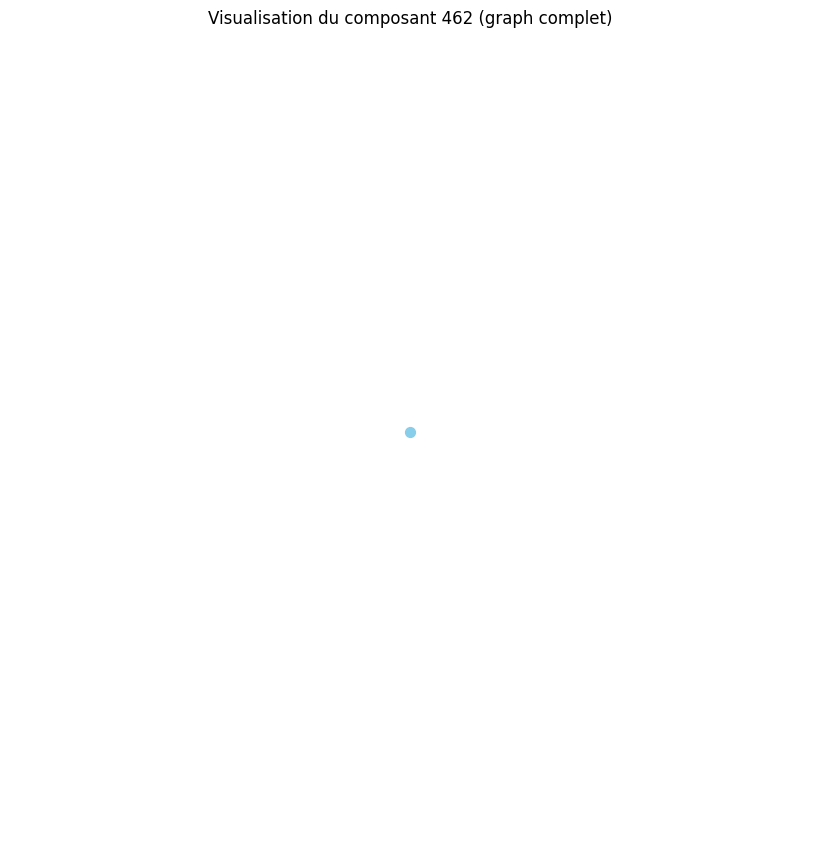

Distance moyenne pour le composant 463 : 0.00
Le composant 463 est un graphe complet ou très densément connecté.
Densité du composant 463 : 0.00
Degré moyen du composant 463 : 0.00
Coefficient de clustering moyen du composant 463 : 0.00


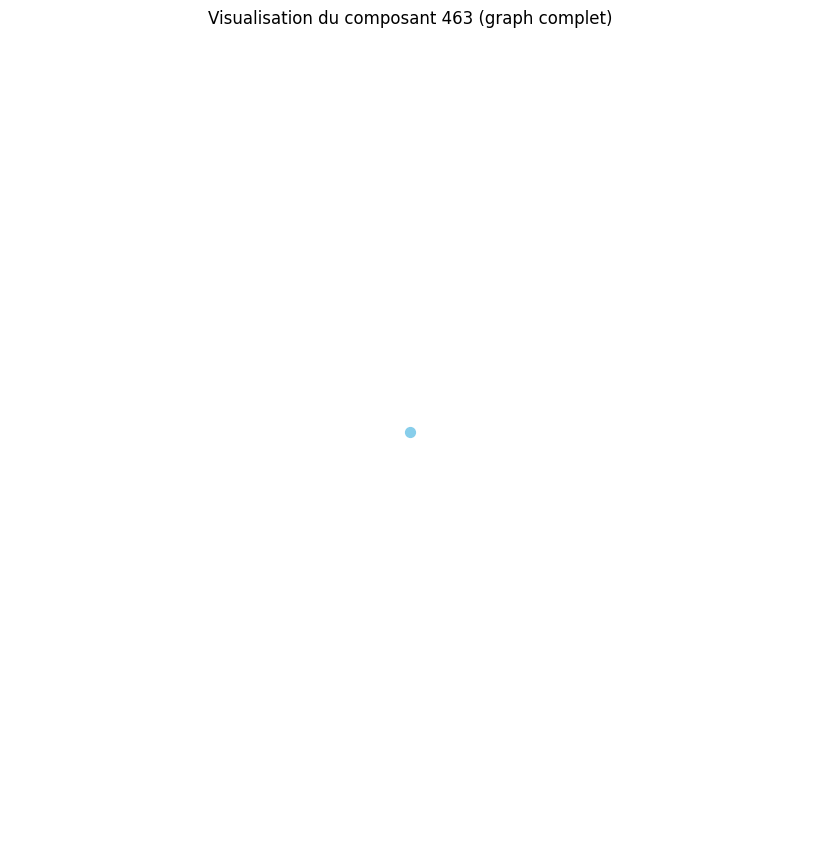

Distance moyenne pour le composant 464 : 0.00
Le composant 464 est un graphe complet ou très densément connecté.
Densité du composant 464 : 0.00
Degré moyen du composant 464 : 0.00
Coefficient de clustering moyen du composant 464 : 0.00


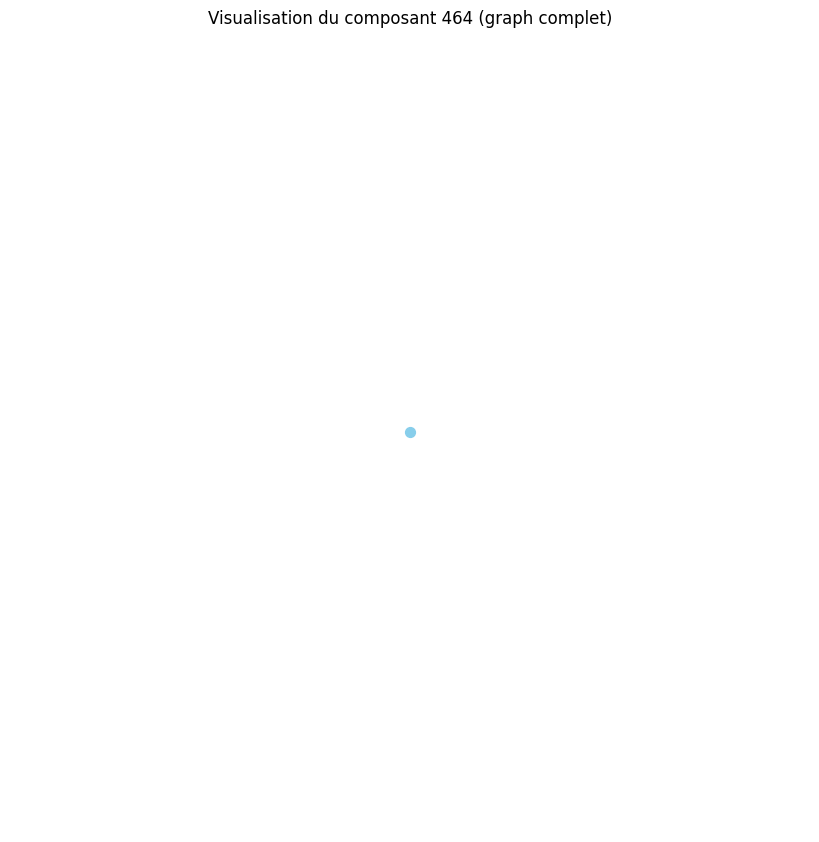

Distance moyenne pour le composant 465 : 0.00
Le composant 465 est un graphe complet ou très densément connecté.
Densité du composant 465 : 0.00
Degré moyen du composant 465 : 0.00
Coefficient de clustering moyen du composant 465 : 0.00


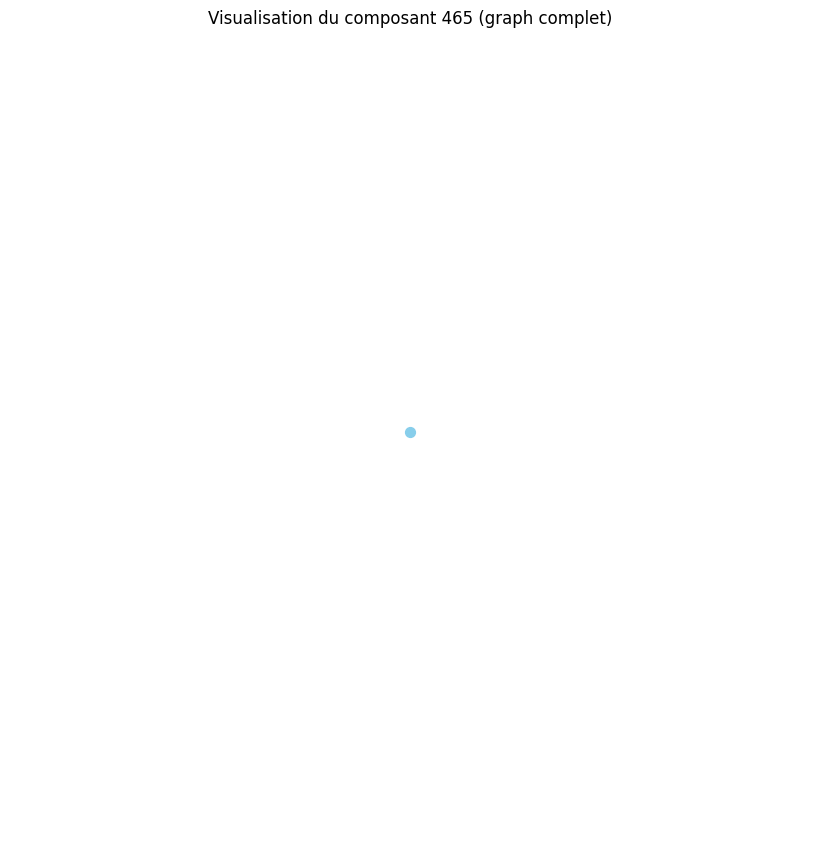

Distance moyenne pour le composant 466 : 0.00
Le composant 466 est un graphe complet ou très densément connecté.
Densité du composant 466 : 0.00
Degré moyen du composant 466 : 0.00
Coefficient de clustering moyen du composant 466 : 0.00


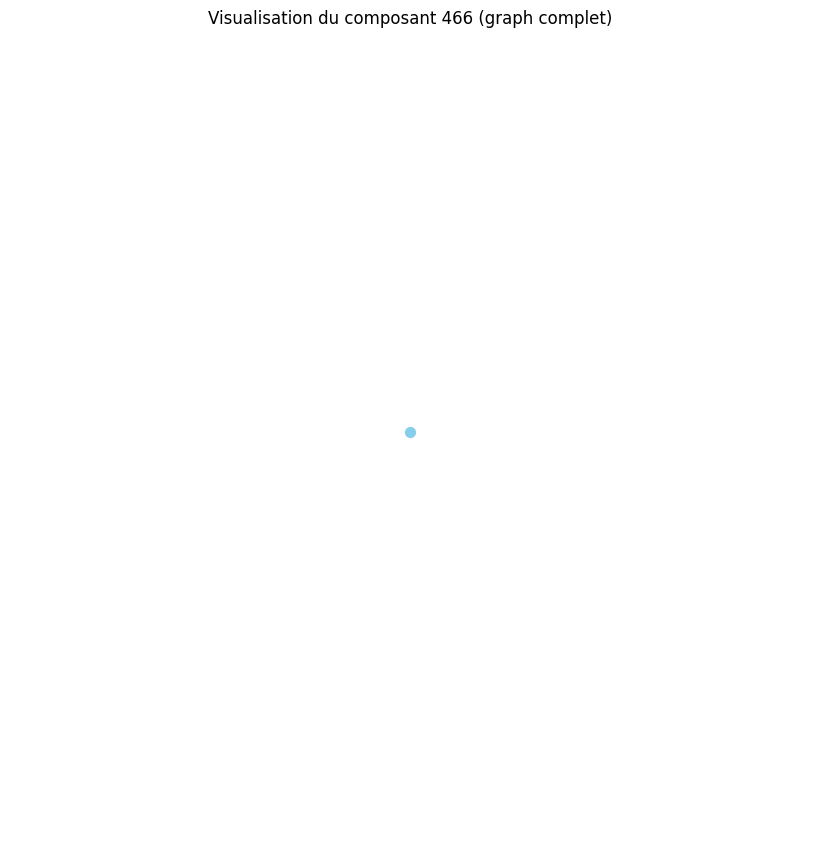

Distance moyenne pour le composant 467 : 0.00
Le composant 467 est un graphe complet ou très densément connecté.
Densité du composant 467 : 0.00
Degré moyen du composant 467 : 0.00
Coefficient de clustering moyen du composant 467 : 0.00


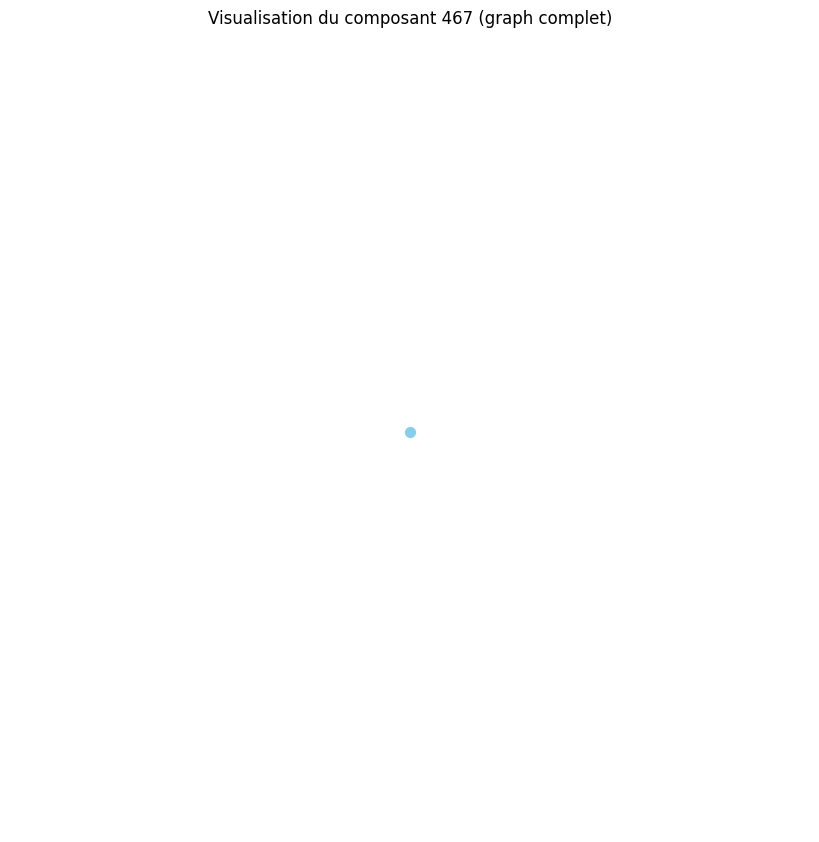

Distance moyenne pour le composant 468 : 0.00
Le composant 468 est un graphe complet ou très densément connecté.
Densité du composant 468 : 0.00
Degré moyen du composant 468 : 0.00
Coefficient de clustering moyen du composant 468 : 0.00


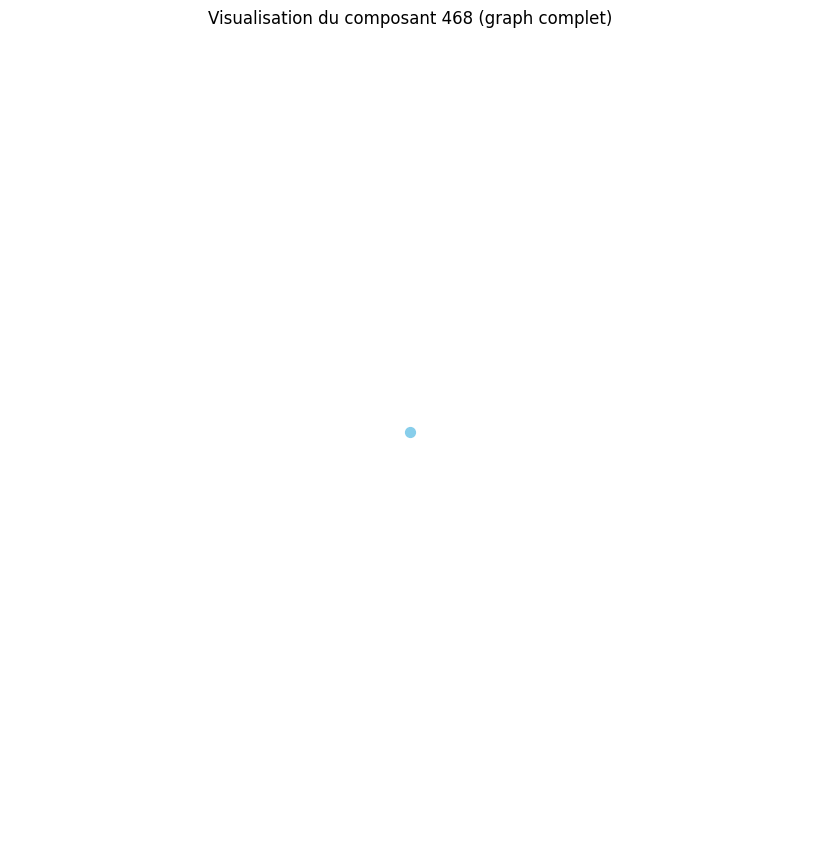

Distance moyenne pour le composant 469 : 0.00
Le composant 469 est un graphe complet ou très densément connecté.
Densité du composant 469 : 0.00
Degré moyen du composant 469 : 0.00
Coefficient de clustering moyen du composant 469 : 0.00


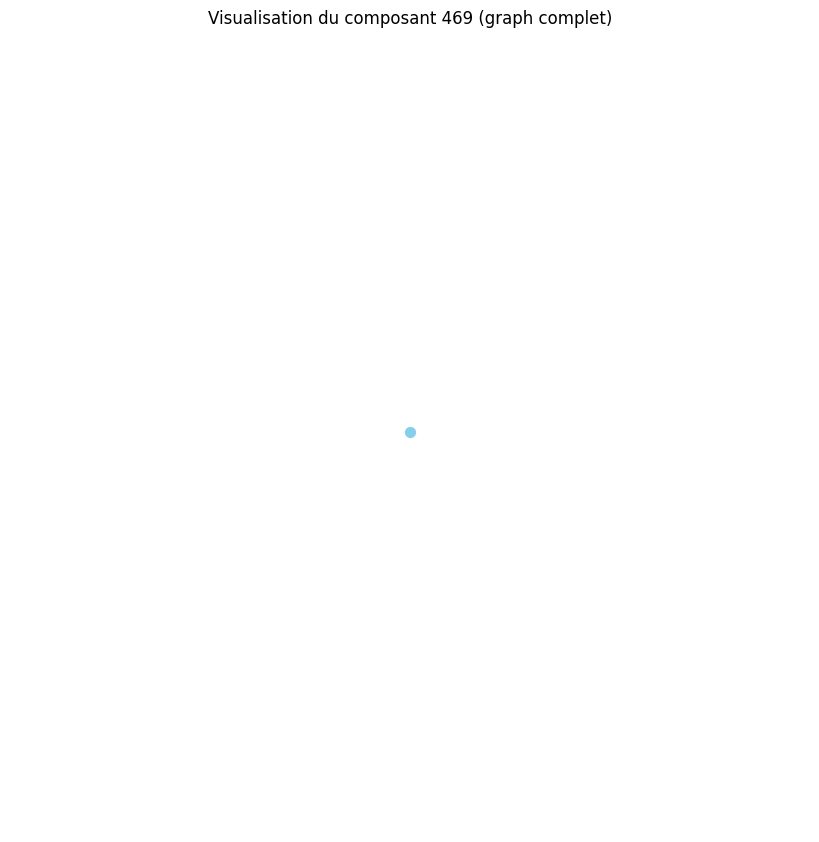

Distance moyenne pour le composant 470 : 0.00
Le composant 470 est un graphe complet ou très densément connecté.
Densité du composant 470 : 0.00
Degré moyen du composant 470 : 0.00
Coefficient de clustering moyen du composant 470 : 0.00


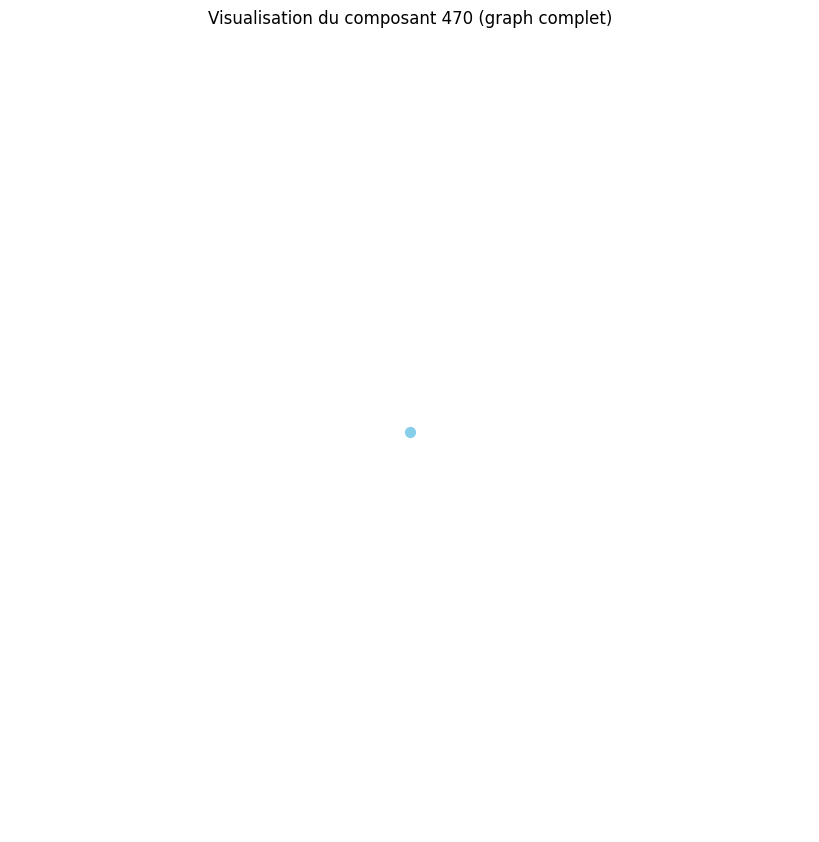

Distance moyenne pour le composant 471 : 0.00
Le composant 471 est un graphe complet ou très densément connecté.
Densité du composant 471 : 0.00
Degré moyen du composant 471 : 0.00
Coefficient de clustering moyen du composant 471 : 0.00


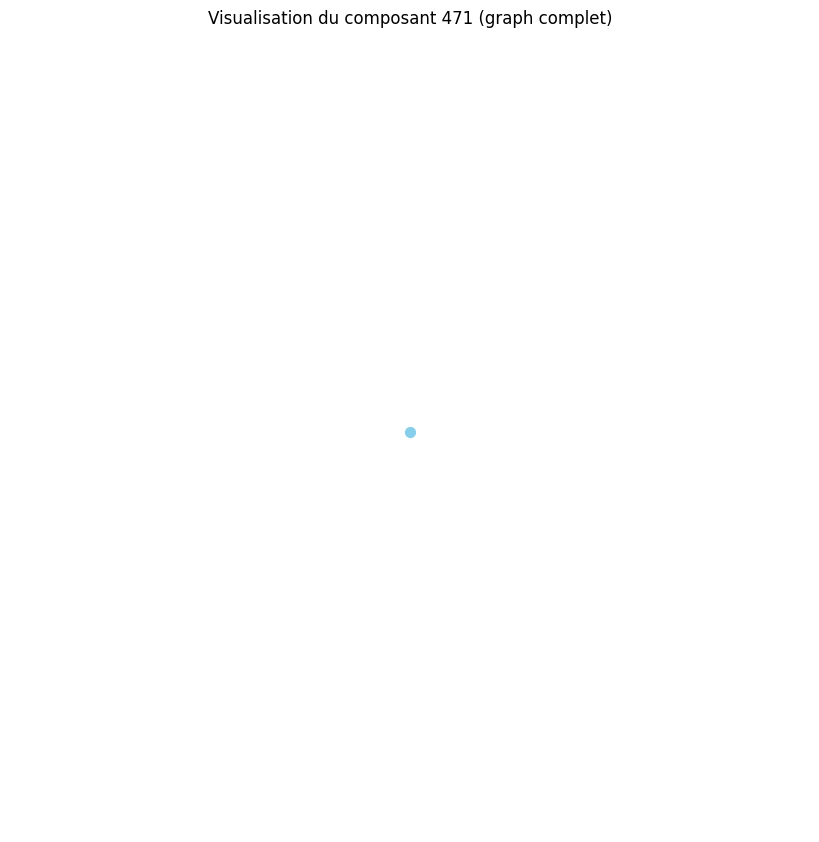

Distance moyenne pour le composant 472 : 0.00
Le composant 472 est un graphe complet ou très densément connecté.
Densité du composant 472 : 0.00
Degré moyen du composant 472 : 0.00
Coefficient de clustering moyen du composant 472 : 0.00


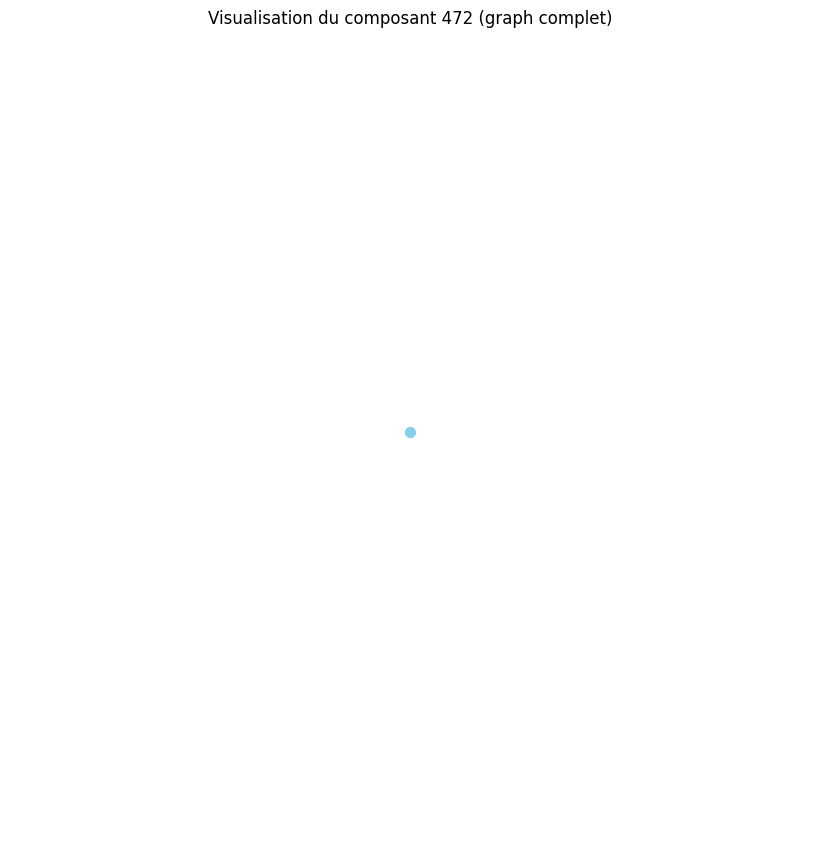

Distance moyenne pour le composant 473 : 0.00
Le composant 473 est un graphe complet ou très densément connecté.
Densité du composant 473 : 0.00
Degré moyen du composant 473 : 0.00
Coefficient de clustering moyen du composant 473 : 0.00


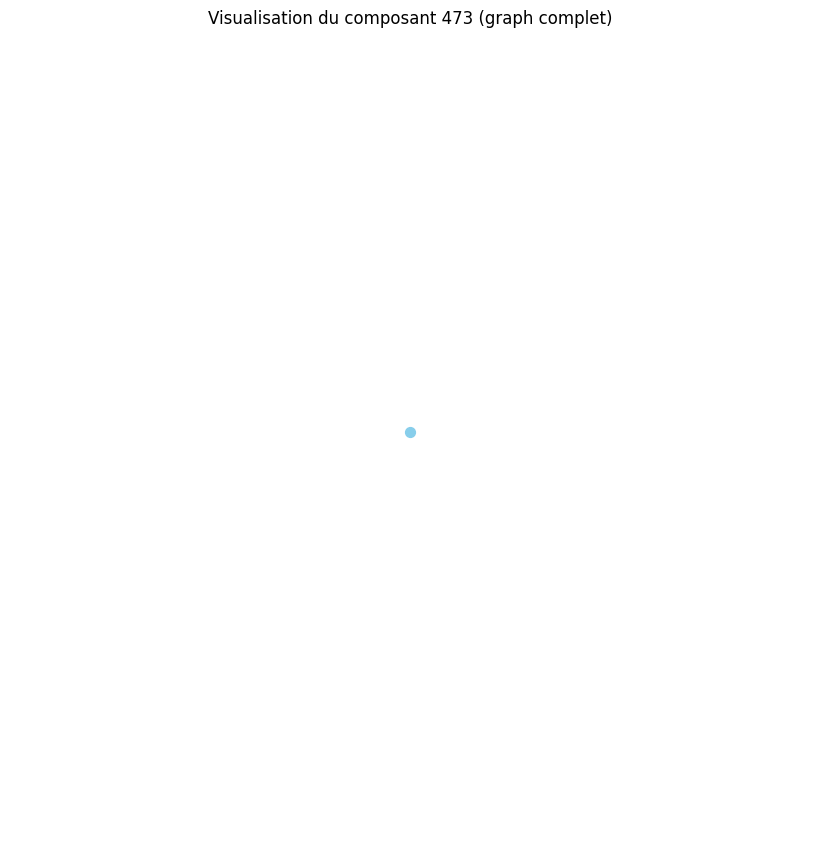

Distance moyenne pour le composant 474 : 0.00
Le composant 474 est un graphe complet ou très densément connecté.
Densité du composant 474 : 0.00
Degré moyen du composant 474 : 0.00
Coefficient de clustering moyen du composant 474 : 0.00


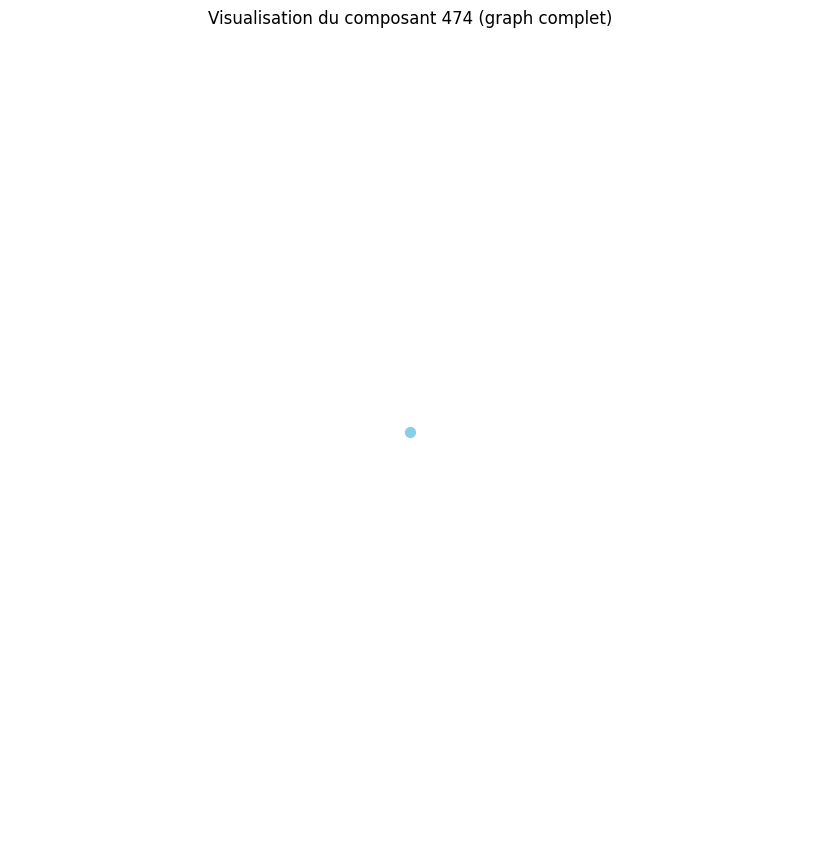

Distance moyenne pour le composant 475 : 0.00
Le composant 475 est un graphe complet ou très densément connecté.
Densité du composant 475 : 0.00
Degré moyen du composant 475 : 0.00
Coefficient de clustering moyen du composant 475 : 0.00


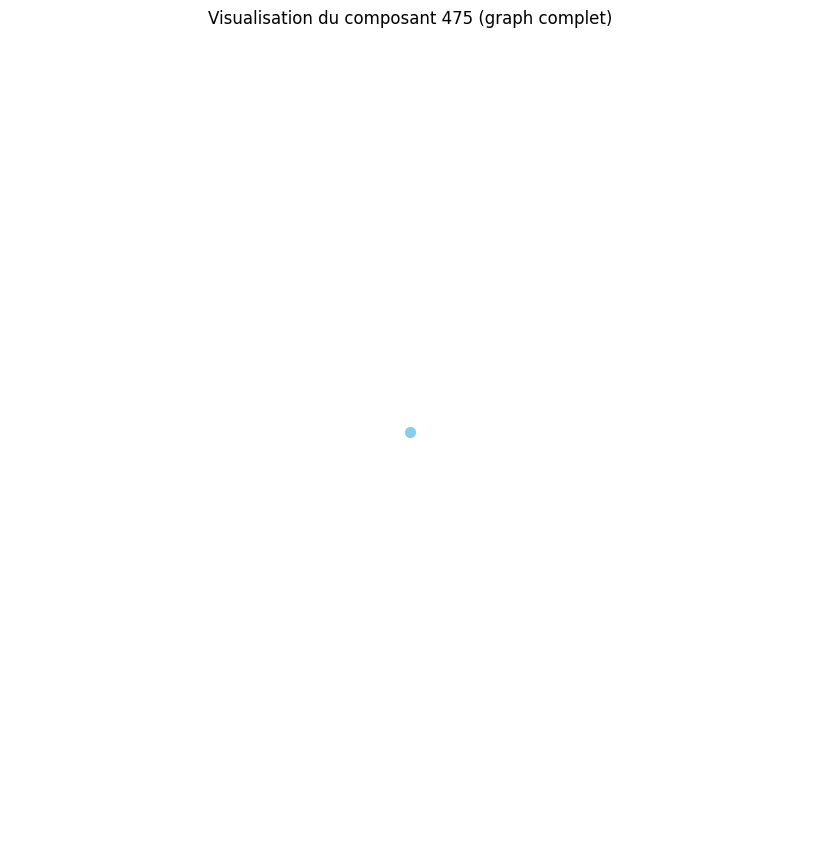

Distance moyenne pour le composant 476 : 0.00
Le composant 476 est un graphe complet ou très densément connecté.
Densité du composant 476 : 0.00
Degré moyen du composant 476 : 0.00
Coefficient de clustering moyen du composant 476 : 0.00


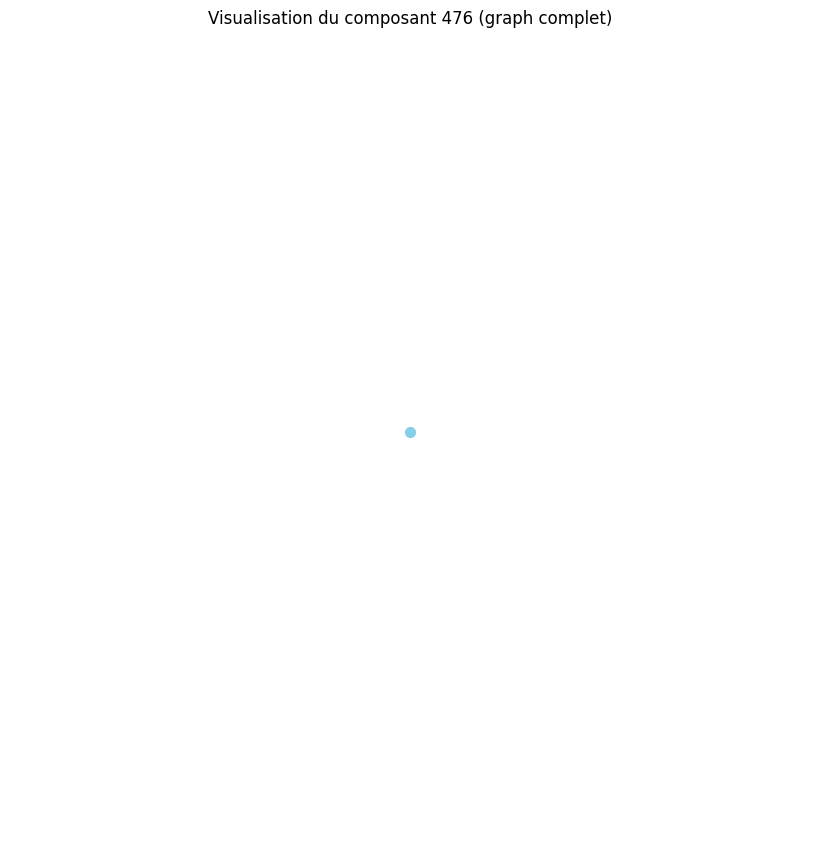

Distance moyenne pour le composant 477 : 0.00
Le composant 477 est un graphe complet ou très densément connecté.
Densité du composant 477 : 0.00
Degré moyen du composant 477 : 0.00
Coefficient de clustering moyen du composant 477 : 0.00


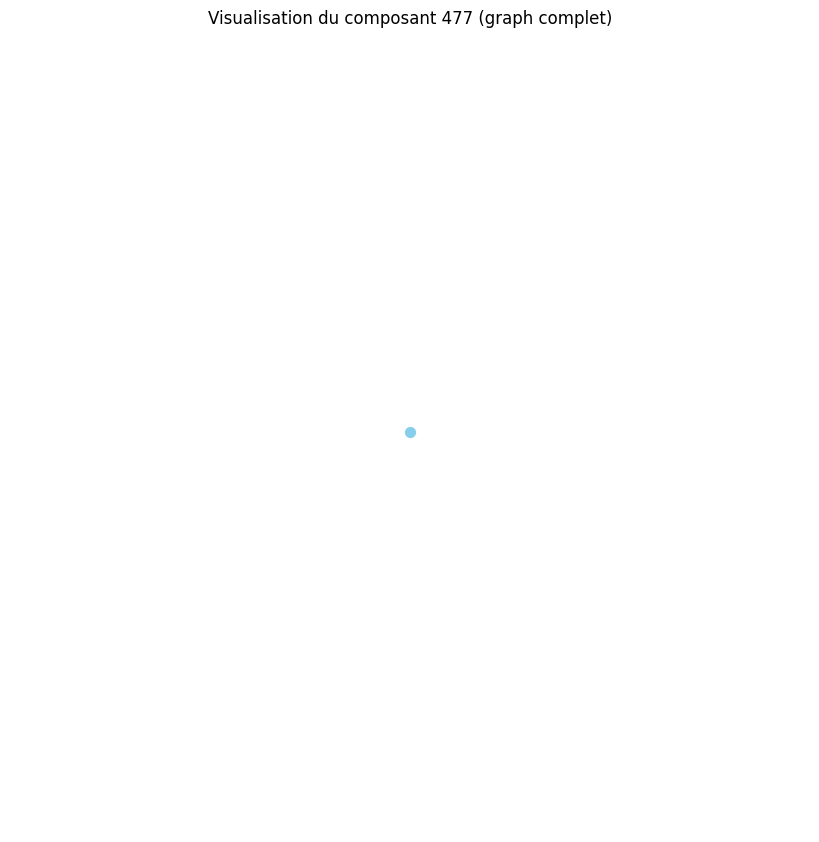

Distance moyenne pour le composant 478 : 0.00
Le composant 478 est un graphe complet ou très densément connecté.
Densité du composant 478 : 0.00
Degré moyen du composant 478 : 0.00
Coefficient de clustering moyen du composant 478 : 0.00


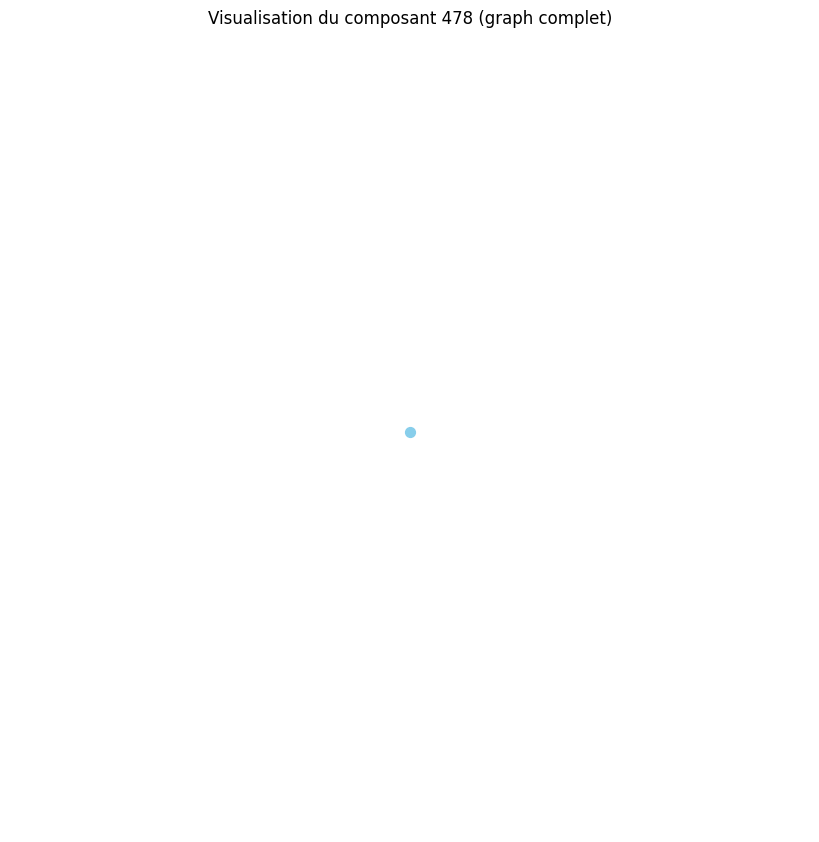

Distance moyenne pour le composant 479 : 0.00
Le composant 479 est un graphe complet ou très densément connecté.
Densité du composant 479 : 0.00
Degré moyen du composant 479 : 0.00
Coefficient de clustering moyen du composant 479 : 0.00


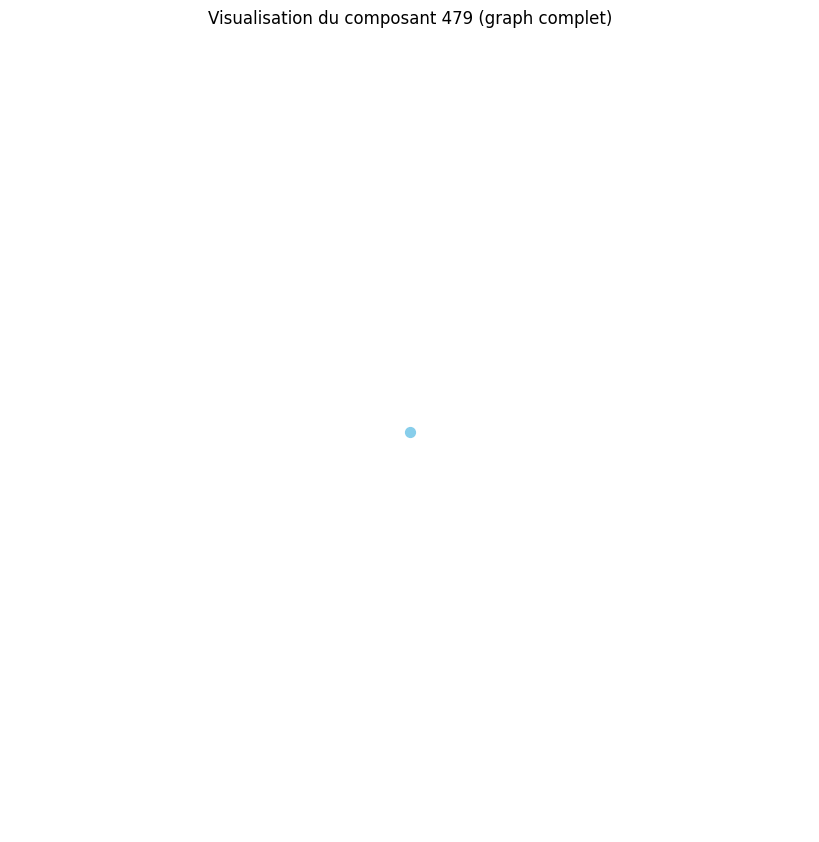

Distance moyenne pour le composant 480 : 0.00
Le composant 480 est un graphe complet ou très densément connecté.
Densité du composant 480 : 0.00
Degré moyen du composant 480 : 0.00
Coefficient de clustering moyen du composant 480 : 0.00


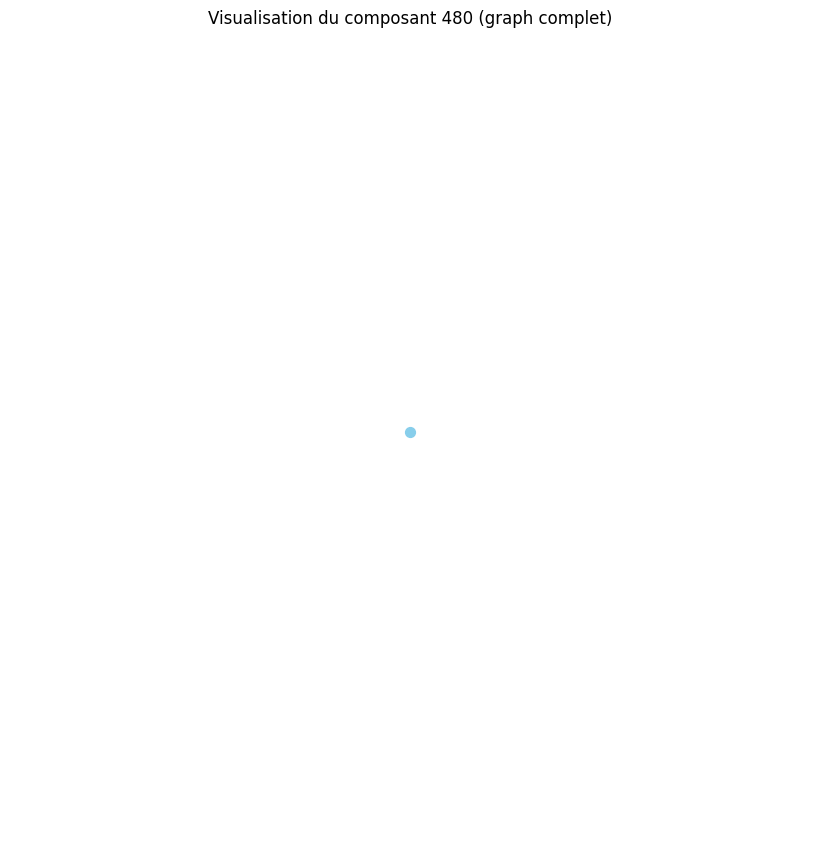

Distance moyenne pour le composant 481 : 0.00
Le composant 481 est un graphe complet ou très densément connecté.
Densité du composant 481 : 0.00
Degré moyen du composant 481 : 0.00
Coefficient de clustering moyen du composant 481 : 0.00


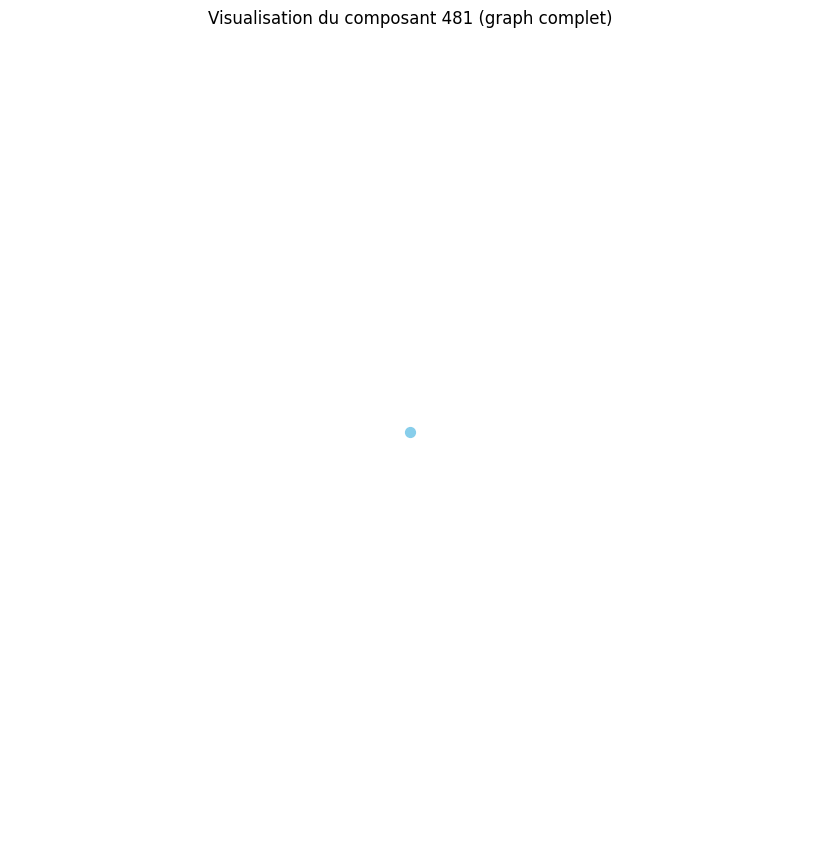

Distance moyenne pour le composant 482 : 0.00
Le composant 482 est un graphe complet ou très densément connecté.
Densité du composant 482 : 0.00
Degré moyen du composant 482 : 0.00
Coefficient de clustering moyen du composant 482 : 0.00


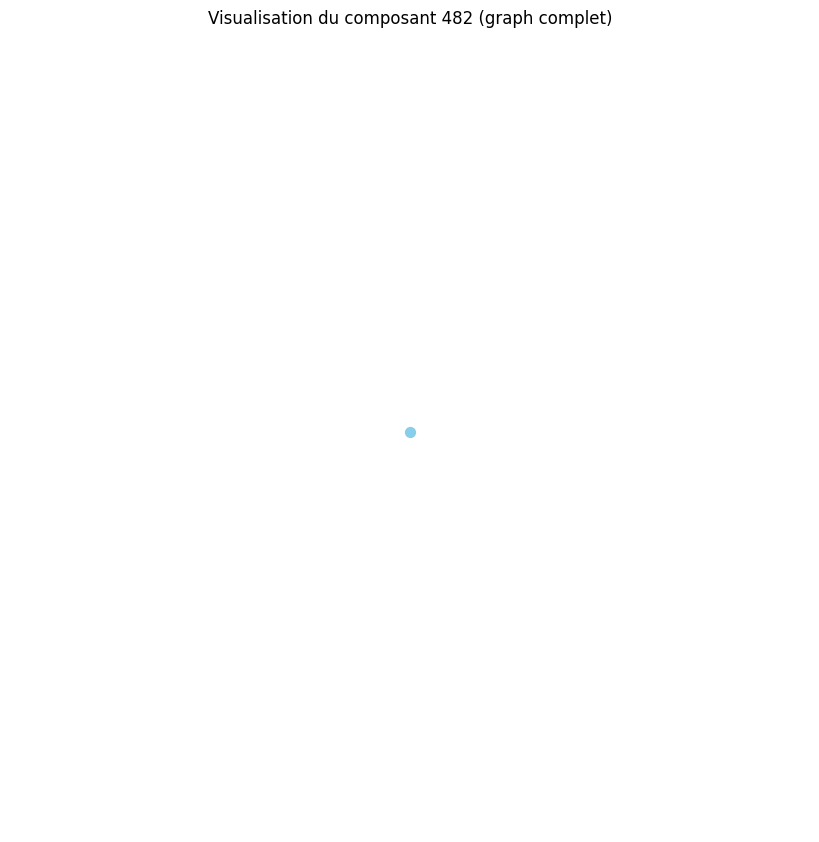

Distance moyenne pour le composant 483 : 0.00
Le composant 483 est un graphe complet ou très densément connecté.
Densité du composant 483 : 0.00
Degré moyen du composant 483 : 0.00
Coefficient de clustering moyen du composant 483 : 0.00


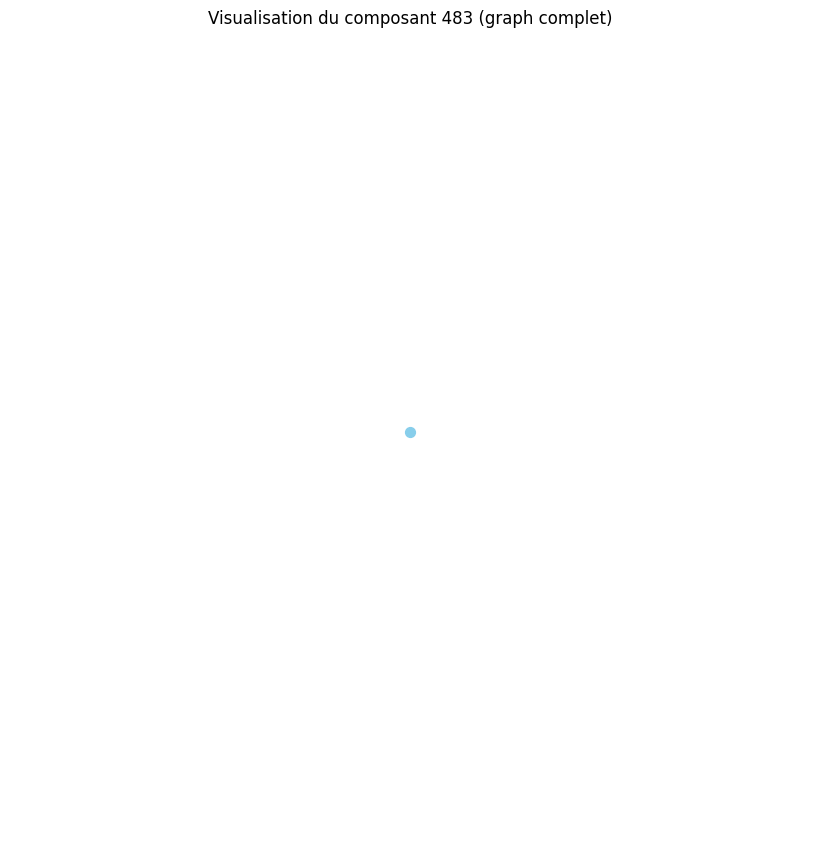

Distance moyenne pour le composant 484 : 0.00
Le composant 484 est un graphe complet ou très densément connecté.
Densité du composant 484 : 0.00
Degré moyen du composant 484 : 0.00
Coefficient de clustering moyen du composant 484 : 0.00


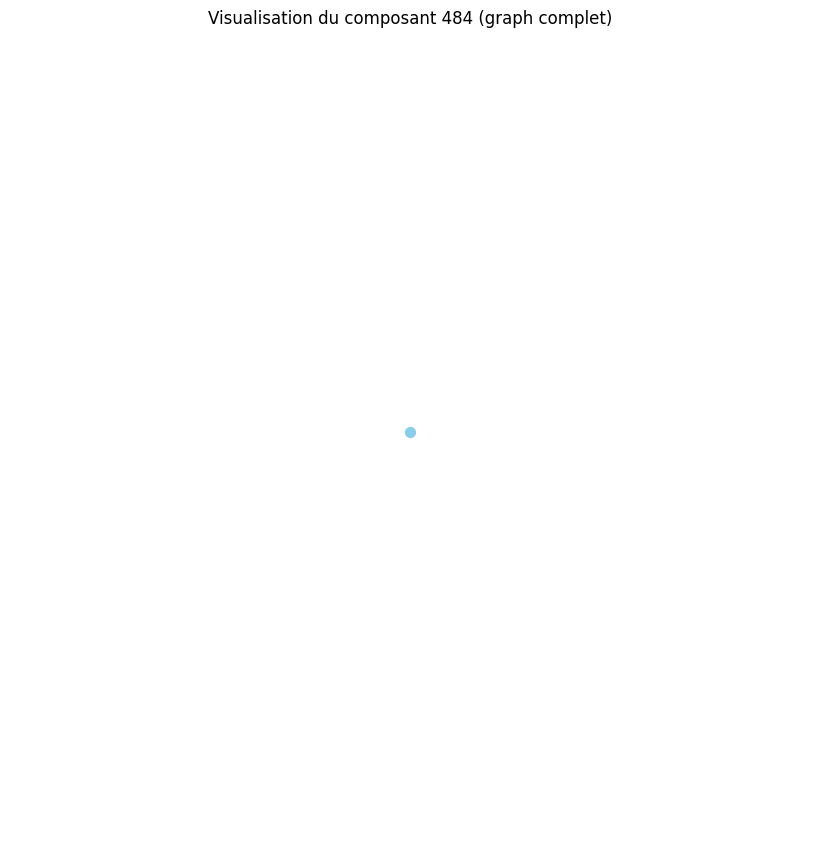

Distance moyenne pour le composant 485 : 0.00
Le composant 485 est un graphe complet ou très densément connecté.
Densité du composant 485 : 0.00
Degré moyen du composant 485 : 0.00
Coefficient de clustering moyen du composant 485 : 0.00


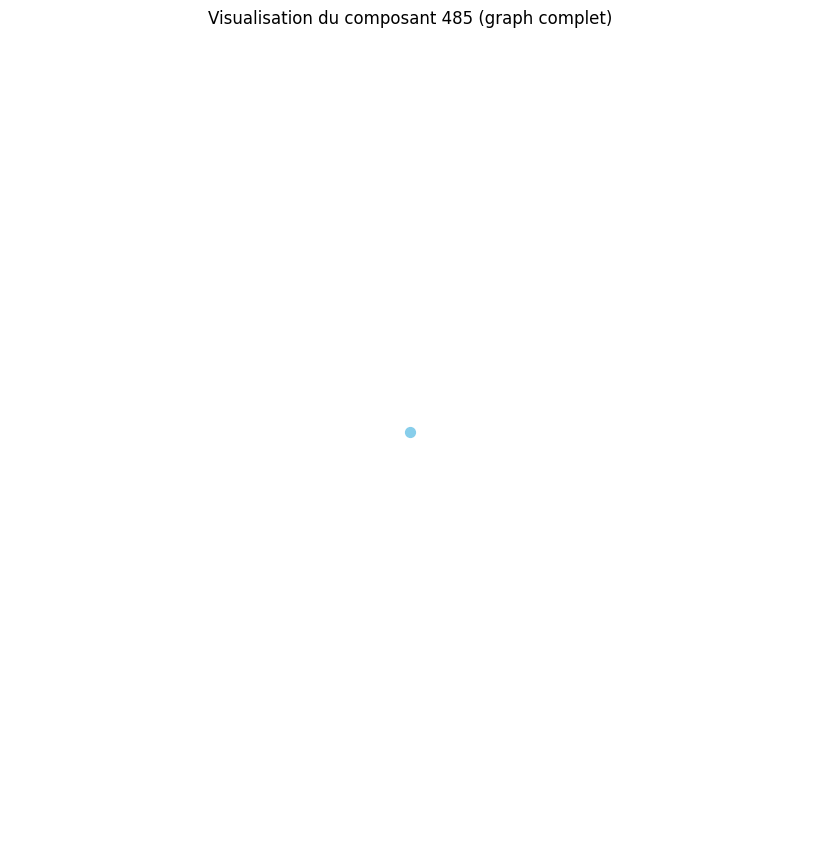

Distance moyenne pour le composant 486 : 0.00
Le composant 486 est un graphe complet ou très densément connecté.
Densité du composant 486 : 0.00
Degré moyen du composant 486 : 0.00
Coefficient de clustering moyen du composant 486 : 0.00


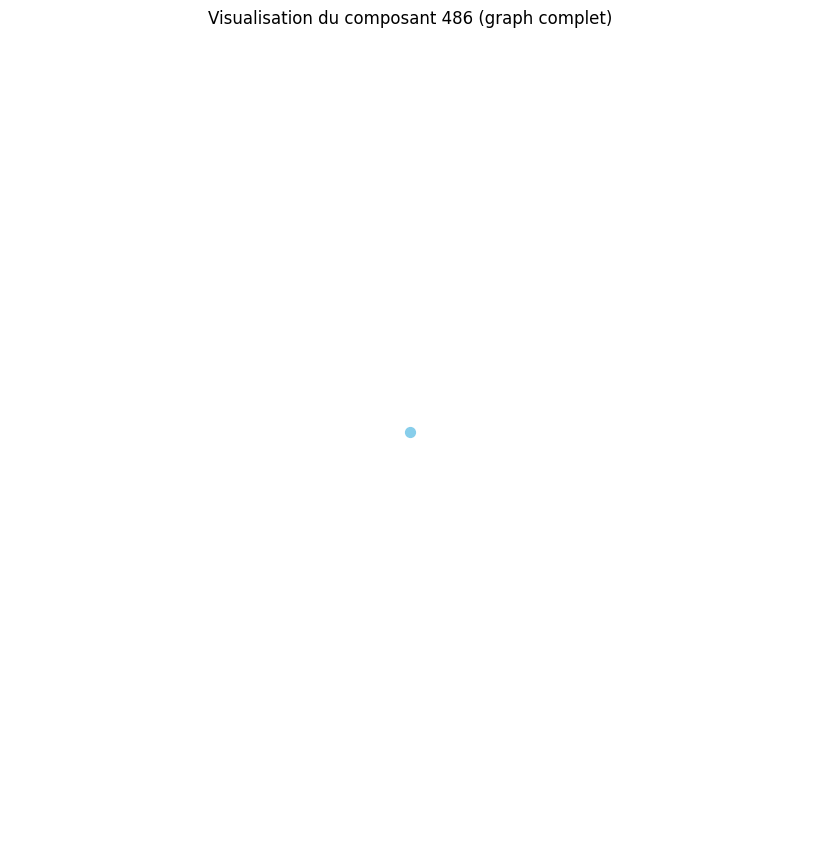

Distance moyenne pour le composant 487 : 0.00
Le composant 487 est un graphe complet ou très densément connecté.
Densité du composant 487 : 0.00
Degré moyen du composant 487 : 0.00
Coefficient de clustering moyen du composant 487 : 0.00


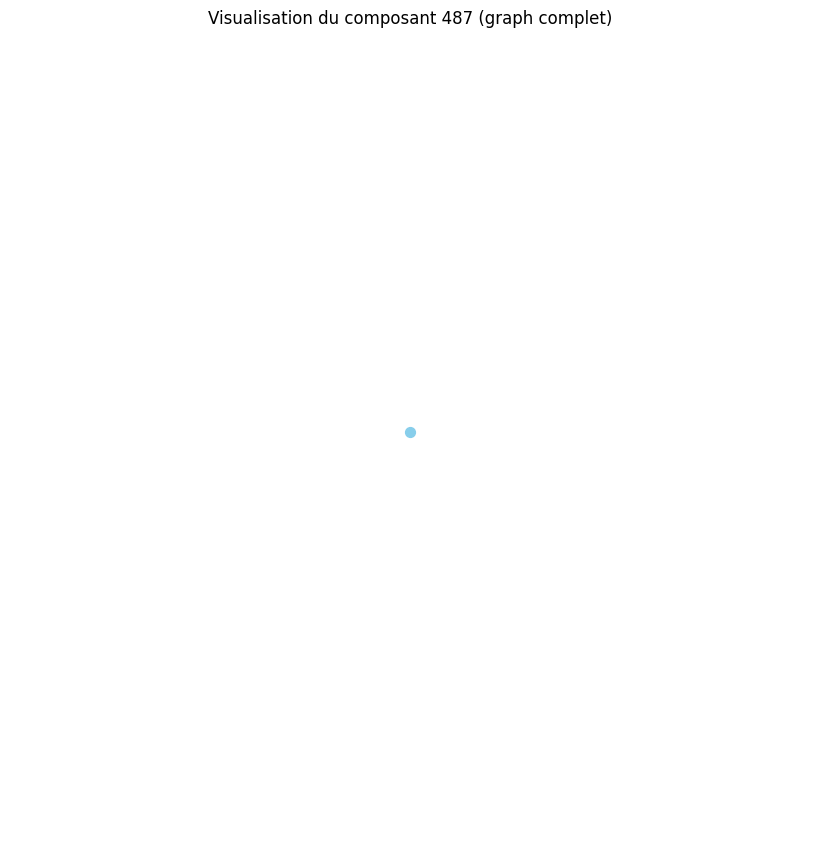

Distance moyenne pour le composant 488 : 0.00
Le composant 488 est un graphe complet ou très densément connecté.
Densité du composant 488 : 0.00
Degré moyen du composant 488 : 0.00
Coefficient de clustering moyen du composant 488 : 0.00


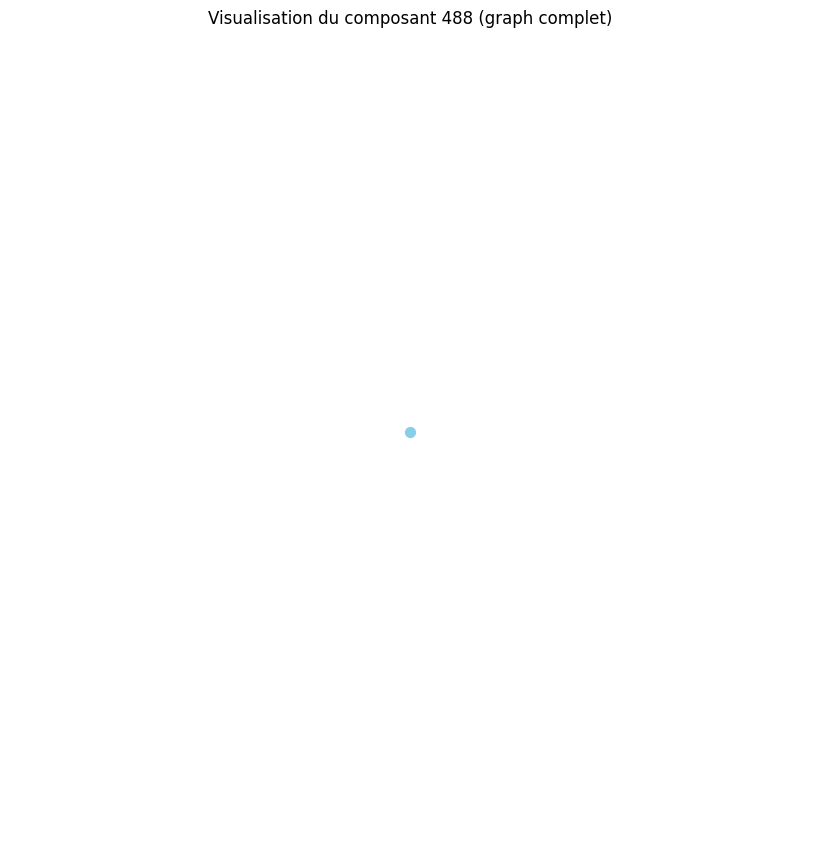

Distance moyenne pour le composant 489 : 0.00
Le composant 489 est un graphe complet ou très densément connecté.
Densité du composant 489 : 0.00
Degré moyen du composant 489 : 0.00
Coefficient de clustering moyen du composant 489 : 0.00


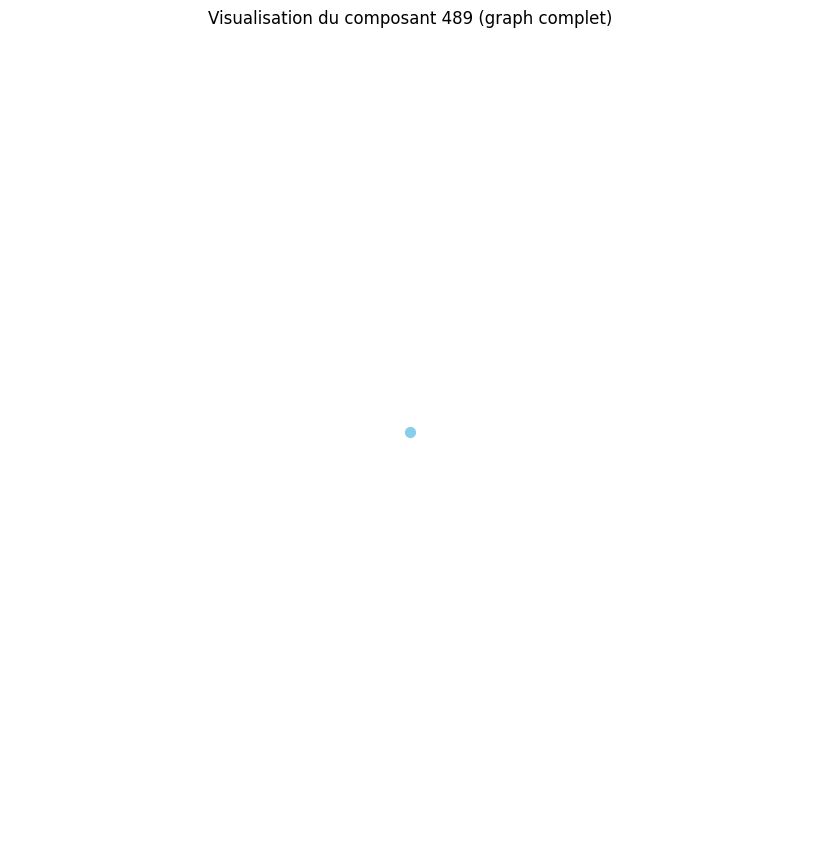

Distance moyenne pour le composant 490 : 0.00
Le composant 490 est un graphe complet ou très densément connecté.
Densité du composant 490 : 0.00
Degré moyen du composant 490 : 0.00
Coefficient de clustering moyen du composant 490 : 0.00


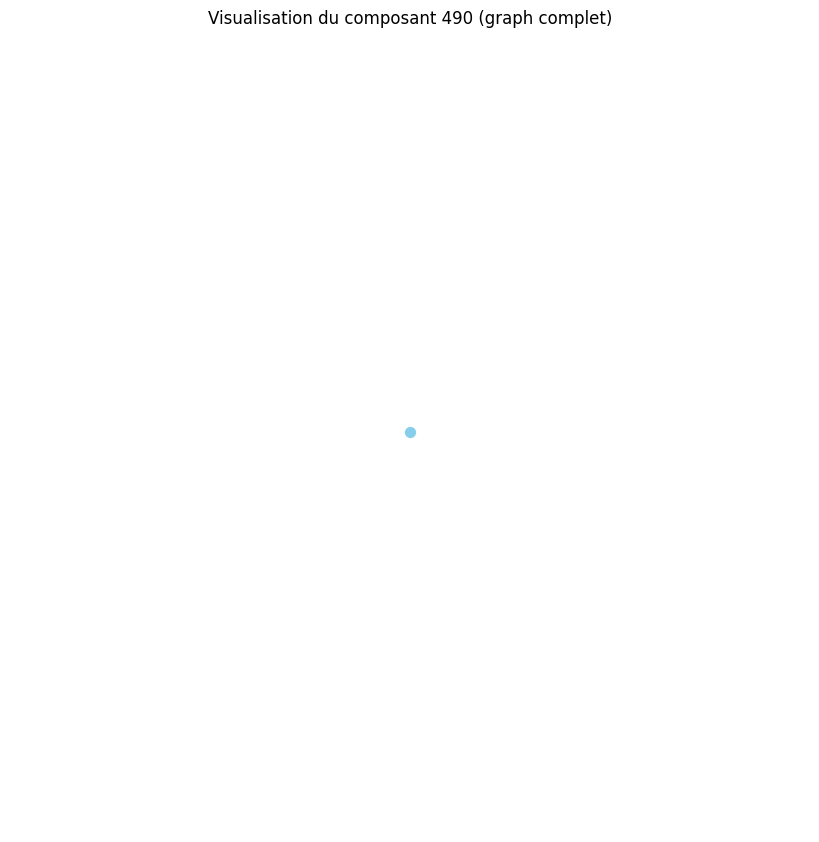

Distance moyenne pour le composant 491 : 0.00
Le composant 491 est un graphe complet ou très densément connecté.
Densité du composant 491 : 0.00
Degré moyen du composant 491 : 0.00
Coefficient de clustering moyen du composant 491 : 0.00


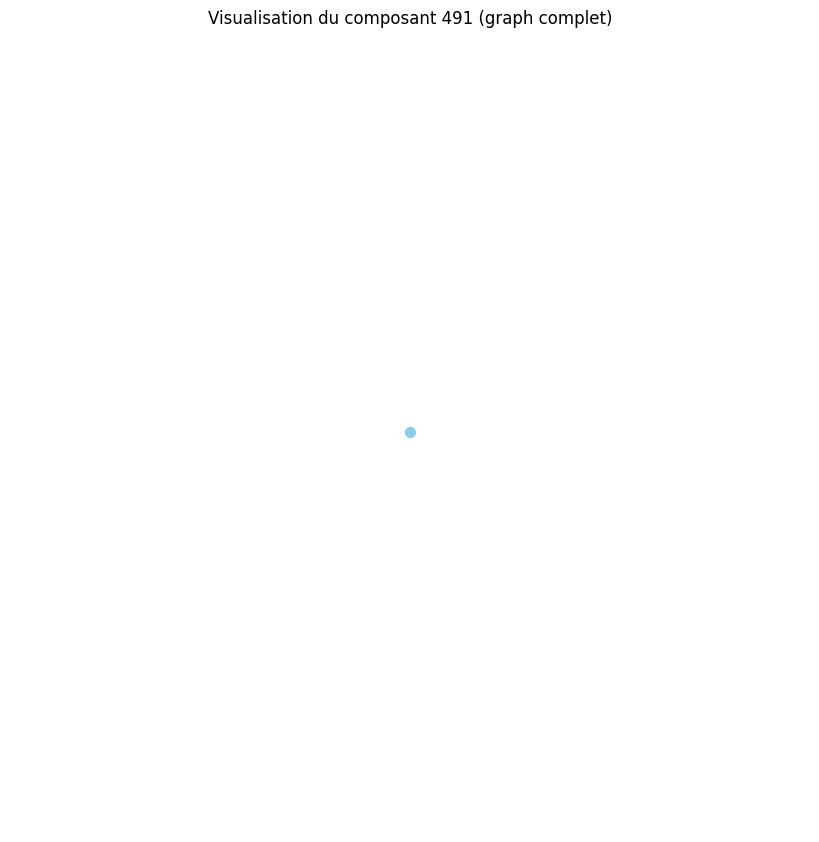

Distance moyenne pour le composant 492 : 0.00
Le composant 492 est un graphe complet ou très densément connecté.
Densité du composant 492 : 0.00
Degré moyen du composant 492 : 0.00
Coefficient de clustering moyen du composant 492 : 0.00


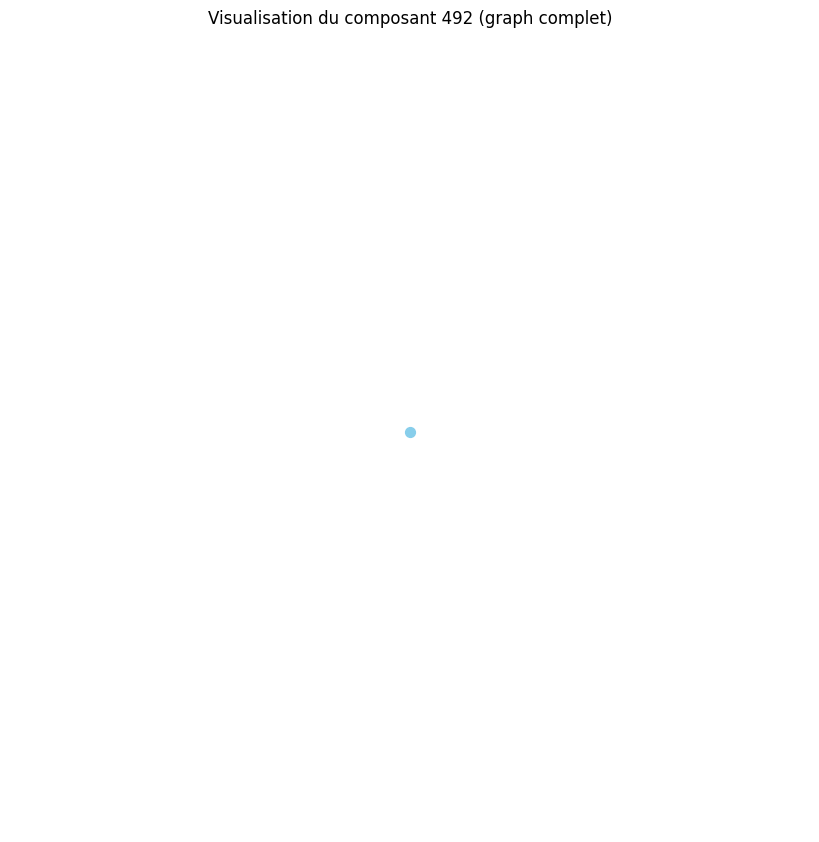

Distance moyenne pour le composant 493 : 0.00
Le composant 493 est un graphe complet ou très densément connecté.
Densité du composant 493 : 0.00
Degré moyen du composant 493 : 0.00
Coefficient de clustering moyen du composant 493 : 0.00


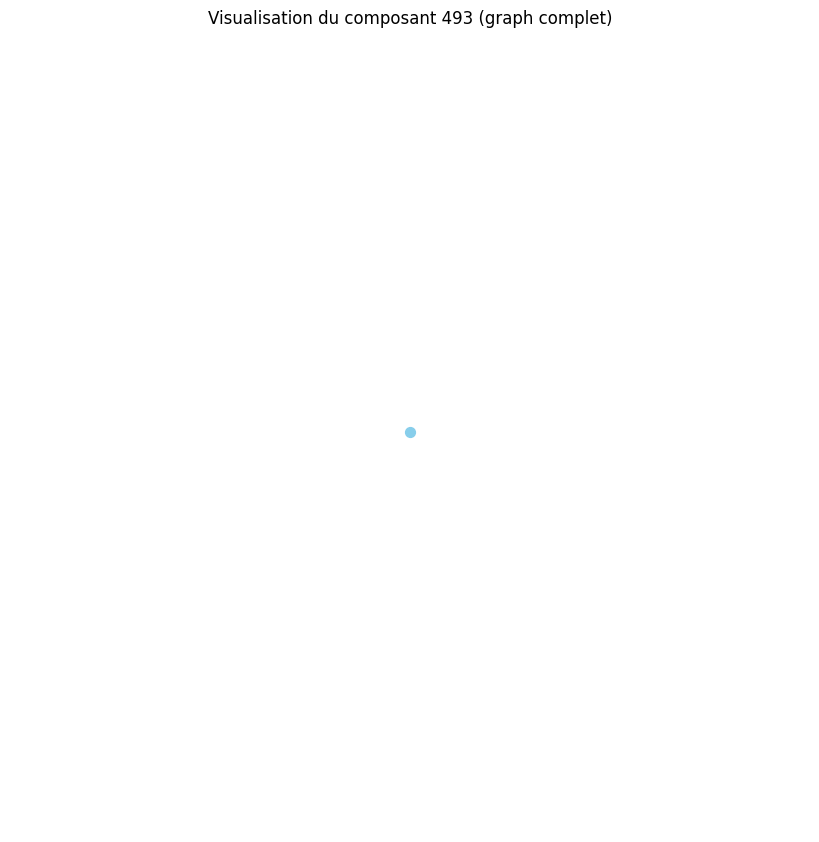

Distance moyenne pour le composant 494 : 0.00
Le composant 494 est un graphe complet ou très densément connecté.
Densité du composant 494 : 0.00
Degré moyen du composant 494 : 0.00
Coefficient de clustering moyen du composant 494 : 0.00


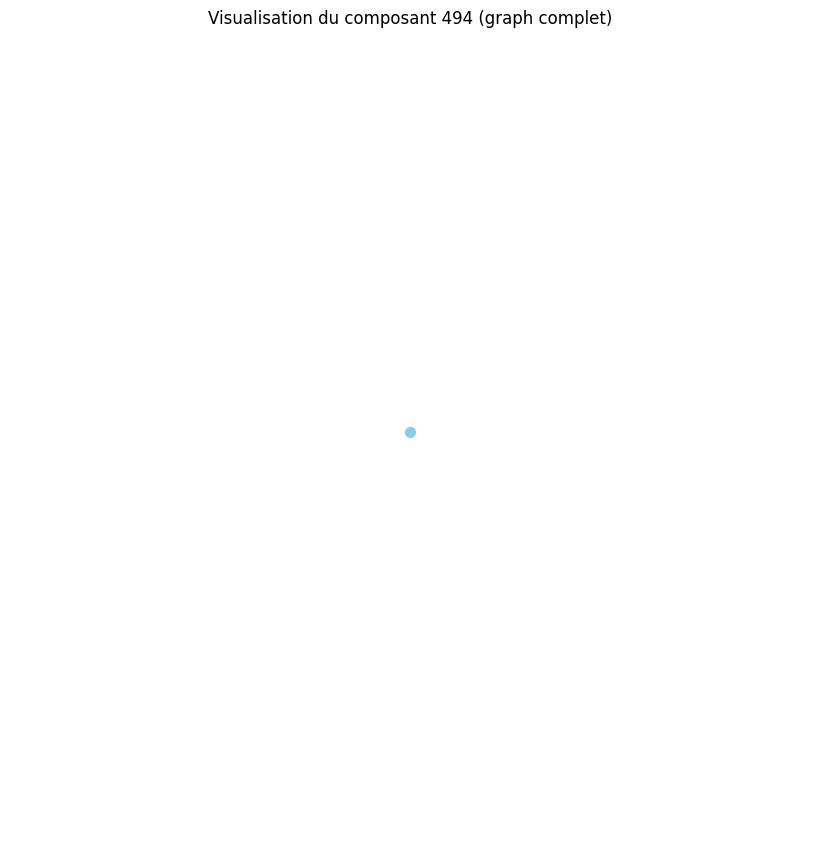

Distance moyenne pour le composant 495 : 0.00
Le composant 495 est un graphe complet ou très densément connecté.
Densité du composant 495 : 0.00
Degré moyen du composant 495 : 0.00
Coefficient de clustering moyen du composant 495 : 0.00


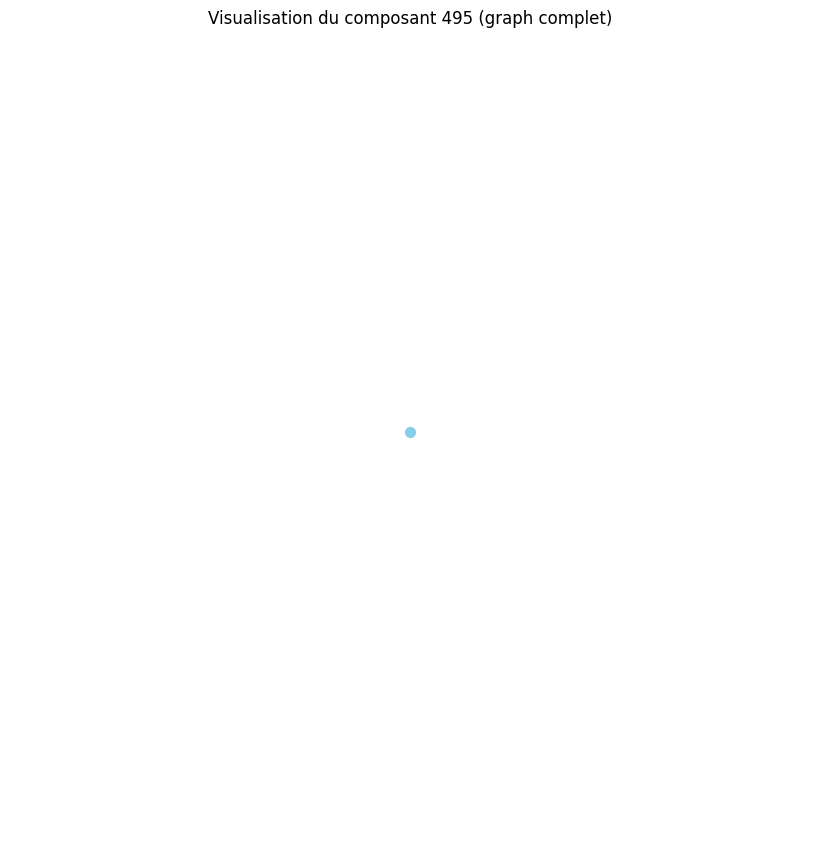

Distance moyenne pour le composant 496 : 0.00
Le composant 496 est un graphe complet ou très densément connecté.
Densité du composant 496 : 0.00
Degré moyen du composant 496 : 0.00
Coefficient de clustering moyen du composant 496 : 0.00


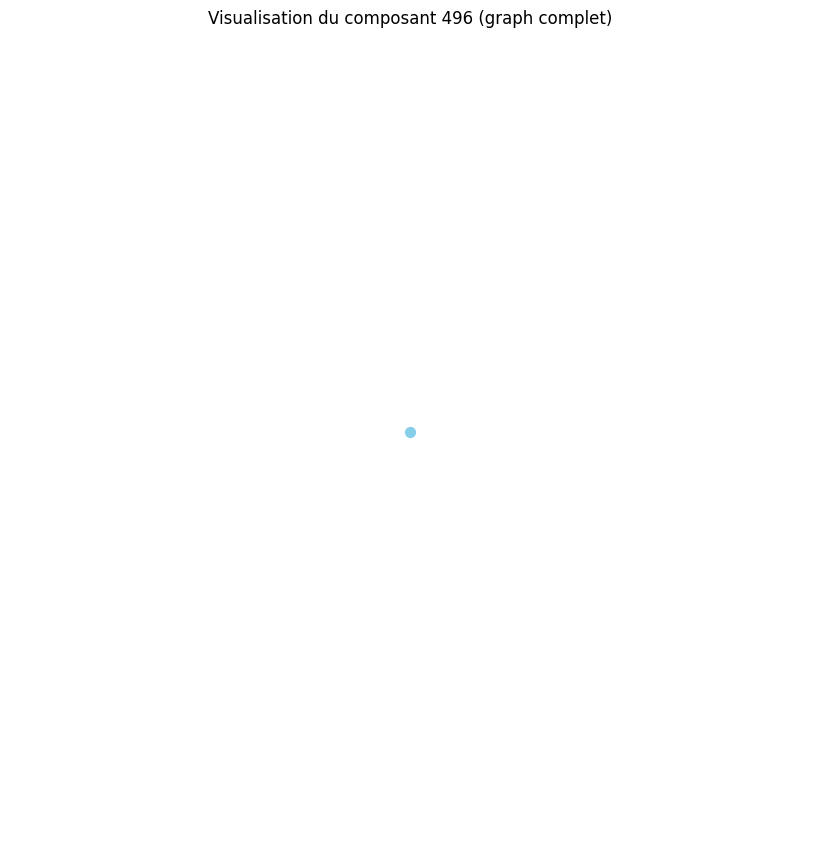

Distance moyenne pour le composant 497 : 0.00
Le composant 497 est un graphe complet ou très densément connecté.
Densité du composant 497 : 0.00
Degré moyen du composant 497 : 0.00
Coefficient de clustering moyen du composant 497 : 0.00


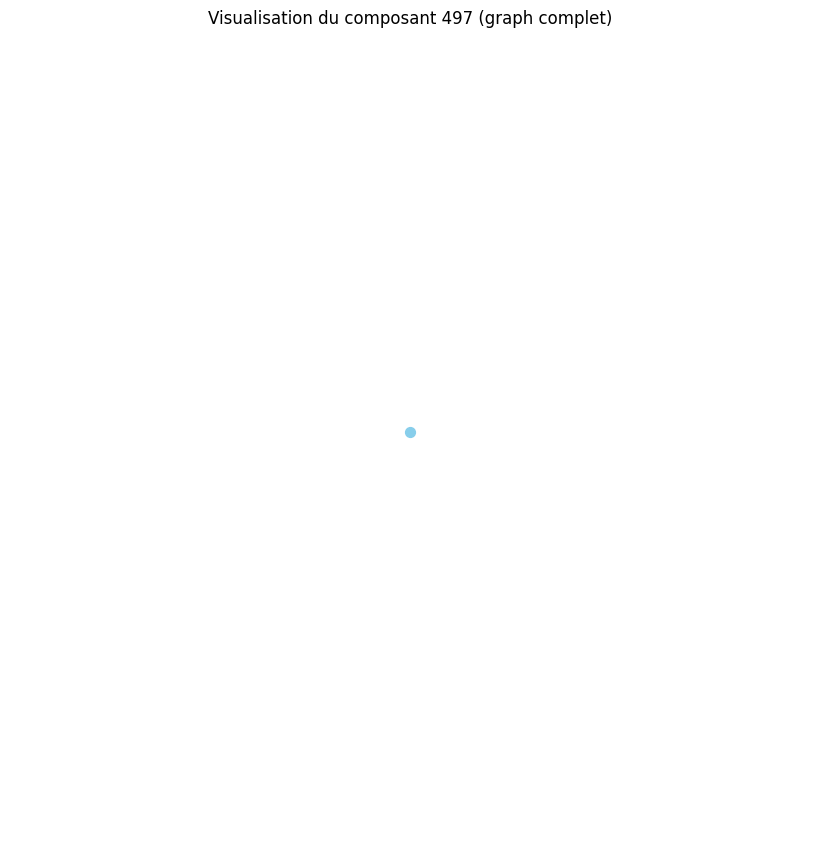

Distance moyenne pour le composant 498 : 0.00
Le composant 498 est un graphe complet ou très densément connecté.
Densité du composant 498 : 0.00
Degré moyen du composant 498 : 0.00
Coefficient de clustering moyen du composant 498 : 0.00


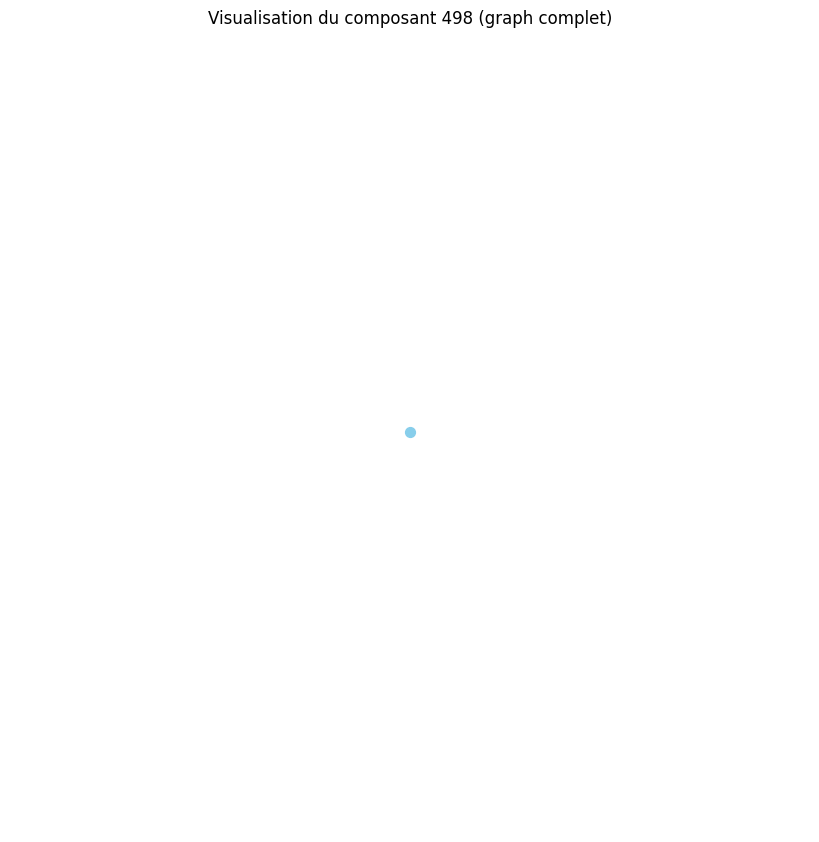

Distance moyenne pour le composant 499 : 0.00
Le composant 499 est un graphe complet ou très densément connecté.
Densité du composant 499 : 0.00
Degré moyen du composant 499 : 0.00
Coefficient de clustering moyen du composant 499 : 0.00


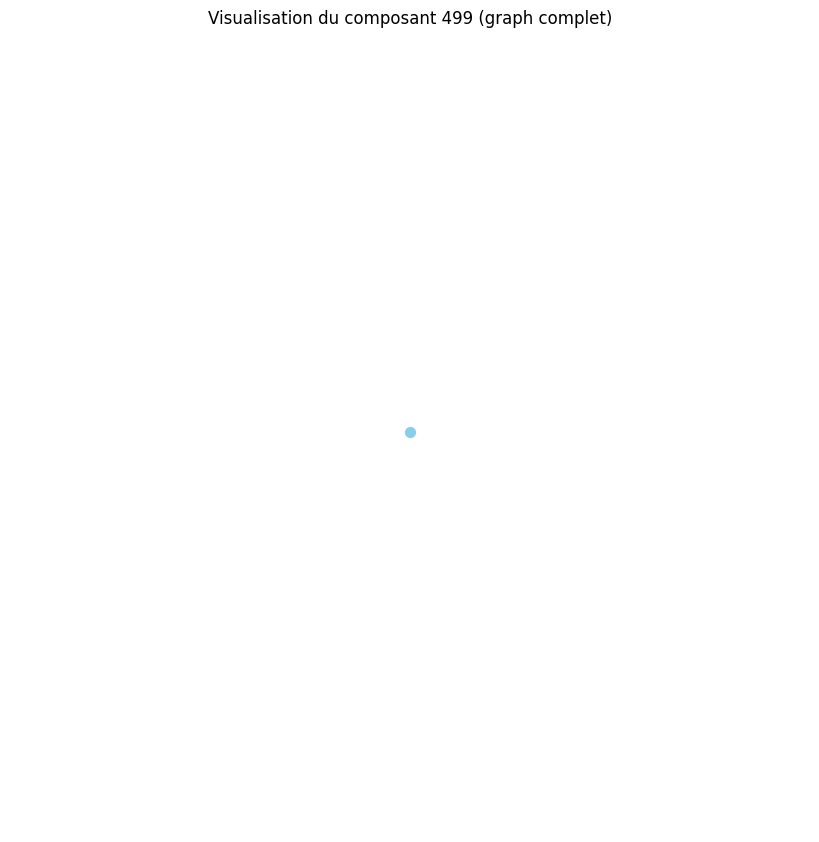

Distance moyenne pour le composant 500 : 0.00
Le composant 500 est un graphe complet ou très densément connecté.
Densité du composant 500 : 0.00
Degré moyen du composant 500 : 0.00
Coefficient de clustering moyen du composant 500 : 0.00


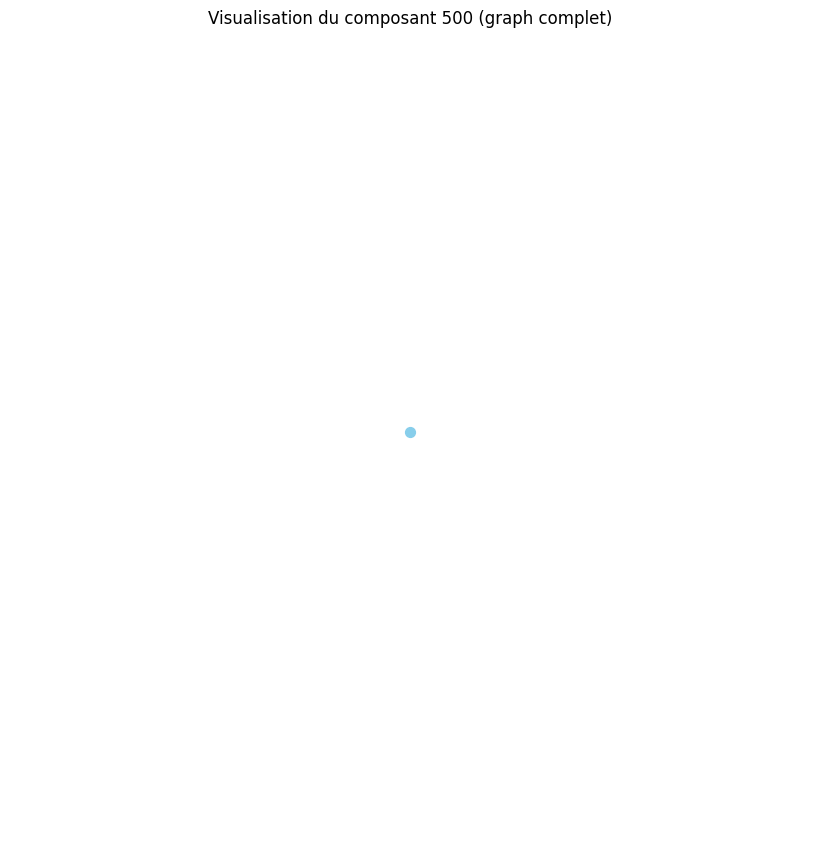

Distance moyenne pour le composant 501 : 0.00
Le composant 501 est un graphe complet ou très densément connecté.
Densité du composant 501 : 0.00
Degré moyen du composant 501 : 0.00
Coefficient de clustering moyen du composant 501 : 0.00


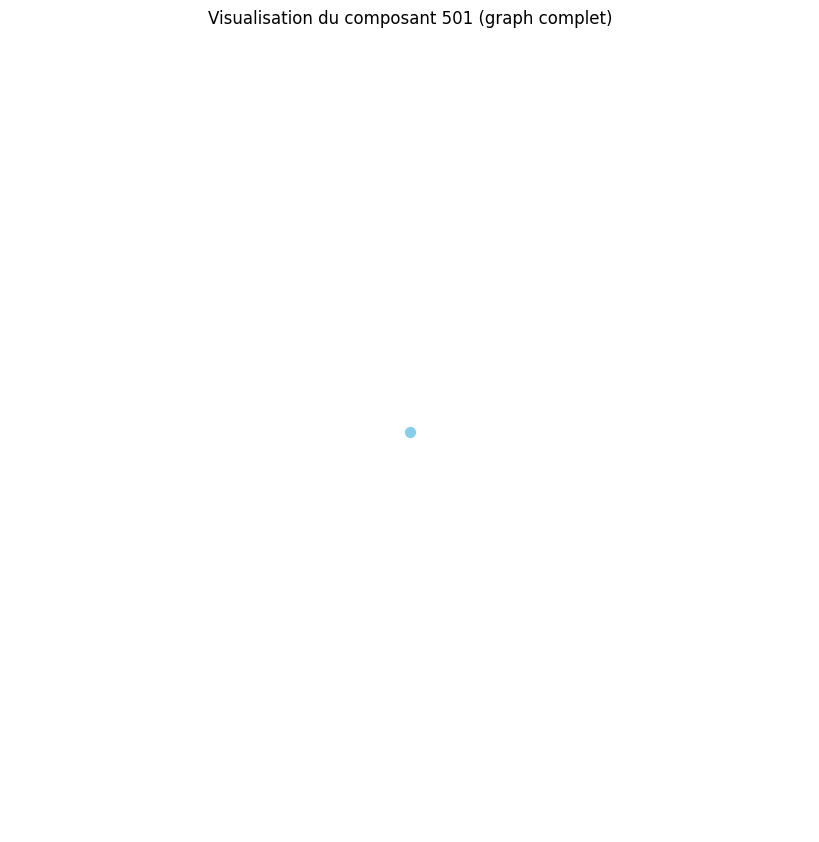

Distance moyenne pour le composant 502 : 0.00
Le composant 502 est un graphe complet ou très densément connecté.
Densité du composant 502 : 0.00
Degré moyen du composant 502 : 0.00
Coefficient de clustering moyen du composant 502 : 0.00


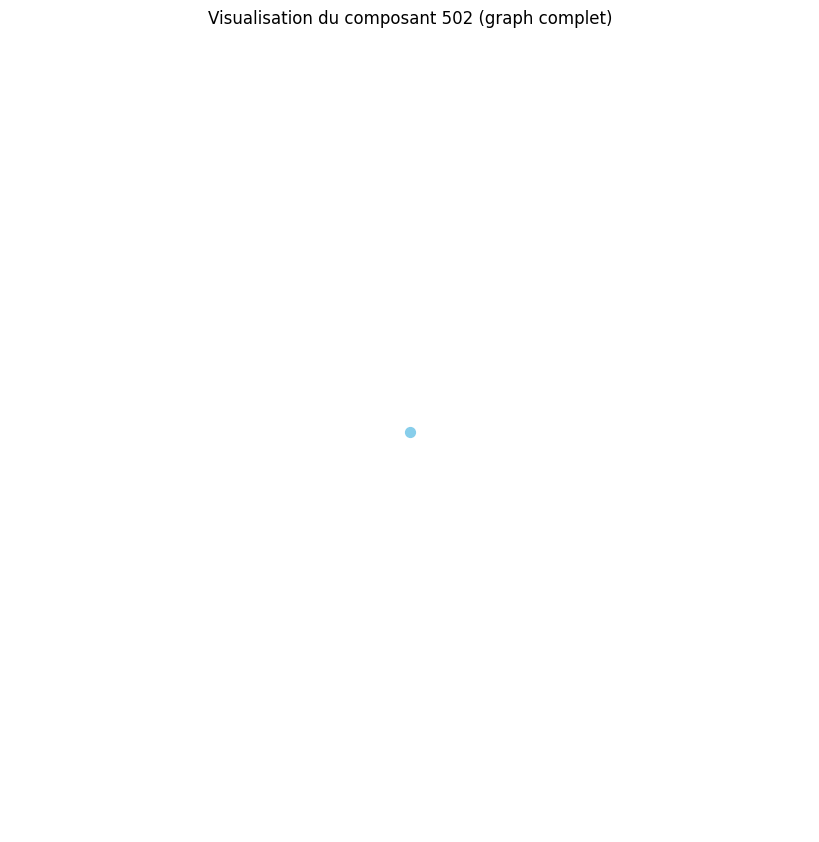

Distance moyenne pour le composant 503 : 0.00
Le composant 503 est un graphe complet ou très densément connecté.
Densité du composant 503 : 0.00
Degré moyen du composant 503 : 0.00
Coefficient de clustering moyen du composant 503 : 0.00


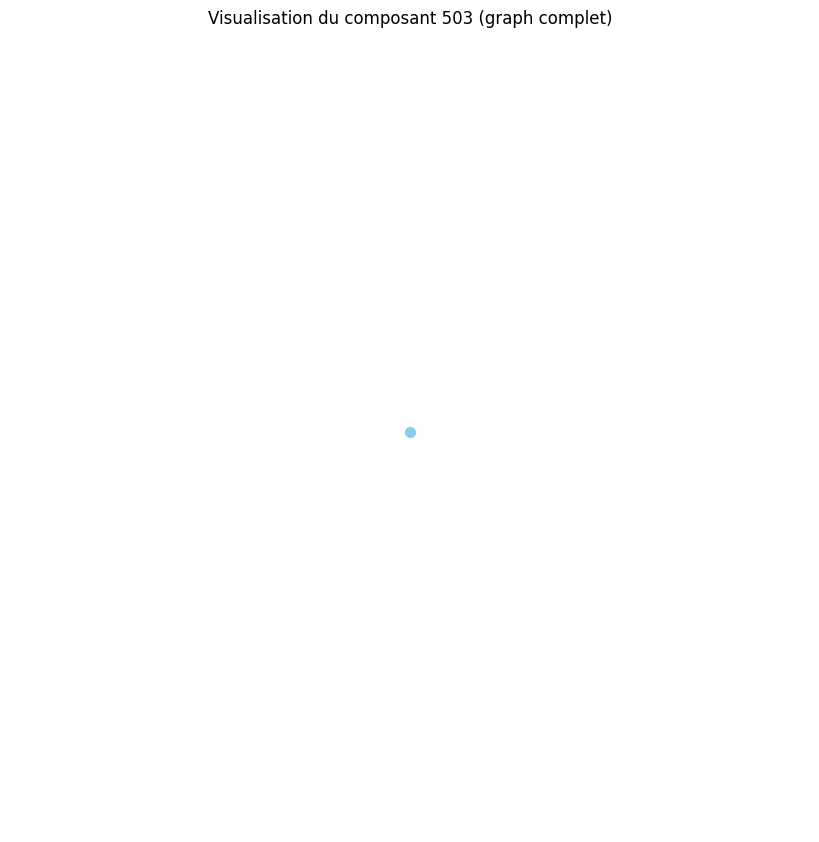

Distance moyenne pour le composant 504 : 0.00
Le composant 504 est un graphe complet ou très densément connecté.
Densité du composant 504 : 0.00
Degré moyen du composant 504 : 0.00
Coefficient de clustering moyen du composant 504 : 0.00


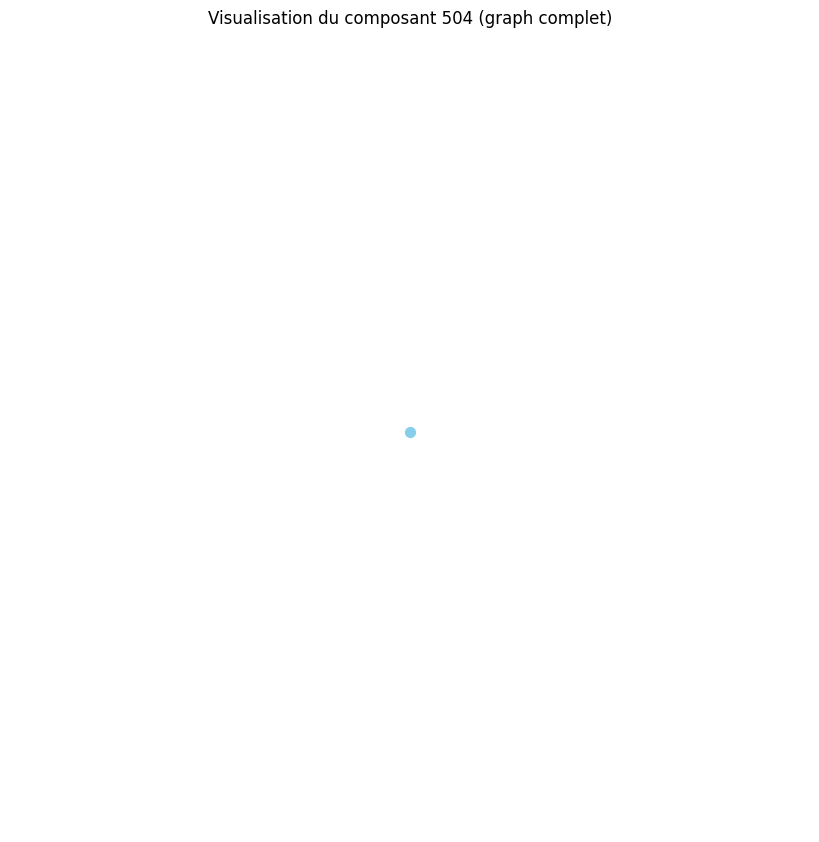

Distance moyenne pour le composant 505 : 0.00
Le composant 505 est un graphe complet ou très densément connecté.
Densité du composant 505 : 0.00
Degré moyen du composant 505 : 0.00
Coefficient de clustering moyen du composant 505 : 0.00


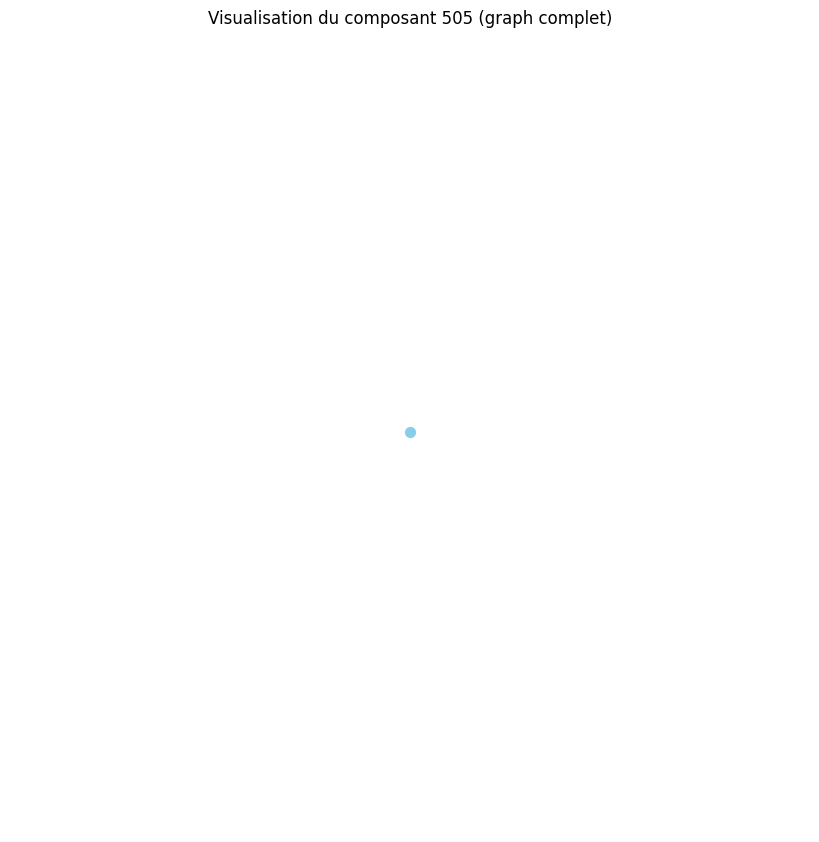

Distance moyenne pour le composant 506 : 0.00
Le composant 506 est un graphe complet ou très densément connecté.
Densité du composant 506 : 0.00
Degré moyen du composant 506 : 0.00
Coefficient de clustering moyen du composant 506 : 0.00


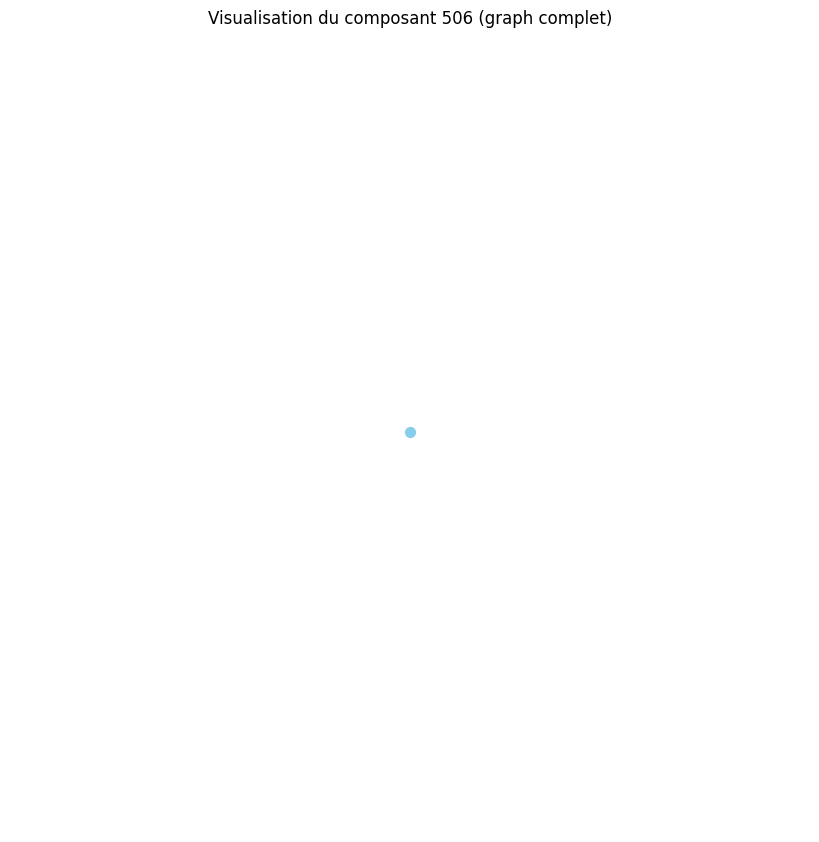

Distance moyenne pour le composant 507 : 1.50
Distance moyenne pour le composant 508 : 0.00
Le composant 508 est un graphe complet ou très densément connecté.
Densité du composant 508 : 0.00
Degré moyen du composant 508 : 0.00
Coefficient de clustering moyen du composant 508 : 0.00


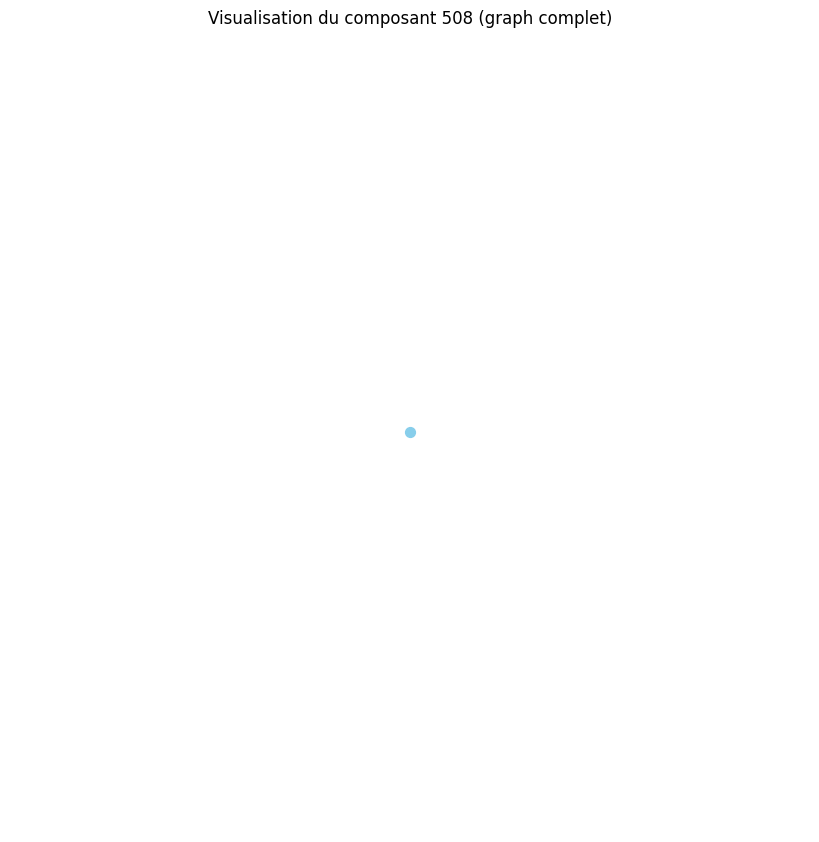

Distance moyenne pour le composant 509 : 0.00
Le composant 509 est un graphe complet ou très densément connecté.
Densité du composant 509 : 0.00
Degré moyen du composant 509 : 0.00
Coefficient de clustering moyen du composant 509 : 0.00


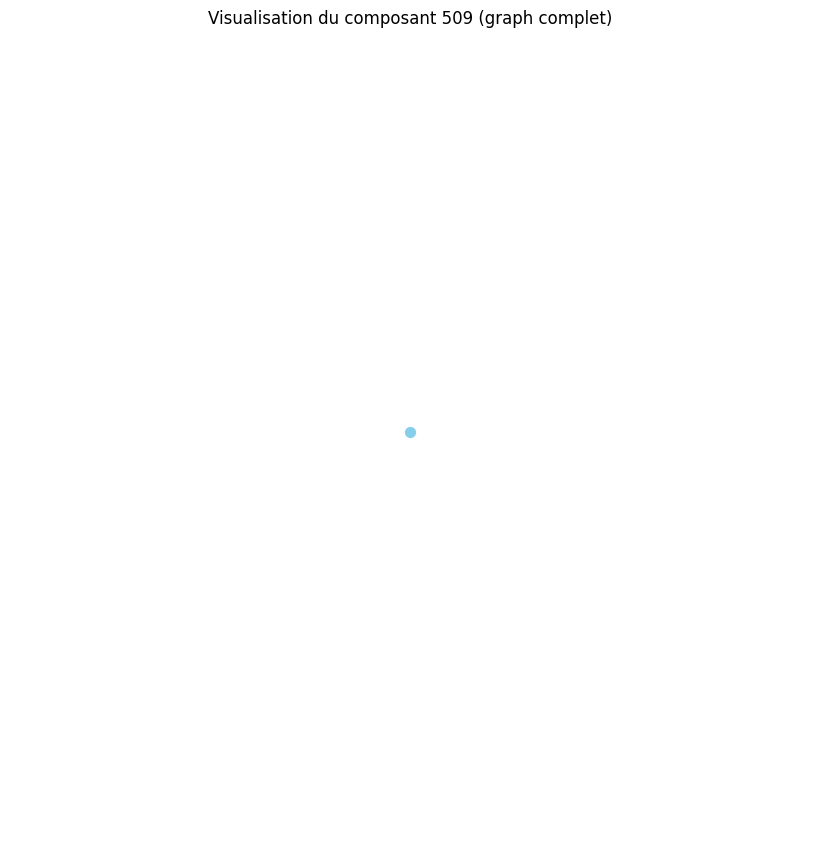

Distance moyenne pour le composant 510 : 0.00
Le composant 510 est un graphe complet ou très densément connecté.
Densité du composant 510 : 0.00
Degré moyen du composant 510 : 0.00
Coefficient de clustering moyen du composant 510 : 0.00


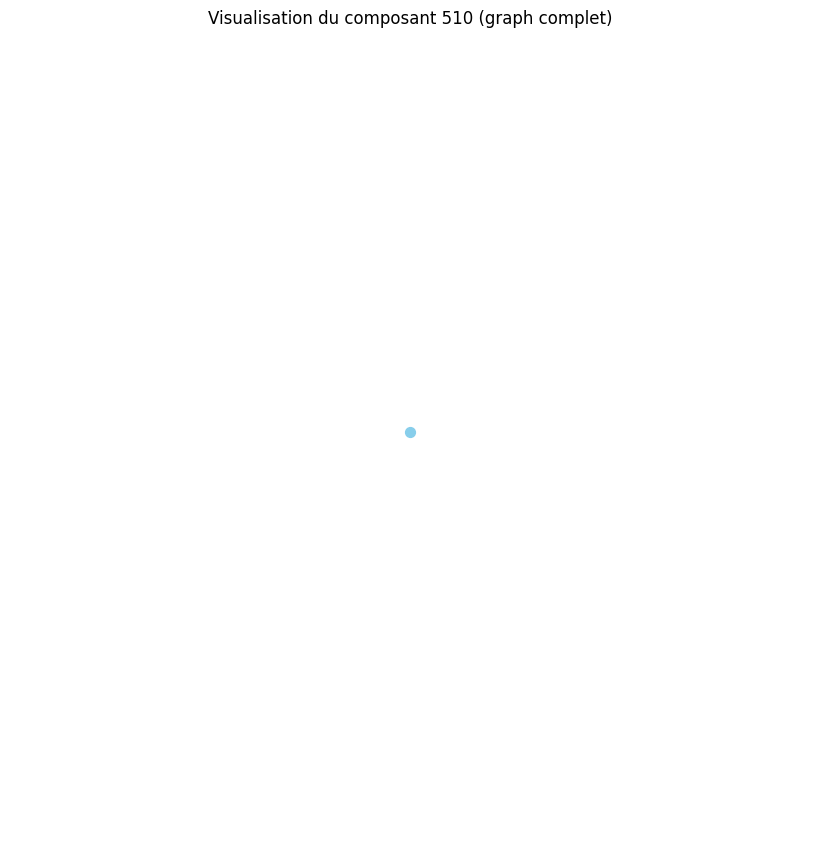

Distance moyenne pour le composant 511 : 0.00
Le composant 511 est un graphe complet ou très densément connecté.
Densité du composant 511 : 0.00
Degré moyen du composant 511 : 0.00
Coefficient de clustering moyen du composant 511 : 0.00


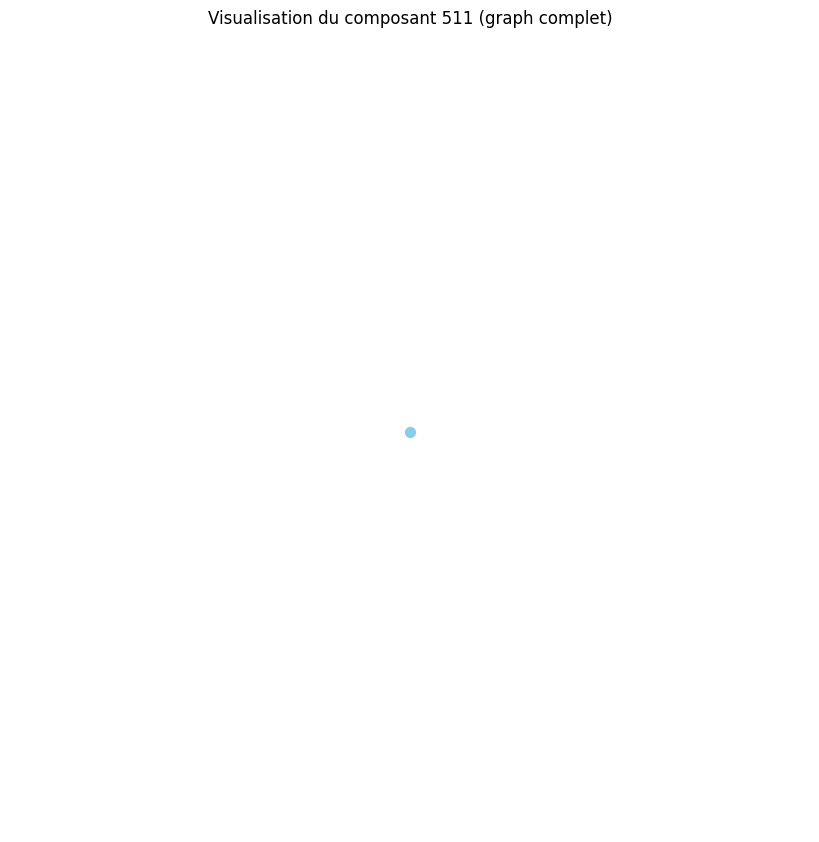

Distance moyenne pour le composant 512 : 0.00
Le composant 512 est un graphe complet ou très densément connecté.
Densité du composant 512 : 0.00
Degré moyen du composant 512 : 0.00
Coefficient de clustering moyen du composant 512 : 0.00


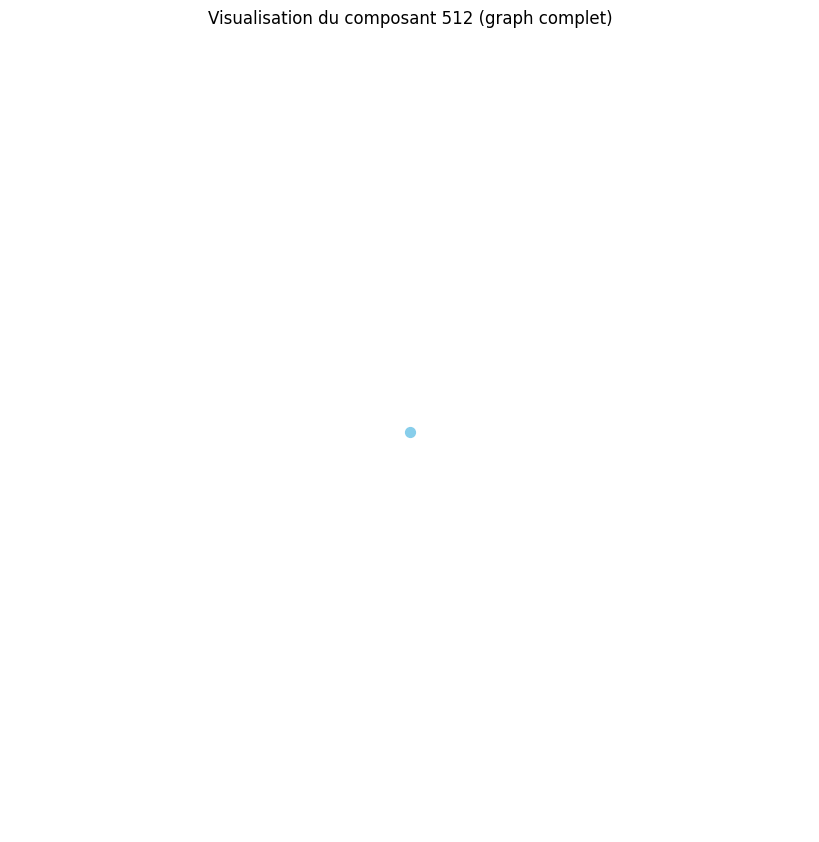

Distance moyenne pour le composant 513 : 0.00
Le composant 513 est un graphe complet ou très densément connecté.
Densité du composant 513 : 0.00
Degré moyen du composant 513 : 0.00
Coefficient de clustering moyen du composant 513 : 0.00


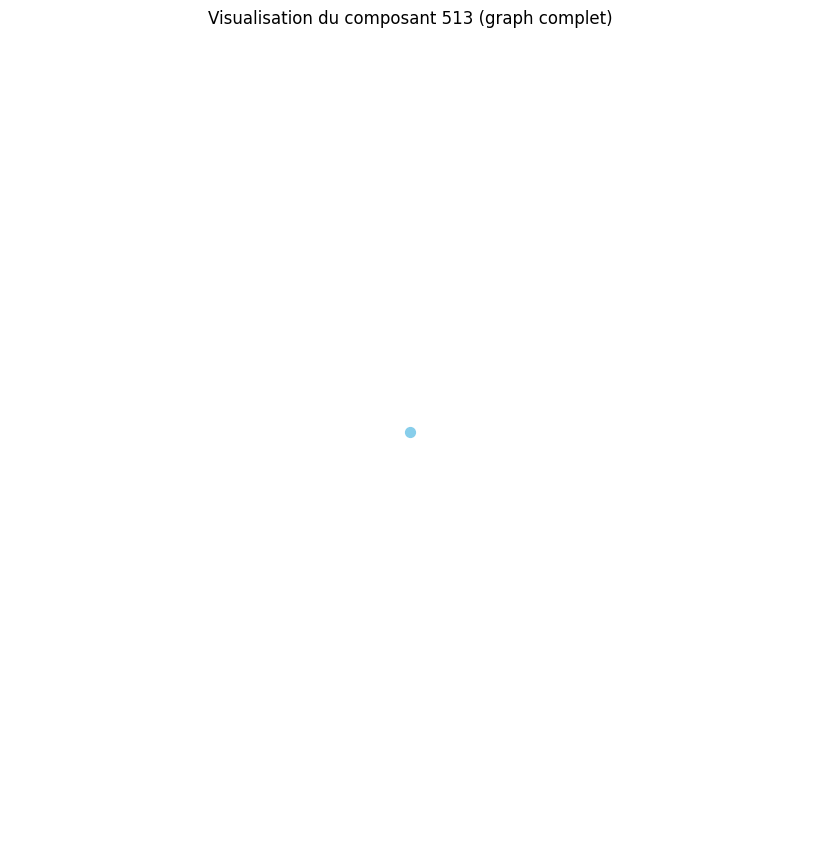

Distance moyenne pour le composant 514 : 0.00
Le composant 514 est un graphe complet ou très densément connecté.
Densité du composant 514 : 0.00
Degré moyen du composant 514 : 0.00
Coefficient de clustering moyen du composant 514 : 0.00


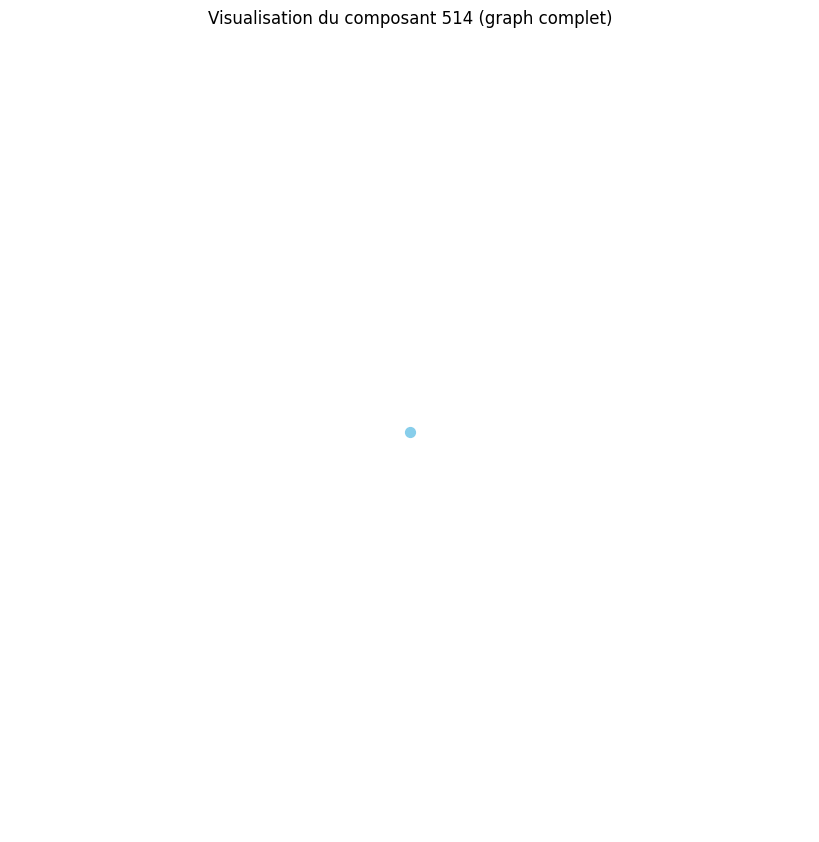

Distance moyenne pour le composant 515 : 0.00
Le composant 515 est un graphe complet ou très densément connecté.
Densité du composant 515 : 0.00
Degré moyen du composant 515 : 0.00
Coefficient de clustering moyen du composant 515 : 0.00


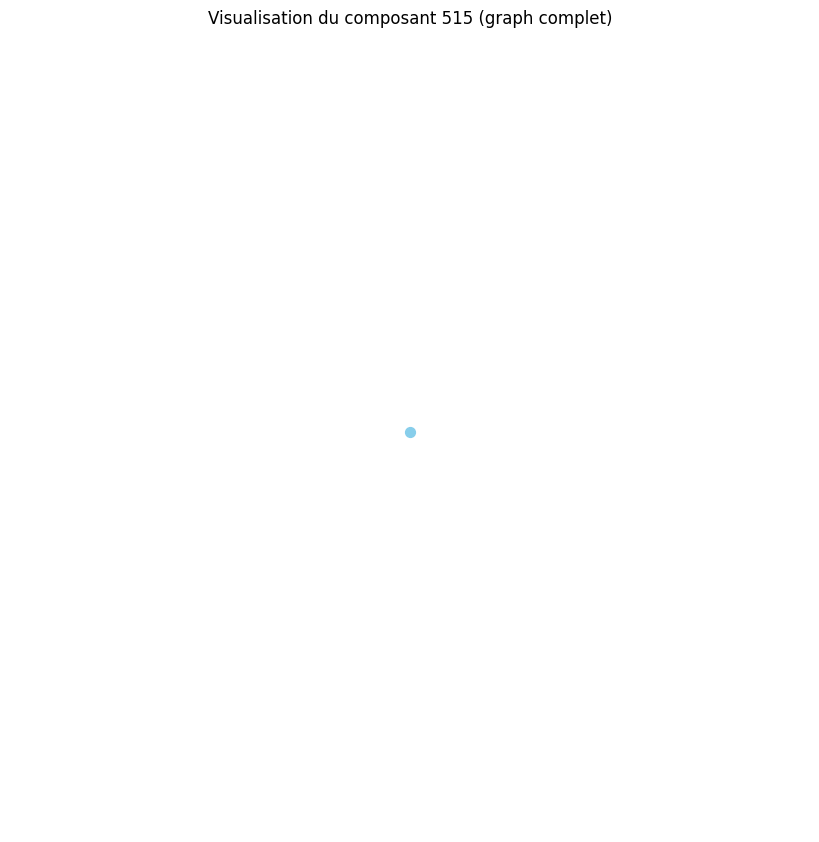

Distance moyenne pour le composant 516 : 0.00
Le composant 516 est un graphe complet ou très densément connecté.
Densité du composant 516 : 0.00
Degré moyen du composant 516 : 0.00
Coefficient de clustering moyen du composant 516 : 0.00


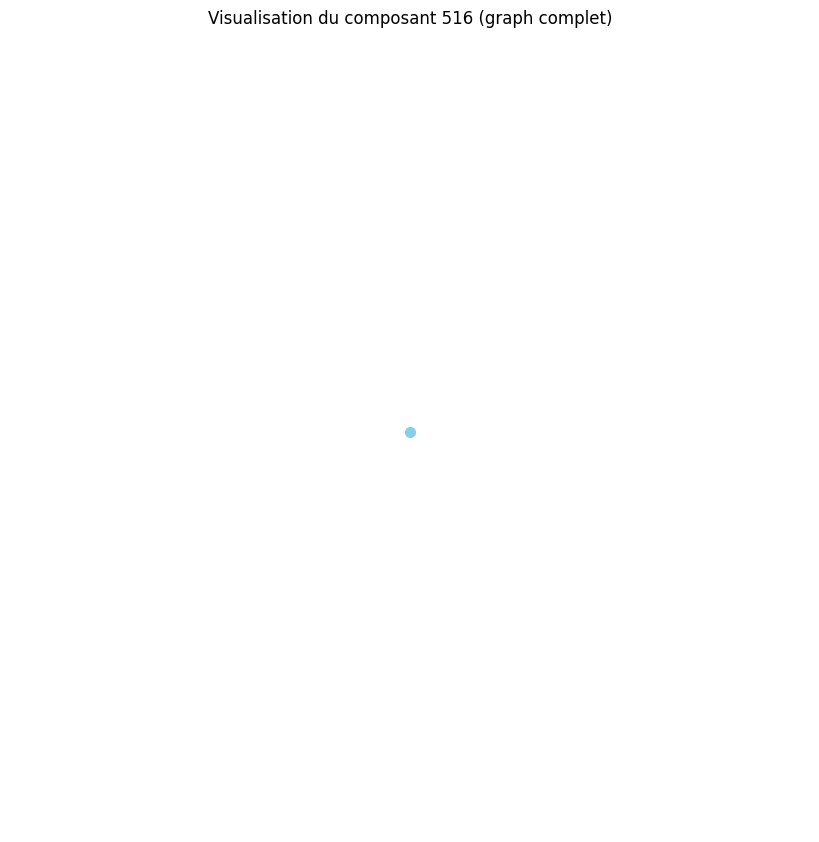

Distance moyenne pour le composant 517 : 0.00
Le composant 517 est un graphe complet ou très densément connecté.
Densité du composant 517 : 0.00
Degré moyen du composant 517 : 0.00
Coefficient de clustering moyen du composant 517 : 0.00


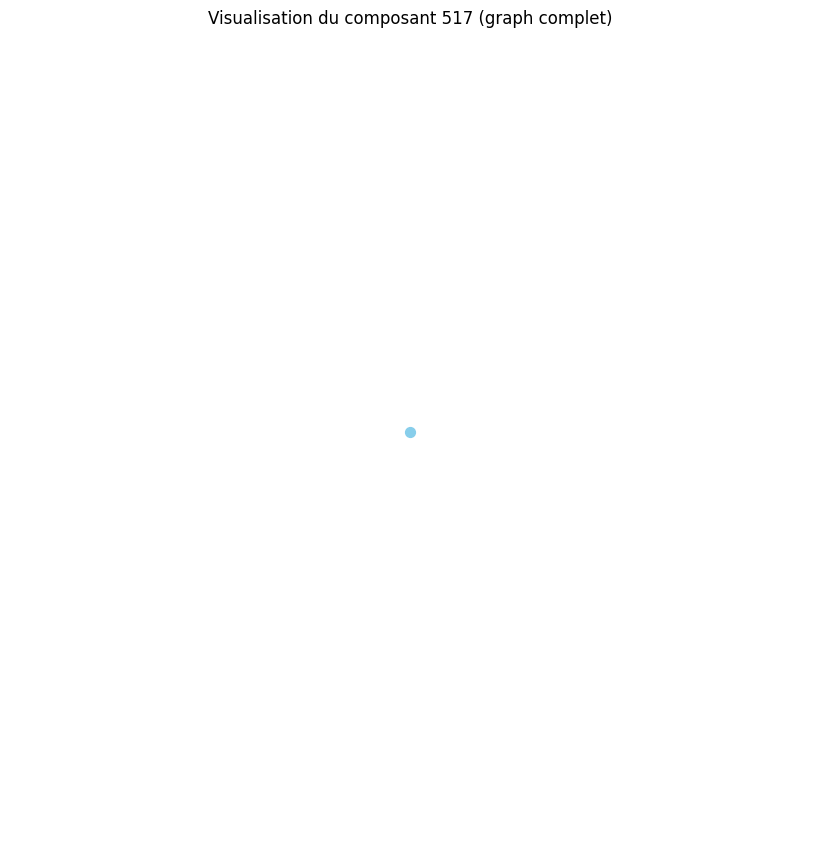

Distance moyenne pour le composant 518 : 0.00
Le composant 518 est un graphe complet ou très densément connecté.
Densité du composant 518 : 0.00
Degré moyen du composant 518 : 0.00
Coefficient de clustering moyen du composant 518 : 0.00


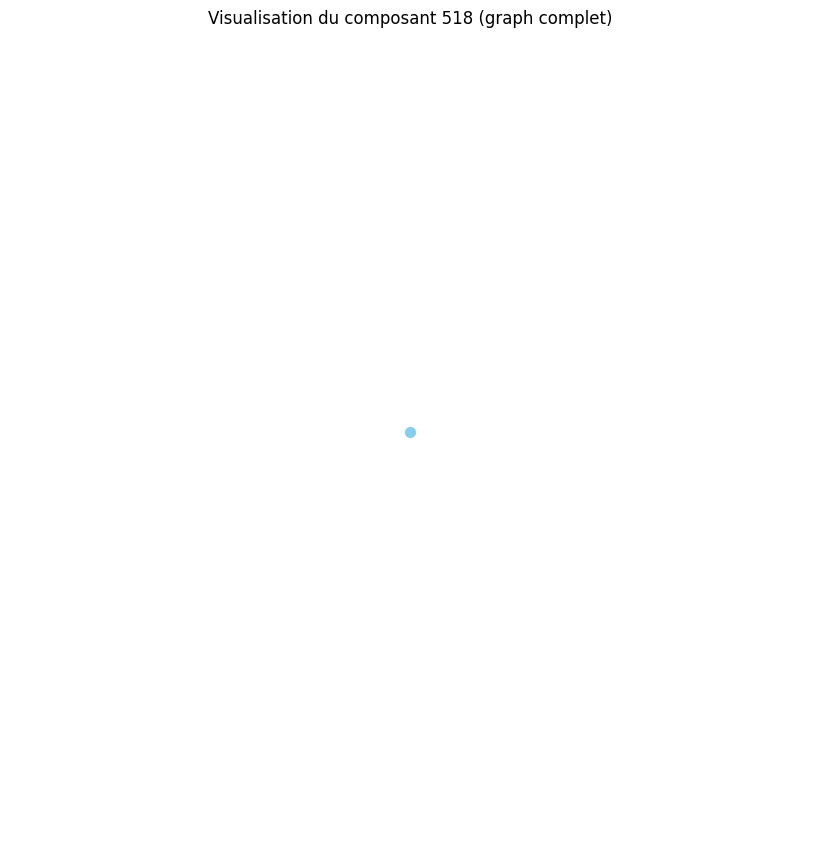

Distance moyenne pour le composant 519 : 0.00
Le composant 519 est un graphe complet ou très densément connecté.
Densité du composant 519 : 0.00
Degré moyen du composant 519 : 0.00
Coefficient de clustering moyen du composant 519 : 0.00


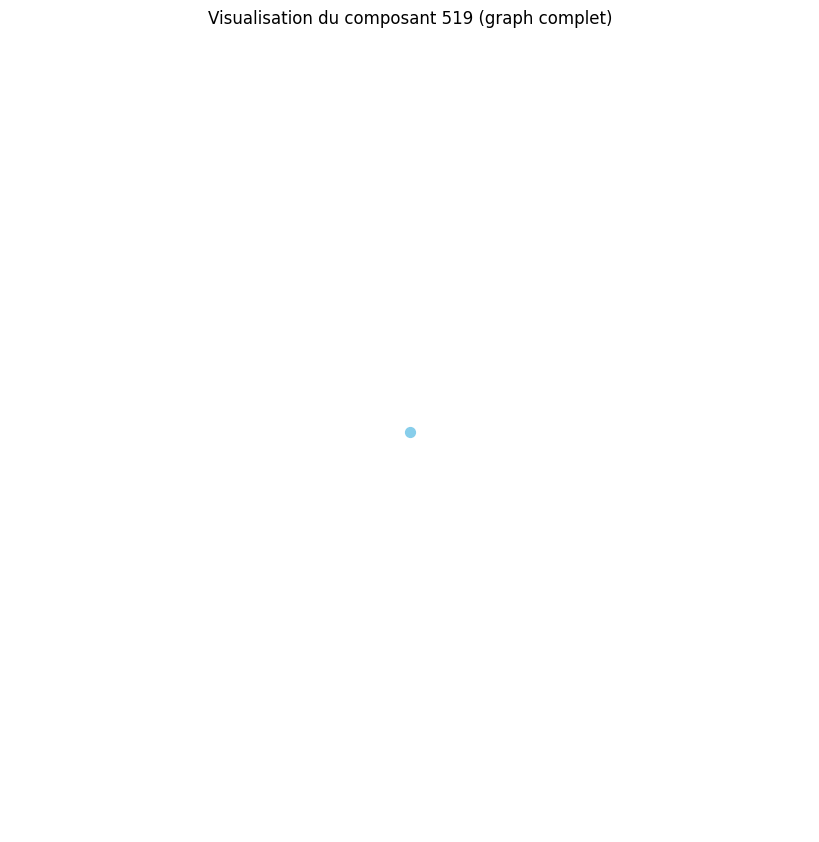

Distance moyenne pour le composant 520 : 0.00
Le composant 520 est un graphe complet ou très densément connecté.
Densité du composant 520 : 0.00
Degré moyen du composant 520 : 0.00
Coefficient de clustering moyen du composant 520 : 0.00


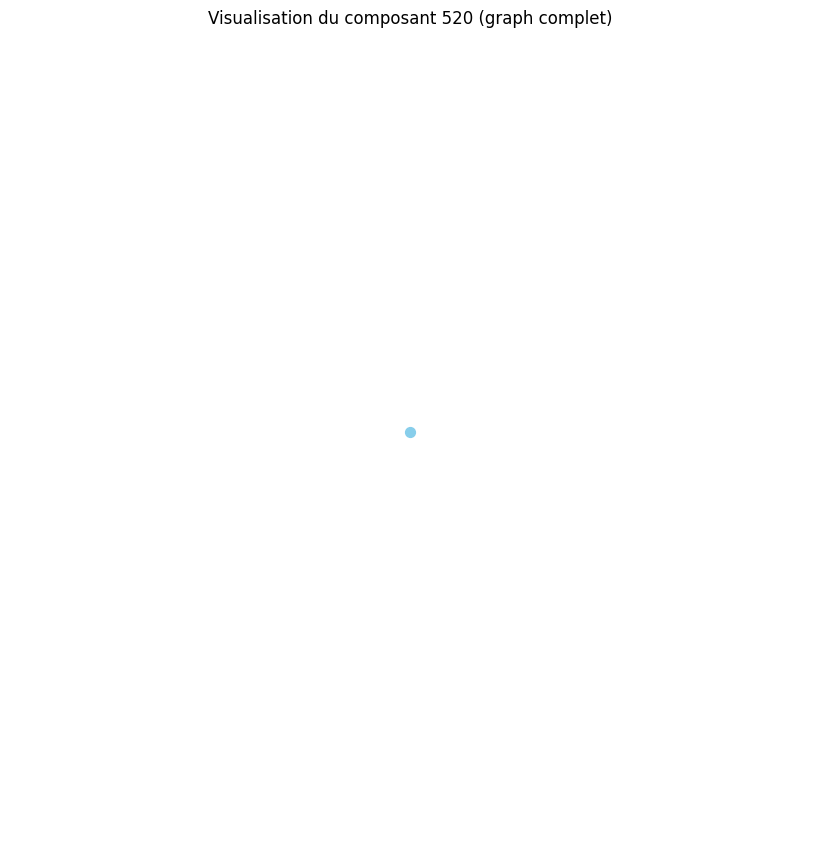

Distance moyenne pour le composant 521 : 0.00
Le composant 521 est un graphe complet ou très densément connecté.
Densité du composant 521 : 0.00
Degré moyen du composant 521 : 0.00
Coefficient de clustering moyen du composant 521 : 0.00


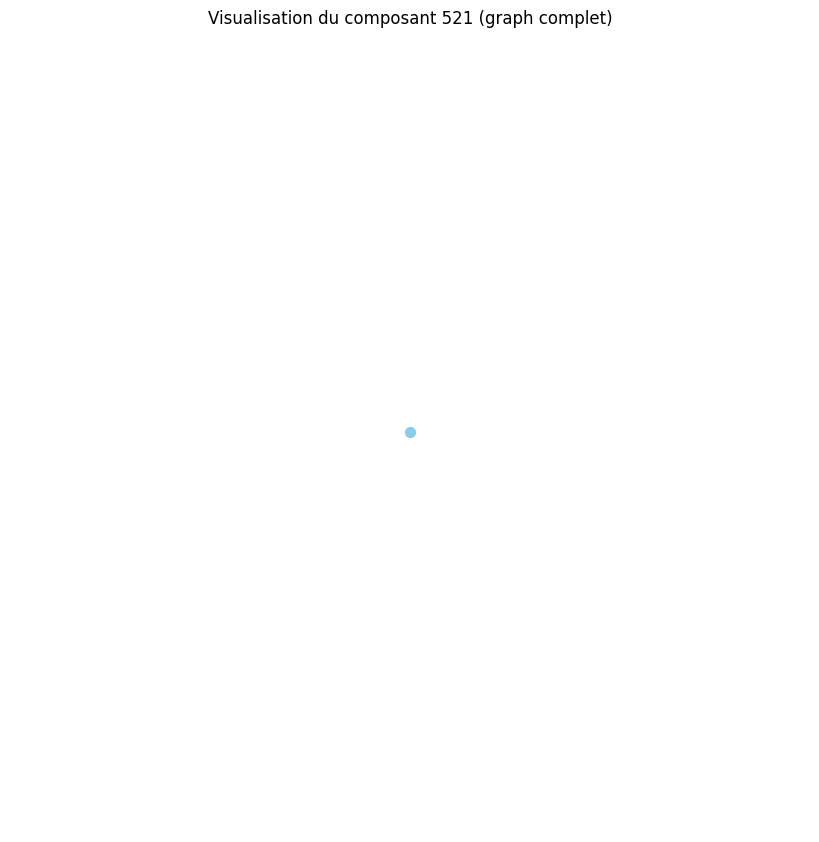

Distance moyenne pour le composant 522 : 0.00
Le composant 522 est un graphe complet ou très densément connecté.
Densité du composant 522 : 0.00
Degré moyen du composant 522 : 0.00
Coefficient de clustering moyen du composant 522 : 0.00


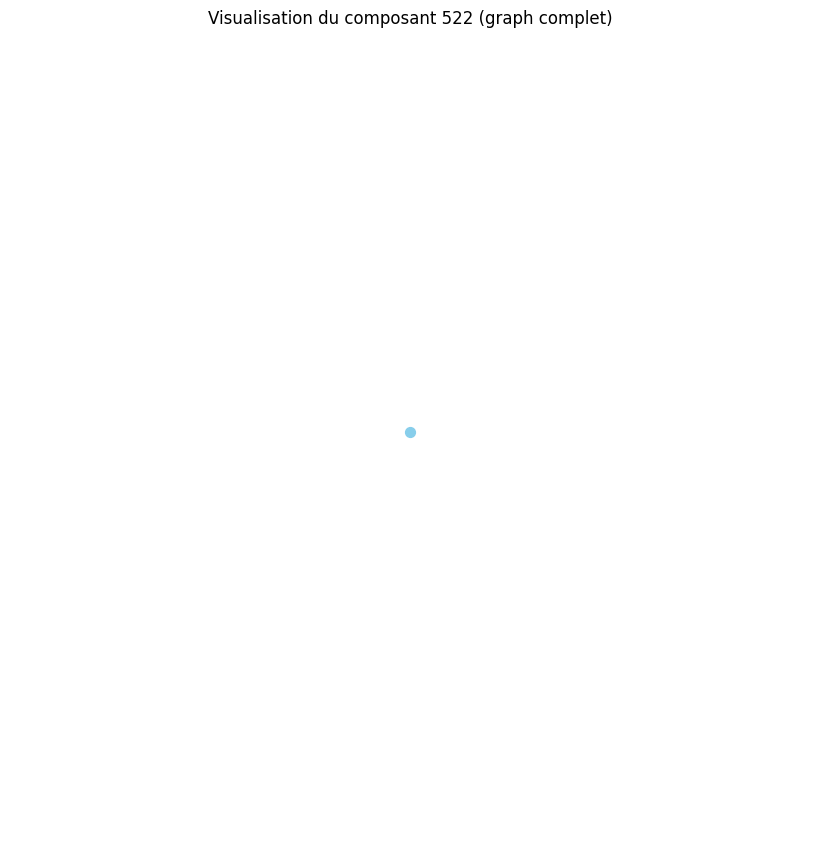

Distance moyenne pour le composant 523 : 0.00
Le composant 523 est un graphe complet ou très densément connecté.
Densité du composant 523 : 0.00
Degré moyen du composant 523 : 0.00
Coefficient de clustering moyen du composant 523 : 0.00


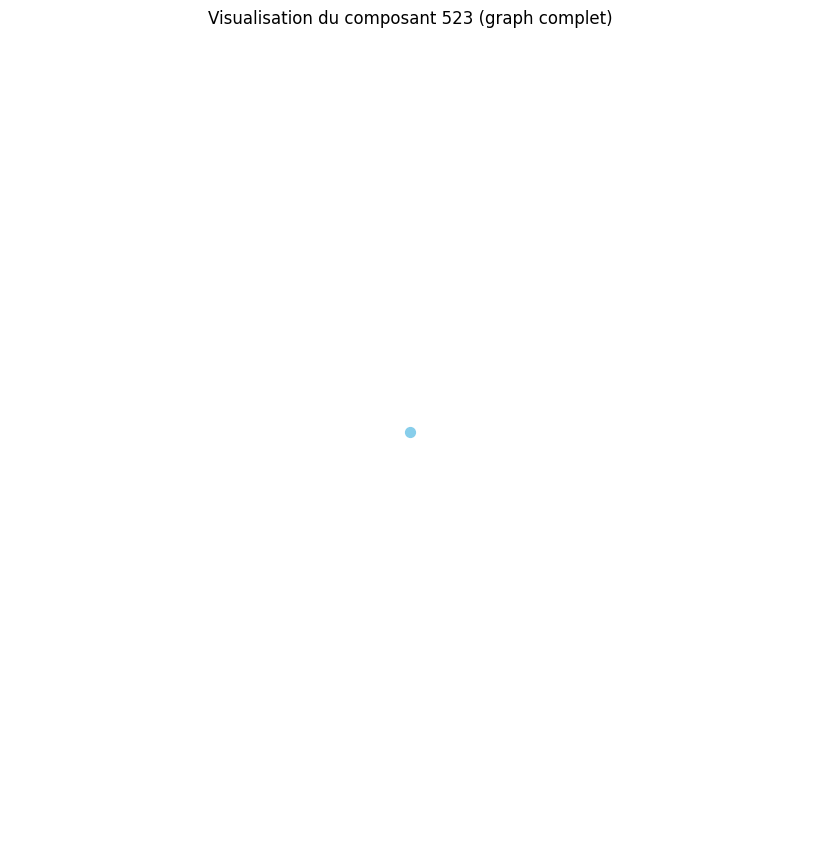

Distance moyenne pour le composant 524 : 0.00
Le composant 524 est un graphe complet ou très densément connecté.
Densité du composant 524 : 0.00
Degré moyen du composant 524 : 0.00
Coefficient de clustering moyen du composant 524 : 0.00


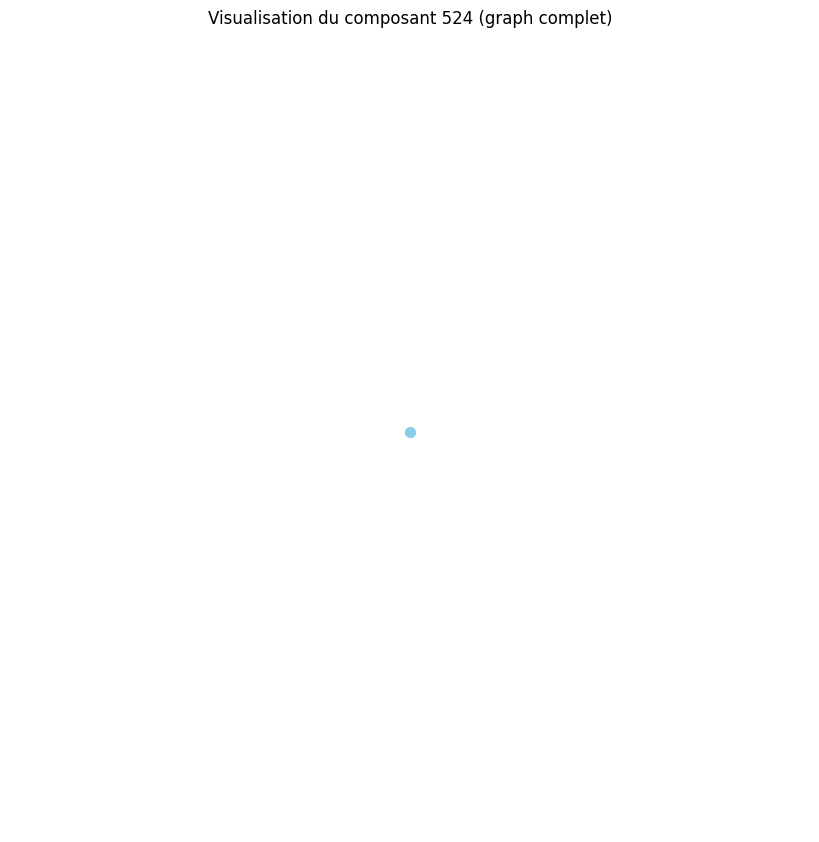

Distance moyenne pour le composant 525 : 0.00
Le composant 525 est un graphe complet ou très densément connecté.
Densité du composant 525 : 0.00
Degré moyen du composant 525 : 0.00
Coefficient de clustering moyen du composant 525 : 0.00


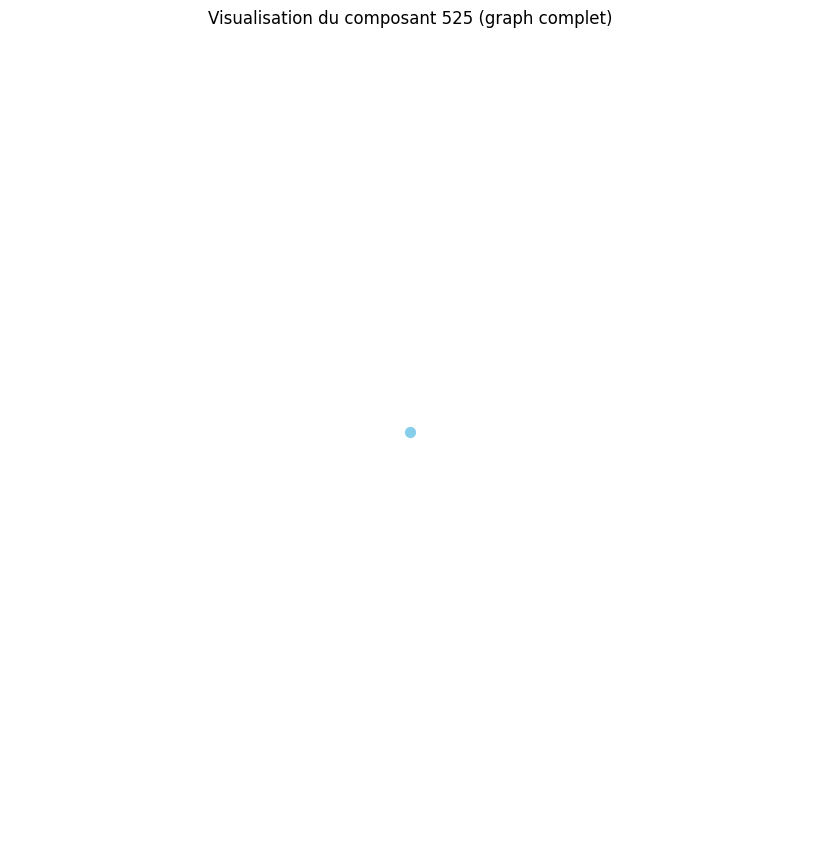

Distance moyenne pour le composant 526 : 0.00
Le composant 526 est un graphe complet ou très densément connecté.
Densité du composant 526 : 0.00
Degré moyen du composant 526 : 0.00
Coefficient de clustering moyen du composant 526 : 0.00


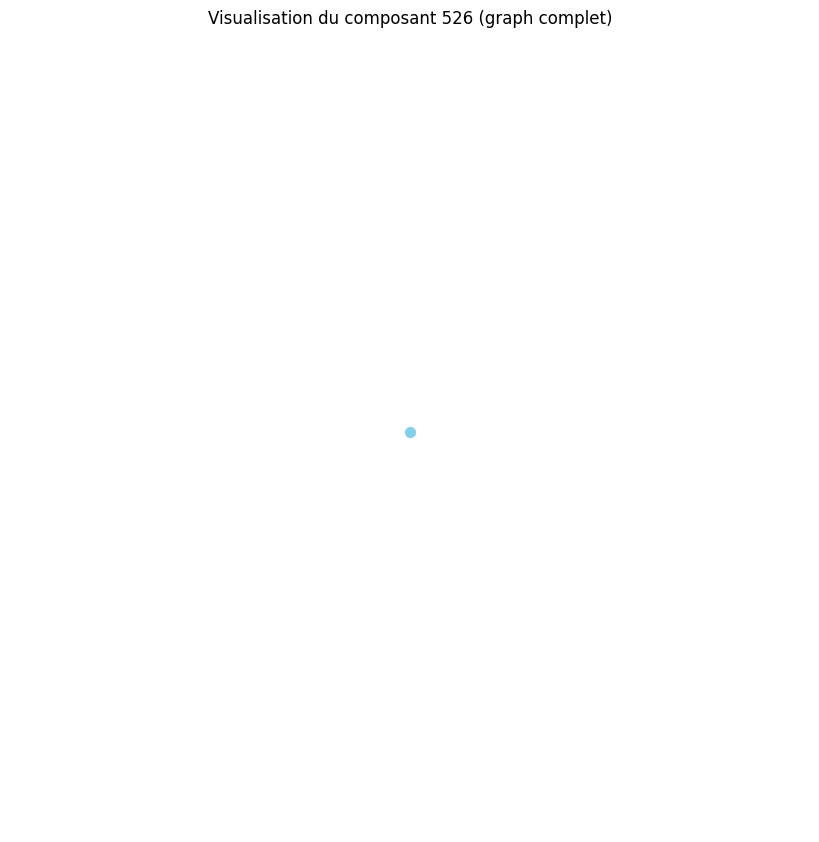

Distance moyenne pour le composant 527 : 0.00
Le composant 527 est un graphe complet ou très densément connecté.
Densité du composant 527 : 0.00
Degré moyen du composant 527 : 0.00
Coefficient de clustering moyen du composant 527 : 0.00


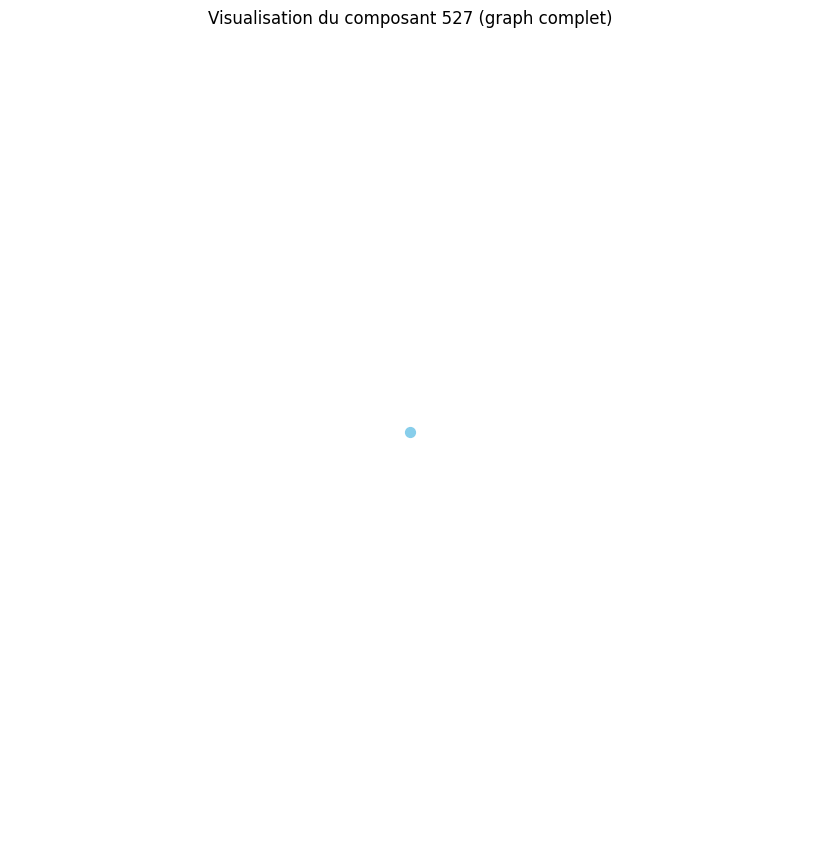

Distance moyenne pour le composant 528 : 0.00
Le composant 528 est un graphe complet ou très densément connecté.
Densité du composant 528 : 0.00
Degré moyen du composant 528 : 0.00
Coefficient de clustering moyen du composant 528 : 0.00


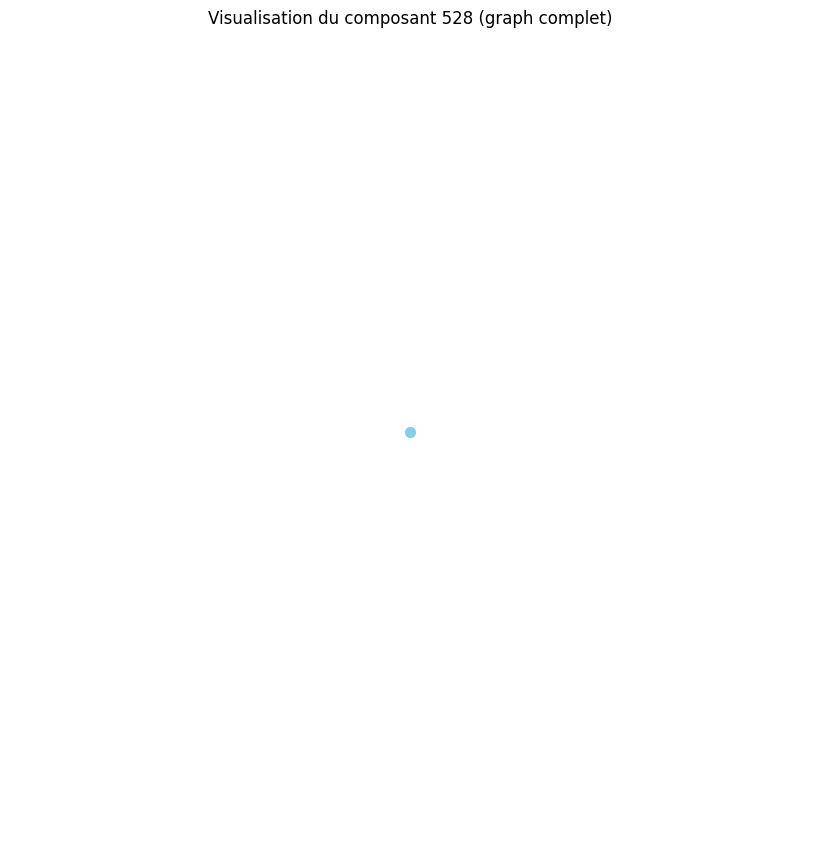

Distance moyenne pour le composant 529 : 0.00
Le composant 529 est un graphe complet ou très densément connecté.
Densité du composant 529 : 0.00
Degré moyen du composant 529 : 0.00
Coefficient de clustering moyen du composant 529 : 0.00


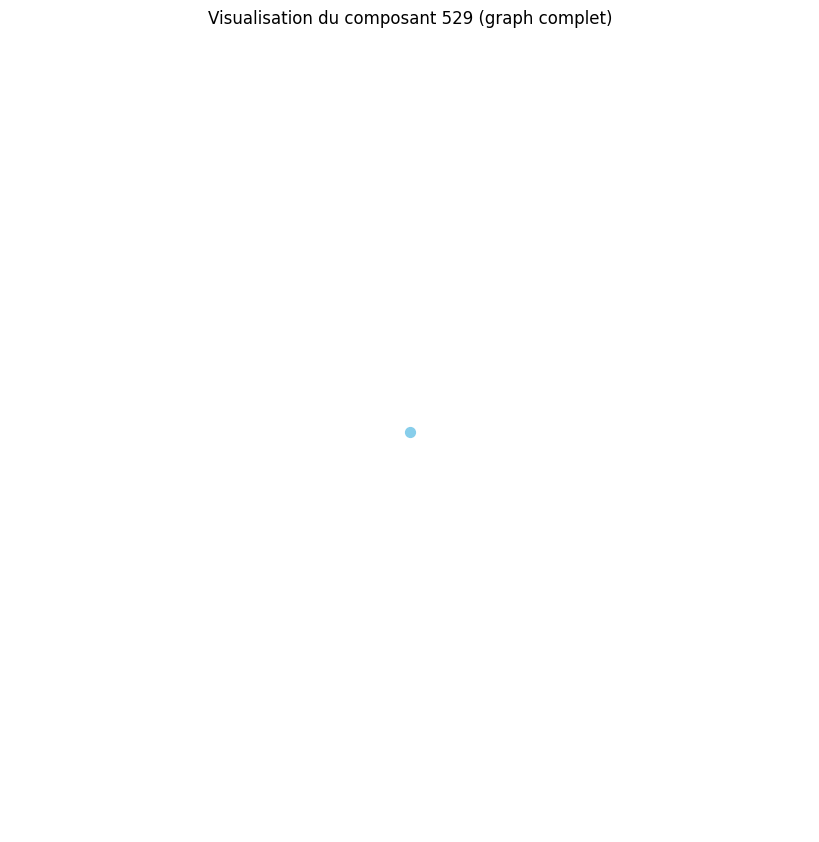

Distance moyenne pour le composant 530 : 0.00
Le composant 530 est un graphe complet ou très densément connecté.
Densité du composant 530 : 0.00
Degré moyen du composant 530 : 0.00
Coefficient de clustering moyen du composant 530 : 0.00


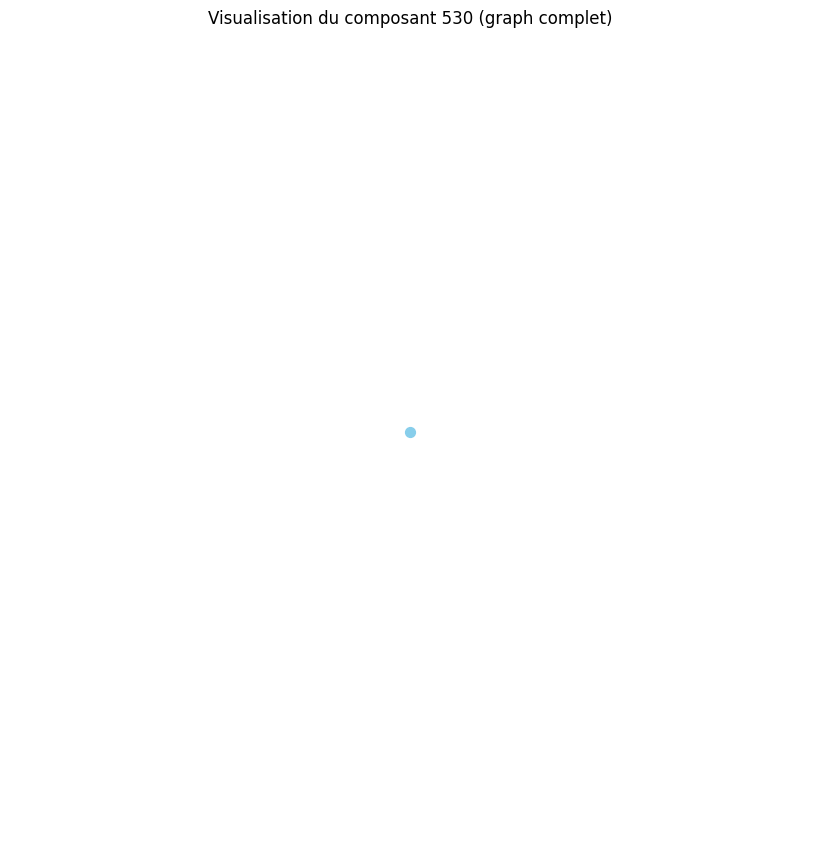

Distance moyenne pour le composant 531 : 0.00
Le composant 531 est un graphe complet ou très densément connecté.
Densité du composant 531 : 0.00
Degré moyen du composant 531 : 0.00
Coefficient de clustering moyen du composant 531 : 0.00


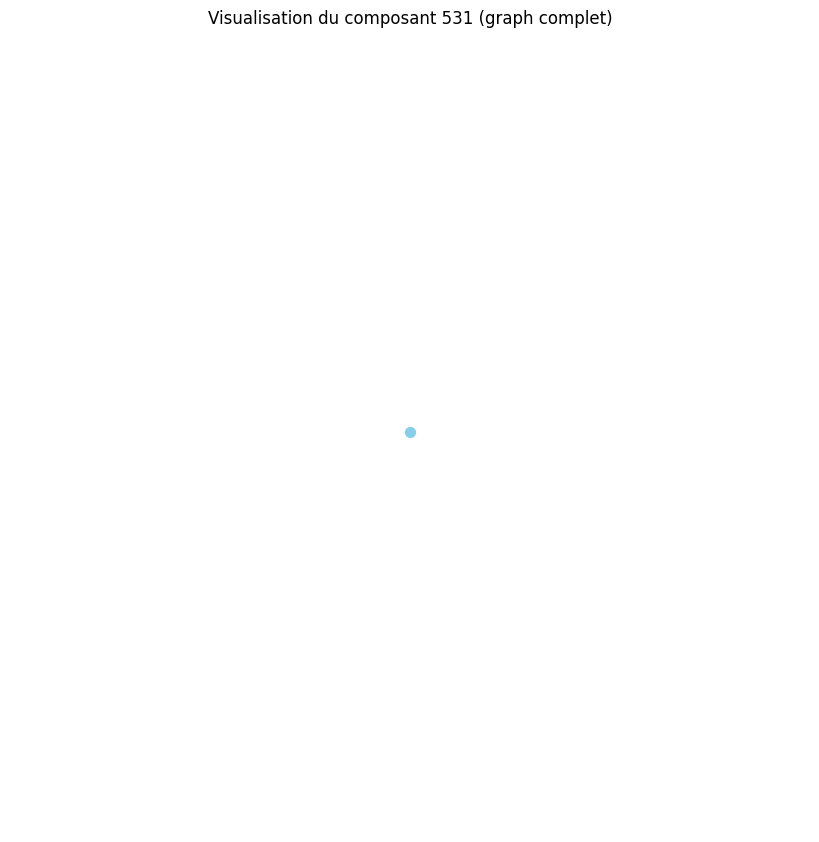

Distance moyenne pour le composant 532 : 0.00
Le composant 532 est un graphe complet ou très densément connecté.
Densité du composant 532 : 0.00
Degré moyen du composant 532 : 0.00
Coefficient de clustering moyen du composant 532 : 0.00


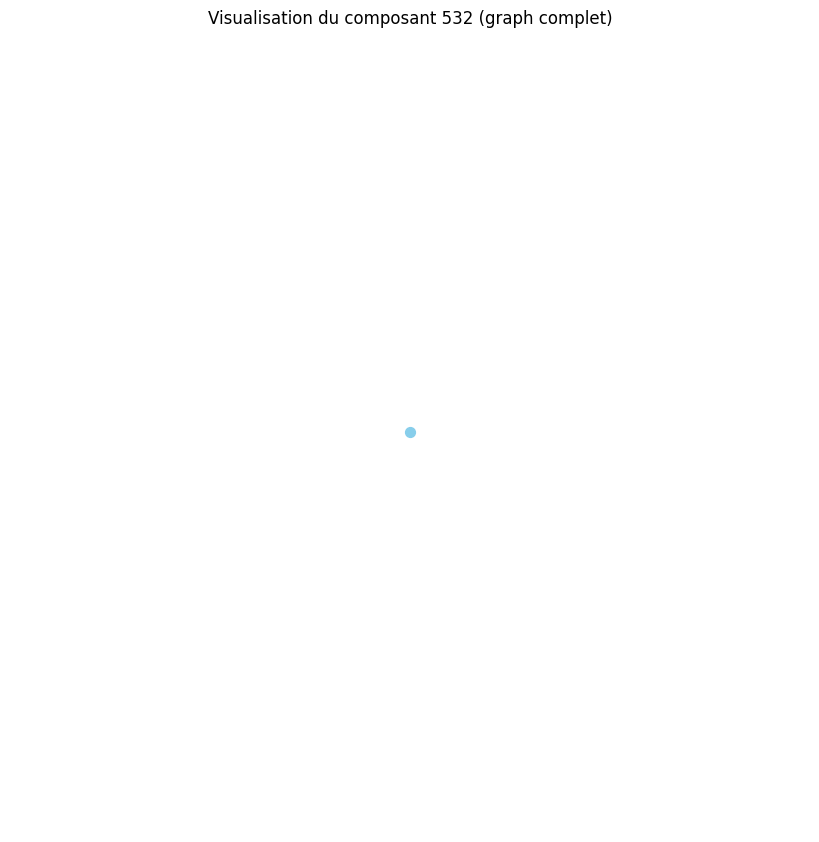

Distance moyenne pour le composant 533 : 0.00
Le composant 533 est un graphe complet ou très densément connecté.
Densité du composant 533 : 0.00
Degré moyen du composant 533 : 0.00
Coefficient de clustering moyen du composant 533 : 0.00


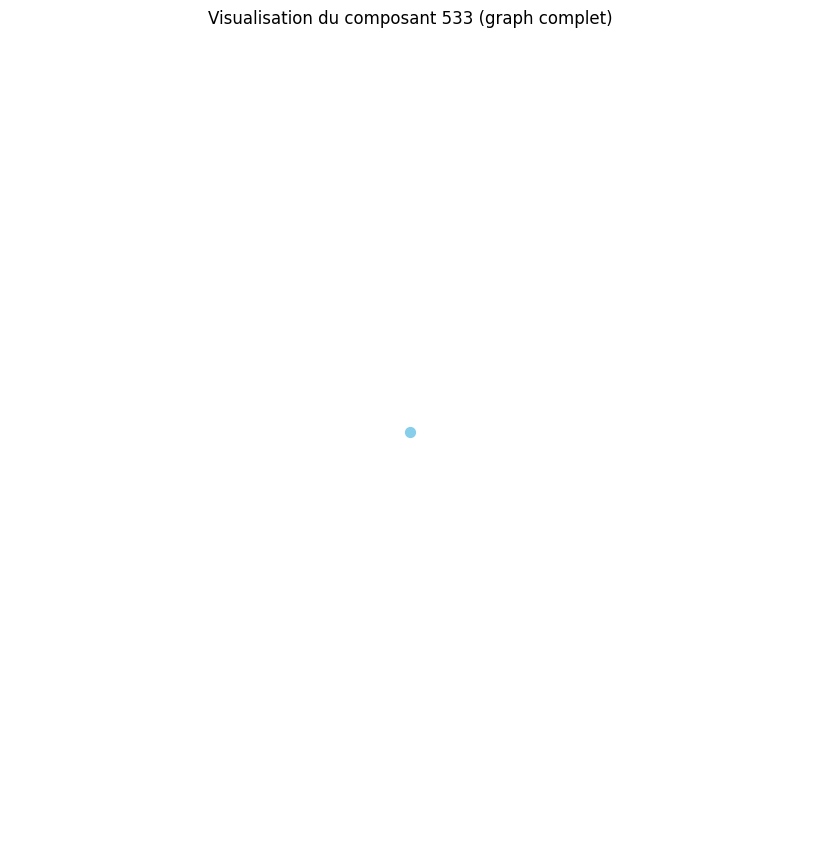

Distance moyenne pour le composant 534 : 0.00
Le composant 534 est un graphe complet ou très densément connecté.
Densité du composant 534 : 0.00
Degré moyen du composant 534 : 0.00
Coefficient de clustering moyen du composant 534 : 0.00


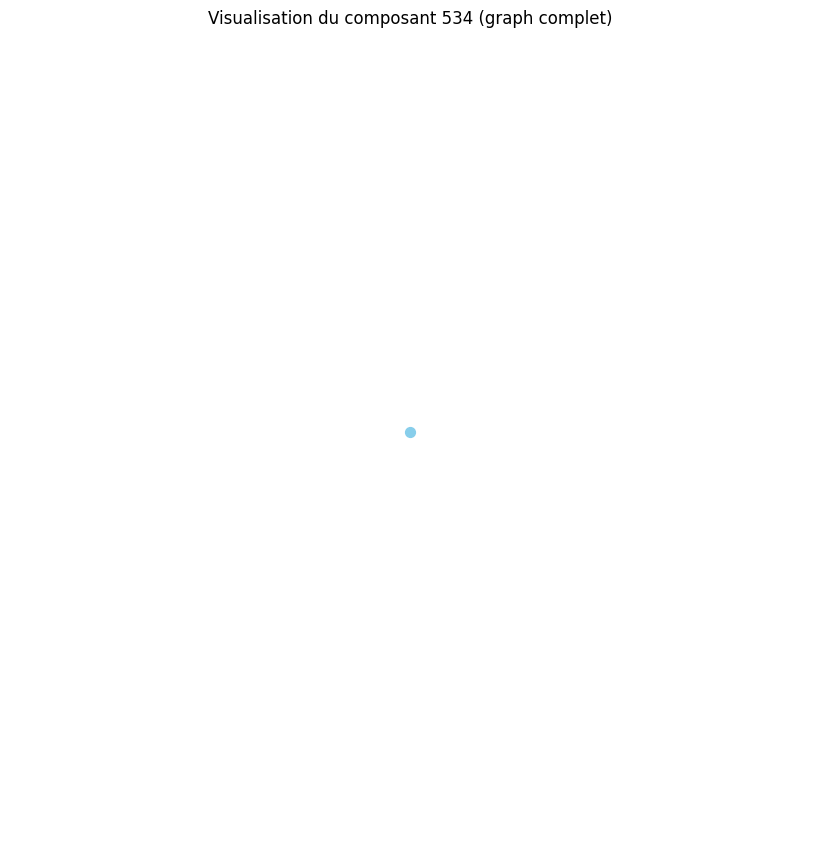

Distance moyenne pour le composant 535 : 0.00
Le composant 535 est un graphe complet ou très densément connecté.
Densité du composant 535 : 0.00
Degré moyen du composant 535 : 0.00
Coefficient de clustering moyen du composant 535 : 0.00


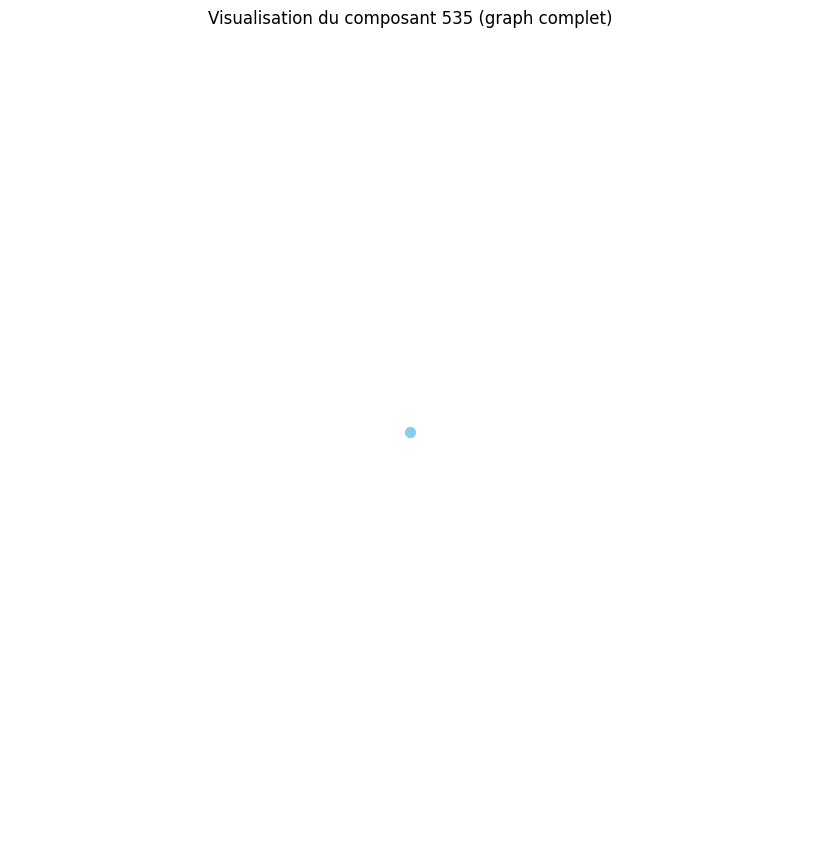

Distance moyenne pour le composant 536 : 0.00
Le composant 536 est un graphe complet ou très densément connecté.
Densité du composant 536 : 0.00
Degré moyen du composant 536 : 0.00
Coefficient de clustering moyen du composant 536 : 0.00


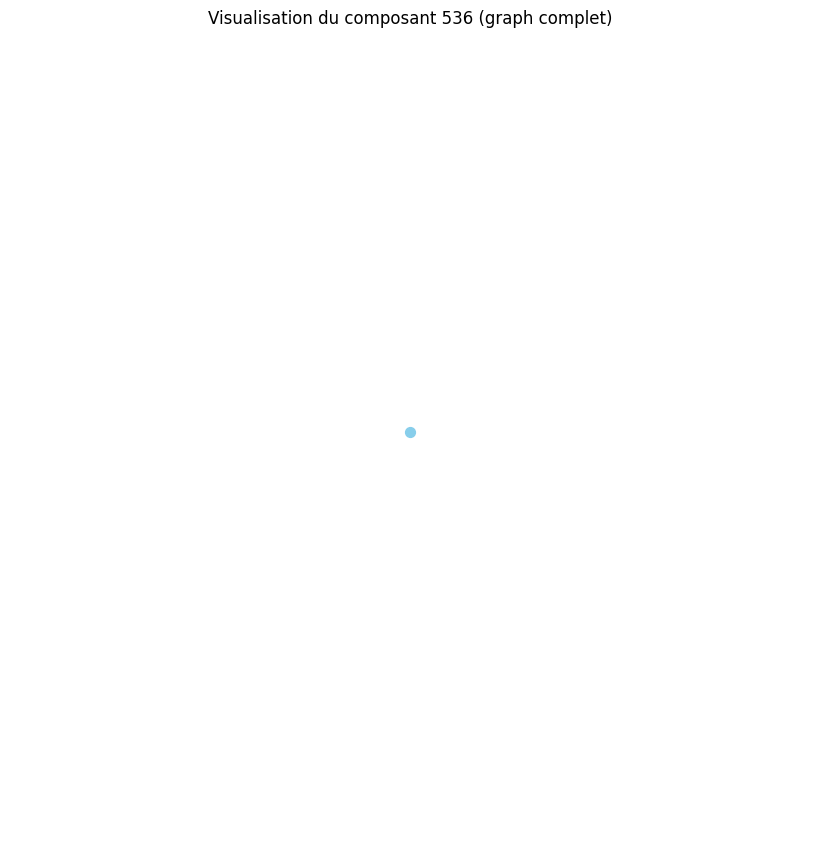

Distance moyenne pour le composant 537 : 0.00
Le composant 537 est un graphe complet ou très densément connecté.
Densité du composant 537 : 0.00
Degré moyen du composant 537 : 0.00
Coefficient de clustering moyen du composant 537 : 0.00


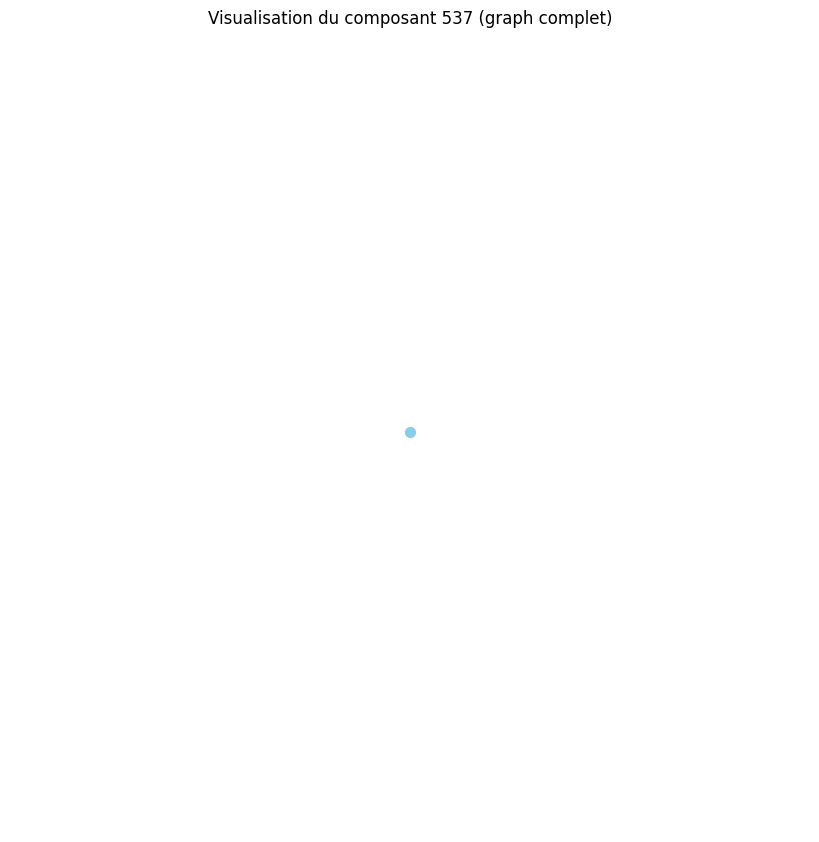

Distance moyenne pour le composant 538 : 1.00
Distance moyenne pour le composant 539 : 0.00
Le composant 539 est un graphe complet ou très densément connecté.
Densité du composant 539 : 0.00
Degré moyen du composant 539 : 0.00
Coefficient de clustering moyen du composant 539 : 0.00


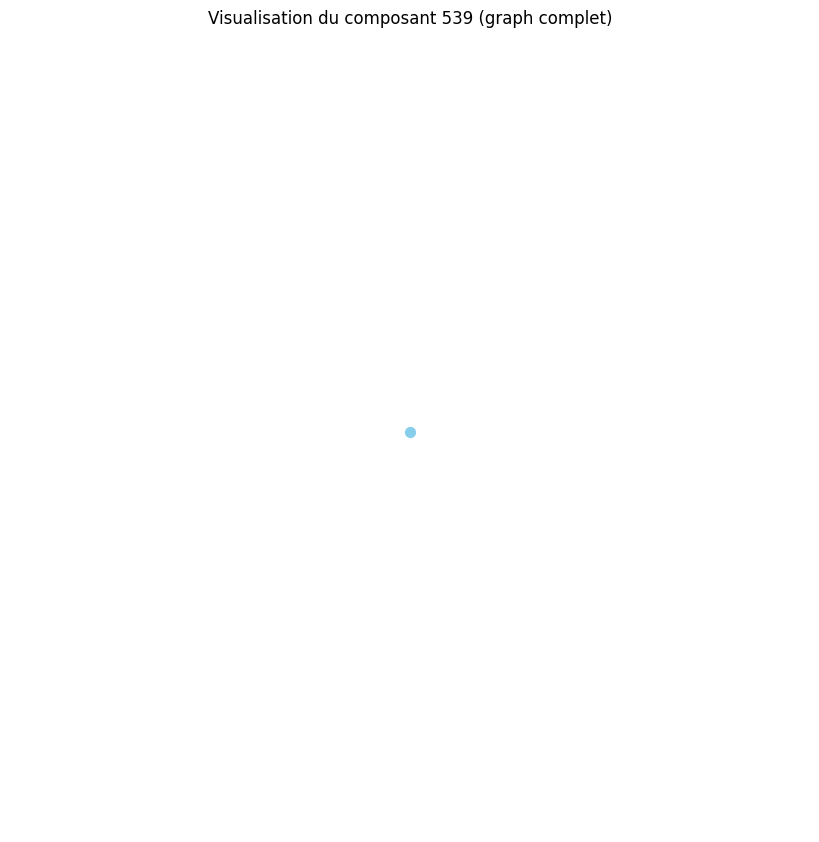

Distance moyenne pour le composant 540 : 0.00
Le composant 540 est un graphe complet ou très densément connecté.
Densité du composant 540 : 0.00
Degré moyen du composant 540 : 0.00
Coefficient de clustering moyen du composant 540 : 0.00


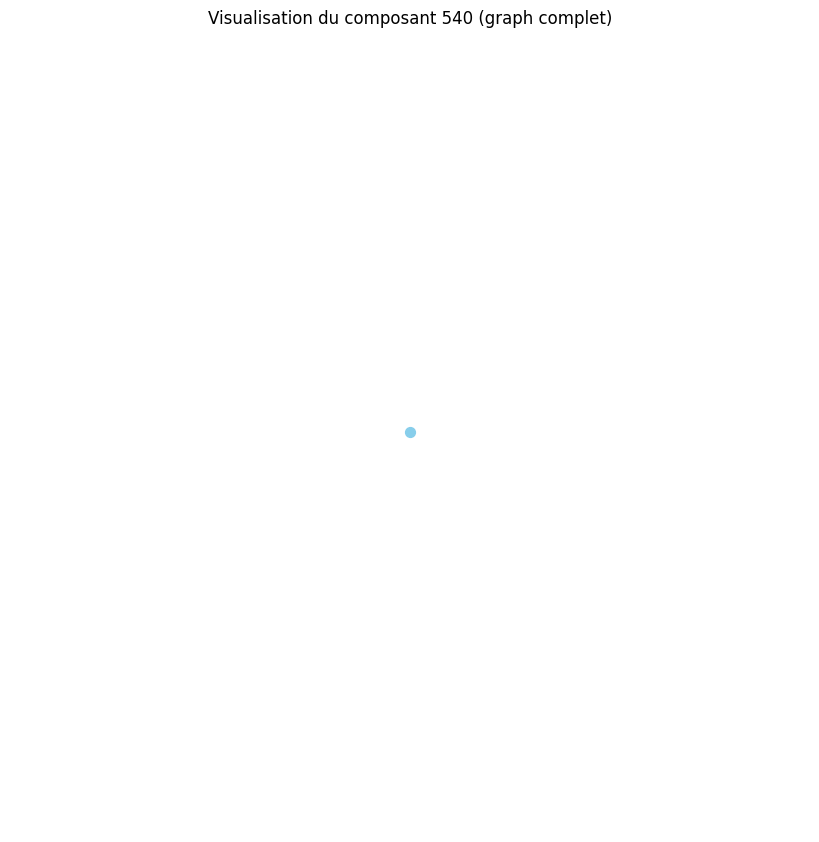

Distance moyenne pour le composant 541 : 0.00
Le composant 541 est un graphe complet ou très densément connecté.
Densité du composant 541 : 0.00
Degré moyen du composant 541 : 0.00
Coefficient de clustering moyen du composant 541 : 0.00


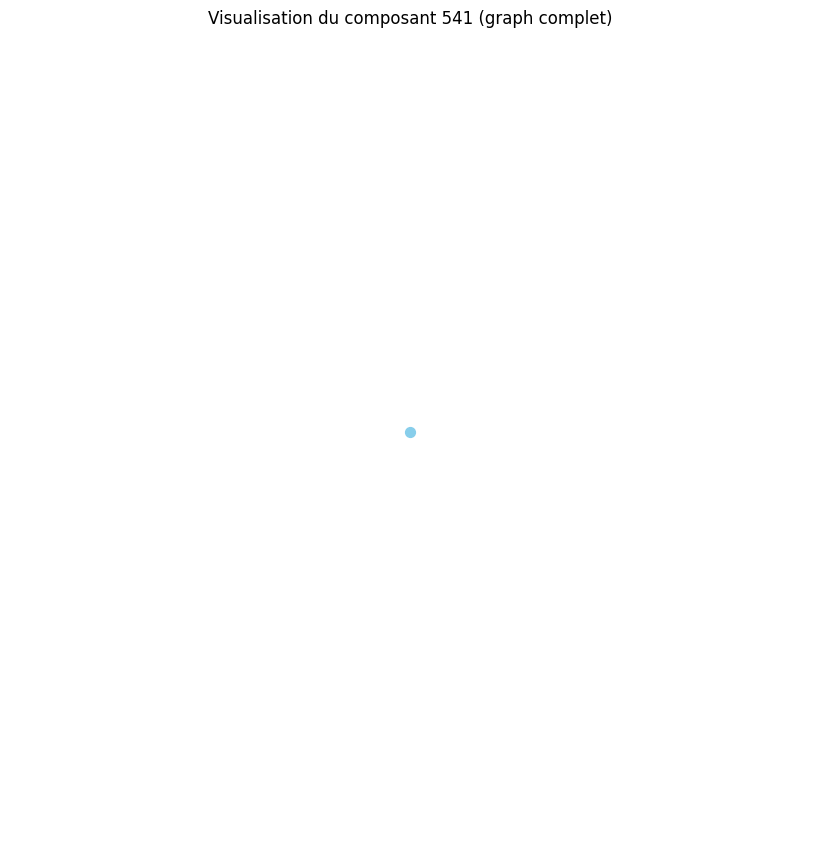

Distance moyenne pour le composant 542 : 0.00
Le composant 542 est un graphe complet ou très densément connecté.
Densité du composant 542 : 0.00
Degré moyen du composant 542 : 0.00
Coefficient de clustering moyen du composant 542 : 0.00


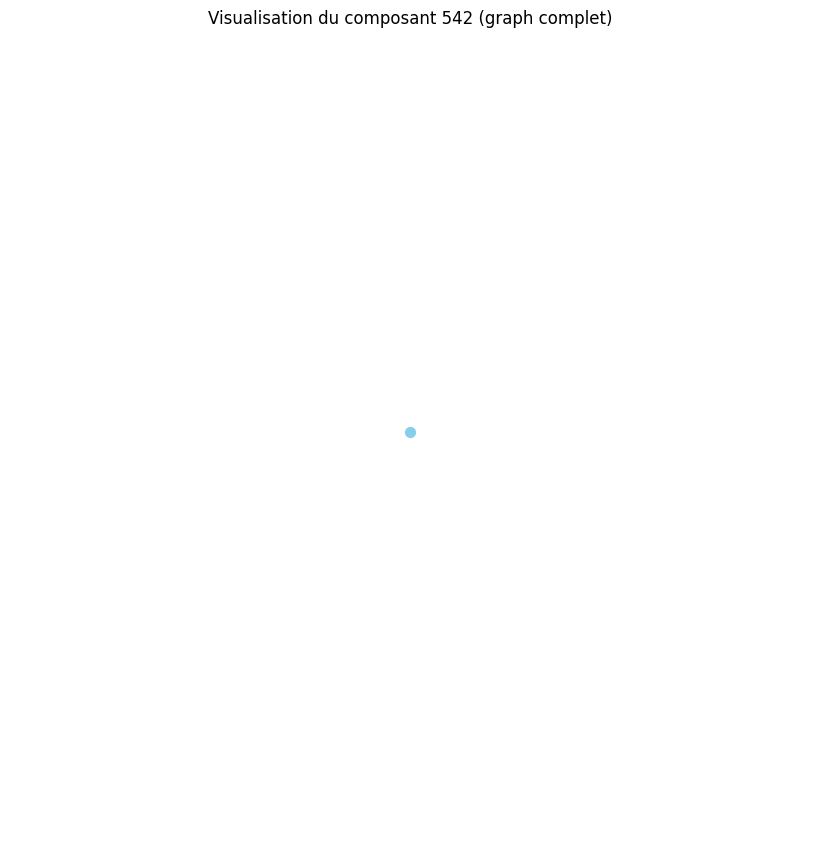

Distance moyenne pour le composant 543 : 0.00
Le composant 543 est un graphe complet ou très densément connecté.
Densité du composant 543 : 0.00
Degré moyen du composant 543 : 0.00
Coefficient de clustering moyen du composant 543 : 0.00


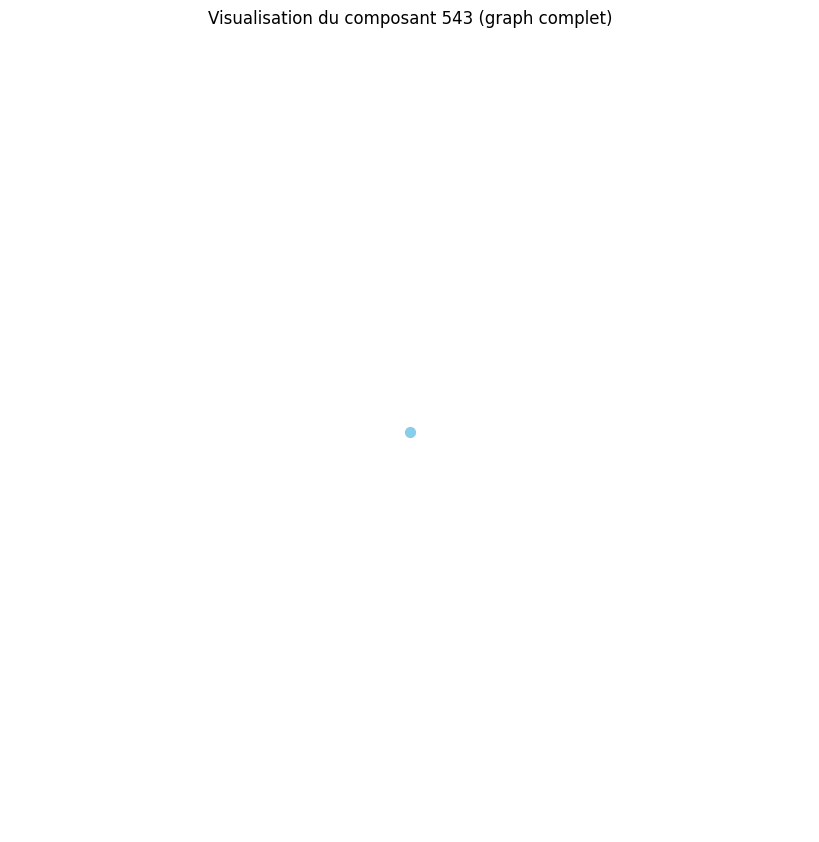

Distance moyenne pour le composant 544 : 0.00
Le composant 544 est un graphe complet ou très densément connecté.
Densité du composant 544 : 0.00
Degré moyen du composant 544 : 0.00
Coefficient de clustering moyen du composant 544 : 0.00


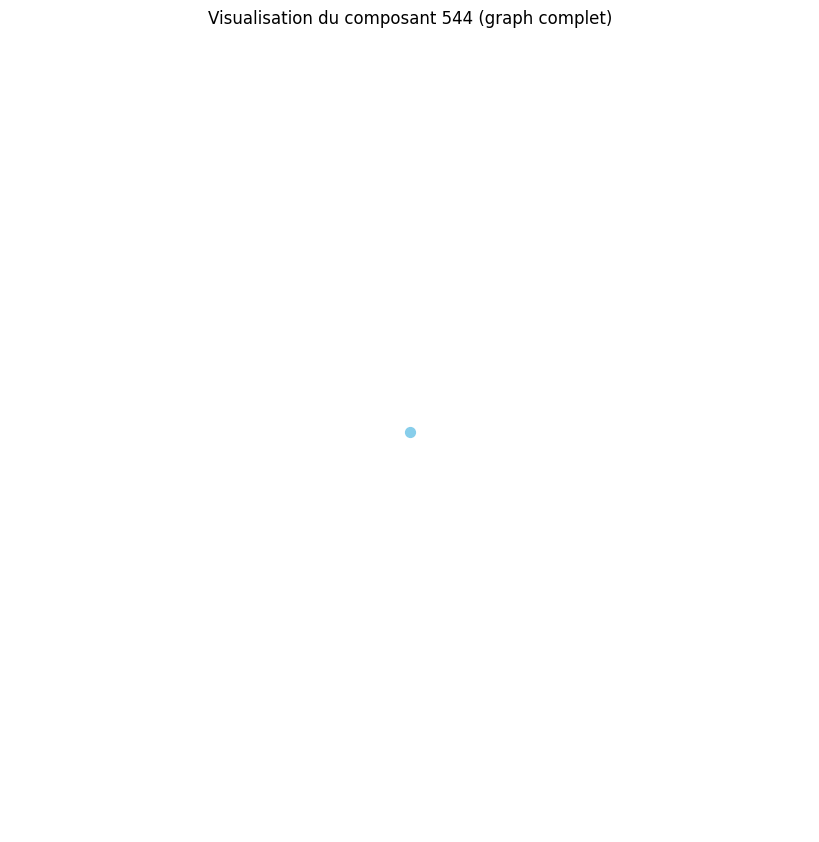

Distance moyenne pour le composant 545 : 0.00
Le composant 545 est un graphe complet ou très densément connecté.
Densité du composant 545 : 0.00
Degré moyen du composant 545 : 0.00
Coefficient de clustering moyen du composant 545 : 0.00


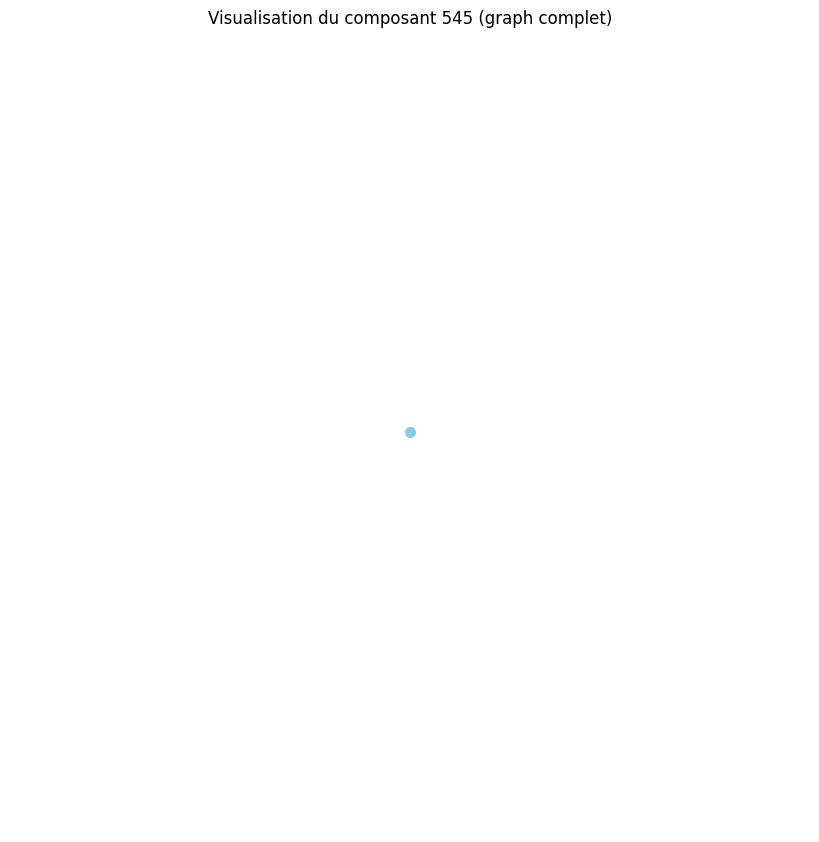

Distance moyenne pour le composant 546 : 0.00
Le composant 546 est un graphe complet ou très densément connecté.
Densité du composant 546 : 0.00
Degré moyen du composant 546 : 0.00
Coefficient de clustering moyen du composant 546 : 0.00


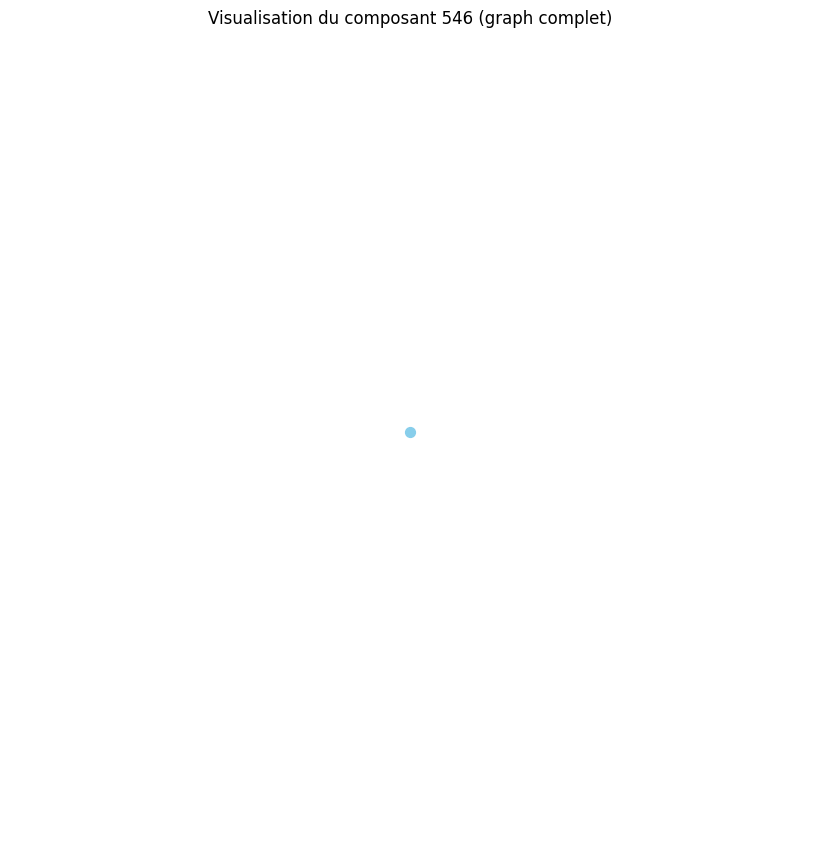

Distance moyenne pour le composant 547 : 0.00
Le composant 547 est un graphe complet ou très densément connecté.
Densité du composant 547 : 0.00
Degré moyen du composant 547 : 0.00
Coefficient de clustering moyen du composant 547 : 0.00


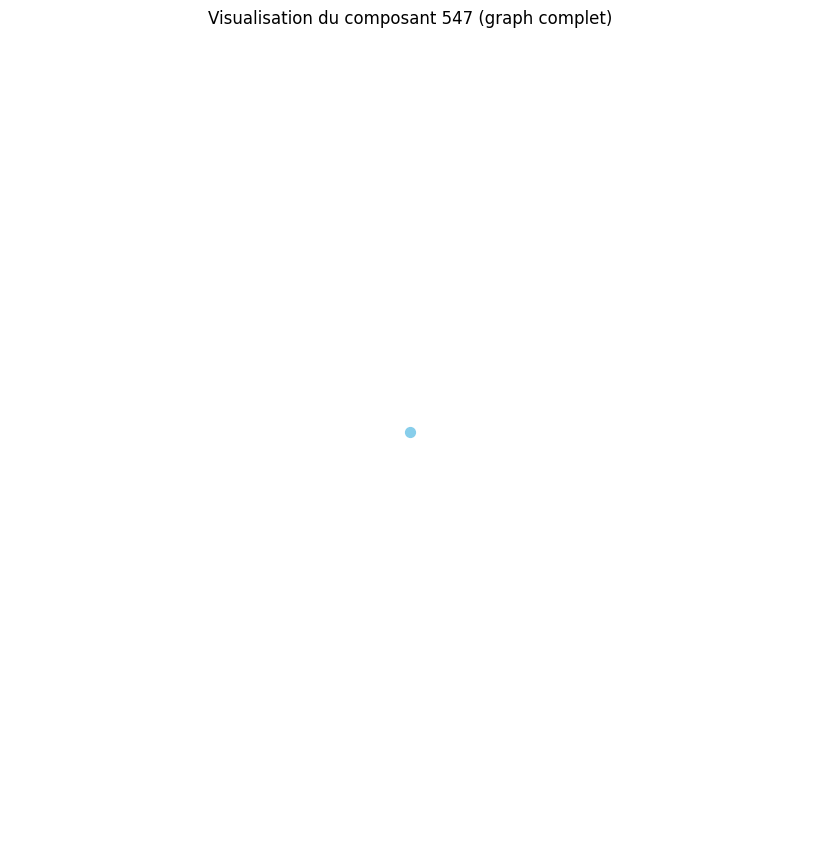

Distance moyenne pour le composant 548 : 0.00
Le composant 548 est un graphe complet ou très densément connecté.
Densité du composant 548 : 0.00
Degré moyen du composant 548 : 0.00
Coefficient de clustering moyen du composant 548 : 0.00


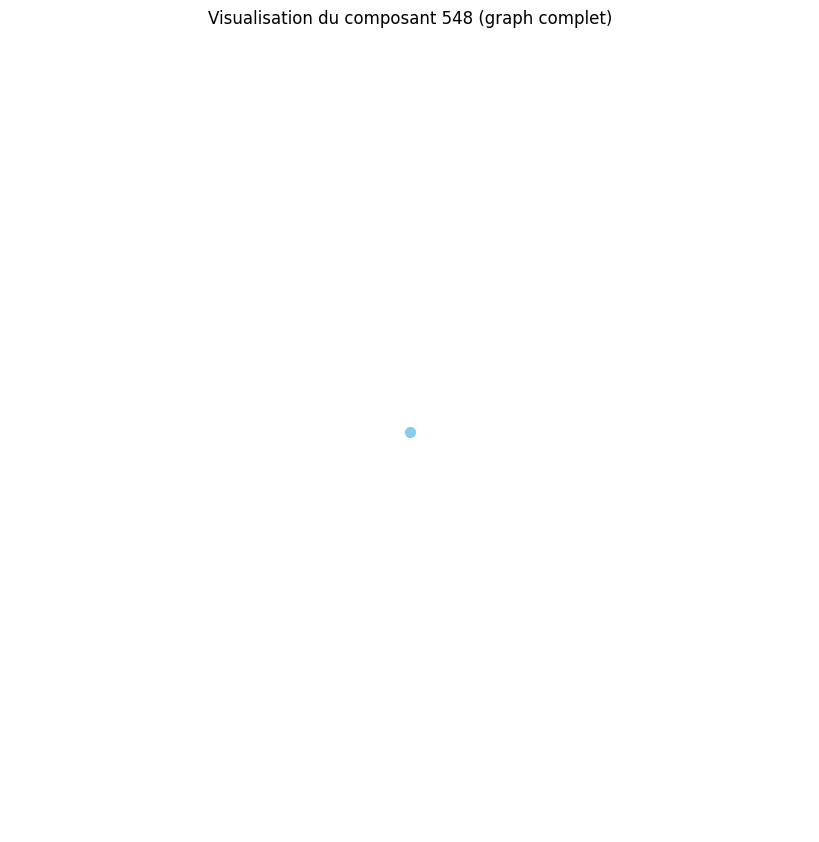

Distance moyenne pour le composant 549 : 0.00
Le composant 549 est un graphe complet ou très densément connecté.
Densité du composant 549 : 0.00
Degré moyen du composant 549 : 0.00
Coefficient de clustering moyen du composant 549 : 0.00


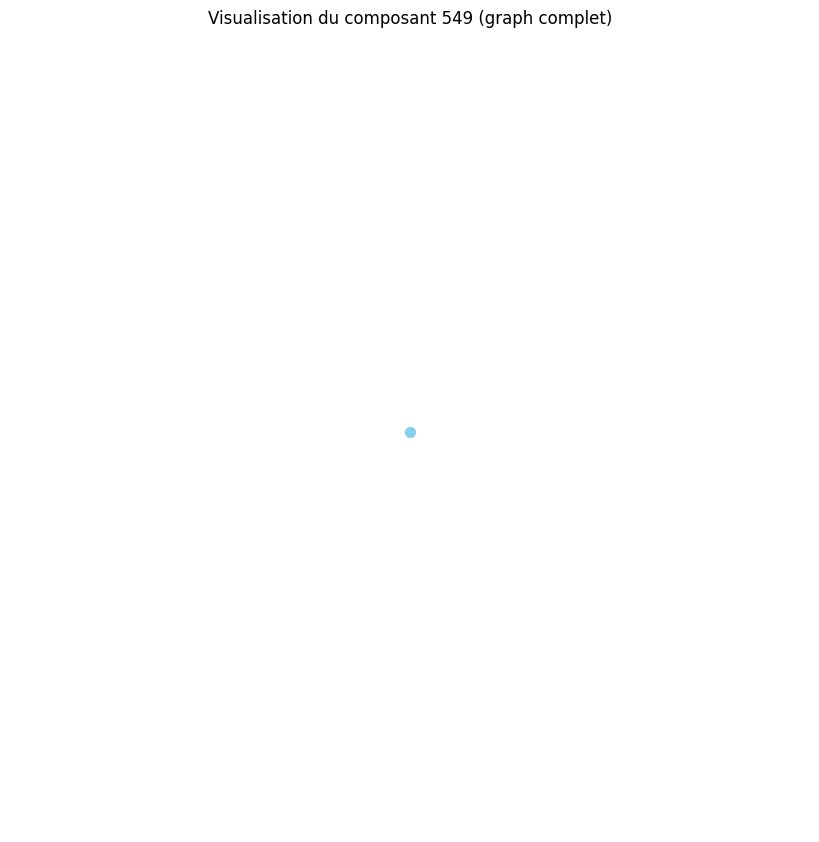

Distance moyenne pour le composant 550 : 0.00
Le composant 550 est un graphe complet ou très densément connecté.
Densité du composant 550 : 0.00
Degré moyen du composant 550 : 0.00
Coefficient de clustering moyen du composant 550 : 0.00


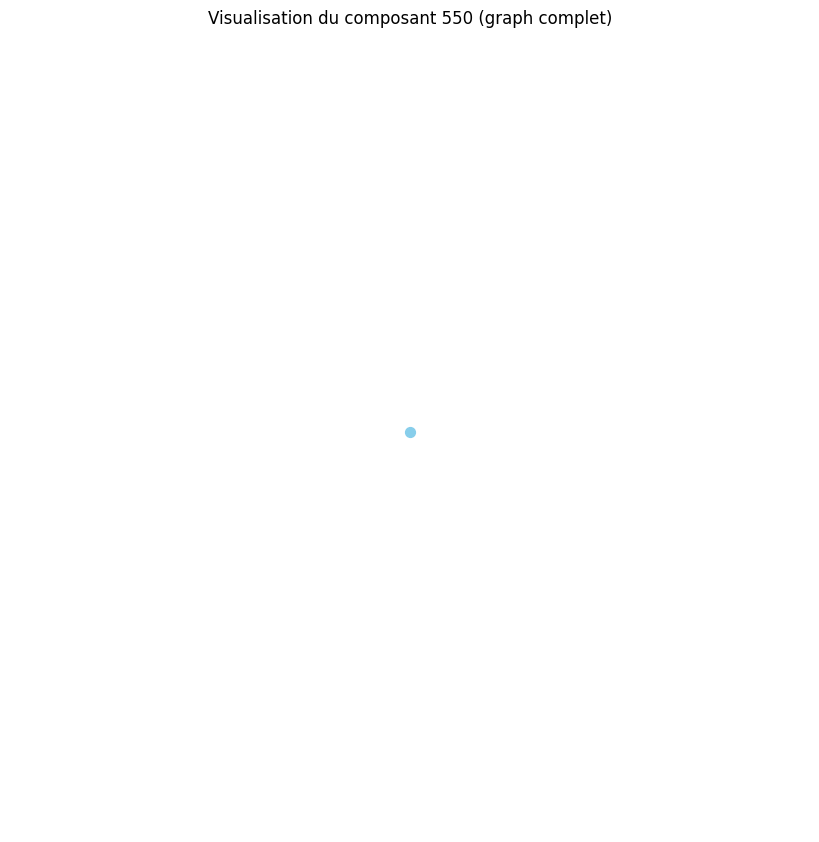

Distance moyenne pour le composant 551 : 0.00
Le composant 551 est un graphe complet ou très densément connecté.
Densité du composant 551 : 0.00
Degré moyen du composant 551 : 0.00
Coefficient de clustering moyen du composant 551 : 0.00


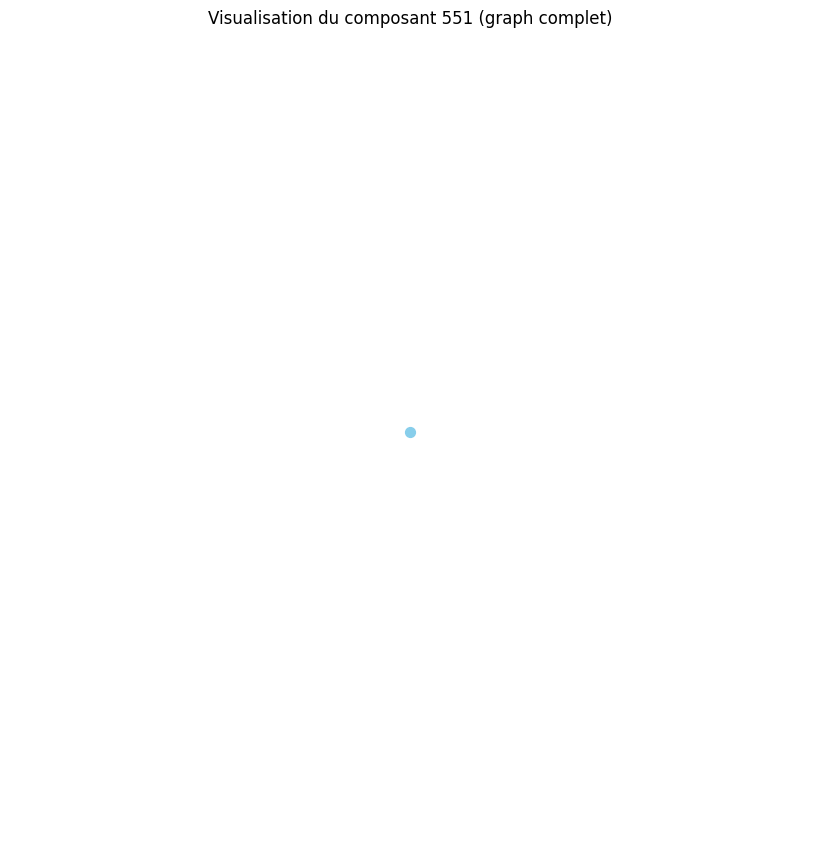

Distance moyenne pour le composant 552 : 0.00
Le composant 552 est un graphe complet ou très densément connecté.
Densité du composant 552 : 0.00
Degré moyen du composant 552 : 0.00
Coefficient de clustering moyen du composant 552 : 0.00


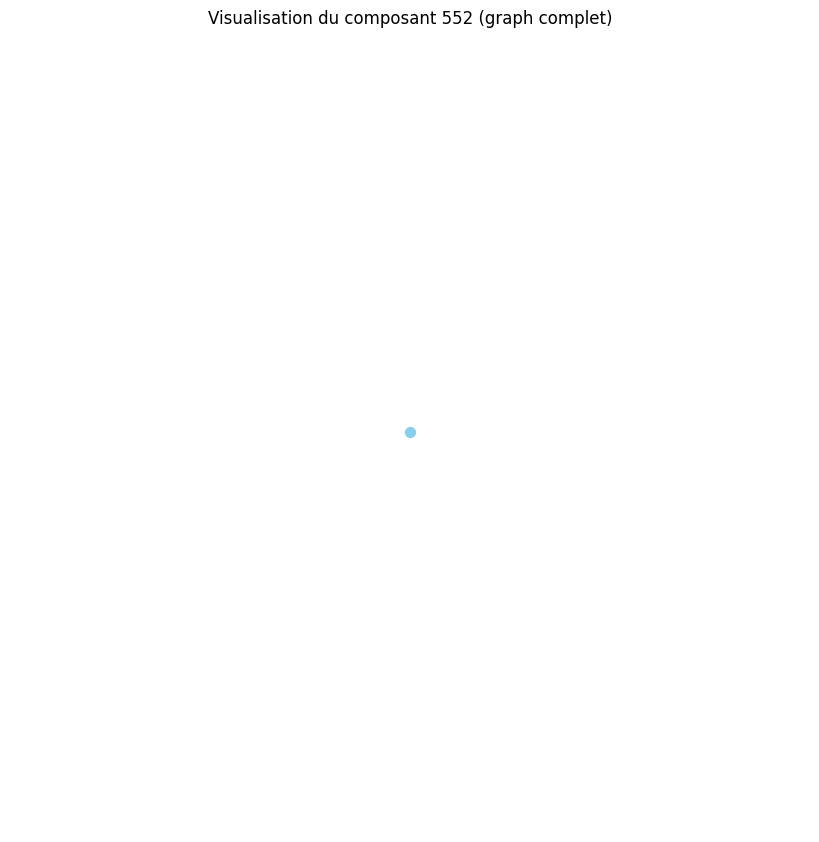

Distance moyenne pour le composant 553 : 0.00
Le composant 553 est un graphe complet ou très densément connecté.
Densité du composant 553 : 0.00
Degré moyen du composant 553 : 0.00
Coefficient de clustering moyen du composant 553 : 0.00


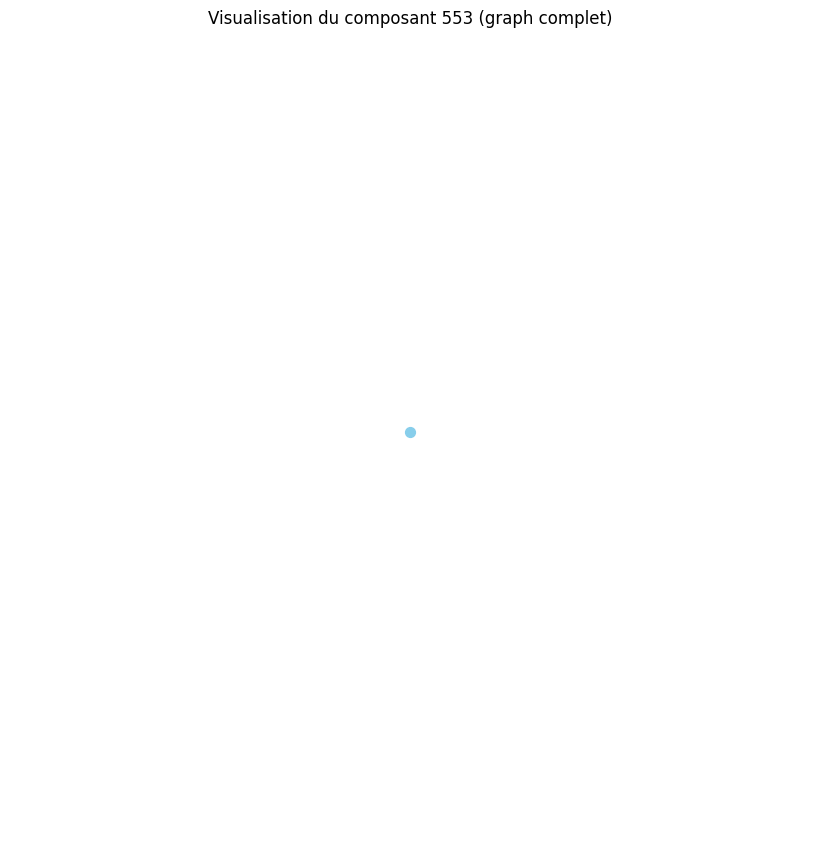

Distance moyenne pour le composant 554 : 0.00
Le composant 554 est un graphe complet ou très densément connecté.
Densité du composant 554 : 0.00
Degré moyen du composant 554 : 0.00
Coefficient de clustering moyen du composant 554 : 0.00


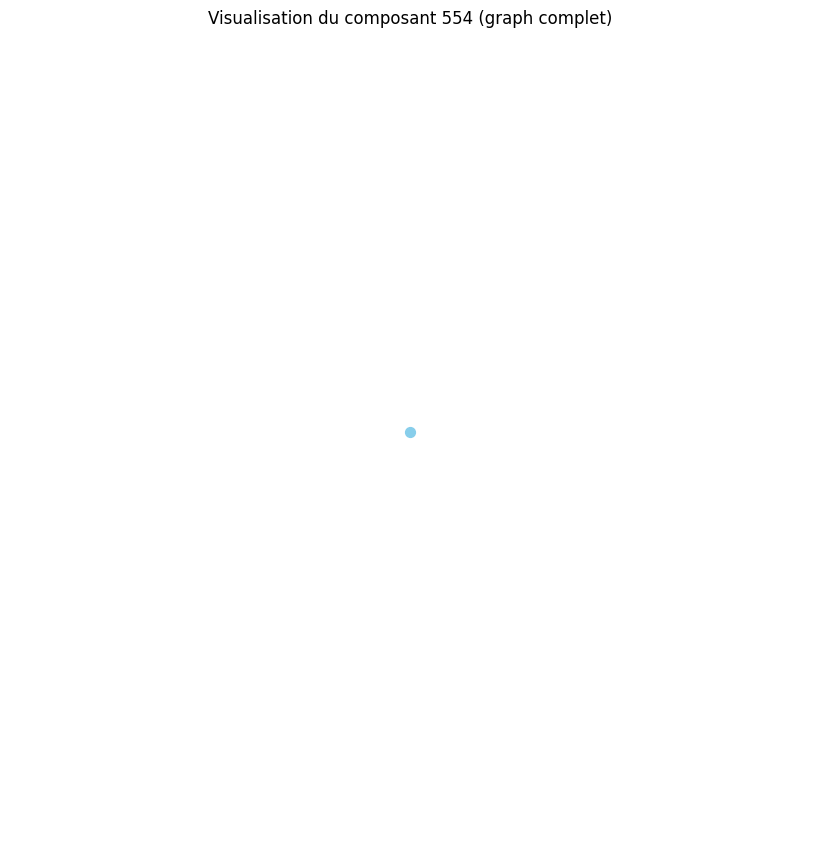

Distance moyenne pour le composant 555 : 0.00
Le composant 555 est un graphe complet ou très densément connecté.
Densité du composant 555 : 0.00
Degré moyen du composant 555 : 0.00
Coefficient de clustering moyen du composant 555 : 0.00


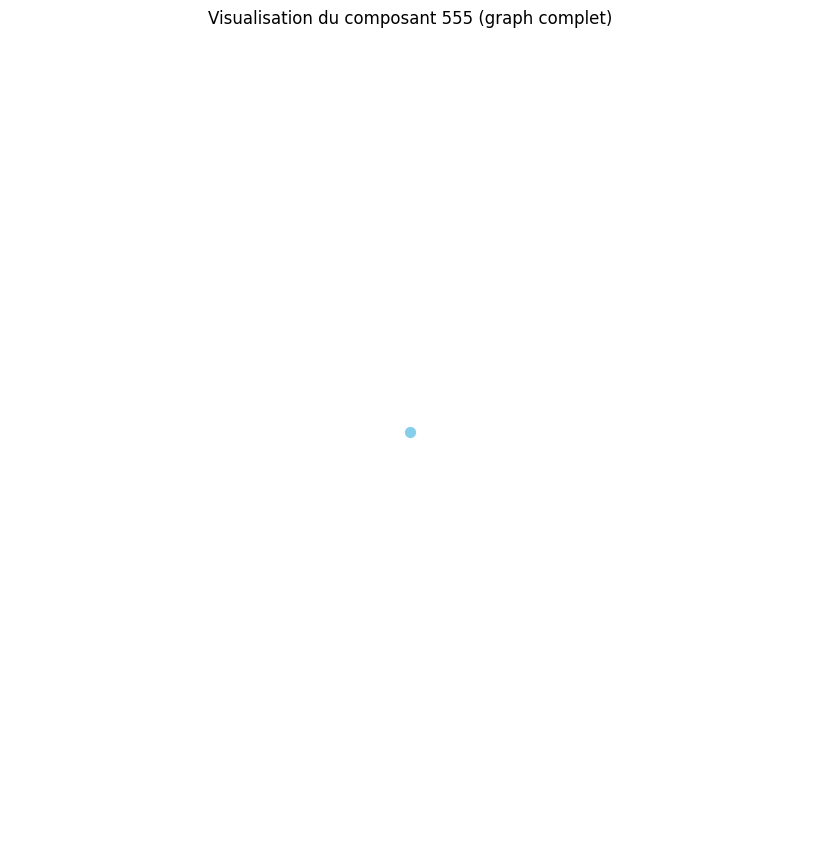

Distance moyenne pour le composant 556 : 0.00
Le composant 556 est un graphe complet ou très densément connecté.
Densité du composant 556 : 0.00
Degré moyen du composant 556 : 0.00
Coefficient de clustering moyen du composant 556 : 0.00


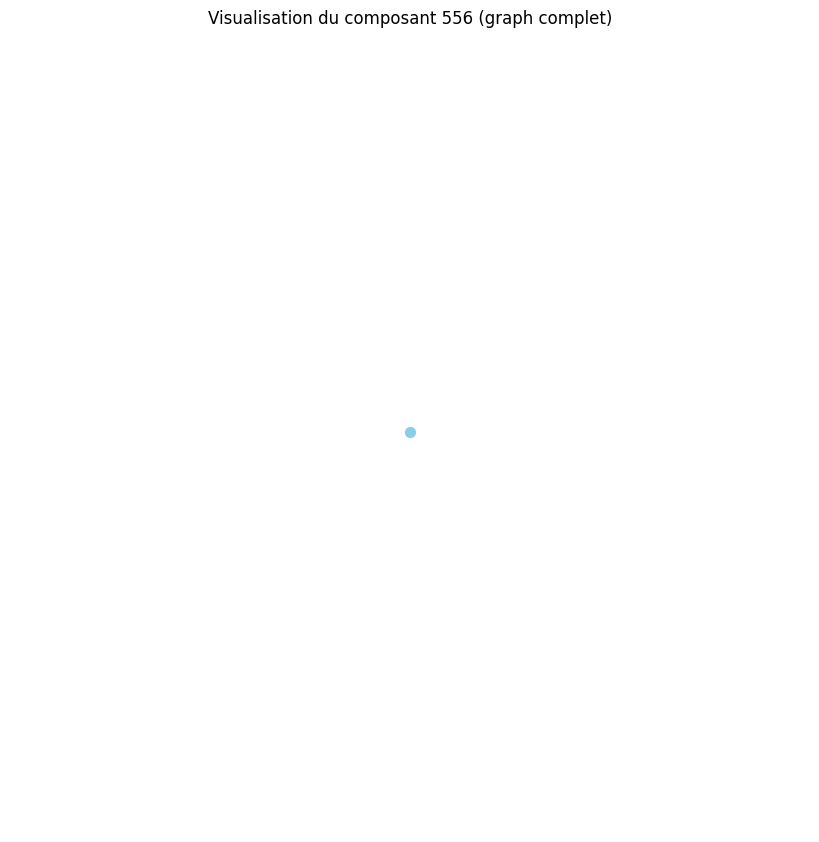

Distance moyenne pour le composant 557 : 0.00
Le composant 557 est un graphe complet ou très densément connecté.
Densité du composant 557 : 0.00
Degré moyen du composant 557 : 0.00
Coefficient de clustering moyen du composant 557 : 0.00


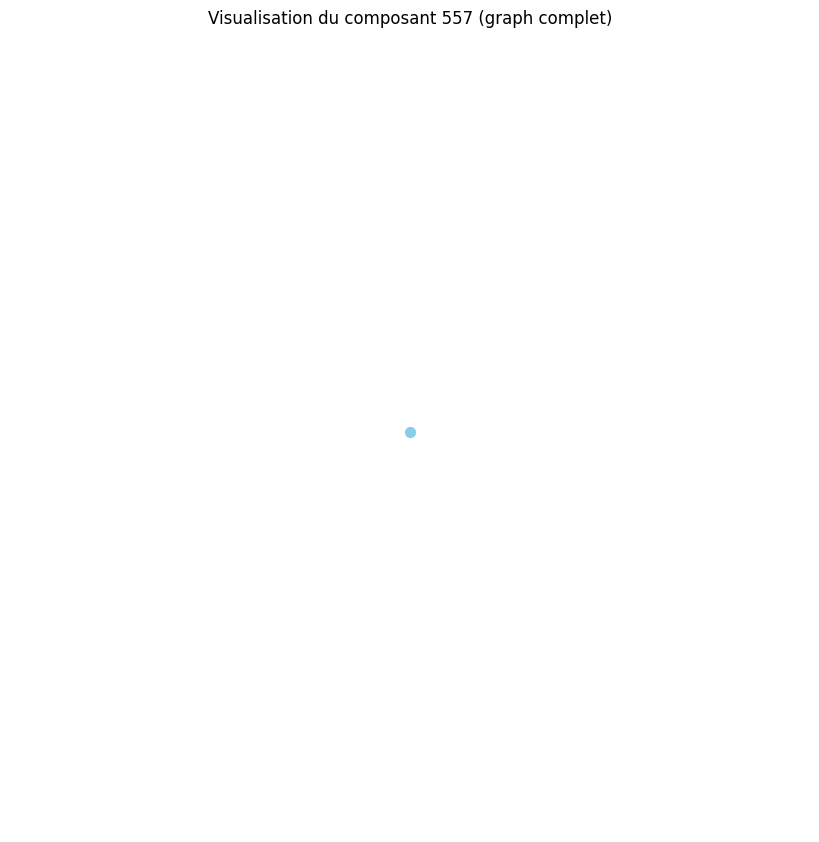

Distance moyenne pour le composant 558 : 0.00
Le composant 558 est un graphe complet ou très densément connecté.
Densité du composant 558 : 0.00
Degré moyen du composant 558 : 0.00
Coefficient de clustering moyen du composant 558 : 0.00


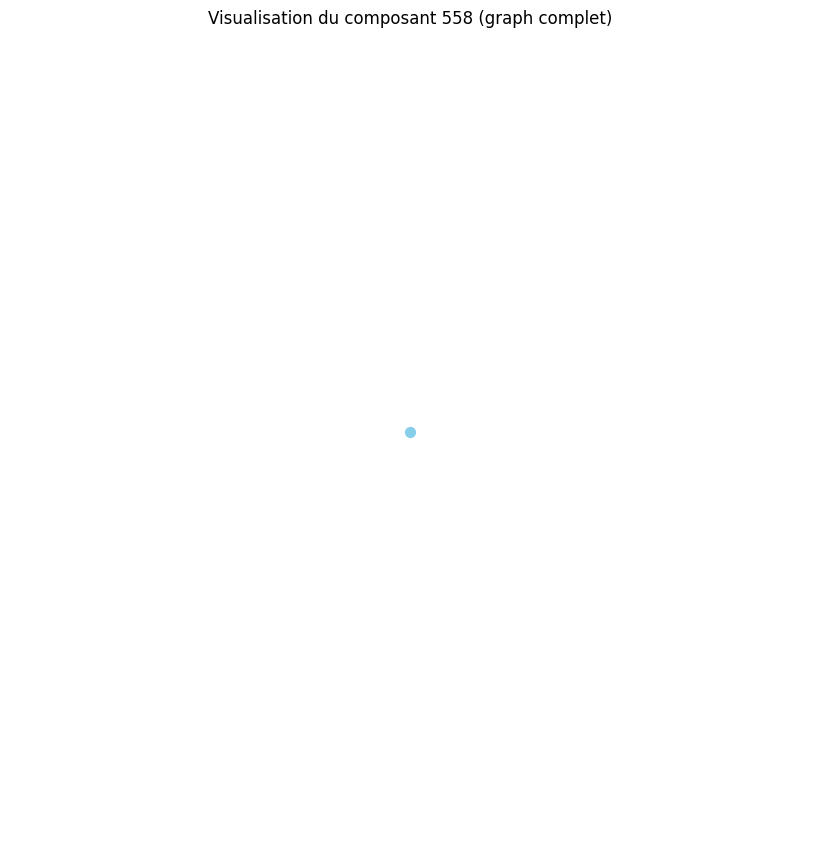

Distance moyenne pour le composant 559 : 0.00
Le composant 559 est un graphe complet ou très densément connecté.
Densité du composant 559 : 0.00
Degré moyen du composant 559 : 0.00
Coefficient de clustering moyen du composant 559 : 0.00


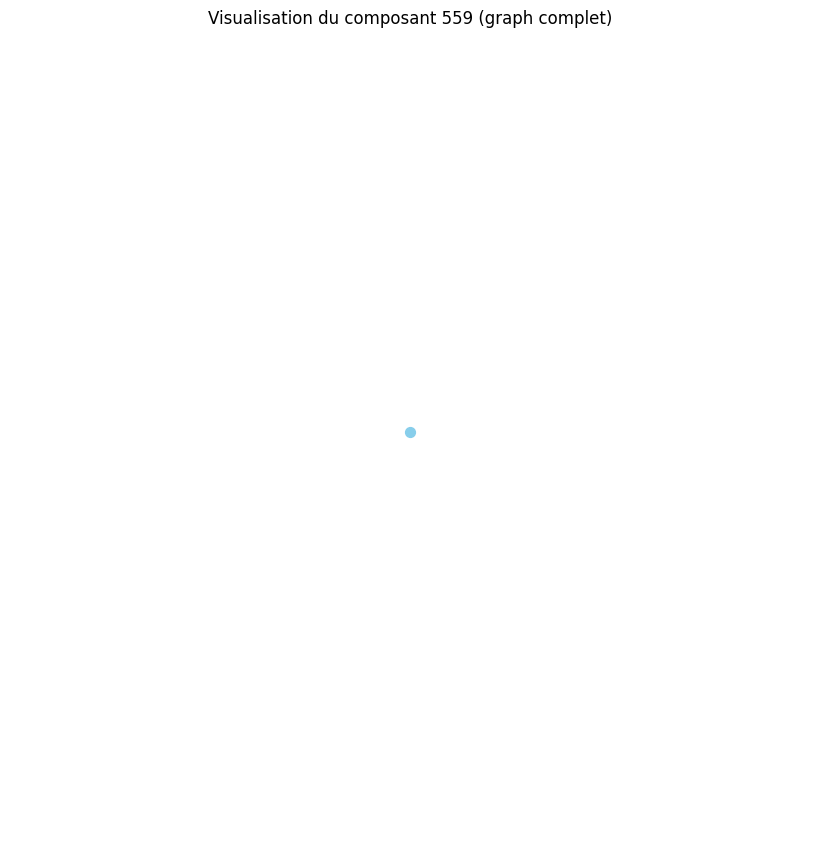

Distance moyenne pour le composant 560 : 0.00
Le composant 560 est un graphe complet ou très densément connecté.
Densité du composant 560 : 0.00
Degré moyen du composant 560 : 0.00
Coefficient de clustering moyen du composant 560 : 0.00


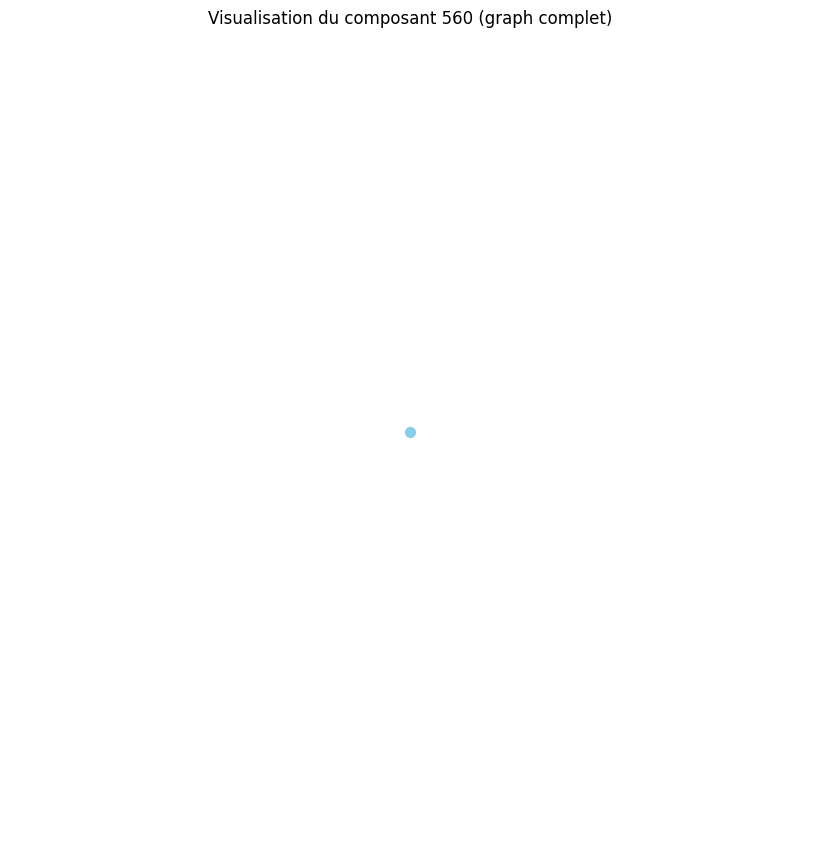

Distance moyenne pour le composant 561 : 0.00
Le composant 561 est un graphe complet ou très densément connecté.
Densité du composant 561 : 0.00
Degré moyen du composant 561 : 0.00
Coefficient de clustering moyen du composant 561 : 0.00


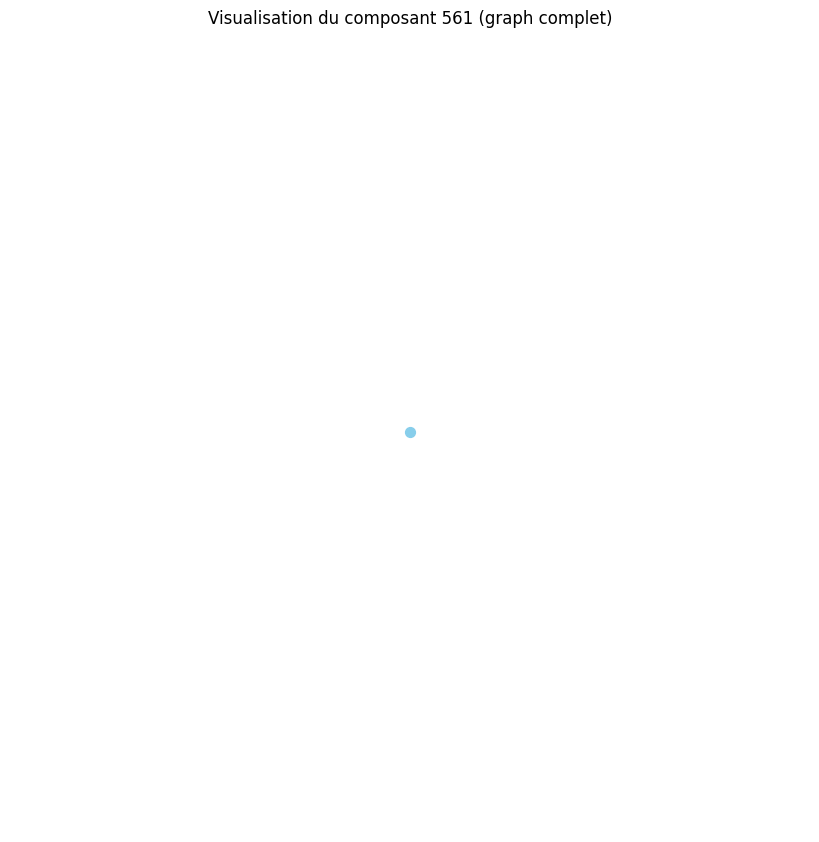

Distance moyenne pour le composant 562 : 0.00
Le composant 562 est un graphe complet ou très densément connecté.
Densité du composant 562 : 0.00
Degré moyen du composant 562 : 0.00
Coefficient de clustering moyen du composant 562 : 0.00


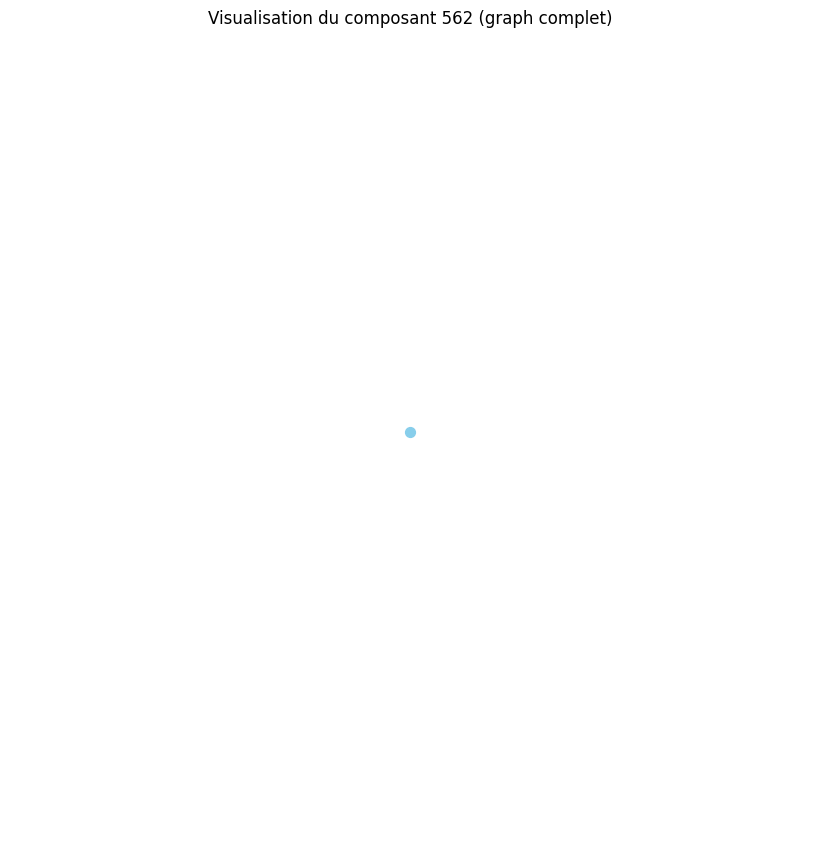

Distance moyenne pour le composant 563 : 0.00
Le composant 563 est un graphe complet ou très densément connecté.
Densité du composant 563 : 0.00
Degré moyen du composant 563 : 0.00
Coefficient de clustering moyen du composant 563 : 0.00


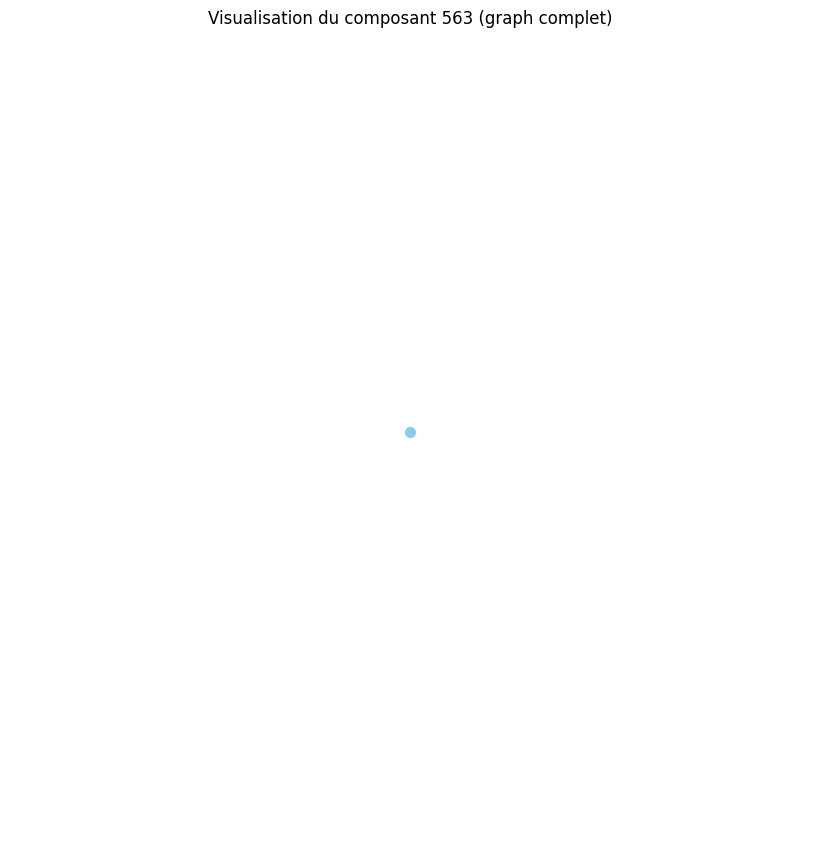

Distance moyenne pour le composant 564 : 0.00
Le composant 564 est un graphe complet ou très densément connecté.
Densité du composant 564 : 0.00
Degré moyen du composant 564 : 0.00
Coefficient de clustering moyen du composant 564 : 0.00


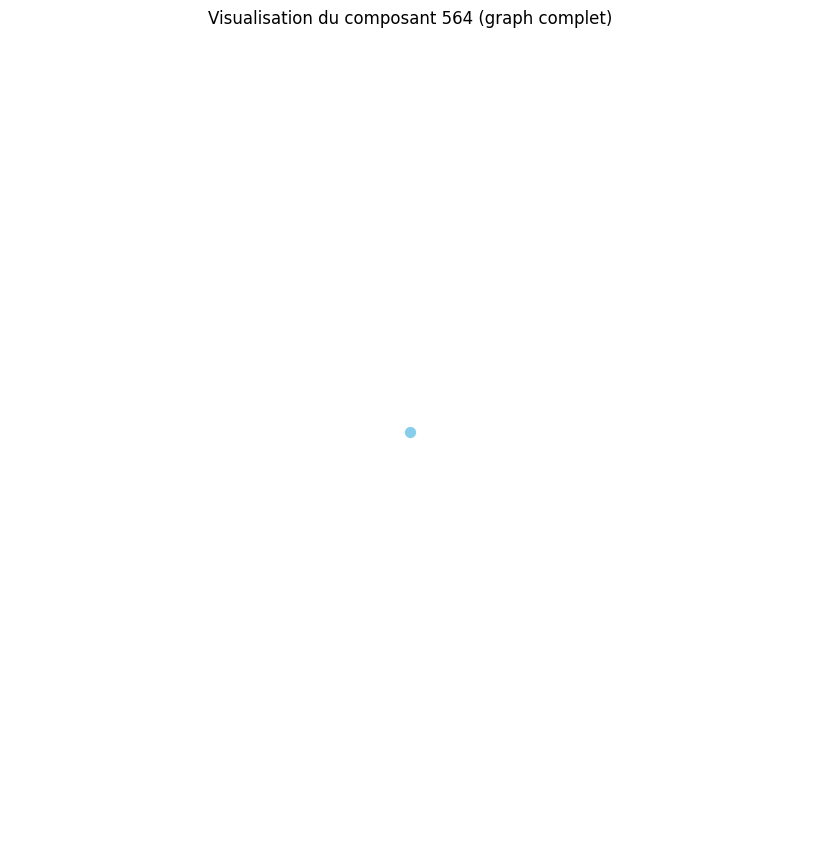

Distance moyenne pour le composant 565 : 1.80
Distance moyenne pour le composant 566 : 0.00
Le composant 566 est un graphe complet ou très densément connecté.
Densité du composant 566 : 0.00
Degré moyen du composant 566 : 0.00
Coefficient de clustering moyen du composant 566 : 0.00


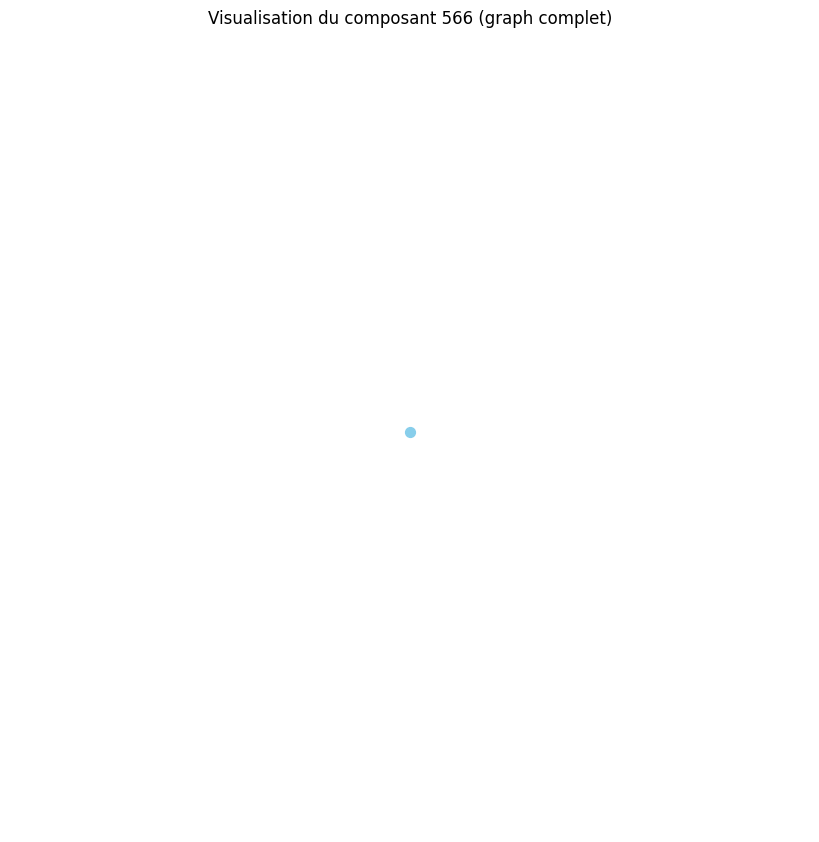

Distance moyenne pour le composant 567 : 0.00
Le composant 567 est un graphe complet ou très densément connecté.
Densité du composant 567 : 0.00
Degré moyen du composant 567 : 0.00
Coefficient de clustering moyen du composant 567 : 0.00


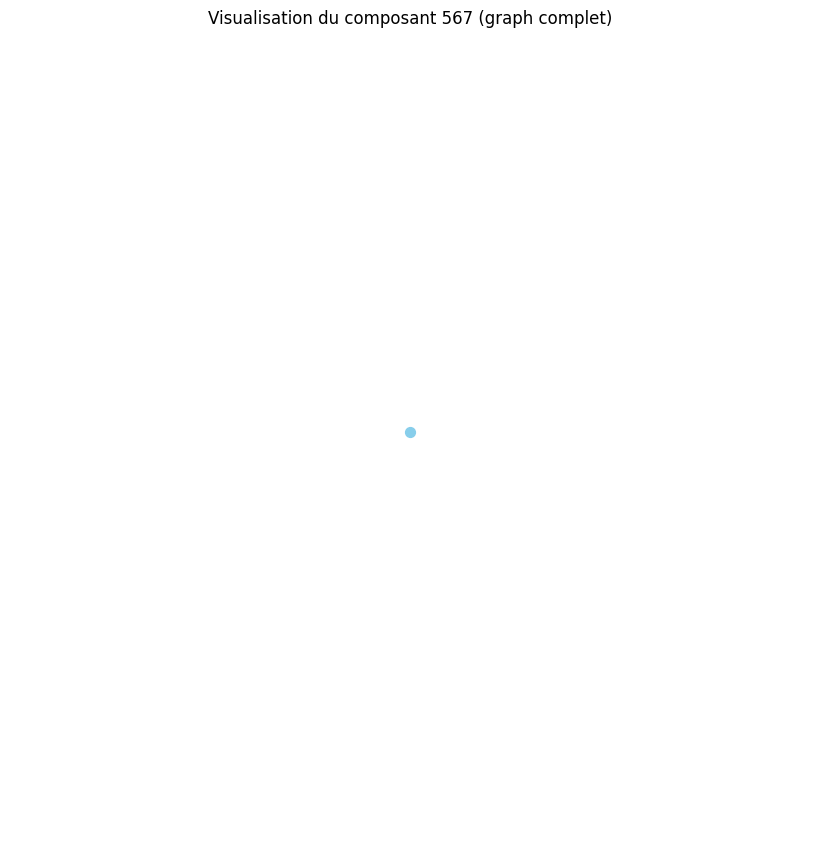

Distance moyenne pour le composant 568 : 0.00
Le composant 568 est un graphe complet ou très densément connecté.
Densité du composant 568 : 0.00
Degré moyen du composant 568 : 0.00
Coefficient de clustering moyen du composant 568 : 0.00


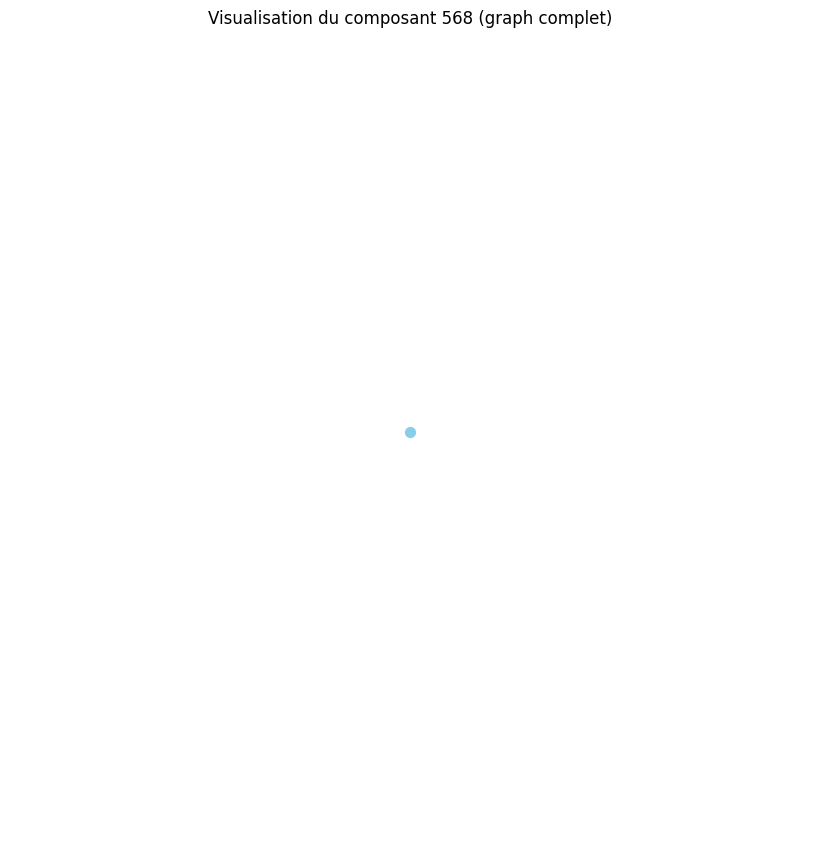

Distance moyenne pour le composant 569 : 0.00
Le composant 569 est un graphe complet ou très densément connecté.
Densité du composant 569 : 0.00
Degré moyen du composant 569 : 0.00
Coefficient de clustering moyen du composant 569 : 0.00


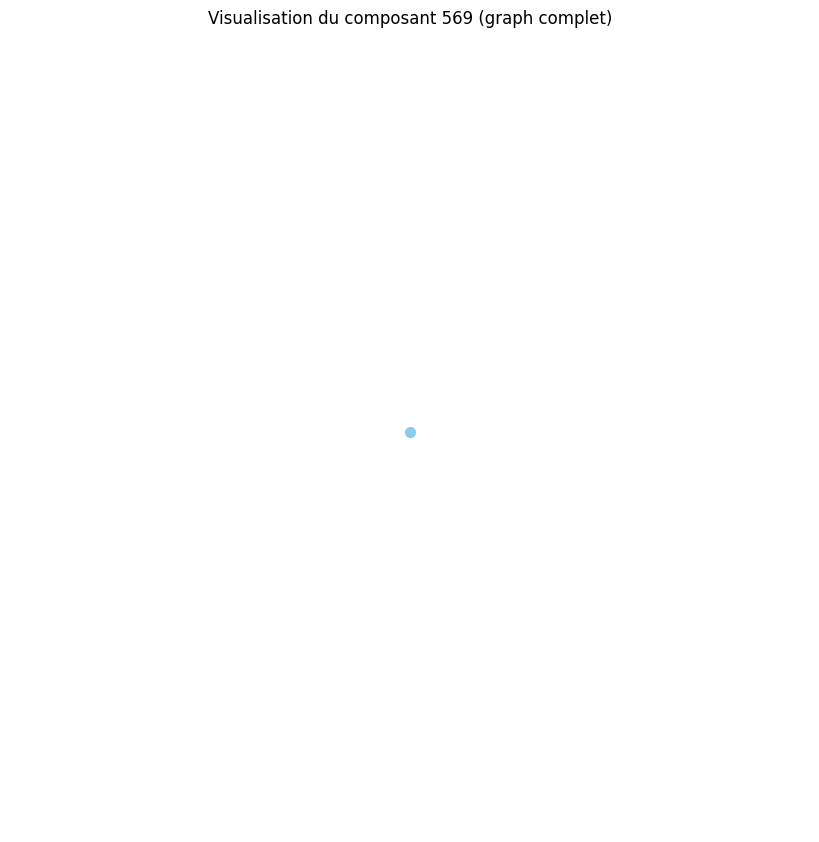

Distance moyenne pour le composant 570 : 0.00
Le composant 570 est un graphe complet ou très densément connecté.
Densité du composant 570 : 0.00
Degré moyen du composant 570 : 0.00
Coefficient de clustering moyen du composant 570 : 0.00


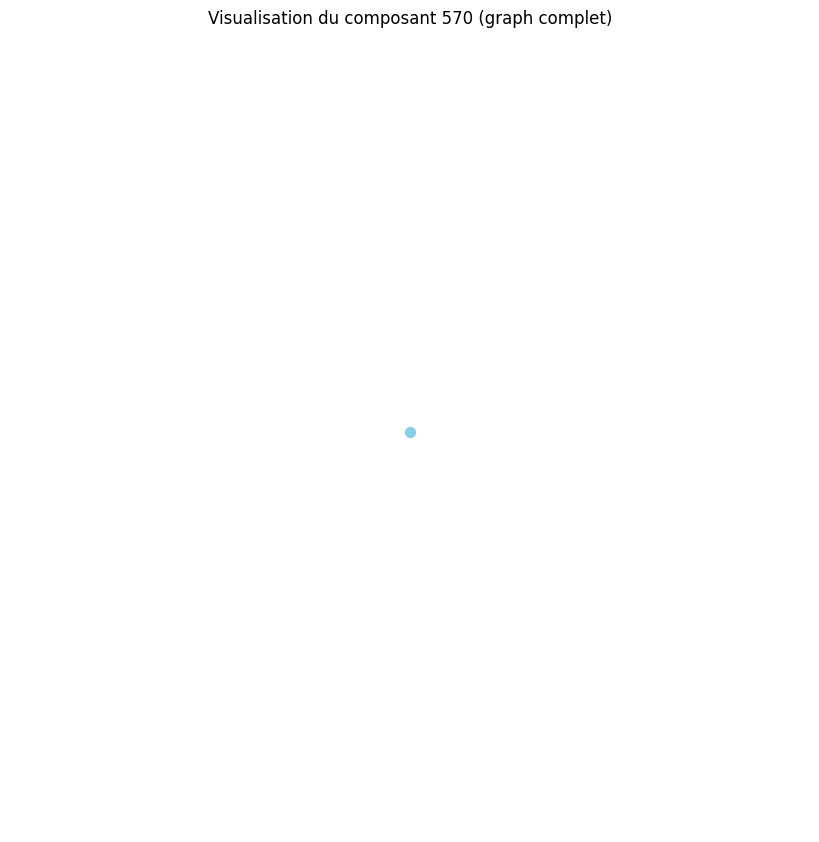

Distance moyenne pour le composant 571 : 0.00
Le composant 571 est un graphe complet ou très densément connecté.
Densité du composant 571 : 0.00
Degré moyen du composant 571 : 0.00
Coefficient de clustering moyen du composant 571 : 0.00


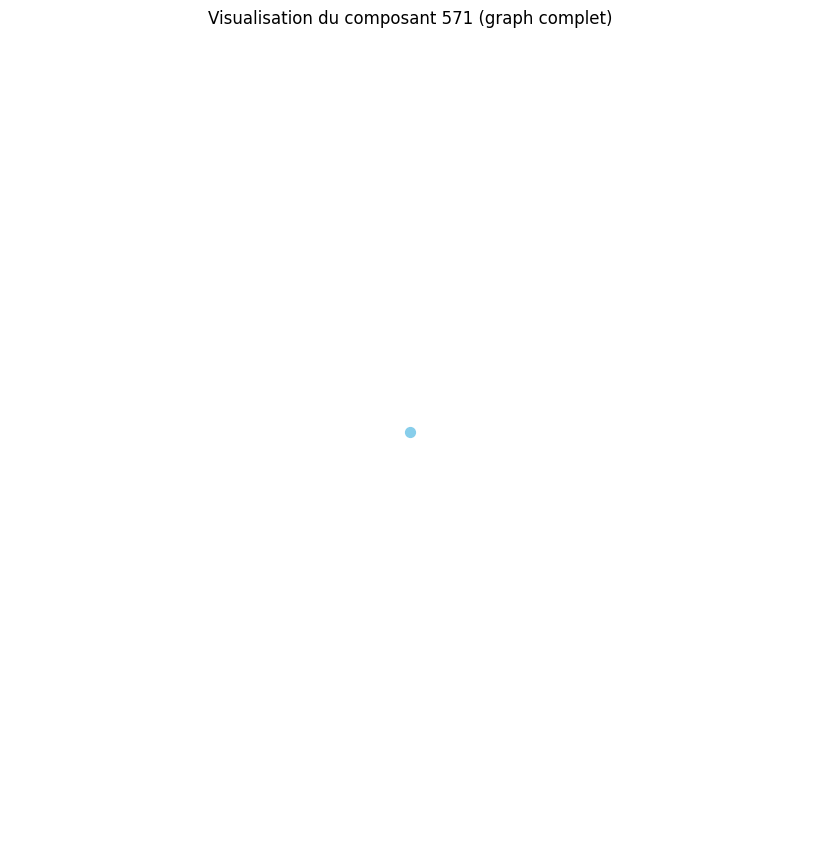

Distance moyenne pour le composant 572 : 0.00
Le composant 572 est un graphe complet ou très densément connecté.
Densité du composant 572 : 0.00
Degré moyen du composant 572 : 0.00
Coefficient de clustering moyen du composant 572 : 0.00


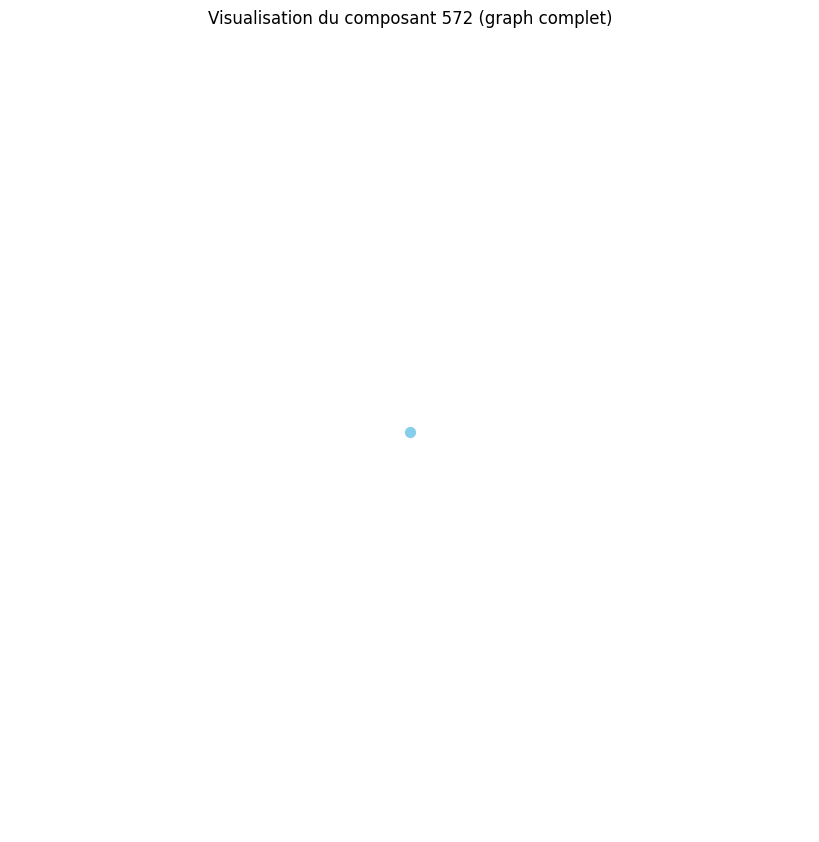

Distance moyenne pour le composant 573 : 0.00
Le composant 573 est un graphe complet ou très densément connecté.
Densité du composant 573 : 0.00
Degré moyen du composant 573 : 0.00
Coefficient de clustering moyen du composant 573 : 0.00


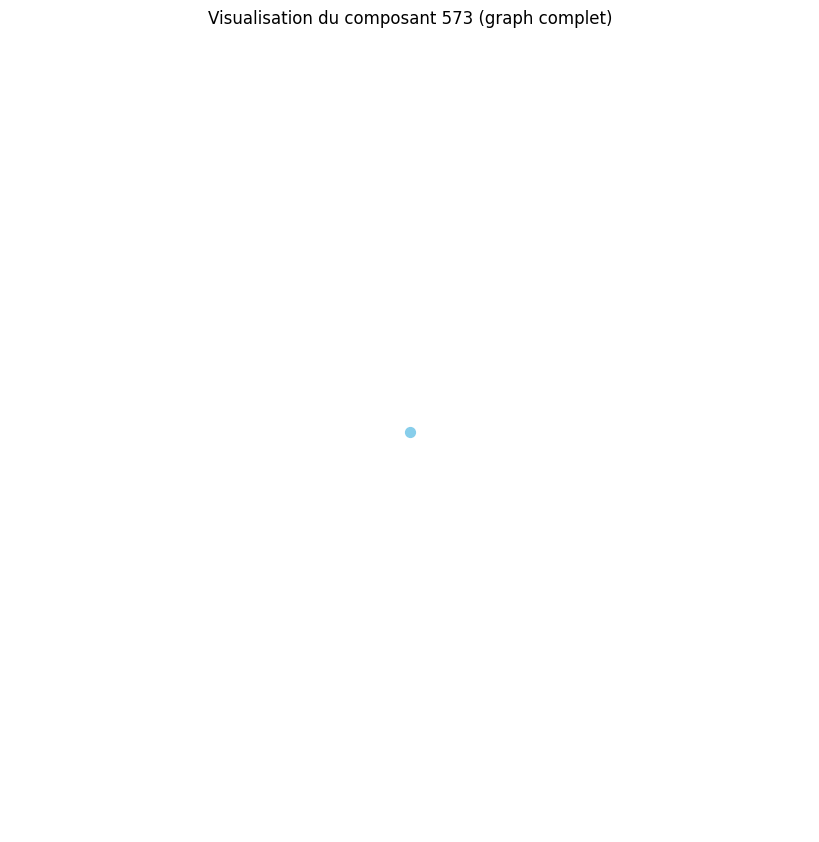

Distance moyenne pour le composant 574 : 0.00
Le composant 574 est un graphe complet ou très densément connecté.
Densité du composant 574 : 0.00
Degré moyen du composant 574 : 0.00
Coefficient de clustering moyen du composant 574 : 0.00


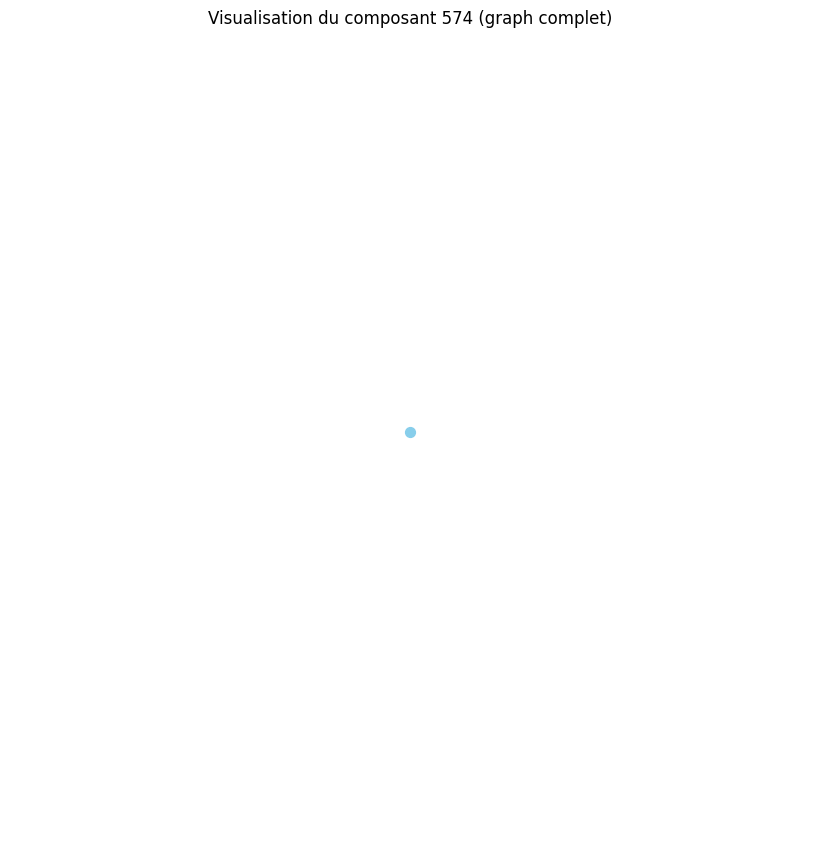

Distance moyenne pour le composant 575 : 0.00
Le composant 575 est un graphe complet ou très densément connecté.
Densité du composant 575 : 0.00
Degré moyen du composant 575 : 0.00
Coefficient de clustering moyen du composant 575 : 0.00


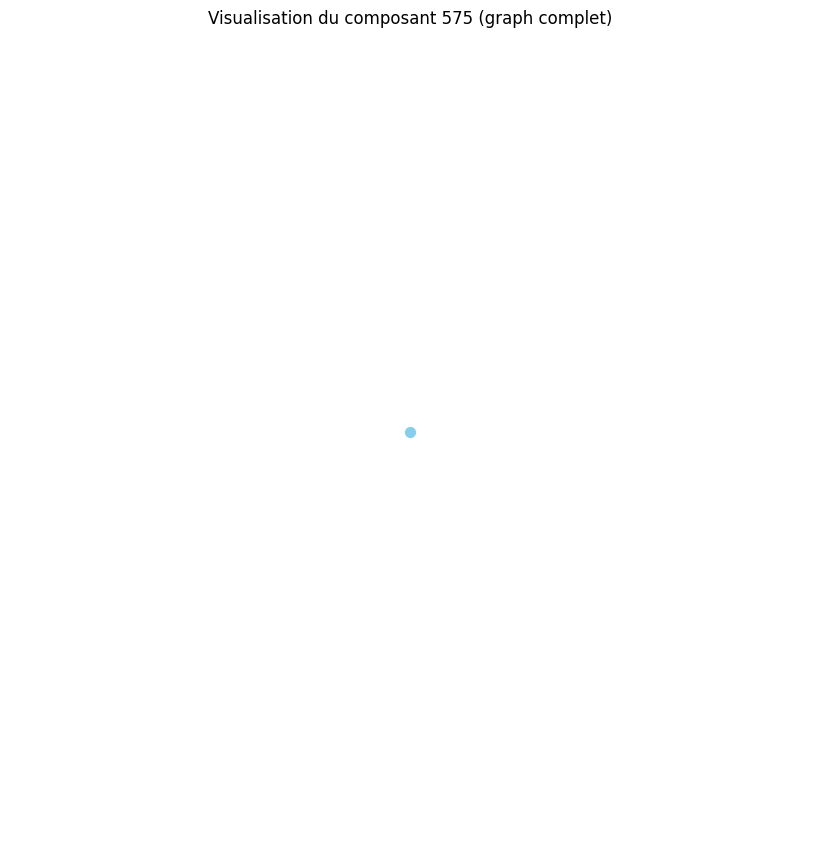

Distance moyenne pour le composant 576 : 0.00
Le composant 576 est un graphe complet ou très densément connecté.
Densité du composant 576 : 0.00
Degré moyen du composant 576 : 0.00
Coefficient de clustering moyen du composant 576 : 0.00


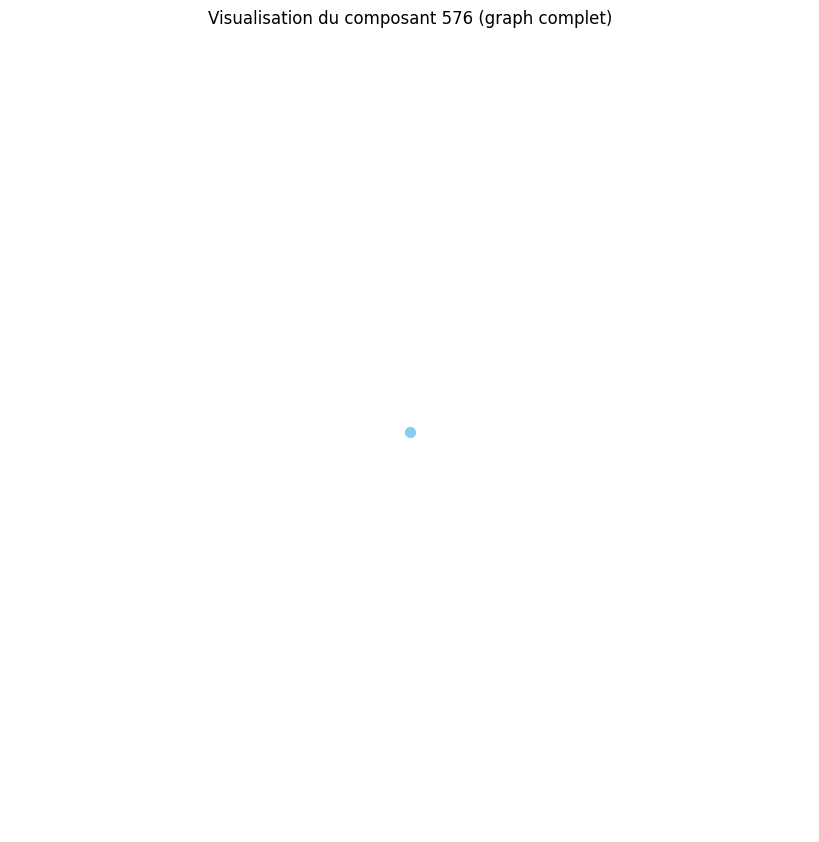

Distance moyenne pour le composant 577 : 0.00
Le composant 577 est un graphe complet ou très densément connecté.
Densité du composant 577 : 0.00
Degré moyen du composant 577 : 0.00
Coefficient de clustering moyen du composant 577 : 0.00


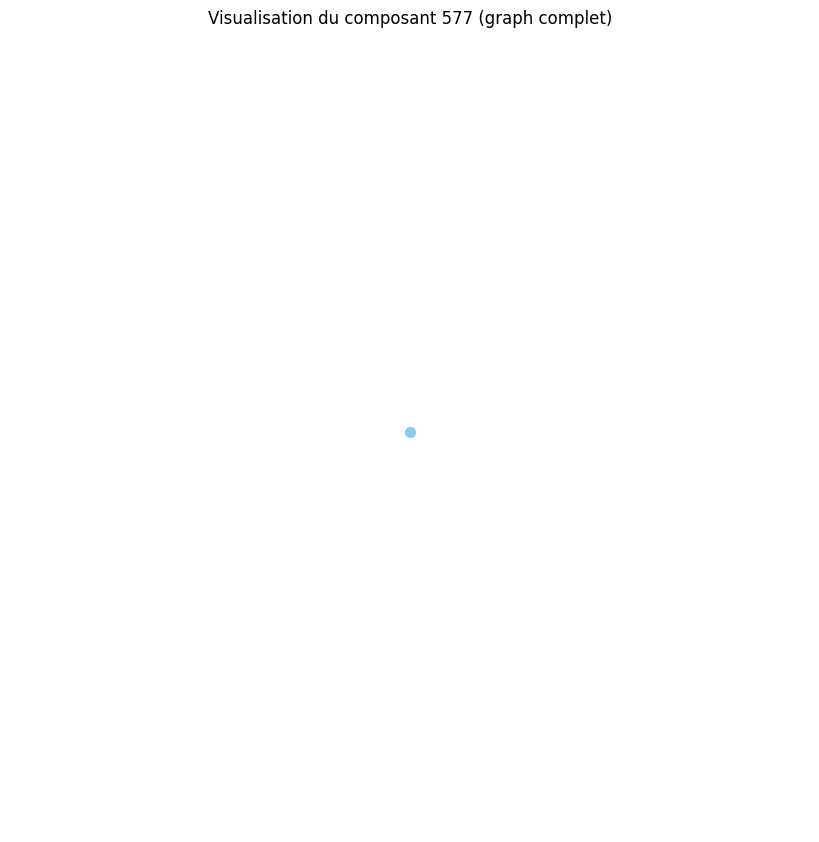

Distance moyenne pour le composant 578 : 0.00
Le composant 578 est un graphe complet ou très densément connecté.
Densité du composant 578 : 0.00
Degré moyen du composant 578 : 0.00
Coefficient de clustering moyen du composant 578 : 0.00


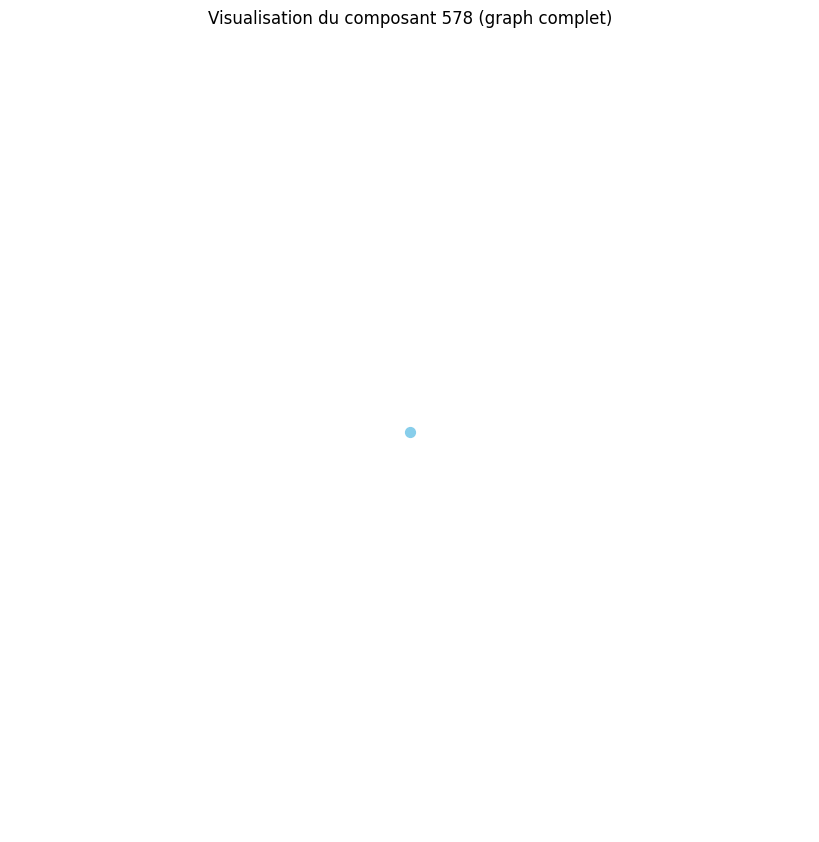

Distance moyenne pour le composant 579 : 0.00
Le composant 579 est un graphe complet ou très densément connecté.
Densité du composant 579 : 0.00
Degré moyen du composant 579 : 0.00
Coefficient de clustering moyen du composant 579 : 0.00


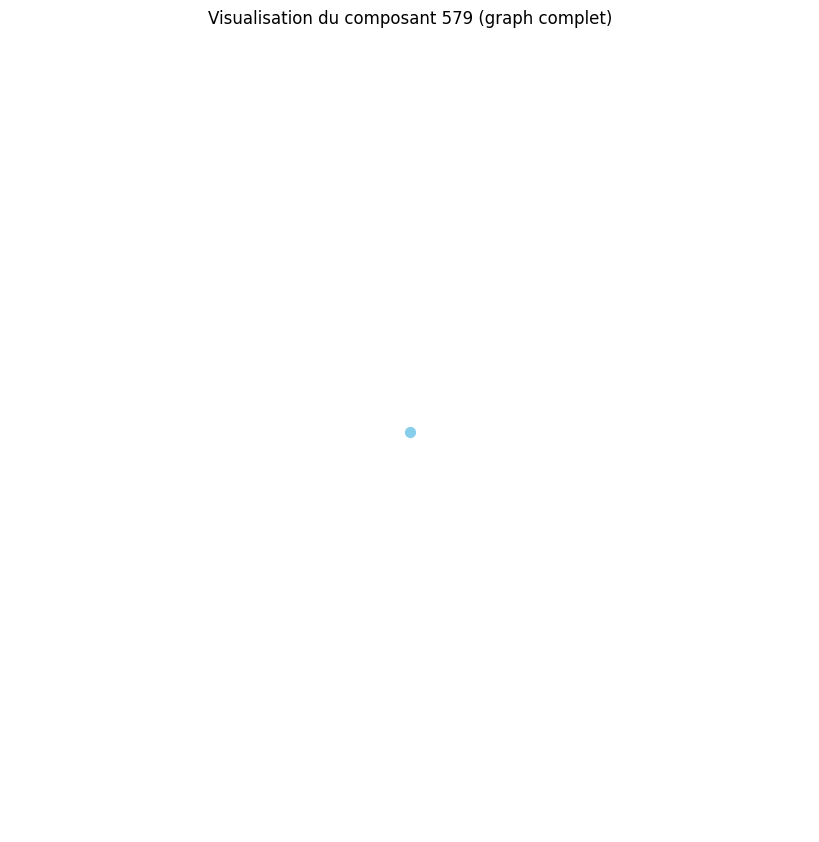

Distance moyenne pour le composant 580 : 0.00
Le composant 580 est un graphe complet ou très densément connecté.
Densité du composant 580 : 0.00
Degré moyen du composant 580 : 0.00
Coefficient de clustering moyen du composant 580 : 0.00


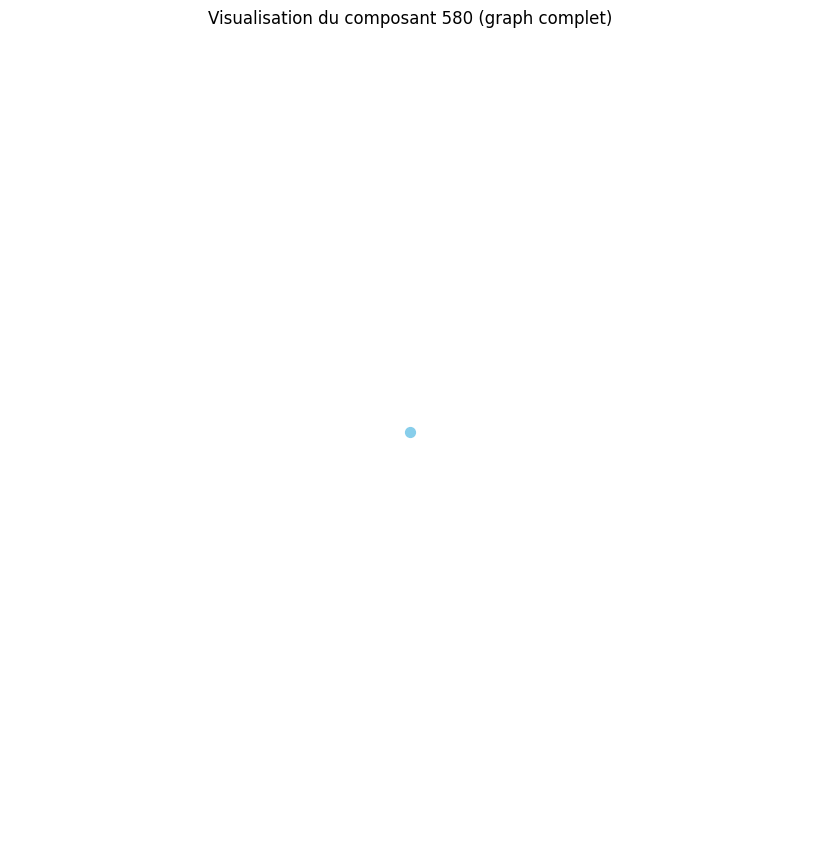

Distance moyenne pour le composant 581 : 0.00
Le composant 581 est un graphe complet ou très densément connecté.
Densité du composant 581 : 0.00
Degré moyen du composant 581 : 0.00
Coefficient de clustering moyen du composant 581 : 0.00


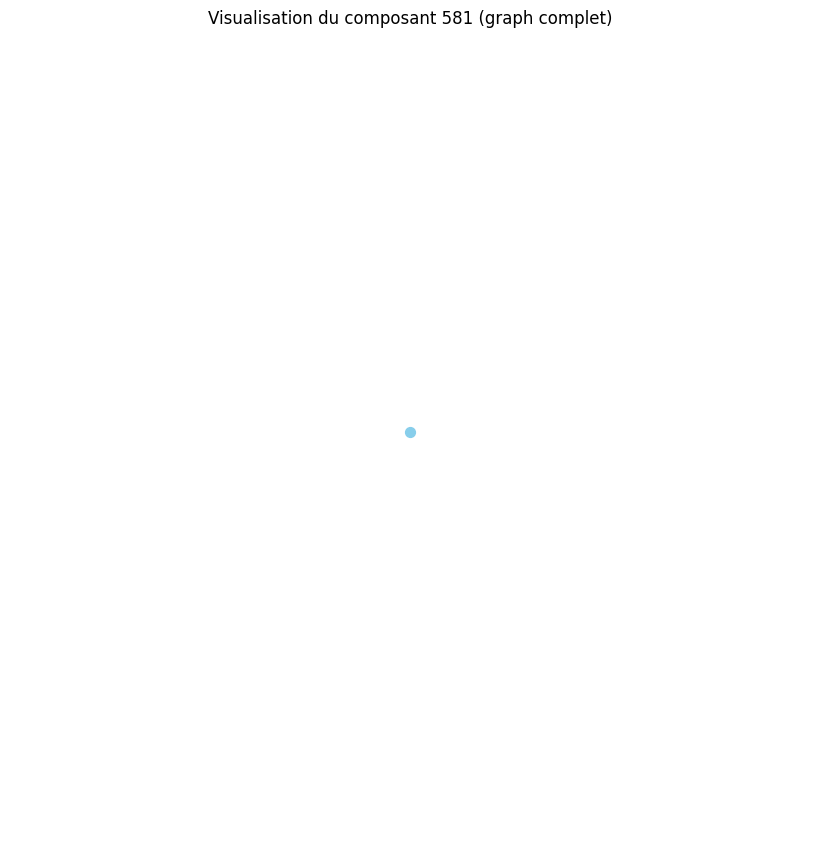

Distance moyenne pour le composant 582 : 0.00
Le composant 582 est un graphe complet ou très densément connecté.
Densité du composant 582 : 0.00
Degré moyen du composant 582 : 0.00
Coefficient de clustering moyen du composant 582 : 0.00


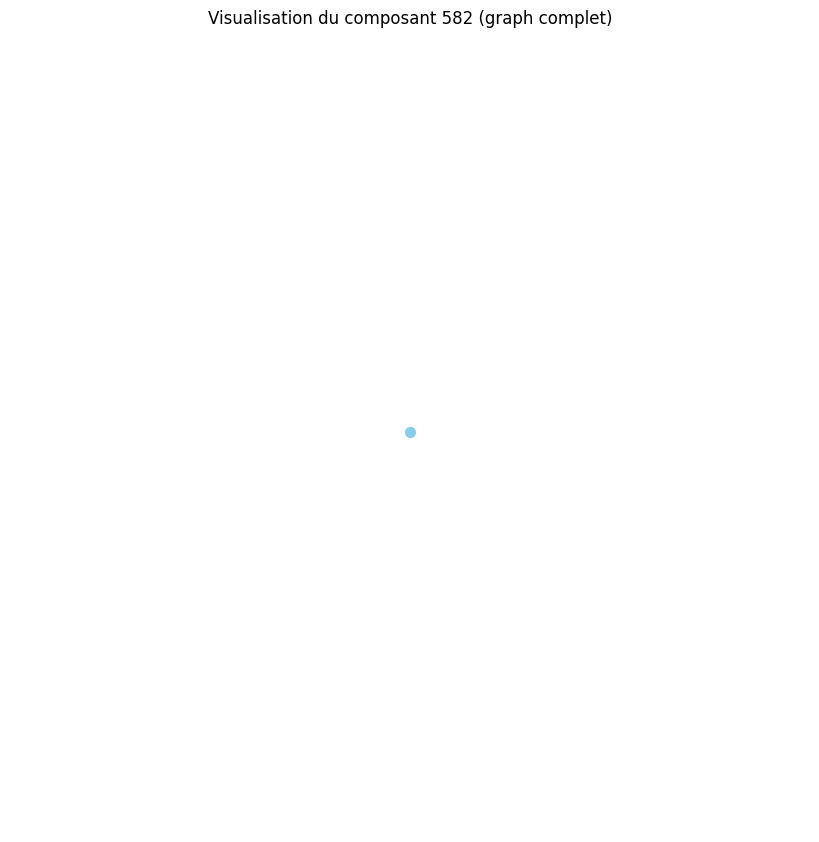

Distance moyenne pour le composant 583 : 0.00
Le composant 583 est un graphe complet ou très densément connecté.
Densité du composant 583 : 0.00
Degré moyen du composant 583 : 0.00
Coefficient de clustering moyen du composant 583 : 0.00


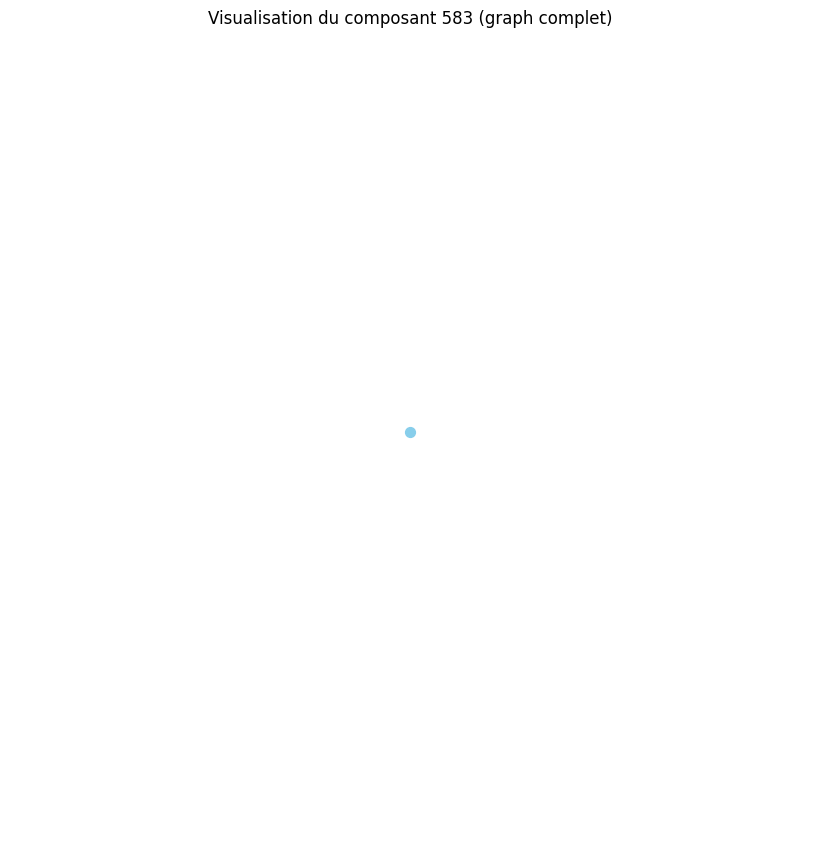

Distance moyenne pour le composant 584 : 0.00
Le composant 584 est un graphe complet ou très densément connecté.
Densité du composant 584 : 0.00
Degré moyen du composant 584 : 0.00
Coefficient de clustering moyen du composant 584 : 0.00


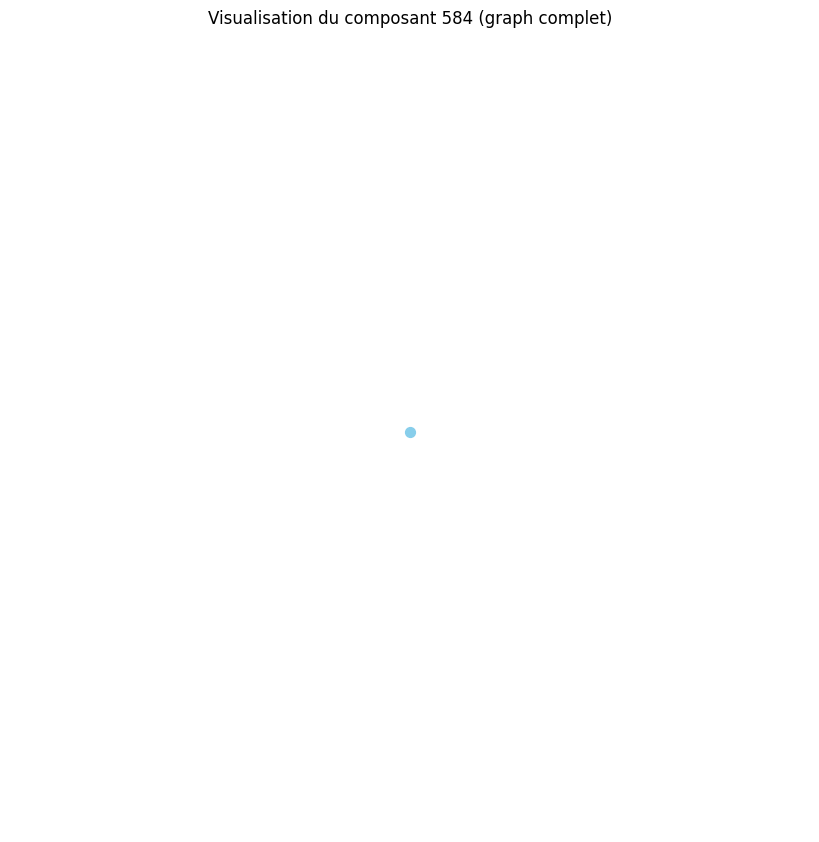

Distance moyenne pour le composant 585 : 0.00
Le composant 585 est un graphe complet ou très densément connecté.
Densité du composant 585 : 0.00
Degré moyen du composant 585 : 0.00
Coefficient de clustering moyen du composant 585 : 0.00


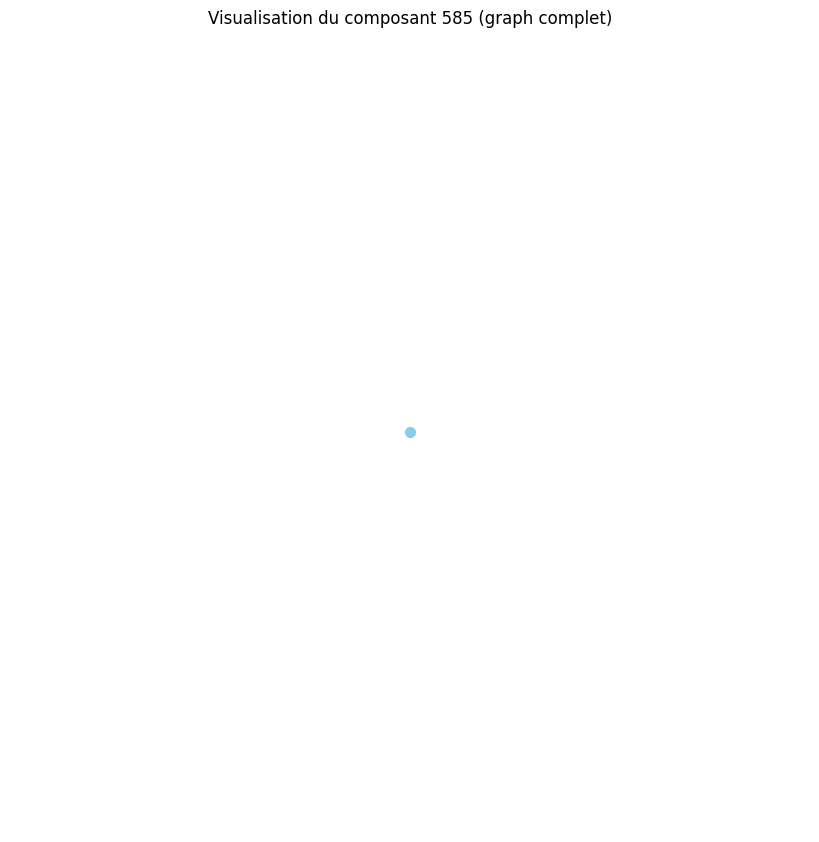

Distance moyenne pour le composant 586 : 0.00
Le composant 586 est un graphe complet ou très densément connecté.
Densité du composant 586 : 0.00
Degré moyen du composant 586 : 0.00
Coefficient de clustering moyen du composant 586 : 0.00


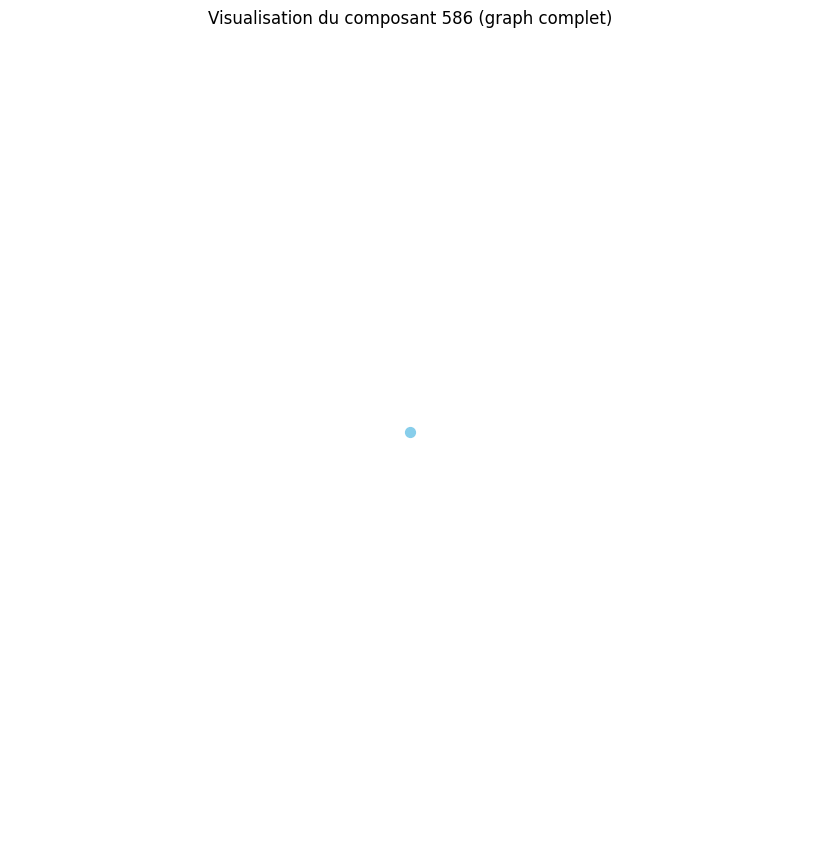

Distance moyenne pour le composant 587 : 0.00
Le composant 587 est un graphe complet ou très densément connecté.
Densité du composant 587 : 0.00
Degré moyen du composant 587 : 0.00
Coefficient de clustering moyen du composant 587 : 0.00


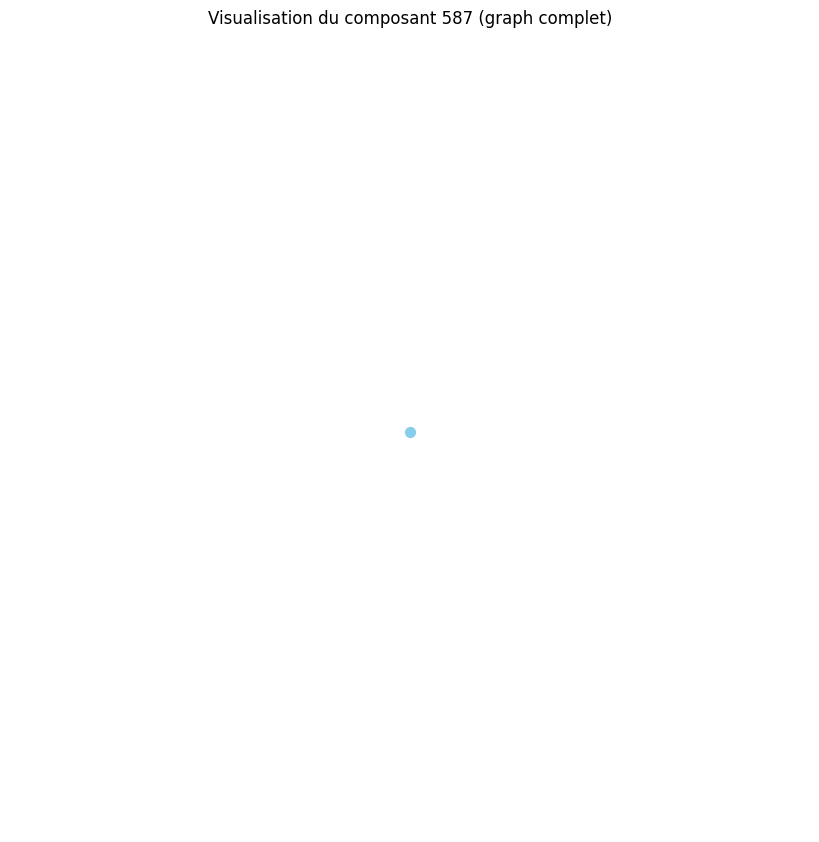

Distance moyenne pour le composant 588 : 0.00
Le composant 588 est un graphe complet ou très densément connecté.
Densité du composant 588 : 0.00
Degré moyen du composant 588 : 0.00
Coefficient de clustering moyen du composant 588 : 0.00


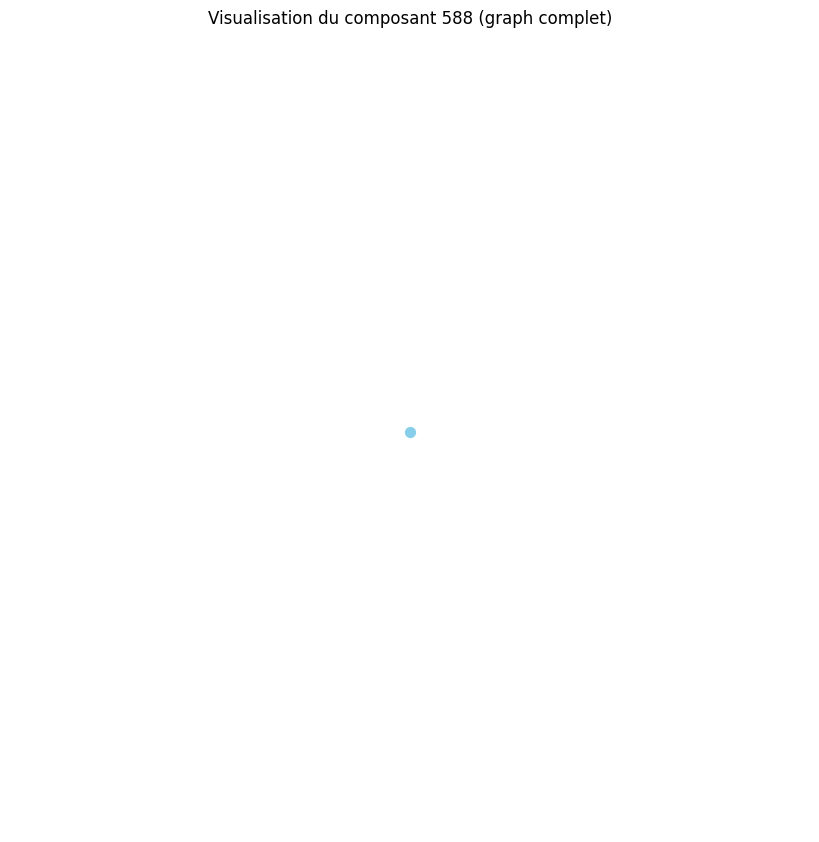

Distance moyenne pour le composant 589 : 0.00
Le composant 589 est un graphe complet ou très densément connecté.
Densité du composant 589 : 0.00
Degré moyen du composant 589 : 0.00
Coefficient de clustering moyen du composant 589 : 0.00


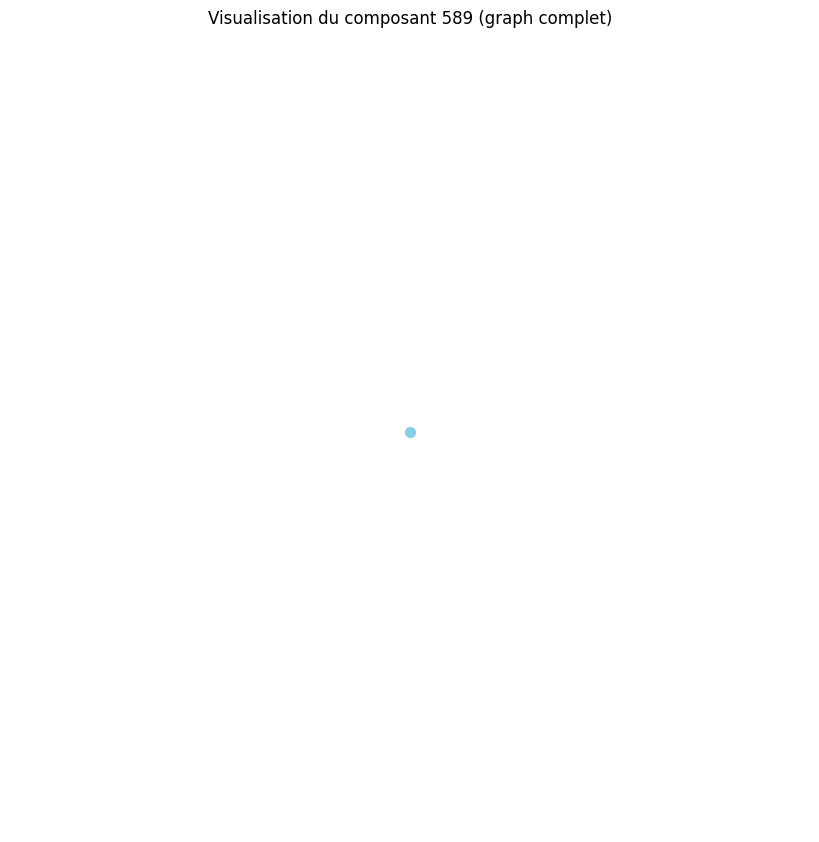

Distance moyenne pour le composant 590 : 0.00
Le composant 590 est un graphe complet ou très densément connecté.
Densité du composant 590 : 0.00
Degré moyen du composant 590 : 0.00
Coefficient de clustering moyen du composant 590 : 0.00


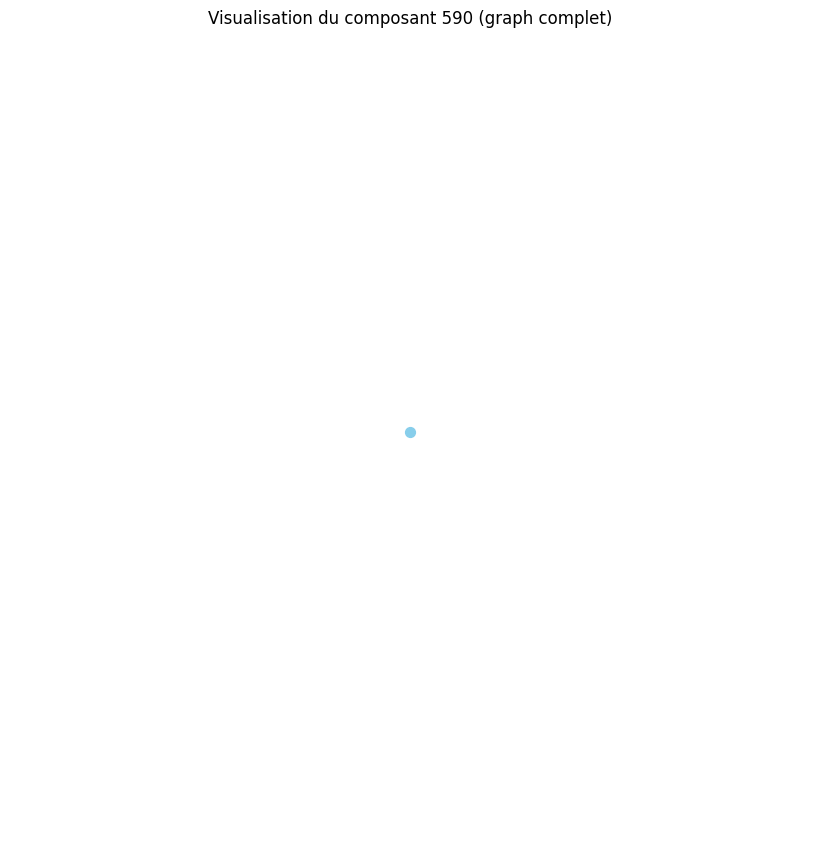

Distance moyenne pour le composant 591 : 0.00
Le composant 591 est un graphe complet ou très densément connecté.
Densité du composant 591 : 0.00
Degré moyen du composant 591 : 0.00
Coefficient de clustering moyen du composant 591 : 0.00


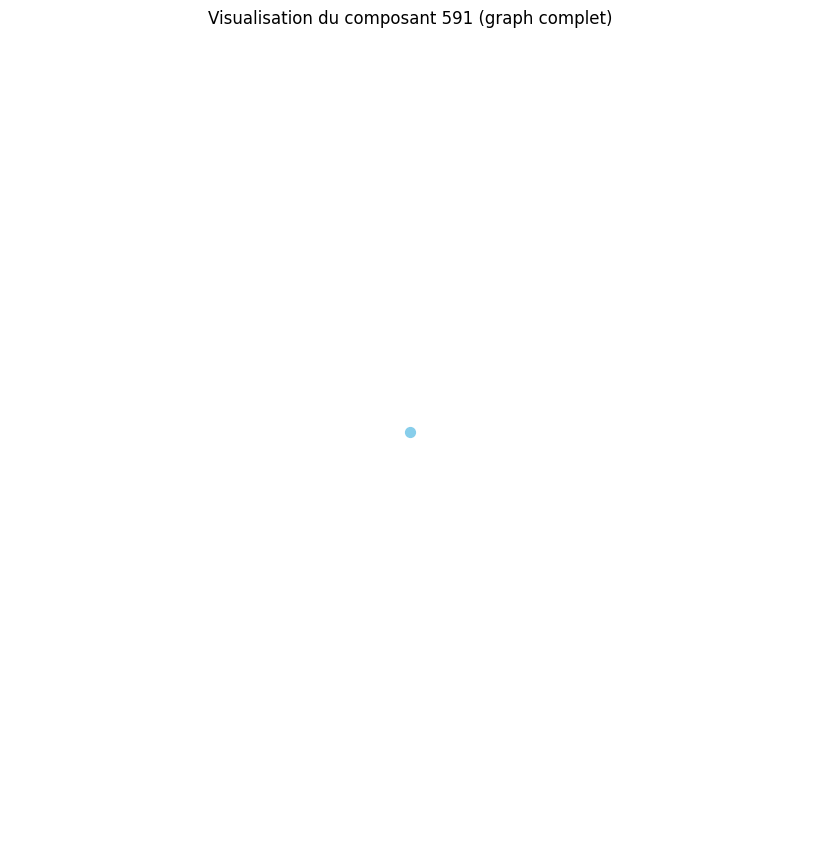

Distance moyenne pour le composant 592 : 0.00
Le composant 592 est un graphe complet ou très densément connecté.
Densité du composant 592 : 0.00
Degré moyen du composant 592 : 0.00
Coefficient de clustering moyen du composant 592 : 0.00


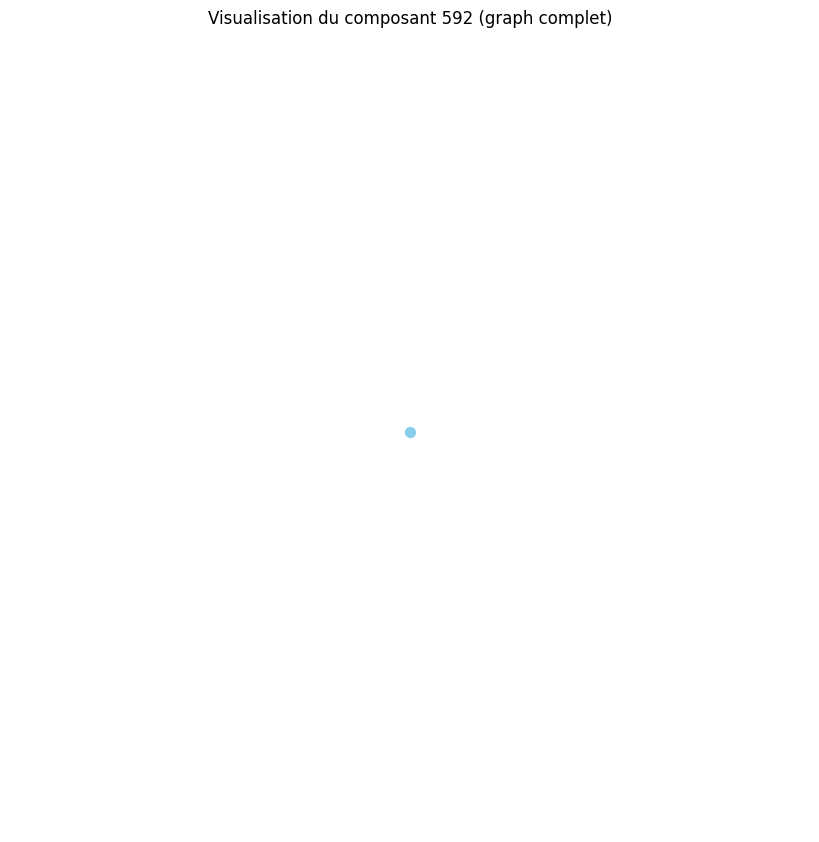

Distance moyenne pour le composant 593 : 1.67
Distance moyenne pour le composant 594 : 0.00
Le composant 594 est un graphe complet ou très densément connecté.
Densité du composant 594 : 0.00
Degré moyen du composant 594 : 0.00
Coefficient de clustering moyen du composant 594 : 0.00


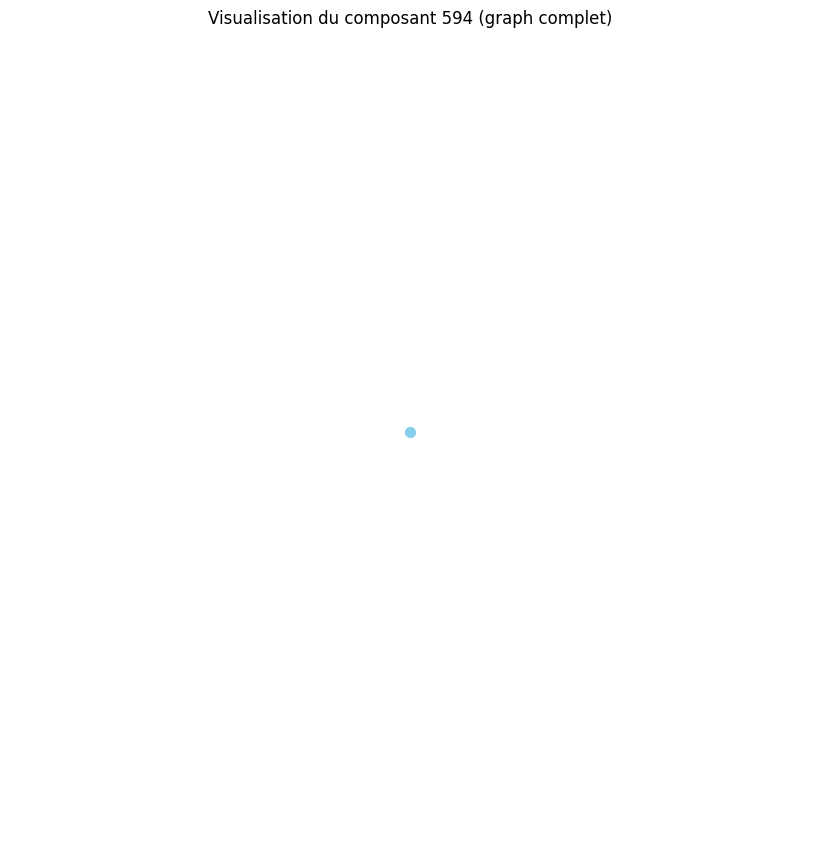

Distance moyenne pour le composant 595 : 0.00
Le composant 595 est un graphe complet ou très densément connecté.
Densité du composant 595 : 0.00
Degré moyen du composant 595 : 0.00
Coefficient de clustering moyen du composant 595 : 0.00


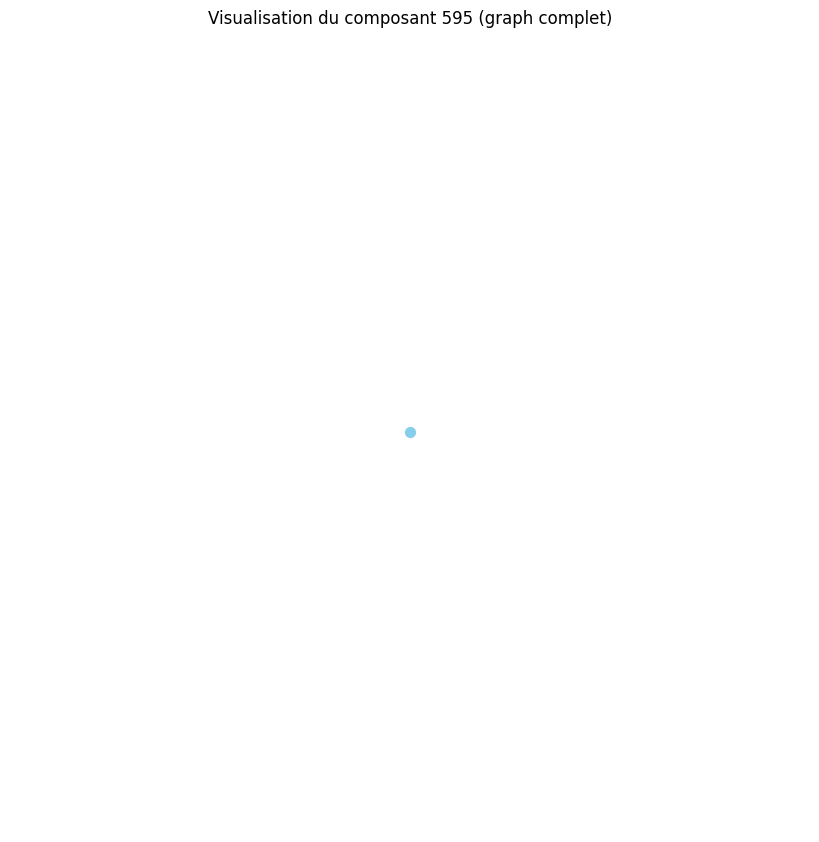

Distance moyenne pour le composant 596 : 0.00
Le composant 596 est un graphe complet ou très densément connecté.
Densité du composant 596 : 0.00
Degré moyen du composant 596 : 0.00
Coefficient de clustering moyen du composant 596 : 0.00


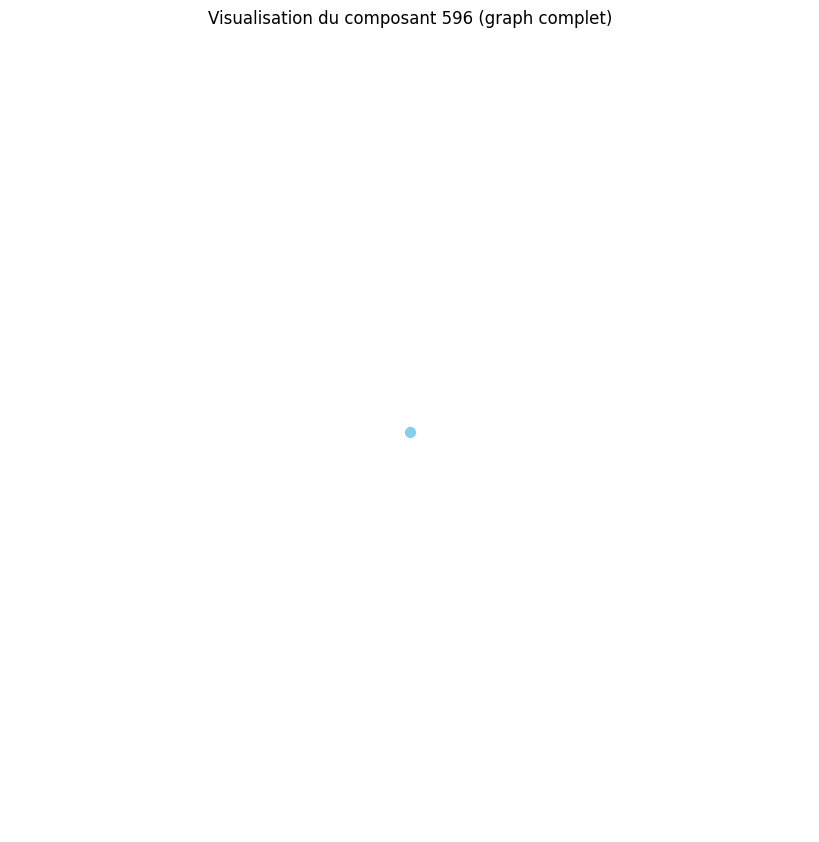

Distance moyenne pour le composant 597 : 1.00
Distance moyenne pour le composant 598 : 0.00
Le composant 598 est un graphe complet ou très densément connecté.
Densité du composant 598 : 0.00
Degré moyen du composant 598 : 0.00
Coefficient de clustering moyen du composant 598 : 0.00


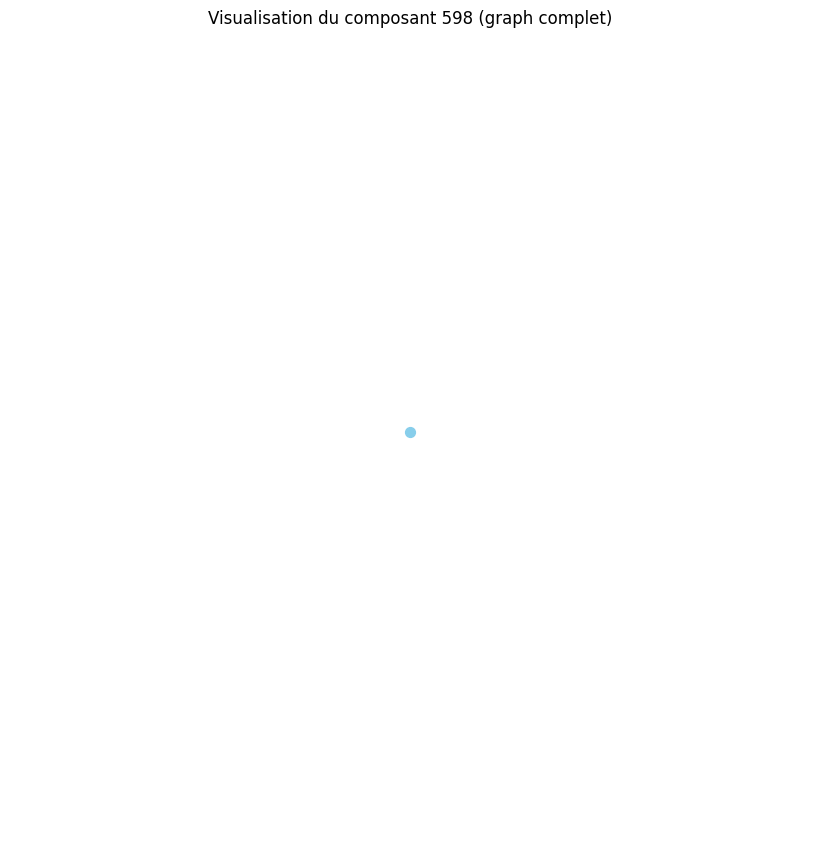

Distance moyenne pour le composant 599 : 0.00
Le composant 599 est un graphe complet ou très densément connecté.
Densité du composant 599 : 0.00
Degré moyen du composant 599 : 0.00
Coefficient de clustering moyen du composant 599 : 0.00


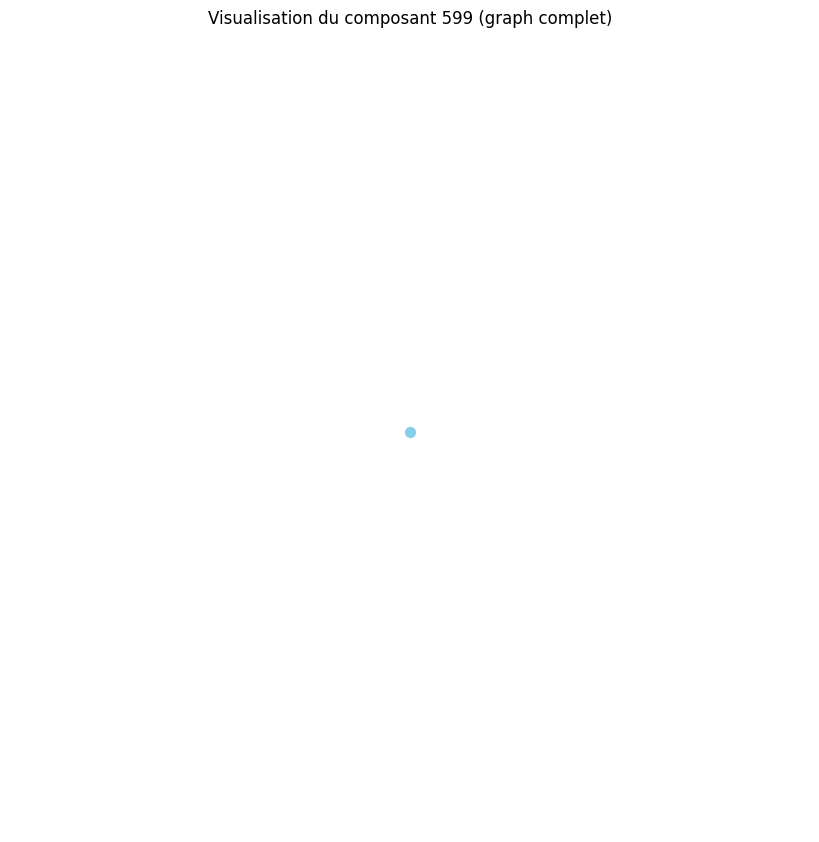

Distance moyenne pour le composant 600 : 0.00
Le composant 600 est un graphe complet ou très densément connecté.
Densité du composant 600 : 0.00
Degré moyen du composant 600 : 0.00
Coefficient de clustering moyen du composant 600 : 0.00


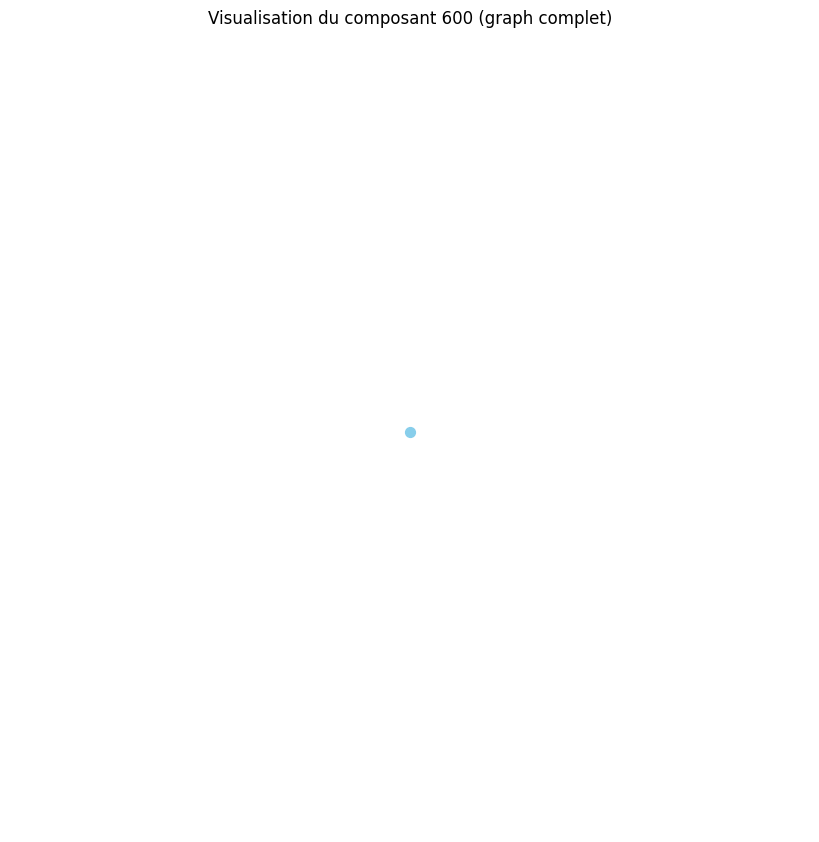

Distance moyenne pour le composant 601 : 0.00
Le composant 601 est un graphe complet ou très densément connecté.
Densité du composant 601 : 0.00
Degré moyen du composant 601 : 0.00
Coefficient de clustering moyen du composant 601 : 0.00


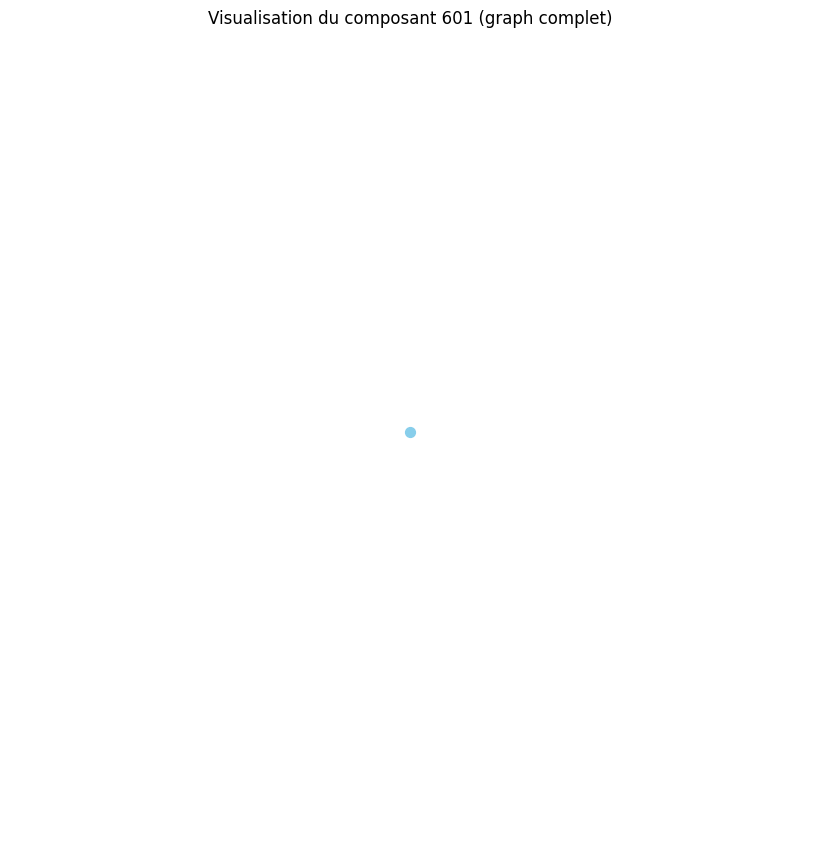

Distance moyenne pour le composant 602 : 0.00
Le composant 602 est un graphe complet ou très densément connecté.
Densité du composant 602 : 0.00
Degré moyen du composant 602 : 0.00
Coefficient de clustering moyen du composant 602 : 0.00


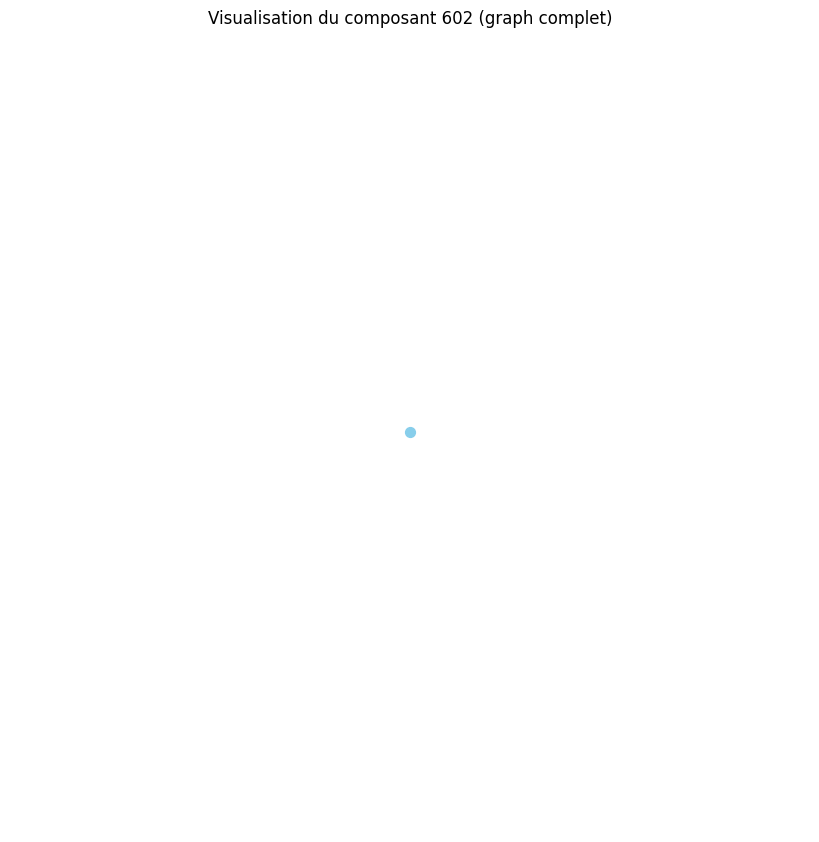

Distance moyenne pour le composant 603 : 0.00
Le composant 603 est un graphe complet ou très densément connecté.
Densité du composant 603 : 0.00
Degré moyen du composant 603 : 0.00
Coefficient de clustering moyen du composant 603 : 0.00


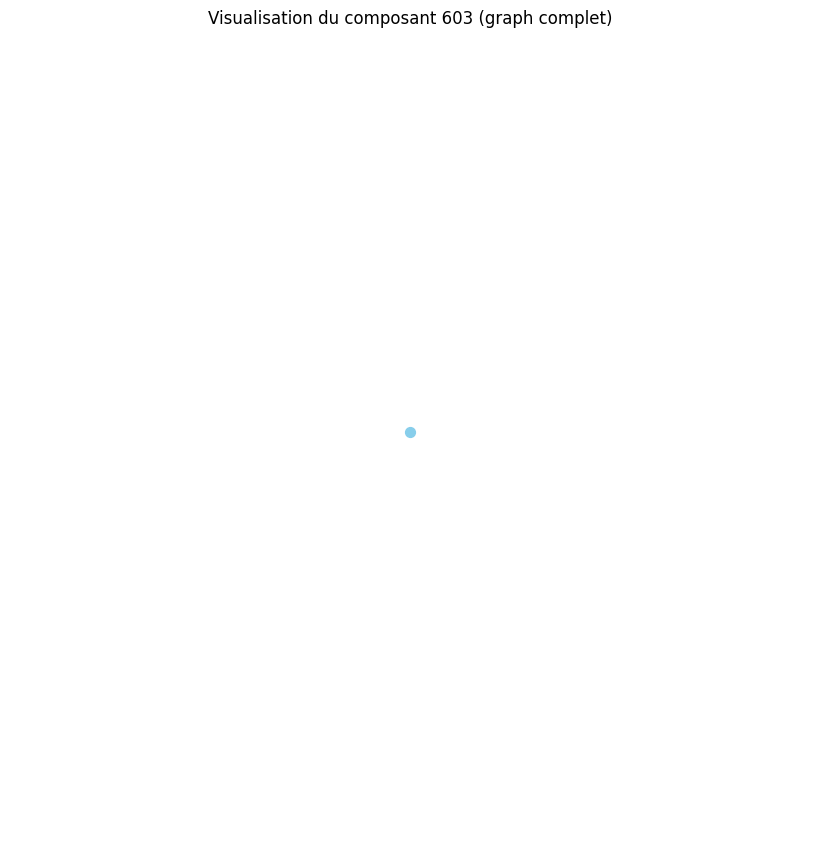

Distance moyenne pour le composant 604 : 0.00
Le composant 604 est un graphe complet ou très densément connecté.
Densité du composant 604 : 0.00
Degré moyen du composant 604 : 0.00
Coefficient de clustering moyen du composant 604 : 0.00


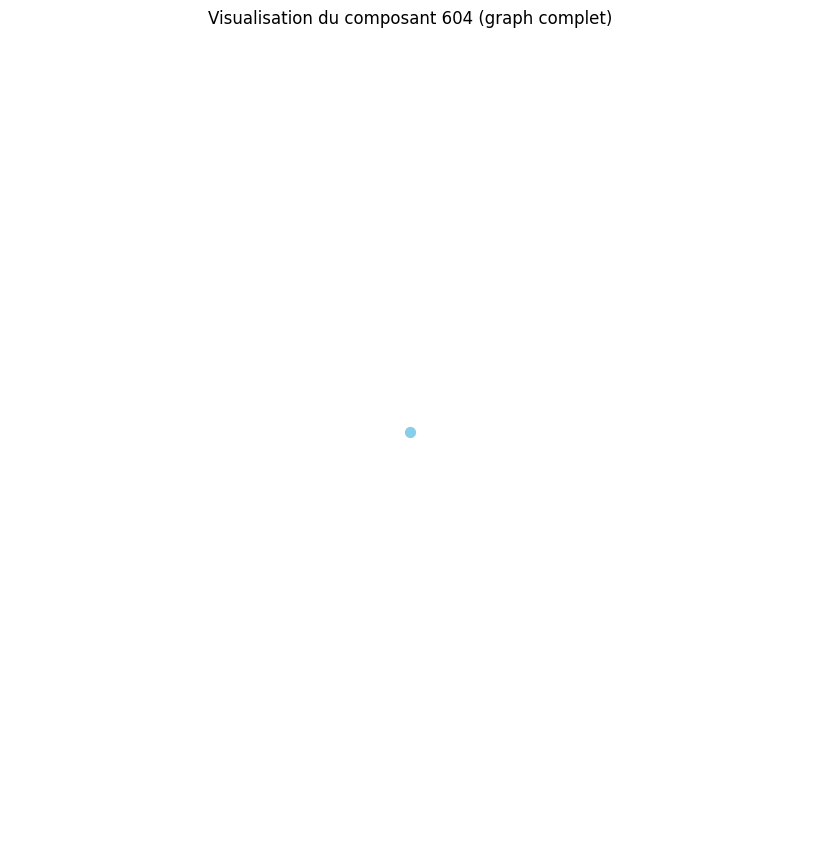

Distance moyenne pour le composant 605 : 0.00
Le composant 605 est un graphe complet ou très densément connecté.
Densité du composant 605 : 0.00
Degré moyen du composant 605 : 0.00
Coefficient de clustering moyen du composant 605 : 0.00


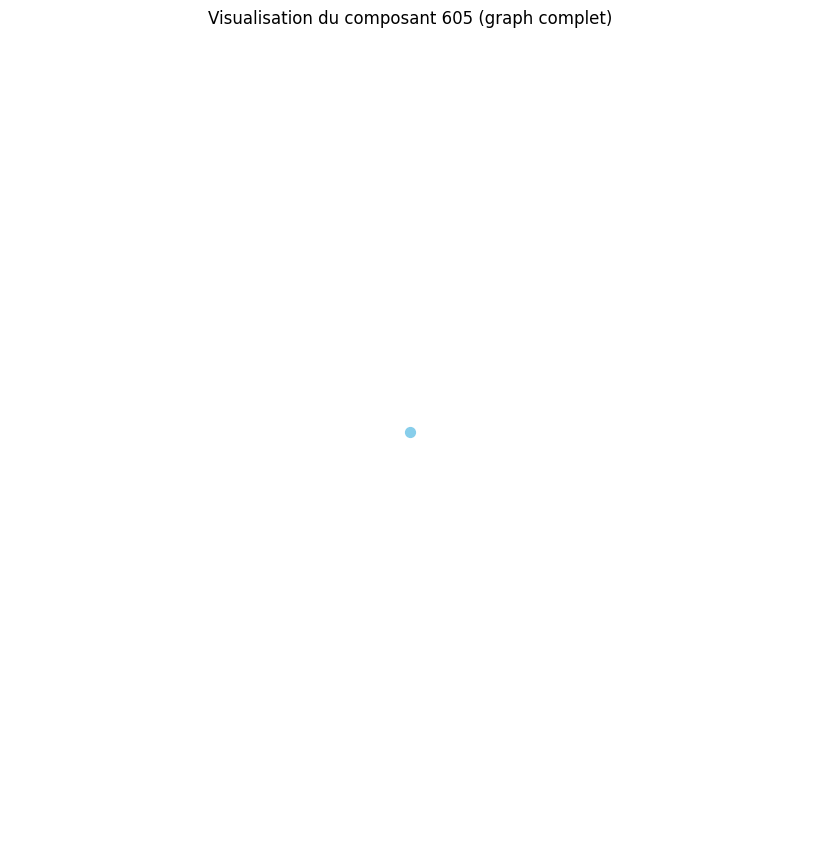

Distance moyenne pour le composant 606 : 0.00
Le composant 606 est un graphe complet ou très densément connecté.
Densité du composant 606 : 0.00
Degré moyen du composant 606 : 0.00
Coefficient de clustering moyen du composant 606 : 0.00


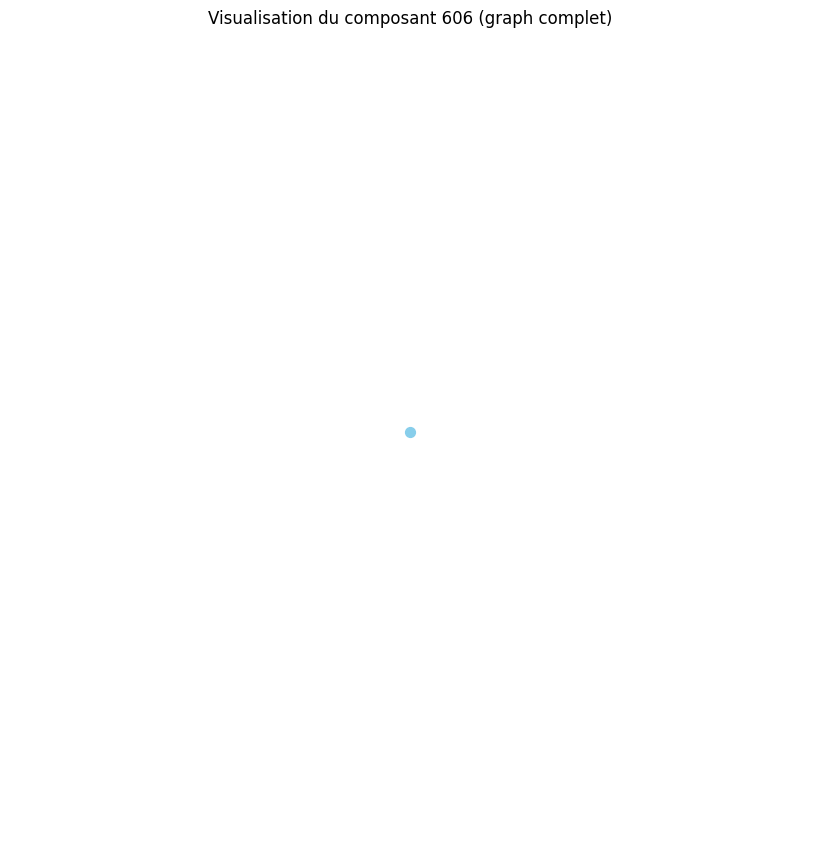

Distance moyenne pour le composant 607 : 0.00
Le composant 607 est un graphe complet ou très densément connecté.
Densité du composant 607 : 0.00
Degré moyen du composant 607 : 0.00
Coefficient de clustering moyen du composant 607 : 0.00


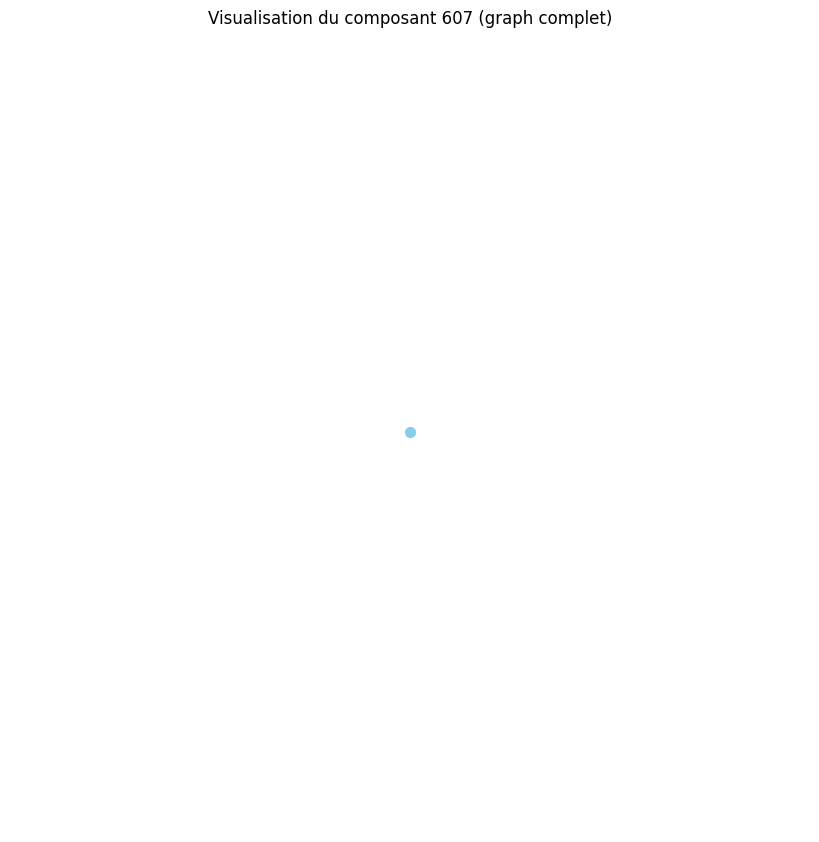

Distance moyenne pour le composant 608 : 0.00
Le composant 608 est un graphe complet ou très densément connecté.
Densité du composant 608 : 0.00
Degré moyen du composant 608 : 0.00
Coefficient de clustering moyen du composant 608 : 0.00


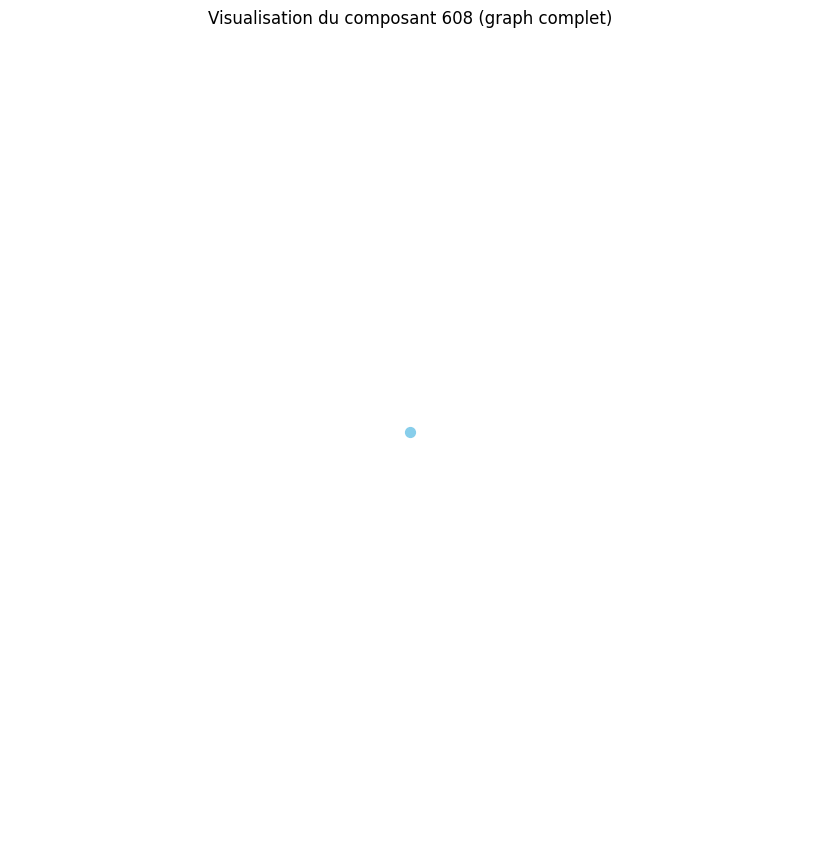

Distance moyenne pour le composant 609 : 0.00
Le composant 609 est un graphe complet ou très densément connecté.
Densité du composant 609 : 0.00
Degré moyen du composant 609 : 0.00
Coefficient de clustering moyen du composant 609 : 0.00


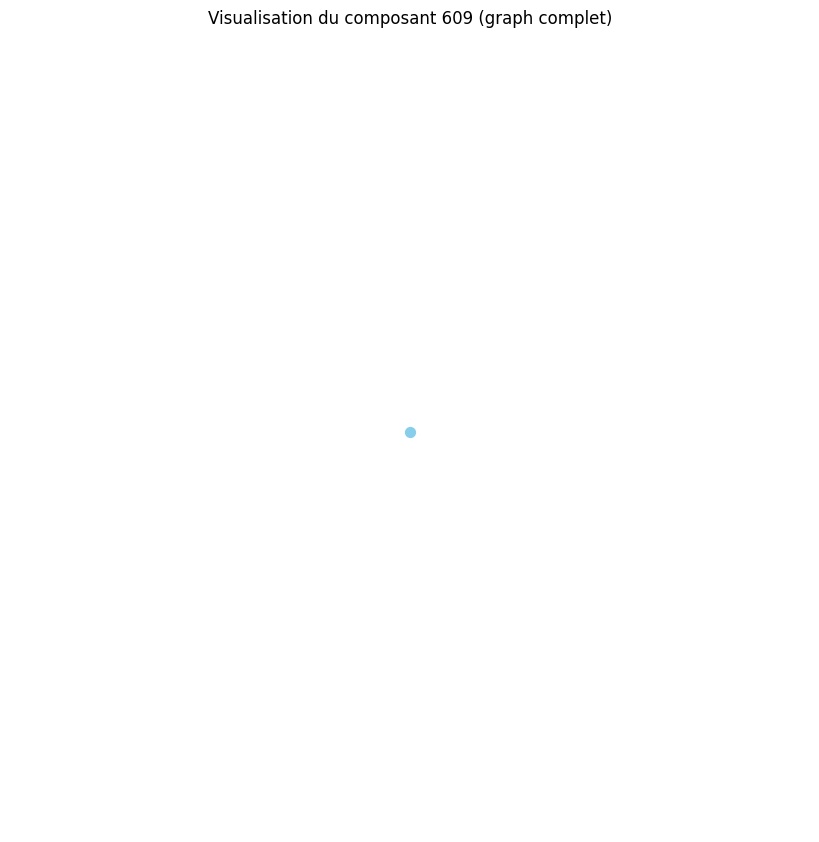

Distance moyenne pour le composant 610 : 0.00
Le composant 610 est un graphe complet ou très densément connecté.
Densité du composant 610 : 0.00
Degré moyen du composant 610 : 0.00
Coefficient de clustering moyen du composant 610 : 0.00


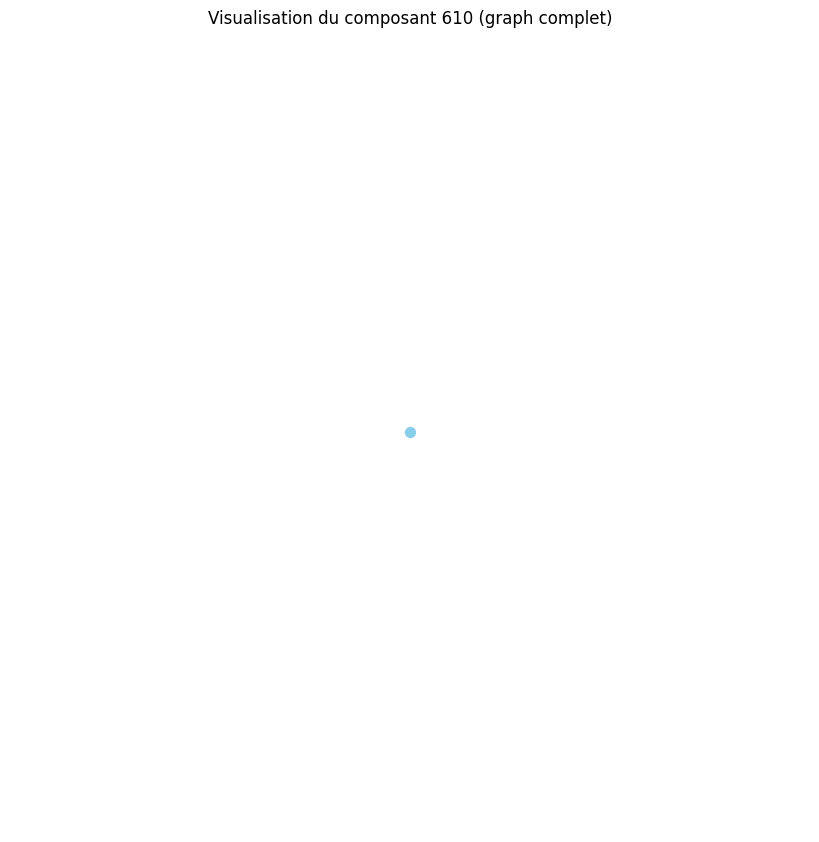

Distance moyenne pour le composant 611 : 0.00
Le composant 611 est un graphe complet ou très densément connecté.
Densité du composant 611 : 0.00
Degré moyen du composant 611 : 0.00
Coefficient de clustering moyen du composant 611 : 0.00


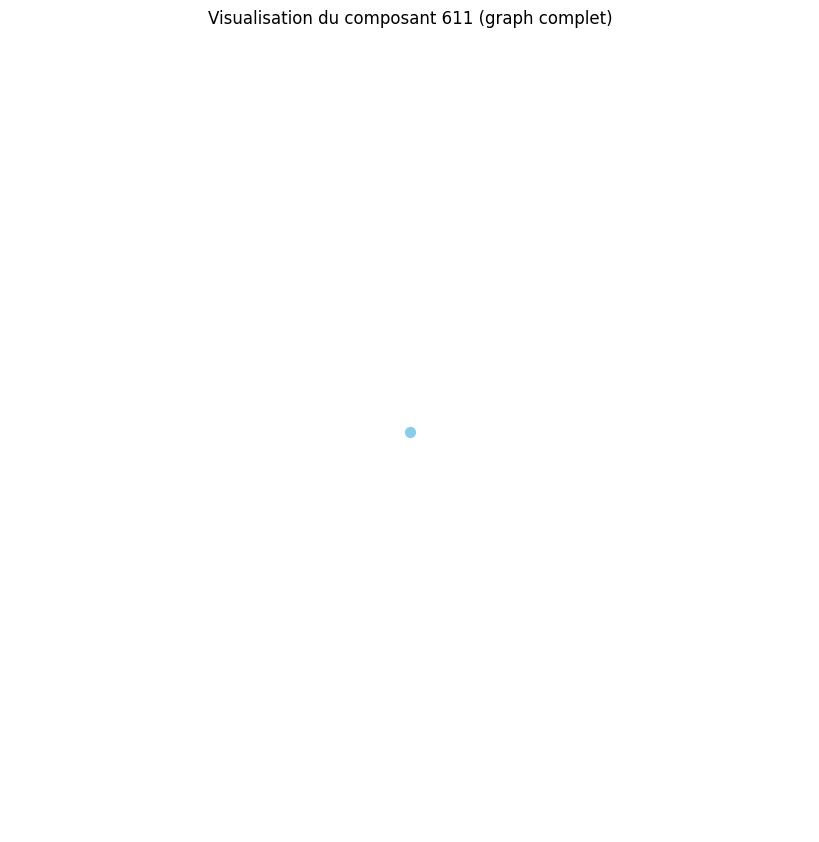

Distance moyenne pour le composant 612 : 0.00
Le composant 612 est un graphe complet ou très densément connecté.
Densité du composant 612 : 0.00
Degré moyen du composant 612 : 0.00
Coefficient de clustering moyen du composant 612 : 0.00


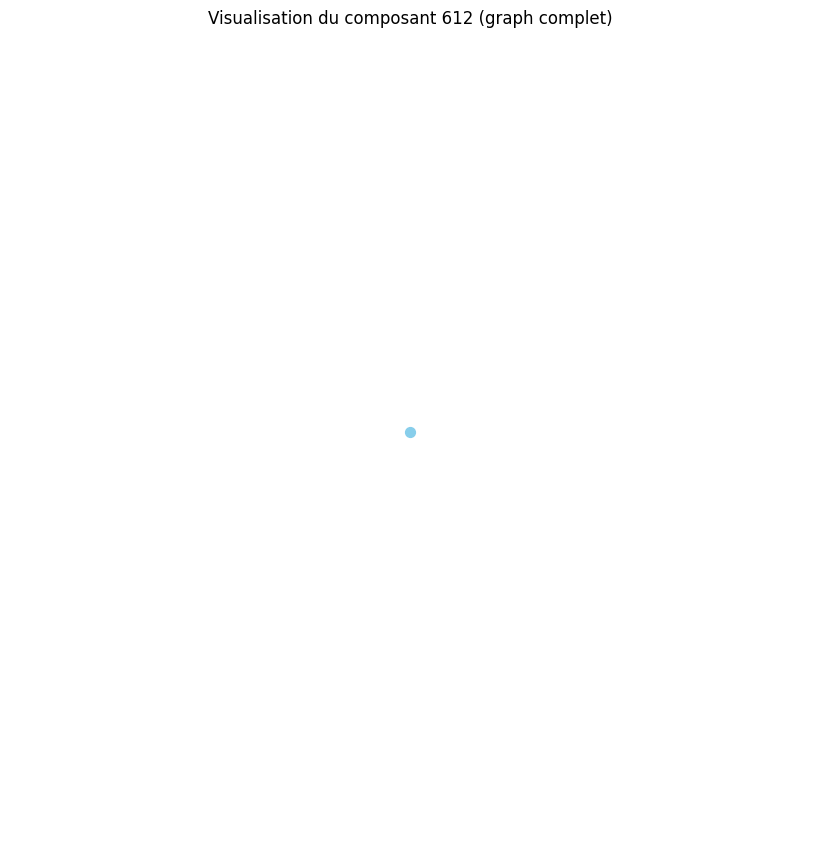

Distance moyenne pour le composant 613 : 0.00
Le composant 613 est un graphe complet ou très densément connecté.
Densité du composant 613 : 0.00
Degré moyen du composant 613 : 0.00
Coefficient de clustering moyen du composant 613 : 0.00


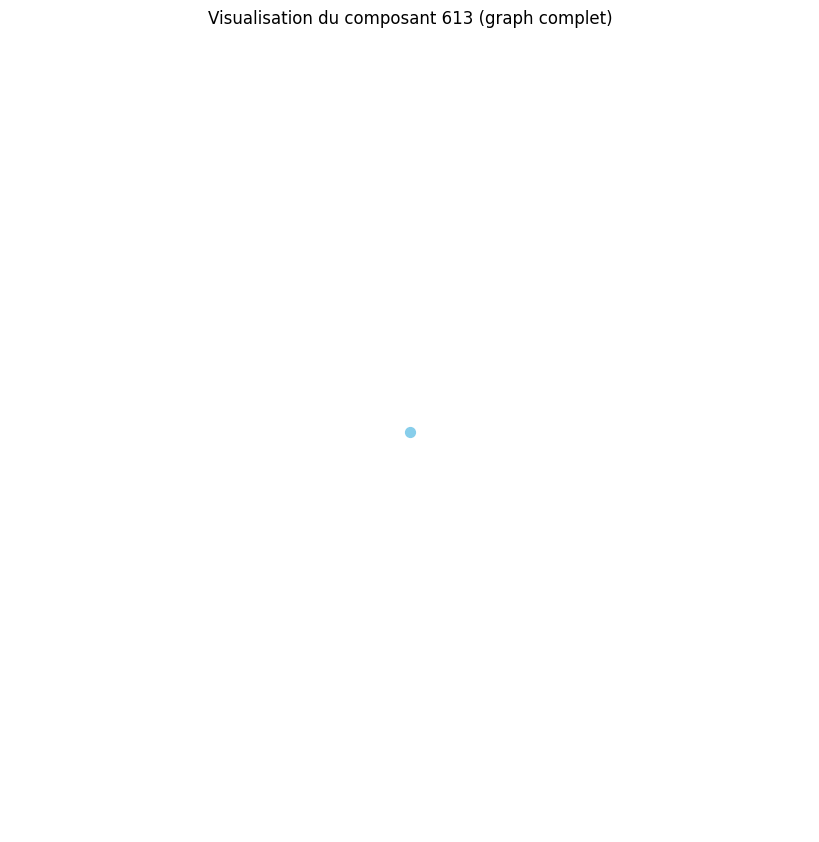

Distance moyenne pour le composant 614 : 0.00
Le composant 614 est un graphe complet ou très densément connecté.
Densité du composant 614 : 0.00
Degré moyen du composant 614 : 0.00
Coefficient de clustering moyen du composant 614 : 0.00


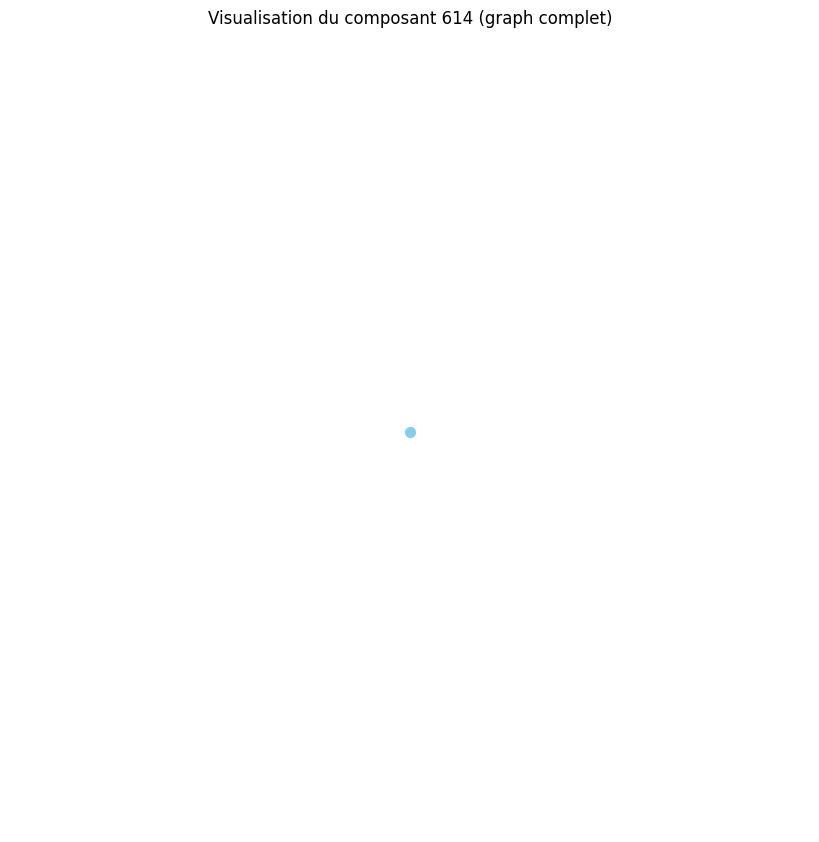

Distance moyenne pour le composant 615 : 0.00
Le composant 615 est un graphe complet ou très densément connecté.
Densité du composant 615 : 0.00
Degré moyen du composant 615 : 0.00
Coefficient de clustering moyen du composant 615 : 0.00


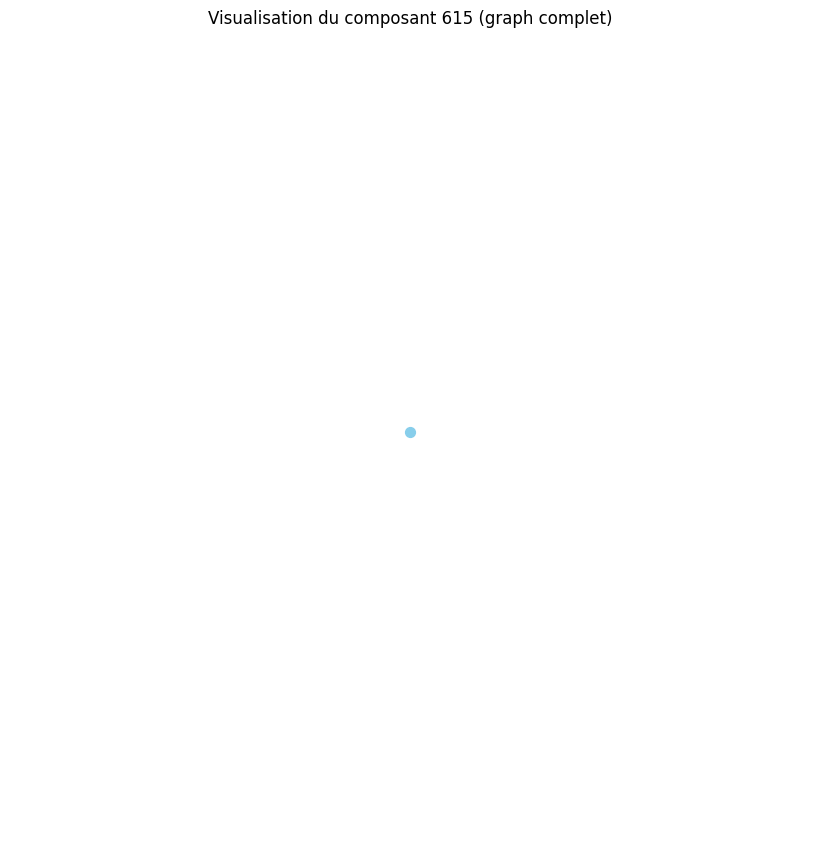

Distance moyenne pour le composant 616 : 0.00
Le composant 616 est un graphe complet ou très densément connecté.
Densité du composant 616 : 0.00
Degré moyen du composant 616 : 0.00
Coefficient de clustering moyen du composant 616 : 0.00


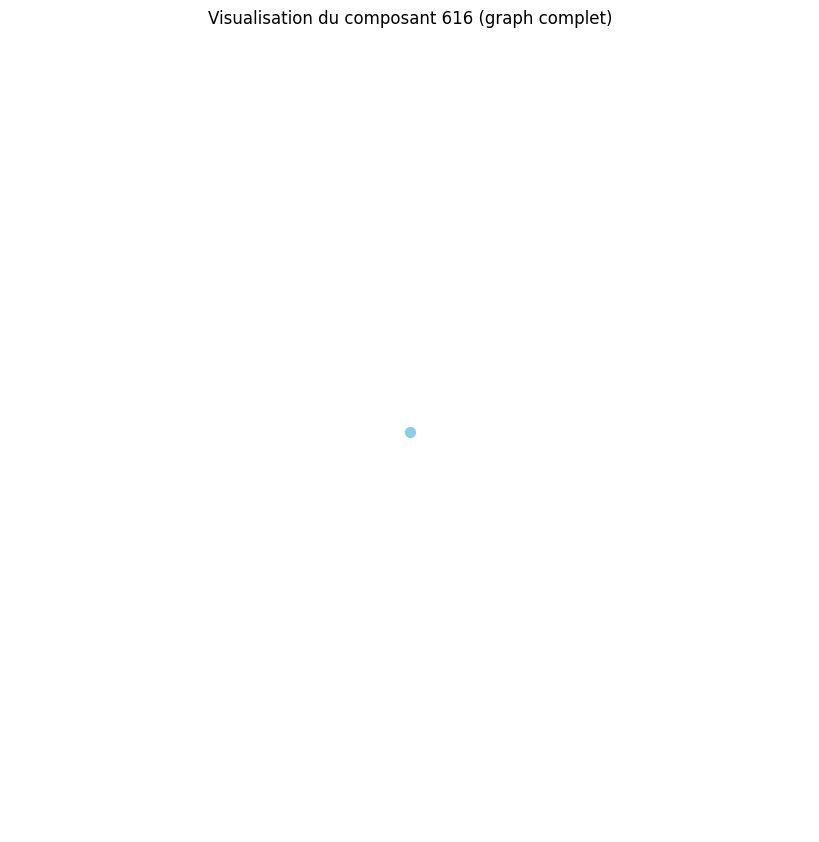

Distance moyenne pour le composant 617 : 0.00
Le composant 617 est un graphe complet ou très densément connecté.
Densité du composant 617 : 0.00
Degré moyen du composant 617 : 0.00
Coefficient de clustering moyen du composant 617 : 0.00


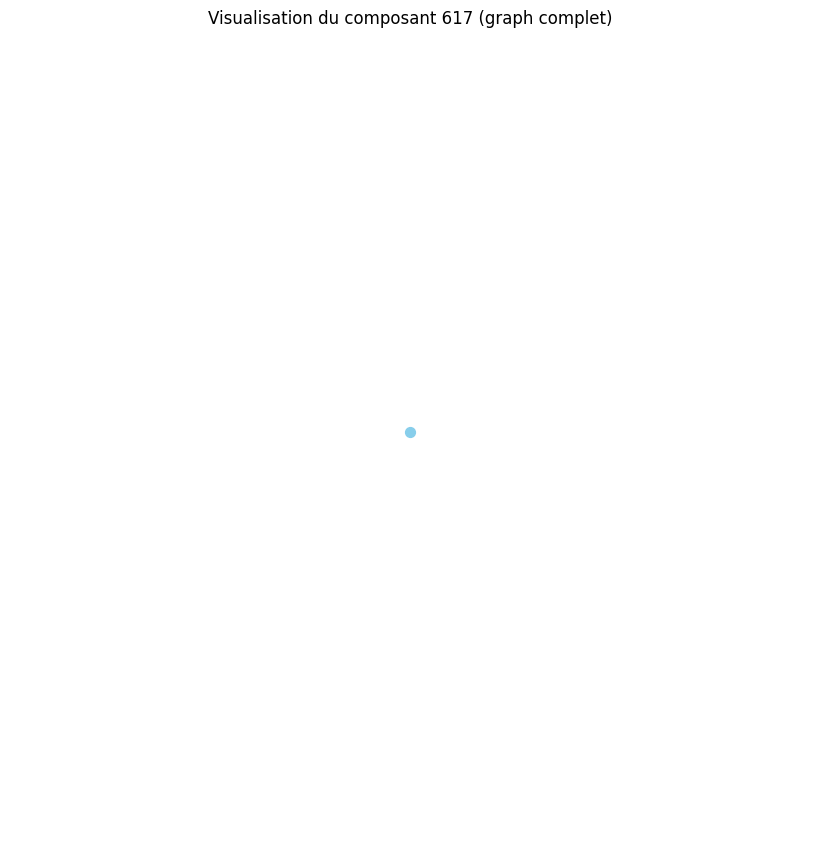

Distance moyenne pour le composant 618 : 0.00
Le composant 618 est un graphe complet ou très densément connecté.
Densité du composant 618 : 0.00
Degré moyen du composant 618 : 0.00
Coefficient de clustering moyen du composant 618 : 0.00


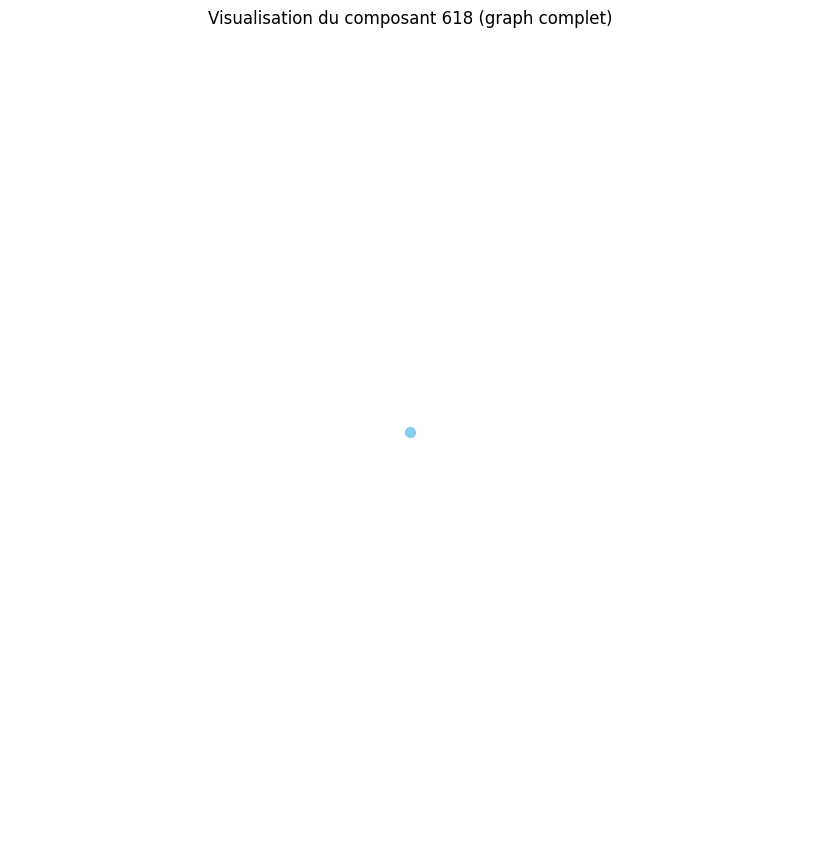

Distance moyenne pour le composant 619 : 0.00
Le composant 619 est un graphe complet ou très densément connecté.
Densité du composant 619 : 0.00
Degré moyen du composant 619 : 0.00
Coefficient de clustering moyen du composant 619 : 0.00


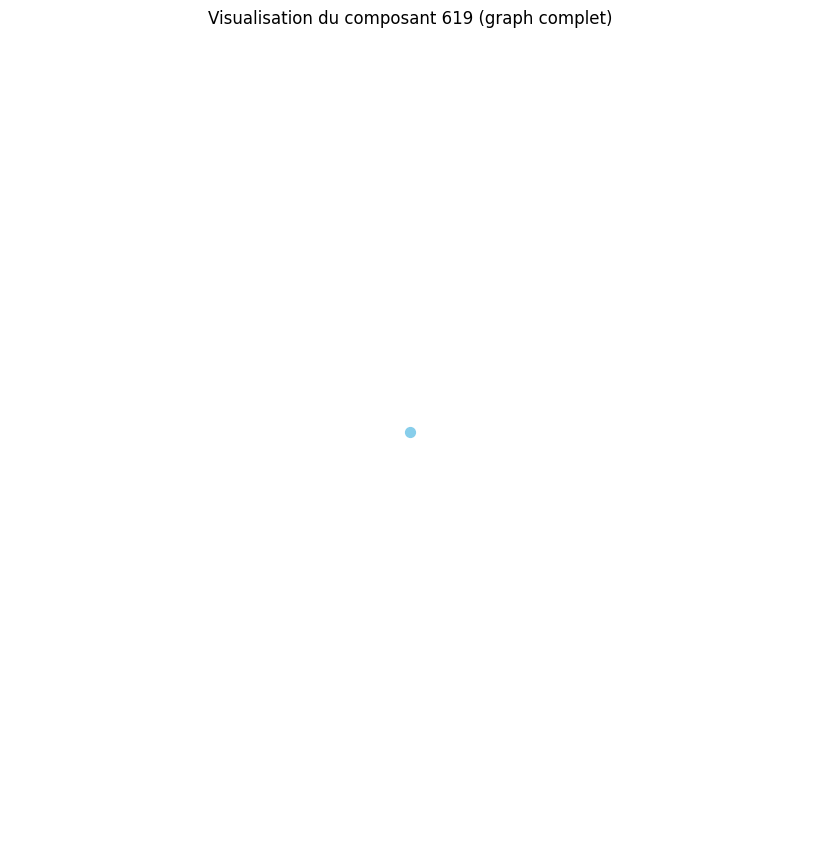

Distance moyenne pour le composant 620 : 1.00
Distance moyenne pour le composant 621 : 0.00
Le composant 621 est un graphe complet ou très densément connecté.
Densité du composant 621 : 0.00
Degré moyen du composant 621 : 0.00
Coefficient de clustering moyen du composant 621 : 0.00


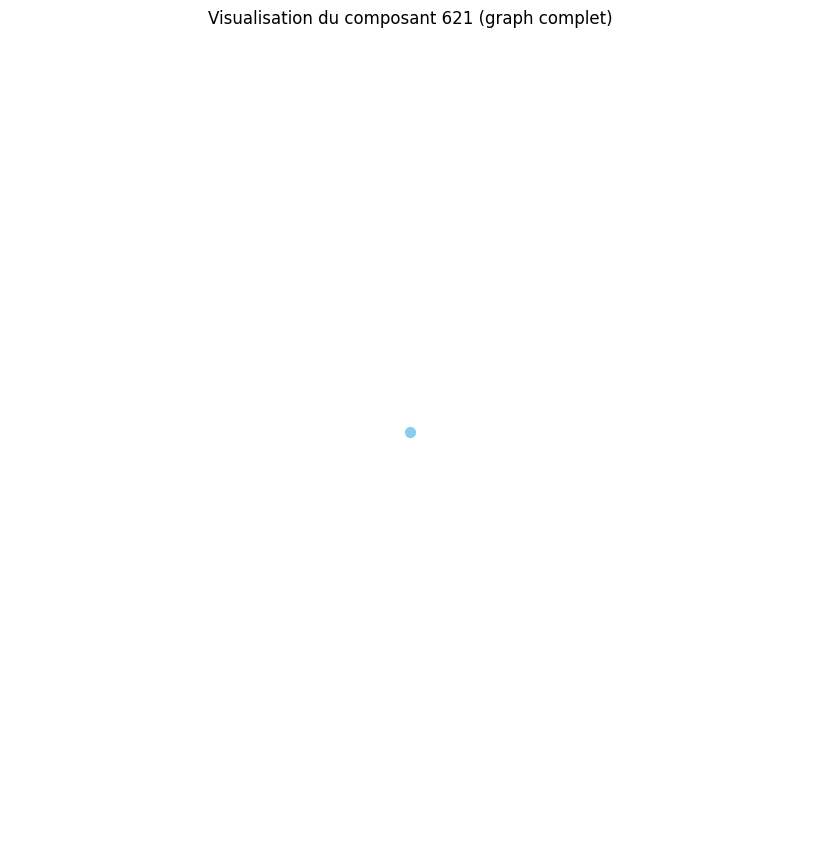

Distance moyenne pour le composant 622 : 0.00
Le composant 622 est un graphe complet ou très densément connecté.
Densité du composant 622 : 0.00
Degré moyen du composant 622 : 0.00
Coefficient de clustering moyen du composant 622 : 0.00


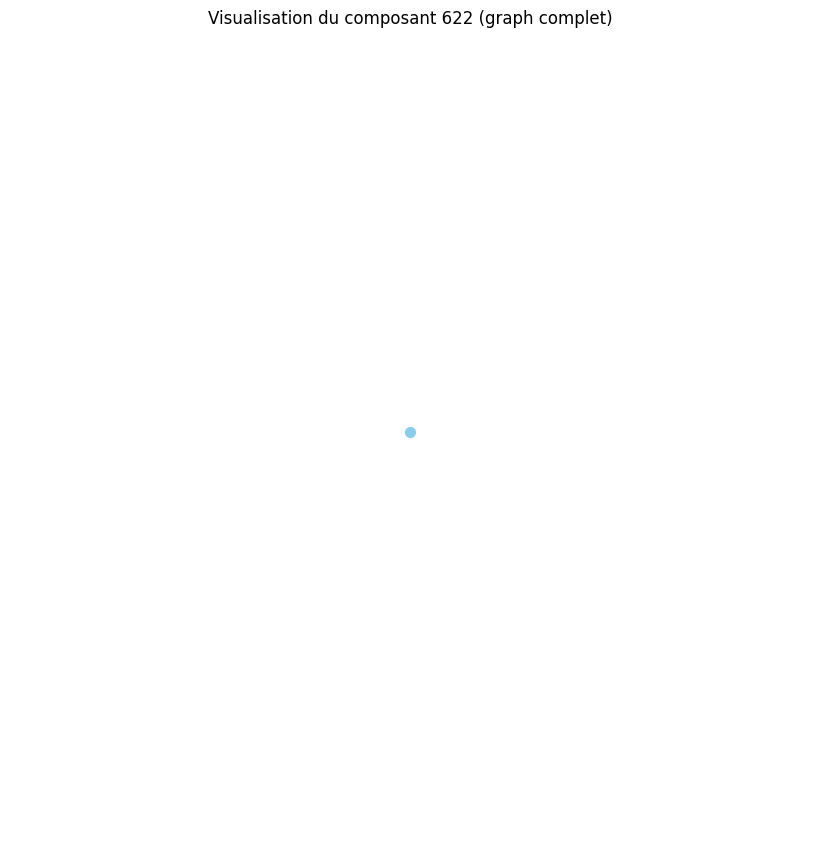

Distance moyenne pour le composant 623 : 0.00
Le composant 623 est un graphe complet ou très densément connecté.
Densité du composant 623 : 0.00
Degré moyen du composant 623 : 0.00
Coefficient de clustering moyen du composant 623 : 0.00


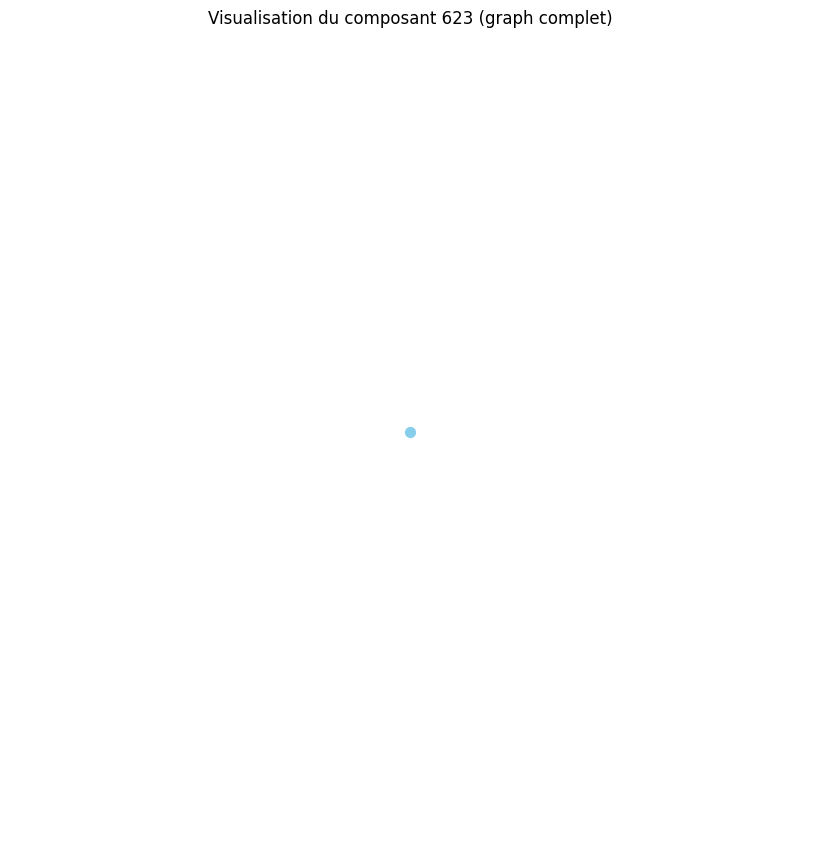

Distance moyenne pour le composant 624 : 0.00
Le composant 624 est un graphe complet ou très densément connecté.
Densité du composant 624 : 0.00
Degré moyen du composant 624 : 0.00
Coefficient de clustering moyen du composant 624 : 0.00


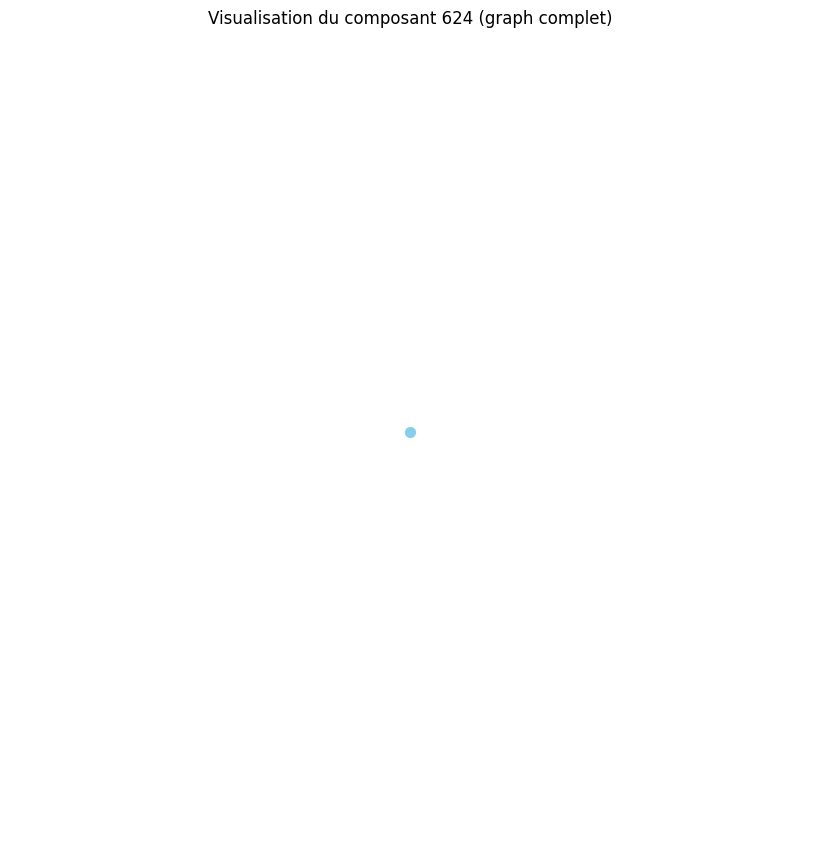

Distance moyenne pour le composant 625 : 0.00
Le composant 625 est un graphe complet ou très densément connecté.
Densité du composant 625 : 0.00
Degré moyen du composant 625 : 0.00
Coefficient de clustering moyen du composant 625 : 0.00


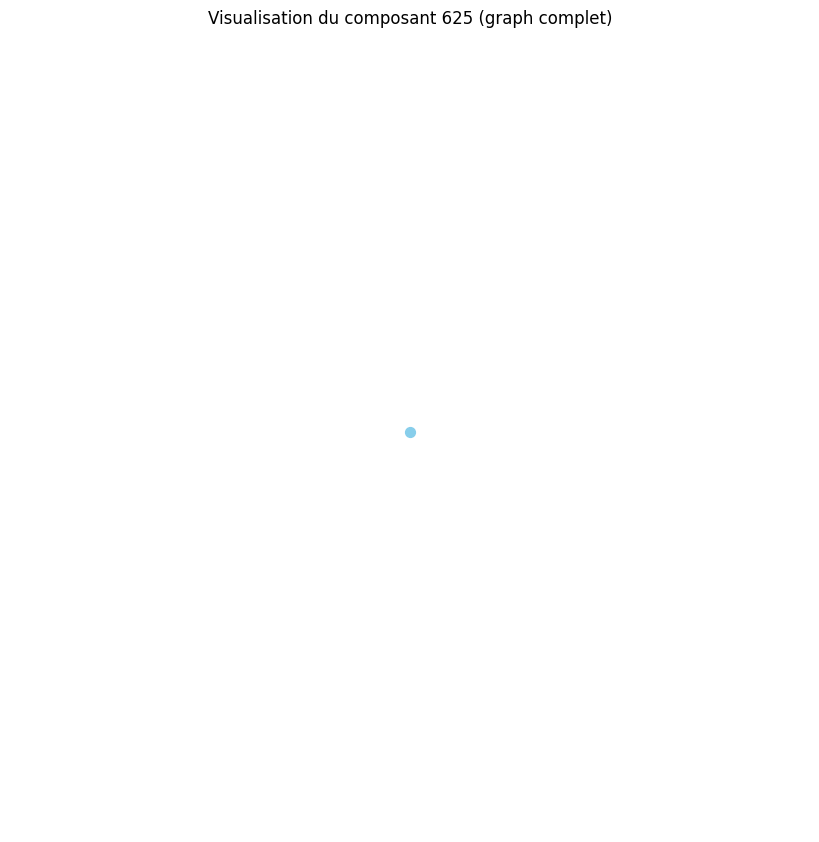

Distance moyenne pour le composant 626 : 0.00
Le composant 626 est un graphe complet ou très densément connecté.
Densité du composant 626 : 0.00
Degré moyen du composant 626 : 0.00
Coefficient de clustering moyen du composant 626 : 0.00


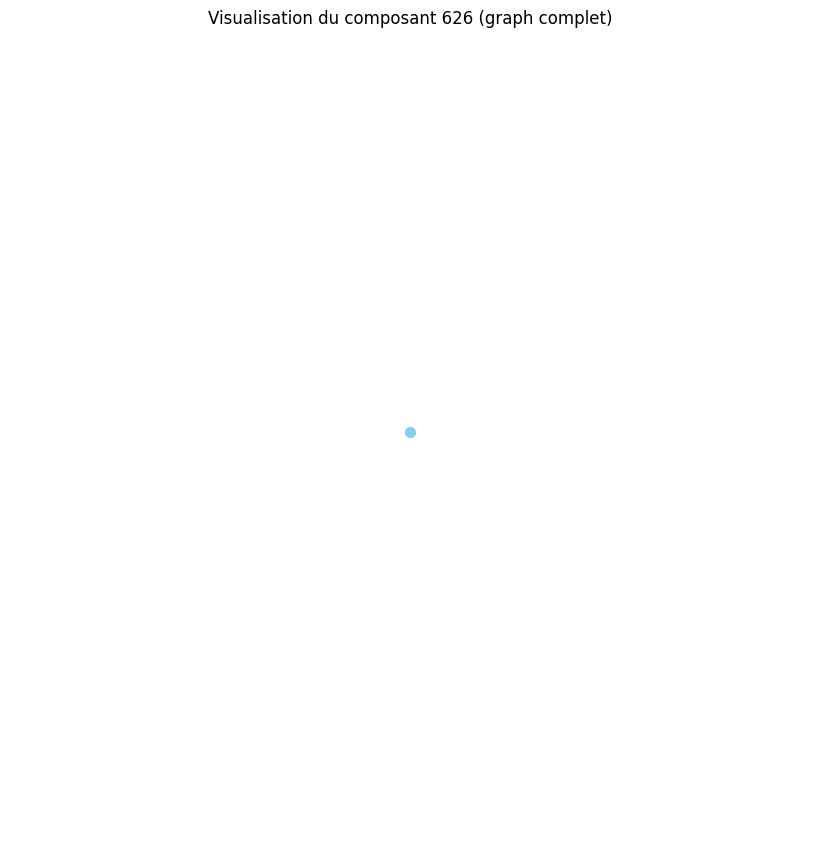

Distance moyenne pour le composant 627 : 0.00
Le composant 627 est un graphe complet ou très densément connecté.
Densité du composant 627 : 0.00
Degré moyen du composant 627 : 0.00
Coefficient de clustering moyen du composant 627 : 0.00


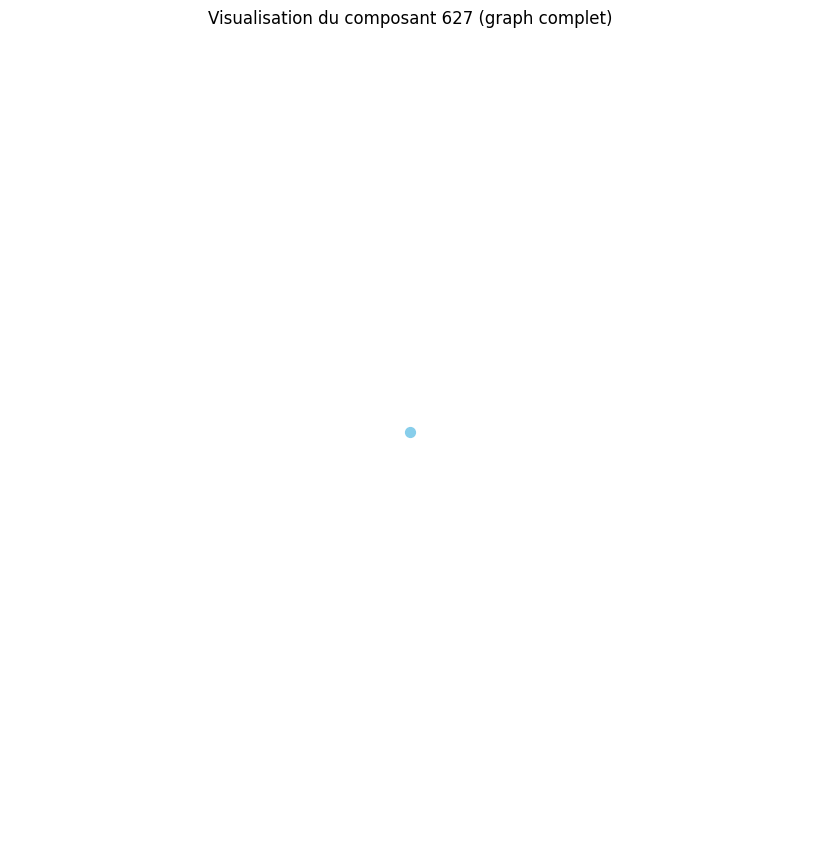

Distance moyenne pour le composant 628 : 0.00
Le composant 628 est un graphe complet ou très densément connecté.
Densité du composant 628 : 0.00
Degré moyen du composant 628 : 0.00
Coefficient de clustering moyen du composant 628 : 0.00


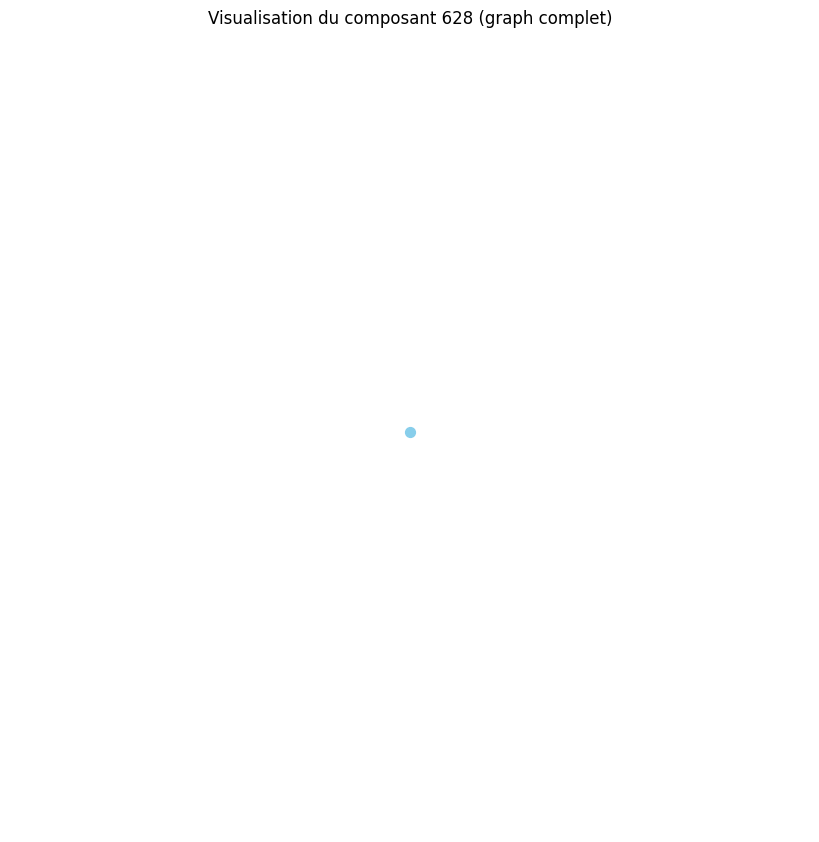

Distance moyenne pour le composant 629 : 0.00
Le composant 629 est un graphe complet ou très densément connecté.
Densité du composant 629 : 0.00
Degré moyen du composant 629 : 0.00
Coefficient de clustering moyen du composant 629 : 0.00


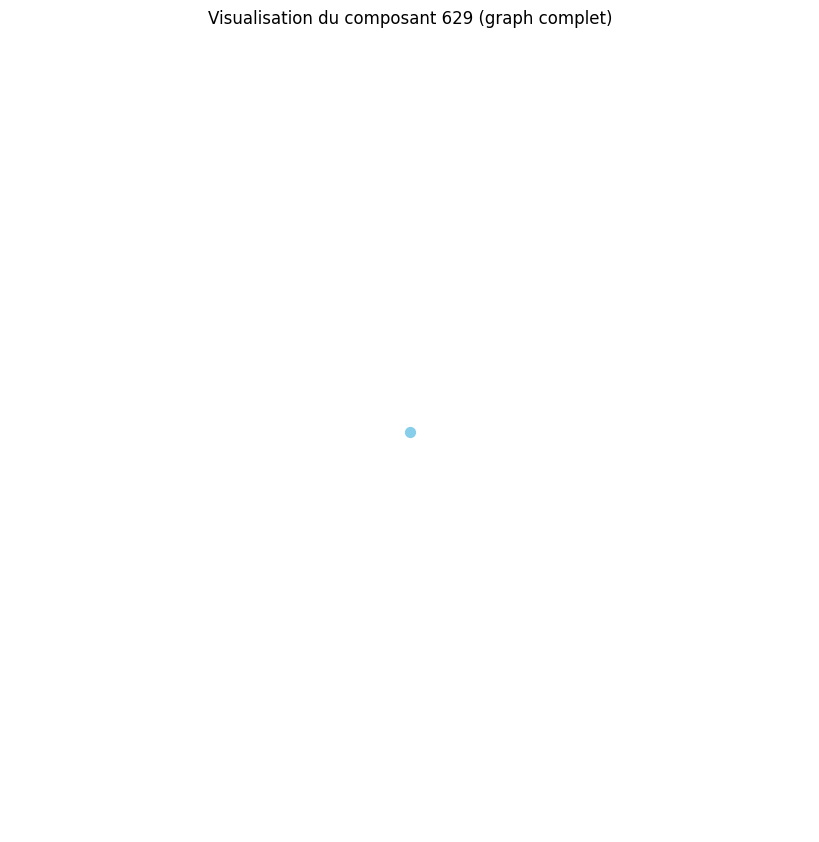

Distance moyenne pour le composant 630 : 0.00
Le composant 630 est un graphe complet ou très densément connecté.
Densité du composant 630 : 0.00
Degré moyen du composant 630 : 0.00
Coefficient de clustering moyen du composant 630 : 0.00


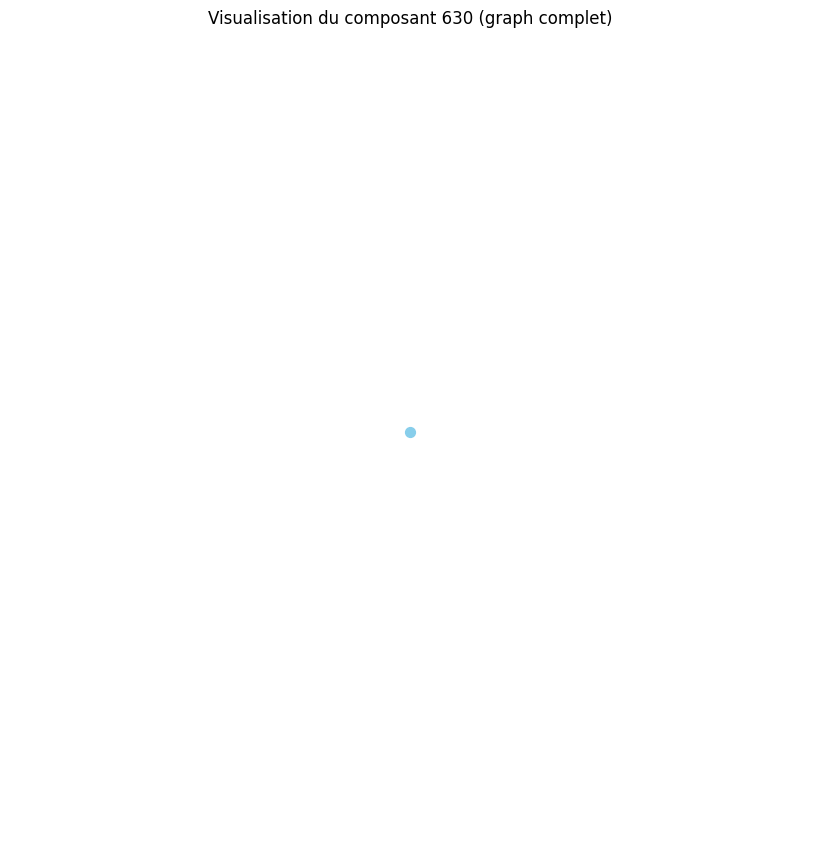

Distance moyenne pour le composant 631 : 0.00
Le composant 631 est un graphe complet ou très densément connecté.
Densité du composant 631 : 0.00
Degré moyen du composant 631 : 0.00
Coefficient de clustering moyen du composant 631 : 0.00


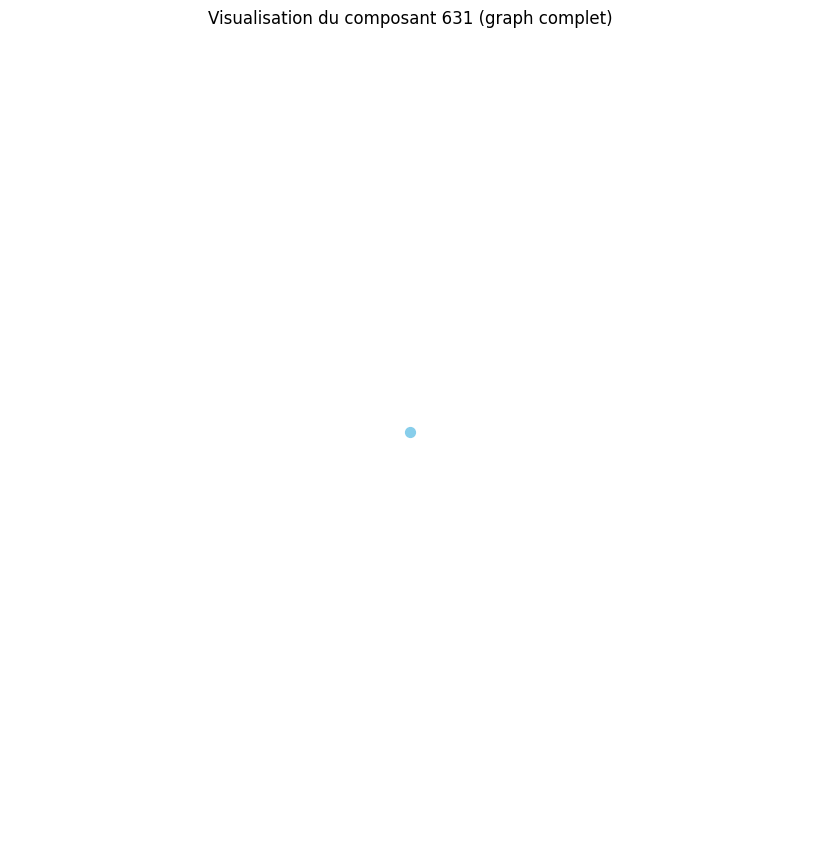

Distance moyenne pour le composant 632 : 0.00
Le composant 632 est un graphe complet ou très densément connecté.
Densité du composant 632 : 0.00
Degré moyen du composant 632 : 0.00
Coefficient de clustering moyen du composant 632 : 0.00


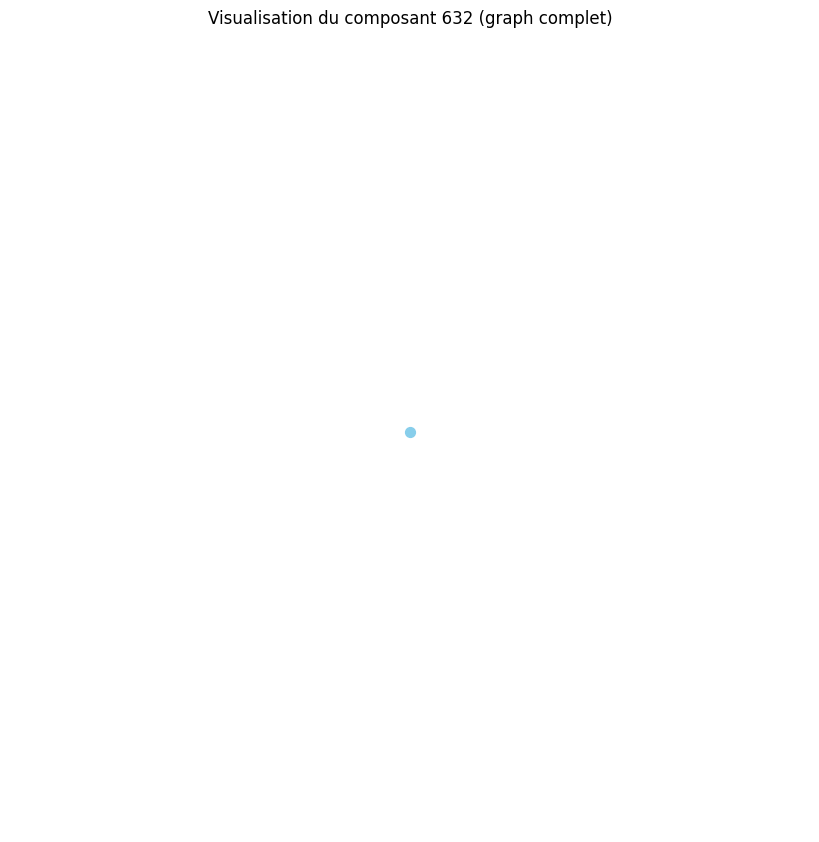

Distance moyenne pour le composant 633 : 0.00
Le composant 633 est un graphe complet ou très densément connecté.
Densité du composant 633 : 0.00
Degré moyen du composant 633 : 0.00
Coefficient de clustering moyen du composant 633 : 0.00


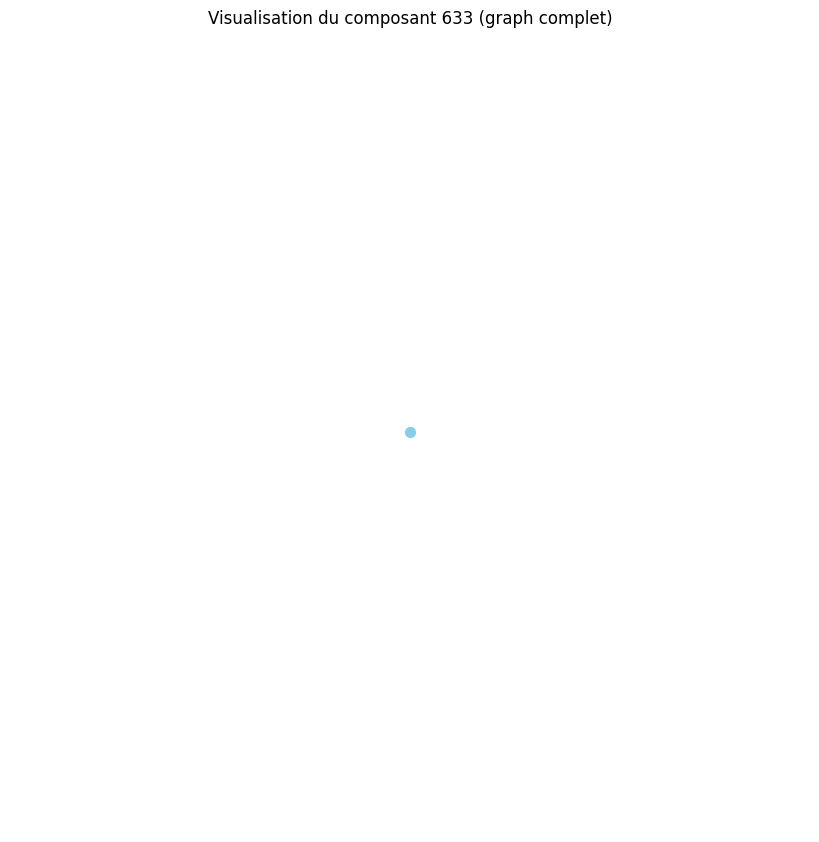

Distance moyenne pour le composant 634 : 0.00
Le composant 634 est un graphe complet ou très densément connecté.
Densité du composant 634 : 0.00
Degré moyen du composant 634 : 0.00
Coefficient de clustering moyen du composant 634 : 0.00


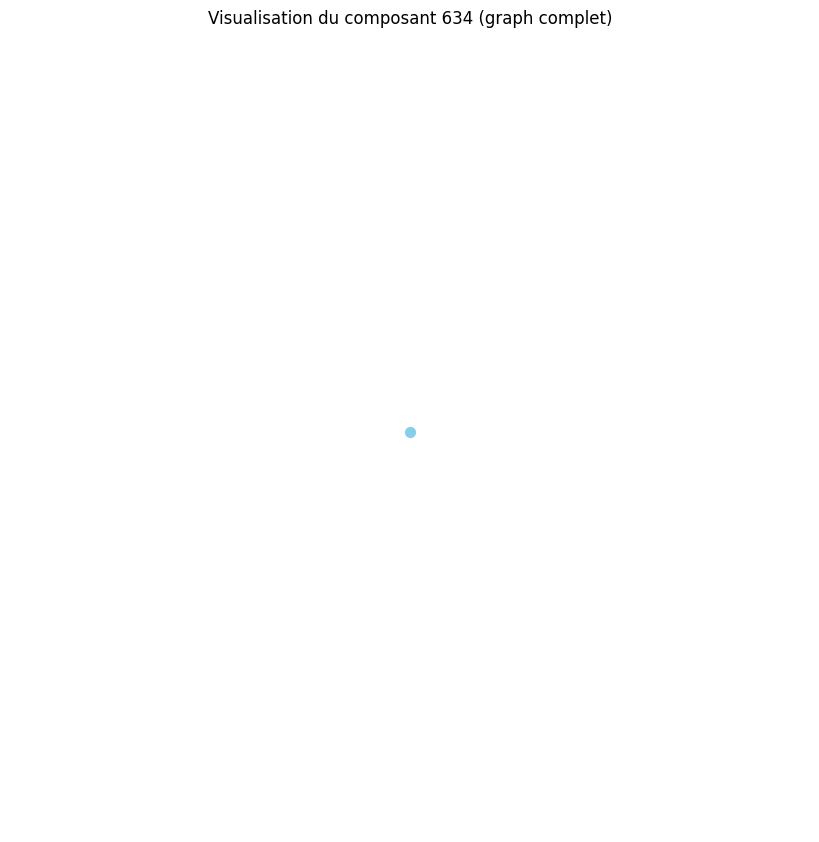

Distance moyenne pour le composant 635 : 0.00
Le composant 635 est un graphe complet ou très densément connecté.
Densité du composant 635 : 0.00
Degré moyen du composant 635 : 0.00
Coefficient de clustering moyen du composant 635 : 0.00


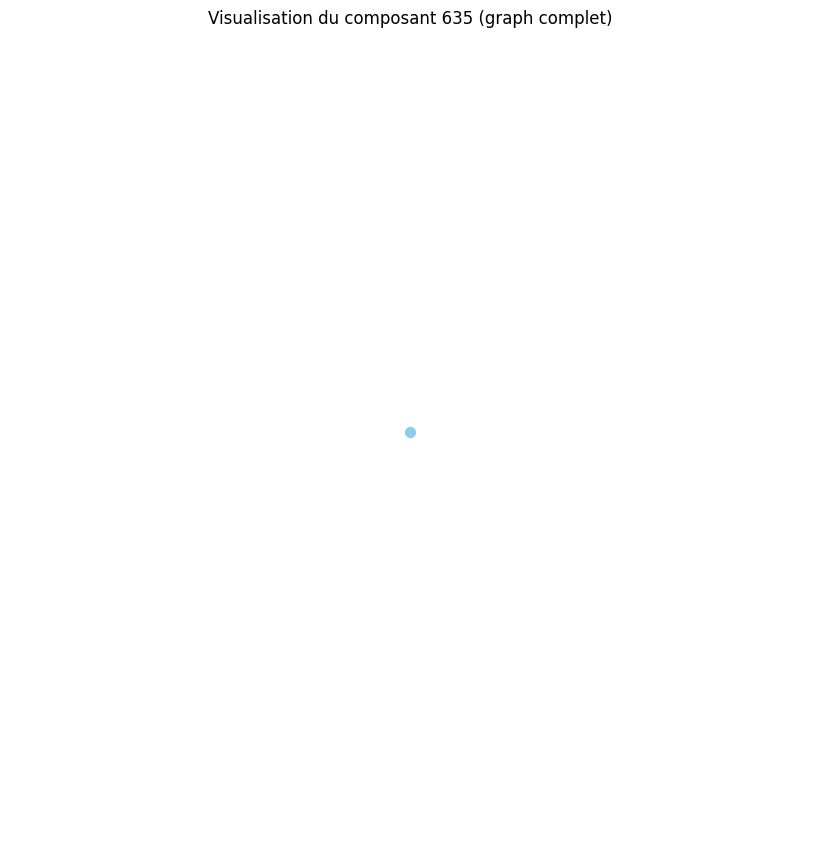

Distance moyenne pour le composant 636 : 0.00
Le composant 636 est un graphe complet ou très densément connecté.
Densité du composant 636 : 0.00
Degré moyen du composant 636 : 0.00
Coefficient de clustering moyen du composant 636 : 0.00


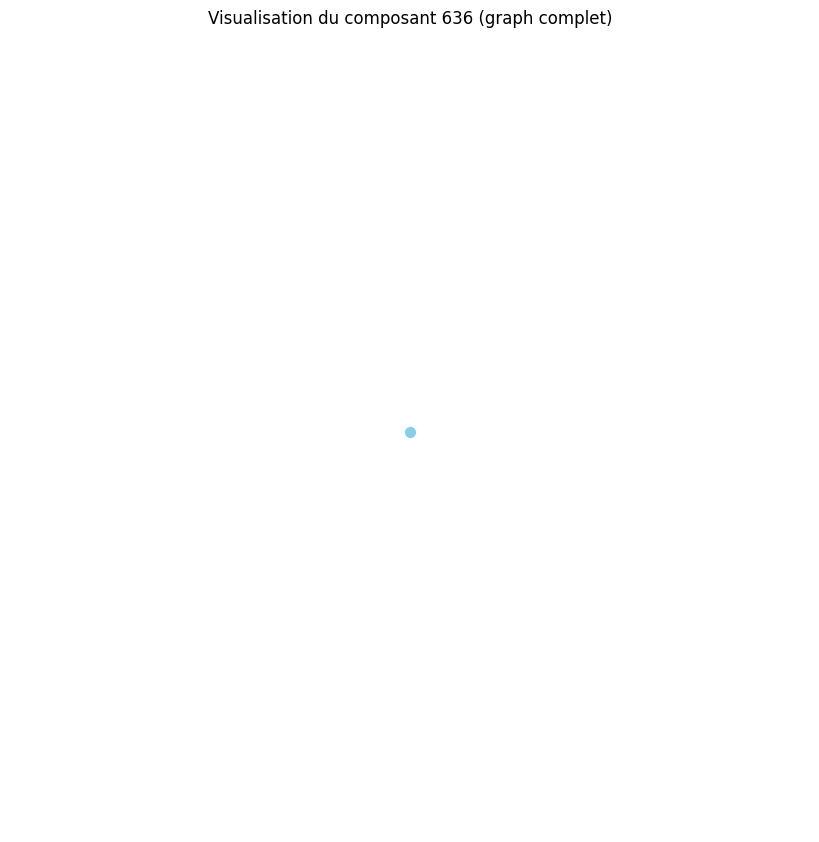

Distance moyenne pour le composant 637 : 0.00
Le composant 637 est un graphe complet ou très densément connecté.
Densité du composant 637 : 0.00
Degré moyen du composant 637 : 0.00
Coefficient de clustering moyen du composant 637 : 0.00


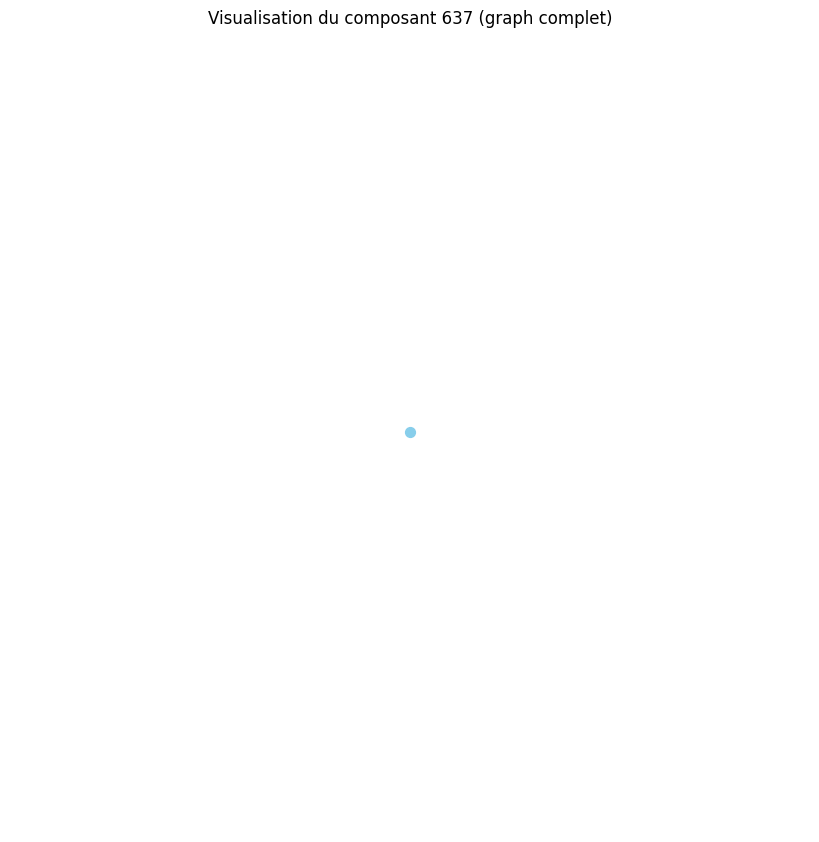

Distance moyenne pour le composant 638 : 0.00
Le composant 638 est un graphe complet ou très densément connecté.
Densité du composant 638 : 0.00
Degré moyen du composant 638 : 0.00
Coefficient de clustering moyen du composant 638 : 0.00


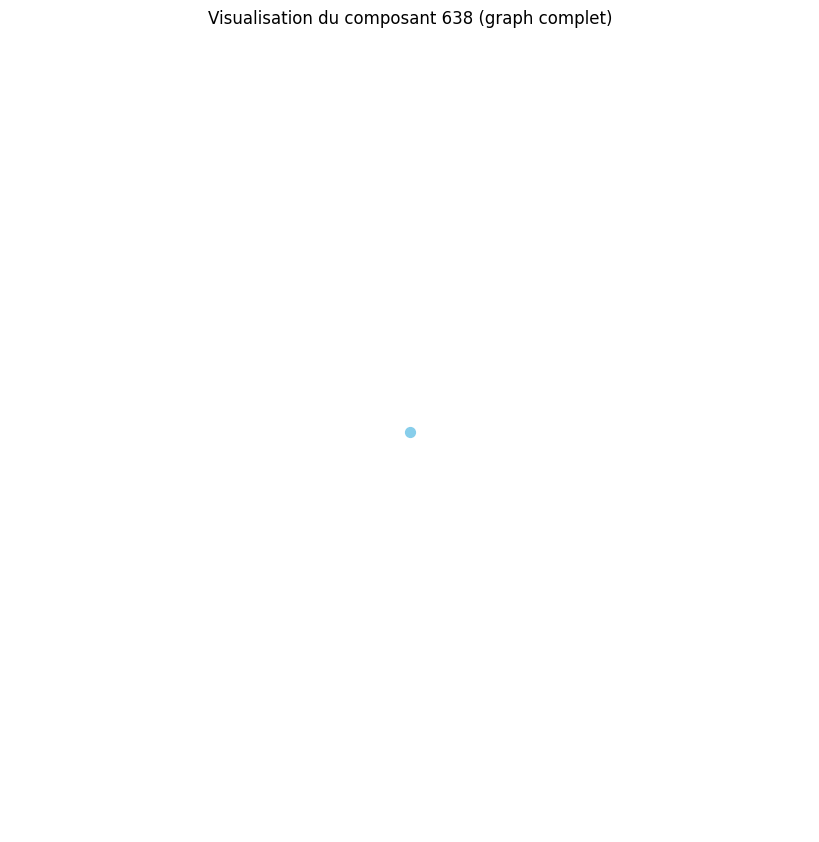

Distance moyenne pour le composant 639 : 0.00
Le composant 639 est un graphe complet ou très densément connecté.
Densité du composant 639 : 0.00
Degré moyen du composant 639 : 0.00
Coefficient de clustering moyen du composant 639 : 0.00


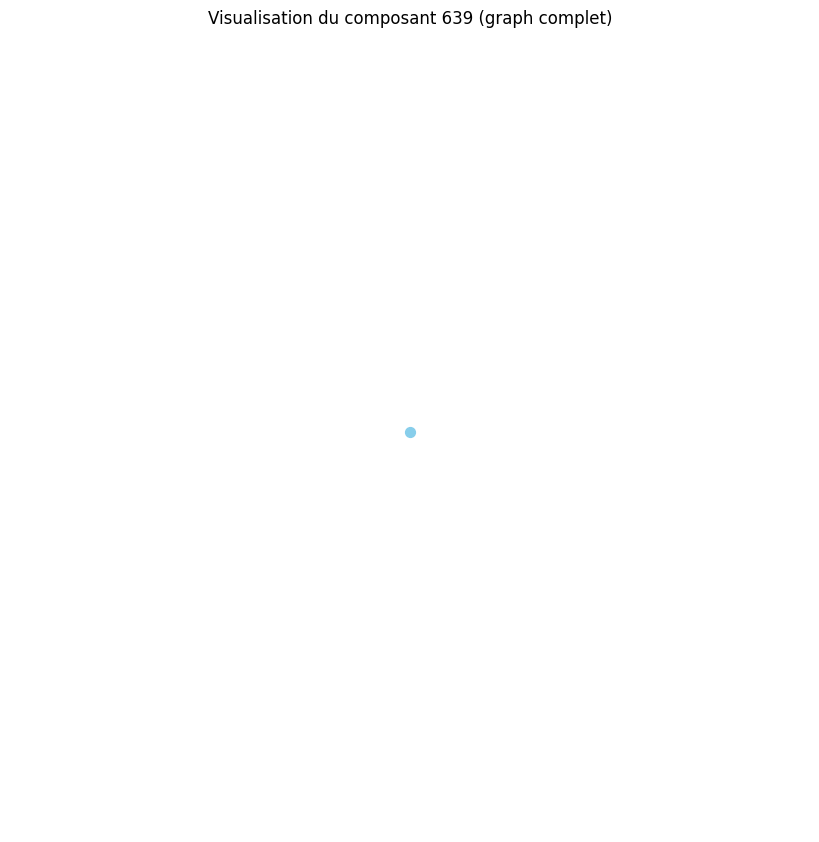

Distance moyenne pour le composant 640 : 0.00
Le composant 640 est un graphe complet ou très densément connecté.
Densité du composant 640 : 0.00
Degré moyen du composant 640 : 0.00
Coefficient de clustering moyen du composant 640 : 0.00


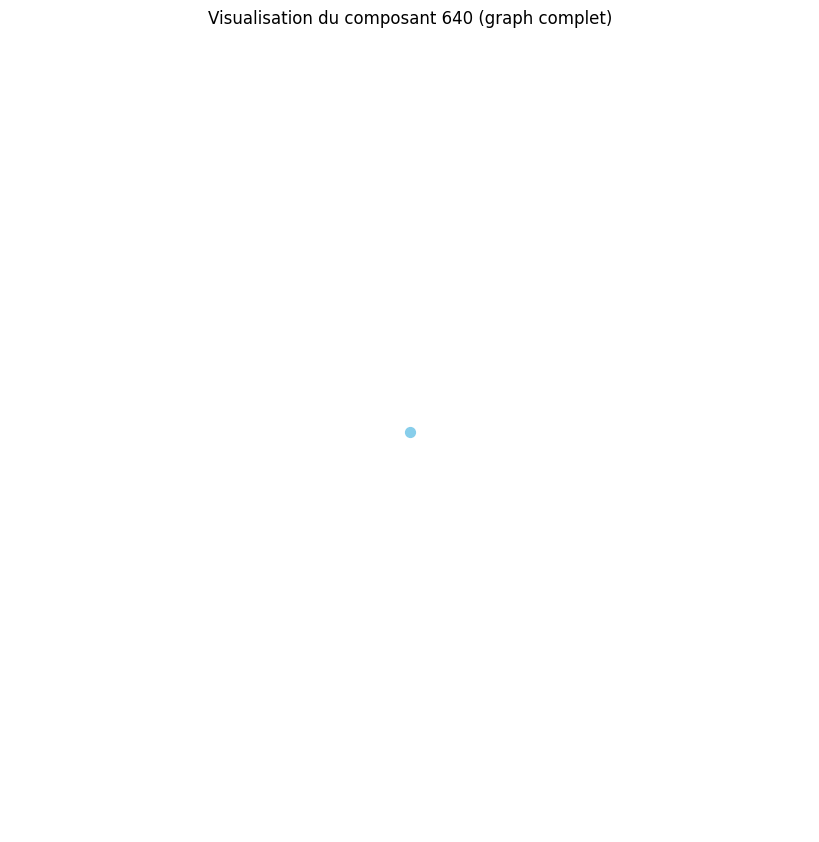

Distance moyenne pour le composant 641 : 0.00
Le composant 641 est un graphe complet ou très densément connecté.
Densité du composant 641 : 0.00
Degré moyen du composant 641 : 0.00
Coefficient de clustering moyen du composant 641 : 0.00


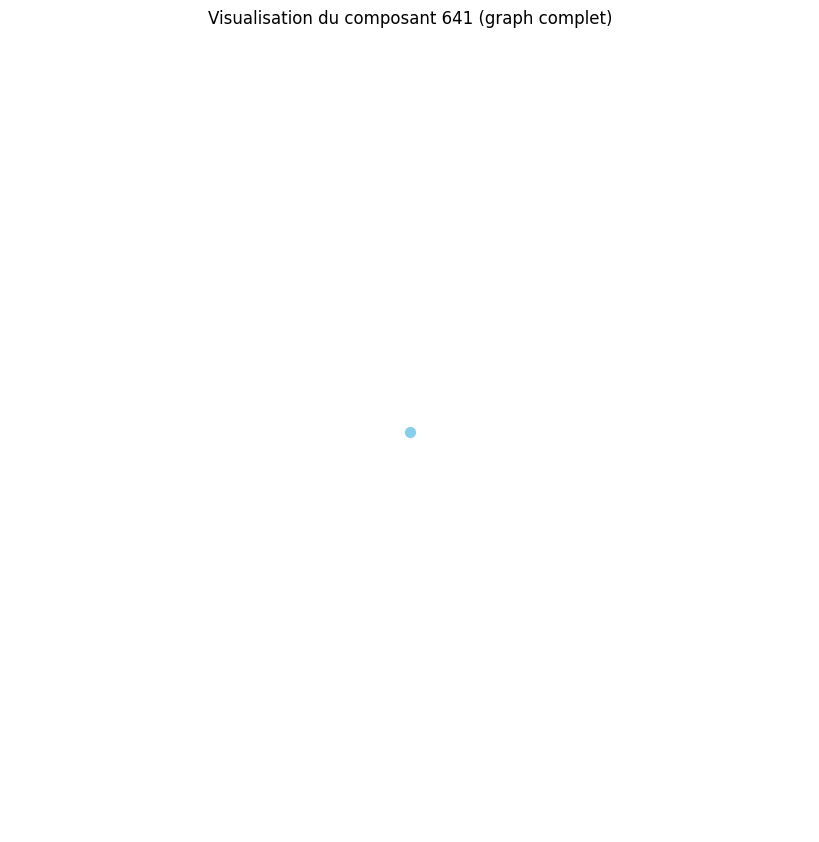

Distance moyenne pour le composant 642 : 0.00
Le composant 642 est un graphe complet ou très densément connecté.
Densité du composant 642 : 0.00
Degré moyen du composant 642 : 0.00
Coefficient de clustering moyen du composant 642 : 0.00


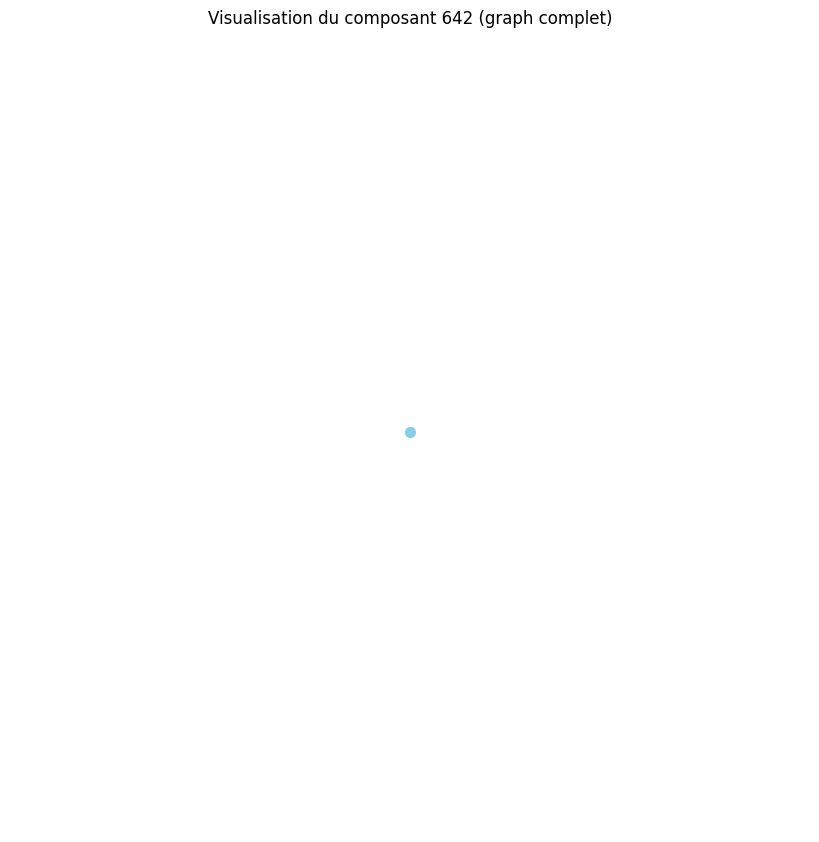

Distance moyenne pour le composant 643 : 0.00
Le composant 643 est un graphe complet ou très densément connecté.
Densité du composant 643 : 0.00
Degré moyen du composant 643 : 0.00
Coefficient de clustering moyen du composant 643 : 0.00


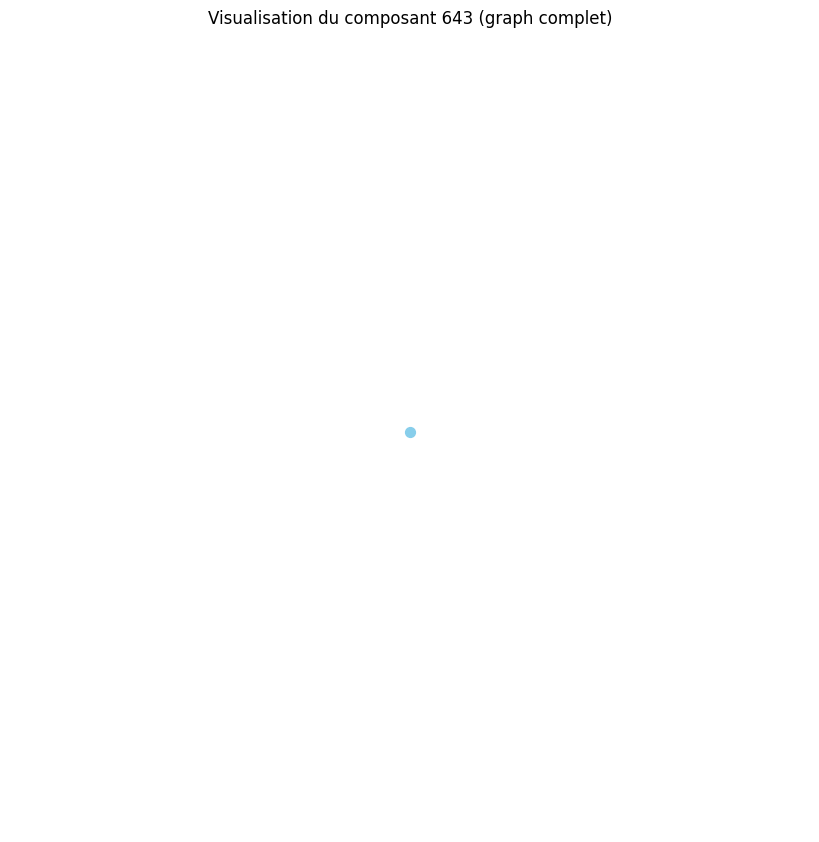

Distance moyenne pour le composant 644 : 0.00
Le composant 644 est un graphe complet ou très densément connecté.
Densité du composant 644 : 0.00
Degré moyen du composant 644 : 0.00
Coefficient de clustering moyen du composant 644 : 0.00


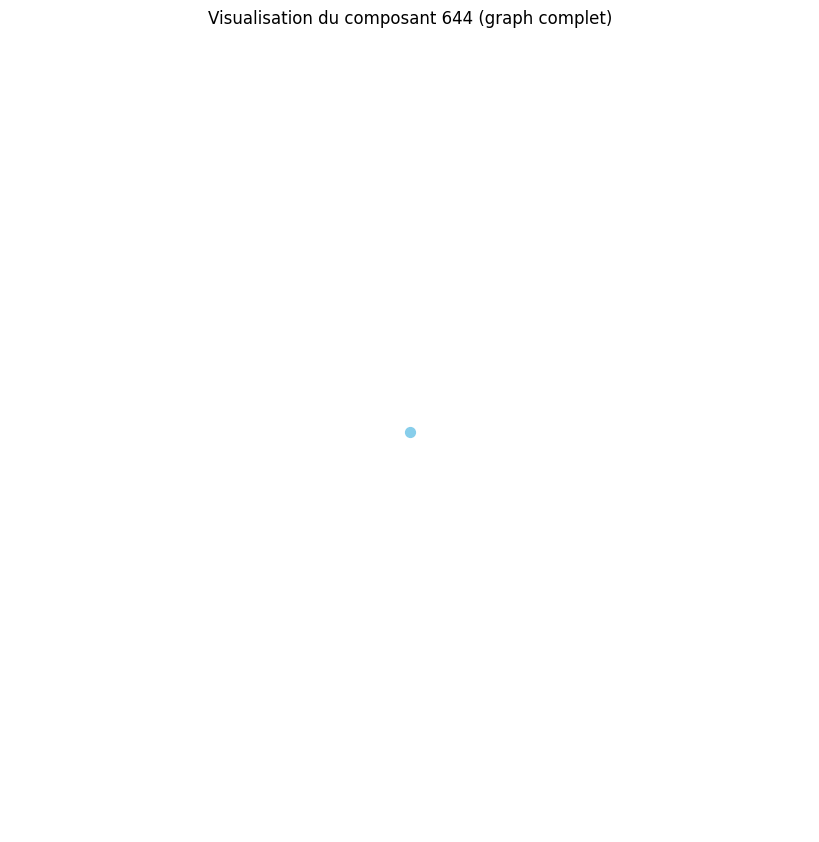

Distance moyenne pour le composant 645 : 0.00
Le composant 645 est un graphe complet ou très densément connecté.
Densité du composant 645 : 0.00
Degré moyen du composant 645 : 0.00
Coefficient de clustering moyen du composant 645 : 0.00


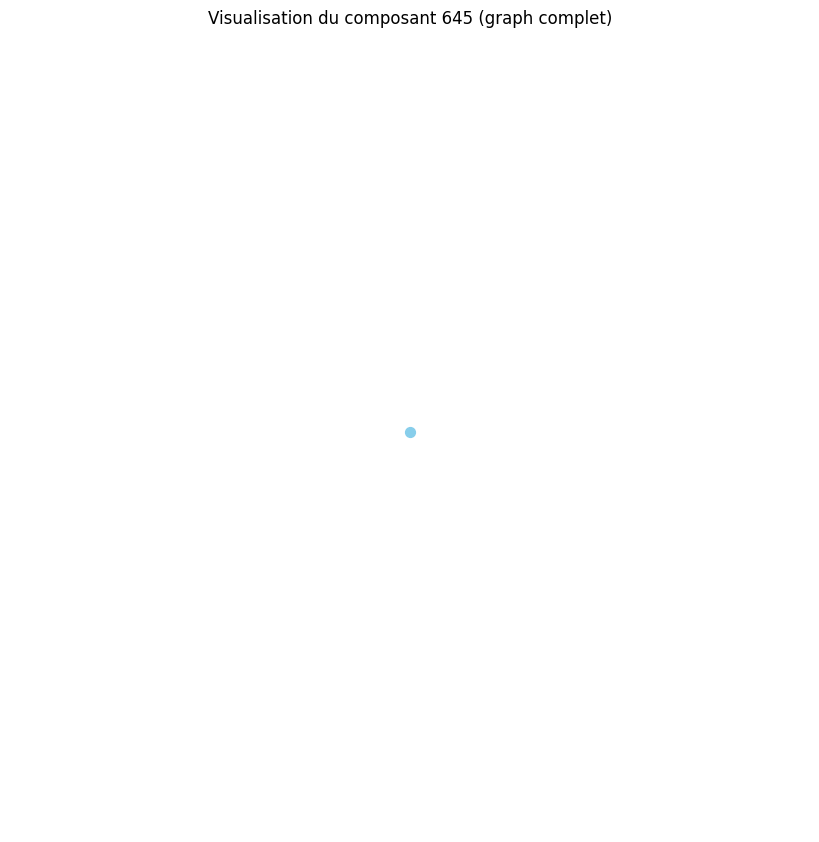

Distance moyenne pour le composant 646 : 0.00
Le composant 646 est un graphe complet ou très densément connecté.
Densité du composant 646 : 0.00
Degré moyen du composant 646 : 0.00
Coefficient de clustering moyen du composant 646 : 0.00


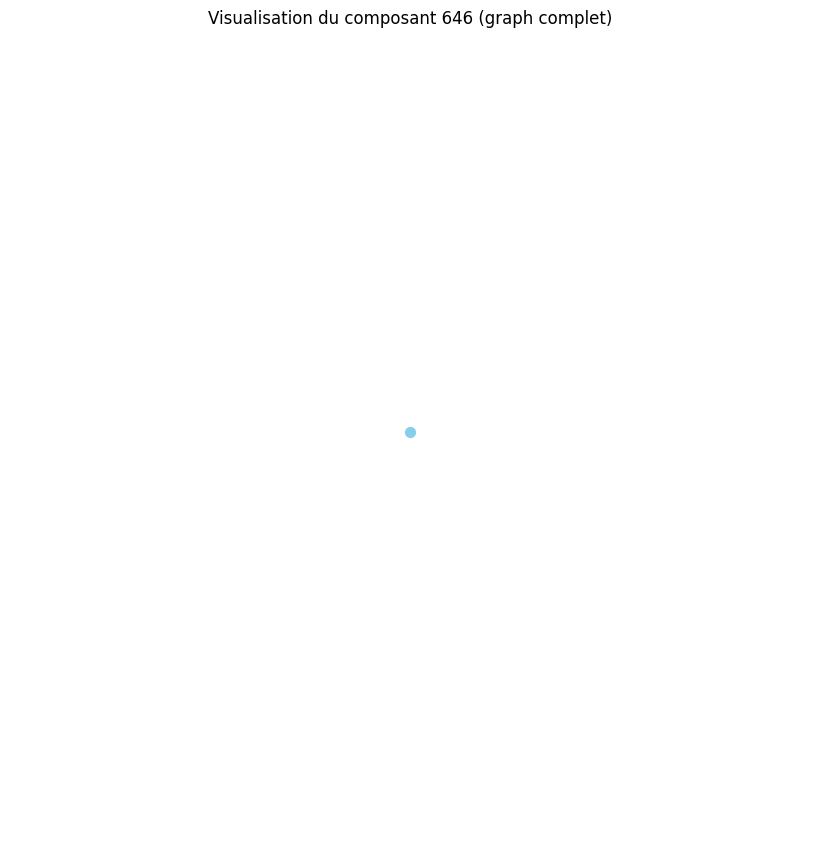

Distance moyenne pour le composant 647 : 0.00
Le composant 647 est un graphe complet ou très densément connecté.
Densité du composant 647 : 0.00
Degré moyen du composant 647 : 0.00
Coefficient de clustering moyen du composant 647 : 0.00


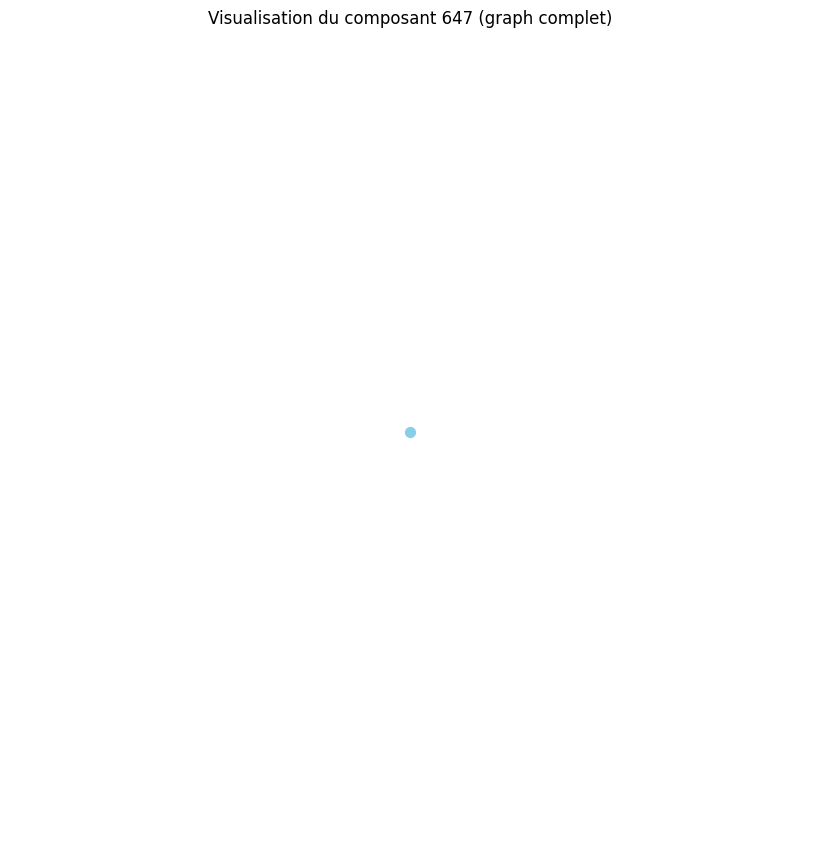

Distance moyenne pour le composant 648 : 0.00
Le composant 648 est un graphe complet ou très densément connecté.
Densité du composant 648 : 0.00
Degré moyen du composant 648 : 0.00
Coefficient de clustering moyen du composant 648 : 0.00


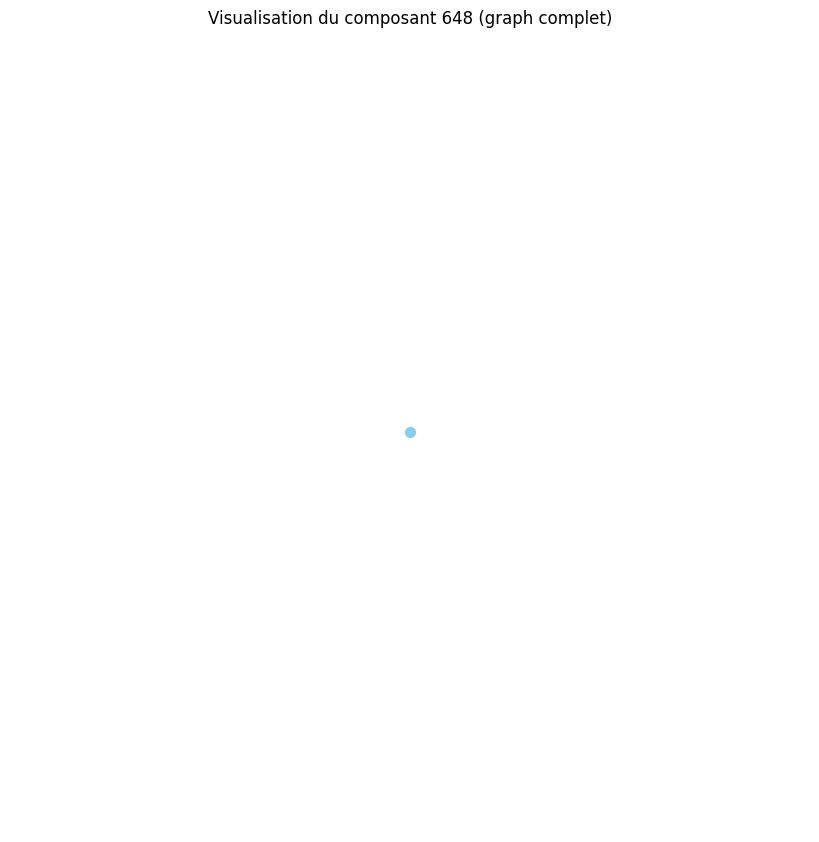

Distance moyenne pour le composant 649 : 0.00
Le composant 649 est un graphe complet ou très densément connecté.
Densité du composant 649 : 0.00
Degré moyen du composant 649 : 0.00
Coefficient de clustering moyen du composant 649 : 0.00


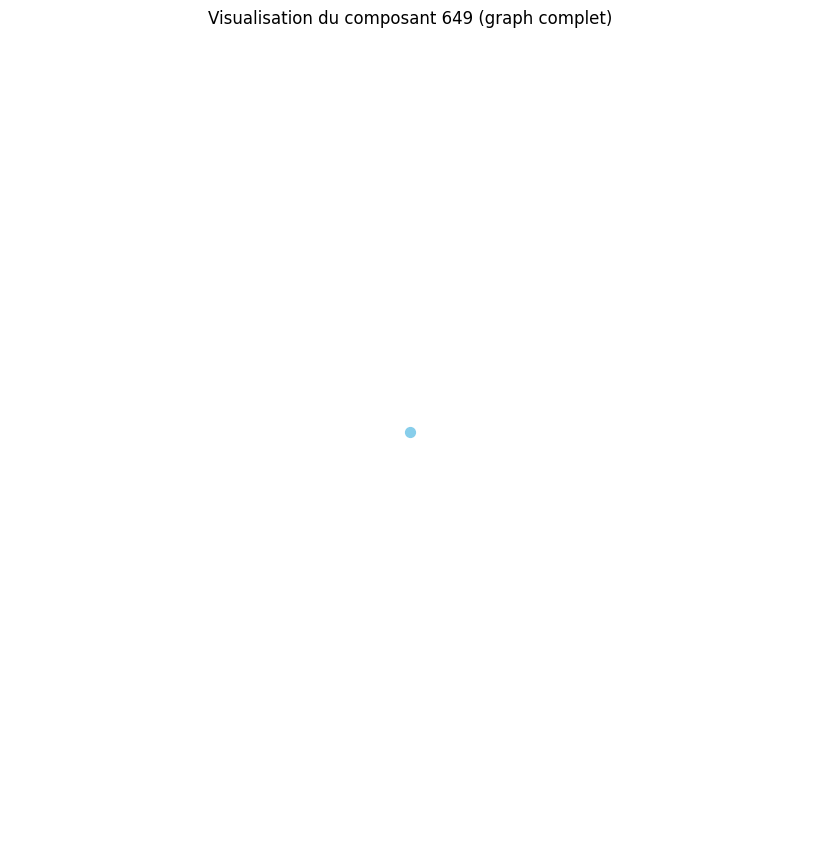

Distance moyenne pour le composant 650 : 0.00
Le composant 650 est un graphe complet ou très densément connecté.
Densité du composant 650 : 0.00
Degré moyen du composant 650 : 0.00
Coefficient de clustering moyen du composant 650 : 0.00


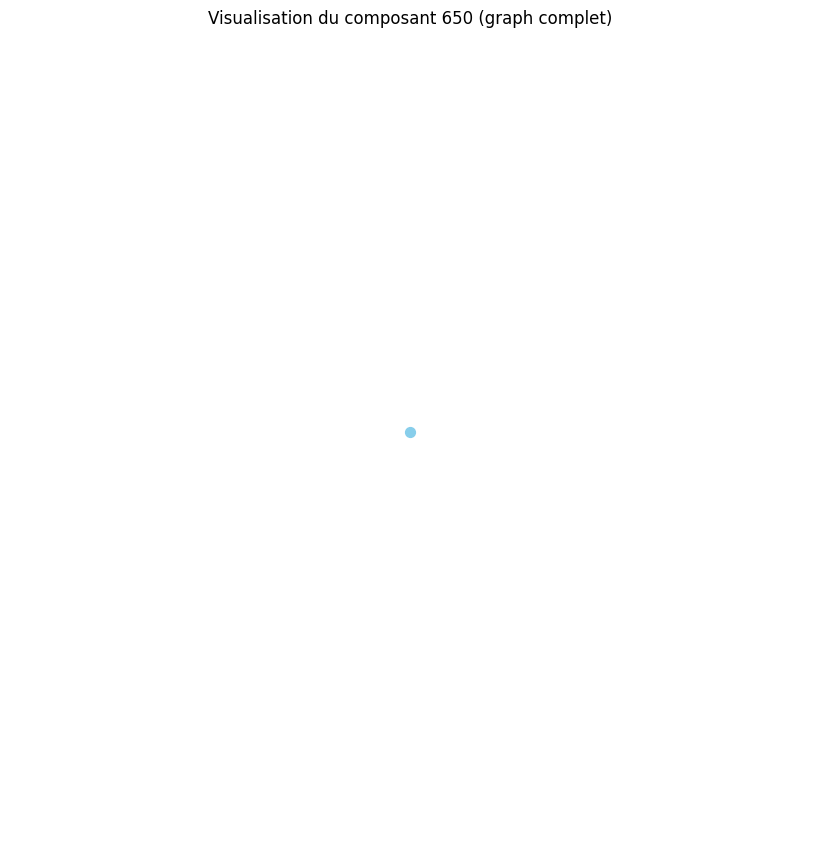

Distance moyenne pour le composant 651 : 0.00
Le composant 651 est un graphe complet ou très densément connecté.
Densité du composant 651 : 0.00
Degré moyen du composant 651 : 0.00
Coefficient de clustering moyen du composant 651 : 0.00


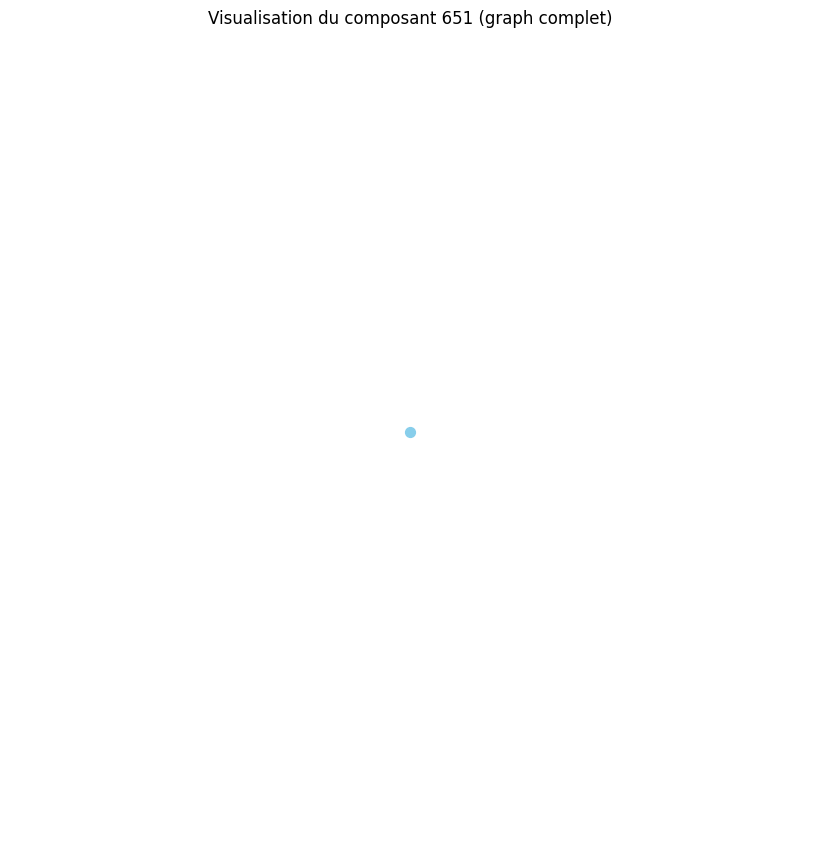

Distance moyenne pour le composant 652 : 0.00
Le composant 652 est un graphe complet ou très densément connecté.
Densité du composant 652 : 0.00
Degré moyen du composant 652 : 0.00
Coefficient de clustering moyen du composant 652 : 0.00


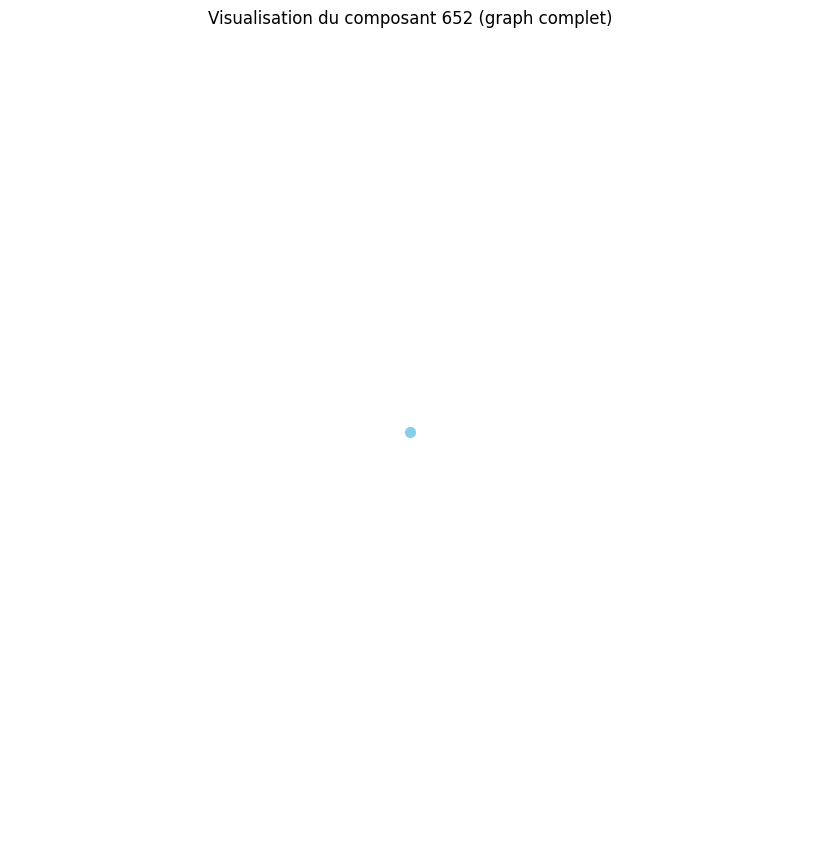

Distance moyenne pour le composant 653 : 0.00
Le composant 653 est un graphe complet ou très densément connecté.
Densité du composant 653 : 0.00
Degré moyen du composant 653 : 0.00
Coefficient de clustering moyen du composant 653 : 0.00


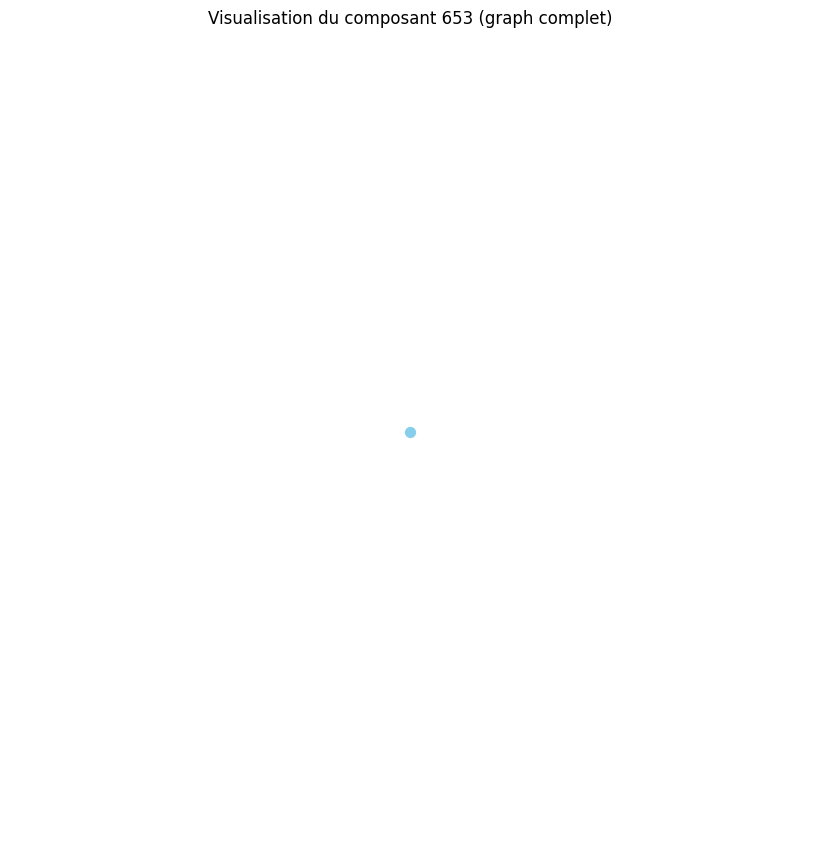

Distance moyenne pour le composant 654 : 0.00
Le composant 654 est un graphe complet ou très densément connecté.
Densité du composant 654 : 0.00
Degré moyen du composant 654 : 0.00
Coefficient de clustering moyen du composant 654 : 0.00


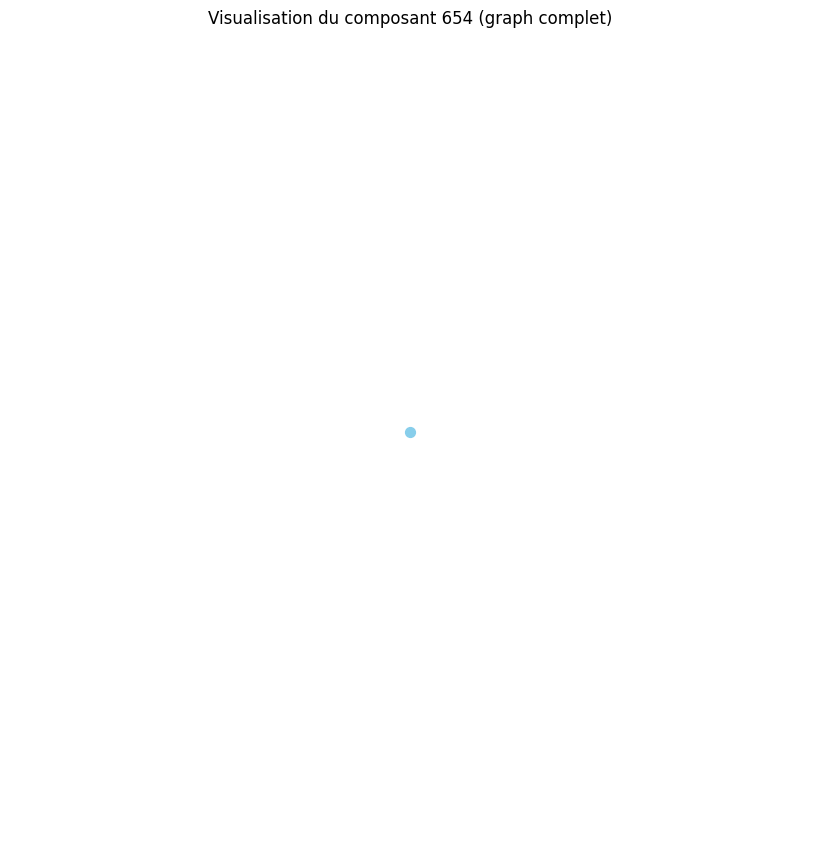

Distance moyenne pour le composant 655 : 0.00
Le composant 655 est un graphe complet ou très densément connecté.
Densité du composant 655 : 0.00
Degré moyen du composant 655 : 0.00
Coefficient de clustering moyen du composant 655 : 0.00


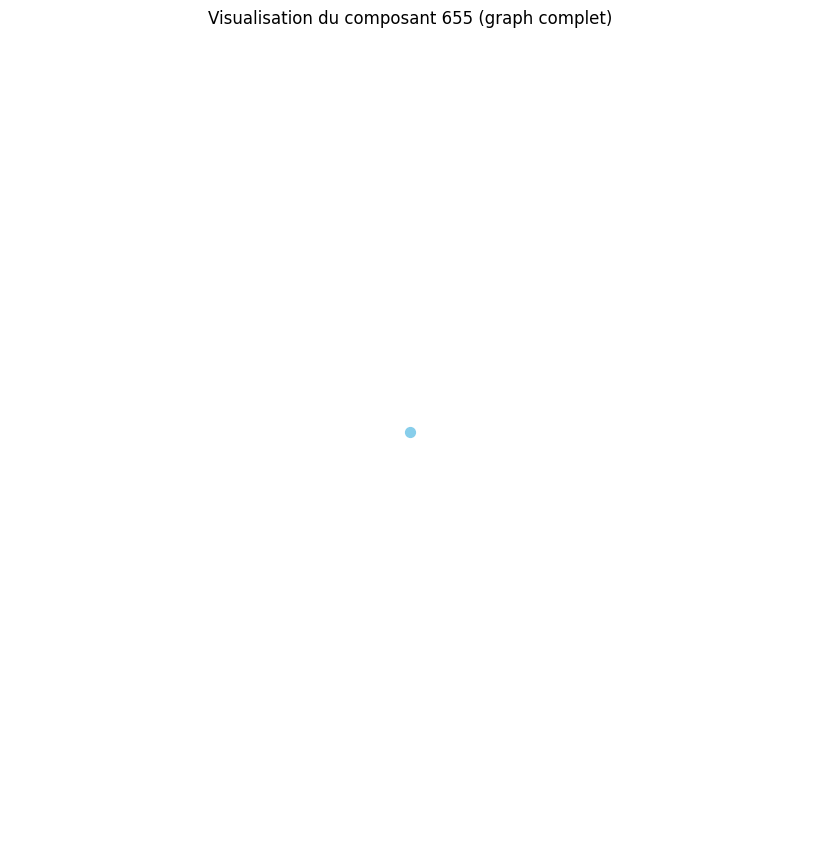

Distance moyenne pour le composant 656 : 0.00
Le composant 656 est un graphe complet ou très densément connecté.
Densité du composant 656 : 0.00
Degré moyen du composant 656 : 0.00
Coefficient de clustering moyen du composant 656 : 0.00


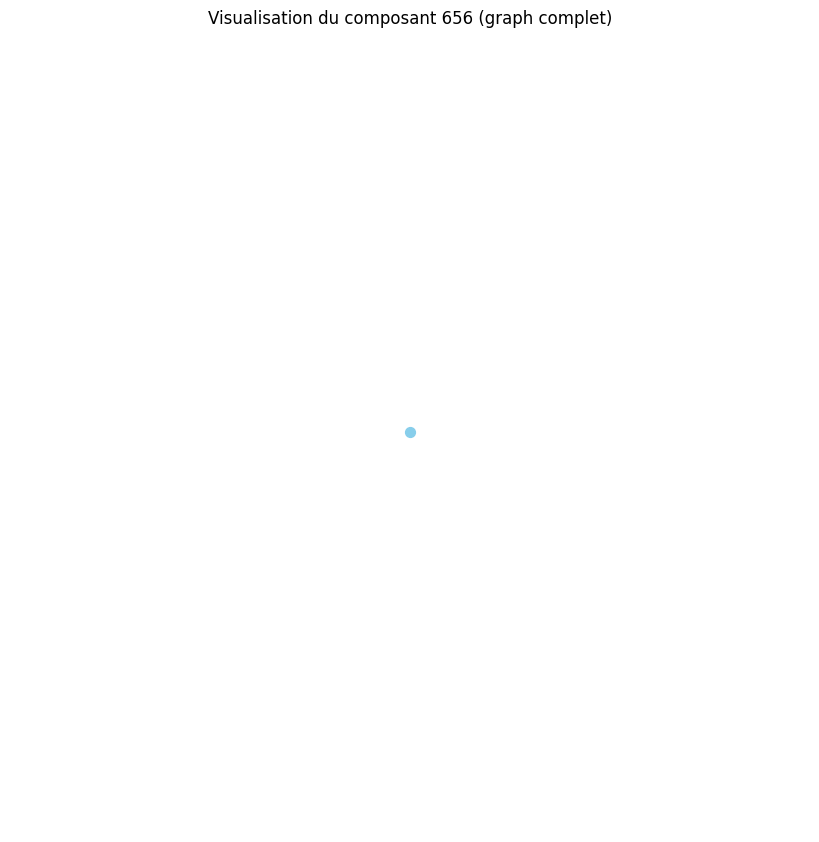

Distance moyenne pour le composant 657 : 0.00
Le composant 657 est un graphe complet ou très densément connecté.
Densité du composant 657 : 0.00
Degré moyen du composant 657 : 0.00
Coefficient de clustering moyen du composant 657 : 0.00


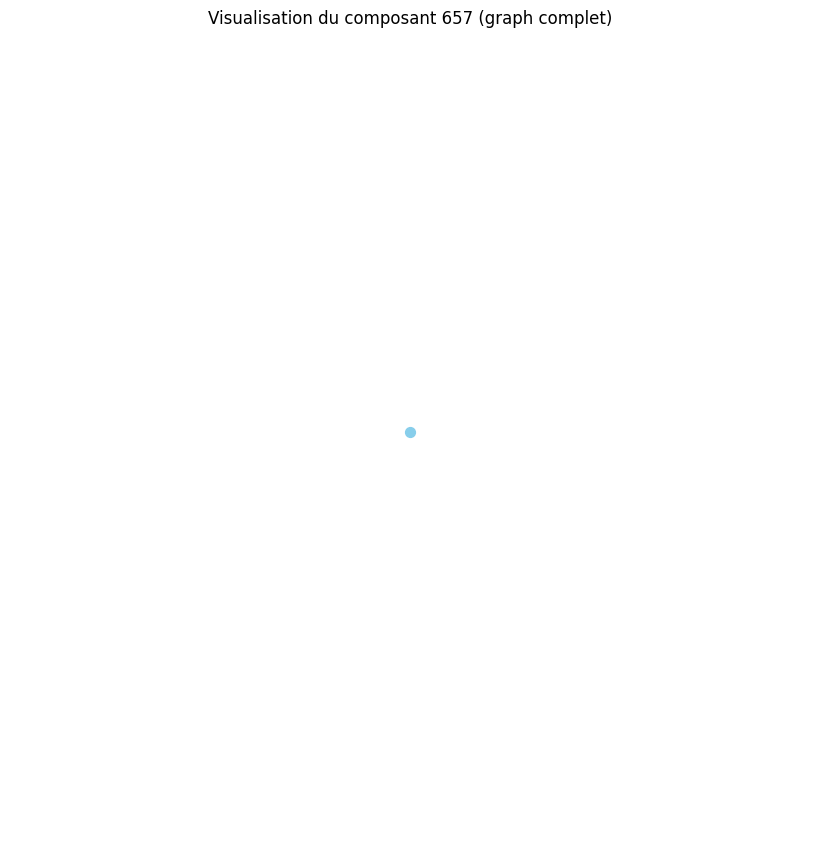

Distance moyenne pour le composant 658 : 0.00
Le composant 658 est un graphe complet ou très densément connecté.
Densité du composant 658 : 0.00
Degré moyen du composant 658 : 0.00
Coefficient de clustering moyen du composant 658 : 0.00


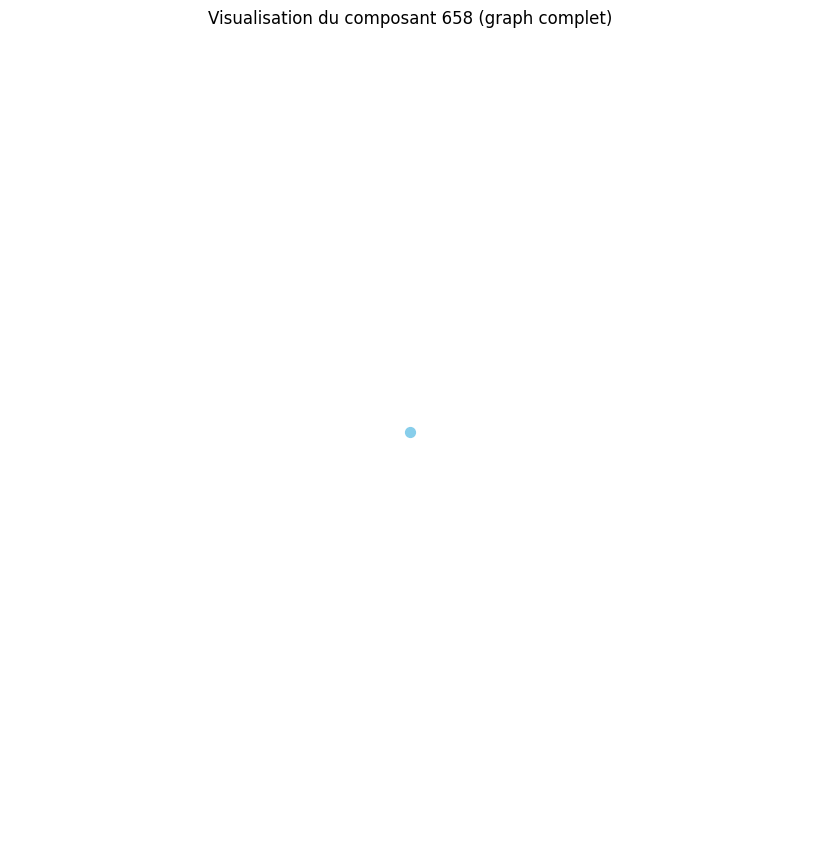

Distance moyenne pour le composant 659 : 0.00
Le composant 659 est un graphe complet ou très densément connecté.
Densité du composant 659 : 0.00
Degré moyen du composant 659 : 0.00
Coefficient de clustering moyen du composant 659 : 0.00


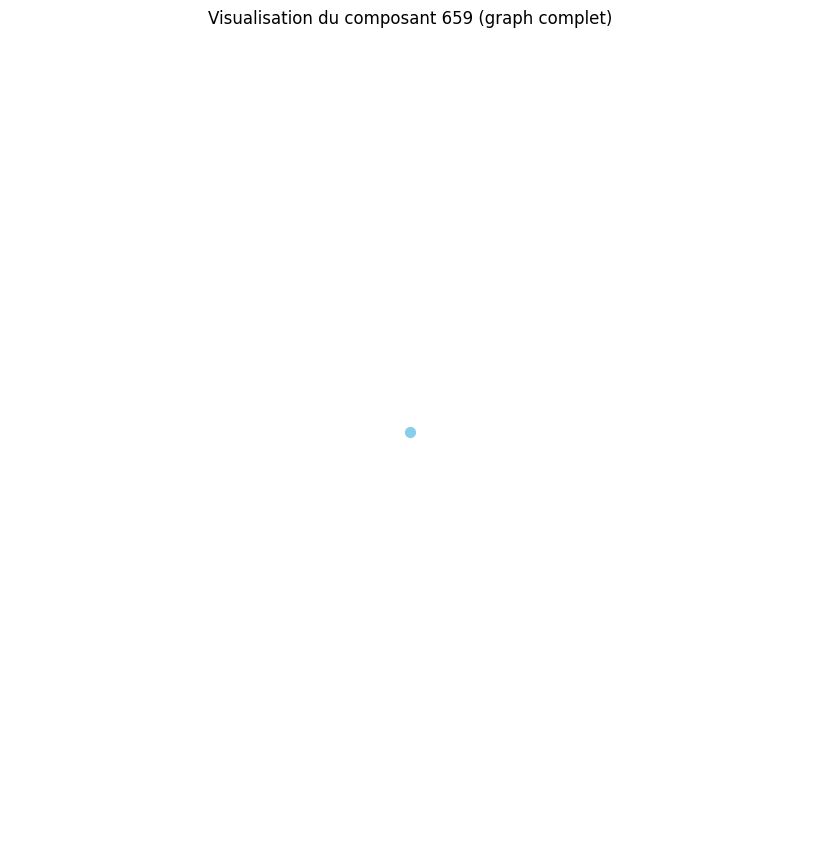

Distance moyenne pour le composant 660 : 0.00
Le composant 660 est un graphe complet ou très densément connecté.
Densité du composant 660 : 0.00
Degré moyen du composant 660 : 0.00
Coefficient de clustering moyen du composant 660 : 0.00


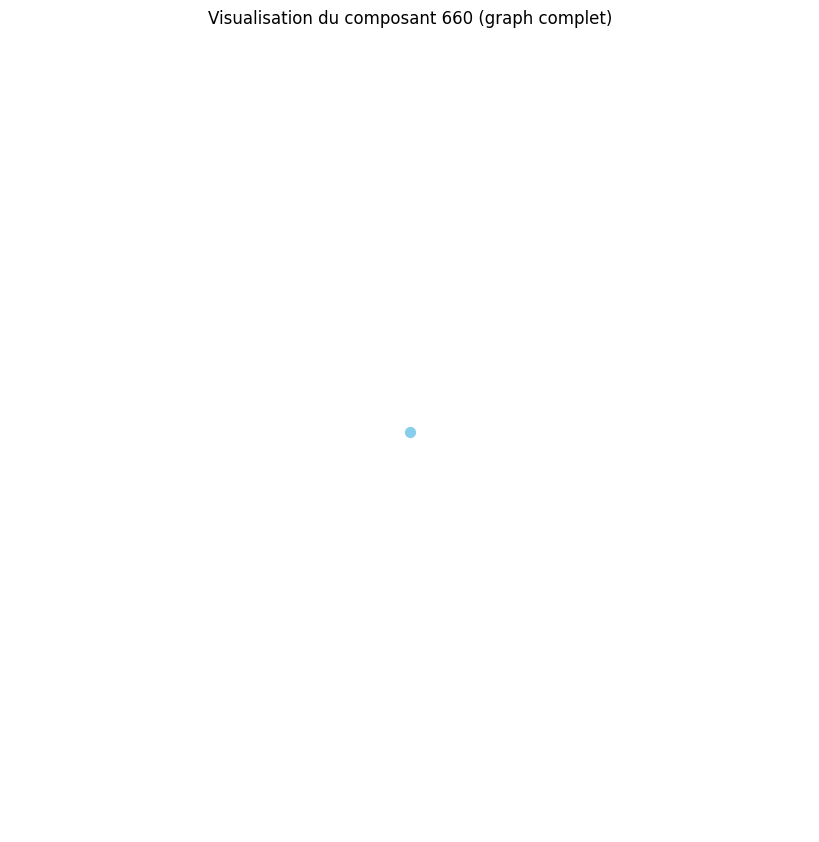

Distance moyenne pour le composant 661 : 0.00
Le composant 661 est un graphe complet ou très densément connecté.
Densité du composant 661 : 0.00
Degré moyen du composant 661 : 0.00
Coefficient de clustering moyen du composant 661 : 0.00


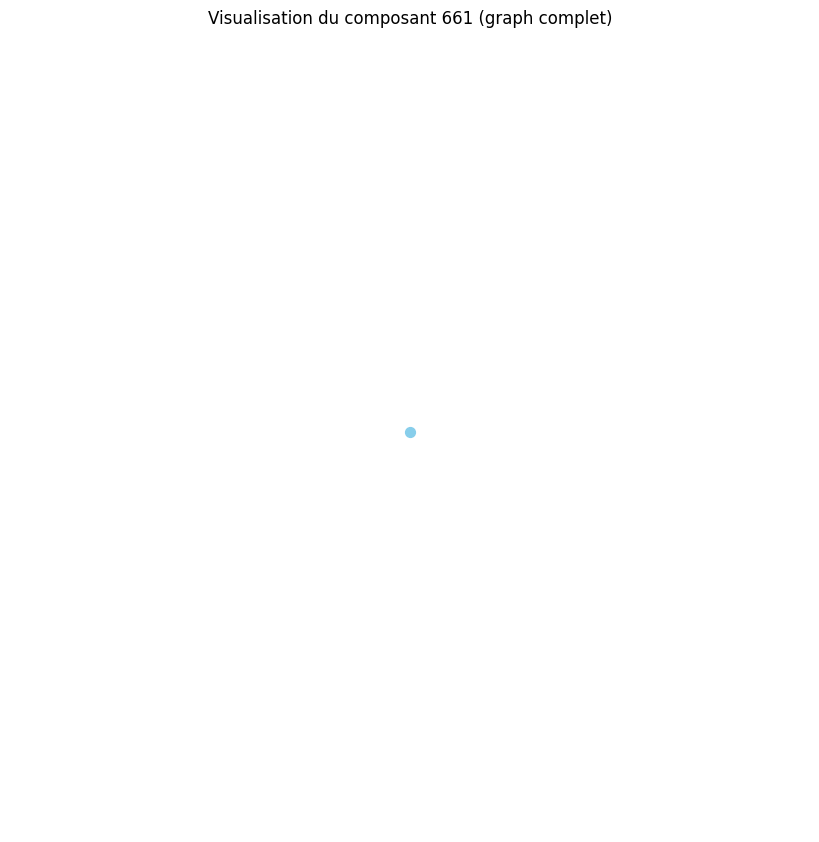

Distance moyenne pour le composant 662 : 0.00
Le composant 662 est un graphe complet ou très densément connecté.
Densité du composant 662 : 0.00
Degré moyen du composant 662 : 0.00
Coefficient de clustering moyen du composant 662 : 0.00


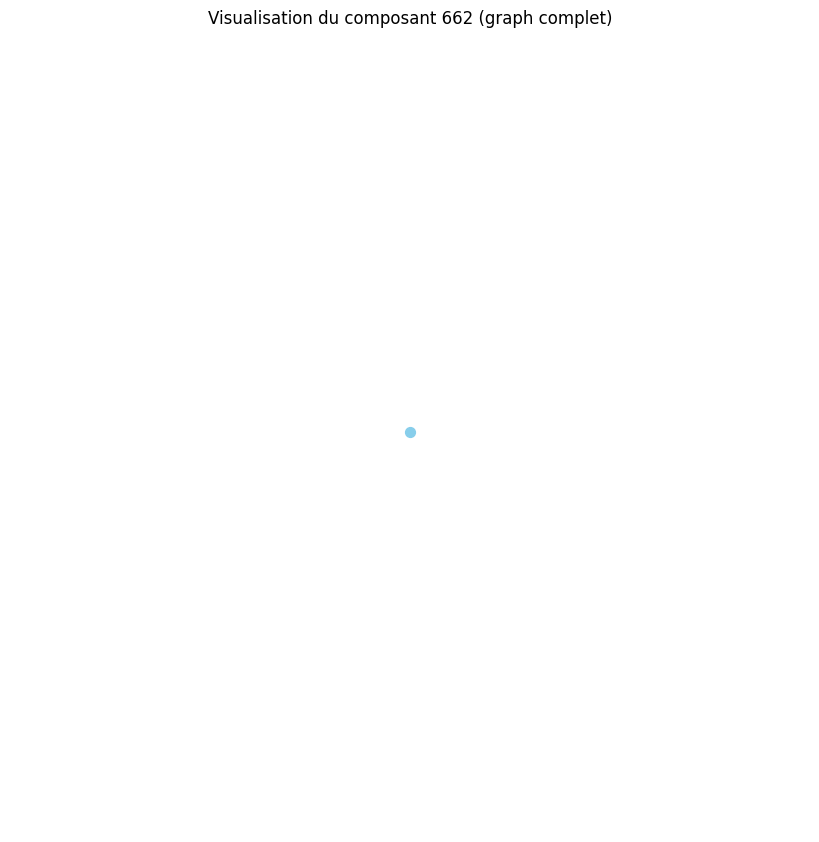

Distance moyenne pour le composant 663 : 0.00
Le composant 663 est un graphe complet ou très densément connecté.
Densité du composant 663 : 0.00
Degré moyen du composant 663 : 0.00
Coefficient de clustering moyen du composant 663 : 0.00


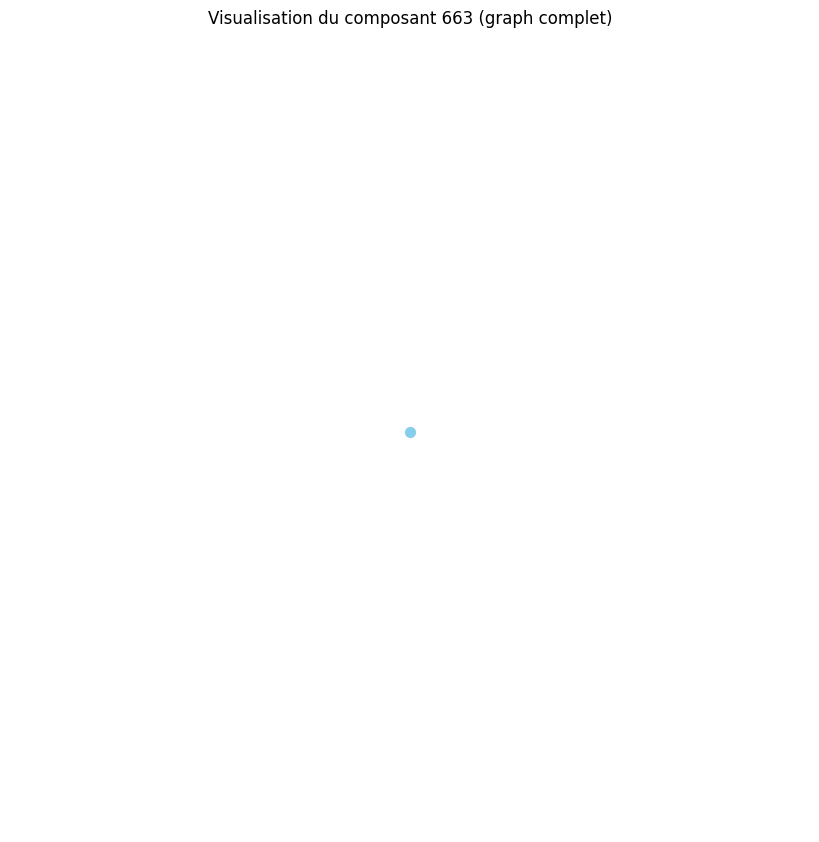

Distance moyenne pour le composant 664 : 0.00
Le composant 664 est un graphe complet ou très densément connecté.
Densité du composant 664 : 0.00
Degré moyen du composant 664 : 0.00
Coefficient de clustering moyen du composant 664 : 0.00


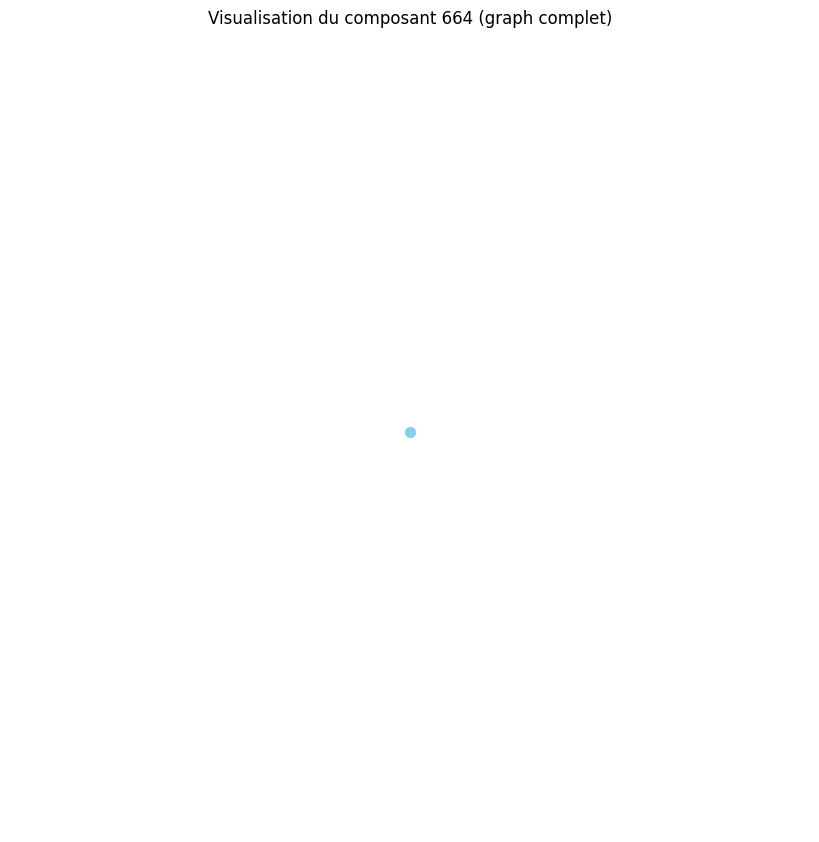

Distance moyenne pour le composant 665 : 0.00
Le composant 665 est un graphe complet ou très densément connecté.
Densité du composant 665 : 0.00
Degré moyen du composant 665 : 0.00
Coefficient de clustering moyen du composant 665 : 0.00


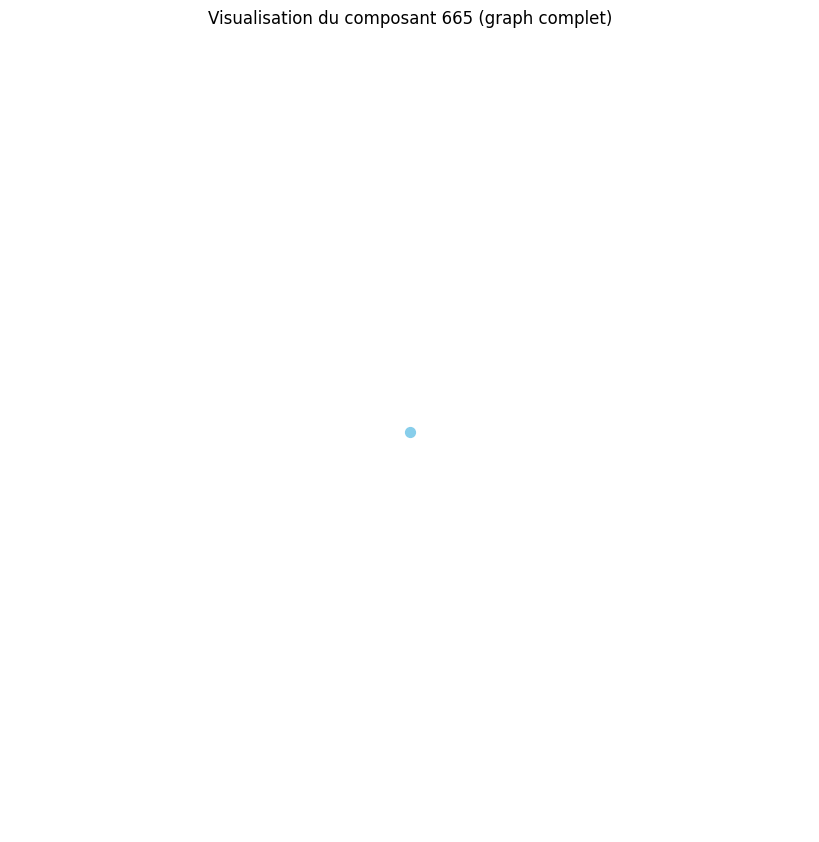

Distance moyenne pour le composant 666 : 0.00
Le composant 666 est un graphe complet ou très densément connecté.
Densité du composant 666 : 0.00
Degré moyen du composant 666 : 0.00
Coefficient de clustering moyen du composant 666 : 0.00


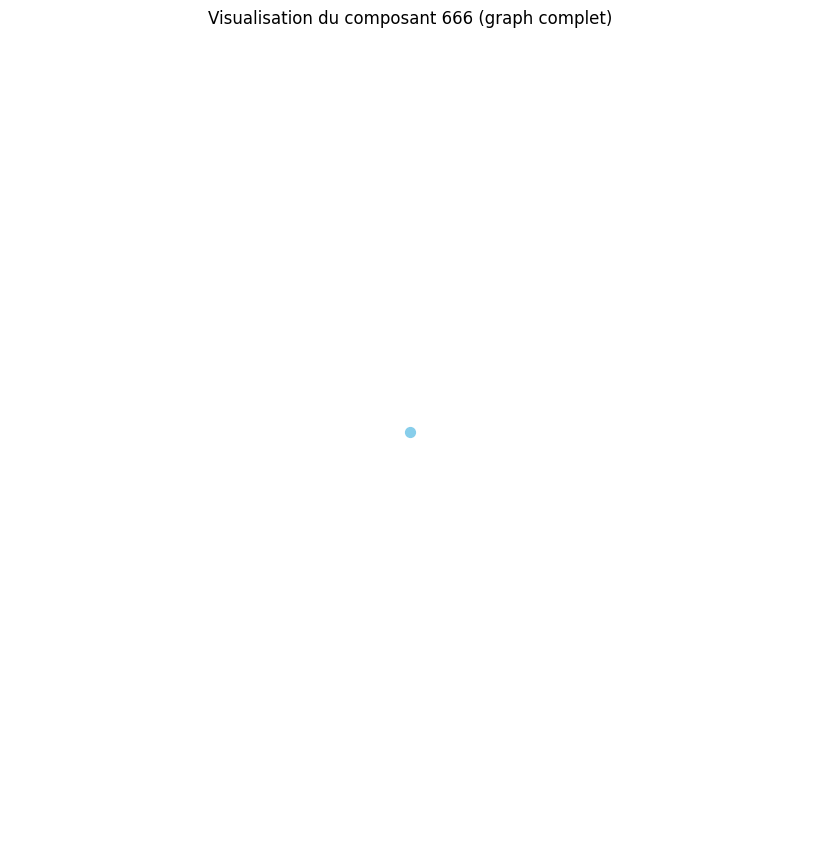

Distance moyenne pour le composant 667 : 0.00
Le composant 667 est un graphe complet ou très densément connecté.
Densité du composant 667 : 0.00
Degré moyen du composant 667 : 0.00
Coefficient de clustering moyen du composant 667 : 0.00


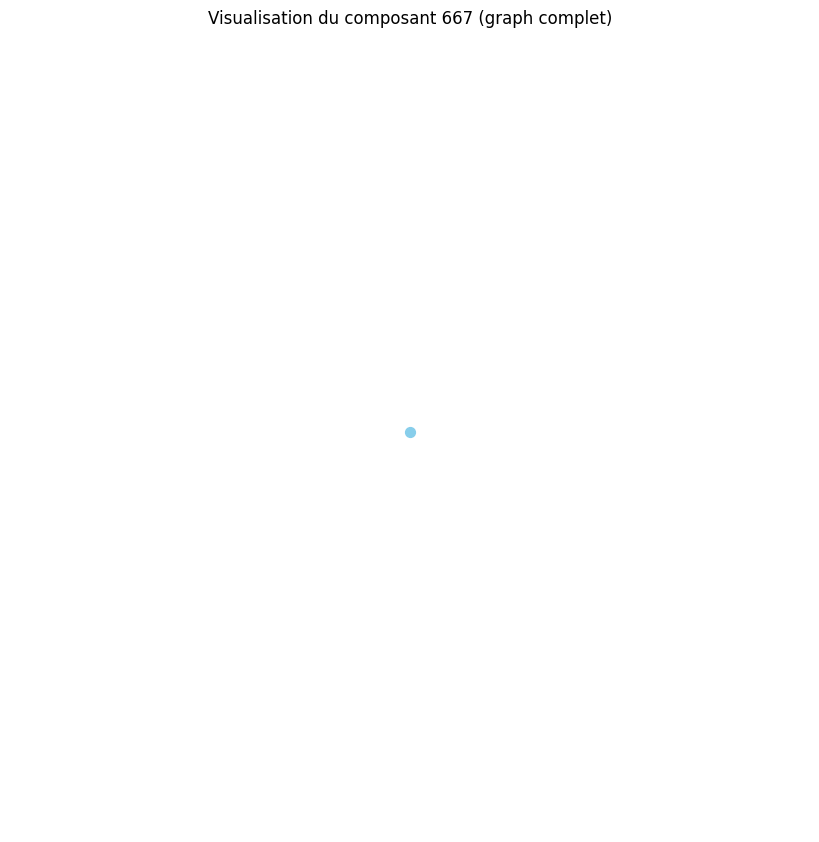

Distance moyenne pour le composant 668 : 0.00
Le composant 668 est un graphe complet ou très densément connecté.
Densité du composant 668 : 0.00
Degré moyen du composant 668 : 0.00
Coefficient de clustering moyen du composant 668 : 0.00


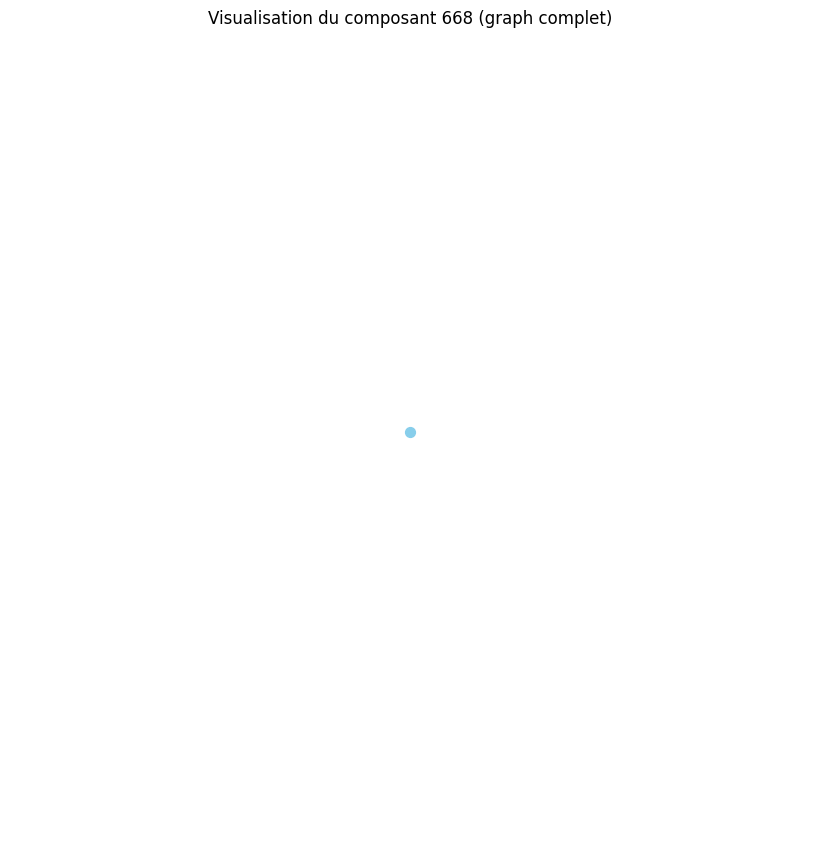

Distance moyenne pour le composant 669 : 0.00
Le composant 669 est un graphe complet ou très densément connecté.
Densité du composant 669 : 0.00
Degré moyen du composant 669 : 0.00
Coefficient de clustering moyen du composant 669 : 0.00


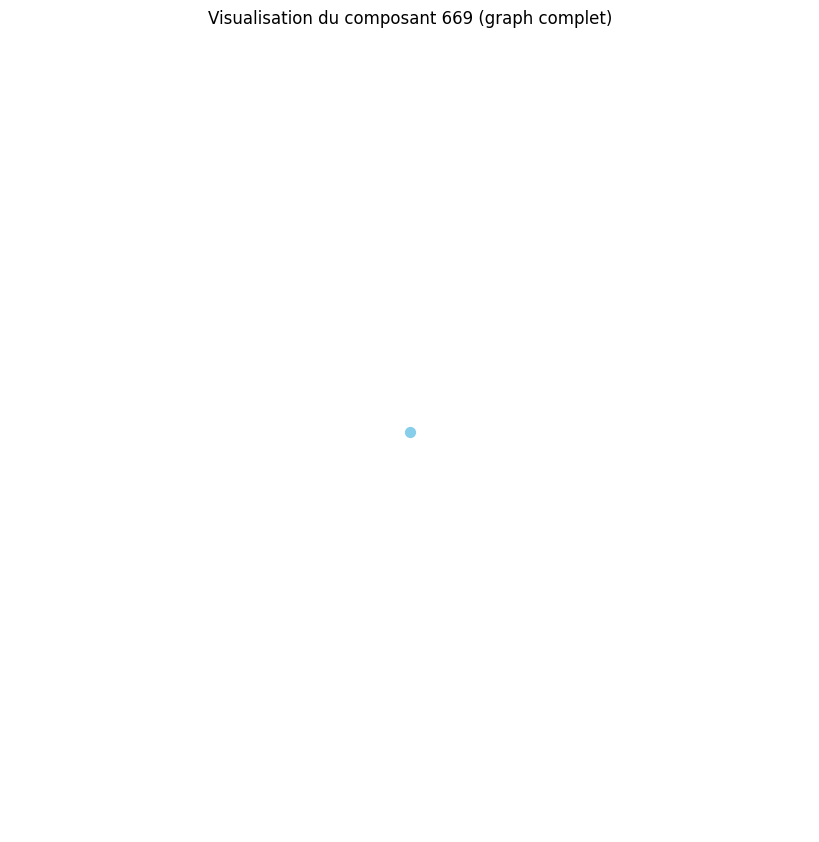

Distance moyenne pour le composant 670 : 0.00
Le composant 670 est un graphe complet ou très densément connecté.
Densité du composant 670 : 0.00
Degré moyen du composant 670 : 0.00
Coefficient de clustering moyen du composant 670 : 0.00


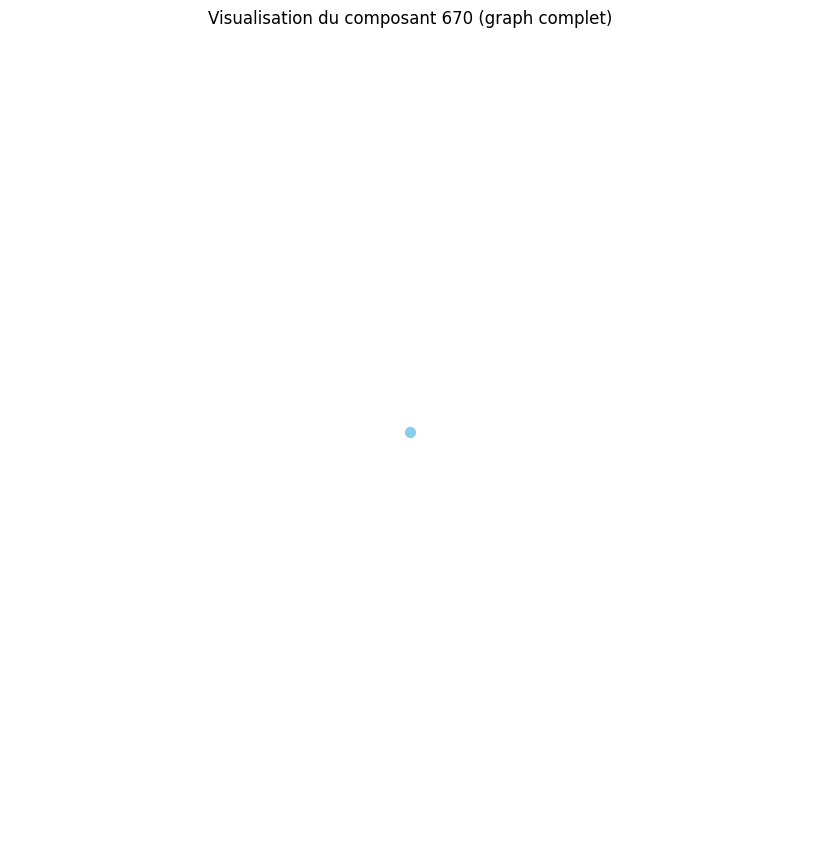

Distance moyenne pour le composant 671 : 0.00
Le composant 671 est un graphe complet ou très densément connecté.
Densité du composant 671 : 0.00
Degré moyen du composant 671 : 0.00
Coefficient de clustering moyen du composant 671 : 0.00


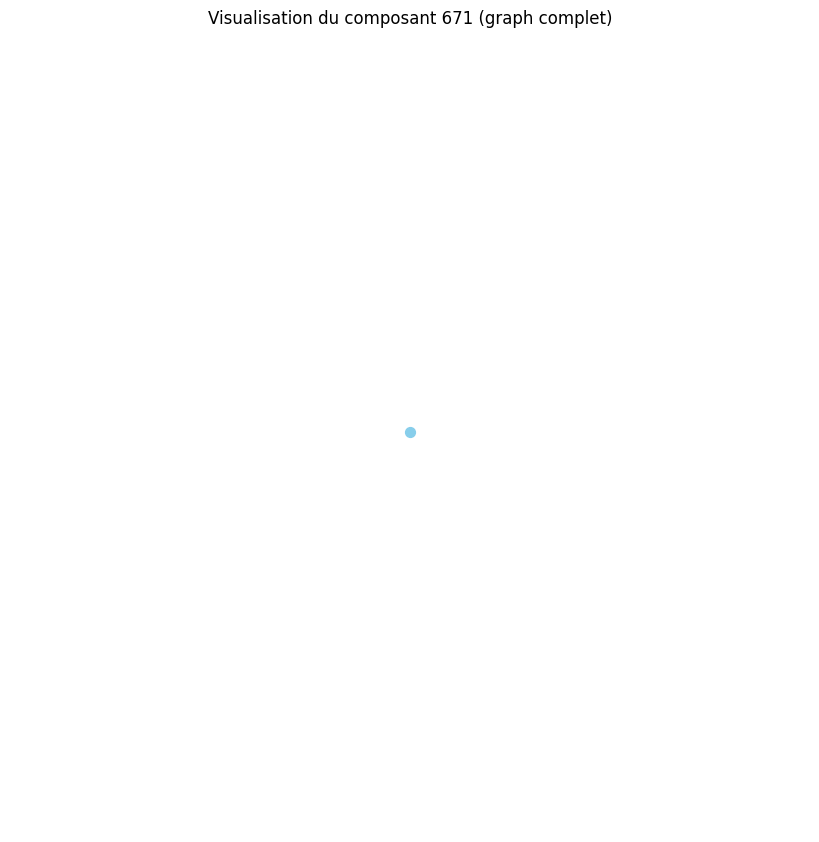

Distance moyenne pour le composant 672 : 0.00
Le composant 672 est un graphe complet ou très densément connecté.
Densité du composant 672 : 0.00
Degré moyen du composant 672 : 0.00
Coefficient de clustering moyen du composant 672 : 0.00


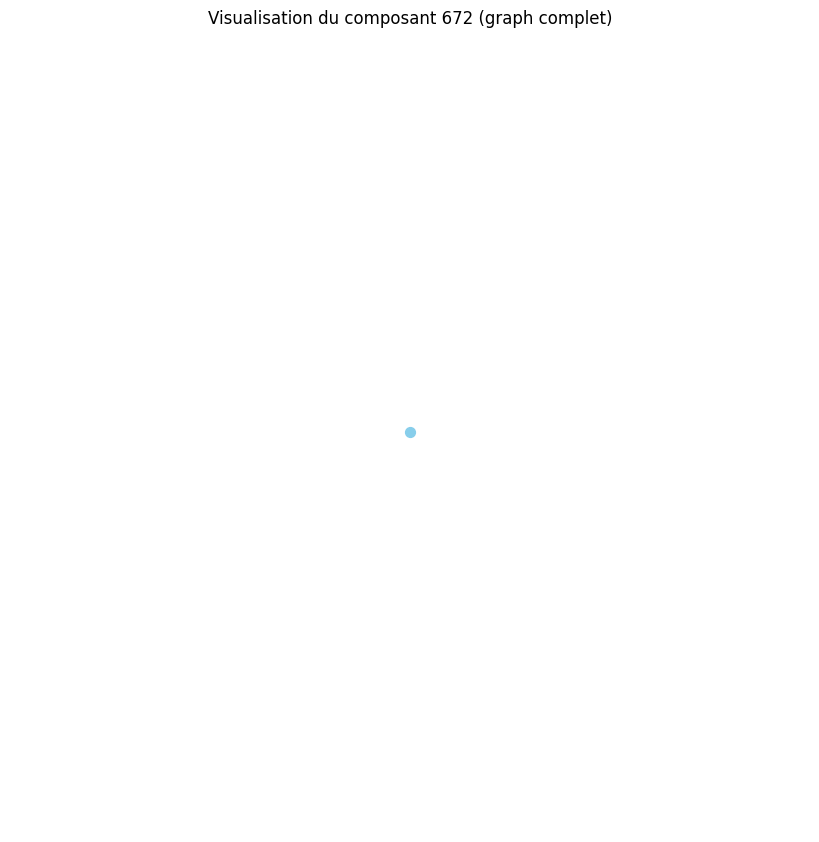

Distance moyenne pour le composant 673 : 0.00
Le composant 673 est un graphe complet ou très densément connecté.
Densité du composant 673 : 0.00
Degré moyen du composant 673 : 0.00
Coefficient de clustering moyen du composant 673 : 0.00


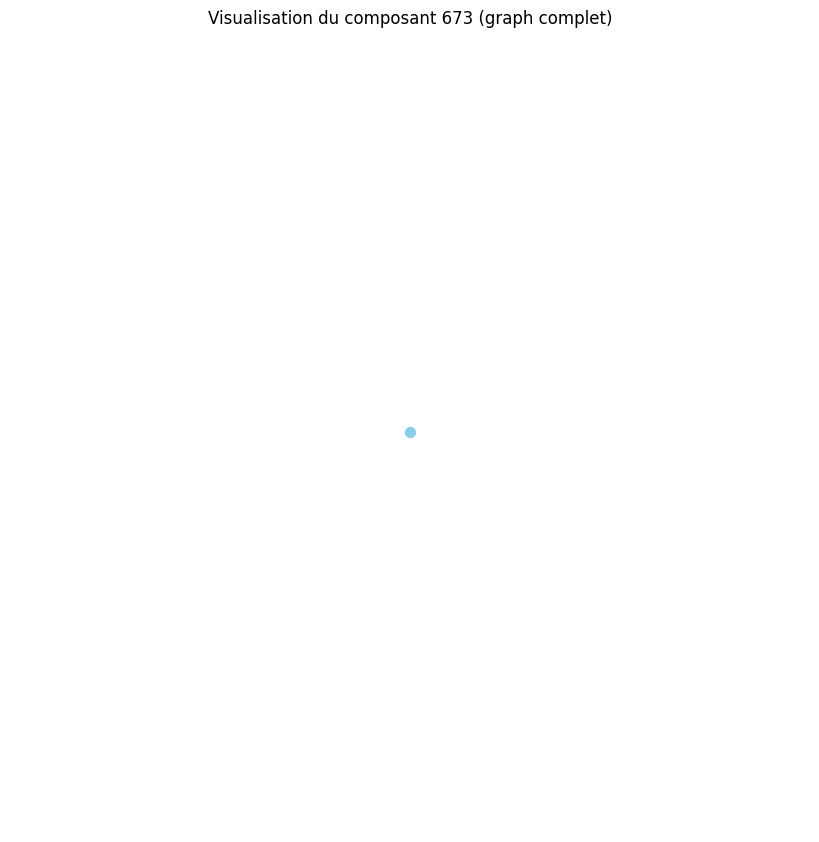

Distance moyenne pour le composant 674 : 1.00
Distance moyenne pour le composant 675 : 0.00
Le composant 675 est un graphe complet ou très densément connecté.
Densité du composant 675 : 0.00
Degré moyen du composant 675 : 0.00
Coefficient de clustering moyen du composant 675 : 0.00


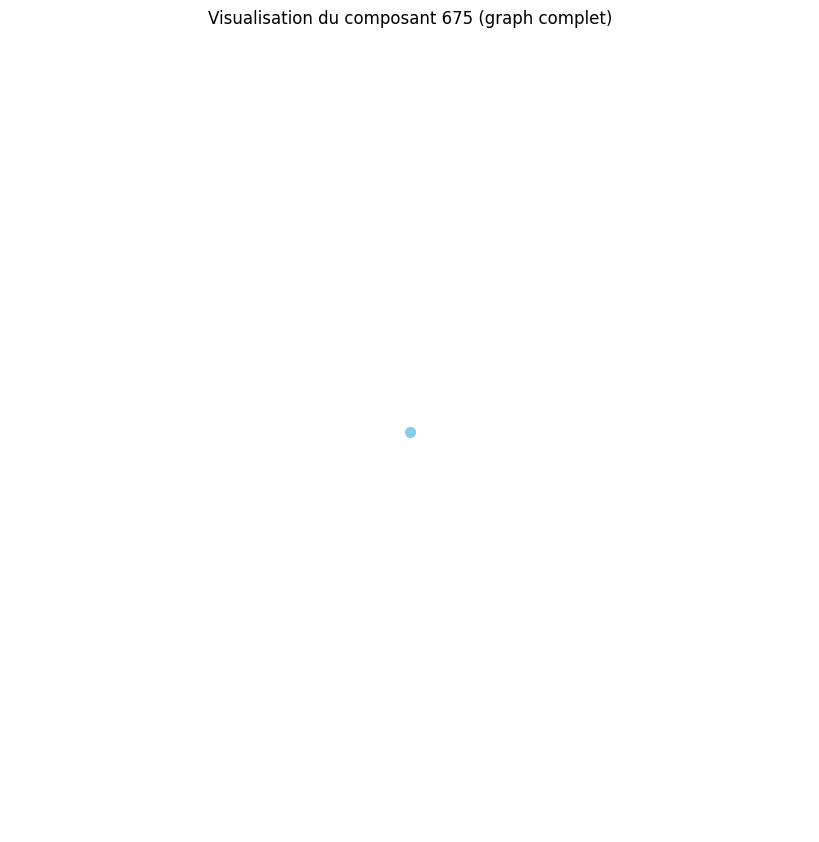

Distance moyenne pour le composant 676 : 0.00
Le composant 676 est un graphe complet ou très densément connecté.
Densité du composant 676 : 0.00
Degré moyen du composant 676 : 0.00
Coefficient de clustering moyen du composant 676 : 0.00


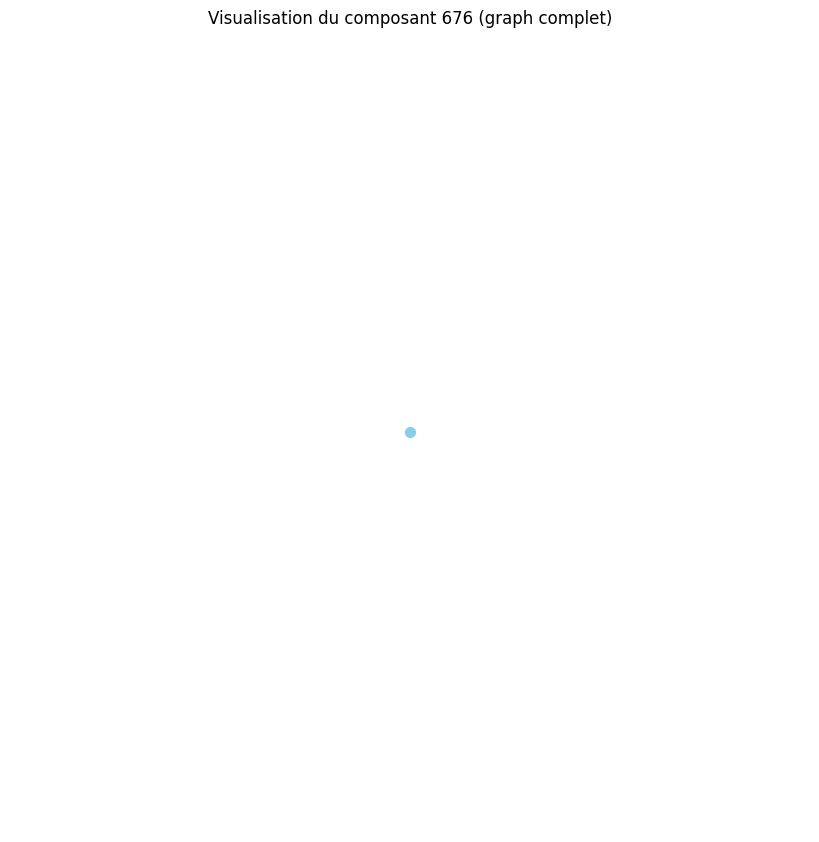

Distance moyenne pour le composant 677 : 0.00
Le composant 677 est un graphe complet ou très densément connecté.
Densité du composant 677 : 0.00
Degré moyen du composant 677 : 0.00
Coefficient de clustering moyen du composant 677 : 0.00


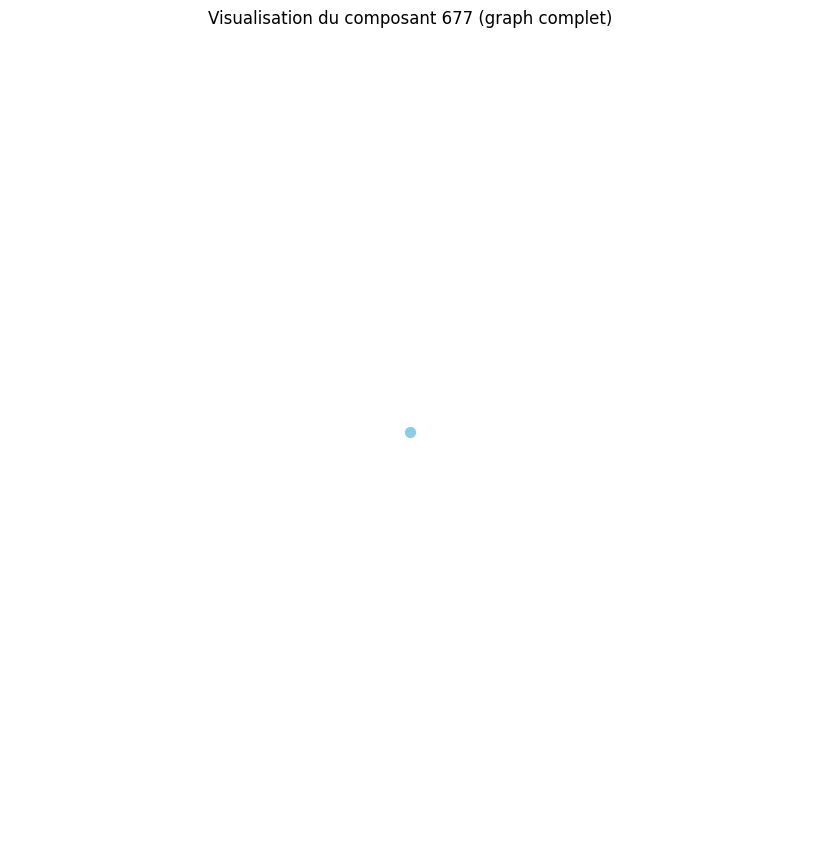

Distance moyenne pour le composant 678 : 0.00
Le composant 678 est un graphe complet ou très densément connecté.
Densité du composant 678 : 0.00
Degré moyen du composant 678 : 0.00
Coefficient de clustering moyen du composant 678 : 0.00


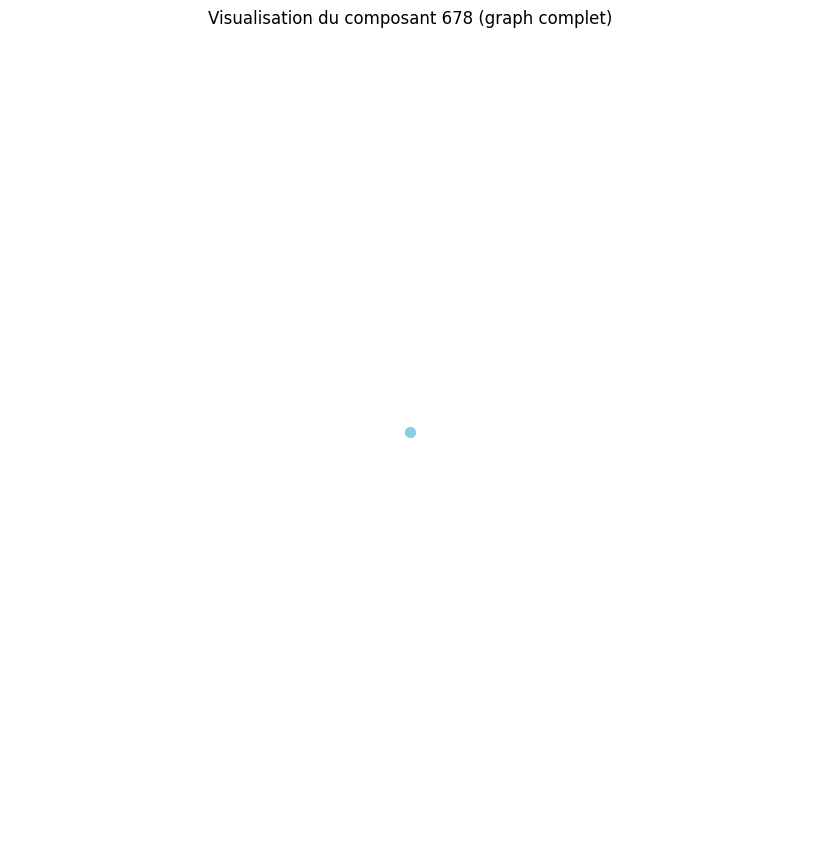

Distance moyenne pour le composant 679 : 0.00
Le composant 679 est un graphe complet ou très densément connecté.
Densité du composant 679 : 0.00
Degré moyen du composant 679 : 0.00
Coefficient de clustering moyen du composant 679 : 0.00


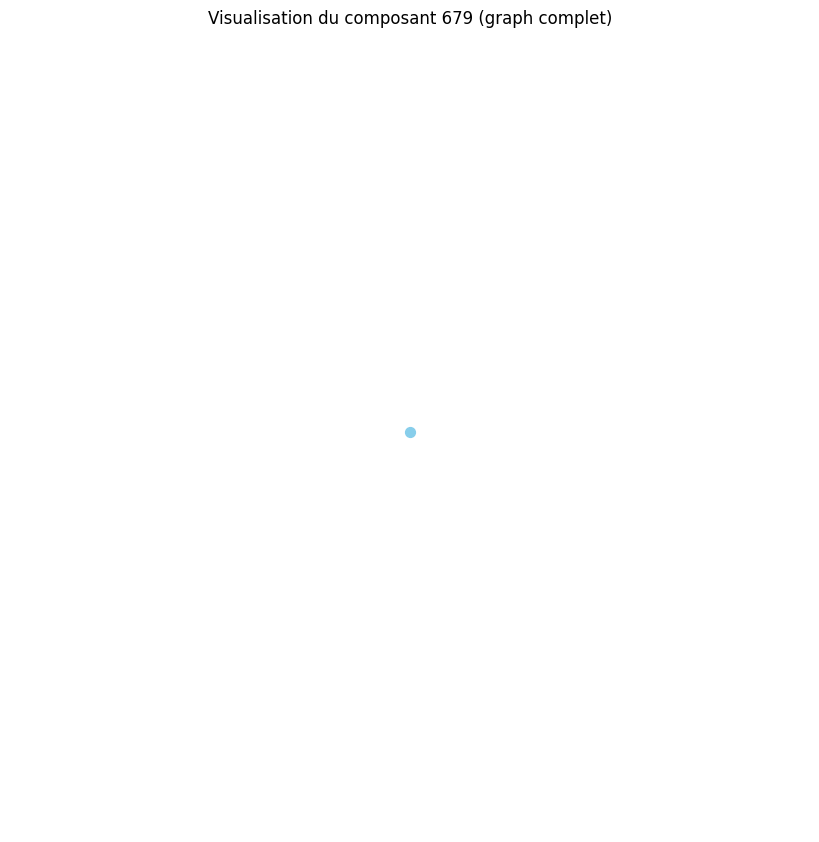

Distance moyenne pour le composant 680 : 0.00
Le composant 680 est un graphe complet ou très densément connecté.
Densité du composant 680 : 0.00
Degré moyen du composant 680 : 0.00
Coefficient de clustering moyen du composant 680 : 0.00


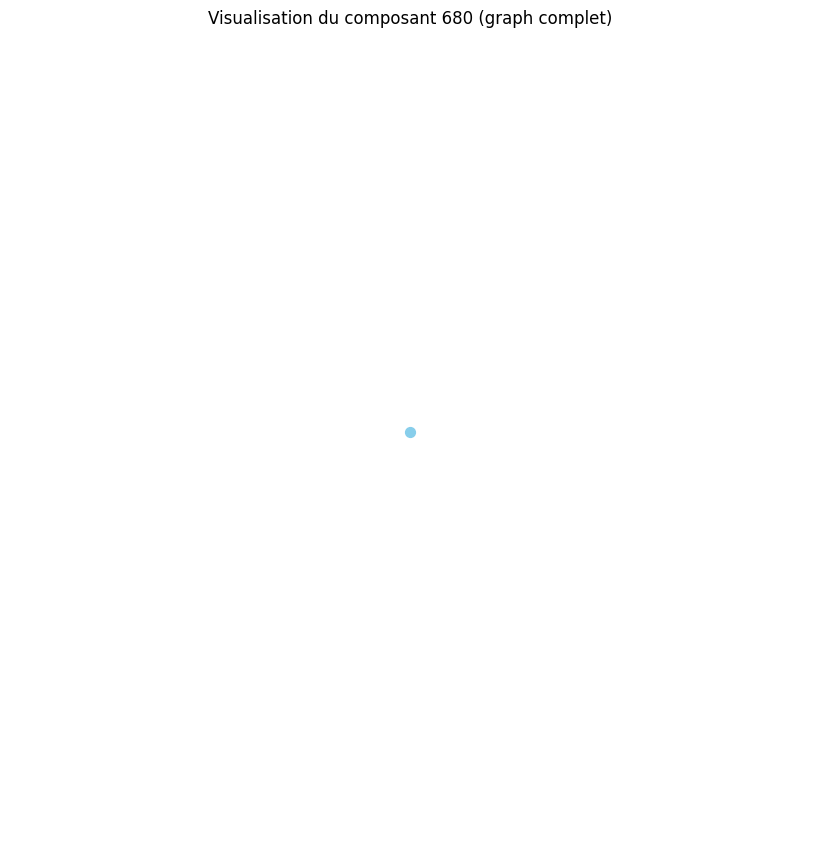

Distance moyenne pour le composant 681 : 0.00
Le composant 681 est un graphe complet ou très densément connecté.
Densité du composant 681 : 0.00
Degré moyen du composant 681 : 0.00
Coefficient de clustering moyen du composant 681 : 0.00


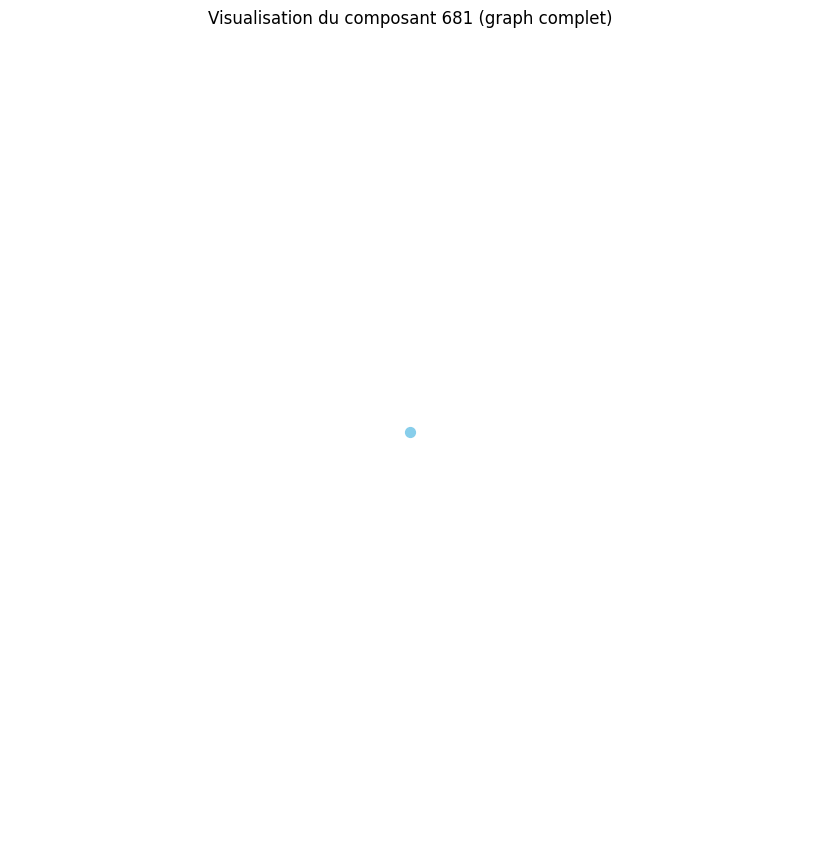

Distance moyenne pour le composant 682 : 0.00
Le composant 682 est un graphe complet ou très densément connecté.
Densité du composant 682 : 0.00
Degré moyen du composant 682 : 0.00
Coefficient de clustering moyen du composant 682 : 0.00


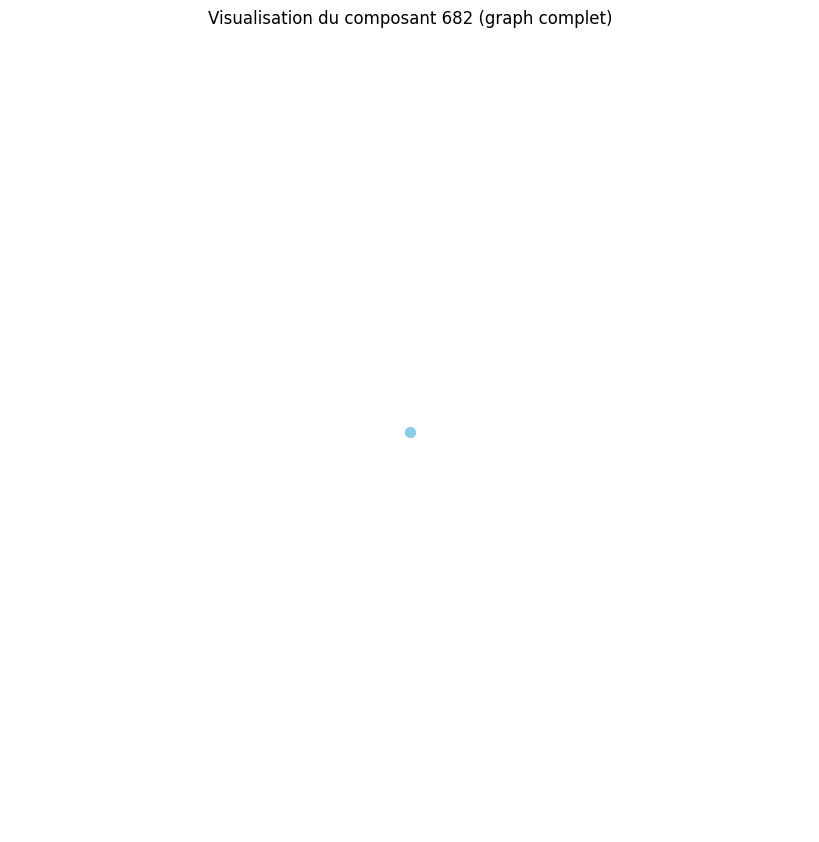

Distance moyenne pour le composant 683 : 0.00
Le composant 683 est un graphe complet ou très densément connecté.
Densité du composant 683 : 0.00
Degré moyen du composant 683 : 0.00
Coefficient de clustering moyen du composant 683 : 0.00


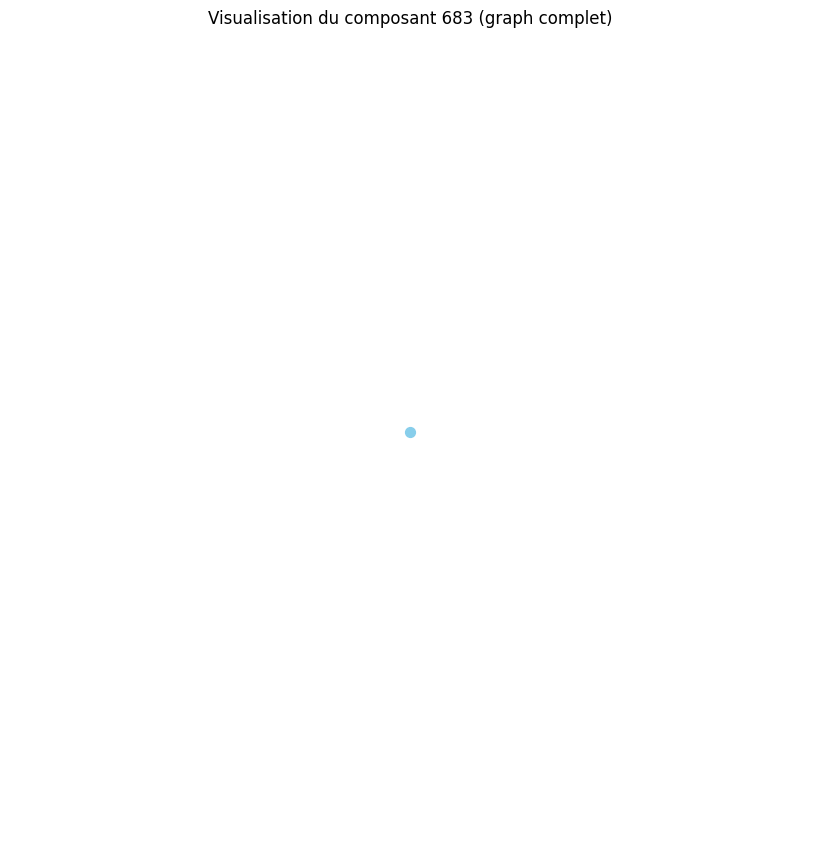

Distance moyenne pour le composant 684 : 0.00
Le composant 684 est un graphe complet ou très densément connecté.
Densité du composant 684 : 0.00
Degré moyen du composant 684 : 0.00
Coefficient de clustering moyen du composant 684 : 0.00


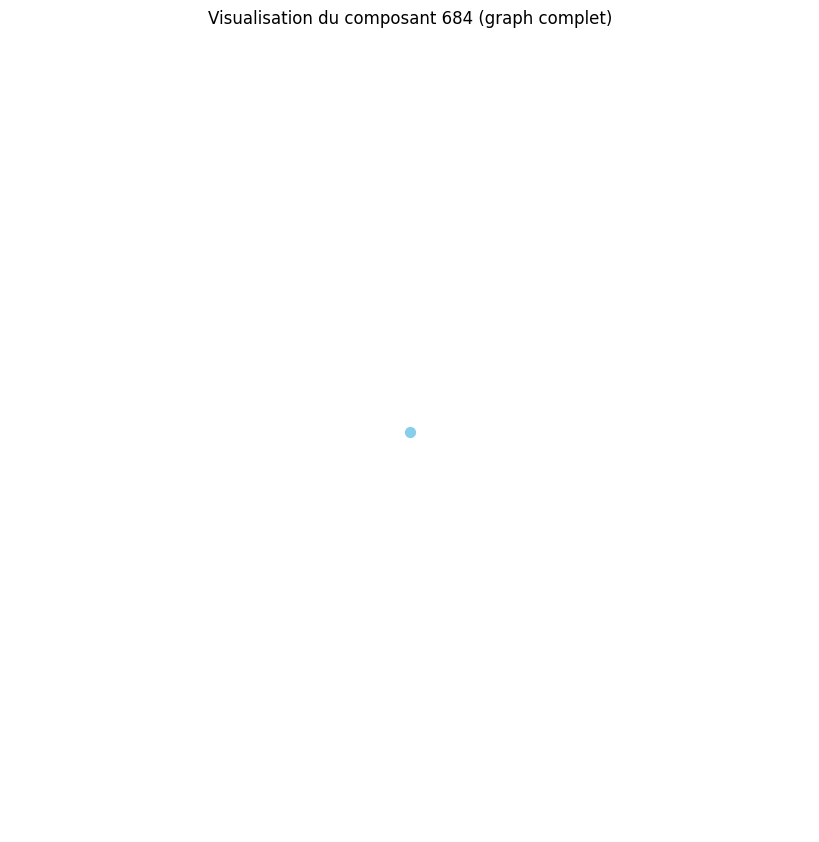

Distance moyenne pour le composant 685 : 0.00
Le composant 685 est un graphe complet ou très densément connecté.
Densité du composant 685 : 0.00
Degré moyen du composant 685 : 0.00
Coefficient de clustering moyen du composant 685 : 0.00


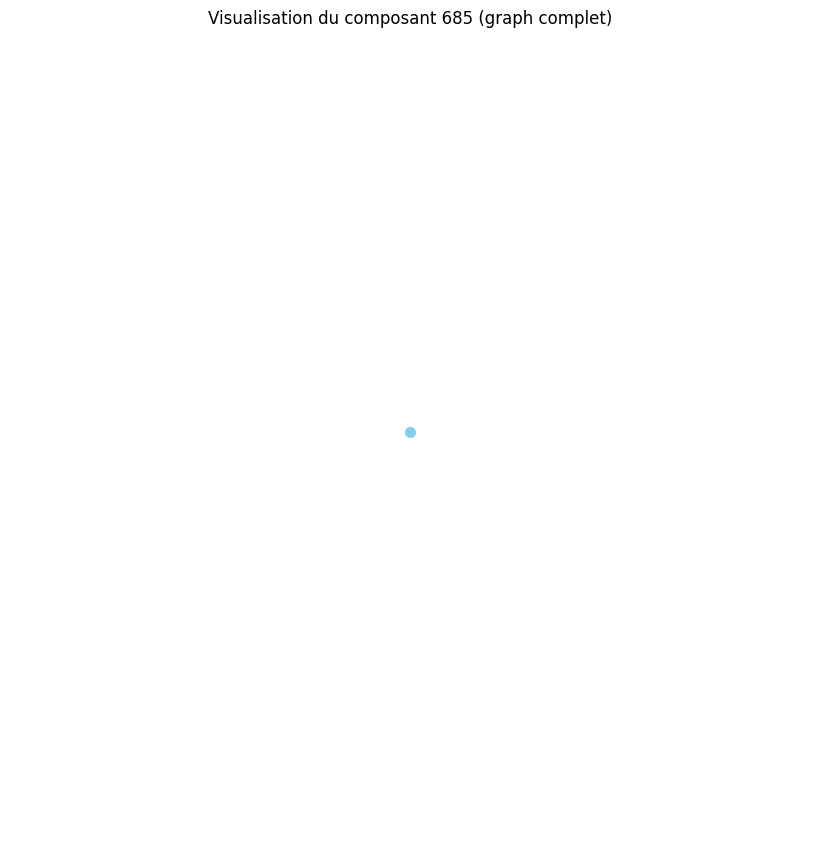

Distance moyenne pour le composant 686 : 0.00
Le composant 686 est un graphe complet ou très densément connecté.
Densité du composant 686 : 0.00
Degré moyen du composant 686 : 0.00
Coefficient de clustering moyen du composant 686 : 0.00


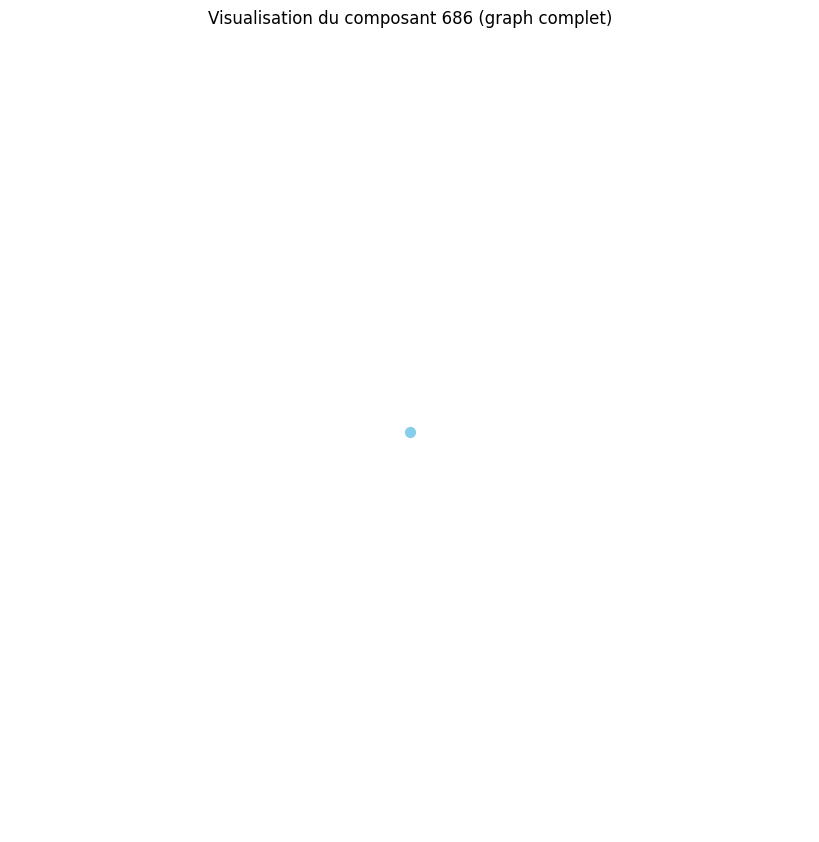

Distance moyenne pour le composant 687 : 0.00
Le composant 687 est un graphe complet ou très densément connecté.
Densité du composant 687 : 0.00
Degré moyen du composant 687 : 0.00
Coefficient de clustering moyen du composant 687 : 0.00


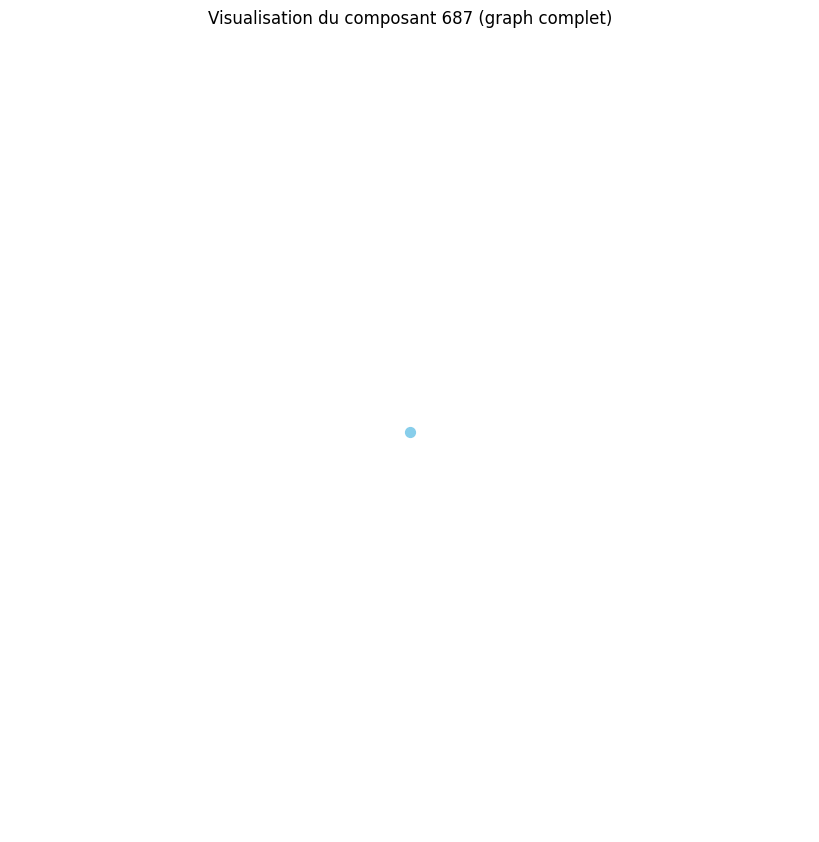

Distance moyenne pour le composant 688 : 0.00
Le composant 688 est un graphe complet ou très densément connecté.
Densité du composant 688 : 0.00
Degré moyen du composant 688 : 0.00
Coefficient de clustering moyen du composant 688 : 0.00


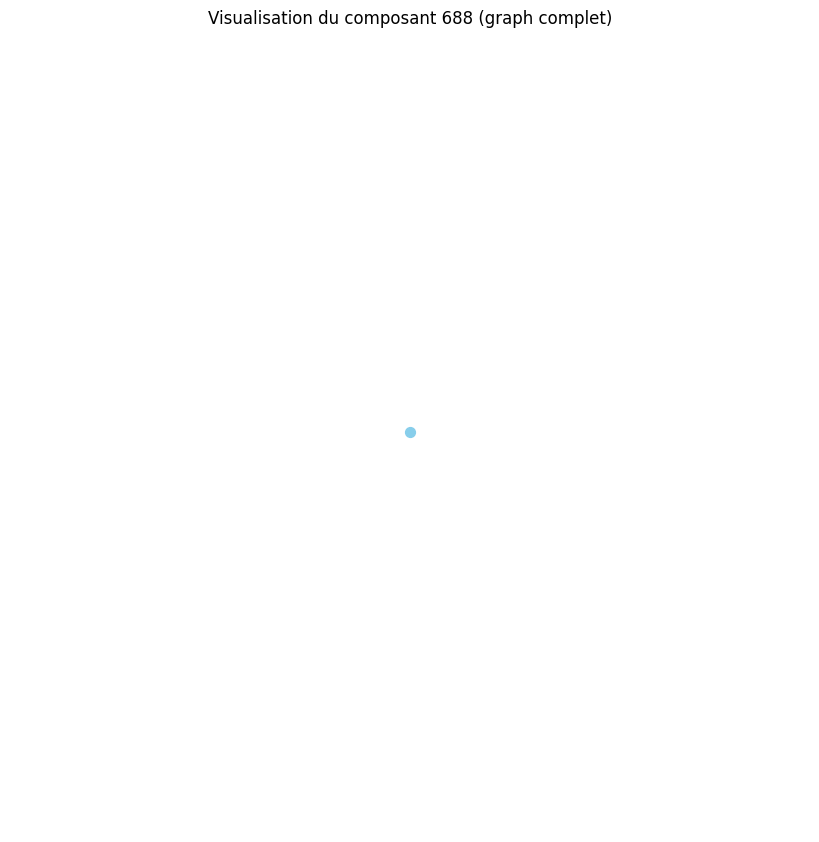

Distance moyenne pour le composant 689 : 0.00
Le composant 689 est un graphe complet ou très densément connecté.
Densité du composant 689 : 0.00
Degré moyen du composant 689 : 0.00
Coefficient de clustering moyen du composant 689 : 0.00


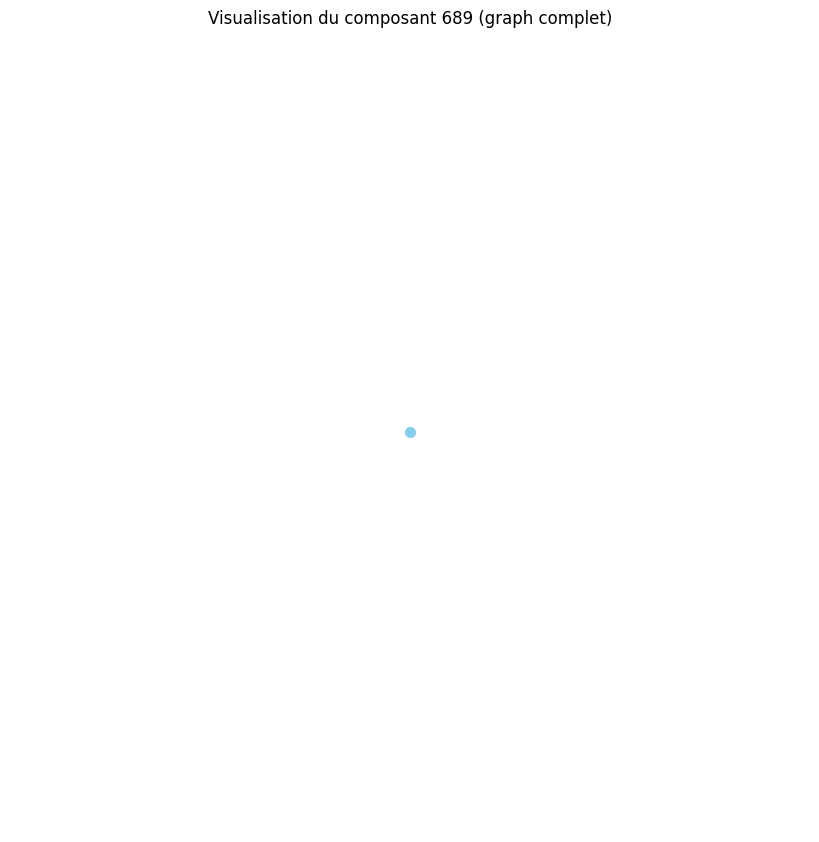

Distance moyenne pour le composant 690 : 0.00
Le composant 690 est un graphe complet ou très densément connecté.
Densité du composant 690 : 0.00
Degré moyen du composant 690 : 0.00
Coefficient de clustering moyen du composant 690 : 0.00


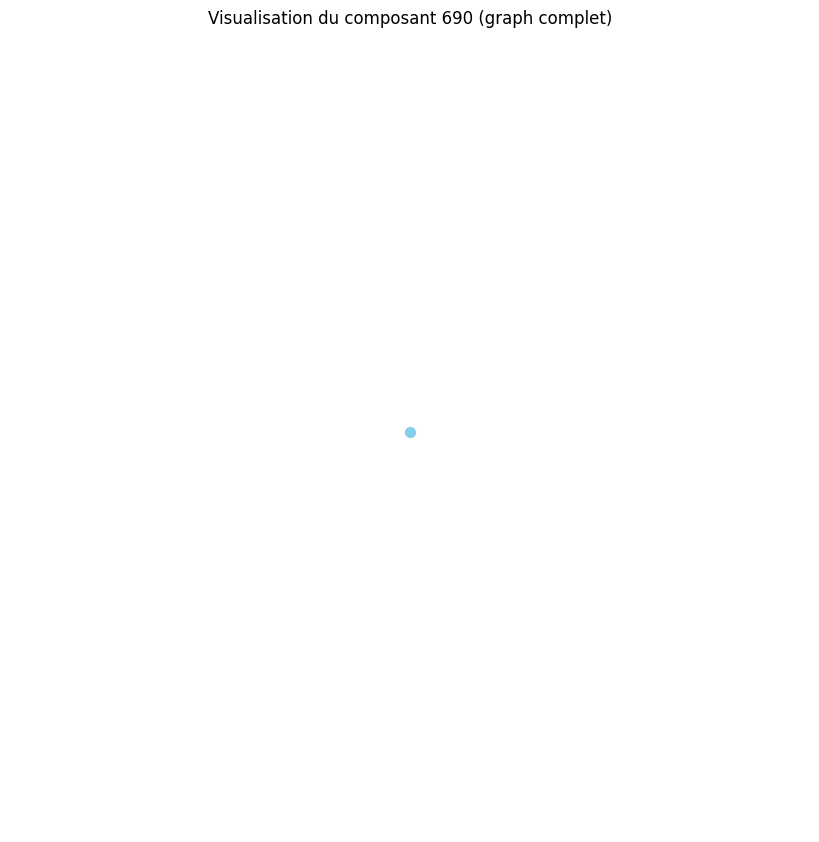

Distance moyenne pour le composant 691 : 0.00
Le composant 691 est un graphe complet ou très densément connecté.
Densité du composant 691 : 0.00
Degré moyen du composant 691 : 0.00
Coefficient de clustering moyen du composant 691 : 0.00


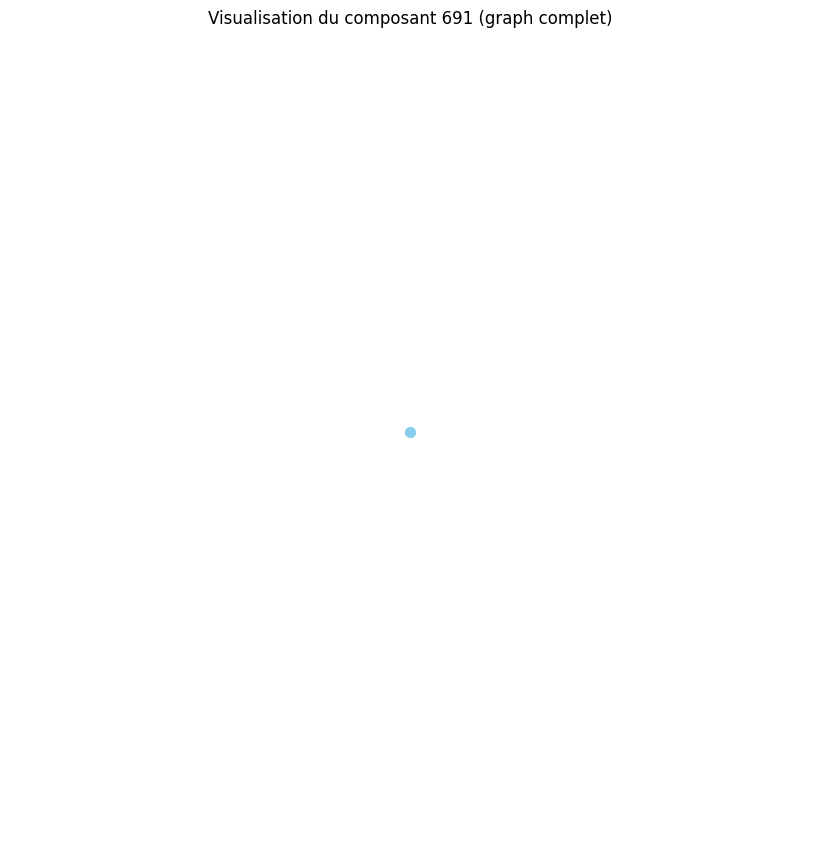

Distance moyenne pour le composant 692 : 0.00
Le composant 692 est un graphe complet ou très densément connecté.
Densité du composant 692 : 0.00
Degré moyen du composant 692 : 0.00
Coefficient de clustering moyen du composant 692 : 0.00


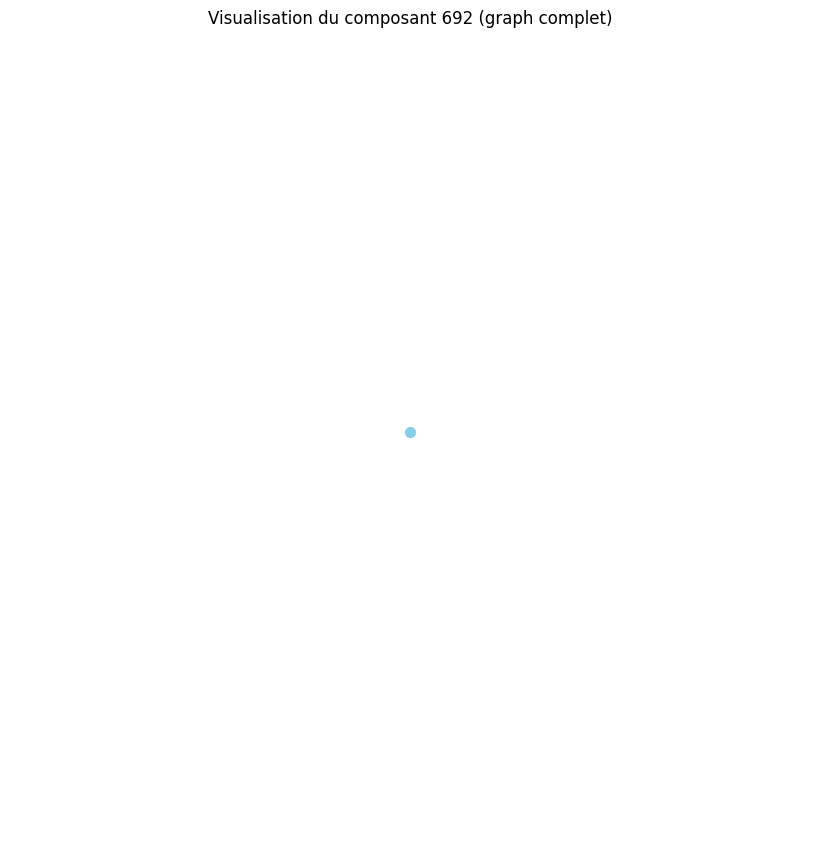

Distance moyenne pour le composant 693 : 0.00
Le composant 693 est un graphe complet ou très densément connecté.
Densité du composant 693 : 0.00
Degré moyen du composant 693 : 0.00
Coefficient de clustering moyen du composant 693 : 0.00


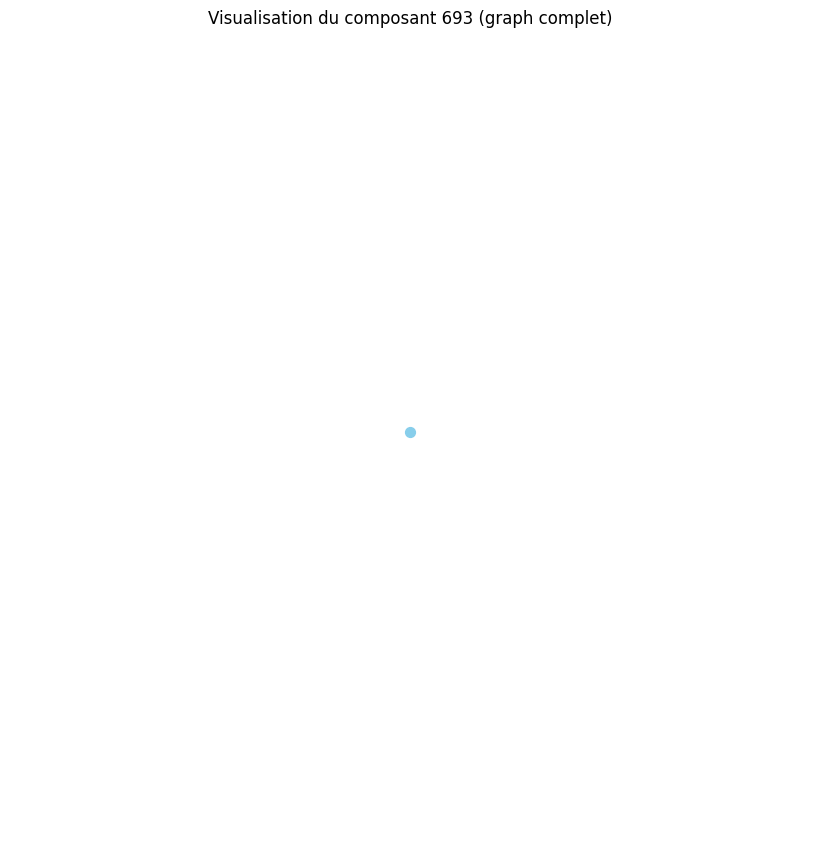

Distance moyenne pour le composant 694 : 0.00
Le composant 694 est un graphe complet ou très densément connecté.
Densité du composant 694 : 0.00
Degré moyen du composant 694 : 0.00
Coefficient de clustering moyen du composant 694 : 0.00


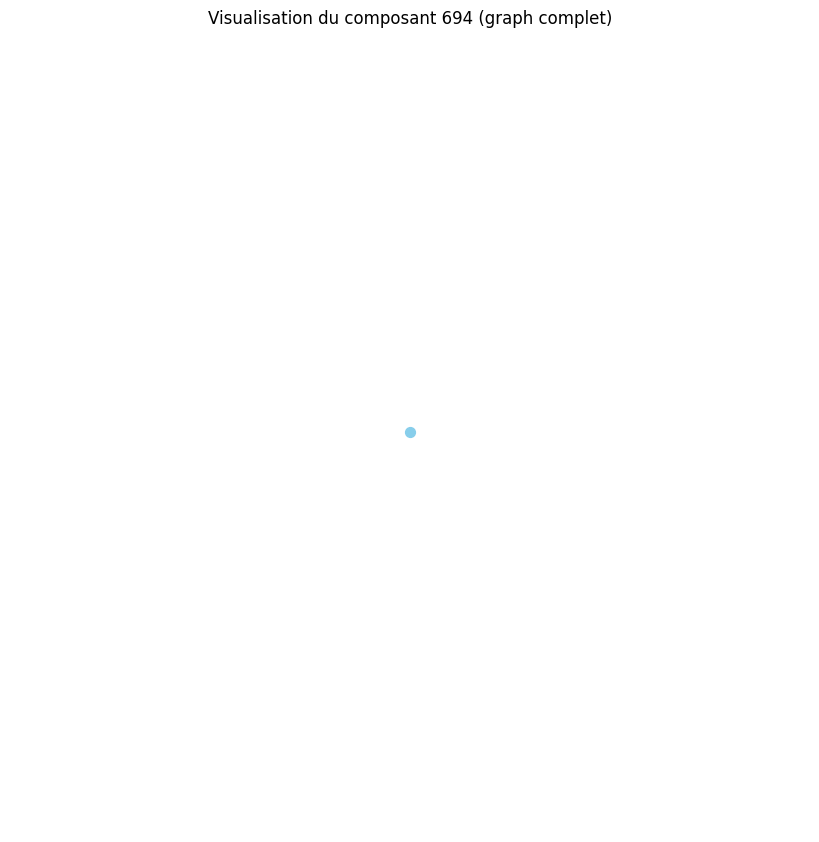

Distance moyenne pour le composant 695 : 0.00
Le composant 695 est un graphe complet ou très densément connecté.
Densité du composant 695 : 0.00
Degré moyen du composant 695 : 0.00
Coefficient de clustering moyen du composant 695 : 0.00


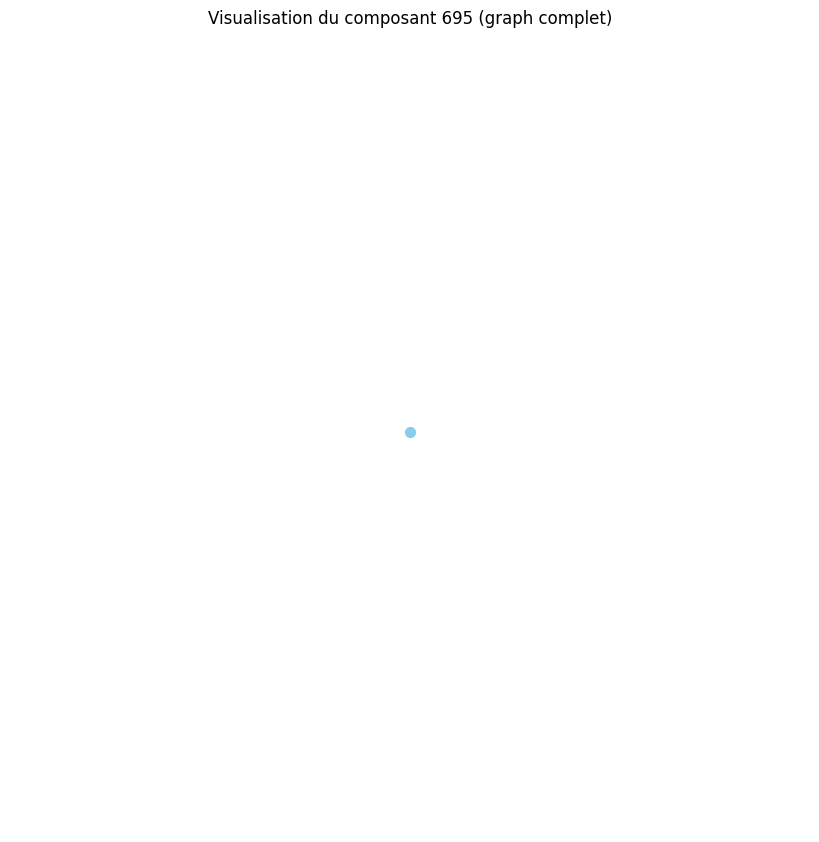

Distance moyenne pour le composant 696 : 0.00
Le composant 696 est un graphe complet ou très densément connecté.
Densité du composant 696 : 0.00
Degré moyen du composant 696 : 0.00
Coefficient de clustering moyen du composant 696 : 0.00


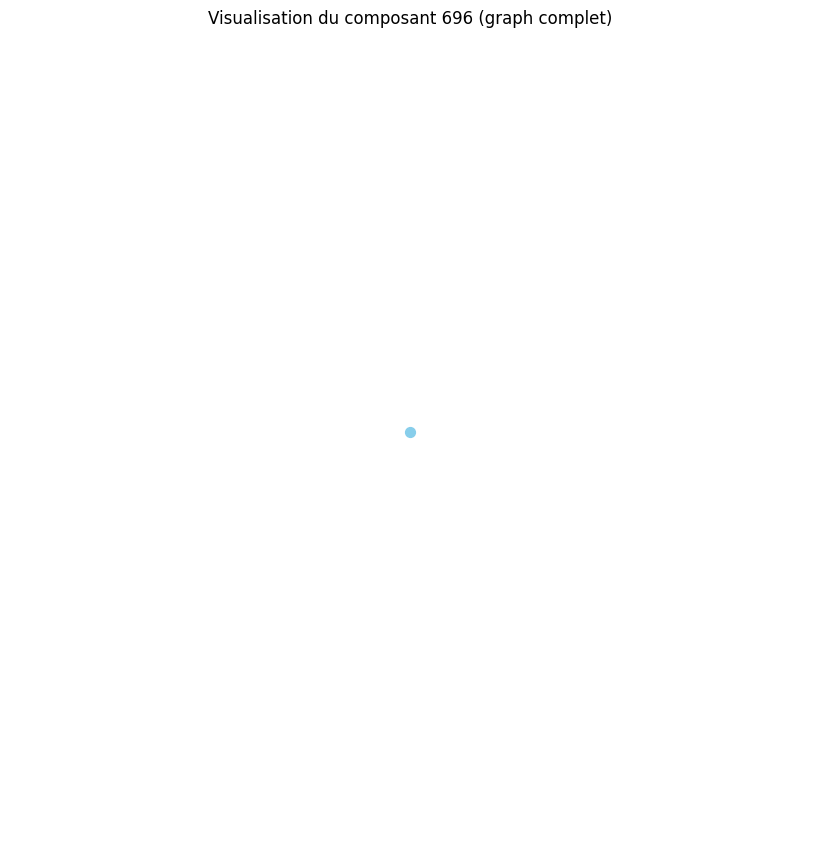

Distance moyenne pour le composant 697 : 0.00
Le composant 697 est un graphe complet ou très densément connecté.
Densité du composant 697 : 0.00
Degré moyen du composant 697 : 0.00
Coefficient de clustering moyen du composant 697 : 0.00


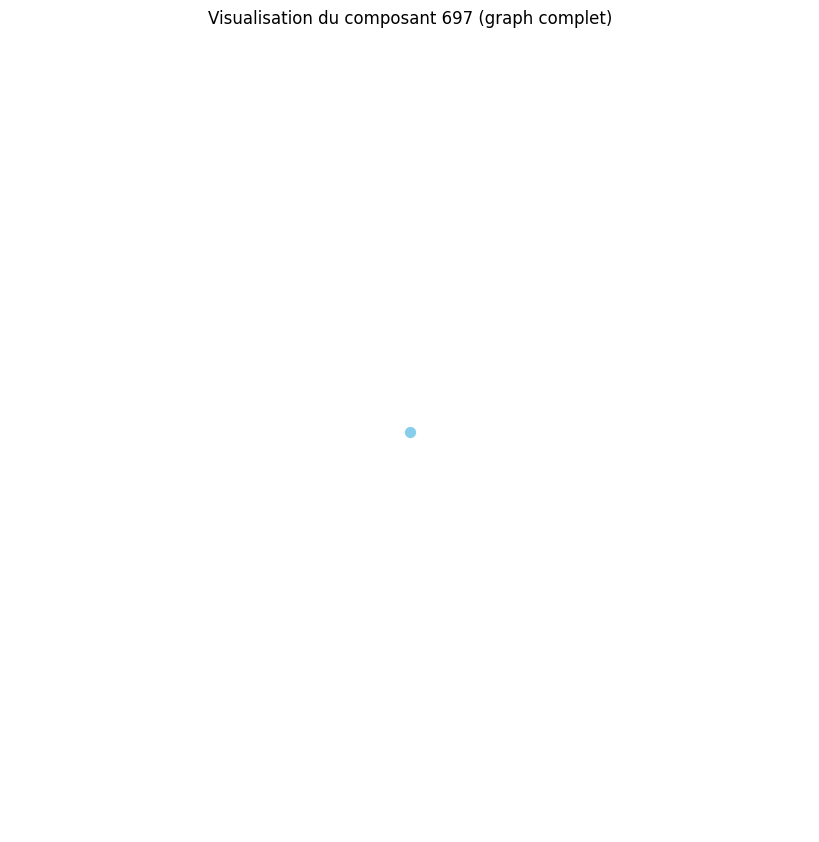

Distance moyenne pour le composant 698 : 0.00
Le composant 698 est un graphe complet ou très densément connecté.
Densité du composant 698 : 0.00
Degré moyen du composant 698 : 0.00
Coefficient de clustering moyen du composant 698 : 0.00


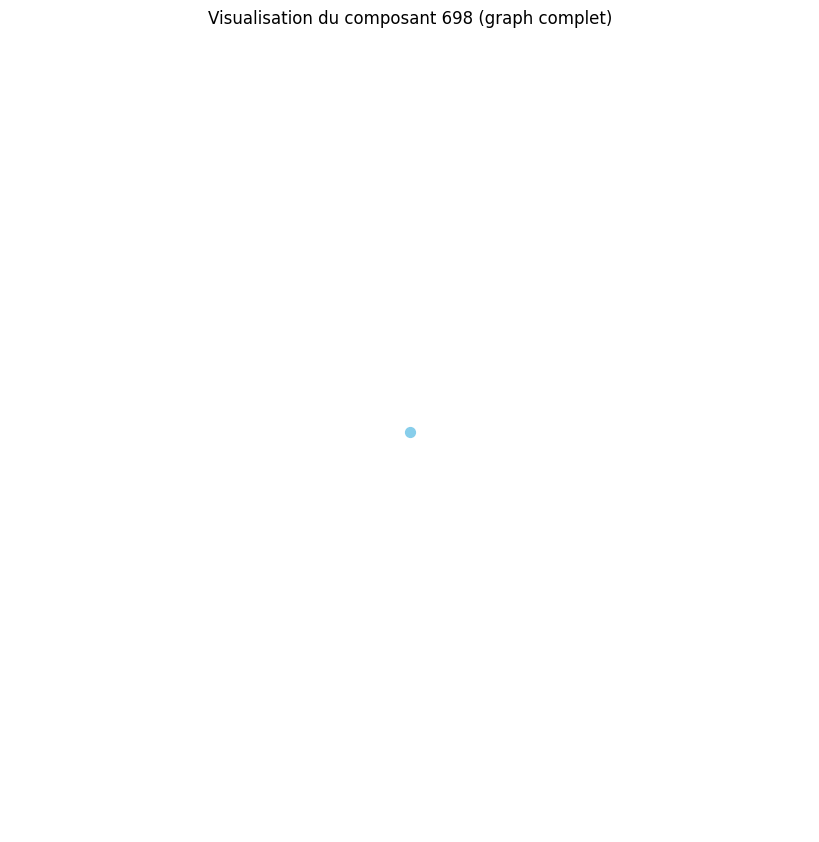

Distance moyenne pour le composant 699 : 0.00
Le composant 699 est un graphe complet ou très densément connecté.
Densité du composant 699 : 0.00
Degré moyen du composant 699 : 0.00
Coefficient de clustering moyen du composant 699 : 0.00


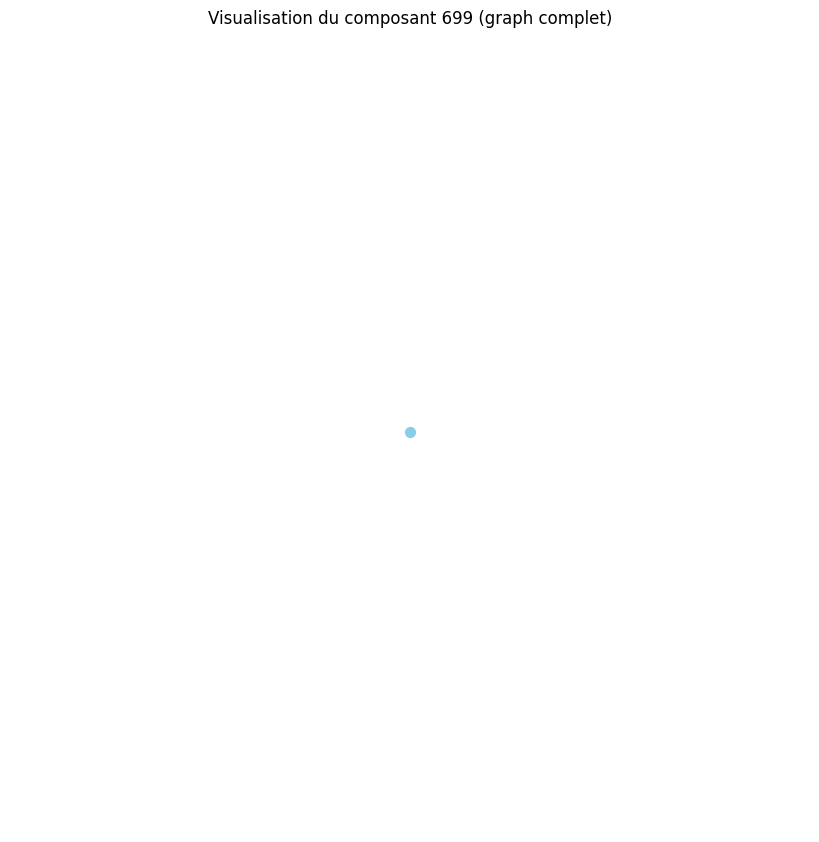

Distance moyenne pour le composant 700 : 1.00
Distance moyenne pour le composant 701 : 0.00
Le composant 701 est un graphe complet ou très densément connecté.
Densité du composant 701 : 0.00
Degré moyen du composant 701 : 0.00
Coefficient de clustering moyen du composant 701 : 0.00


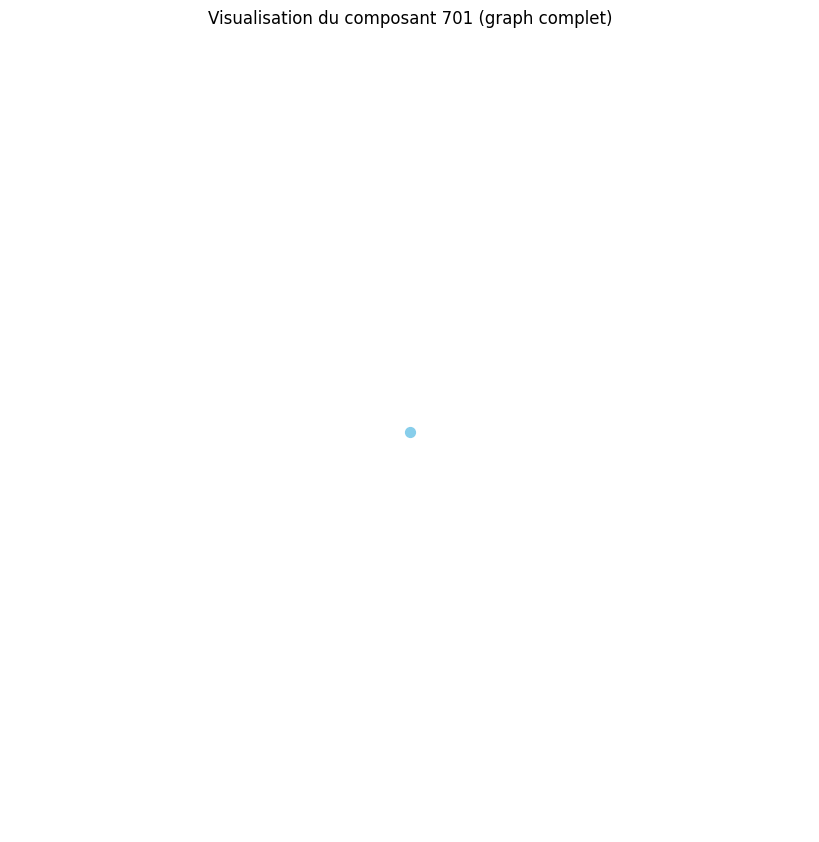

Distance moyenne pour le composant 702 : 0.00
Le composant 702 est un graphe complet ou très densément connecté.
Densité du composant 702 : 0.00
Degré moyen du composant 702 : 0.00
Coefficient de clustering moyen du composant 702 : 0.00


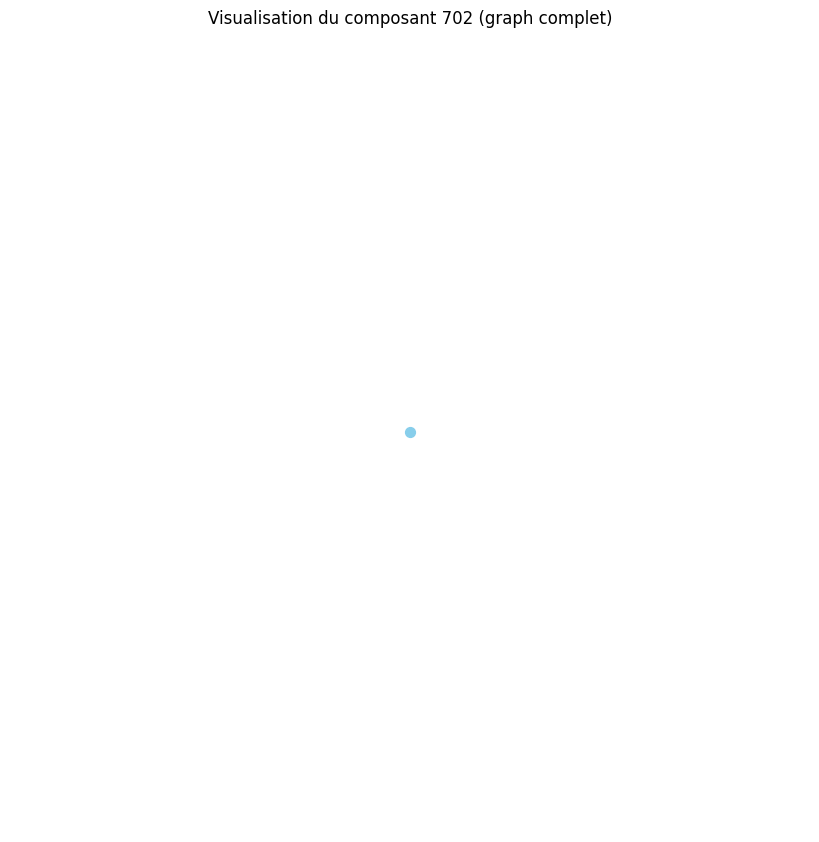

Distance moyenne pour le composant 703 : 0.00
Le composant 703 est un graphe complet ou très densément connecté.
Densité du composant 703 : 0.00
Degré moyen du composant 703 : 0.00
Coefficient de clustering moyen du composant 703 : 0.00


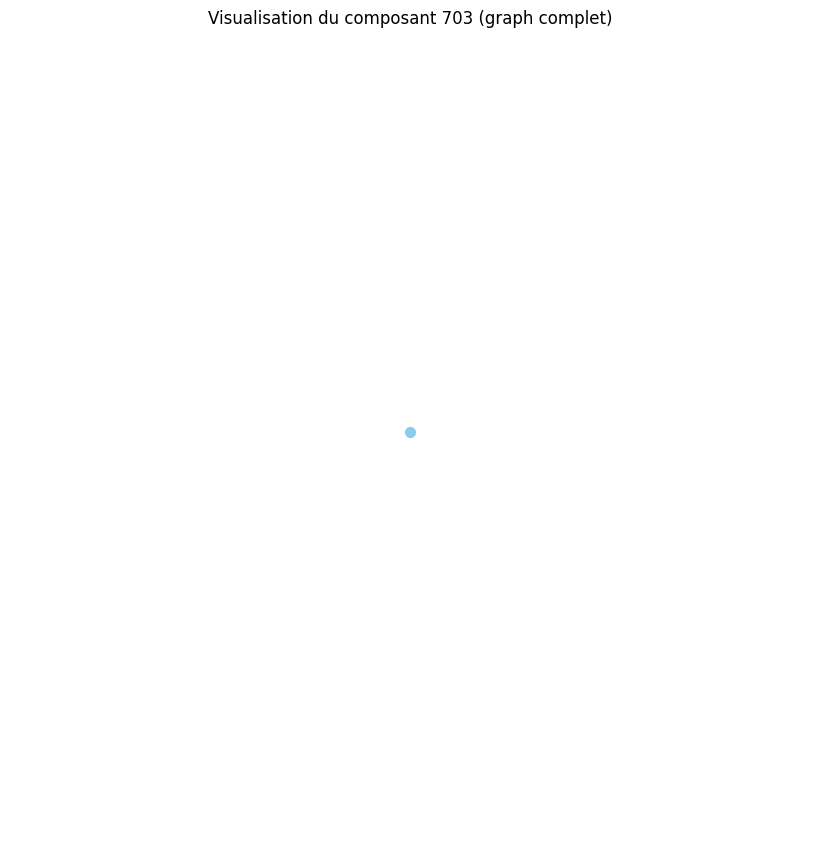

Distance moyenne pour le composant 704 : 0.00
Le composant 704 est un graphe complet ou très densément connecté.
Densité du composant 704 : 0.00
Degré moyen du composant 704 : 0.00
Coefficient de clustering moyen du composant 704 : 0.00


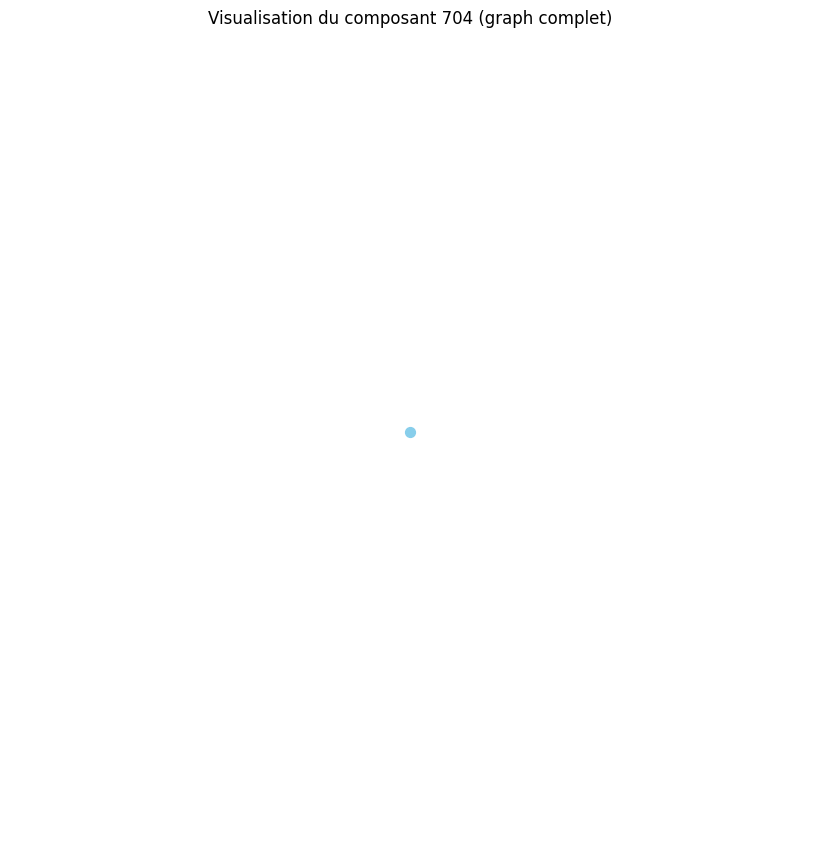

Distance moyenne pour le composant 705 : 0.00
Le composant 705 est un graphe complet ou très densément connecté.
Densité du composant 705 : 0.00
Degré moyen du composant 705 : 0.00
Coefficient de clustering moyen du composant 705 : 0.00


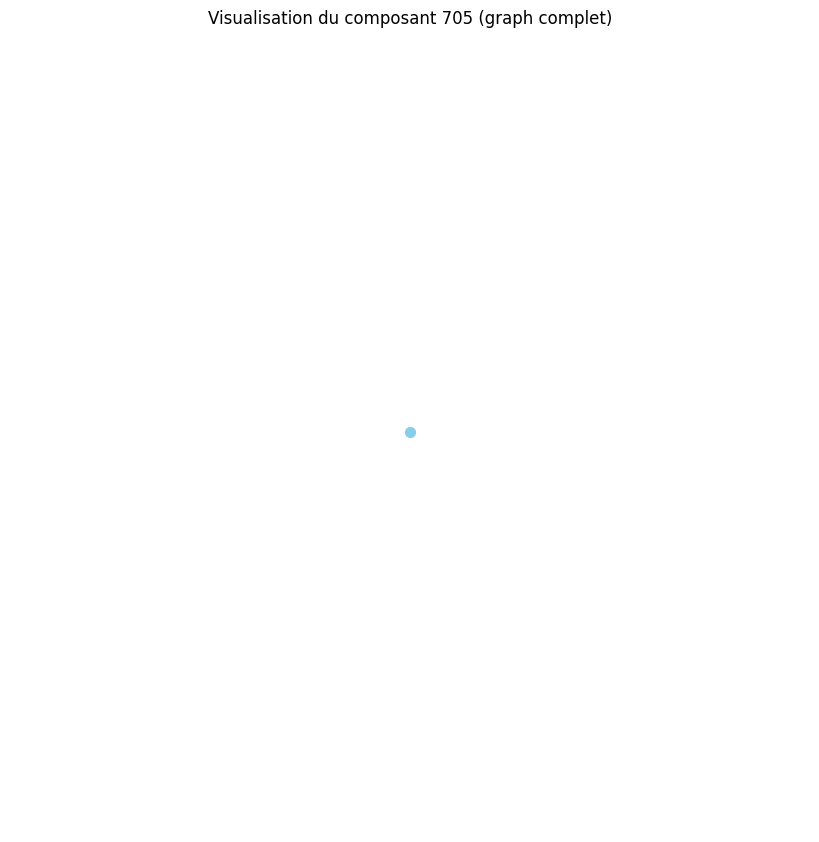

Distance moyenne pour le composant 706 : 0.00
Le composant 706 est un graphe complet ou très densément connecté.
Densité du composant 706 : 0.00
Degré moyen du composant 706 : 0.00
Coefficient de clustering moyen du composant 706 : 0.00


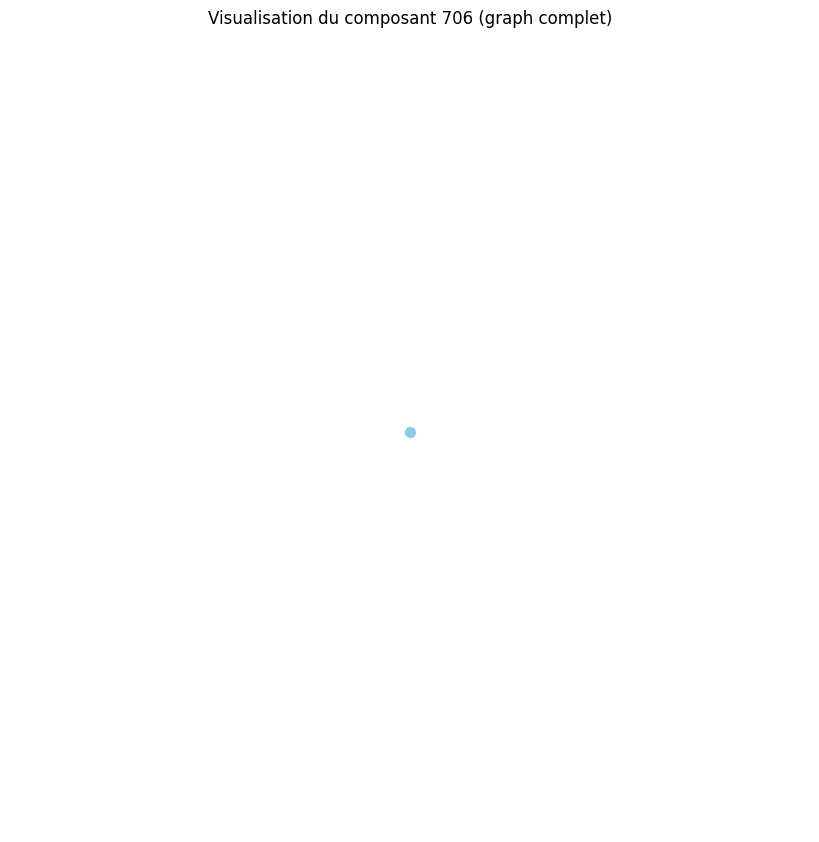

Distance moyenne pour le composant 707 : 0.00
Le composant 707 est un graphe complet ou très densément connecté.
Densité du composant 707 : 0.00
Degré moyen du composant 707 : 0.00
Coefficient de clustering moyen du composant 707 : 0.00


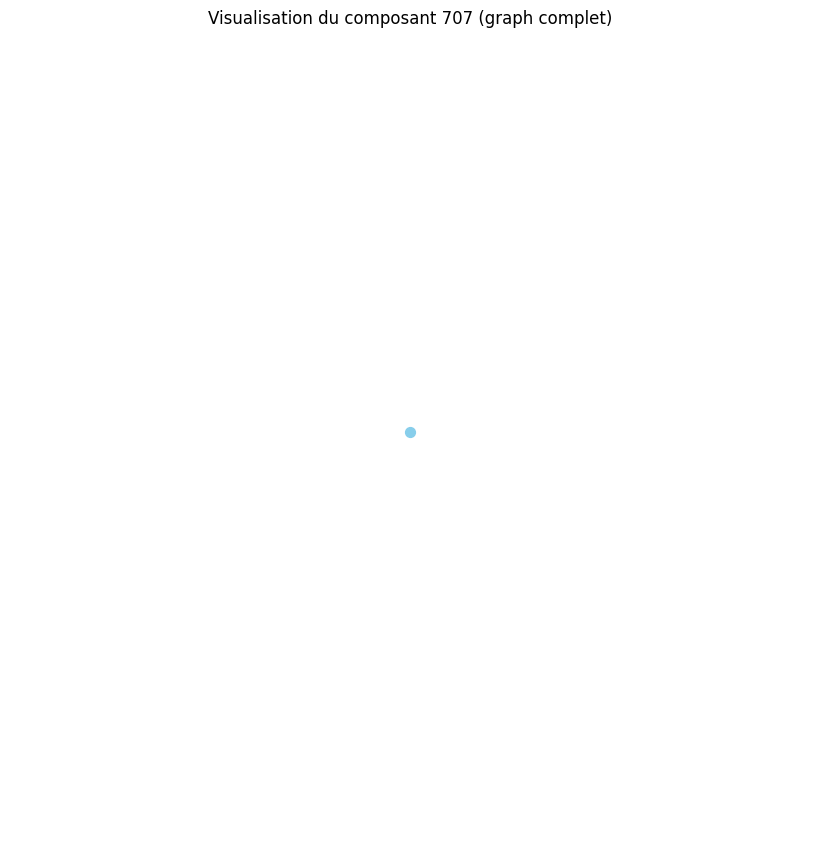

Distance moyenne pour le composant 708 : 0.00
Le composant 708 est un graphe complet ou très densément connecté.
Densité du composant 708 : 0.00
Degré moyen du composant 708 : 0.00
Coefficient de clustering moyen du composant 708 : 0.00


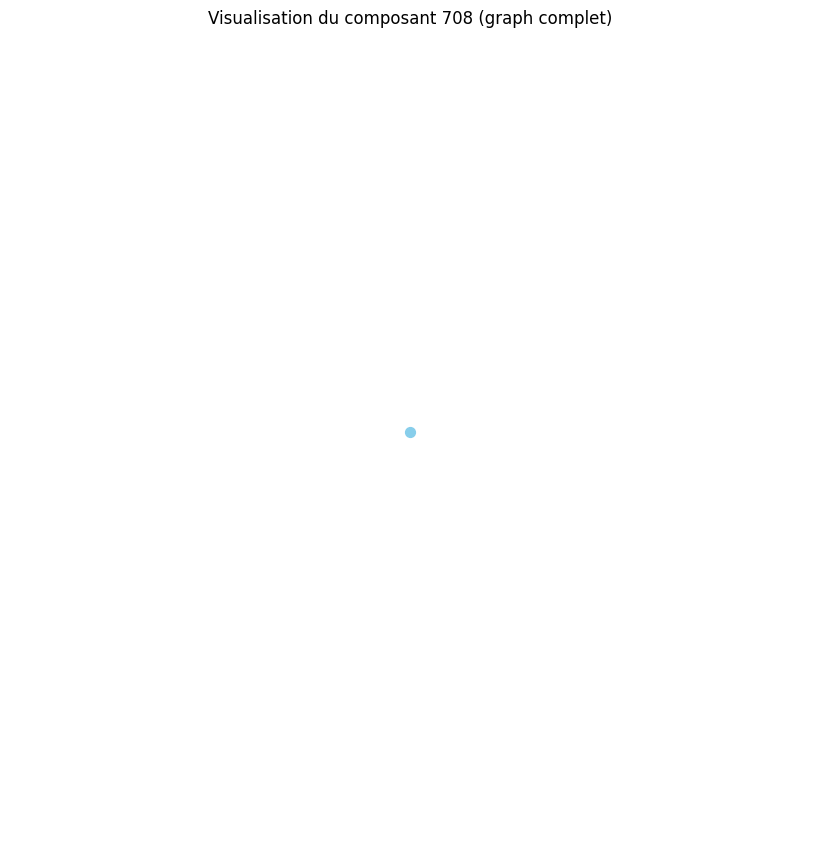

Distance moyenne pour le composant 709 : 0.00
Le composant 709 est un graphe complet ou très densément connecté.
Densité du composant 709 : 0.00
Degré moyen du composant 709 : 0.00
Coefficient de clustering moyen du composant 709 : 0.00


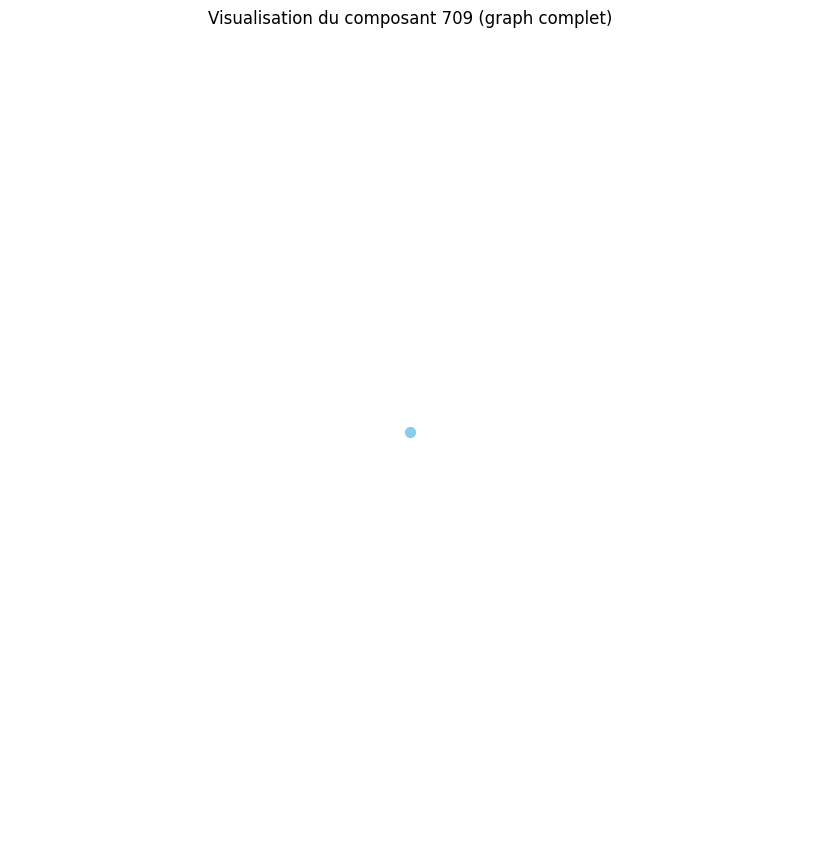

Distance moyenne pour le composant 710 : 0.00
Le composant 710 est un graphe complet ou très densément connecté.
Densité du composant 710 : 0.00
Degré moyen du composant 710 : 0.00
Coefficient de clustering moyen du composant 710 : 0.00


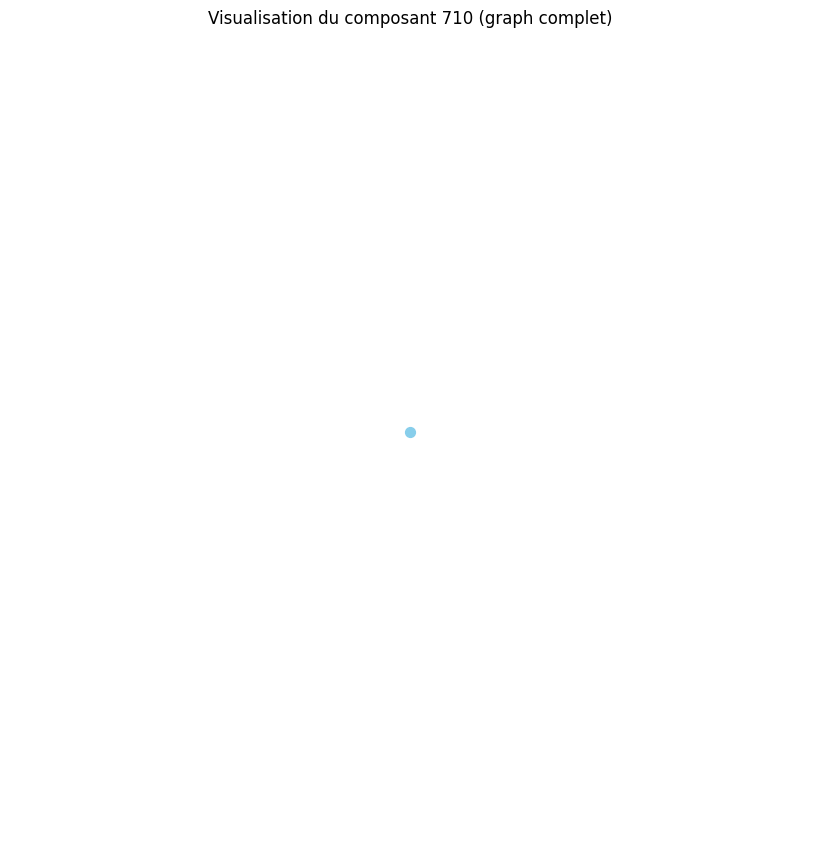

Distance moyenne pour le composant 711 : 0.00
Le composant 711 est un graphe complet ou très densément connecté.
Densité du composant 711 : 0.00
Degré moyen du composant 711 : 0.00
Coefficient de clustering moyen du composant 711 : 0.00


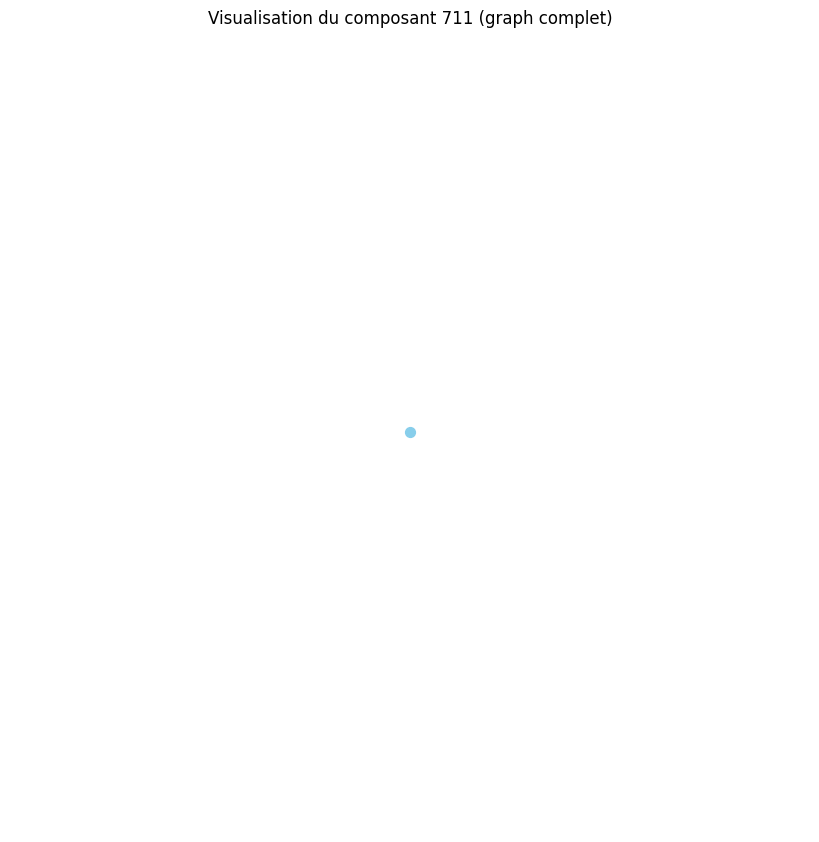

Distance moyenne pour le composant 712 : 0.00
Le composant 712 est un graphe complet ou très densément connecté.
Densité du composant 712 : 0.00
Degré moyen du composant 712 : 0.00
Coefficient de clustering moyen du composant 712 : 0.00


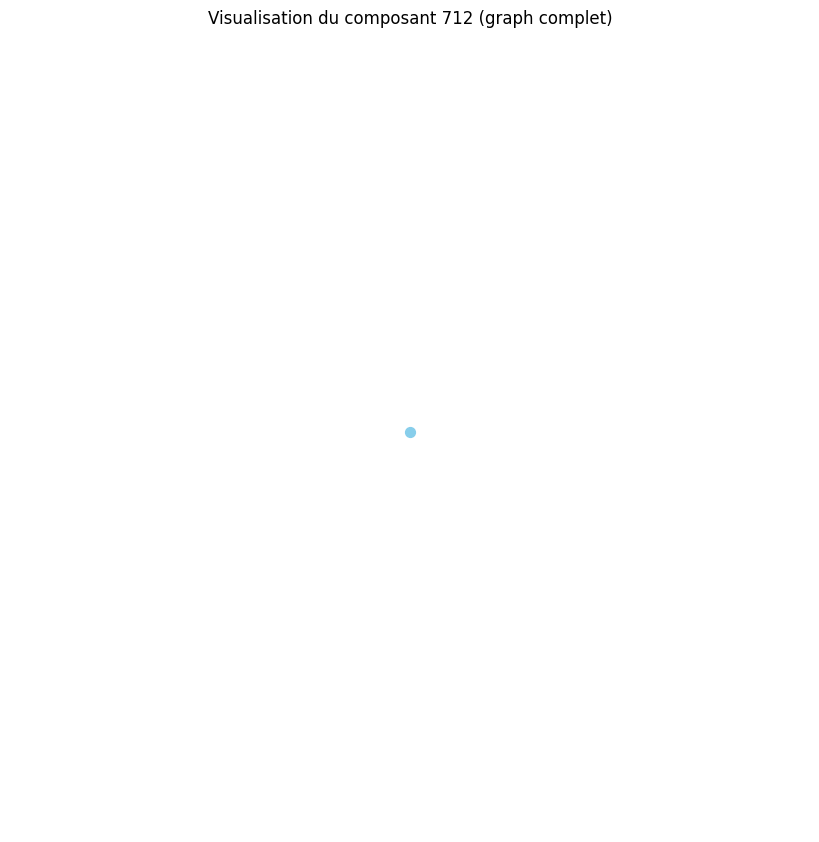

Distance moyenne pour le composant 713 : 0.00
Le composant 713 est un graphe complet ou très densément connecté.
Densité du composant 713 : 0.00
Degré moyen du composant 713 : 0.00
Coefficient de clustering moyen du composant 713 : 0.00


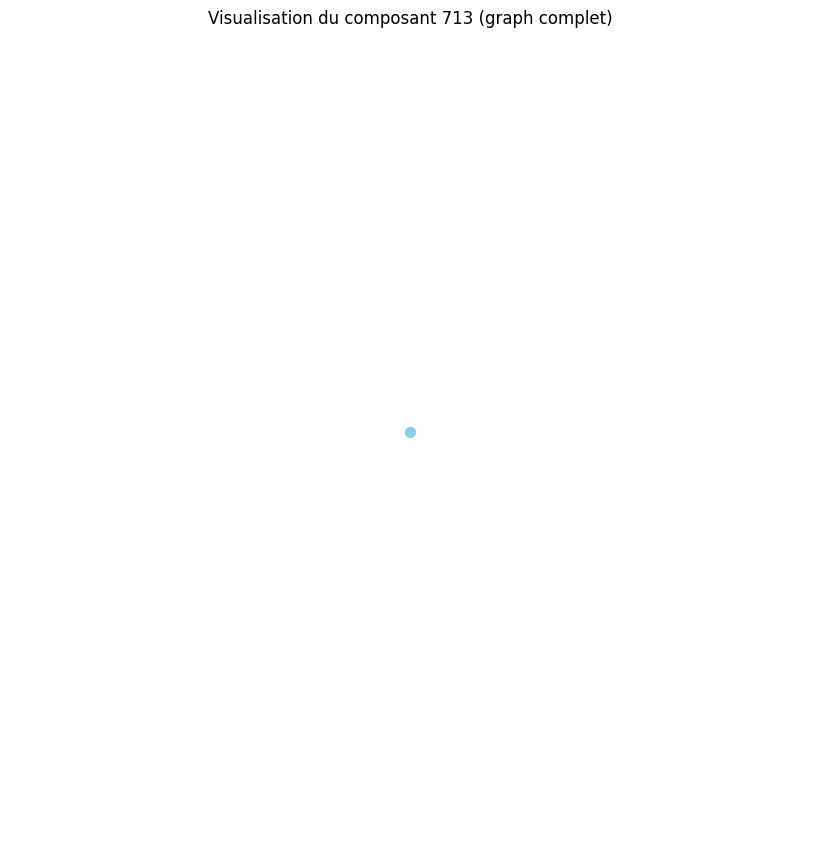

Distance moyenne pour le composant 714 : 0.00
Le composant 714 est un graphe complet ou très densément connecté.
Densité du composant 714 : 0.00
Degré moyen du composant 714 : 0.00
Coefficient de clustering moyen du composant 714 : 0.00


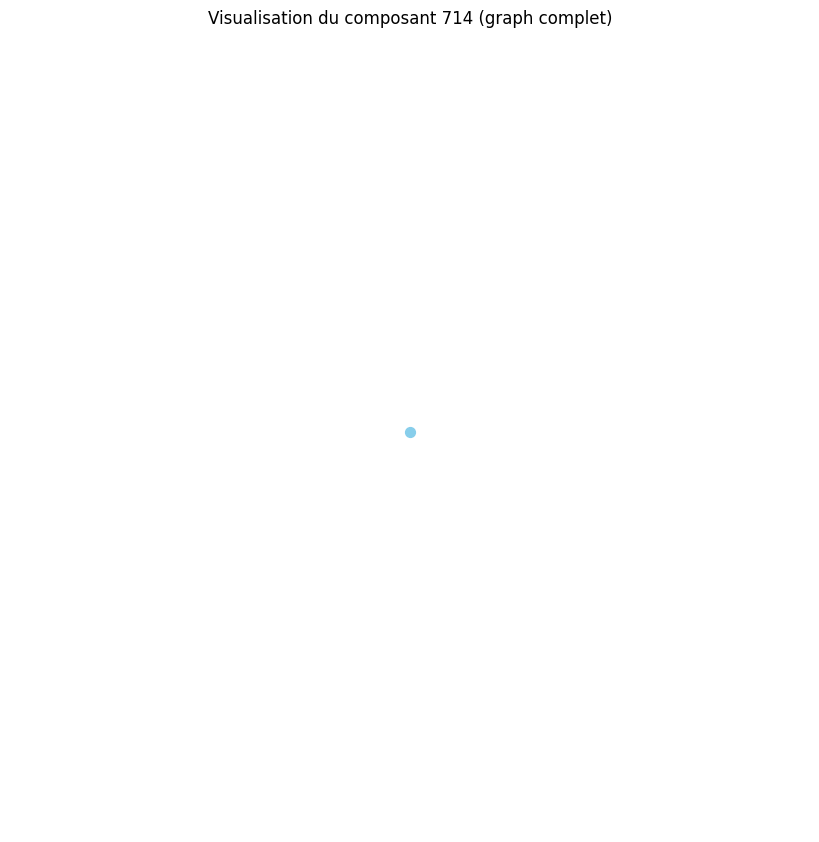

Distance moyenne pour le composant 715 : 0.00
Le composant 715 est un graphe complet ou très densément connecté.
Densité du composant 715 : 0.00
Degré moyen du composant 715 : 0.00
Coefficient de clustering moyen du composant 715 : 0.00


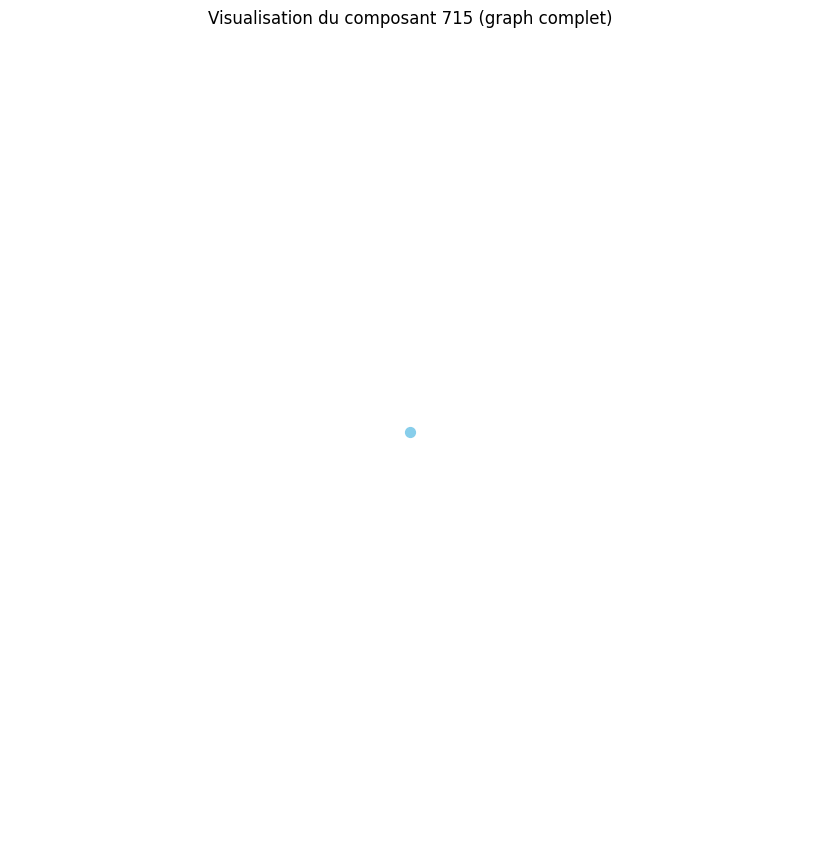

Distance moyenne pour le composant 716 : 0.00
Le composant 716 est un graphe complet ou très densément connecté.
Densité du composant 716 : 0.00
Degré moyen du composant 716 : 0.00
Coefficient de clustering moyen du composant 716 : 0.00


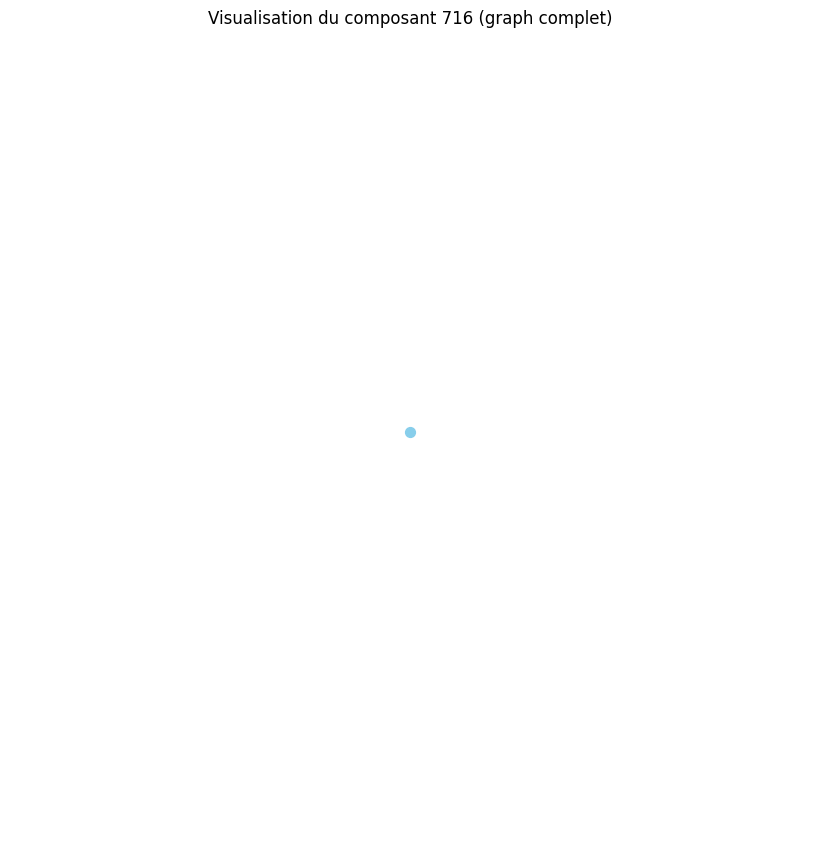

Distance moyenne pour le composant 717 : 0.00
Le composant 717 est un graphe complet ou très densément connecté.
Densité du composant 717 : 0.00
Degré moyen du composant 717 : 0.00
Coefficient de clustering moyen du composant 717 : 0.00


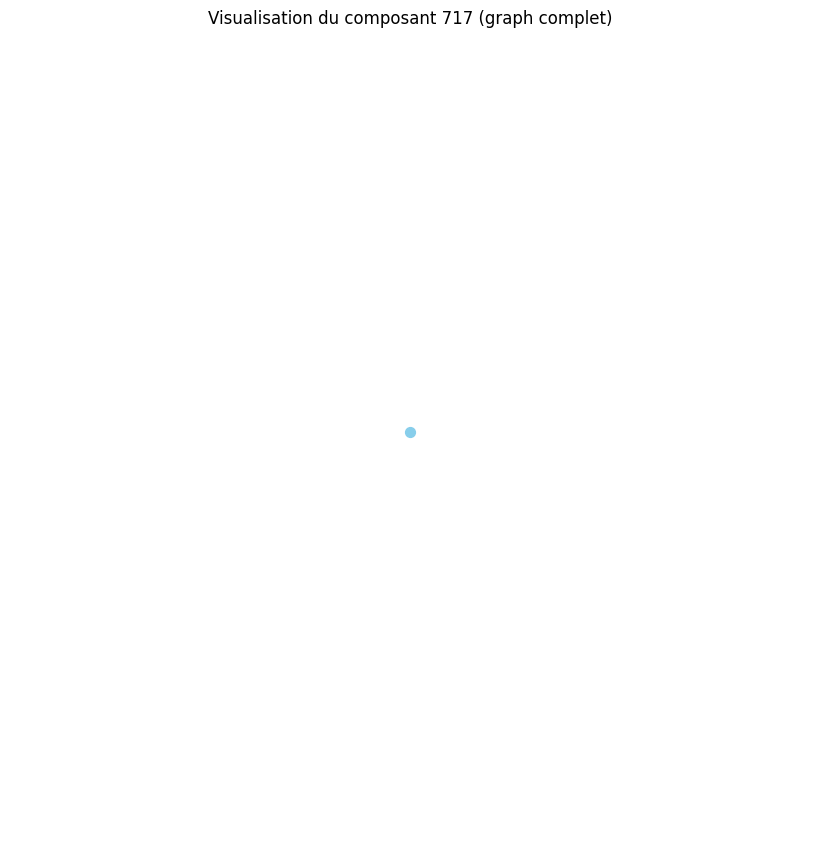

Distance moyenne pour le composant 718 : 0.00
Le composant 718 est un graphe complet ou très densément connecté.
Densité du composant 718 : 0.00
Degré moyen du composant 718 : 0.00
Coefficient de clustering moyen du composant 718 : 0.00


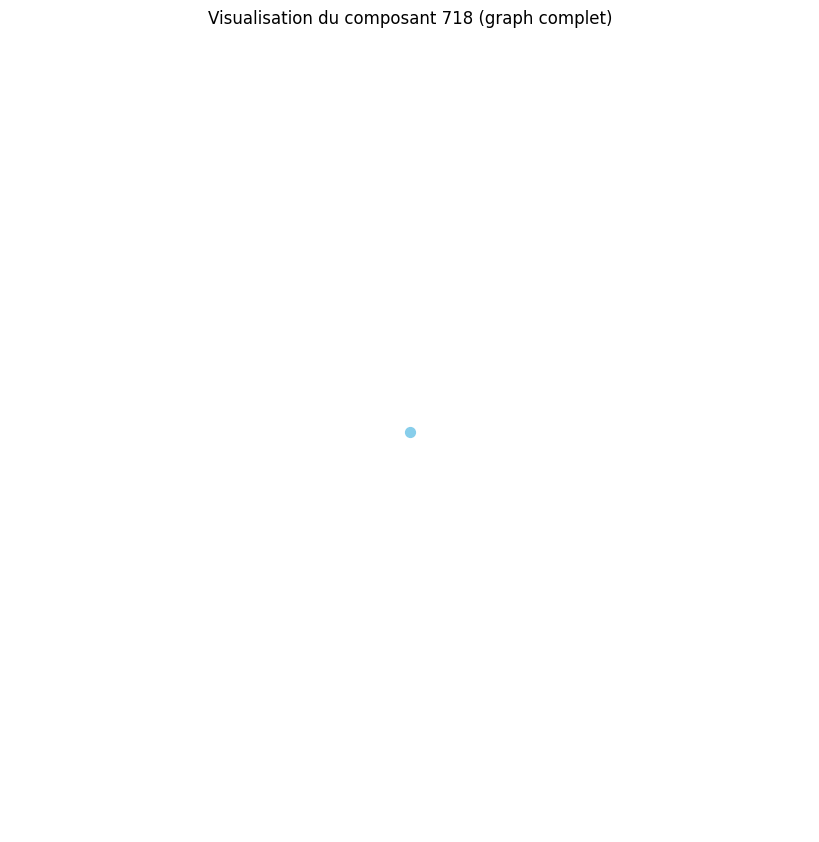

Distance moyenne pour le composant 719 : 0.00
Le composant 719 est un graphe complet ou très densément connecté.
Densité du composant 719 : 0.00
Degré moyen du composant 719 : 0.00
Coefficient de clustering moyen du composant 719 : 0.00


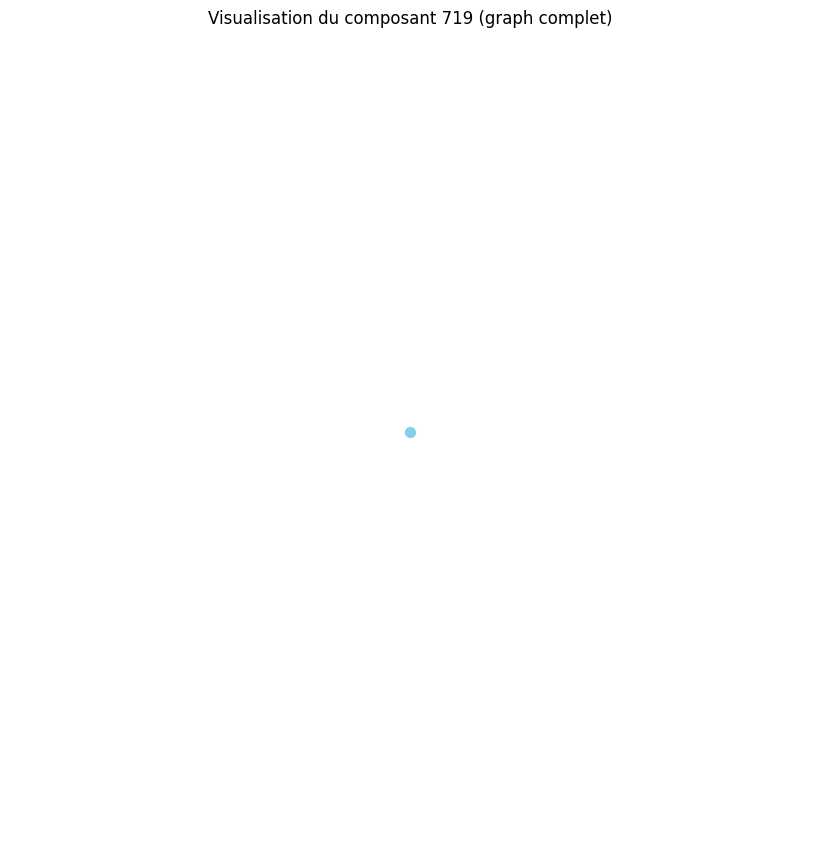

Distance moyenne pour le composant 720 : 0.00
Le composant 720 est un graphe complet ou très densément connecté.
Densité du composant 720 : 0.00
Degré moyen du composant 720 : 0.00
Coefficient de clustering moyen du composant 720 : 0.00


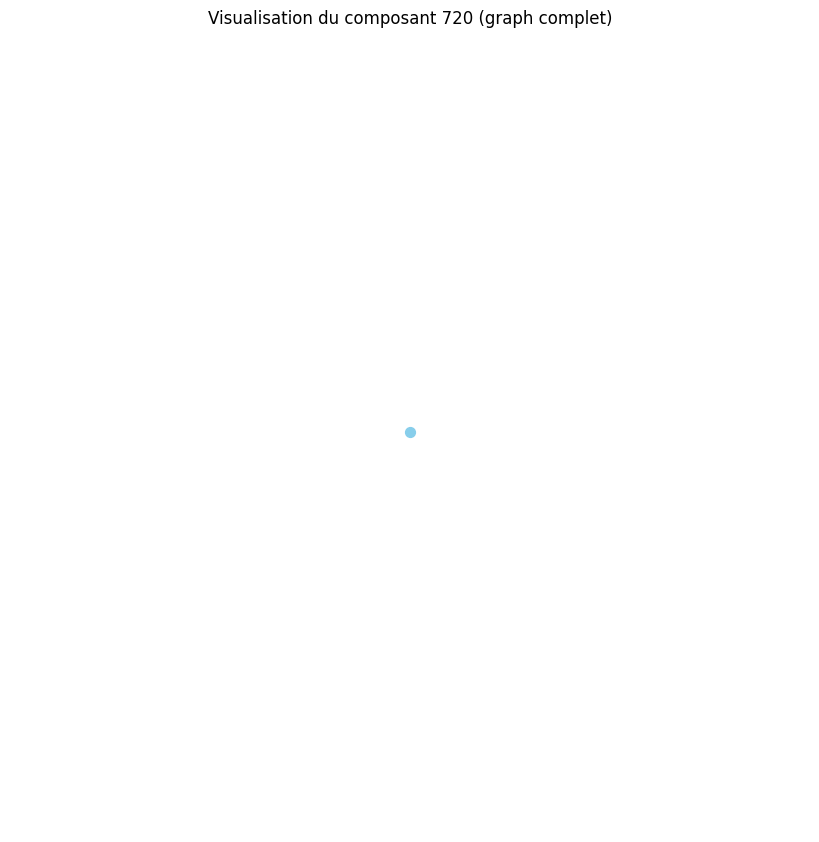

Distance moyenne pour le composant 721 : 0.00
Le composant 721 est un graphe complet ou très densément connecté.
Densité du composant 721 : 0.00
Degré moyen du composant 721 : 0.00
Coefficient de clustering moyen du composant 721 : 0.00


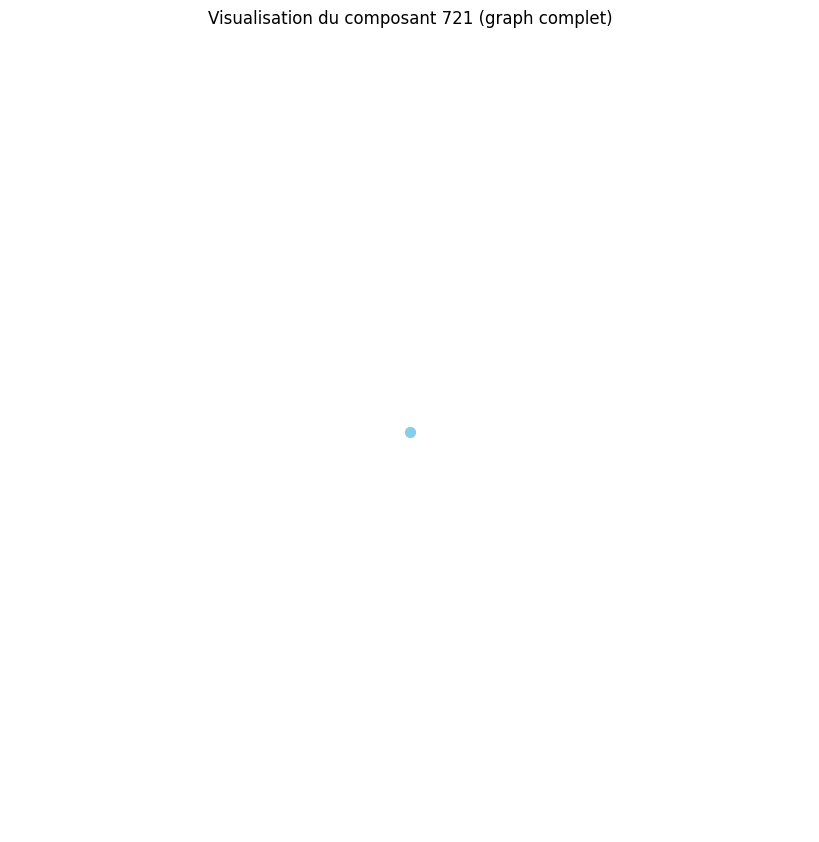

Distance moyenne pour le composant 722 : 0.00
Le composant 722 est un graphe complet ou très densément connecté.
Densité du composant 722 : 0.00
Degré moyen du composant 722 : 0.00
Coefficient de clustering moyen du composant 722 : 0.00


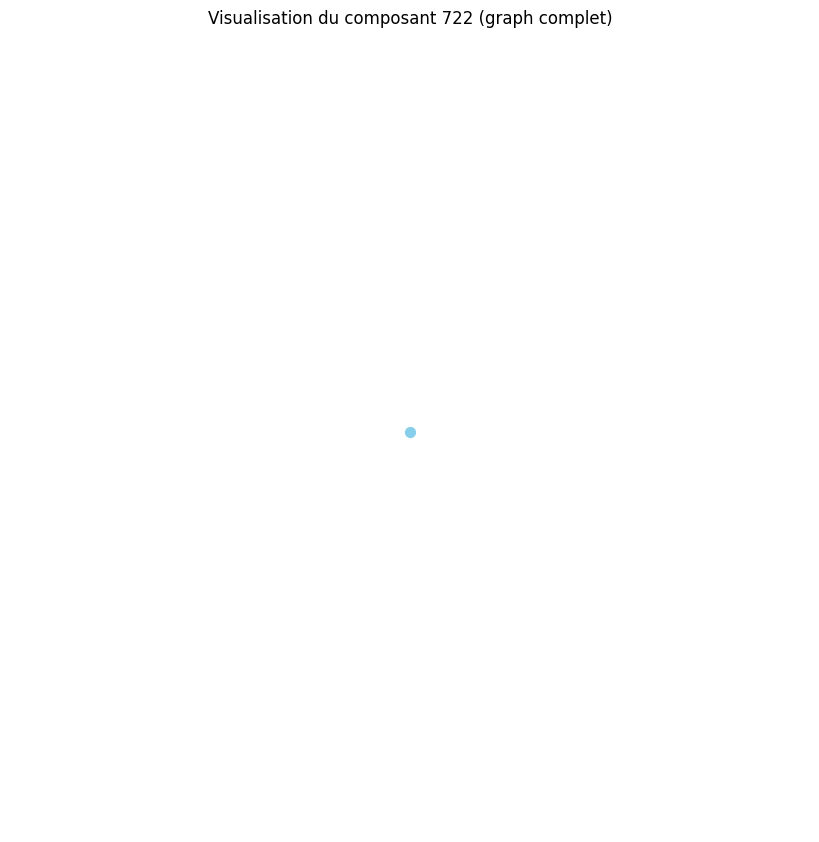

Distance moyenne pour le composant 723 : 0.00
Le composant 723 est un graphe complet ou très densément connecté.
Densité du composant 723 : 0.00
Degré moyen du composant 723 : 0.00
Coefficient de clustering moyen du composant 723 : 0.00


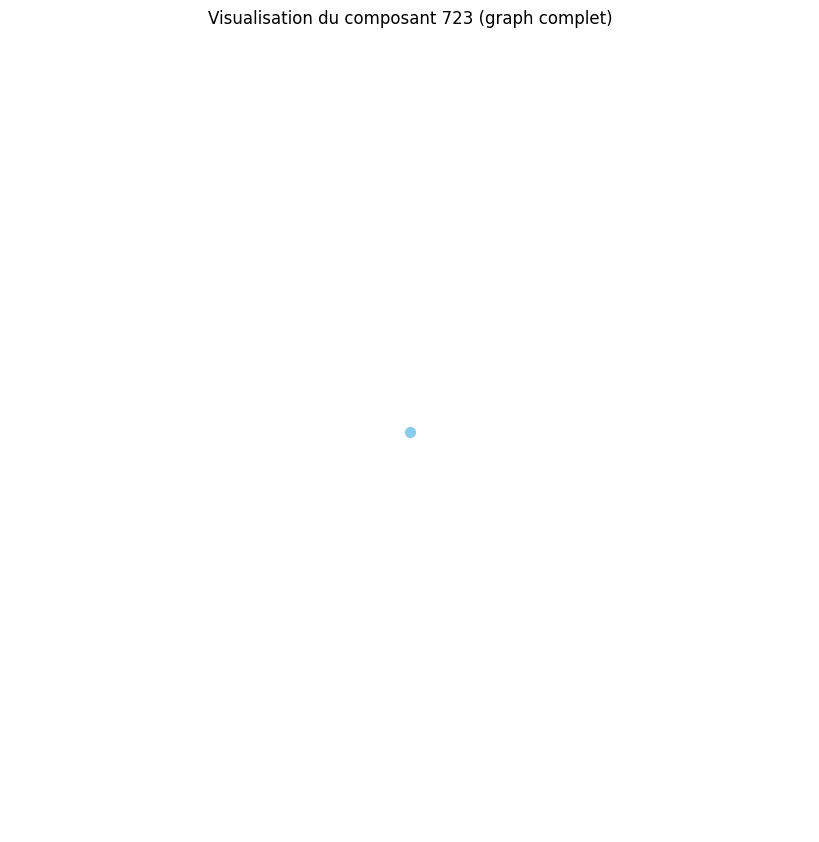

Distance moyenne pour le composant 724 : 0.00
Le composant 724 est un graphe complet ou très densément connecté.
Densité du composant 724 : 0.00
Degré moyen du composant 724 : 0.00
Coefficient de clustering moyen du composant 724 : 0.00


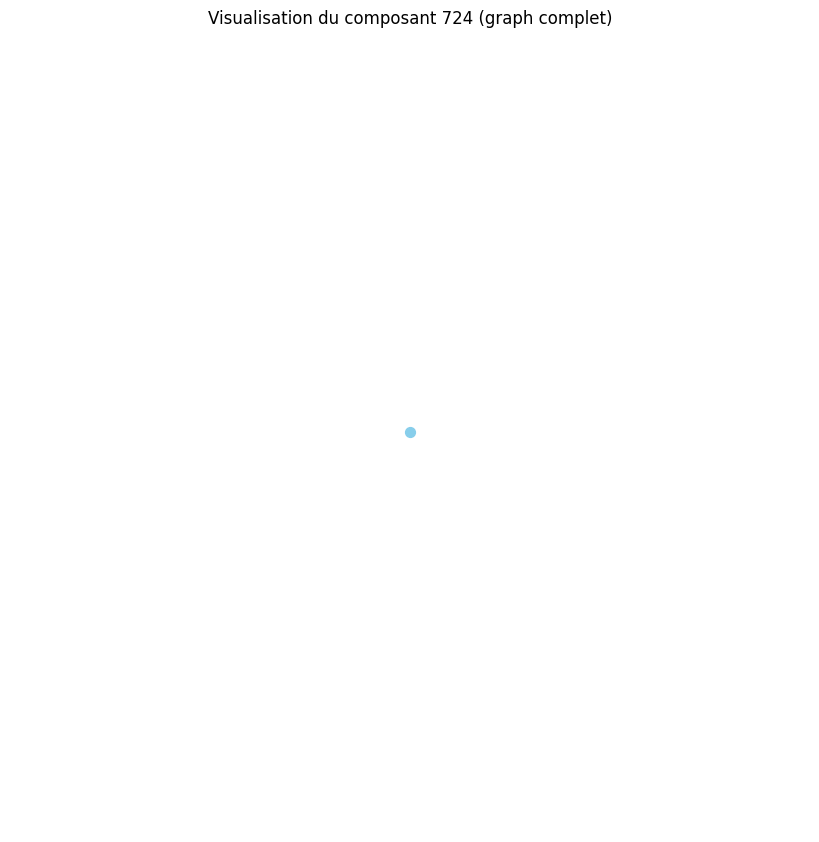

Distance moyenne pour le composant 725 : 1.90
Distance moyenne pour le composant 726 : 0.00
Le composant 726 est un graphe complet ou très densément connecté.
Densité du composant 726 : 0.00
Degré moyen du composant 726 : 0.00
Coefficient de clustering moyen du composant 726 : 0.00


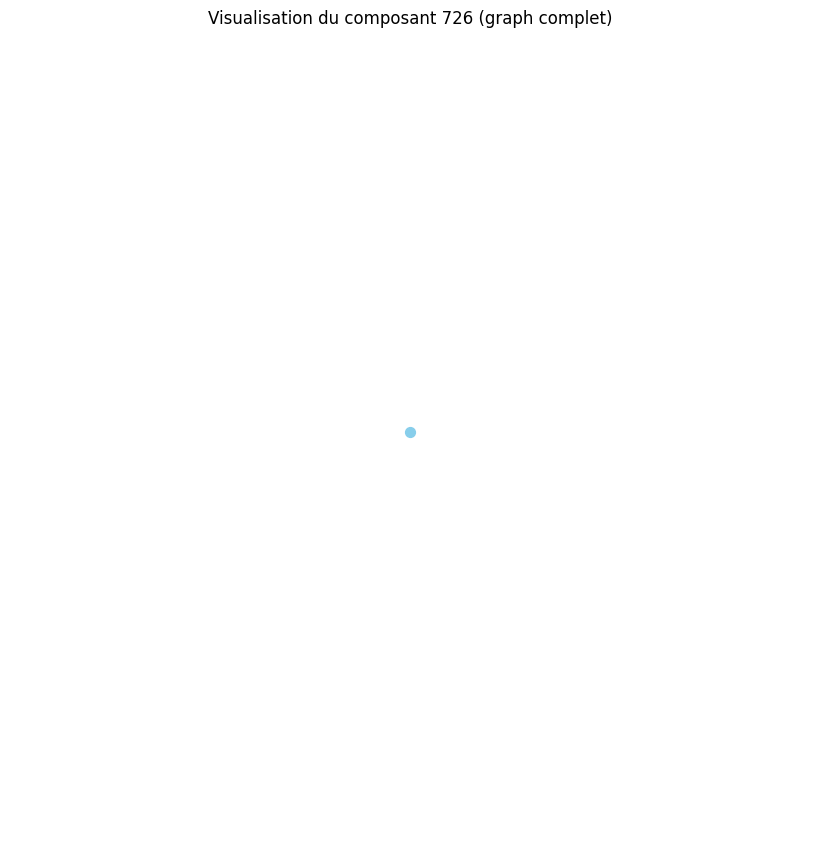

Distance moyenne pour le composant 727 : 0.00
Le composant 727 est un graphe complet ou très densément connecté.
Densité du composant 727 : 0.00
Degré moyen du composant 727 : 0.00
Coefficient de clustering moyen du composant 727 : 0.00


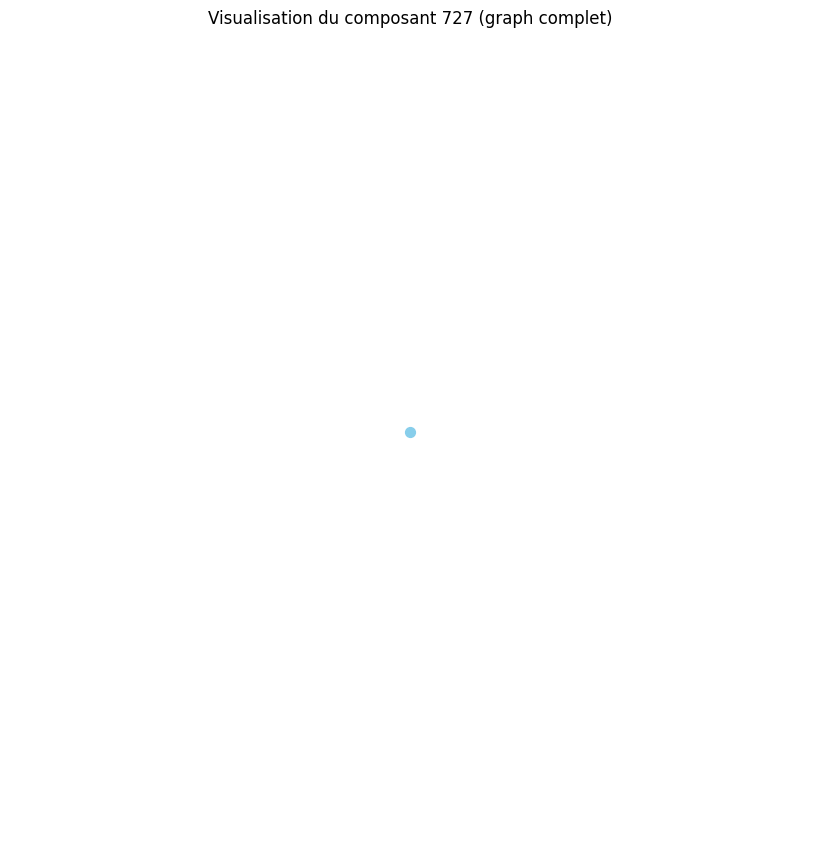

Distance moyenne pour le composant 728 : 0.00
Le composant 728 est un graphe complet ou très densément connecté.
Densité du composant 728 : 0.00
Degré moyen du composant 728 : 0.00
Coefficient de clustering moyen du composant 728 : 0.00


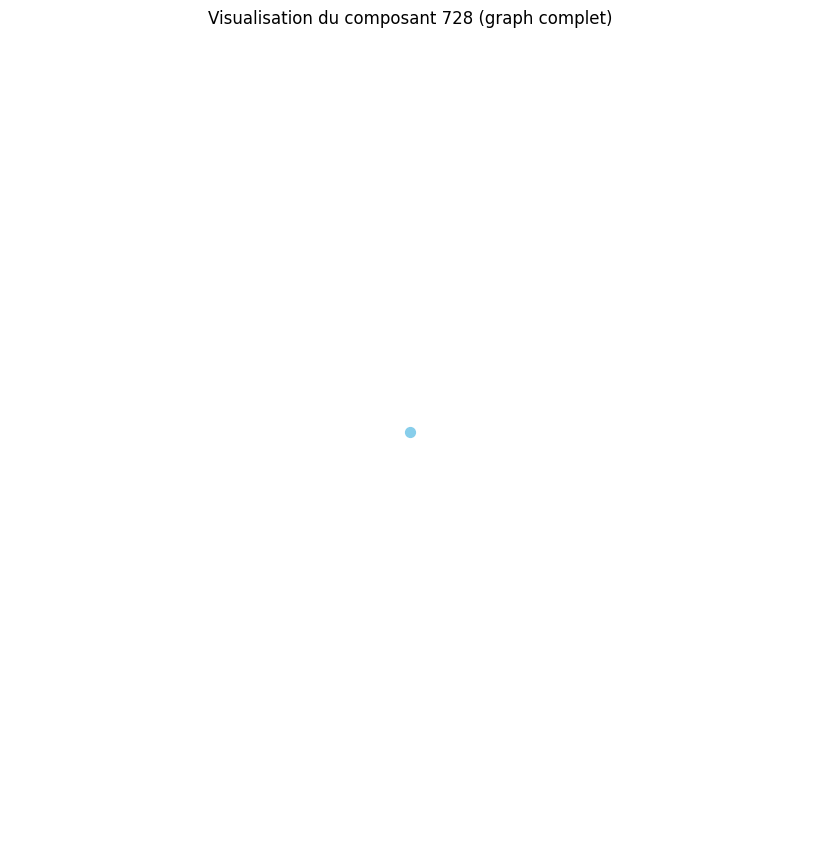

Distance moyenne pour le composant 729 : 0.00
Le composant 729 est un graphe complet ou très densément connecté.
Densité du composant 729 : 0.00
Degré moyen du composant 729 : 0.00
Coefficient de clustering moyen du composant 729 : 0.00


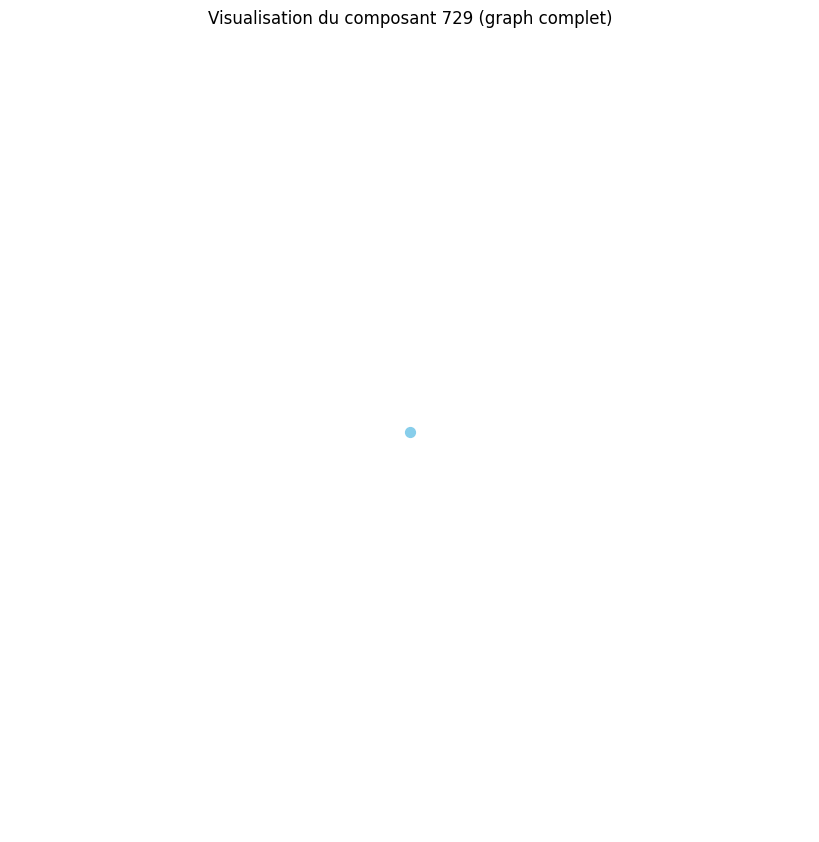

Distance moyenne pour le composant 730 : 0.00
Le composant 730 est un graphe complet ou très densément connecté.
Densité du composant 730 : 0.00
Degré moyen du composant 730 : 0.00
Coefficient de clustering moyen du composant 730 : 0.00


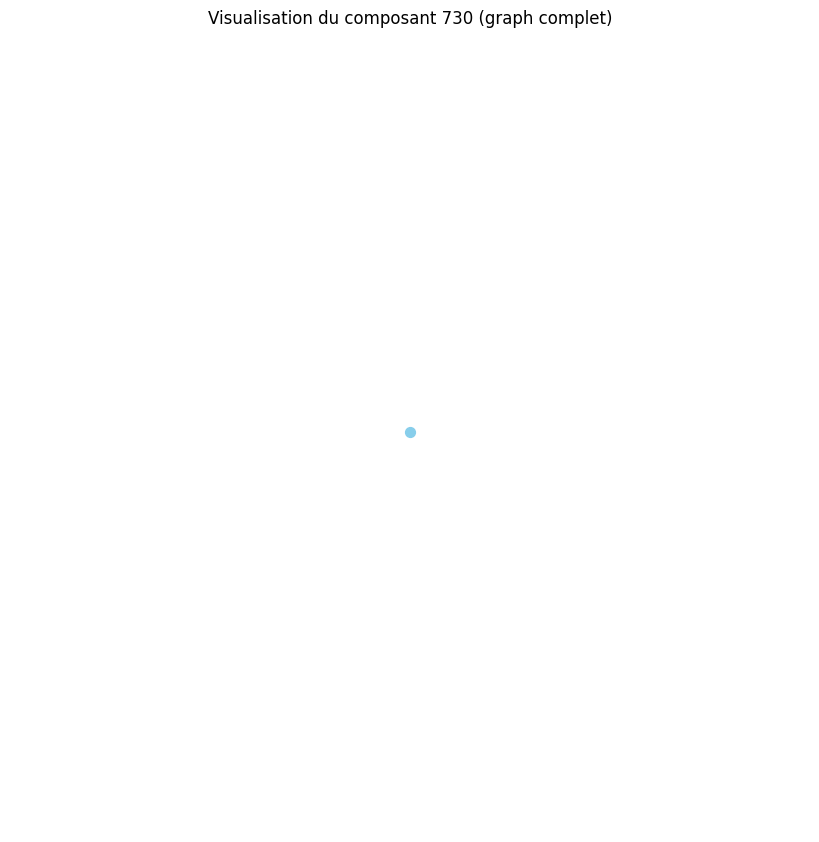

Distance moyenne pour le composant 731 : 0.00
Le composant 731 est un graphe complet ou très densément connecté.
Densité du composant 731 : 0.00
Degré moyen du composant 731 : 0.00
Coefficient de clustering moyen du composant 731 : 0.00


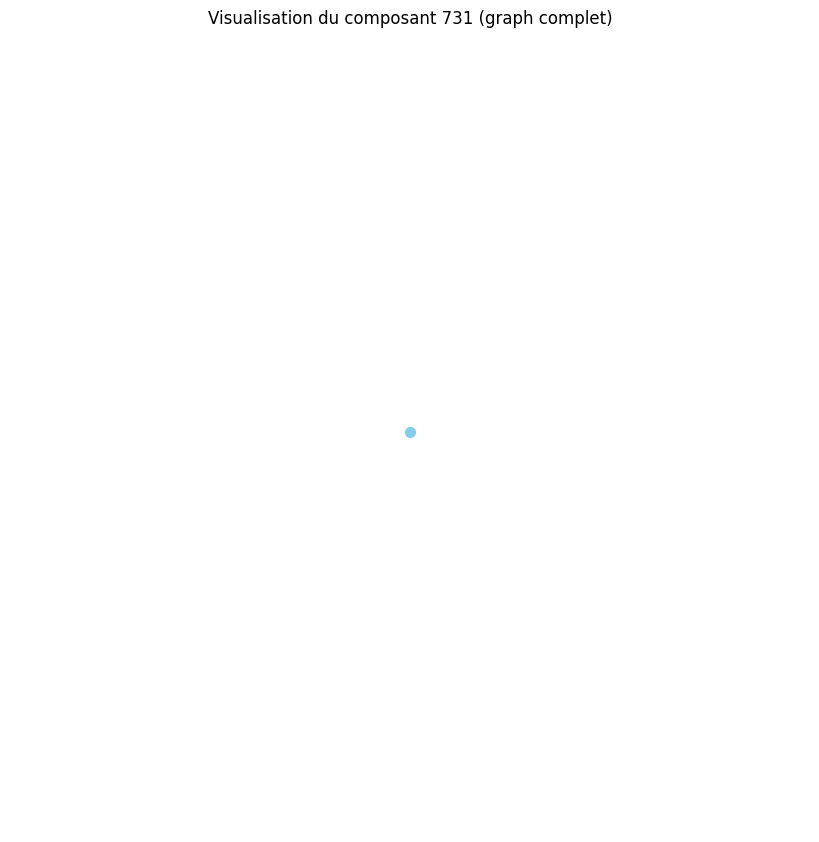

Distance moyenne pour le composant 732 : 0.00
Le composant 732 est un graphe complet ou très densément connecté.
Densité du composant 732 : 0.00
Degré moyen du composant 732 : 0.00
Coefficient de clustering moyen du composant 732 : 0.00


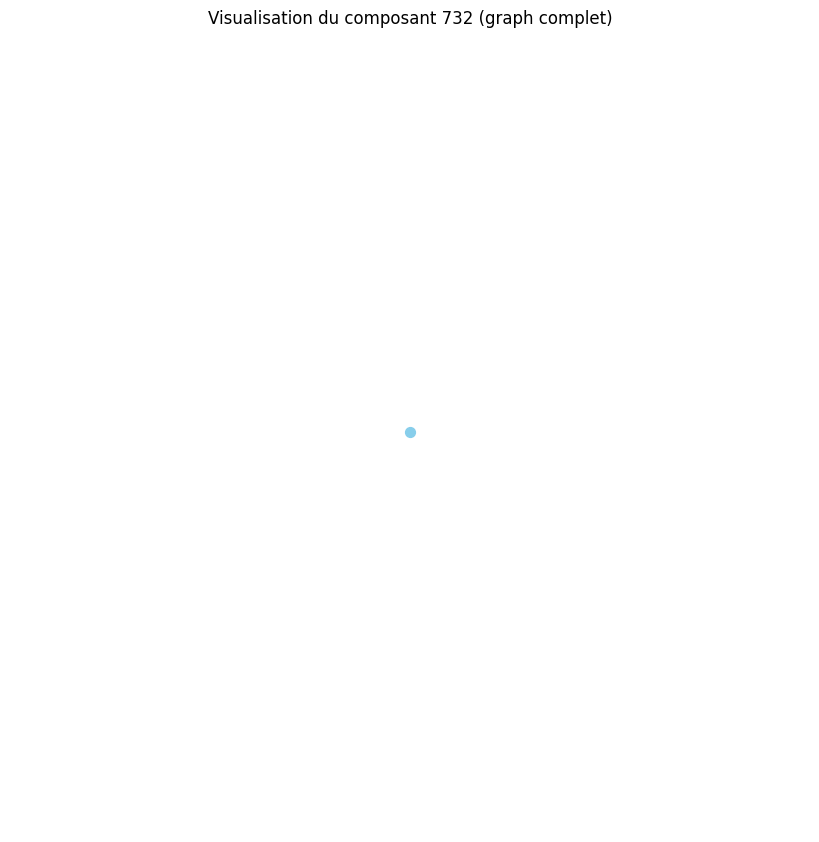

Distance moyenne pour le composant 733 : 0.00
Le composant 733 est un graphe complet ou très densément connecté.
Densité du composant 733 : 0.00
Degré moyen du composant 733 : 0.00
Coefficient de clustering moyen du composant 733 : 0.00


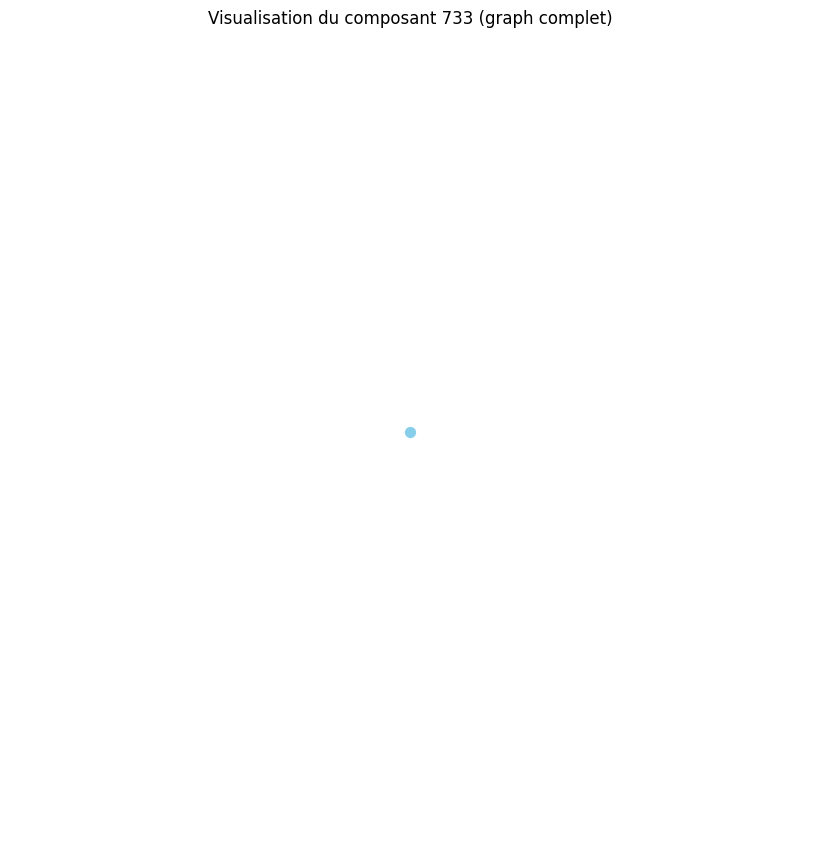

Distance moyenne pour le composant 734 : 0.00
Le composant 734 est un graphe complet ou très densément connecté.
Densité du composant 734 : 0.00
Degré moyen du composant 734 : 0.00
Coefficient de clustering moyen du composant 734 : 0.00


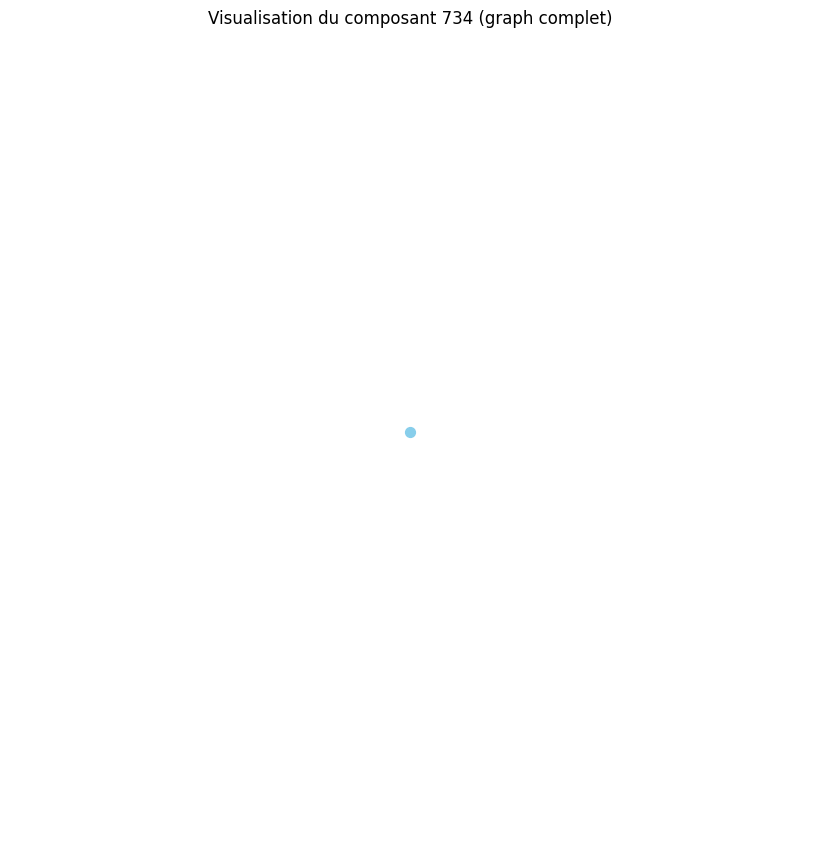

Distance moyenne pour le composant 735 : 0.00
Le composant 735 est un graphe complet ou très densément connecté.
Densité du composant 735 : 0.00
Degré moyen du composant 735 : 0.00
Coefficient de clustering moyen du composant 735 : 0.00


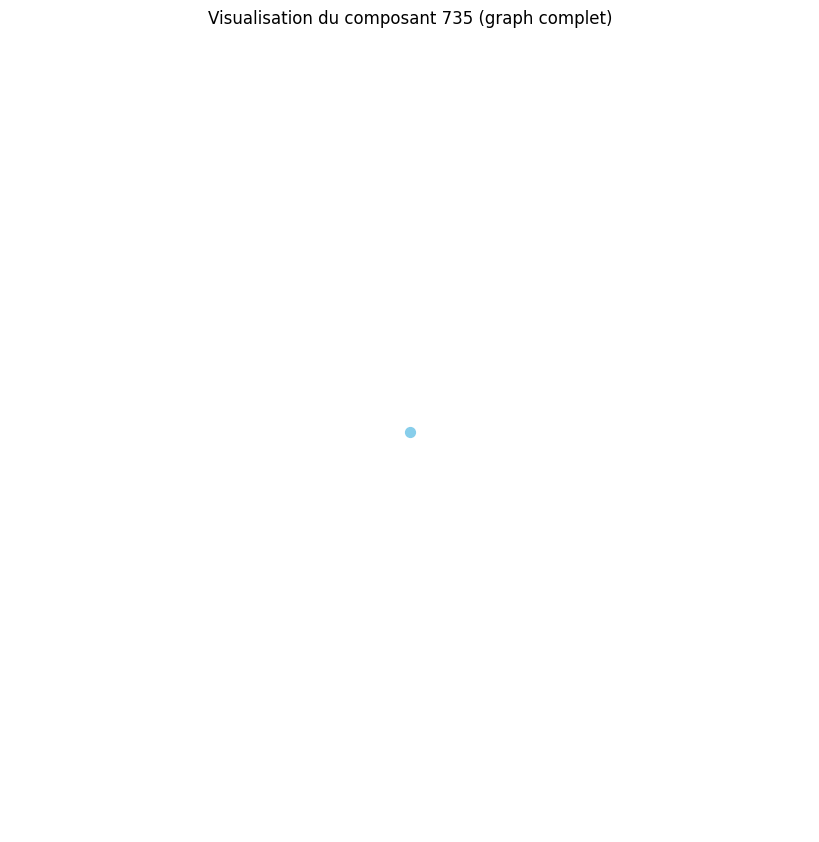

Distance moyenne pour le composant 736 : 0.00
Le composant 736 est un graphe complet ou très densément connecté.
Densité du composant 736 : 0.00
Degré moyen du composant 736 : 0.00
Coefficient de clustering moyen du composant 736 : 0.00


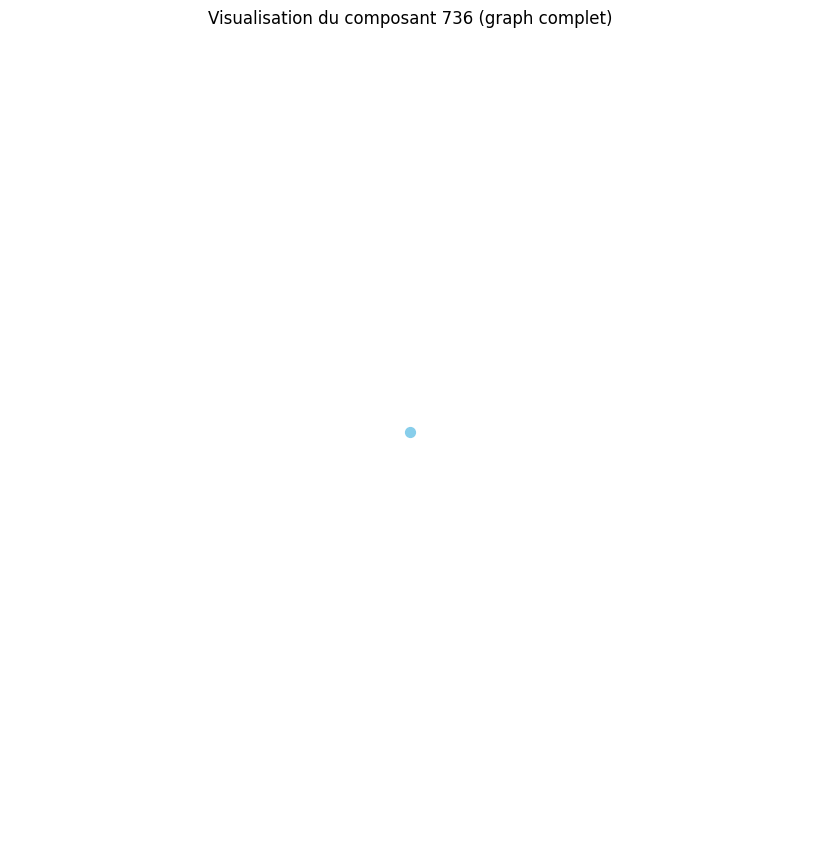

Distance moyenne pour le composant 737 : 0.00
Le composant 737 est un graphe complet ou très densément connecté.
Densité du composant 737 : 0.00
Degré moyen du composant 737 : 0.00
Coefficient de clustering moyen du composant 737 : 0.00


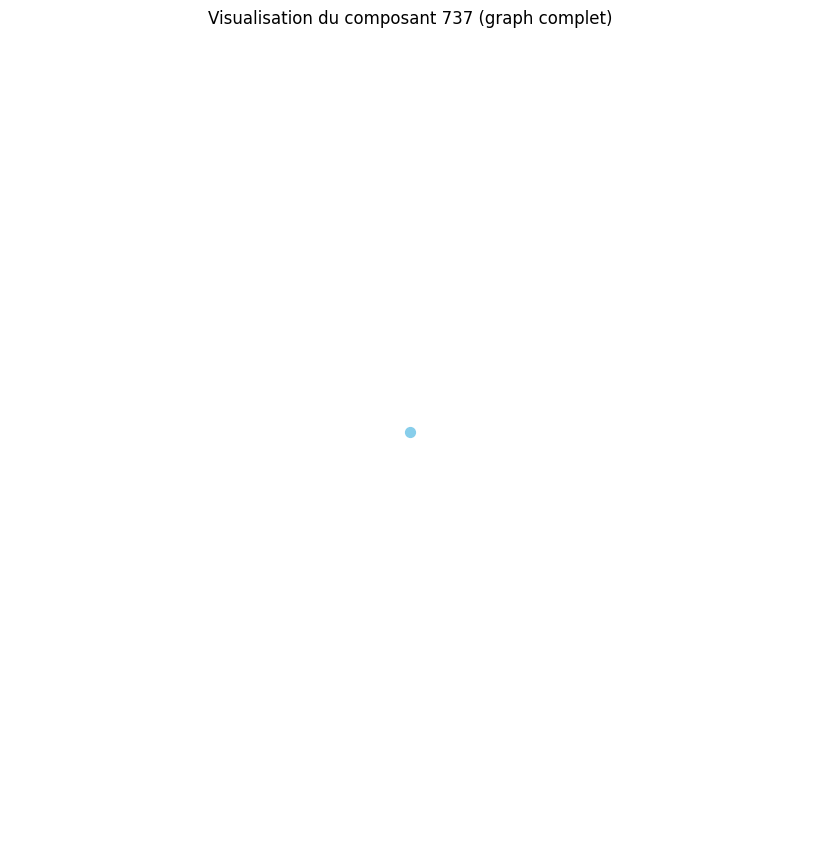

Distance moyenne pour le composant 738 : 0.00
Le composant 738 est un graphe complet ou très densément connecté.
Densité du composant 738 : 0.00
Degré moyen du composant 738 : 0.00
Coefficient de clustering moyen du composant 738 : 0.00


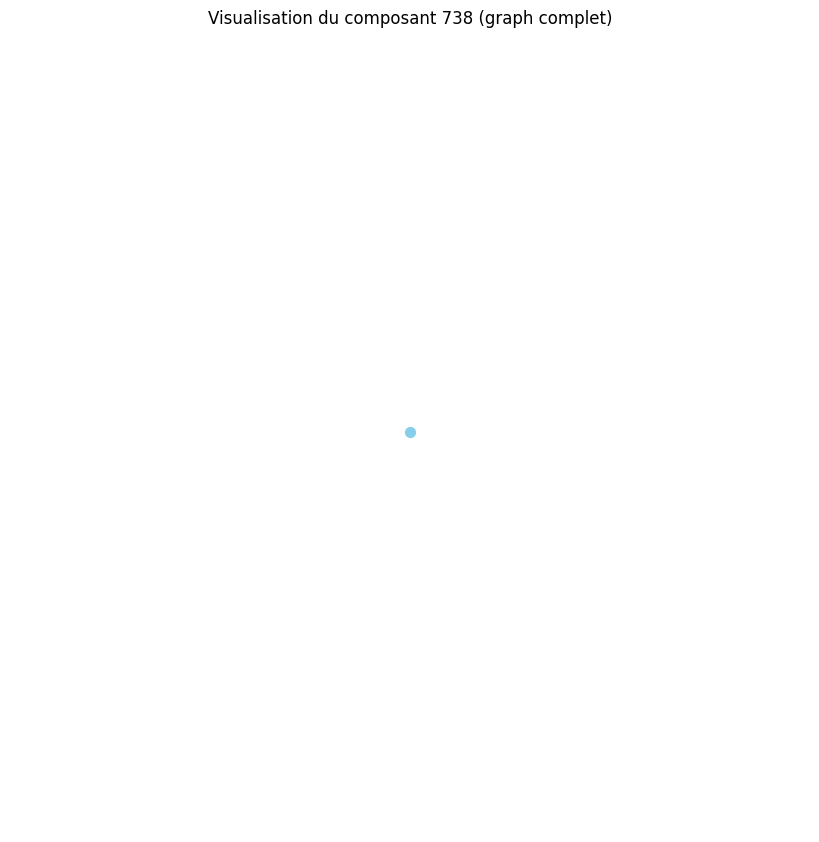

Distance moyenne pour le composant 739 : 0.00
Le composant 739 est un graphe complet ou très densément connecté.
Densité du composant 739 : 0.00
Degré moyen du composant 739 : 0.00
Coefficient de clustering moyen du composant 739 : 0.00


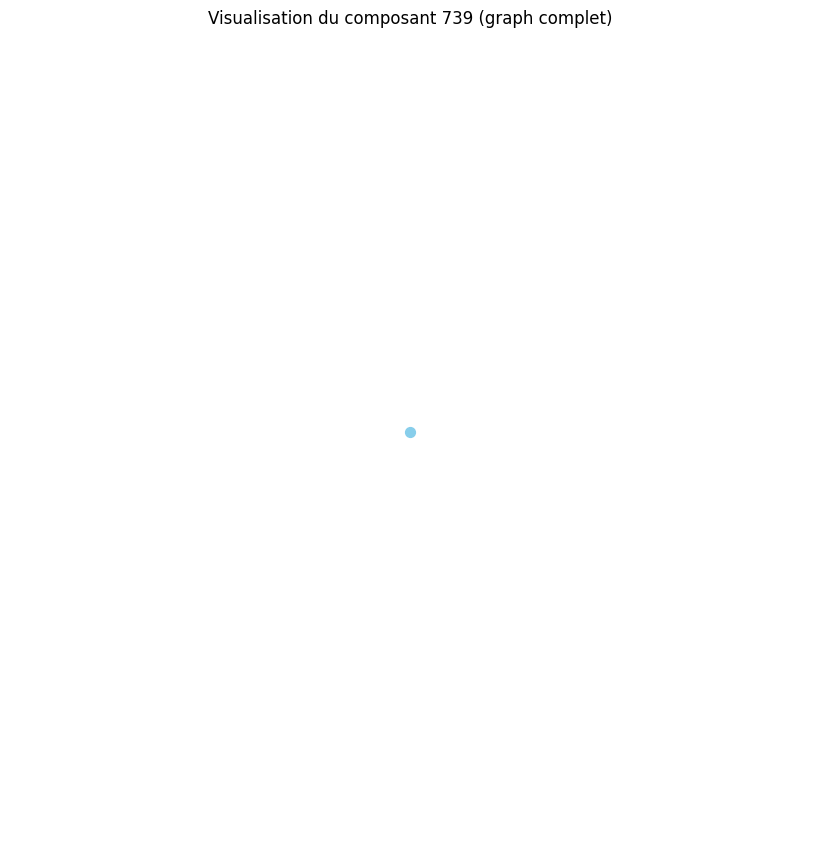

Distance moyenne pour le composant 740 : 0.00
Le composant 740 est un graphe complet ou très densément connecté.
Densité du composant 740 : 0.00
Degré moyen du composant 740 : 0.00
Coefficient de clustering moyen du composant 740 : 0.00


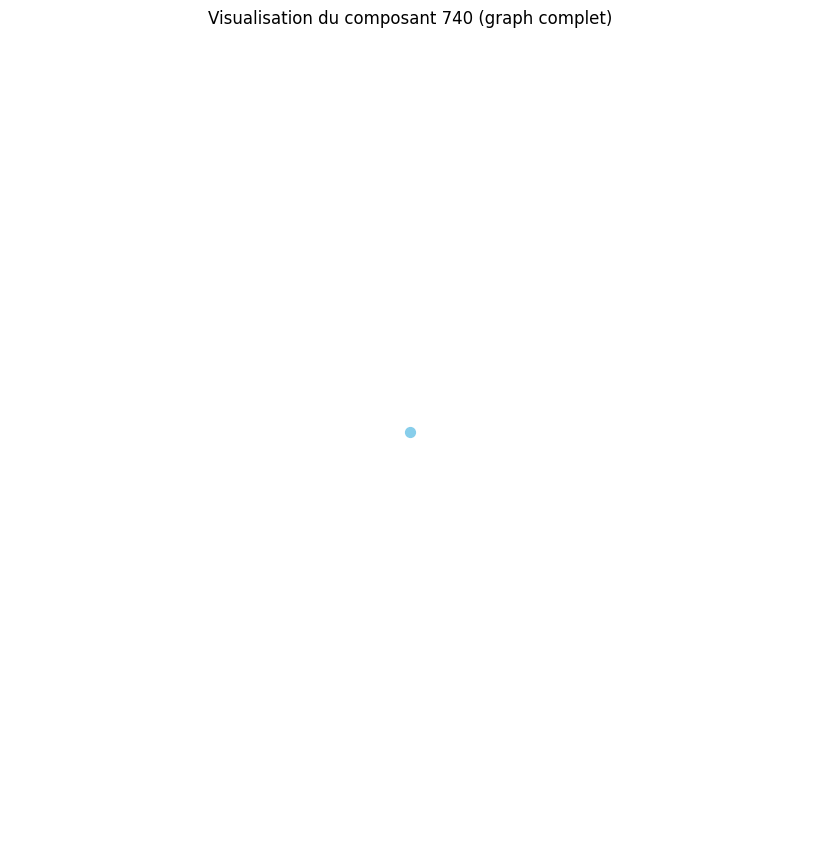

Distance moyenne pour le composant 741 : 0.00
Le composant 741 est un graphe complet ou très densément connecté.
Densité du composant 741 : 0.00
Degré moyen du composant 741 : 0.00
Coefficient de clustering moyen du composant 741 : 0.00


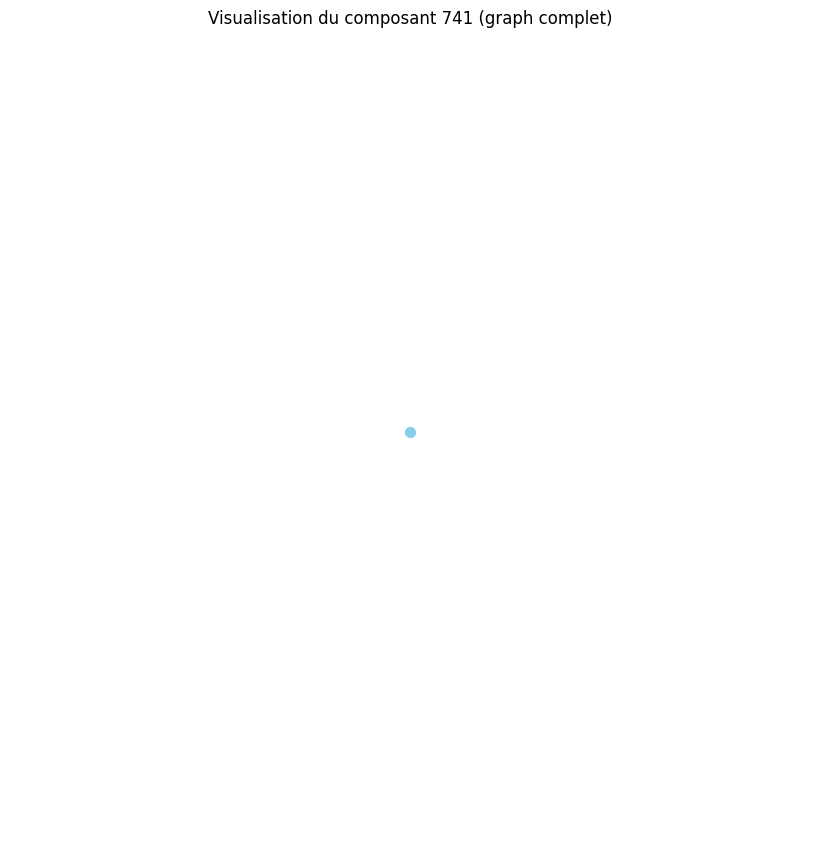

Distance moyenne pour le composant 742 : 0.00
Le composant 742 est un graphe complet ou très densément connecté.
Densité du composant 742 : 0.00
Degré moyen du composant 742 : 0.00
Coefficient de clustering moyen du composant 742 : 0.00


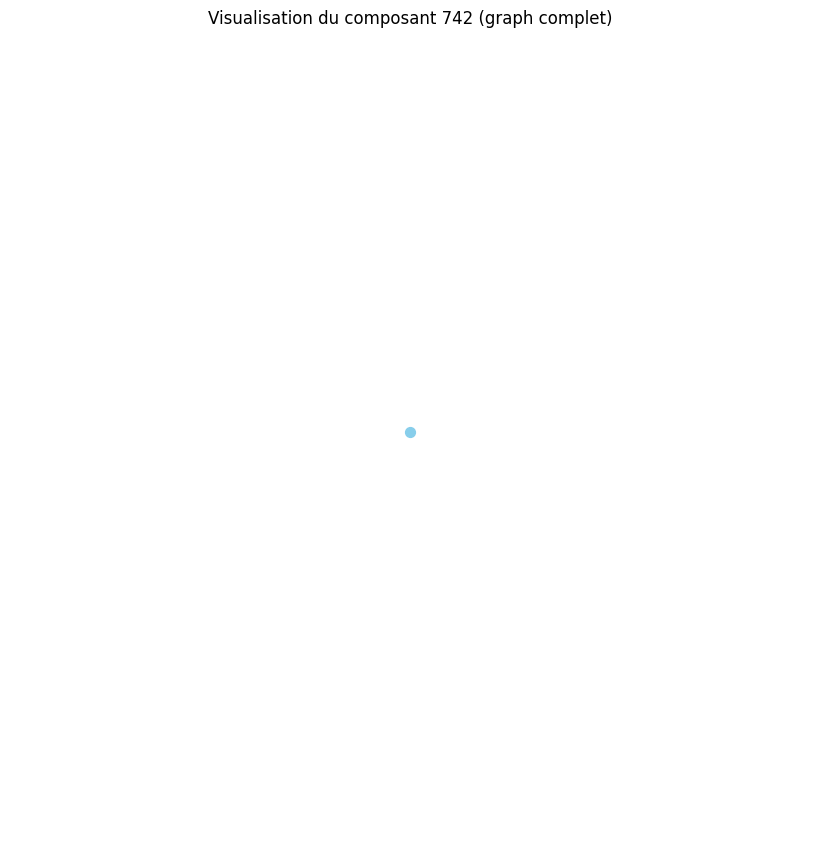

Distance moyenne pour le composant 743 : 0.00
Le composant 743 est un graphe complet ou très densément connecté.
Densité du composant 743 : 0.00
Degré moyen du composant 743 : 0.00
Coefficient de clustering moyen du composant 743 : 0.00


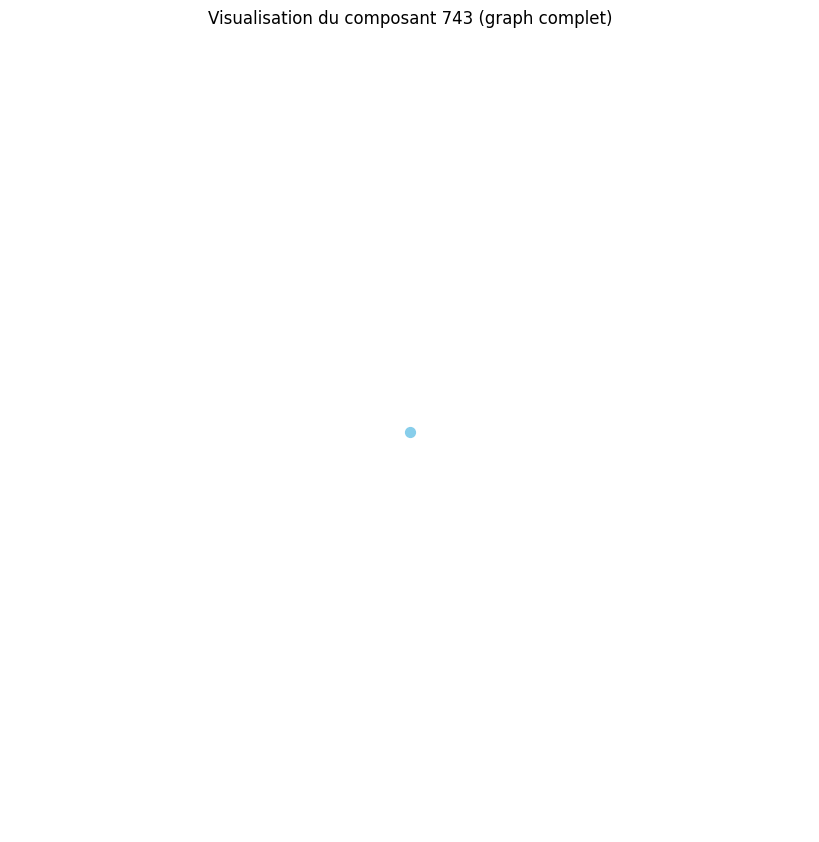

Distance moyenne pour le composant 744 : 0.00
Le composant 744 est un graphe complet ou très densément connecté.
Densité du composant 744 : 0.00
Degré moyen du composant 744 : 0.00
Coefficient de clustering moyen du composant 744 : 0.00


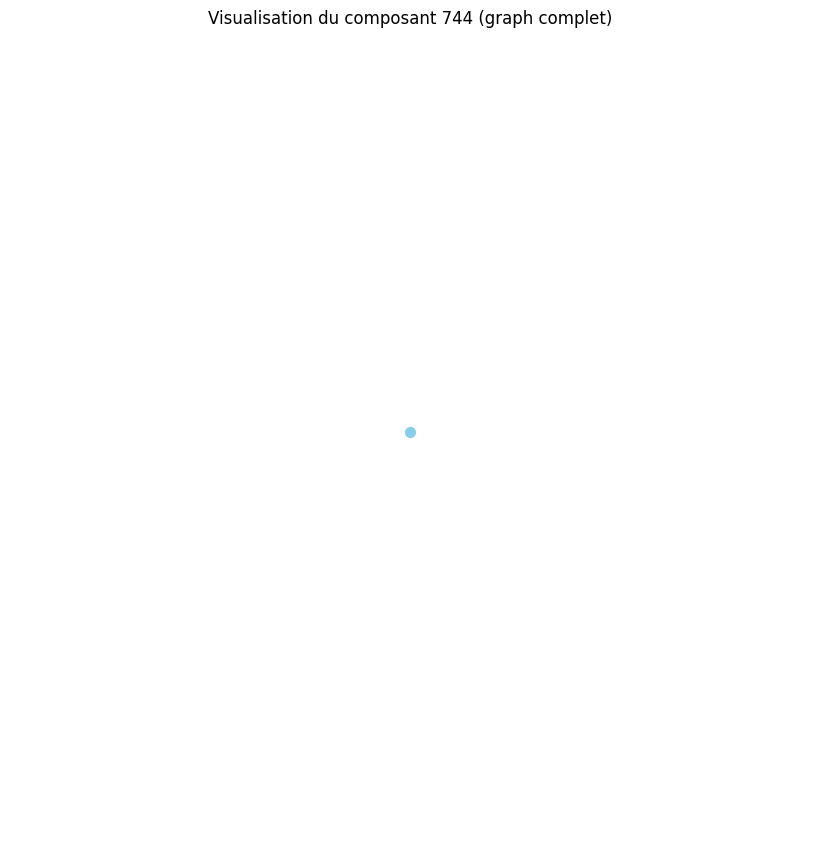

Distance moyenne pour le composant 745 : 0.00
Le composant 745 est un graphe complet ou très densément connecté.
Densité du composant 745 : 0.00
Degré moyen du composant 745 : 0.00
Coefficient de clustering moyen du composant 745 : 0.00


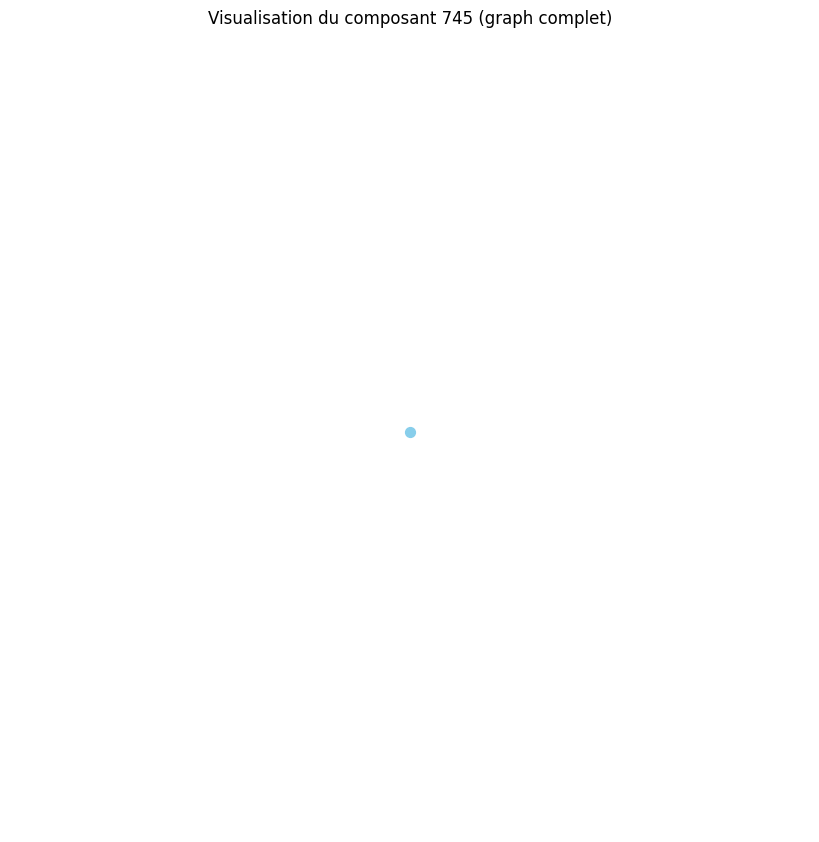

Distance moyenne pour le composant 746 : 0.00
Le composant 746 est un graphe complet ou très densément connecté.
Densité du composant 746 : 0.00
Degré moyen du composant 746 : 0.00
Coefficient de clustering moyen du composant 746 : 0.00


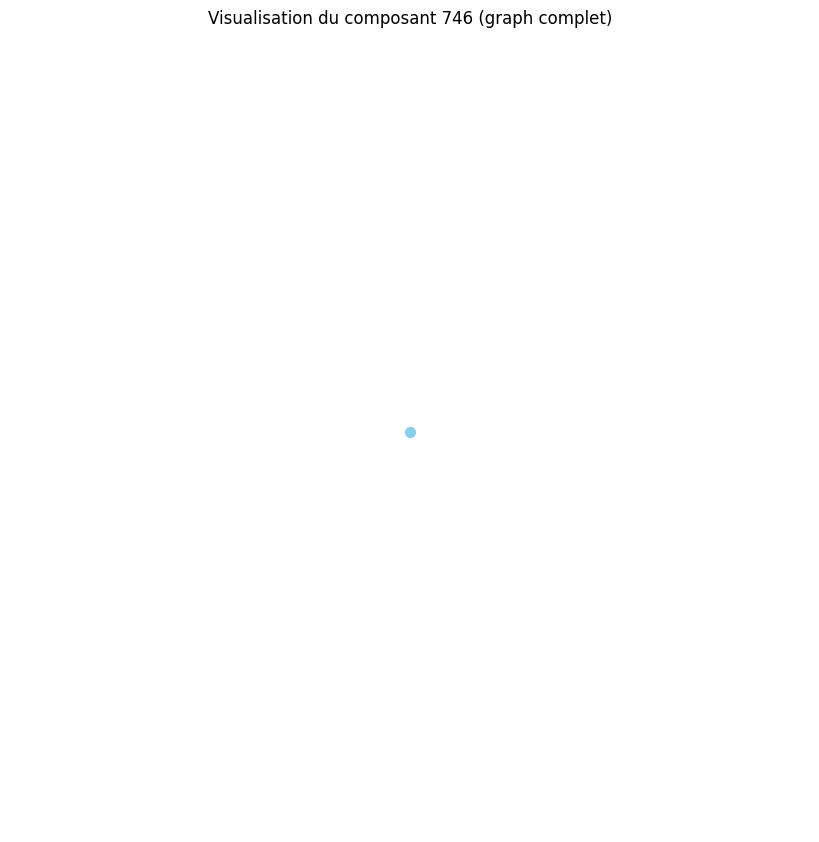

Distance moyenne pour le composant 747 : 0.00
Le composant 747 est un graphe complet ou très densément connecté.
Densité du composant 747 : 0.00
Degré moyen du composant 747 : 0.00
Coefficient de clustering moyen du composant 747 : 0.00


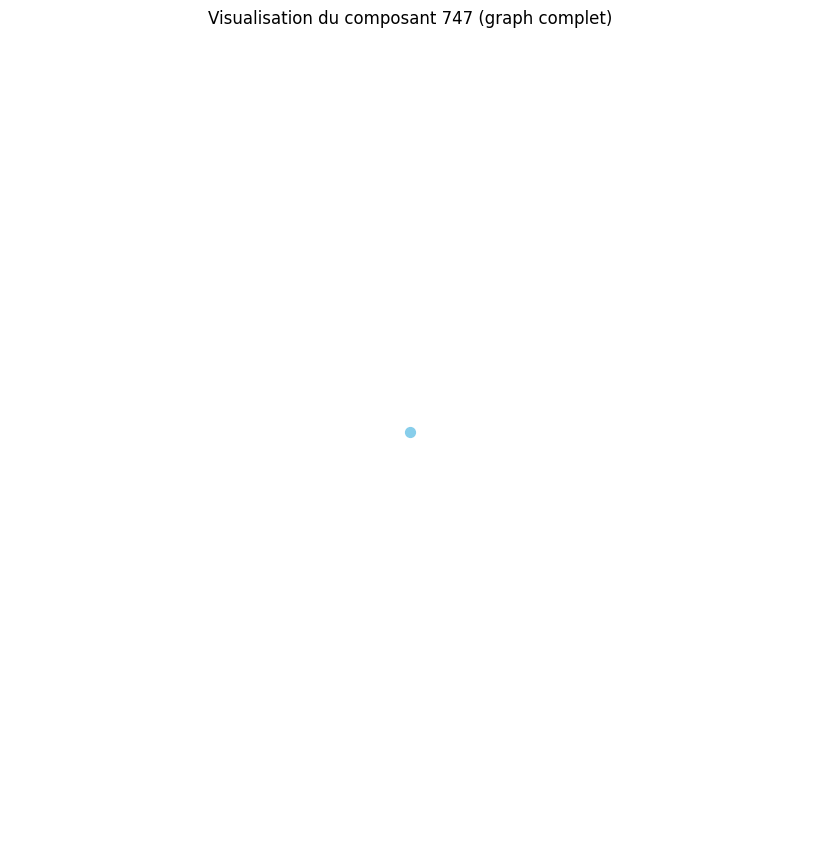

Distance moyenne pour le composant 748 : 0.00
Le composant 748 est un graphe complet ou très densément connecté.
Densité du composant 748 : 0.00
Degré moyen du composant 748 : 0.00
Coefficient de clustering moyen du composant 748 : 0.00


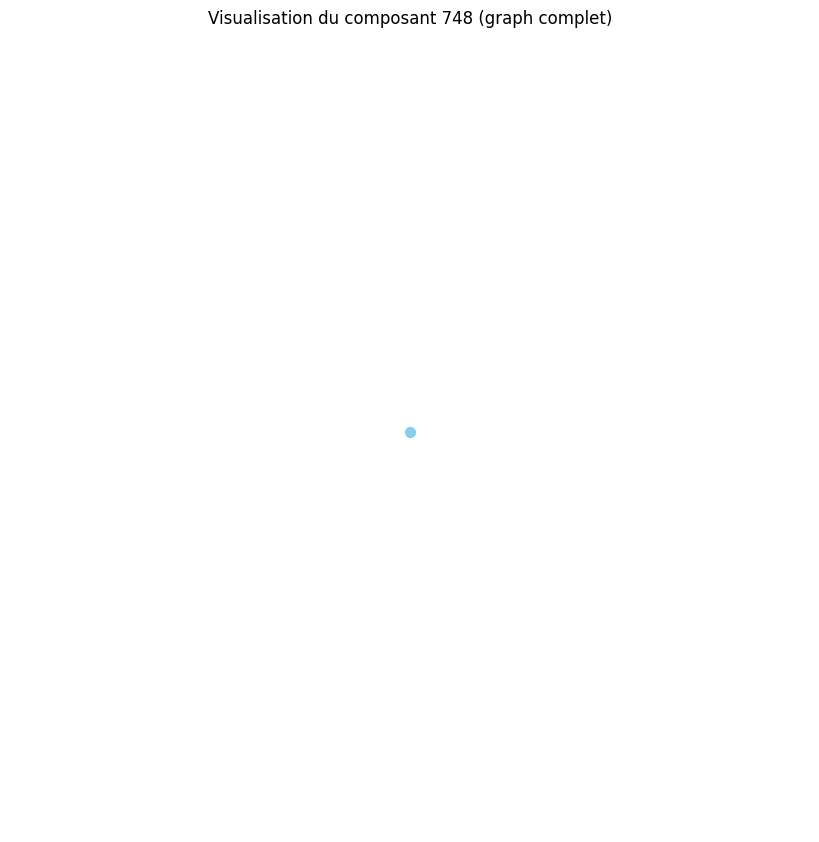

Distance moyenne pour le composant 749 : 0.00
Le composant 749 est un graphe complet ou très densément connecté.
Densité du composant 749 : 0.00
Degré moyen du composant 749 : 0.00
Coefficient de clustering moyen du composant 749 : 0.00


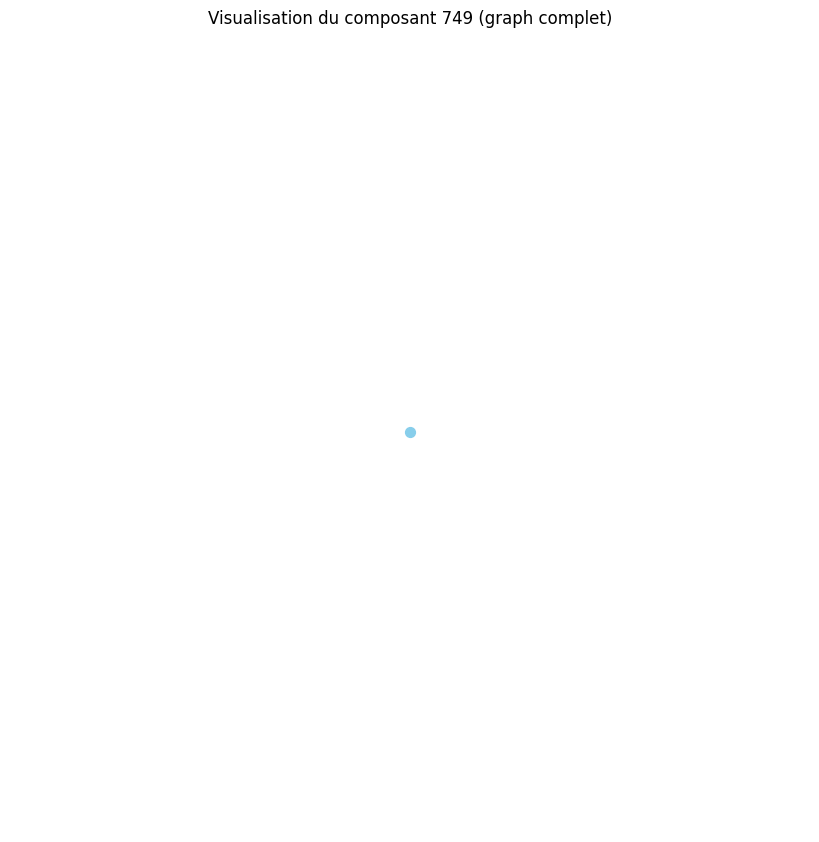

Distance moyenne pour le composant 750 : 0.00
Le composant 750 est un graphe complet ou très densément connecté.
Densité du composant 750 : 0.00
Degré moyen du composant 750 : 0.00
Coefficient de clustering moyen du composant 750 : 0.00


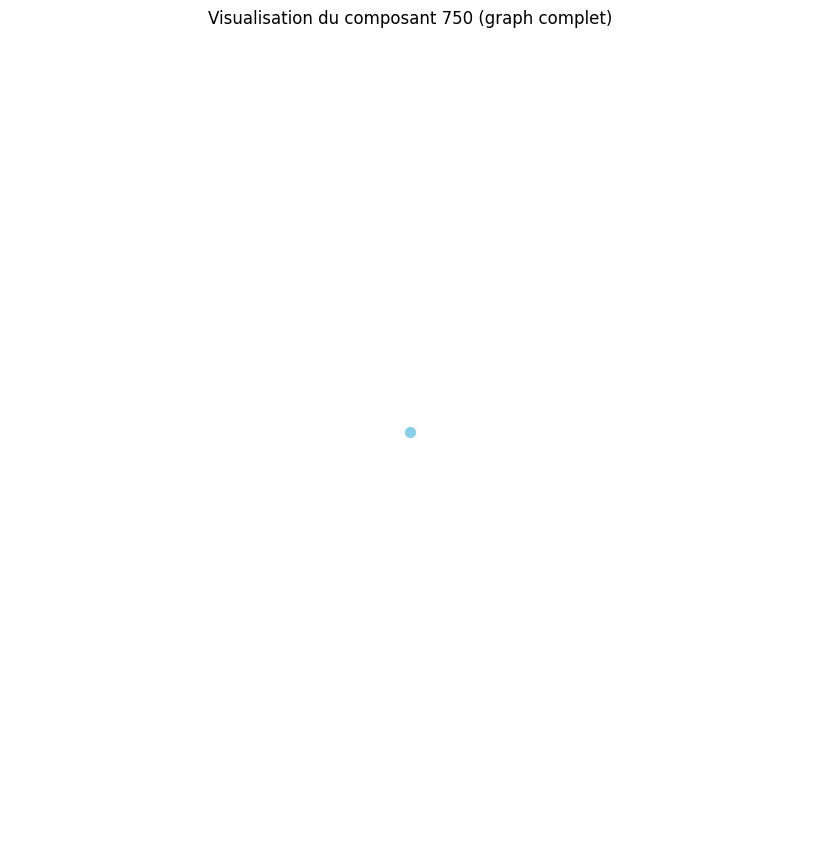

Distance moyenne pour le composant 751 : 0.00
Le composant 751 est un graphe complet ou très densément connecté.
Densité du composant 751 : 0.00
Degré moyen du composant 751 : 0.00
Coefficient de clustering moyen du composant 751 : 0.00


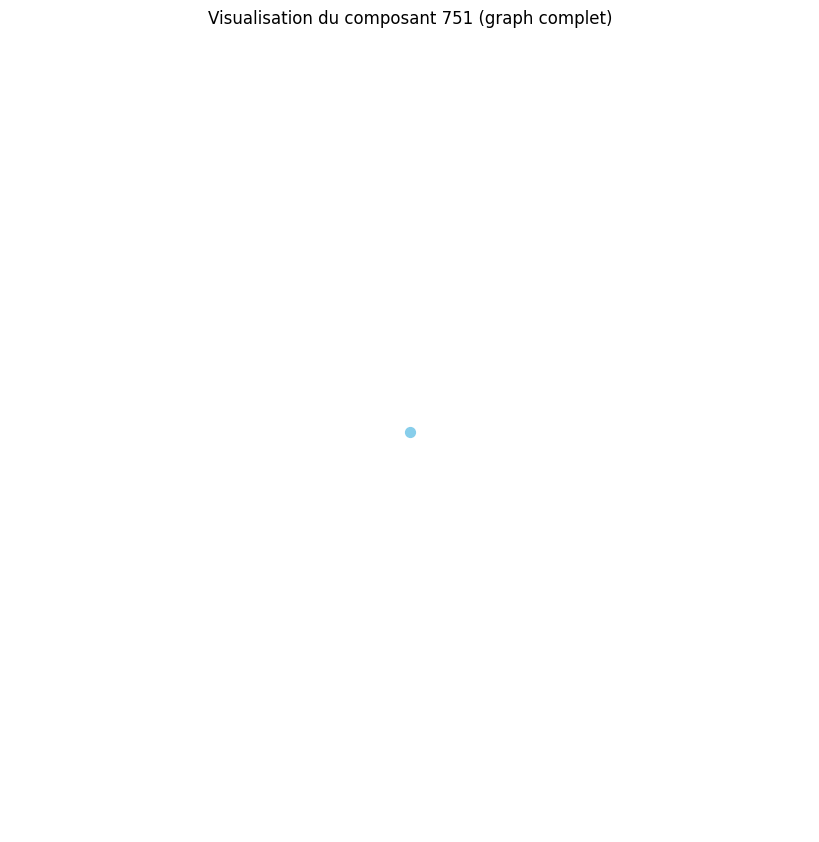

Distance moyenne pour le composant 752 : 0.00
Le composant 752 est un graphe complet ou très densément connecté.
Densité du composant 752 : 0.00
Degré moyen du composant 752 : 0.00
Coefficient de clustering moyen du composant 752 : 0.00


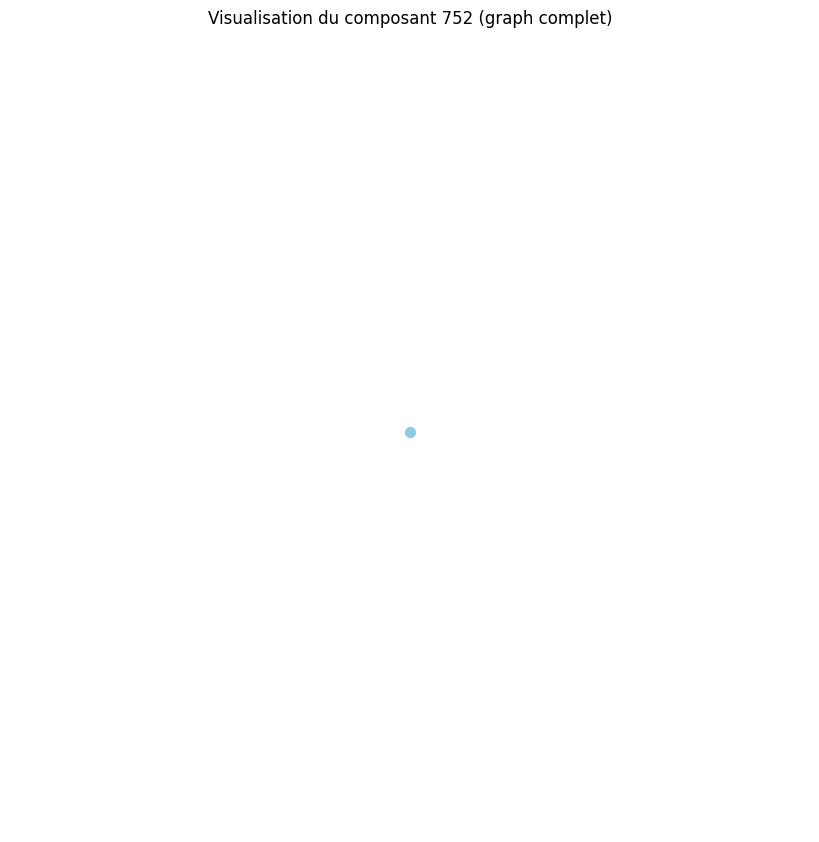

Distance moyenne pour le composant 753 : 0.00
Le composant 753 est un graphe complet ou très densément connecté.
Densité du composant 753 : 0.00
Degré moyen du composant 753 : 0.00
Coefficient de clustering moyen du composant 753 : 0.00


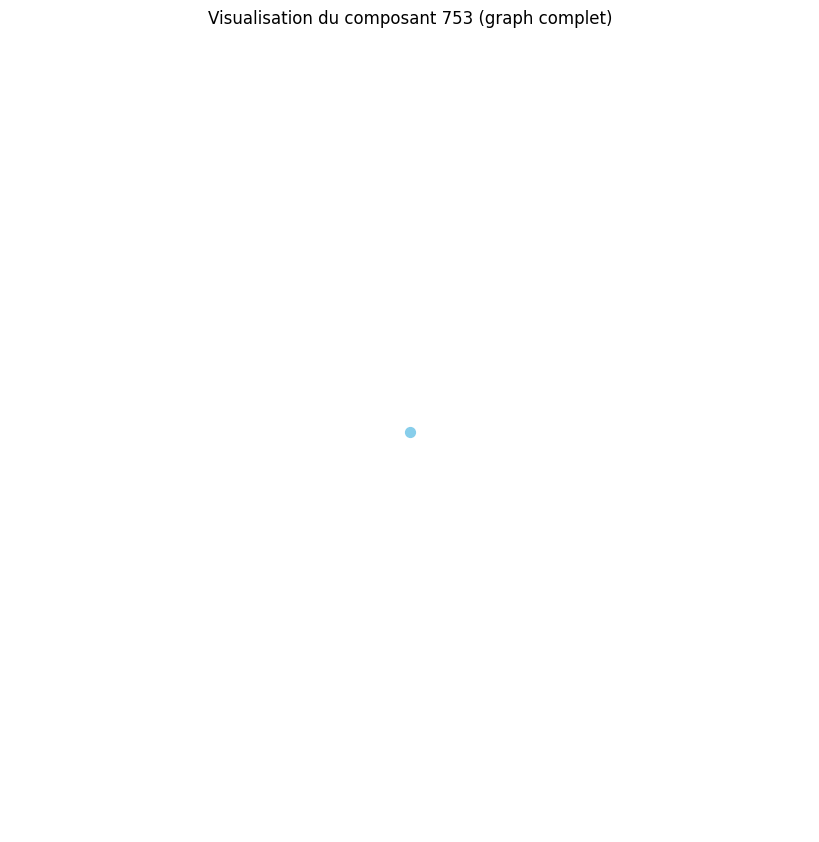

Distance moyenne pour le composant 754 : 0.00
Le composant 754 est un graphe complet ou très densément connecté.
Densité du composant 754 : 0.00
Degré moyen du composant 754 : 0.00
Coefficient de clustering moyen du composant 754 : 0.00


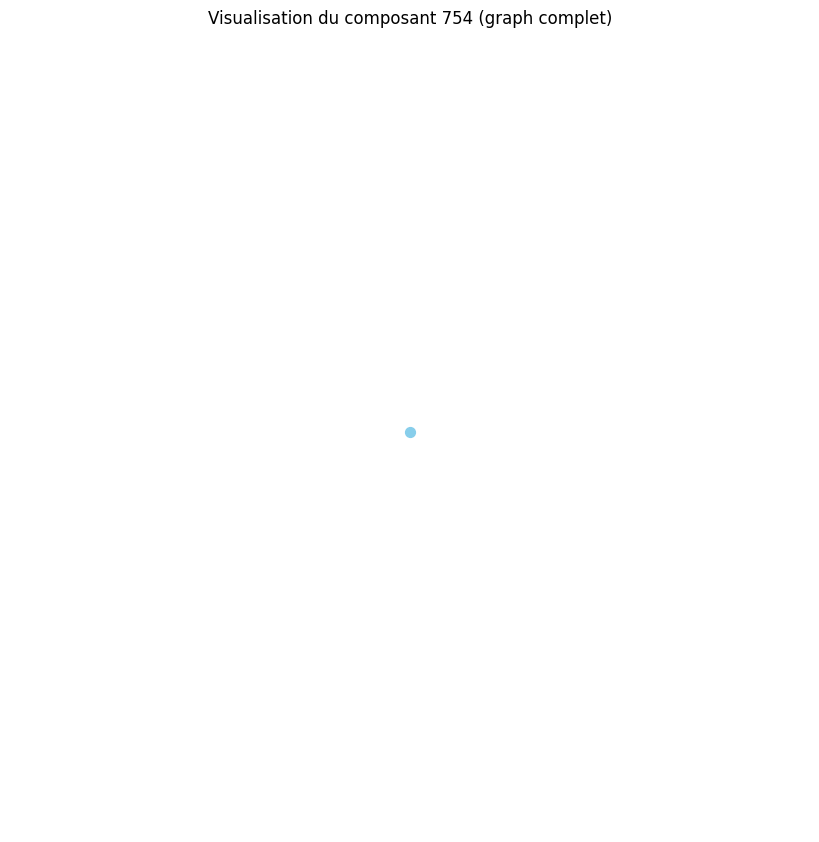

Distance moyenne pour le composant 755 : 0.00
Le composant 755 est un graphe complet ou très densément connecté.
Densité du composant 755 : 0.00
Degré moyen du composant 755 : 0.00
Coefficient de clustering moyen du composant 755 : 0.00


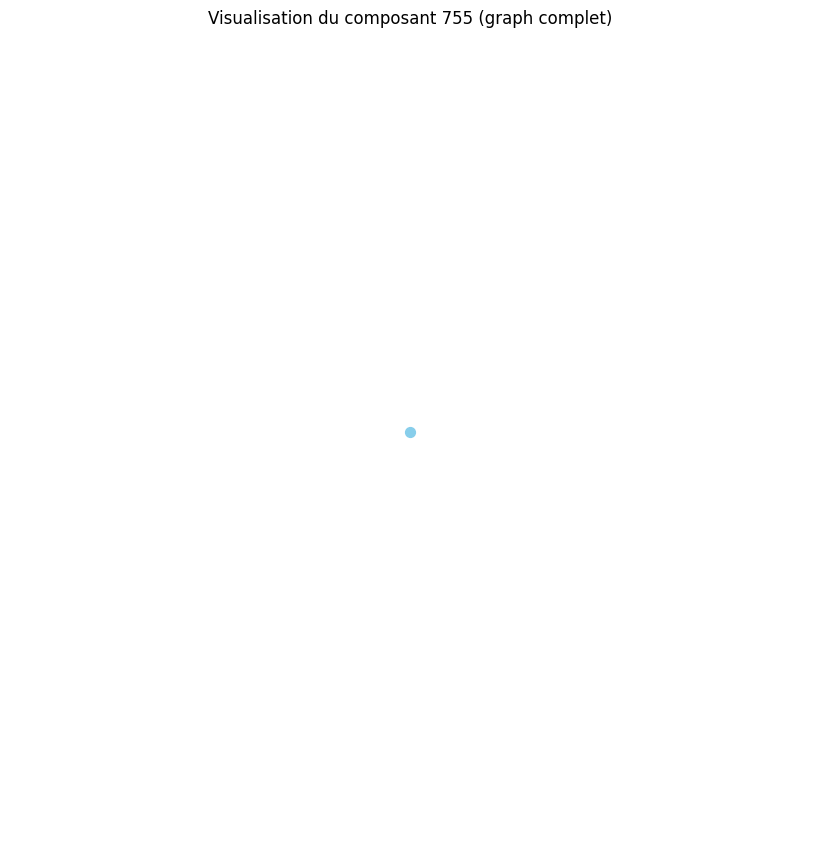

Distance moyenne pour le composant 756 : 0.00
Le composant 756 est un graphe complet ou très densément connecté.
Densité du composant 756 : 0.00
Degré moyen du composant 756 : 0.00
Coefficient de clustering moyen du composant 756 : 0.00


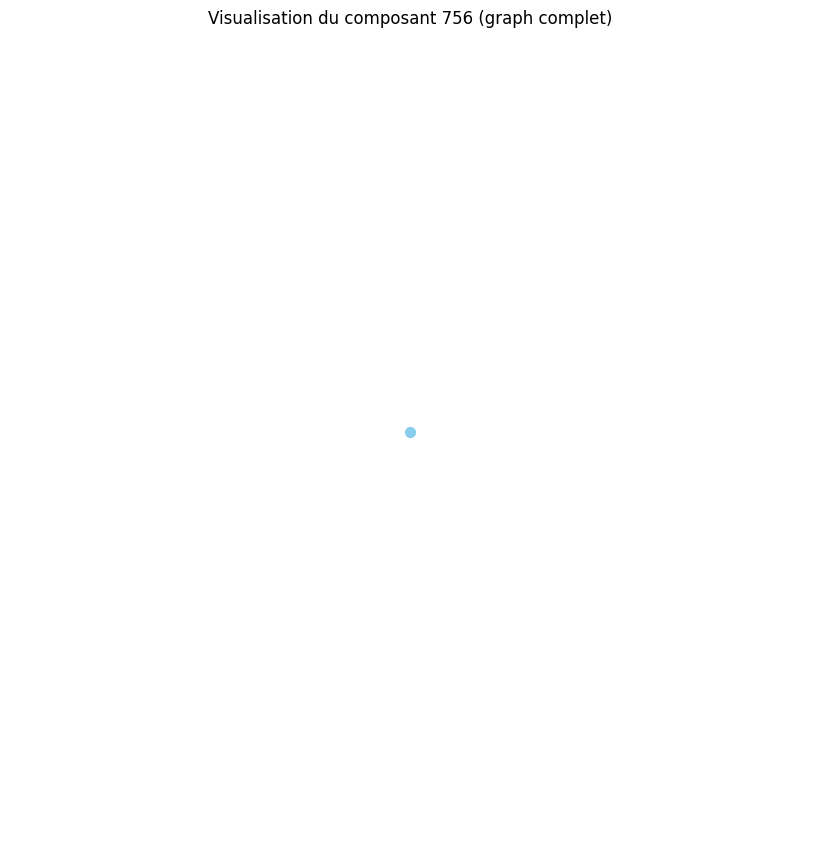

Distance moyenne pour le composant 757 : 0.00
Le composant 757 est un graphe complet ou très densément connecté.
Densité du composant 757 : 0.00
Degré moyen du composant 757 : 0.00
Coefficient de clustering moyen du composant 757 : 0.00


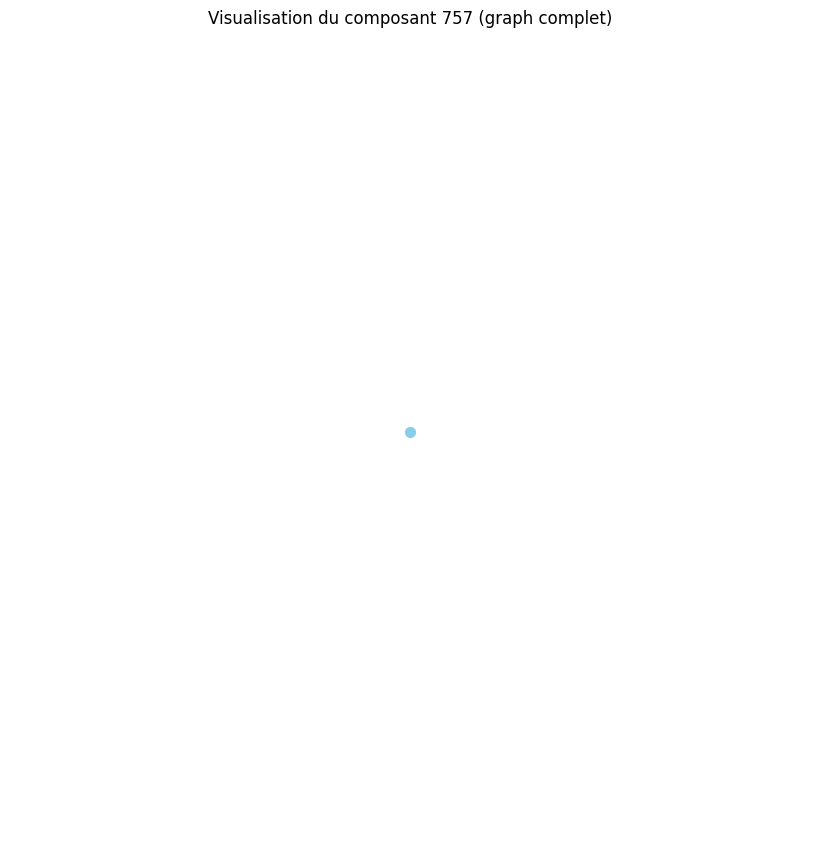

Distance moyenne pour le composant 758 : 0.00
Le composant 758 est un graphe complet ou très densément connecté.
Densité du composant 758 : 0.00
Degré moyen du composant 758 : 0.00
Coefficient de clustering moyen du composant 758 : 0.00


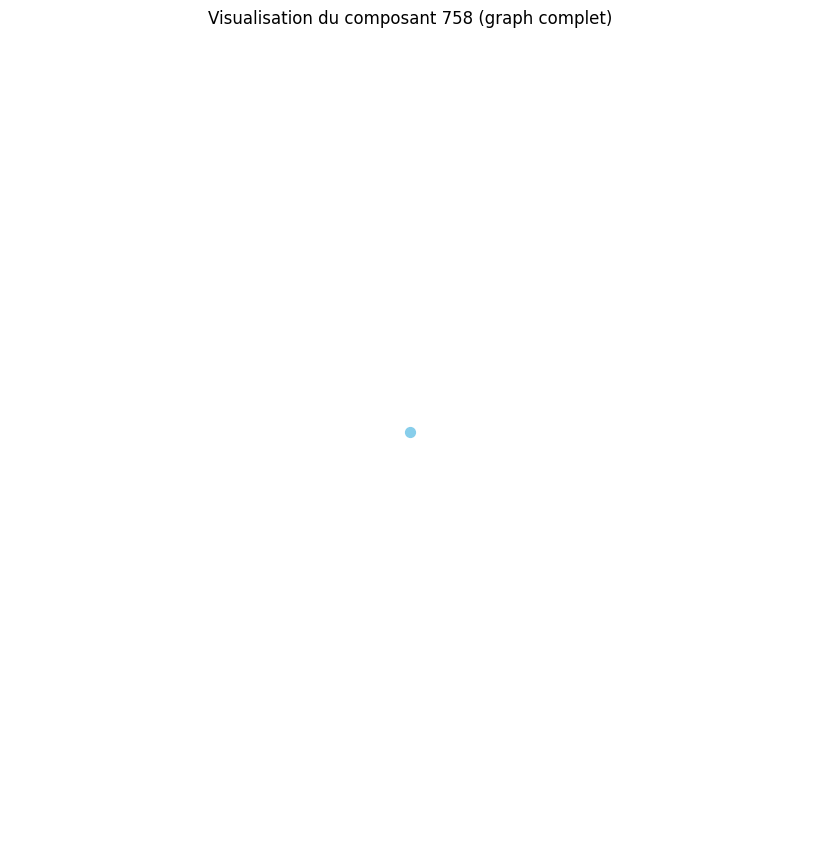

Distance moyenne pour le composant 759 : 0.00
Le composant 759 est un graphe complet ou très densément connecté.
Densité du composant 759 : 0.00
Degré moyen du composant 759 : 0.00
Coefficient de clustering moyen du composant 759 : 0.00


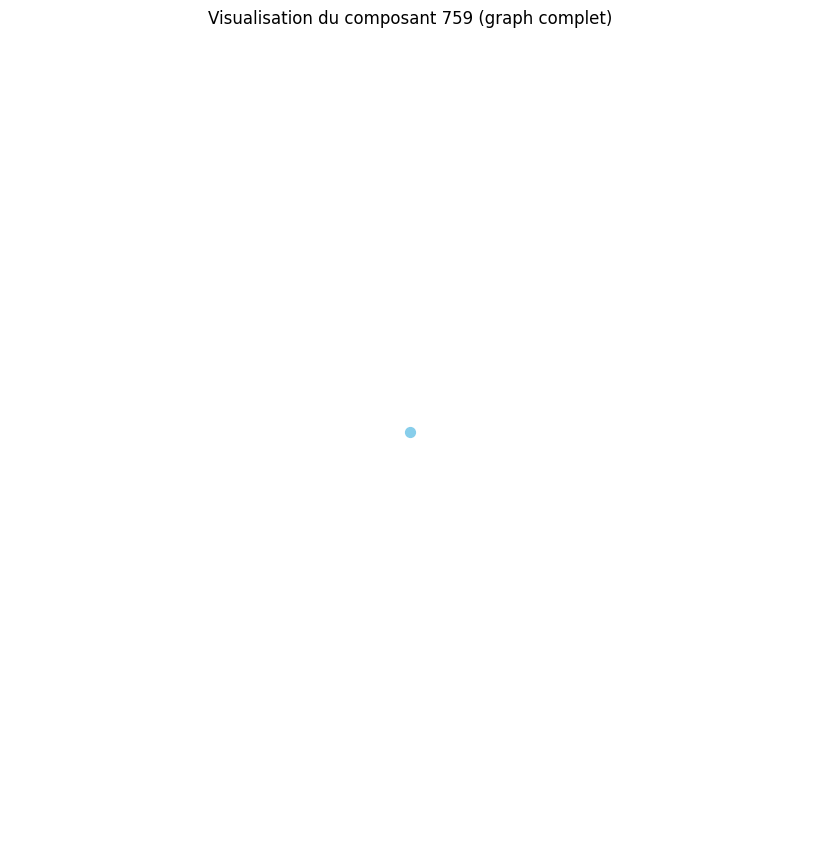

Distance moyenne pour le composant 760 : 0.00
Le composant 760 est un graphe complet ou très densément connecté.
Densité du composant 760 : 0.00
Degré moyen du composant 760 : 0.00
Coefficient de clustering moyen du composant 760 : 0.00


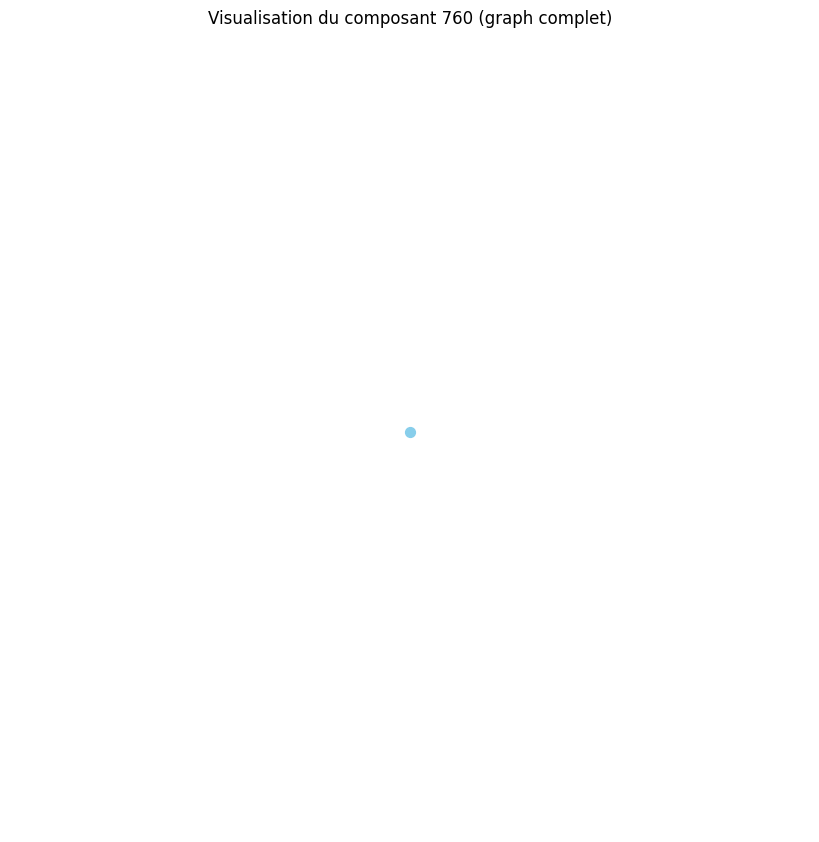

Distance moyenne pour le composant 761 : 0.00
Le composant 761 est un graphe complet ou très densément connecté.
Densité du composant 761 : 0.00
Degré moyen du composant 761 : 0.00
Coefficient de clustering moyen du composant 761 : 0.00


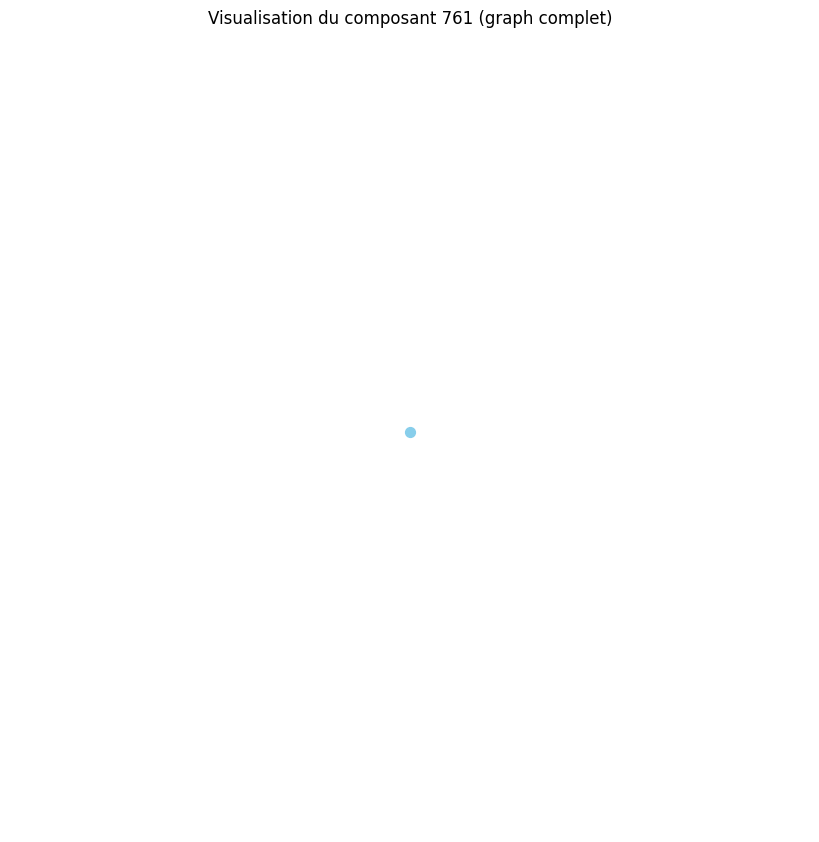

Distance moyenne pour le composant 762 : 0.00
Le composant 762 est un graphe complet ou très densément connecté.
Densité du composant 762 : 0.00
Degré moyen du composant 762 : 0.00
Coefficient de clustering moyen du composant 762 : 0.00


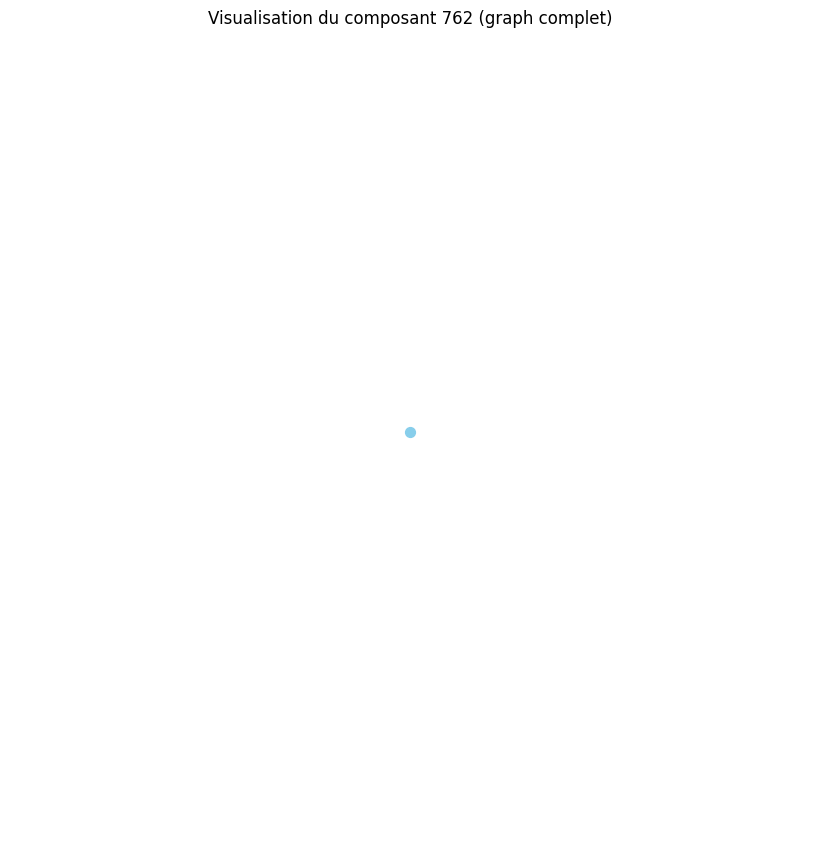

Distance moyenne pour le composant 763 : 0.00
Le composant 763 est un graphe complet ou très densément connecté.
Densité du composant 763 : 0.00
Degré moyen du composant 763 : 0.00
Coefficient de clustering moyen du composant 763 : 0.00


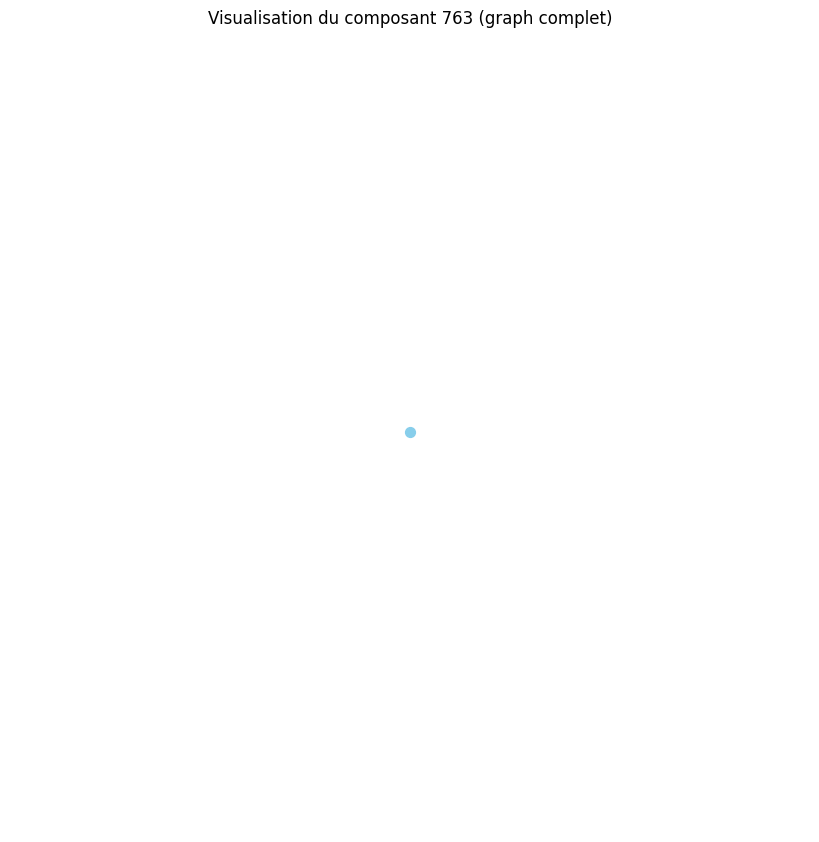

Distance moyenne pour le composant 764 : 0.00
Le composant 764 est un graphe complet ou très densément connecté.
Densité du composant 764 : 0.00
Degré moyen du composant 764 : 0.00
Coefficient de clustering moyen du composant 764 : 0.00


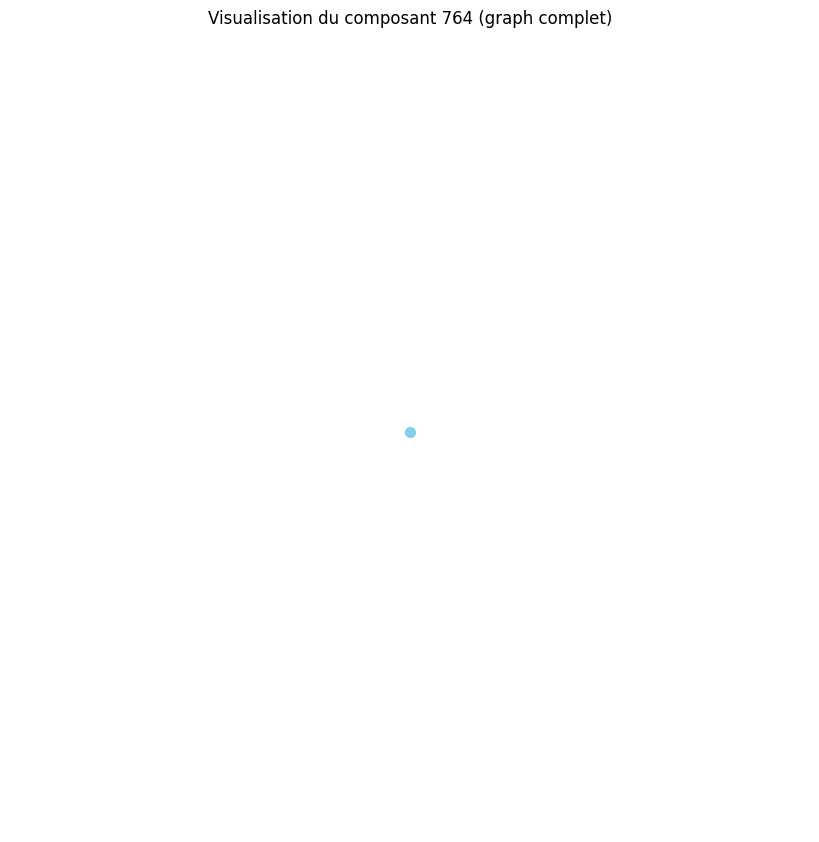

Distance moyenne pour le composant 765 : 0.00
Le composant 765 est un graphe complet ou très densément connecté.
Densité du composant 765 : 0.00
Degré moyen du composant 765 : 0.00
Coefficient de clustering moyen du composant 765 : 0.00


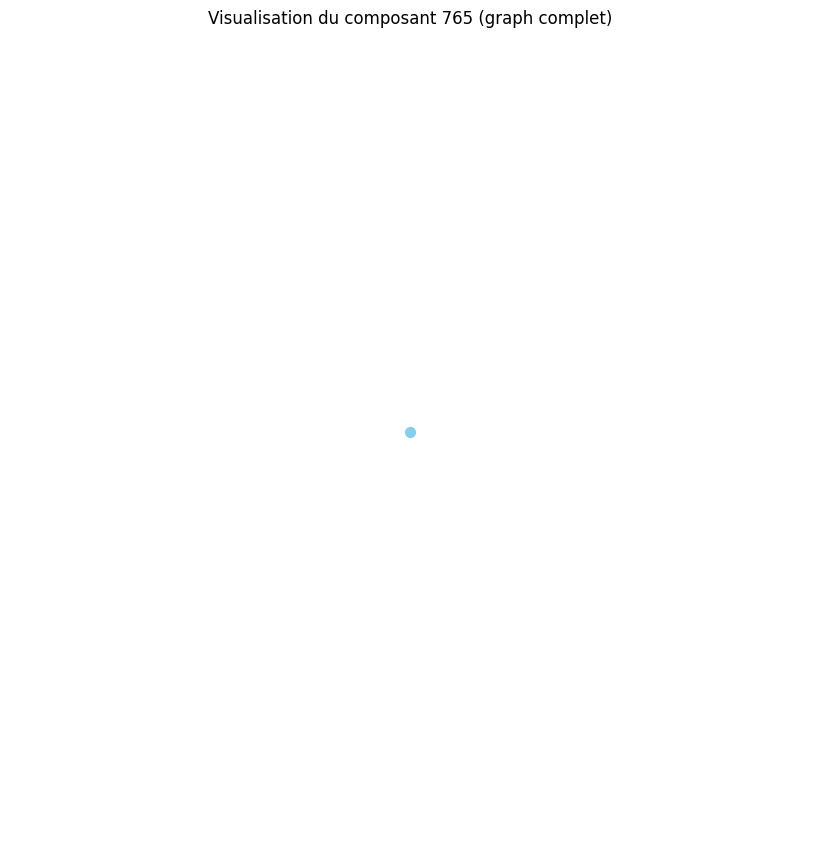

Distance moyenne pour le composant 766 : 0.00
Le composant 766 est un graphe complet ou très densément connecté.
Densité du composant 766 : 0.00
Degré moyen du composant 766 : 0.00
Coefficient de clustering moyen du composant 766 : 0.00


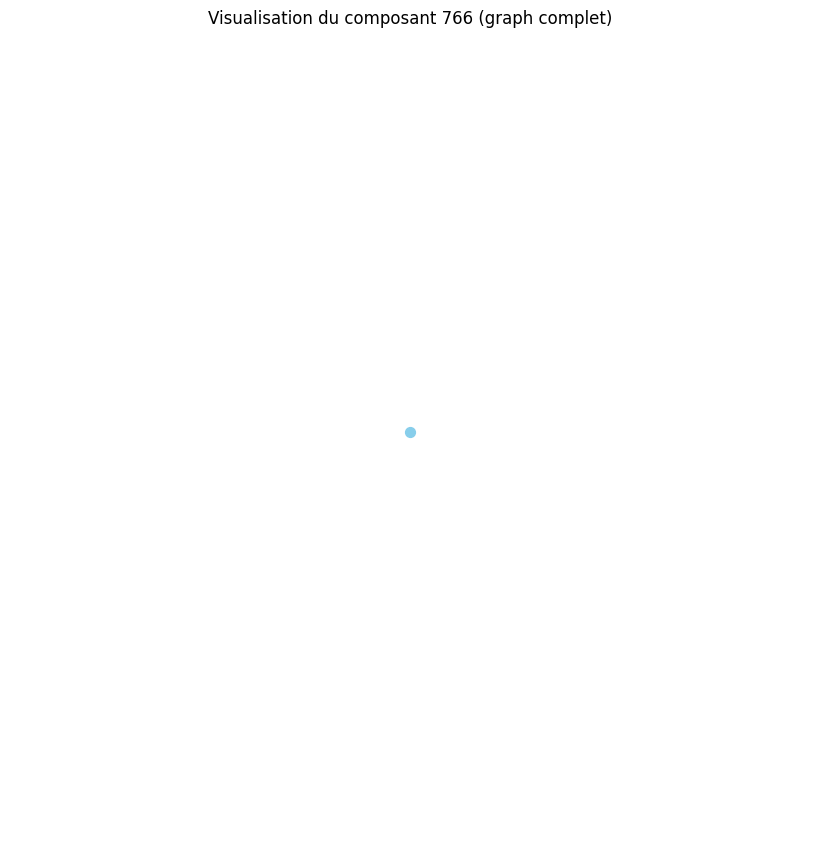

Distance moyenne pour le composant 767 : 0.00
Le composant 767 est un graphe complet ou très densément connecté.
Densité du composant 767 : 0.00
Degré moyen du composant 767 : 0.00
Coefficient de clustering moyen du composant 767 : 0.00


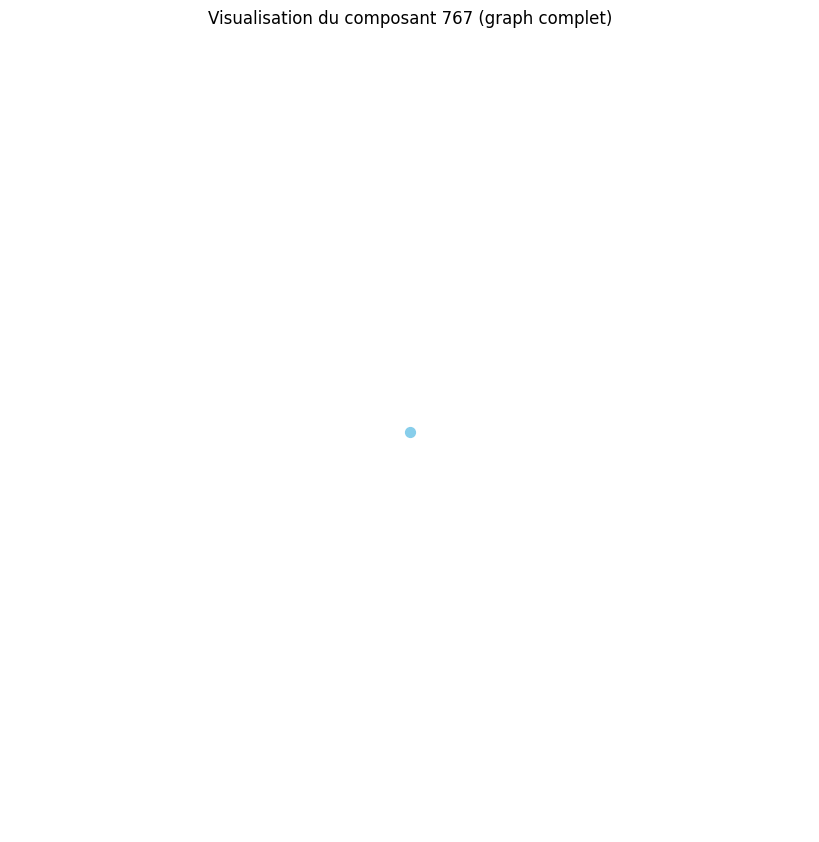

Distance moyenne pour le composant 768 : 0.00
Le composant 768 est un graphe complet ou très densément connecté.
Densité du composant 768 : 0.00
Degré moyen du composant 768 : 0.00
Coefficient de clustering moyen du composant 768 : 0.00


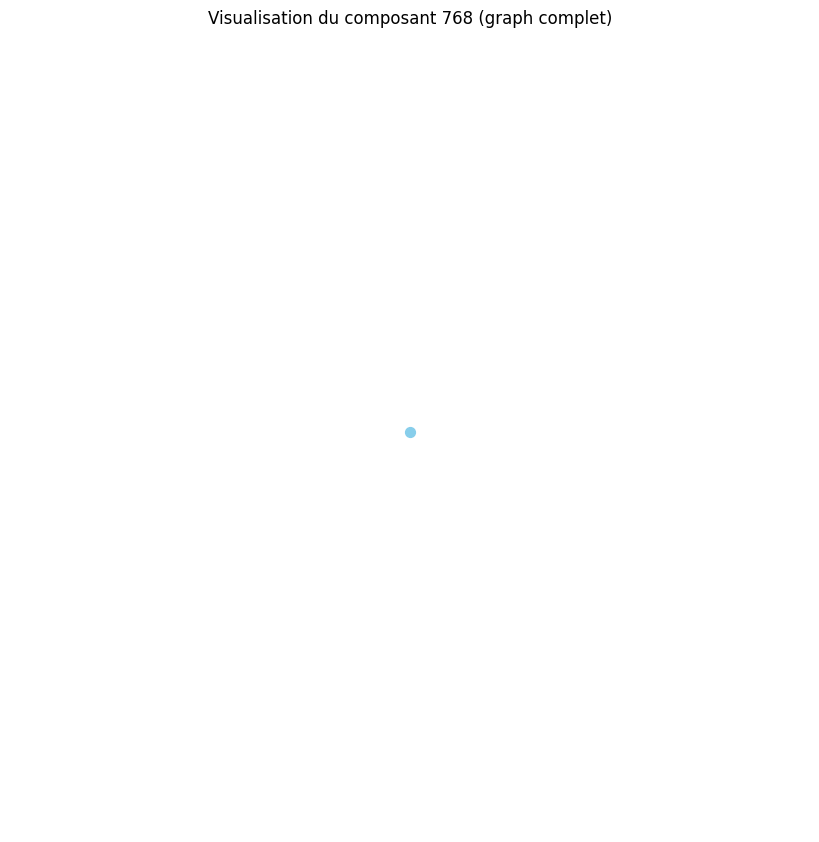

Distance moyenne pour le composant 769 : 0.00
Le composant 769 est un graphe complet ou très densément connecté.
Densité du composant 769 : 0.00
Degré moyen du composant 769 : 0.00
Coefficient de clustering moyen du composant 769 : 0.00


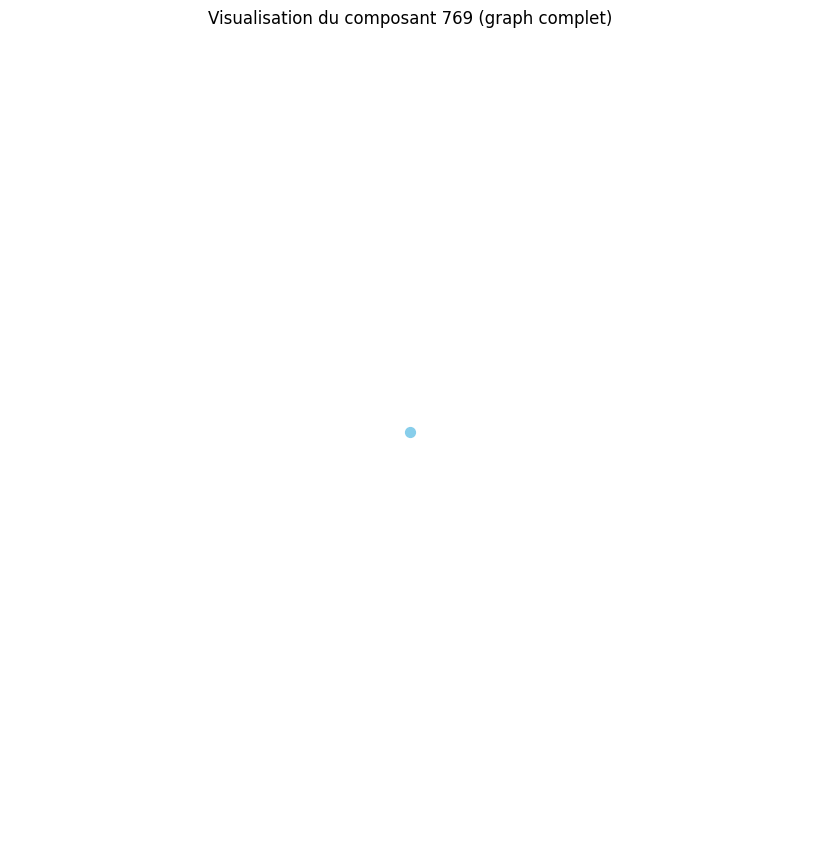

Distance moyenne pour le composant 770 : 0.00
Le composant 770 est un graphe complet ou très densément connecté.
Densité du composant 770 : 0.00
Degré moyen du composant 770 : 0.00
Coefficient de clustering moyen du composant 770 : 0.00


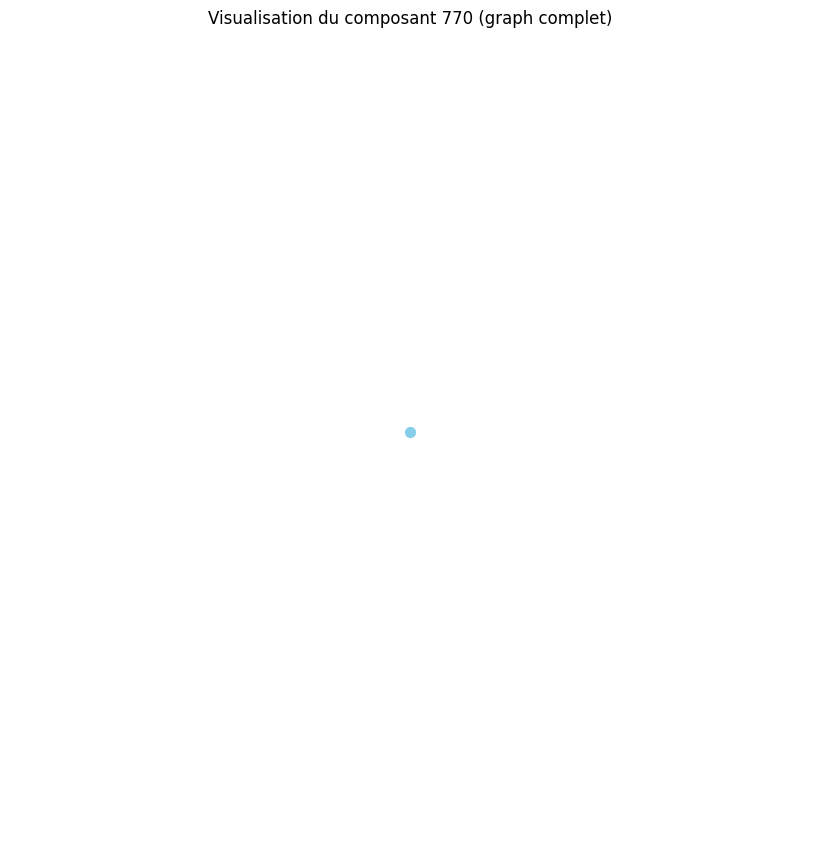

Distance moyenne pour le composant 771 : 0.00
Le composant 771 est un graphe complet ou très densément connecté.
Densité du composant 771 : 0.00
Degré moyen du composant 771 : 0.00
Coefficient de clustering moyen du composant 771 : 0.00


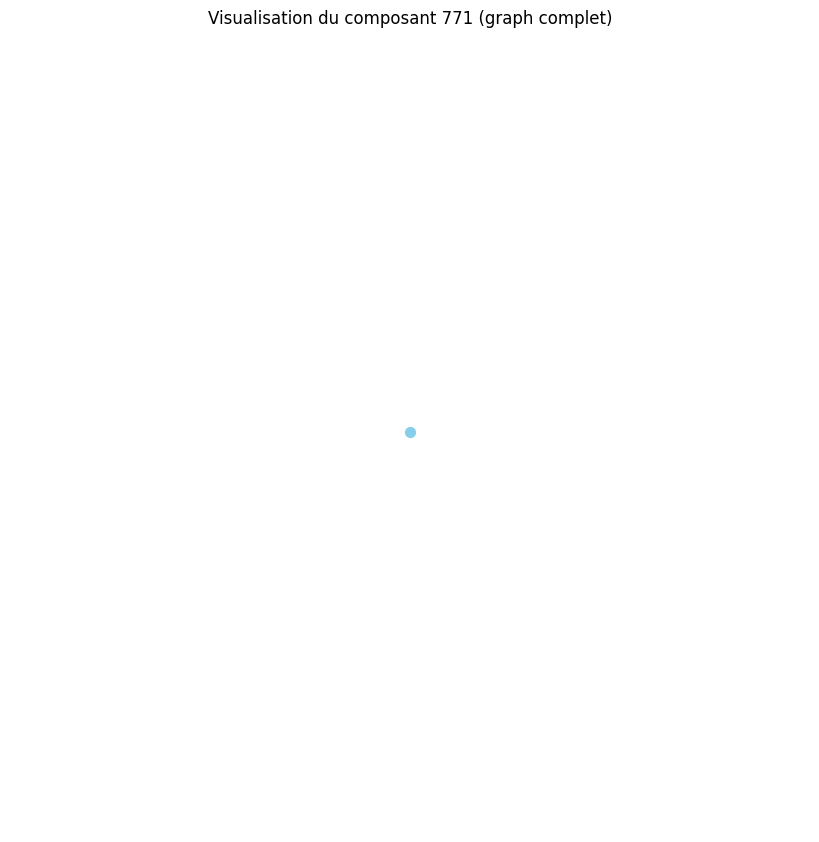

Distance moyenne pour le composant 772 : 0.00
Le composant 772 est un graphe complet ou très densément connecté.
Densité du composant 772 : 0.00
Degré moyen du composant 772 : 0.00
Coefficient de clustering moyen du composant 772 : 0.00


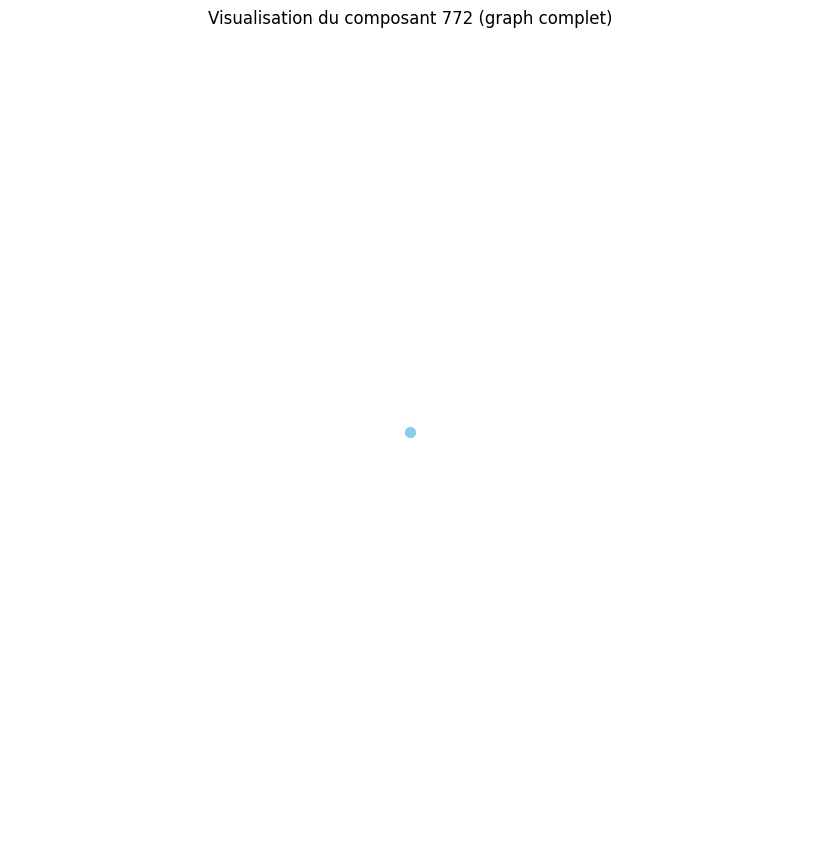

Distance moyenne pour le composant 773 : 0.00
Le composant 773 est un graphe complet ou très densément connecté.
Densité du composant 773 : 0.00
Degré moyen du composant 773 : 0.00
Coefficient de clustering moyen du composant 773 : 0.00


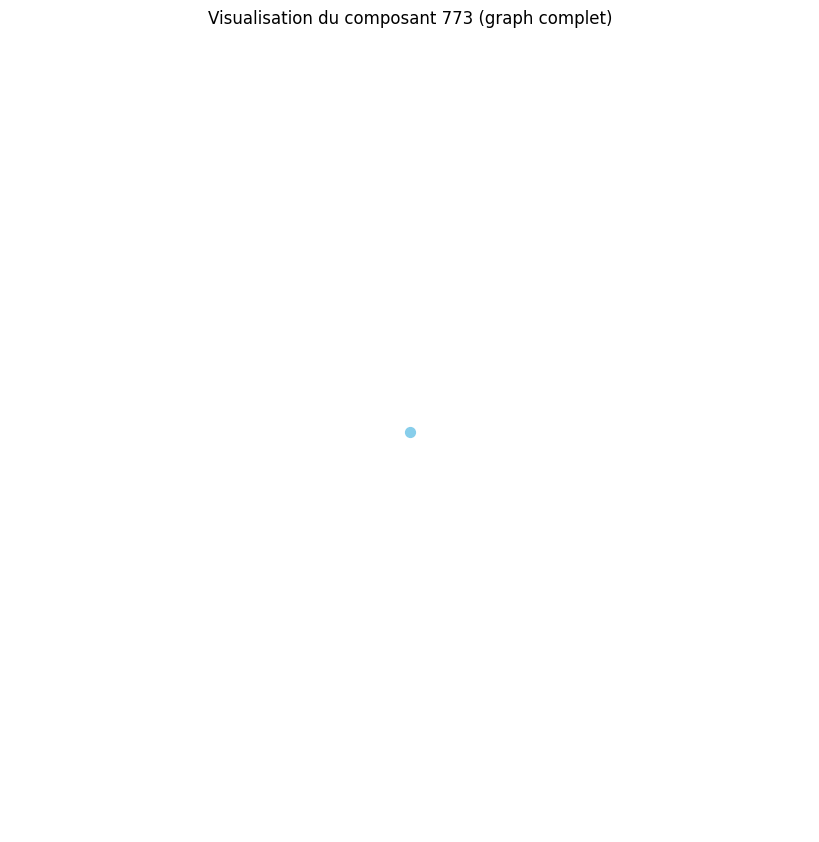

Distance moyenne pour le composant 774 : 0.00
Le composant 774 est un graphe complet ou très densément connecté.
Densité du composant 774 : 0.00
Degré moyen du composant 774 : 0.00
Coefficient de clustering moyen du composant 774 : 0.00


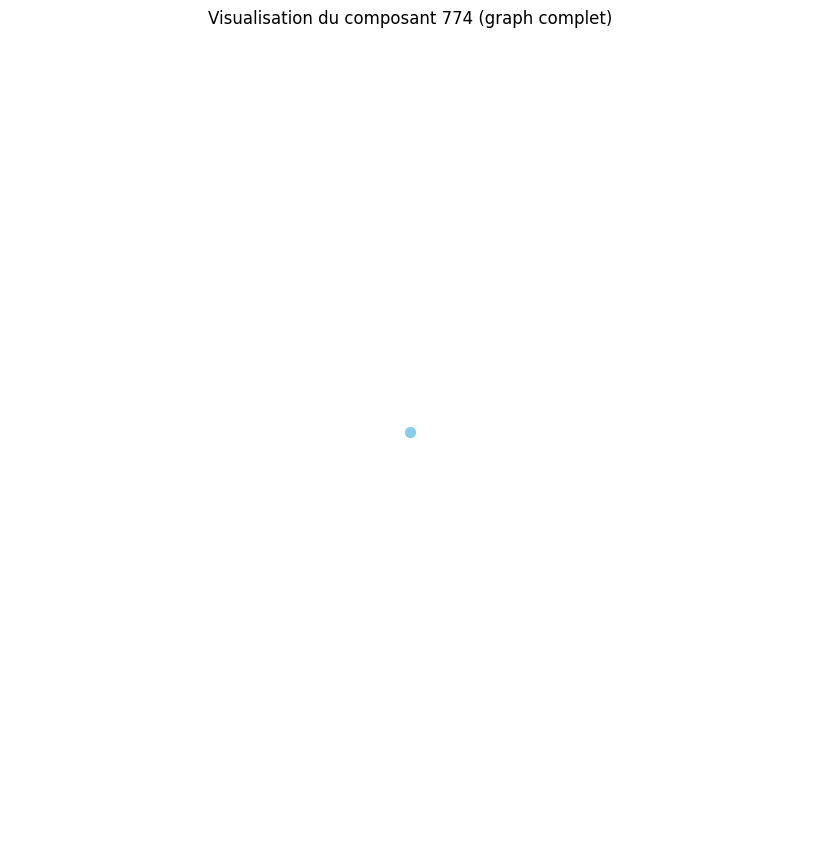

Distance moyenne pour le composant 775 : 0.00
Le composant 775 est un graphe complet ou très densément connecté.
Densité du composant 775 : 0.00
Degré moyen du composant 775 : 0.00
Coefficient de clustering moyen du composant 775 : 0.00


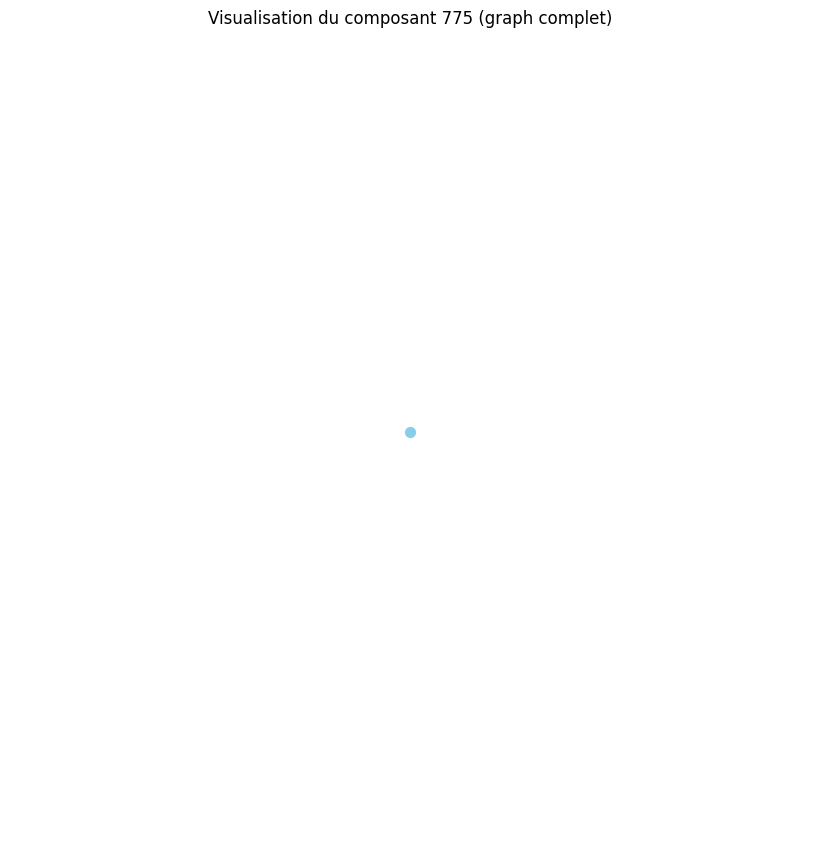

Distance moyenne pour le composant 776 : 0.00
Le composant 776 est un graphe complet ou très densément connecté.
Densité du composant 776 : 0.00
Degré moyen du composant 776 : 0.00
Coefficient de clustering moyen du composant 776 : 0.00


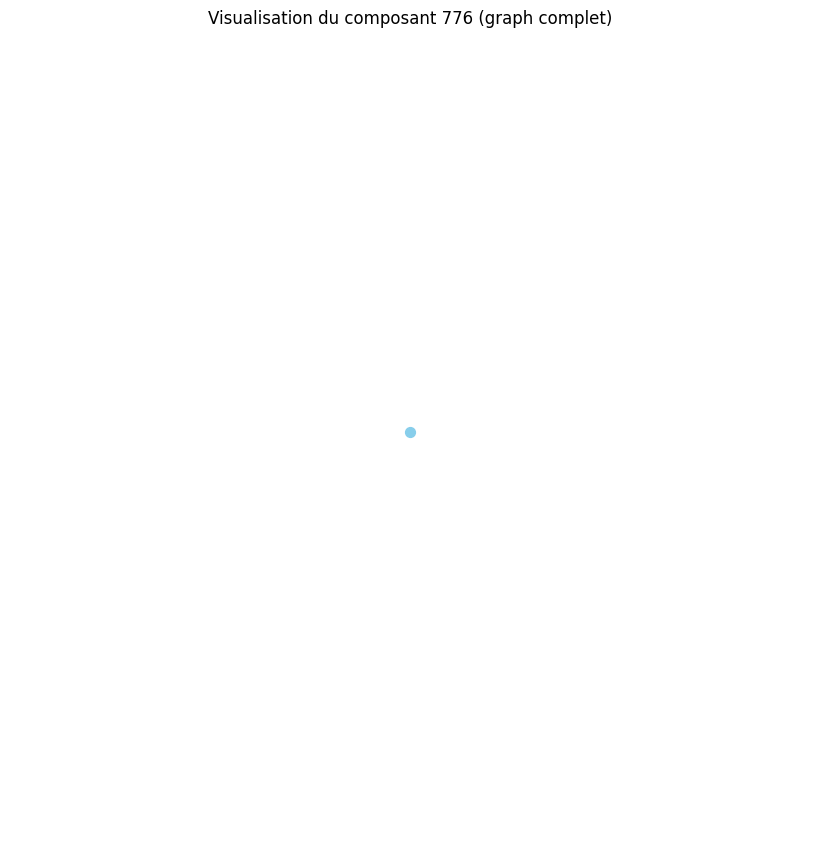

Distance moyenne pour le composant 777 : 0.00
Le composant 777 est un graphe complet ou très densément connecté.
Densité du composant 777 : 0.00
Degré moyen du composant 777 : 0.00
Coefficient de clustering moyen du composant 777 : 0.00


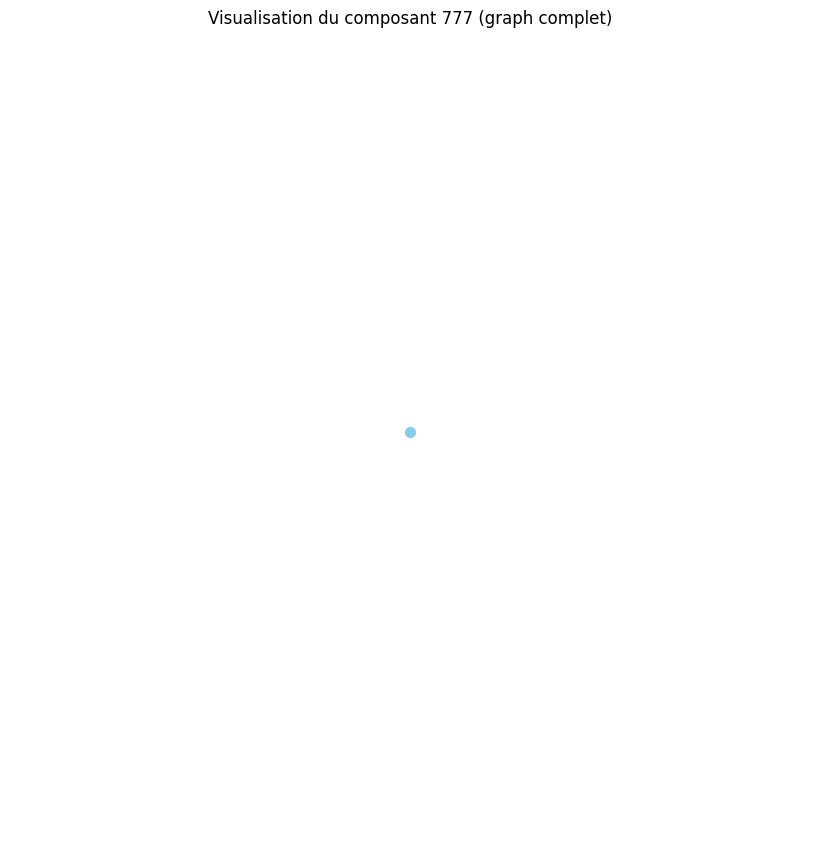

Distance moyenne pour le composant 778 : 0.00
Le composant 778 est un graphe complet ou très densément connecté.
Densité du composant 778 : 0.00
Degré moyen du composant 778 : 0.00
Coefficient de clustering moyen du composant 778 : 0.00


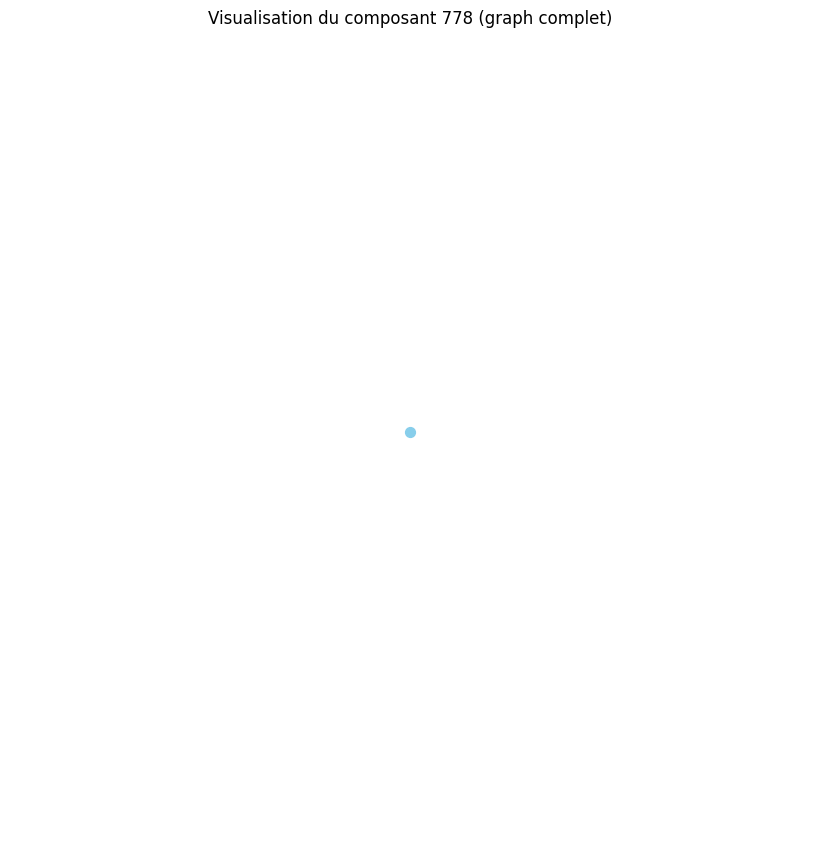

Distance moyenne pour le composant 779 : 0.00
Le composant 779 est un graphe complet ou très densément connecté.
Densité du composant 779 : 0.00
Degré moyen du composant 779 : 0.00
Coefficient de clustering moyen du composant 779 : 0.00


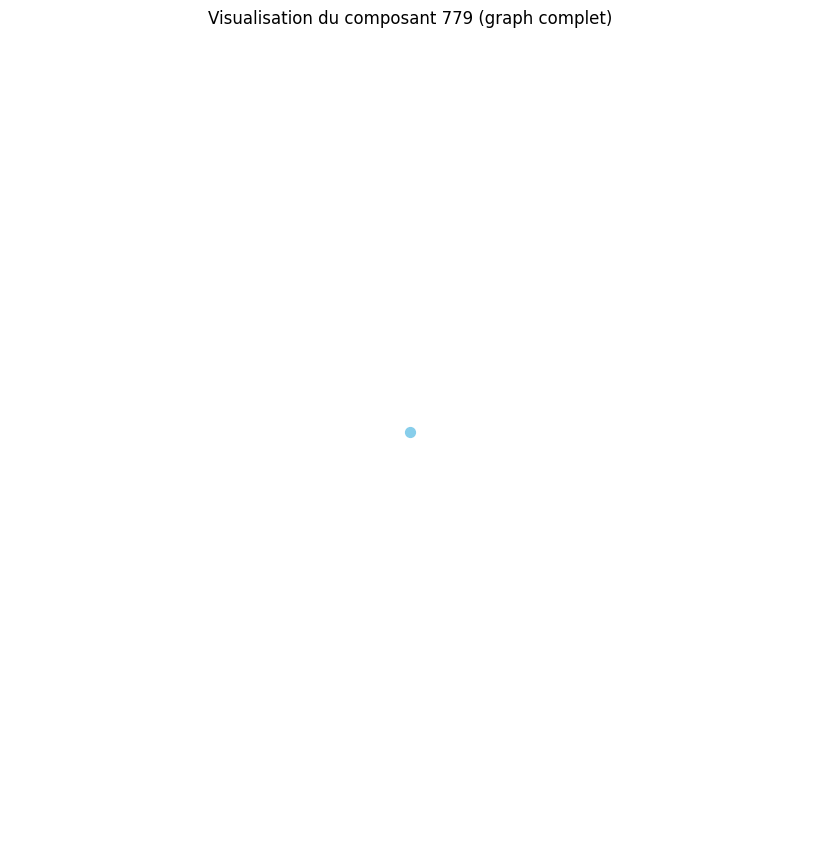

Distance moyenne pour le composant 780 : 0.00
Le composant 780 est un graphe complet ou très densément connecté.
Densité du composant 780 : 0.00
Degré moyen du composant 780 : 0.00
Coefficient de clustering moyen du composant 780 : 0.00


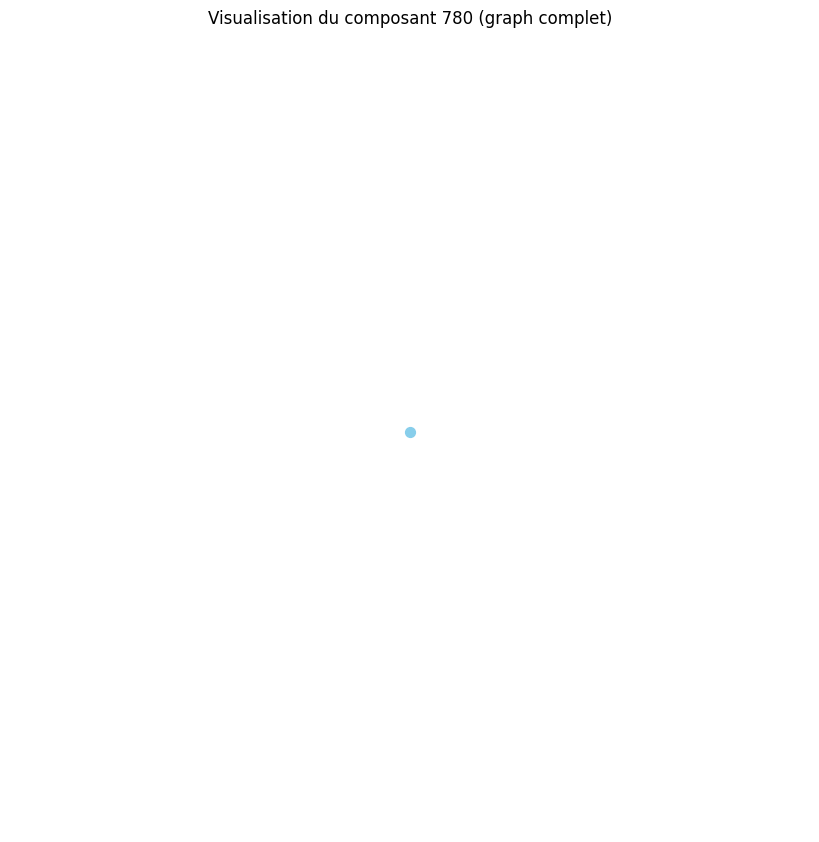

Distance moyenne pour le composant 781 : 0.00
Le composant 781 est un graphe complet ou très densément connecté.
Densité du composant 781 : 0.00
Degré moyen du composant 781 : 0.00
Coefficient de clustering moyen du composant 781 : 0.00


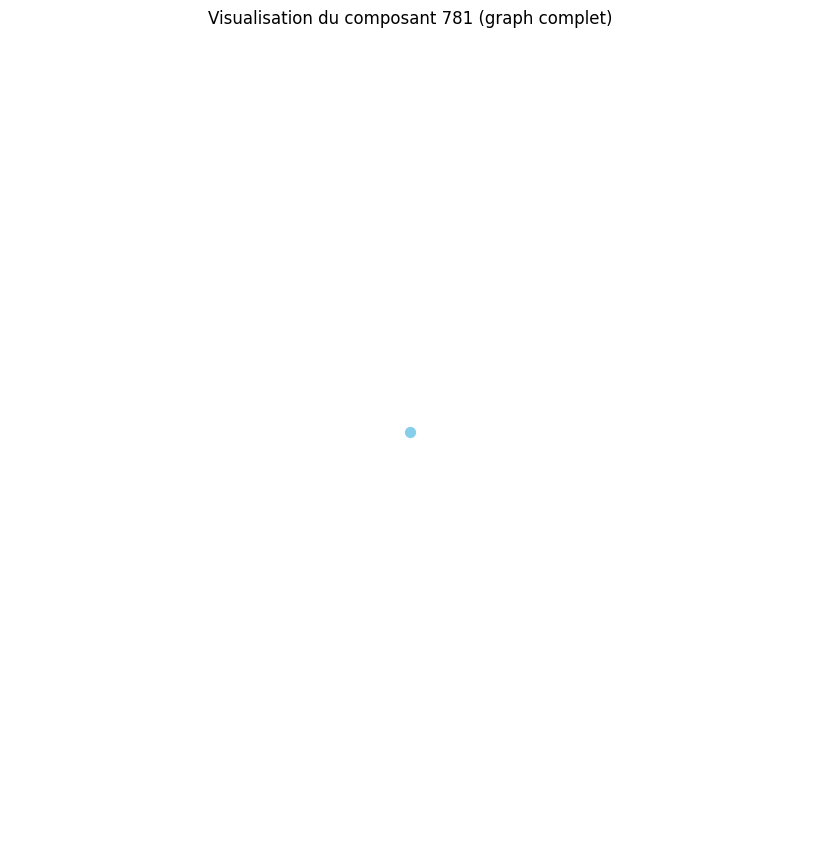

Distance moyenne pour le composant 782 : 0.00
Le composant 782 est un graphe complet ou très densément connecté.
Densité du composant 782 : 0.00
Degré moyen du composant 782 : 0.00
Coefficient de clustering moyen du composant 782 : 0.00


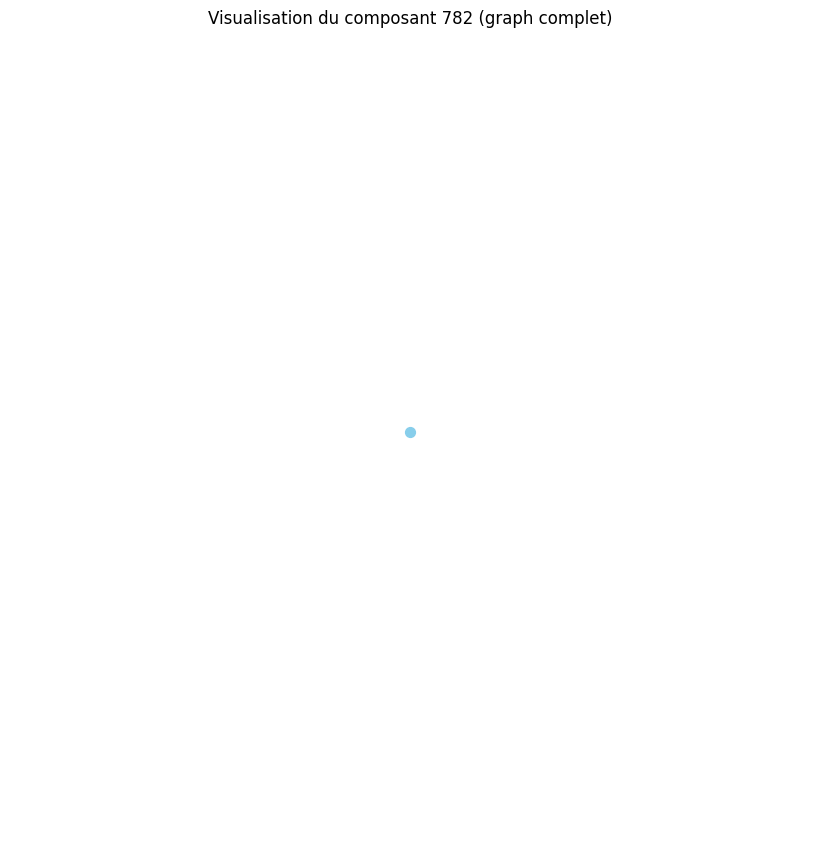

Distance moyenne pour le composant 783 : 0.00
Le composant 783 est un graphe complet ou très densément connecté.
Densité du composant 783 : 0.00
Degré moyen du composant 783 : 0.00
Coefficient de clustering moyen du composant 783 : 0.00


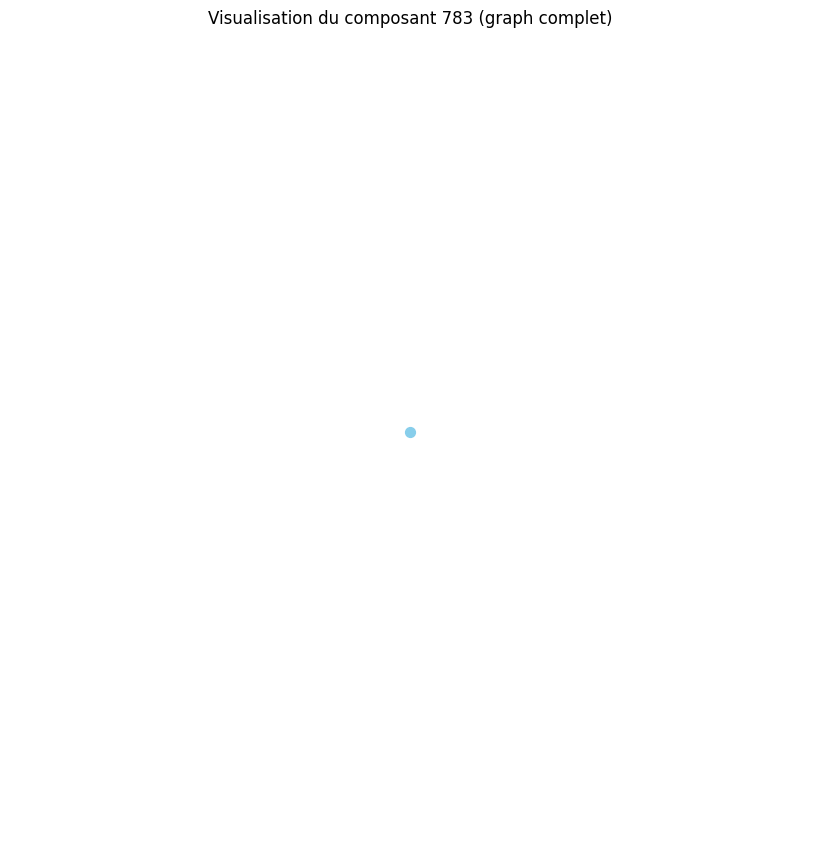

Distance moyenne pour le composant 784 : 0.00
Le composant 784 est un graphe complet ou très densément connecté.
Densité du composant 784 : 0.00
Degré moyen du composant 784 : 0.00
Coefficient de clustering moyen du composant 784 : 0.00


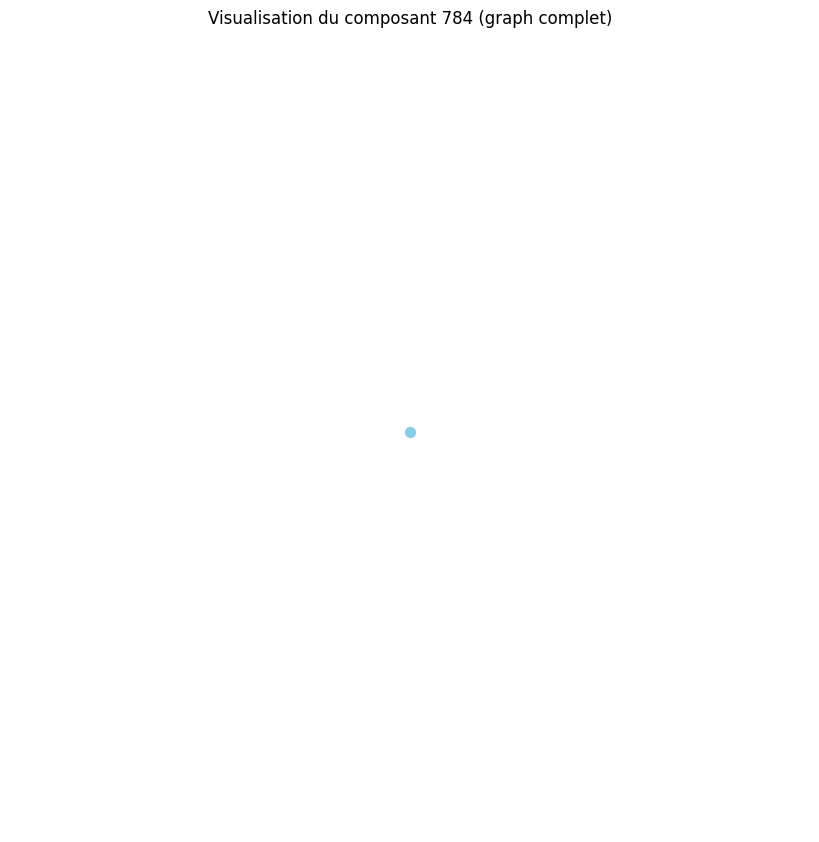

Distance moyenne pour le composant 785 : 0.00
Le composant 785 est un graphe complet ou très densément connecté.
Densité du composant 785 : 0.00
Degré moyen du composant 785 : 0.00
Coefficient de clustering moyen du composant 785 : 0.00


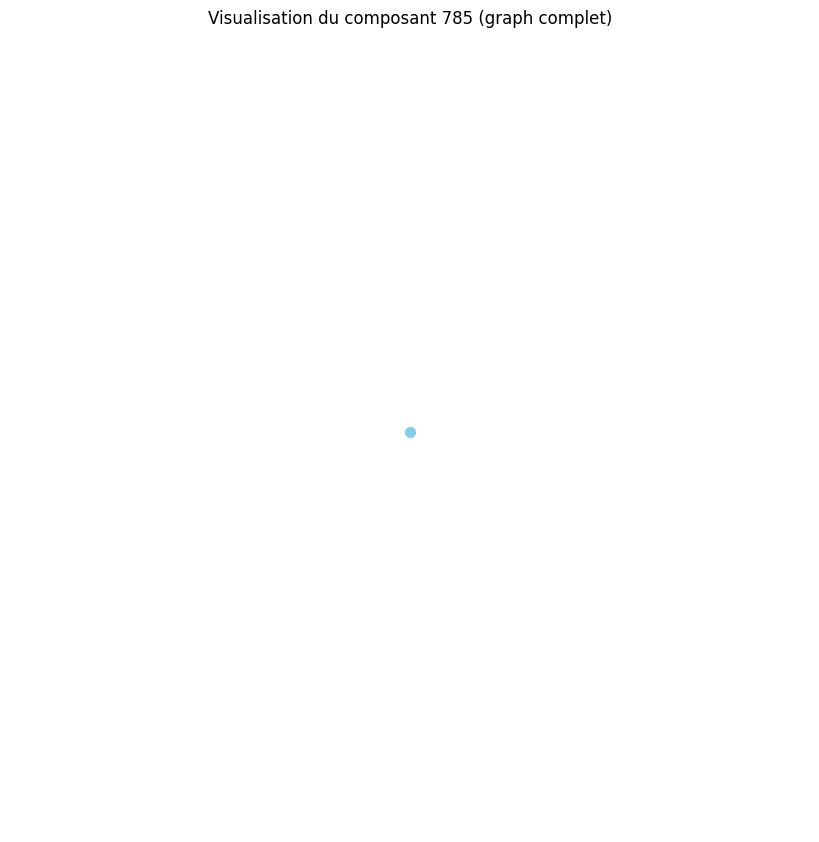

Distance moyenne pour le composant 786 : 0.00
Le composant 786 est un graphe complet ou très densément connecté.
Densité du composant 786 : 0.00
Degré moyen du composant 786 : 0.00
Coefficient de clustering moyen du composant 786 : 0.00


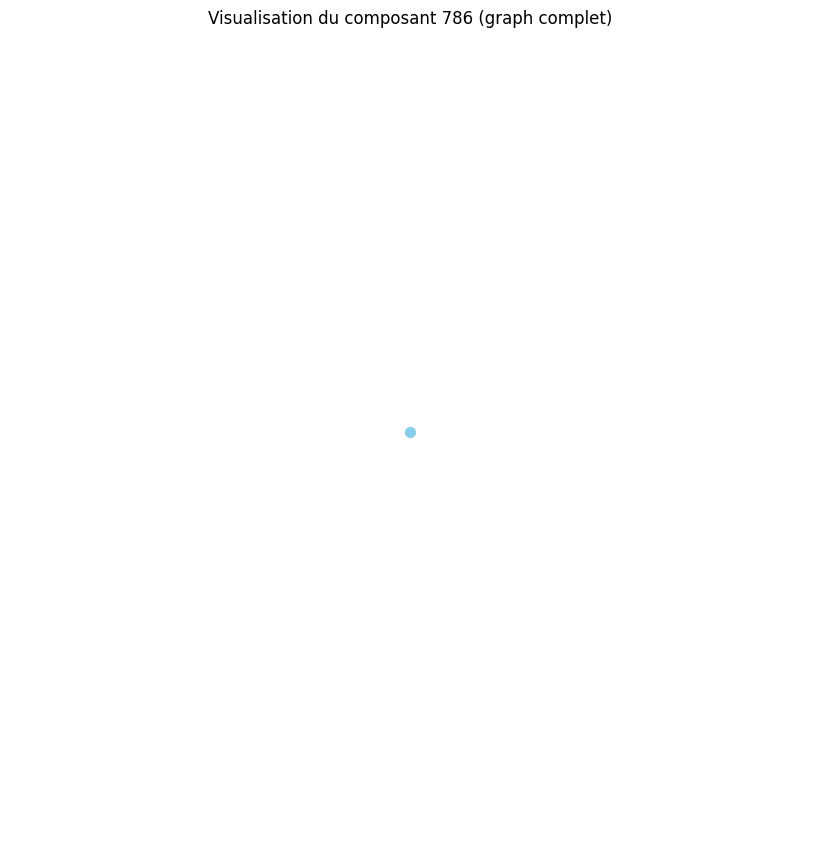

Distance moyenne pour le composant 787 : 0.00
Le composant 787 est un graphe complet ou très densément connecté.
Densité du composant 787 : 0.00
Degré moyen du composant 787 : 0.00
Coefficient de clustering moyen du composant 787 : 0.00


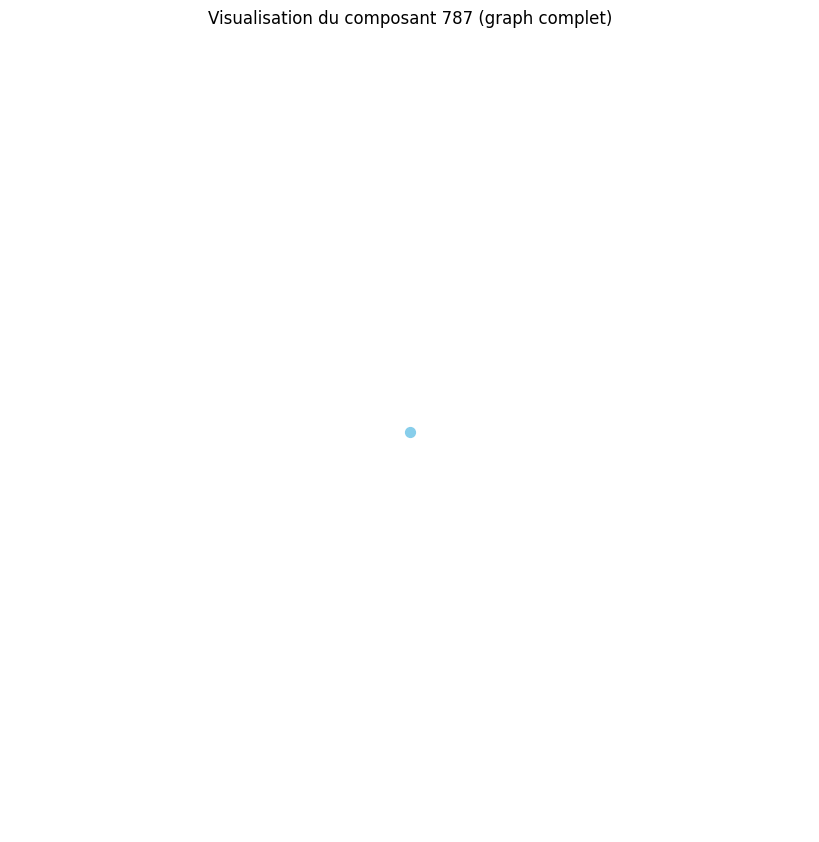

Distance moyenne pour le composant 788 : 0.00
Le composant 788 est un graphe complet ou très densément connecté.
Densité du composant 788 : 0.00
Degré moyen du composant 788 : 0.00
Coefficient de clustering moyen du composant 788 : 0.00


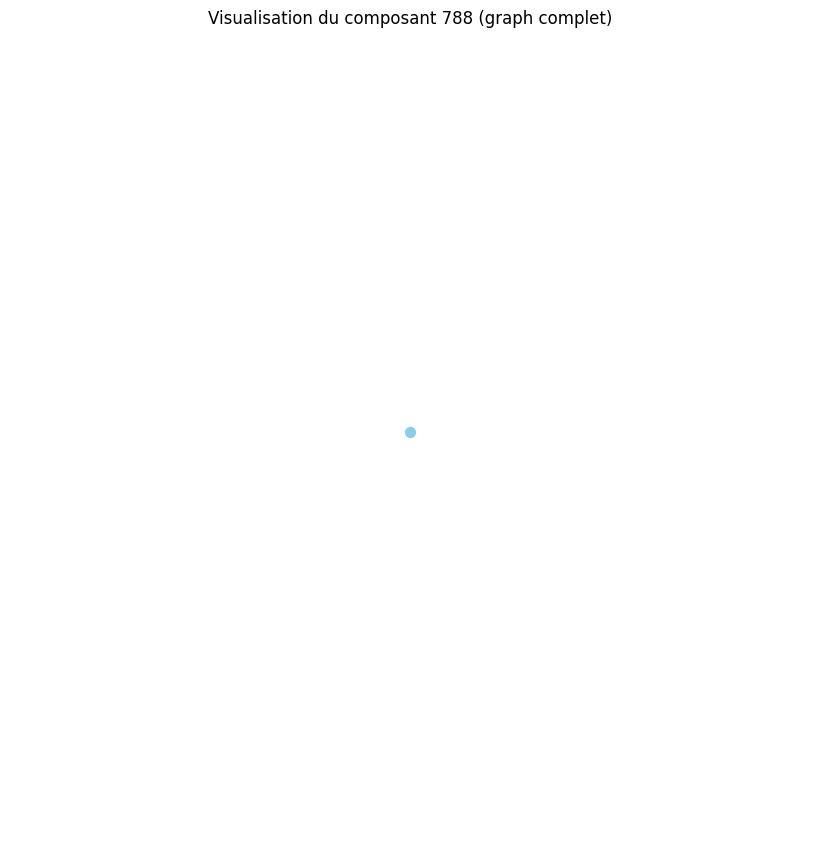

Distance moyenne pour le composant 789 : 0.00
Le composant 789 est un graphe complet ou très densément connecté.
Densité du composant 789 : 0.00
Degré moyen du composant 789 : 0.00
Coefficient de clustering moyen du composant 789 : 0.00


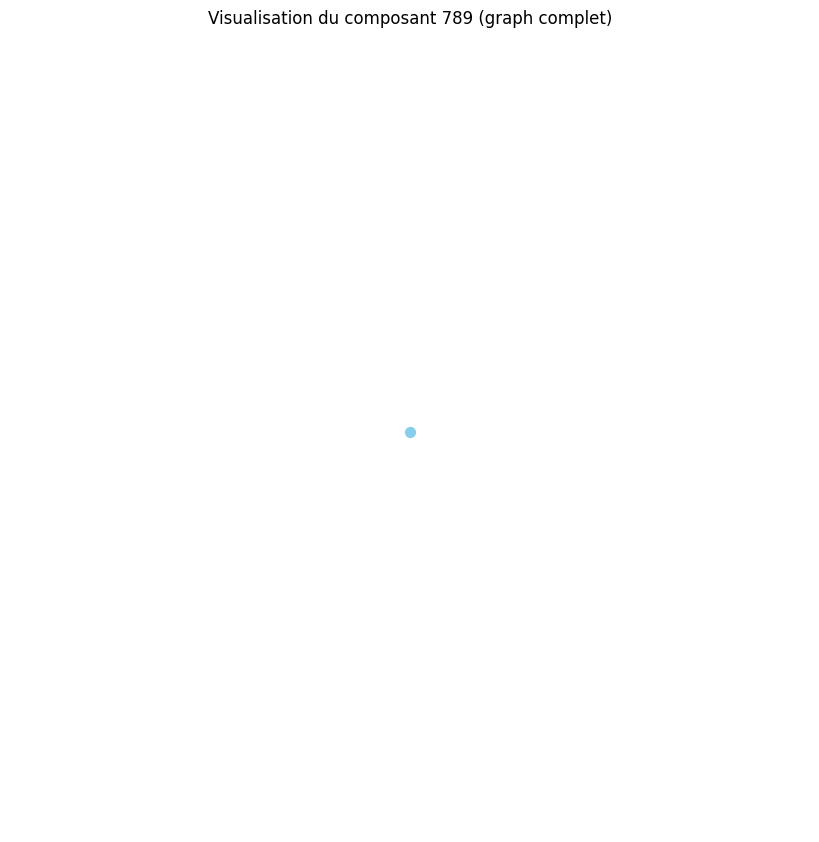

Distance moyenne pour le composant 790 : 0.00
Le composant 790 est un graphe complet ou très densément connecté.
Densité du composant 790 : 0.00
Degré moyen du composant 790 : 0.00
Coefficient de clustering moyen du composant 790 : 0.00


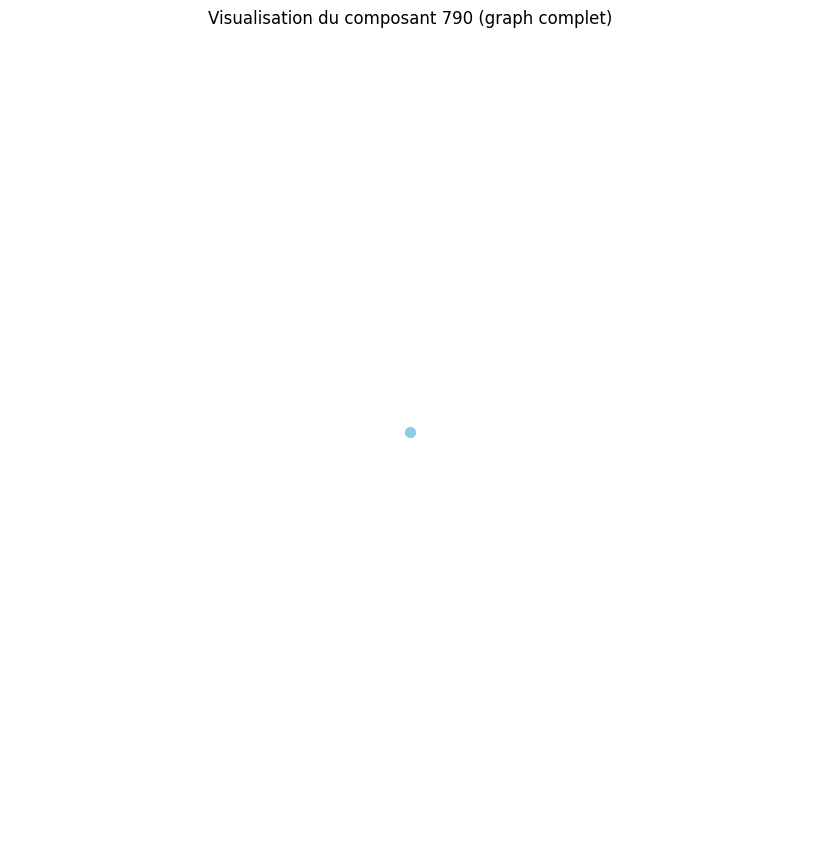

Distance moyenne pour le composant 791 : 0.00
Le composant 791 est un graphe complet ou très densément connecté.
Densité du composant 791 : 0.00
Degré moyen du composant 791 : 0.00
Coefficient de clustering moyen du composant 791 : 0.00


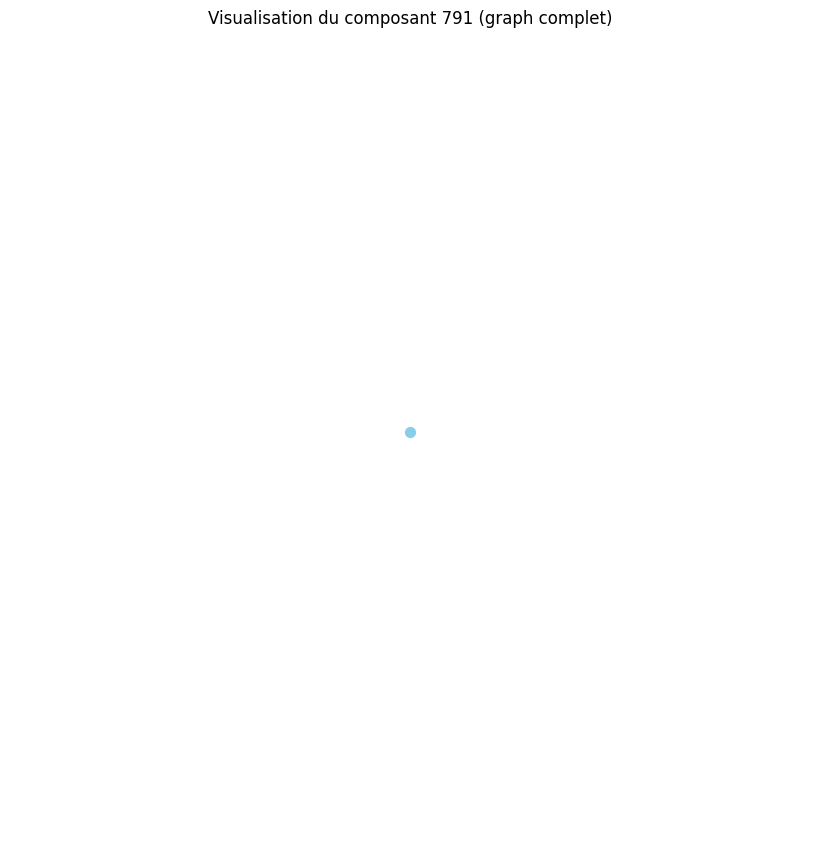

Distance moyenne pour le composant 792 : 0.00
Le composant 792 est un graphe complet ou très densément connecté.
Densité du composant 792 : 0.00
Degré moyen du composant 792 : 0.00
Coefficient de clustering moyen du composant 792 : 0.00


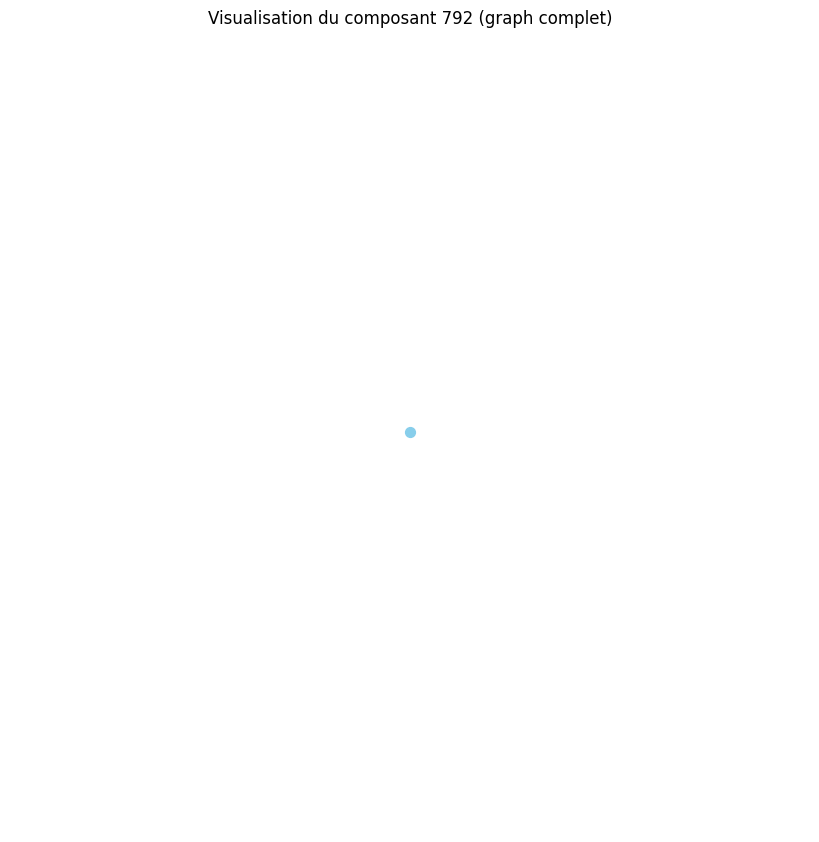

Distance moyenne pour le composant 793 : 0.00
Le composant 793 est un graphe complet ou très densément connecté.
Densité du composant 793 : 0.00
Degré moyen du composant 793 : 0.00
Coefficient de clustering moyen du composant 793 : 0.00


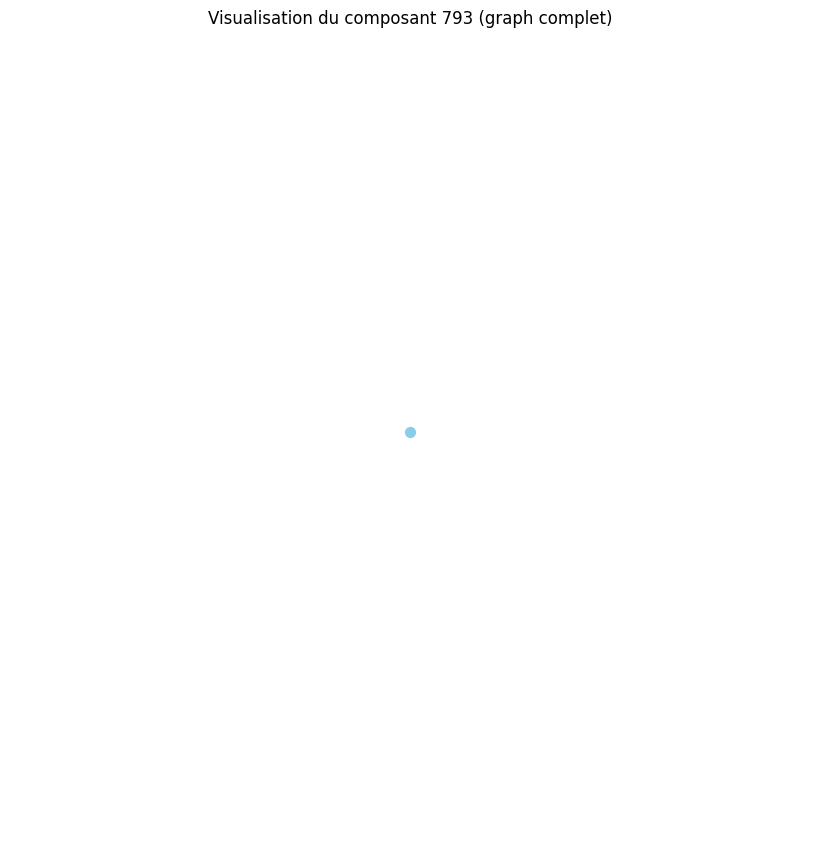

Distance moyenne pour le composant 794 : 0.00
Le composant 794 est un graphe complet ou très densément connecté.
Densité du composant 794 : 0.00
Degré moyen du composant 794 : 0.00
Coefficient de clustering moyen du composant 794 : 0.00


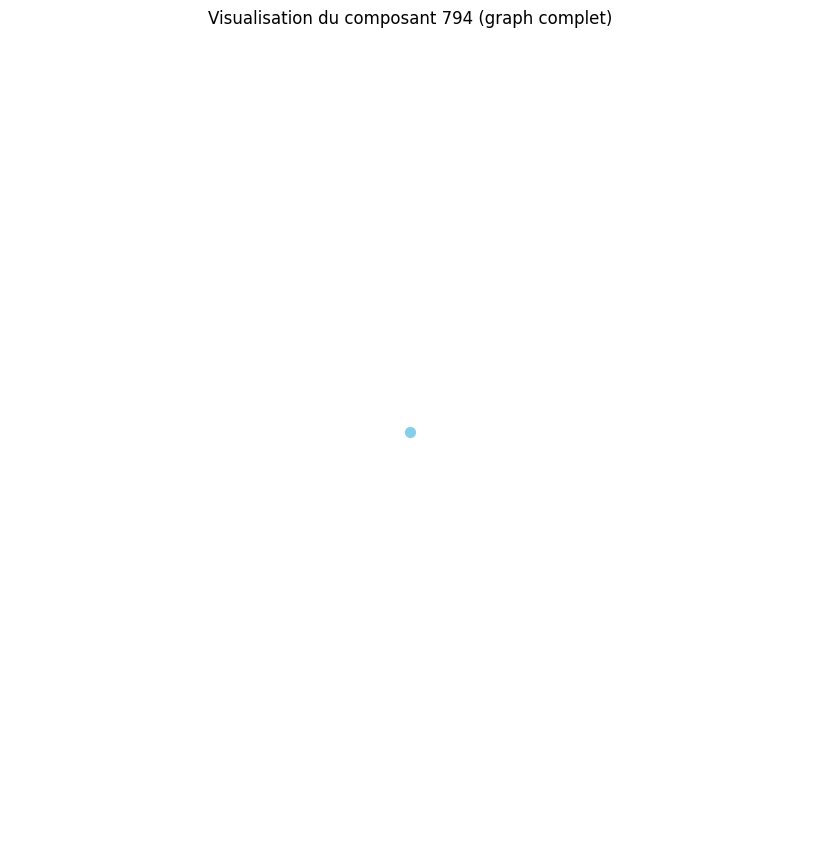

Distance moyenne pour le composant 795 : 0.00
Le composant 795 est un graphe complet ou très densément connecté.
Densité du composant 795 : 0.00
Degré moyen du composant 795 : 0.00
Coefficient de clustering moyen du composant 795 : 0.00


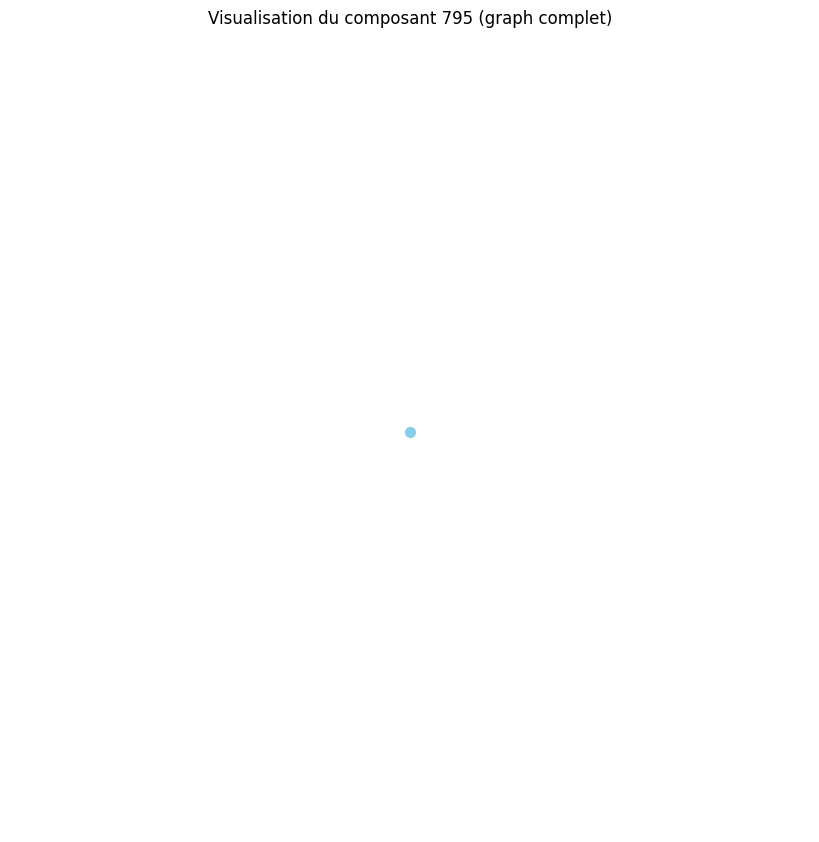

Distance moyenne pour le composant 796 : 0.00
Le composant 796 est un graphe complet ou très densément connecté.
Densité du composant 796 : 0.00
Degré moyen du composant 796 : 0.00
Coefficient de clustering moyen du composant 796 : 0.00


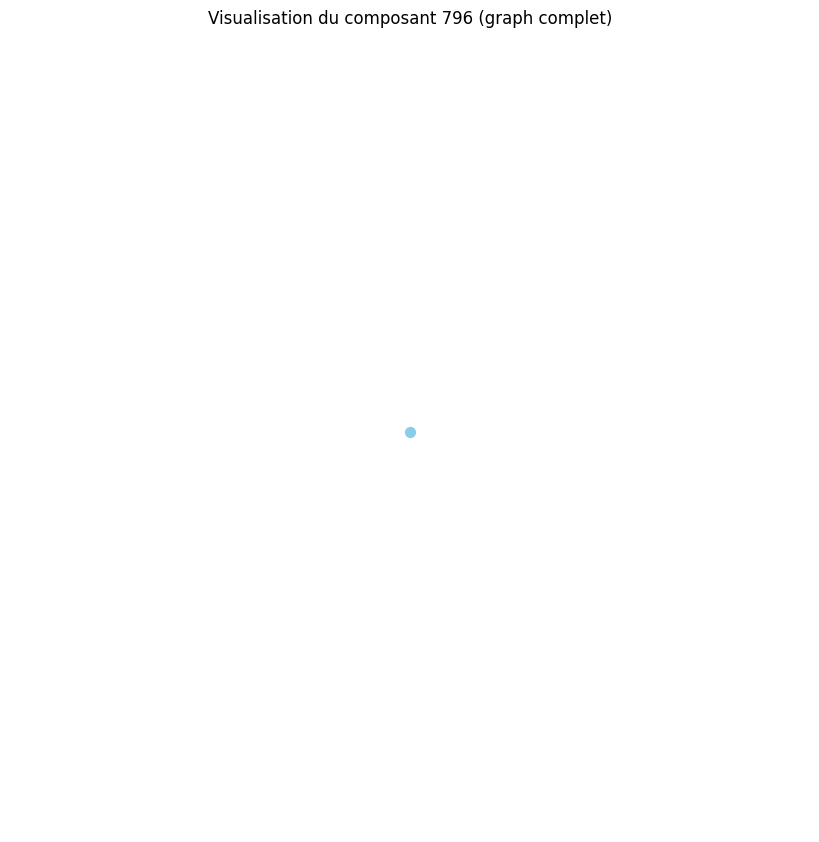

Distance moyenne pour le composant 797 : 0.00
Le composant 797 est un graphe complet ou très densément connecté.
Densité du composant 797 : 0.00
Degré moyen du composant 797 : 0.00
Coefficient de clustering moyen du composant 797 : 0.00


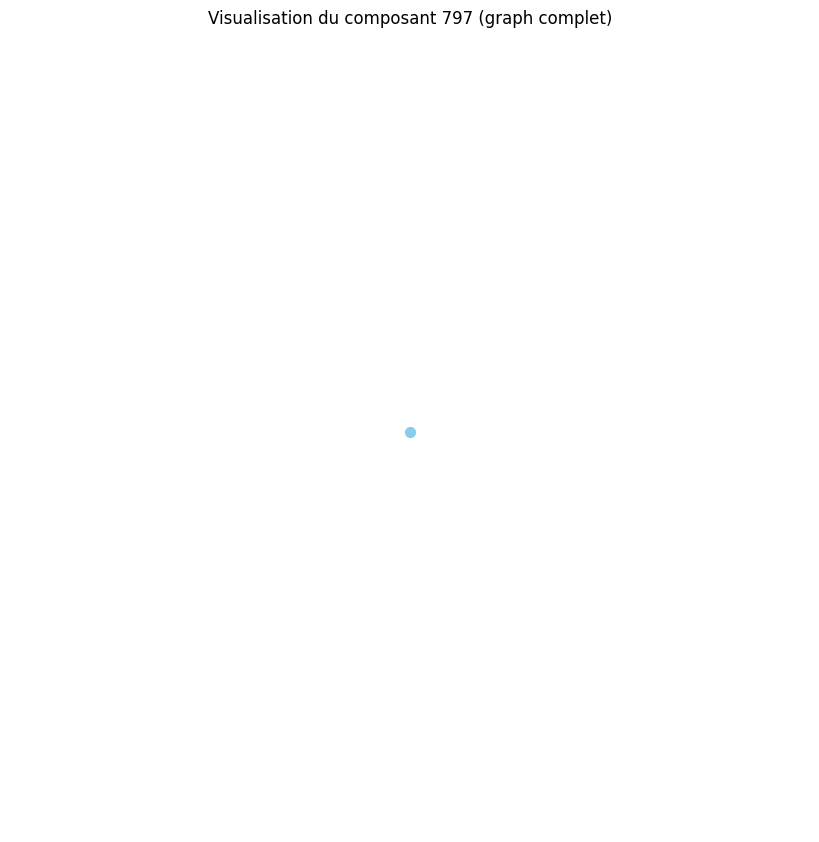

Distance moyenne pour le composant 798 : 0.00
Le composant 798 est un graphe complet ou très densément connecté.
Densité du composant 798 : 0.00
Degré moyen du composant 798 : 0.00
Coefficient de clustering moyen du composant 798 : 0.00


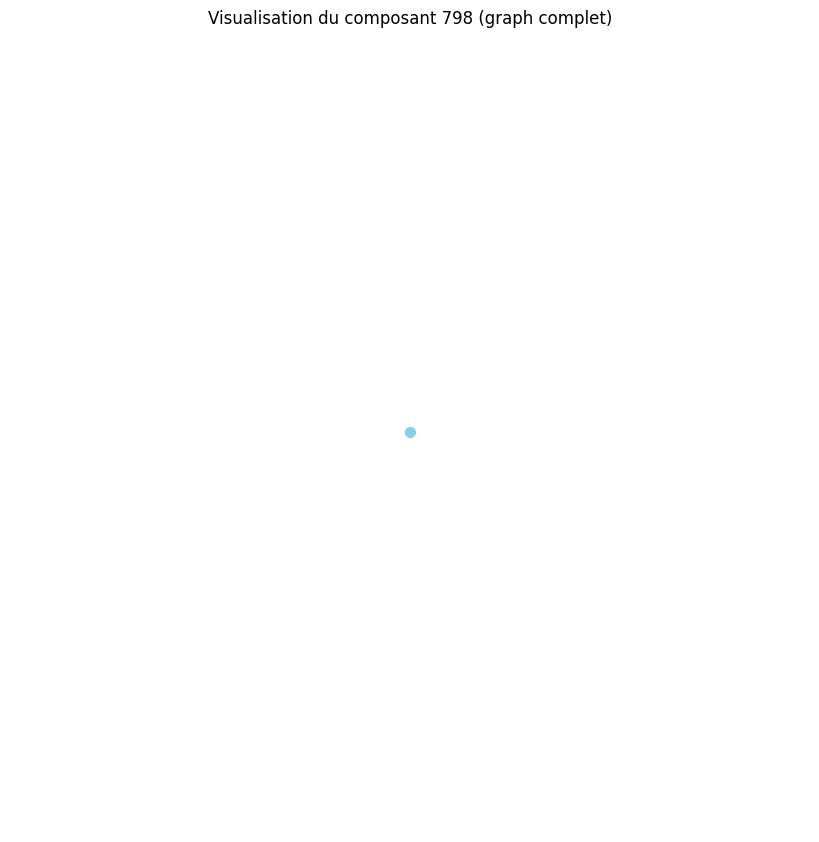

Distance moyenne pour le composant 799 : 0.00
Le composant 799 est un graphe complet ou très densément connecté.
Densité du composant 799 : 0.00
Degré moyen du composant 799 : 0.00
Coefficient de clustering moyen du composant 799 : 0.00


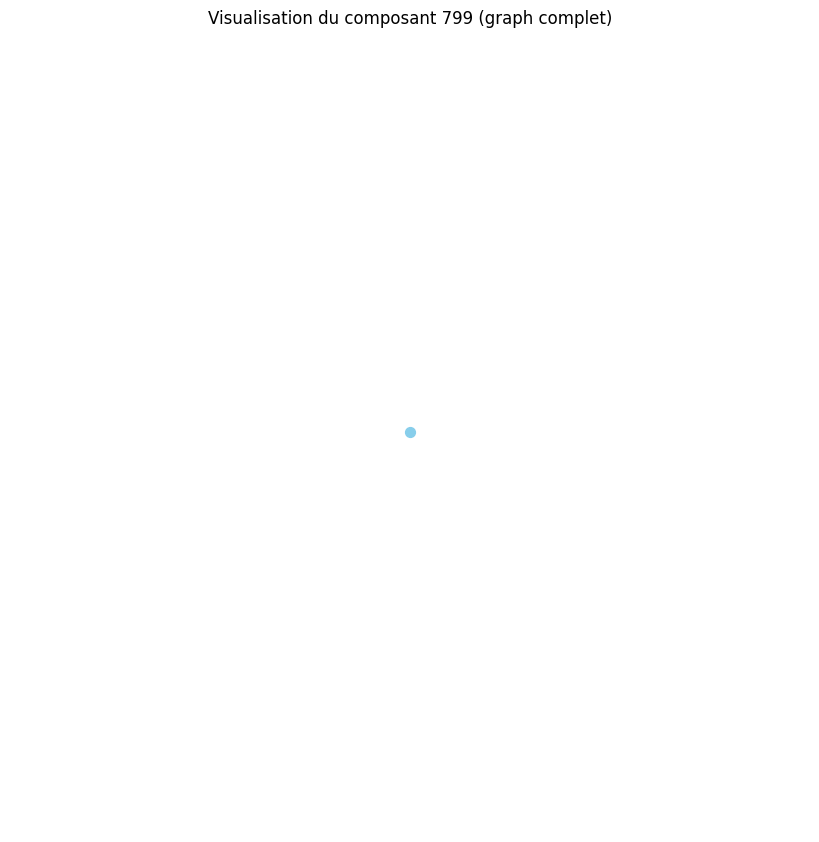

Distance moyenne pour le composant 800 : 0.00
Le composant 800 est un graphe complet ou très densément connecté.
Densité du composant 800 : 0.00
Degré moyen du composant 800 : 0.00
Coefficient de clustering moyen du composant 800 : 0.00


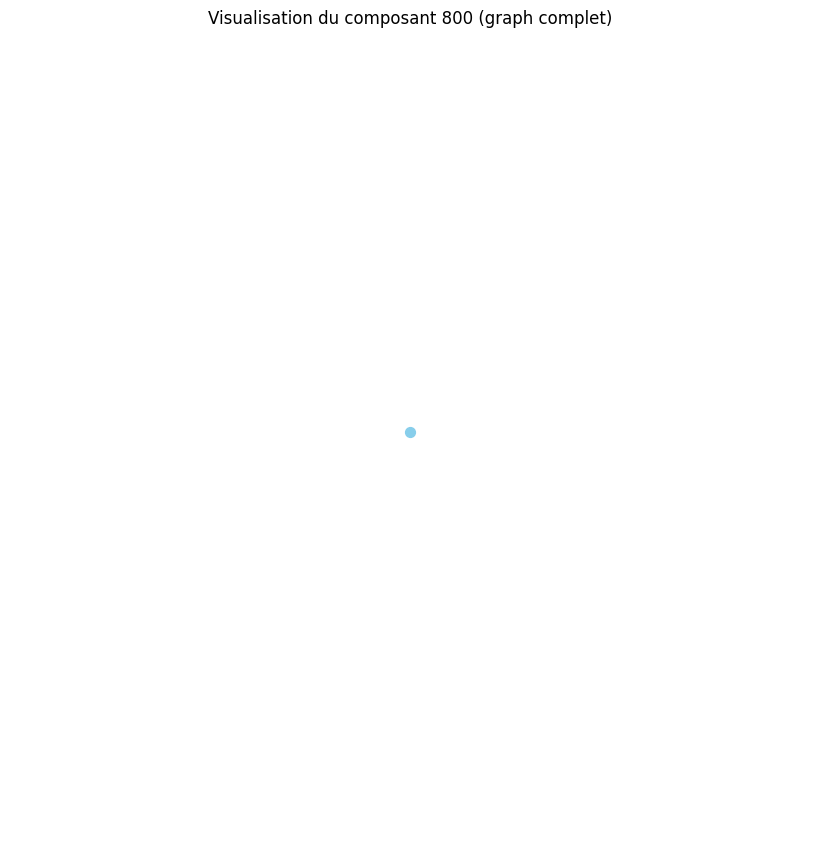

Distance moyenne pour le composant 801 : 0.00
Le composant 801 est un graphe complet ou très densément connecté.
Densité du composant 801 : 0.00
Degré moyen du composant 801 : 0.00
Coefficient de clustering moyen du composant 801 : 0.00


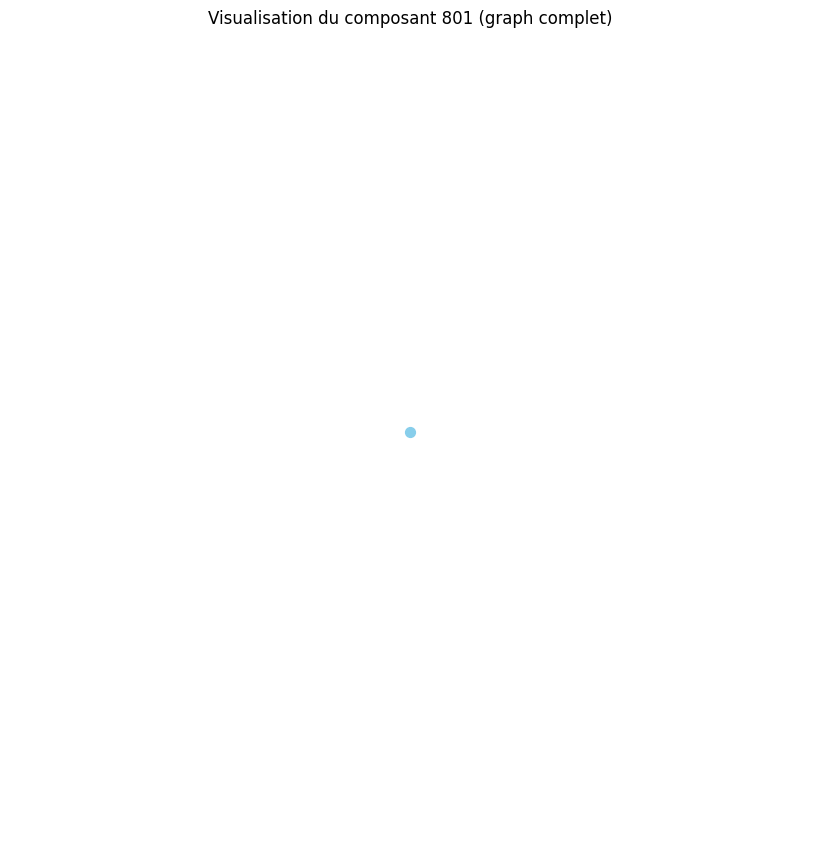

Distance moyenne pour le composant 802 : 0.00
Le composant 802 est un graphe complet ou très densément connecté.
Densité du composant 802 : 0.00
Degré moyen du composant 802 : 0.00
Coefficient de clustering moyen du composant 802 : 0.00


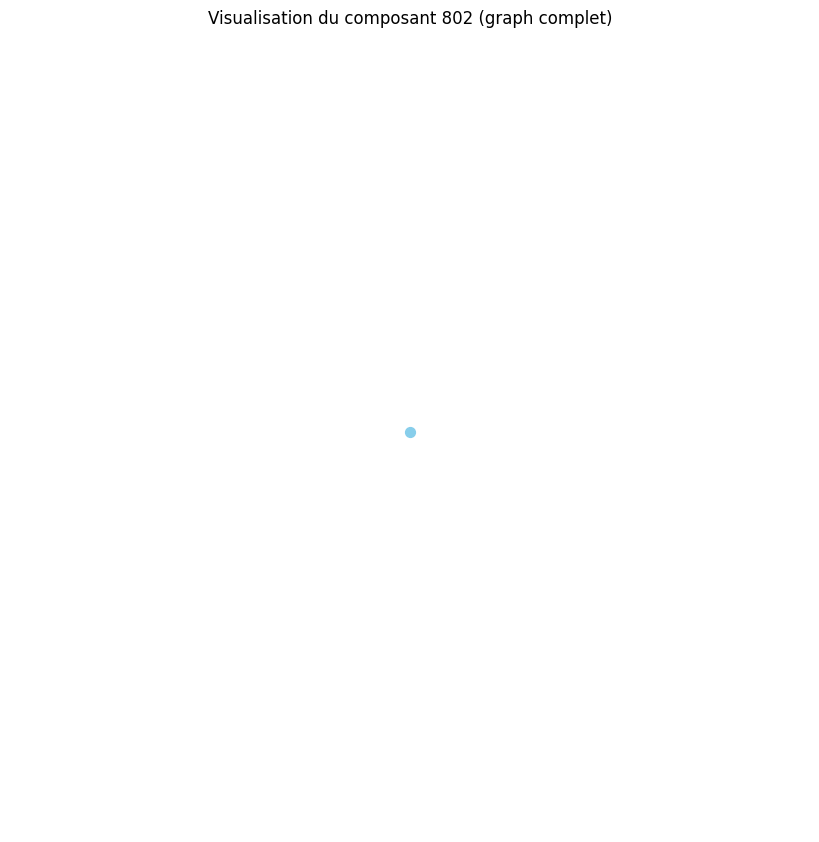

Distance moyenne pour le composant 803 : 0.00
Le composant 803 est un graphe complet ou très densément connecté.
Densité du composant 803 : 0.00
Degré moyen du composant 803 : 0.00
Coefficient de clustering moyen du composant 803 : 0.00


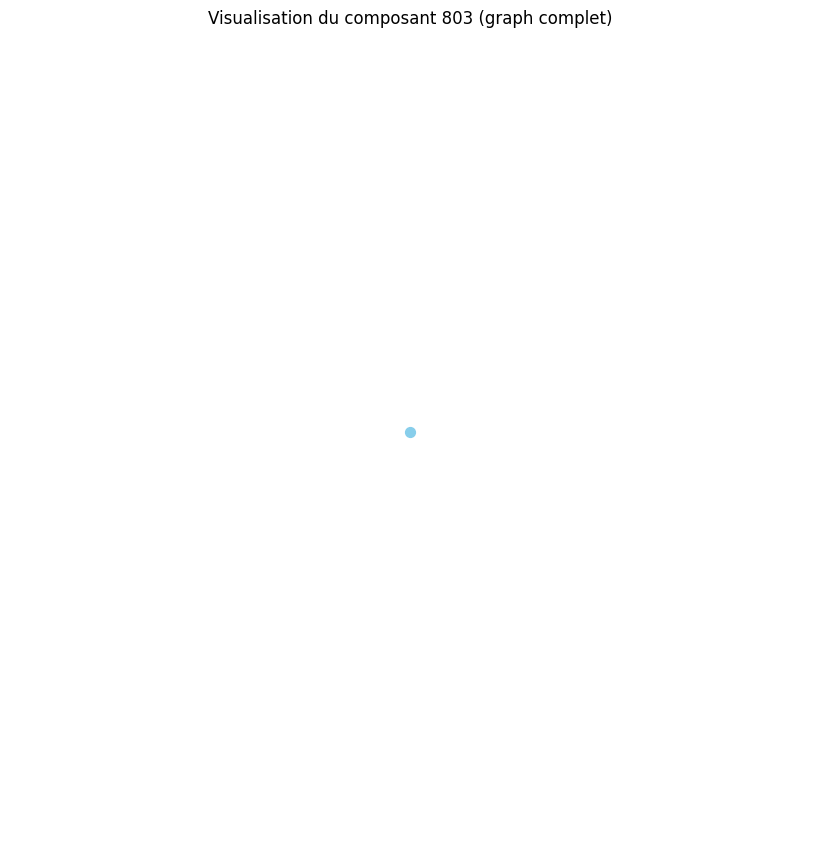

Distance moyenne pour le composant 804 : 0.00
Le composant 804 est un graphe complet ou très densément connecté.
Densité du composant 804 : 0.00
Degré moyen du composant 804 : 0.00
Coefficient de clustering moyen du composant 804 : 0.00


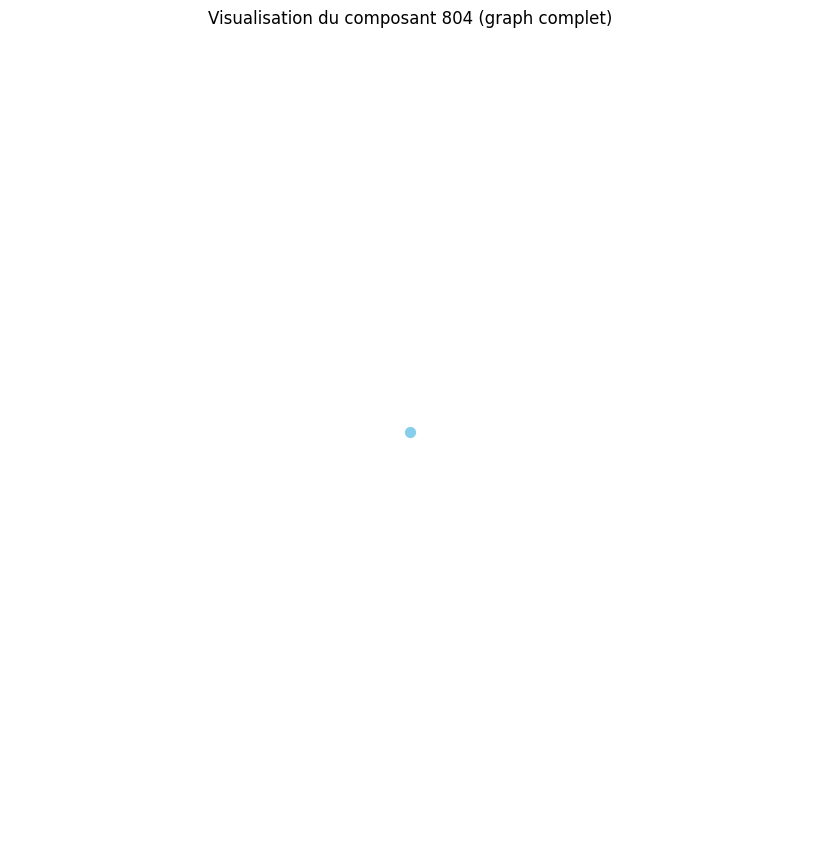

Distance moyenne pour le composant 805 : 0.00
Le composant 805 est un graphe complet ou très densément connecté.
Densité du composant 805 : 0.00
Degré moyen du composant 805 : 0.00
Coefficient de clustering moyen du composant 805 : 0.00


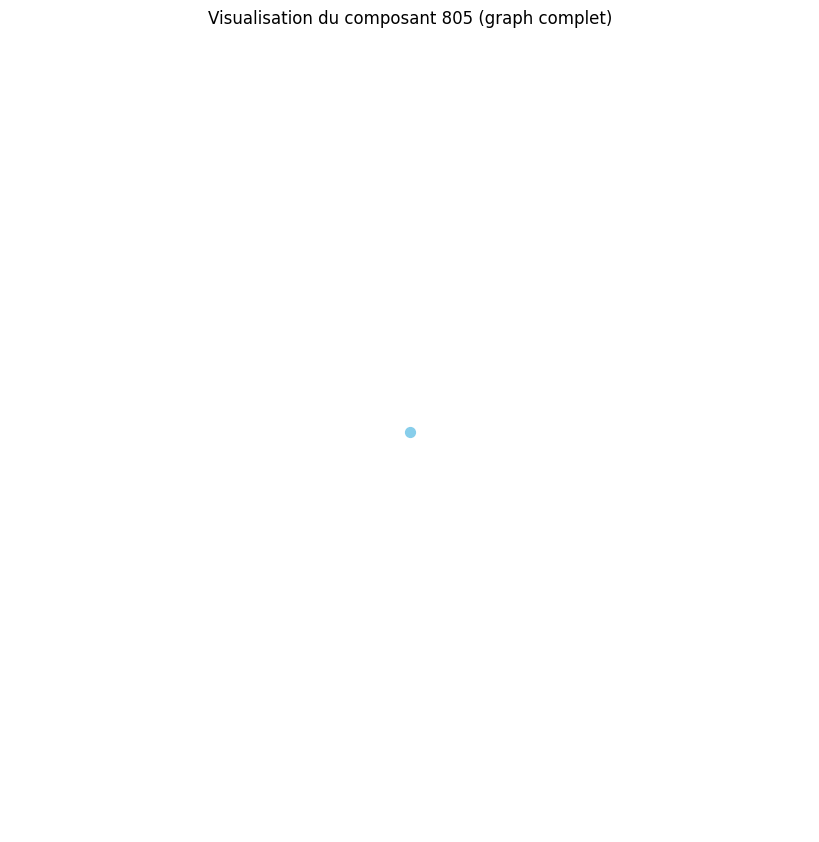

Distance moyenne pour le composant 806 : 0.00
Le composant 806 est un graphe complet ou très densément connecté.
Densité du composant 806 : 0.00
Degré moyen du composant 806 : 0.00
Coefficient de clustering moyen du composant 806 : 0.00


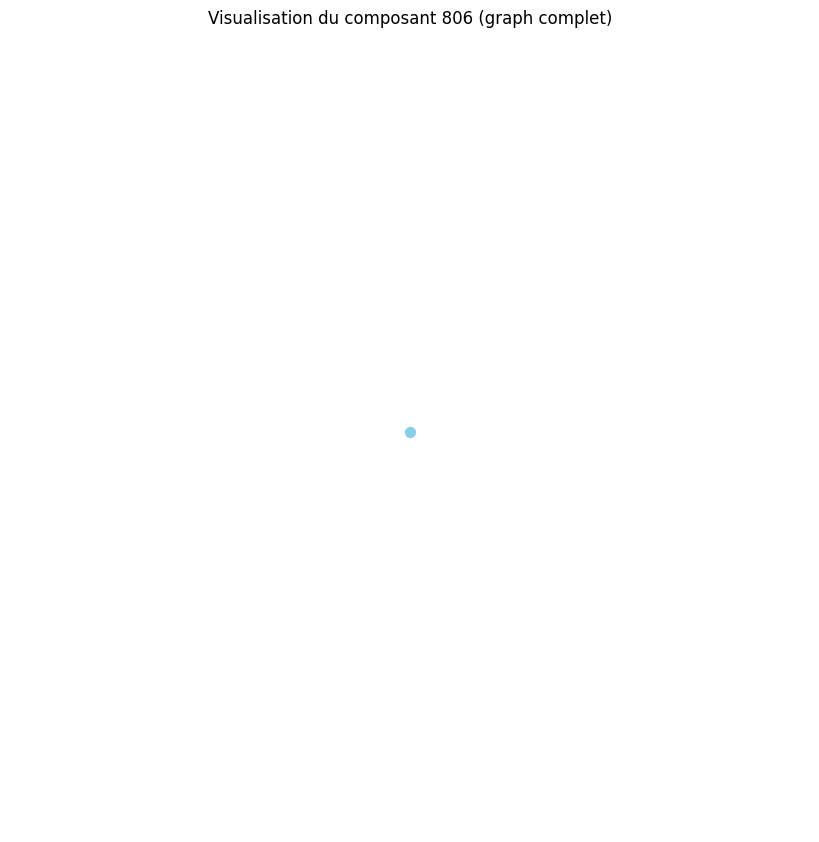

Distance moyenne pour le composant 807 : 0.00
Le composant 807 est un graphe complet ou très densément connecté.
Densité du composant 807 : 0.00
Degré moyen du composant 807 : 0.00
Coefficient de clustering moyen du composant 807 : 0.00


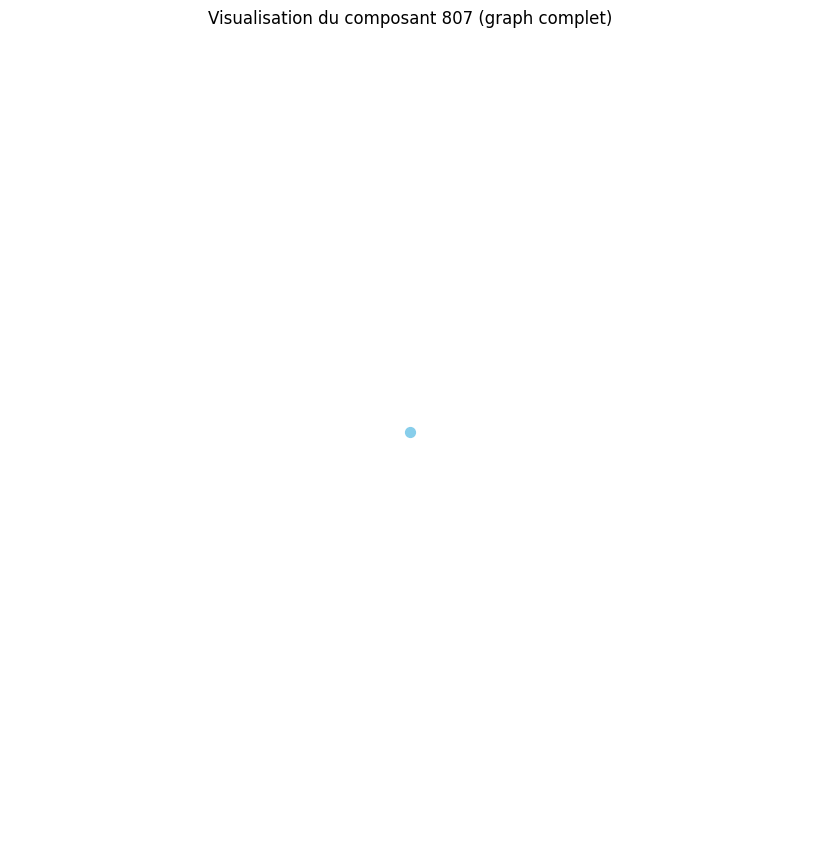

Distance moyenne pour le composant 808 : 0.00
Le composant 808 est un graphe complet ou très densément connecté.
Densité du composant 808 : 0.00
Degré moyen du composant 808 : 0.00
Coefficient de clustering moyen du composant 808 : 0.00


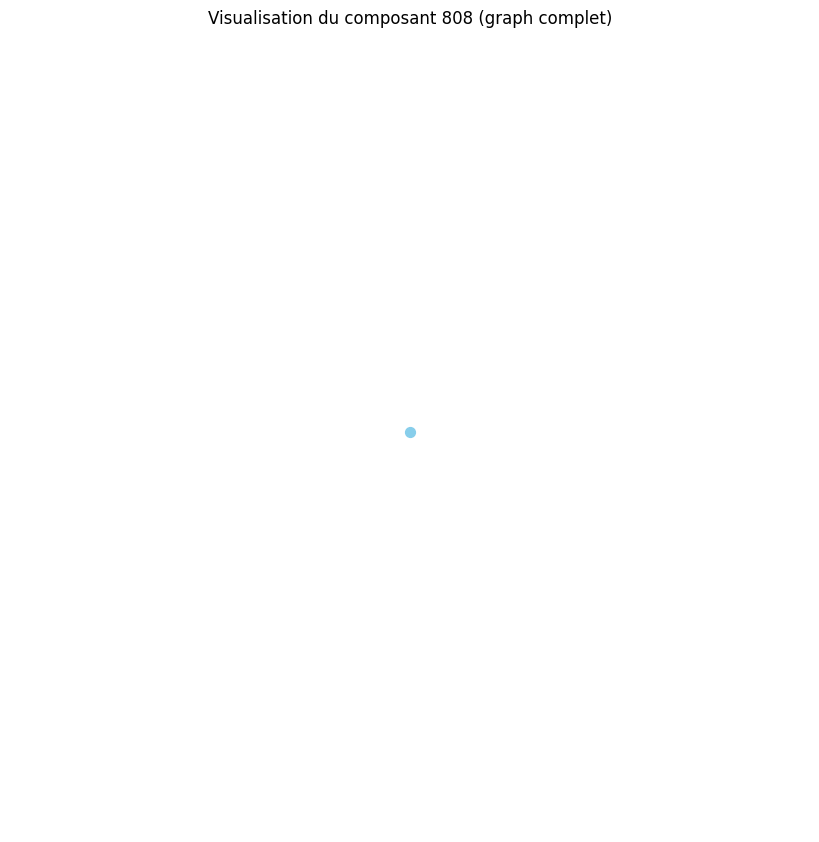

Distance moyenne pour le composant 809 : 0.00
Le composant 809 est un graphe complet ou très densément connecté.
Densité du composant 809 : 0.00
Degré moyen du composant 809 : 0.00
Coefficient de clustering moyen du composant 809 : 0.00


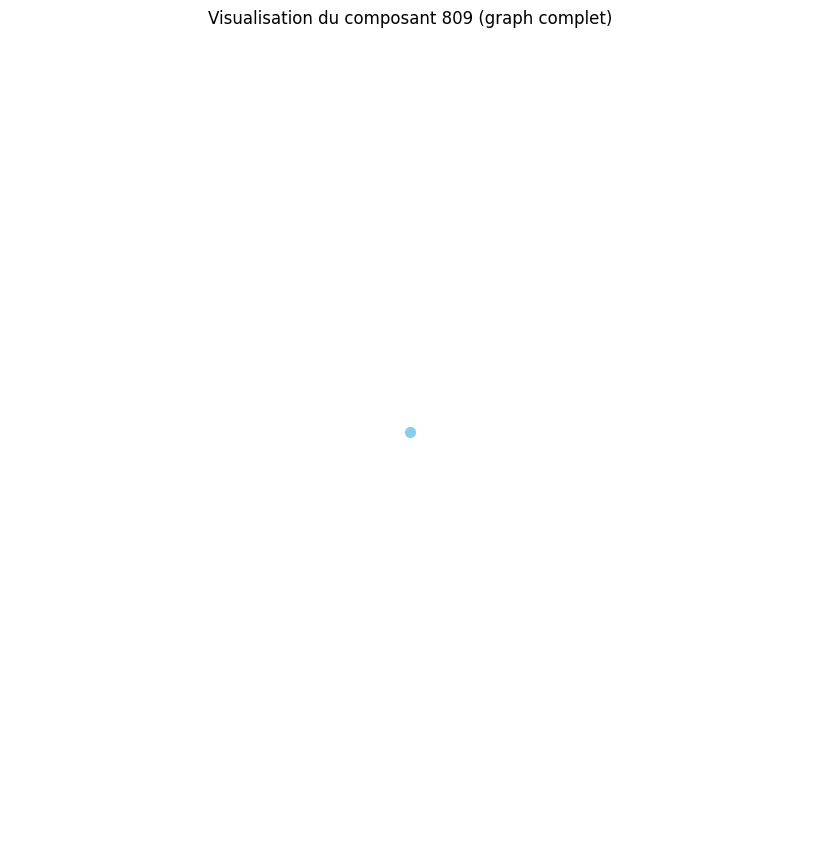

Distance moyenne pour le composant 810 : 0.00
Le composant 810 est un graphe complet ou très densément connecté.
Densité du composant 810 : 0.00
Degré moyen du composant 810 : 0.00
Coefficient de clustering moyen du composant 810 : 0.00


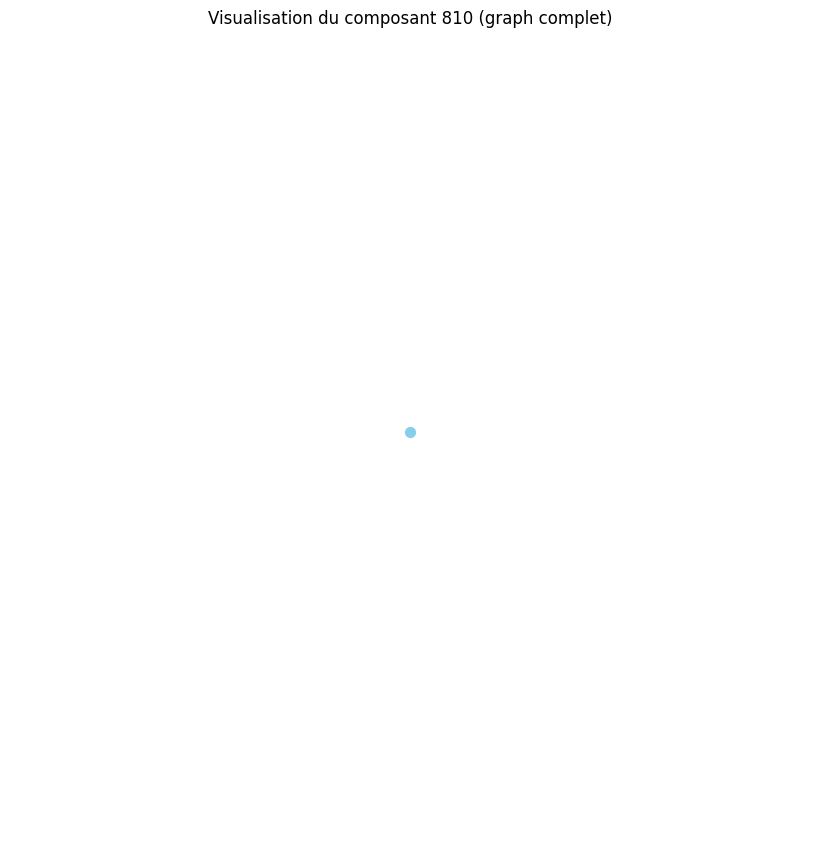

Distance moyenne pour le composant 811 : 0.00
Le composant 811 est un graphe complet ou très densément connecté.
Densité du composant 811 : 0.00
Degré moyen du composant 811 : 0.00
Coefficient de clustering moyen du composant 811 : 0.00


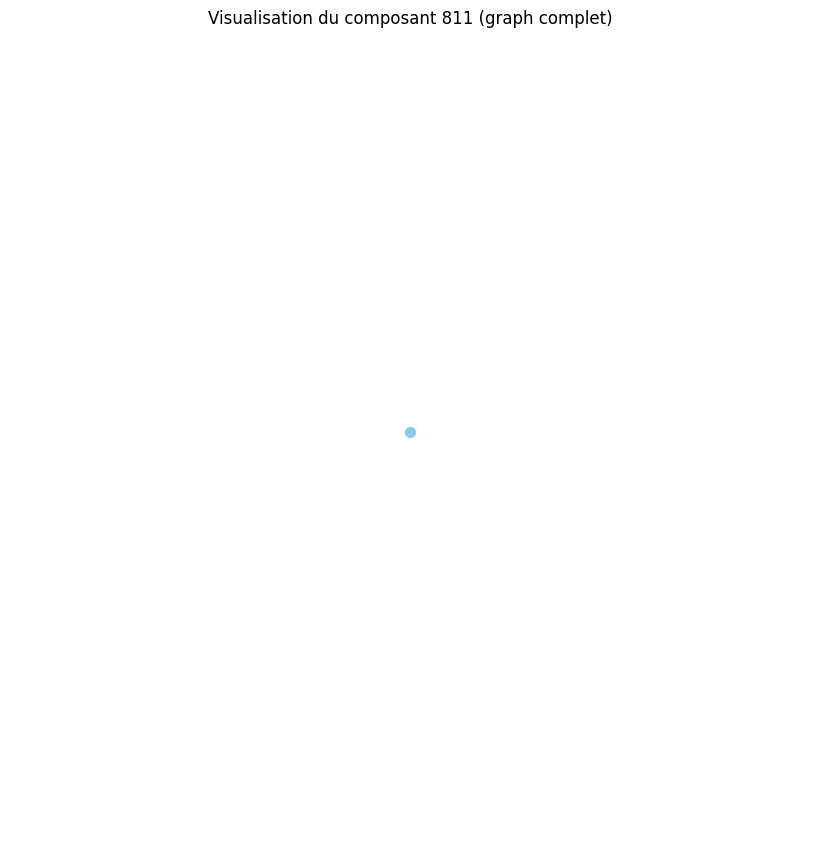

Distance moyenne pour le composant 812 : 0.00
Le composant 812 est un graphe complet ou très densément connecté.
Densité du composant 812 : 0.00
Degré moyen du composant 812 : 0.00
Coefficient de clustering moyen du composant 812 : 0.00


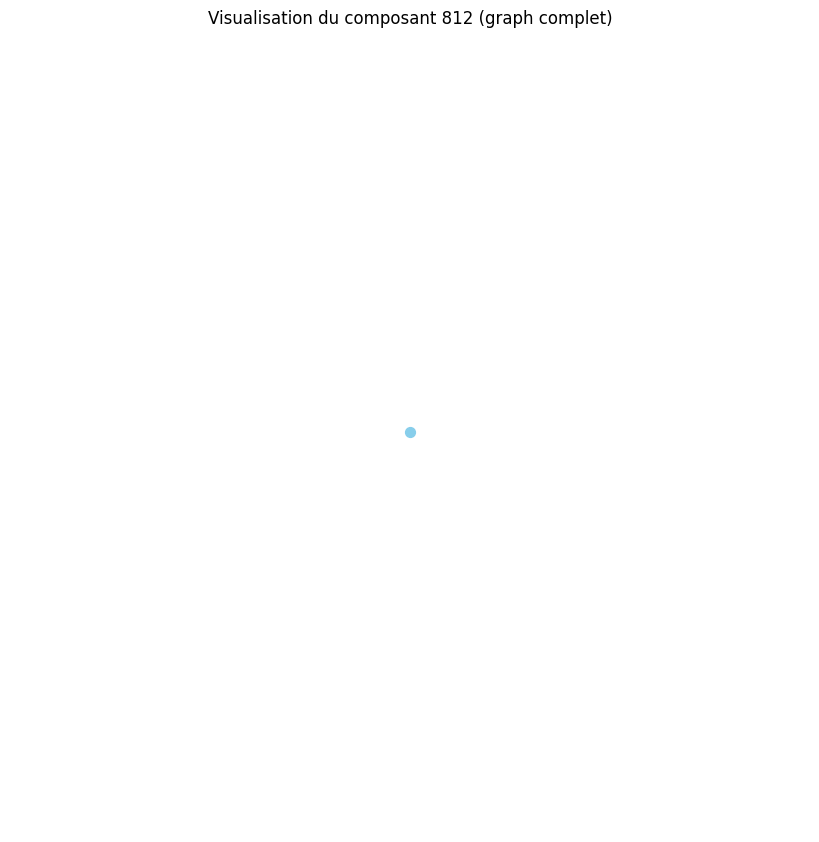

Distance moyenne pour le composant 813 : 0.00
Le composant 813 est un graphe complet ou très densément connecté.
Densité du composant 813 : 0.00
Degré moyen du composant 813 : 0.00
Coefficient de clustering moyen du composant 813 : 0.00


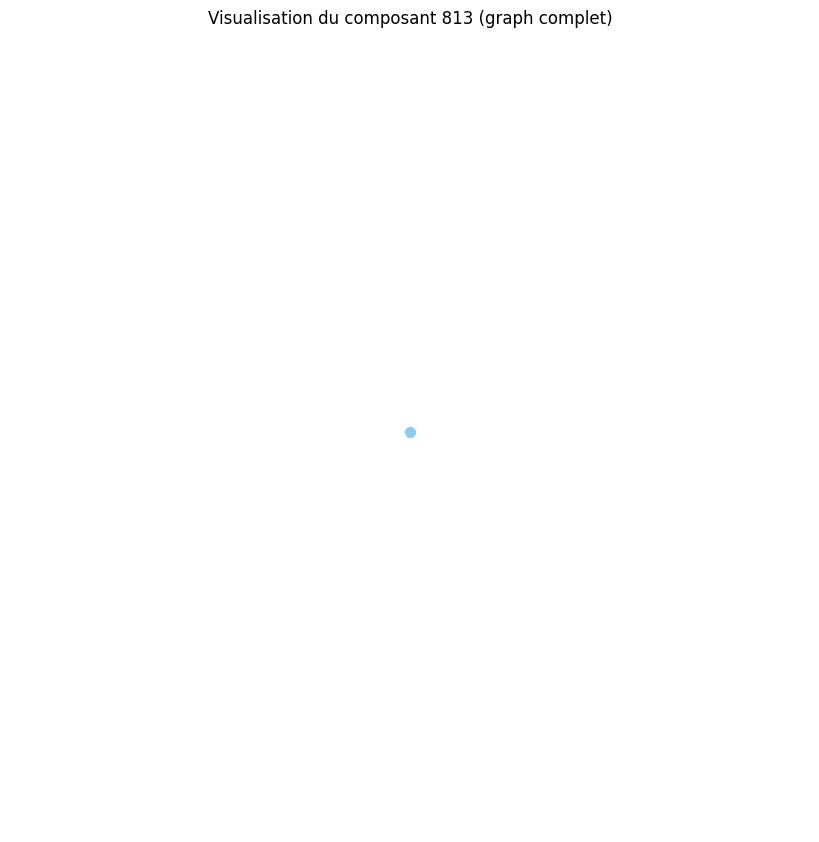

Distance moyenne pour le composant 814 : 0.00
Le composant 814 est un graphe complet ou très densément connecté.
Densité du composant 814 : 0.00
Degré moyen du composant 814 : 0.00
Coefficient de clustering moyen du composant 814 : 0.00


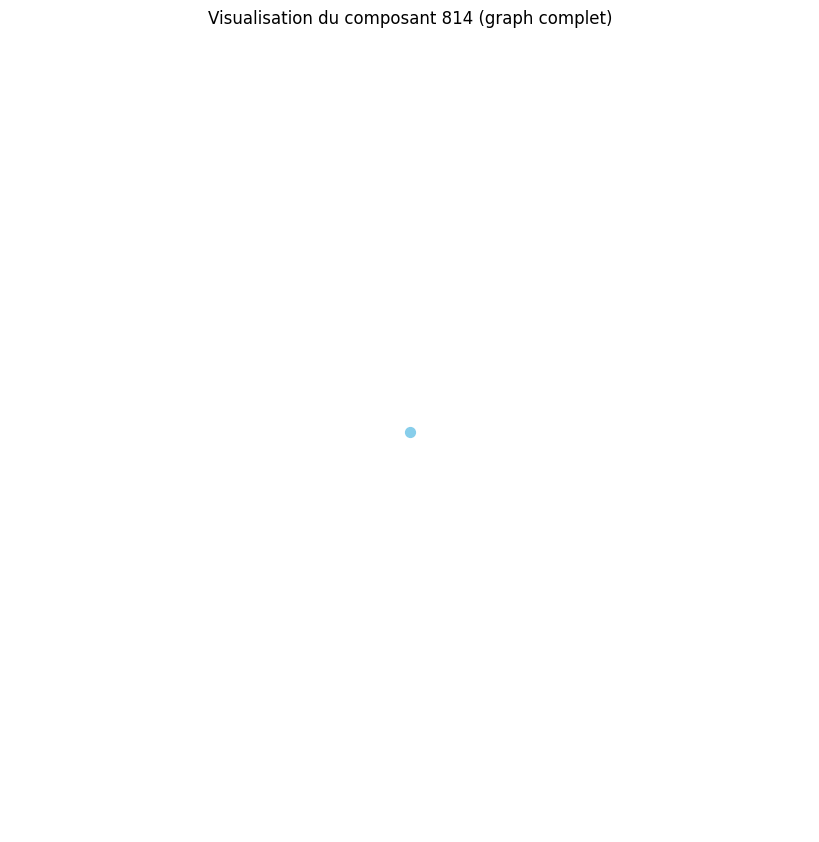

Distance moyenne pour le composant 815 : 0.00
Le composant 815 est un graphe complet ou très densément connecté.
Densité du composant 815 : 0.00
Degré moyen du composant 815 : 0.00
Coefficient de clustering moyen du composant 815 : 0.00


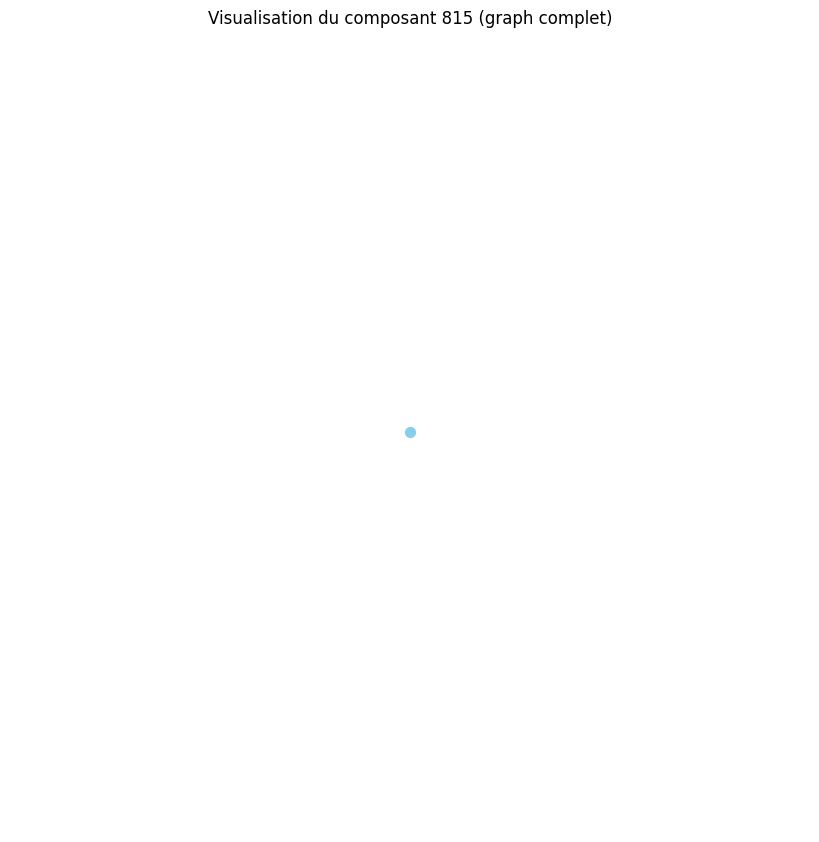

Distance moyenne pour le composant 816 : 0.00
Le composant 816 est un graphe complet ou très densément connecté.
Densité du composant 816 : 0.00
Degré moyen du composant 816 : 0.00
Coefficient de clustering moyen du composant 816 : 0.00


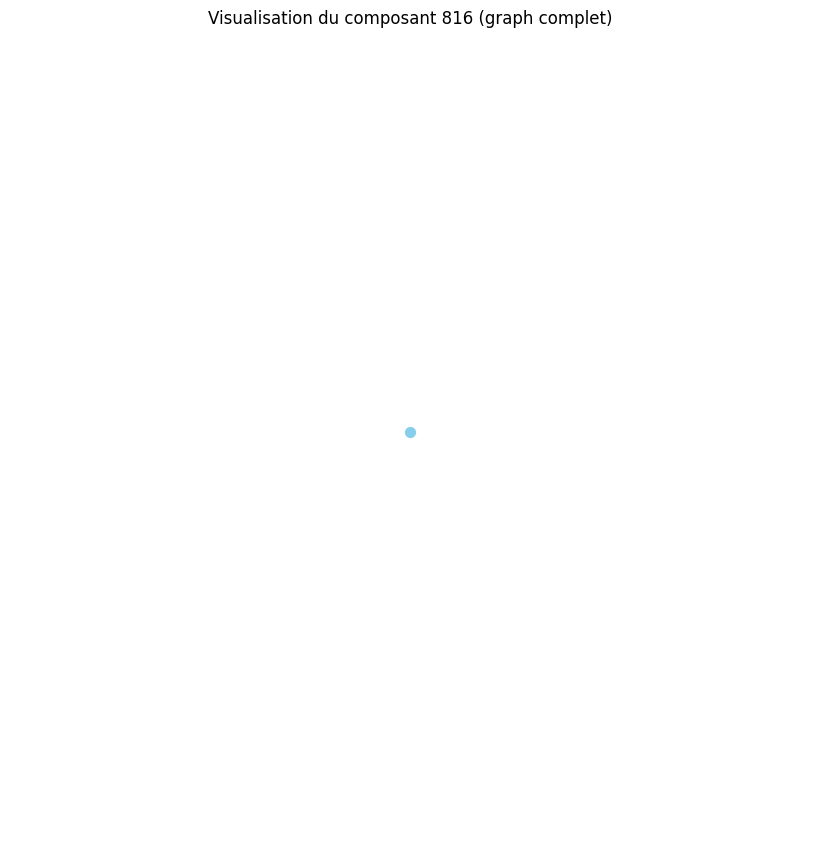

Distance moyenne pour le composant 817 : 0.00
Le composant 817 est un graphe complet ou très densément connecté.
Densité du composant 817 : 0.00
Degré moyen du composant 817 : 0.00
Coefficient de clustering moyen du composant 817 : 0.00


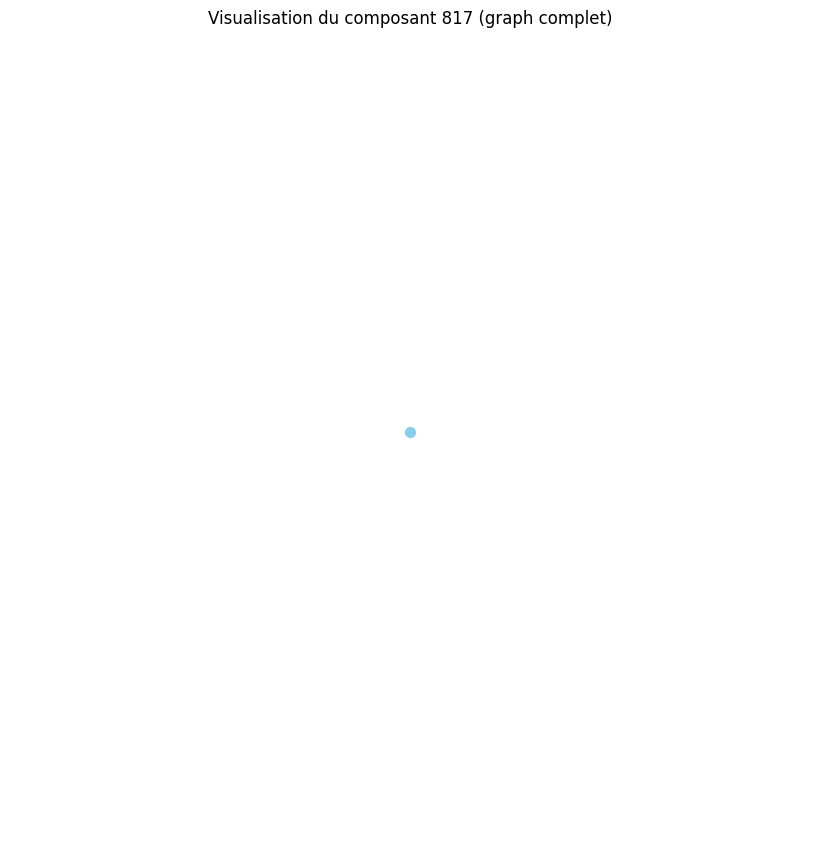

Distance moyenne pour le composant 818 : 0.00
Le composant 818 est un graphe complet ou très densément connecté.
Densité du composant 818 : 0.00
Degré moyen du composant 818 : 0.00
Coefficient de clustering moyen du composant 818 : 0.00


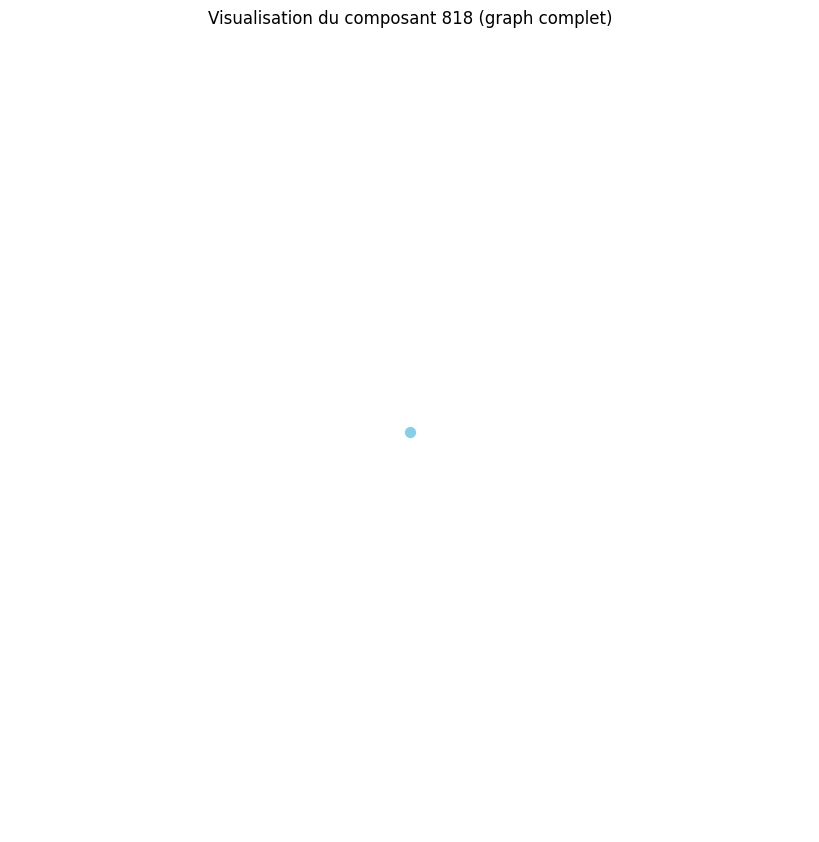

Distance moyenne pour le composant 819 : 0.00
Le composant 819 est un graphe complet ou très densément connecté.
Densité du composant 819 : 0.00
Degré moyen du composant 819 : 0.00
Coefficient de clustering moyen du composant 819 : 0.00


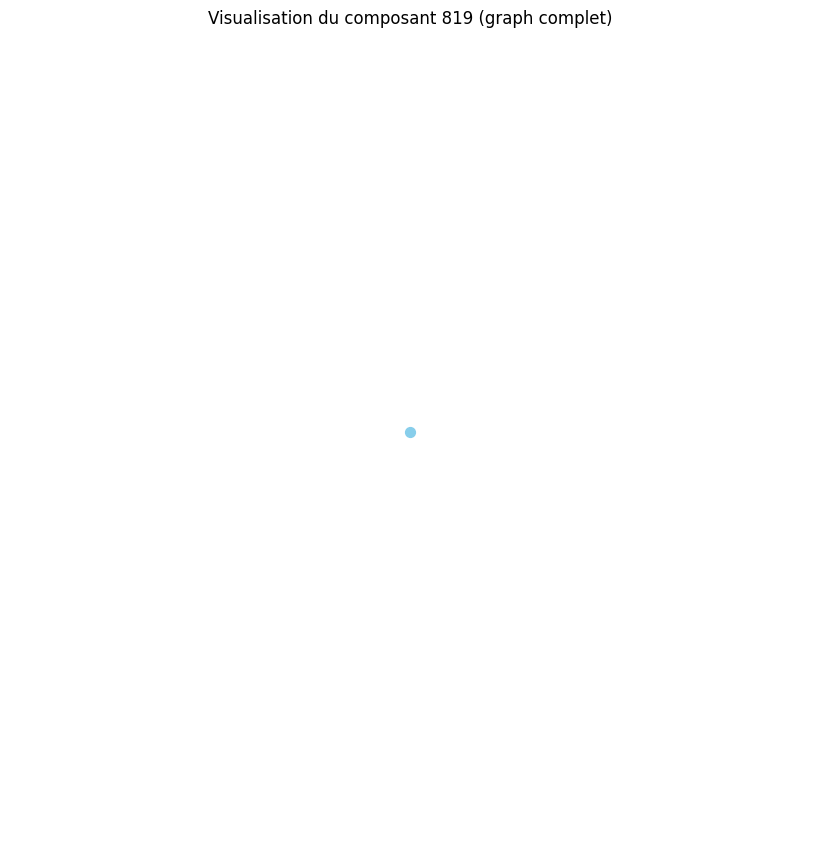

Distance moyenne pour le composant 820 : 0.00
Le composant 820 est un graphe complet ou très densément connecté.
Densité du composant 820 : 0.00
Degré moyen du composant 820 : 0.00
Coefficient de clustering moyen du composant 820 : 0.00


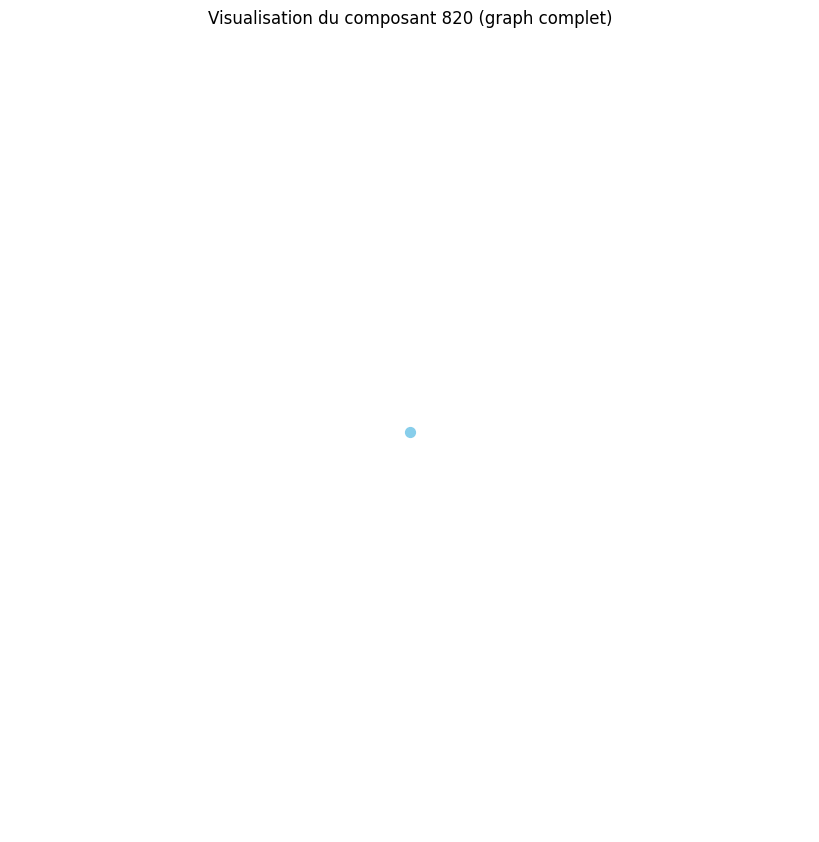

Distance moyenne pour le composant 821 : 0.00
Le composant 821 est un graphe complet ou très densément connecté.
Densité du composant 821 : 0.00
Degré moyen du composant 821 : 0.00
Coefficient de clustering moyen du composant 821 : 0.00


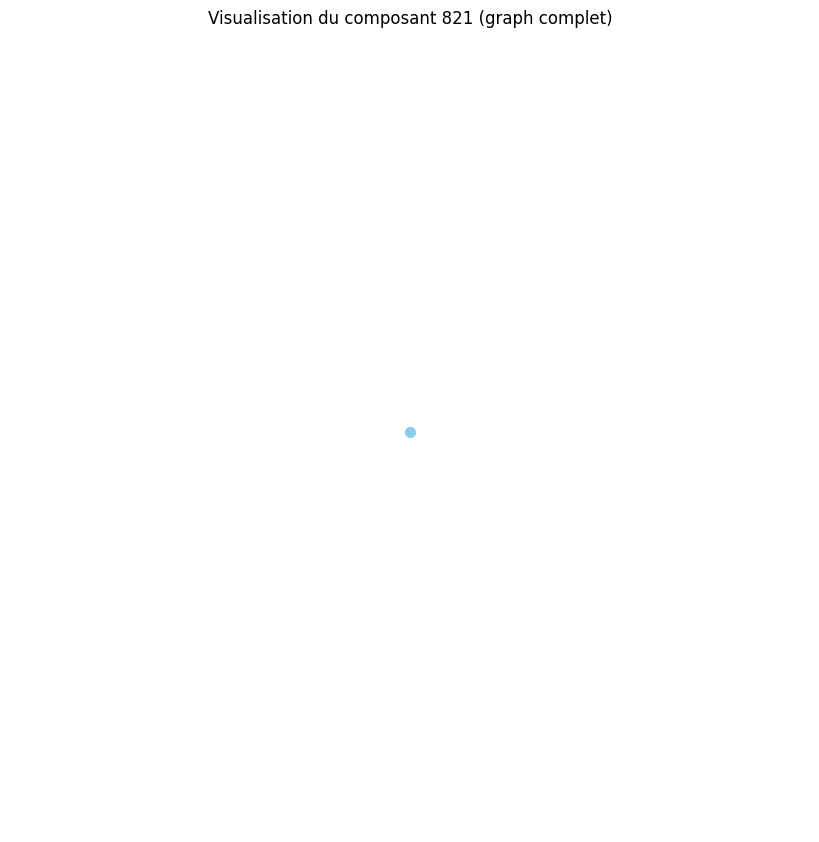

Distance moyenne pour le composant 822 : 0.00
Le composant 822 est un graphe complet ou très densément connecté.
Densité du composant 822 : 0.00
Degré moyen du composant 822 : 0.00
Coefficient de clustering moyen du composant 822 : 0.00


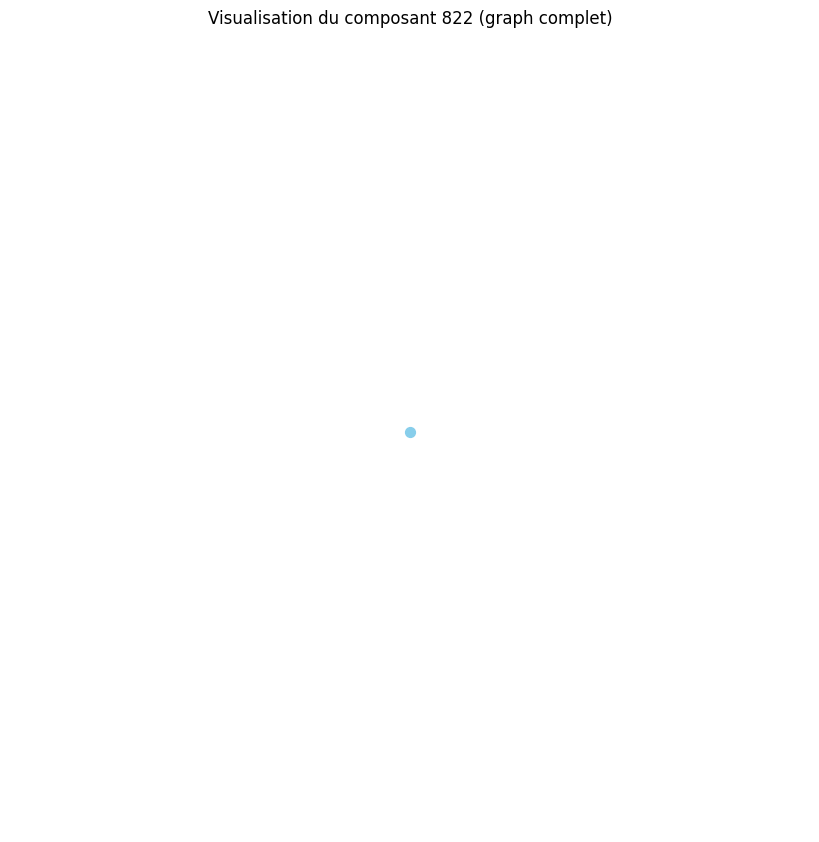

Distance moyenne pour le composant 823 : 0.00
Le composant 823 est un graphe complet ou très densément connecté.
Densité du composant 823 : 0.00
Degré moyen du composant 823 : 0.00
Coefficient de clustering moyen du composant 823 : 0.00


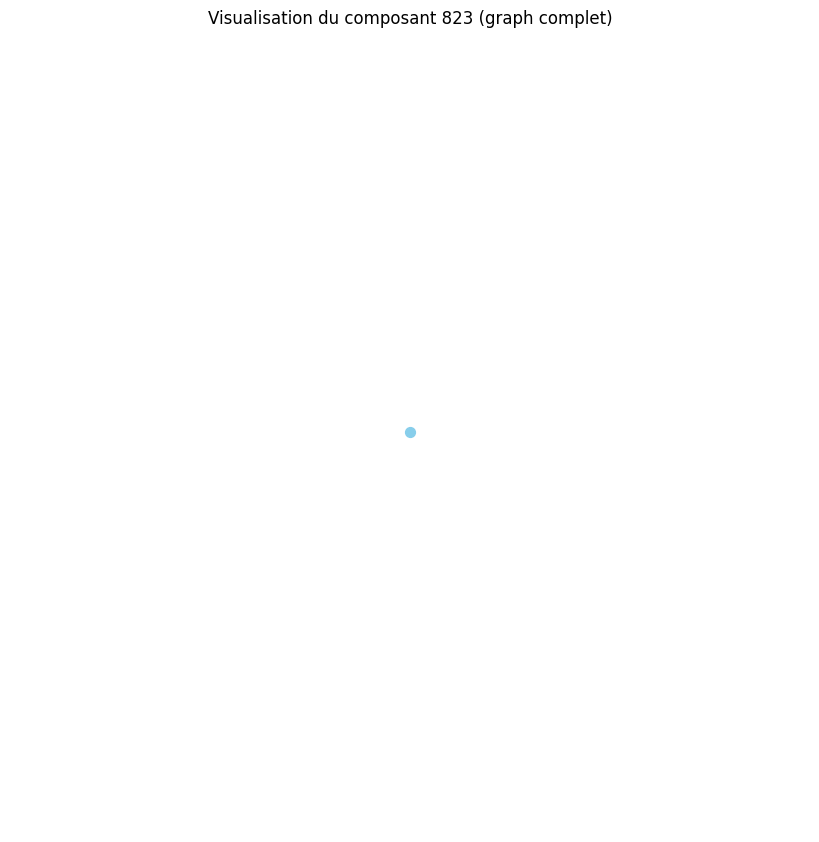

Distance moyenne pour le composant 824 : 0.00
Le composant 824 est un graphe complet ou très densément connecté.
Densité du composant 824 : 0.00
Degré moyen du composant 824 : 0.00
Coefficient de clustering moyen du composant 824 : 0.00


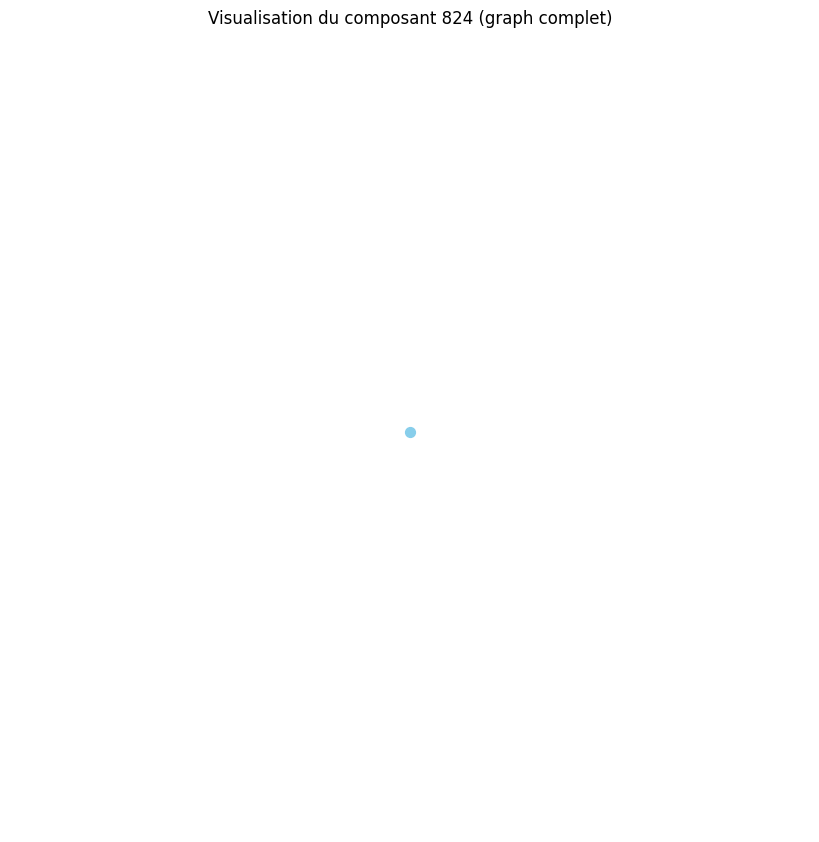

Distance moyenne pour le composant 825 : 0.00
Le composant 825 est un graphe complet ou très densément connecté.
Densité du composant 825 : 0.00
Degré moyen du composant 825 : 0.00
Coefficient de clustering moyen du composant 825 : 0.00


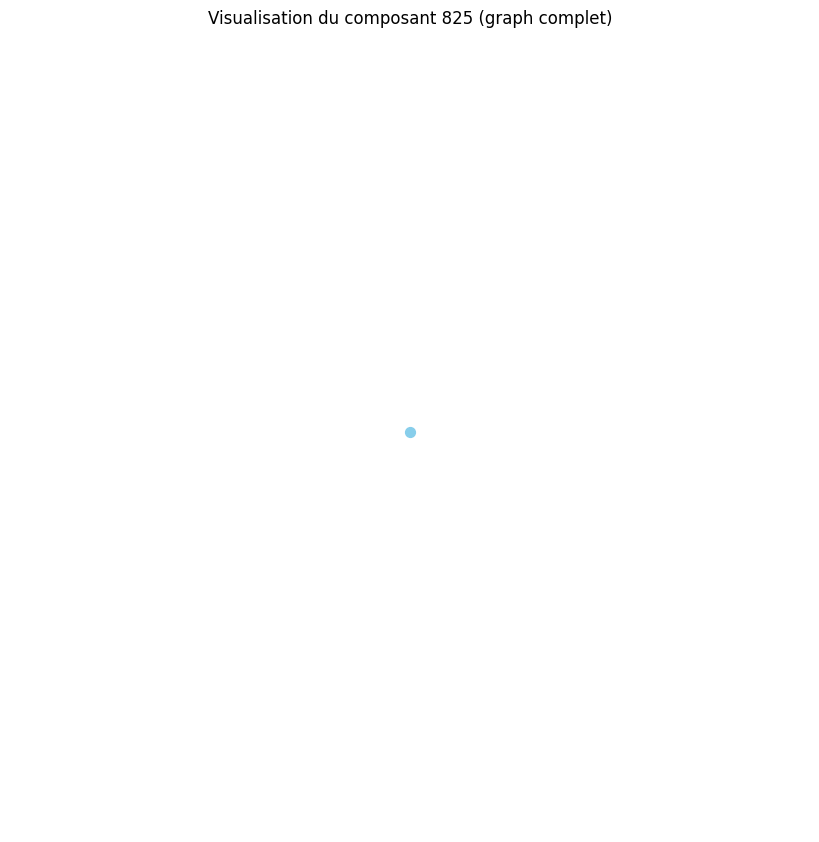

Distance moyenne pour le composant 826 : 0.00
Le composant 826 est un graphe complet ou très densément connecté.
Densité du composant 826 : 0.00
Degré moyen du composant 826 : 0.00
Coefficient de clustering moyen du composant 826 : 0.00


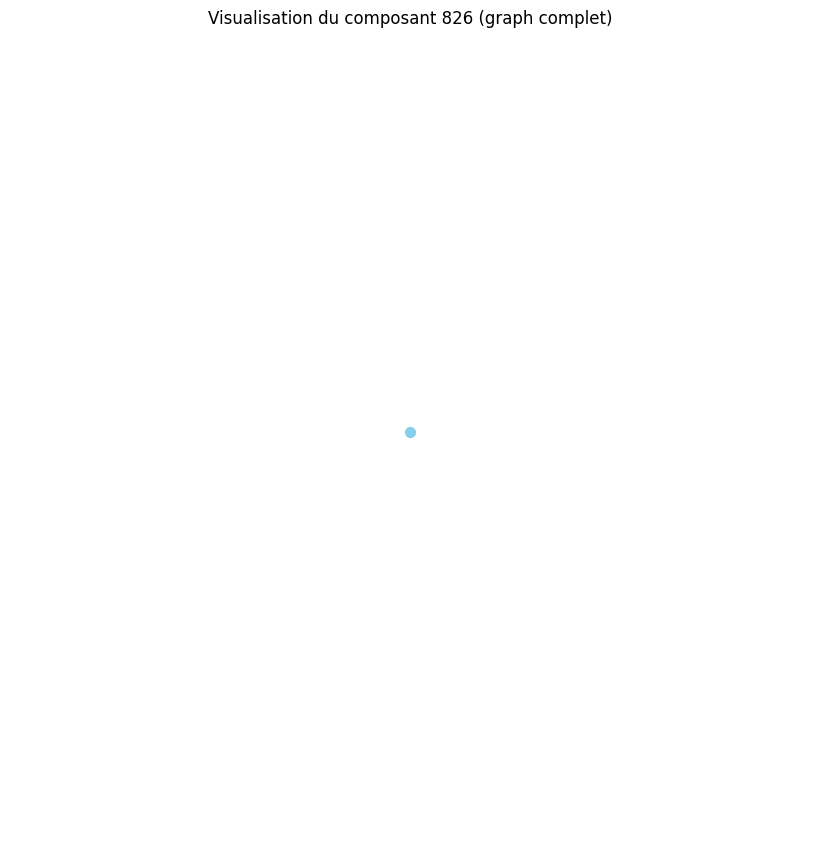

Distance moyenne pour le composant 827 : 0.00
Le composant 827 est un graphe complet ou très densément connecté.
Densité du composant 827 : 0.00
Degré moyen du composant 827 : 0.00
Coefficient de clustering moyen du composant 827 : 0.00


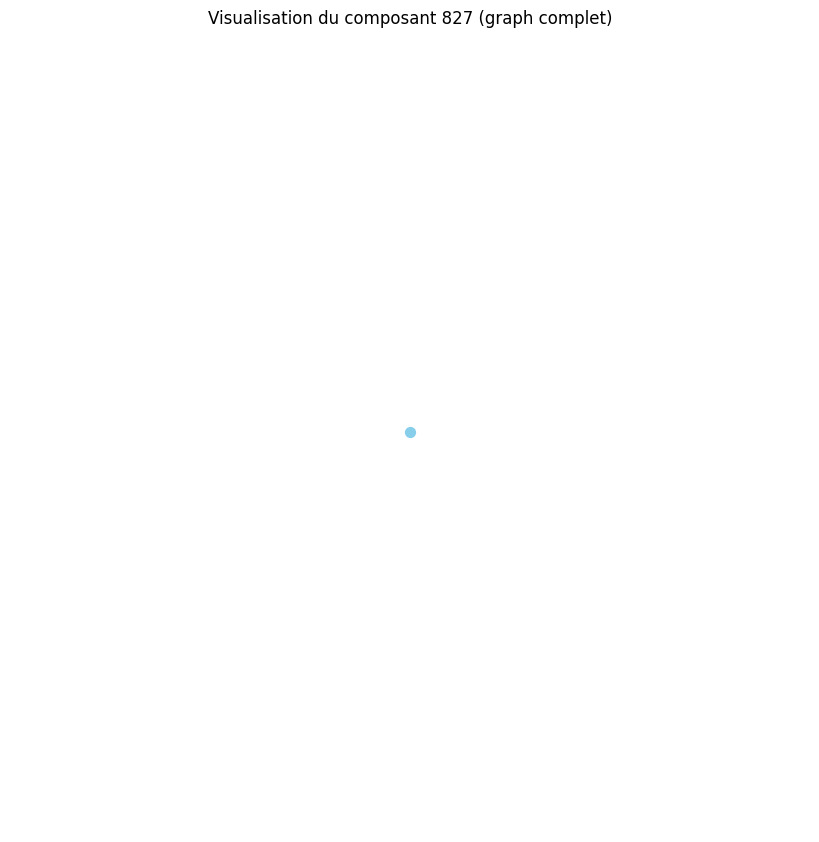

Distance moyenne pour le composant 828 : 0.00
Le composant 828 est un graphe complet ou très densément connecté.
Densité du composant 828 : 0.00
Degré moyen du composant 828 : 0.00
Coefficient de clustering moyen du composant 828 : 0.00


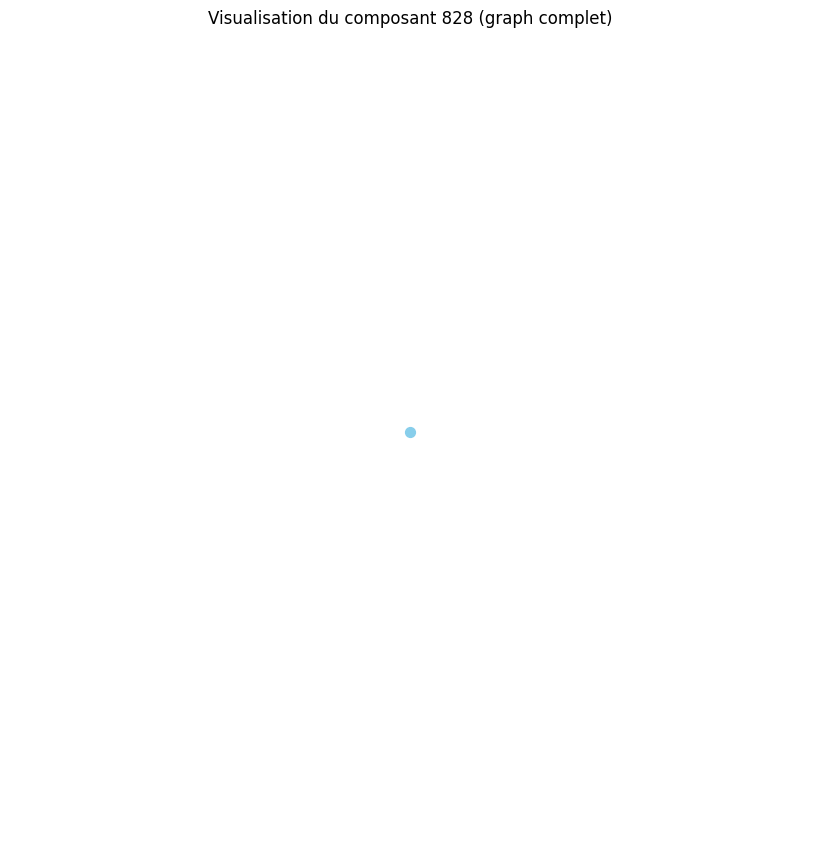

Distance moyenne pour le composant 829 : 0.00
Le composant 829 est un graphe complet ou très densément connecté.
Densité du composant 829 : 0.00
Degré moyen du composant 829 : 0.00
Coefficient de clustering moyen du composant 829 : 0.00


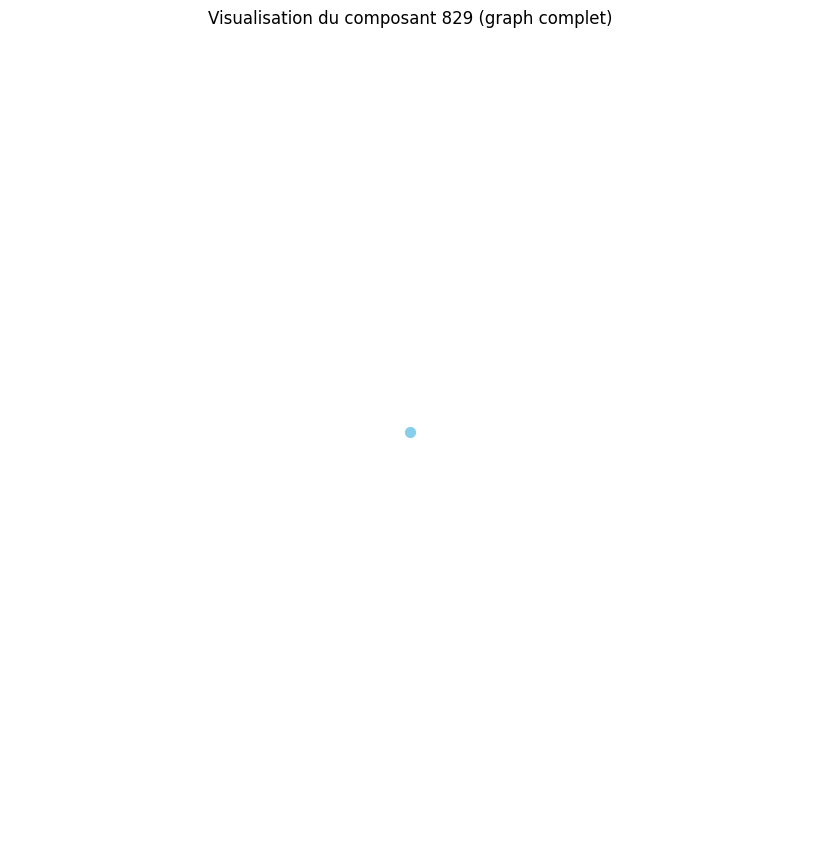

Distance moyenne pour le composant 830 : 0.00
Le composant 830 est un graphe complet ou très densément connecté.
Densité du composant 830 : 0.00
Degré moyen du composant 830 : 0.00
Coefficient de clustering moyen du composant 830 : 0.00


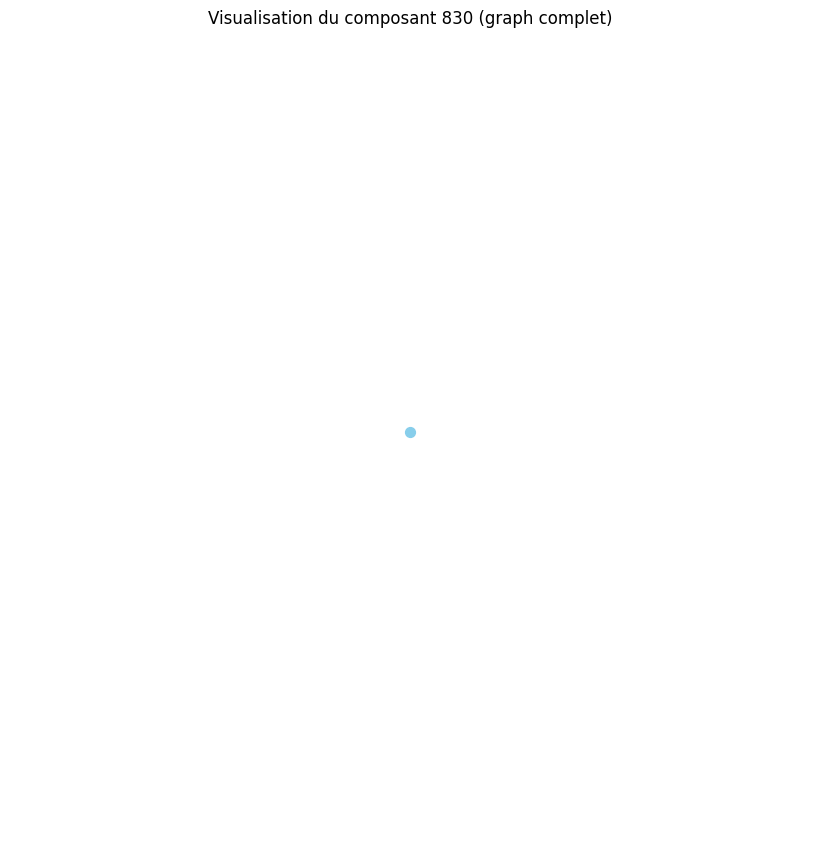

Distance moyenne pour le composant 831 : 0.00
Le composant 831 est un graphe complet ou très densément connecté.
Densité du composant 831 : 0.00
Degré moyen du composant 831 : 0.00
Coefficient de clustering moyen du composant 831 : 0.00


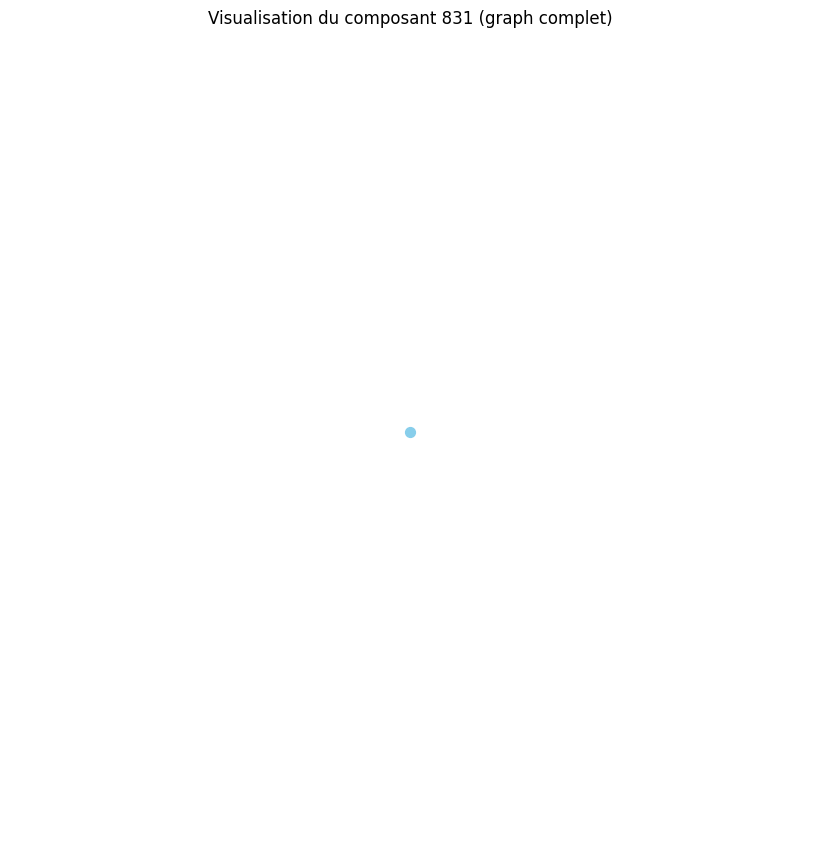

Distance moyenne pour le composant 832 : 0.00
Le composant 832 est un graphe complet ou très densément connecté.
Densité du composant 832 : 0.00
Degré moyen du composant 832 : 0.00
Coefficient de clustering moyen du composant 832 : 0.00


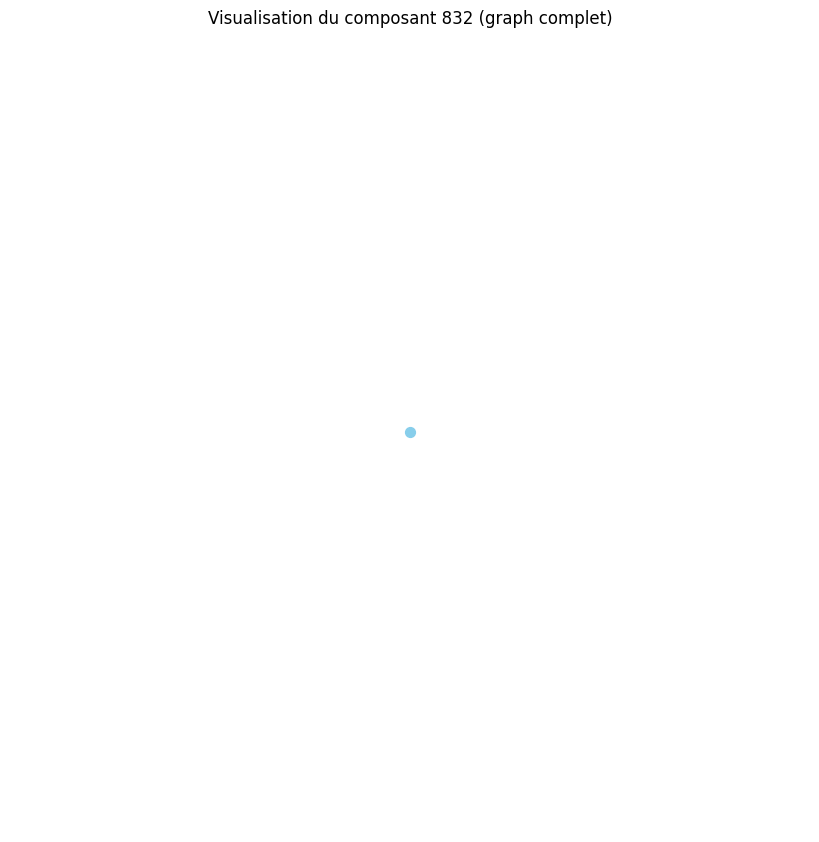

Distance moyenne pour le composant 833 : 0.00
Le composant 833 est un graphe complet ou très densément connecté.
Densité du composant 833 : 0.00
Degré moyen du composant 833 : 0.00
Coefficient de clustering moyen du composant 833 : 0.00


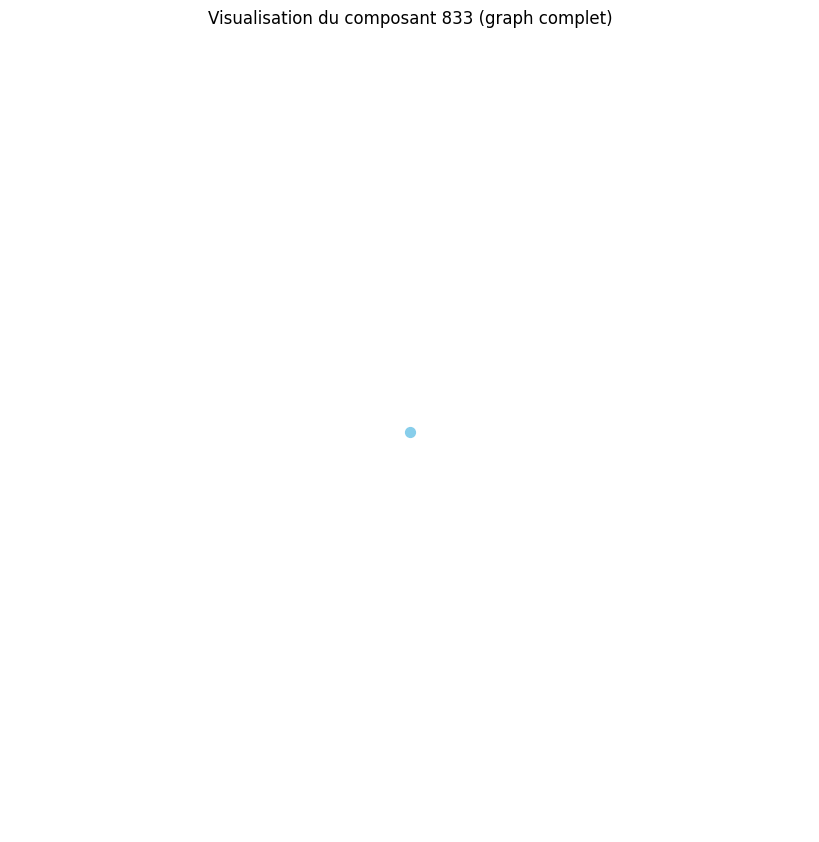

Distance moyenne pour le composant 834 : 0.00
Le composant 834 est un graphe complet ou très densément connecté.
Densité du composant 834 : 0.00
Degré moyen du composant 834 : 0.00
Coefficient de clustering moyen du composant 834 : 0.00


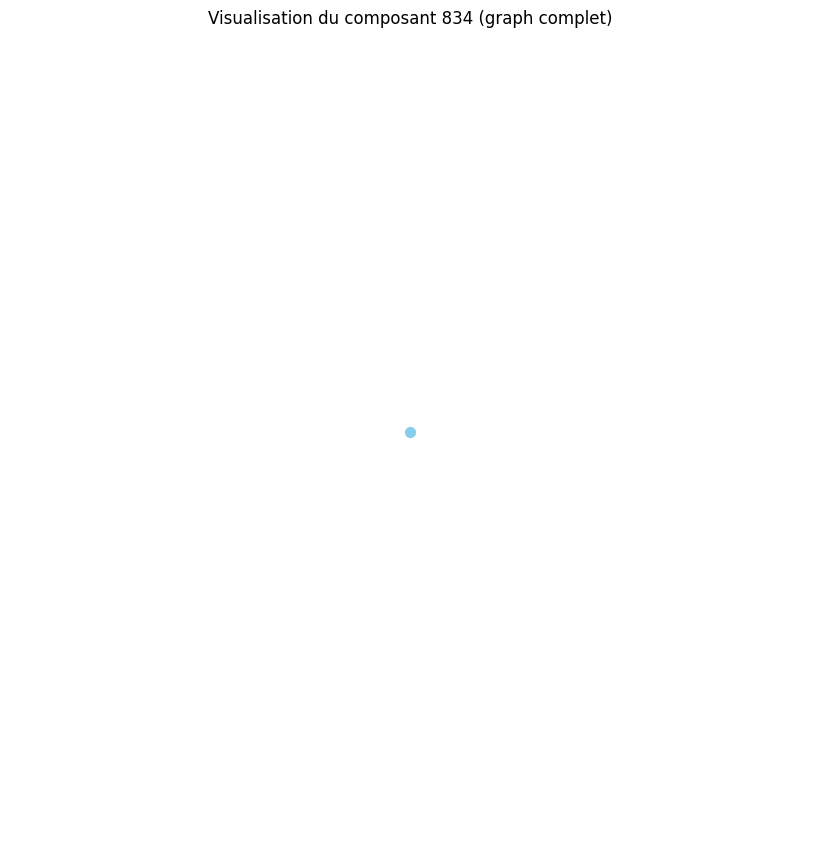

Distance moyenne pour le composant 835 : 0.00
Le composant 835 est un graphe complet ou très densément connecté.
Densité du composant 835 : 0.00
Degré moyen du composant 835 : 0.00
Coefficient de clustering moyen du composant 835 : 0.00


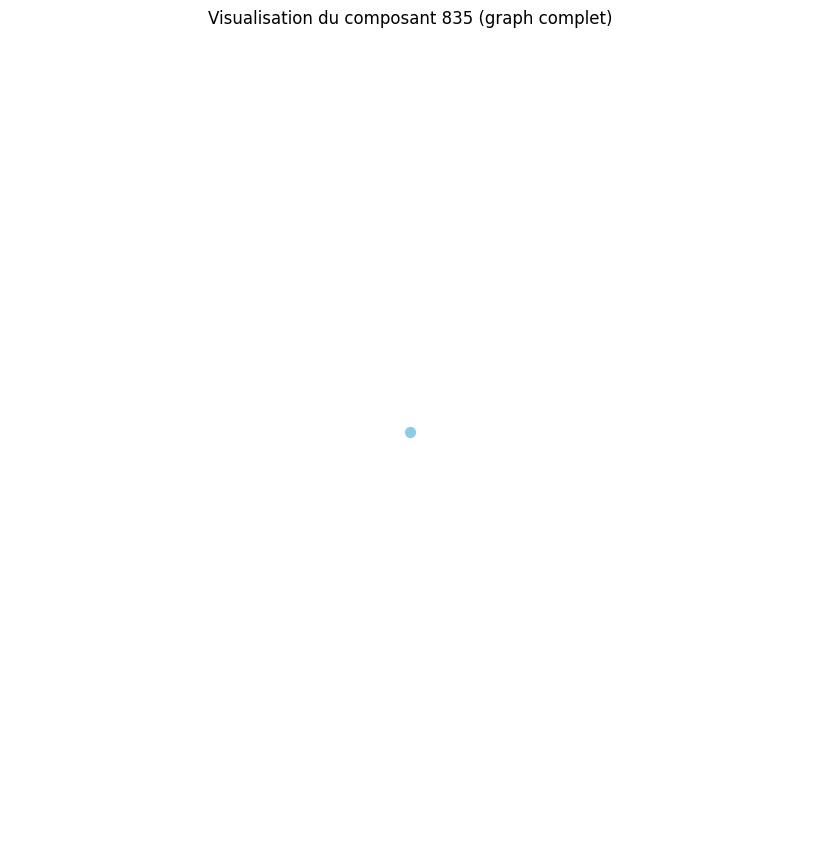

Distance moyenne pour le composant 836 : 0.00
Le composant 836 est un graphe complet ou très densément connecté.
Densité du composant 836 : 0.00
Degré moyen du composant 836 : 0.00
Coefficient de clustering moyen du composant 836 : 0.00


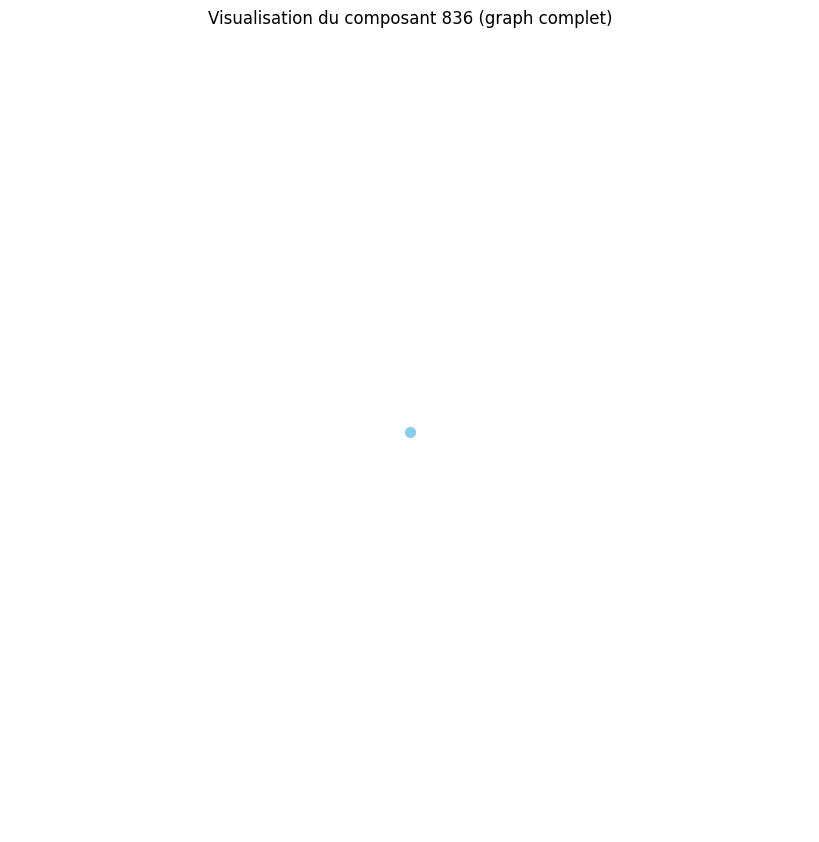

Distance moyenne pour le composant 837 : 0.00
Le composant 837 est un graphe complet ou très densément connecté.
Densité du composant 837 : 0.00
Degré moyen du composant 837 : 0.00
Coefficient de clustering moyen du composant 837 : 0.00


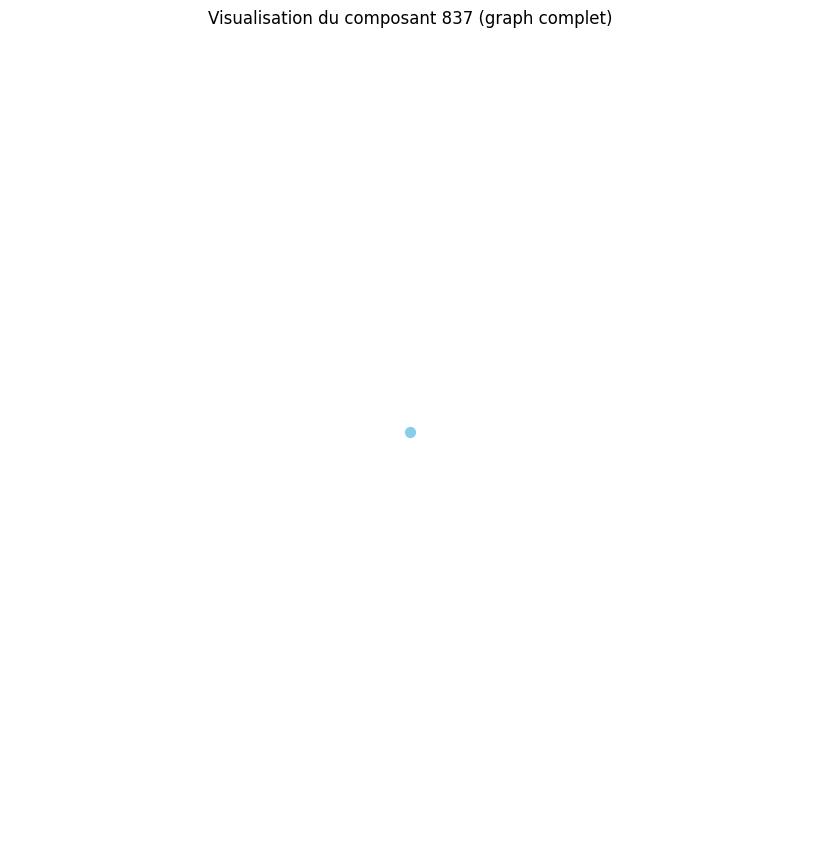

Distance moyenne pour le composant 838 : 0.00
Le composant 838 est un graphe complet ou très densément connecté.
Densité du composant 838 : 0.00
Degré moyen du composant 838 : 0.00
Coefficient de clustering moyen du composant 838 : 0.00


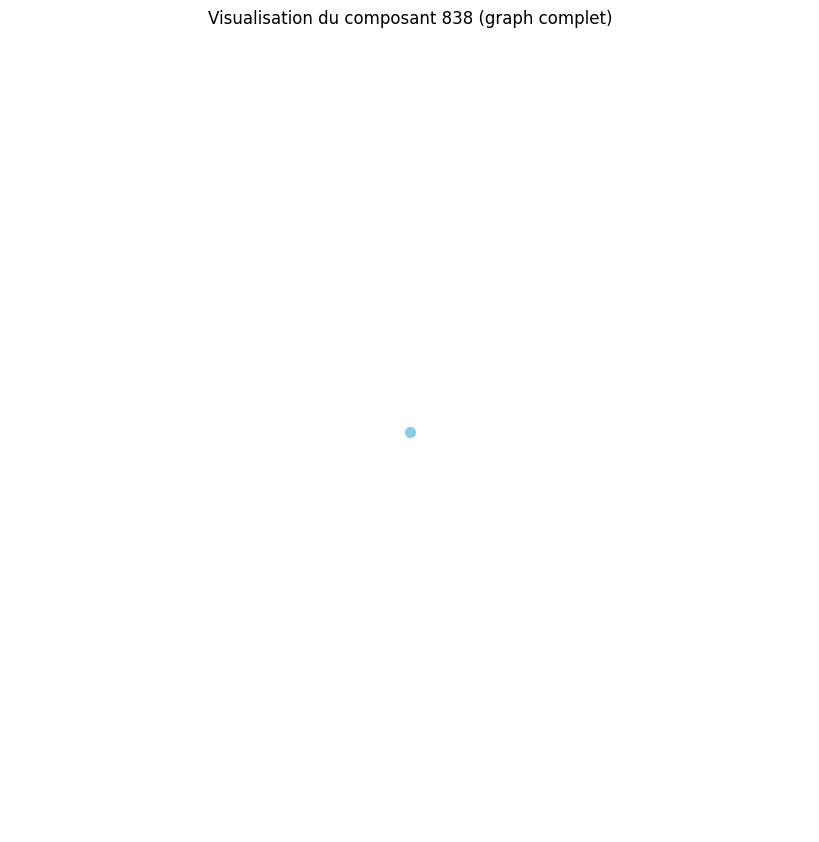

Distance moyenne pour le composant 839 : 0.00
Le composant 839 est un graphe complet ou très densément connecté.
Densité du composant 839 : 0.00
Degré moyen du composant 839 : 0.00
Coefficient de clustering moyen du composant 839 : 0.00


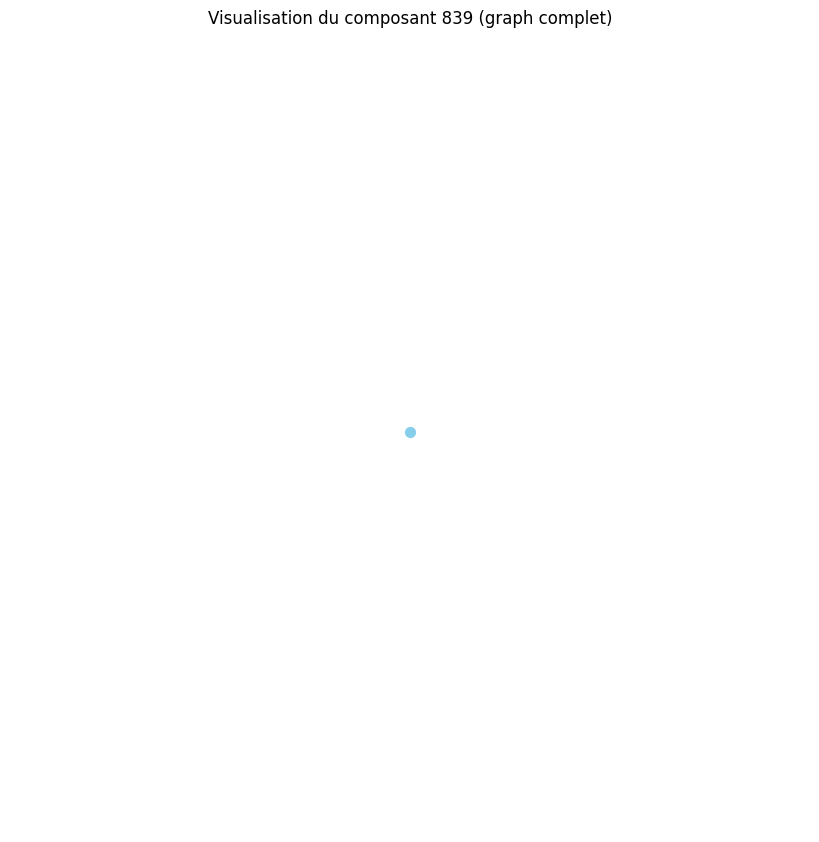

Distance moyenne pour le composant 840 : 0.00
Le composant 840 est un graphe complet ou très densément connecté.
Densité du composant 840 : 0.00
Degré moyen du composant 840 : 0.00
Coefficient de clustering moyen du composant 840 : 0.00


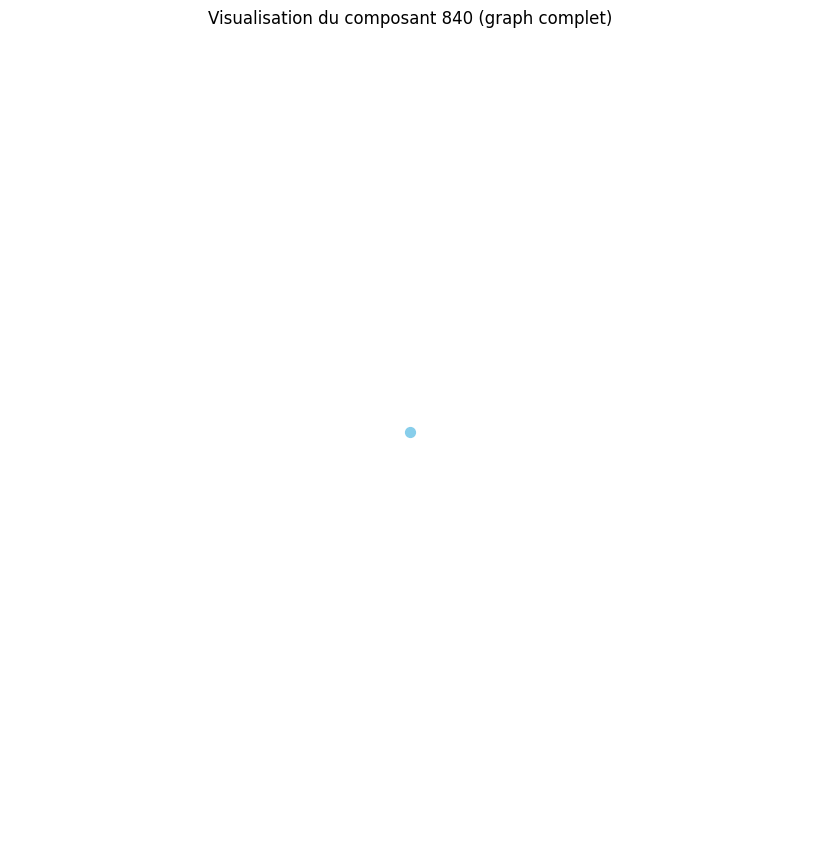

Distance moyenne pour le composant 841 : 0.00
Le composant 841 est un graphe complet ou très densément connecté.
Densité du composant 841 : 0.00
Degré moyen du composant 841 : 0.00
Coefficient de clustering moyen du composant 841 : 0.00


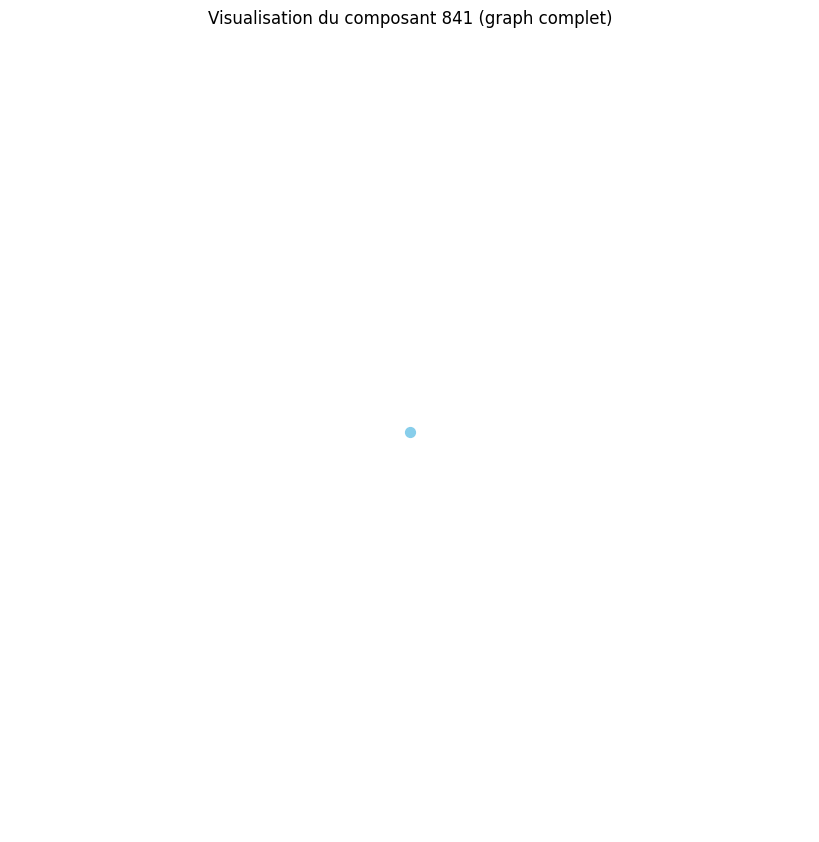

Distance moyenne pour le composant 842 : 0.00
Le composant 842 est un graphe complet ou très densément connecté.
Densité du composant 842 : 0.00
Degré moyen du composant 842 : 0.00
Coefficient de clustering moyen du composant 842 : 0.00


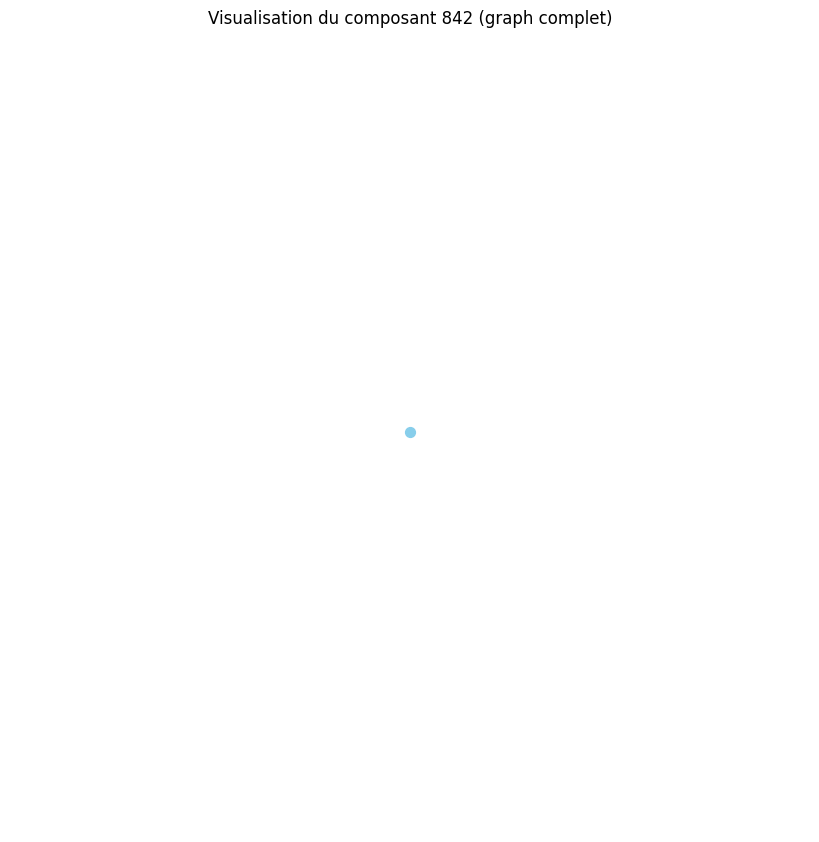

Distance moyenne pour le composant 843 : 0.00
Le composant 843 est un graphe complet ou très densément connecté.
Densité du composant 843 : 0.00
Degré moyen du composant 843 : 0.00
Coefficient de clustering moyen du composant 843 : 0.00


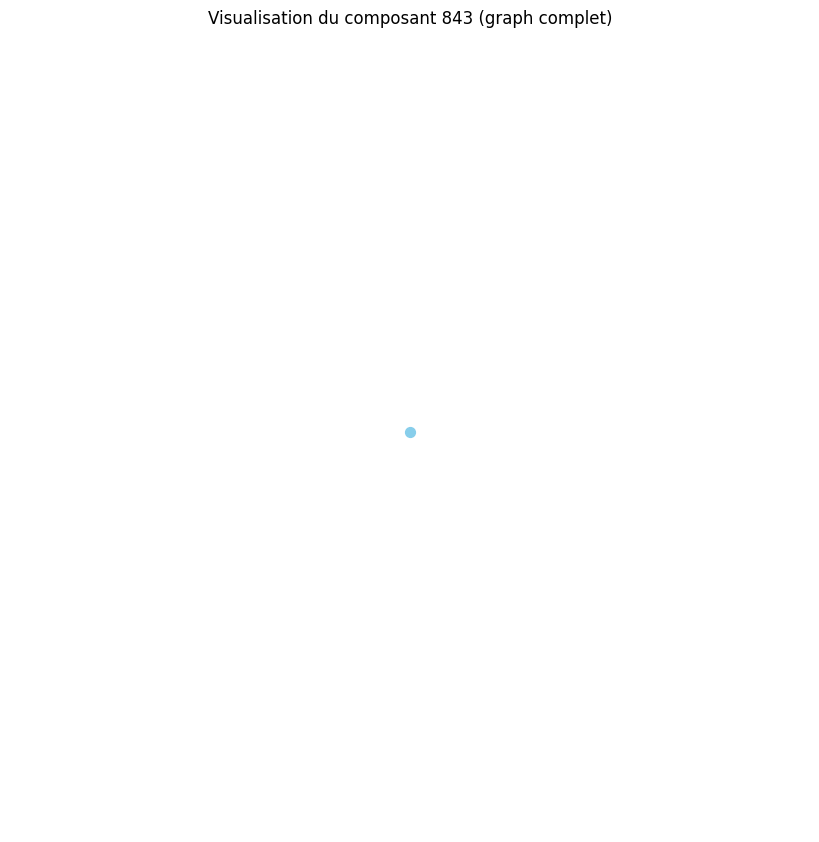

Distance moyenne pour le composant 844 : 0.00
Le composant 844 est un graphe complet ou très densément connecté.
Densité du composant 844 : 0.00
Degré moyen du composant 844 : 0.00
Coefficient de clustering moyen du composant 844 : 0.00


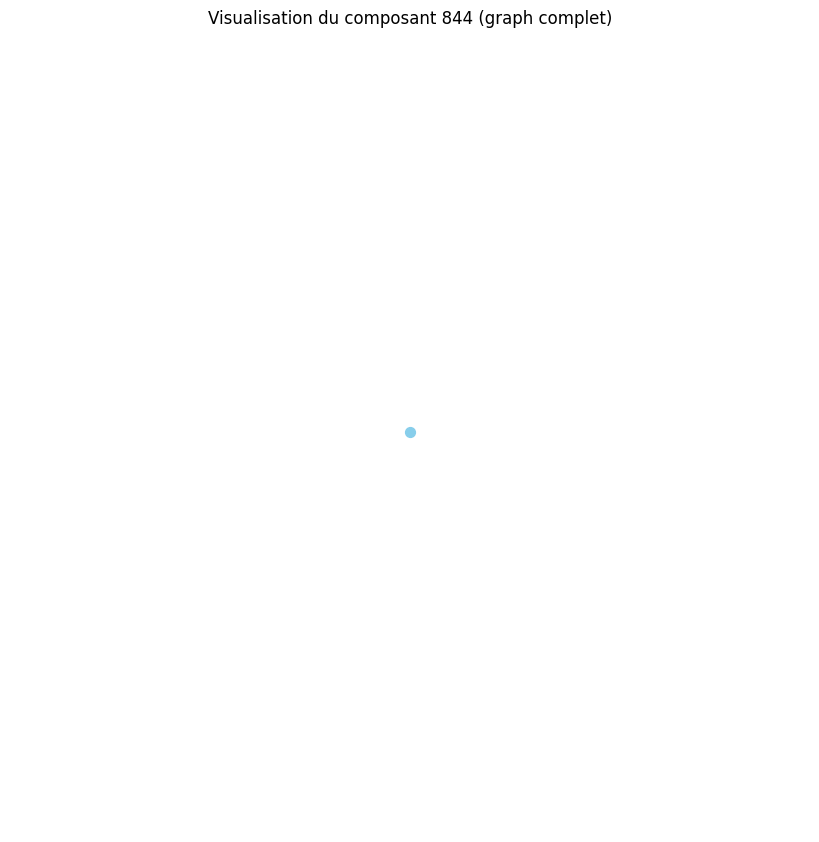

Distance moyenne pour le composant 845 : 0.00
Le composant 845 est un graphe complet ou très densément connecté.
Densité du composant 845 : 0.00
Degré moyen du composant 845 : 0.00
Coefficient de clustering moyen du composant 845 : 0.00


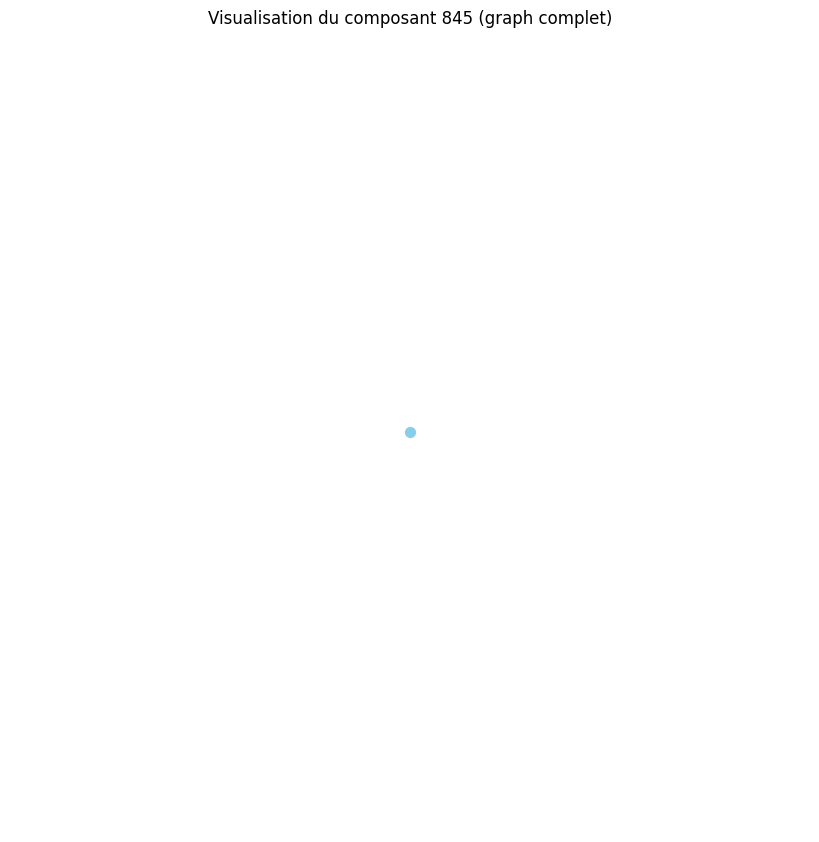

Distance moyenne pour le composant 846 : 0.00
Le composant 846 est un graphe complet ou très densément connecté.
Densité du composant 846 : 0.00
Degré moyen du composant 846 : 0.00
Coefficient de clustering moyen du composant 846 : 0.00


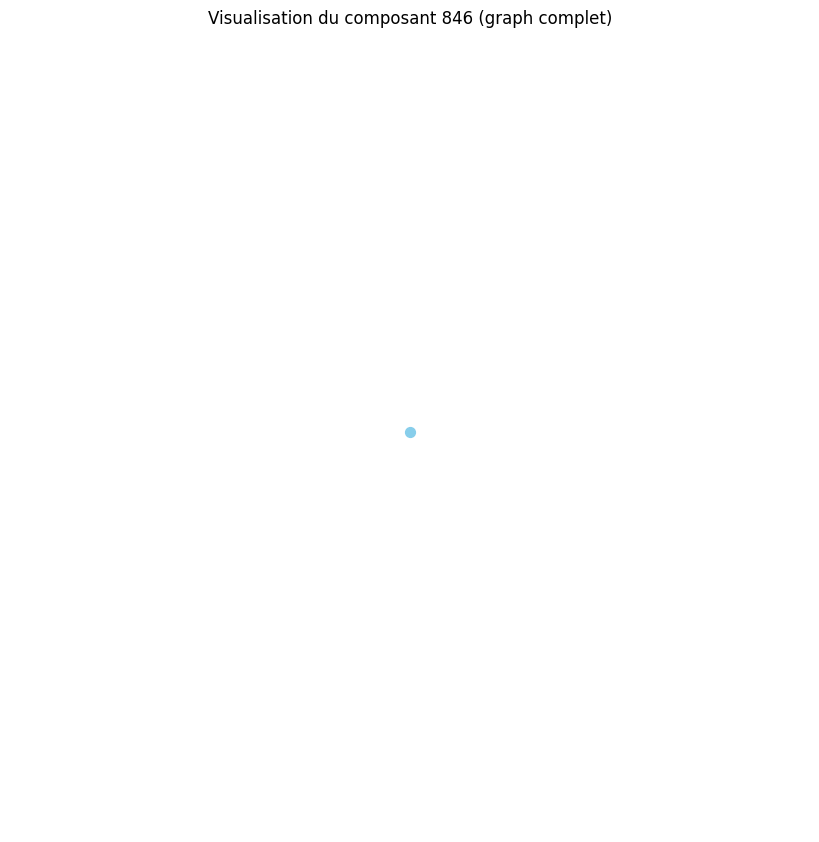

Distance moyenne pour le composant 847 : 0.00
Le composant 847 est un graphe complet ou très densément connecté.
Densité du composant 847 : 0.00
Degré moyen du composant 847 : 0.00
Coefficient de clustering moyen du composant 847 : 0.00


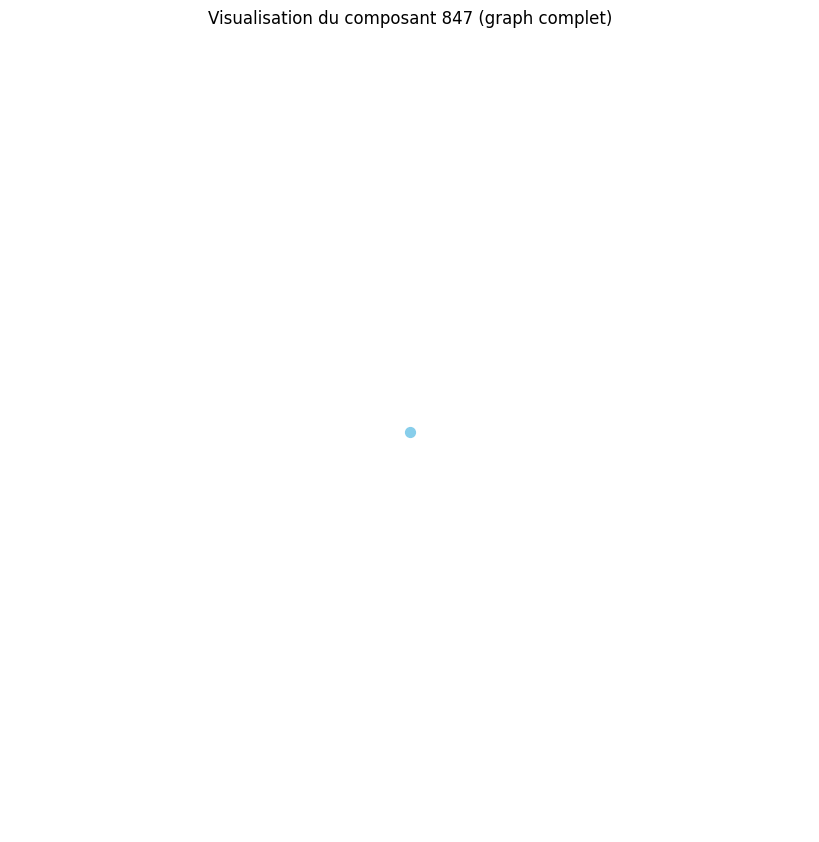

Distance moyenne pour le composant 848 : 0.00
Le composant 848 est un graphe complet ou très densément connecté.
Densité du composant 848 : 0.00
Degré moyen du composant 848 : 0.00
Coefficient de clustering moyen du composant 848 : 0.00


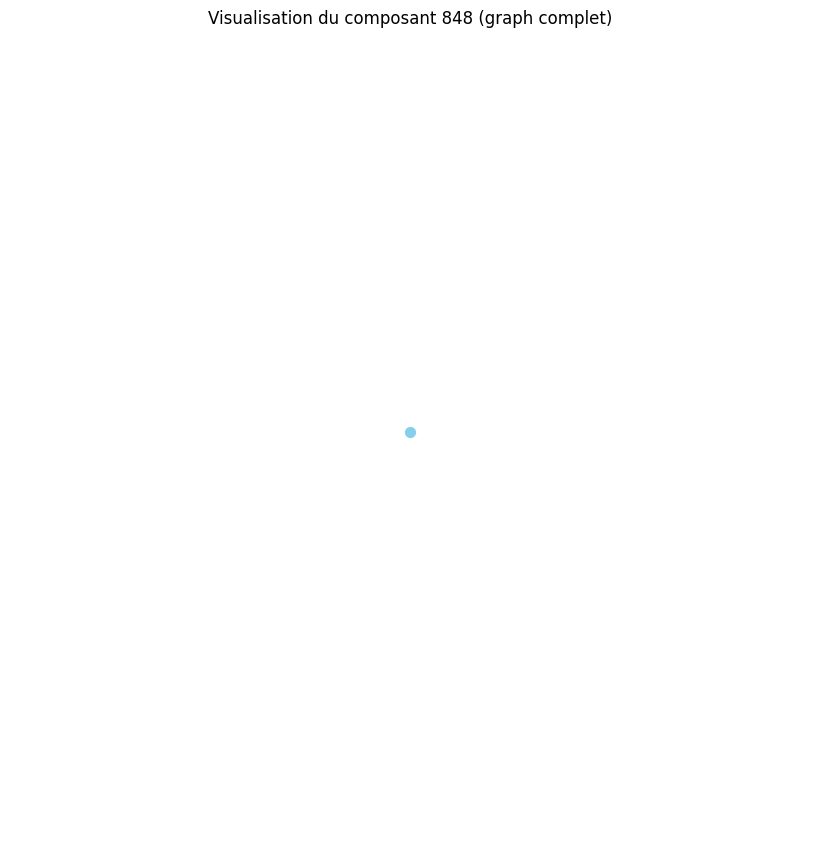

Distance moyenne pour le composant 849 : 0.00
Le composant 849 est un graphe complet ou très densément connecté.
Densité du composant 849 : 0.00
Degré moyen du composant 849 : 0.00
Coefficient de clustering moyen du composant 849 : 0.00


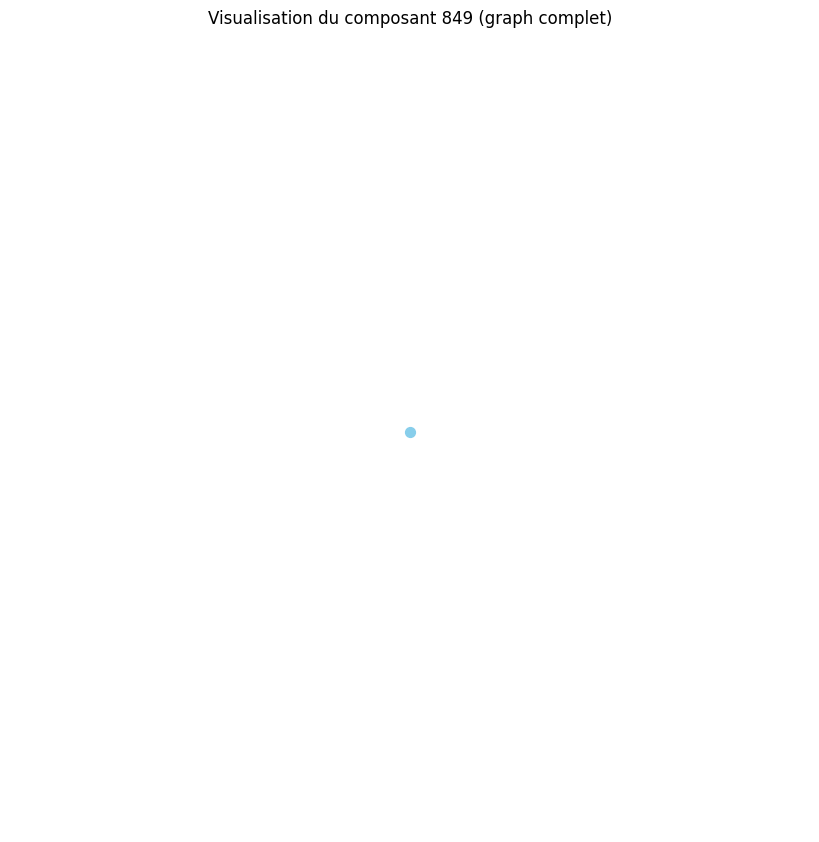

Distance moyenne pour le composant 850 : 0.00
Le composant 850 est un graphe complet ou très densément connecté.
Densité du composant 850 : 0.00
Degré moyen du composant 850 : 0.00
Coefficient de clustering moyen du composant 850 : 0.00


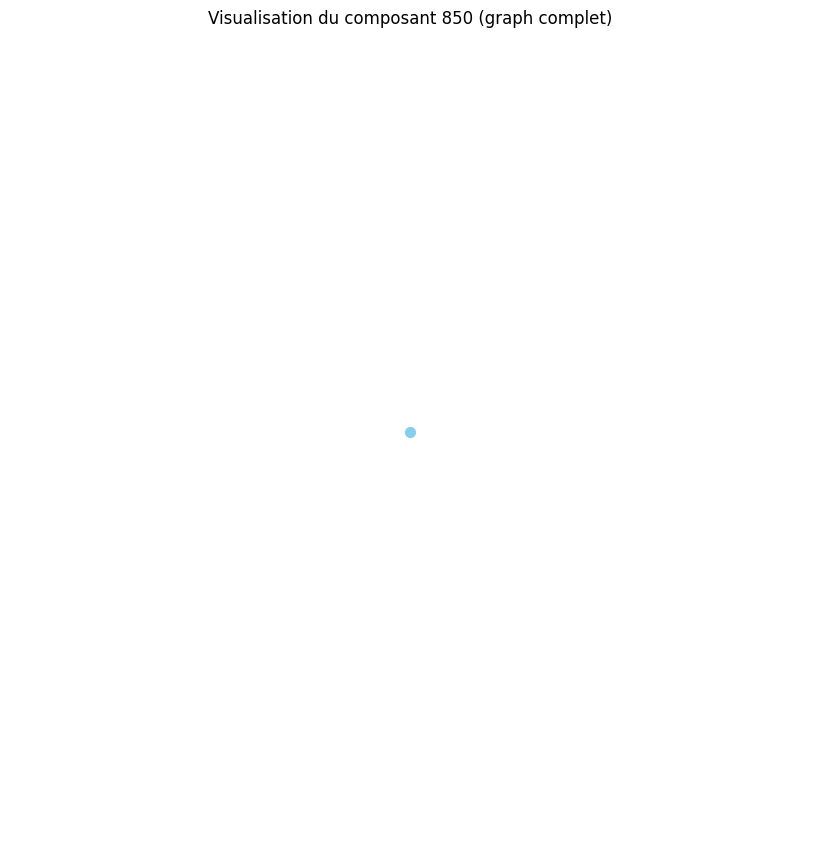

Distance moyenne pour le composant 851 : 0.00
Le composant 851 est un graphe complet ou très densément connecté.
Densité du composant 851 : 0.00
Degré moyen du composant 851 : 0.00
Coefficient de clustering moyen du composant 851 : 0.00


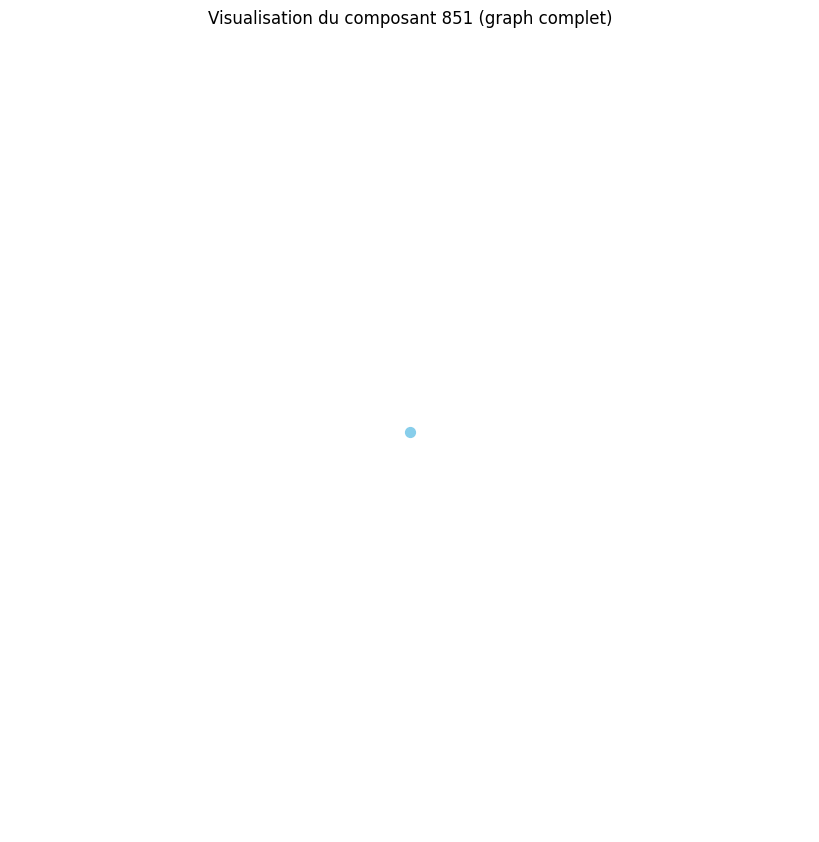

Distance moyenne pour le composant 852 : 0.00
Le composant 852 est un graphe complet ou très densément connecté.
Densité du composant 852 : 0.00
Degré moyen du composant 852 : 0.00
Coefficient de clustering moyen du composant 852 : 0.00


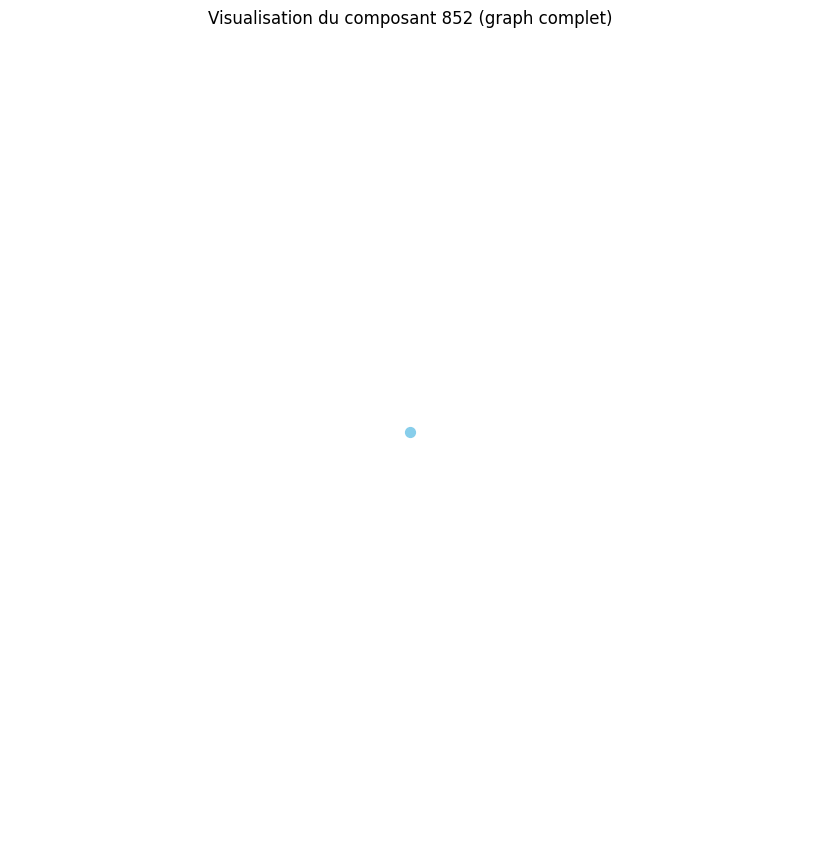

Distance moyenne pour le composant 853 : 0.00
Le composant 853 est un graphe complet ou très densément connecté.
Densité du composant 853 : 0.00
Degré moyen du composant 853 : 0.00
Coefficient de clustering moyen du composant 853 : 0.00


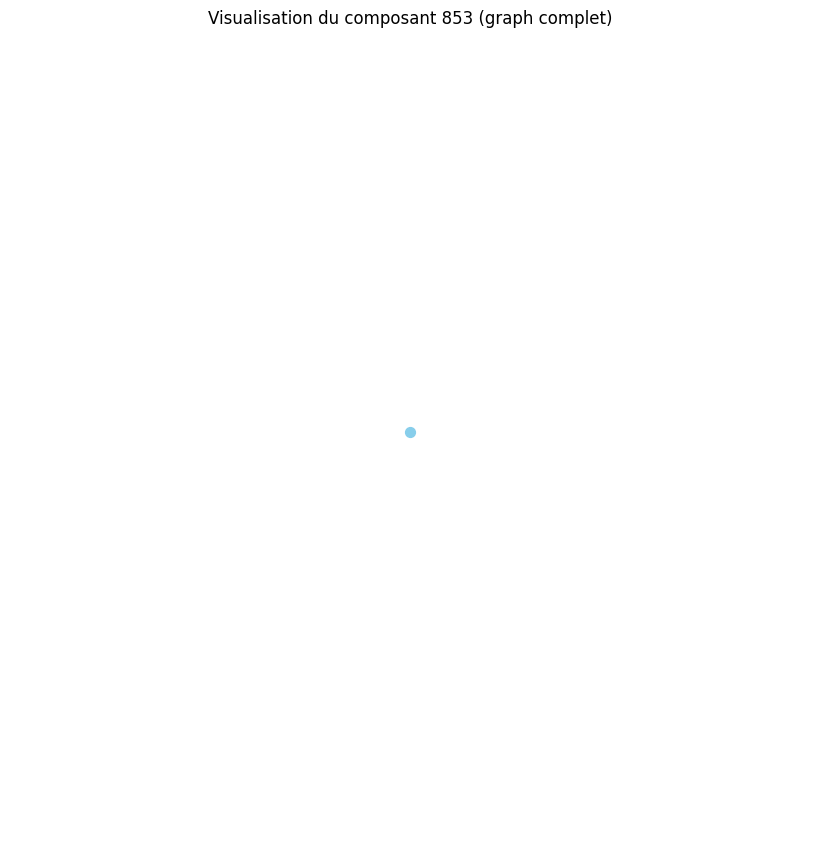

Distance moyenne pour le composant 854 : 0.00
Le composant 854 est un graphe complet ou très densément connecté.
Densité du composant 854 : 0.00
Degré moyen du composant 854 : 0.00
Coefficient de clustering moyen du composant 854 : 0.00


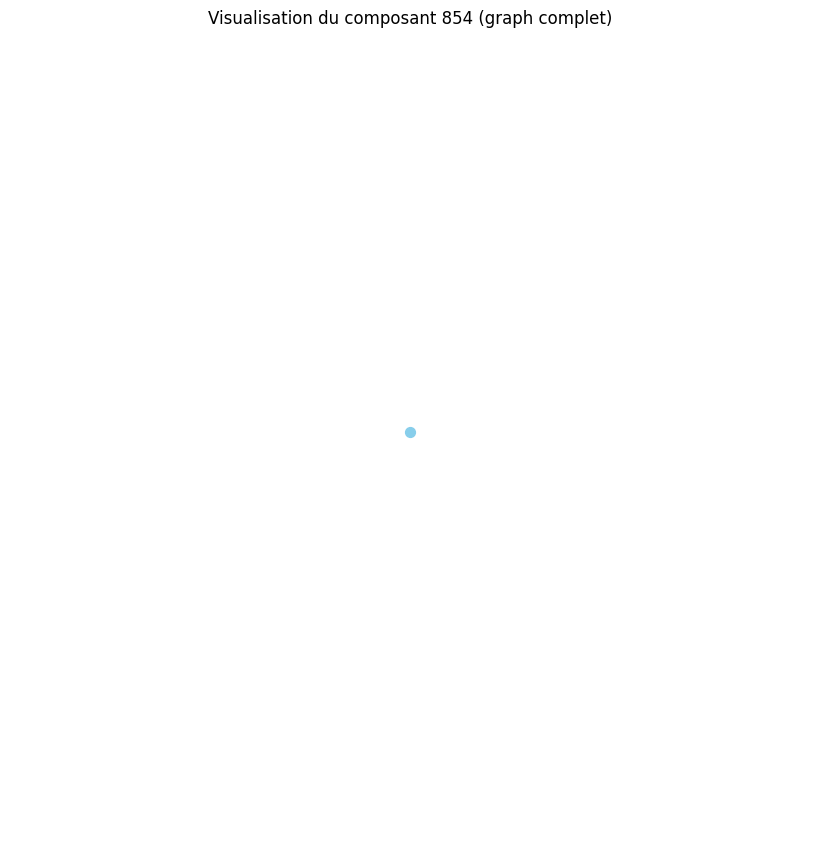

Distance moyenne pour le composant 855 : 0.00
Le composant 855 est un graphe complet ou très densément connecté.
Densité du composant 855 : 0.00
Degré moyen du composant 855 : 0.00
Coefficient de clustering moyen du composant 855 : 0.00


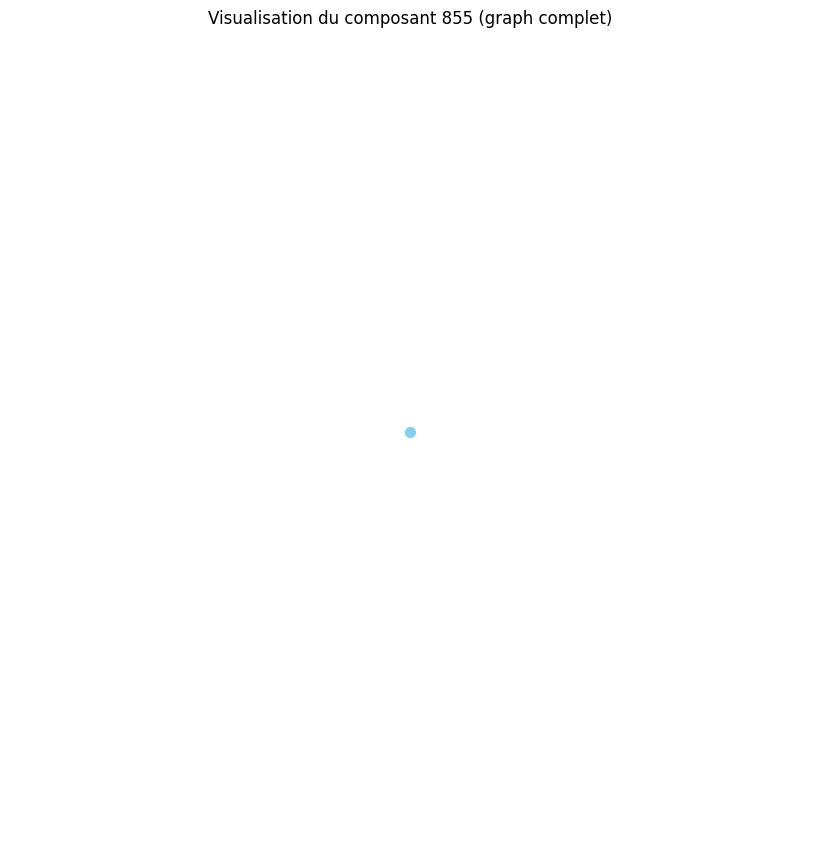

Distance moyenne pour le composant 856 : 0.00
Le composant 856 est un graphe complet ou très densément connecté.
Densité du composant 856 : 0.00
Degré moyen du composant 856 : 0.00
Coefficient de clustering moyen du composant 856 : 0.00


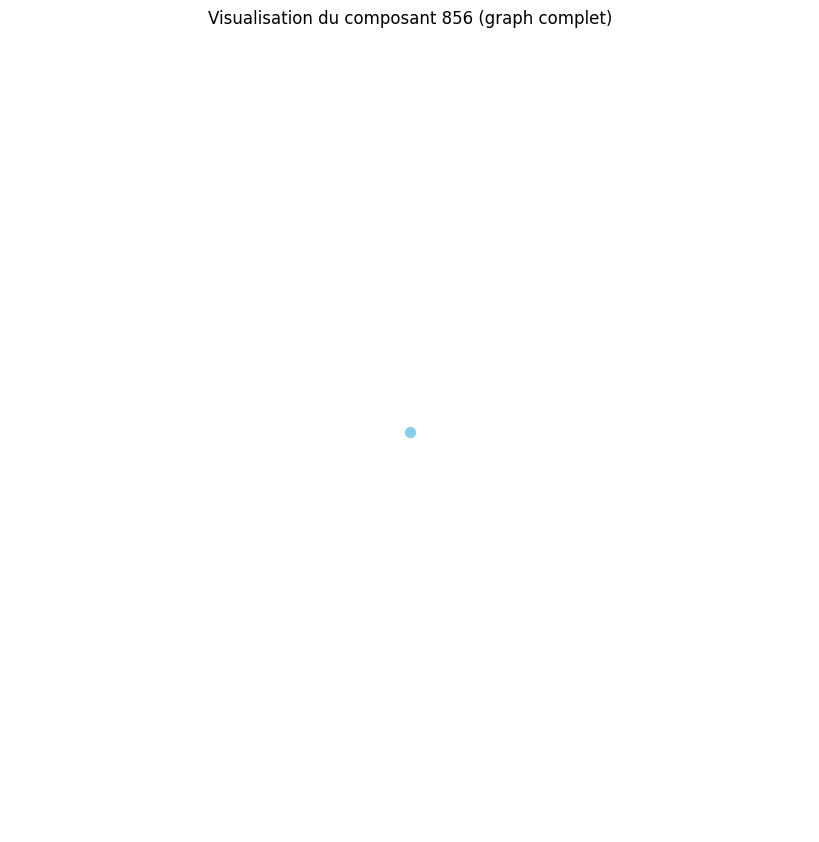

Distance moyenne pour le composant 857 : 0.00
Le composant 857 est un graphe complet ou très densément connecté.
Densité du composant 857 : 0.00
Degré moyen du composant 857 : 0.00
Coefficient de clustering moyen du composant 857 : 0.00


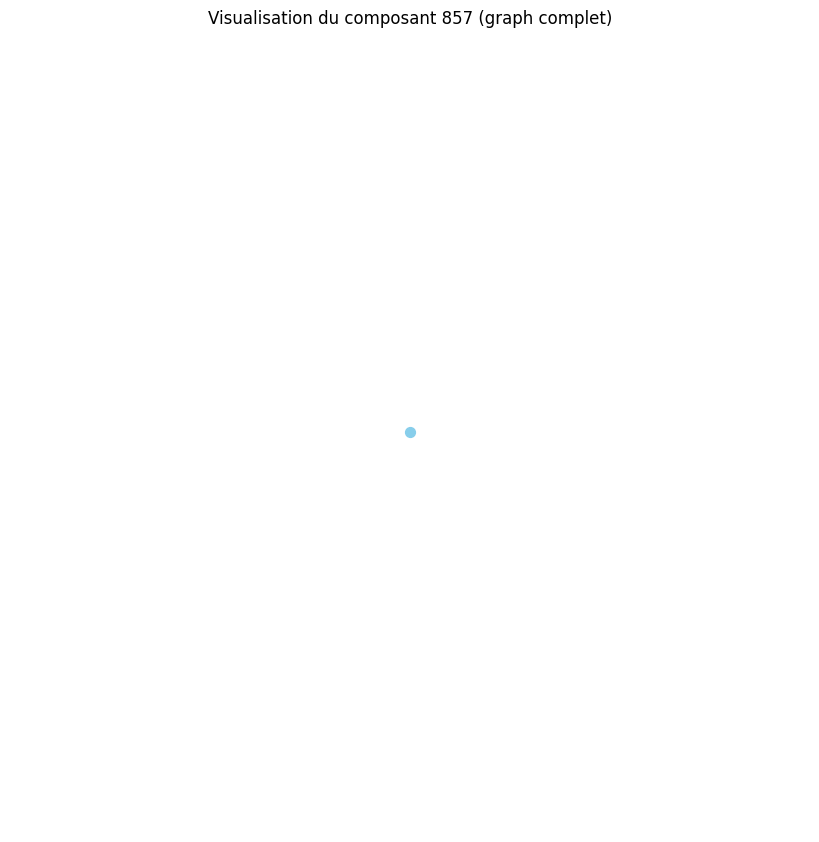

Distance moyenne pour le composant 858 : 0.00
Le composant 858 est un graphe complet ou très densément connecté.
Densité du composant 858 : 0.00
Degré moyen du composant 858 : 0.00
Coefficient de clustering moyen du composant 858 : 0.00


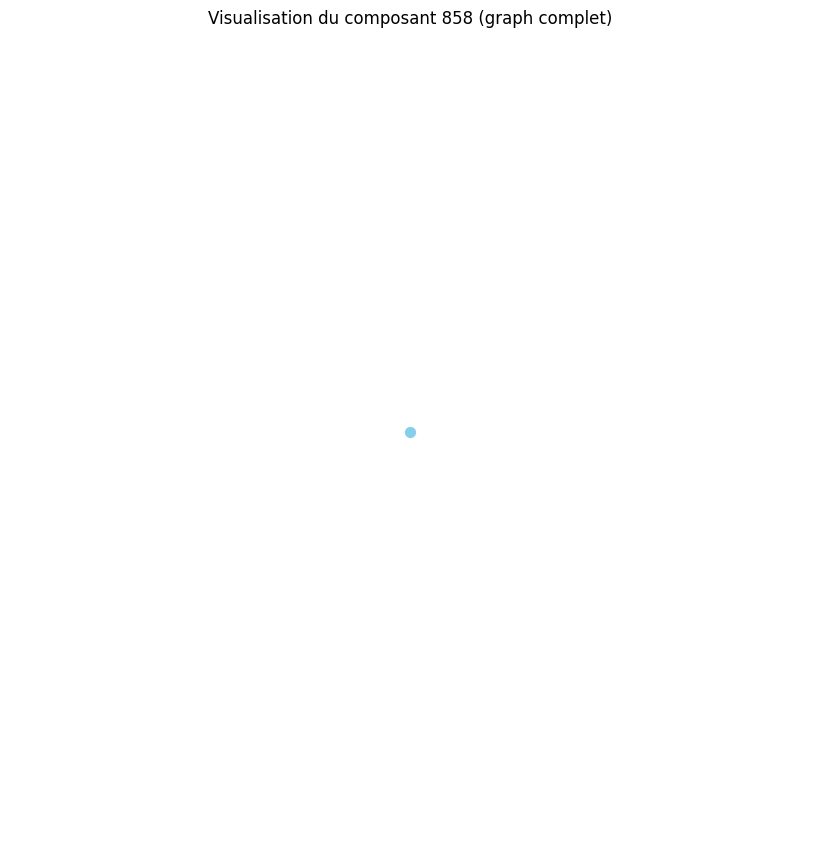

Distance moyenne pour le composant 859 : 0.00
Le composant 859 est un graphe complet ou très densément connecté.
Densité du composant 859 : 0.00
Degré moyen du composant 859 : 0.00
Coefficient de clustering moyen du composant 859 : 0.00


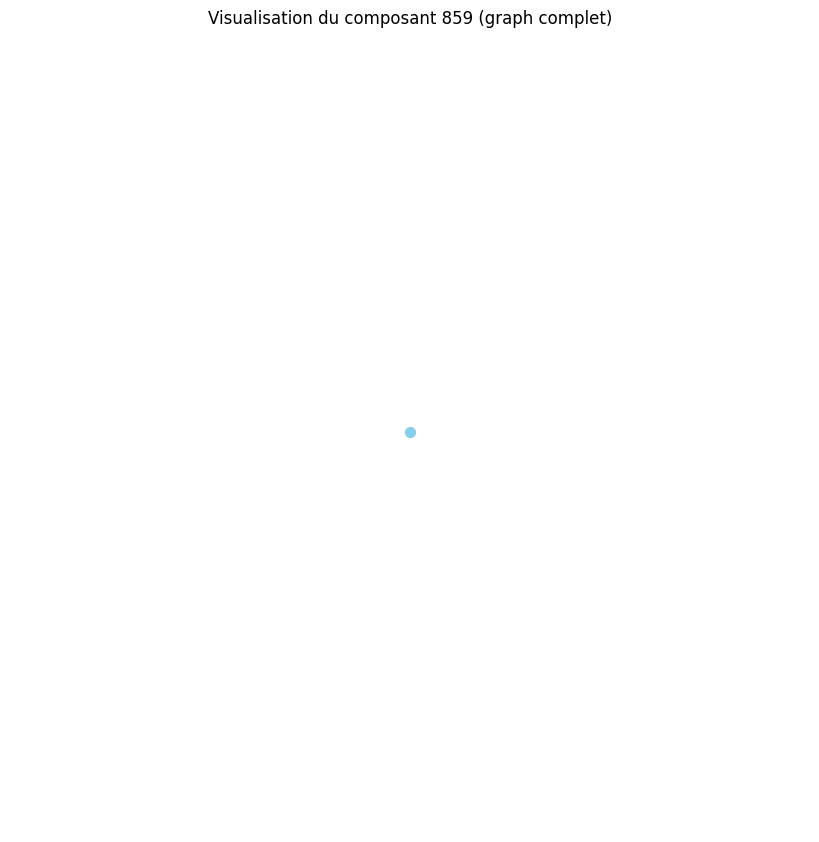

Distance moyenne pour le composant 860 : 0.00
Le composant 860 est un graphe complet ou très densément connecté.
Densité du composant 860 : 0.00
Degré moyen du composant 860 : 0.00
Coefficient de clustering moyen du composant 860 : 0.00


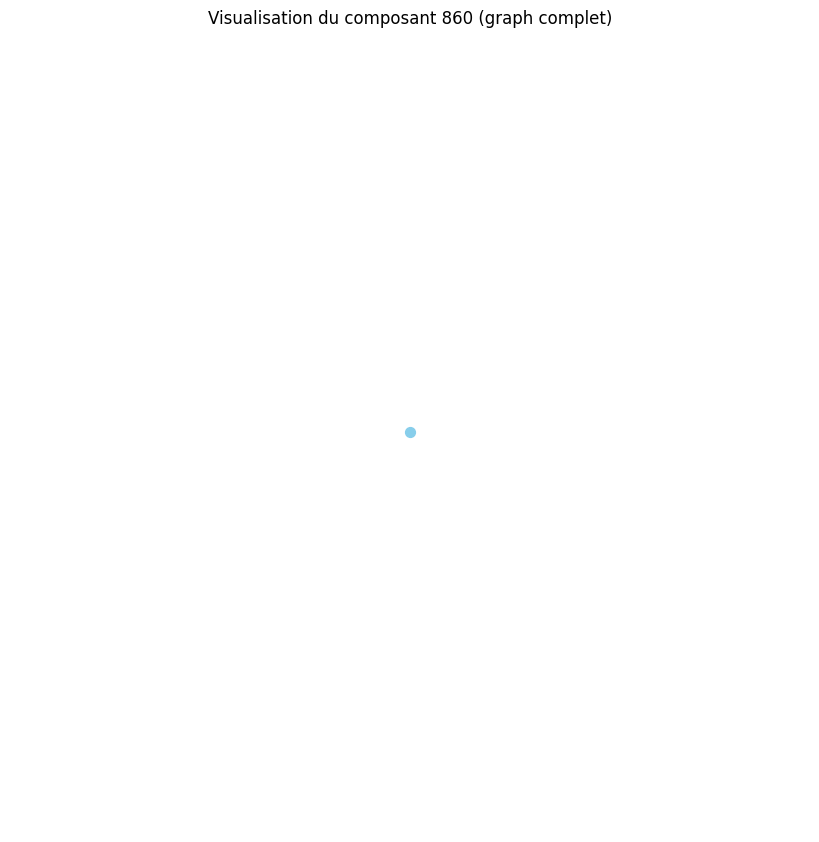

Distance moyenne pour le composant 861 : 0.00
Le composant 861 est un graphe complet ou très densément connecté.
Densité du composant 861 : 0.00
Degré moyen du composant 861 : 0.00
Coefficient de clustering moyen du composant 861 : 0.00


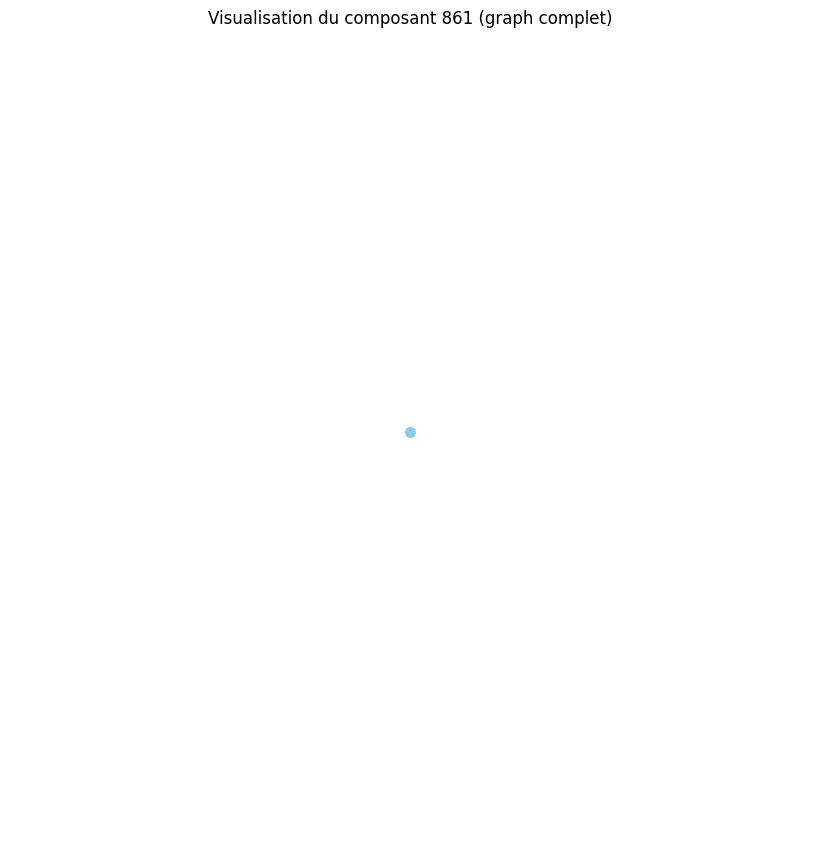

Distance moyenne pour le composant 862 : 0.00
Le composant 862 est un graphe complet ou très densément connecté.
Densité du composant 862 : 0.00
Degré moyen du composant 862 : 0.00
Coefficient de clustering moyen du composant 862 : 0.00


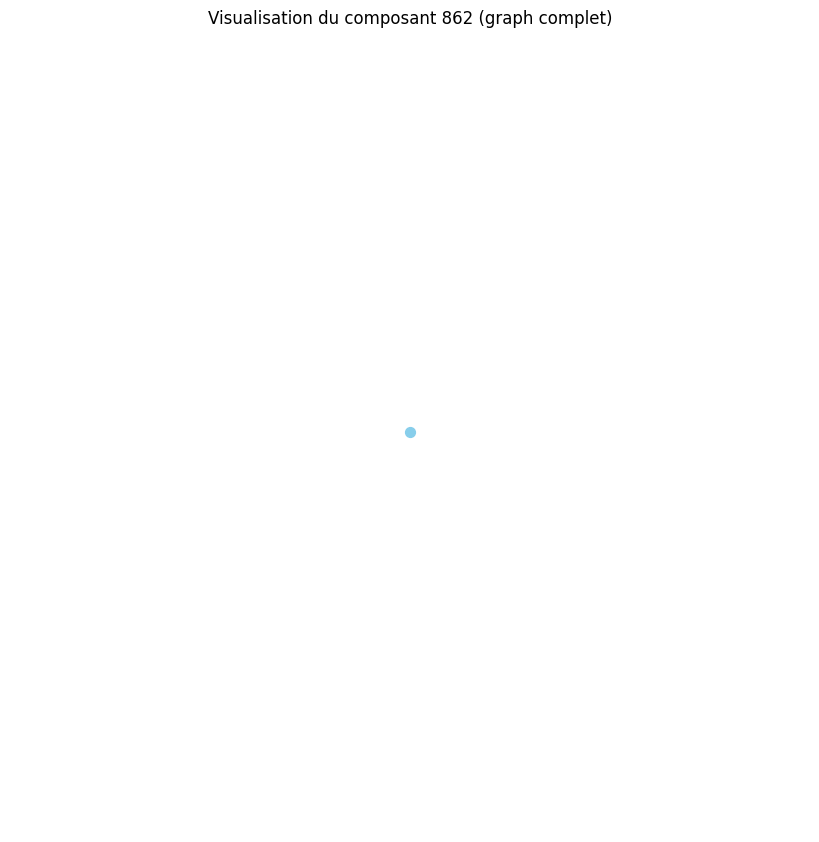

Distance moyenne pour le composant 863 : 0.00
Le composant 863 est un graphe complet ou très densément connecté.
Densité du composant 863 : 0.00
Degré moyen du composant 863 : 0.00
Coefficient de clustering moyen du composant 863 : 0.00


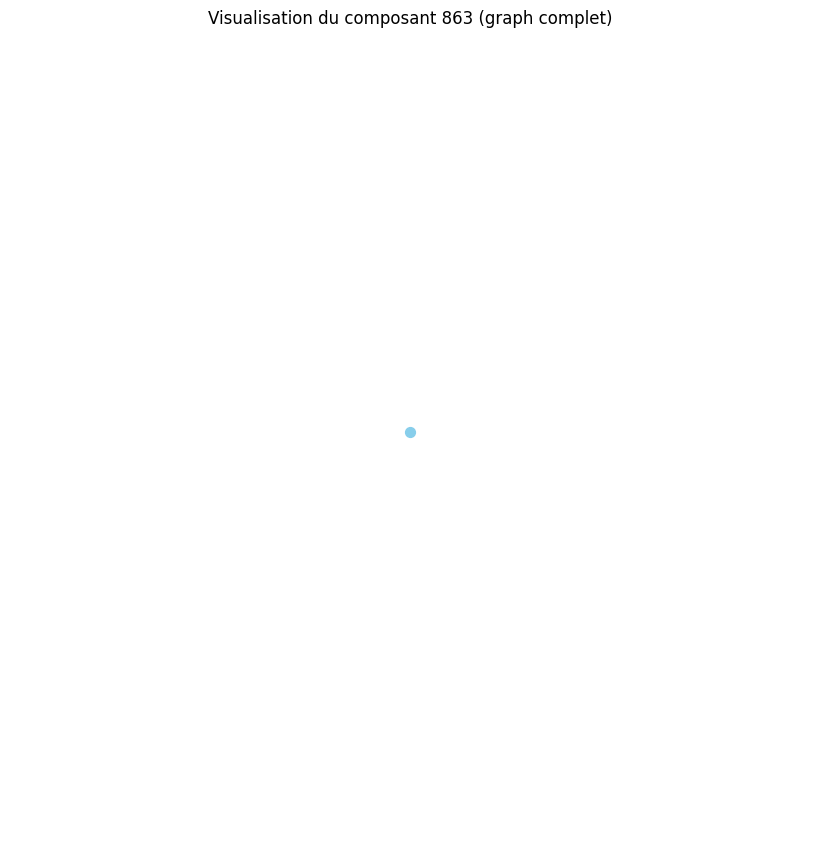

Distance moyenne pour le composant 864 : 0.00
Le composant 864 est un graphe complet ou très densément connecté.
Densité du composant 864 : 0.00
Degré moyen du composant 864 : 0.00
Coefficient de clustering moyen du composant 864 : 0.00


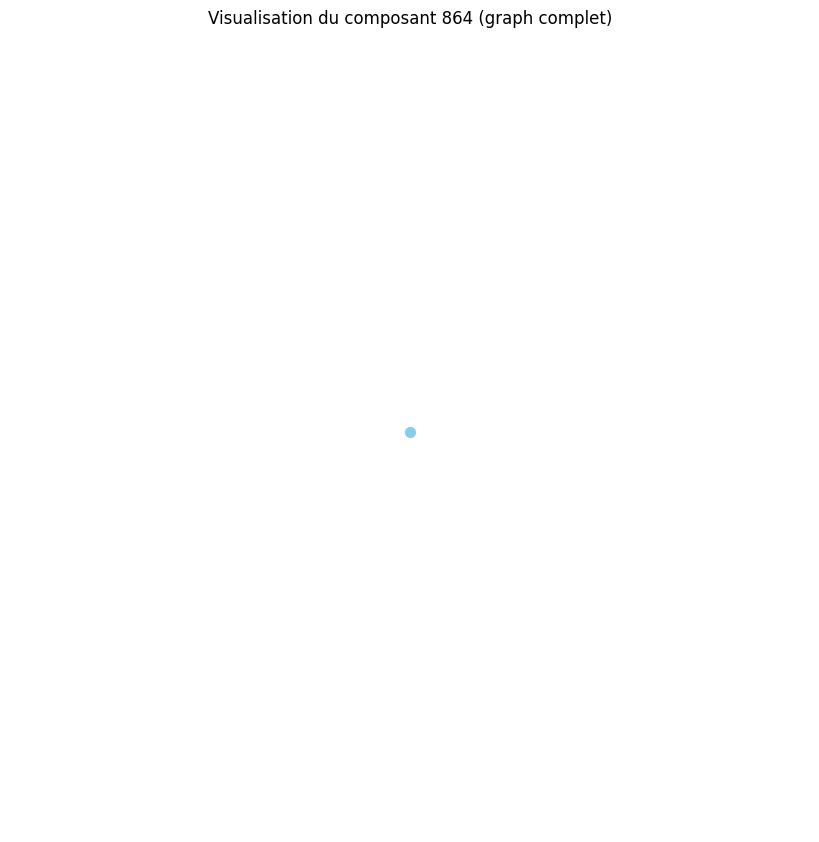

Distance moyenne pour le composant 865 : 0.00
Le composant 865 est un graphe complet ou très densément connecté.
Densité du composant 865 : 0.00
Degré moyen du composant 865 : 0.00
Coefficient de clustering moyen du composant 865 : 0.00


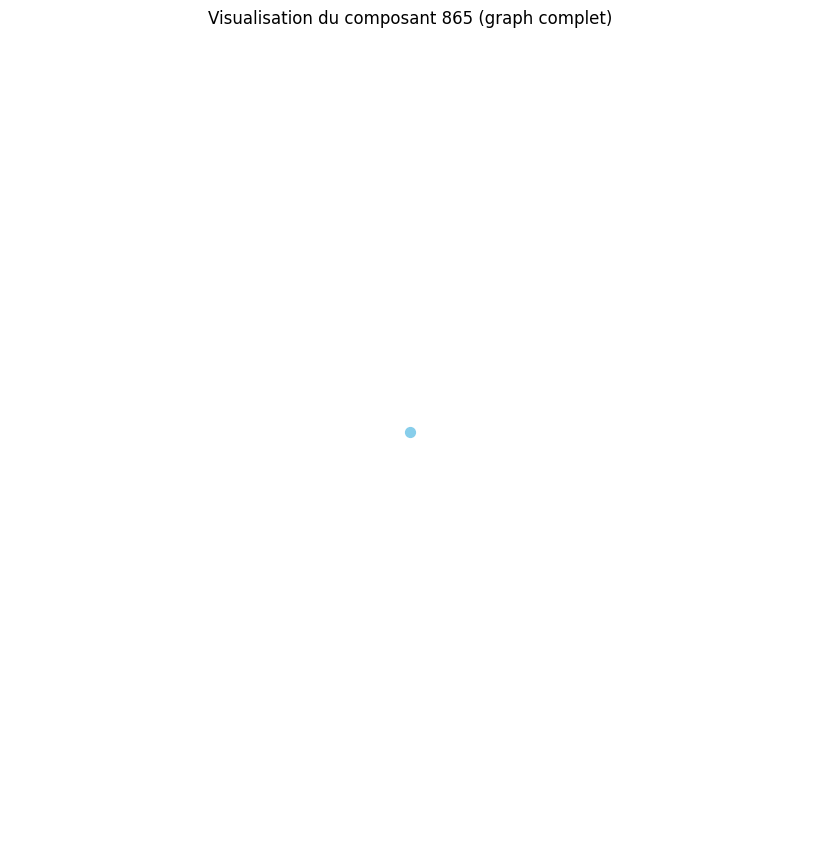

Distance moyenne pour le composant 866 : 0.00
Le composant 866 est un graphe complet ou très densément connecté.
Densité du composant 866 : 0.00
Degré moyen du composant 866 : 0.00
Coefficient de clustering moyen du composant 866 : 0.00


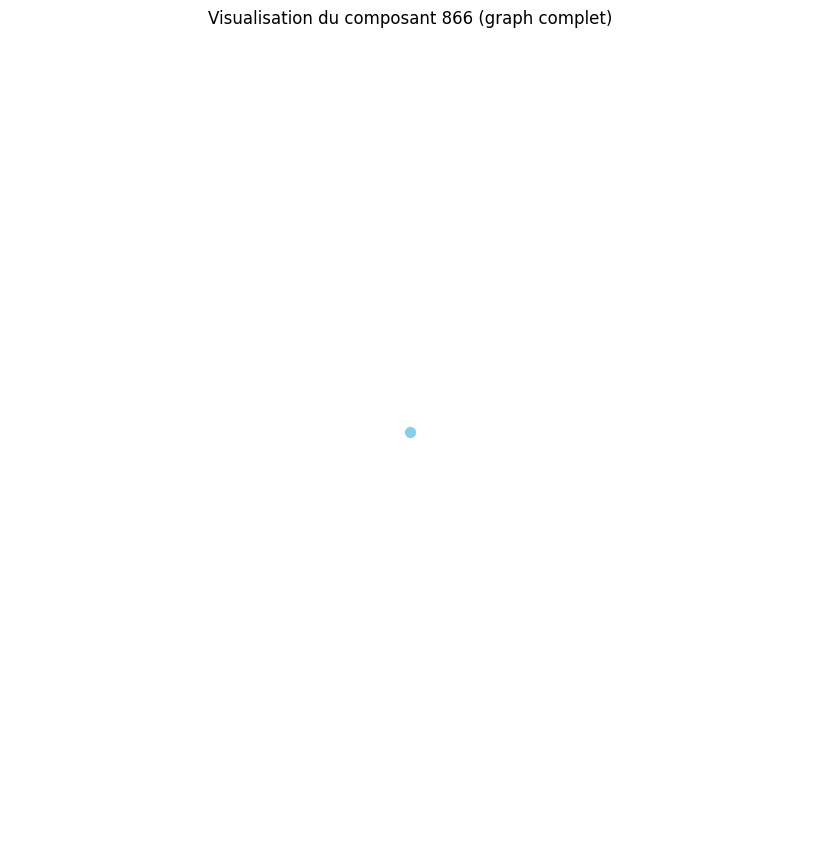

Distance moyenne pour le composant 867 : 0.00
Le composant 867 est un graphe complet ou très densément connecté.
Densité du composant 867 : 0.00
Degré moyen du composant 867 : 0.00
Coefficient de clustering moyen du composant 867 : 0.00


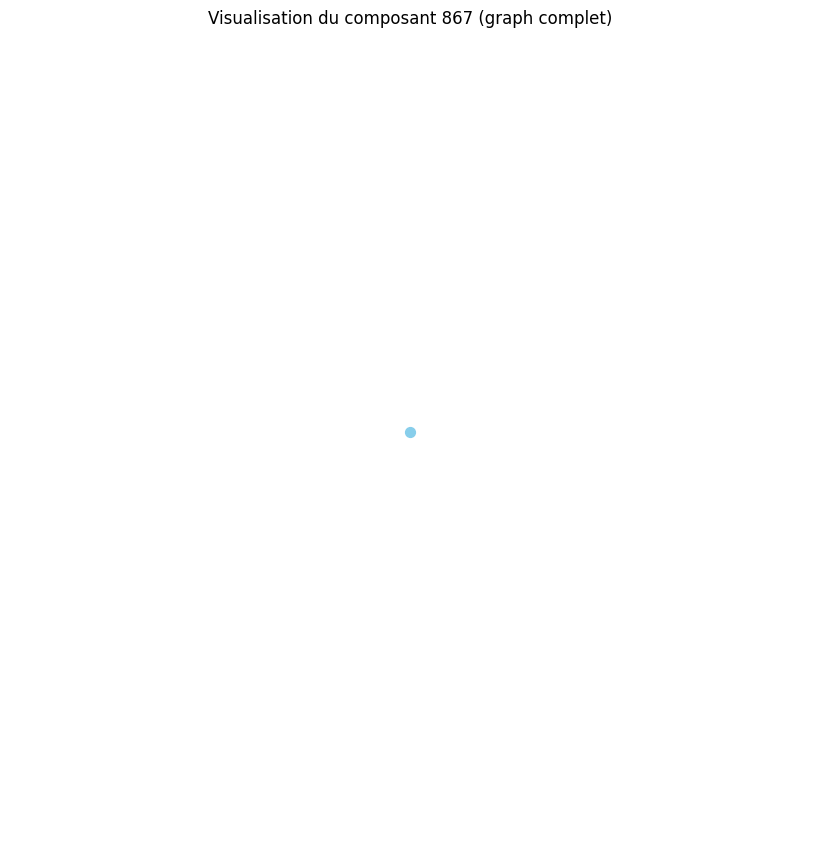

Distance moyenne pour le composant 868 : 0.00
Le composant 868 est un graphe complet ou très densément connecté.
Densité du composant 868 : 0.00
Degré moyen du composant 868 : 0.00
Coefficient de clustering moyen du composant 868 : 0.00


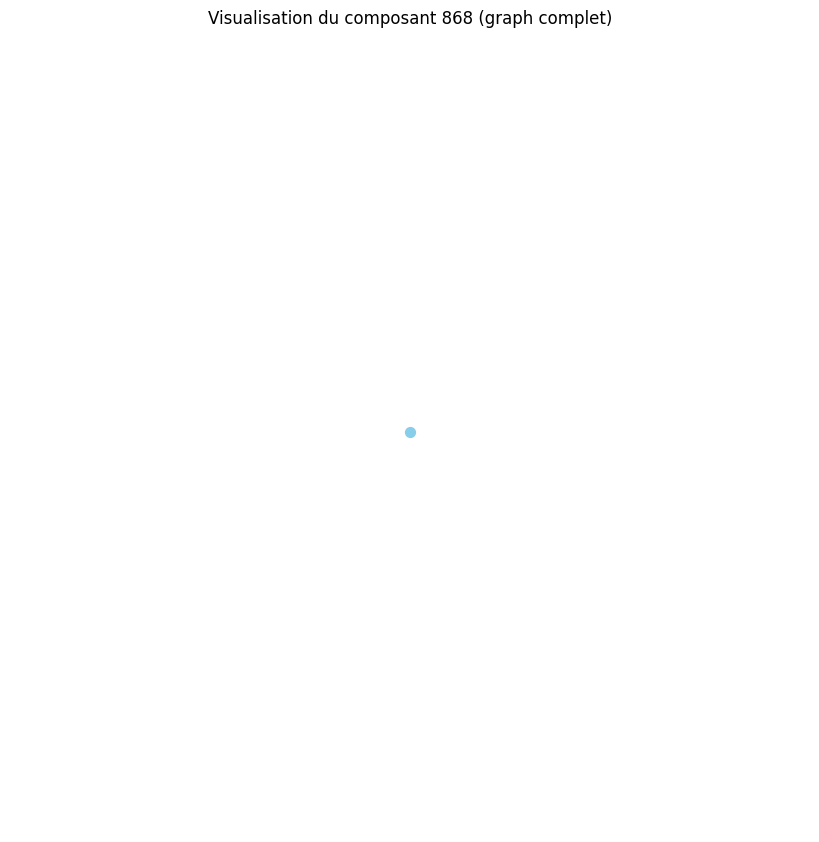

Distance moyenne pour le composant 869 : 0.00
Le composant 869 est un graphe complet ou très densément connecté.
Densité du composant 869 : 0.00
Degré moyen du composant 869 : 0.00
Coefficient de clustering moyen du composant 869 : 0.00


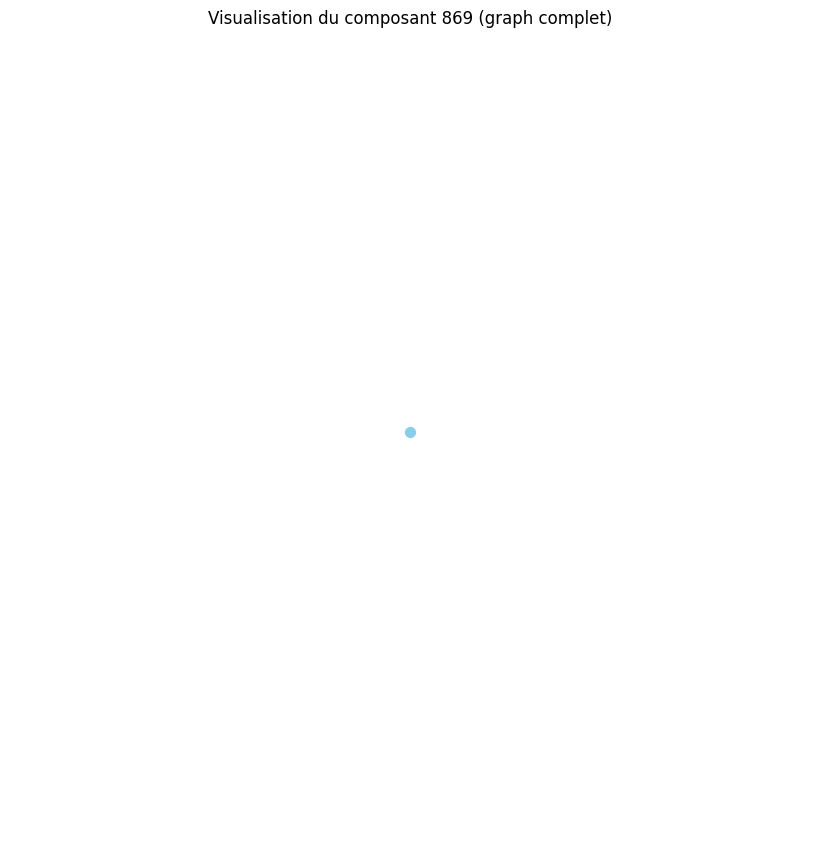

Distance moyenne pour le composant 870 : 0.00
Le composant 870 est un graphe complet ou très densément connecté.
Densité du composant 870 : 0.00
Degré moyen du composant 870 : 0.00
Coefficient de clustering moyen du composant 870 : 0.00


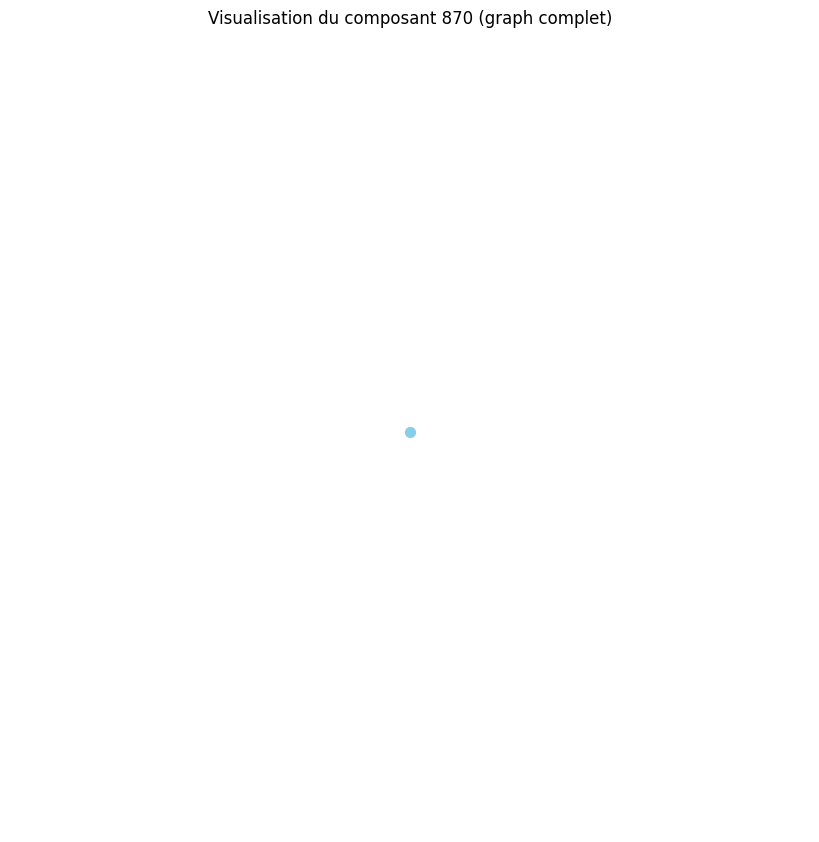

Distance moyenne pour le composant 871 : 0.00
Le composant 871 est un graphe complet ou très densément connecté.
Densité du composant 871 : 0.00
Degré moyen du composant 871 : 0.00
Coefficient de clustering moyen du composant 871 : 0.00


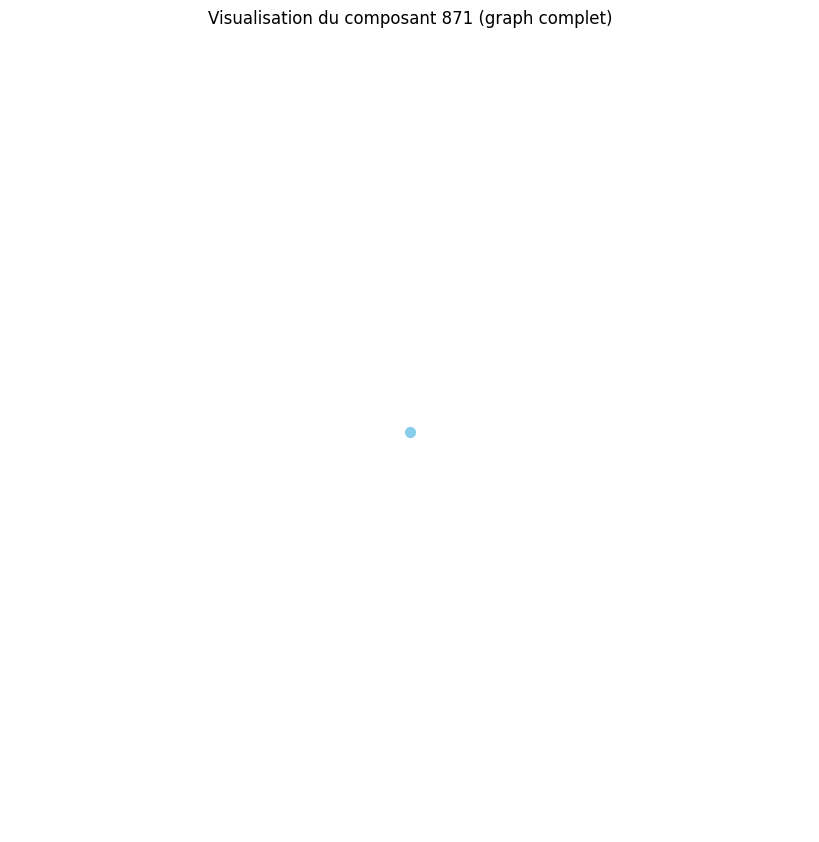

Distance moyenne pour le composant 872 : 0.00
Le composant 872 est un graphe complet ou très densément connecté.
Densité du composant 872 : 0.00
Degré moyen du composant 872 : 0.00
Coefficient de clustering moyen du composant 872 : 0.00


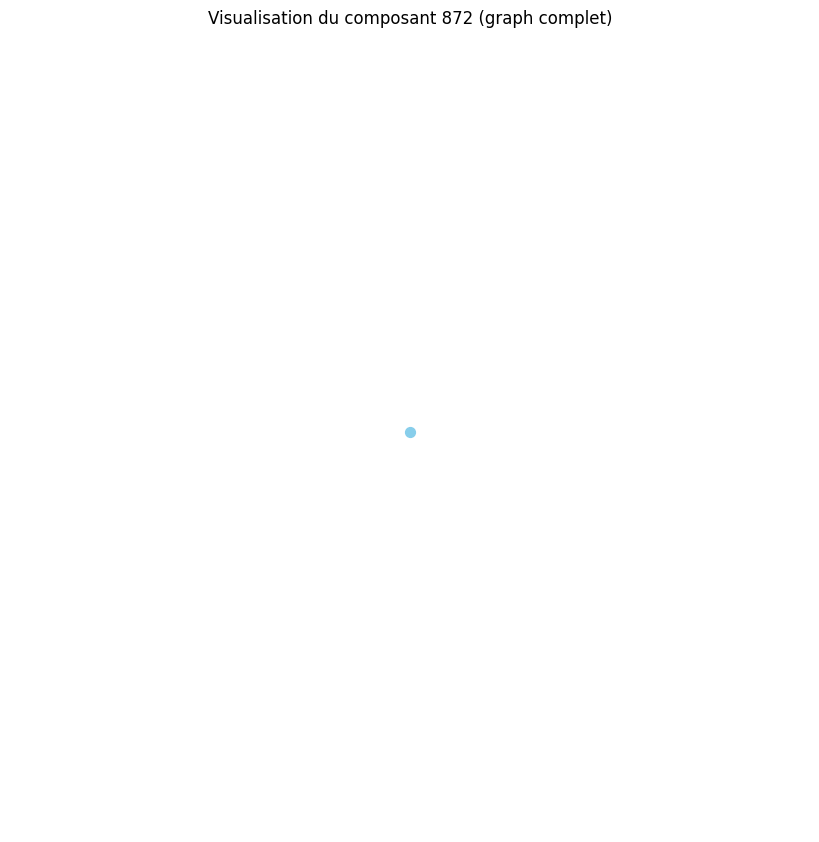

Distance moyenne pour le composant 873 : 0.00
Le composant 873 est un graphe complet ou très densément connecté.
Densité du composant 873 : 0.00
Degré moyen du composant 873 : 0.00
Coefficient de clustering moyen du composant 873 : 0.00


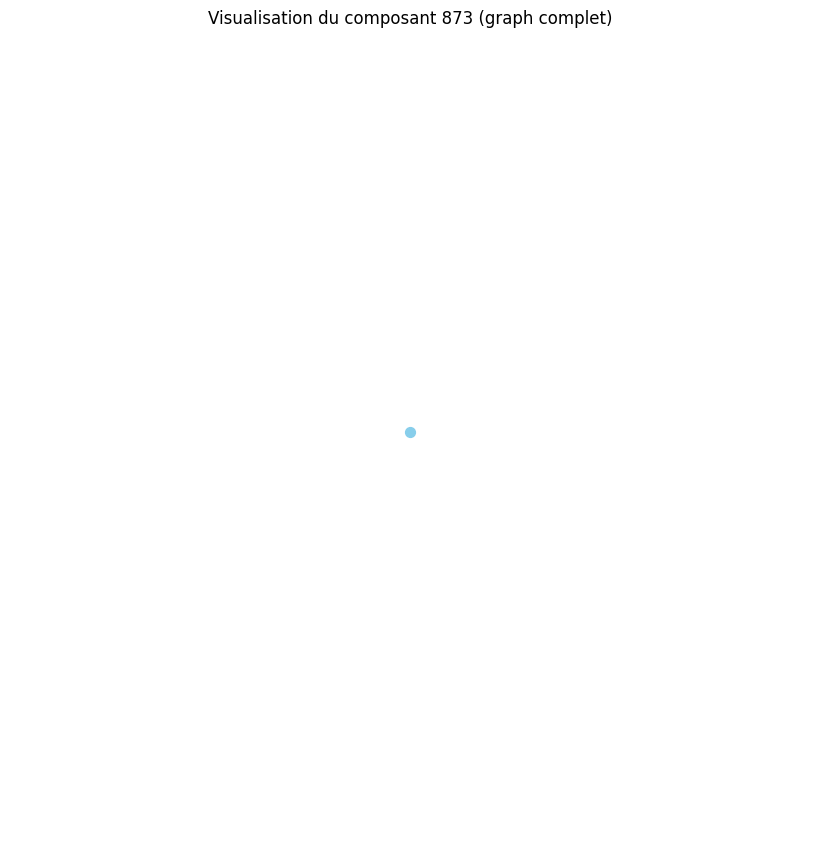

Distance moyenne pour le composant 874 : 0.00
Le composant 874 est un graphe complet ou très densément connecté.
Densité du composant 874 : 0.00
Degré moyen du composant 874 : 0.00
Coefficient de clustering moyen du composant 874 : 0.00


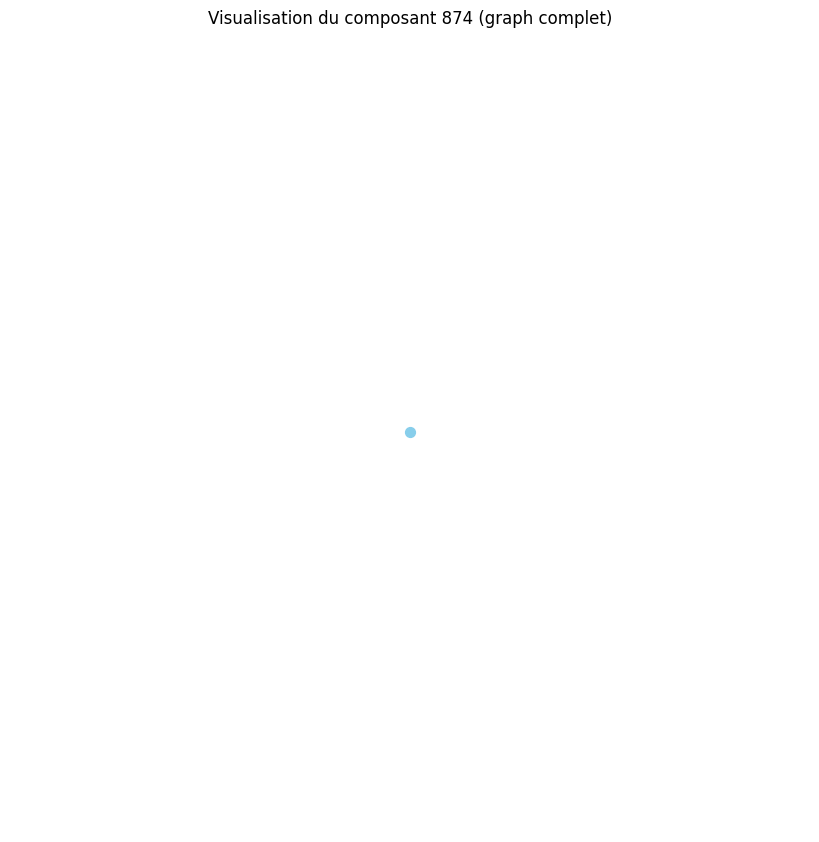

Distance moyenne pour le composant 875 : 0.00
Le composant 875 est un graphe complet ou très densément connecté.
Densité du composant 875 : 0.00
Degré moyen du composant 875 : 0.00
Coefficient de clustering moyen du composant 875 : 0.00


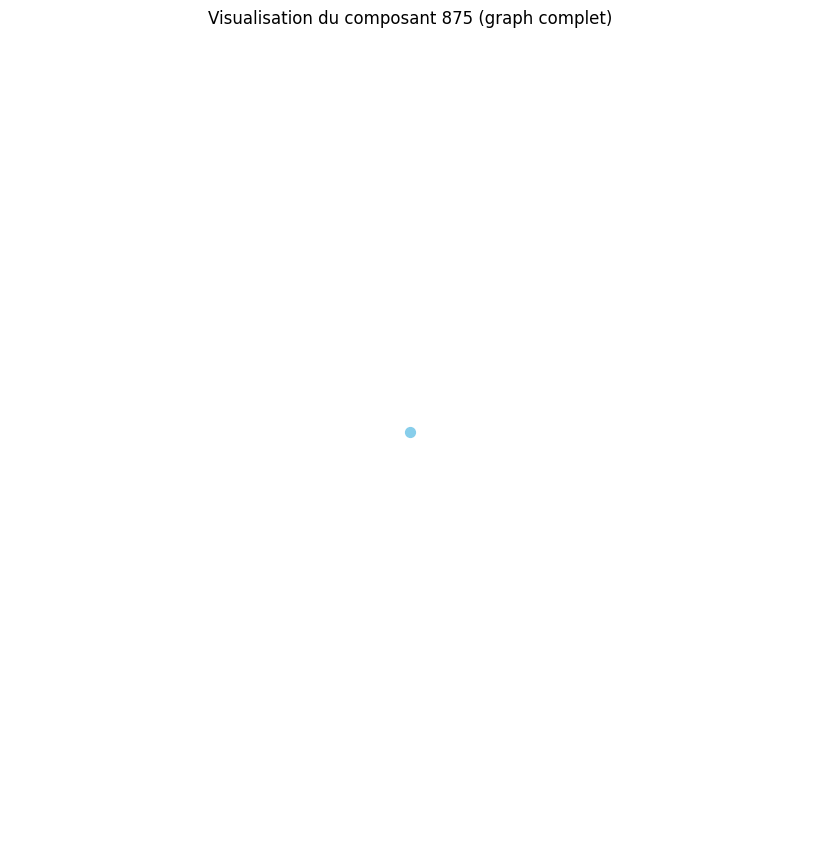

Distance moyenne pour le composant 876 : 0.00
Le composant 876 est un graphe complet ou très densément connecté.
Densité du composant 876 : 0.00
Degré moyen du composant 876 : 0.00
Coefficient de clustering moyen du composant 876 : 0.00


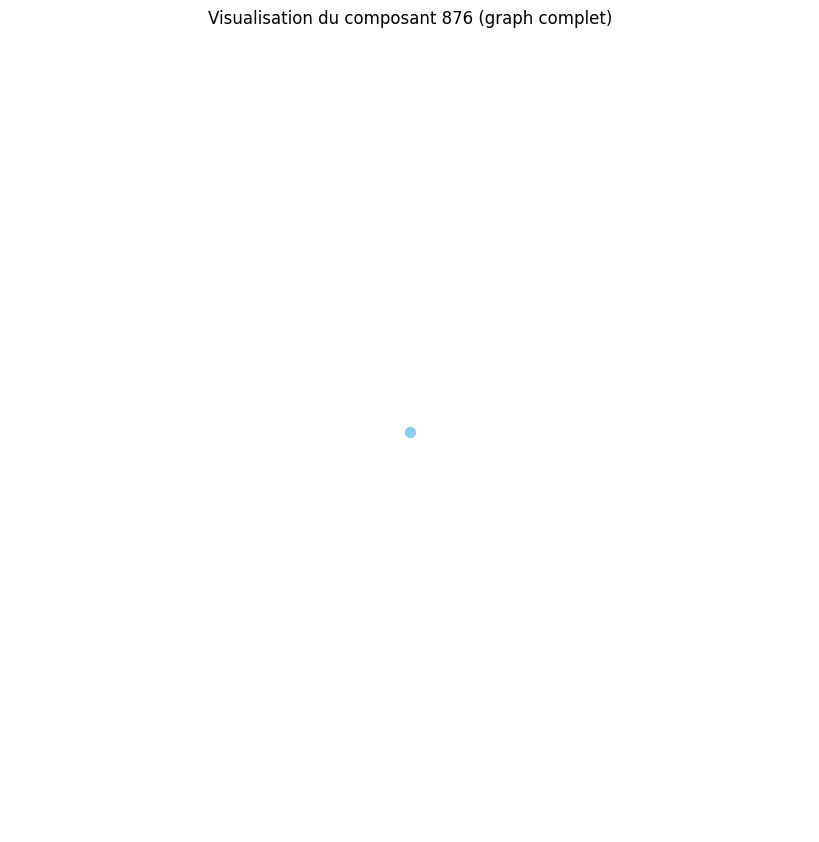

Distance moyenne pour le composant 877 : 0.00
Le composant 877 est un graphe complet ou très densément connecté.
Densité du composant 877 : 0.00
Degré moyen du composant 877 : 0.00
Coefficient de clustering moyen du composant 877 : 0.00


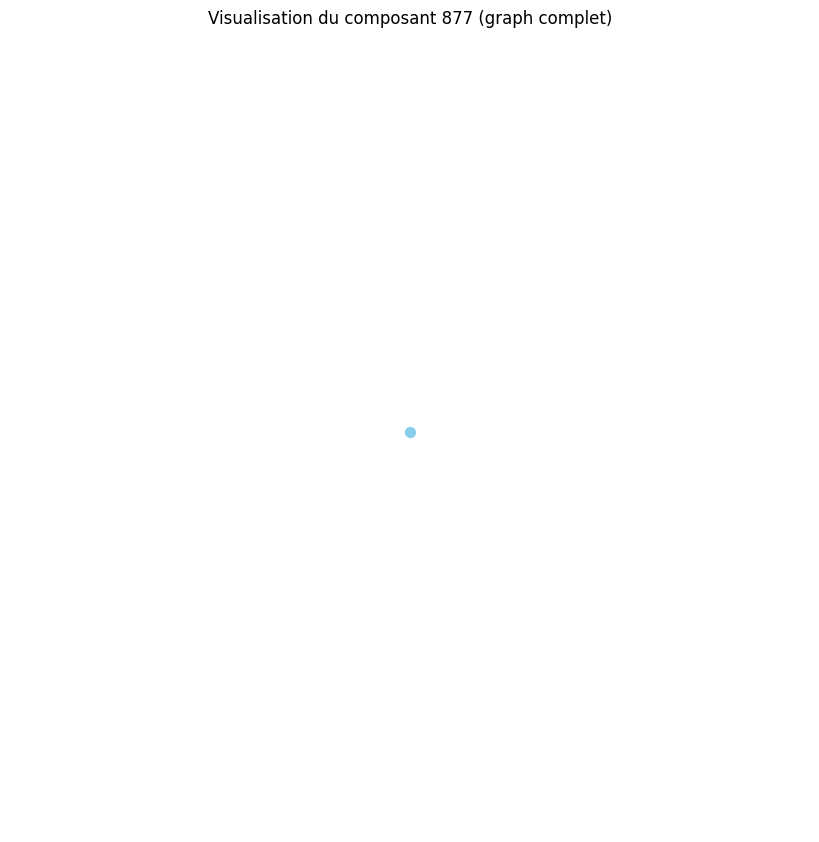

Distance moyenne pour le composant 878 : 0.00
Le composant 878 est un graphe complet ou très densément connecté.
Densité du composant 878 : 0.00
Degré moyen du composant 878 : 0.00
Coefficient de clustering moyen du composant 878 : 0.00


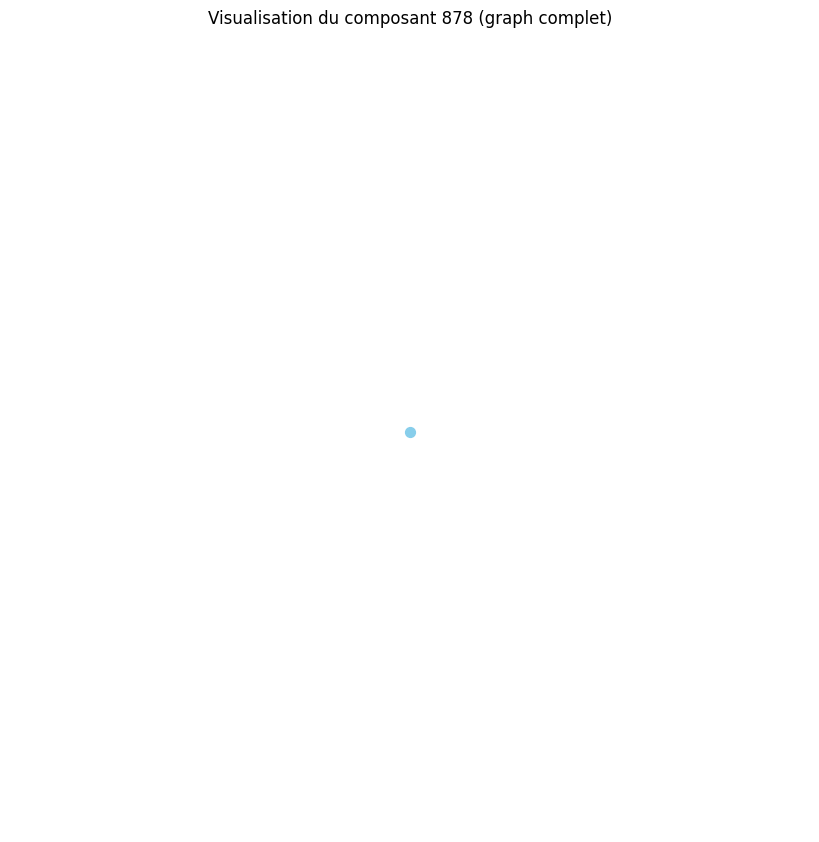

Distance moyenne pour le composant 879 : 0.00
Le composant 879 est un graphe complet ou très densément connecté.
Densité du composant 879 : 0.00
Degré moyen du composant 879 : 0.00
Coefficient de clustering moyen du composant 879 : 0.00


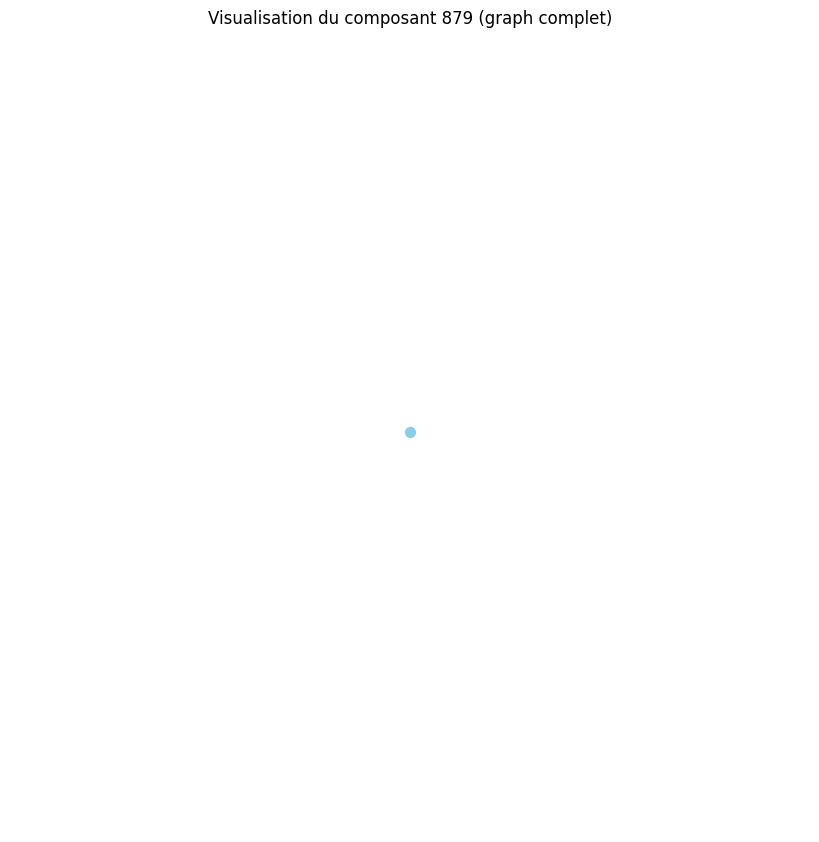

Distance moyenne pour le composant 880 : 0.00
Le composant 880 est un graphe complet ou très densément connecté.
Densité du composant 880 : 0.00
Degré moyen du composant 880 : 0.00
Coefficient de clustering moyen du composant 880 : 0.00


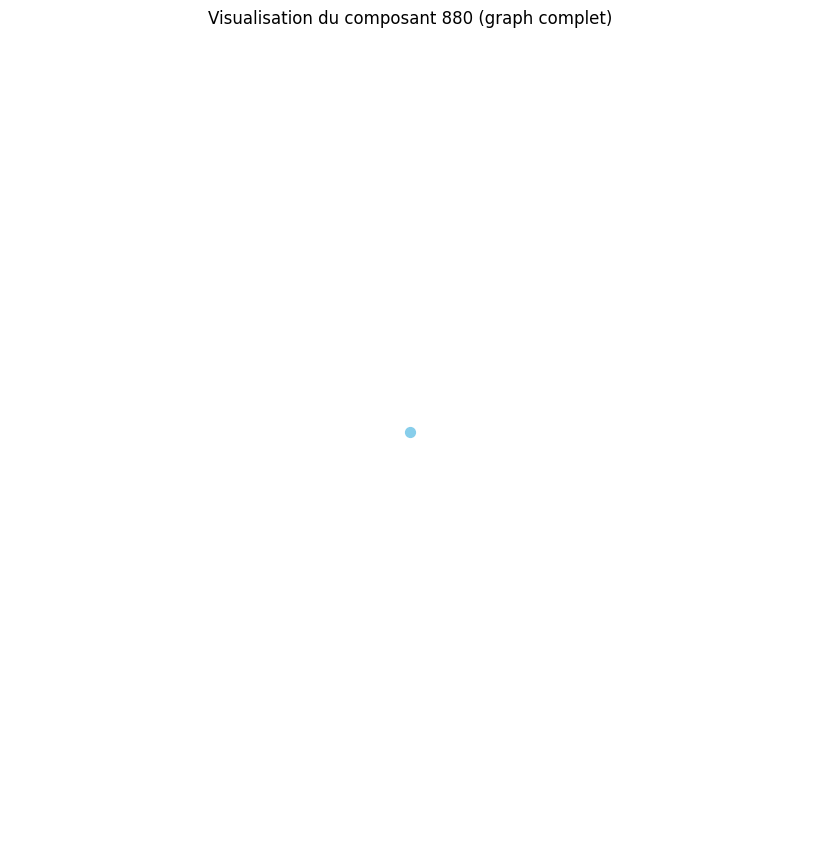

Distance moyenne pour le composant 881 : 0.00
Le composant 881 est un graphe complet ou très densément connecté.
Densité du composant 881 : 0.00
Degré moyen du composant 881 : 0.00
Coefficient de clustering moyen du composant 881 : 0.00


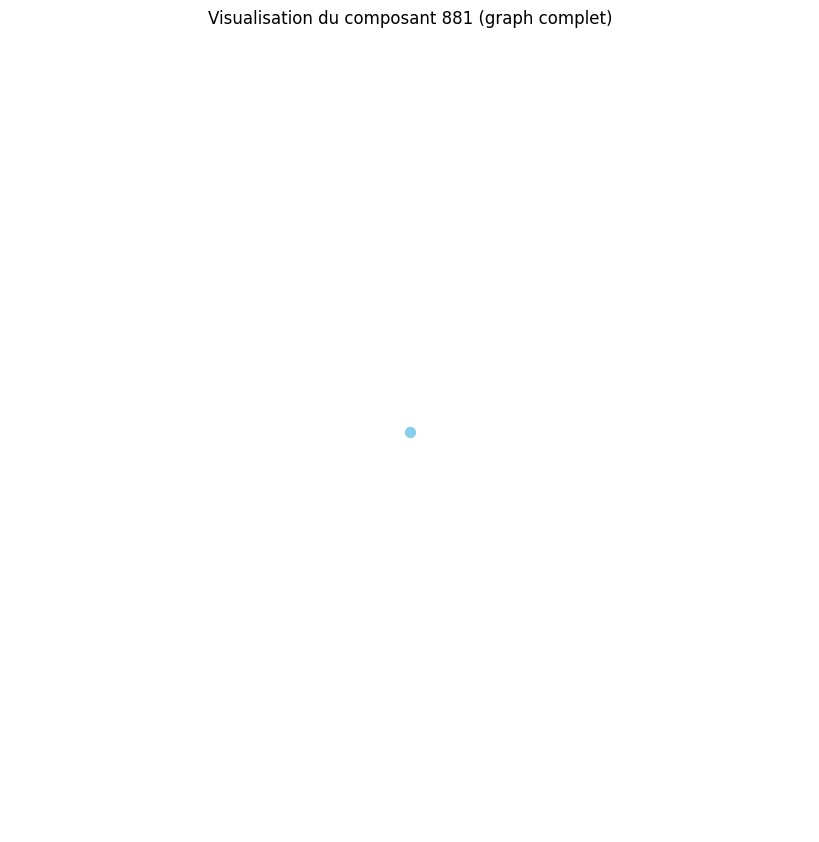

Distance moyenne pour le composant 882 : 0.00
Le composant 882 est un graphe complet ou très densément connecté.
Densité du composant 882 : 0.00
Degré moyen du composant 882 : 0.00
Coefficient de clustering moyen du composant 882 : 0.00


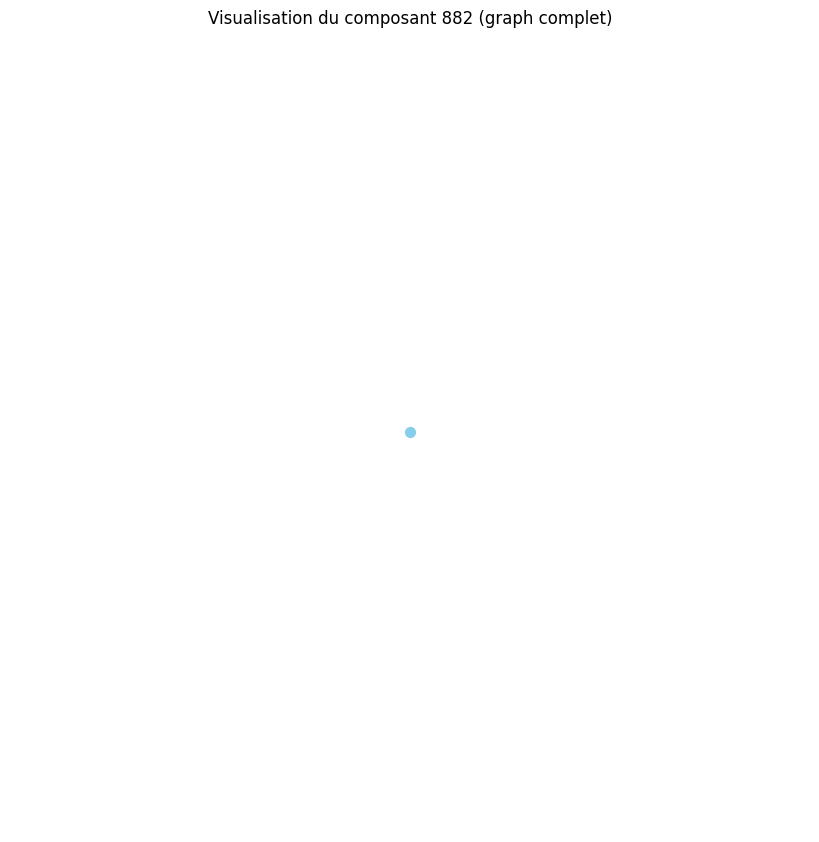

Distance moyenne pour le composant 883 : 0.00
Le composant 883 est un graphe complet ou très densément connecté.
Densité du composant 883 : 0.00
Degré moyen du composant 883 : 0.00
Coefficient de clustering moyen du composant 883 : 0.00


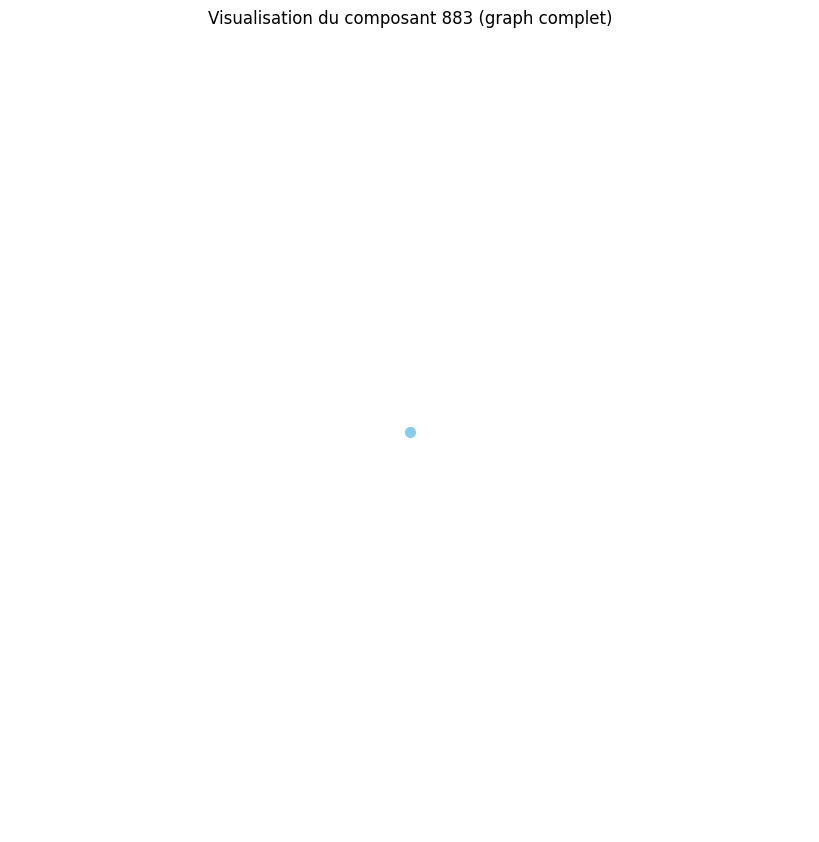

Distance moyenne pour le composant 884 : 0.00
Le composant 884 est un graphe complet ou très densément connecté.
Densité du composant 884 : 0.00
Degré moyen du composant 884 : 0.00
Coefficient de clustering moyen du composant 884 : 0.00


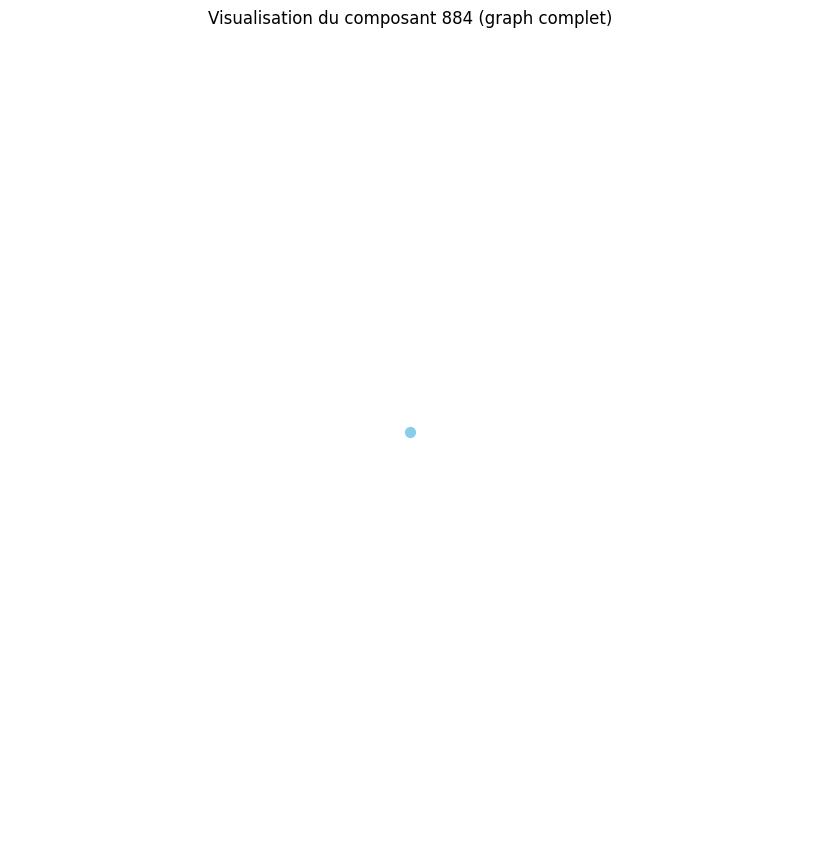

Distance moyenne pour le composant 885 : 0.00
Le composant 885 est un graphe complet ou très densément connecté.
Densité du composant 885 : 0.00
Degré moyen du composant 885 : 0.00
Coefficient de clustering moyen du composant 885 : 0.00


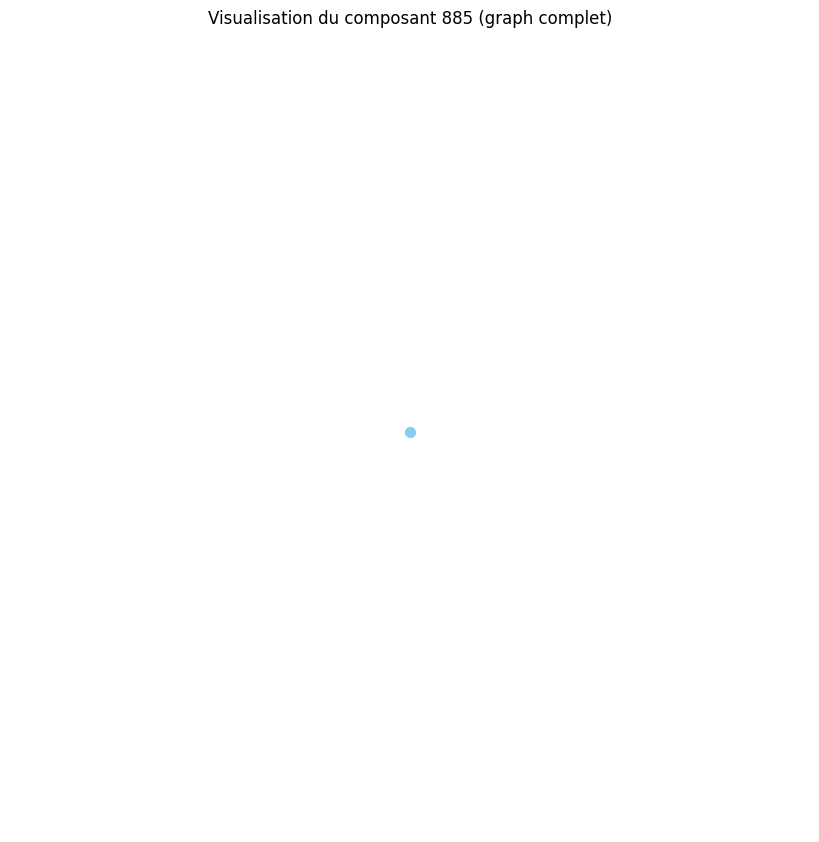

Distance moyenne pour le composant 886 : 0.00
Le composant 886 est un graphe complet ou très densément connecté.
Densité du composant 886 : 0.00
Degré moyen du composant 886 : 0.00
Coefficient de clustering moyen du composant 886 : 0.00


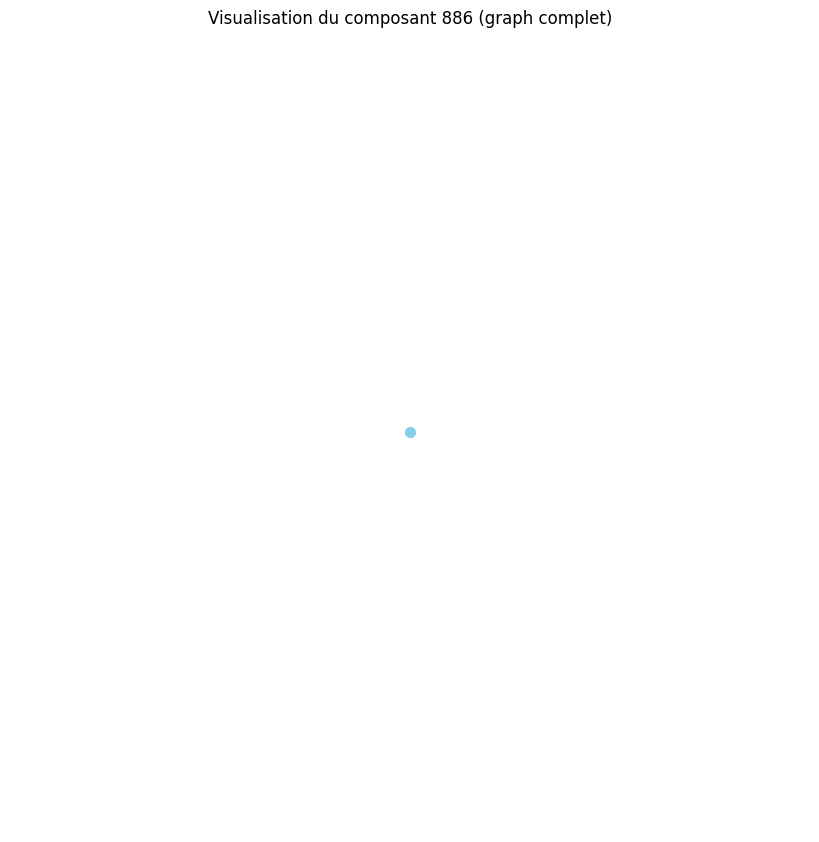

Distance moyenne pour le composant 887 : 0.00
Le composant 887 est un graphe complet ou très densément connecté.
Densité du composant 887 : 0.00
Degré moyen du composant 887 : 0.00
Coefficient de clustering moyen du composant 887 : 0.00


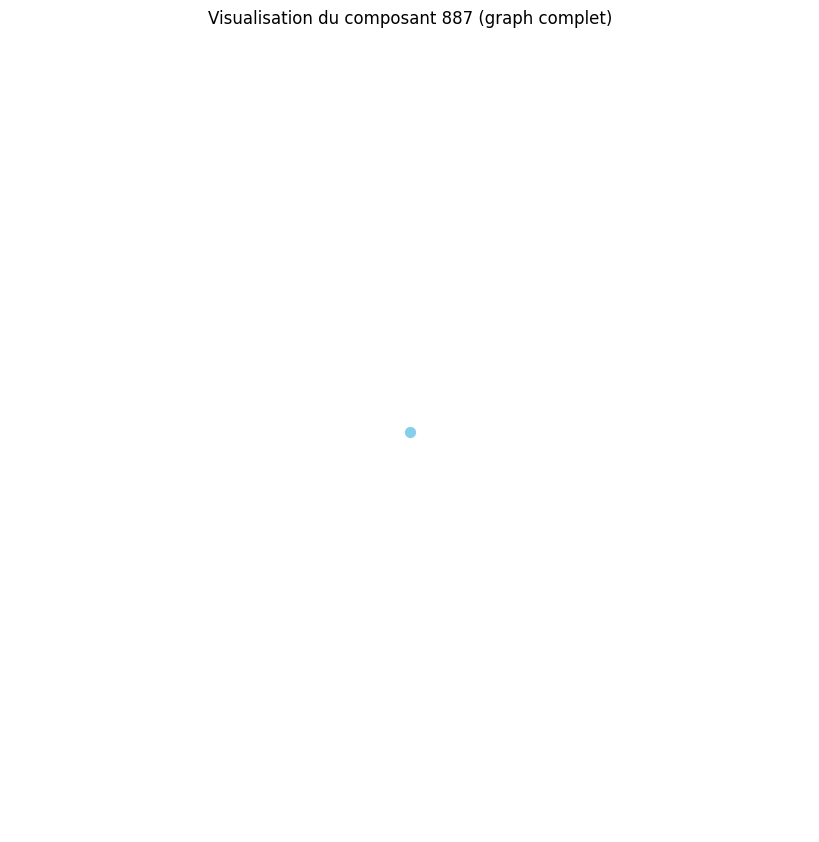

Distance moyenne pour le composant 888 : 0.00
Le composant 888 est un graphe complet ou très densément connecté.
Densité du composant 888 : 0.00
Degré moyen du composant 888 : 0.00
Coefficient de clustering moyen du composant 888 : 0.00


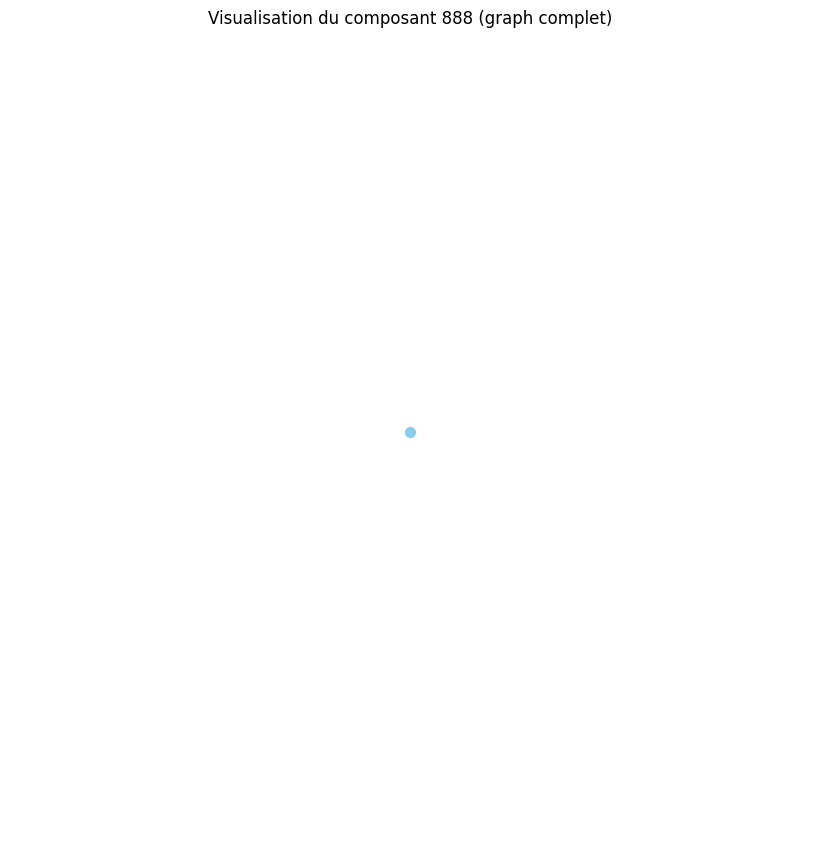

Distance moyenne pour le composant 889 : 0.00
Le composant 889 est un graphe complet ou très densément connecté.
Densité du composant 889 : 0.00
Degré moyen du composant 889 : 0.00
Coefficient de clustering moyen du composant 889 : 0.00


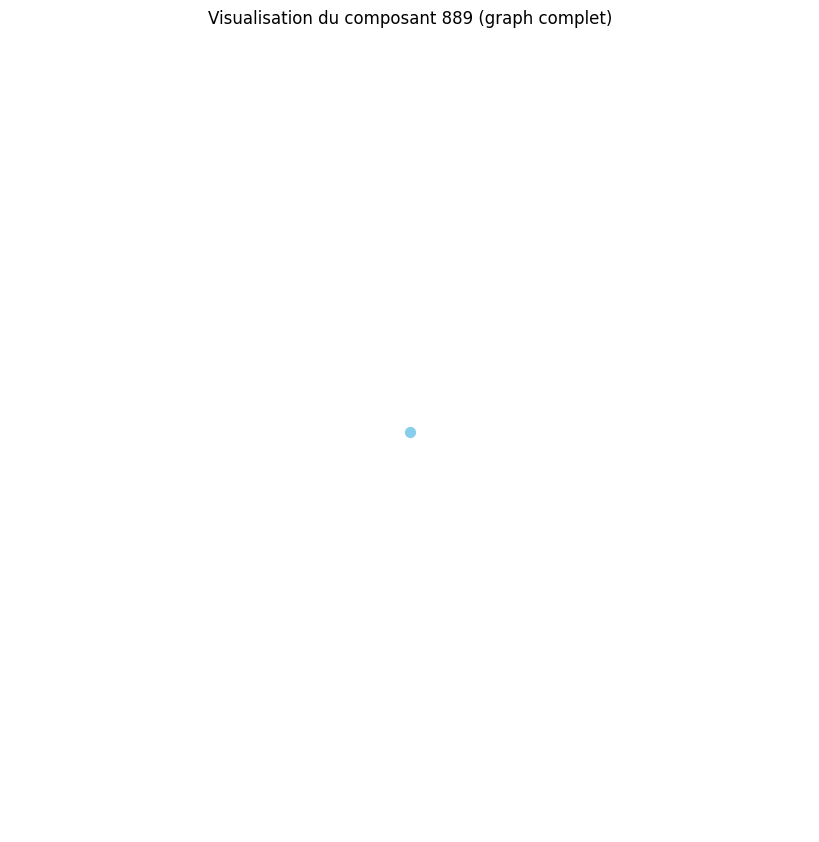

Distance moyenne pour le composant 890 : 0.00
Le composant 890 est un graphe complet ou très densément connecté.
Densité du composant 890 : 0.00
Degré moyen du composant 890 : 0.00
Coefficient de clustering moyen du composant 890 : 0.00


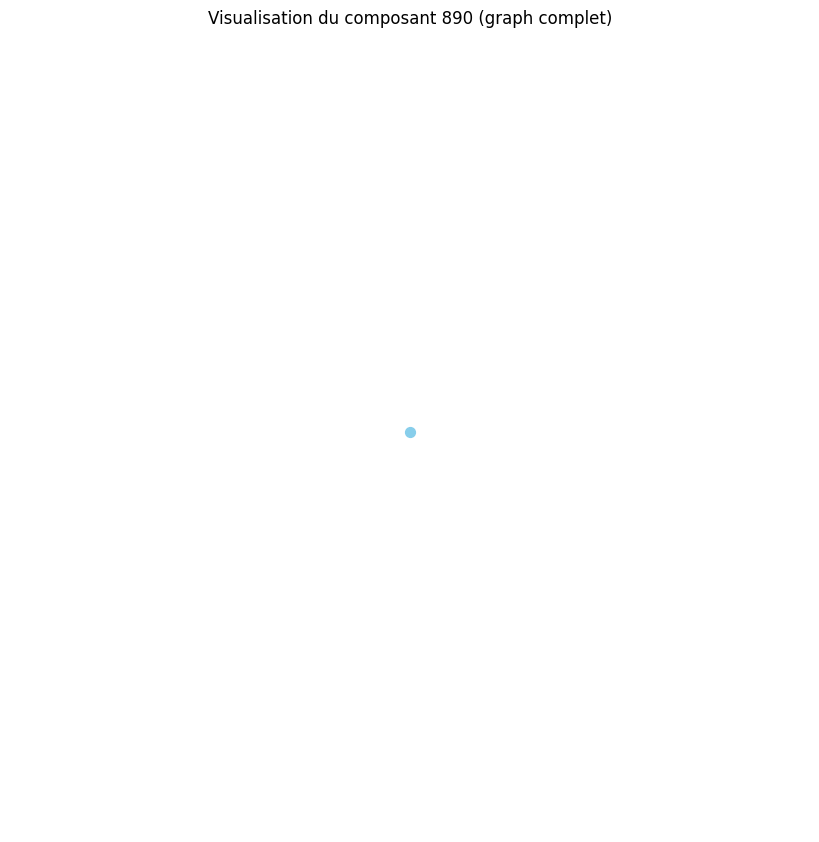

Distance moyenne pour le composant 891 : 0.00
Le composant 891 est un graphe complet ou très densément connecté.
Densité du composant 891 : 0.00
Degré moyen du composant 891 : 0.00
Coefficient de clustering moyen du composant 891 : 0.00


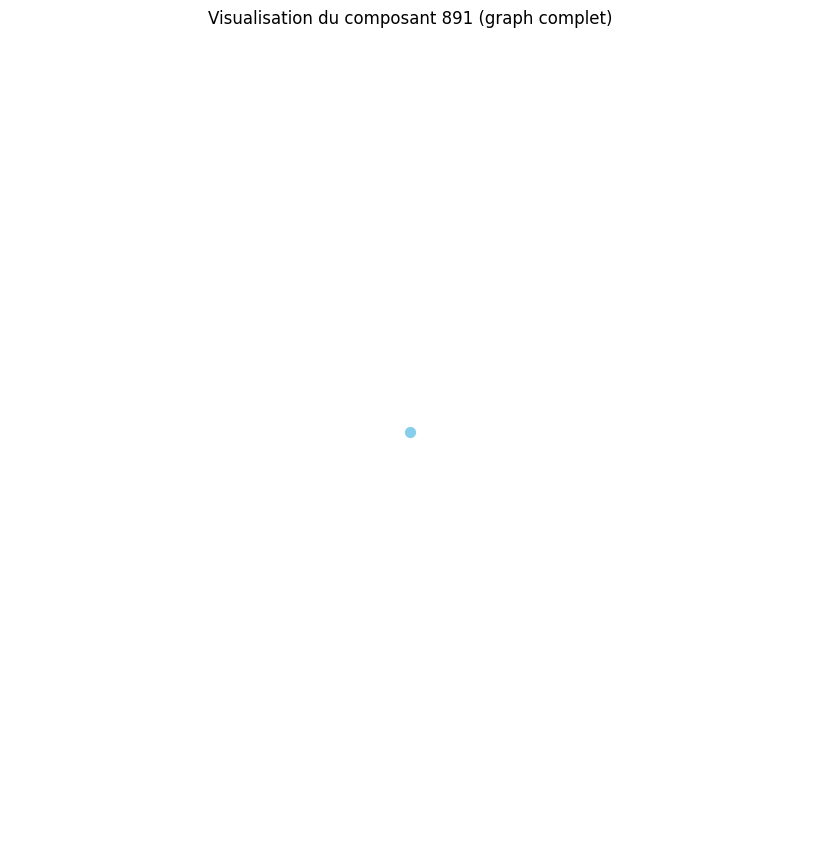

Distance moyenne pour le composant 892 : 0.00
Le composant 892 est un graphe complet ou très densément connecté.
Densité du composant 892 : 0.00
Degré moyen du composant 892 : 0.00
Coefficient de clustering moyen du composant 892 : 0.00


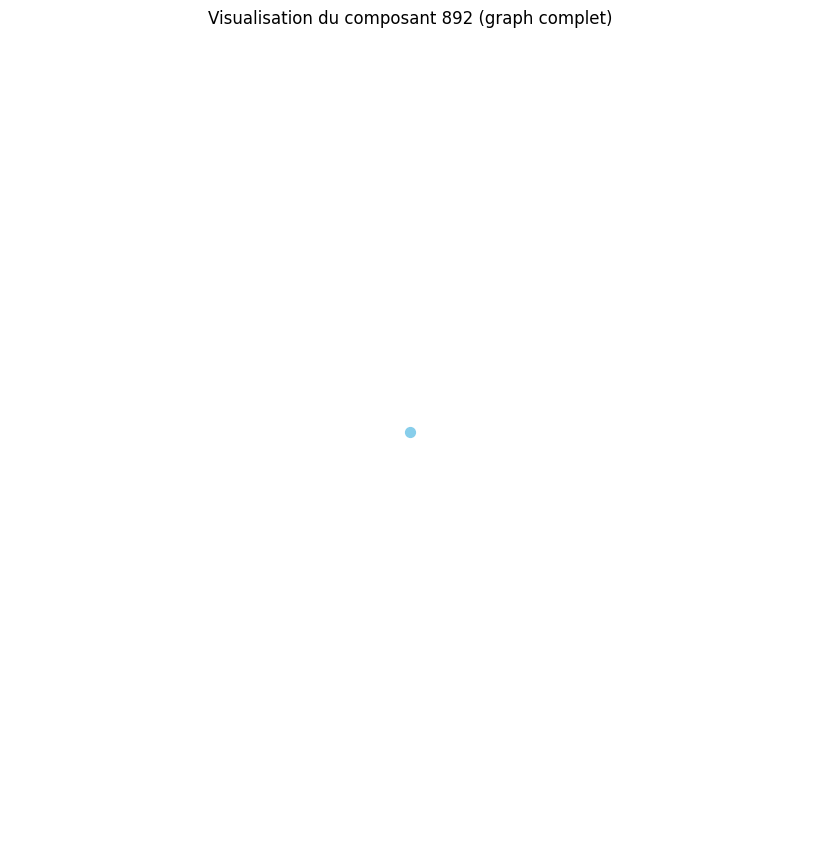

Distance moyenne pour le composant 893 : 0.00
Le composant 893 est un graphe complet ou très densément connecté.
Densité du composant 893 : 0.00
Degré moyen du composant 893 : 0.00
Coefficient de clustering moyen du composant 893 : 0.00


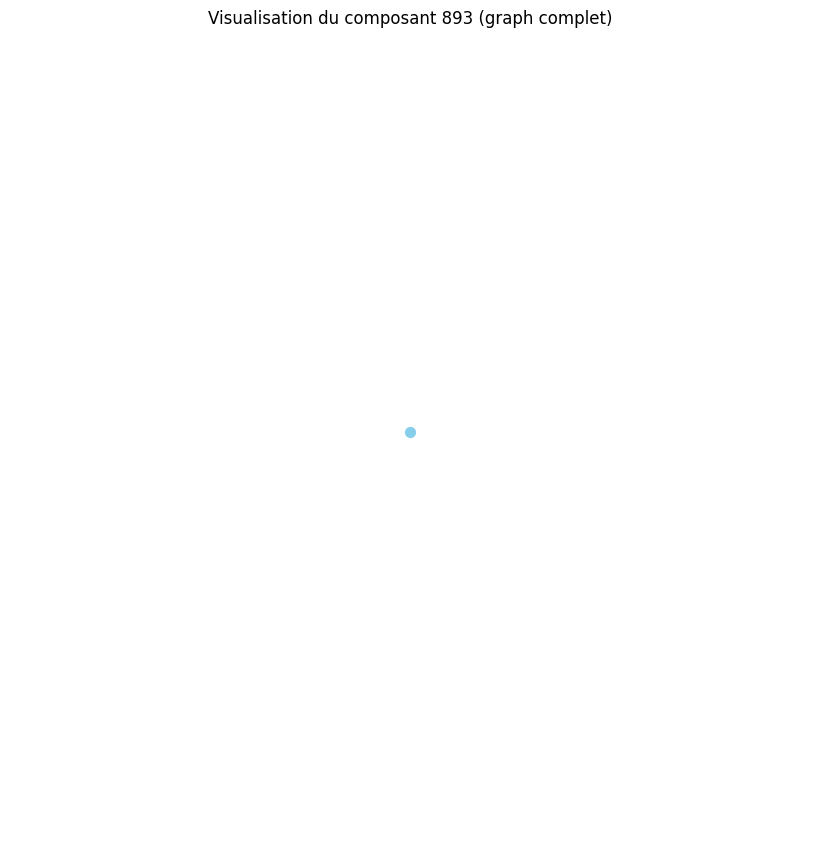

Distance moyenne pour le composant 894 : 0.00
Le composant 894 est un graphe complet ou très densément connecté.
Densité du composant 894 : 0.00
Degré moyen du composant 894 : 0.00
Coefficient de clustering moyen du composant 894 : 0.00


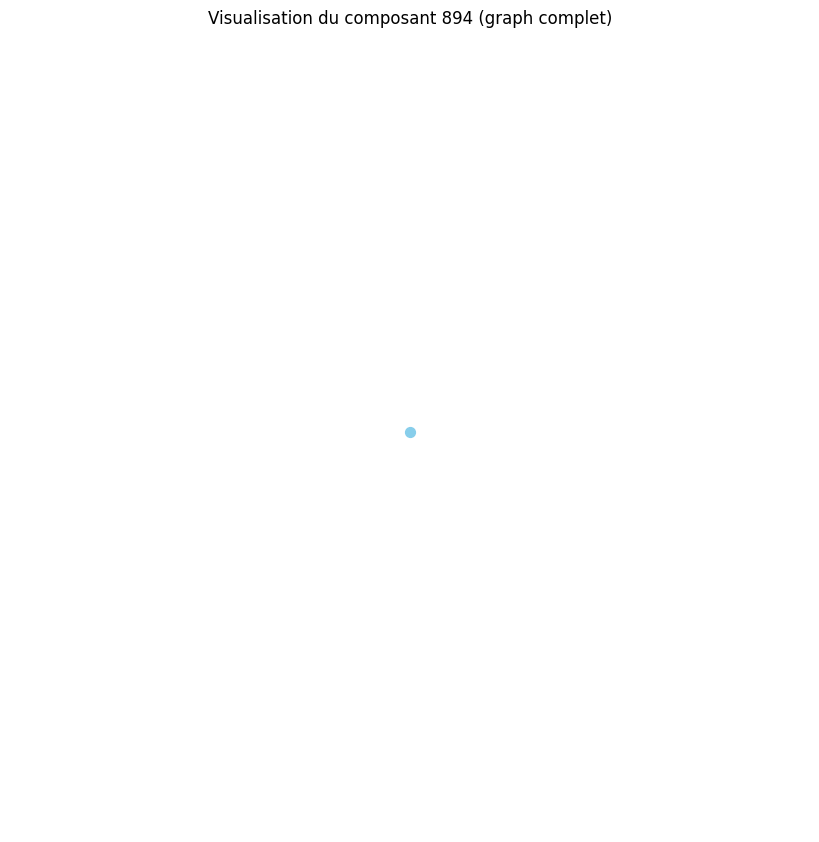

Distance moyenne pour le composant 895 : 0.00
Le composant 895 est un graphe complet ou très densément connecté.
Densité du composant 895 : 0.00
Degré moyen du composant 895 : 0.00
Coefficient de clustering moyen du composant 895 : 0.00


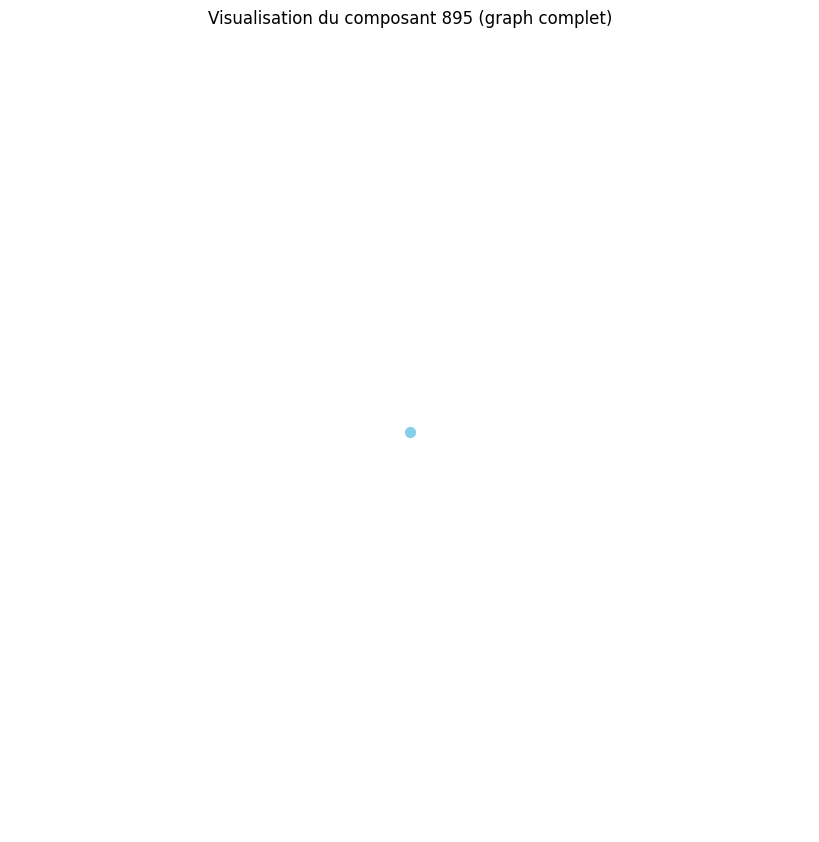

Distance moyenne pour le composant 896 : 0.00
Le composant 896 est un graphe complet ou très densément connecté.
Densité du composant 896 : 0.00
Degré moyen du composant 896 : 0.00
Coefficient de clustering moyen du composant 896 : 0.00


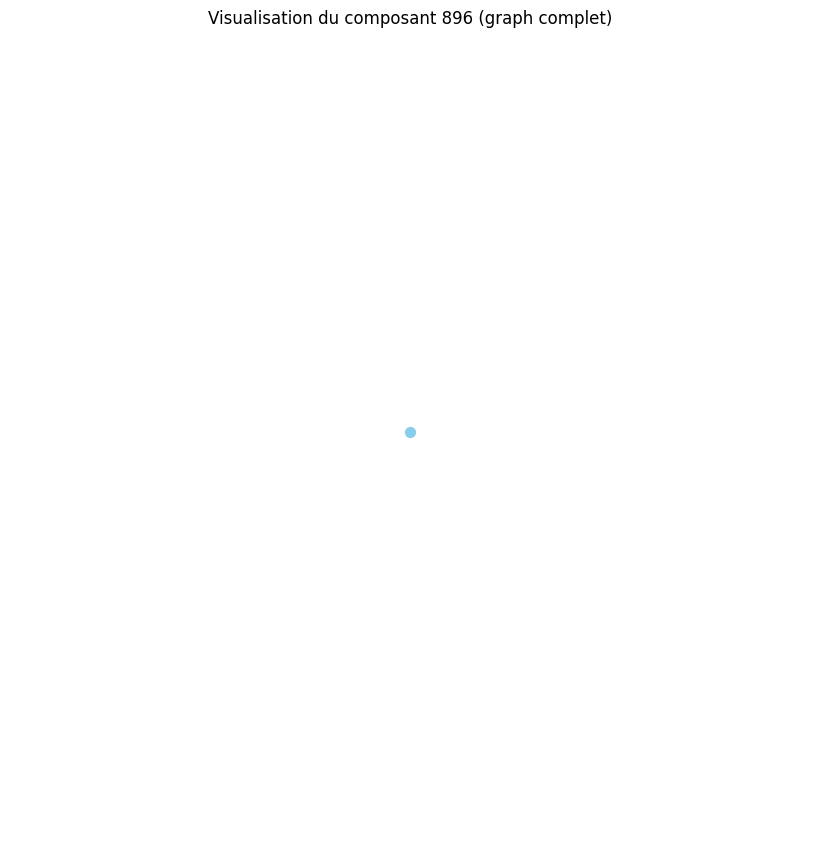

Distance moyenne pour le composant 897 : 0.00
Le composant 897 est un graphe complet ou très densément connecté.
Densité du composant 897 : 0.00
Degré moyen du composant 897 : 0.00
Coefficient de clustering moyen du composant 897 : 0.00


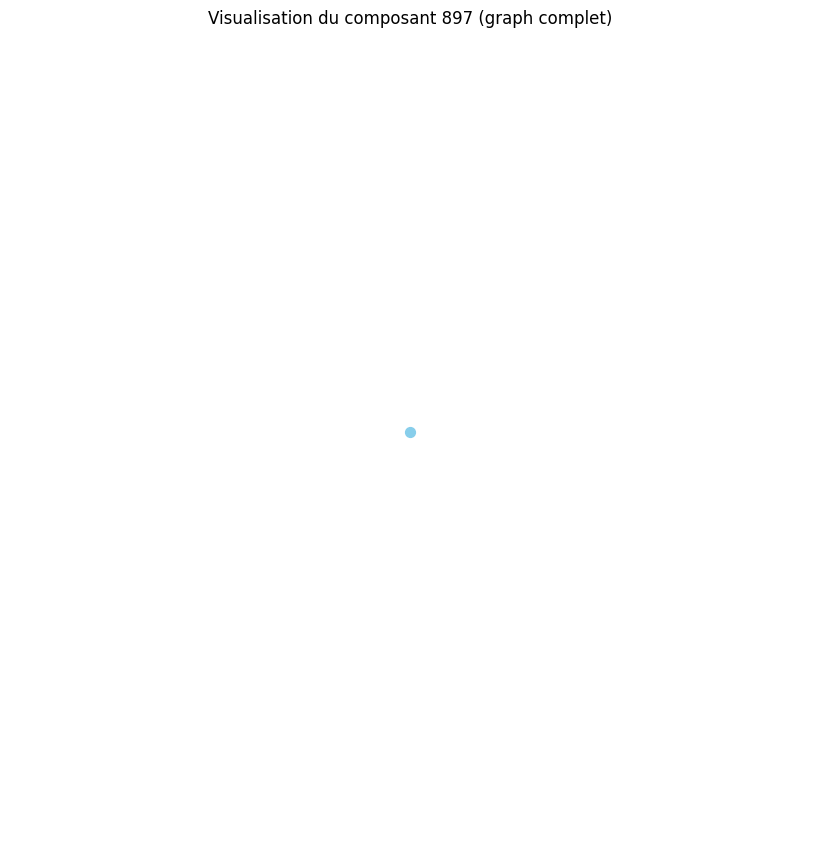

Distance moyenne pour le composant 898 : 0.00
Le composant 898 est un graphe complet ou très densément connecté.
Densité du composant 898 : 0.00
Degré moyen du composant 898 : 0.00
Coefficient de clustering moyen du composant 898 : 0.00


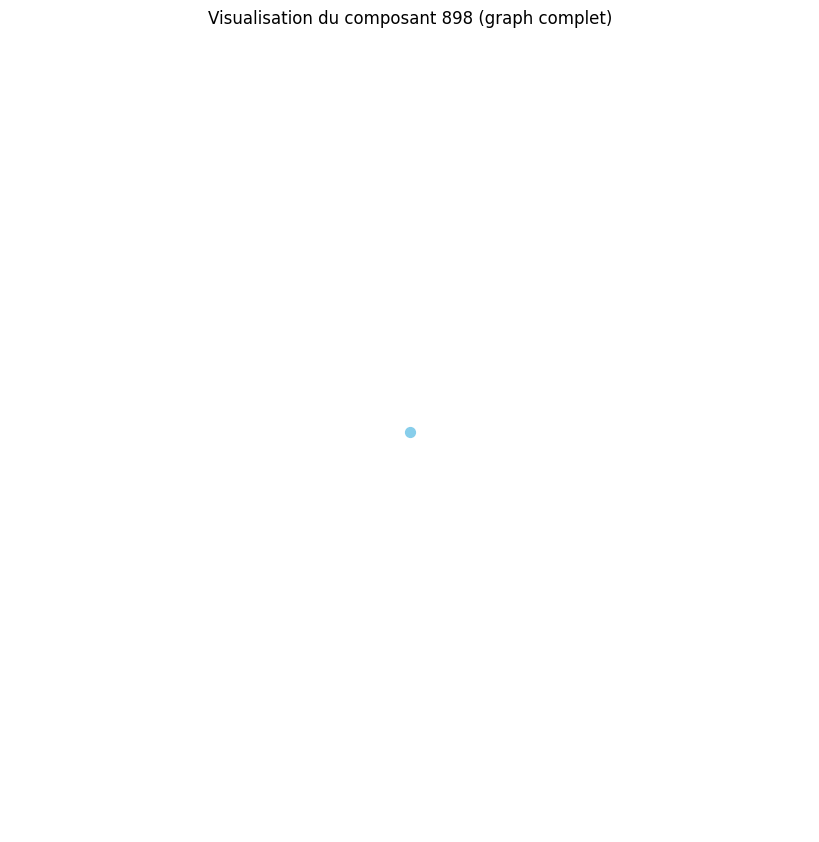

Distance moyenne pour le composant 899 : 0.00
Le composant 899 est un graphe complet ou très densément connecté.
Densité du composant 899 : 0.00
Degré moyen du composant 899 : 0.00
Coefficient de clustering moyen du composant 899 : 0.00


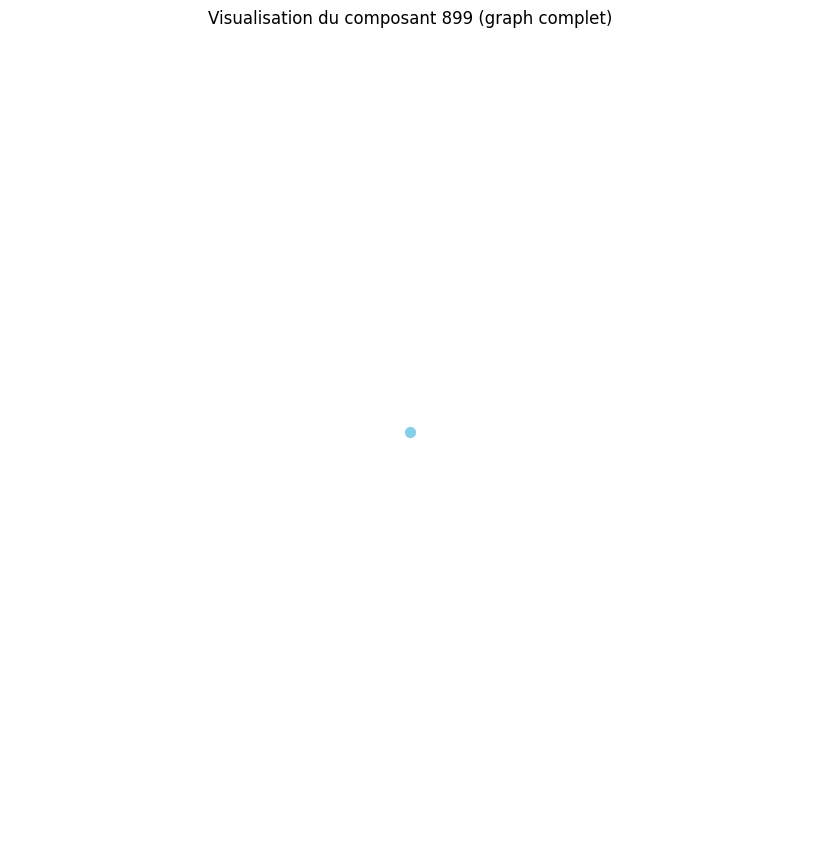

Distance moyenne pour le composant 900 : 0.00
Le composant 900 est un graphe complet ou très densément connecté.
Densité du composant 900 : 0.00
Degré moyen du composant 900 : 0.00
Coefficient de clustering moyen du composant 900 : 0.00


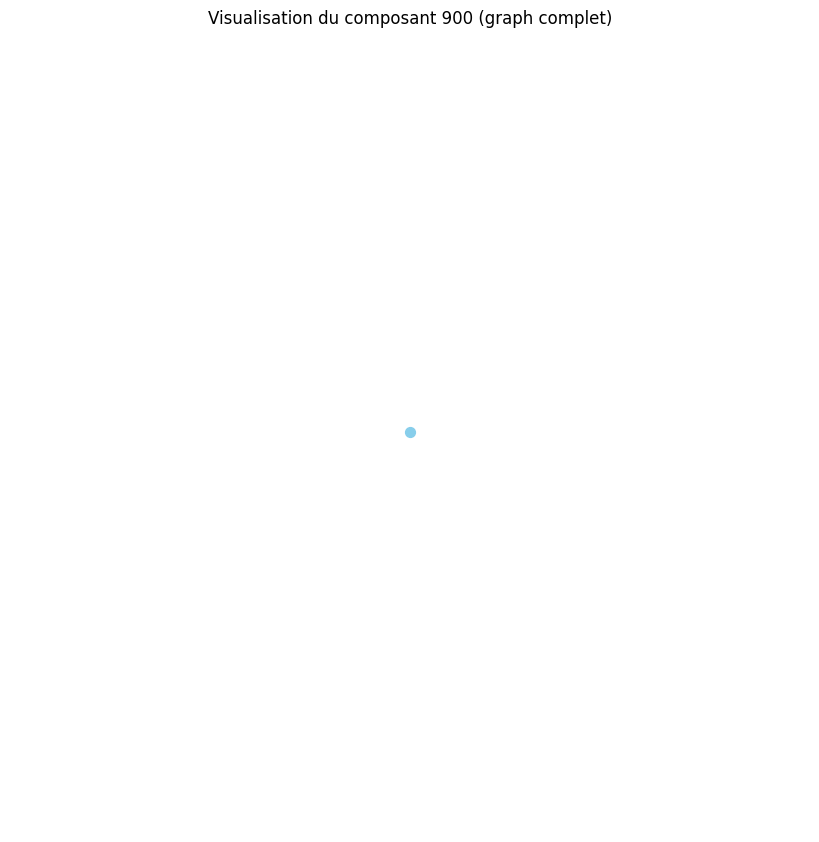

Distance moyenne pour le composant 901 : 0.00
Le composant 901 est un graphe complet ou très densément connecté.
Densité du composant 901 : 0.00
Degré moyen du composant 901 : 0.00
Coefficient de clustering moyen du composant 901 : 0.00


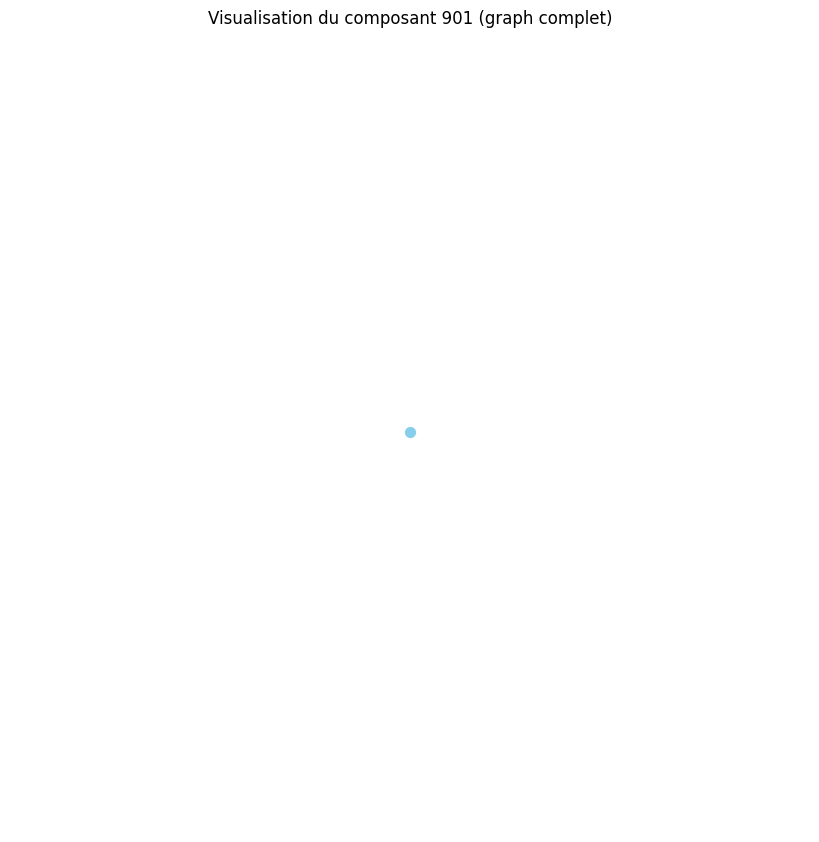

Distance moyenne pour le composant 902 : 0.00
Le composant 902 est un graphe complet ou très densément connecté.
Densité du composant 902 : 0.00
Degré moyen du composant 902 : 0.00
Coefficient de clustering moyen du composant 902 : 0.00


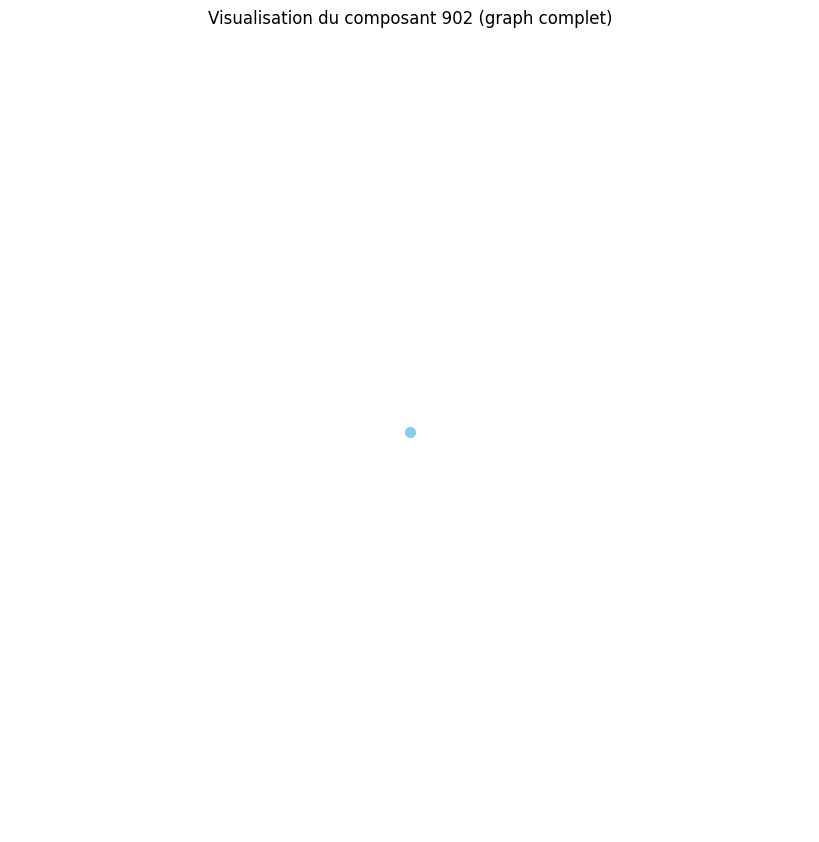

Distance moyenne pour le composant 903 : 0.00
Le composant 903 est un graphe complet ou très densément connecté.
Densité du composant 903 : 0.00
Degré moyen du composant 903 : 0.00
Coefficient de clustering moyen du composant 903 : 0.00


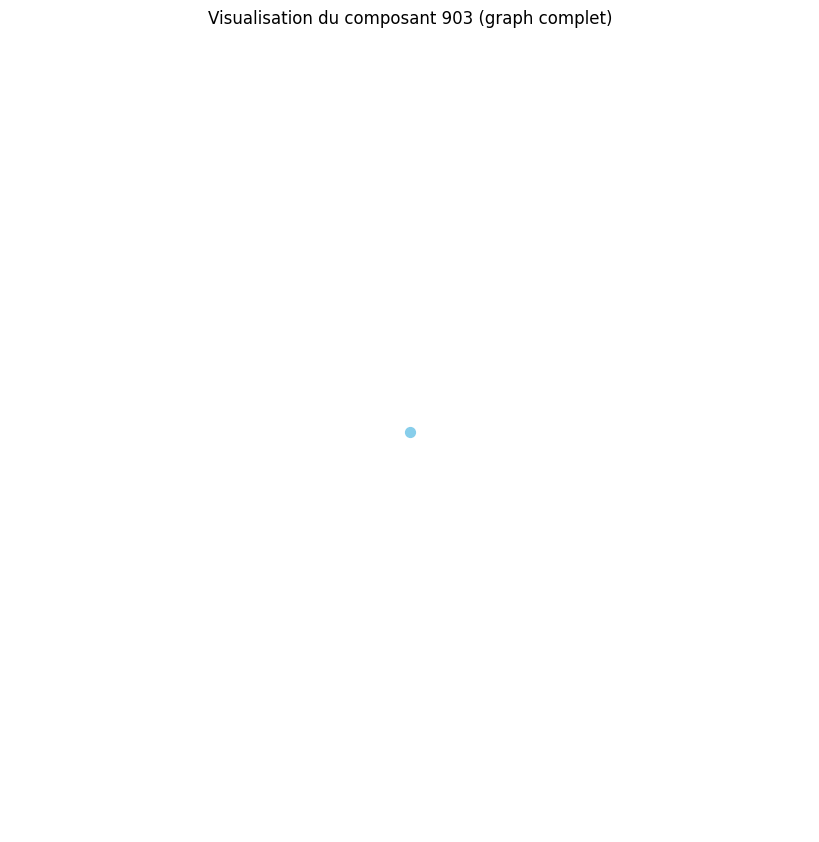

Distance moyenne pour le composant 904 : 0.00
Le composant 904 est un graphe complet ou très densément connecté.
Densité du composant 904 : 0.00
Degré moyen du composant 904 : 0.00
Coefficient de clustering moyen du composant 904 : 0.00


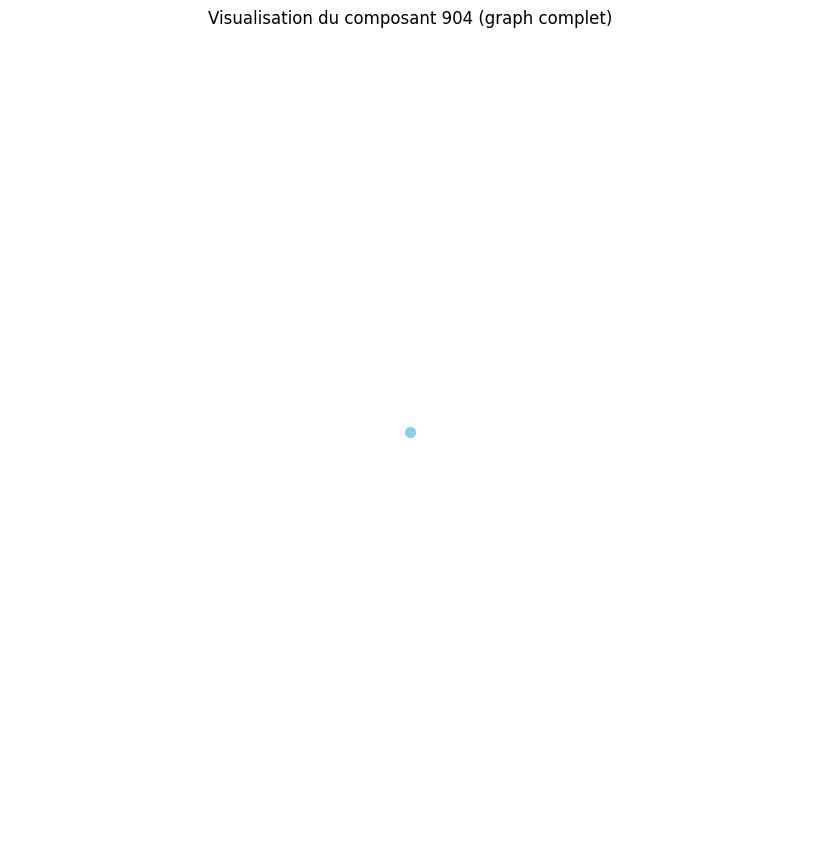

Distance moyenne pour le composant 905 : 0.00
Le composant 905 est un graphe complet ou très densément connecté.
Densité du composant 905 : 0.00
Degré moyen du composant 905 : 0.00
Coefficient de clustering moyen du composant 905 : 0.00


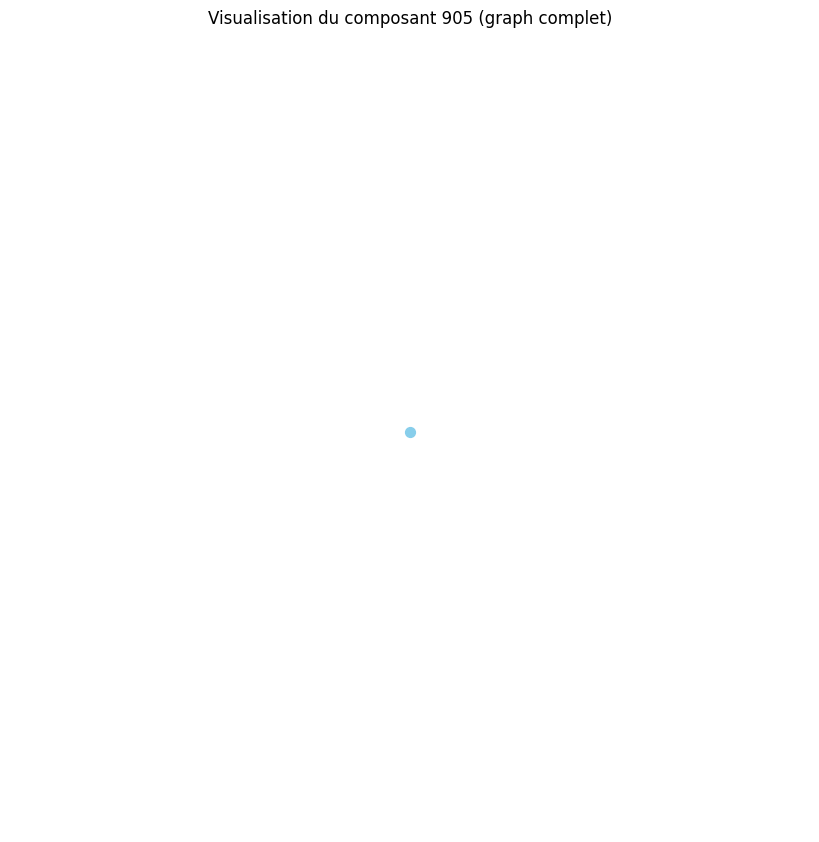

Distance moyenne pour le composant 906 : 0.00
Le composant 906 est un graphe complet ou très densément connecté.
Densité du composant 906 : 0.00
Degré moyen du composant 906 : 0.00
Coefficient de clustering moyen du composant 906 : 0.00


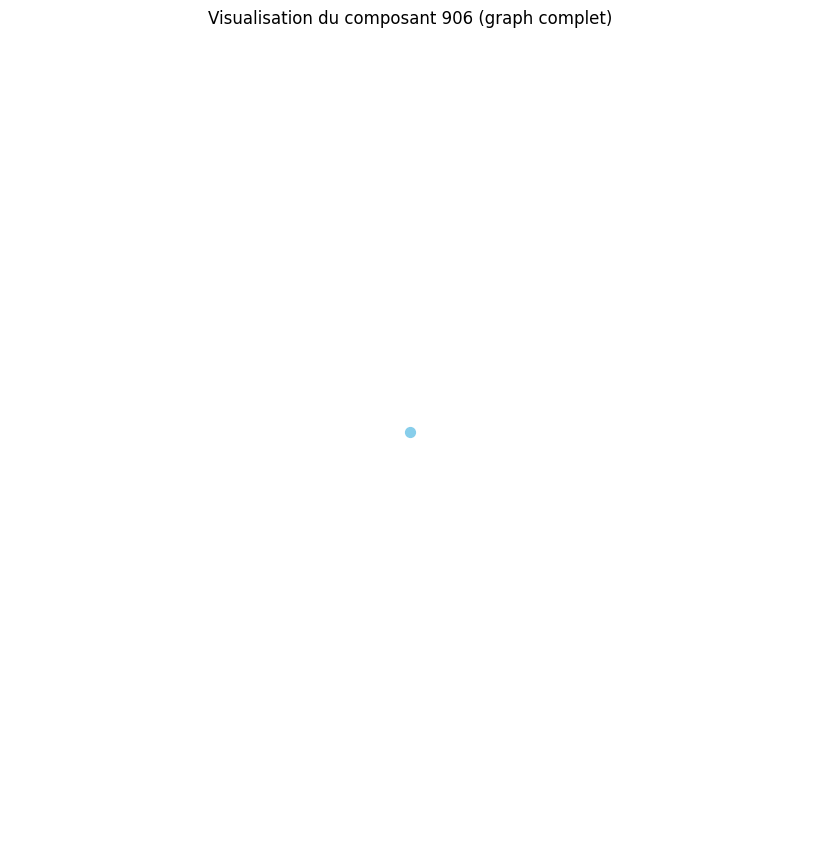

Distance moyenne pour le composant 907 : 0.00
Le composant 907 est un graphe complet ou très densément connecté.
Densité du composant 907 : 0.00
Degré moyen du composant 907 : 0.00
Coefficient de clustering moyen du composant 907 : 0.00


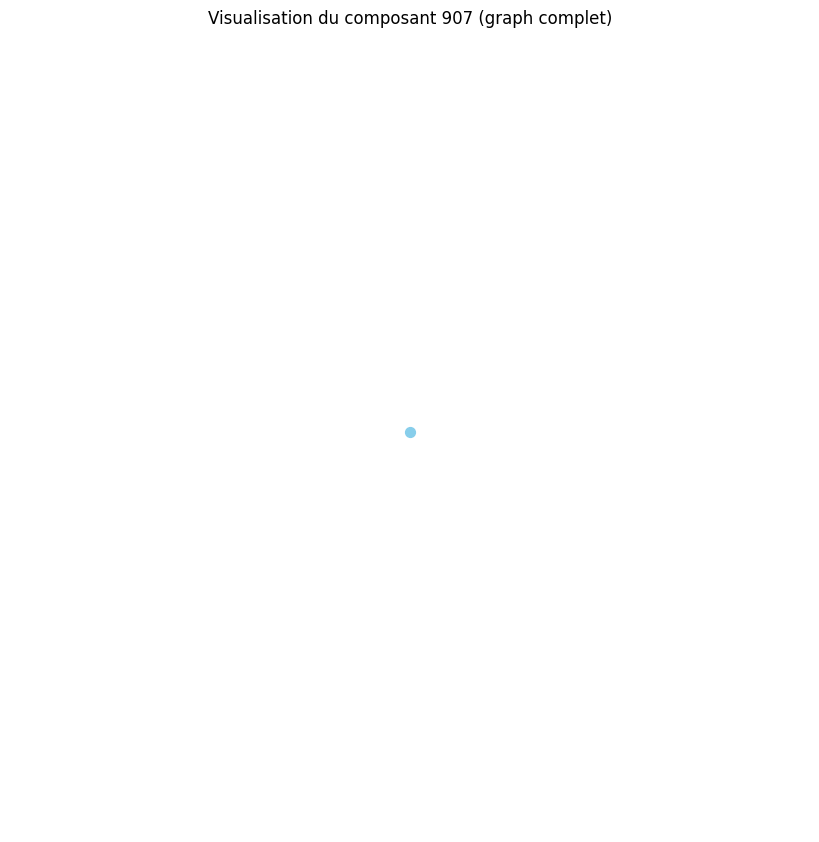

Distance moyenne pour le composant 908 : 0.00
Le composant 908 est un graphe complet ou très densément connecté.
Densité du composant 908 : 0.00
Degré moyen du composant 908 : 0.00
Coefficient de clustering moyen du composant 908 : 0.00


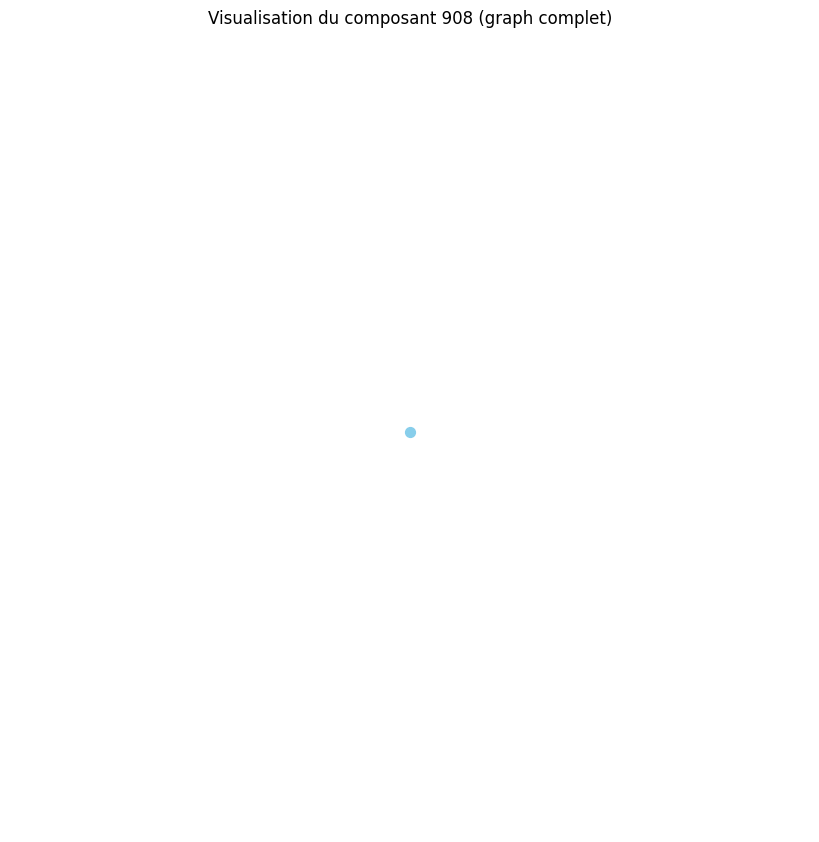

Distance moyenne pour le composant 909 : 0.00
Le composant 909 est un graphe complet ou très densément connecté.
Densité du composant 909 : 0.00
Degré moyen du composant 909 : 0.00
Coefficient de clustering moyen du composant 909 : 0.00


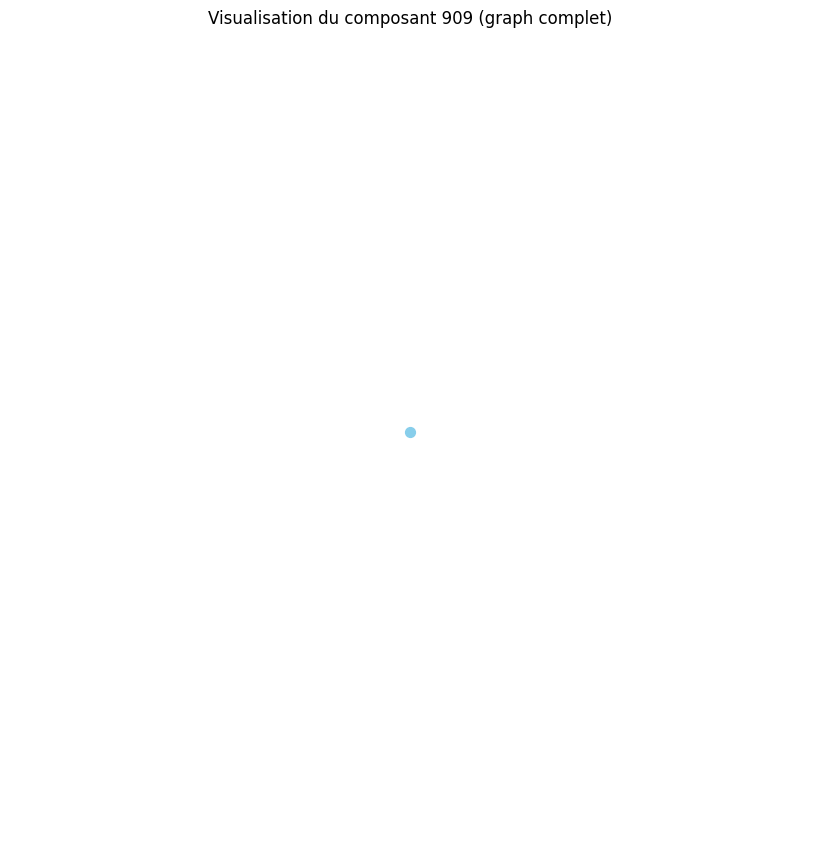

Distance moyenne pour le composant 910 : 0.00
Le composant 910 est un graphe complet ou très densément connecté.
Densité du composant 910 : 0.00
Degré moyen du composant 910 : 0.00
Coefficient de clustering moyen du composant 910 : 0.00


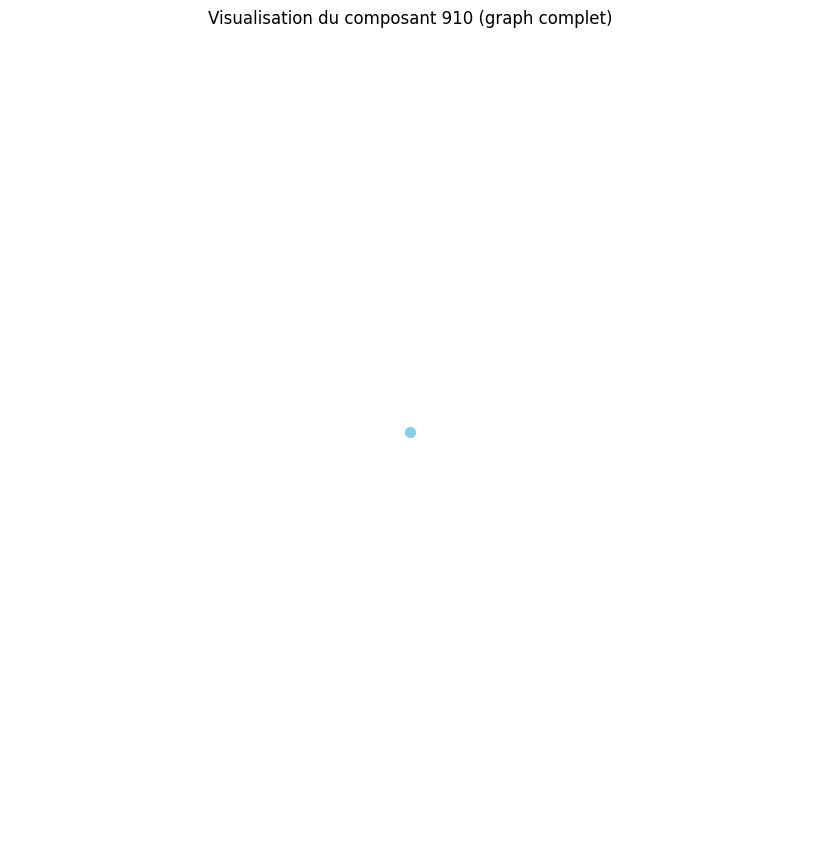

Distance moyenne pour le composant 911 : 0.00
Le composant 911 est un graphe complet ou très densément connecté.
Densité du composant 911 : 0.00
Degré moyen du composant 911 : 0.00
Coefficient de clustering moyen du composant 911 : 0.00


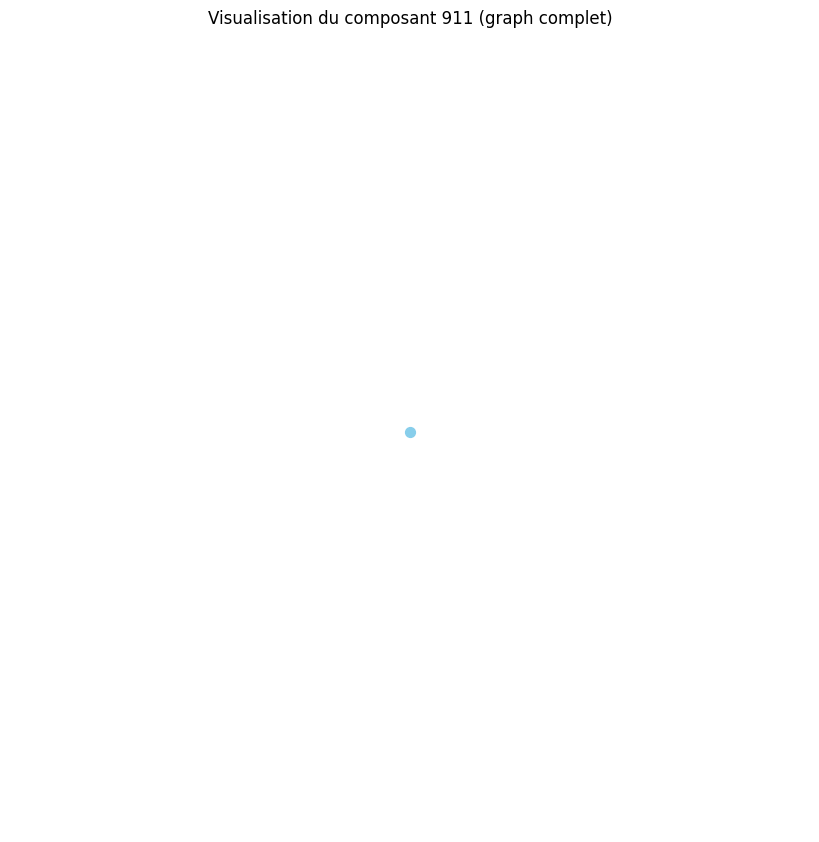

Distance moyenne pour le composant 912 : 0.00
Le composant 912 est un graphe complet ou très densément connecté.
Densité du composant 912 : 0.00
Degré moyen du composant 912 : 0.00
Coefficient de clustering moyen du composant 912 : 0.00


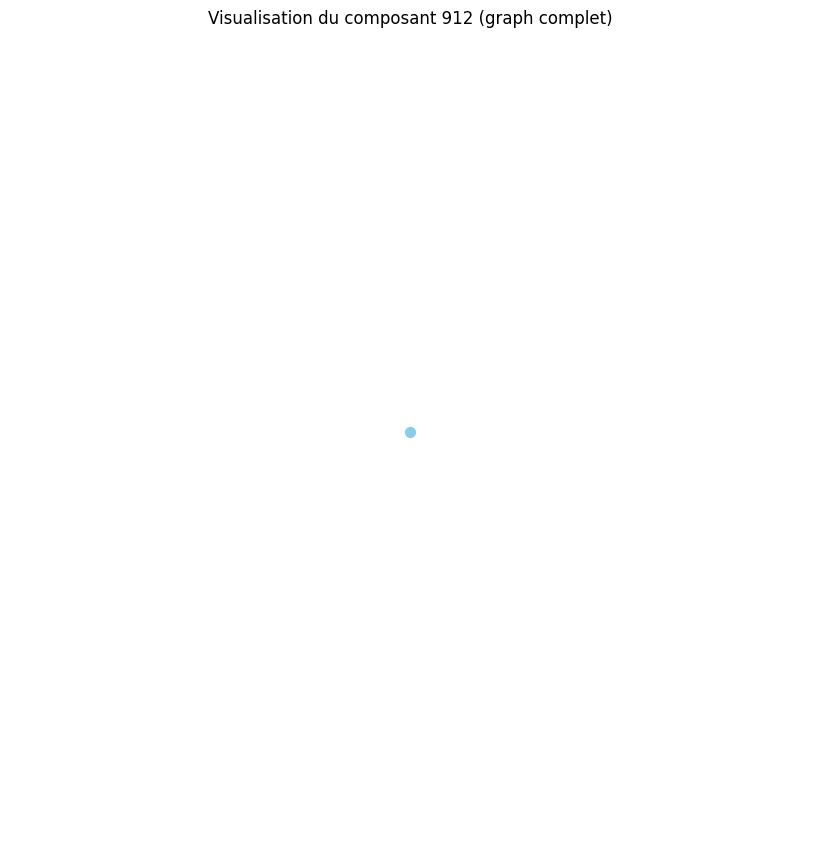

Distance moyenne pour le composant 913 : 0.00
Le composant 913 est un graphe complet ou très densément connecté.
Densité du composant 913 : 0.00
Degré moyen du composant 913 : 0.00
Coefficient de clustering moyen du composant 913 : 0.00


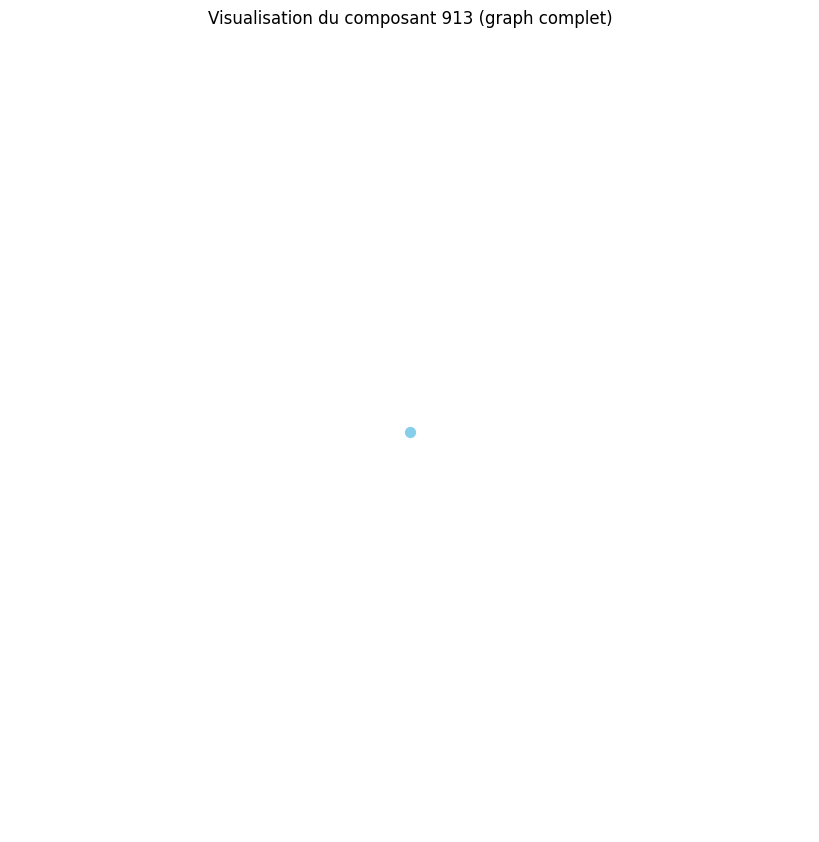

Distance moyenne pour le composant 914 : 0.00
Le composant 914 est un graphe complet ou très densément connecté.
Densité du composant 914 : 0.00
Degré moyen du composant 914 : 0.00
Coefficient de clustering moyen du composant 914 : 0.00


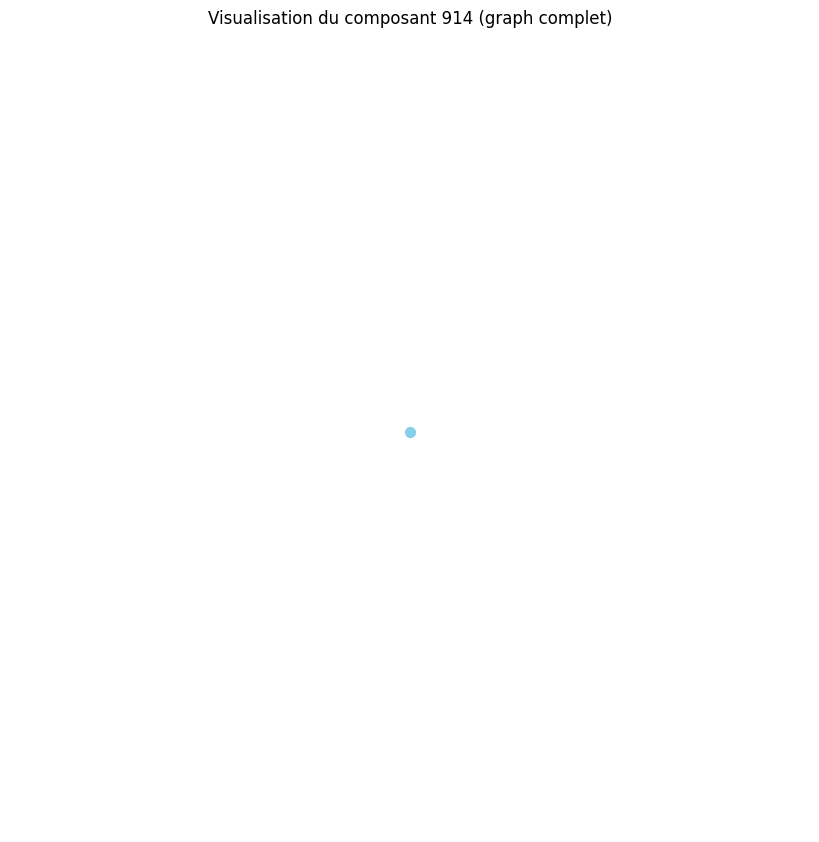

Distance moyenne pour le composant 915 : 1.00
Distance moyenne pour le composant 916 : 0.00
Le composant 916 est un graphe complet ou très densément connecté.
Densité du composant 916 : 0.00
Degré moyen du composant 916 : 0.00
Coefficient de clustering moyen du composant 916 : 0.00


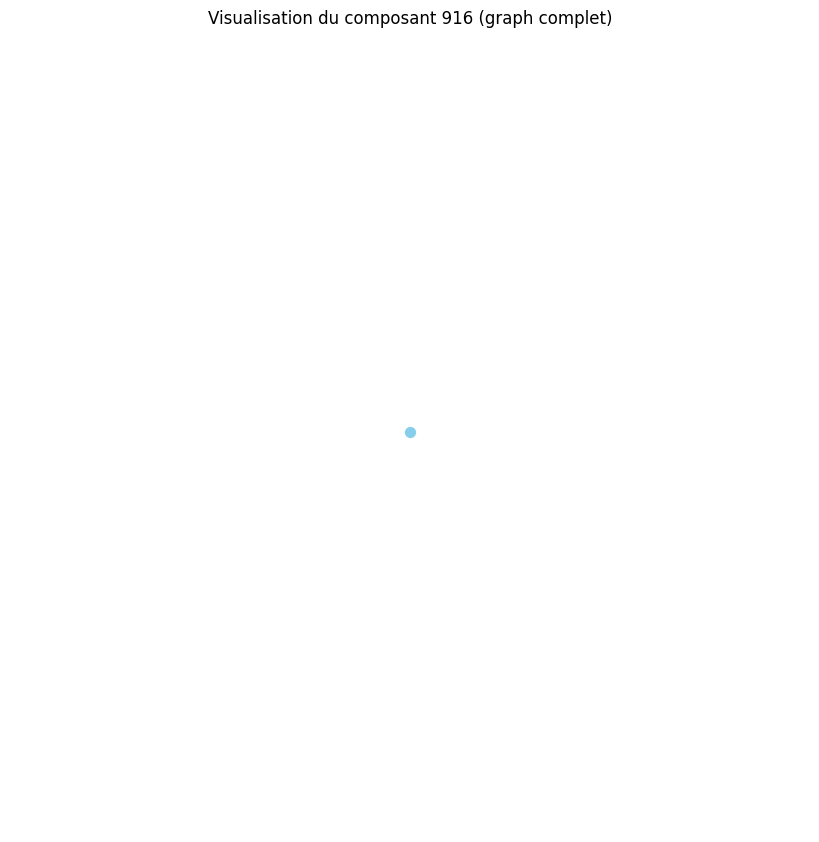

Distance moyenne pour le composant 917 : 0.00
Le composant 917 est un graphe complet ou très densément connecté.
Densité du composant 917 : 0.00
Degré moyen du composant 917 : 0.00
Coefficient de clustering moyen du composant 917 : 0.00


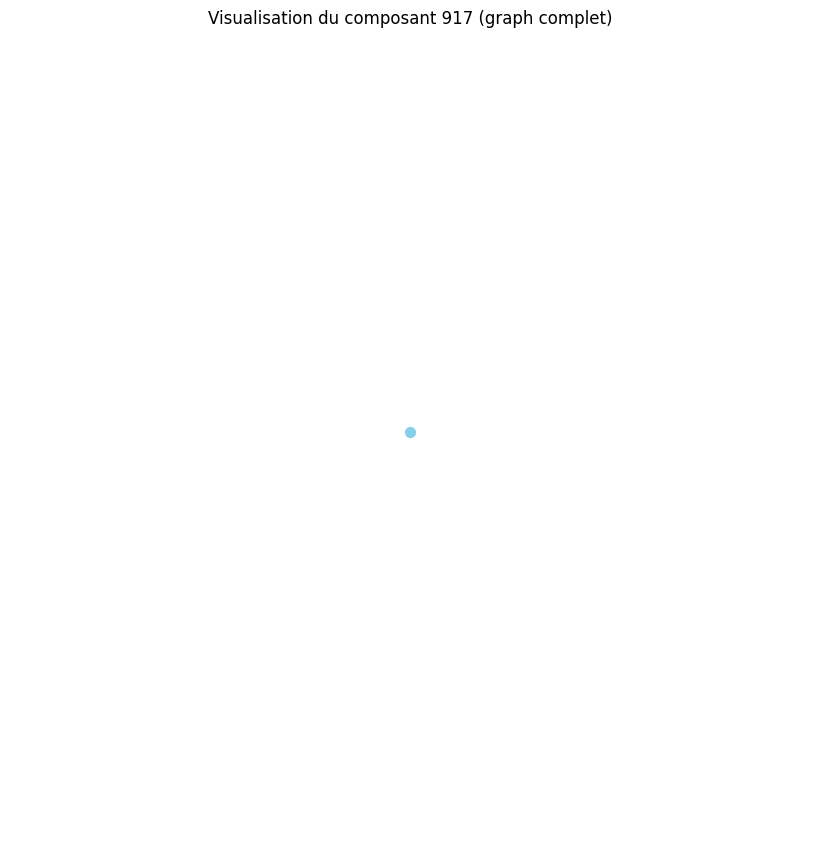

Distance moyenne pour le composant 918 : 0.00
Le composant 918 est un graphe complet ou très densément connecté.
Densité du composant 918 : 0.00
Degré moyen du composant 918 : 0.00
Coefficient de clustering moyen du composant 918 : 0.00


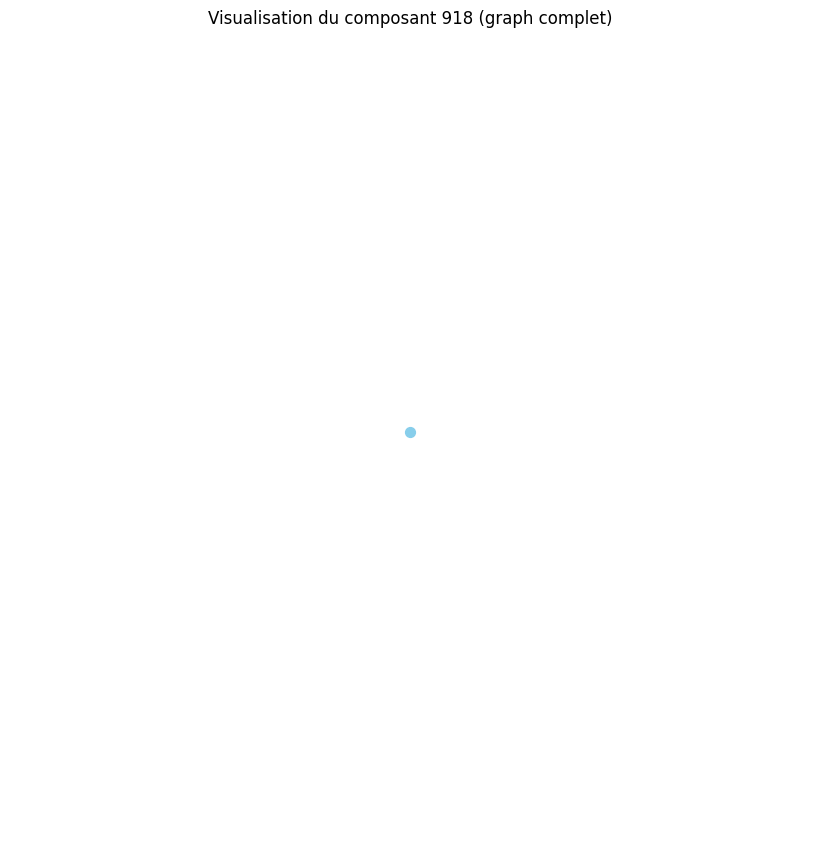

Distance moyenne pour le composant 919 : 0.00
Le composant 919 est un graphe complet ou très densément connecté.
Densité du composant 919 : 0.00
Degré moyen du composant 919 : 0.00
Coefficient de clustering moyen du composant 919 : 0.00


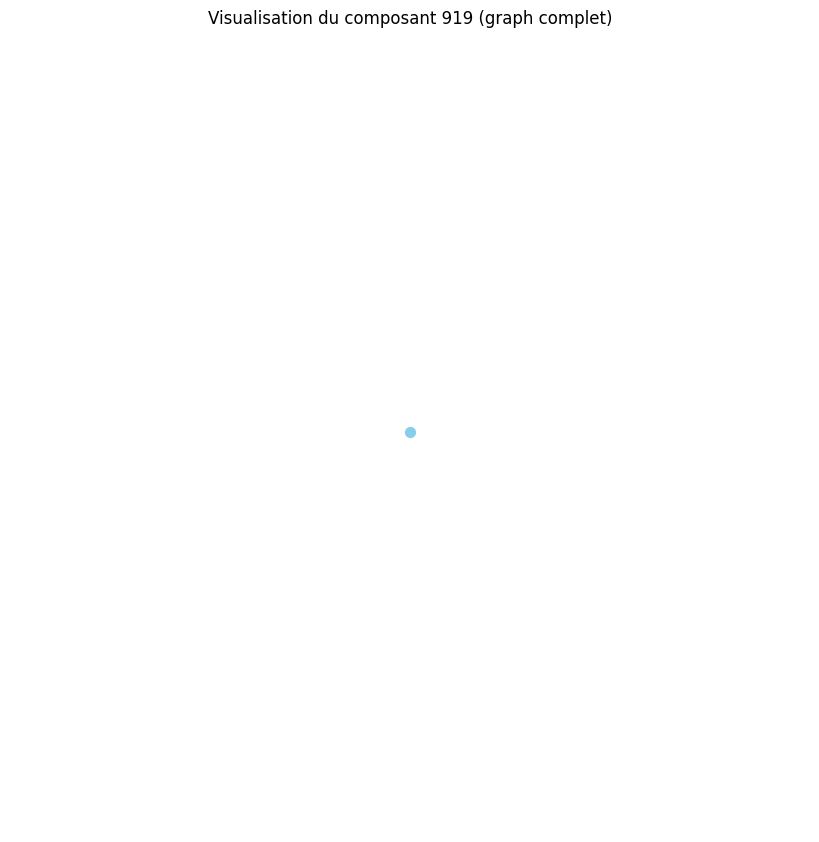

Distance moyenne pour le composant 920 : 0.00
Le composant 920 est un graphe complet ou très densément connecté.
Densité du composant 920 : 0.00
Degré moyen du composant 920 : 0.00
Coefficient de clustering moyen du composant 920 : 0.00


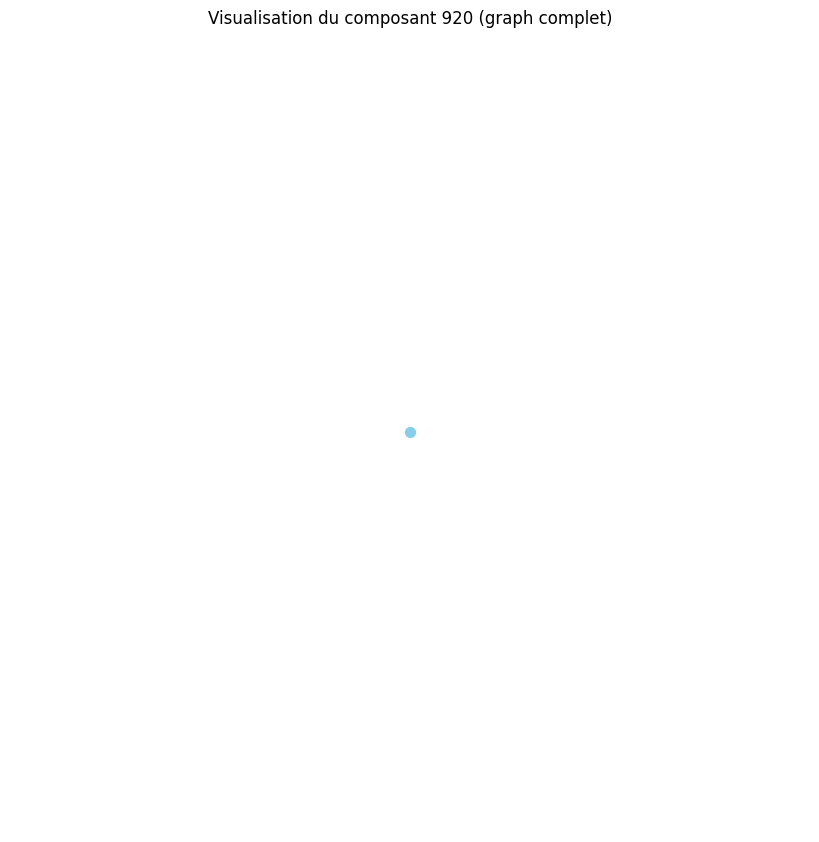

Distance moyenne pour le composant 921 : 0.00
Le composant 921 est un graphe complet ou très densément connecté.
Densité du composant 921 : 0.00
Degré moyen du composant 921 : 0.00
Coefficient de clustering moyen du composant 921 : 0.00


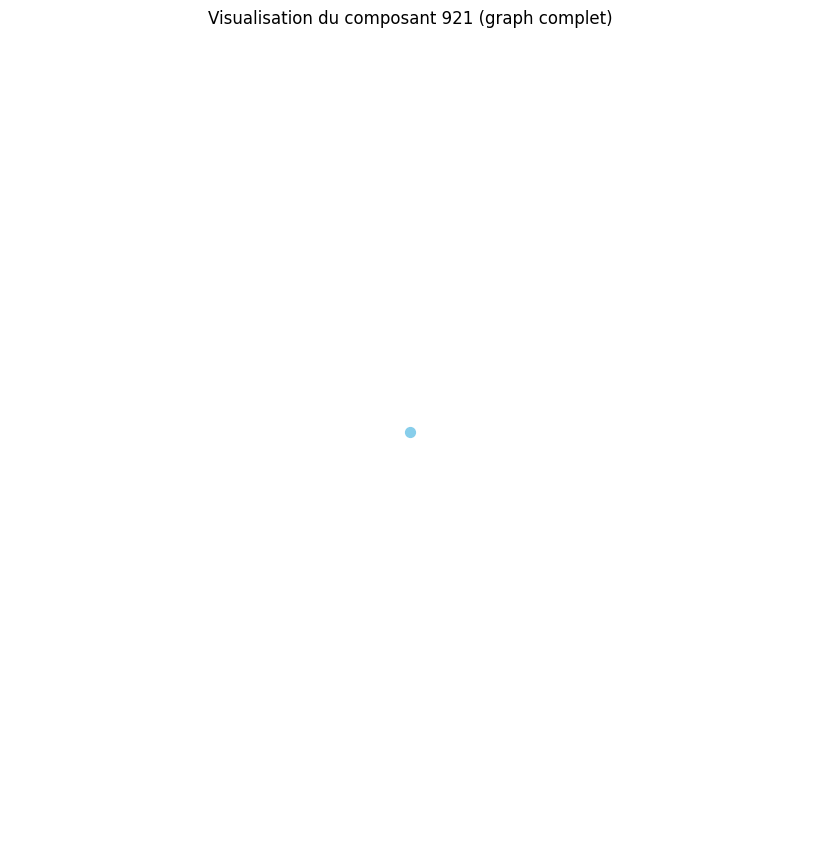

Distance moyenne pour le composant 922 : 0.00
Le composant 922 est un graphe complet ou très densément connecté.
Densité du composant 922 : 0.00
Degré moyen du composant 922 : 0.00
Coefficient de clustering moyen du composant 922 : 0.00


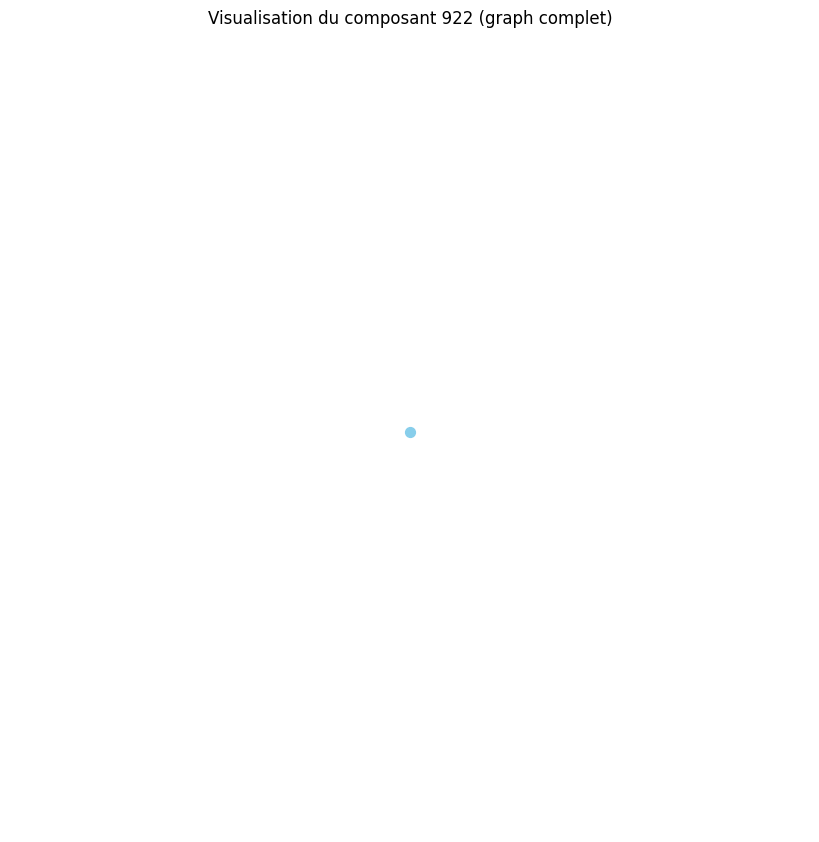

Distance moyenne pour le composant 923 : 0.00
Le composant 923 est un graphe complet ou très densément connecté.
Densité du composant 923 : 0.00
Degré moyen du composant 923 : 0.00
Coefficient de clustering moyen du composant 923 : 0.00


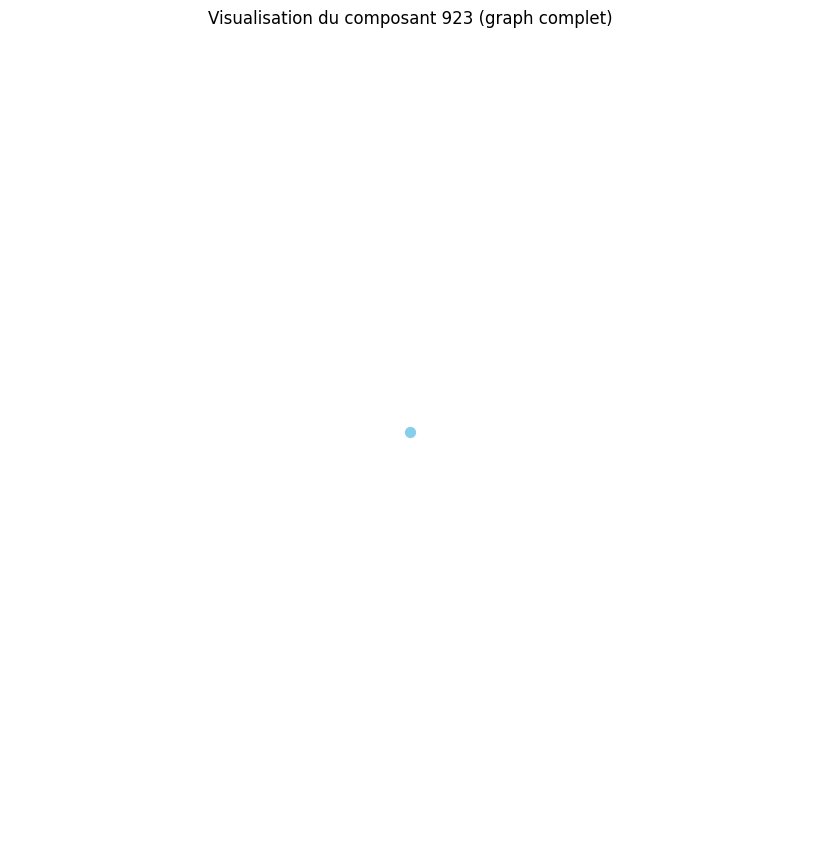

Distance moyenne pour le composant 924 : 0.00
Le composant 924 est un graphe complet ou très densément connecté.
Densité du composant 924 : 0.00
Degré moyen du composant 924 : 0.00
Coefficient de clustering moyen du composant 924 : 0.00


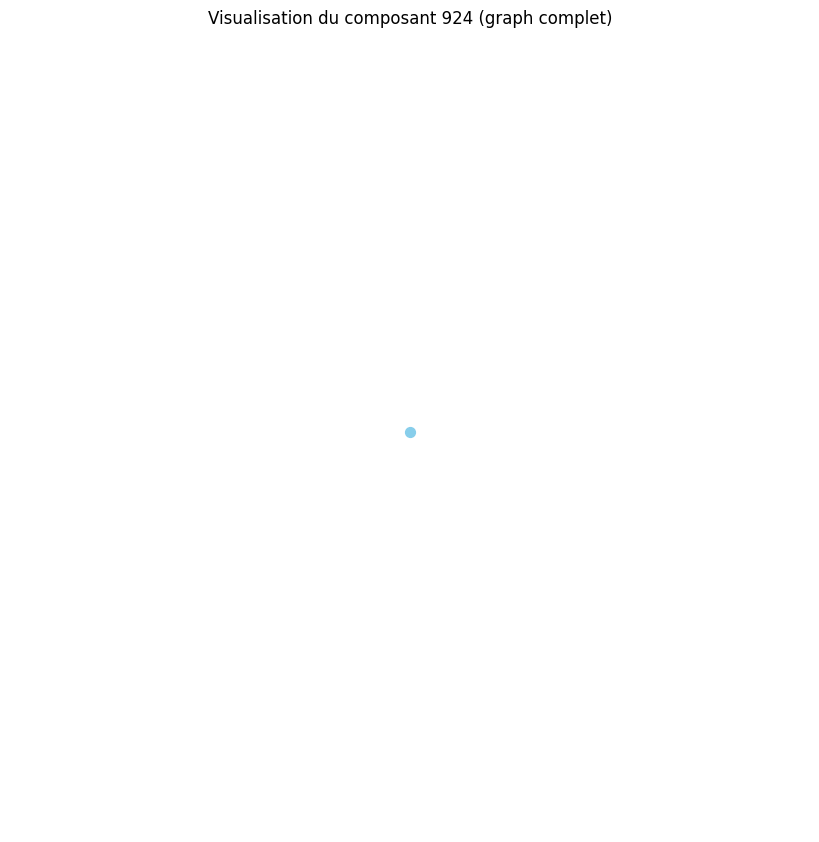

Distance moyenne pour le composant 925 : 0.00
Le composant 925 est un graphe complet ou très densément connecté.
Densité du composant 925 : 0.00
Degré moyen du composant 925 : 0.00
Coefficient de clustering moyen du composant 925 : 0.00


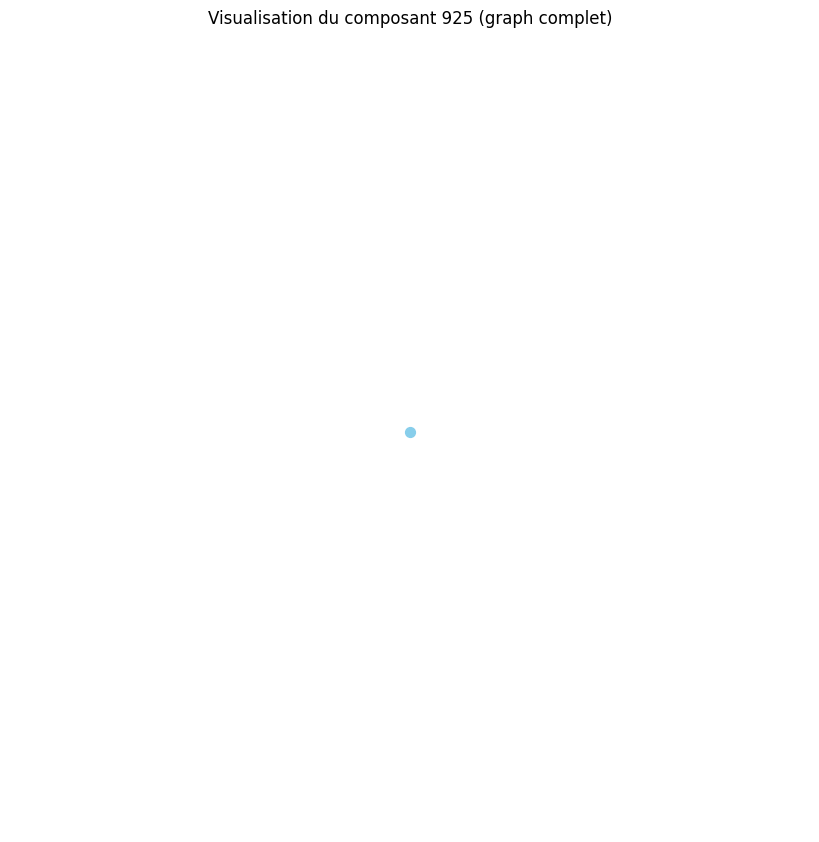

Distance moyenne pour le composant 926 : 0.00
Le composant 926 est un graphe complet ou très densément connecté.
Densité du composant 926 : 0.00
Degré moyen du composant 926 : 0.00
Coefficient de clustering moyen du composant 926 : 0.00


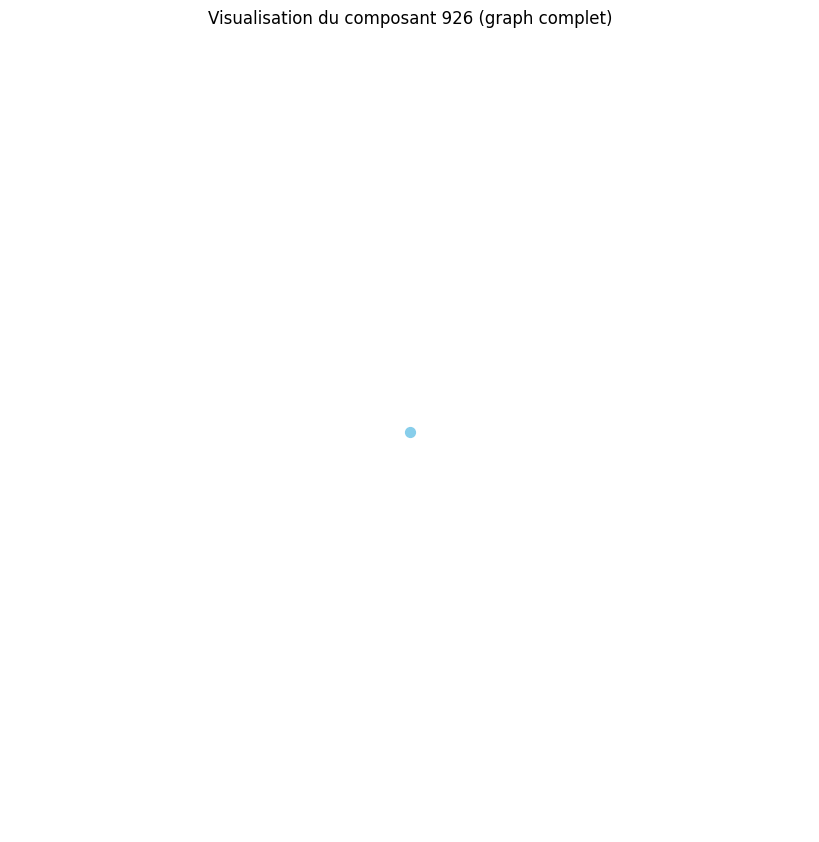

Distance moyenne pour le composant 927 : 0.00
Le composant 927 est un graphe complet ou très densément connecté.
Densité du composant 927 : 0.00
Degré moyen du composant 927 : 0.00
Coefficient de clustering moyen du composant 927 : 0.00


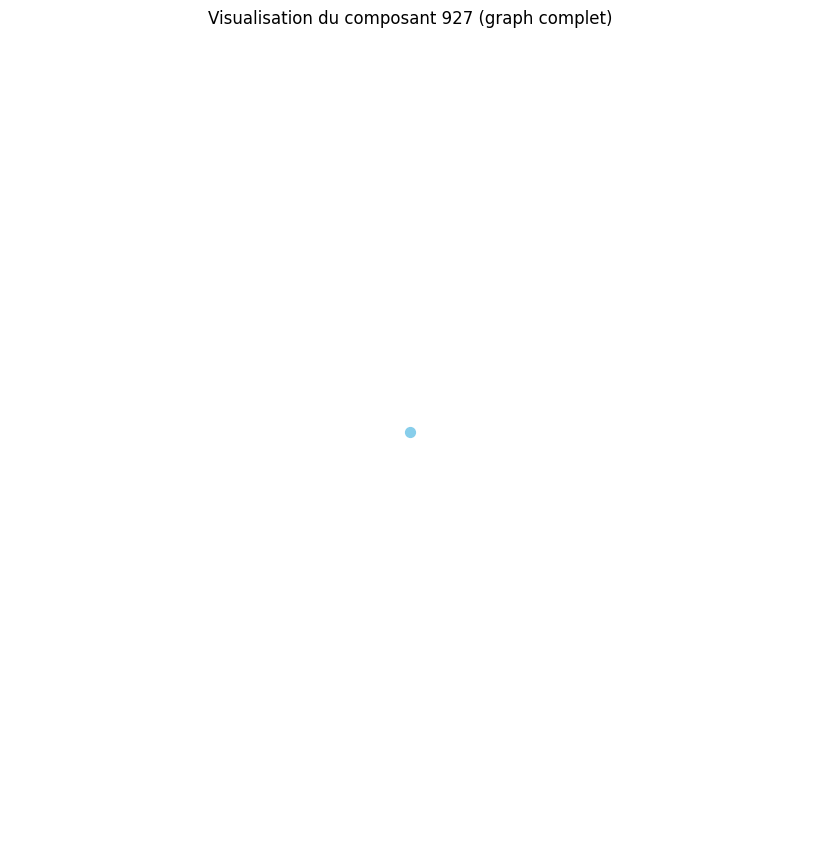

Distance moyenne pour le composant 928 : 0.00
Le composant 928 est un graphe complet ou très densément connecté.
Densité du composant 928 : 0.00
Degré moyen du composant 928 : 0.00
Coefficient de clustering moyen du composant 928 : 0.00


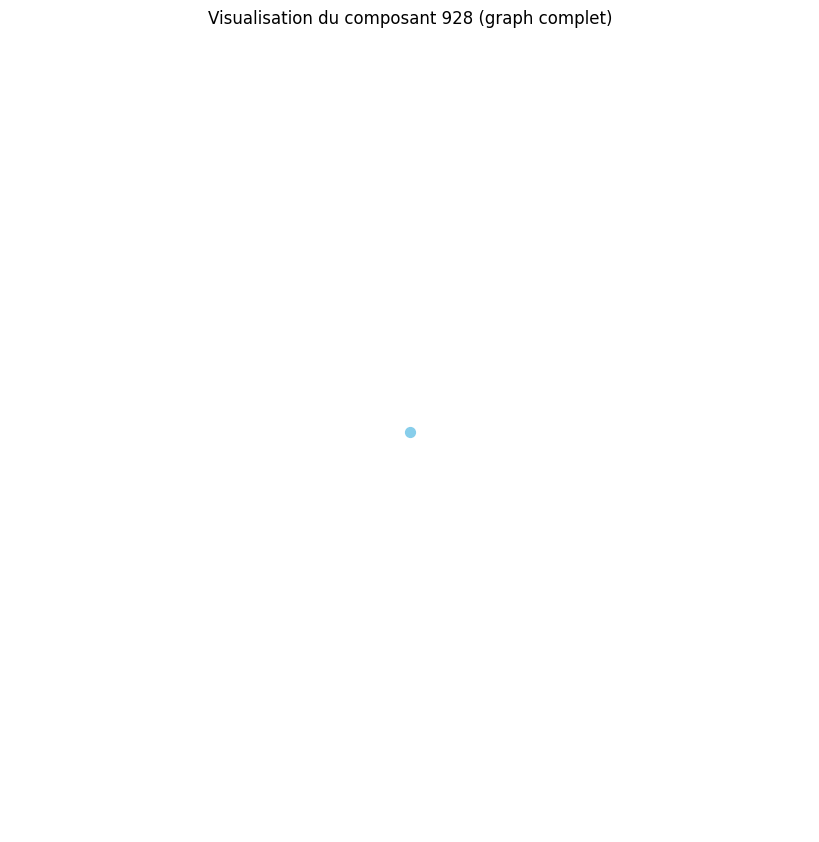

Distance moyenne pour le composant 929 : 0.00
Le composant 929 est un graphe complet ou très densément connecté.
Densité du composant 929 : 0.00
Degré moyen du composant 929 : 0.00
Coefficient de clustering moyen du composant 929 : 0.00


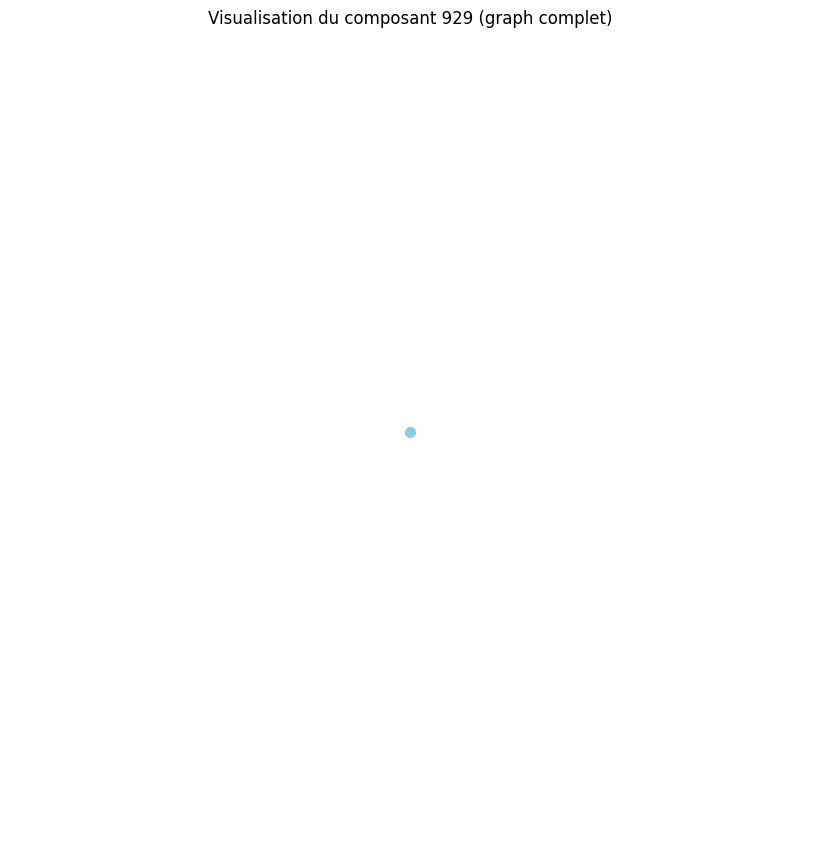

Distance moyenne pour le composant 930 : 0.00
Le composant 930 est un graphe complet ou très densément connecté.
Densité du composant 930 : 0.00
Degré moyen du composant 930 : 0.00
Coefficient de clustering moyen du composant 930 : 0.00


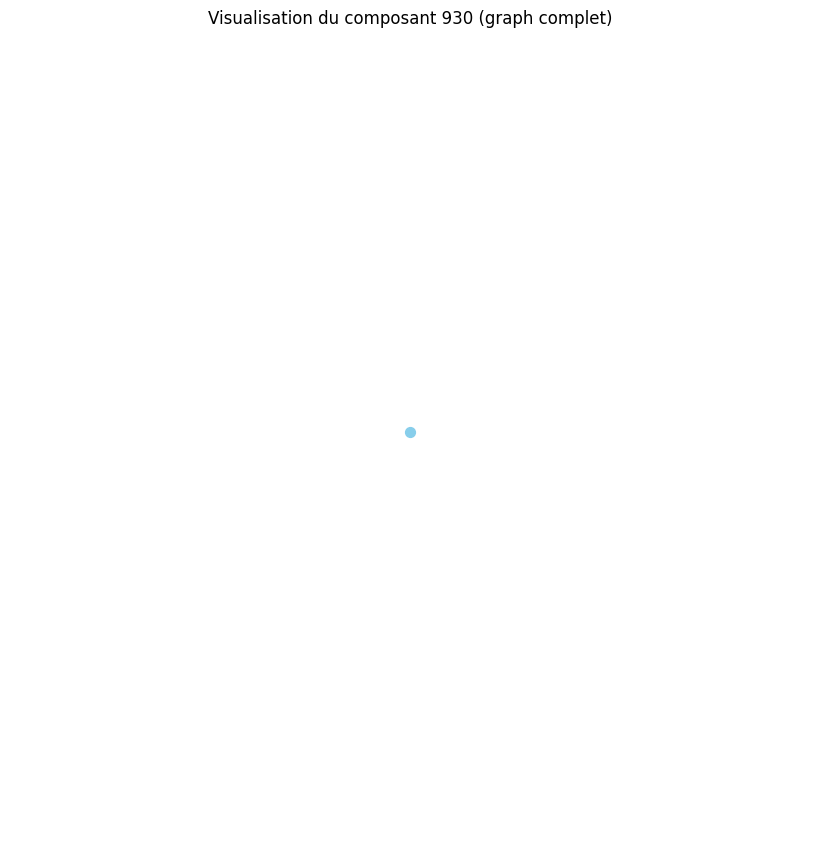

Distance moyenne pour le composant 931 : 0.00
Le composant 931 est un graphe complet ou très densément connecté.
Densité du composant 931 : 0.00
Degré moyen du composant 931 : 0.00
Coefficient de clustering moyen du composant 931 : 0.00


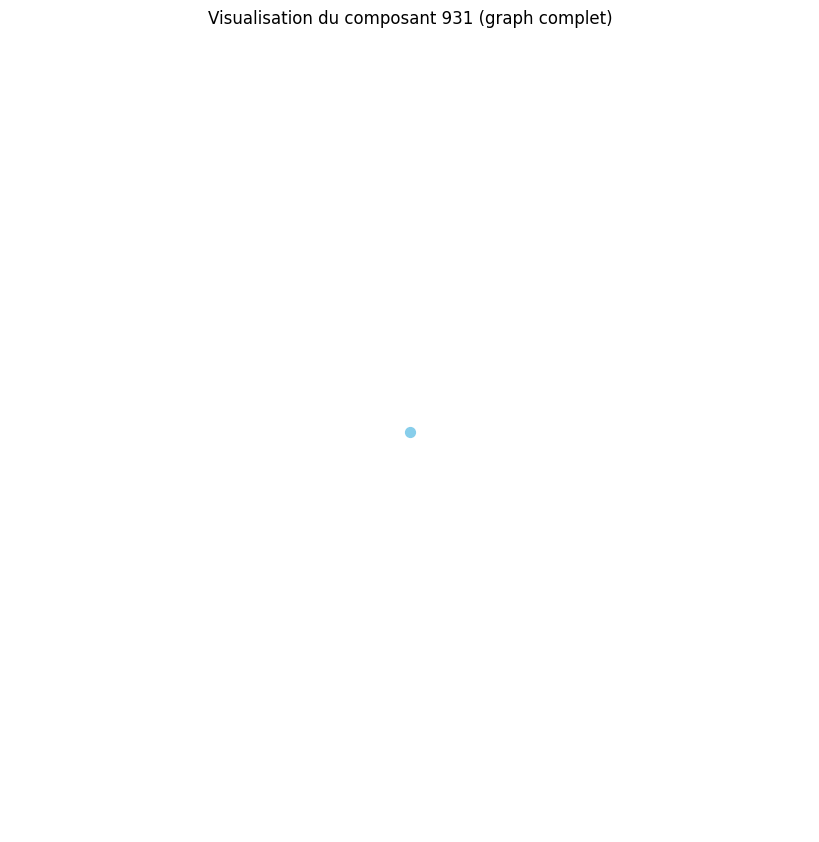

Distance moyenne pour le composant 932 : 0.00
Le composant 932 est un graphe complet ou très densément connecté.
Densité du composant 932 : 0.00
Degré moyen du composant 932 : 0.00
Coefficient de clustering moyen du composant 932 : 0.00


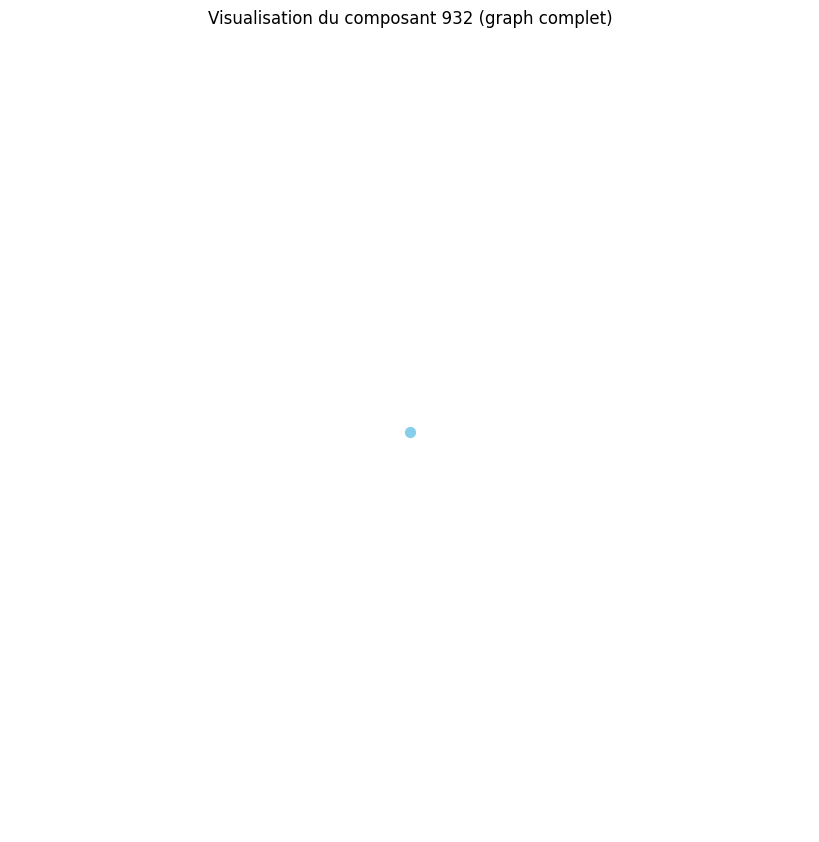

Distance moyenne pour le composant 933 : 0.00
Le composant 933 est un graphe complet ou très densément connecté.
Densité du composant 933 : 0.00
Degré moyen du composant 933 : 0.00
Coefficient de clustering moyen du composant 933 : 0.00


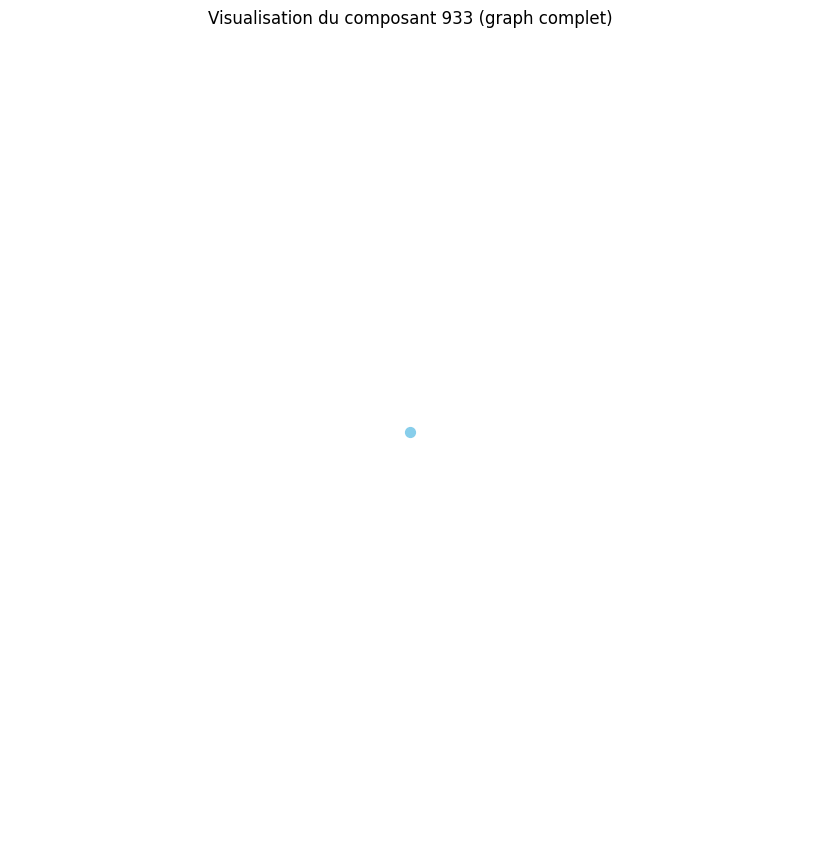

Distance moyenne pour le composant 934 : 0.00
Le composant 934 est un graphe complet ou très densément connecté.
Densité du composant 934 : 0.00
Degré moyen du composant 934 : 0.00
Coefficient de clustering moyen du composant 934 : 0.00


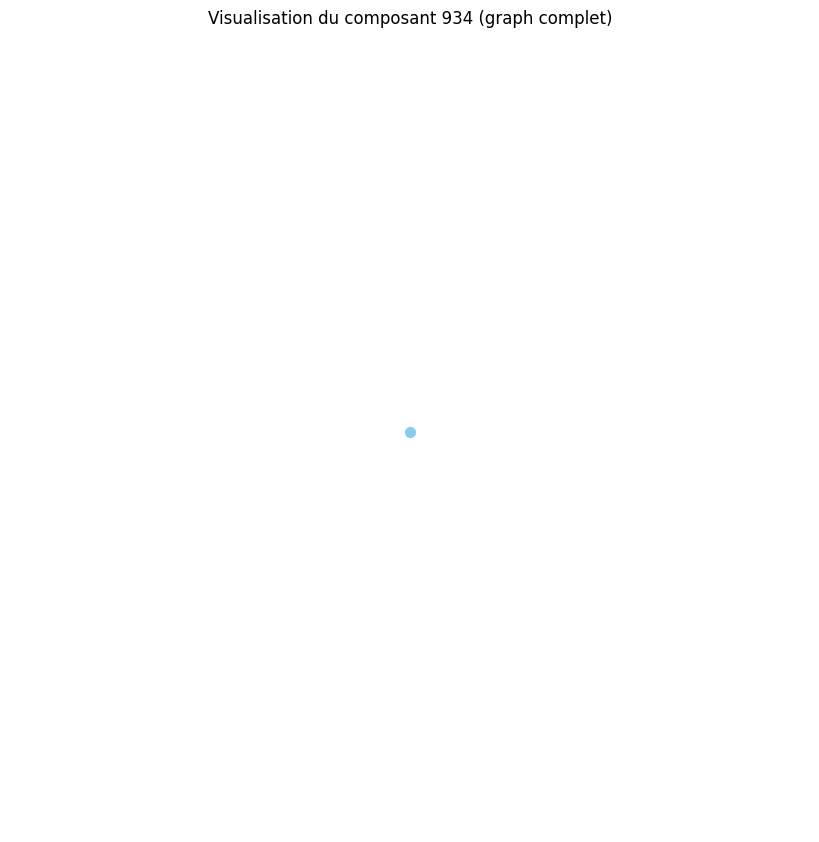

Distance moyenne pour le composant 935 : 0.00
Le composant 935 est un graphe complet ou très densément connecté.
Densité du composant 935 : 0.00
Degré moyen du composant 935 : 0.00
Coefficient de clustering moyen du composant 935 : 0.00


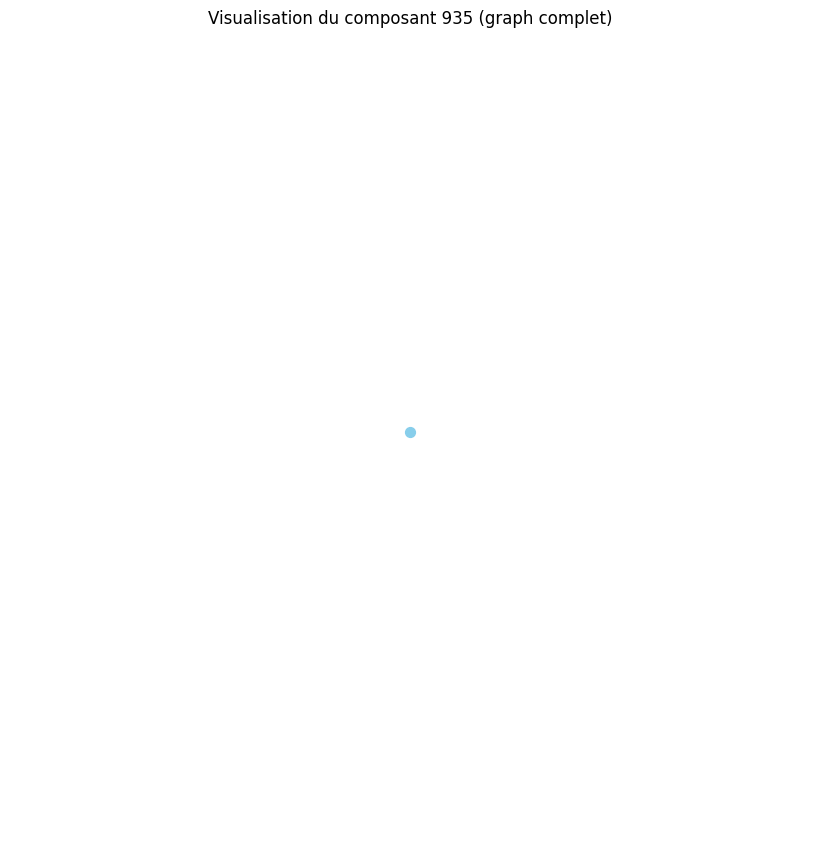

Distance moyenne pour le composant 936 : 0.00
Le composant 936 est un graphe complet ou très densément connecté.
Densité du composant 936 : 0.00
Degré moyen du composant 936 : 0.00
Coefficient de clustering moyen du composant 936 : 0.00


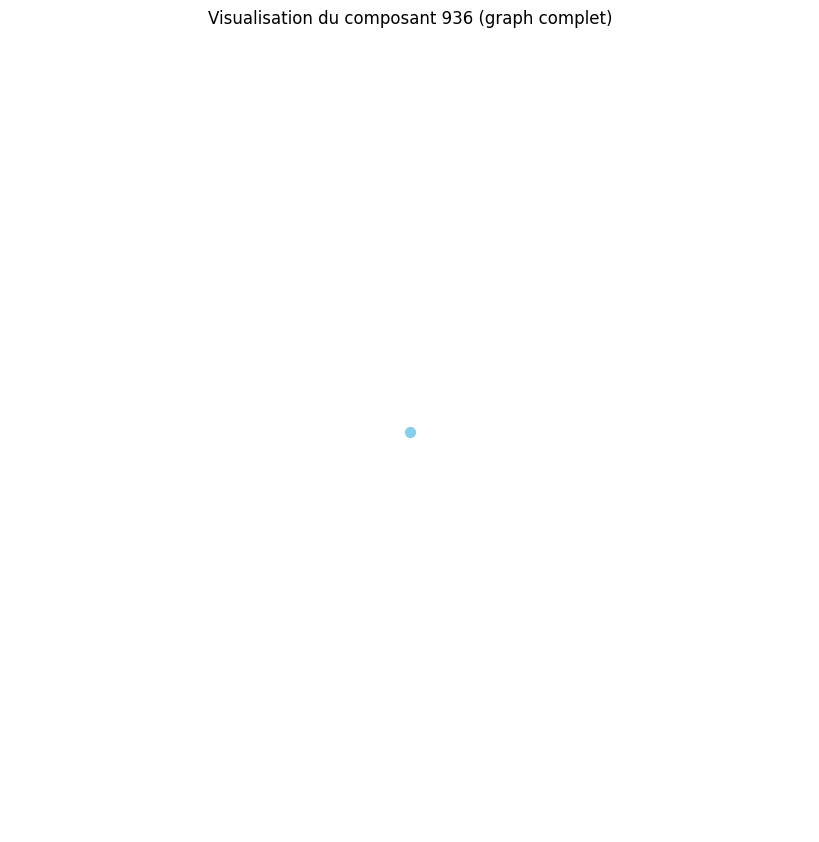

Distance moyenne pour le composant 937 : 0.00
Le composant 937 est un graphe complet ou très densément connecté.
Densité du composant 937 : 0.00
Degré moyen du composant 937 : 0.00
Coefficient de clustering moyen du composant 937 : 0.00


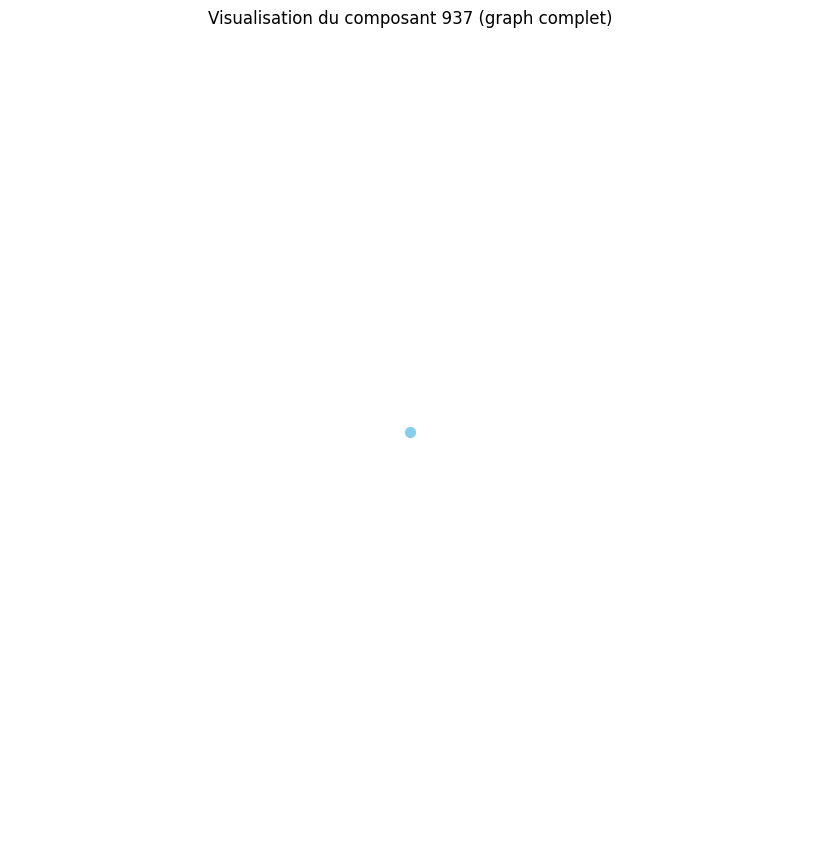

Distance moyenne pour le composant 938 : 0.00
Le composant 938 est un graphe complet ou très densément connecté.
Densité du composant 938 : 0.00
Degré moyen du composant 938 : 0.00
Coefficient de clustering moyen du composant 938 : 0.00


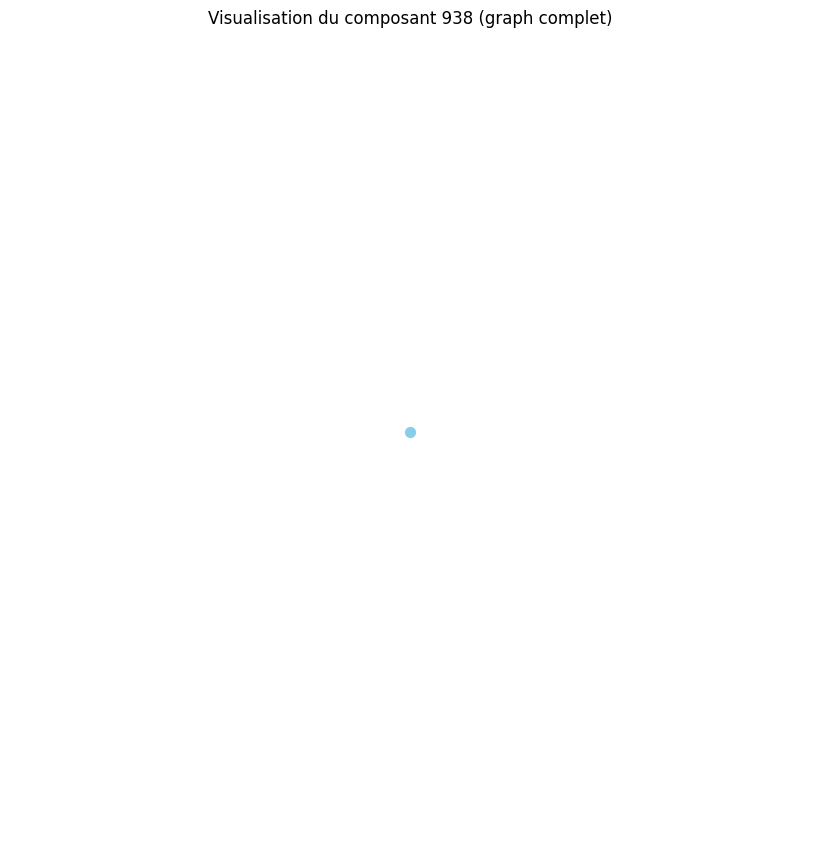

Distance moyenne pour le composant 939 : 0.00
Le composant 939 est un graphe complet ou très densément connecté.
Densité du composant 939 : 0.00
Degré moyen du composant 939 : 0.00
Coefficient de clustering moyen du composant 939 : 0.00


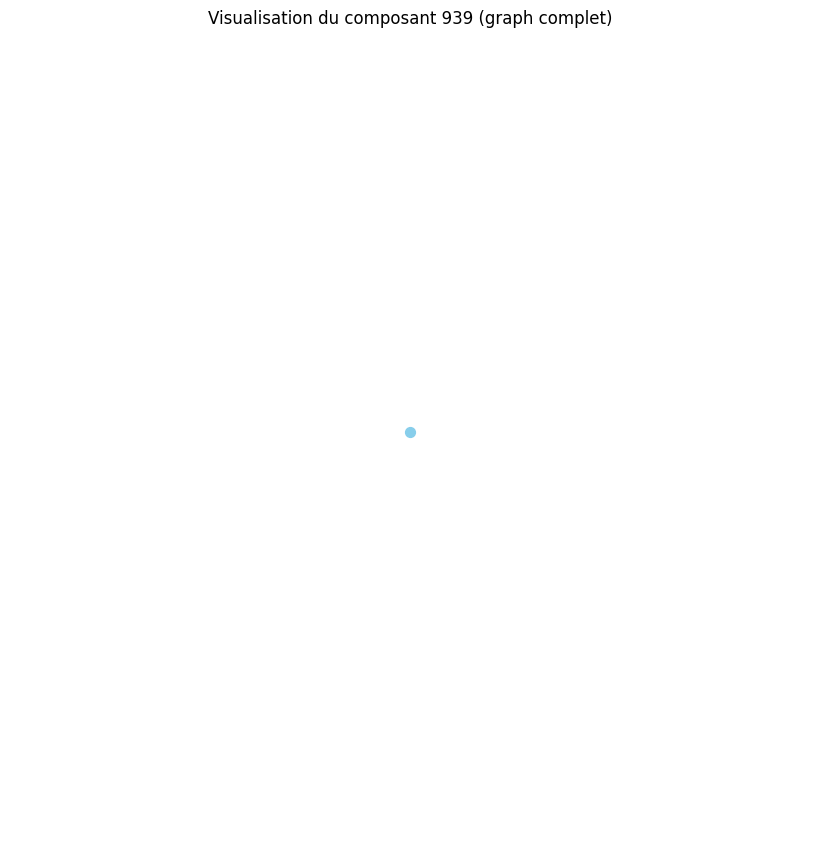

Distance moyenne pour le composant 940 : 0.00
Le composant 940 est un graphe complet ou très densément connecté.
Densité du composant 940 : 0.00
Degré moyen du composant 940 : 0.00
Coefficient de clustering moyen du composant 940 : 0.00


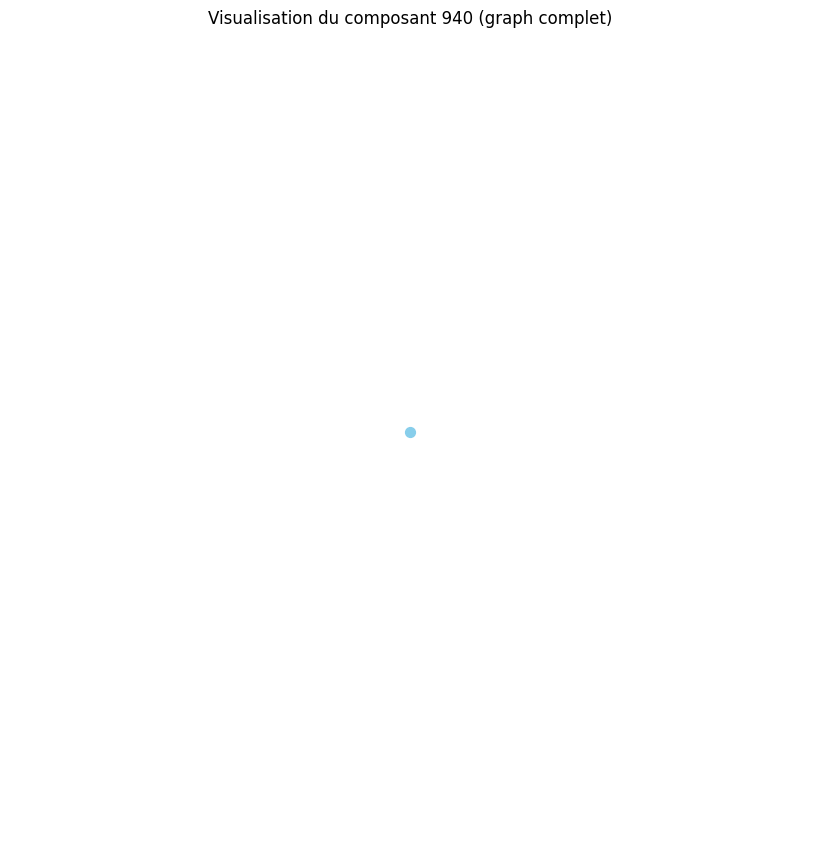

Distance moyenne pour le composant 941 : 0.00
Le composant 941 est un graphe complet ou très densément connecté.
Densité du composant 941 : 0.00
Degré moyen du composant 941 : 0.00
Coefficient de clustering moyen du composant 941 : 0.00


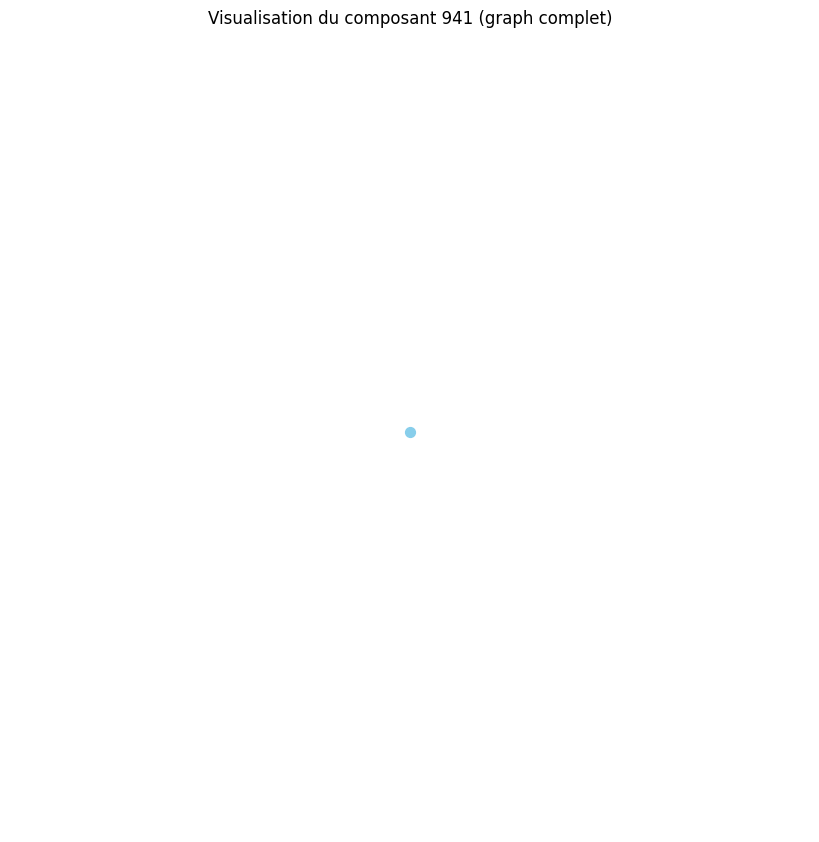

Distance moyenne pour le composant 942 : 0.00
Le composant 942 est un graphe complet ou très densément connecté.
Densité du composant 942 : 0.00
Degré moyen du composant 942 : 0.00
Coefficient de clustering moyen du composant 942 : 0.00


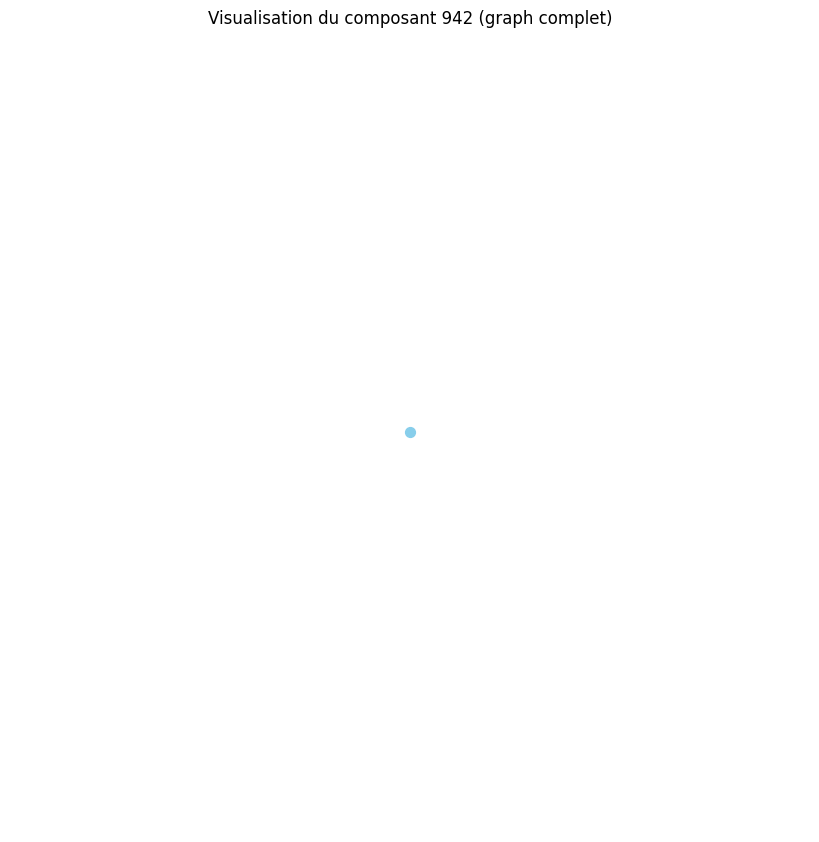

Distance moyenne pour le composant 943 : 0.00
Le composant 943 est un graphe complet ou très densément connecté.
Densité du composant 943 : 0.00
Degré moyen du composant 943 : 0.00
Coefficient de clustering moyen du composant 943 : 0.00


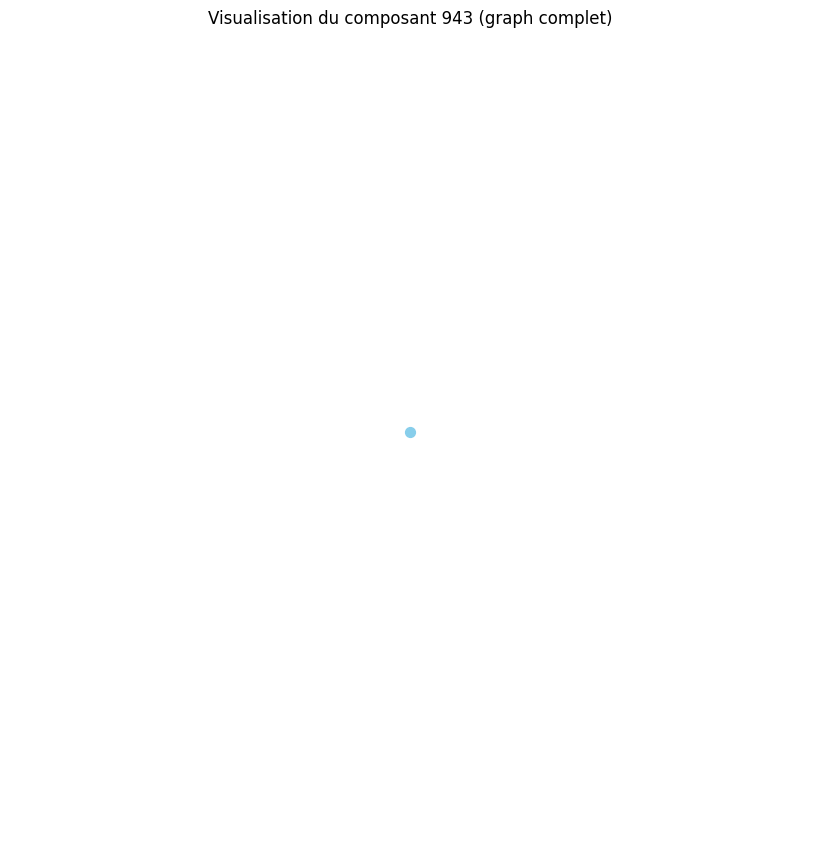

Distance moyenne pour le composant 944 : 0.00
Le composant 944 est un graphe complet ou très densément connecté.
Densité du composant 944 : 0.00
Degré moyen du composant 944 : 0.00
Coefficient de clustering moyen du composant 944 : 0.00


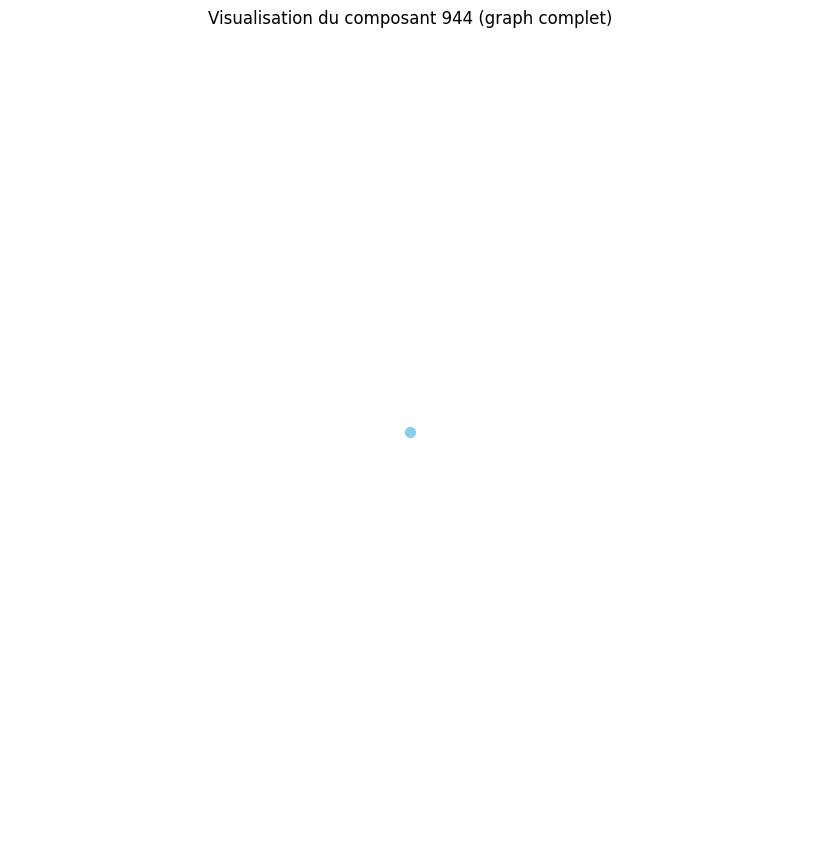

Distance moyenne pour le composant 945 : 0.00
Le composant 945 est un graphe complet ou très densément connecté.
Densité du composant 945 : 0.00
Degré moyen du composant 945 : 0.00
Coefficient de clustering moyen du composant 945 : 0.00


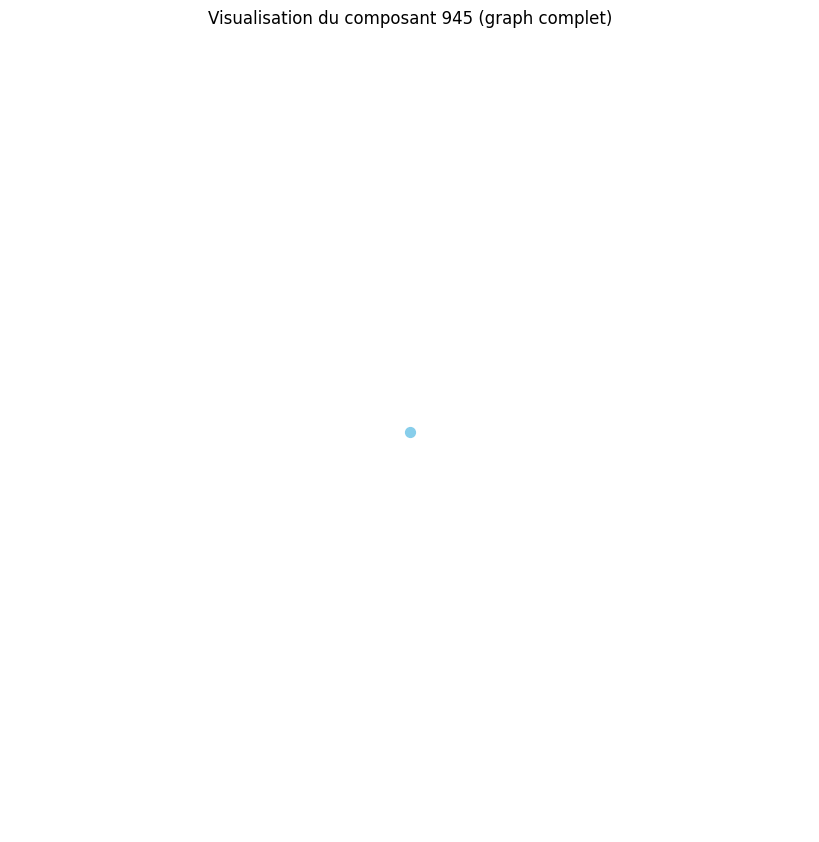

Distance moyenne pour le composant 946 : 0.00
Le composant 946 est un graphe complet ou très densément connecté.
Densité du composant 946 : 0.00
Degré moyen du composant 946 : 0.00
Coefficient de clustering moyen du composant 946 : 0.00


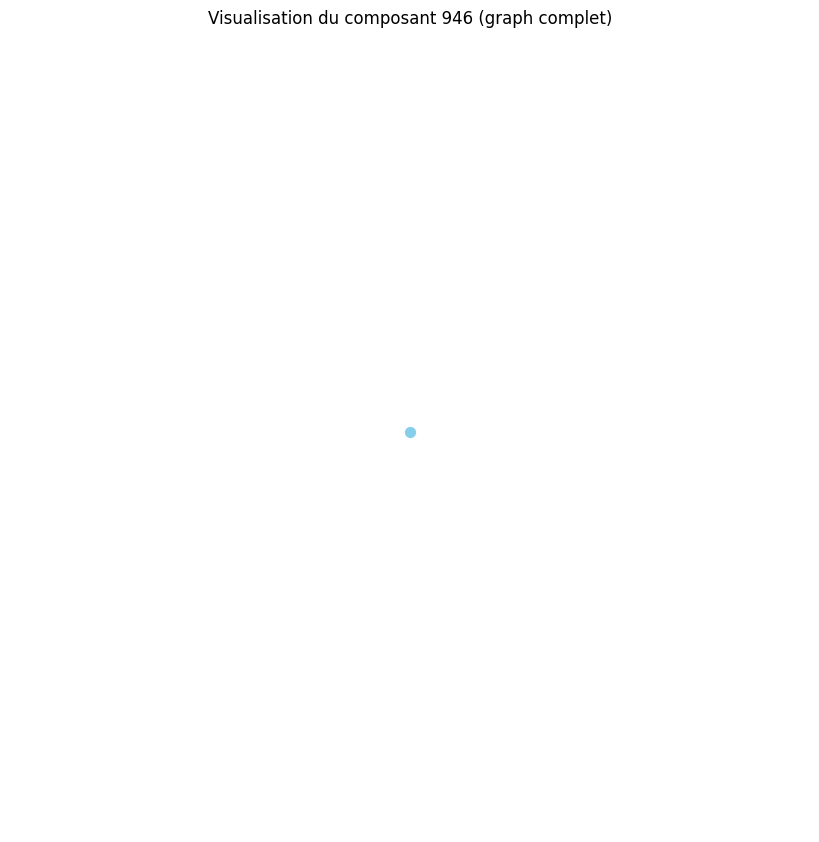

Distance moyenne pour le composant 947 : 0.00
Le composant 947 est un graphe complet ou très densément connecté.
Densité du composant 947 : 0.00
Degré moyen du composant 947 : 0.00
Coefficient de clustering moyen du composant 947 : 0.00


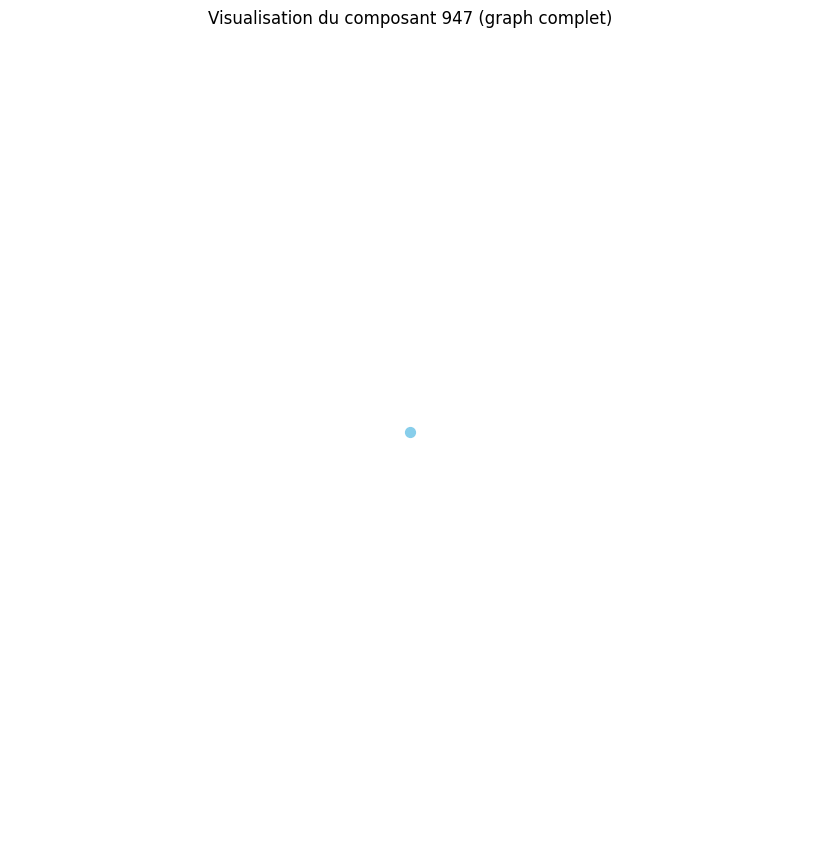

Distance moyenne pour le composant 948 : 0.00
Le composant 948 est un graphe complet ou très densément connecté.
Densité du composant 948 : 0.00
Degré moyen du composant 948 : 0.00
Coefficient de clustering moyen du composant 948 : 0.00


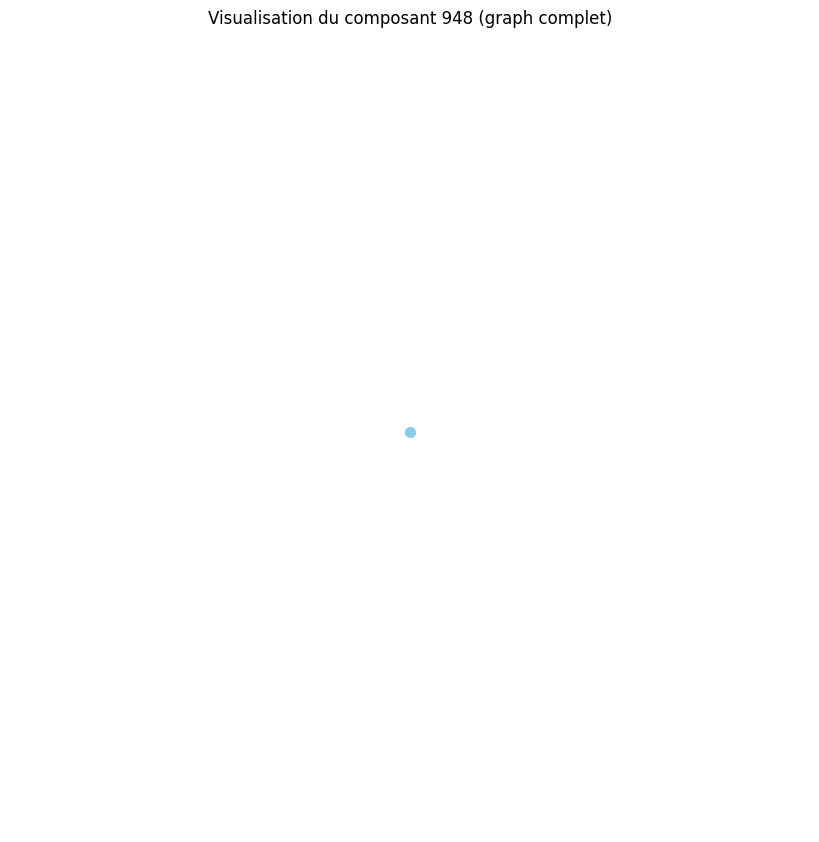

Distance moyenne pour le composant 949 : 0.00
Le composant 949 est un graphe complet ou très densément connecté.
Densité du composant 949 : 0.00
Degré moyen du composant 949 : 0.00
Coefficient de clustering moyen du composant 949 : 0.00


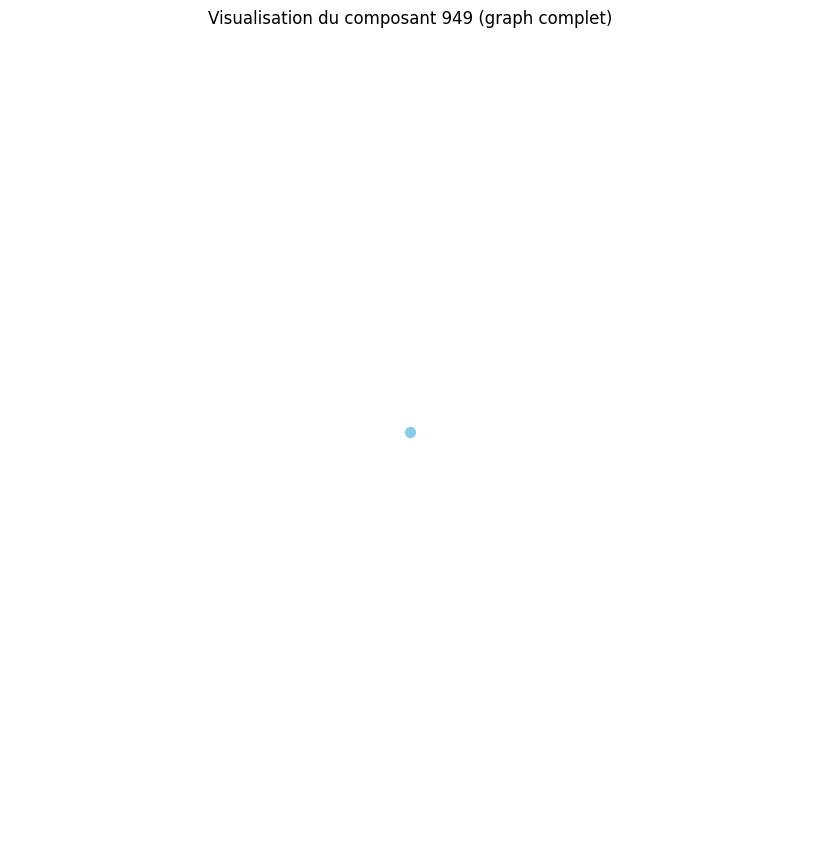

Distance moyenne pour le composant 950 : 0.00
Le composant 950 est un graphe complet ou très densément connecté.
Densité du composant 950 : 0.00
Degré moyen du composant 950 : 0.00
Coefficient de clustering moyen du composant 950 : 0.00


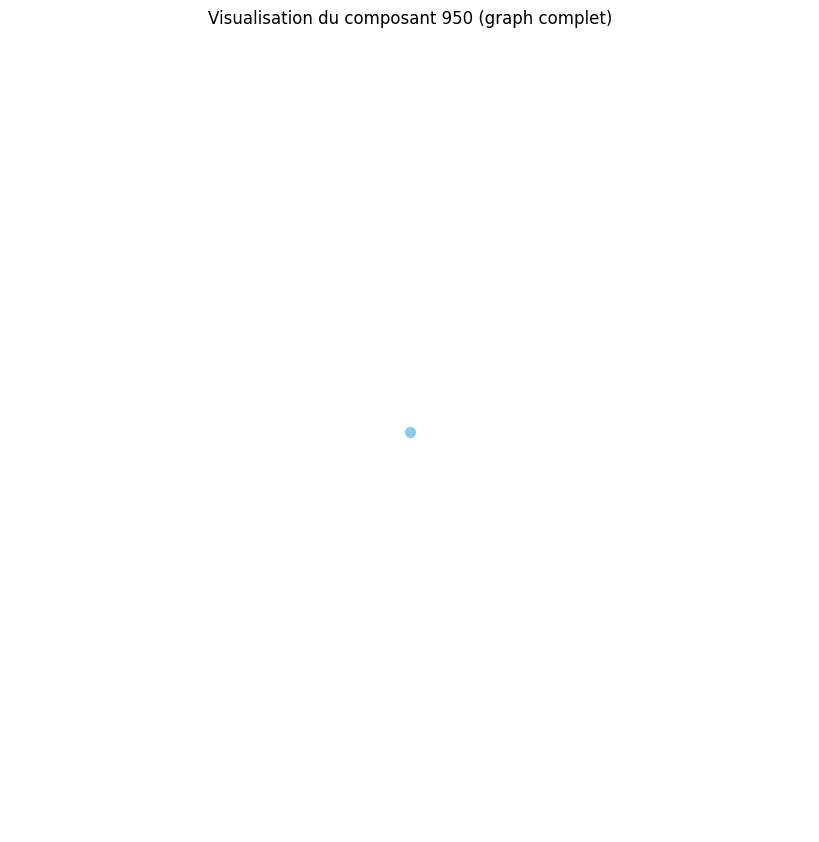

Distance moyenne pour le composant 951 : 0.00
Le composant 951 est un graphe complet ou très densément connecté.
Densité du composant 951 : 0.00
Degré moyen du composant 951 : 0.00
Coefficient de clustering moyen du composant 951 : 0.00


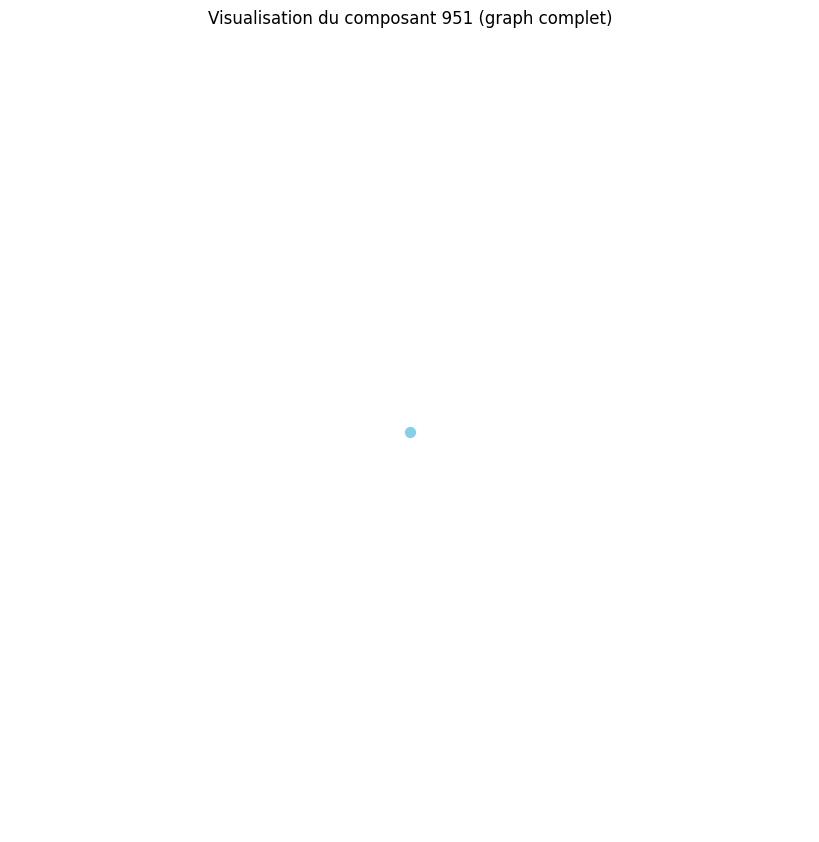

Distance moyenne pour le composant 952 : 0.00
Le composant 952 est un graphe complet ou très densément connecté.
Densité du composant 952 : 0.00
Degré moyen du composant 952 : 0.00
Coefficient de clustering moyen du composant 952 : 0.00


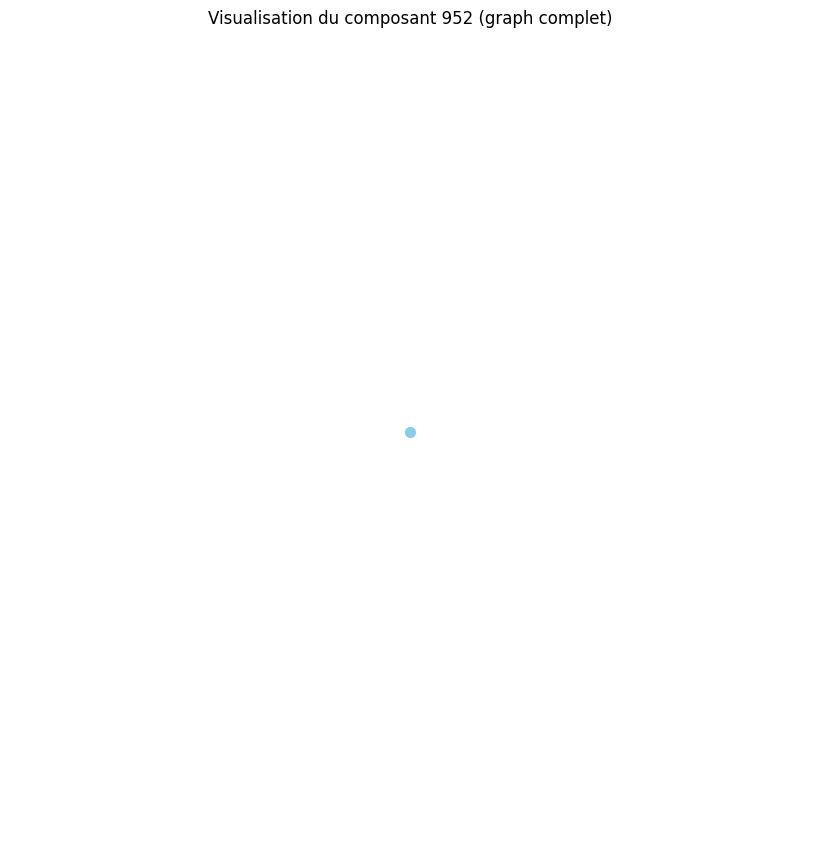

Distance moyenne pour le composant 953 : 0.00
Le composant 953 est un graphe complet ou très densément connecté.
Densité du composant 953 : 0.00
Degré moyen du composant 953 : 0.00
Coefficient de clustering moyen du composant 953 : 0.00


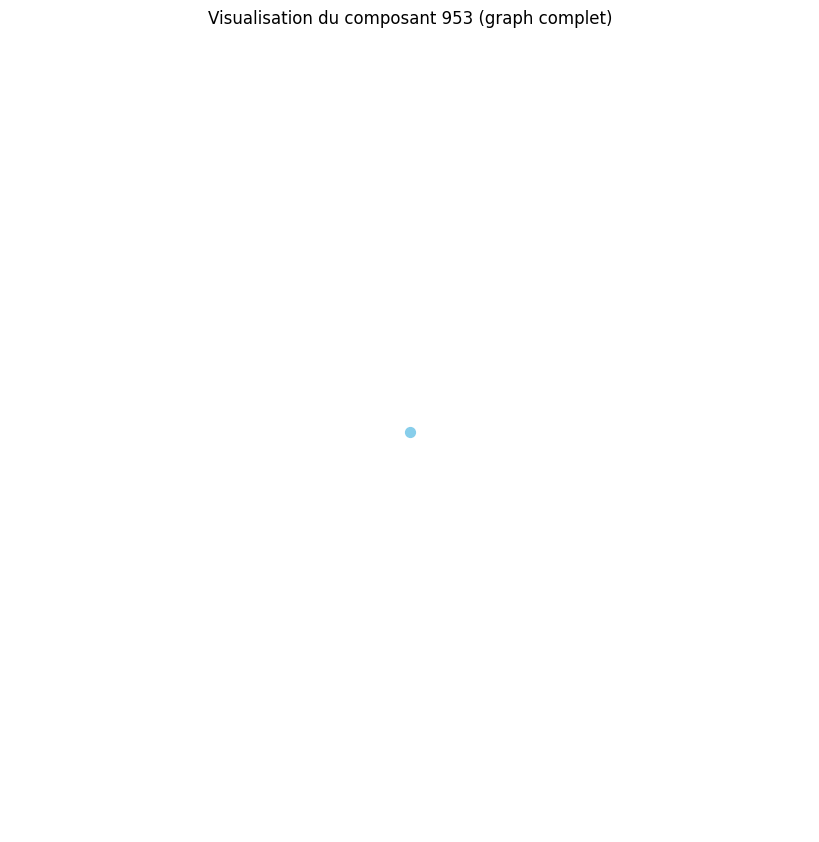

Distance moyenne pour le composant 954 : 0.00
Le composant 954 est un graphe complet ou très densément connecté.
Densité du composant 954 : 0.00
Degré moyen du composant 954 : 0.00
Coefficient de clustering moyen du composant 954 : 0.00


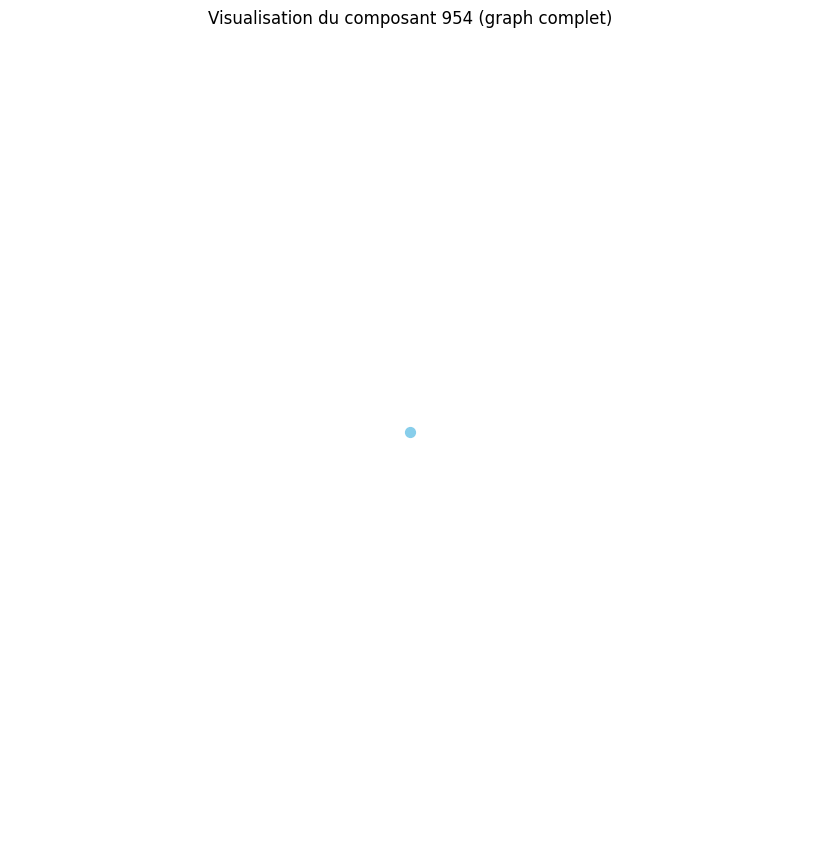

Distance moyenne pour le composant 955 : 0.00
Le composant 955 est un graphe complet ou très densément connecté.
Densité du composant 955 : 0.00
Degré moyen du composant 955 : 0.00
Coefficient de clustering moyen du composant 955 : 0.00


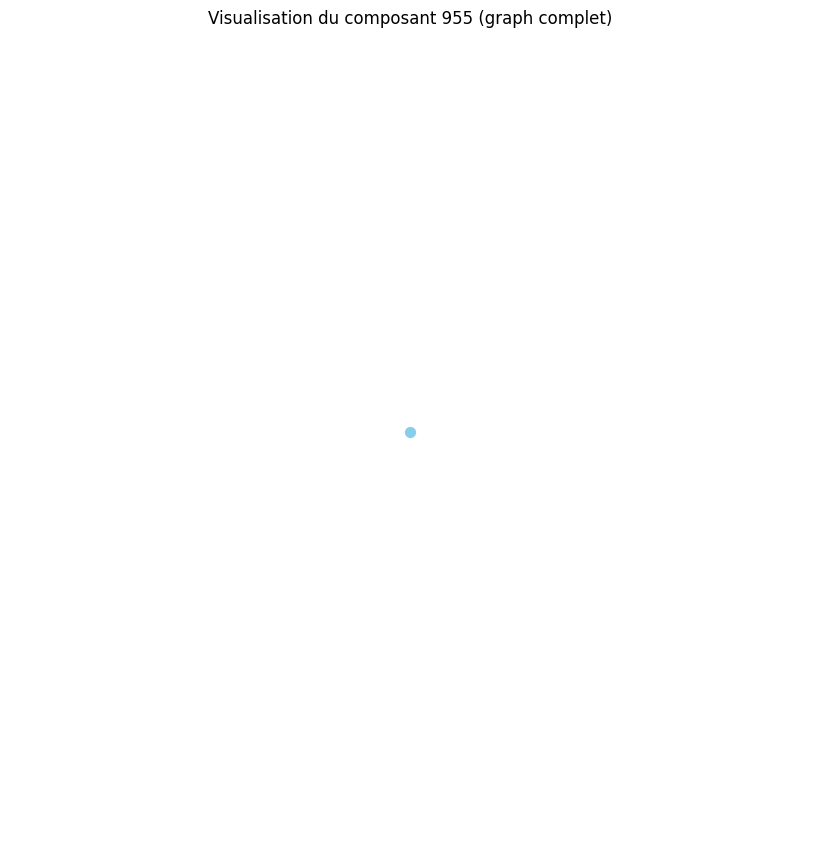

Distance moyenne pour le composant 956 : 0.00
Le composant 956 est un graphe complet ou très densément connecté.
Densité du composant 956 : 0.00
Degré moyen du composant 956 : 0.00
Coefficient de clustering moyen du composant 956 : 0.00


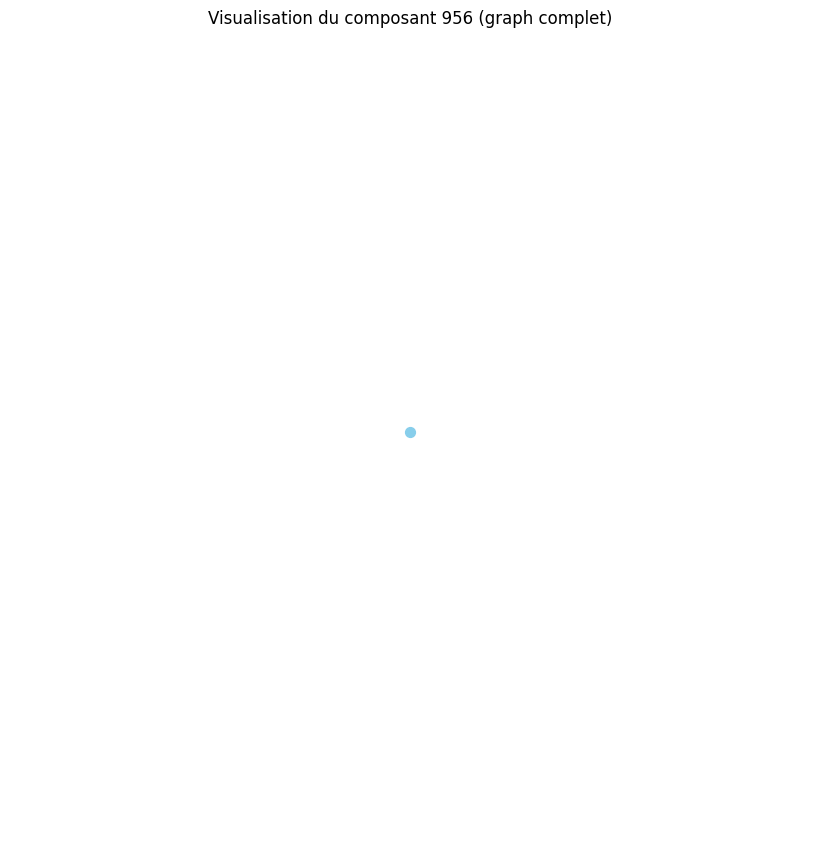

Distance moyenne pour le composant 957 : 0.00
Le composant 957 est un graphe complet ou très densément connecté.
Densité du composant 957 : 0.00
Degré moyen du composant 957 : 0.00
Coefficient de clustering moyen du composant 957 : 0.00


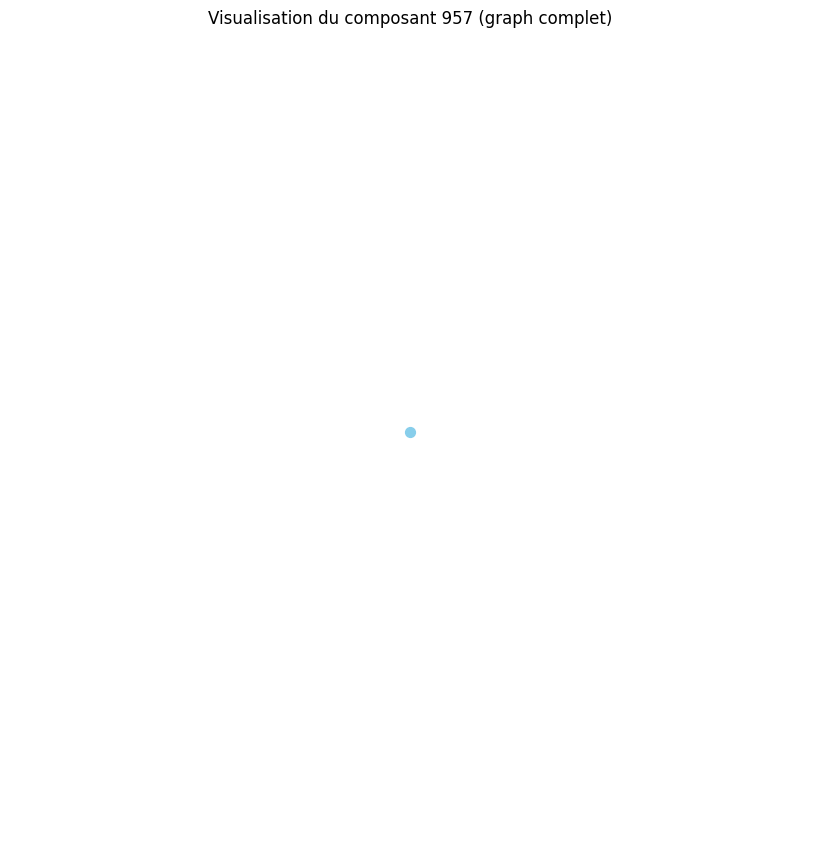

Distance moyenne pour le composant 958 : 0.00
Le composant 958 est un graphe complet ou très densément connecté.
Densité du composant 958 : 0.00
Degré moyen du composant 958 : 0.00
Coefficient de clustering moyen du composant 958 : 0.00


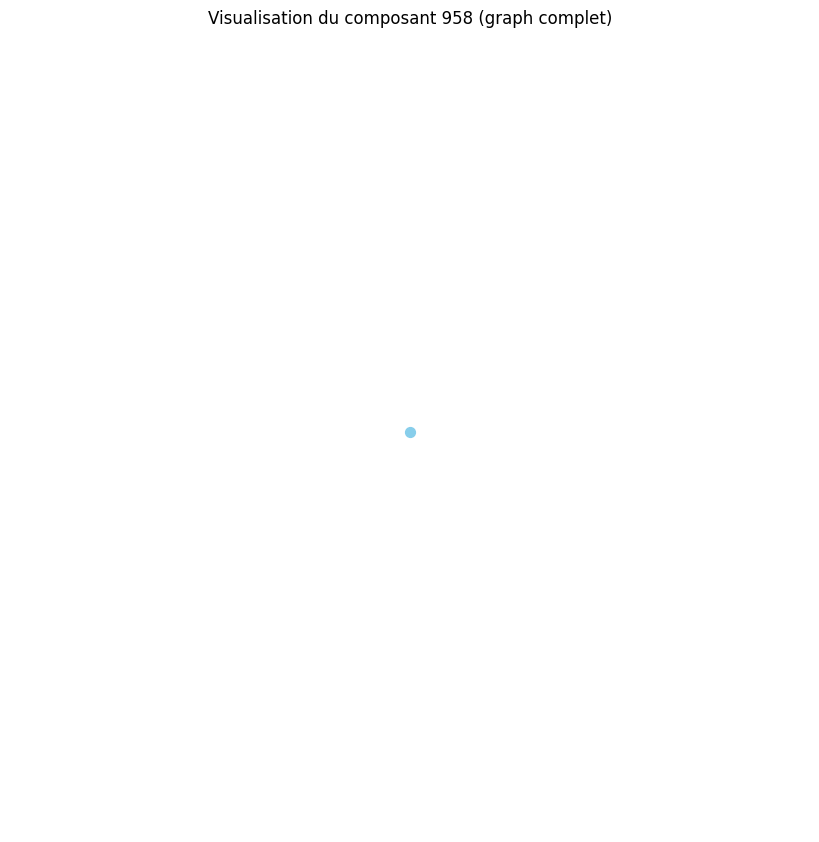

Distance moyenne pour le composant 959 : 0.00
Le composant 959 est un graphe complet ou très densément connecté.
Densité du composant 959 : 0.00
Degré moyen du composant 959 : 0.00
Coefficient de clustering moyen du composant 959 : 0.00


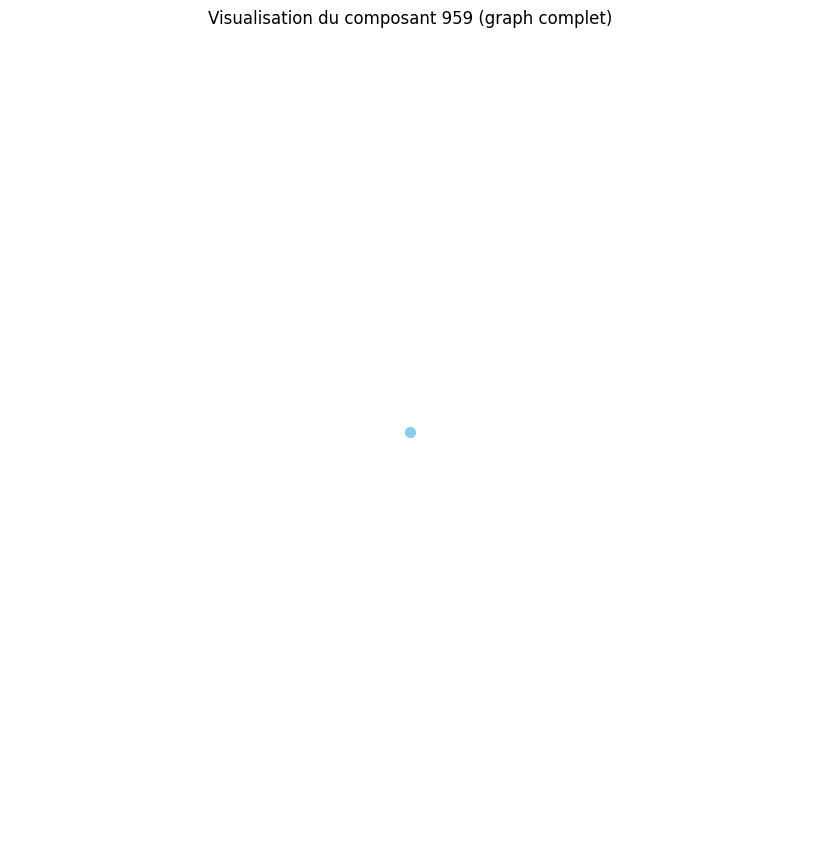

Distance moyenne pour le composant 960 : 0.00
Le composant 960 est un graphe complet ou très densément connecté.
Densité du composant 960 : 0.00
Degré moyen du composant 960 : 0.00
Coefficient de clustering moyen du composant 960 : 0.00


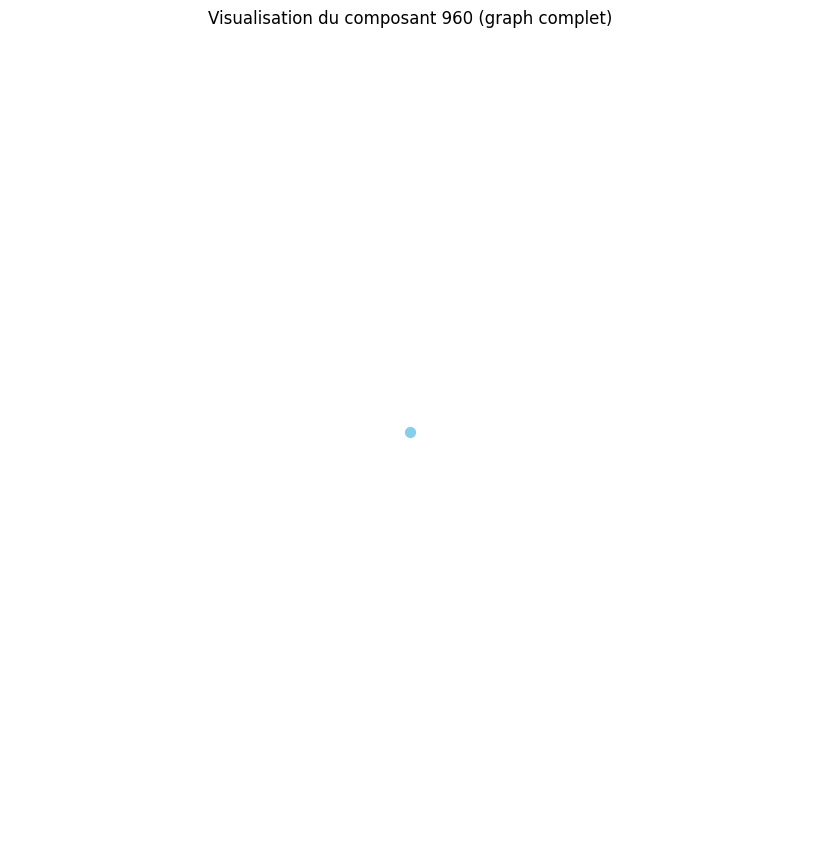

Distance moyenne pour le composant 961 : 0.00
Le composant 961 est un graphe complet ou très densément connecté.
Densité du composant 961 : 0.00
Degré moyen du composant 961 : 0.00
Coefficient de clustering moyen du composant 961 : 0.00


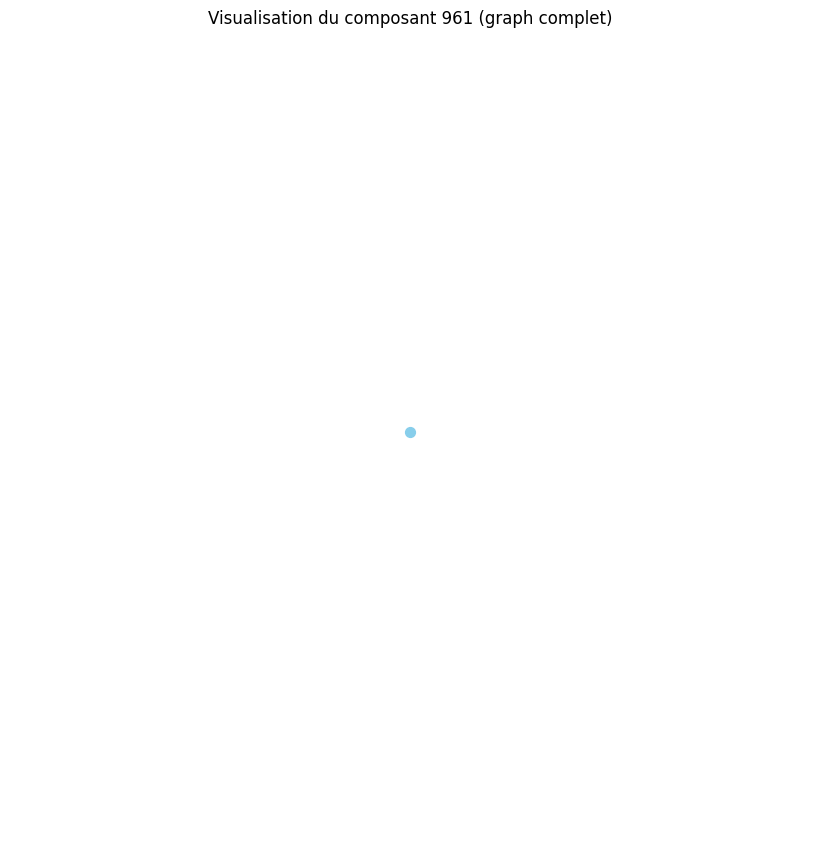

Distance moyenne pour le composant 962 : 0.00
Le composant 962 est un graphe complet ou très densément connecté.
Densité du composant 962 : 0.00
Degré moyen du composant 962 : 0.00
Coefficient de clustering moyen du composant 962 : 0.00


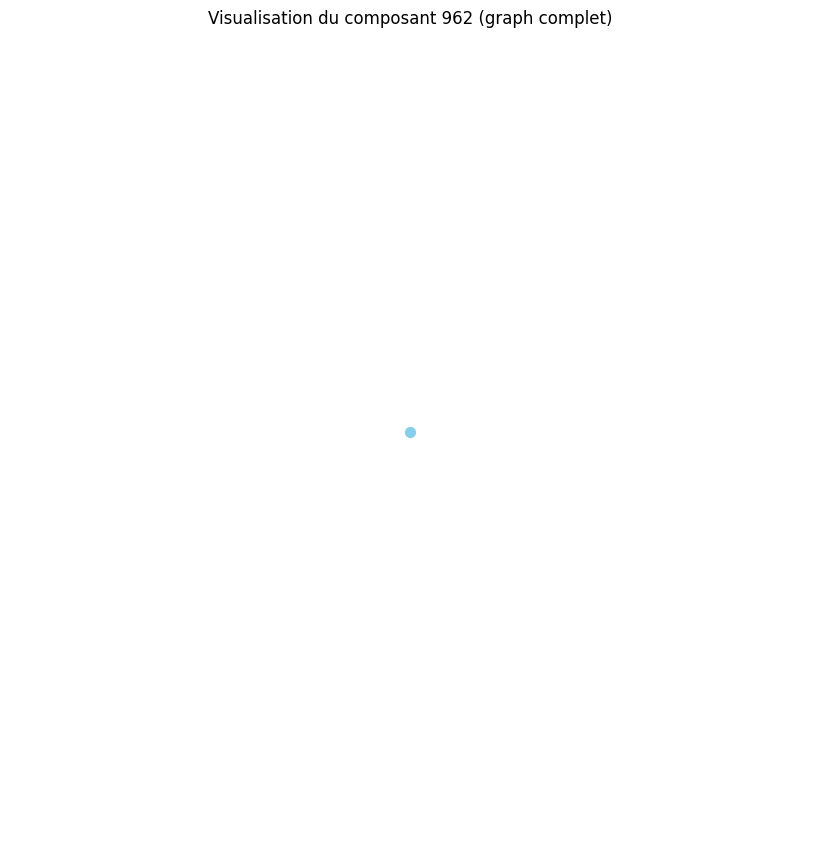

Distance moyenne pour le composant 963 : 0.00
Le composant 963 est un graphe complet ou très densément connecté.
Densité du composant 963 : 0.00
Degré moyen du composant 963 : 0.00
Coefficient de clustering moyen du composant 963 : 0.00


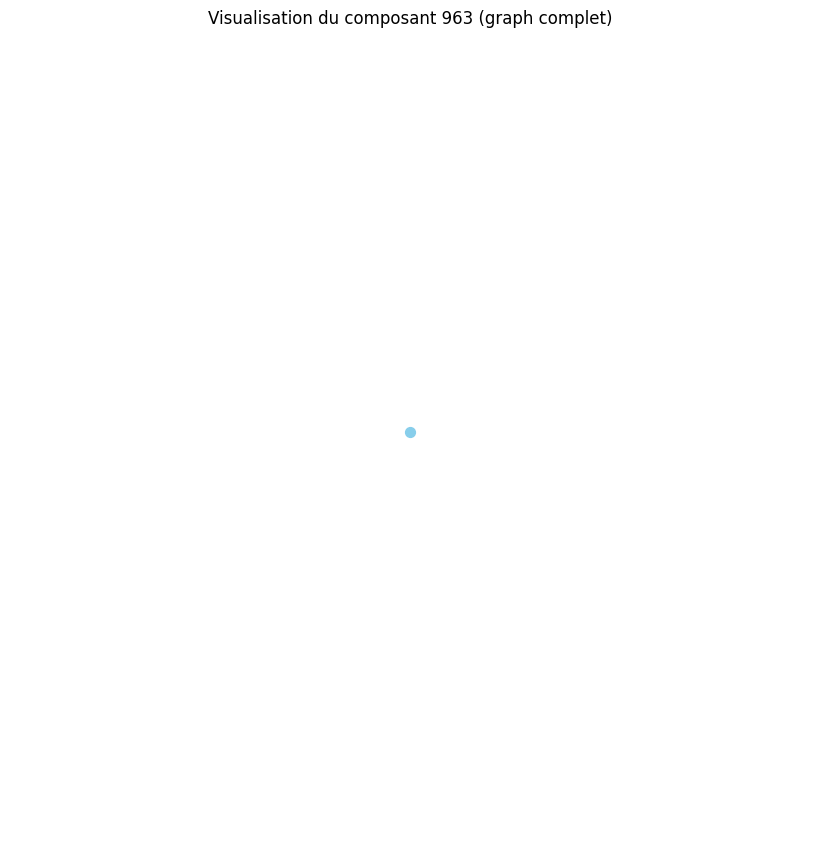

Distance moyenne pour le composant 964 : 0.00
Le composant 964 est un graphe complet ou très densément connecté.
Densité du composant 964 : 0.00
Degré moyen du composant 964 : 0.00
Coefficient de clustering moyen du composant 964 : 0.00


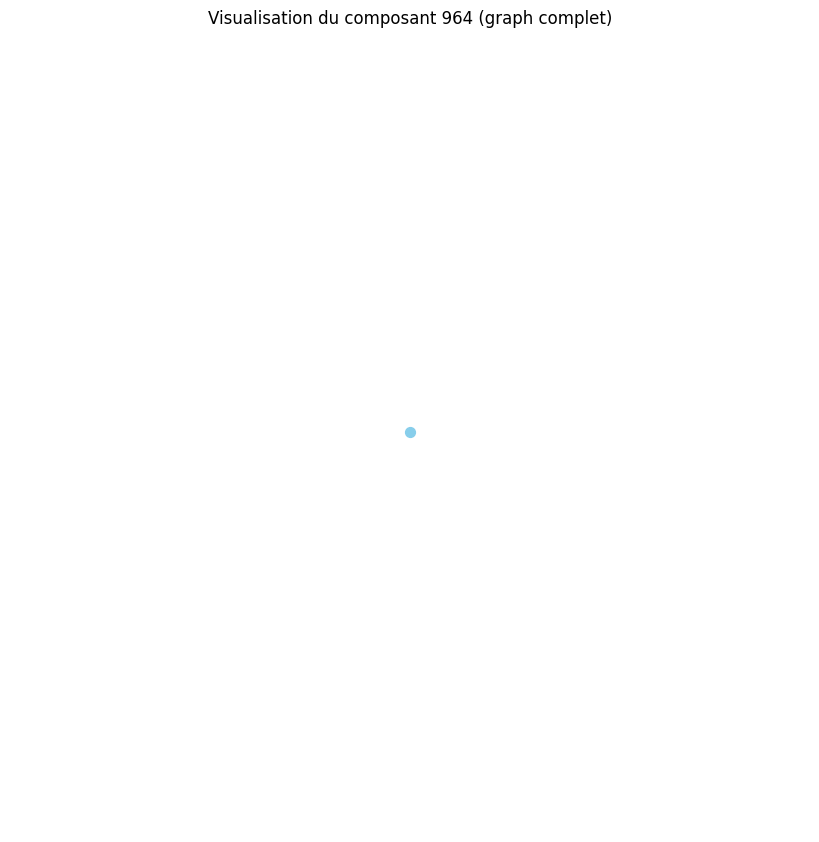

Distance moyenne pour le composant 965 : 0.00
Le composant 965 est un graphe complet ou très densément connecté.
Densité du composant 965 : 0.00
Degré moyen du composant 965 : 0.00
Coefficient de clustering moyen du composant 965 : 0.00


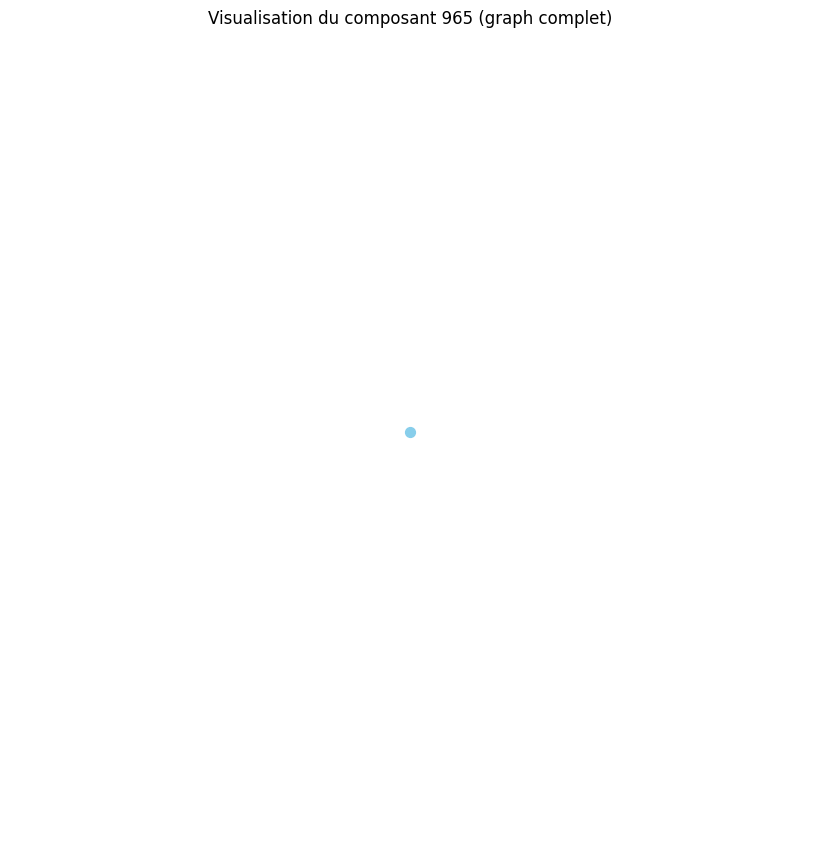

Distance moyenne pour le composant 966 : 0.00
Le composant 966 est un graphe complet ou très densément connecté.
Densité du composant 966 : 0.00
Degré moyen du composant 966 : 0.00
Coefficient de clustering moyen du composant 966 : 0.00


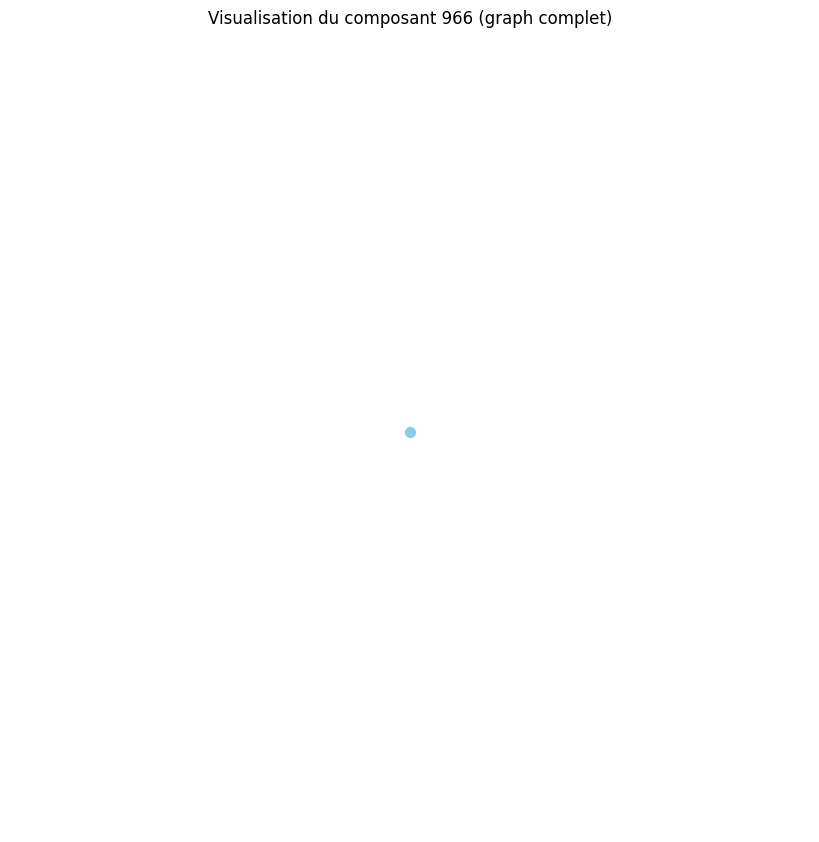

Distance moyenne pour le composant 967 : 0.00
Le composant 967 est un graphe complet ou très densément connecté.
Densité du composant 967 : 0.00
Degré moyen du composant 967 : 0.00
Coefficient de clustering moyen du composant 967 : 0.00


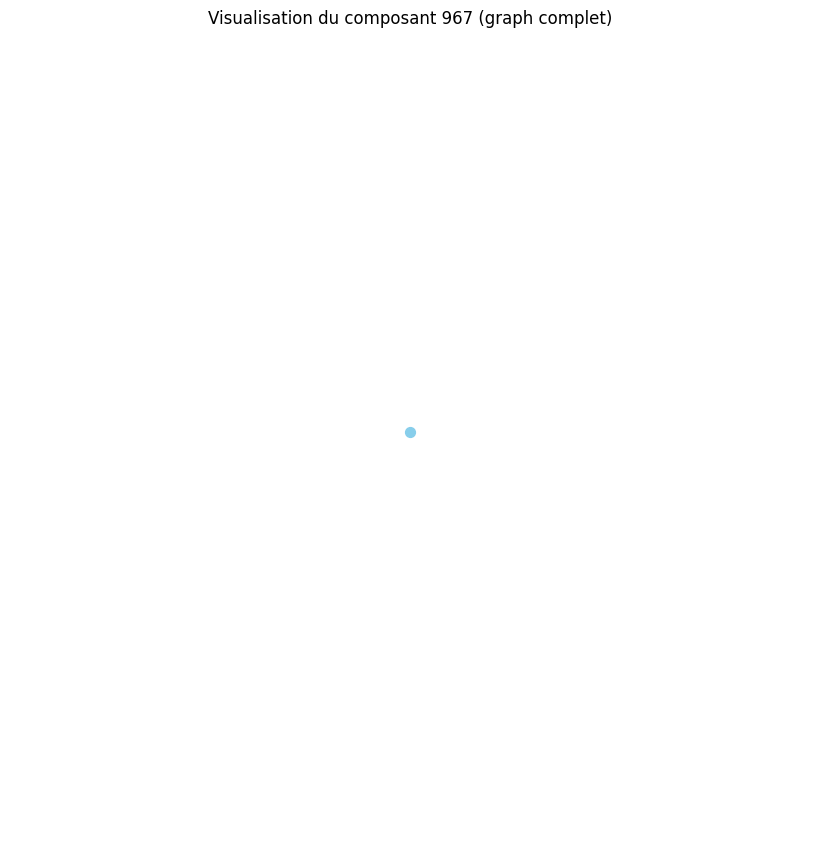

Distance moyenne pour le composant 968 : 0.00
Le composant 968 est un graphe complet ou très densément connecté.
Densité du composant 968 : 0.00
Degré moyen du composant 968 : 0.00
Coefficient de clustering moyen du composant 968 : 0.00


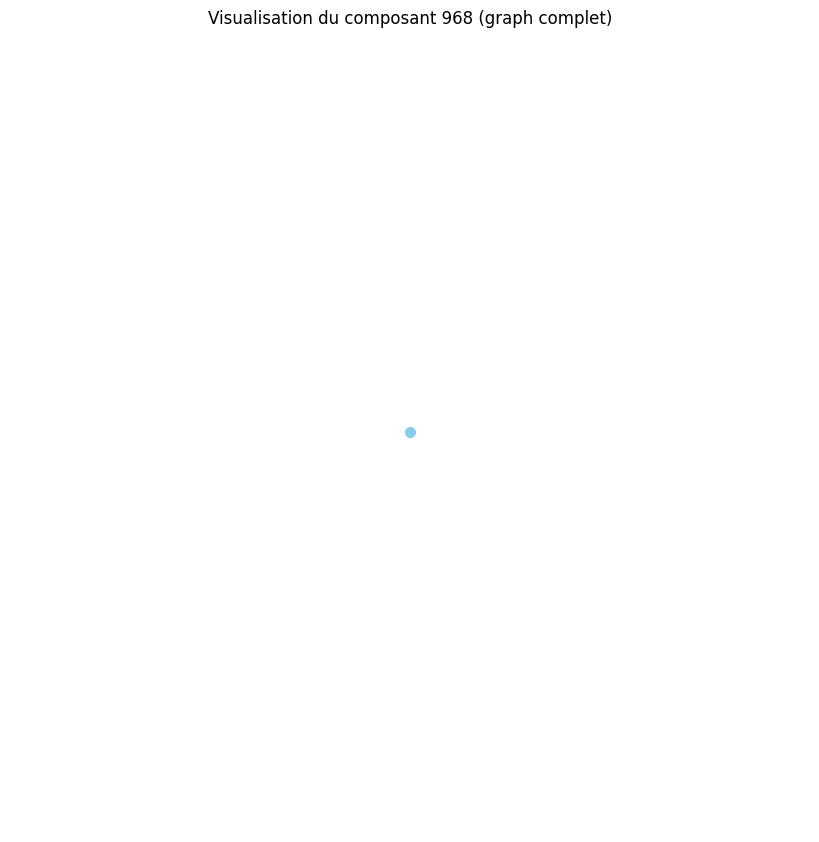

Distance moyenne pour le composant 969 : 0.00
Le composant 969 est un graphe complet ou très densément connecté.
Densité du composant 969 : 0.00
Degré moyen du composant 969 : 0.00
Coefficient de clustering moyen du composant 969 : 0.00


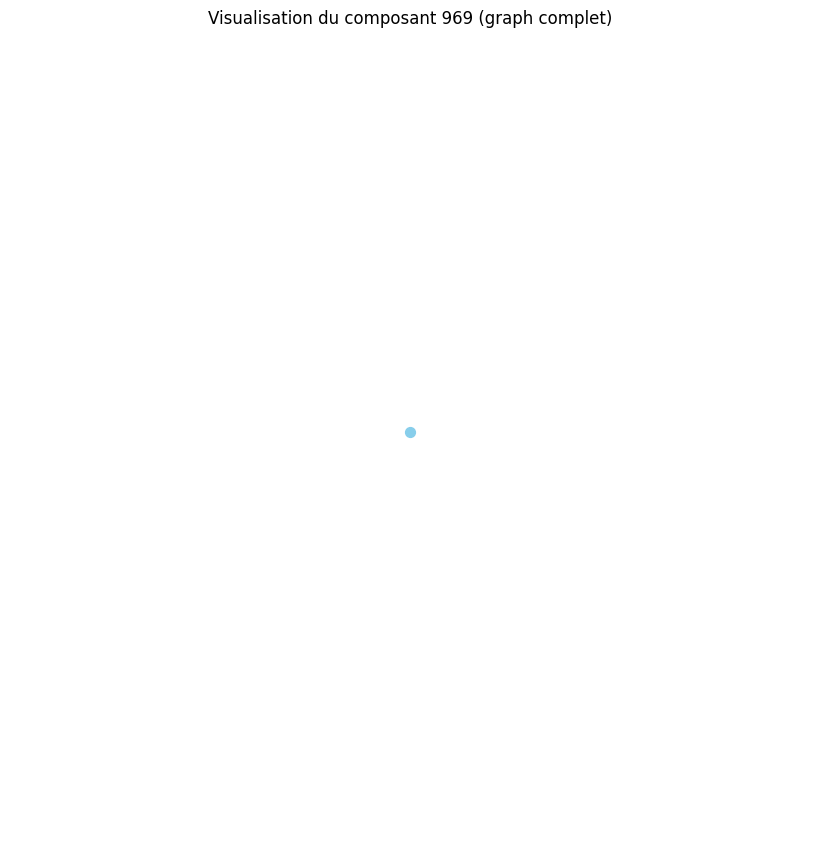

Distance moyenne pour le composant 970 : 0.00
Le composant 970 est un graphe complet ou très densément connecté.
Densité du composant 970 : 0.00
Degré moyen du composant 970 : 0.00
Coefficient de clustering moyen du composant 970 : 0.00


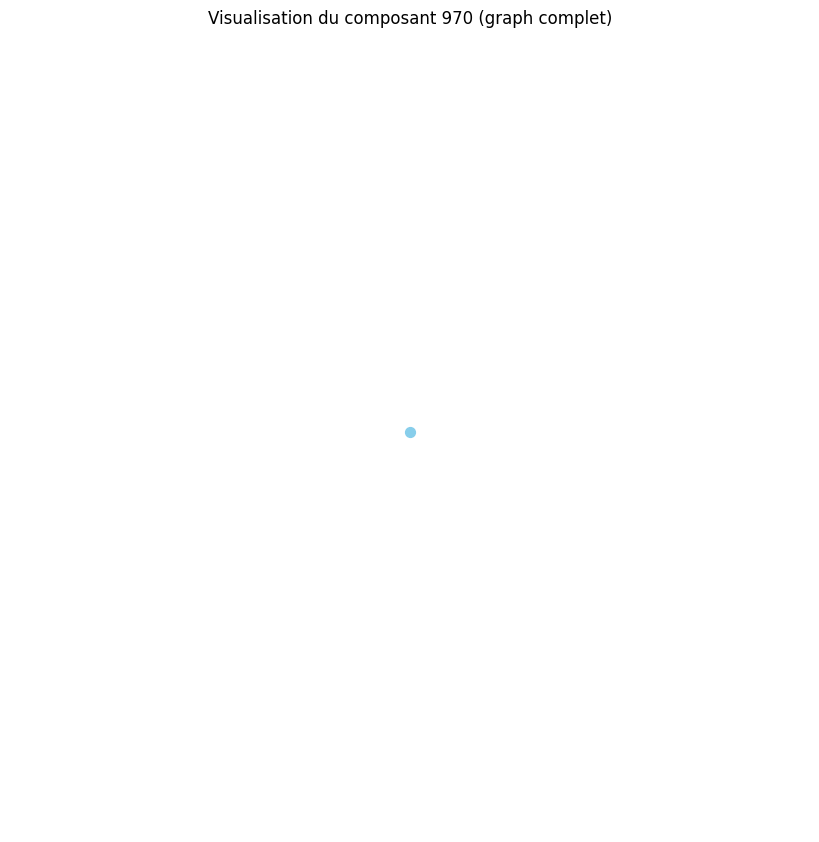

Distance moyenne pour le composant 971 : 0.00
Le composant 971 est un graphe complet ou très densément connecté.
Densité du composant 971 : 0.00
Degré moyen du composant 971 : 0.00
Coefficient de clustering moyen du composant 971 : 0.00


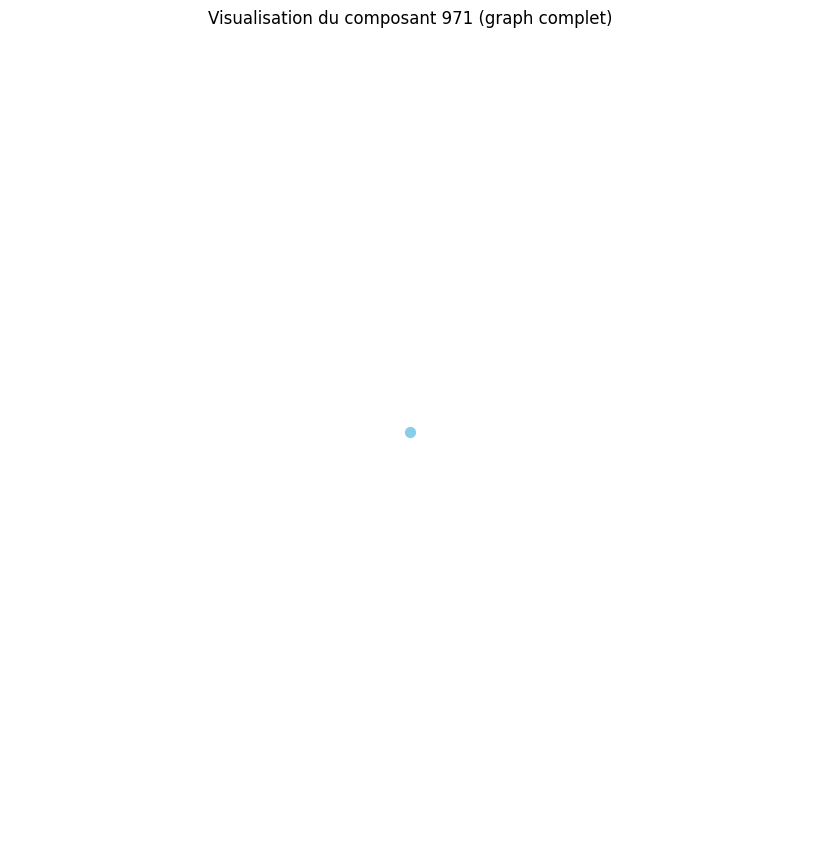

Distance moyenne pour le composant 972 : 0.00
Le composant 972 est un graphe complet ou très densément connecté.
Densité du composant 972 : 0.00
Degré moyen du composant 972 : 0.00
Coefficient de clustering moyen du composant 972 : 0.00


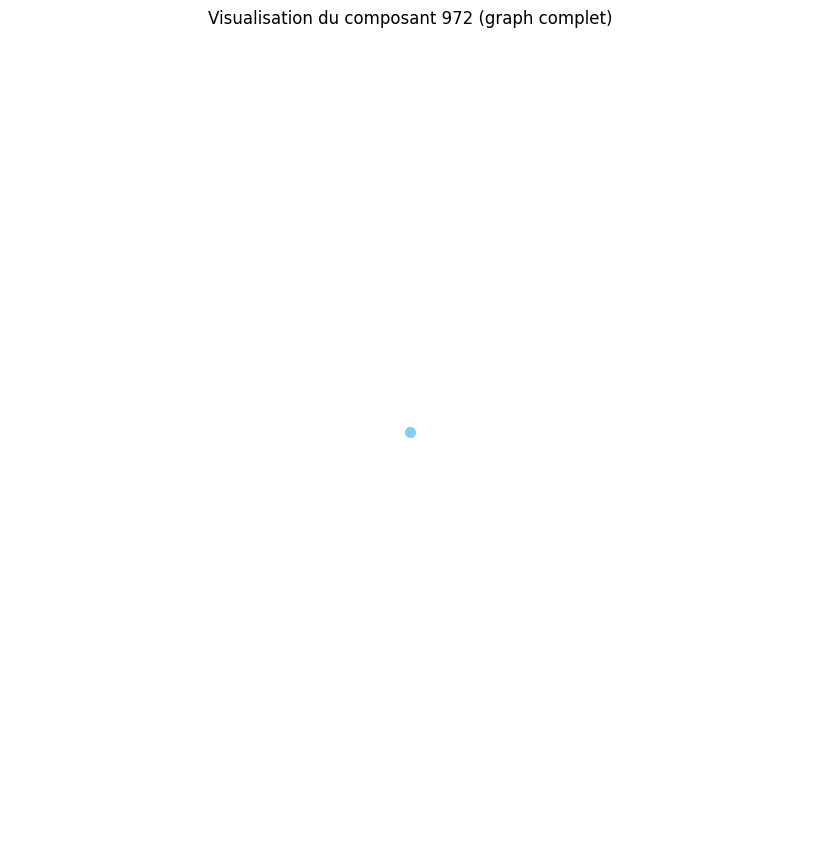

Distance moyenne pour le composant 973 : 0.00
Le composant 973 est un graphe complet ou très densément connecté.
Densité du composant 973 : 0.00
Degré moyen du composant 973 : 0.00
Coefficient de clustering moyen du composant 973 : 0.00


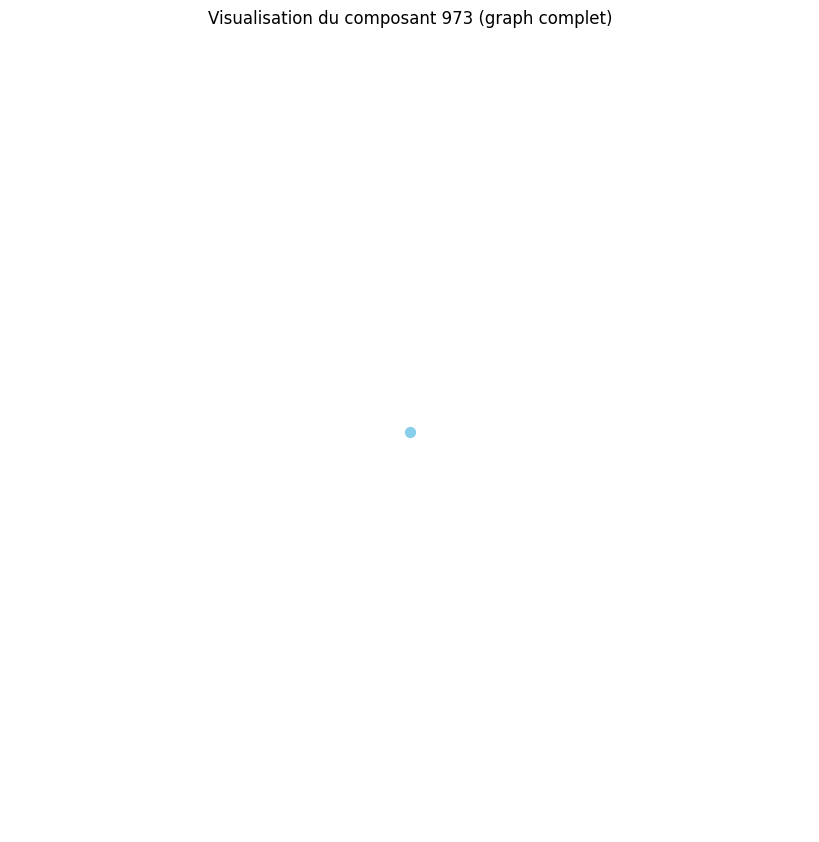

Distance moyenne pour le composant 974 : 1.00
Distance moyenne pour le composant 975 : 0.00
Le composant 975 est un graphe complet ou très densément connecté.
Densité du composant 975 : 0.00
Degré moyen du composant 975 : 0.00
Coefficient de clustering moyen du composant 975 : 0.00


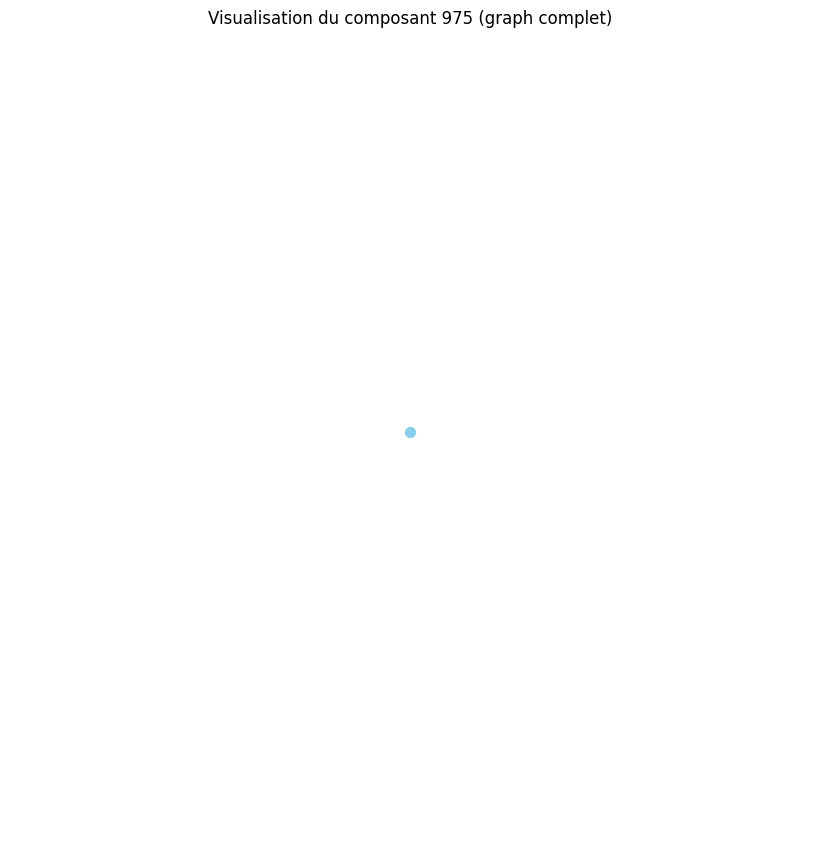

Distance moyenne pour le composant 976 : 0.00
Le composant 976 est un graphe complet ou très densément connecté.
Densité du composant 976 : 0.00
Degré moyen du composant 976 : 0.00
Coefficient de clustering moyen du composant 976 : 0.00


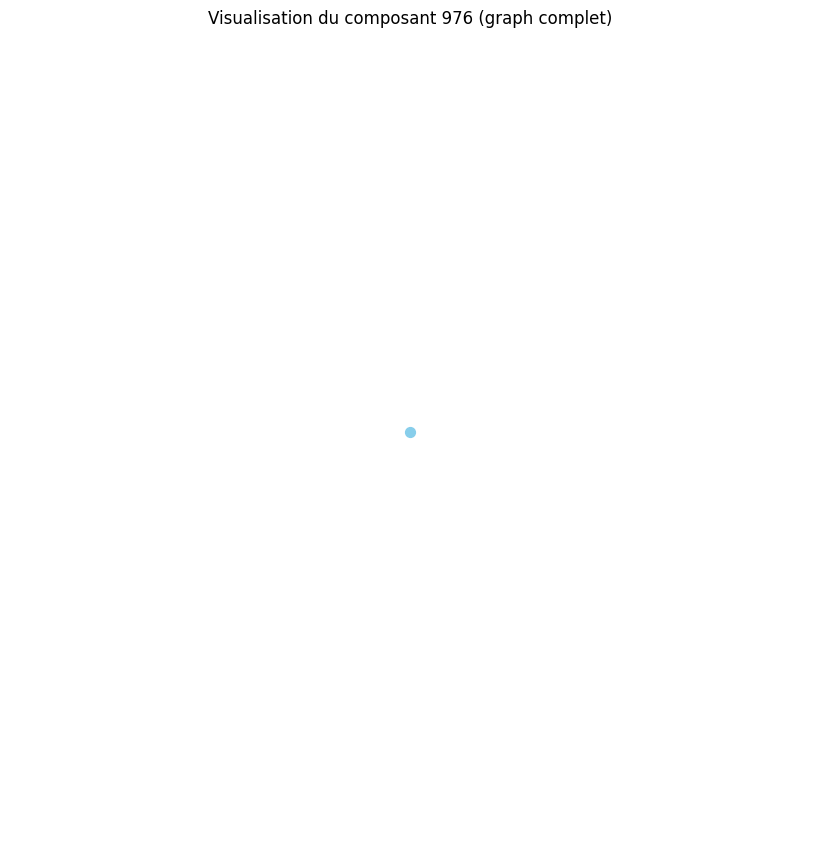

Distance moyenne pour le composant 977 : 0.00
Le composant 977 est un graphe complet ou très densément connecté.
Densité du composant 977 : 0.00
Degré moyen du composant 977 : 0.00
Coefficient de clustering moyen du composant 977 : 0.00


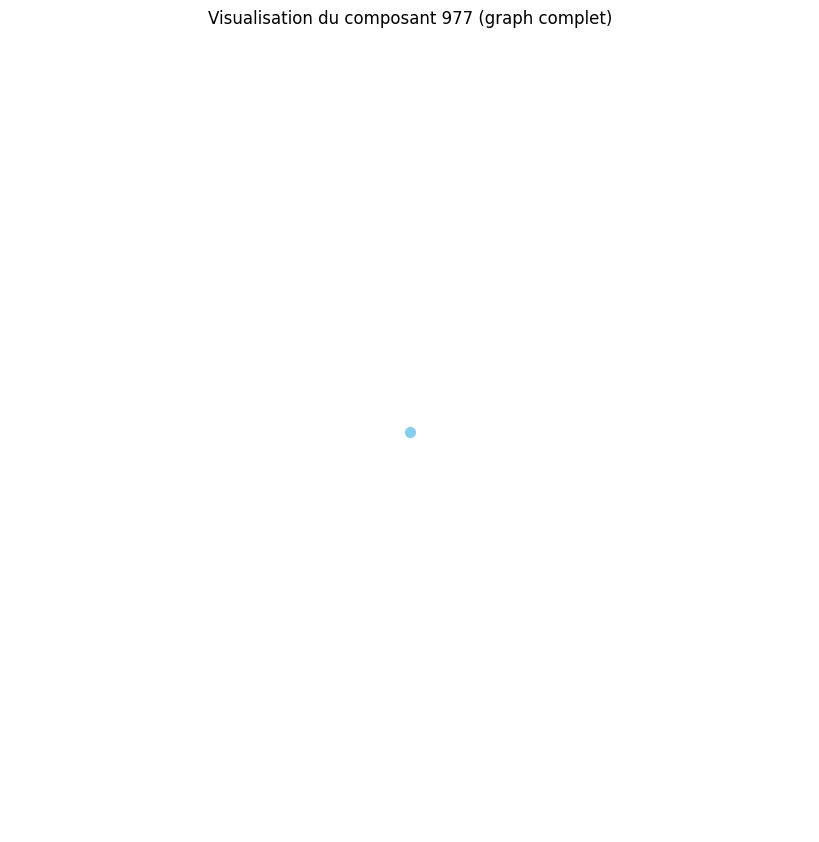

Distance moyenne pour le composant 978 : 0.00
Le composant 978 est un graphe complet ou très densément connecté.
Densité du composant 978 : 0.00
Degré moyen du composant 978 : 0.00
Coefficient de clustering moyen du composant 978 : 0.00


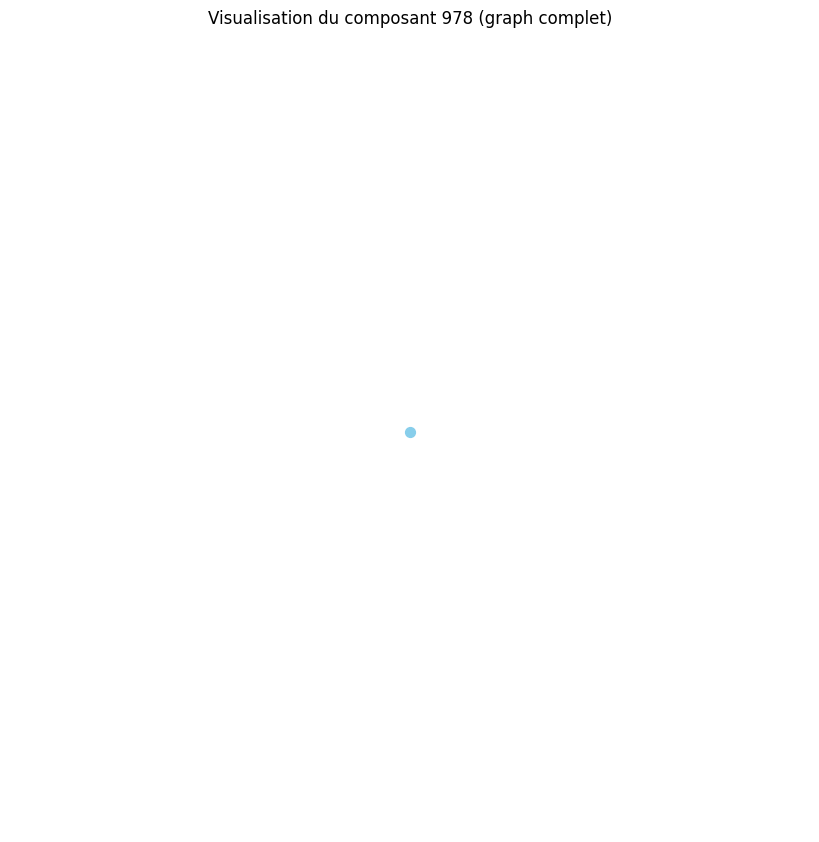

Distance moyenne pour le composant 979 : 0.00
Le composant 979 est un graphe complet ou très densément connecté.
Densité du composant 979 : 0.00
Degré moyen du composant 979 : 0.00
Coefficient de clustering moyen du composant 979 : 0.00


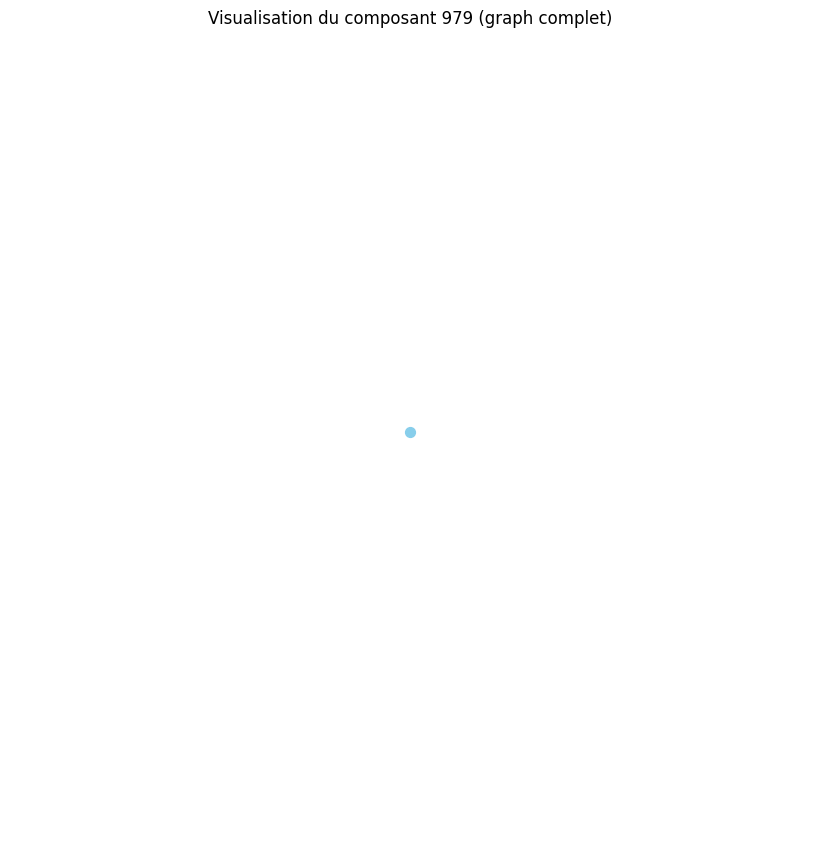

Distance moyenne pour le composant 980 : 0.00
Le composant 980 est un graphe complet ou très densément connecté.
Densité du composant 980 : 0.00
Degré moyen du composant 980 : 0.00
Coefficient de clustering moyen du composant 980 : 0.00


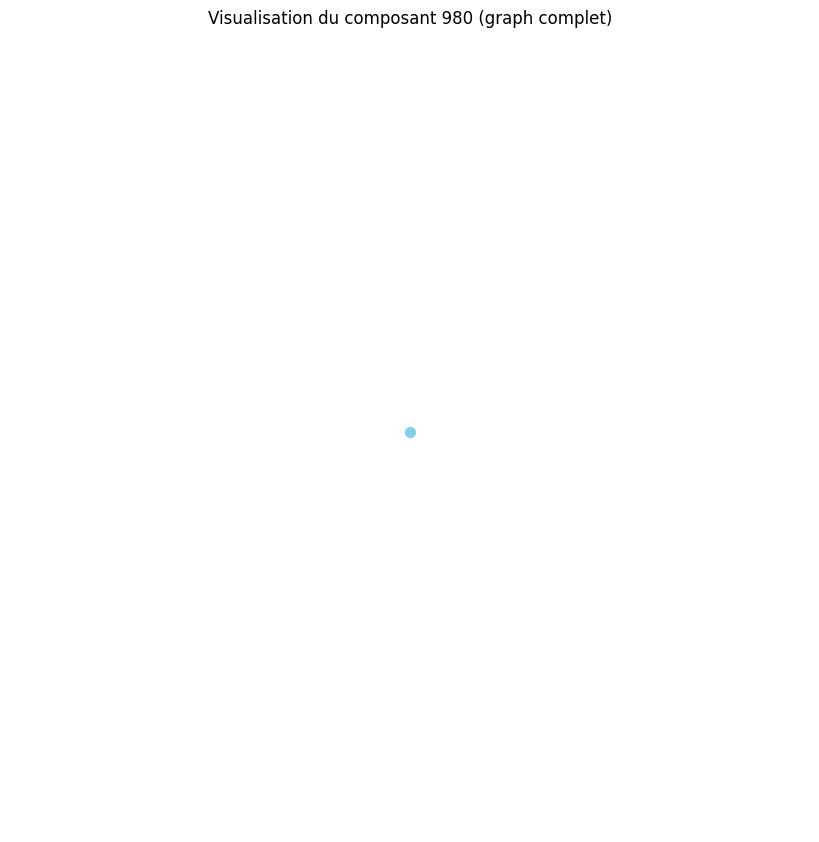

Distance moyenne pour le composant 981 : 0.00
Le composant 981 est un graphe complet ou très densément connecté.
Densité du composant 981 : 0.00
Degré moyen du composant 981 : 0.00
Coefficient de clustering moyen du composant 981 : 0.00


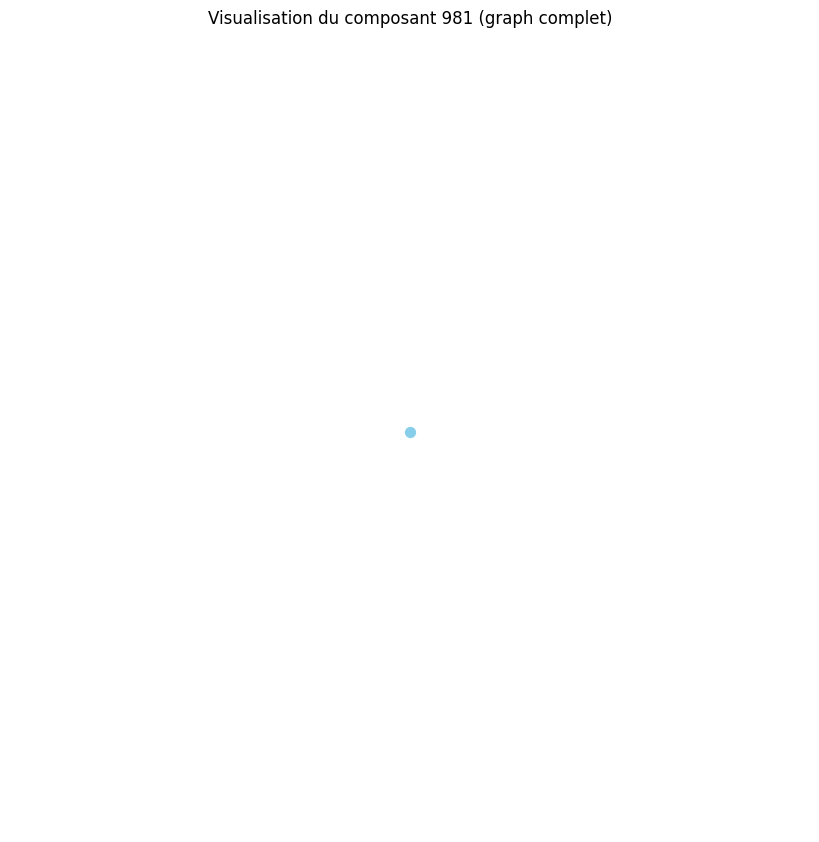

Distance moyenne pour le composant 982 : 0.00
Le composant 982 est un graphe complet ou très densément connecté.
Densité du composant 982 : 0.00
Degré moyen du composant 982 : 0.00
Coefficient de clustering moyen du composant 982 : 0.00


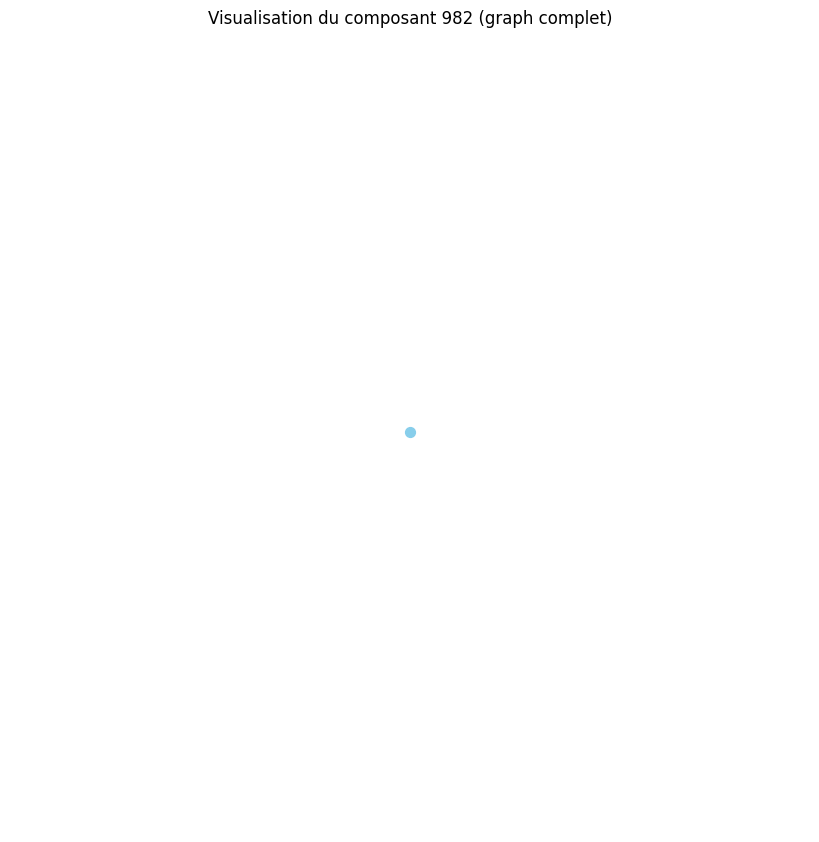

Distance moyenne pour le composant 983 : 0.00
Le composant 983 est un graphe complet ou très densément connecté.
Densité du composant 983 : 0.00
Degré moyen du composant 983 : 0.00
Coefficient de clustering moyen du composant 983 : 0.00


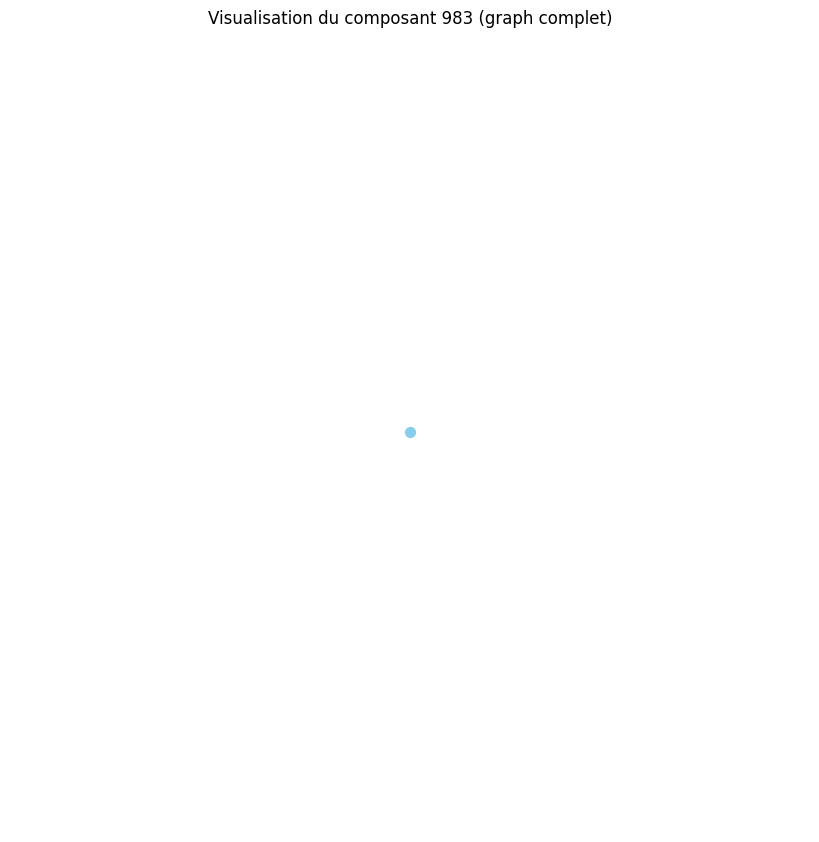

Distance moyenne pour le composant 984 : 0.00
Le composant 984 est un graphe complet ou très densément connecté.
Densité du composant 984 : 0.00
Degré moyen du composant 984 : 0.00
Coefficient de clustering moyen du composant 984 : 0.00


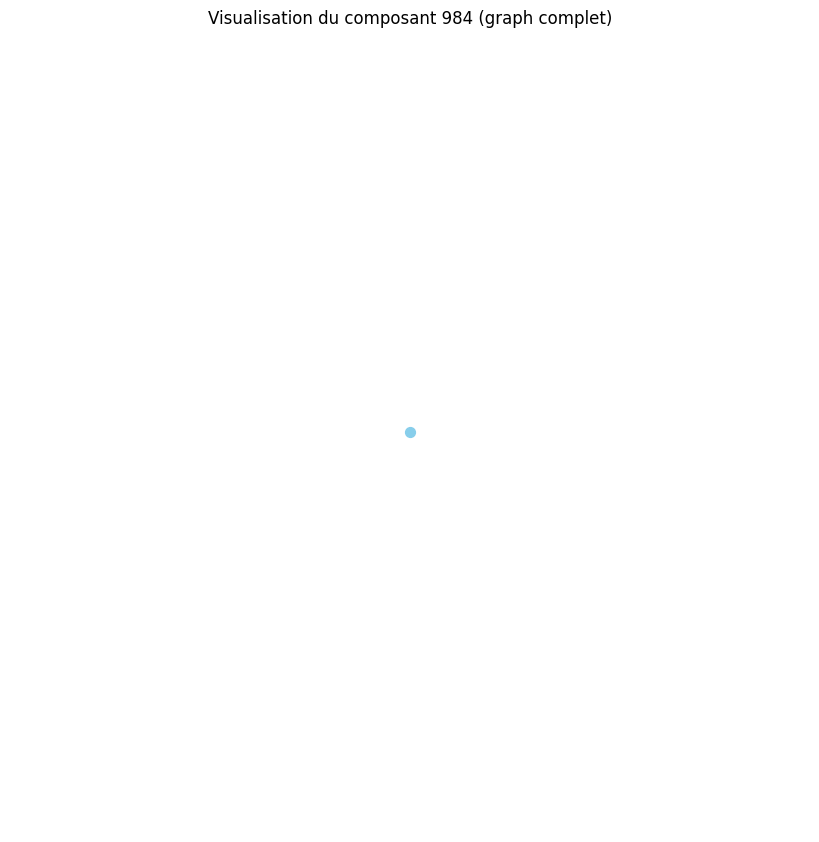

Distance moyenne pour le composant 985 : 0.00
Le composant 985 est un graphe complet ou très densément connecté.
Densité du composant 985 : 0.00
Degré moyen du composant 985 : 0.00
Coefficient de clustering moyen du composant 985 : 0.00


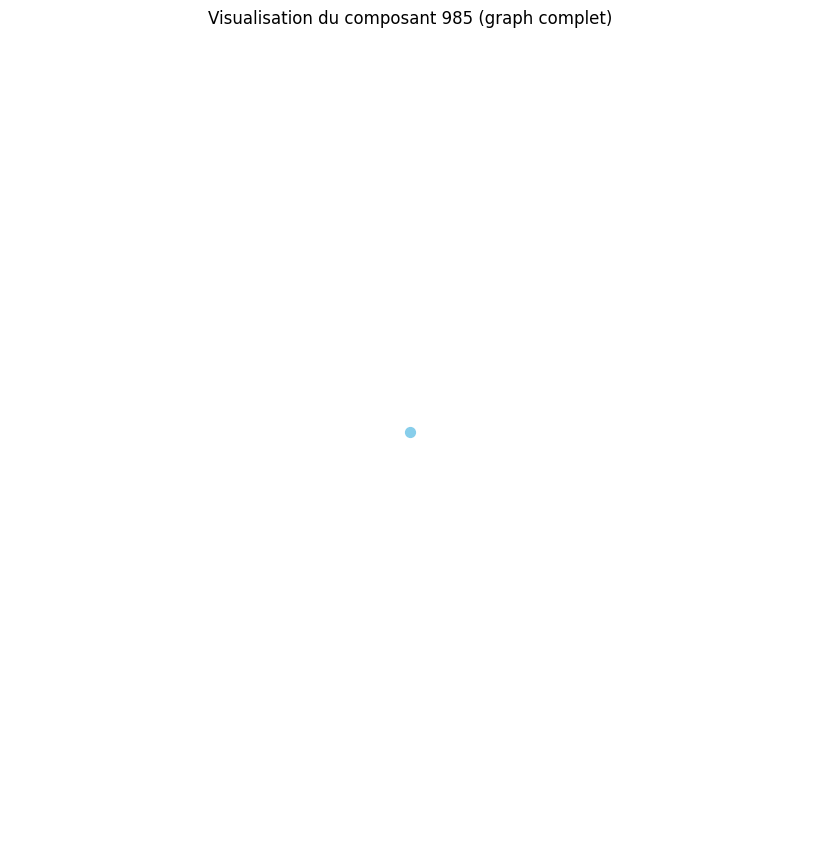

Distance moyenne pour le composant 986 : 0.00
Le composant 986 est un graphe complet ou très densément connecté.
Densité du composant 986 : 0.00
Degré moyen du composant 986 : 0.00
Coefficient de clustering moyen du composant 986 : 0.00


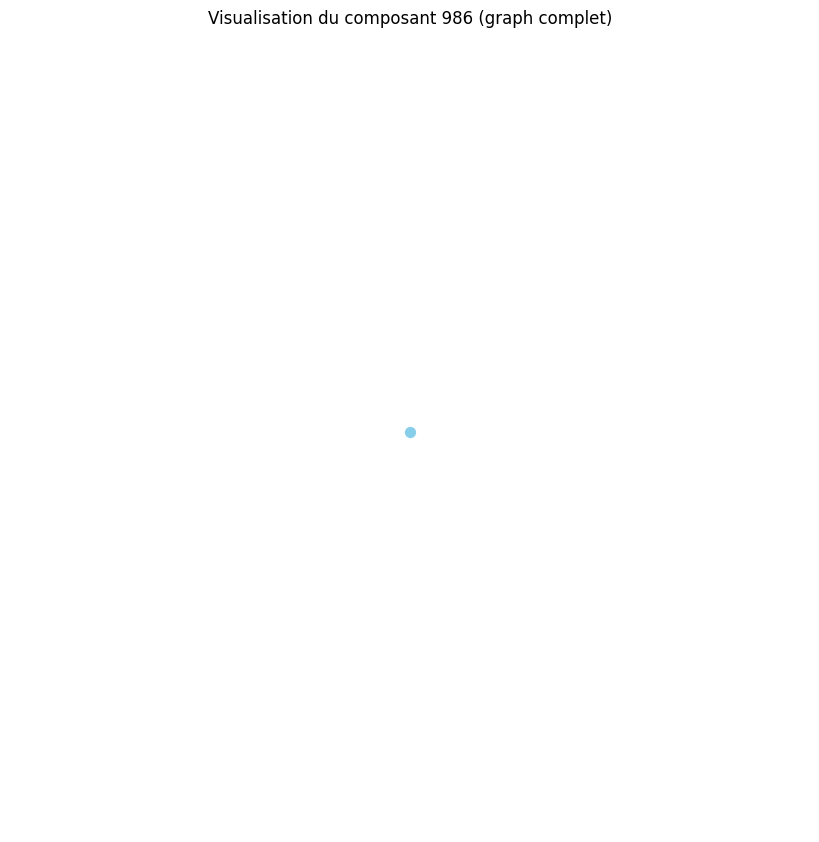

Distance moyenne pour le composant 987 : 0.00
Le composant 987 est un graphe complet ou très densément connecté.
Densité du composant 987 : 0.00
Degré moyen du composant 987 : 0.00
Coefficient de clustering moyen du composant 987 : 0.00


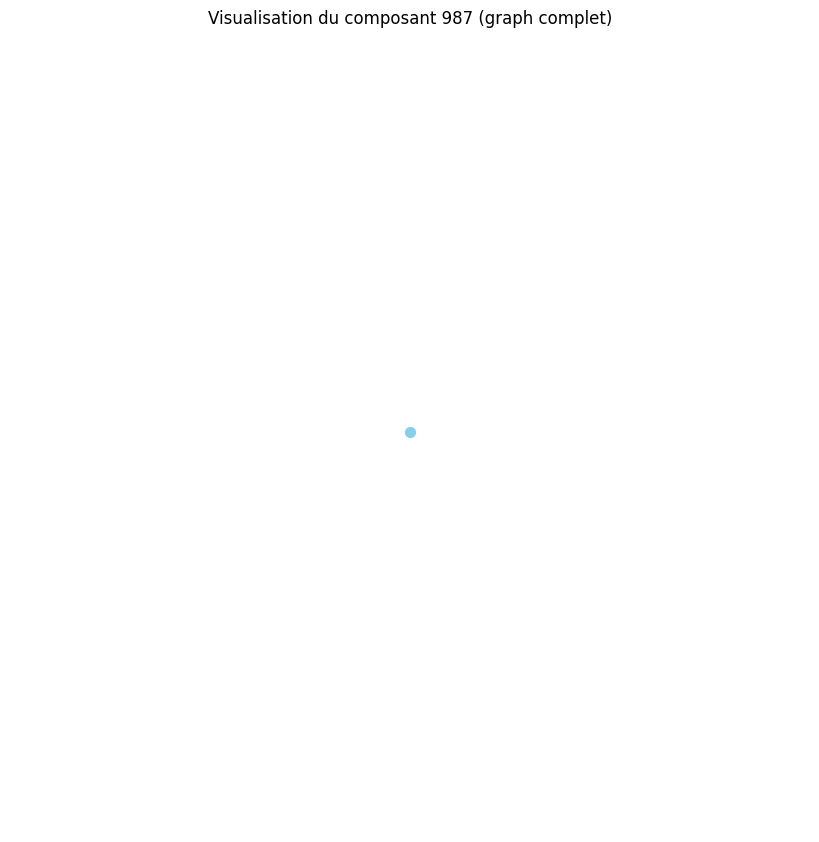

Distance moyenne pour le composant 988 : 0.00
Le composant 988 est un graphe complet ou très densément connecté.
Densité du composant 988 : 0.00
Degré moyen du composant 988 : 0.00
Coefficient de clustering moyen du composant 988 : 0.00


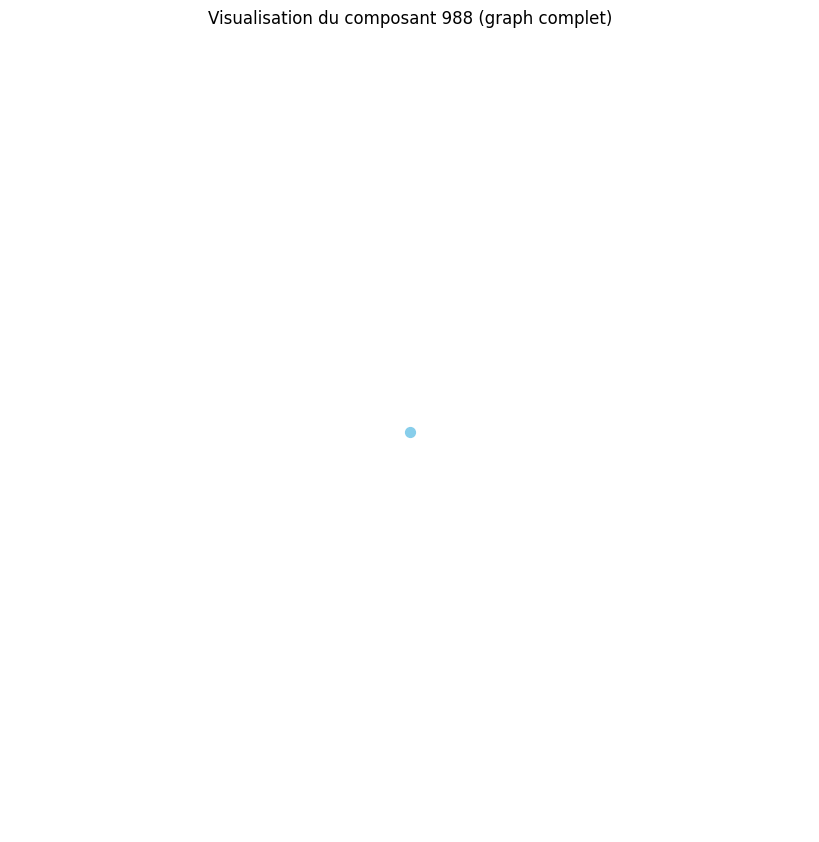

Distance moyenne pour le composant 989 : 0.00
Le composant 989 est un graphe complet ou très densément connecté.
Densité du composant 989 : 0.00
Degré moyen du composant 989 : 0.00
Coefficient de clustering moyen du composant 989 : 0.00


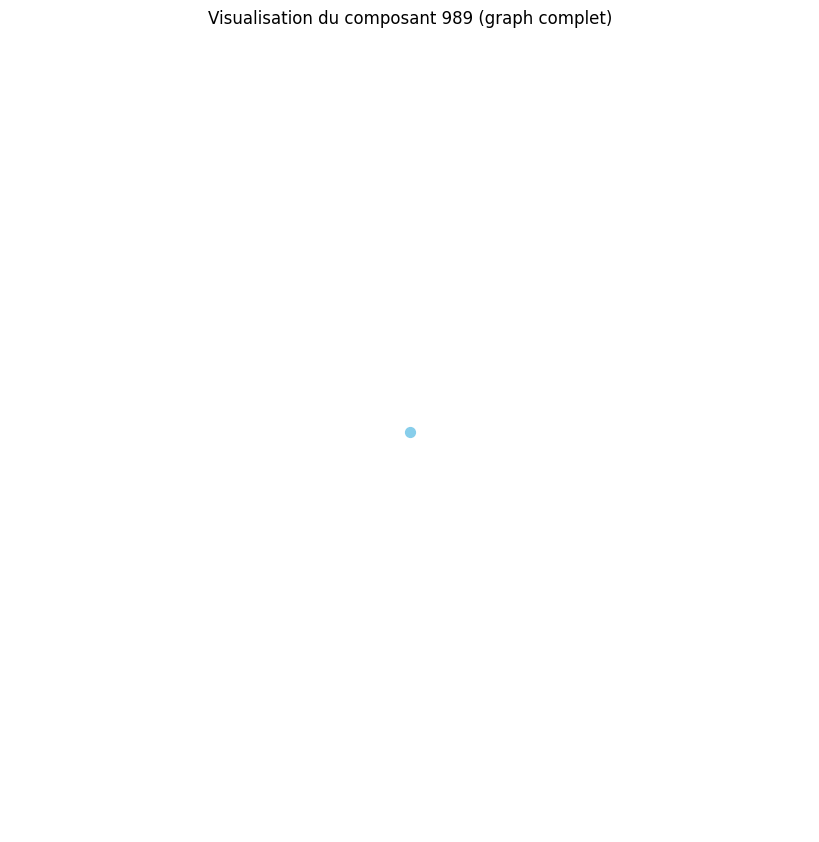

Distance moyenne pour le composant 990 : 0.00
Le composant 990 est un graphe complet ou très densément connecté.
Densité du composant 990 : 0.00
Degré moyen du composant 990 : 0.00
Coefficient de clustering moyen du composant 990 : 0.00


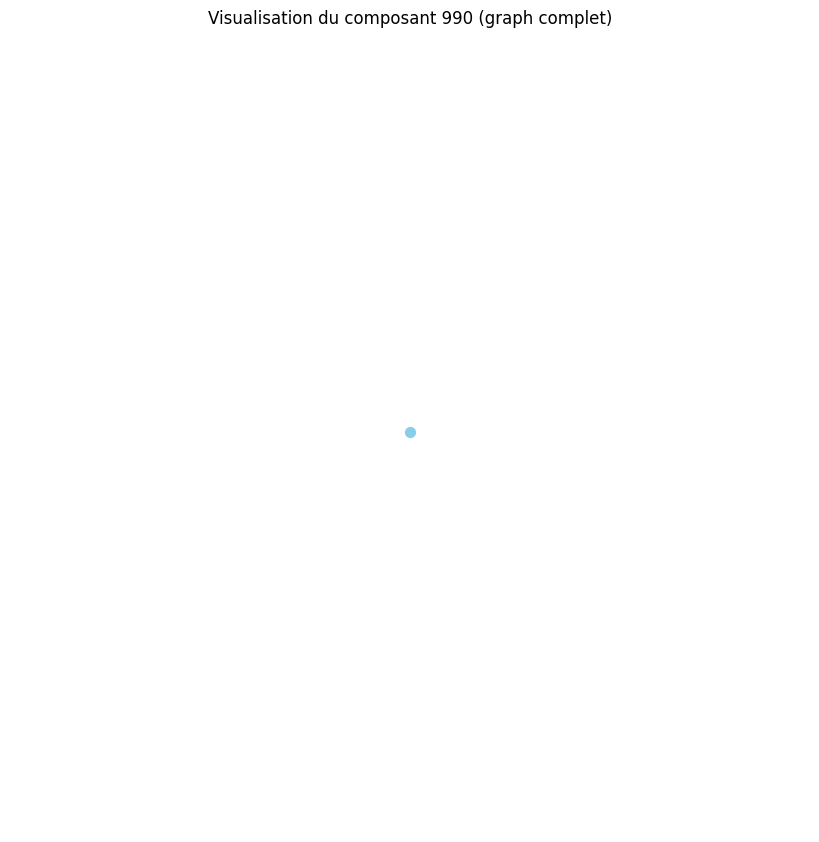

Distance moyenne pour le composant 991 : 0.00
Le composant 991 est un graphe complet ou très densément connecté.
Densité du composant 991 : 0.00
Degré moyen du composant 991 : 0.00
Coefficient de clustering moyen du composant 991 : 0.00


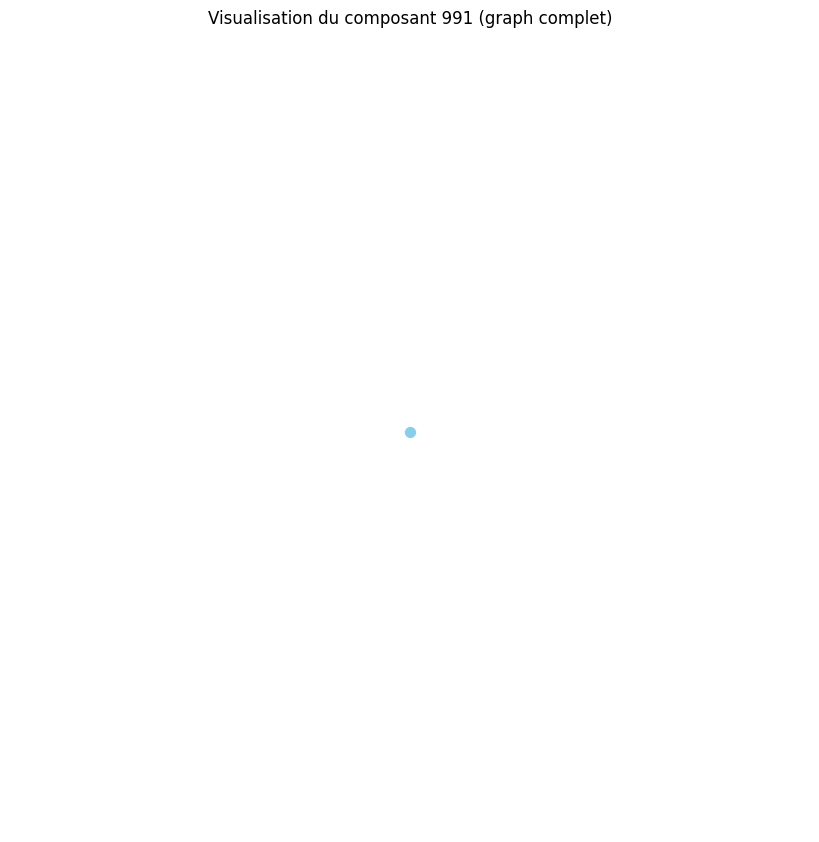

Distance moyenne pour le composant 992 : 0.00
Le composant 992 est un graphe complet ou très densément connecté.
Densité du composant 992 : 0.00
Degré moyen du composant 992 : 0.00
Coefficient de clustering moyen du composant 992 : 0.00


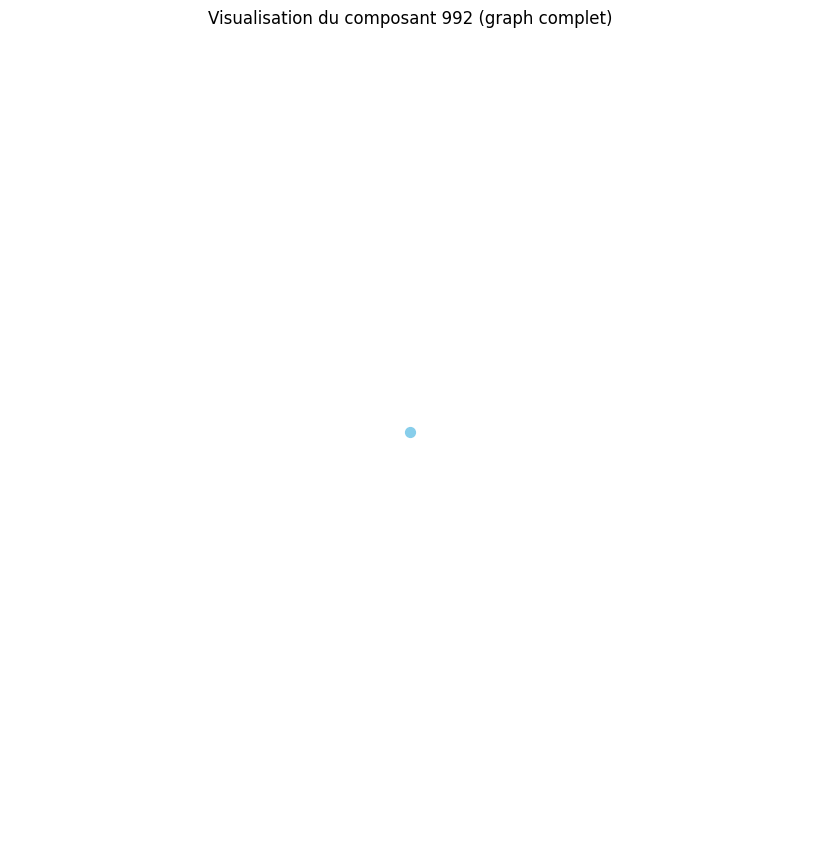

Distance moyenne pour le composant 993 : 0.00
Le composant 993 est un graphe complet ou très densément connecté.
Densité du composant 993 : 0.00
Degré moyen du composant 993 : 0.00
Coefficient de clustering moyen du composant 993 : 0.00


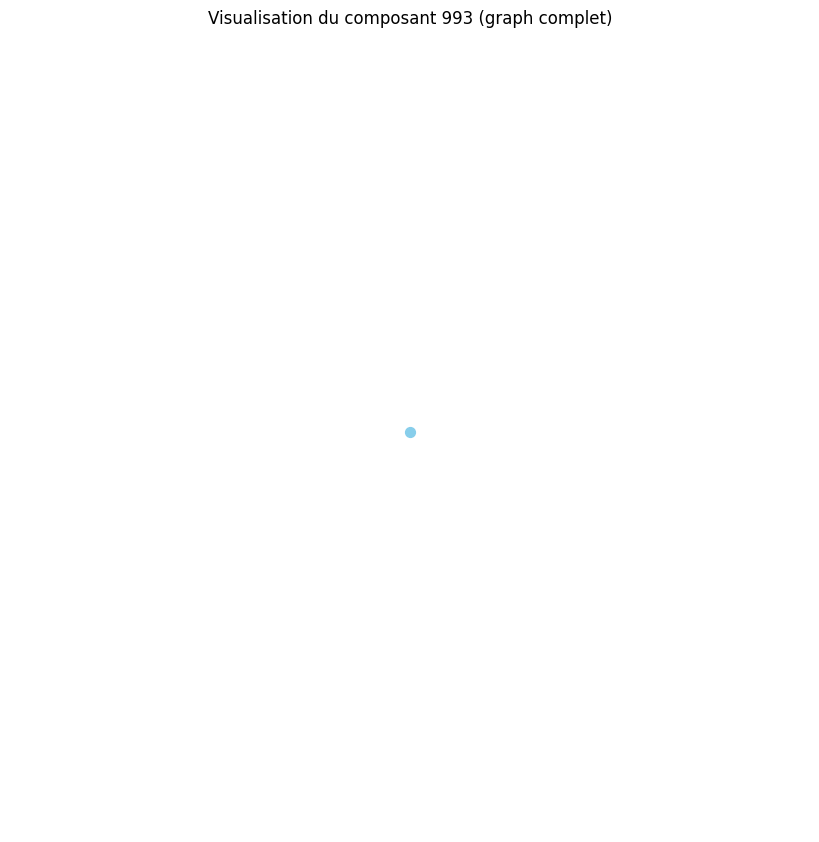

Distance moyenne pour le composant 994 : 0.00
Le composant 994 est un graphe complet ou très densément connecté.
Densité du composant 994 : 0.00
Degré moyen du composant 994 : 0.00
Coefficient de clustering moyen du composant 994 : 0.00


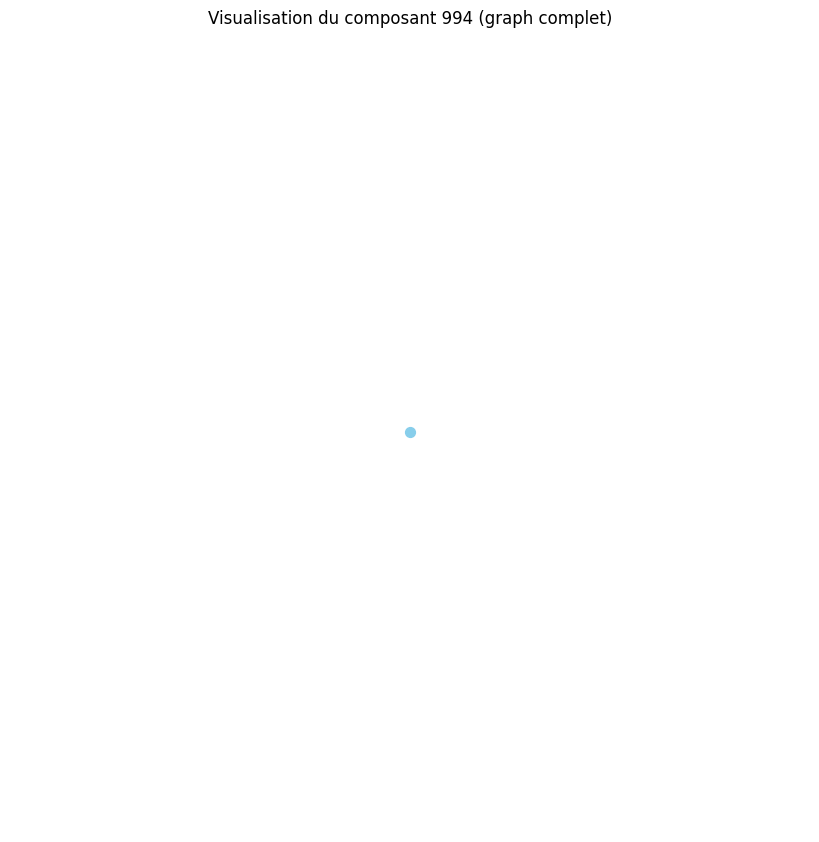

Distance moyenne pour le composant 995 : 0.00
Le composant 995 est un graphe complet ou très densément connecté.
Densité du composant 995 : 0.00
Degré moyen du composant 995 : 0.00
Coefficient de clustering moyen du composant 995 : 0.00


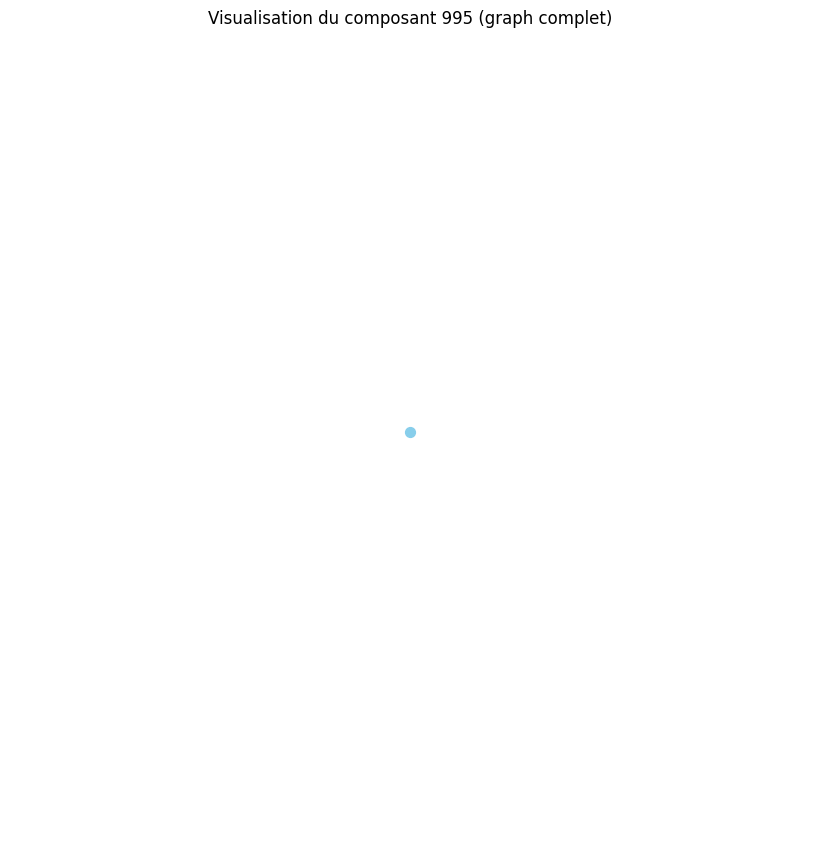

Distance moyenne pour le composant 996 : 0.00
Le composant 996 est un graphe complet ou très densément connecté.
Densité du composant 996 : 0.00
Degré moyen du composant 996 : 0.00
Coefficient de clustering moyen du composant 996 : 0.00


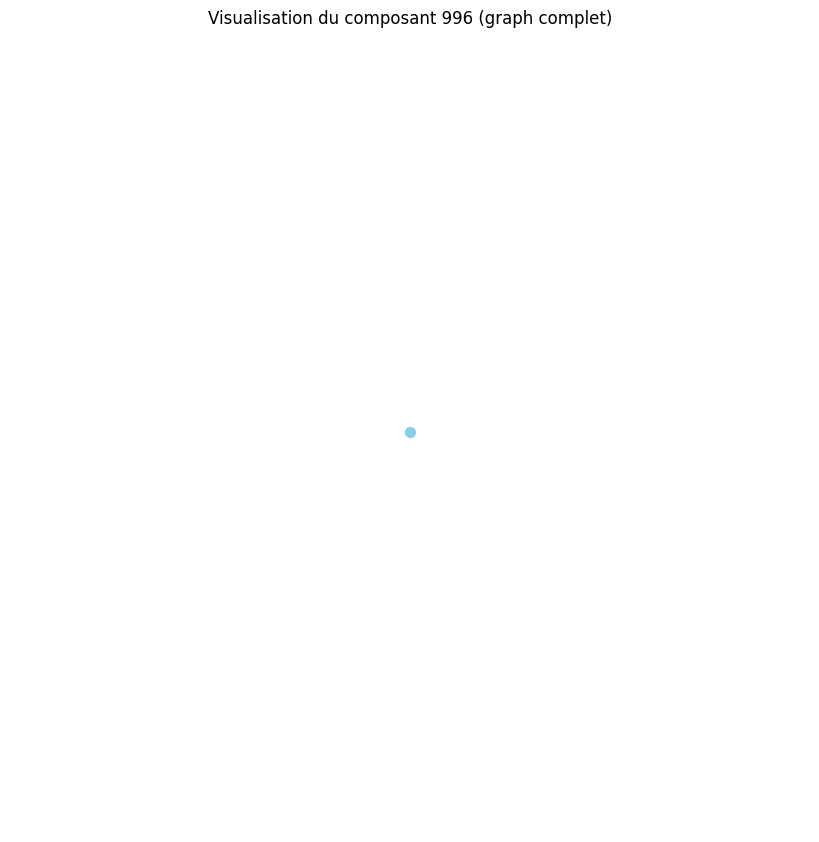

Distance moyenne pour le composant 997 : 0.00
Le composant 997 est un graphe complet ou très densément connecté.
Densité du composant 997 : 0.00
Degré moyen du composant 997 : 0.00
Coefficient de clustering moyen du composant 997 : 0.00


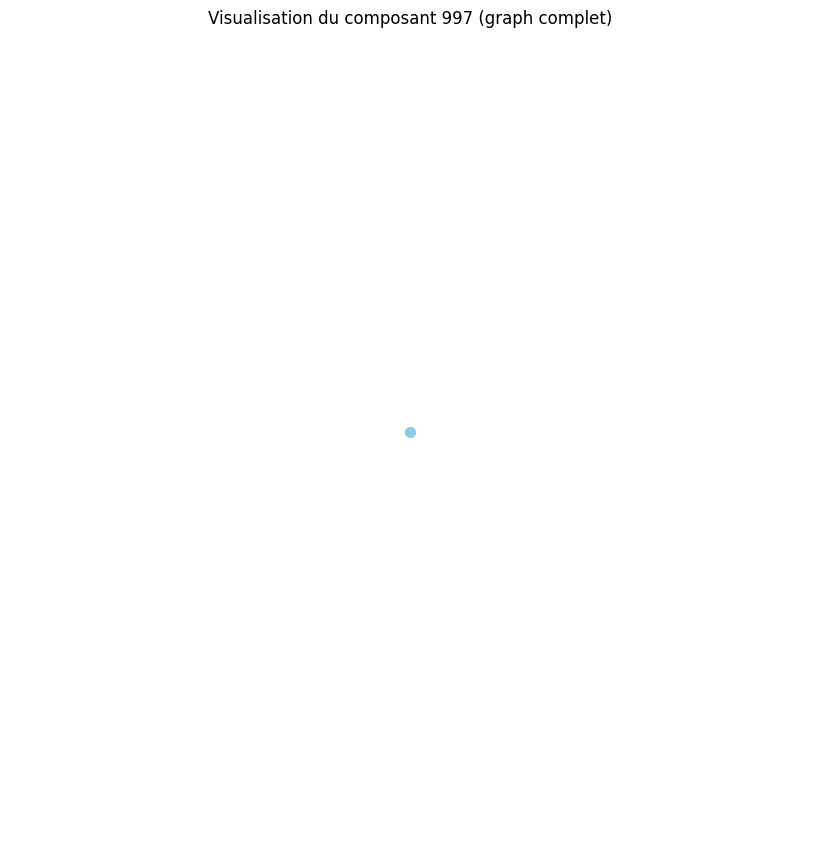

Distance moyenne pour le composant 998 : 0.00
Le composant 998 est un graphe complet ou très densément connecté.
Densité du composant 998 : 0.00
Degré moyen du composant 998 : 0.00
Coefficient de clustering moyen du composant 998 : 0.00


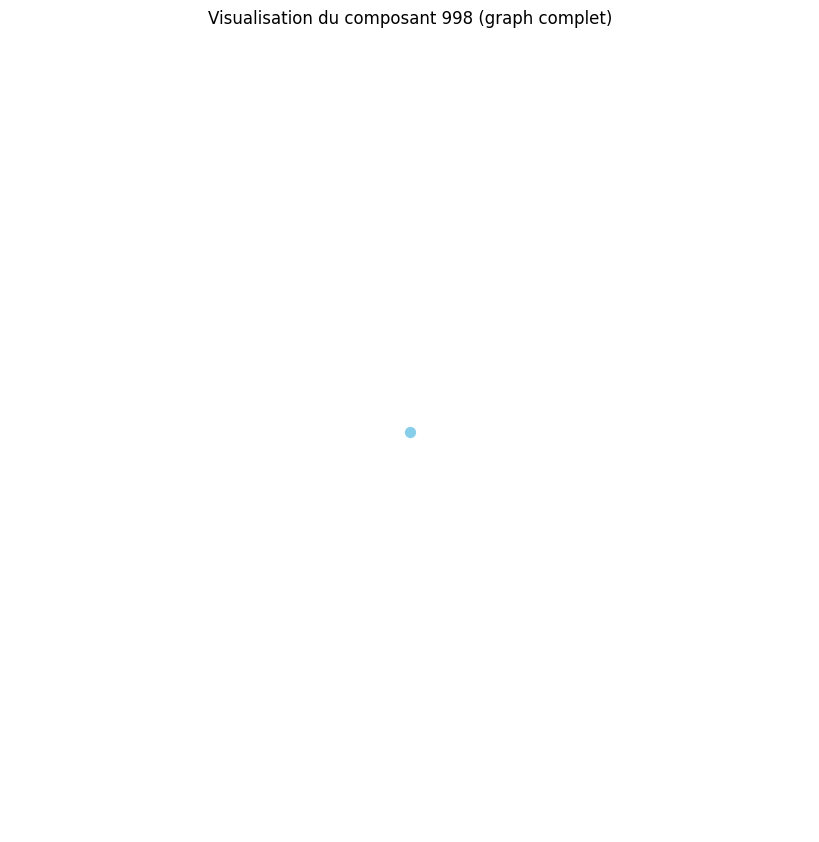

Distance moyenne pour le composant 999 : 0.00
Le composant 999 est un graphe complet ou très densément connecté.
Densité du composant 999 : 0.00
Degré moyen du composant 999 : 0.00
Coefficient de clustering moyen du composant 999 : 0.00


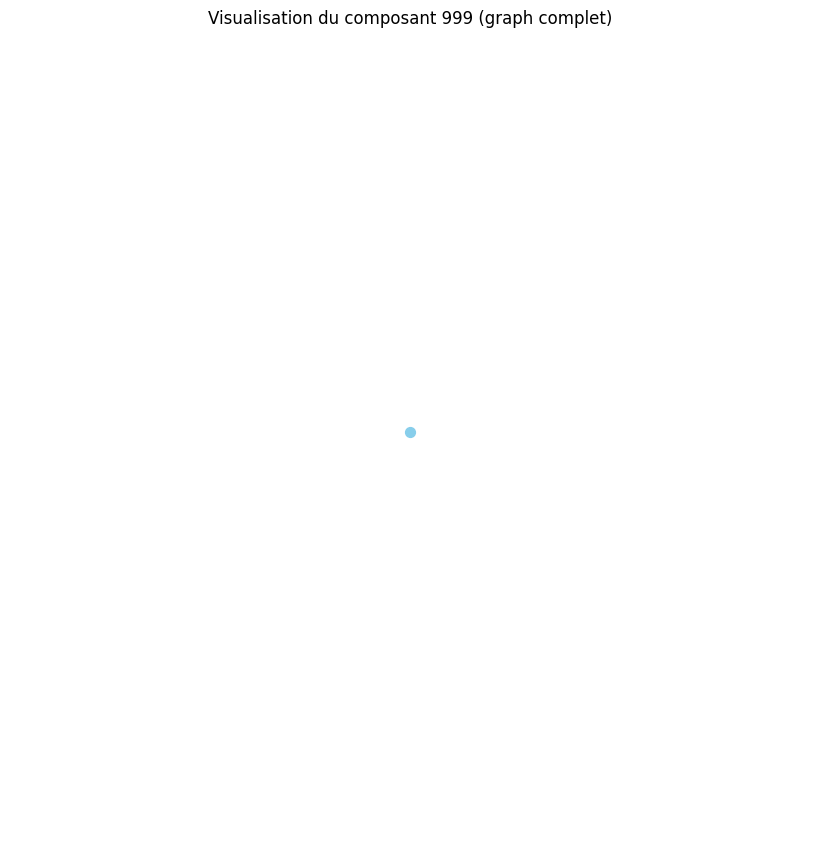

Distance moyenne pour le composant 1000 : 0.00
Le composant 1000 est un graphe complet ou très densément connecté.
Densité du composant 1000 : 0.00
Degré moyen du composant 1000 : 0.00
Coefficient de clustering moyen du composant 1000 : 0.00


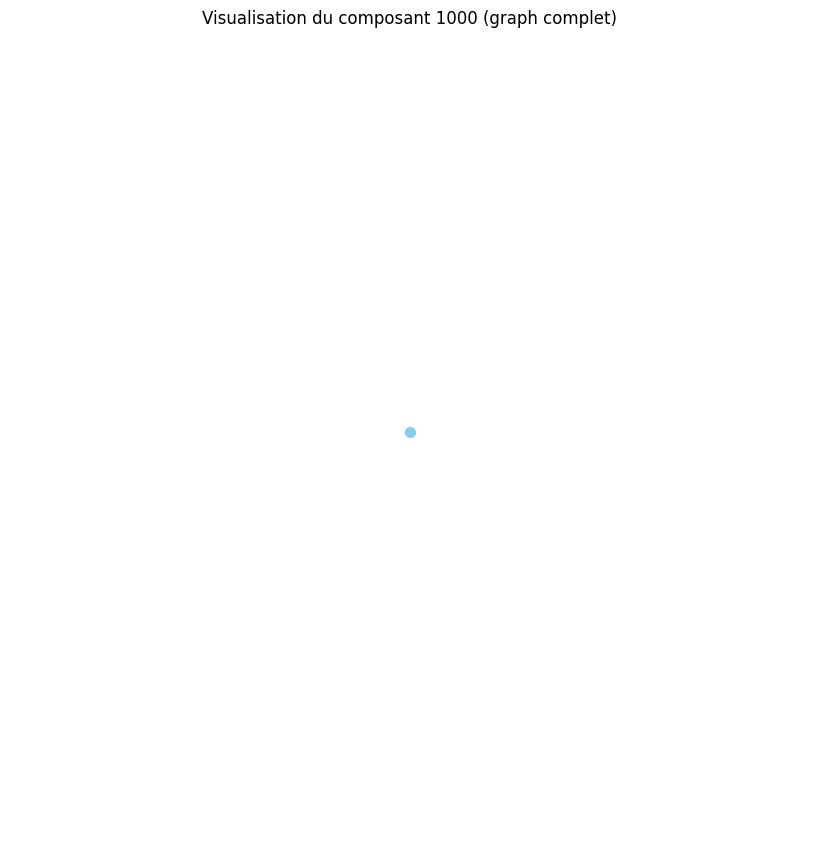

Distance moyenne pour le composant 1001 : 0.00
Le composant 1001 est un graphe complet ou très densément connecté.
Densité du composant 1001 : 0.00
Degré moyen du composant 1001 : 0.00
Coefficient de clustering moyen du composant 1001 : 0.00


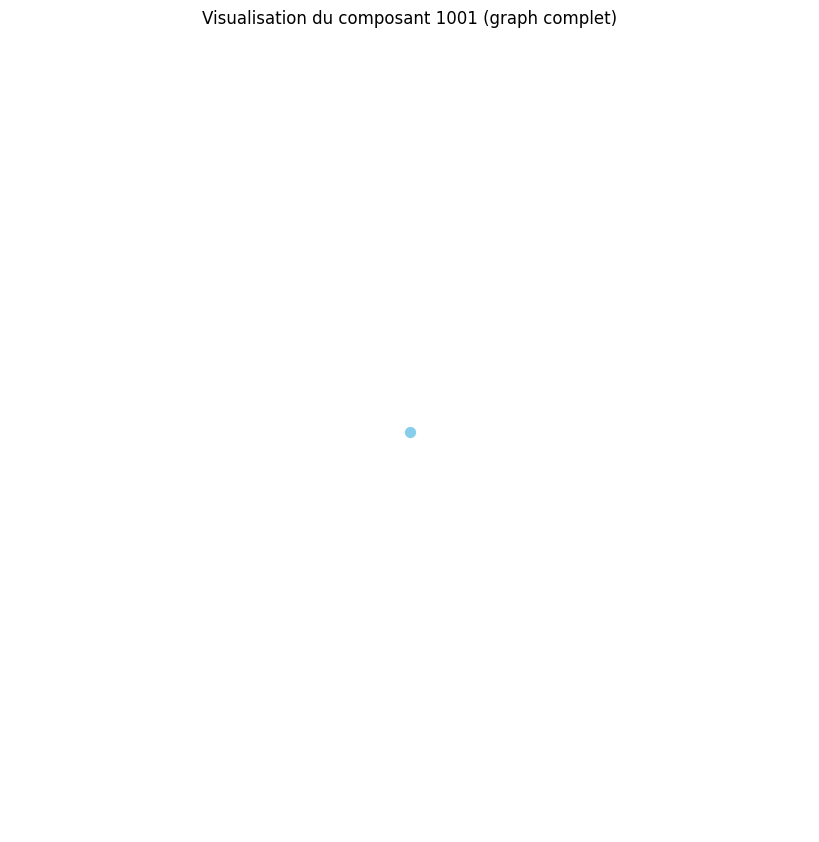

Distance moyenne pour le composant 1002 : 0.00
Le composant 1002 est un graphe complet ou très densément connecté.
Densité du composant 1002 : 0.00
Degré moyen du composant 1002 : 0.00
Coefficient de clustering moyen du composant 1002 : 0.00


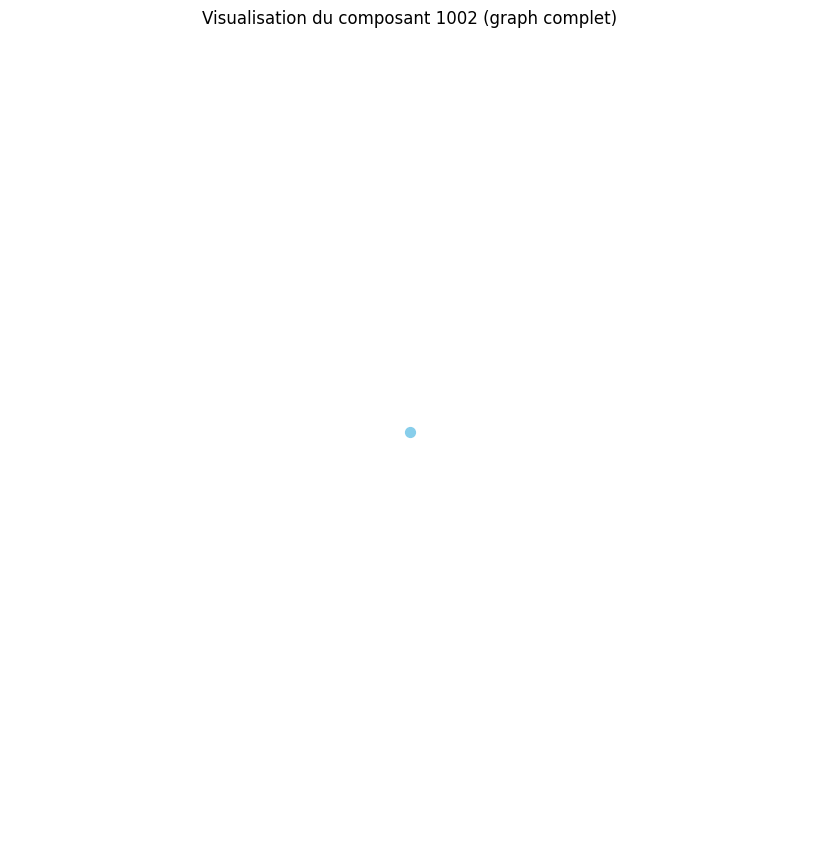

Distance moyenne pour le composant 1003 : 0.00
Le composant 1003 est un graphe complet ou très densément connecté.
Densité du composant 1003 : 0.00
Degré moyen du composant 1003 : 0.00
Coefficient de clustering moyen du composant 1003 : 0.00


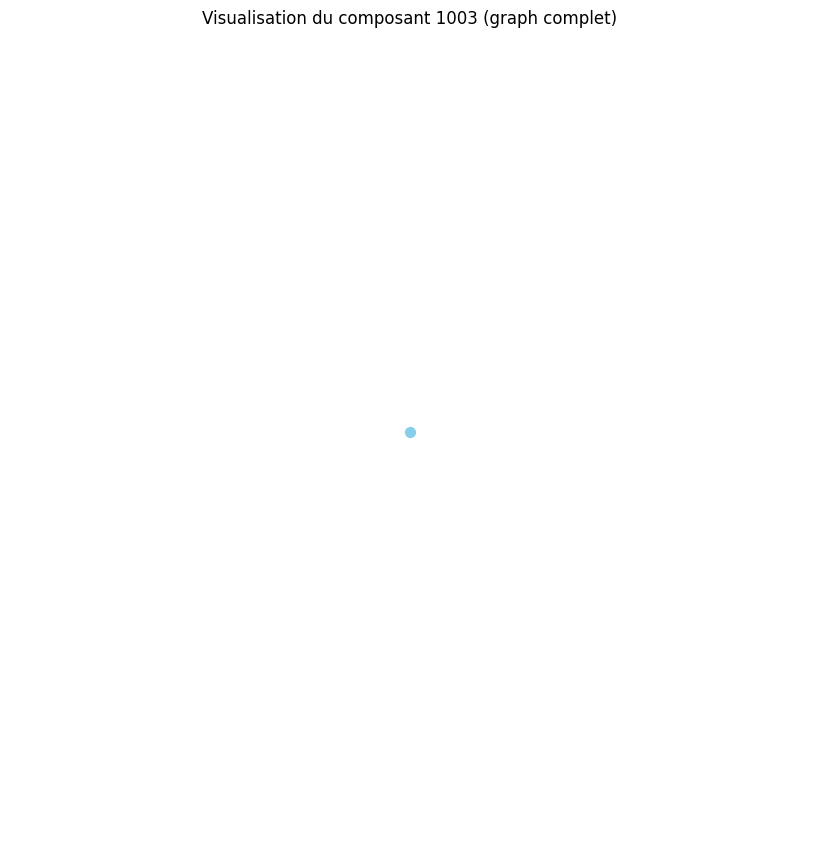

Distance moyenne pour le composant 1004 : 0.00
Le composant 1004 est un graphe complet ou très densément connecté.
Densité du composant 1004 : 0.00
Degré moyen du composant 1004 : 0.00
Coefficient de clustering moyen du composant 1004 : 0.00


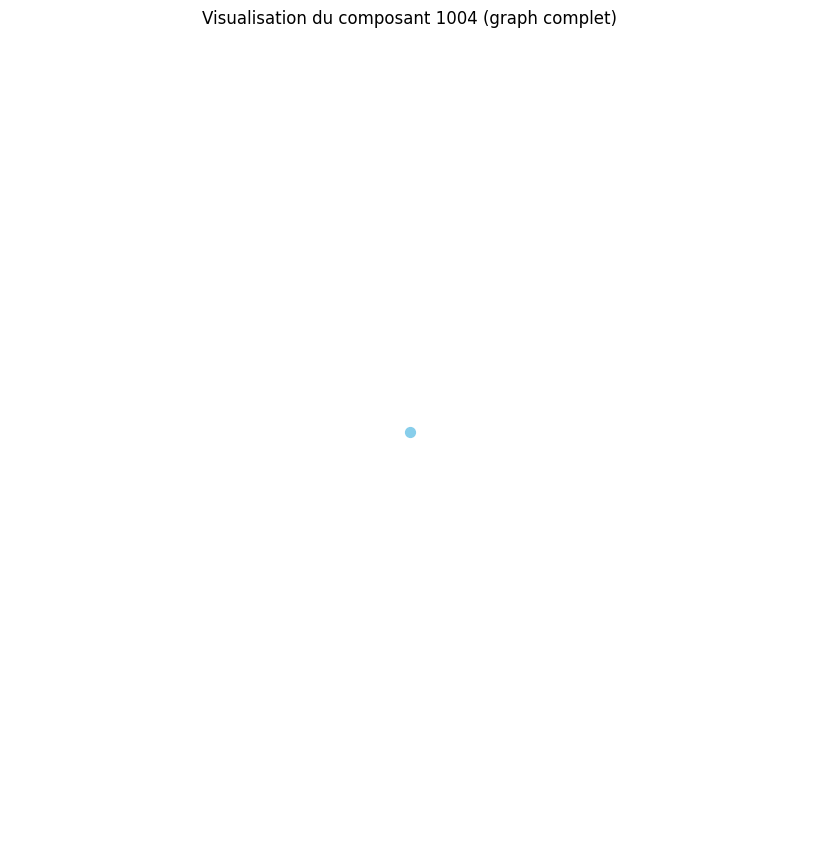

Distance moyenne pour le composant 1005 : 0.00
Le composant 1005 est un graphe complet ou très densément connecté.
Densité du composant 1005 : 0.00
Degré moyen du composant 1005 : 0.00
Coefficient de clustering moyen du composant 1005 : 0.00


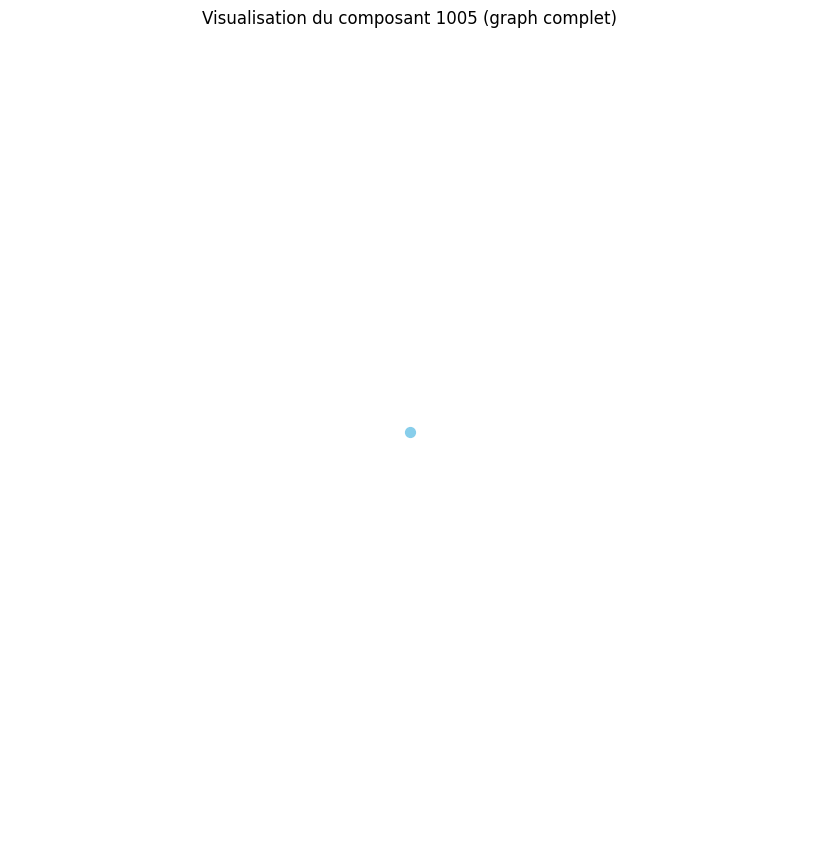

Distance moyenne pour le composant 1006 : 0.00
Le composant 1006 est un graphe complet ou très densément connecté.
Densité du composant 1006 : 0.00
Degré moyen du composant 1006 : 0.00
Coefficient de clustering moyen du composant 1006 : 0.00


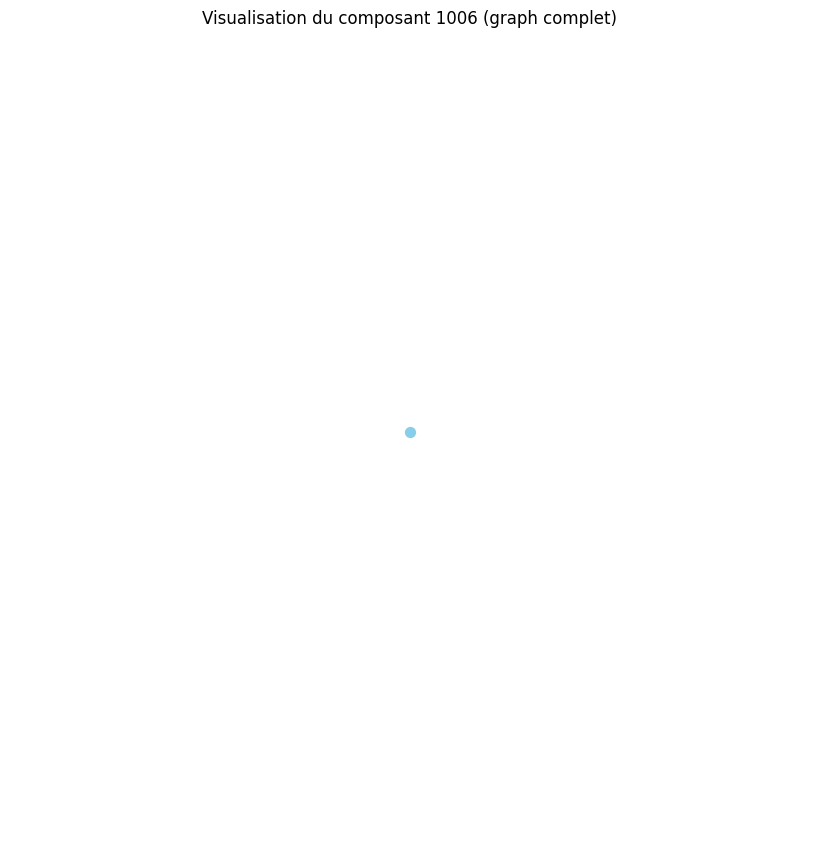

Distance moyenne pour le composant 1007 : 0.00
Le composant 1007 est un graphe complet ou très densément connecté.
Densité du composant 1007 : 0.00
Degré moyen du composant 1007 : 0.00
Coefficient de clustering moyen du composant 1007 : 0.00


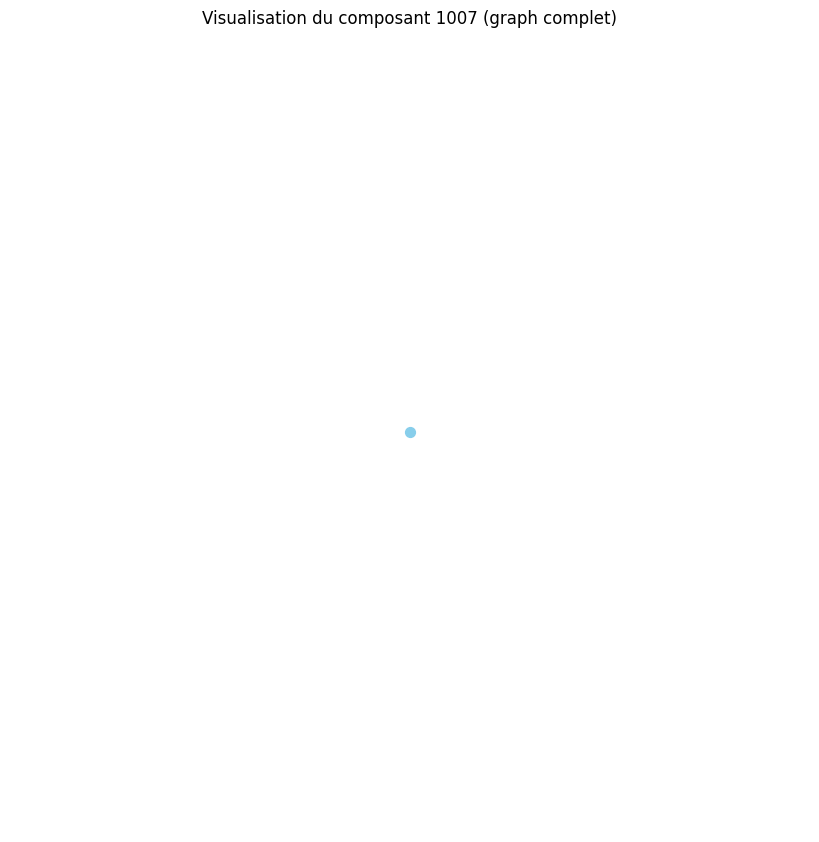

Distance moyenne pour le composant 1008 : 0.00
Le composant 1008 est un graphe complet ou très densément connecté.
Densité du composant 1008 : 0.00
Degré moyen du composant 1008 : 0.00
Coefficient de clustering moyen du composant 1008 : 0.00


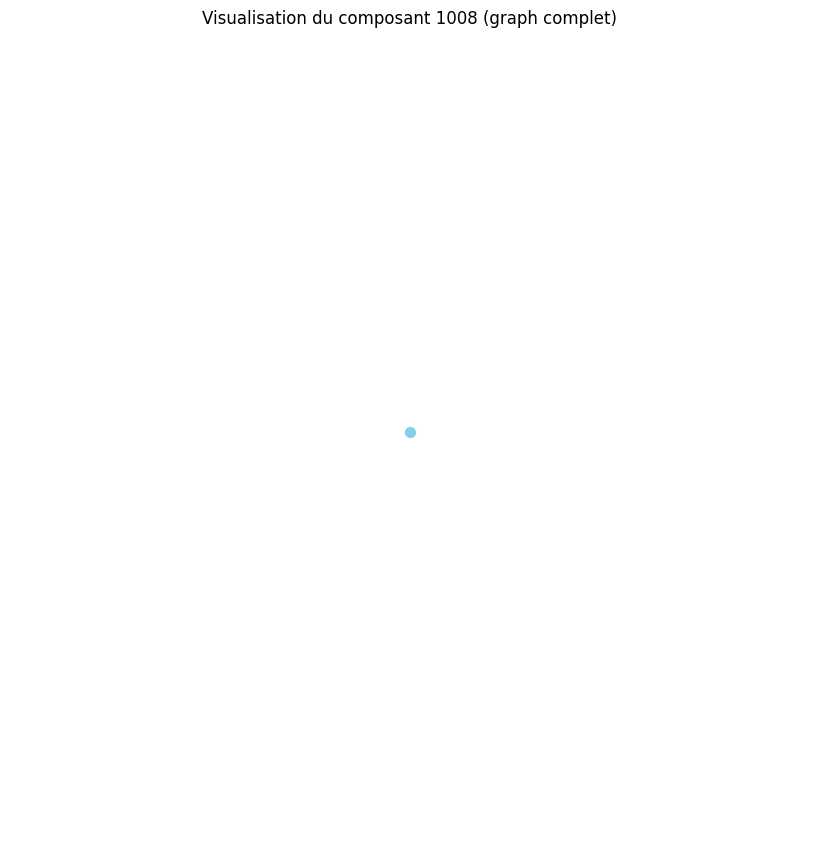

Distance moyenne pour le composant 1009 : 0.00
Le composant 1009 est un graphe complet ou très densément connecté.
Densité du composant 1009 : 0.00
Degré moyen du composant 1009 : 0.00
Coefficient de clustering moyen du composant 1009 : 0.00


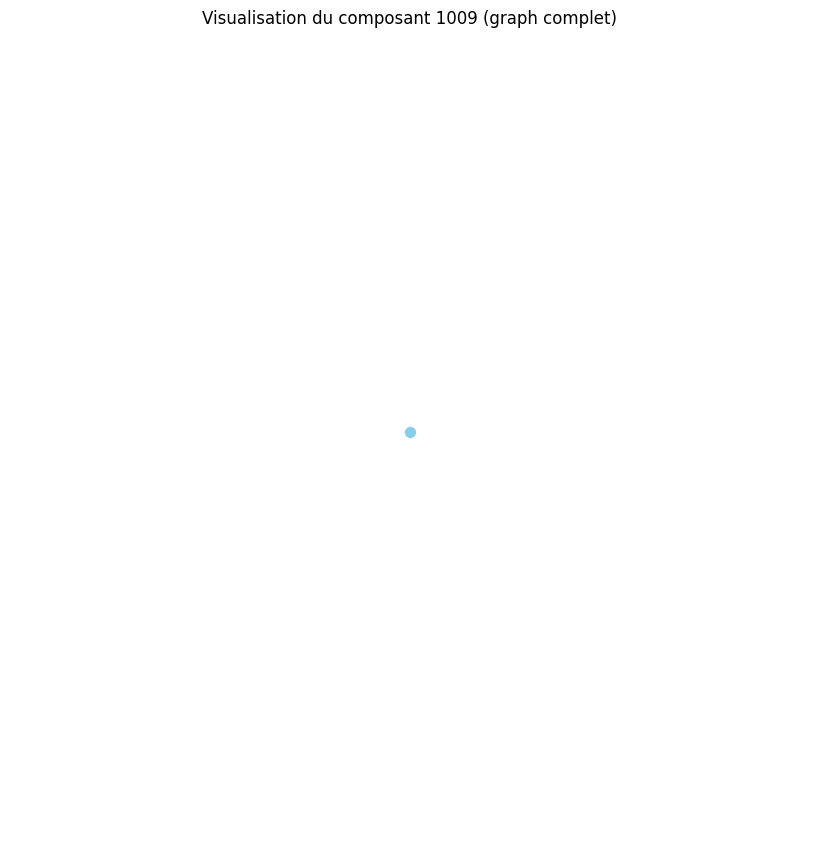

Distance moyenne pour le composant 1010 : 0.00
Le composant 1010 est un graphe complet ou très densément connecté.
Densité du composant 1010 : 0.00
Degré moyen du composant 1010 : 0.00
Coefficient de clustering moyen du composant 1010 : 0.00


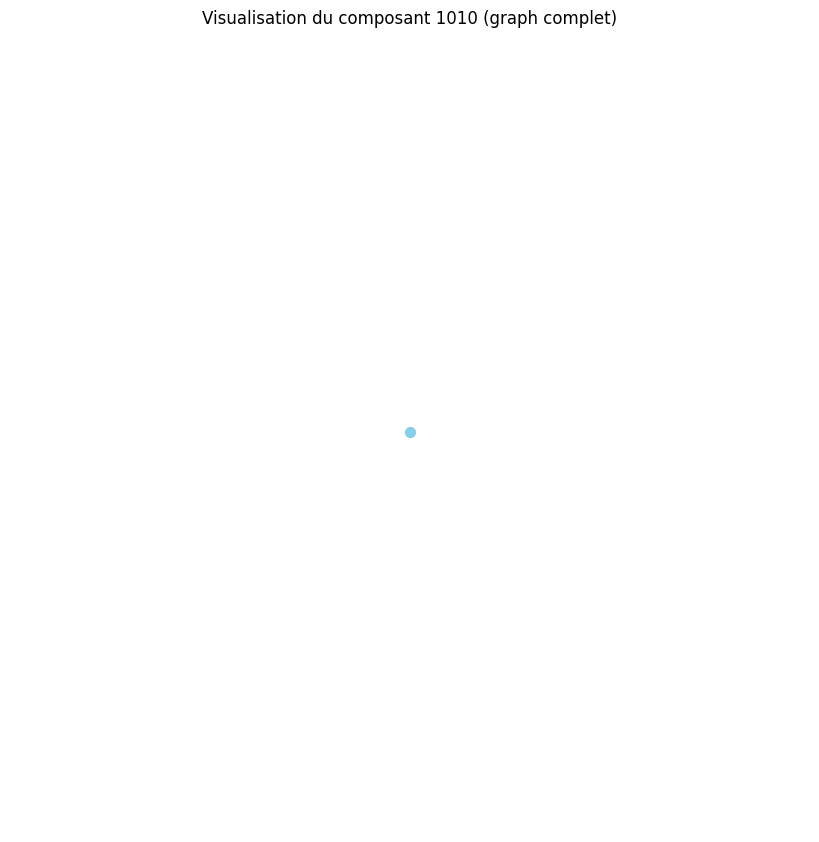

Distance moyenne pour le composant 1011 : 0.00
Le composant 1011 est un graphe complet ou très densément connecté.
Densité du composant 1011 : 0.00
Degré moyen du composant 1011 : 0.00
Coefficient de clustering moyen du composant 1011 : 0.00


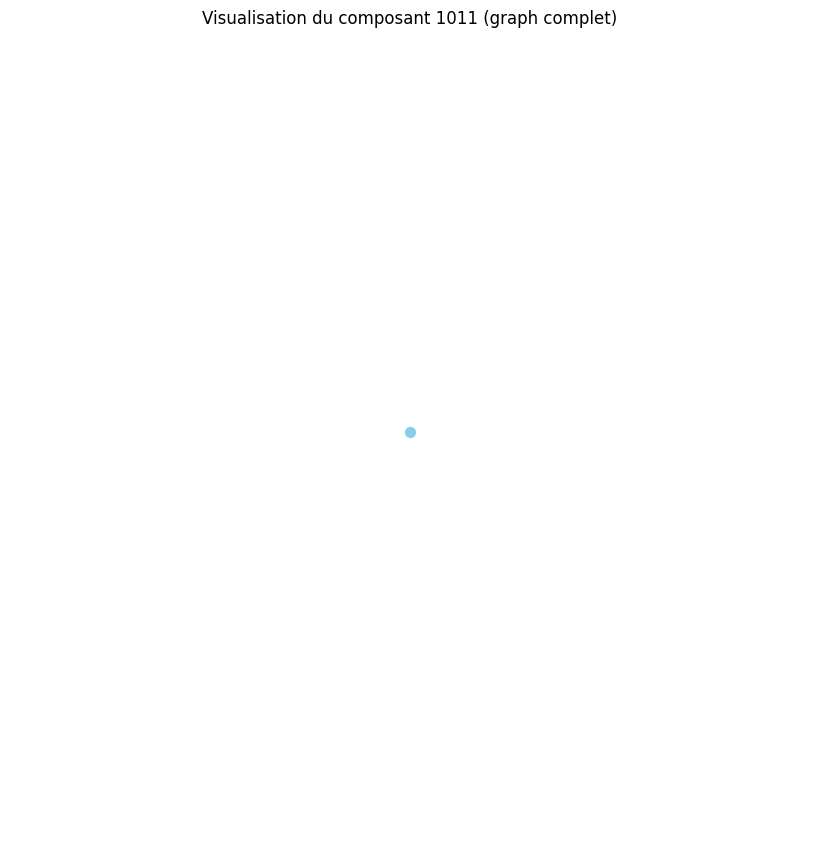

Distance moyenne pour le composant 1012 : 0.00
Le composant 1012 est un graphe complet ou très densément connecté.
Densité du composant 1012 : 0.00
Degré moyen du composant 1012 : 0.00
Coefficient de clustering moyen du composant 1012 : 0.00


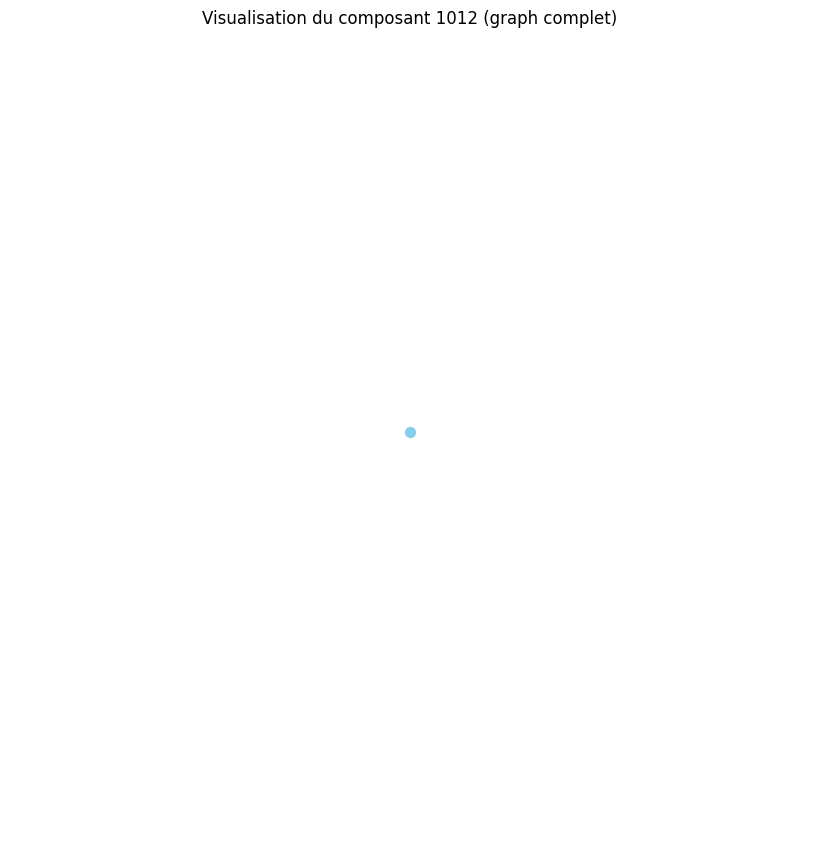

Distance moyenne pour le composant 1013 : 0.00
Le composant 1013 est un graphe complet ou très densément connecté.
Densité du composant 1013 : 0.00
Degré moyen du composant 1013 : 0.00
Coefficient de clustering moyen du composant 1013 : 0.00


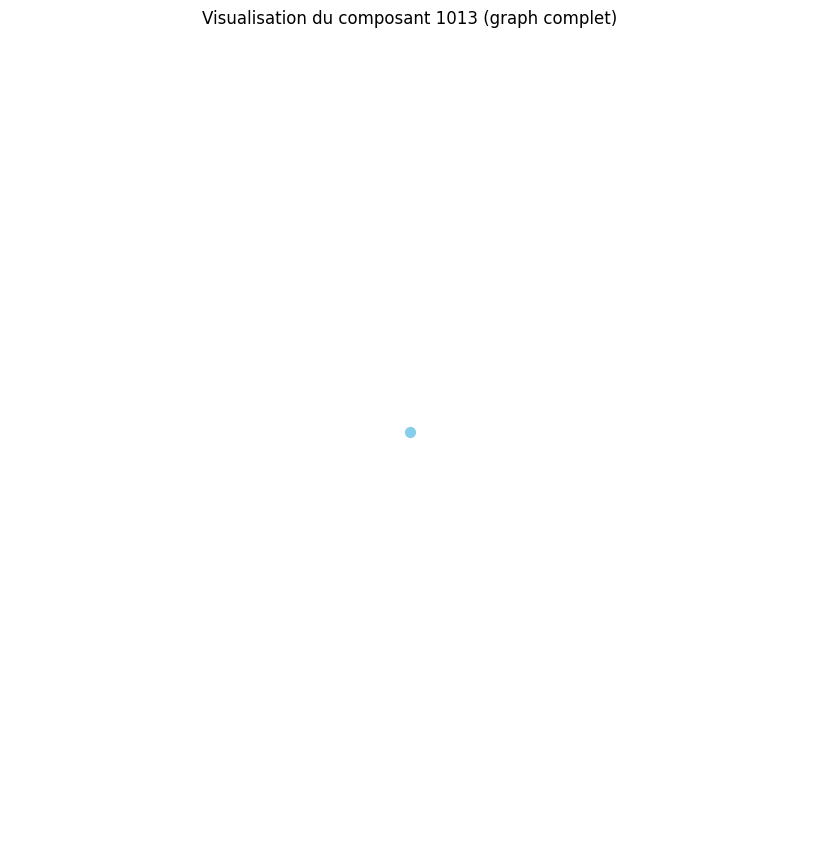

Distance moyenne pour le composant 1014 : 0.00
Le composant 1014 est un graphe complet ou très densément connecté.
Densité du composant 1014 : 0.00
Degré moyen du composant 1014 : 0.00
Coefficient de clustering moyen du composant 1014 : 0.00


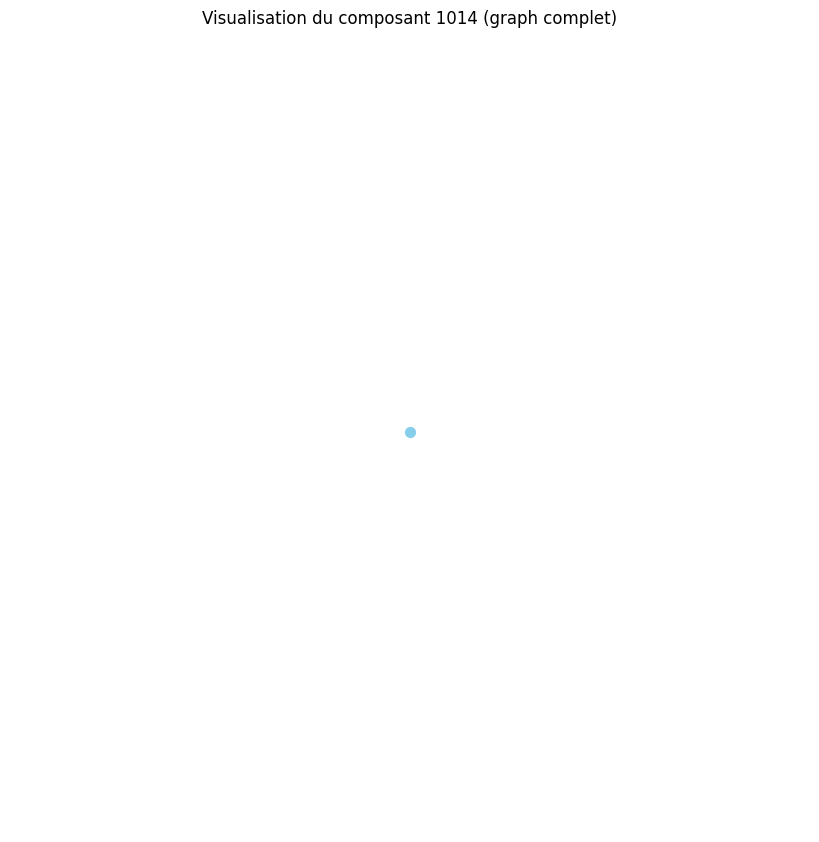

Distance moyenne pour le composant 1015 : 0.00
Le composant 1015 est un graphe complet ou très densément connecté.
Densité du composant 1015 : 0.00
Degré moyen du composant 1015 : 0.00
Coefficient de clustering moyen du composant 1015 : 0.00


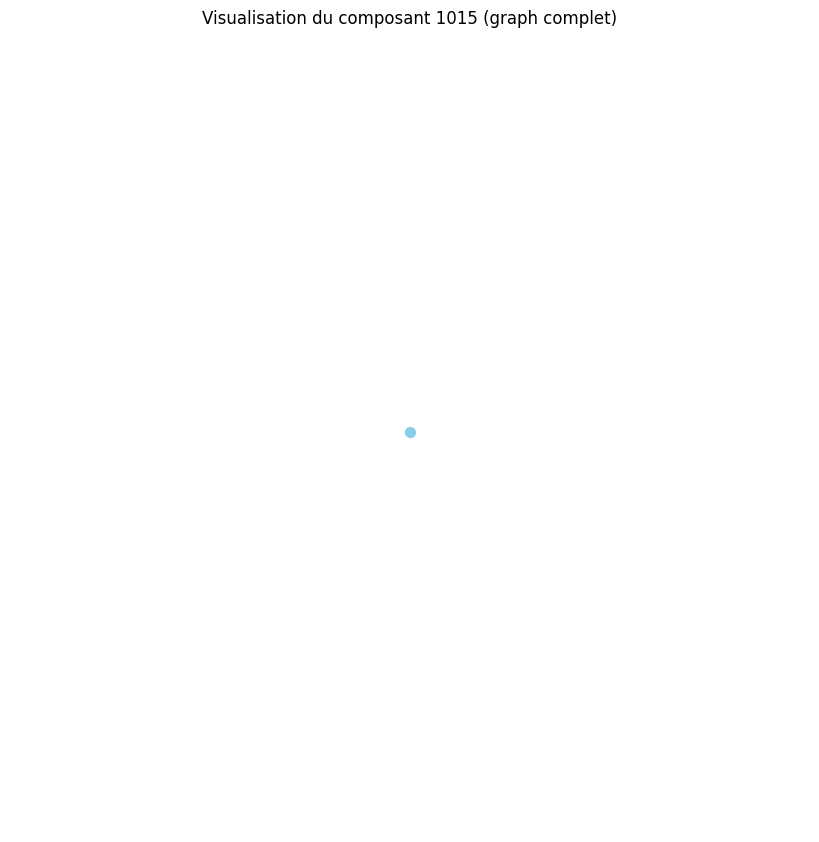

Distance moyenne pour le composant 1016 : 0.00
Le composant 1016 est un graphe complet ou très densément connecté.
Densité du composant 1016 : 0.00
Degré moyen du composant 1016 : 0.00
Coefficient de clustering moyen du composant 1016 : 0.00


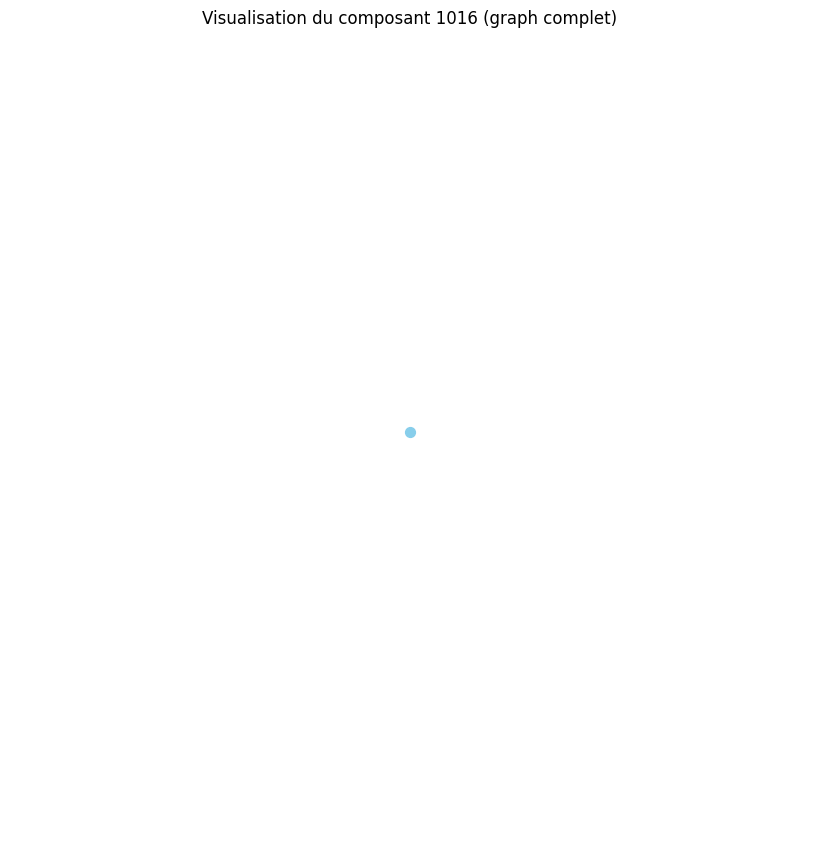

Distance moyenne pour le composant 1017 : 0.00
Le composant 1017 est un graphe complet ou très densément connecté.
Densité du composant 1017 : 0.00
Degré moyen du composant 1017 : 0.00
Coefficient de clustering moyen du composant 1017 : 0.00


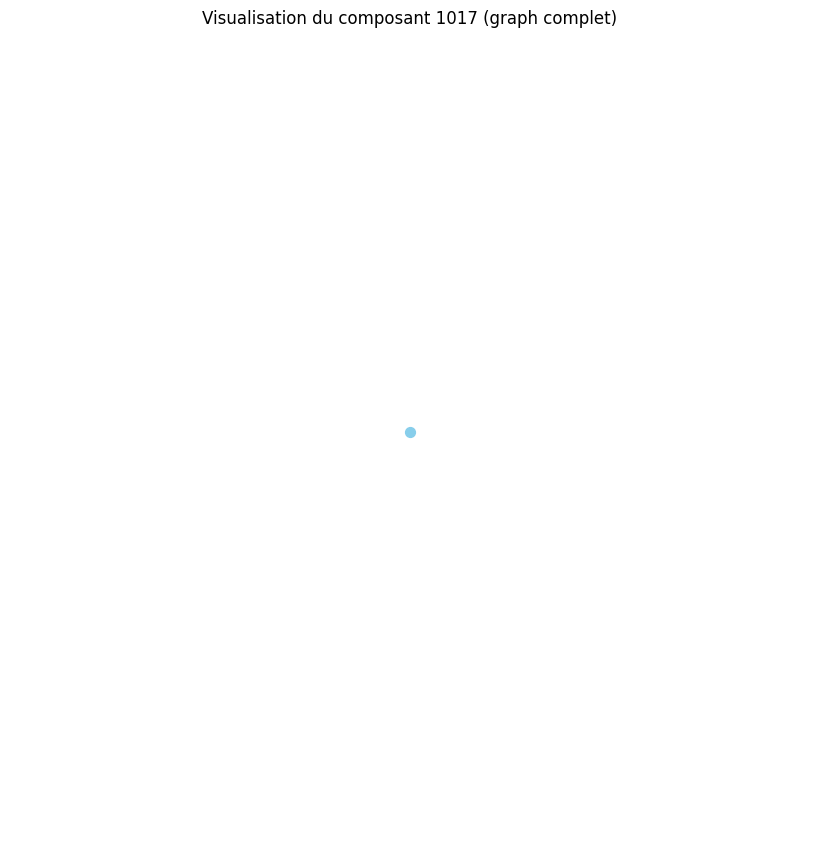

Distance moyenne pour le composant 1018 : 1.33
Distance moyenne pour le composant 1019 : 0.00
Le composant 1019 est un graphe complet ou très densément connecté.
Densité du composant 1019 : 0.00
Degré moyen du composant 1019 : 0.00
Coefficient de clustering moyen du composant 1019 : 0.00


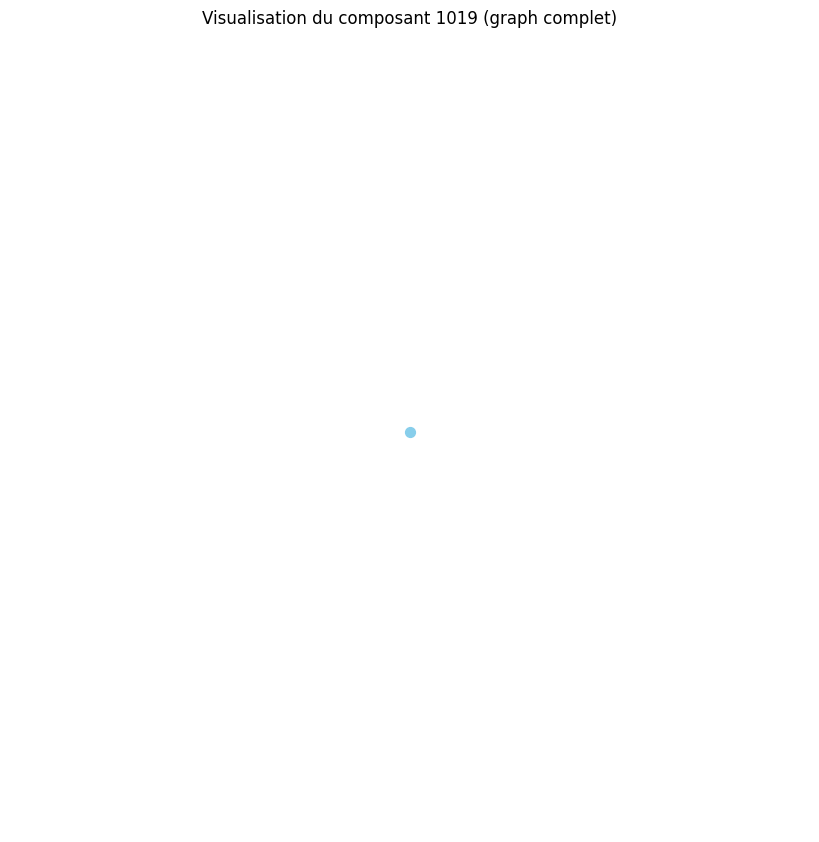

Distance moyenne pour le composant 1020 : 0.00
Le composant 1020 est un graphe complet ou très densément connecté.
Densité du composant 1020 : 0.00
Degré moyen du composant 1020 : 0.00
Coefficient de clustering moyen du composant 1020 : 0.00


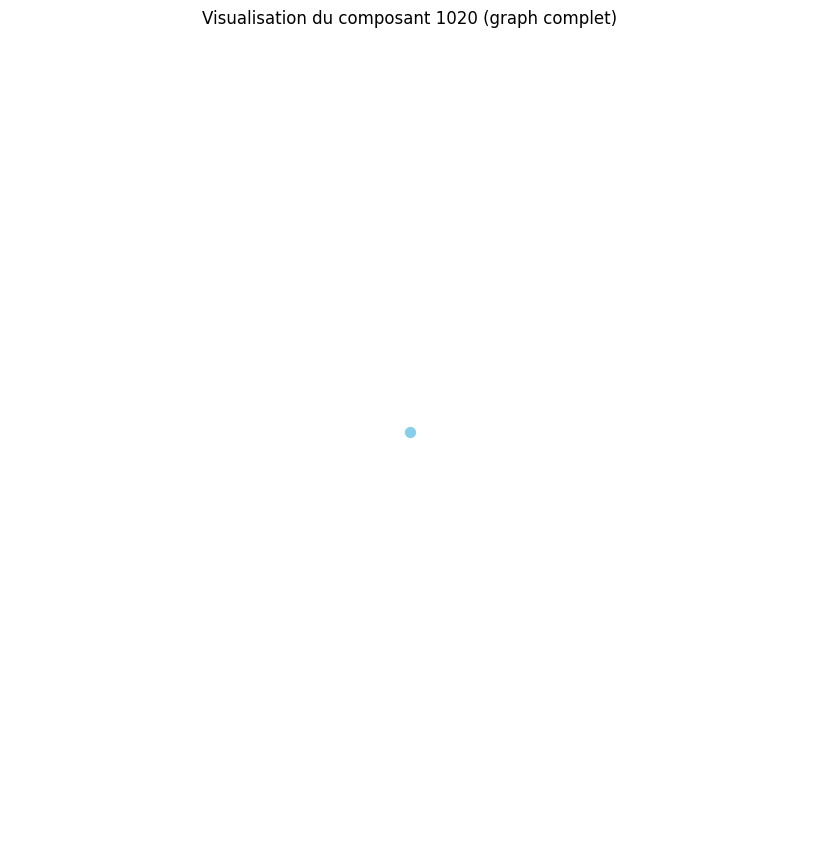

Distance moyenne pour le composant 1021 : 0.00
Le composant 1021 est un graphe complet ou très densément connecté.
Densité du composant 1021 : 0.00
Degré moyen du composant 1021 : 0.00
Coefficient de clustering moyen du composant 1021 : 0.00


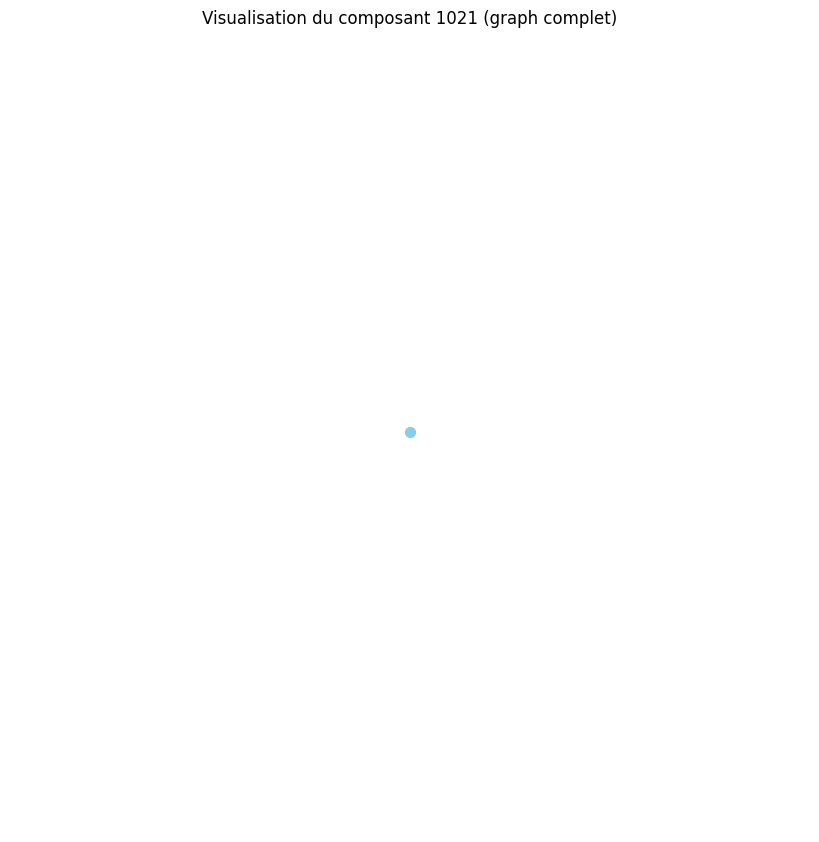

Distance moyenne pour le composant 1022 : 0.00
Le composant 1022 est un graphe complet ou très densément connecté.
Densité du composant 1022 : 0.00
Degré moyen du composant 1022 : 0.00
Coefficient de clustering moyen du composant 1022 : 0.00


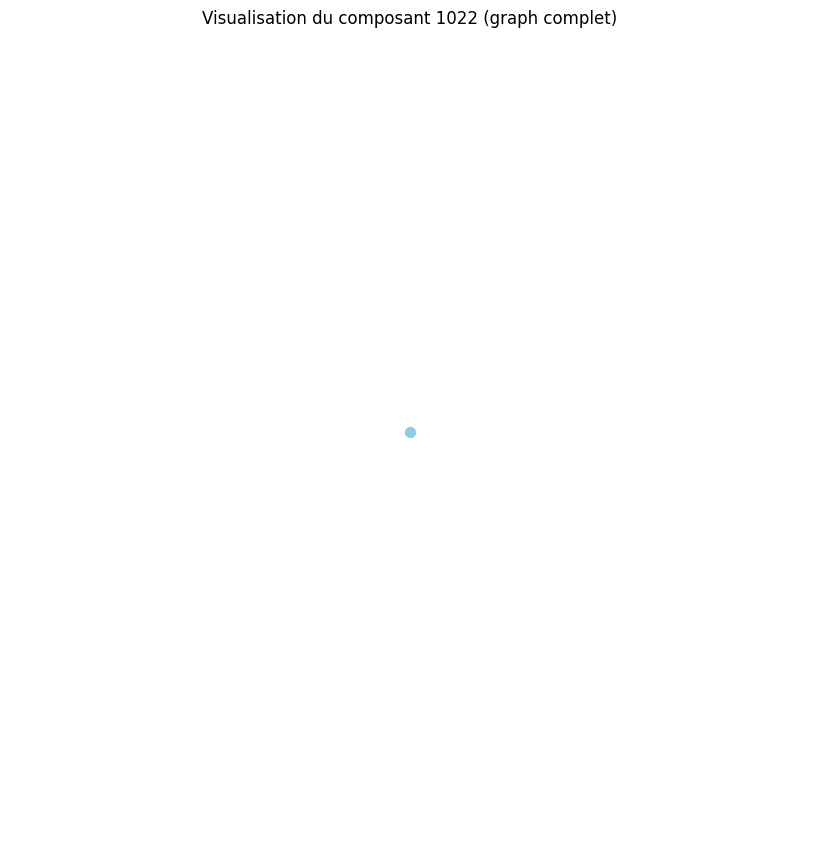

Distance moyenne pour le composant 1023 : 0.00
Le composant 1023 est un graphe complet ou très densément connecté.
Densité du composant 1023 : 0.00
Degré moyen du composant 1023 : 0.00
Coefficient de clustering moyen du composant 1023 : 0.00


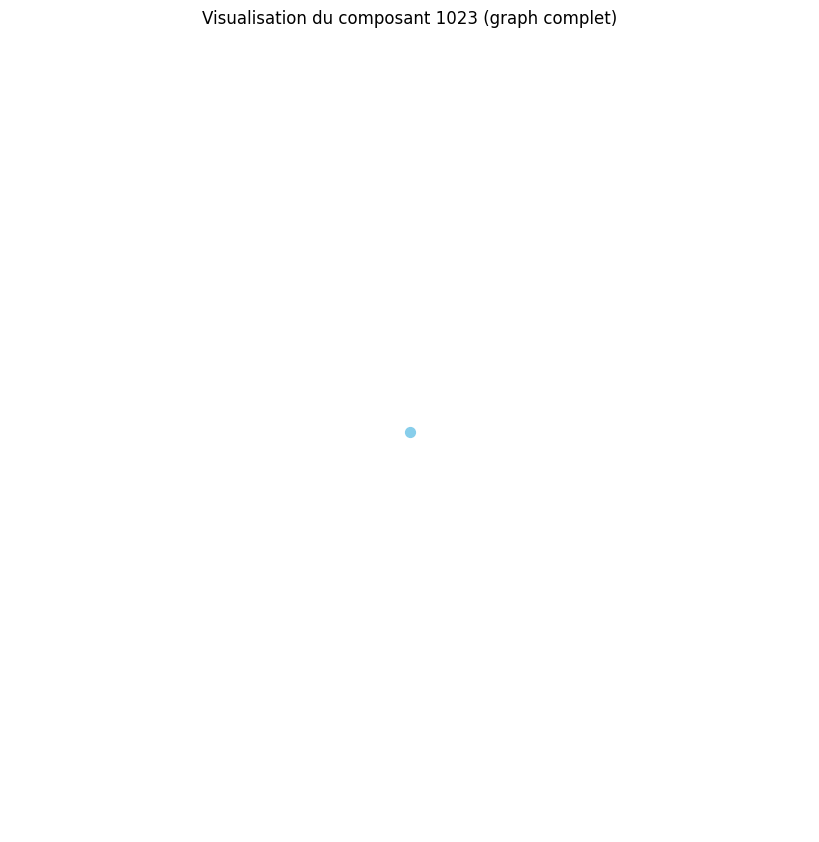

Distance moyenne pour le composant 1024 : 0.00
Le composant 1024 est un graphe complet ou très densément connecté.
Densité du composant 1024 : 0.00
Degré moyen du composant 1024 : 0.00
Coefficient de clustering moyen du composant 1024 : 0.00


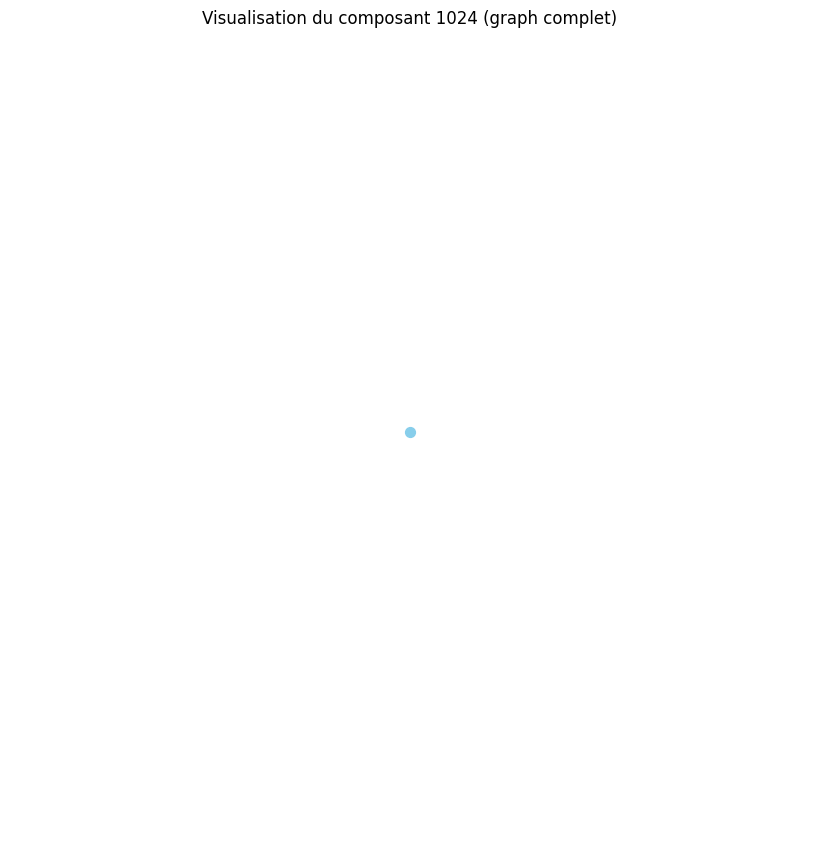

Distance moyenne pour le composant 1025 : 0.00
Le composant 1025 est un graphe complet ou très densément connecté.
Densité du composant 1025 : 0.00
Degré moyen du composant 1025 : 0.00
Coefficient de clustering moyen du composant 1025 : 0.00


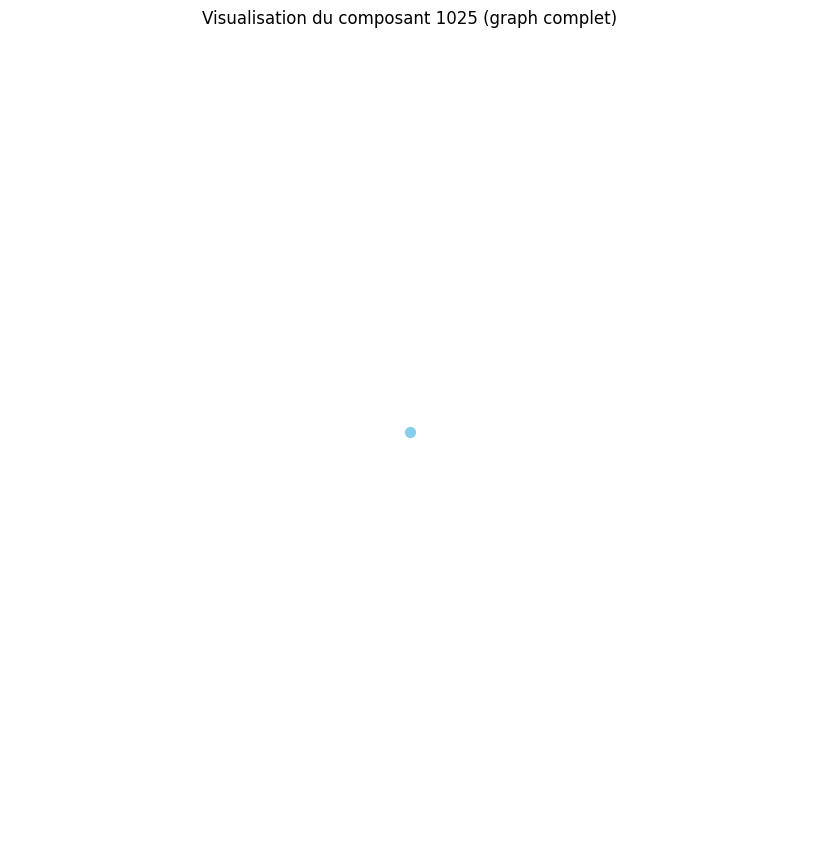

Distance moyenne pour le composant 1026 : 0.00
Le composant 1026 est un graphe complet ou très densément connecté.
Densité du composant 1026 : 0.00
Degré moyen du composant 1026 : 0.00
Coefficient de clustering moyen du composant 1026 : 0.00


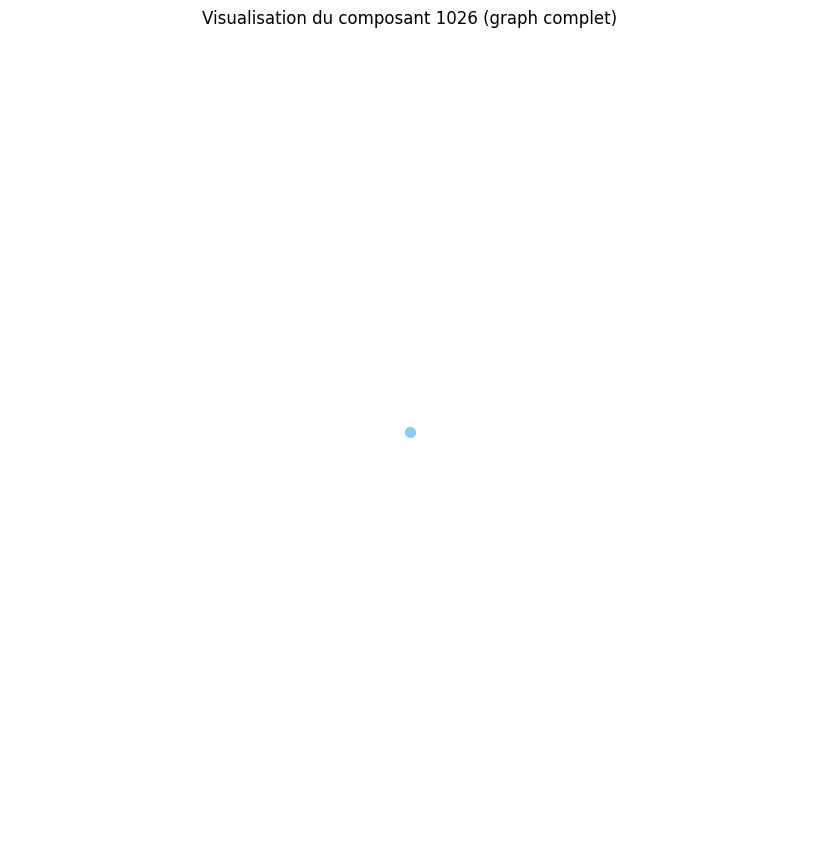

Distance moyenne pour le composant 1027 : 0.00
Le composant 1027 est un graphe complet ou très densément connecté.
Densité du composant 1027 : 0.00
Degré moyen du composant 1027 : 0.00
Coefficient de clustering moyen du composant 1027 : 0.00


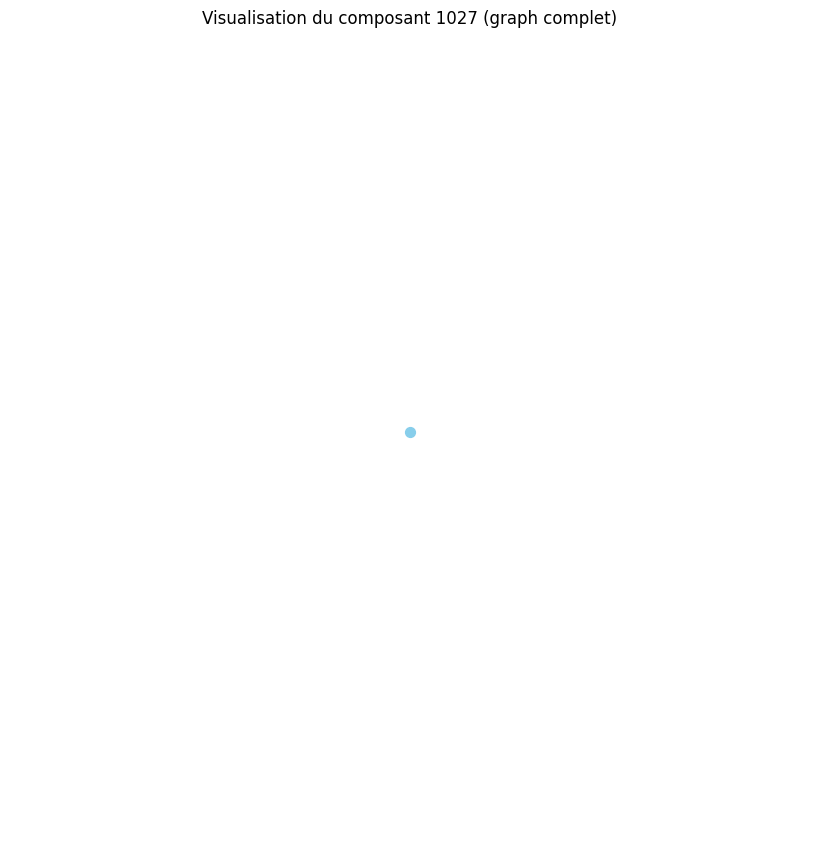

Distance moyenne pour le composant 1028 : 0.00
Le composant 1028 est un graphe complet ou très densément connecté.
Densité du composant 1028 : 0.00
Degré moyen du composant 1028 : 0.00
Coefficient de clustering moyen du composant 1028 : 0.00


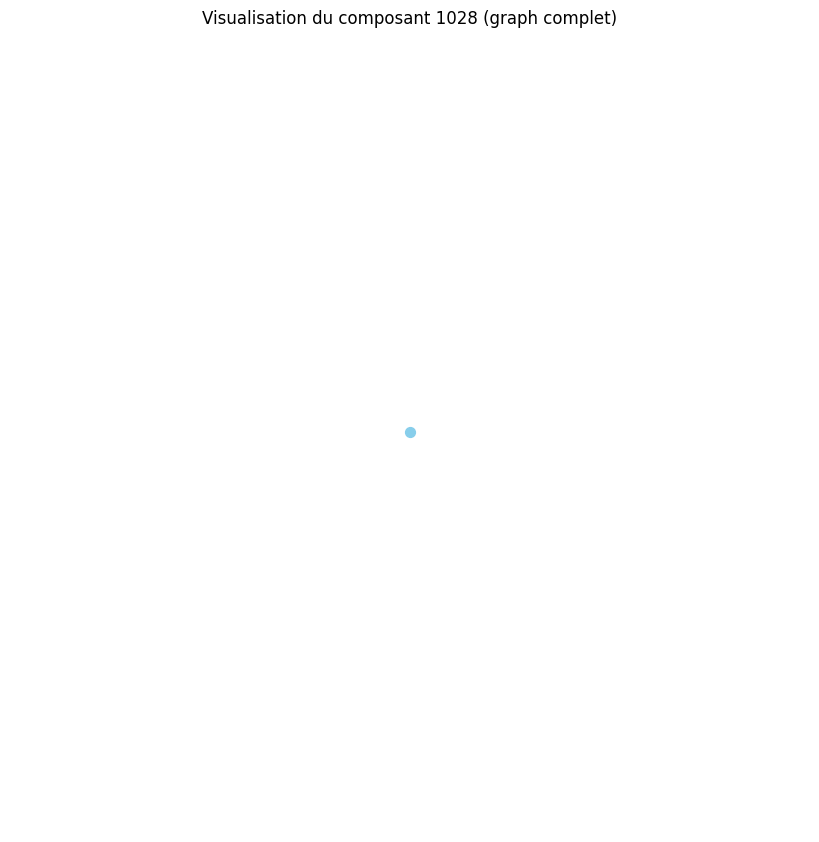

Distance moyenne pour le composant 1029 : 0.00
Le composant 1029 est un graphe complet ou très densément connecté.
Densité du composant 1029 : 0.00
Degré moyen du composant 1029 : 0.00
Coefficient de clustering moyen du composant 1029 : 0.00


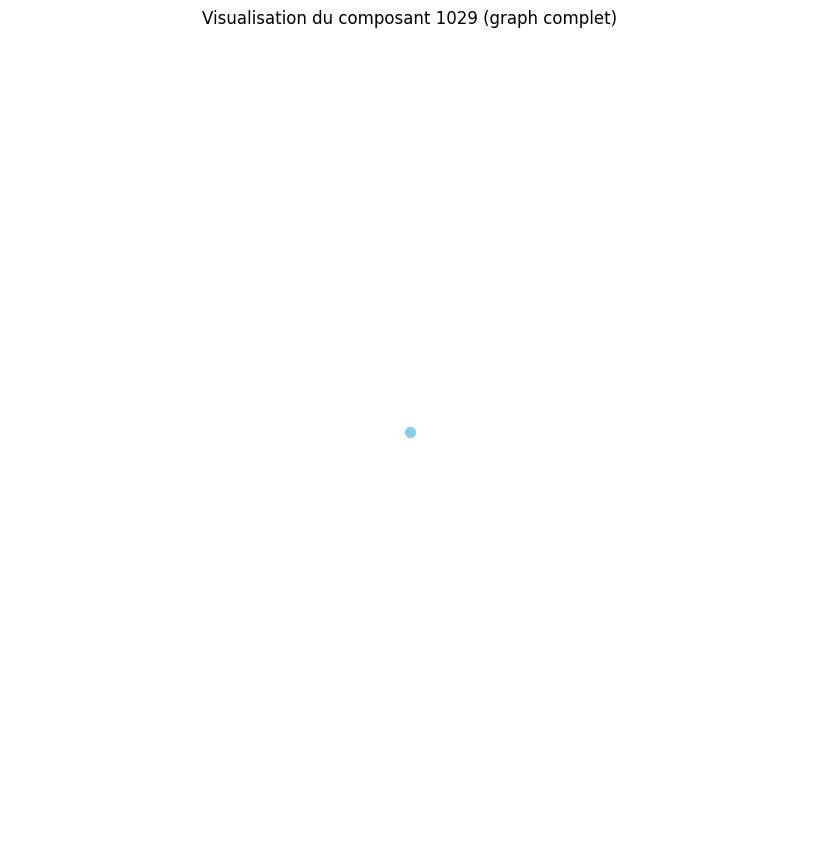

Distance moyenne pour le composant 1030 : 0.00
Le composant 1030 est un graphe complet ou très densément connecté.
Densité du composant 1030 : 0.00
Degré moyen du composant 1030 : 0.00
Coefficient de clustering moyen du composant 1030 : 0.00


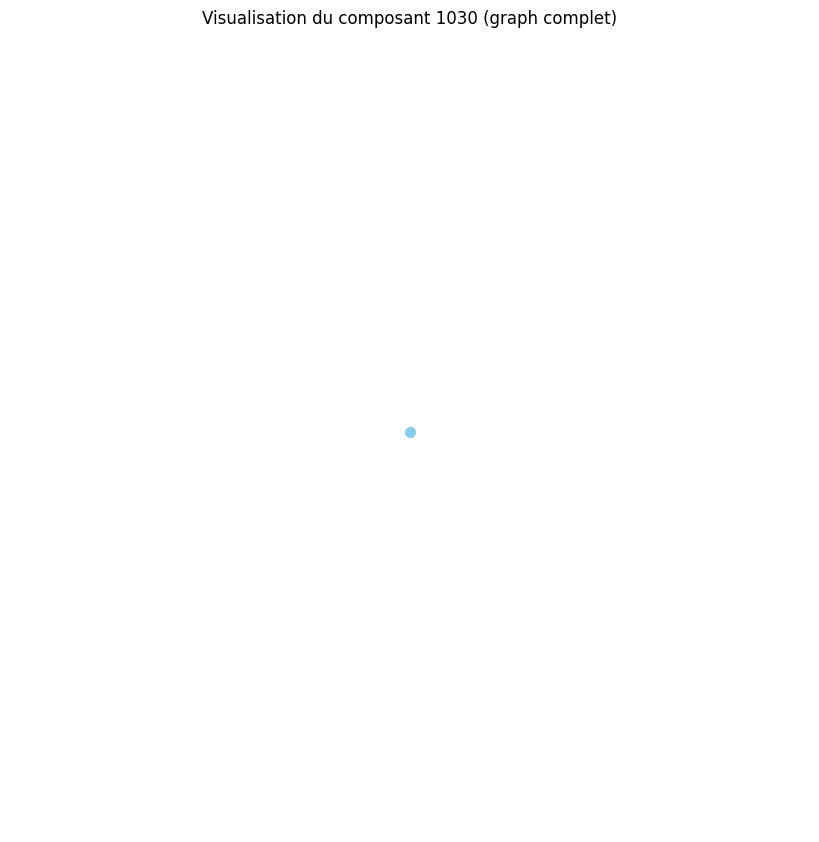

Distance moyenne pour le composant 1031 : 0.00
Le composant 1031 est un graphe complet ou très densément connecté.
Densité du composant 1031 : 0.00
Degré moyen du composant 1031 : 0.00
Coefficient de clustering moyen du composant 1031 : 0.00


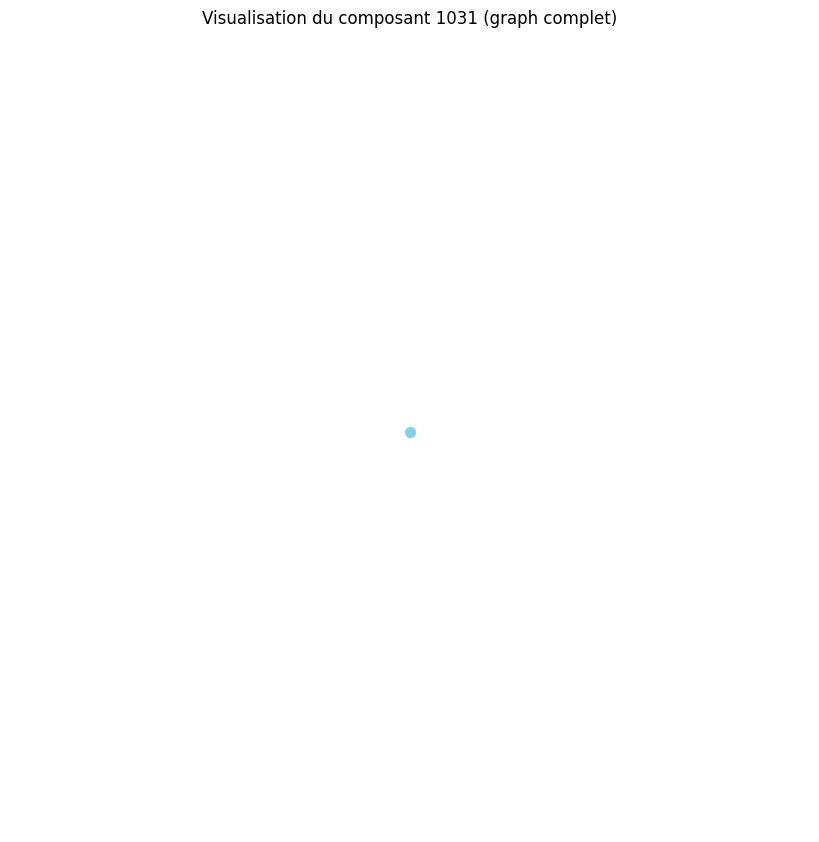

Distance moyenne pour le composant 1032 : 0.00
Le composant 1032 est un graphe complet ou très densément connecté.
Densité du composant 1032 : 0.00
Degré moyen du composant 1032 : 0.00
Coefficient de clustering moyen du composant 1032 : 0.00


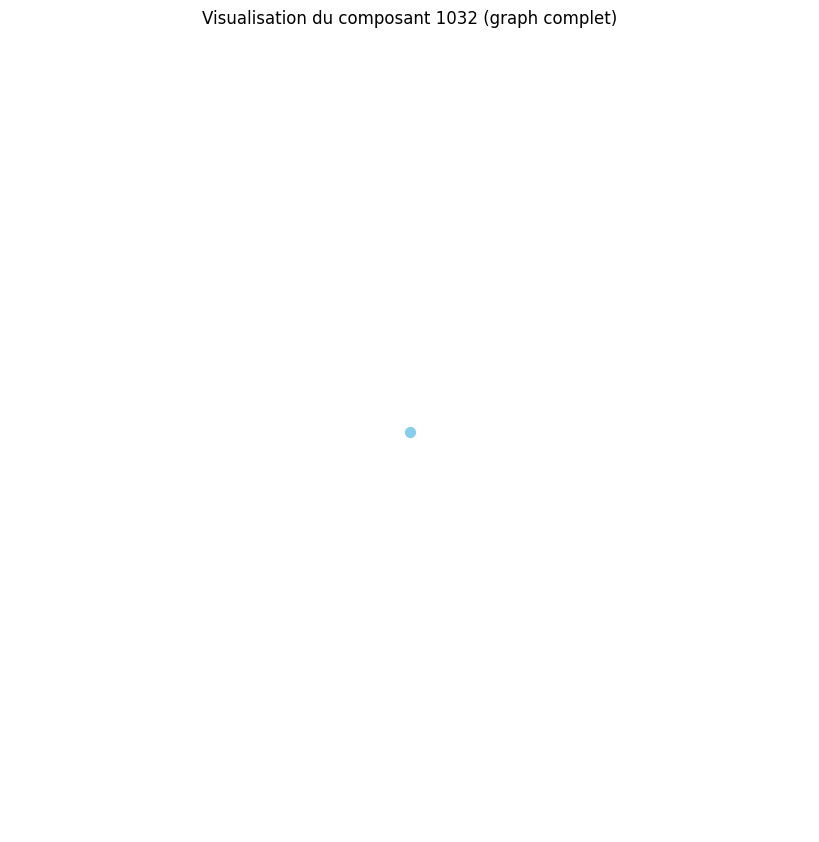

Distance moyenne pour le composant 1033 : 0.00
Le composant 1033 est un graphe complet ou très densément connecté.
Densité du composant 1033 : 0.00
Degré moyen du composant 1033 : 0.00
Coefficient de clustering moyen du composant 1033 : 0.00


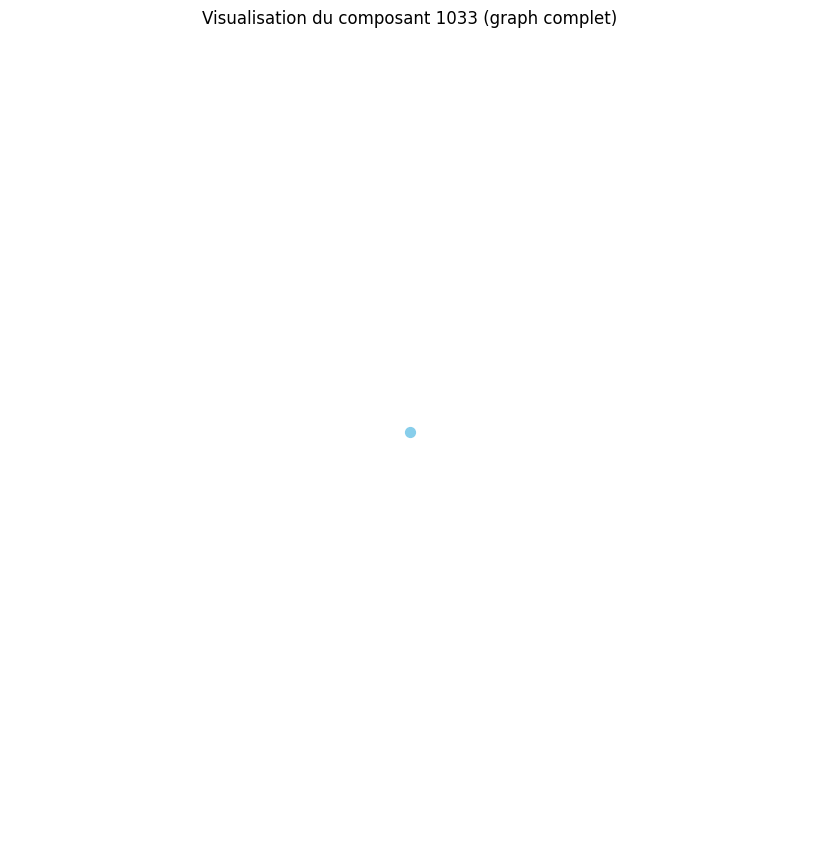

Distance moyenne pour le composant 1034 : 0.00
Le composant 1034 est un graphe complet ou très densément connecté.
Densité du composant 1034 : 0.00
Degré moyen du composant 1034 : 0.00
Coefficient de clustering moyen du composant 1034 : 0.00


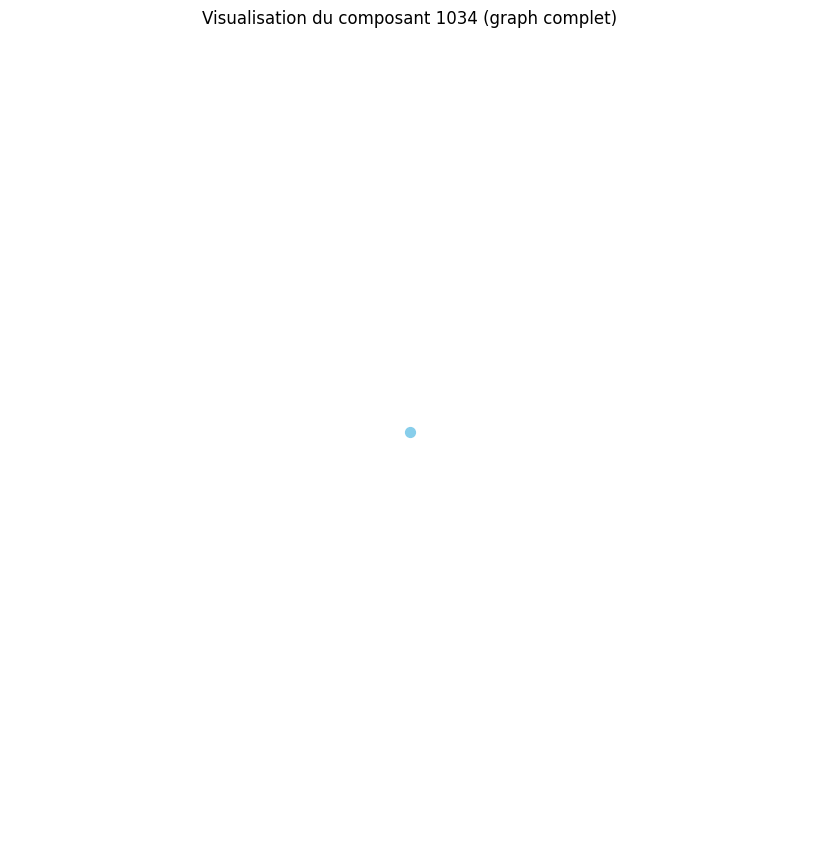

Distance moyenne pour le composant 1035 : 0.00
Le composant 1035 est un graphe complet ou très densément connecté.
Densité du composant 1035 : 0.00
Degré moyen du composant 1035 : 0.00
Coefficient de clustering moyen du composant 1035 : 0.00


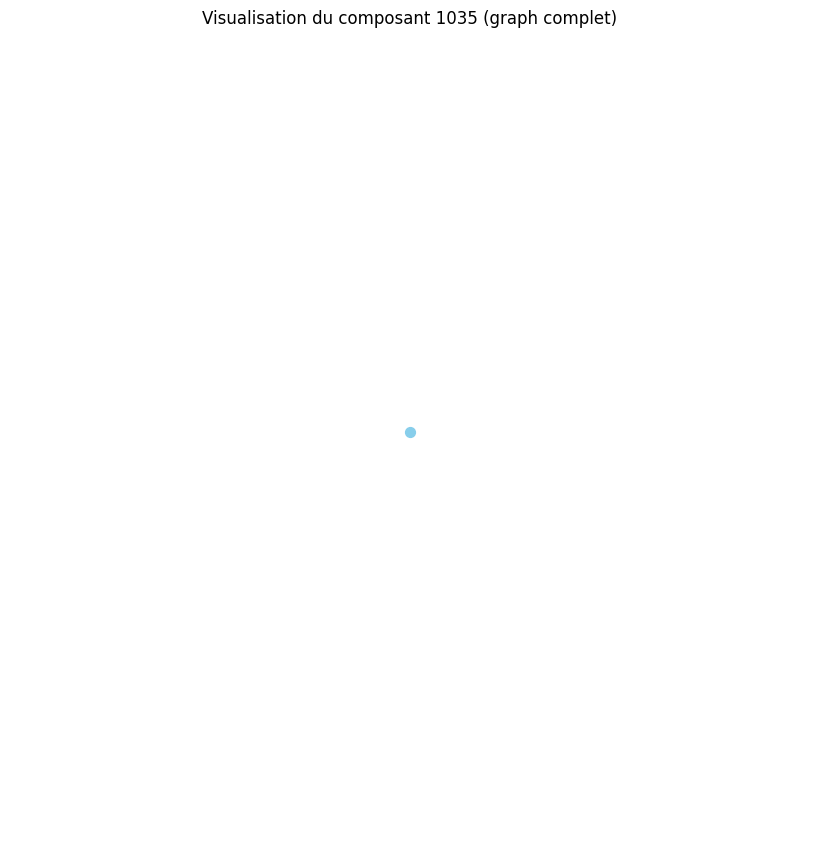

Distance moyenne pour le composant 1036 : 0.00
Le composant 1036 est un graphe complet ou très densément connecté.
Densité du composant 1036 : 0.00
Degré moyen du composant 1036 : 0.00
Coefficient de clustering moyen du composant 1036 : 0.00


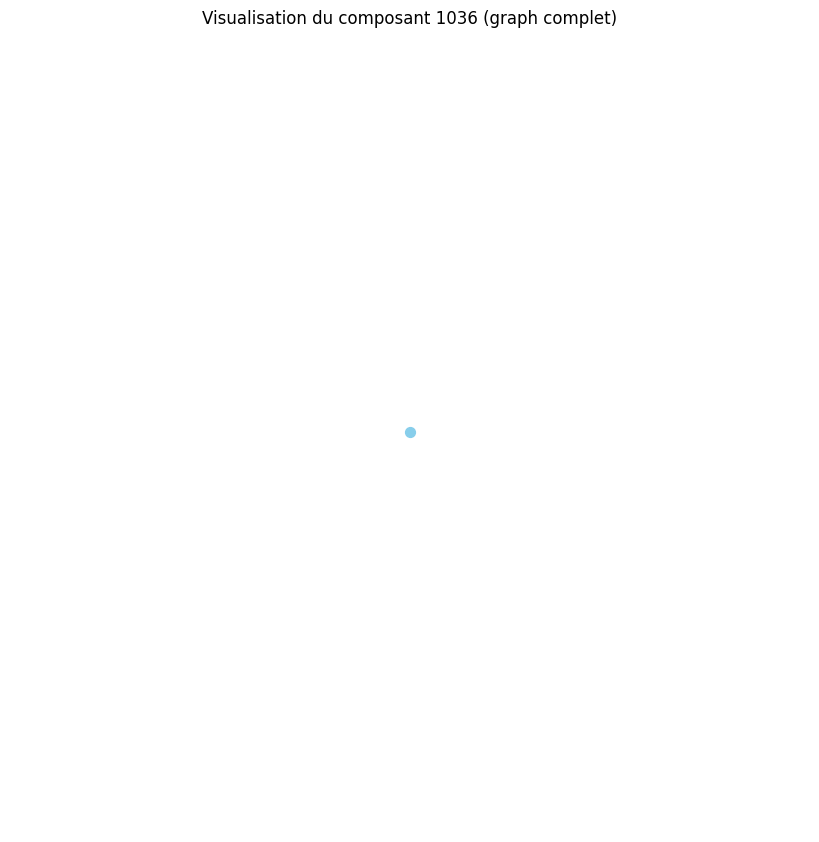

Distance moyenne pour le composant 1037 : 0.00
Le composant 1037 est un graphe complet ou très densément connecté.
Densité du composant 1037 : 0.00
Degré moyen du composant 1037 : 0.00
Coefficient de clustering moyen du composant 1037 : 0.00


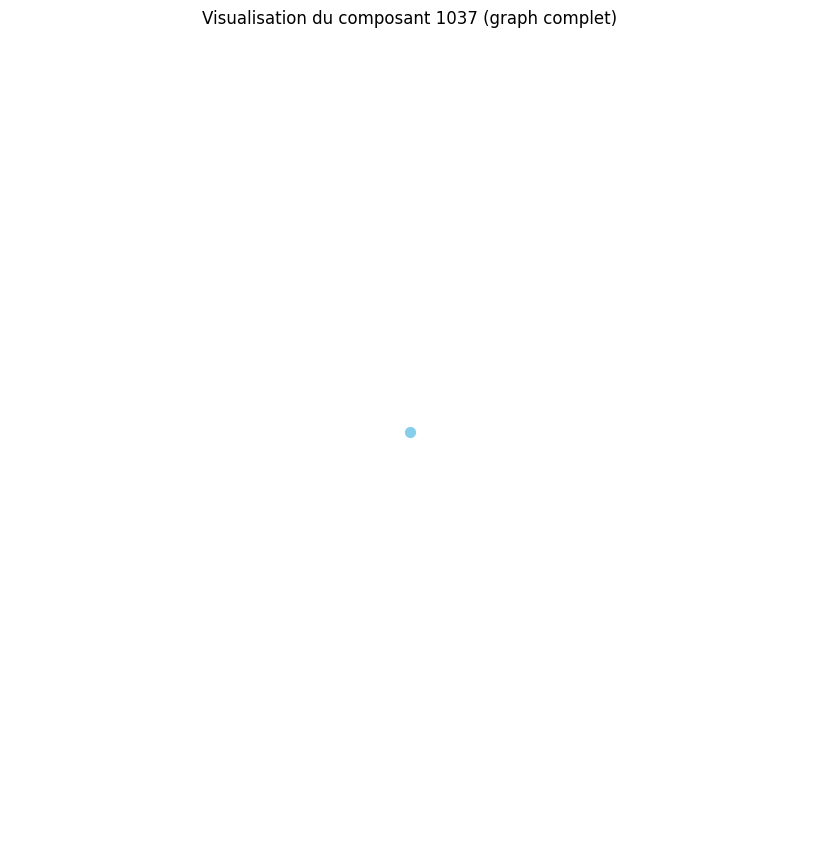

Distance moyenne pour le composant 1038 : 0.00
Le composant 1038 est un graphe complet ou très densément connecté.
Densité du composant 1038 : 0.00
Degré moyen du composant 1038 : 0.00
Coefficient de clustering moyen du composant 1038 : 0.00


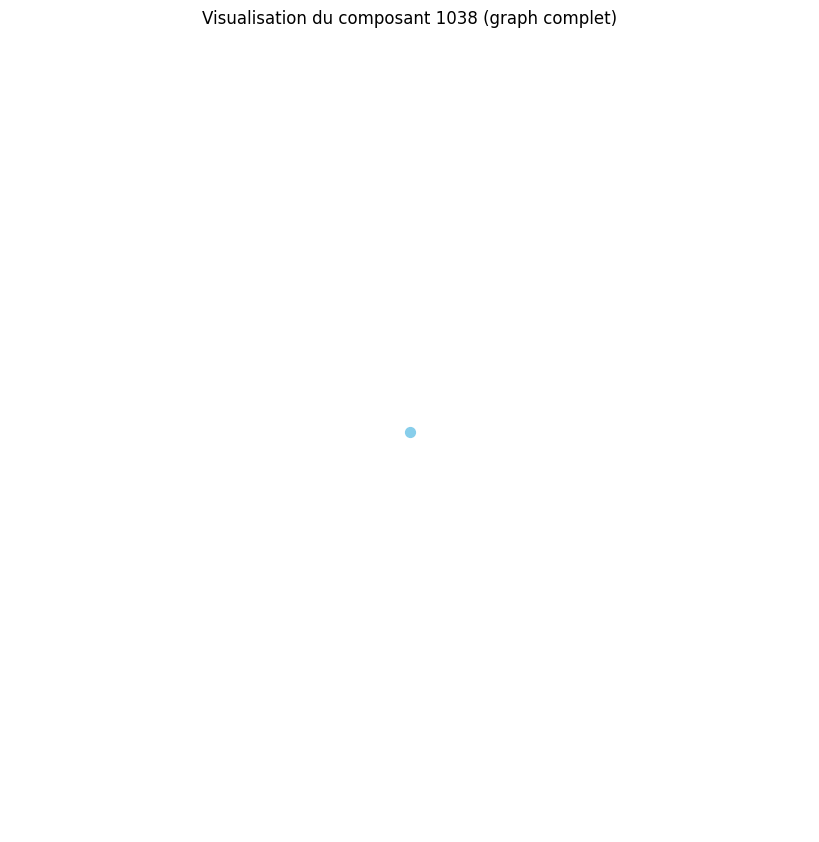

Distance moyenne pour le composant 1039 : 0.00
Le composant 1039 est un graphe complet ou très densément connecté.
Densité du composant 1039 : 0.00
Degré moyen du composant 1039 : 0.00
Coefficient de clustering moyen du composant 1039 : 0.00


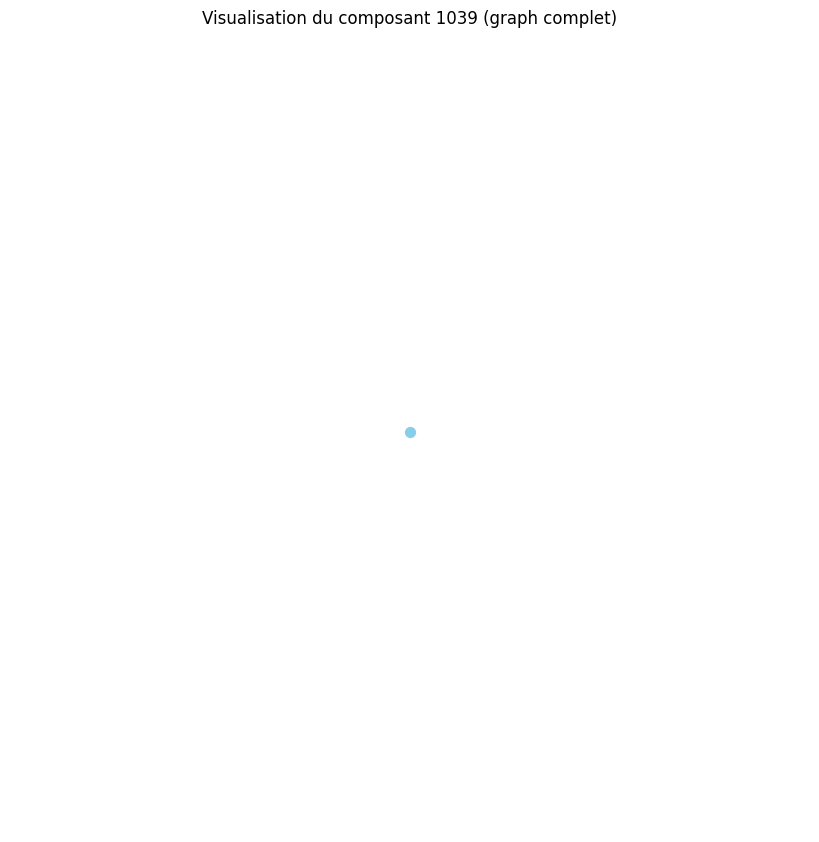

Distance moyenne pour le composant 1040 : 0.00
Le composant 1040 est un graphe complet ou très densément connecté.
Densité du composant 1040 : 0.00
Degré moyen du composant 1040 : 0.00
Coefficient de clustering moyen du composant 1040 : 0.00


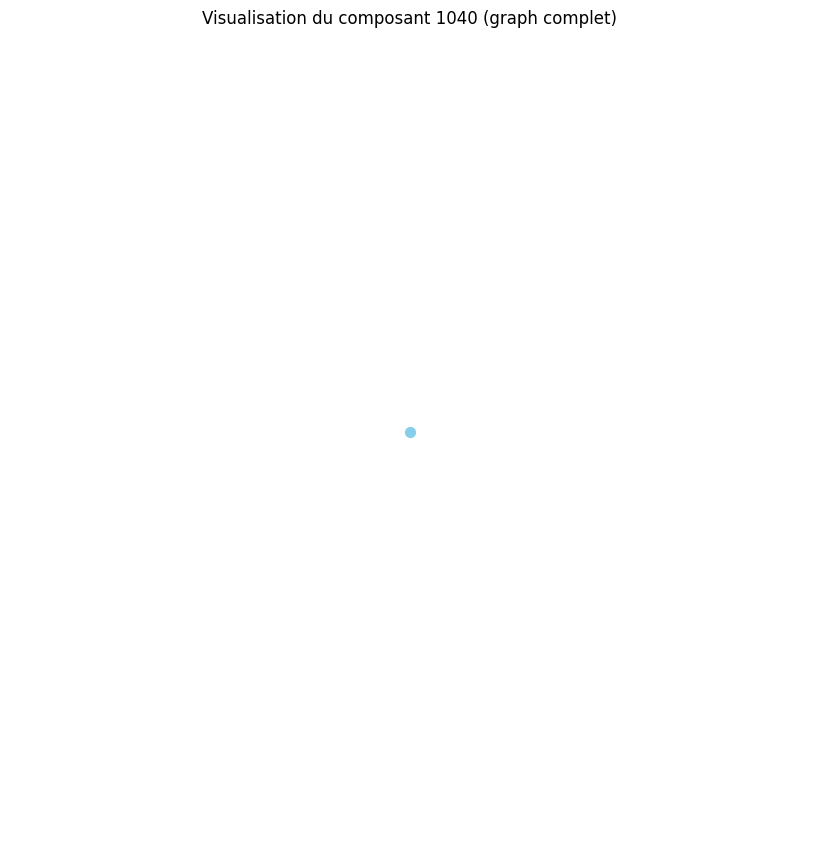

Distance moyenne pour le composant 1041 : 0.00
Le composant 1041 est un graphe complet ou très densément connecté.
Densité du composant 1041 : 0.00
Degré moyen du composant 1041 : 0.00
Coefficient de clustering moyen du composant 1041 : 0.00


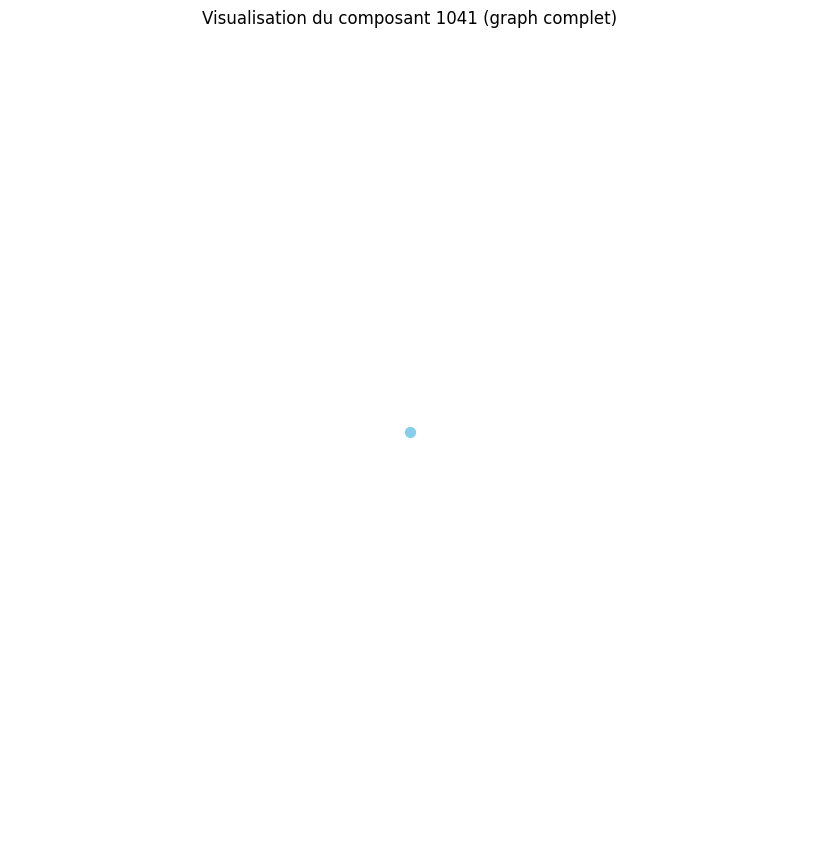

Distance moyenne pour le composant 1042 : 0.00
Le composant 1042 est un graphe complet ou très densément connecté.
Densité du composant 1042 : 0.00
Degré moyen du composant 1042 : 0.00
Coefficient de clustering moyen du composant 1042 : 0.00


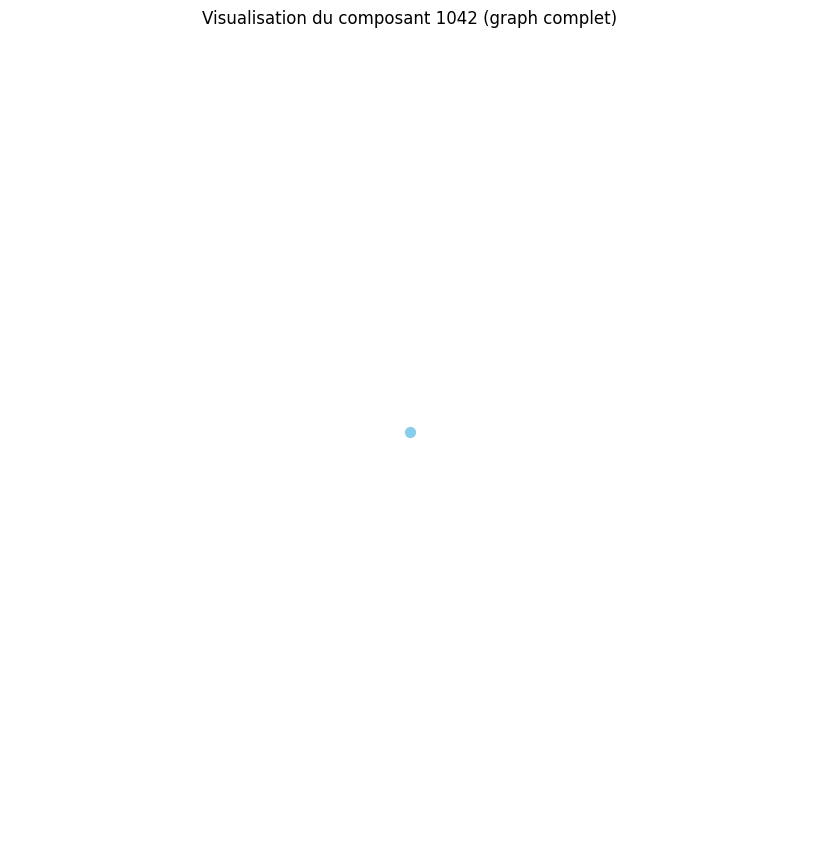

Distance moyenne pour le composant 1043 : 0.00
Le composant 1043 est un graphe complet ou très densément connecté.
Densité du composant 1043 : 0.00
Degré moyen du composant 1043 : 0.00
Coefficient de clustering moyen du composant 1043 : 0.00


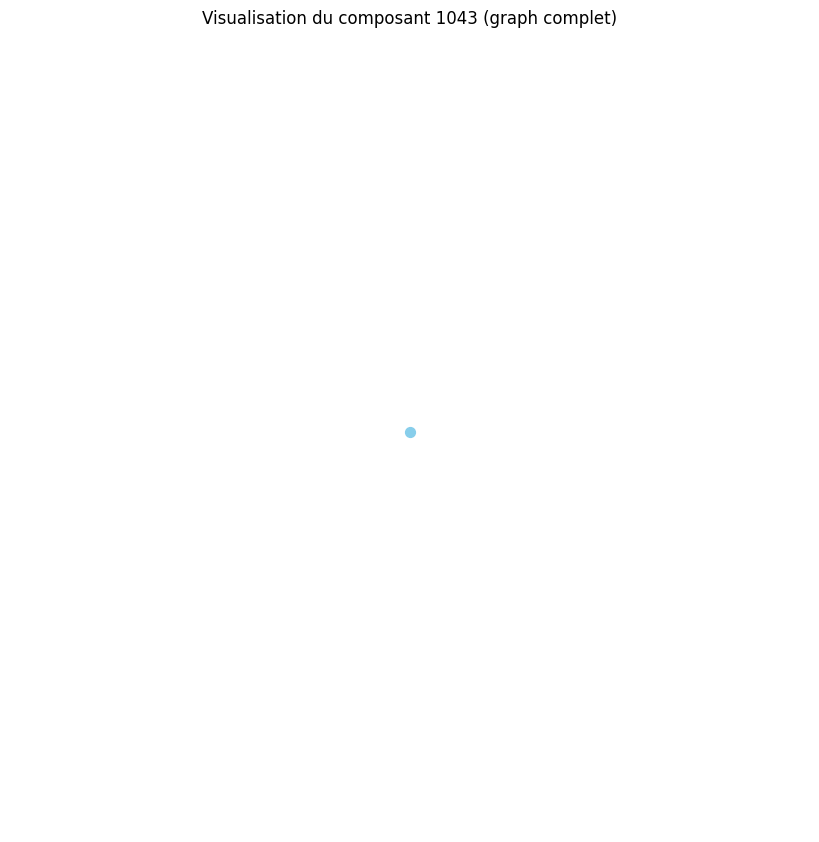

Distance moyenne pour le composant 1044 : 0.00
Le composant 1044 est un graphe complet ou très densément connecté.
Densité du composant 1044 : 0.00
Degré moyen du composant 1044 : 0.00
Coefficient de clustering moyen du composant 1044 : 0.00


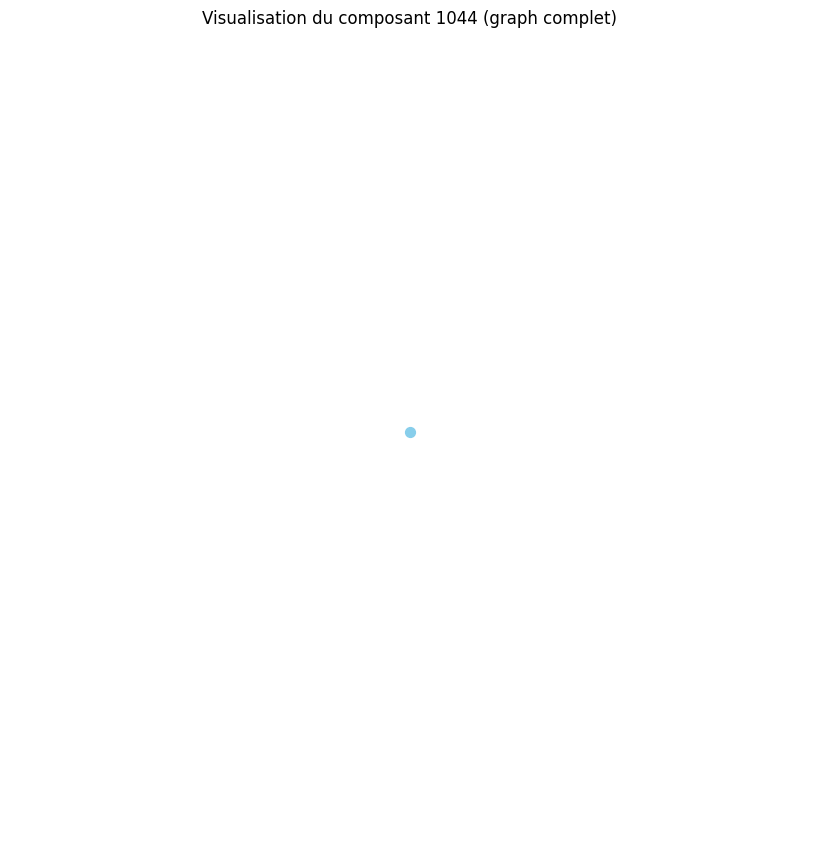

Distance moyenne pour le composant 1045 : 0.00
Le composant 1045 est un graphe complet ou très densément connecté.
Densité du composant 1045 : 0.00
Degré moyen du composant 1045 : 0.00
Coefficient de clustering moyen du composant 1045 : 0.00


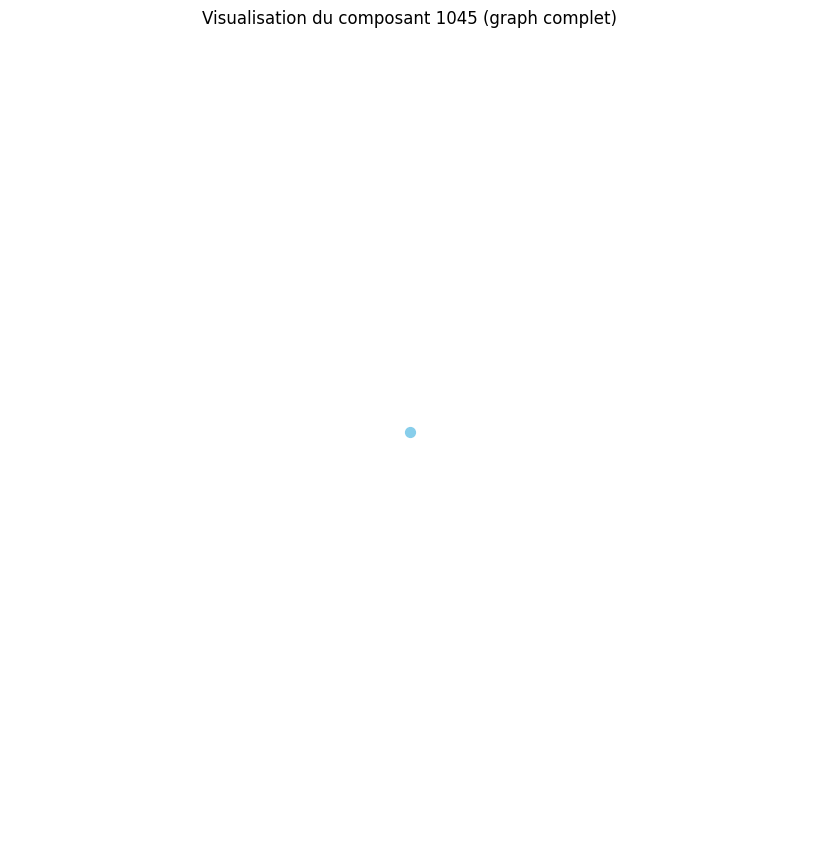

Distance moyenne pour le composant 1046 : 0.00
Le composant 1046 est un graphe complet ou très densément connecté.
Densité du composant 1046 : 0.00
Degré moyen du composant 1046 : 0.00
Coefficient de clustering moyen du composant 1046 : 0.00


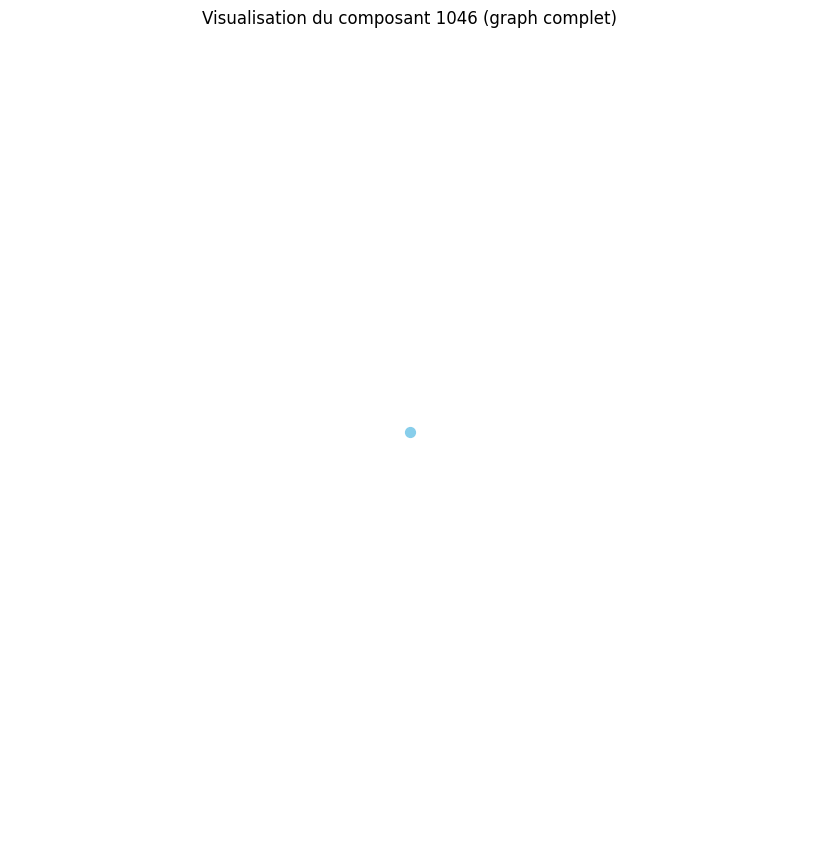

Distance moyenne pour le composant 1047 : 0.00
Le composant 1047 est un graphe complet ou très densément connecté.
Densité du composant 1047 : 0.00
Degré moyen du composant 1047 : 0.00
Coefficient de clustering moyen du composant 1047 : 0.00


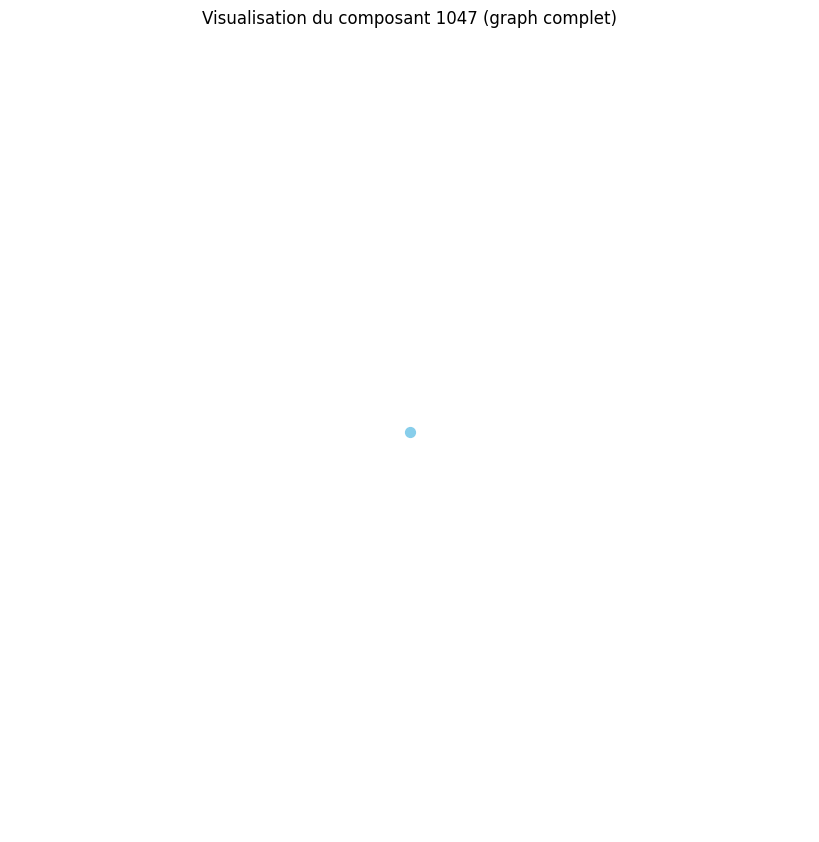

Distance moyenne pour le composant 1048 : 0.00
Le composant 1048 est un graphe complet ou très densément connecté.
Densité du composant 1048 : 0.00
Degré moyen du composant 1048 : 0.00
Coefficient de clustering moyen du composant 1048 : 0.00


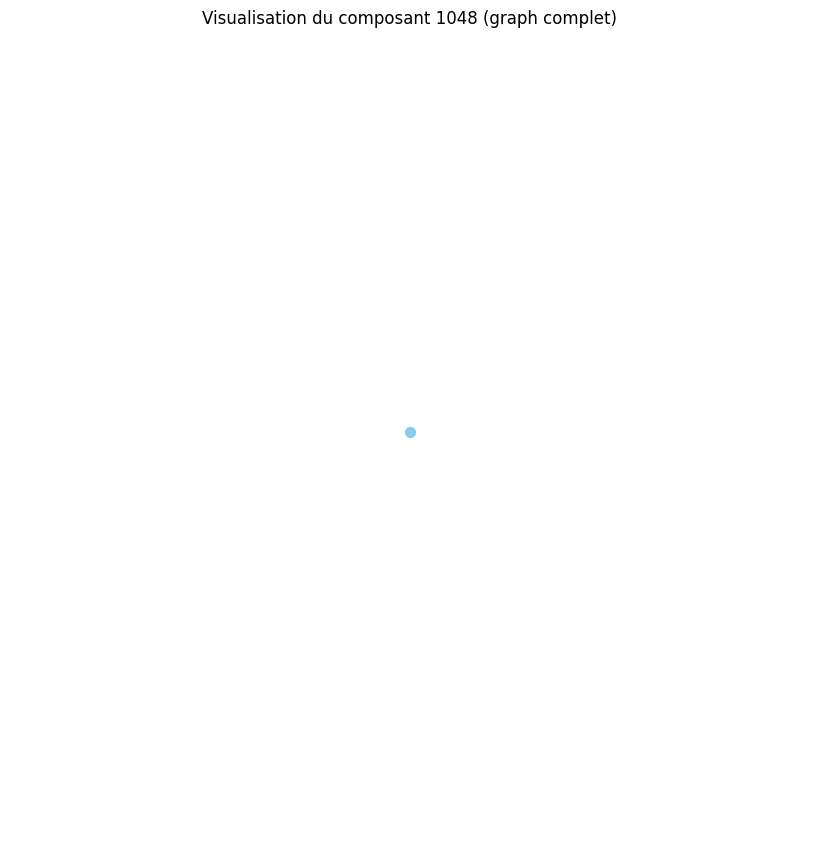

Distance moyenne pour le composant 1049 : 0.00
Le composant 1049 est un graphe complet ou très densément connecté.
Densité du composant 1049 : 0.00
Degré moyen du composant 1049 : 0.00
Coefficient de clustering moyen du composant 1049 : 0.00


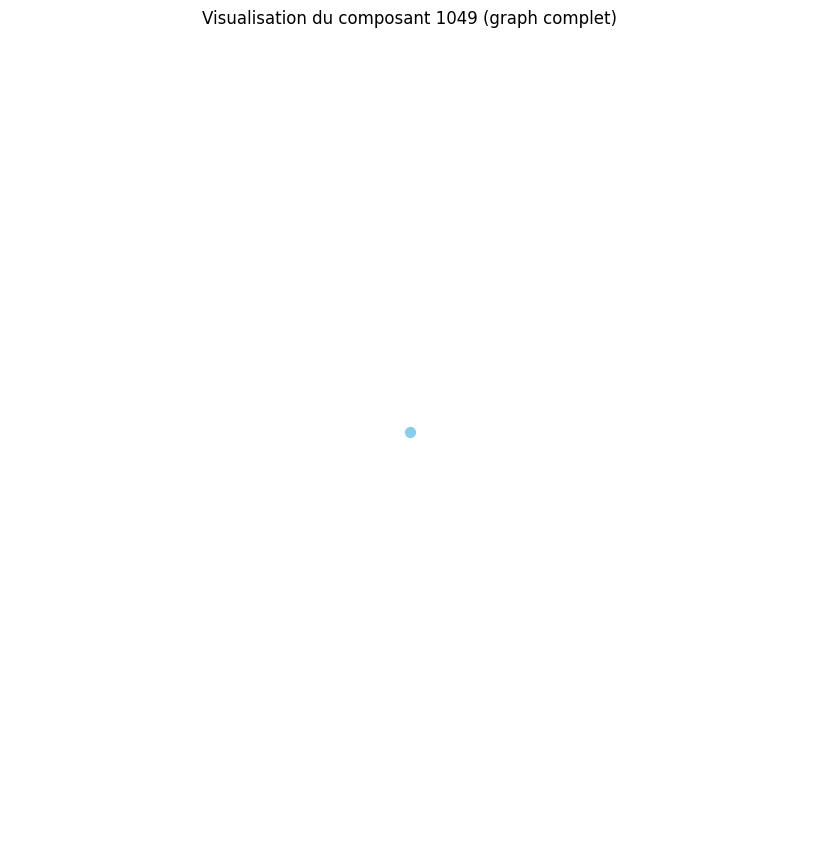

Distance moyenne pour le composant 1050 : 0.00
Le composant 1050 est un graphe complet ou très densément connecté.
Densité du composant 1050 : 0.00
Degré moyen du composant 1050 : 0.00
Coefficient de clustering moyen du composant 1050 : 0.00


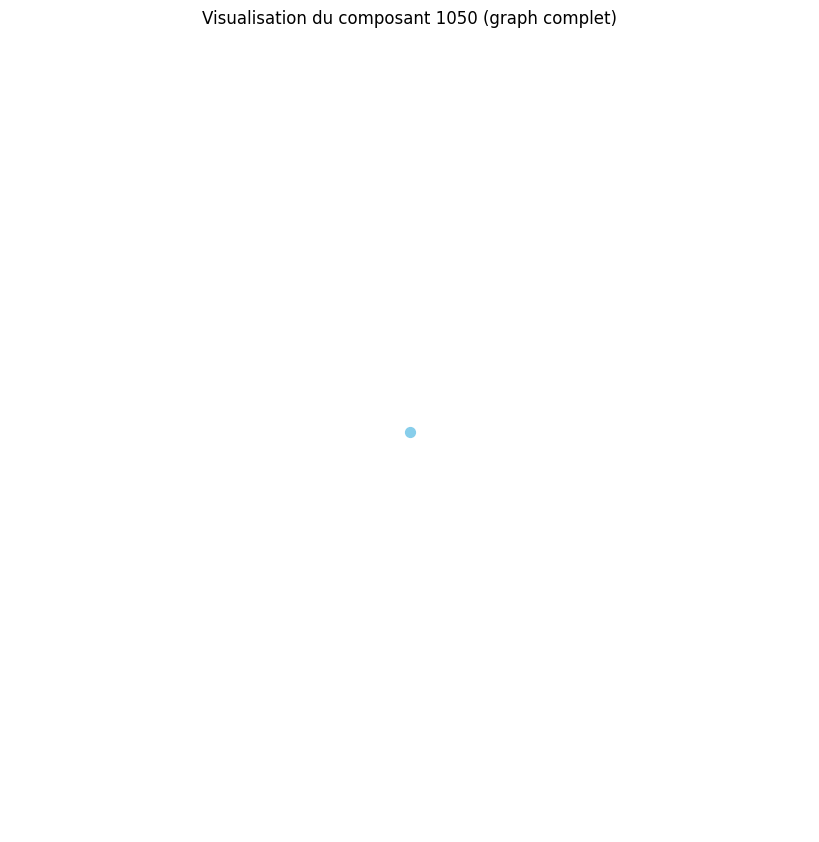

Distance moyenne pour le composant 1051 : 0.00
Le composant 1051 est un graphe complet ou très densément connecté.
Densité du composant 1051 : 0.00
Degré moyen du composant 1051 : 0.00
Coefficient de clustering moyen du composant 1051 : 0.00


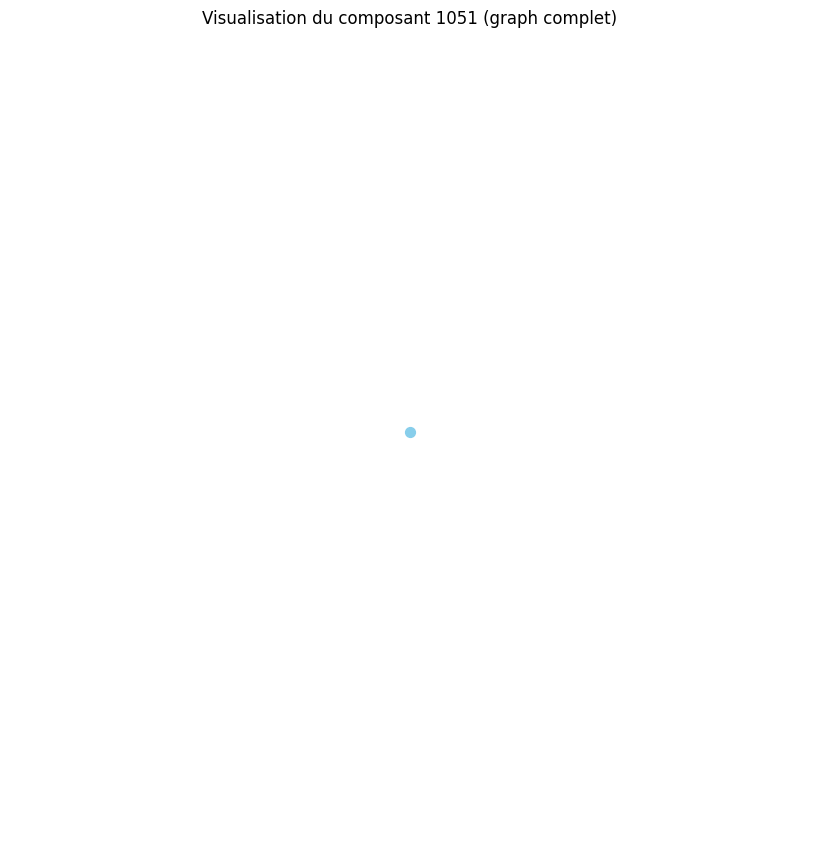

Distance moyenne pour le composant 1052 : 0.00
Le composant 1052 est un graphe complet ou très densément connecté.
Densité du composant 1052 : 0.00
Degré moyen du composant 1052 : 0.00
Coefficient de clustering moyen du composant 1052 : 0.00


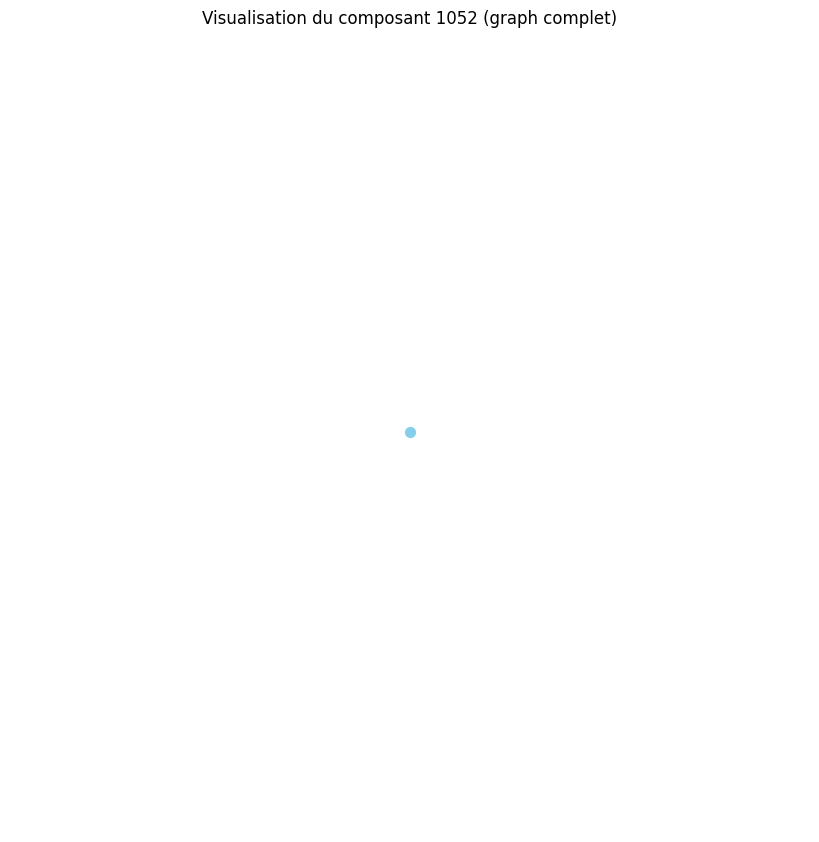

Distance moyenne pour le composant 1053 : 0.00
Le composant 1053 est un graphe complet ou très densément connecté.
Densité du composant 1053 : 0.00
Degré moyen du composant 1053 : 0.00
Coefficient de clustering moyen du composant 1053 : 0.00


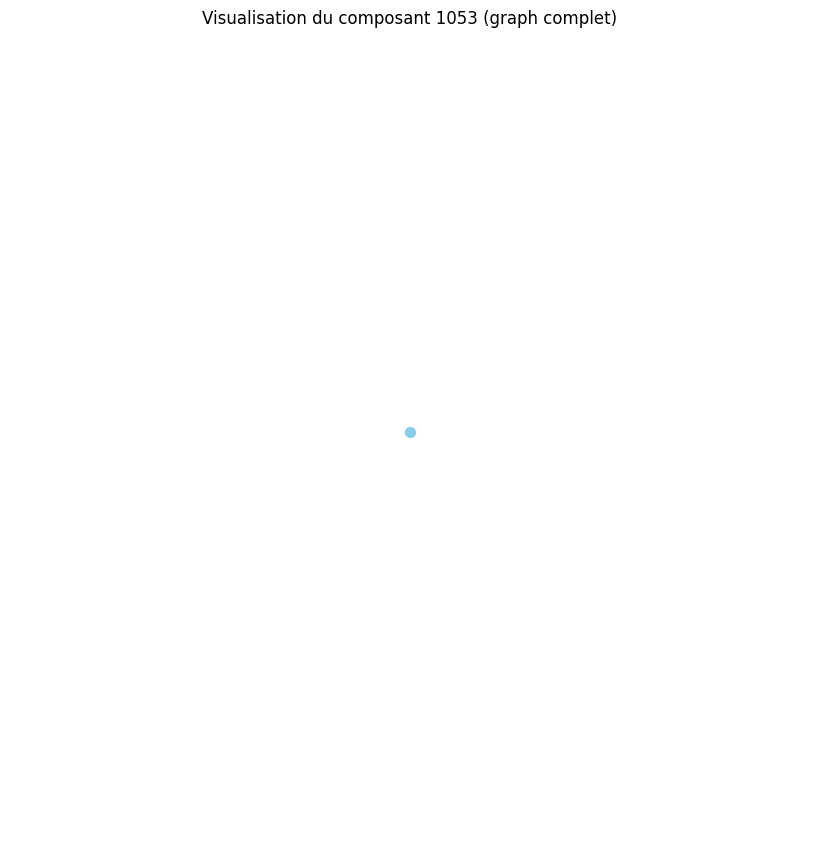

Distance moyenne pour le composant 1054 : 0.00
Le composant 1054 est un graphe complet ou très densément connecté.
Densité du composant 1054 : 0.00
Degré moyen du composant 1054 : 0.00
Coefficient de clustering moyen du composant 1054 : 0.00


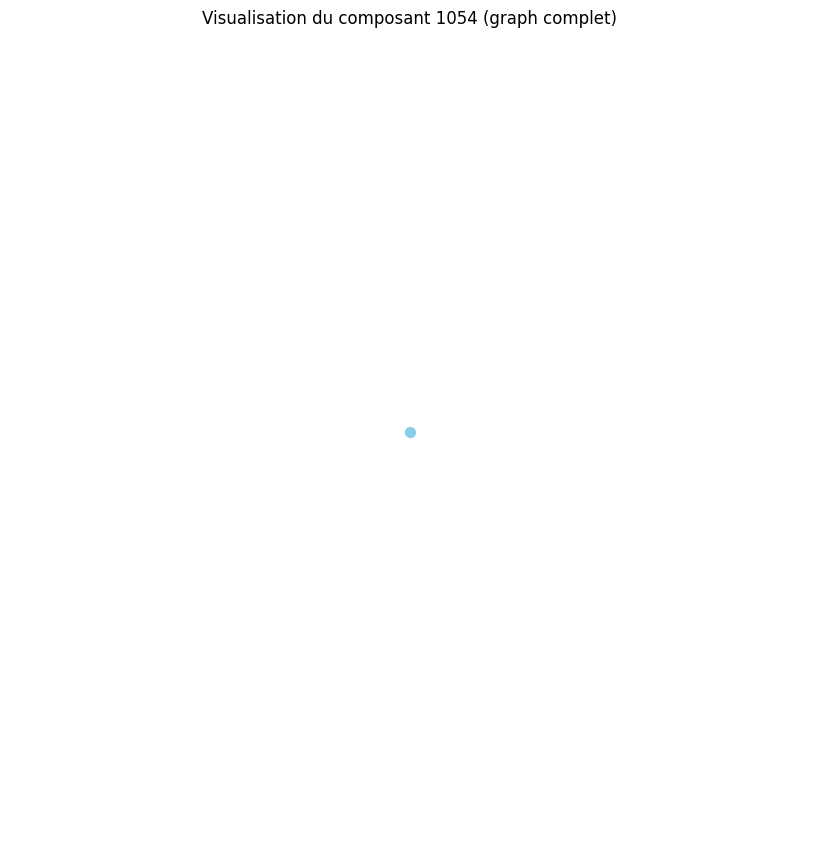

Distance moyenne pour le composant 1055 : 0.00
Le composant 1055 est un graphe complet ou très densément connecté.
Densité du composant 1055 : 0.00
Degré moyen du composant 1055 : 0.00
Coefficient de clustering moyen du composant 1055 : 0.00


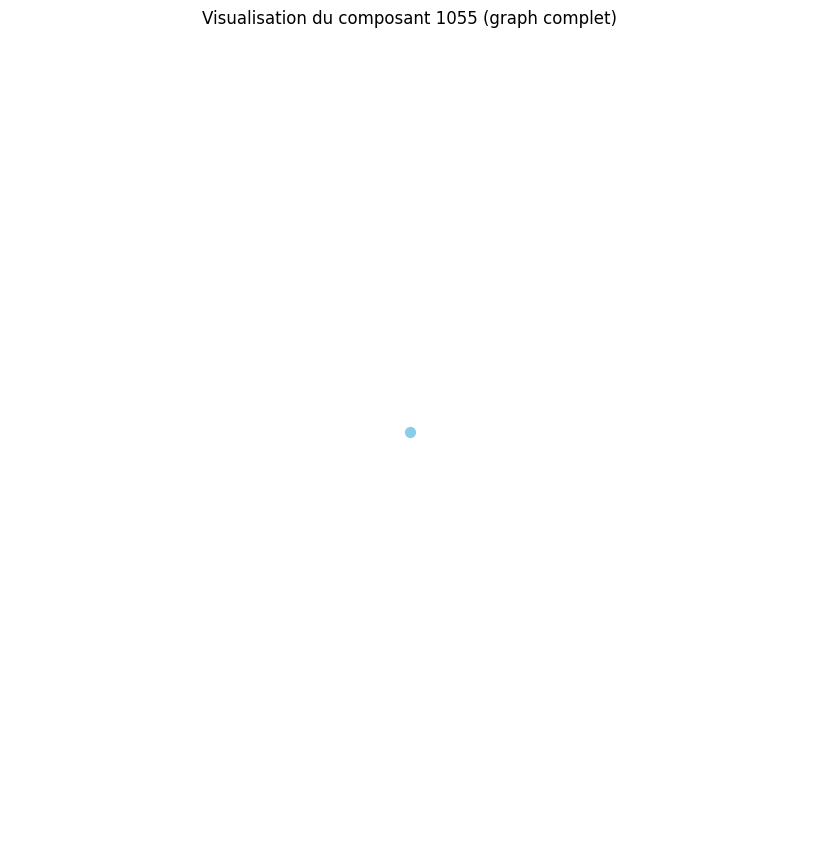

Distance moyenne pour le composant 1056 : 0.00
Le composant 1056 est un graphe complet ou très densément connecté.
Densité du composant 1056 : 0.00
Degré moyen du composant 1056 : 0.00
Coefficient de clustering moyen du composant 1056 : 0.00


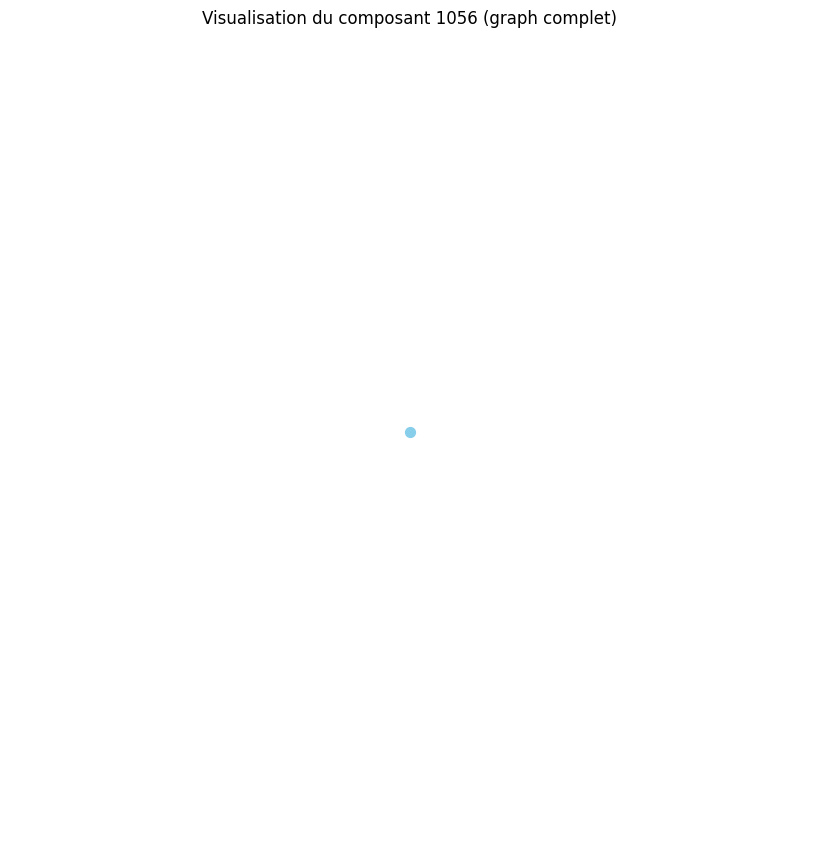

Distance moyenne pour le composant 1057 : 0.00
Le composant 1057 est un graphe complet ou très densément connecté.
Densité du composant 1057 : 0.00
Degré moyen du composant 1057 : 0.00
Coefficient de clustering moyen du composant 1057 : 0.00


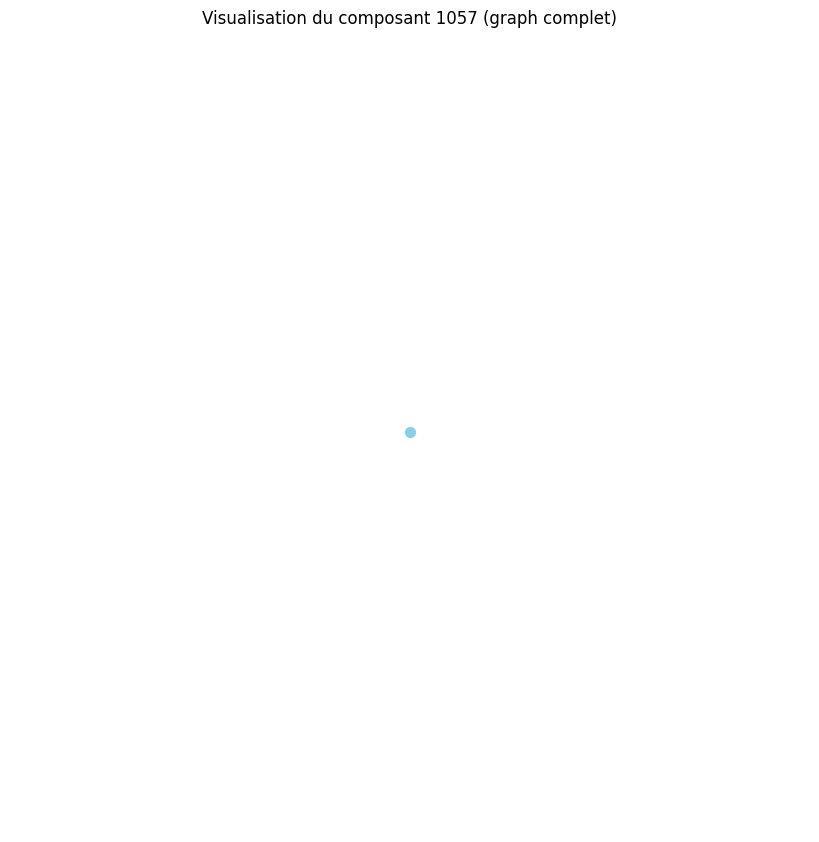

Distance moyenne pour le composant 1058 : 0.00
Le composant 1058 est un graphe complet ou très densément connecté.
Densité du composant 1058 : 0.00
Degré moyen du composant 1058 : 0.00
Coefficient de clustering moyen du composant 1058 : 0.00


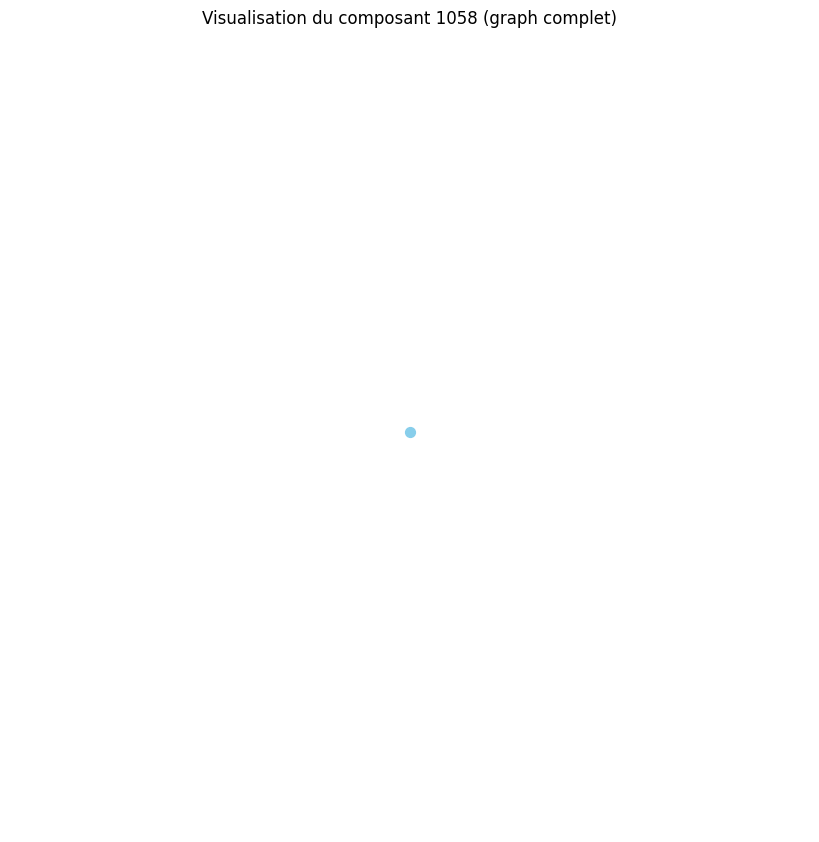

Distance moyenne pour le composant 1059 : 0.00
Le composant 1059 est un graphe complet ou très densément connecté.
Densité du composant 1059 : 0.00
Degré moyen du composant 1059 : 0.00
Coefficient de clustering moyen du composant 1059 : 0.00


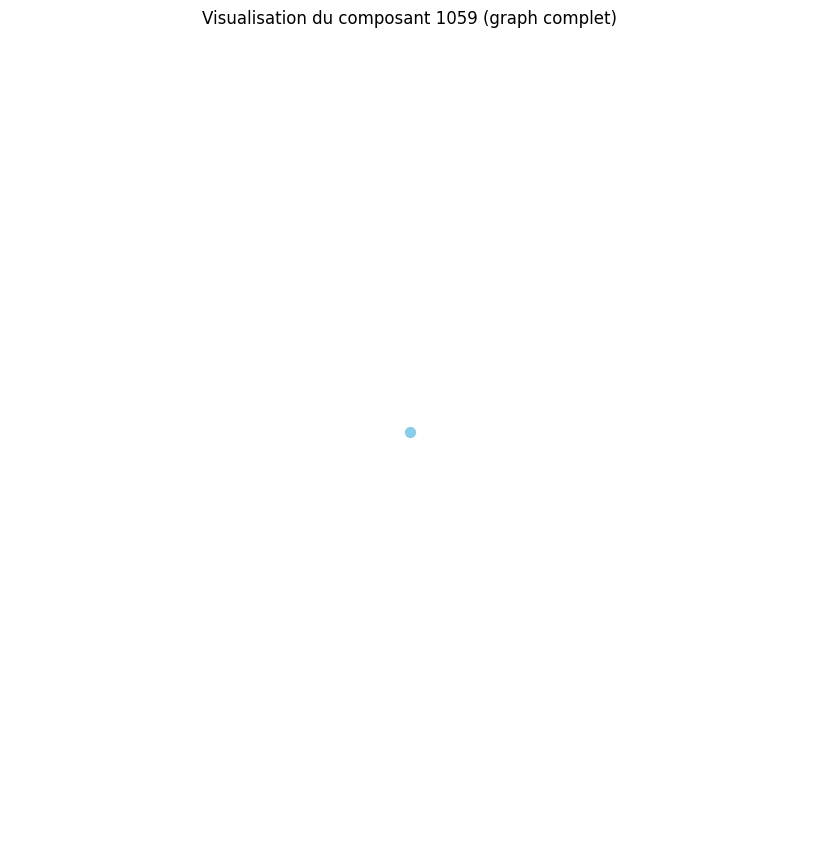

Distance moyenne pour le composant 1060 : 0.00
Le composant 1060 est un graphe complet ou très densément connecté.
Densité du composant 1060 : 0.00
Degré moyen du composant 1060 : 0.00
Coefficient de clustering moyen du composant 1060 : 0.00


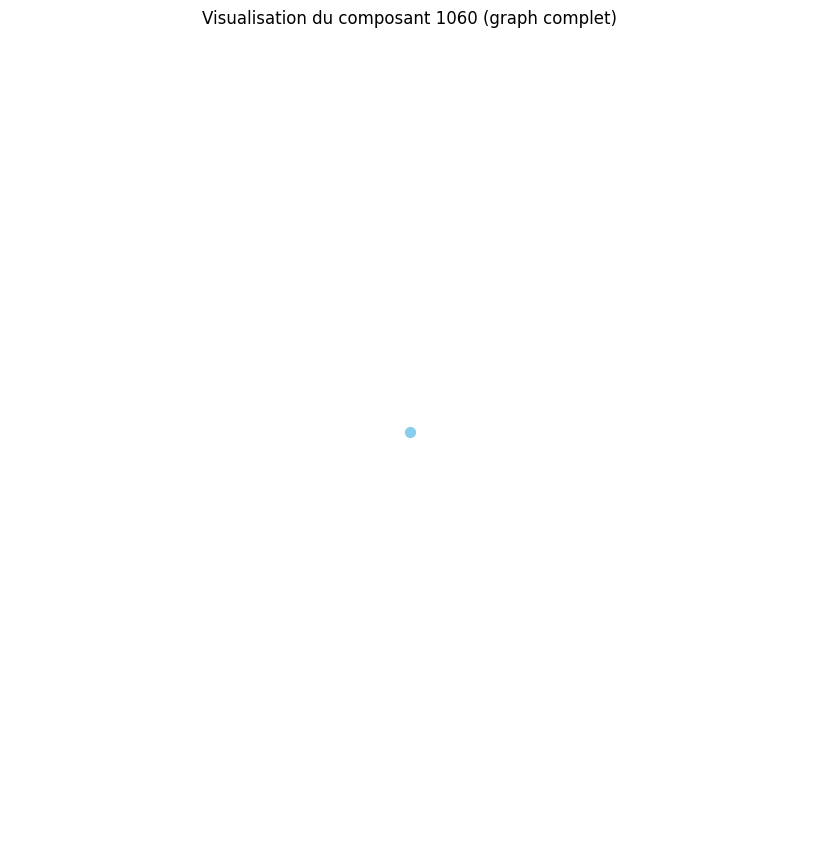

Distance moyenne pour le composant 1061 : 0.00
Le composant 1061 est un graphe complet ou très densément connecté.
Densité du composant 1061 : 0.00
Degré moyen du composant 1061 : 0.00
Coefficient de clustering moyen du composant 1061 : 0.00


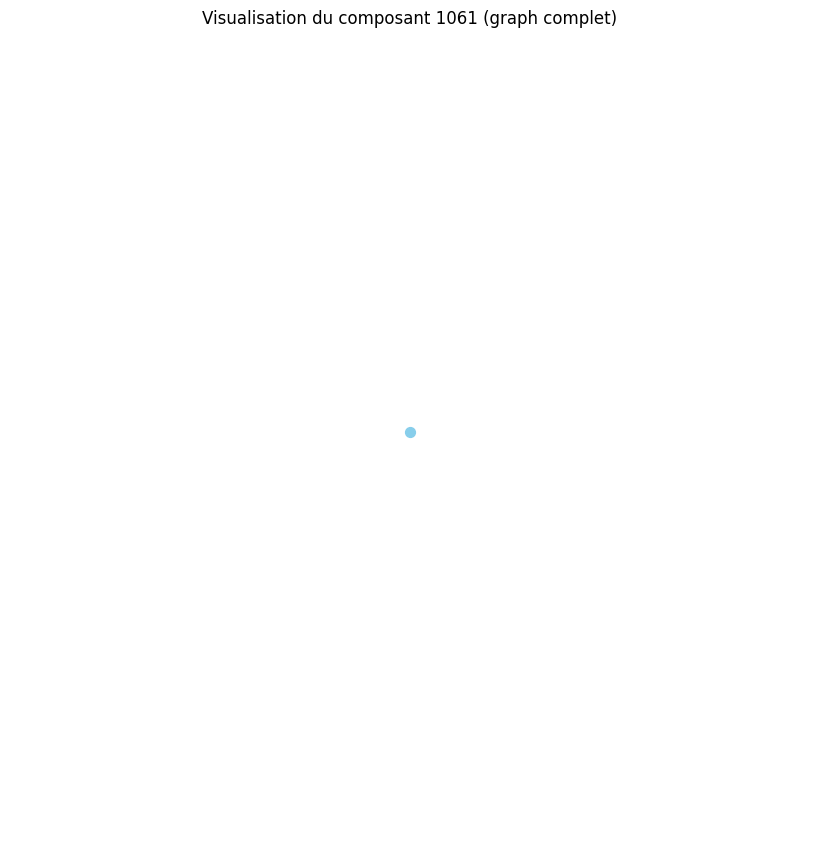

Distance moyenne pour le composant 1062 : 0.00
Le composant 1062 est un graphe complet ou très densément connecté.
Densité du composant 1062 : 0.00
Degré moyen du composant 1062 : 0.00
Coefficient de clustering moyen du composant 1062 : 0.00


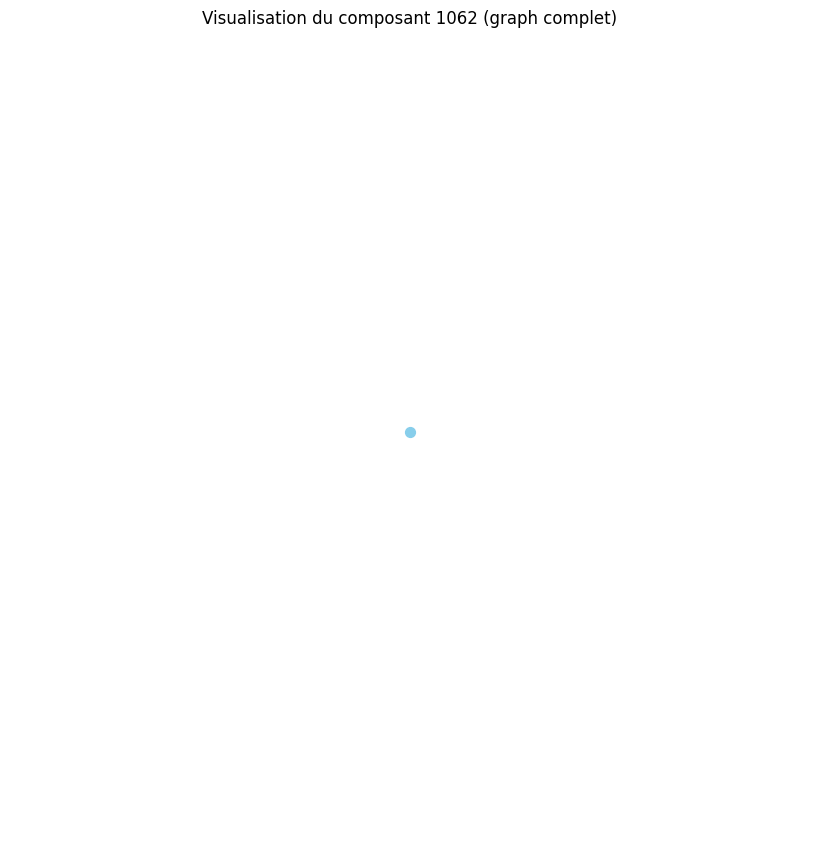

Distance moyenne pour le composant 1063 : 0.00
Le composant 1063 est un graphe complet ou très densément connecté.
Densité du composant 1063 : 0.00
Degré moyen du composant 1063 : 0.00
Coefficient de clustering moyen du composant 1063 : 0.00


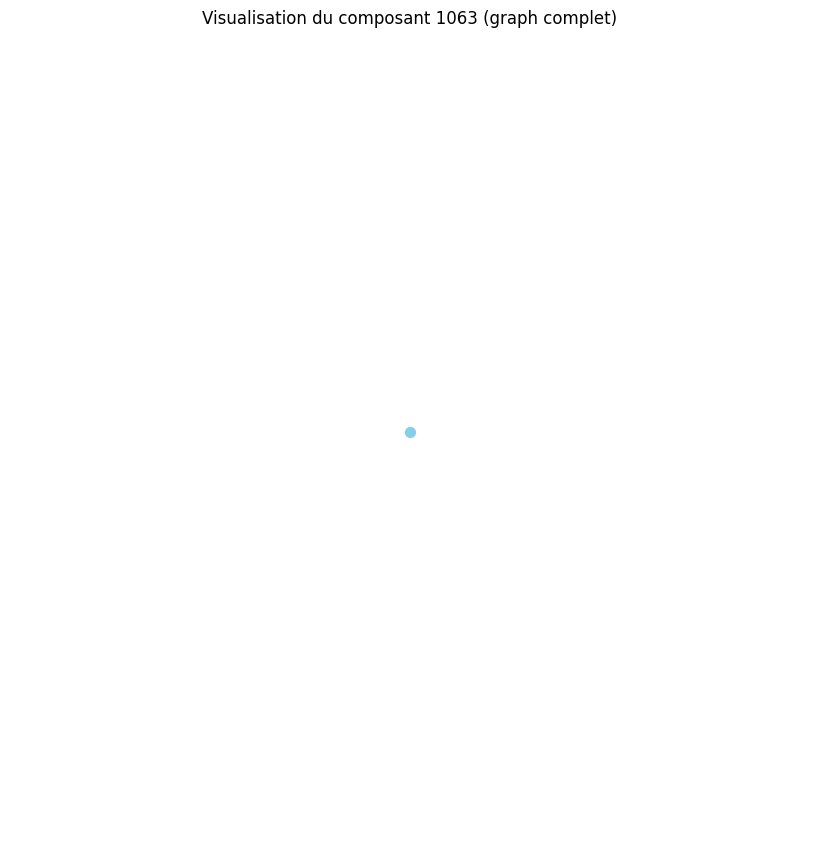

Distance moyenne pour le composant 1064 : 0.00
Le composant 1064 est un graphe complet ou très densément connecté.
Densité du composant 1064 : 0.00
Degré moyen du composant 1064 : 0.00
Coefficient de clustering moyen du composant 1064 : 0.00


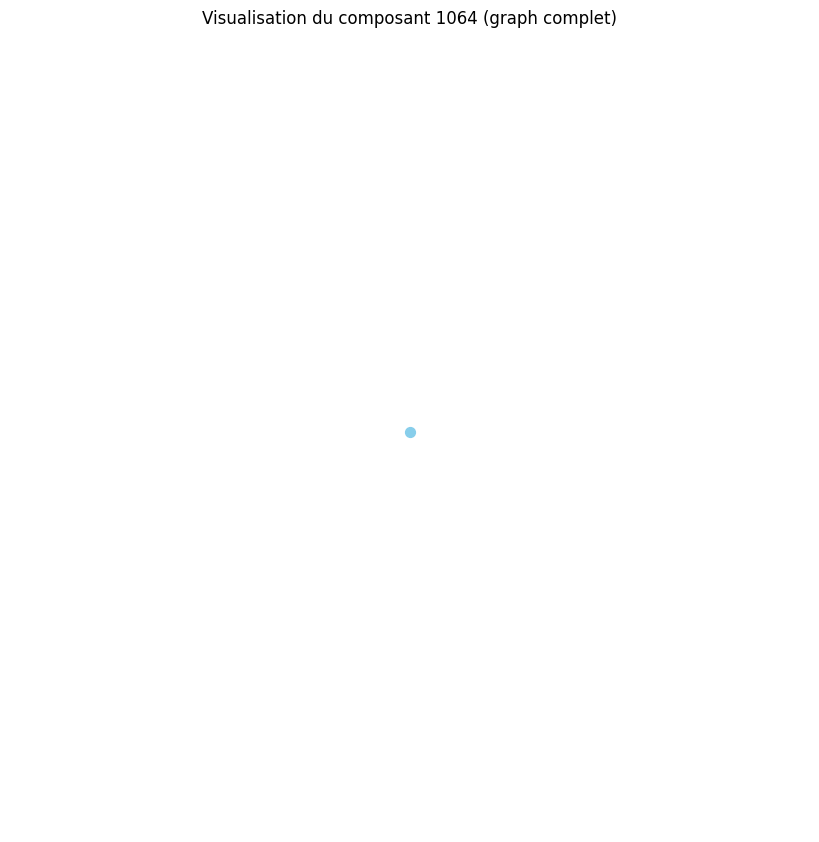

Distance moyenne pour le composant 1065 : 1.00
Distance moyenne pour le composant 1066 : 1.00
Distance moyenne pour le composant 1067 : 0.00
Le composant 1067 est un graphe complet ou très densément connecté.
Densité du composant 1067 : 0.00
Degré moyen du composant 1067 : 0.00
Coefficient de clustering moyen du composant 1067 : 0.00


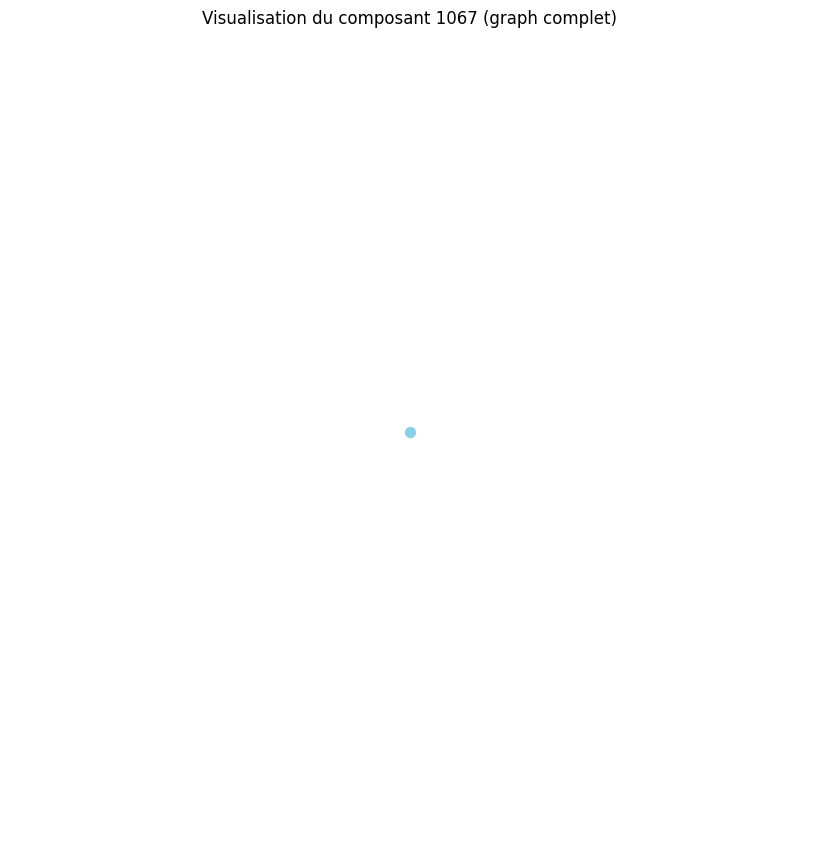

Distance moyenne pour le composant 1068 : 0.00
Le composant 1068 est un graphe complet ou très densément connecté.
Densité du composant 1068 : 0.00
Degré moyen du composant 1068 : 0.00
Coefficient de clustering moyen du composant 1068 : 0.00


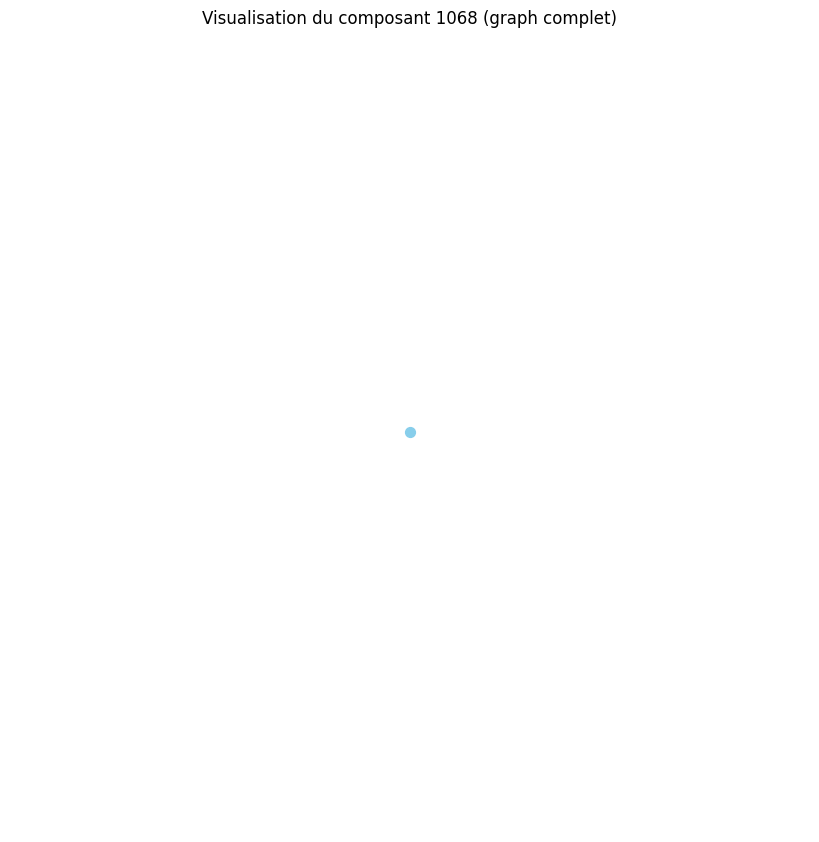

Distance moyenne pour le composant 1069 : 0.00
Le composant 1069 est un graphe complet ou très densément connecté.
Densité du composant 1069 : 0.00
Degré moyen du composant 1069 : 0.00
Coefficient de clustering moyen du composant 1069 : 0.00


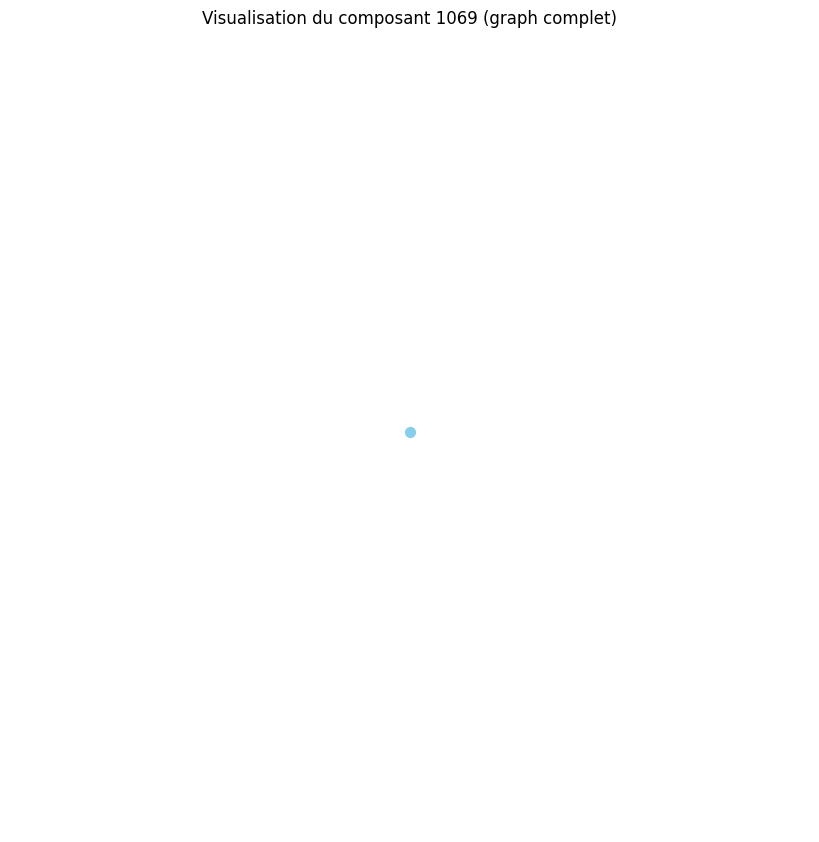

Distance moyenne pour le composant 1070 : 0.00
Le composant 1070 est un graphe complet ou très densément connecté.
Densité du composant 1070 : 0.00
Degré moyen du composant 1070 : 0.00
Coefficient de clustering moyen du composant 1070 : 0.00


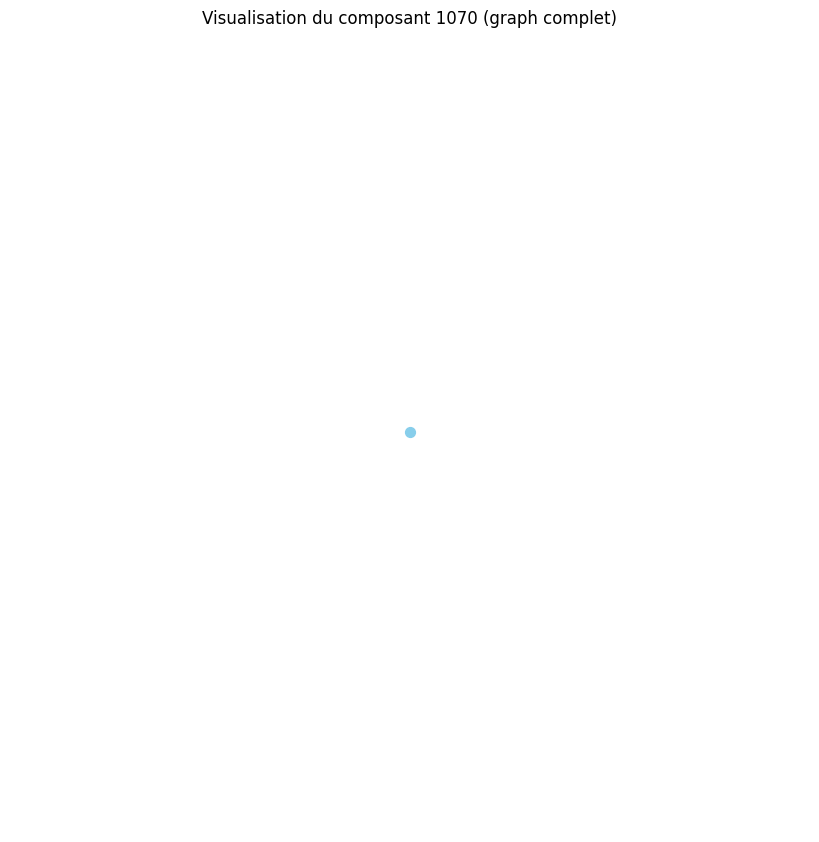

Distance moyenne pour le composant 1071 : 0.00
Le composant 1071 est un graphe complet ou très densément connecté.
Densité du composant 1071 : 0.00
Degré moyen du composant 1071 : 0.00
Coefficient de clustering moyen du composant 1071 : 0.00


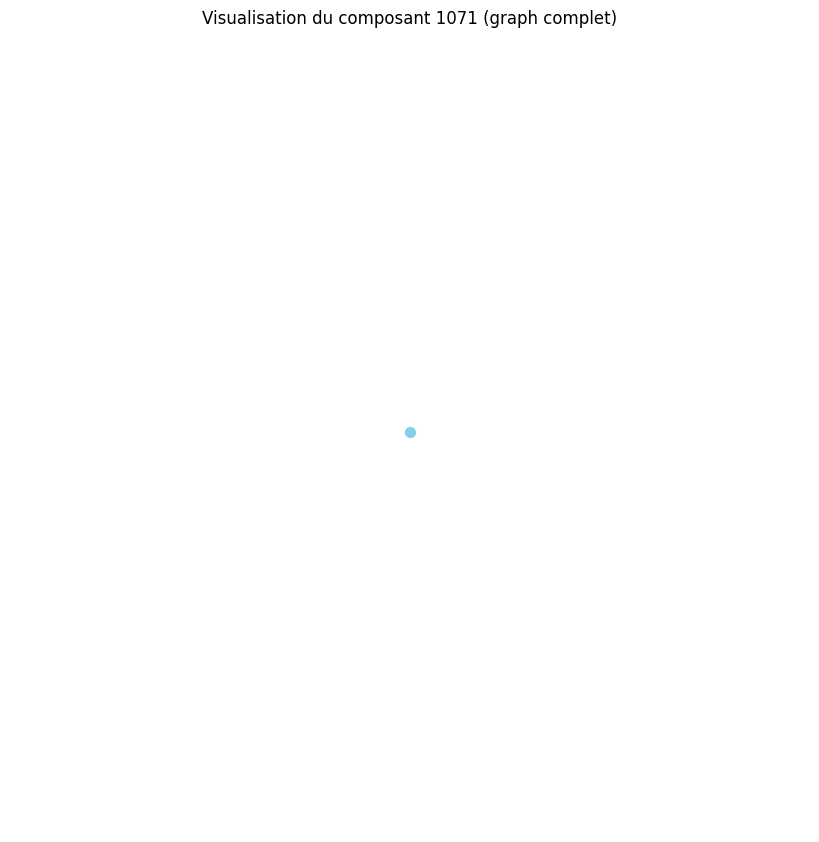

Distance moyenne pour le composant 1072 : 0.00
Le composant 1072 est un graphe complet ou très densément connecté.
Densité du composant 1072 : 0.00
Degré moyen du composant 1072 : 0.00
Coefficient de clustering moyen du composant 1072 : 0.00


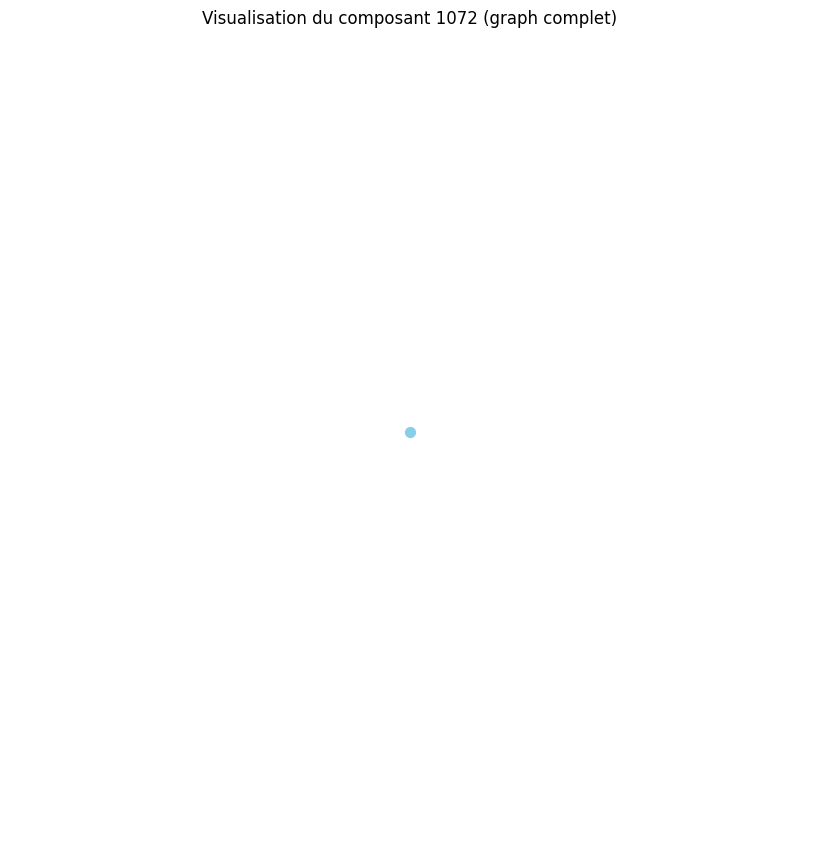

Distance moyenne pour le composant 1073 : 0.00
Le composant 1073 est un graphe complet ou très densément connecté.
Densité du composant 1073 : 0.00
Degré moyen du composant 1073 : 0.00
Coefficient de clustering moyen du composant 1073 : 0.00


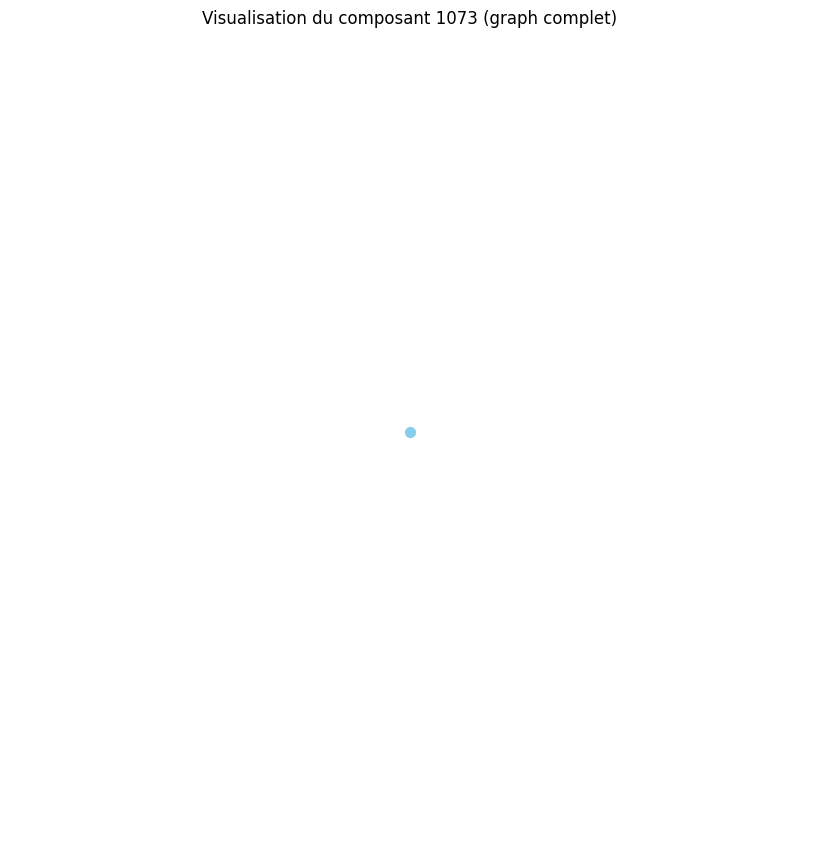

Distance moyenne pour le composant 1074 : 0.00
Le composant 1074 est un graphe complet ou très densément connecté.
Densité du composant 1074 : 0.00
Degré moyen du composant 1074 : 0.00
Coefficient de clustering moyen du composant 1074 : 0.00


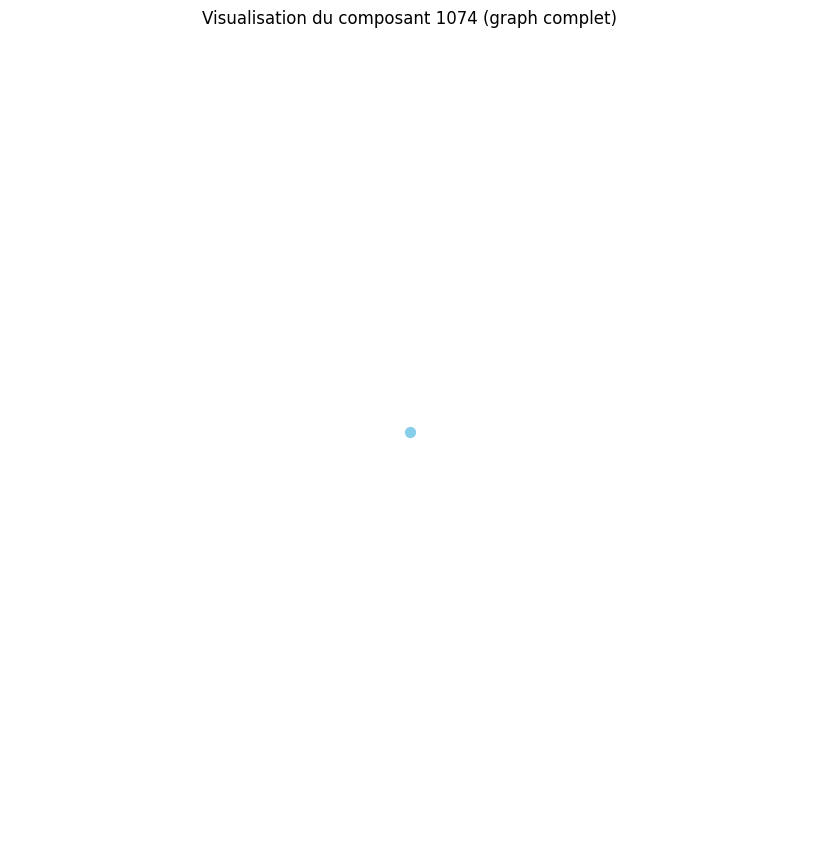

Distance moyenne pour le composant 1075 : 0.00
Le composant 1075 est un graphe complet ou très densément connecté.
Densité du composant 1075 : 0.00
Degré moyen du composant 1075 : 0.00
Coefficient de clustering moyen du composant 1075 : 0.00


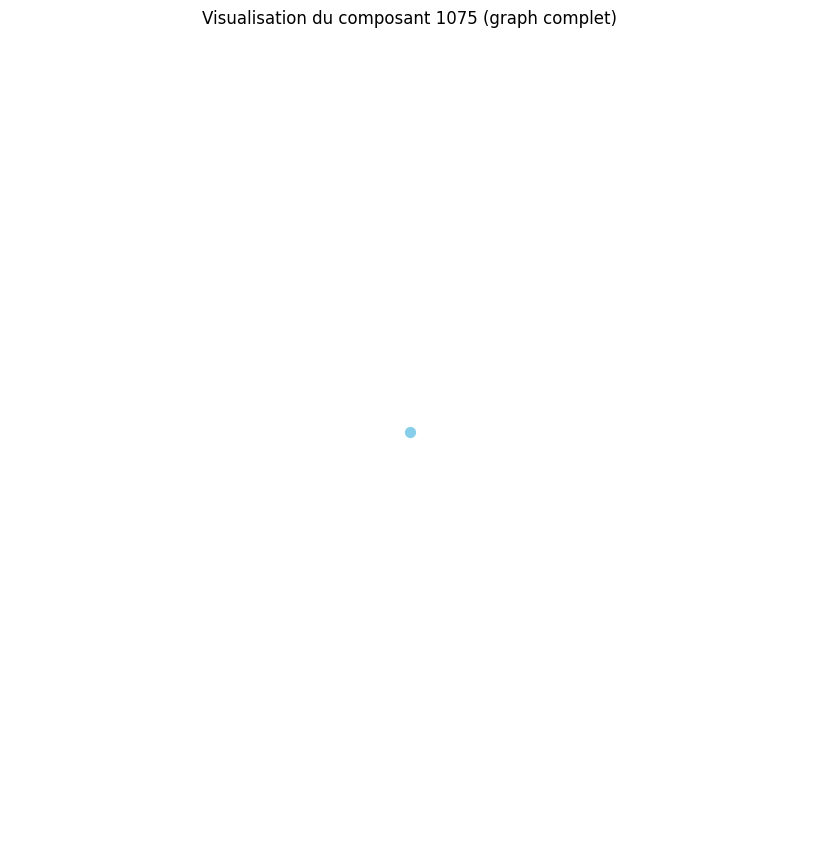

Distance moyenne pour le composant 1076 : 0.00
Le composant 1076 est un graphe complet ou très densément connecté.
Densité du composant 1076 : 0.00
Degré moyen du composant 1076 : 0.00
Coefficient de clustering moyen du composant 1076 : 0.00


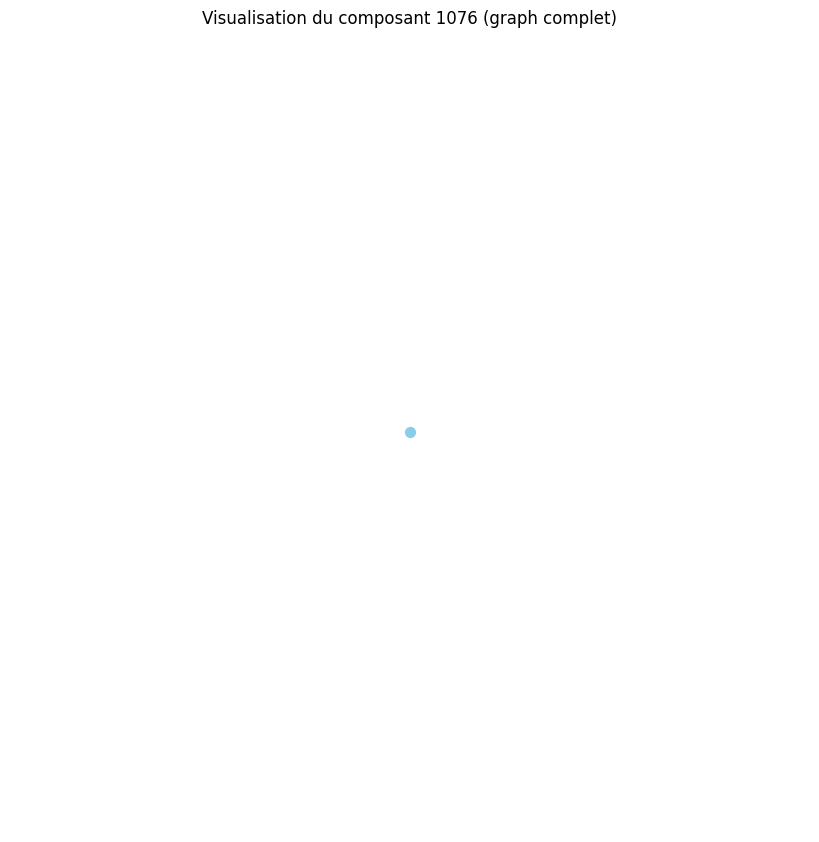

Distance moyenne pour le composant 1077 : 0.00
Le composant 1077 est un graphe complet ou très densément connecté.
Densité du composant 1077 : 0.00
Degré moyen du composant 1077 : 0.00
Coefficient de clustering moyen du composant 1077 : 0.00


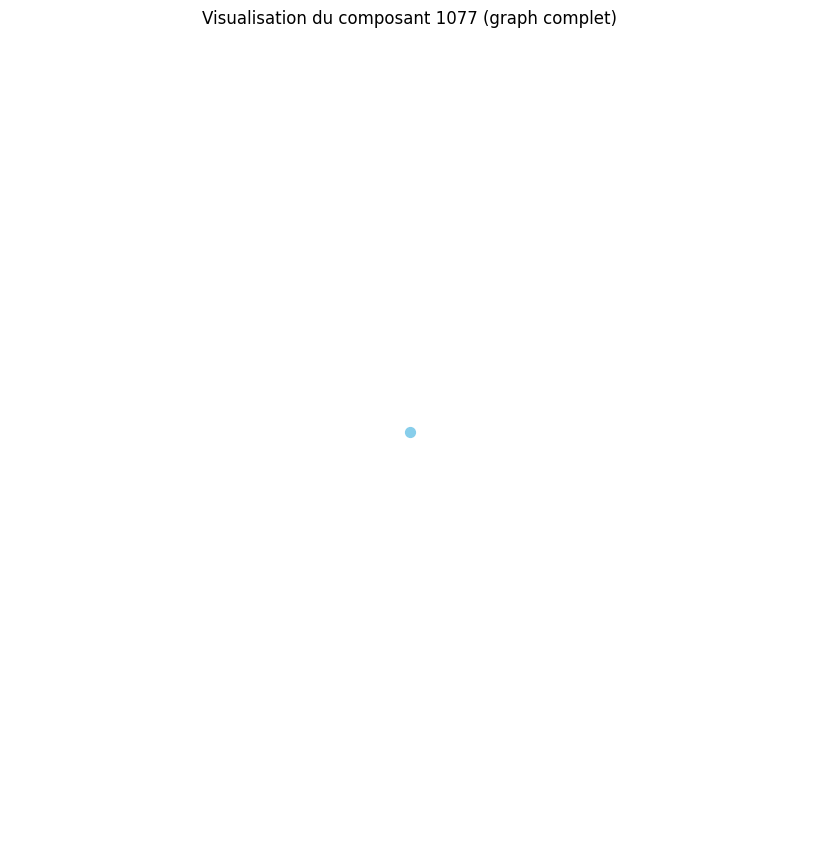

Distance moyenne pour le composant 1078 : 0.00
Le composant 1078 est un graphe complet ou très densément connecté.
Densité du composant 1078 : 0.00
Degré moyen du composant 1078 : 0.00
Coefficient de clustering moyen du composant 1078 : 0.00


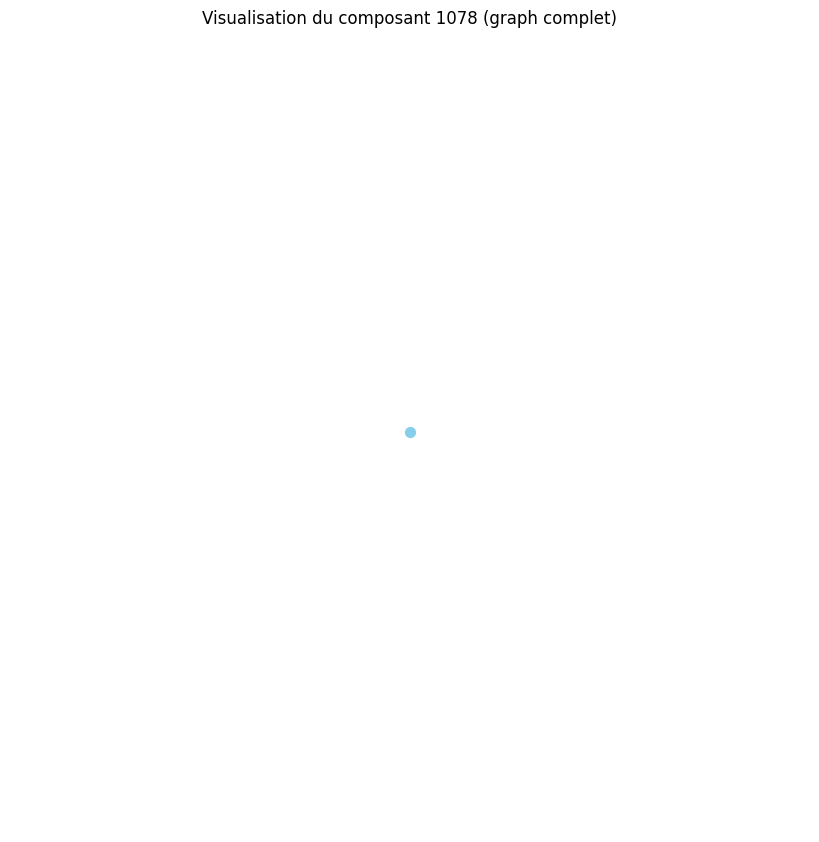

Distance moyenne pour le composant 1079 : 0.00
Le composant 1079 est un graphe complet ou très densément connecté.
Densité du composant 1079 : 0.00
Degré moyen du composant 1079 : 0.00
Coefficient de clustering moyen du composant 1079 : 0.00


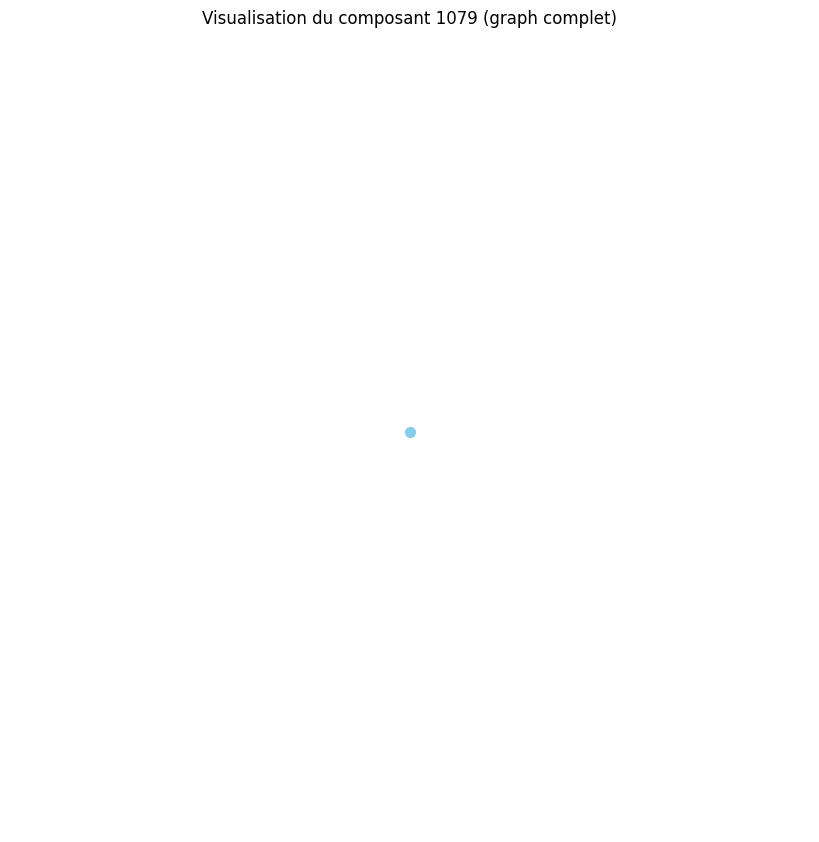

Distance moyenne pour le composant 1080 : 0.00
Le composant 1080 est un graphe complet ou très densément connecté.
Densité du composant 1080 : 0.00
Degré moyen du composant 1080 : 0.00
Coefficient de clustering moyen du composant 1080 : 0.00


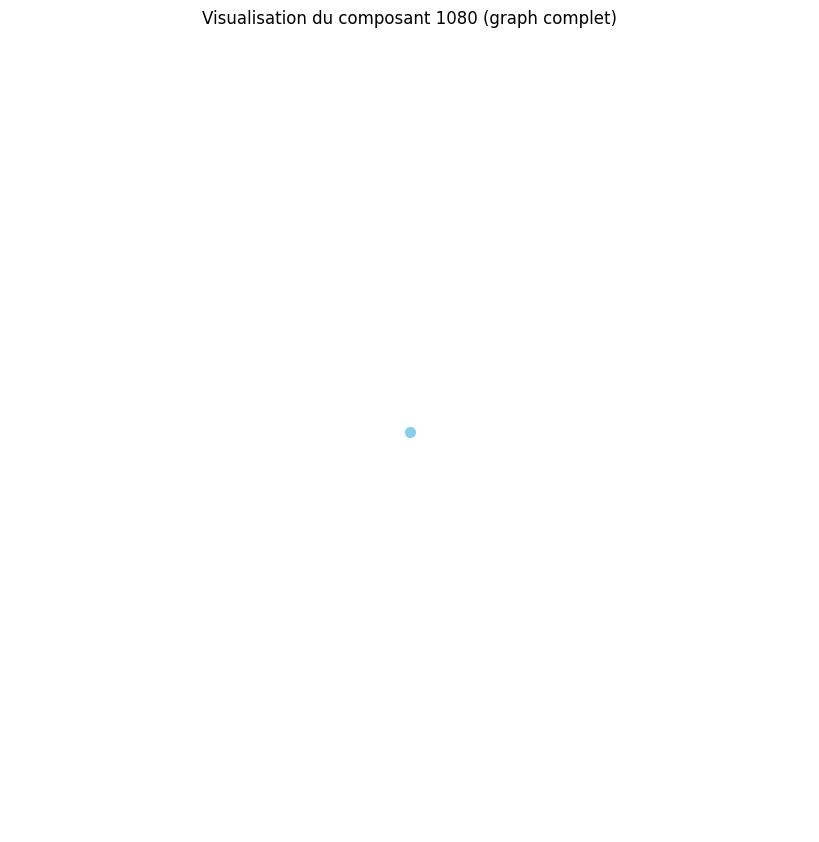

Distance moyenne pour le composant 1081 : 0.00
Le composant 1081 est un graphe complet ou très densément connecté.
Densité du composant 1081 : 0.00
Degré moyen du composant 1081 : 0.00
Coefficient de clustering moyen du composant 1081 : 0.00


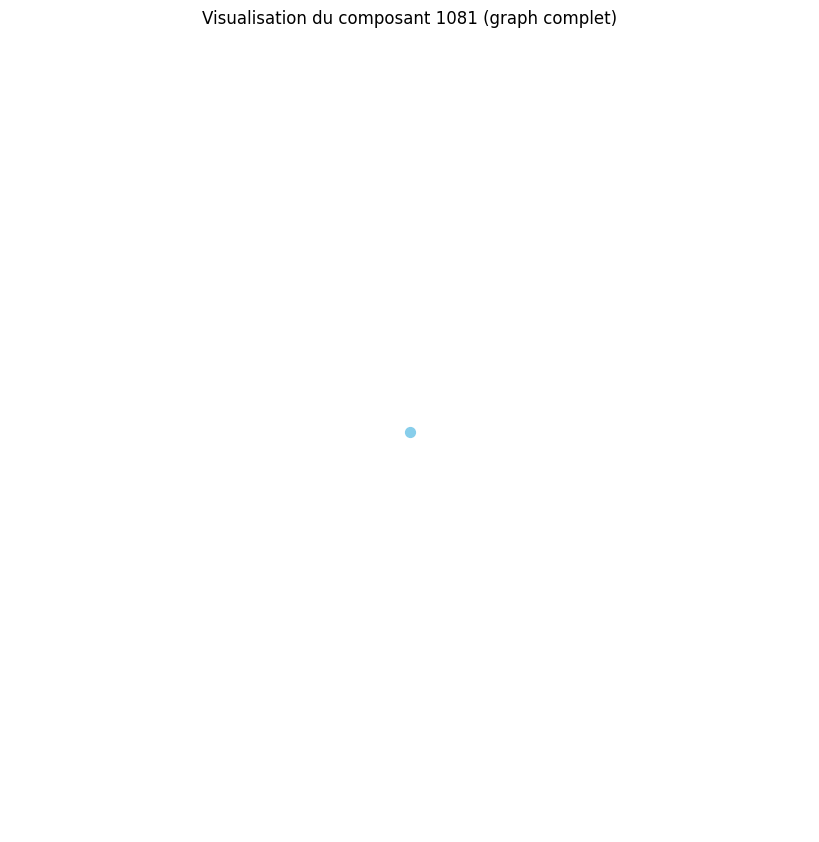

Distance moyenne pour le composant 1082 : 0.00
Le composant 1082 est un graphe complet ou très densément connecté.
Densité du composant 1082 : 0.00
Degré moyen du composant 1082 : 0.00
Coefficient de clustering moyen du composant 1082 : 0.00


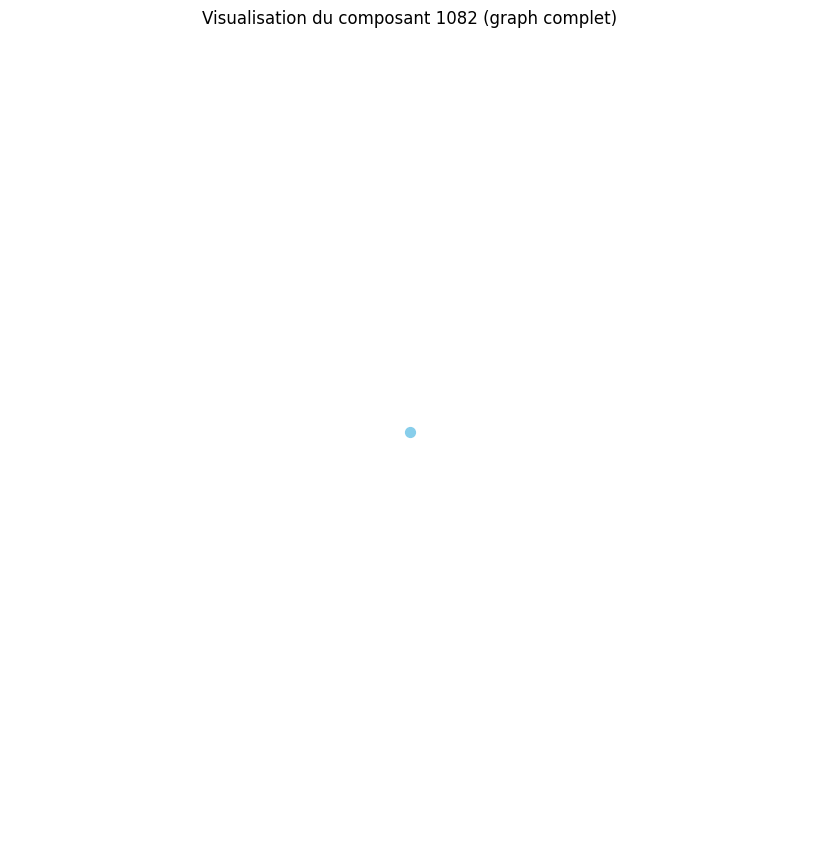

Distance moyenne pour le composant 1083 : 0.00
Le composant 1083 est un graphe complet ou très densément connecté.
Densité du composant 1083 : 0.00
Degré moyen du composant 1083 : 0.00
Coefficient de clustering moyen du composant 1083 : 0.00


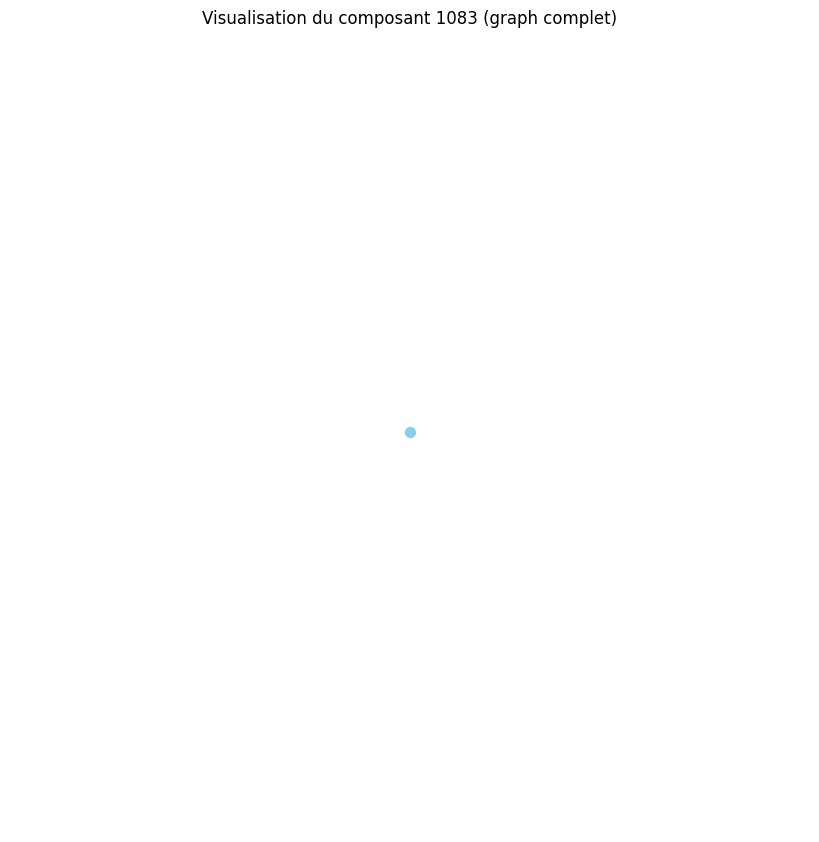

Distance moyenne pour le composant 1084 : 0.00
Le composant 1084 est un graphe complet ou très densément connecté.
Densité du composant 1084 : 0.00
Degré moyen du composant 1084 : 0.00
Coefficient de clustering moyen du composant 1084 : 0.00


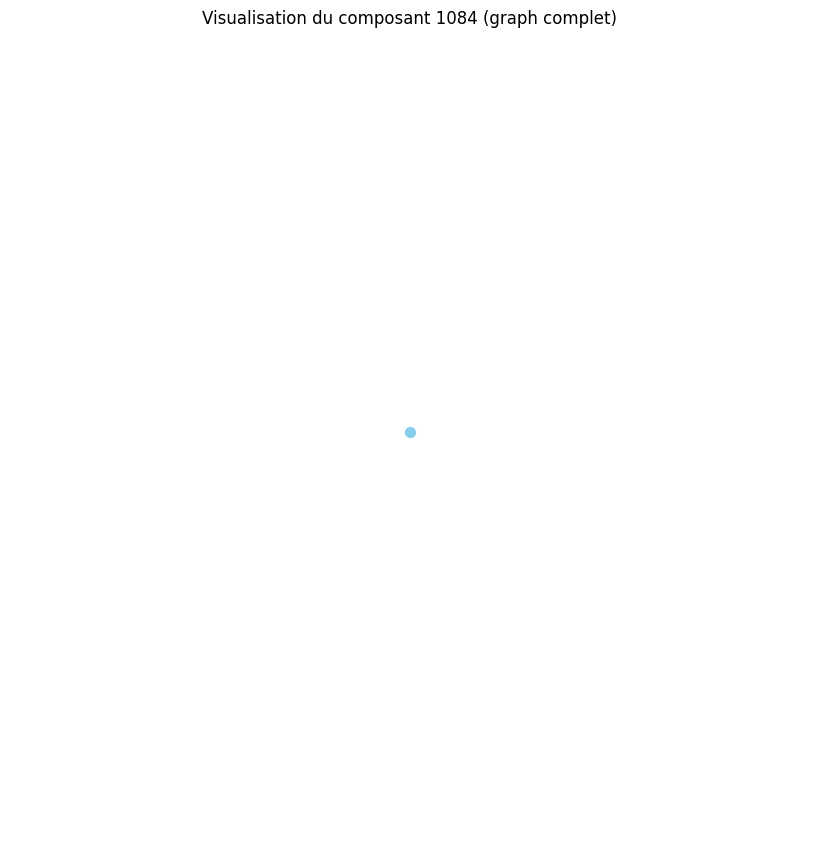

Distance moyenne pour le composant 1085 : 1.80
Distance moyenne pour le composant 1086 : 2.50
Distance moyenne pour le composant 1087 : 0.00
Le composant 1087 est un graphe complet ou très densément connecté.
Densité du composant 1087 : 0.00
Degré moyen du composant 1087 : 0.00
Coefficient de clustering moyen du composant 1087 : 0.00


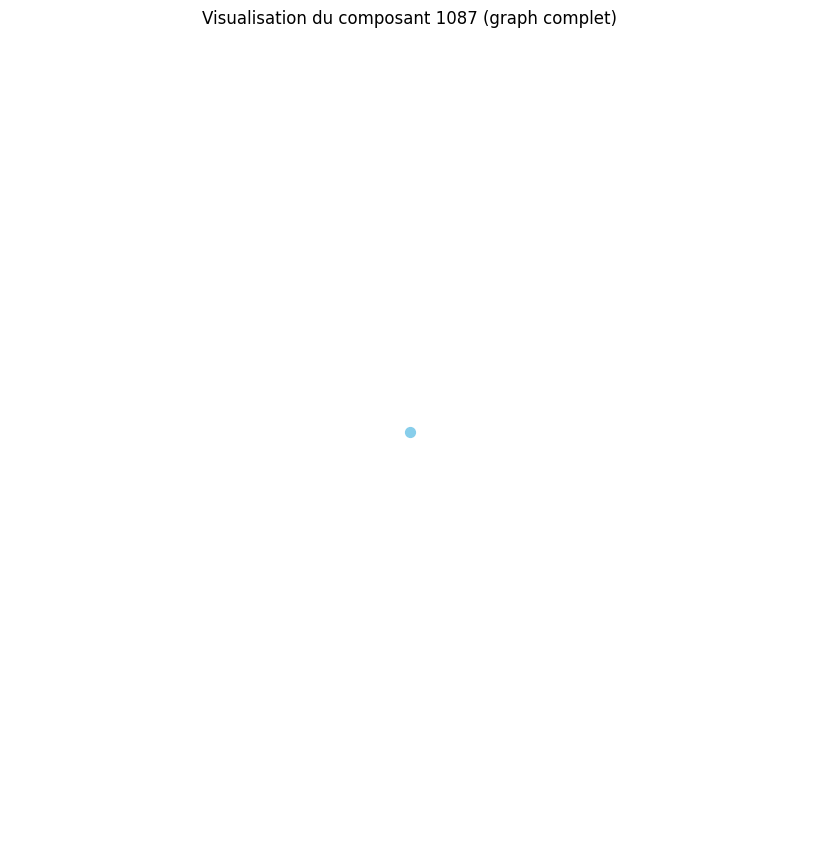

Distance moyenne pour le composant 1088 : 0.00
Le composant 1088 est un graphe complet ou très densément connecté.
Densité du composant 1088 : 0.00
Degré moyen du composant 1088 : 0.00
Coefficient de clustering moyen du composant 1088 : 0.00


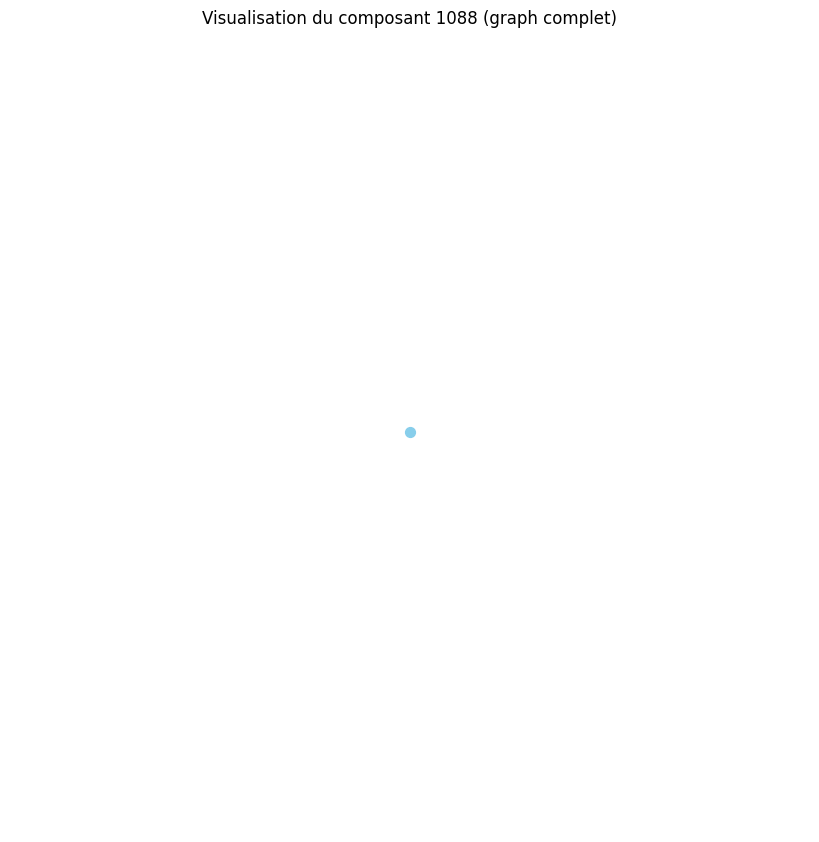

Distance moyenne pour le composant 1089 : 0.00
Le composant 1089 est un graphe complet ou très densément connecté.
Densité du composant 1089 : 0.00
Degré moyen du composant 1089 : 0.00
Coefficient de clustering moyen du composant 1089 : 0.00


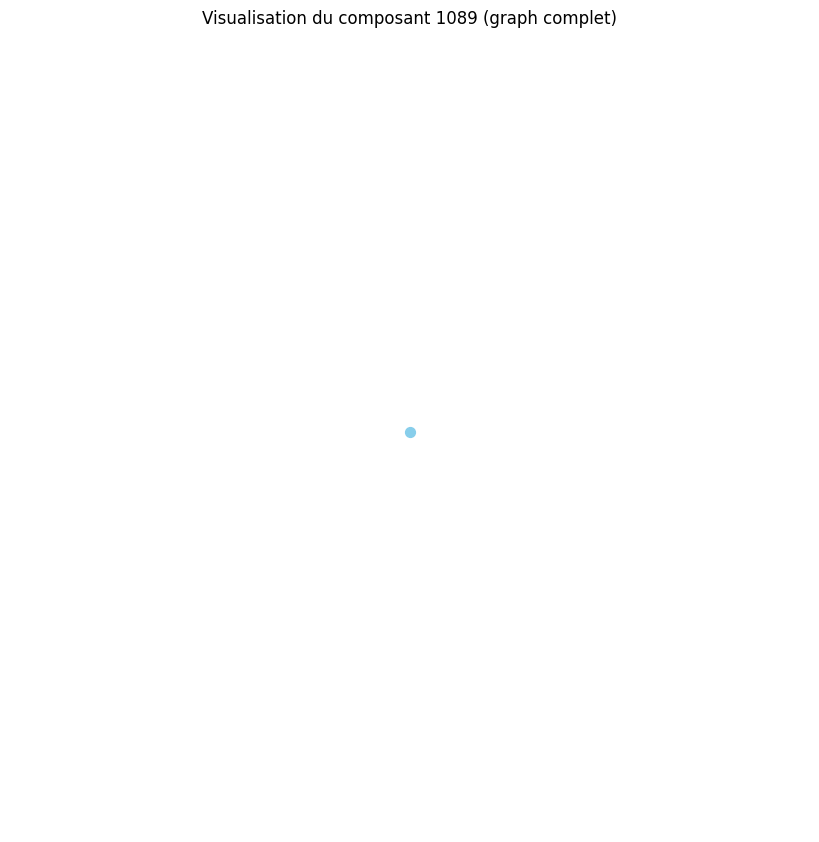

Distance moyenne pour le composant 1090 : 0.00
Le composant 1090 est un graphe complet ou très densément connecté.
Densité du composant 1090 : 0.00
Degré moyen du composant 1090 : 0.00
Coefficient de clustering moyen du composant 1090 : 0.00


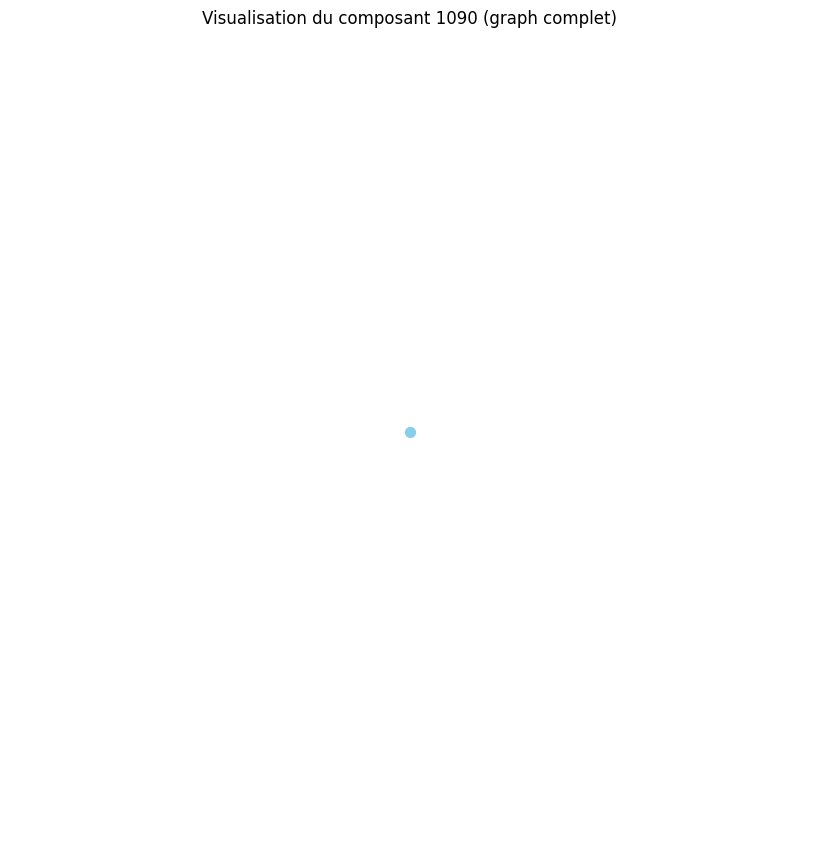

Distance moyenne pour le composant 1091 : 0.00
Le composant 1091 est un graphe complet ou très densément connecté.
Densité du composant 1091 : 0.00
Degré moyen du composant 1091 : 0.00
Coefficient de clustering moyen du composant 1091 : 0.00


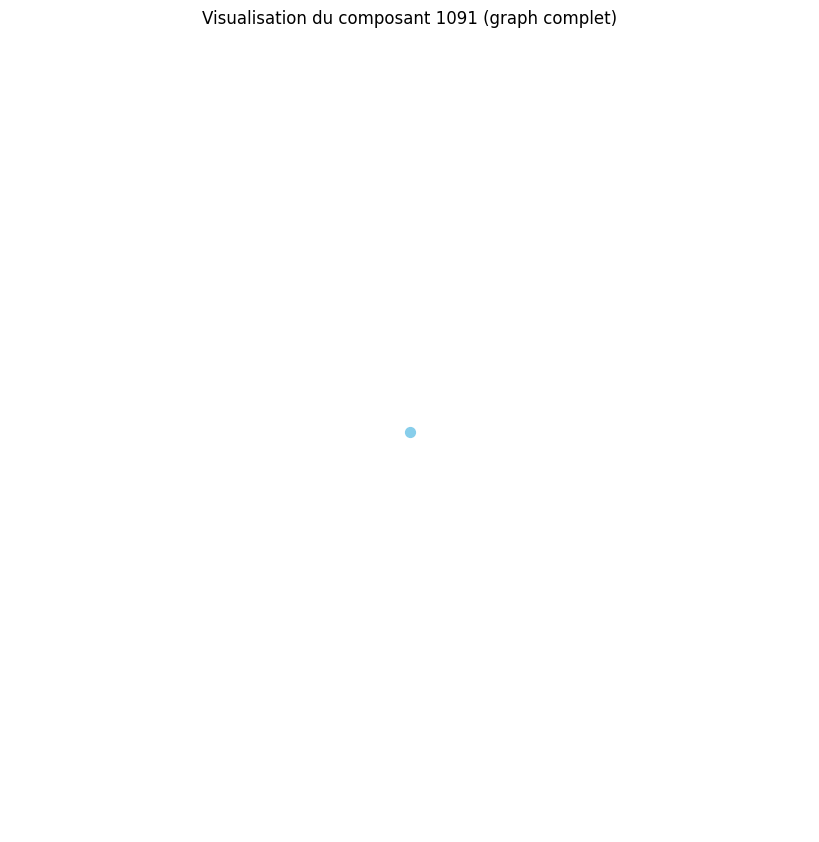

Distance moyenne pour le composant 1092 : 0.00
Le composant 1092 est un graphe complet ou très densément connecté.
Densité du composant 1092 : 0.00
Degré moyen du composant 1092 : 0.00
Coefficient de clustering moyen du composant 1092 : 0.00


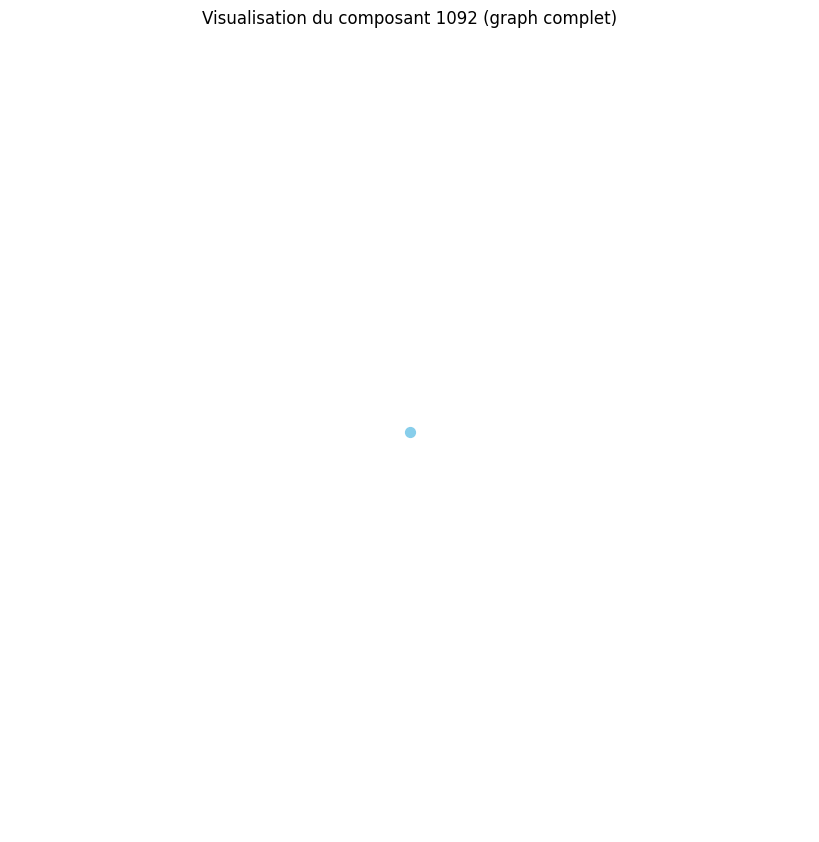

Distance moyenne pour le composant 1093 : 0.00
Le composant 1093 est un graphe complet ou très densément connecté.
Densité du composant 1093 : 0.00
Degré moyen du composant 1093 : 0.00
Coefficient de clustering moyen du composant 1093 : 0.00


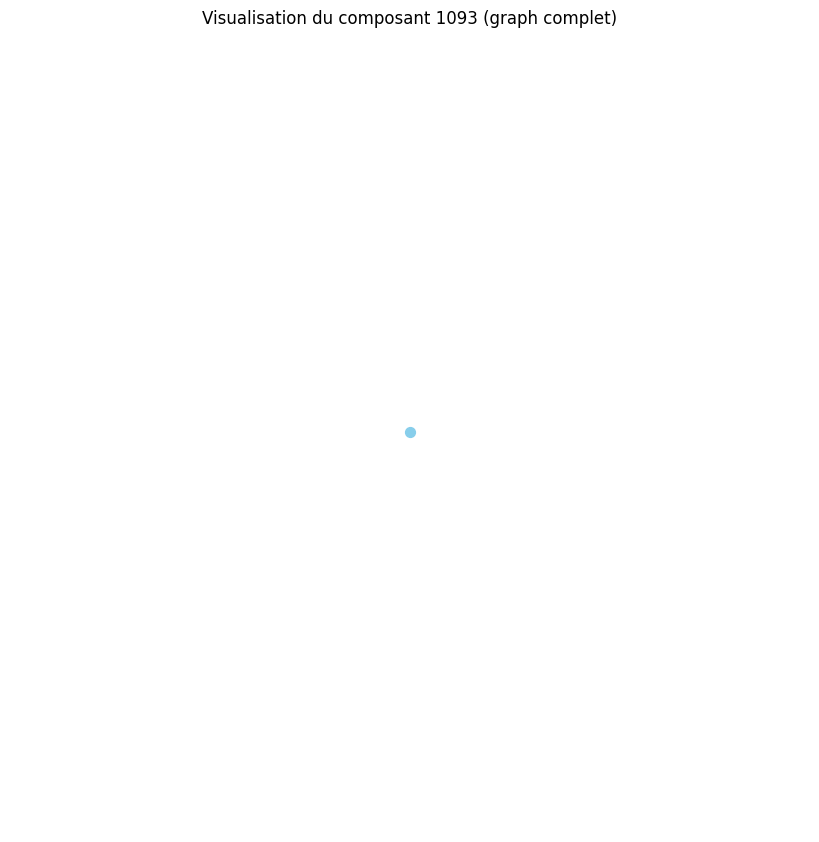

Distance moyenne pour le composant 1094 : 0.00
Le composant 1094 est un graphe complet ou très densément connecté.
Densité du composant 1094 : 0.00
Degré moyen du composant 1094 : 0.00
Coefficient de clustering moyen du composant 1094 : 0.00


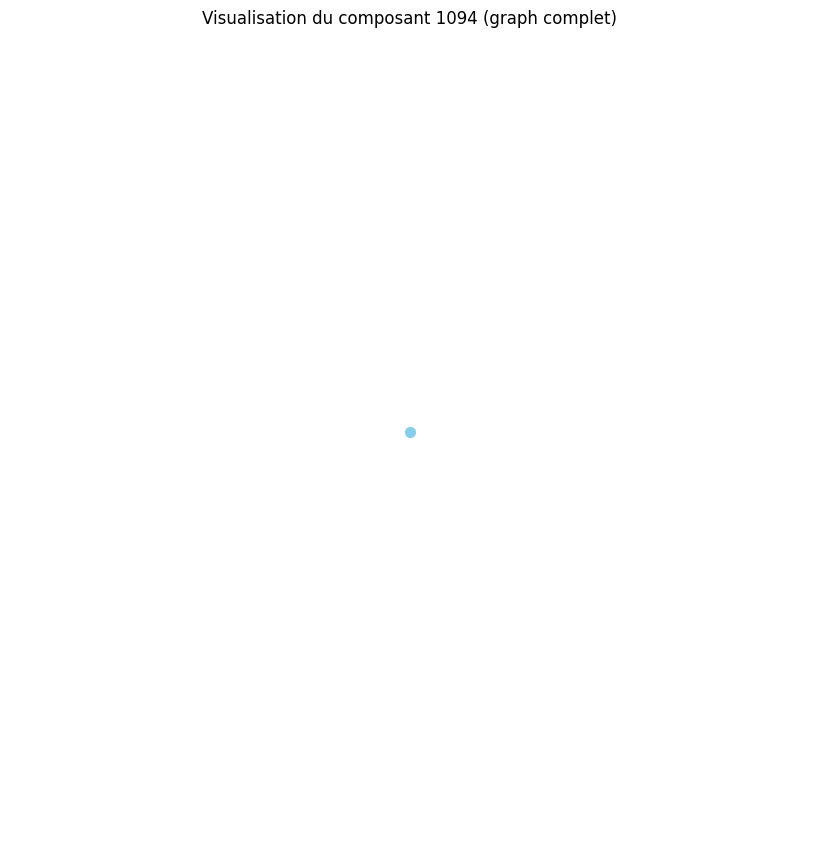

Distance moyenne pour le composant 1095 : 0.00
Le composant 1095 est un graphe complet ou très densément connecté.
Densité du composant 1095 : 0.00
Degré moyen du composant 1095 : 0.00
Coefficient de clustering moyen du composant 1095 : 0.00


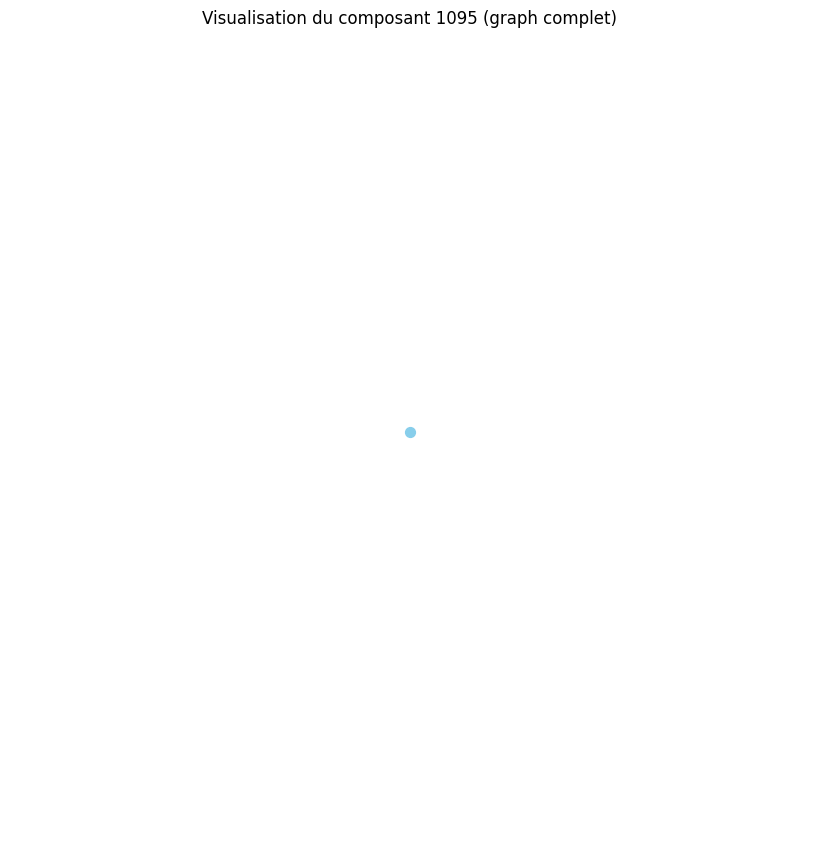

Distance moyenne pour le composant 1096 : 0.00
Le composant 1096 est un graphe complet ou très densément connecté.
Densité du composant 1096 : 0.00
Degré moyen du composant 1096 : 0.00
Coefficient de clustering moyen du composant 1096 : 0.00


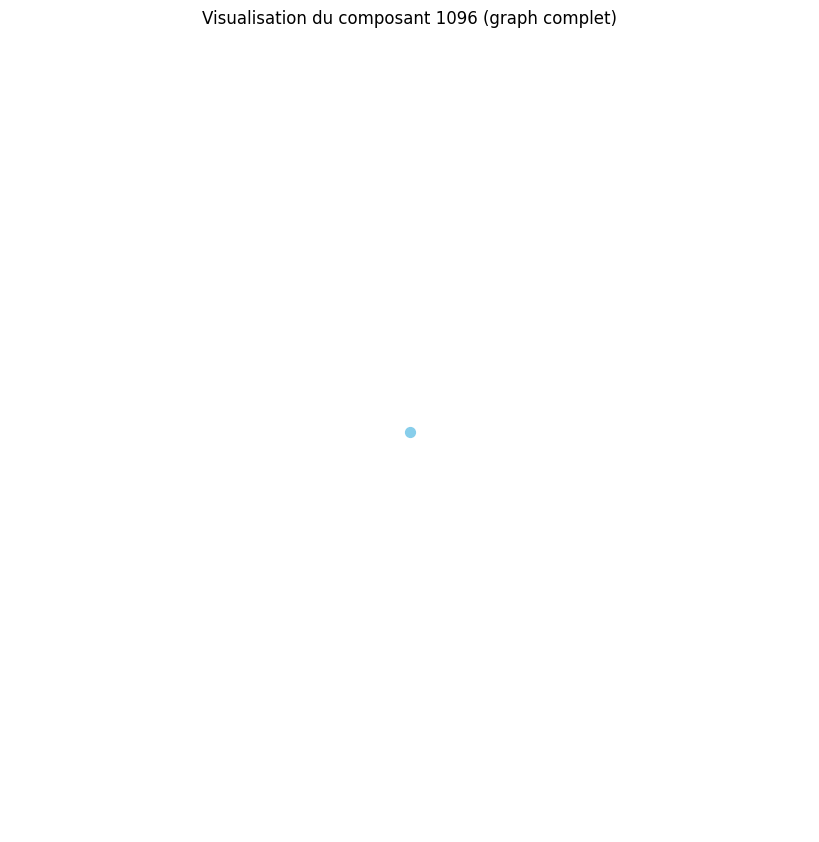

Distance moyenne pour le composant 1097 : 0.00
Le composant 1097 est un graphe complet ou très densément connecté.
Densité du composant 1097 : 0.00
Degré moyen du composant 1097 : 0.00
Coefficient de clustering moyen du composant 1097 : 0.00


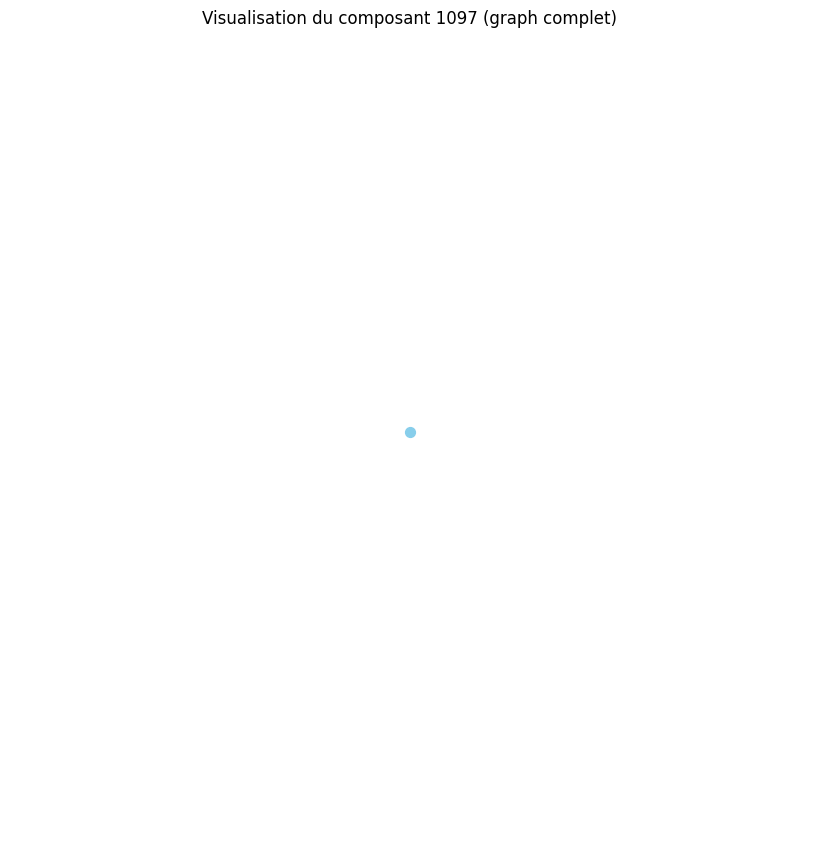

Distance moyenne pour le composant 1098 : 0.00
Le composant 1098 est un graphe complet ou très densément connecté.
Densité du composant 1098 : 0.00
Degré moyen du composant 1098 : 0.00
Coefficient de clustering moyen du composant 1098 : 0.00


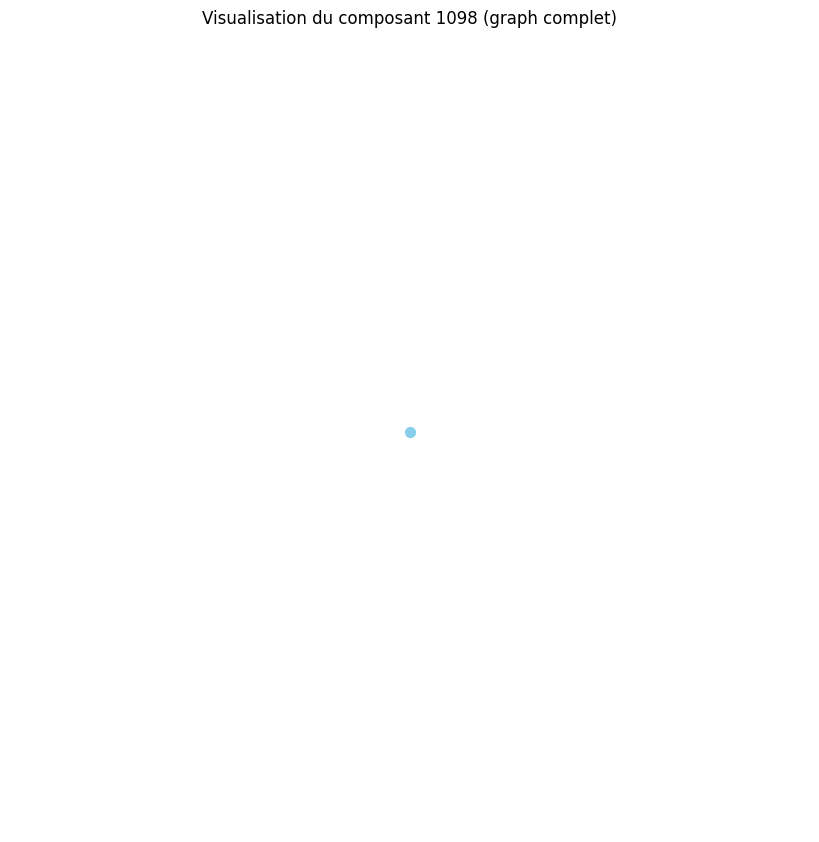

Distance moyenne pour le composant 1099 : 0.00
Le composant 1099 est un graphe complet ou très densément connecté.
Densité du composant 1099 : 0.00
Degré moyen du composant 1099 : 0.00
Coefficient de clustering moyen du composant 1099 : 0.00


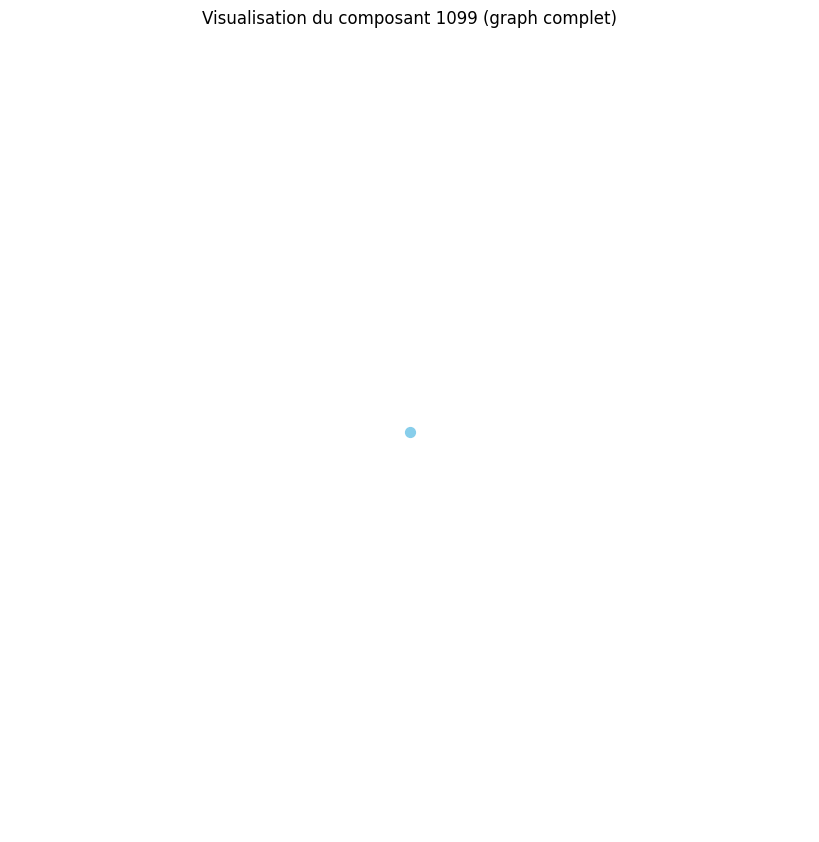

Distance moyenne pour le composant 1100 : 0.00
Le composant 1100 est un graphe complet ou très densément connecté.
Densité du composant 1100 : 0.00
Degré moyen du composant 1100 : 0.00
Coefficient de clustering moyen du composant 1100 : 0.00


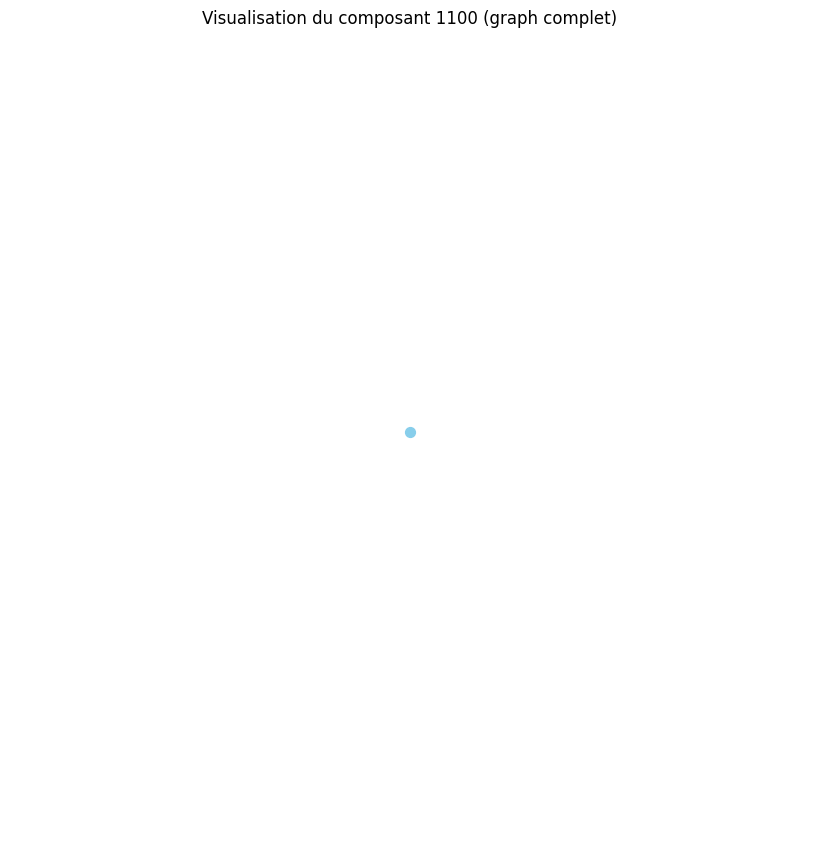

Distance moyenne pour le composant 1101 : 0.00
Le composant 1101 est un graphe complet ou très densément connecté.
Densité du composant 1101 : 0.00
Degré moyen du composant 1101 : 0.00
Coefficient de clustering moyen du composant 1101 : 0.00


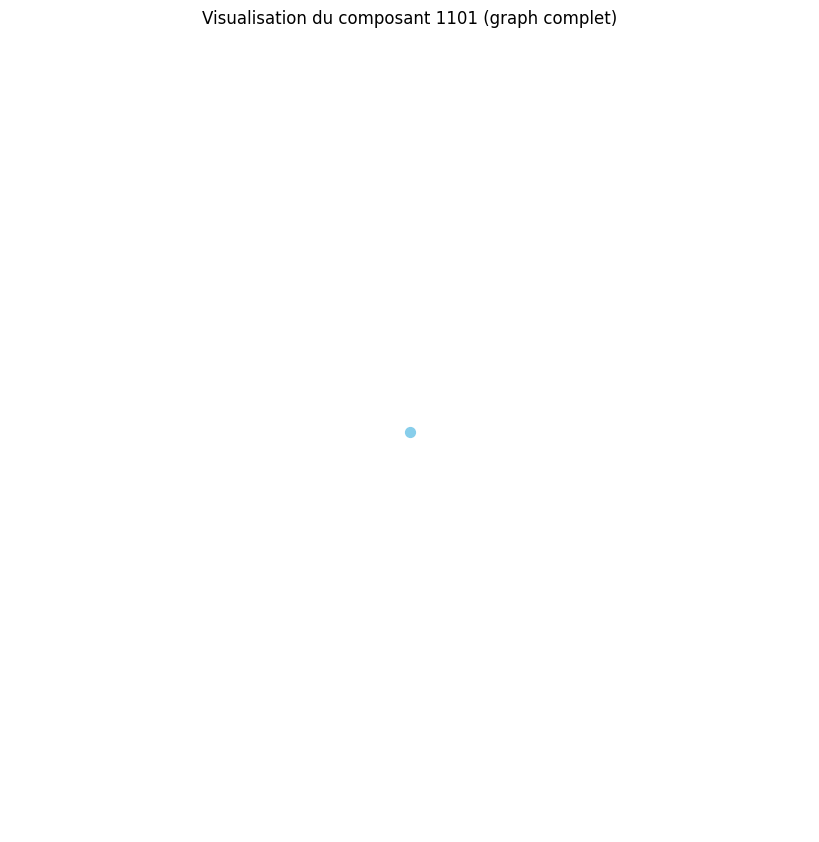

Distance moyenne pour le composant 1102 : 0.00
Le composant 1102 est un graphe complet ou très densément connecté.
Densité du composant 1102 : 0.00
Degré moyen du composant 1102 : 0.00
Coefficient de clustering moyen du composant 1102 : 0.00


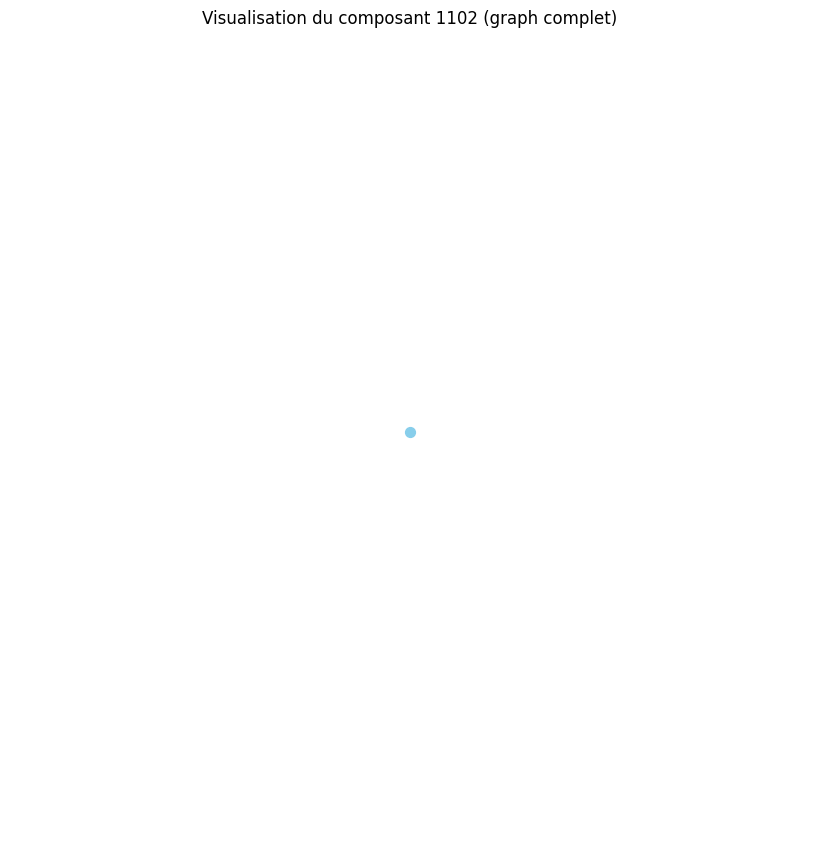

Distance moyenne pour le composant 1103 : 0.00
Le composant 1103 est un graphe complet ou très densément connecté.
Densité du composant 1103 : 0.00
Degré moyen du composant 1103 : 0.00
Coefficient de clustering moyen du composant 1103 : 0.00


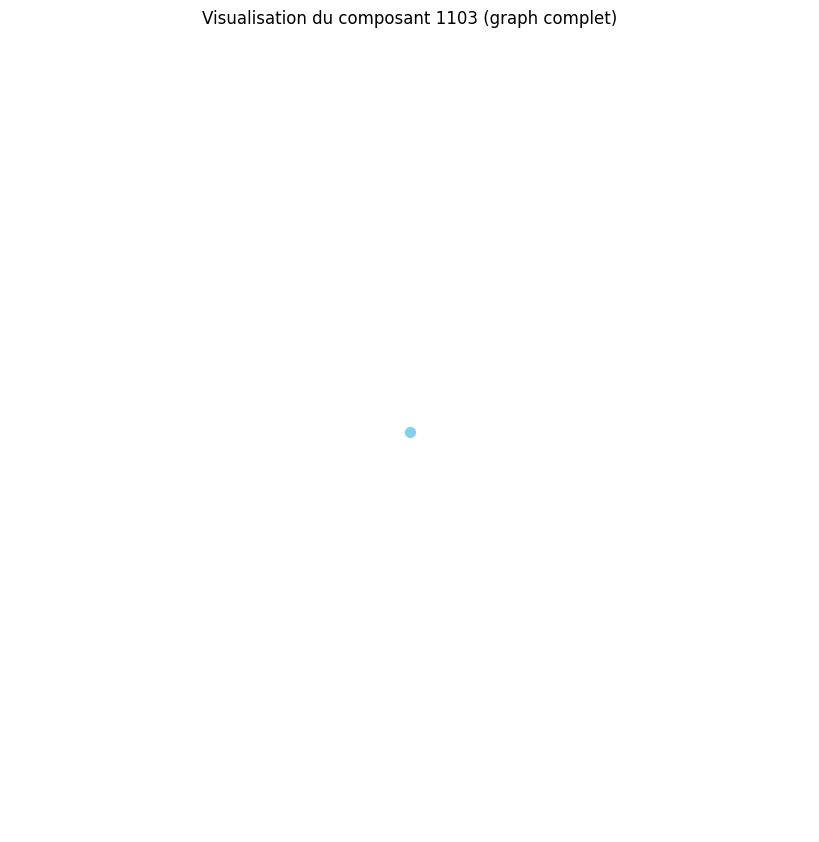

Distance moyenne pour le composant 1104 : 0.00
Le composant 1104 est un graphe complet ou très densément connecté.
Densité du composant 1104 : 0.00
Degré moyen du composant 1104 : 0.00
Coefficient de clustering moyen du composant 1104 : 0.00


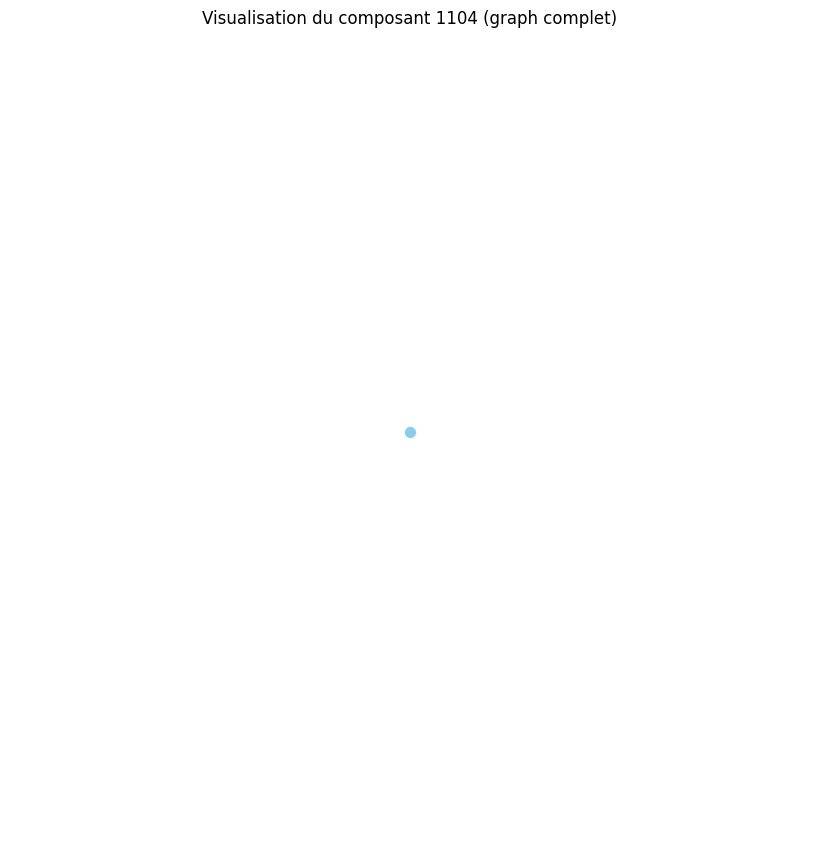

In [ ]:
# Vérifier si le graphe est connecté
if nx.is_connected(G):
    # Calcul de la distance moyenne si le graphe est connecté
    average_distance = nx.average_shortest_path_length(G)
    print(f"Distance moyenne entre tous les nœuds : {average_distance:.2f}")
else:
    # Calculer la distance moyenne pour chaque composant connecté
    components = list(nx.connected_components(G))
    for i, component in enumerate(components):
        subgraph = G.subgraph(component)
        try:
            avg_dist = nx.average_shortest_path_length(subgraph)
            print(f"Distance moyenne pour le composant {i+1} : {avg_dist:.2f}")

            # Si la distance moyenne est zéro, analyser davantage ce composant
            if avg_dist == 0:
                print(f"Le composant {i+1} est un graphe complet ou très densément connecté.")

                # Densité du graphe
                density = nx.density(subgraph)
                print(f"Densité du composant {i+1} : {density:.2f}")

                # Degré moyen
                avg_degree = sum(dict(subgraph.degree()).values()) / len(subgraph)
                print(f"Degré moyen du composant {i+1} : {avg_degree:.2f}")

                # Coefficient de clustering moyen
                avg_clustering = nx.average_clustering(subgraph)
                print(f"Coefficient de clustering moyen du composant {i+1} : {avg_clustering:.2f}")

                # Visualisation du composant
                plt.figure(figsize=(8, 8))
                nx.draw(subgraph, node_size=50, with_labels=False, node_color='skyblue')
                plt.title(f"Visualisation du composant {i+1} (graph complet)")
                plt.show()

        except nx.NetworkXError:
            print(f"Impossible de calculer la distance pour le composant {i+1}.")


In [ ]:
# --- Imports ---
import networkx as nx
import matplotlib.pyplot as plt
import random
from google.colab import files
import json

# --- Upload the file ---
uploaded = files.upload()

Saving com-youtube.ungraph.txt to com-youtube.ungraph (1).txt


In [ ]:
# --- Load the graph ---
file_name = list(uploaded.keys())[0]  # Get uploaded filename
G = nx.read_edgelist(file_name, comments='#', nodetype=int)
print(f"\u2705 Graphe chargé avec {G.number_of_nodes()} nœuds et {G.number_of_edges()} arêtes.")


✅ Graphe chargé avec 1134890 nœuds et 2987624 arêtes.


Cela permet de mieux comprendre les nœuds les plus importants dans le sous-graphe des 2000 nœuds les plus connectés sur YouTube.









In [ ]:
# --- Extraire les 2000 nœuds les plus connectés ---
top_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[:2000]
top_node_ids = [n for n, d in top_nodes]
G_sub = G.subgraph(top_node_ids).copy()
print(f"✅ Nouveau sous-graphe : {G_sub.number_of_nodes()} nœuds, {G_sub.number_of_edges()} arêtes")

# --- Calcul des centralités ---
print("Calcul des centralités... (cela peut prendre du temps)")

degree_centrality = nx.degree_centrality(G_sub)
closeness_centrality = nx.closeness_centrality(G_sub)
betweenness_centrality = nx.betweenness_centrality(G_sub, k=100, seed=42)

# Extraire le plus grand composant connexe pour eigenvector centrality
largest_cc = max(nx.connected_components(G_sub), key=len)
G_largest = G_sub.subgraph(largest_cc)

eigenvector_centrality = nx.eigenvector_centrality_numpy(G_largest)

# --- Affichage des 10 premiers pour chaque centralité ---
def top_10(centrality_dict):
    return sorted(centrality_dict.items(), key=lambda x: x[1], reverse=True)[:10]

print("🔹 Top 10 nœuds - Centralité de degré")
print(top_10(degree_centrality))

print("\n🔹 Top 10 nœuds - Centralité de proximité")
print(top_10(closeness_centrality))

print("\n🔹 Top 10 nœuds - Centralité d'intermédiarité")
print(top_10(betweenness_centrality))

print("\n🔹 Top 10 nœuds - Centralité du vecteur propre (plus grand composant connexe)")
print(top_10(eigenvector_centrality))

# --- Sauvegarde dans un fichier JSON ---
results = {
    "degree": top_10(degree_centrality),
    "closeness": top_10(closeness_centrality),
    "betweenness": top_10(betweenness_centrality),
    "eigenvector": top_10(eigenvector_centrality)
}

with open("centralities_results.json", "w") as f:
    json.dump(results, f)

print("\n✅ Résultats enregistrés dans centralities_results.json")

✅ Nouveau sous-graphe : 2000 nœuds, 51756 arêtes
Calcul des centralités... (cela peut prendre du temps)
🔹 Top 10 nœuds - Centralité de degré
[(363, 0.4442221110555277), (1072, 0.4212106053026513), (311, 0.2671335667833917), (1846, 0.19809904952476237), (617, 0.17808904452226113), (1490, 0.16058029014507252), (210, 0.15907953976988493), (106, 0.1570785392696348), (727, 0.14957478739369684), (663560, 0.14907453726863432)]

🔹 Top 10 nœuds - Centralité de proximité
[(363, 0.6341358899680314), (1072, 0.6235569783632767), (311, 0.5466447351711176), (663560, 0.523669183256709), (4, 0.5161648046534992), (106, 0.5145559792883454), (617, 0.514288816266908), (727, 0.5136221208867332), (1491, 0.5132229327098783), (1846, 0.5116323657696618)]

🔹 Top 10 nœuds - Centralité d'intermédiarité
[(363, 0.21779029318697707), (1072, 0.16300823041819099), (311, 0.031135834021557368), (1034018, 0.022225875848561685), (1846, 0.02126061866817644), (663560, 0.018297609868745898), (2526, 0.017375357604219436), (4, 

Les graphiques générés permettent de visualiser de manière claire et comparative l'importance relative des nœuds dans le réseau selon différentes métriques de centralité. Cela aide à comprendre quels nœuds dominent le réseau en termes de connexions directes, proximité, intermédiarité et influence globale.









<ipython-input-6-bafca19f4fbe>:14: UserWarning: Glyph 128313 (\N{SMALL BLUE DIAMOND}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128313 (\N{SMALL BLUE DIAMOND}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


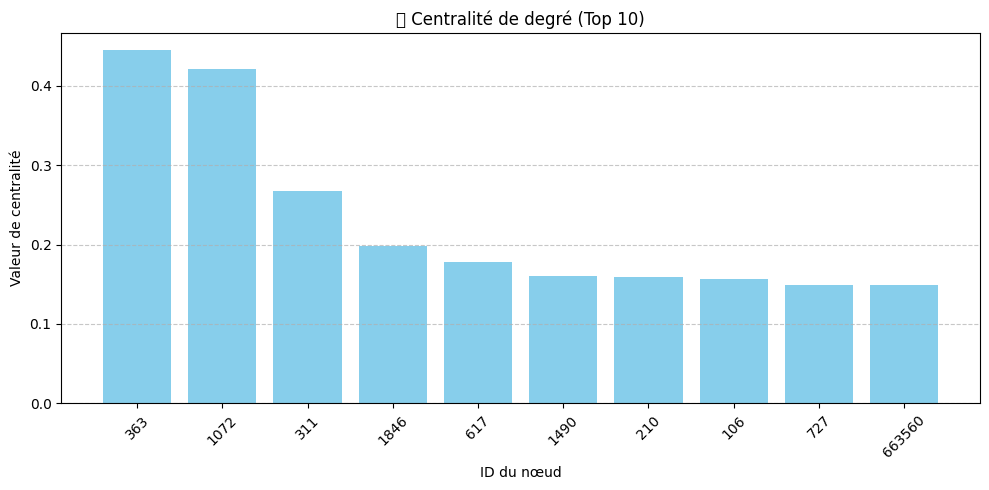

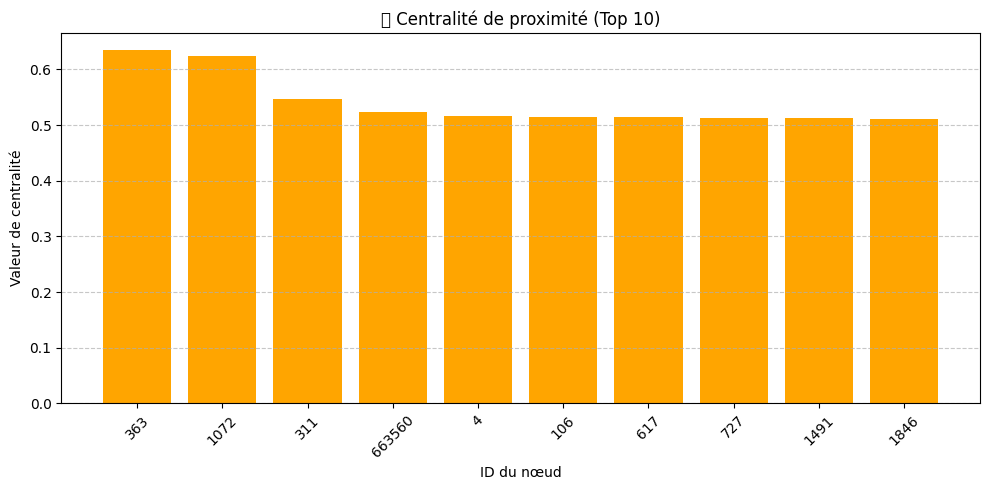

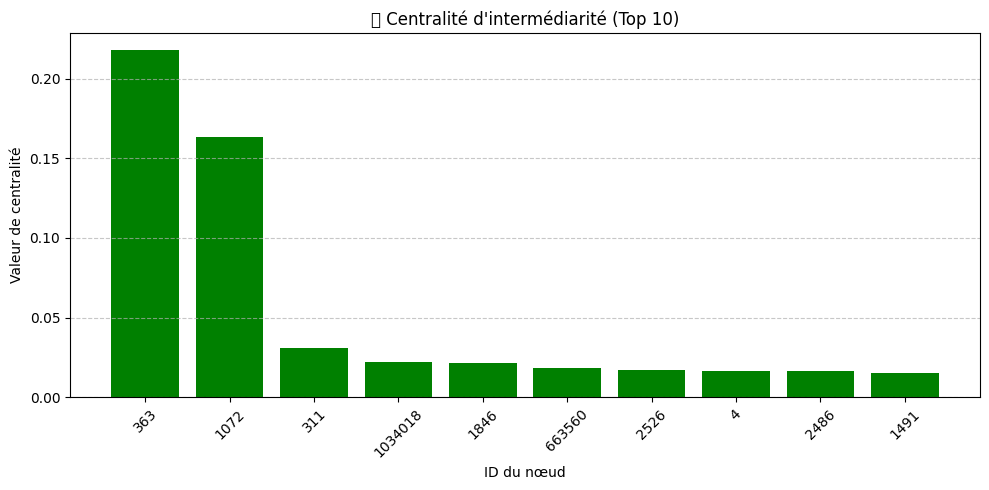

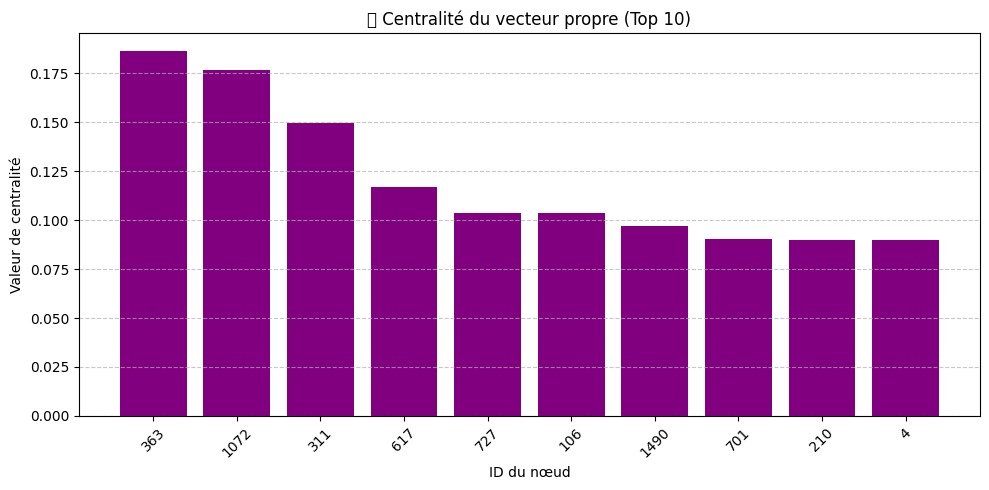

In [ ]:
# Fonction pour afficher un barplot
def plot_centrality(centrality_dict, title, color):
    top_10_nodes = sorted(centrality_dict.items(), key=lambda x: x[1], reverse=True)[:10]
    nodes = [str(node) for node, _ in top_10_nodes]
    values = [val for _, val in top_10_nodes]

    plt.figure(figsize=(10, 5))
    plt.bar(nodes, values, color=color)
    plt.title(title)
    plt.xlabel("ID du nœud")
    plt.ylabel("Valeur de centralité")
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# Visualiser chaque centralité
plot_centrality(degree_centrality, "🔹 Centralité de degré (Top 10)", "skyblue")
plot_centrality(closeness_centrality, "🔹 Centralité de proximité (Top 10)", "orange")
plot_centrality(betweenness_centrality, "🔹 Centralité d'intermédiarité (Top 10)", "green")
plot_centrality(eigenvector_centrality, "🔹 Centralité du vecteur propre (Top 10)", "purple")

Un graphique représentant un sous-graphe avec des nœuds dont la taille et la couleur dépendent de leur centralité de degré, ce qui permet de visualiser l’importance relative des nœuds dans le réseau. Les nœuds avec une centralité plus élevée apparaîtront plus grands et plus intenses en couleur.


<ipython-input-2-6c1401200fc2>:65: UserWarning: Glyph 128311 (\N{LARGE BLUE DIAMOND}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128311 (\N{LARGE BLUE DIAMOND}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


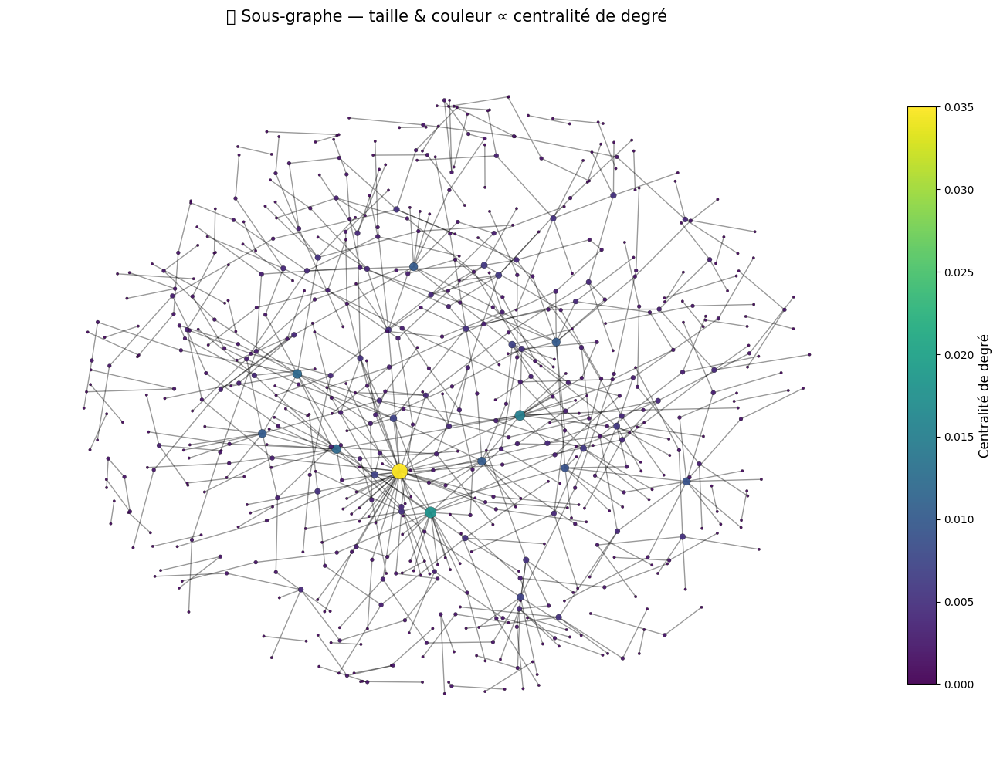

In [ ]:
import random
import matplotlib.pyplot as plt
import networkx as nx

# --- a) Si vous AVEZ déjà un graphe G (ex. depuis un fichier) ----------
# G = nx.read_graphml("mon_graphe.graphml")  # ou autre…

# --- b) Sinon : exemple de graphe de démonstration --------------------
# Supprimez ce bloc si vous chargez votre propre G
G = nx.barabasi_albert_graph(5000, 3, seed=1)   # 5 000 nœuds, modèle scale‑free

# ================== 2) SOUS‑GRAPHE ALÉATOIRE ==================
sample_size  = min(1000, G.number_of_nodes())      # max 1000 nœuds
sample_nodes = random.sample(list(G.nodes()), sample_size)
G_sub        = G.subgraph(sample_nodes).copy()     # .copy() => graphe autonome

# ================== 3) MESURES DE CENTRALITÉ ==================
degree_centrality = nx.degree_centrality(G_sub)    # dict : nœud → centralité

# ================== 4) VISUALISATION ==================
# ---- Paramètres « look » --------------------------------------
k_val        = 0.25           # espacement spring_layout
edge_alpha   = 0.4
edge_width   = 1.0
node_scale   = 6000           # pour gonfler les tailles
cmap_name    = "viridis"

# ---- Tailles & couleurs des nœuds ------------------------------
node_sizes  = [node_scale * degree_centrality[n] for n in G_sub.nodes()]
node_colors = [degree_centrality[n]             for n in G_sub.nodes()]

# ---- Layout « lâche » ------------------------------------------
pos = nx.spring_layout(G_sub, k=k_val, seed=42, iterations=100)
# (k contrôle l’allongement, seed la reproductibilité)

# ---- Figure ----------------------------------------------------
fig, ax = plt.subplots(figsize=(14, 10))

# Nœuds
nodes = nx.draw_networkx_nodes(
    G_sub, pos, ax=ax,
    node_size=node_sizes,
    node_color=node_colors,
    cmap=cmap_name,
    alpha=0.95,
    linewidths=0.2,
    edgecolors="black"
)

# Arêtes
nx.draw_networkx_edges(
    G_sub, pos, ax=ax,
    alpha=edge_alpha,
    width=edge_width
)

# Colorbar
cbar = plt.colorbar(nodes, ax=ax, shrink=0.8, pad=0.02)
cbar.set_label("Centralité de degré", fontsize=12)

# Titre et nettoyage
ax.set_title("🔷 Sous‑graphe — taille & couleur ∝ centralité de degré", fontsize=15, pad=12)
ax.axis("off")

plt.tight_layout()
plt.show()